In [15]:
import torch
from sklearn import metrics

import data_load
import model
import os
import h5py_cache
from torch.autograd import Variable
import numpy as np
import matplotlib.pyplot as plt

# Evaluation on test set 

In [6]:
NOISE_LEVELS = ['None', '-15', '-3']
BATCH_SIZE = 2048
FRAMES = 3
FEATURES = 24
STEP_SIZE = 1

In [7]:
def net_path(epoch, title):
    part = os.getcwd() + '/models/' + title
    if epoch >= 0:
        return part + '_epoch' + str(epoch).zfill(3) + '.net'
    else:
        return part + '.net'
    
def load_net(epoch = 14, title = 'net'):
    if torch.cuda.is_available():
        return torch.load(net_path(epoch, title))
    else:
        return torch.load(net_path(epoch, title), map_location='cpu')

In [4]:
from data_load import Dataset

def test_predict(net, data, noise_level):
    
    dataset_size = len(data['labels'])

    train_index = 0
    val_index = int(0.8 * dataset_size)
    test_index = int(0.9 * dataset_size)
       
    train_size = val_index
    val_size = test_index - val_index
    test_size = dataset_size - test_index
    _, __, test_list = [], [], []
    
    test_data = Dataset(data, test_index, test_size, frame_count=3, 
                        step_size=1, batch_size=BATCH_SIZE, noise=noise_level)
    
    net.eval()
    
    y_true, y_score = [], []

    for i in range(test_data.batch_count):

        X, y = test_data[i]
        X = Variable(torch.from_numpy(np.array(X)).float())
        y = Variable(torch.from_numpy(np.array(y))).long()

        if torch.cuda.is_available():
            X = X.cuda()

        out = net(X)

        if torch.cuda.is_available():
            out = out.cpu()
            y = y.cpu()
        
        # Add true labels.
        y_true.extend(y.data.numpy())

        # Add probabilities for positive labels.
        y_score.extend(out.data.numpy())
    
    return y_true, y_score
    


def roc_auc(net, data):
    '''
    Generates a ROC curve for the given network and data for each noise level.
    '''
    plt.figure(1, figsize=(16, 10))
    plt.title('Receiver Operating Characteristic', fontsize = 16)
    
    for noise_lvl in NOISE_LEVELS:
        
        # Make predictions
        y_true, y_score = test_predict(net, data, noise_lvl)

        # Compute ROC metrics and AUC
        fpr, tpr, thresholds = metrics.roc_curve(y_true, np.array(y_score)[:, 1])
        auc_res = metrics.auc(fpr, tpr)

        # Plots the ROC curve and show area.
        plt.plot(fpr, tpr, label='Noise level {} (AUC = {:.3f})'.format(noise_lvl, auc_res))

    #plt.xlim([0, 0.2])
    #plt.ylim([0.6, 1])
    plt.ylabel('True Positive Rate', fontsize = 16)
    plt.xlabel('False Positive Rate', fontsize = 16)
    plt.plot([0,1],[0,1],'r--')
    plt.legend(loc='lower right', prop={'size': 16})
    plt.show()

In [12]:
def evaluation(net, data):
    '''
    Get accuracy and F1-score
    '''
    
    for noise in NOISE_LEVELS:
        y_true, y_pred = test_predict(net, data, noise_level=noise)
        out = np.argmax(np.array(y_pred), axis=1)
        acc, f1 = np.mean(out == y_true), metrics.f1_score(y_true, out)
        print("For noise level {} db: \n F1-score: {}, Accuracy: {} ".format(noise, f1, acc))

In [11]:
net = load_net(title='net', epoch = 10)
data = h5py_cache.File('data/data.hdf5', 'r')
y_true, y_pred = test_predict(net, data, noise_level='None')

In [13]:
evaluation(net, data)

For noise level None db: 
 F1-score: 0.768356456895994, Accuracy: 0.8137096622827162 
For noise level -15 db: 
 F1-score: 0.7447976200495048, Accuracy: 0.7986996371979226 
For noise level -3 db: 
 F1-score: 0.6613861267762977, Accuracy: 0.7498426679974561 


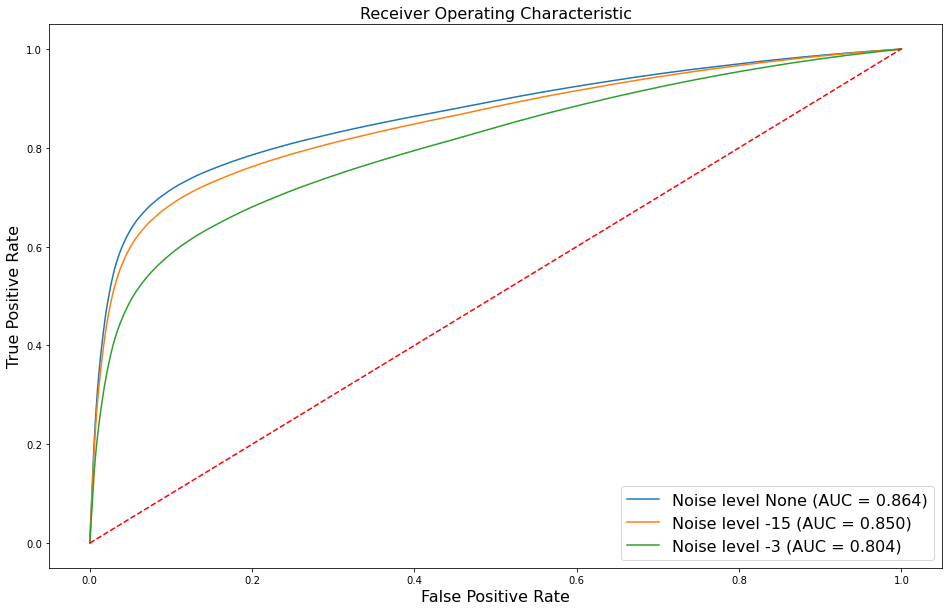

In [16]:
roc_auc(net, data)

In [94]:
def apply_threshold(y_score, t = 0.5):
    return [1 if y >= t else 0 for idx, y in enumerate(y_score)]

def fix_frr(y_true, y_score, frr_target):

    t = 0

    # Compute FAR for a fixed FRR
    while t < 1.0:

        tn, fp, fn, tp = metrics.confusion_matrix(y_true, apply_threshold(y_score, t)).ravel()

        far = fp / (fp + tn)
        frr = fn / (fn + tp)

        if frr >= frr_target:
            return t, far, frr

        t += 0.0001


def fix_far(y_true, y_score, far_target):

    t = 1
    
    # Compute FRR for a fixed FAR
    while t > 0:

        tn, fp, fn, tp = metrics.confusion_matrix(y_true, apply_threshold(y_score, t)).ravel()

        far = fp / (fp + tn)
        frr = fn / (fn + tp)

        if far >= far_target:
            return t, far, frr

        t -= 0.0001
        
        
def far_frr(y_true, y_score):

    t = 0.065
    
    # Compute t for FRR == FAR
    while t < 1.0:

        tn, fp, fn, tp = metrics.confusion_matrix(y_true, apply_threshold(y_score, t)).ravel()

        far = fp / (fp + tn)
        frr = fn / (fn + tp)
        
        print(frr, far)
        if frr >= far:
            return t, far, frr

        t += 0.0001

In [ ]:
print("Порог, при котором FR = 1% : {}".format(fix_frr(y_true, np.array(y_pred)[:, 1], 0.01)))
print("Порог, при котором FA = 1% : {}".format(fix_far(y_true, np.array(y_pred)[:, 1], 0.01)))
print("Порог, при котором FA =FR : {}".format(far_frr(y_true, np.array(y_pred)[:, 1])))

# Getting results on the provided test dataset 

In [139]:
import preprocessing 
import python_speech_features

### Prepare the data

In [110]:
test_prov = preprocessing.DataMerger('test', 'for_devs')
test_prov.prepare_files()
test_prov.collect_frames()
test_prov.label_frames()

Found 1500 tracks to check.
Processing 1500 of 1500
Done!
Merging frames (1042185 of 1042185)
Done!
Labelling frames (1042185 of 1042185)
Done!


In [128]:
# Specify the desired WAV-format.
SAMPLE_RATE = 16000
SAMPLE_CHANNELS = 1
SAMPLE_WIDTH = 2

# Name of folder to save the data files in.
DATA_FOLDER = 'data'

# Min/max length for slicing the voice files.
SLICE_MIN_MS = 1000
SLICE_MAX_MS = 5000

# Frame size to use for the labelling.
FRAME_SIZE_MS = 10

# Convert slice ms to frame size.
SLICE_MIN = int(SLICE_MIN_MS / FRAME_SIZE_MS)
SLICE_MAX = int(SLICE_MAX_MS / FRAME_SIZE_MS)

# Calculate frame size in data points.
FRAME_SIZE = int(SAMPLE_RATE * (FRAME_SIZE_MS / 1000.0))

In [150]:
test_data = h5py_cache.File(DATA_FOLDER + '/test_data.hdf5', 'a', chunk_cache_mem_size=1024 ** 3)
mfcc_window_frame_size = 4
l = len(test_prov.data['frames'])
total = l  + mfcc_window_frame_size

In [ ]:
test_data.create_dataset('frames', (total, FRAME_SIZE), dtype=np.dtype(np.int16))
test_data.create_dataset('mfcc', (total, 12), dtype=np.dtype(np.float32))
test_data.create_dataset('delta', (total, 12), dtype=np.dtype(np.float32))
test_data.create_dataset('labels', (total,), dtype=np.dtype(np.int8))

In [153]:
number_frames = len(test_prov.data['frames'])
for i in range(number_frames):
    print("frame {} out of {}".format(i, number_frames))
    mfcc = python_speech_features.mfcc(test_prov.data['frames'][i], SAMPLE_RATE, winstep=(FRAME_SIZE_MS / 1000),
                                       winlen=mfcc_window_frame_size * (FRAME_SIZE_MS / 1000), nfft=2048)
    mfcc = mfcc[:, 1:]
    delta = python_speech_features.delta(mfcc, 2)
    test_data['frames'][i] = test_prov.data['frames'][i]
    test_data['mfcc'][i] = mfcc
    test_data['delta'][i] = mfcc
    test_data['labels'][i] = test_prov.data['labels'][i]

frame 0 out of 1042185
frame 1 out of 1042185
frame 2 out of 1042185
frame 3 out of 1042185
frame 4 out of 1042185
frame 5 out of 1042185
frame 6 out of 1042185
frame 7 out of 1042185
frame 8 out of 1042185
frame 9 out of 1042185
frame 10 out of 1042185
frame 11 out of 1042185
frame 12 out of 1042185
frame 13 out of 1042185
frame 14 out of 1042185
frame 15 out of 1042185
frame 16 out of 1042185
frame 17 out of 1042185
frame 18 out of 1042185
frame 19 out of 1042185
frame 20 out of 1042185
frame 21 out of 1042185
frame 22 out of 1042185
frame 23 out of 1042185
frame 24 out of 1042185
frame 25 out of 1042185
frame 26 out of 1042185
frame 27 out of 1042185
frame 28 out of 1042185
frame 29 out of 1042185
frame 30 out of 1042185
frame 31 out of 1042185
frame 32 out of 1042185
frame 33 out of 1042185
frame 34 out of 1042185
frame 35 out of 1042185
frame 36 out of 1042185
frame 37 out of 1042185
frame 38 out of 1042185
frame 39 out of 1042185
frame 40 out of 1042185
frame 41 out of 1042185
fr

frame 350 out of 1042185
frame 351 out of 1042185
frame 352 out of 1042185
frame 353 out of 1042185
frame 354 out of 1042185
frame 355 out of 1042185
frame 356 out of 1042185
frame 357 out of 1042185
frame 358 out of 1042185
frame 359 out of 1042185
frame 360 out of 1042185
frame 361 out of 1042185
frame 362 out of 1042185
frame 363 out of 1042185
frame 364 out of 1042185
frame 365 out of 1042185
frame 366 out of 1042185
frame 367 out of 1042185
frame 368 out of 1042185
frame 369 out of 1042185
frame 370 out of 1042185
frame 371 out of 1042185
frame 372 out of 1042185
frame 373 out of 1042185
frame 374 out of 1042185
frame 375 out of 1042185
frame 376 out of 1042185
frame 377 out of 1042185
frame 378 out of 1042185
frame 379 out of 1042185
frame 380 out of 1042185
frame 381 out of 1042185
frame 382 out of 1042185
frame 383 out of 1042185
frame 384 out of 1042185
frame 385 out of 1042185
frame 386 out of 1042185
frame 387 out of 1042185
frame 388 out of 1042185
frame 389 out of 1042185


frame 713 out of 1042185
frame 714 out of 1042185
frame 715 out of 1042185
frame 716 out of 1042185
frame 717 out of 1042185
frame 718 out of 1042185
frame 719 out of 1042185
frame 720 out of 1042185
frame 721 out of 1042185
frame 722 out of 1042185
frame 723 out of 1042185
frame 724 out of 1042185
frame 725 out of 1042185
frame 726 out of 1042185
frame 727 out of 1042185
frame 728 out of 1042185
frame 729 out of 1042185
frame 730 out of 1042185
frame 731 out of 1042185
frame 732 out of 1042185
frame 733 out of 1042185
frame 734 out of 1042185
frame 735 out of 1042185
frame 736 out of 1042185
frame 737 out of 1042185
frame 738 out of 1042185
frame 739 out of 1042185
frame 740 out of 1042185
frame 741 out of 1042185
frame 742 out of 1042185
frame 743 out of 1042185
frame 744 out of 1042185
frame 745 out of 1042185
frame 746 out of 1042185
frame 747 out of 1042185
frame 748 out of 1042185
frame 749 out of 1042185
frame 750 out of 1042185
frame 751 out of 1042185
frame 752 out of 1042185


frame 1043 out of 1042185
frame 1044 out of 1042185
frame 1045 out of 1042185
frame 1046 out of 1042185
frame 1047 out of 1042185
frame 1048 out of 1042185
frame 1049 out of 1042185
frame 1050 out of 1042185
frame 1051 out of 1042185
frame 1052 out of 1042185
frame 1053 out of 1042185
frame 1054 out of 1042185
frame 1055 out of 1042185
frame 1056 out of 1042185
frame 1057 out of 1042185
frame 1058 out of 1042185
frame 1059 out of 1042185
frame 1060 out of 1042185
frame 1061 out of 1042185
frame 1062 out of 1042185
frame 1063 out of 1042185
frame 1064 out of 1042185
frame 1065 out of 1042185
frame 1066 out of 1042185
frame 1067 out of 1042185
frame 1068 out of 1042185
frame 1069 out of 1042185
frame 1070 out of 1042185
frame 1071 out of 1042185
frame 1072 out of 1042185
frame 1073 out of 1042185
frame 1074 out of 1042185
frame 1075 out of 1042185
frame 1076 out of 1042185
frame 1077 out of 1042185
frame 1078 out of 1042185
frame 1079 out of 1042185
frame 1080 out of 1042185
frame 1081 o

frame 1370 out of 1042185
frame 1371 out of 1042185
frame 1372 out of 1042185
frame 1373 out of 1042185
frame 1374 out of 1042185
frame 1375 out of 1042185
frame 1376 out of 1042185
frame 1377 out of 1042185
frame 1378 out of 1042185
frame 1379 out of 1042185
frame 1380 out of 1042185
frame 1381 out of 1042185
frame 1382 out of 1042185
frame 1383 out of 1042185
frame 1384 out of 1042185
frame 1385 out of 1042185
frame 1386 out of 1042185
frame 1387 out of 1042185
frame 1388 out of 1042185
frame 1389 out of 1042185
frame 1390 out of 1042185
frame 1391 out of 1042185
frame 1392 out of 1042185
frame 1393 out of 1042185
frame 1394 out of 1042185
frame 1395 out of 1042185
frame 1396 out of 1042185
frame 1397 out of 1042185
frame 1398 out of 1042185
frame 1399 out of 1042185
frame 1400 out of 1042185
frame 1401 out of 1042185
frame 1402 out of 1042185
frame 1403 out of 1042185
frame 1404 out of 1042185
frame 1405 out of 1042185
frame 1406 out of 1042185
frame 1407 out of 1042185
frame 1408 o

frame 1695 out of 1042185
frame 1696 out of 1042185
frame 1697 out of 1042185
frame 1698 out of 1042185
frame 1699 out of 1042185
frame 1700 out of 1042185
frame 1701 out of 1042185
frame 1702 out of 1042185
frame 1703 out of 1042185
frame 1704 out of 1042185
frame 1705 out of 1042185
frame 1706 out of 1042185
frame 1707 out of 1042185
frame 1708 out of 1042185
frame 1709 out of 1042185
frame 1710 out of 1042185
frame 1711 out of 1042185
frame 1712 out of 1042185
frame 1713 out of 1042185
frame 1714 out of 1042185
frame 1715 out of 1042185
frame 1716 out of 1042185
frame 1717 out of 1042185
frame 1718 out of 1042185
frame 1719 out of 1042185
frame 1720 out of 1042185
frame 1721 out of 1042185
frame 1722 out of 1042185
frame 1723 out of 1042185
frame 1724 out of 1042185
frame 1725 out of 1042185
frame 1726 out of 1042185
frame 1727 out of 1042185
frame 1728 out of 1042185
frame 1729 out of 1042185
frame 1730 out of 1042185
frame 1731 out of 1042185
frame 1732 out of 1042185
frame 1733 o

frame 2028 out of 1042185
frame 2029 out of 1042185
frame 2030 out of 1042185
frame 2031 out of 1042185
frame 2032 out of 1042185
frame 2033 out of 1042185
frame 2034 out of 1042185
frame 2035 out of 1042185
frame 2036 out of 1042185
frame 2037 out of 1042185
frame 2038 out of 1042185
frame 2039 out of 1042185
frame 2040 out of 1042185
frame 2041 out of 1042185
frame 2042 out of 1042185
frame 2043 out of 1042185
frame 2044 out of 1042185
frame 2045 out of 1042185
frame 2046 out of 1042185
frame 2047 out of 1042185
frame 2048 out of 1042185
frame 2049 out of 1042185
frame 2050 out of 1042185
frame 2051 out of 1042185
frame 2052 out of 1042185
frame 2053 out of 1042185
frame 2054 out of 1042185
frame 2055 out of 1042185
frame 2056 out of 1042185
frame 2057 out of 1042185
frame 2058 out of 1042185
frame 2059 out of 1042185
frame 2060 out of 1042185
frame 2061 out of 1042185
frame 2062 out of 1042185
frame 2063 out of 1042185
frame 2064 out of 1042185
frame 2065 out of 1042185
frame 2066 o

frame 2372 out of 1042185
frame 2373 out of 1042185
frame 2374 out of 1042185
frame 2375 out of 1042185
frame 2376 out of 1042185
frame 2377 out of 1042185
frame 2378 out of 1042185
frame 2379 out of 1042185
frame 2380 out of 1042185
frame 2381 out of 1042185
frame 2382 out of 1042185
frame 2383 out of 1042185
frame 2384 out of 1042185
frame 2385 out of 1042185
frame 2386 out of 1042185
frame 2387 out of 1042185
frame 2388 out of 1042185
frame 2389 out of 1042185
frame 2390 out of 1042185
frame 2391 out of 1042185
frame 2392 out of 1042185
frame 2393 out of 1042185
frame 2394 out of 1042185
frame 2395 out of 1042185
frame 2396 out of 1042185
frame 2397 out of 1042185
frame 2398 out of 1042185
frame 2399 out of 1042185
frame 2400 out of 1042185
frame 2401 out of 1042185
frame 2402 out of 1042185
frame 2403 out of 1042185
frame 2404 out of 1042185
frame 2405 out of 1042185
frame 2406 out of 1042185
frame 2407 out of 1042185
frame 2408 out of 1042185
frame 2409 out of 1042185
frame 2410 o

frame 2700 out of 1042185
frame 2701 out of 1042185
frame 2702 out of 1042185
frame 2703 out of 1042185
frame 2704 out of 1042185
frame 2705 out of 1042185
frame 2706 out of 1042185
frame 2707 out of 1042185
frame 2708 out of 1042185
frame 2709 out of 1042185
frame 2710 out of 1042185
frame 2711 out of 1042185
frame 2712 out of 1042185
frame 2713 out of 1042185
frame 2714 out of 1042185
frame 2715 out of 1042185
frame 2716 out of 1042185
frame 2717 out of 1042185
frame 2718 out of 1042185
frame 2719 out of 1042185
frame 2720 out of 1042185
frame 2721 out of 1042185
frame 2722 out of 1042185
frame 2723 out of 1042185
frame 2724 out of 1042185
frame 2725 out of 1042185
frame 2726 out of 1042185
frame 2727 out of 1042185
frame 2728 out of 1042185
frame 2729 out of 1042185
frame 2730 out of 1042185
frame 2731 out of 1042185
frame 2732 out of 1042185
frame 2733 out of 1042185
frame 2734 out of 1042185
frame 2735 out of 1042185
frame 2736 out of 1042185
frame 2737 out of 1042185
frame 2738 o

frame 3020 out of 1042185
frame 3021 out of 1042185
frame 3022 out of 1042185
frame 3023 out of 1042185
frame 3024 out of 1042185
frame 3025 out of 1042185
frame 3026 out of 1042185
frame 3027 out of 1042185
frame 3028 out of 1042185
frame 3029 out of 1042185
frame 3030 out of 1042185
frame 3031 out of 1042185
frame 3032 out of 1042185
frame 3033 out of 1042185
frame 3034 out of 1042185
frame 3035 out of 1042185
frame 3036 out of 1042185
frame 3037 out of 1042185
frame 3038 out of 1042185
frame 3039 out of 1042185
frame 3040 out of 1042185
frame 3041 out of 1042185
frame 3042 out of 1042185
frame 3043 out of 1042185
frame 3044 out of 1042185
frame 3045 out of 1042185
frame 3046 out of 1042185
frame 3047 out of 1042185
frame 3048 out of 1042185
frame 3049 out of 1042185
frame 3050 out of 1042185
frame 3051 out of 1042185
frame 3052 out of 1042185
frame 3053 out of 1042185
frame 3054 out of 1042185
frame 3055 out of 1042185
frame 3056 out of 1042185
frame 3057 out of 1042185
frame 3058 o

frame 3367 out of 1042185
frame 3368 out of 1042185
frame 3369 out of 1042185
frame 3370 out of 1042185
frame 3371 out of 1042185
frame 3372 out of 1042185
frame 3373 out of 1042185
frame 3374 out of 1042185
frame 3375 out of 1042185
frame 3376 out of 1042185
frame 3377 out of 1042185
frame 3378 out of 1042185
frame 3379 out of 1042185
frame 3380 out of 1042185
frame 3381 out of 1042185
frame 3382 out of 1042185
frame 3383 out of 1042185
frame 3384 out of 1042185
frame 3385 out of 1042185
frame 3386 out of 1042185
frame 3387 out of 1042185
frame 3388 out of 1042185
frame 3389 out of 1042185
frame 3390 out of 1042185
frame 3391 out of 1042185
frame 3392 out of 1042185
frame 3393 out of 1042185
frame 3394 out of 1042185
frame 3395 out of 1042185
frame 3396 out of 1042185
frame 3397 out of 1042185
frame 3398 out of 1042185
frame 3399 out of 1042185
frame 3400 out of 1042185
frame 3401 out of 1042185
frame 3402 out of 1042185
frame 3403 out of 1042185
frame 3404 out of 1042185
frame 3405 o

frame 3699 out of 1042185
frame 3700 out of 1042185
frame 3701 out of 1042185
frame 3702 out of 1042185
frame 3703 out of 1042185
frame 3704 out of 1042185
frame 3705 out of 1042185
frame 3706 out of 1042185
frame 3707 out of 1042185
frame 3708 out of 1042185
frame 3709 out of 1042185
frame 3710 out of 1042185
frame 3711 out of 1042185
frame 3712 out of 1042185
frame 3713 out of 1042185
frame 3714 out of 1042185
frame 3715 out of 1042185
frame 3716 out of 1042185
frame 3717 out of 1042185
frame 3718 out of 1042185
frame 3719 out of 1042185
frame 3720 out of 1042185
frame 3721 out of 1042185
frame 3722 out of 1042185
frame 3723 out of 1042185
frame 3724 out of 1042185
frame 3725 out of 1042185
frame 3726 out of 1042185
frame 3727 out of 1042185
frame 3728 out of 1042185
frame 3729 out of 1042185
frame 3730 out of 1042185
frame 3731 out of 1042185
frame 3732 out of 1042185
frame 3733 out of 1042185
frame 3734 out of 1042185
frame 3735 out of 1042185
frame 3736 out of 1042185
frame 3737 o

frame 4033 out of 1042185
frame 4034 out of 1042185
frame 4035 out of 1042185
frame 4036 out of 1042185
frame 4037 out of 1042185
frame 4038 out of 1042185
frame 4039 out of 1042185
frame 4040 out of 1042185
frame 4041 out of 1042185
frame 4042 out of 1042185
frame 4043 out of 1042185
frame 4044 out of 1042185
frame 4045 out of 1042185
frame 4046 out of 1042185
frame 4047 out of 1042185
frame 4048 out of 1042185
frame 4049 out of 1042185
frame 4050 out of 1042185
frame 4051 out of 1042185
frame 4052 out of 1042185
frame 4053 out of 1042185
frame 4054 out of 1042185
frame 4055 out of 1042185
frame 4056 out of 1042185
frame 4057 out of 1042185
frame 4058 out of 1042185
frame 4059 out of 1042185
frame 4060 out of 1042185
frame 4061 out of 1042185
frame 4062 out of 1042185
frame 4063 out of 1042185
frame 4064 out of 1042185
frame 4065 out of 1042185
frame 4066 out of 1042185
frame 4067 out of 1042185
frame 4068 out of 1042185
frame 4069 out of 1042185
frame 4070 out of 1042185
frame 4071 o

frame 4369 out of 1042185
frame 4370 out of 1042185
frame 4371 out of 1042185
frame 4372 out of 1042185
frame 4373 out of 1042185
frame 4374 out of 1042185
frame 4375 out of 1042185
frame 4376 out of 1042185
frame 4377 out of 1042185
frame 4378 out of 1042185
frame 4379 out of 1042185
frame 4380 out of 1042185
frame 4381 out of 1042185
frame 4382 out of 1042185
frame 4383 out of 1042185
frame 4384 out of 1042185
frame 4385 out of 1042185
frame 4386 out of 1042185
frame 4387 out of 1042185
frame 4388 out of 1042185
frame 4389 out of 1042185
frame 4390 out of 1042185
frame 4391 out of 1042185
frame 4392 out of 1042185
frame 4393 out of 1042185
frame 4394 out of 1042185
frame 4395 out of 1042185
frame 4396 out of 1042185
frame 4397 out of 1042185
frame 4398 out of 1042185
frame 4399 out of 1042185
frame 4400 out of 1042185
frame 4401 out of 1042185
frame 4402 out of 1042185
frame 4403 out of 1042185
frame 4404 out of 1042185
frame 4405 out of 1042185
frame 4406 out of 1042185
frame 4407 o

frame 4715 out of 1042185
frame 4716 out of 1042185
frame 4717 out of 1042185
frame 4718 out of 1042185
frame 4719 out of 1042185
frame 4720 out of 1042185
frame 4721 out of 1042185
frame 4722 out of 1042185
frame 4723 out of 1042185
frame 4724 out of 1042185
frame 4725 out of 1042185
frame 4726 out of 1042185
frame 4727 out of 1042185
frame 4728 out of 1042185
frame 4729 out of 1042185
frame 4730 out of 1042185
frame 4731 out of 1042185
frame 4732 out of 1042185
frame 4733 out of 1042185
frame 4734 out of 1042185
frame 4735 out of 1042185
frame 4736 out of 1042185
frame 4737 out of 1042185
frame 4738 out of 1042185
frame 4739 out of 1042185
frame 4740 out of 1042185
frame 4741 out of 1042185
frame 4742 out of 1042185
frame 4743 out of 1042185
frame 4744 out of 1042185
frame 4745 out of 1042185
frame 4746 out of 1042185
frame 4747 out of 1042185
frame 4748 out of 1042185
frame 4749 out of 1042185
frame 4750 out of 1042185
frame 4751 out of 1042185
frame 4752 out of 1042185
frame 4753 o

frame 5044 out of 1042185
frame 5045 out of 1042185
frame 5046 out of 1042185
frame 5047 out of 1042185
frame 5048 out of 1042185
frame 5049 out of 1042185
frame 5050 out of 1042185
frame 5051 out of 1042185
frame 5052 out of 1042185
frame 5053 out of 1042185
frame 5054 out of 1042185
frame 5055 out of 1042185
frame 5056 out of 1042185
frame 5057 out of 1042185
frame 5058 out of 1042185
frame 5059 out of 1042185
frame 5060 out of 1042185
frame 5061 out of 1042185
frame 5062 out of 1042185
frame 5063 out of 1042185
frame 5064 out of 1042185
frame 5065 out of 1042185
frame 5066 out of 1042185
frame 5067 out of 1042185
frame 5068 out of 1042185
frame 5069 out of 1042185
frame 5070 out of 1042185
frame 5071 out of 1042185
frame 5072 out of 1042185
frame 5073 out of 1042185
frame 5074 out of 1042185
frame 5075 out of 1042185
frame 5076 out of 1042185
frame 5077 out of 1042185
frame 5078 out of 1042185
frame 5079 out of 1042185
frame 5080 out of 1042185
frame 5081 out of 1042185
frame 5082 o

frame 5374 out of 1042185
frame 5375 out of 1042185
frame 5376 out of 1042185
frame 5377 out of 1042185
frame 5378 out of 1042185
frame 5379 out of 1042185
frame 5380 out of 1042185
frame 5381 out of 1042185
frame 5382 out of 1042185
frame 5383 out of 1042185
frame 5384 out of 1042185
frame 5385 out of 1042185
frame 5386 out of 1042185
frame 5387 out of 1042185
frame 5388 out of 1042185
frame 5389 out of 1042185
frame 5390 out of 1042185
frame 5391 out of 1042185
frame 5392 out of 1042185
frame 5393 out of 1042185
frame 5394 out of 1042185
frame 5395 out of 1042185
frame 5396 out of 1042185
frame 5397 out of 1042185
frame 5398 out of 1042185
frame 5399 out of 1042185
frame 5400 out of 1042185
frame 5401 out of 1042185
frame 5402 out of 1042185
frame 5403 out of 1042185
frame 5404 out of 1042185
frame 5405 out of 1042185
frame 5406 out of 1042185
frame 5407 out of 1042185
frame 5408 out of 1042185
frame 5409 out of 1042185
frame 5410 out of 1042185
frame 5411 out of 1042185
frame 5412 o

frame 5707 out of 1042185
frame 5708 out of 1042185
frame 5709 out of 1042185
frame 5710 out of 1042185
frame 5711 out of 1042185
frame 5712 out of 1042185
frame 5713 out of 1042185
frame 5714 out of 1042185
frame 5715 out of 1042185
frame 5716 out of 1042185
frame 5717 out of 1042185
frame 5718 out of 1042185
frame 5719 out of 1042185
frame 5720 out of 1042185
frame 5721 out of 1042185
frame 5722 out of 1042185
frame 5723 out of 1042185
frame 5724 out of 1042185
frame 5725 out of 1042185
frame 5726 out of 1042185
frame 5727 out of 1042185
frame 5728 out of 1042185
frame 5729 out of 1042185
frame 5730 out of 1042185
frame 5731 out of 1042185
frame 5732 out of 1042185
frame 5733 out of 1042185
frame 5734 out of 1042185
frame 5735 out of 1042185
frame 5736 out of 1042185
frame 5737 out of 1042185
frame 5738 out of 1042185
frame 5739 out of 1042185
frame 5740 out of 1042185
frame 5741 out of 1042185
frame 5742 out of 1042185
frame 5743 out of 1042185
frame 5744 out of 1042185
frame 5745 o

frame 6064 out of 1042185
frame 6065 out of 1042185
frame 6066 out of 1042185
frame 6067 out of 1042185
frame 6068 out of 1042185
frame 6069 out of 1042185
frame 6070 out of 1042185
frame 6071 out of 1042185
frame 6072 out of 1042185
frame 6073 out of 1042185
frame 6074 out of 1042185
frame 6075 out of 1042185
frame 6076 out of 1042185
frame 6077 out of 1042185
frame 6078 out of 1042185
frame 6079 out of 1042185
frame 6080 out of 1042185
frame 6081 out of 1042185
frame 6082 out of 1042185
frame 6083 out of 1042185
frame 6084 out of 1042185
frame 6085 out of 1042185
frame 6086 out of 1042185
frame 6087 out of 1042185
frame 6088 out of 1042185
frame 6089 out of 1042185
frame 6090 out of 1042185
frame 6091 out of 1042185
frame 6092 out of 1042185
frame 6093 out of 1042185
frame 6094 out of 1042185
frame 6095 out of 1042185
frame 6096 out of 1042185
frame 6097 out of 1042185
frame 6098 out of 1042185
frame 6099 out of 1042185
frame 6100 out of 1042185
frame 6101 out of 1042185
frame 6102 o

frame 6392 out of 1042185
frame 6393 out of 1042185
frame 6394 out of 1042185
frame 6395 out of 1042185
frame 6396 out of 1042185
frame 6397 out of 1042185
frame 6398 out of 1042185
frame 6399 out of 1042185
frame 6400 out of 1042185
frame 6401 out of 1042185
frame 6402 out of 1042185
frame 6403 out of 1042185
frame 6404 out of 1042185
frame 6405 out of 1042185
frame 6406 out of 1042185
frame 6407 out of 1042185
frame 6408 out of 1042185
frame 6409 out of 1042185
frame 6410 out of 1042185
frame 6411 out of 1042185
frame 6412 out of 1042185
frame 6413 out of 1042185
frame 6414 out of 1042185
frame 6415 out of 1042185
frame 6416 out of 1042185
frame 6417 out of 1042185
frame 6418 out of 1042185
frame 6419 out of 1042185
frame 6420 out of 1042185
frame 6421 out of 1042185
frame 6422 out of 1042185
frame 6423 out of 1042185
frame 6424 out of 1042185
frame 6425 out of 1042185
frame 6426 out of 1042185
frame 6427 out of 1042185
frame 6428 out of 1042185
frame 6429 out of 1042185
frame 6430 o

frame 6739 out of 1042185
frame 6740 out of 1042185
frame 6741 out of 1042185
frame 6742 out of 1042185
frame 6743 out of 1042185
frame 6744 out of 1042185
frame 6745 out of 1042185
frame 6746 out of 1042185
frame 6747 out of 1042185
frame 6748 out of 1042185
frame 6749 out of 1042185
frame 6750 out of 1042185
frame 6751 out of 1042185
frame 6752 out of 1042185
frame 6753 out of 1042185
frame 6754 out of 1042185
frame 6755 out of 1042185
frame 6756 out of 1042185
frame 6757 out of 1042185
frame 6758 out of 1042185
frame 6759 out of 1042185
frame 6760 out of 1042185
frame 6761 out of 1042185
frame 6762 out of 1042185
frame 6763 out of 1042185
frame 6764 out of 1042185
frame 6765 out of 1042185
frame 6766 out of 1042185
frame 6767 out of 1042185
frame 6768 out of 1042185
frame 6769 out of 1042185
frame 6770 out of 1042185
frame 6771 out of 1042185
frame 6772 out of 1042185
frame 6773 out of 1042185
frame 6774 out of 1042185
frame 6775 out of 1042185
frame 6776 out of 1042185
frame 6777 o

frame 7070 out of 1042185
frame 7071 out of 1042185
frame 7072 out of 1042185
frame 7073 out of 1042185
frame 7074 out of 1042185
frame 7075 out of 1042185
frame 7076 out of 1042185
frame 7077 out of 1042185
frame 7078 out of 1042185
frame 7079 out of 1042185
frame 7080 out of 1042185
frame 7081 out of 1042185
frame 7082 out of 1042185
frame 7083 out of 1042185
frame 7084 out of 1042185
frame 7085 out of 1042185
frame 7086 out of 1042185
frame 7087 out of 1042185
frame 7088 out of 1042185
frame 7089 out of 1042185
frame 7090 out of 1042185
frame 7091 out of 1042185
frame 7092 out of 1042185
frame 7093 out of 1042185
frame 7094 out of 1042185
frame 7095 out of 1042185
frame 7096 out of 1042185
frame 7097 out of 1042185
frame 7098 out of 1042185
frame 7099 out of 1042185
frame 7100 out of 1042185
frame 7101 out of 1042185
frame 7102 out of 1042185
frame 7103 out of 1042185
frame 7104 out of 1042185
frame 7105 out of 1042185
frame 7106 out of 1042185
frame 7107 out of 1042185
frame 7108 o

frame 7387 out of 1042185
frame 7388 out of 1042185
frame 7389 out of 1042185
frame 7390 out of 1042185
frame 7391 out of 1042185
frame 7392 out of 1042185
frame 7393 out of 1042185
frame 7394 out of 1042185
frame 7395 out of 1042185
frame 7396 out of 1042185
frame 7397 out of 1042185
frame 7398 out of 1042185
frame 7399 out of 1042185
frame 7400 out of 1042185
frame 7401 out of 1042185
frame 7402 out of 1042185
frame 7403 out of 1042185
frame 7404 out of 1042185
frame 7405 out of 1042185
frame 7406 out of 1042185
frame 7407 out of 1042185
frame 7408 out of 1042185
frame 7409 out of 1042185
frame 7410 out of 1042185
frame 7411 out of 1042185
frame 7412 out of 1042185
frame 7413 out of 1042185
frame 7414 out of 1042185
frame 7415 out of 1042185
frame 7416 out of 1042185
frame 7417 out of 1042185
frame 7418 out of 1042185
frame 7419 out of 1042185
frame 7420 out of 1042185
frame 7421 out of 1042185
frame 7422 out of 1042185
frame 7423 out of 1042185
frame 7424 out of 1042185
frame 7425 o

frame 7733 out of 1042185
frame 7734 out of 1042185
frame 7735 out of 1042185
frame 7736 out of 1042185
frame 7737 out of 1042185
frame 7738 out of 1042185
frame 7739 out of 1042185
frame 7740 out of 1042185
frame 7741 out of 1042185
frame 7742 out of 1042185
frame 7743 out of 1042185
frame 7744 out of 1042185
frame 7745 out of 1042185
frame 7746 out of 1042185
frame 7747 out of 1042185
frame 7748 out of 1042185
frame 7749 out of 1042185
frame 7750 out of 1042185
frame 7751 out of 1042185
frame 7752 out of 1042185
frame 7753 out of 1042185
frame 7754 out of 1042185
frame 7755 out of 1042185
frame 7756 out of 1042185
frame 7757 out of 1042185
frame 7758 out of 1042185
frame 7759 out of 1042185
frame 7760 out of 1042185
frame 7761 out of 1042185
frame 7762 out of 1042185
frame 7763 out of 1042185
frame 7764 out of 1042185
frame 7765 out of 1042185
frame 7766 out of 1042185
frame 7767 out of 1042185
frame 7768 out of 1042185
frame 7769 out of 1042185
frame 7770 out of 1042185
frame 7771 o

frame 8090 out of 1042185
frame 8091 out of 1042185
frame 8092 out of 1042185
frame 8093 out of 1042185
frame 8094 out of 1042185
frame 8095 out of 1042185
frame 8096 out of 1042185
frame 8097 out of 1042185
frame 8098 out of 1042185
frame 8099 out of 1042185
frame 8100 out of 1042185
frame 8101 out of 1042185
frame 8102 out of 1042185
frame 8103 out of 1042185
frame 8104 out of 1042185
frame 8105 out of 1042185
frame 8106 out of 1042185
frame 8107 out of 1042185
frame 8108 out of 1042185
frame 8109 out of 1042185
frame 8110 out of 1042185
frame 8111 out of 1042185
frame 8112 out of 1042185
frame 8113 out of 1042185
frame 8114 out of 1042185
frame 8115 out of 1042185
frame 8116 out of 1042185
frame 8117 out of 1042185
frame 8118 out of 1042185
frame 8119 out of 1042185
frame 8120 out of 1042185
frame 8121 out of 1042185
frame 8122 out of 1042185
frame 8123 out of 1042185
frame 8124 out of 1042185
frame 8125 out of 1042185
frame 8126 out of 1042185
frame 8127 out of 1042185
frame 8128 o

frame 8447 out of 1042185
frame 8448 out of 1042185
frame 8449 out of 1042185
frame 8450 out of 1042185
frame 8451 out of 1042185
frame 8452 out of 1042185
frame 8453 out of 1042185
frame 8454 out of 1042185
frame 8455 out of 1042185
frame 8456 out of 1042185
frame 8457 out of 1042185
frame 8458 out of 1042185
frame 8459 out of 1042185
frame 8460 out of 1042185
frame 8461 out of 1042185
frame 8462 out of 1042185
frame 8463 out of 1042185
frame 8464 out of 1042185
frame 8465 out of 1042185
frame 8466 out of 1042185
frame 8467 out of 1042185
frame 8468 out of 1042185
frame 8469 out of 1042185
frame 8470 out of 1042185
frame 8471 out of 1042185
frame 8472 out of 1042185
frame 8473 out of 1042185
frame 8474 out of 1042185
frame 8475 out of 1042185
frame 8476 out of 1042185
frame 8477 out of 1042185
frame 8478 out of 1042185
frame 8479 out of 1042185
frame 8480 out of 1042185
frame 8481 out of 1042185
frame 8482 out of 1042185
frame 8483 out of 1042185
frame 8484 out of 1042185
frame 8485 o

frame 8806 out of 1042185
frame 8807 out of 1042185
frame 8808 out of 1042185
frame 8809 out of 1042185
frame 8810 out of 1042185
frame 8811 out of 1042185
frame 8812 out of 1042185
frame 8813 out of 1042185
frame 8814 out of 1042185
frame 8815 out of 1042185
frame 8816 out of 1042185
frame 8817 out of 1042185
frame 8818 out of 1042185
frame 8819 out of 1042185
frame 8820 out of 1042185
frame 8821 out of 1042185
frame 8822 out of 1042185
frame 8823 out of 1042185
frame 8824 out of 1042185
frame 8825 out of 1042185
frame 8826 out of 1042185
frame 8827 out of 1042185
frame 8828 out of 1042185
frame 8829 out of 1042185
frame 8830 out of 1042185
frame 8831 out of 1042185
frame 8832 out of 1042185
frame 8833 out of 1042185
frame 8834 out of 1042185
frame 8835 out of 1042185
frame 8836 out of 1042185
frame 8837 out of 1042185
frame 8838 out of 1042185
frame 8839 out of 1042185
frame 8840 out of 1042185
frame 8841 out of 1042185
frame 8842 out of 1042185
frame 8843 out of 1042185
frame 8844 o

frame 9165 out of 1042185
frame 9166 out of 1042185
frame 9167 out of 1042185
frame 9168 out of 1042185
frame 9169 out of 1042185
frame 9170 out of 1042185
frame 9171 out of 1042185
frame 9172 out of 1042185
frame 9173 out of 1042185
frame 9174 out of 1042185
frame 9175 out of 1042185
frame 9176 out of 1042185
frame 9177 out of 1042185
frame 9178 out of 1042185
frame 9179 out of 1042185
frame 9180 out of 1042185
frame 9181 out of 1042185
frame 9182 out of 1042185
frame 9183 out of 1042185
frame 9184 out of 1042185
frame 9185 out of 1042185
frame 9186 out of 1042185
frame 9187 out of 1042185
frame 9188 out of 1042185
frame 9189 out of 1042185
frame 9190 out of 1042185
frame 9191 out of 1042185
frame 9192 out of 1042185
frame 9193 out of 1042185
frame 9194 out of 1042185
frame 9195 out of 1042185
frame 9196 out of 1042185
frame 9197 out of 1042185
frame 9198 out of 1042185
frame 9199 out of 1042185
frame 9200 out of 1042185
frame 9201 out of 1042185
frame 9202 out of 1042185
frame 9203 o

frame 9523 out of 1042185
frame 9524 out of 1042185
frame 9525 out of 1042185
frame 9526 out of 1042185
frame 9527 out of 1042185
frame 9528 out of 1042185
frame 9529 out of 1042185
frame 9530 out of 1042185
frame 9531 out of 1042185
frame 9532 out of 1042185
frame 9533 out of 1042185
frame 9534 out of 1042185
frame 9535 out of 1042185
frame 9536 out of 1042185
frame 9537 out of 1042185
frame 9538 out of 1042185
frame 9539 out of 1042185
frame 9540 out of 1042185
frame 9541 out of 1042185
frame 9542 out of 1042185
frame 9543 out of 1042185
frame 9544 out of 1042185
frame 9545 out of 1042185
frame 9546 out of 1042185
frame 9547 out of 1042185
frame 9548 out of 1042185
frame 9549 out of 1042185
frame 9550 out of 1042185
frame 9551 out of 1042185
frame 9552 out of 1042185
frame 9553 out of 1042185
frame 9554 out of 1042185
frame 9555 out of 1042185
frame 9556 out of 1042185
frame 9557 out of 1042185
frame 9558 out of 1042185
frame 9559 out of 1042185
frame 9560 out of 1042185
frame 9561 o

frame 9876 out of 1042185
frame 9877 out of 1042185
frame 9878 out of 1042185
frame 9879 out of 1042185
frame 9880 out of 1042185
frame 9881 out of 1042185
frame 9882 out of 1042185
frame 9883 out of 1042185
frame 9884 out of 1042185
frame 9885 out of 1042185
frame 9886 out of 1042185
frame 9887 out of 1042185
frame 9888 out of 1042185
frame 9889 out of 1042185
frame 9890 out of 1042185
frame 9891 out of 1042185
frame 9892 out of 1042185
frame 9893 out of 1042185
frame 9894 out of 1042185
frame 9895 out of 1042185
frame 9896 out of 1042185
frame 9897 out of 1042185
frame 9898 out of 1042185
frame 9899 out of 1042185
frame 9900 out of 1042185
frame 9901 out of 1042185
frame 9902 out of 1042185
frame 9903 out of 1042185
frame 9904 out of 1042185
frame 9905 out of 1042185
frame 9906 out of 1042185
frame 9907 out of 1042185
frame 9908 out of 1042185
frame 9909 out of 1042185
frame 9910 out of 1042185
frame 9911 out of 1042185
frame 9912 out of 1042185
frame 9913 out of 1042185
frame 9914 o

frame 10212 out of 1042185
frame 10213 out of 1042185
frame 10214 out of 1042185
frame 10215 out of 1042185
frame 10216 out of 1042185
frame 10217 out of 1042185
frame 10218 out of 1042185
frame 10219 out of 1042185
frame 10220 out of 1042185
frame 10221 out of 1042185
frame 10222 out of 1042185
frame 10223 out of 1042185
frame 10224 out of 1042185
frame 10225 out of 1042185
frame 10226 out of 1042185
frame 10227 out of 1042185
frame 10228 out of 1042185
frame 10229 out of 1042185
frame 10230 out of 1042185
frame 10231 out of 1042185
frame 10232 out of 1042185
frame 10233 out of 1042185
frame 10234 out of 1042185
frame 10235 out of 1042185
frame 10236 out of 1042185
frame 10237 out of 1042185
frame 10238 out of 1042185
frame 10239 out of 1042185
frame 10240 out of 1042185
frame 10241 out of 1042185
frame 10242 out of 1042185
frame 10243 out of 1042185
frame 10244 out of 1042185
frame 10245 out of 1042185
frame 10246 out of 1042185
frame 10247 out of 1042185
frame 10248 out of 1042185
f

frame 10543 out of 1042185
frame 10544 out of 1042185
frame 10545 out of 1042185
frame 10546 out of 1042185
frame 10547 out of 1042185
frame 10548 out of 1042185
frame 10549 out of 1042185
frame 10550 out of 1042185
frame 10551 out of 1042185
frame 10552 out of 1042185
frame 10553 out of 1042185
frame 10554 out of 1042185
frame 10555 out of 1042185
frame 10556 out of 1042185
frame 10557 out of 1042185
frame 10558 out of 1042185
frame 10559 out of 1042185
frame 10560 out of 1042185
frame 10561 out of 1042185
frame 10562 out of 1042185
frame 10563 out of 1042185
frame 10564 out of 1042185
frame 10565 out of 1042185
frame 10566 out of 1042185
frame 10567 out of 1042185
frame 10568 out of 1042185
frame 10569 out of 1042185
frame 10570 out of 1042185
frame 10571 out of 1042185
frame 10572 out of 1042185
frame 10573 out of 1042185
frame 10574 out of 1042185
frame 10575 out of 1042185
frame 10576 out of 1042185
frame 10577 out of 1042185
frame 10578 out of 1042185
frame 10579 out of 1042185
f

frame 10873 out of 1042185
frame 10874 out of 1042185
frame 10875 out of 1042185
frame 10876 out of 1042185
frame 10877 out of 1042185
frame 10878 out of 1042185
frame 10879 out of 1042185
frame 10880 out of 1042185
frame 10881 out of 1042185
frame 10882 out of 1042185
frame 10883 out of 1042185
frame 10884 out of 1042185
frame 10885 out of 1042185
frame 10886 out of 1042185
frame 10887 out of 1042185
frame 10888 out of 1042185
frame 10889 out of 1042185
frame 10890 out of 1042185
frame 10891 out of 1042185
frame 10892 out of 1042185
frame 10893 out of 1042185
frame 10894 out of 1042185
frame 10895 out of 1042185
frame 10896 out of 1042185
frame 10897 out of 1042185
frame 10898 out of 1042185
frame 10899 out of 1042185
frame 10900 out of 1042185
frame 10901 out of 1042185
frame 10902 out of 1042185
frame 10903 out of 1042185
frame 10904 out of 1042185
frame 10905 out of 1042185
frame 10906 out of 1042185
frame 10907 out of 1042185
frame 10908 out of 1042185
frame 10909 out of 1042185
f

frame 11181 out of 1042185
frame 11182 out of 1042185
frame 11183 out of 1042185
frame 11184 out of 1042185
frame 11185 out of 1042185
frame 11186 out of 1042185
frame 11187 out of 1042185
frame 11188 out of 1042185
frame 11189 out of 1042185
frame 11190 out of 1042185
frame 11191 out of 1042185
frame 11192 out of 1042185
frame 11193 out of 1042185
frame 11194 out of 1042185
frame 11195 out of 1042185
frame 11196 out of 1042185
frame 11197 out of 1042185
frame 11198 out of 1042185
frame 11199 out of 1042185
frame 11200 out of 1042185
frame 11201 out of 1042185
frame 11202 out of 1042185
frame 11203 out of 1042185
frame 11204 out of 1042185
frame 11205 out of 1042185
frame 11206 out of 1042185
frame 11207 out of 1042185
frame 11208 out of 1042185
frame 11209 out of 1042185
frame 11210 out of 1042185
frame 11211 out of 1042185
frame 11212 out of 1042185
frame 11213 out of 1042185
frame 11214 out of 1042185
frame 11215 out of 1042185
frame 11216 out of 1042185
frame 11217 out of 1042185
f

frame 11491 out of 1042185
frame 11492 out of 1042185
frame 11493 out of 1042185
frame 11494 out of 1042185
frame 11495 out of 1042185
frame 11496 out of 1042185
frame 11497 out of 1042185
frame 11498 out of 1042185
frame 11499 out of 1042185
frame 11500 out of 1042185
frame 11501 out of 1042185
frame 11502 out of 1042185
frame 11503 out of 1042185
frame 11504 out of 1042185
frame 11505 out of 1042185
frame 11506 out of 1042185
frame 11507 out of 1042185
frame 11508 out of 1042185
frame 11509 out of 1042185
frame 11510 out of 1042185
frame 11511 out of 1042185
frame 11512 out of 1042185
frame 11513 out of 1042185
frame 11514 out of 1042185
frame 11515 out of 1042185
frame 11516 out of 1042185
frame 11517 out of 1042185
frame 11518 out of 1042185
frame 11519 out of 1042185
frame 11520 out of 1042185
frame 11521 out of 1042185
frame 11522 out of 1042185
frame 11523 out of 1042185
frame 11524 out of 1042185
frame 11525 out of 1042185
frame 11526 out of 1042185
frame 11527 out of 1042185
f

frame 11800 out of 1042185
frame 11801 out of 1042185
frame 11802 out of 1042185
frame 11803 out of 1042185
frame 11804 out of 1042185
frame 11805 out of 1042185
frame 11806 out of 1042185
frame 11807 out of 1042185
frame 11808 out of 1042185
frame 11809 out of 1042185
frame 11810 out of 1042185
frame 11811 out of 1042185
frame 11812 out of 1042185
frame 11813 out of 1042185
frame 11814 out of 1042185
frame 11815 out of 1042185
frame 11816 out of 1042185
frame 11817 out of 1042185
frame 11818 out of 1042185
frame 11819 out of 1042185
frame 11820 out of 1042185
frame 11821 out of 1042185
frame 11822 out of 1042185
frame 11823 out of 1042185
frame 11824 out of 1042185
frame 11825 out of 1042185
frame 11826 out of 1042185
frame 11827 out of 1042185
frame 11828 out of 1042185
frame 11829 out of 1042185
frame 11830 out of 1042185
frame 11831 out of 1042185
frame 11832 out of 1042185
frame 11833 out of 1042185
frame 11834 out of 1042185
frame 11835 out of 1042185
frame 11836 out of 1042185
f

frame 12106 out of 1042185
frame 12107 out of 1042185
frame 12108 out of 1042185
frame 12109 out of 1042185
frame 12110 out of 1042185
frame 12111 out of 1042185
frame 12112 out of 1042185
frame 12113 out of 1042185
frame 12114 out of 1042185
frame 12115 out of 1042185
frame 12116 out of 1042185
frame 12117 out of 1042185
frame 12118 out of 1042185
frame 12119 out of 1042185
frame 12120 out of 1042185
frame 12121 out of 1042185
frame 12122 out of 1042185
frame 12123 out of 1042185
frame 12124 out of 1042185
frame 12125 out of 1042185
frame 12126 out of 1042185
frame 12127 out of 1042185
frame 12128 out of 1042185
frame 12129 out of 1042185
frame 12130 out of 1042185
frame 12131 out of 1042185
frame 12132 out of 1042185
frame 12133 out of 1042185
frame 12134 out of 1042185
frame 12135 out of 1042185
frame 12136 out of 1042185
frame 12137 out of 1042185
frame 12138 out of 1042185
frame 12139 out of 1042185
frame 12140 out of 1042185
frame 12141 out of 1042185
frame 12142 out of 1042185
f

frame 12416 out of 1042185
frame 12417 out of 1042185
frame 12418 out of 1042185
frame 12419 out of 1042185
frame 12420 out of 1042185
frame 12421 out of 1042185
frame 12422 out of 1042185
frame 12423 out of 1042185
frame 12424 out of 1042185
frame 12425 out of 1042185
frame 12426 out of 1042185
frame 12427 out of 1042185
frame 12428 out of 1042185
frame 12429 out of 1042185
frame 12430 out of 1042185
frame 12431 out of 1042185
frame 12432 out of 1042185
frame 12433 out of 1042185
frame 12434 out of 1042185
frame 12435 out of 1042185
frame 12436 out of 1042185
frame 12437 out of 1042185
frame 12438 out of 1042185
frame 12439 out of 1042185
frame 12440 out of 1042185
frame 12441 out of 1042185
frame 12442 out of 1042185
frame 12443 out of 1042185
frame 12444 out of 1042185
frame 12445 out of 1042185
frame 12446 out of 1042185
frame 12447 out of 1042185
frame 12448 out of 1042185
frame 12449 out of 1042185
frame 12450 out of 1042185
frame 12451 out of 1042185
frame 12452 out of 1042185
f

frame 12726 out of 1042185
frame 12727 out of 1042185
frame 12728 out of 1042185
frame 12729 out of 1042185
frame 12730 out of 1042185
frame 12731 out of 1042185
frame 12732 out of 1042185
frame 12733 out of 1042185
frame 12734 out of 1042185
frame 12735 out of 1042185
frame 12736 out of 1042185
frame 12737 out of 1042185
frame 12738 out of 1042185
frame 12739 out of 1042185
frame 12740 out of 1042185
frame 12741 out of 1042185
frame 12742 out of 1042185
frame 12743 out of 1042185
frame 12744 out of 1042185
frame 12745 out of 1042185
frame 12746 out of 1042185
frame 12747 out of 1042185
frame 12748 out of 1042185
frame 12749 out of 1042185
frame 12750 out of 1042185
frame 12751 out of 1042185
frame 12752 out of 1042185
frame 12753 out of 1042185
frame 12754 out of 1042185
frame 12755 out of 1042185
frame 12756 out of 1042185
frame 12757 out of 1042185
frame 12758 out of 1042185
frame 12759 out of 1042185
frame 12760 out of 1042185
frame 12761 out of 1042185
frame 12762 out of 1042185
f

frame 13030 out of 1042185
frame 13031 out of 1042185
frame 13032 out of 1042185
frame 13033 out of 1042185
frame 13034 out of 1042185
frame 13035 out of 1042185
frame 13036 out of 1042185
frame 13037 out of 1042185
frame 13038 out of 1042185
frame 13039 out of 1042185
frame 13040 out of 1042185
frame 13041 out of 1042185
frame 13042 out of 1042185
frame 13043 out of 1042185
frame 13044 out of 1042185
frame 13045 out of 1042185
frame 13046 out of 1042185
frame 13047 out of 1042185
frame 13048 out of 1042185
frame 13049 out of 1042185
frame 13050 out of 1042185
frame 13051 out of 1042185
frame 13052 out of 1042185
frame 13053 out of 1042185
frame 13054 out of 1042185
frame 13055 out of 1042185
frame 13056 out of 1042185
frame 13057 out of 1042185
frame 13058 out of 1042185
frame 13059 out of 1042185
frame 13060 out of 1042185
frame 13061 out of 1042185
frame 13062 out of 1042185
frame 13063 out of 1042185
frame 13064 out of 1042185
frame 13065 out of 1042185
frame 13066 out of 1042185
f

frame 13340 out of 1042185
frame 13341 out of 1042185
frame 13342 out of 1042185
frame 13343 out of 1042185
frame 13344 out of 1042185
frame 13345 out of 1042185
frame 13346 out of 1042185
frame 13347 out of 1042185
frame 13348 out of 1042185
frame 13349 out of 1042185
frame 13350 out of 1042185
frame 13351 out of 1042185
frame 13352 out of 1042185
frame 13353 out of 1042185
frame 13354 out of 1042185
frame 13355 out of 1042185
frame 13356 out of 1042185
frame 13357 out of 1042185
frame 13358 out of 1042185
frame 13359 out of 1042185
frame 13360 out of 1042185
frame 13361 out of 1042185
frame 13362 out of 1042185
frame 13363 out of 1042185
frame 13364 out of 1042185
frame 13365 out of 1042185
frame 13366 out of 1042185
frame 13367 out of 1042185
frame 13368 out of 1042185
frame 13369 out of 1042185
frame 13370 out of 1042185
frame 13371 out of 1042185
frame 13372 out of 1042185
frame 13373 out of 1042185
frame 13374 out of 1042185
frame 13375 out of 1042185
frame 13376 out of 1042185
f

frame 13645 out of 1042185
frame 13646 out of 1042185
frame 13647 out of 1042185
frame 13648 out of 1042185
frame 13649 out of 1042185
frame 13650 out of 1042185
frame 13651 out of 1042185
frame 13652 out of 1042185
frame 13653 out of 1042185
frame 13654 out of 1042185
frame 13655 out of 1042185
frame 13656 out of 1042185
frame 13657 out of 1042185
frame 13658 out of 1042185
frame 13659 out of 1042185
frame 13660 out of 1042185
frame 13661 out of 1042185
frame 13662 out of 1042185
frame 13663 out of 1042185
frame 13664 out of 1042185
frame 13665 out of 1042185
frame 13666 out of 1042185
frame 13667 out of 1042185
frame 13668 out of 1042185
frame 13669 out of 1042185
frame 13670 out of 1042185
frame 13671 out of 1042185
frame 13672 out of 1042185
frame 13673 out of 1042185
frame 13674 out of 1042185
frame 13675 out of 1042185
frame 13676 out of 1042185
frame 13677 out of 1042185
frame 13678 out of 1042185
frame 13679 out of 1042185
frame 13680 out of 1042185
frame 13681 out of 1042185
f

frame 13994 out of 1042185
frame 13995 out of 1042185
frame 13996 out of 1042185
frame 13997 out of 1042185
frame 13998 out of 1042185
frame 13999 out of 1042185
frame 14000 out of 1042185
frame 14001 out of 1042185
frame 14002 out of 1042185
frame 14003 out of 1042185
frame 14004 out of 1042185
frame 14005 out of 1042185
frame 14006 out of 1042185
frame 14007 out of 1042185
frame 14008 out of 1042185
frame 14009 out of 1042185
frame 14010 out of 1042185
frame 14011 out of 1042185
frame 14012 out of 1042185
frame 14013 out of 1042185
frame 14014 out of 1042185
frame 14015 out of 1042185
frame 14016 out of 1042185
frame 14017 out of 1042185
frame 14018 out of 1042185
frame 14019 out of 1042185
frame 14020 out of 1042185
frame 14021 out of 1042185
frame 14022 out of 1042185
frame 14023 out of 1042185
frame 14024 out of 1042185
frame 14025 out of 1042185
frame 14026 out of 1042185
frame 14027 out of 1042185
frame 14028 out of 1042185
frame 14029 out of 1042185
frame 14030 out of 1042185
f

frame 14318 out of 1042185
frame 14319 out of 1042185
frame 14320 out of 1042185
frame 14321 out of 1042185
frame 14322 out of 1042185
frame 14323 out of 1042185
frame 14324 out of 1042185
frame 14325 out of 1042185
frame 14326 out of 1042185
frame 14327 out of 1042185
frame 14328 out of 1042185
frame 14329 out of 1042185
frame 14330 out of 1042185
frame 14331 out of 1042185
frame 14332 out of 1042185
frame 14333 out of 1042185
frame 14334 out of 1042185
frame 14335 out of 1042185
frame 14336 out of 1042185
frame 14337 out of 1042185
frame 14338 out of 1042185
frame 14339 out of 1042185
frame 14340 out of 1042185
frame 14341 out of 1042185
frame 14342 out of 1042185
frame 14343 out of 1042185
frame 14344 out of 1042185
frame 14345 out of 1042185
frame 14346 out of 1042185
frame 14347 out of 1042185
frame 14348 out of 1042185
frame 14349 out of 1042185
frame 14350 out of 1042185
frame 14351 out of 1042185
frame 14352 out of 1042185
frame 14353 out of 1042185
frame 14354 out of 1042185
f

frame 14636 out of 1042185
frame 14637 out of 1042185
frame 14638 out of 1042185
frame 14639 out of 1042185
frame 14640 out of 1042185
frame 14641 out of 1042185
frame 14642 out of 1042185
frame 14643 out of 1042185
frame 14644 out of 1042185
frame 14645 out of 1042185
frame 14646 out of 1042185
frame 14647 out of 1042185
frame 14648 out of 1042185
frame 14649 out of 1042185
frame 14650 out of 1042185
frame 14651 out of 1042185
frame 14652 out of 1042185
frame 14653 out of 1042185
frame 14654 out of 1042185
frame 14655 out of 1042185
frame 14656 out of 1042185
frame 14657 out of 1042185
frame 14658 out of 1042185
frame 14659 out of 1042185
frame 14660 out of 1042185
frame 14661 out of 1042185
frame 14662 out of 1042185
frame 14663 out of 1042185
frame 14664 out of 1042185
frame 14665 out of 1042185
frame 14666 out of 1042185
frame 14667 out of 1042185
frame 14668 out of 1042185
frame 14669 out of 1042185
frame 14670 out of 1042185
frame 14671 out of 1042185
frame 14672 out of 1042185
f

frame 14974 out of 1042185
frame 14975 out of 1042185
frame 14976 out of 1042185
frame 14977 out of 1042185
frame 14978 out of 1042185
frame 14979 out of 1042185
frame 14980 out of 1042185
frame 14981 out of 1042185
frame 14982 out of 1042185
frame 14983 out of 1042185
frame 14984 out of 1042185
frame 14985 out of 1042185
frame 14986 out of 1042185
frame 14987 out of 1042185
frame 14988 out of 1042185
frame 14989 out of 1042185
frame 14990 out of 1042185
frame 14991 out of 1042185
frame 14992 out of 1042185
frame 14993 out of 1042185
frame 14994 out of 1042185
frame 14995 out of 1042185
frame 14996 out of 1042185
frame 14997 out of 1042185
frame 14998 out of 1042185
frame 14999 out of 1042185
frame 15000 out of 1042185
frame 15001 out of 1042185
frame 15002 out of 1042185
frame 15003 out of 1042185
frame 15004 out of 1042185
frame 15005 out of 1042185
frame 15006 out of 1042185
frame 15007 out of 1042185
frame 15008 out of 1042185
frame 15009 out of 1042185
frame 15010 out of 1042185
f

frame 15295 out of 1042185
frame 15296 out of 1042185
frame 15297 out of 1042185
frame 15298 out of 1042185
frame 15299 out of 1042185
frame 15300 out of 1042185
frame 15301 out of 1042185
frame 15302 out of 1042185
frame 15303 out of 1042185
frame 15304 out of 1042185
frame 15305 out of 1042185
frame 15306 out of 1042185
frame 15307 out of 1042185
frame 15308 out of 1042185
frame 15309 out of 1042185
frame 15310 out of 1042185
frame 15311 out of 1042185
frame 15312 out of 1042185
frame 15313 out of 1042185
frame 15314 out of 1042185
frame 15315 out of 1042185
frame 15316 out of 1042185
frame 15317 out of 1042185
frame 15318 out of 1042185
frame 15319 out of 1042185
frame 15320 out of 1042185
frame 15321 out of 1042185
frame 15322 out of 1042185
frame 15323 out of 1042185
frame 15324 out of 1042185
frame 15325 out of 1042185
frame 15326 out of 1042185
frame 15327 out of 1042185
frame 15328 out of 1042185
frame 15329 out of 1042185
frame 15330 out of 1042185
frame 15331 out of 1042185
f

frame 15631 out of 1042185
frame 15632 out of 1042185
frame 15633 out of 1042185
frame 15634 out of 1042185
frame 15635 out of 1042185
frame 15636 out of 1042185
frame 15637 out of 1042185
frame 15638 out of 1042185
frame 15639 out of 1042185
frame 15640 out of 1042185
frame 15641 out of 1042185
frame 15642 out of 1042185
frame 15643 out of 1042185
frame 15644 out of 1042185
frame 15645 out of 1042185
frame 15646 out of 1042185
frame 15647 out of 1042185
frame 15648 out of 1042185
frame 15649 out of 1042185
frame 15650 out of 1042185
frame 15651 out of 1042185
frame 15652 out of 1042185
frame 15653 out of 1042185
frame 15654 out of 1042185
frame 15655 out of 1042185
frame 15656 out of 1042185
frame 15657 out of 1042185
frame 15658 out of 1042185
frame 15659 out of 1042185
frame 15660 out of 1042185
frame 15661 out of 1042185
frame 15662 out of 1042185
frame 15663 out of 1042185
frame 15664 out of 1042185
frame 15665 out of 1042185
frame 15666 out of 1042185
frame 15667 out of 1042185
f

frame 15968 out of 1042185
frame 15969 out of 1042185
frame 15970 out of 1042185
frame 15971 out of 1042185
frame 15972 out of 1042185
frame 15973 out of 1042185
frame 15974 out of 1042185
frame 15975 out of 1042185
frame 15976 out of 1042185
frame 15977 out of 1042185
frame 15978 out of 1042185
frame 15979 out of 1042185
frame 15980 out of 1042185
frame 15981 out of 1042185
frame 15982 out of 1042185
frame 15983 out of 1042185
frame 15984 out of 1042185
frame 15985 out of 1042185
frame 15986 out of 1042185
frame 15987 out of 1042185
frame 15988 out of 1042185
frame 15989 out of 1042185
frame 15990 out of 1042185
frame 15991 out of 1042185
frame 15992 out of 1042185
frame 15993 out of 1042185
frame 15994 out of 1042185
frame 15995 out of 1042185
frame 15996 out of 1042185
frame 15997 out of 1042185
frame 15998 out of 1042185
frame 15999 out of 1042185
frame 16000 out of 1042185
frame 16001 out of 1042185
frame 16002 out of 1042185
frame 16003 out of 1042185
frame 16004 out of 1042185
f

frame 16280 out of 1042185
frame 16281 out of 1042185
frame 16282 out of 1042185
frame 16283 out of 1042185
frame 16284 out of 1042185
frame 16285 out of 1042185
frame 16286 out of 1042185
frame 16287 out of 1042185
frame 16288 out of 1042185
frame 16289 out of 1042185
frame 16290 out of 1042185
frame 16291 out of 1042185
frame 16292 out of 1042185
frame 16293 out of 1042185
frame 16294 out of 1042185
frame 16295 out of 1042185
frame 16296 out of 1042185
frame 16297 out of 1042185
frame 16298 out of 1042185
frame 16299 out of 1042185
frame 16300 out of 1042185
frame 16301 out of 1042185
frame 16302 out of 1042185
frame 16303 out of 1042185
frame 16304 out of 1042185
frame 16305 out of 1042185
frame 16306 out of 1042185
frame 16307 out of 1042185
frame 16308 out of 1042185
frame 16309 out of 1042185
frame 16310 out of 1042185
frame 16311 out of 1042185
frame 16312 out of 1042185
frame 16313 out of 1042185
frame 16314 out of 1042185
frame 16315 out of 1042185
frame 16316 out of 1042185
f

frame 16593 out of 1042185
frame 16594 out of 1042185
frame 16595 out of 1042185
frame 16596 out of 1042185
frame 16597 out of 1042185
frame 16598 out of 1042185
frame 16599 out of 1042185
frame 16600 out of 1042185
frame 16601 out of 1042185
frame 16602 out of 1042185
frame 16603 out of 1042185
frame 16604 out of 1042185
frame 16605 out of 1042185
frame 16606 out of 1042185
frame 16607 out of 1042185
frame 16608 out of 1042185
frame 16609 out of 1042185
frame 16610 out of 1042185
frame 16611 out of 1042185
frame 16612 out of 1042185
frame 16613 out of 1042185
frame 16614 out of 1042185
frame 16615 out of 1042185
frame 16616 out of 1042185
frame 16617 out of 1042185
frame 16618 out of 1042185
frame 16619 out of 1042185
frame 16620 out of 1042185
frame 16621 out of 1042185
frame 16622 out of 1042185
frame 16623 out of 1042185
frame 16624 out of 1042185
frame 16625 out of 1042185
frame 16626 out of 1042185
frame 16627 out of 1042185
frame 16628 out of 1042185
frame 16629 out of 1042185
f

frame 16903 out of 1042185
frame 16904 out of 1042185
frame 16905 out of 1042185
frame 16906 out of 1042185
frame 16907 out of 1042185
frame 16908 out of 1042185
frame 16909 out of 1042185
frame 16910 out of 1042185
frame 16911 out of 1042185
frame 16912 out of 1042185
frame 16913 out of 1042185
frame 16914 out of 1042185
frame 16915 out of 1042185
frame 16916 out of 1042185
frame 16917 out of 1042185
frame 16918 out of 1042185
frame 16919 out of 1042185
frame 16920 out of 1042185
frame 16921 out of 1042185
frame 16922 out of 1042185
frame 16923 out of 1042185
frame 16924 out of 1042185
frame 16925 out of 1042185
frame 16926 out of 1042185
frame 16927 out of 1042185
frame 16928 out of 1042185
frame 16929 out of 1042185
frame 16930 out of 1042185
frame 16931 out of 1042185
frame 16932 out of 1042185
frame 16933 out of 1042185
frame 16934 out of 1042185
frame 16935 out of 1042185
frame 16936 out of 1042185
frame 16937 out of 1042185
frame 16938 out of 1042185
frame 16939 out of 1042185
f

frame 17209 out of 1042185
frame 17210 out of 1042185
frame 17211 out of 1042185
frame 17212 out of 1042185
frame 17213 out of 1042185
frame 17214 out of 1042185
frame 17215 out of 1042185
frame 17216 out of 1042185
frame 17217 out of 1042185
frame 17218 out of 1042185
frame 17219 out of 1042185
frame 17220 out of 1042185
frame 17221 out of 1042185
frame 17222 out of 1042185
frame 17223 out of 1042185
frame 17224 out of 1042185
frame 17225 out of 1042185
frame 17226 out of 1042185
frame 17227 out of 1042185
frame 17228 out of 1042185
frame 17229 out of 1042185
frame 17230 out of 1042185
frame 17231 out of 1042185
frame 17232 out of 1042185
frame 17233 out of 1042185
frame 17234 out of 1042185
frame 17235 out of 1042185
frame 17236 out of 1042185
frame 17237 out of 1042185
frame 17238 out of 1042185
frame 17239 out of 1042185
frame 17240 out of 1042185
frame 17241 out of 1042185
frame 17242 out of 1042185
frame 17243 out of 1042185
frame 17244 out of 1042185
frame 17245 out of 1042185
f

frame 17534 out of 1042185
frame 17535 out of 1042185
frame 17536 out of 1042185
frame 17537 out of 1042185
frame 17538 out of 1042185
frame 17539 out of 1042185
frame 17540 out of 1042185
frame 17541 out of 1042185
frame 17542 out of 1042185
frame 17543 out of 1042185
frame 17544 out of 1042185
frame 17545 out of 1042185
frame 17546 out of 1042185
frame 17547 out of 1042185
frame 17548 out of 1042185
frame 17549 out of 1042185
frame 17550 out of 1042185
frame 17551 out of 1042185
frame 17552 out of 1042185
frame 17553 out of 1042185
frame 17554 out of 1042185
frame 17555 out of 1042185
frame 17556 out of 1042185
frame 17557 out of 1042185
frame 17558 out of 1042185
frame 17559 out of 1042185
frame 17560 out of 1042185
frame 17561 out of 1042185
frame 17562 out of 1042185
frame 17563 out of 1042185
frame 17564 out of 1042185
frame 17565 out of 1042185
frame 17566 out of 1042185
frame 17567 out of 1042185
frame 17568 out of 1042185
frame 17569 out of 1042185
frame 17570 out of 1042185
f

frame 17868 out of 1042185
frame 17869 out of 1042185
frame 17870 out of 1042185
frame 17871 out of 1042185
frame 17872 out of 1042185
frame 17873 out of 1042185
frame 17874 out of 1042185
frame 17875 out of 1042185
frame 17876 out of 1042185
frame 17877 out of 1042185
frame 17878 out of 1042185
frame 17879 out of 1042185
frame 17880 out of 1042185
frame 17881 out of 1042185
frame 17882 out of 1042185
frame 17883 out of 1042185
frame 17884 out of 1042185
frame 17885 out of 1042185
frame 17886 out of 1042185
frame 17887 out of 1042185
frame 17888 out of 1042185
frame 17889 out of 1042185
frame 17890 out of 1042185
frame 17891 out of 1042185
frame 17892 out of 1042185
frame 17893 out of 1042185
frame 17894 out of 1042185
frame 17895 out of 1042185
frame 17896 out of 1042185
frame 17897 out of 1042185
frame 17898 out of 1042185
frame 17899 out of 1042185
frame 17900 out of 1042185
frame 17901 out of 1042185
frame 17902 out of 1042185
frame 17903 out of 1042185
frame 17904 out of 1042185
f

frame 18191 out of 1042185
frame 18192 out of 1042185
frame 18193 out of 1042185
frame 18194 out of 1042185
frame 18195 out of 1042185
frame 18196 out of 1042185
frame 18197 out of 1042185
frame 18198 out of 1042185
frame 18199 out of 1042185
frame 18200 out of 1042185
frame 18201 out of 1042185
frame 18202 out of 1042185
frame 18203 out of 1042185
frame 18204 out of 1042185
frame 18205 out of 1042185
frame 18206 out of 1042185
frame 18207 out of 1042185
frame 18208 out of 1042185
frame 18209 out of 1042185
frame 18210 out of 1042185
frame 18211 out of 1042185
frame 18212 out of 1042185
frame 18213 out of 1042185
frame 18214 out of 1042185
frame 18215 out of 1042185
frame 18216 out of 1042185
frame 18217 out of 1042185
frame 18218 out of 1042185
frame 18219 out of 1042185
frame 18220 out of 1042185
frame 18221 out of 1042185
frame 18222 out of 1042185
frame 18223 out of 1042185
frame 18224 out of 1042185
frame 18225 out of 1042185
frame 18226 out of 1042185
frame 18227 out of 1042185
f

frame 18510 out of 1042185
frame 18511 out of 1042185
frame 18512 out of 1042185
frame 18513 out of 1042185
frame 18514 out of 1042185
frame 18515 out of 1042185
frame 18516 out of 1042185
frame 18517 out of 1042185
frame 18518 out of 1042185
frame 18519 out of 1042185
frame 18520 out of 1042185
frame 18521 out of 1042185
frame 18522 out of 1042185
frame 18523 out of 1042185
frame 18524 out of 1042185
frame 18525 out of 1042185
frame 18526 out of 1042185
frame 18527 out of 1042185
frame 18528 out of 1042185
frame 18529 out of 1042185
frame 18530 out of 1042185
frame 18531 out of 1042185
frame 18532 out of 1042185
frame 18533 out of 1042185
frame 18534 out of 1042185
frame 18535 out of 1042185
frame 18536 out of 1042185
frame 18537 out of 1042185
frame 18538 out of 1042185
frame 18539 out of 1042185
frame 18540 out of 1042185
frame 18541 out of 1042185
frame 18542 out of 1042185
frame 18543 out of 1042185
frame 18544 out of 1042185
frame 18545 out of 1042185
frame 18546 out of 1042185
f

frame 18841 out of 1042185
frame 18842 out of 1042185
frame 18843 out of 1042185
frame 18844 out of 1042185
frame 18845 out of 1042185
frame 18846 out of 1042185
frame 18847 out of 1042185
frame 18848 out of 1042185
frame 18849 out of 1042185
frame 18850 out of 1042185
frame 18851 out of 1042185
frame 18852 out of 1042185
frame 18853 out of 1042185
frame 18854 out of 1042185
frame 18855 out of 1042185
frame 18856 out of 1042185
frame 18857 out of 1042185
frame 18858 out of 1042185
frame 18859 out of 1042185
frame 18860 out of 1042185
frame 18861 out of 1042185
frame 18862 out of 1042185
frame 18863 out of 1042185
frame 18864 out of 1042185
frame 18865 out of 1042185
frame 18866 out of 1042185
frame 18867 out of 1042185
frame 18868 out of 1042185
frame 18869 out of 1042185
frame 18870 out of 1042185
frame 18871 out of 1042185
frame 18872 out of 1042185
frame 18873 out of 1042185
frame 18874 out of 1042185
frame 18875 out of 1042185
frame 18876 out of 1042185
frame 18877 out of 1042185
f

frame 19183 out of 1042185
frame 19184 out of 1042185
frame 19185 out of 1042185
frame 19186 out of 1042185
frame 19187 out of 1042185
frame 19188 out of 1042185
frame 19189 out of 1042185
frame 19190 out of 1042185
frame 19191 out of 1042185
frame 19192 out of 1042185
frame 19193 out of 1042185
frame 19194 out of 1042185
frame 19195 out of 1042185
frame 19196 out of 1042185
frame 19197 out of 1042185
frame 19198 out of 1042185
frame 19199 out of 1042185
frame 19200 out of 1042185
frame 19201 out of 1042185
frame 19202 out of 1042185
frame 19203 out of 1042185
frame 19204 out of 1042185
frame 19205 out of 1042185
frame 19206 out of 1042185
frame 19207 out of 1042185
frame 19208 out of 1042185
frame 19209 out of 1042185
frame 19210 out of 1042185
frame 19211 out of 1042185
frame 19212 out of 1042185
frame 19213 out of 1042185
frame 19214 out of 1042185
frame 19215 out of 1042185
frame 19216 out of 1042185
frame 19217 out of 1042185
frame 19218 out of 1042185
frame 19219 out of 1042185
f

frame 19504 out of 1042185
frame 19505 out of 1042185
frame 19506 out of 1042185
frame 19507 out of 1042185
frame 19508 out of 1042185
frame 19509 out of 1042185
frame 19510 out of 1042185
frame 19511 out of 1042185
frame 19512 out of 1042185
frame 19513 out of 1042185
frame 19514 out of 1042185
frame 19515 out of 1042185
frame 19516 out of 1042185
frame 19517 out of 1042185
frame 19518 out of 1042185
frame 19519 out of 1042185
frame 19520 out of 1042185
frame 19521 out of 1042185
frame 19522 out of 1042185
frame 19523 out of 1042185
frame 19524 out of 1042185
frame 19525 out of 1042185
frame 19526 out of 1042185
frame 19527 out of 1042185
frame 19528 out of 1042185
frame 19529 out of 1042185
frame 19530 out of 1042185
frame 19531 out of 1042185
frame 19532 out of 1042185
frame 19533 out of 1042185
frame 19534 out of 1042185
frame 19535 out of 1042185
frame 19536 out of 1042185
frame 19537 out of 1042185
frame 19538 out of 1042185
frame 19539 out of 1042185
frame 19540 out of 1042185
f

frame 19851 out of 1042185
frame 19852 out of 1042185
frame 19853 out of 1042185
frame 19854 out of 1042185
frame 19855 out of 1042185
frame 19856 out of 1042185
frame 19857 out of 1042185
frame 19858 out of 1042185
frame 19859 out of 1042185
frame 19860 out of 1042185
frame 19861 out of 1042185
frame 19862 out of 1042185
frame 19863 out of 1042185
frame 19864 out of 1042185
frame 19865 out of 1042185
frame 19866 out of 1042185
frame 19867 out of 1042185
frame 19868 out of 1042185
frame 19869 out of 1042185
frame 19870 out of 1042185
frame 19871 out of 1042185
frame 19872 out of 1042185
frame 19873 out of 1042185
frame 19874 out of 1042185
frame 19875 out of 1042185
frame 19876 out of 1042185
frame 19877 out of 1042185
frame 19878 out of 1042185
frame 19879 out of 1042185
frame 19880 out of 1042185
frame 19881 out of 1042185
frame 19882 out of 1042185
frame 19883 out of 1042185
frame 19884 out of 1042185
frame 19885 out of 1042185
frame 19886 out of 1042185
frame 19887 out of 1042185
f

frame 20176 out of 1042185
frame 20177 out of 1042185
frame 20178 out of 1042185
frame 20179 out of 1042185
frame 20180 out of 1042185
frame 20181 out of 1042185
frame 20182 out of 1042185
frame 20183 out of 1042185
frame 20184 out of 1042185
frame 20185 out of 1042185
frame 20186 out of 1042185
frame 20187 out of 1042185
frame 20188 out of 1042185
frame 20189 out of 1042185
frame 20190 out of 1042185
frame 20191 out of 1042185
frame 20192 out of 1042185
frame 20193 out of 1042185
frame 20194 out of 1042185
frame 20195 out of 1042185
frame 20196 out of 1042185
frame 20197 out of 1042185
frame 20198 out of 1042185
frame 20199 out of 1042185
frame 20200 out of 1042185
frame 20201 out of 1042185
frame 20202 out of 1042185
frame 20203 out of 1042185
frame 20204 out of 1042185
frame 20205 out of 1042185
frame 20206 out of 1042185
frame 20207 out of 1042185
frame 20208 out of 1042185
frame 20209 out of 1042185
frame 20210 out of 1042185
frame 20211 out of 1042185
frame 20212 out of 1042185
f

frame 20532 out of 1042185
frame 20533 out of 1042185
frame 20534 out of 1042185
frame 20535 out of 1042185
frame 20536 out of 1042185
frame 20537 out of 1042185
frame 20538 out of 1042185
frame 20539 out of 1042185
frame 20540 out of 1042185
frame 20541 out of 1042185
frame 20542 out of 1042185
frame 20543 out of 1042185
frame 20544 out of 1042185
frame 20545 out of 1042185
frame 20546 out of 1042185
frame 20547 out of 1042185
frame 20548 out of 1042185
frame 20549 out of 1042185
frame 20550 out of 1042185
frame 20551 out of 1042185
frame 20552 out of 1042185
frame 20553 out of 1042185
frame 20554 out of 1042185
frame 20555 out of 1042185
frame 20556 out of 1042185
frame 20557 out of 1042185
frame 20558 out of 1042185
frame 20559 out of 1042185
frame 20560 out of 1042185
frame 20561 out of 1042185
frame 20562 out of 1042185
frame 20563 out of 1042185
frame 20564 out of 1042185
frame 20565 out of 1042185
frame 20566 out of 1042185
frame 20567 out of 1042185
frame 20568 out of 1042185
f

frame 20837 out of 1042185
frame 20838 out of 1042185
frame 20839 out of 1042185
frame 20840 out of 1042185
frame 20841 out of 1042185
frame 20842 out of 1042185
frame 20843 out of 1042185
frame 20844 out of 1042185
frame 20845 out of 1042185
frame 20846 out of 1042185
frame 20847 out of 1042185
frame 20848 out of 1042185
frame 20849 out of 1042185
frame 20850 out of 1042185
frame 20851 out of 1042185
frame 20852 out of 1042185
frame 20853 out of 1042185
frame 20854 out of 1042185
frame 20855 out of 1042185
frame 20856 out of 1042185
frame 20857 out of 1042185
frame 20858 out of 1042185
frame 20859 out of 1042185
frame 20860 out of 1042185
frame 20861 out of 1042185
frame 20862 out of 1042185
frame 20863 out of 1042185
frame 20864 out of 1042185
frame 20865 out of 1042185
frame 20866 out of 1042185
frame 20867 out of 1042185
frame 20868 out of 1042185
frame 20869 out of 1042185
frame 20870 out of 1042185
frame 20871 out of 1042185
frame 20872 out of 1042185
frame 20873 out of 1042185
f

frame 21175 out of 1042185
frame 21176 out of 1042185
frame 21177 out of 1042185
frame 21178 out of 1042185
frame 21179 out of 1042185
frame 21180 out of 1042185
frame 21181 out of 1042185
frame 21182 out of 1042185
frame 21183 out of 1042185
frame 21184 out of 1042185
frame 21185 out of 1042185
frame 21186 out of 1042185
frame 21187 out of 1042185
frame 21188 out of 1042185
frame 21189 out of 1042185
frame 21190 out of 1042185
frame 21191 out of 1042185
frame 21192 out of 1042185
frame 21193 out of 1042185
frame 21194 out of 1042185
frame 21195 out of 1042185
frame 21196 out of 1042185
frame 21197 out of 1042185
frame 21198 out of 1042185
frame 21199 out of 1042185
frame 21200 out of 1042185
frame 21201 out of 1042185
frame 21202 out of 1042185
frame 21203 out of 1042185
frame 21204 out of 1042185
frame 21205 out of 1042185
frame 21206 out of 1042185
frame 21207 out of 1042185
frame 21208 out of 1042185
frame 21209 out of 1042185
frame 21210 out of 1042185
frame 21211 out of 1042185
f

frame 21525 out of 1042185
frame 21526 out of 1042185
frame 21527 out of 1042185
frame 21528 out of 1042185
frame 21529 out of 1042185
frame 21530 out of 1042185
frame 21531 out of 1042185
frame 21532 out of 1042185
frame 21533 out of 1042185
frame 21534 out of 1042185
frame 21535 out of 1042185
frame 21536 out of 1042185
frame 21537 out of 1042185
frame 21538 out of 1042185
frame 21539 out of 1042185
frame 21540 out of 1042185
frame 21541 out of 1042185
frame 21542 out of 1042185
frame 21543 out of 1042185
frame 21544 out of 1042185
frame 21545 out of 1042185
frame 21546 out of 1042185
frame 21547 out of 1042185
frame 21548 out of 1042185
frame 21549 out of 1042185
frame 21550 out of 1042185
frame 21551 out of 1042185
frame 21552 out of 1042185
frame 21553 out of 1042185
frame 21554 out of 1042185
frame 21555 out of 1042185
frame 21556 out of 1042185
frame 21557 out of 1042185
frame 21558 out of 1042185
frame 21559 out of 1042185
frame 21560 out of 1042185
frame 21561 out of 1042185
f

frame 21857 out of 1042185
frame 21858 out of 1042185
frame 21859 out of 1042185
frame 21860 out of 1042185
frame 21861 out of 1042185
frame 21862 out of 1042185
frame 21863 out of 1042185
frame 21864 out of 1042185
frame 21865 out of 1042185
frame 21866 out of 1042185
frame 21867 out of 1042185
frame 21868 out of 1042185
frame 21869 out of 1042185
frame 21870 out of 1042185
frame 21871 out of 1042185
frame 21872 out of 1042185
frame 21873 out of 1042185
frame 21874 out of 1042185
frame 21875 out of 1042185
frame 21876 out of 1042185
frame 21877 out of 1042185
frame 21878 out of 1042185
frame 21879 out of 1042185
frame 21880 out of 1042185
frame 21881 out of 1042185
frame 21882 out of 1042185
frame 21883 out of 1042185
frame 21884 out of 1042185
frame 21885 out of 1042185
frame 21886 out of 1042185
frame 21887 out of 1042185
frame 21888 out of 1042185
frame 21889 out of 1042185
frame 21890 out of 1042185
frame 21891 out of 1042185
frame 21892 out of 1042185
frame 21893 out of 1042185
f

frame 22169 out of 1042185
frame 22170 out of 1042185
frame 22171 out of 1042185
frame 22172 out of 1042185
frame 22173 out of 1042185
frame 22174 out of 1042185
frame 22175 out of 1042185
frame 22176 out of 1042185
frame 22177 out of 1042185
frame 22178 out of 1042185
frame 22179 out of 1042185
frame 22180 out of 1042185
frame 22181 out of 1042185
frame 22182 out of 1042185
frame 22183 out of 1042185
frame 22184 out of 1042185
frame 22185 out of 1042185
frame 22186 out of 1042185
frame 22187 out of 1042185
frame 22188 out of 1042185
frame 22189 out of 1042185
frame 22190 out of 1042185
frame 22191 out of 1042185
frame 22192 out of 1042185
frame 22193 out of 1042185
frame 22194 out of 1042185
frame 22195 out of 1042185
frame 22196 out of 1042185
frame 22197 out of 1042185
frame 22198 out of 1042185
frame 22199 out of 1042185
frame 22200 out of 1042185
frame 22201 out of 1042185
frame 22202 out of 1042185
frame 22203 out of 1042185
frame 22204 out of 1042185
frame 22205 out of 1042185
f

frame 22506 out of 1042185
frame 22507 out of 1042185
frame 22508 out of 1042185
frame 22509 out of 1042185
frame 22510 out of 1042185
frame 22511 out of 1042185
frame 22512 out of 1042185
frame 22513 out of 1042185
frame 22514 out of 1042185
frame 22515 out of 1042185
frame 22516 out of 1042185
frame 22517 out of 1042185
frame 22518 out of 1042185
frame 22519 out of 1042185
frame 22520 out of 1042185
frame 22521 out of 1042185
frame 22522 out of 1042185
frame 22523 out of 1042185
frame 22524 out of 1042185
frame 22525 out of 1042185
frame 22526 out of 1042185
frame 22527 out of 1042185
frame 22528 out of 1042185
frame 22529 out of 1042185
frame 22530 out of 1042185
frame 22531 out of 1042185
frame 22532 out of 1042185
frame 22533 out of 1042185
frame 22534 out of 1042185
frame 22535 out of 1042185
frame 22536 out of 1042185
frame 22537 out of 1042185
frame 22538 out of 1042185
frame 22539 out of 1042185
frame 22540 out of 1042185
frame 22541 out of 1042185
frame 22542 out of 1042185
f

frame 22844 out of 1042185
frame 22845 out of 1042185
frame 22846 out of 1042185
frame 22847 out of 1042185
frame 22848 out of 1042185
frame 22849 out of 1042185
frame 22850 out of 1042185
frame 22851 out of 1042185
frame 22852 out of 1042185
frame 22853 out of 1042185
frame 22854 out of 1042185
frame 22855 out of 1042185
frame 22856 out of 1042185
frame 22857 out of 1042185
frame 22858 out of 1042185
frame 22859 out of 1042185
frame 22860 out of 1042185
frame 22861 out of 1042185
frame 22862 out of 1042185
frame 22863 out of 1042185
frame 22864 out of 1042185
frame 22865 out of 1042185
frame 22866 out of 1042185
frame 22867 out of 1042185
frame 22868 out of 1042185
frame 22869 out of 1042185
frame 22870 out of 1042185
frame 22871 out of 1042185
frame 22872 out of 1042185
frame 22873 out of 1042185
frame 22874 out of 1042185
frame 22875 out of 1042185
frame 22876 out of 1042185
frame 22877 out of 1042185
frame 22878 out of 1042185
frame 22879 out of 1042185
frame 22880 out of 1042185
f

frame 23165 out of 1042185
frame 23166 out of 1042185
frame 23167 out of 1042185
frame 23168 out of 1042185
frame 23169 out of 1042185
frame 23170 out of 1042185
frame 23171 out of 1042185
frame 23172 out of 1042185
frame 23173 out of 1042185
frame 23174 out of 1042185
frame 23175 out of 1042185
frame 23176 out of 1042185
frame 23177 out of 1042185
frame 23178 out of 1042185
frame 23179 out of 1042185
frame 23180 out of 1042185
frame 23181 out of 1042185
frame 23182 out of 1042185
frame 23183 out of 1042185
frame 23184 out of 1042185
frame 23185 out of 1042185
frame 23186 out of 1042185
frame 23187 out of 1042185
frame 23188 out of 1042185
frame 23189 out of 1042185
frame 23190 out of 1042185
frame 23191 out of 1042185
frame 23192 out of 1042185
frame 23193 out of 1042185
frame 23194 out of 1042185
frame 23195 out of 1042185
frame 23196 out of 1042185
frame 23197 out of 1042185
frame 23198 out of 1042185
frame 23199 out of 1042185
frame 23200 out of 1042185
frame 23201 out of 1042185
f

frame 23511 out of 1042185
frame 23512 out of 1042185
frame 23513 out of 1042185
frame 23514 out of 1042185
frame 23515 out of 1042185
frame 23516 out of 1042185
frame 23517 out of 1042185
frame 23518 out of 1042185
frame 23519 out of 1042185
frame 23520 out of 1042185
frame 23521 out of 1042185
frame 23522 out of 1042185
frame 23523 out of 1042185
frame 23524 out of 1042185
frame 23525 out of 1042185
frame 23526 out of 1042185
frame 23527 out of 1042185
frame 23528 out of 1042185
frame 23529 out of 1042185
frame 23530 out of 1042185
frame 23531 out of 1042185
frame 23532 out of 1042185
frame 23533 out of 1042185
frame 23534 out of 1042185
frame 23535 out of 1042185
frame 23536 out of 1042185
frame 23537 out of 1042185
frame 23538 out of 1042185
frame 23539 out of 1042185
frame 23540 out of 1042185
frame 23541 out of 1042185
frame 23542 out of 1042185
frame 23543 out of 1042185
frame 23544 out of 1042185
frame 23545 out of 1042185
frame 23546 out of 1042185
frame 23547 out of 1042185
f

frame 23847 out of 1042185
frame 23848 out of 1042185
frame 23849 out of 1042185
frame 23850 out of 1042185
frame 23851 out of 1042185
frame 23852 out of 1042185
frame 23853 out of 1042185
frame 23854 out of 1042185
frame 23855 out of 1042185
frame 23856 out of 1042185
frame 23857 out of 1042185
frame 23858 out of 1042185
frame 23859 out of 1042185
frame 23860 out of 1042185
frame 23861 out of 1042185
frame 23862 out of 1042185
frame 23863 out of 1042185
frame 23864 out of 1042185
frame 23865 out of 1042185
frame 23866 out of 1042185
frame 23867 out of 1042185
frame 23868 out of 1042185
frame 23869 out of 1042185
frame 23870 out of 1042185
frame 23871 out of 1042185
frame 23872 out of 1042185
frame 23873 out of 1042185
frame 23874 out of 1042185
frame 23875 out of 1042185
frame 23876 out of 1042185
frame 23877 out of 1042185
frame 23878 out of 1042185
frame 23879 out of 1042185
frame 23880 out of 1042185
frame 23881 out of 1042185
frame 23882 out of 1042185
frame 23883 out of 1042185
f

frame 24188 out of 1042185
frame 24189 out of 1042185
frame 24190 out of 1042185
frame 24191 out of 1042185
frame 24192 out of 1042185
frame 24193 out of 1042185
frame 24194 out of 1042185
frame 24195 out of 1042185
frame 24196 out of 1042185
frame 24197 out of 1042185
frame 24198 out of 1042185
frame 24199 out of 1042185
frame 24200 out of 1042185
frame 24201 out of 1042185
frame 24202 out of 1042185
frame 24203 out of 1042185
frame 24204 out of 1042185
frame 24205 out of 1042185
frame 24206 out of 1042185
frame 24207 out of 1042185
frame 24208 out of 1042185
frame 24209 out of 1042185
frame 24210 out of 1042185
frame 24211 out of 1042185
frame 24212 out of 1042185
frame 24213 out of 1042185
frame 24214 out of 1042185
frame 24215 out of 1042185
frame 24216 out of 1042185
frame 24217 out of 1042185
frame 24218 out of 1042185
frame 24219 out of 1042185
frame 24220 out of 1042185
frame 24221 out of 1042185
frame 24222 out of 1042185
frame 24223 out of 1042185
frame 24224 out of 1042185
f

frame 24495 out of 1042185
frame 24496 out of 1042185
frame 24497 out of 1042185
frame 24498 out of 1042185
frame 24499 out of 1042185
frame 24500 out of 1042185
frame 24501 out of 1042185
frame 24502 out of 1042185
frame 24503 out of 1042185
frame 24504 out of 1042185
frame 24505 out of 1042185
frame 24506 out of 1042185
frame 24507 out of 1042185
frame 24508 out of 1042185
frame 24509 out of 1042185
frame 24510 out of 1042185
frame 24511 out of 1042185
frame 24512 out of 1042185
frame 24513 out of 1042185
frame 24514 out of 1042185
frame 24515 out of 1042185
frame 24516 out of 1042185
frame 24517 out of 1042185
frame 24518 out of 1042185
frame 24519 out of 1042185
frame 24520 out of 1042185
frame 24521 out of 1042185
frame 24522 out of 1042185
frame 24523 out of 1042185
frame 24524 out of 1042185
frame 24525 out of 1042185
frame 24526 out of 1042185
frame 24527 out of 1042185
frame 24528 out of 1042185
frame 24529 out of 1042185
frame 24530 out of 1042185
frame 24531 out of 1042185
f

frame 24799 out of 1042185
frame 24800 out of 1042185
frame 24801 out of 1042185
frame 24802 out of 1042185
frame 24803 out of 1042185
frame 24804 out of 1042185
frame 24805 out of 1042185
frame 24806 out of 1042185
frame 24807 out of 1042185
frame 24808 out of 1042185
frame 24809 out of 1042185
frame 24810 out of 1042185
frame 24811 out of 1042185
frame 24812 out of 1042185
frame 24813 out of 1042185
frame 24814 out of 1042185
frame 24815 out of 1042185
frame 24816 out of 1042185
frame 24817 out of 1042185
frame 24818 out of 1042185
frame 24819 out of 1042185
frame 24820 out of 1042185
frame 24821 out of 1042185
frame 24822 out of 1042185
frame 24823 out of 1042185
frame 24824 out of 1042185
frame 24825 out of 1042185
frame 24826 out of 1042185
frame 24827 out of 1042185
frame 24828 out of 1042185
frame 24829 out of 1042185
frame 24830 out of 1042185
frame 24831 out of 1042185
frame 24832 out of 1042185
frame 24833 out of 1042185
frame 24834 out of 1042185
frame 24835 out of 1042185
f

frame 25148 out of 1042185
frame 25149 out of 1042185
frame 25150 out of 1042185
frame 25151 out of 1042185
frame 25152 out of 1042185
frame 25153 out of 1042185
frame 25154 out of 1042185
frame 25155 out of 1042185
frame 25156 out of 1042185
frame 25157 out of 1042185
frame 25158 out of 1042185
frame 25159 out of 1042185
frame 25160 out of 1042185
frame 25161 out of 1042185
frame 25162 out of 1042185
frame 25163 out of 1042185
frame 25164 out of 1042185
frame 25165 out of 1042185
frame 25166 out of 1042185
frame 25167 out of 1042185
frame 25168 out of 1042185
frame 25169 out of 1042185
frame 25170 out of 1042185
frame 25171 out of 1042185
frame 25172 out of 1042185
frame 25173 out of 1042185
frame 25174 out of 1042185
frame 25175 out of 1042185
frame 25176 out of 1042185
frame 25177 out of 1042185
frame 25178 out of 1042185
frame 25179 out of 1042185
frame 25180 out of 1042185
frame 25181 out of 1042185
frame 25182 out of 1042185
frame 25183 out of 1042185
frame 25184 out of 1042185
f

frame 25457 out of 1042185
frame 25458 out of 1042185
frame 25459 out of 1042185
frame 25460 out of 1042185
frame 25461 out of 1042185
frame 25462 out of 1042185
frame 25463 out of 1042185
frame 25464 out of 1042185
frame 25465 out of 1042185
frame 25466 out of 1042185
frame 25467 out of 1042185
frame 25468 out of 1042185
frame 25469 out of 1042185
frame 25470 out of 1042185
frame 25471 out of 1042185
frame 25472 out of 1042185
frame 25473 out of 1042185
frame 25474 out of 1042185
frame 25475 out of 1042185
frame 25476 out of 1042185
frame 25477 out of 1042185
frame 25478 out of 1042185
frame 25479 out of 1042185
frame 25480 out of 1042185
frame 25481 out of 1042185
frame 25482 out of 1042185
frame 25483 out of 1042185
frame 25484 out of 1042185
frame 25485 out of 1042185
frame 25486 out of 1042185
frame 25487 out of 1042185
frame 25488 out of 1042185
frame 25489 out of 1042185
frame 25490 out of 1042185
frame 25491 out of 1042185
frame 25492 out of 1042185
frame 25493 out of 1042185
f

frame 25804 out of 1042185
frame 25805 out of 1042185
frame 25806 out of 1042185
frame 25807 out of 1042185
frame 25808 out of 1042185
frame 25809 out of 1042185
frame 25810 out of 1042185
frame 25811 out of 1042185
frame 25812 out of 1042185
frame 25813 out of 1042185
frame 25814 out of 1042185
frame 25815 out of 1042185
frame 25816 out of 1042185
frame 25817 out of 1042185
frame 25818 out of 1042185
frame 25819 out of 1042185
frame 25820 out of 1042185
frame 25821 out of 1042185
frame 25822 out of 1042185
frame 25823 out of 1042185
frame 25824 out of 1042185
frame 25825 out of 1042185
frame 25826 out of 1042185
frame 25827 out of 1042185
frame 25828 out of 1042185
frame 25829 out of 1042185
frame 25830 out of 1042185
frame 25831 out of 1042185
frame 25832 out of 1042185
frame 25833 out of 1042185
frame 25834 out of 1042185
frame 25835 out of 1042185
frame 25836 out of 1042185
frame 25837 out of 1042185
frame 25838 out of 1042185
frame 25839 out of 1042185
frame 25840 out of 1042185
f

frame 26131 out of 1042185
frame 26132 out of 1042185
frame 26133 out of 1042185
frame 26134 out of 1042185
frame 26135 out of 1042185
frame 26136 out of 1042185
frame 26137 out of 1042185
frame 26138 out of 1042185
frame 26139 out of 1042185
frame 26140 out of 1042185
frame 26141 out of 1042185
frame 26142 out of 1042185
frame 26143 out of 1042185
frame 26144 out of 1042185
frame 26145 out of 1042185
frame 26146 out of 1042185
frame 26147 out of 1042185
frame 26148 out of 1042185
frame 26149 out of 1042185
frame 26150 out of 1042185
frame 26151 out of 1042185
frame 26152 out of 1042185
frame 26153 out of 1042185
frame 26154 out of 1042185
frame 26155 out of 1042185
frame 26156 out of 1042185
frame 26157 out of 1042185
frame 26158 out of 1042185
frame 26159 out of 1042185
frame 26160 out of 1042185
frame 26161 out of 1042185
frame 26162 out of 1042185
frame 26163 out of 1042185
frame 26164 out of 1042185
frame 26165 out of 1042185
frame 26166 out of 1042185
frame 26167 out of 1042185
f

frame 26473 out of 1042185
frame 26474 out of 1042185
frame 26475 out of 1042185
frame 26476 out of 1042185
frame 26477 out of 1042185
frame 26478 out of 1042185
frame 26479 out of 1042185
frame 26480 out of 1042185
frame 26481 out of 1042185
frame 26482 out of 1042185
frame 26483 out of 1042185
frame 26484 out of 1042185
frame 26485 out of 1042185
frame 26486 out of 1042185
frame 26487 out of 1042185
frame 26488 out of 1042185
frame 26489 out of 1042185
frame 26490 out of 1042185
frame 26491 out of 1042185
frame 26492 out of 1042185
frame 26493 out of 1042185
frame 26494 out of 1042185
frame 26495 out of 1042185
frame 26496 out of 1042185
frame 26497 out of 1042185
frame 26498 out of 1042185
frame 26499 out of 1042185
frame 26500 out of 1042185
frame 26501 out of 1042185
frame 26502 out of 1042185
frame 26503 out of 1042185
frame 26504 out of 1042185
frame 26505 out of 1042185
frame 26506 out of 1042185
frame 26507 out of 1042185
frame 26508 out of 1042185
frame 26509 out of 1042185
f

frame 26823 out of 1042185
frame 26824 out of 1042185
frame 26825 out of 1042185
frame 26826 out of 1042185
frame 26827 out of 1042185
frame 26828 out of 1042185
frame 26829 out of 1042185
frame 26830 out of 1042185
frame 26831 out of 1042185
frame 26832 out of 1042185
frame 26833 out of 1042185
frame 26834 out of 1042185
frame 26835 out of 1042185
frame 26836 out of 1042185
frame 26837 out of 1042185
frame 26838 out of 1042185
frame 26839 out of 1042185
frame 26840 out of 1042185
frame 26841 out of 1042185
frame 26842 out of 1042185
frame 26843 out of 1042185
frame 26844 out of 1042185
frame 26845 out of 1042185
frame 26846 out of 1042185
frame 26847 out of 1042185
frame 26848 out of 1042185
frame 26849 out of 1042185
frame 26850 out of 1042185
frame 26851 out of 1042185
frame 26852 out of 1042185
frame 26853 out of 1042185
frame 26854 out of 1042185
frame 26855 out of 1042185
frame 26856 out of 1042185
frame 26857 out of 1042185
frame 26858 out of 1042185
frame 26859 out of 1042185
f

frame 27138 out of 1042185
frame 27139 out of 1042185
frame 27140 out of 1042185
frame 27141 out of 1042185
frame 27142 out of 1042185
frame 27143 out of 1042185
frame 27144 out of 1042185
frame 27145 out of 1042185
frame 27146 out of 1042185
frame 27147 out of 1042185
frame 27148 out of 1042185
frame 27149 out of 1042185
frame 27150 out of 1042185
frame 27151 out of 1042185
frame 27152 out of 1042185
frame 27153 out of 1042185
frame 27154 out of 1042185
frame 27155 out of 1042185
frame 27156 out of 1042185
frame 27157 out of 1042185
frame 27158 out of 1042185
frame 27159 out of 1042185
frame 27160 out of 1042185
frame 27161 out of 1042185
frame 27162 out of 1042185
frame 27163 out of 1042185
frame 27164 out of 1042185
frame 27165 out of 1042185
frame 27166 out of 1042185
frame 27167 out of 1042185
frame 27168 out of 1042185
frame 27169 out of 1042185
frame 27170 out of 1042185
frame 27171 out of 1042185
frame 27172 out of 1042185
frame 27173 out of 1042185
frame 27174 out of 1042185
f

frame 27449 out of 1042185
frame 27450 out of 1042185
frame 27451 out of 1042185
frame 27452 out of 1042185
frame 27453 out of 1042185
frame 27454 out of 1042185
frame 27455 out of 1042185
frame 27456 out of 1042185
frame 27457 out of 1042185
frame 27458 out of 1042185
frame 27459 out of 1042185
frame 27460 out of 1042185
frame 27461 out of 1042185
frame 27462 out of 1042185
frame 27463 out of 1042185
frame 27464 out of 1042185
frame 27465 out of 1042185
frame 27466 out of 1042185
frame 27467 out of 1042185
frame 27468 out of 1042185
frame 27469 out of 1042185
frame 27470 out of 1042185
frame 27471 out of 1042185
frame 27472 out of 1042185
frame 27473 out of 1042185
frame 27474 out of 1042185
frame 27475 out of 1042185
frame 27476 out of 1042185
frame 27477 out of 1042185
frame 27478 out of 1042185
frame 27479 out of 1042185
frame 27480 out of 1042185
frame 27481 out of 1042185
frame 27482 out of 1042185
frame 27483 out of 1042185
frame 27484 out of 1042185
frame 27485 out of 1042185
f

frame 27763 out of 1042185
frame 27764 out of 1042185
frame 27765 out of 1042185
frame 27766 out of 1042185
frame 27767 out of 1042185
frame 27768 out of 1042185
frame 27769 out of 1042185
frame 27770 out of 1042185
frame 27771 out of 1042185
frame 27772 out of 1042185
frame 27773 out of 1042185
frame 27774 out of 1042185
frame 27775 out of 1042185
frame 27776 out of 1042185
frame 27777 out of 1042185
frame 27778 out of 1042185
frame 27779 out of 1042185
frame 27780 out of 1042185
frame 27781 out of 1042185
frame 27782 out of 1042185
frame 27783 out of 1042185
frame 27784 out of 1042185
frame 27785 out of 1042185
frame 27786 out of 1042185
frame 27787 out of 1042185
frame 27788 out of 1042185
frame 27789 out of 1042185
frame 27790 out of 1042185
frame 27791 out of 1042185
frame 27792 out of 1042185
frame 27793 out of 1042185
frame 27794 out of 1042185
frame 27795 out of 1042185
frame 27796 out of 1042185
frame 27797 out of 1042185
frame 27798 out of 1042185
frame 27799 out of 1042185
f

frame 28075 out of 1042185
frame 28076 out of 1042185
frame 28077 out of 1042185
frame 28078 out of 1042185
frame 28079 out of 1042185
frame 28080 out of 1042185
frame 28081 out of 1042185
frame 28082 out of 1042185
frame 28083 out of 1042185
frame 28084 out of 1042185
frame 28085 out of 1042185
frame 28086 out of 1042185
frame 28087 out of 1042185
frame 28088 out of 1042185
frame 28089 out of 1042185
frame 28090 out of 1042185
frame 28091 out of 1042185
frame 28092 out of 1042185
frame 28093 out of 1042185
frame 28094 out of 1042185
frame 28095 out of 1042185
frame 28096 out of 1042185
frame 28097 out of 1042185
frame 28098 out of 1042185
frame 28099 out of 1042185
frame 28100 out of 1042185
frame 28101 out of 1042185
frame 28102 out of 1042185
frame 28103 out of 1042185
frame 28104 out of 1042185
frame 28105 out of 1042185
frame 28106 out of 1042185
frame 28107 out of 1042185
frame 28108 out of 1042185
frame 28109 out of 1042185
frame 28110 out of 1042185
frame 28111 out of 1042185
f

frame 28382 out of 1042185
frame 28383 out of 1042185
frame 28384 out of 1042185
frame 28385 out of 1042185
frame 28386 out of 1042185
frame 28387 out of 1042185
frame 28388 out of 1042185
frame 28389 out of 1042185
frame 28390 out of 1042185
frame 28391 out of 1042185
frame 28392 out of 1042185
frame 28393 out of 1042185
frame 28394 out of 1042185
frame 28395 out of 1042185
frame 28396 out of 1042185
frame 28397 out of 1042185
frame 28398 out of 1042185
frame 28399 out of 1042185
frame 28400 out of 1042185
frame 28401 out of 1042185
frame 28402 out of 1042185
frame 28403 out of 1042185
frame 28404 out of 1042185
frame 28405 out of 1042185
frame 28406 out of 1042185
frame 28407 out of 1042185
frame 28408 out of 1042185
frame 28409 out of 1042185
frame 28410 out of 1042185
frame 28411 out of 1042185
frame 28412 out of 1042185
frame 28413 out of 1042185
frame 28414 out of 1042185
frame 28415 out of 1042185
frame 28416 out of 1042185
frame 28417 out of 1042185
frame 28418 out of 1042185
f

frame 28690 out of 1042185
frame 28691 out of 1042185
frame 28692 out of 1042185
frame 28693 out of 1042185
frame 28694 out of 1042185
frame 28695 out of 1042185
frame 28696 out of 1042185
frame 28697 out of 1042185
frame 28698 out of 1042185
frame 28699 out of 1042185
frame 28700 out of 1042185
frame 28701 out of 1042185
frame 28702 out of 1042185
frame 28703 out of 1042185
frame 28704 out of 1042185
frame 28705 out of 1042185
frame 28706 out of 1042185
frame 28707 out of 1042185
frame 28708 out of 1042185
frame 28709 out of 1042185
frame 28710 out of 1042185
frame 28711 out of 1042185
frame 28712 out of 1042185
frame 28713 out of 1042185
frame 28714 out of 1042185
frame 28715 out of 1042185
frame 28716 out of 1042185
frame 28717 out of 1042185
frame 28718 out of 1042185
frame 28719 out of 1042185
frame 28720 out of 1042185
frame 28721 out of 1042185
frame 28722 out of 1042185
frame 28723 out of 1042185
frame 28724 out of 1042185
frame 28725 out of 1042185
frame 28726 out of 1042185
f

frame 29028 out of 1042185
frame 29029 out of 1042185
frame 29030 out of 1042185
frame 29031 out of 1042185
frame 29032 out of 1042185
frame 29033 out of 1042185
frame 29034 out of 1042185
frame 29035 out of 1042185
frame 29036 out of 1042185
frame 29037 out of 1042185
frame 29038 out of 1042185
frame 29039 out of 1042185
frame 29040 out of 1042185
frame 29041 out of 1042185
frame 29042 out of 1042185
frame 29043 out of 1042185
frame 29044 out of 1042185
frame 29045 out of 1042185
frame 29046 out of 1042185
frame 29047 out of 1042185
frame 29048 out of 1042185
frame 29049 out of 1042185
frame 29050 out of 1042185
frame 29051 out of 1042185
frame 29052 out of 1042185
frame 29053 out of 1042185
frame 29054 out of 1042185
frame 29055 out of 1042185
frame 29056 out of 1042185
frame 29057 out of 1042185
frame 29058 out of 1042185
frame 29059 out of 1042185
frame 29060 out of 1042185
frame 29061 out of 1042185
frame 29062 out of 1042185
frame 29063 out of 1042185
frame 29064 out of 1042185
f

frame 29379 out of 1042185
frame 29380 out of 1042185
frame 29381 out of 1042185
frame 29382 out of 1042185
frame 29383 out of 1042185
frame 29384 out of 1042185
frame 29385 out of 1042185
frame 29386 out of 1042185
frame 29387 out of 1042185
frame 29388 out of 1042185
frame 29389 out of 1042185
frame 29390 out of 1042185
frame 29391 out of 1042185
frame 29392 out of 1042185
frame 29393 out of 1042185
frame 29394 out of 1042185
frame 29395 out of 1042185
frame 29396 out of 1042185
frame 29397 out of 1042185
frame 29398 out of 1042185
frame 29399 out of 1042185
frame 29400 out of 1042185
frame 29401 out of 1042185
frame 29402 out of 1042185
frame 29403 out of 1042185
frame 29404 out of 1042185
frame 29405 out of 1042185
frame 29406 out of 1042185
frame 29407 out of 1042185
frame 29408 out of 1042185
frame 29409 out of 1042185
frame 29410 out of 1042185
frame 29411 out of 1042185
frame 29412 out of 1042185
frame 29413 out of 1042185
frame 29414 out of 1042185
frame 29415 out of 1042185
f

frame 29723 out of 1042185
frame 29724 out of 1042185
frame 29725 out of 1042185
frame 29726 out of 1042185
frame 29727 out of 1042185
frame 29728 out of 1042185
frame 29729 out of 1042185
frame 29730 out of 1042185
frame 29731 out of 1042185
frame 29732 out of 1042185
frame 29733 out of 1042185
frame 29734 out of 1042185
frame 29735 out of 1042185
frame 29736 out of 1042185
frame 29737 out of 1042185
frame 29738 out of 1042185
frame 29739 out of 1042185
frame 29740 out of 1042185
frame 29741 out of 1042185
frame 29742 out of 1042185
frame 29743 out of 1042185
frame 29744 out of 1042185
frame 29745 out of 1042185
frame 29746 out of 1042185
frame 29747 out of 1042185
frame 29748 out of 1042185
frame 29749 out of 1042185
frame 29750 out of 1042185
frame 29751 out of 1042185
frame 29752 out of 1042185
frame 29753 out of 1042185
frame 29754 out of 1042185
frame 29755 out of 1042185
frame 29756 out of 1042185
frame 29757 out of 1042185
frame 29758 out of 1042185
frame 29759 out of 1042185
f

frame 30077 out of 1042185
frame 30078 out of 1042185
frame 30079 out of 1042185
frame 30080 out of 1042185
frame 30081 out of 1042185
frame 30082 out of 1042185
frame 30083 out of 1042185
frame 30084 out of 1042185
frame 30085 out of 1042185
frame 30086 out of 1042185
frame 30087 out of 1042185
frame 30088 out of 1042185
frame 30089 out of 1042185
frame 30090 out of 1042185
frame 30091 out of 1042185
frame 30092 out of 1042185
frame 30093 out of 1042185
frame 30094 out of 1042185
frame 30095 out of 1042185
frame 30096 out of 1042185
frame 30097 out of 1042185
frame 30098 out of 1042185
frame 30099 out of 1042185
frame 30100 out of 1042185
frame 30101 out of 1042185
frame 30102 out of 1042185
frame 30103 out of 1042185
frame 30104 out of 1042185
frame 30105 out of 1042185
frame 30106 out of 1042185
frame 30107 out of 1042185
frame 30108 out of 1042185
frame 30109 out of 1042185
frame 30110 out of 1042185
frame 30111 out of 1042185
frame 30112 out of 1042185
frame 30113 out of 1042185
f

frame 30411 out of 1042185
frame 30412 out of 1042185
frame 30413 out of 1042185
frame 30414 out of 1042185
frame 30415 out of 1042185
frame 30416 out of 1042185
frame 30417 out of 1042185
frame 30418 out of 1042185
frame 30419 out of 1042185
frame 30420 out of 1042185
frame 30421 out of 1042185
frame 30422 out of 1042185
frame 30423 out of 1042185
frame 30424 out of 1042185
frame 30425 out of 1042185
frame 30426 out of 1042185
frame 30427 out of 1042185
frame 30428 out of 1042185
frame 30429 out of 1042185
frame 30430 out of 1042185
frame 30431 out of 1042185
frame 30432 out of 1042185
frame 30433 out of 1042185
frame 30434 out of 1042185
frame 30435 out of 1042185
frame 30436 out of 1042185
frame 30437 out of 1042185
frame 30438 out of 1042185
frame 30439 out of 1042185
frame 30440 out of 1042185
frame 30441 out of 1042185
frame 30442 out of 1042185
frame 30443 out of 1042185
frame 30444 out of 1042185
frame 30445 out of 1042185
frame 30446 out of 1042185
frame 30447 out of 1042185
f

frame 30754 out of 1042185
frame 30755 out of 1042185
frame 30756 out of 1042185
frame 30757 out of 1042185
frame 30758 out of 1042185
frame 30759 out of 1042185
frame 30760 out of 1042185
frame 30761 out of 1042185
frame 30762 out of 1042185
frame 30763 out of 1042185
frame 30764 out of 1042185
frame 30765 out of 1042185
frame 30766 out of 1042185
frame 30767 out of 1042185
frame 30768 out of 1042185
frame 30769 out of 1042185
frame 30770 out of 1042185
frame 30771 out of 1042185
frame 30772 out of 1042185
frame 30773 out of 1042185
frame 30774 out of 1042185
frame 30775 out of 1042185
frame 30776 out of 1042185
frame 30777 out of 1042185
frame 30778 out of 1042185
frame 30779 out of 1042185
frame 30780 out of 1042185
frame 30781 out of 1042185
frame 30782 out of 1042185
frame 30783 out of 1042185
frame 30784 out of 1042185
frame 30785 out of 1042185
frame 30786 out of 1042185
frame 30787 out of 1042185
frame 30788 out of 1042185
frame 30789 out of 1042185
frame 30790 out of 1042185
f

frame 31067 out of 1042185
frame 31068 out of 1042185
frame 31069 out of 1042185
frame 31070 out of 1042185
frame 31071 out of 1042185
frame 31072 out of 1042185
frame 31073 out of 1042185
frame 31074 out of 1042185
frame 31075 out of 1042185
frame 31076 out of 1042185
frame 31077 out of 1042185
frame 31078 out of 1042185
frame 31079 out of 1042185
frame 31080 out of 1042185
frame 31081 out of 1042185
frame 31082 out of 1042185
frame 31083 out of 1042185
frame 31084 out of 1042185
frame 31085 out of 1042185
frame 31086 out of 1042185
frame 31087 out of 1042185
frame 31088 out of 1042185
frame 31089 out of 1042185
frame 31090 out of 1042185
frame 31091 out of 1042185
frame 31092 out of 1042185
frame 31093 out of 1042185
frame 31094 out of 1042185
frame 31095 out of 1042185
frame 31096 out of 1042185
frame 31097 out of 1042185
frame 31098 out of 1042185
frame 31099 out of 1042185
frame 31100 out of 1042185
frame 31101 out of 1042185
frame 31102 out of 1042185
frame 31103 out of 1042185
f

frame 31410 out of 1042185
frame 31411 out of 1042185
frame 31412 out of 1042185
frame 31413 out of 1042185
frame 31414 out of 1042185
frame 31415 out of 1042185
frame 31416 out of 1042185
frame 31417 out of 1042185
frame 31418 out of 1042185
frame 31419 out of 1042185
frame 31420 out of 1042185
frame 31421 out of 1042185
frame 31422 out of 1042185
frame 31423 out of 1042185
frame 31424 out of 1042185
frame 31425 out of 1042185
frame 31426 out of 1042185
frame 31427 out of 1042185
frame 31428 out of 1042185
frame 31429 out of 1042185
frame 31430 out of 1042185
frame 31431 out of 1042185
frame 31432 out of 1042185
frame 31433 out of 1042185
frame 31434 out of 1042185
frame 31435 out of 1042185
frame 31436 out of 1042185
frame 31437 out of 1042185
frame 31438 out of 1042185
frame 31439 out of 1042185
frame 31440 out of 1042185
frame 31441 out of 1042185
frame 31442 out of 1042185
frame 31443 out of 1042185
frame 31444 out of 1042185
frame 31445 out of 1042185
frame 31446 out of 1042185
f

frame 31726 out of 1042185
frame 31727 out of 1042185
frame 31728 out of 1042185
frame 31729 out of 1042185
frame 31730 out of 1042185
frame 31731 out of 1042185
frame 31732 out of 1042185
frame 31733 out of 1042185
frame 31734 out of 1042185
frame 31735 out of 1042185
frame 31736 out of 1042185
frame 31737 out of 1042185
frame 31738 out of 1042185
frame 31739 out of 1042185
frame 31740 out of 1042185
frame 31741 out of 1042185
frame 31742 out of 1042185
frame 31743 out of 1042185
frame 31744 out of 1042185
frame 31745 out of 1042185
frame 31746 out of 1042185
frame 31747 out of 1042185
frame 31748 out of 1042185
frame 31749 out of 1042185
frame 31750 out of 1042185
frame 31751 out of 1042185
frame 31752 out of 1042185
frame 31753 out of 1042185
frame 31754 out of 1042185
frame 31755 out of 1042185
frame 31756 out of 1042185
frame 31757 out of 1042185
frame 31758 out of 1042185
frame 31759 out of 1042185
frame 31760 out of 1042185
frame 31761 out of 1042185
frame 31762 out of 1042185
f

frame 32033 out of 1042185
frame 32034 out of 1042185
frame 32035 out of 1042185
frame 32036 out of 1042185
frame 32037 out of 1042185
frame 32038 out of 1042185
frame 32039 out of 1042185
frame 32040 out of 1042185
frame 32041 out of 1042185
frame 32042 out of 1042185
frame 32043 out of 1042185
frame 32044 out of 1042185
frame 32045 out of 1042185
frame 32046 out of 1042185
frame 32047 out of 1042185
frame 32048 out of 1042185
frame 32049 out of 1042185
frame 32050 out of 1042185
frame 32051 out of 1042185
frame 32052 out of 1042185
frame 32053 out of 1042185
frame 32054 out of 1042185
frame 32055 out of 1042185
frame 32056 out of 1042185
frame 32057 out of 1042185
frame 32058 out of 1042185
frame 32059 out of 1042185
frame 32060 out of 1042185
frame 32061 out of 1042185
frame 32062 out of 1042185
frame 32063 out of 1042185
frame 32064 out of 1042185
frame 32065 out of 1042185
frame 32066 out of 1042185
frame 32067 out of 1042185
frame 32068 out of 1042185
frame 32069 out of 1042185
f

frame 32374 out of 1042185
frame 32375 out of 1042185
frame 32376 out of 1042185
frame 32377 out of 1042185
frame 32378 out of 1042185
frame 32379 out of 1042185
frame 32380 out of 1042185
frame 32381 out of 1042185
frame 32382 out of 1042185
frame 32383 out of 1042185
frame 32384 out of 1042185
frame 32385 out of 1042185
frame 32386 out of 1042185
frame 32387 out of 1042185
frame 32388 out of 1042185
frame 32389 out of 1042185
frame 32390 out of 1042185
frame 32391 out of 1042185
frame 32392 out of 1042185
frame 32393 out of 1042185
frame 32394 out of 1042185
frame 32395 out of 1042185
frame 32396 out of 1042185
frame 32397 out of 1042185
frame 32398 out of 1042185
frame 32399 out of 1042185
frame 32400 out of 1042185
frame 32401 out of 1042185
frame 32402 out of 1042185
frame 32403 out of 1042185
frame 32404 out of 1042185
frame 32405 out of 1042185
frame 32406 out of 1042185
frame 32407 out of 1042185
frame 32408 out of 1042185
frame 32409 out of 1042185
frame 32410 out of 1042185
f

frame 32726 out of 1042185
frame 32727 out of 1042185
frame 32728 out of 1042185
frame 32729 out of 1042185
frame 32730 out of 1042185
frame 32731 out of 1042185
frame 32732 out of 1042185
frame 32733 out of 1042185
frame 32734 out of 1042185
frame 32735 out of 1042185
frame 32736 out of 1042185
frame 32737 out of 1042185
frame 32738 out of 1042185
frame 32739 out of 1042185
frame 32740 out of 1042185
frame 32741 out of 1042185
frame 32742 out of 1042185
frame 32743 out of 1042185
frame 32744 out of 1042185
frame 32745 out of 1042185
frame 32746 out of 1042185
frame 32747 out of 1042185
frame 32748 out of 1042185
frame 32749 out of 1042185
frame 32750 out of 1042185
frame 32751 out of 1042185
frame 32752 out of 1042185
frame 32753 out of 1042185
frame 32754 out of 1042185
frame 32755 out of 1042185
frame 32756 out of 1042185
frame 32757 out of 1042185
frame 32758 out of 1042185
frame 32759 out of 1042185
frame 32760 out of 1042185
frame 32761 out of 1042185
frame 32762 out of 1042185
f

frame 33079 out of 1042185
frame 33080 out of 1042185
frame 33081 out of 1042185
frame 33082 out of 1042185
frame 33083 out of 1042185
frame 33084 out of 1042185
frame 33085 out of 1042185
frame 33086 out of 1042185
frame 33087 out of 1042185
frame 33088 out of 1042185
frame 33089 out of 1042185
frame 33090 out of 1042185
frame 33091 out of 1042185
frame 33092 out of 1042185
frame 33093 out of 1042185
frame 33094 out of 1042185
frame 33095 out of 1042185
frame 33096 out of 1042185
frame 33097 out of 1042185
frame 33098 out of 1042185
frame 33099 out of 1042185
frame 33100 out of 1042185
frame 33101 out of 1042185
frame 33102 out of 1042185
frame 33103 out of 1042185
frame 33104 out of 1042185
frame 33105 out of 1042185
frame 33106 out of 1042185
frame 33107 out of 1042185
frame 33108 out of 1042185
frame 33109 out of 1042185
frame 33110 out of 1042185
frame 33111 out of 1042185
frame 33112 out of 1042185
frame 33113 out of 1042185
frame 33114 out of 1042185
frame 33115 out of 1042185
f

frame 33390 out of 1042185
frame 33391 out of 1042185
frame 33392 out of 1042185
frame 33393 out of 1042185
frame 33394 out of 1042185
frame 33395 out of 1042185
frame 33396 out of 1042185
frame 33397 out of 1042185
frame 33398 out of 1042185
frame 33399 out of 1042185
frame 33400 out of 1042185
frame 33401 out of 1042185
frame 33402 out of 1042185
frame 33403 out of 1042185
frame 33404 out of 1042185
frame 33405 out of 1042185
frame 33406 out of 1042185
frame 33407 out of 1042185
frame 33408 out of 1042185
frame 33409 out of 1042185
frame 33410 out of 1042185
frame 33411 out of 1042185
frame 33412 out of 1042185
frame 33413 out of 1042185
frame 33414 out of 1042185
frame 33415 out of 1042185
frame 33416 out of 1042185
frame 33417 out of 1042185
frame 33418 out of 1042185
frame 33419 out of 1042185
frame 33420 out of 1042185
frame 33421 out of 1042185
frame 33422 out of 1042185
frame 33423 out of 1042185
frame 33424 out of 1042185
frame 33425 out of 1042185
frame 33426 out of 1042185
f

frame 33700 out of 1042185
frame 33701 out of 1042185
frame 33702 out of 1042185
frame 33703 out of 1042185
frame 33704 out of 1042185
frame 33705 out of 1042185
frame 33706 out of 1042185
frame 33707 out of 1042185
frame 33708 out of 1042185
frame 33709 out of 1042185
frame 33710 out of 1042185
frame 33711 out of 1042185
frame 33712 out of 1042185
frame 33713 out of 1042185
frame 33714 out of 1042185
frame 33715 out of 1042185
frame 33716 out of 1042185
frame 33717 out of 1042185
frame 33718 out of 1042185
frame 33719 out of 1042185
frame 33720 out of 1042185
frame 33721 out of 1042185
frame 33722 out of 1042185
frame 33723 out of 1042185
frame 33724 out of 1042185
frame 33725 out of 1042185
frame 33726 out of 1042185
frame 33727 out of 1042185
frame 33728 out of 1042185
frame 33729 out of 1042185
frame 33730 out of 1042185
frame 33731 out of 1042185
frame 33732 out of 1042185
frame 33733 out of 1042185
frame 33734 out of 1042185
frame 33735 out of 1042185
frame 33736 out of 1042185
f

frame 34013 out of 1042185
frame 34014 out of 1042185
frame 34015 out of 1042185
frame 34016 out of 1042185
frame 34017 out of 1042185
frame 34018 out of 1042185
frame 34019 out of 1042185
frame 34020 out of 1042185
frame 34021 out of 1042185
frame 34022 out of 1042185
frame 34023 out of 1042185
frame 34024 out of 1042185
frame 34025 out of 1042185
frame 34026 out of 1042185
frame 34027 out of 1042185
frame 34028 out of 1042185
frame 34029 out of 1042185
frame 34030 out of 1042185
frame 34031 out of 1042185
frame 34032 out of 1042185
frame 34033 out of 1042185
frame 34034 out of 1042185
frame 34035 out of 1042185
frame 34036 out of 1042185
frame 34037 out of 1042185
frame 34038 out of 1042185
frame 34039 out of 1042185
frame 34040 out of 1042185
frame 34041 out of 1042185
frame 34042 out of 1042185
frame 34043 out of 1042185
frame 34044 out of 1042185
frame 34045 out of 1042185
frame 34046 out of 1042185
frame 34047 out of 1042185
frame 34048 out of 1042185
frame 34049 out of 1042185
f

frame 34328 out of 1042185
frame 34329 out of 1042185
frame 34330 out of 1042185
frame 34331 out of 1042185
frame 34332 out of 1042185
frame 34333 out of 1042185
frame 34334 out of 1042185
frame 34335 out of 1042185
frame 34336 out of 1042185
frame 34337 out of 1042185
frame 34338 out of 1042185
frame 34339 out of 1042185
frame 34340 out of 1042185
frame 34341 out of 1042185
frame 34342 out of 1042185
frame 34343 out of 1042185
frame 34344 out of 1042185
frame 34345 out of 1042185
frame 34346 out of 1042185
frame 34347 out of 1042185
frame 34348 out of 1042185
frame 34349 out of 1042185
frame 34350 out of 1042185
frame 34351 out of 1042185
frame 34352 out of 1042185
frame 34353 out of 1042185
frame 34354 out of 1042185
frame 34355 out of 1042185
frame 34356 out of 1042185
frame 34357 out of 1042185
frame 34358 out of 1042185
frame 34359 out of 1042185
frame 34360 out of 1042185
frame 34361 out of 1042185
frame 34362 out of 1042185
frame 34363 out of 1042185
frame 34364 out of 1042185
f

frame 34677 out of 1042185
frame 34678 out of 1042185
frame 34679 out of 1042185
frame 34680 out of 1042185
frame 34681 out of 1042185
frame 34682 out of 1042185
frame 34683 out of 1042185
frame 34684 out of 1042185
frame 34685 out of 1042185
frame 34686 out of 1042185
frame 34687 out of 1042185
frame 34688 out of 1042185
frame 34689 out of 1042185
frame 34690 out of 1042185
frame 34691 out of 1042185
frame 34692 out of 1042185
frame 34693 out of 1042185
frame 34694 out of 1042185
frame 34695 out of 1042185
frame 34696 out of 1042185
frame 34697 out of 1042185
frame 34698 out of 1042185
frame 34699 out of 1042185
frame 34700 out of 1042185
frame 34701 out of 1042185
frame 34702 out of 1042185
frame 34703 out of 1042185
frame 34704 out of 1042185
frame 34705 out of 1042185
frame 34706 out of 1042185
frame 34707 out of 1042185
frame 34708 out of 1042185
frame 34709 out of 1042185
frame 34710 out of 1042185
frame 34711 out of 1042185
frame 34712 out of 1042185
frame 34713 out of 1042185
f

frame 35021 out of 1042185
frame 35022 out of 1042185
frame 35023 out of 1042185
frame 35024 out of 1042185
frame 35025 out of 1042185
frame 35026 out of 1042185
frame 35027 out of 1042185
frame 35028 out of 1042185
frame 35029 out of 1042185
frame 35030 out of 1042185
frame 35031 out of 1042185
frame 35032 out of 1042185
frame 35033 out of 1042185
frame 35034 out of 1042185
frame 35035 out of 1042185
frame 35036 out of 1042185
frame 35037 out of 1042185
frame 35038 out of 1042185
frame 35039 out of 1042185
frame 35040 out of 1042185
frame 35041 out of 1042185
frame 35042 out of 1042185
frame 35043 out of 1042185
frame 35044 out of 1042185
frame 35045 out of 1042185
frame 35046 out of 1042185
frame 35047 out of 1042185
frame 35048 out of 1042185
frame 35049 out of 1042185
frame 35050 out of 1042185
frame 35051 out of 1042185
frame 35052 out of 1042185
frame 35053 out of 1042185
frame 35054 out of 1042185
frame 35055 out of 1042185
frame 35056 out of 1042185
frame 35057 out of 1042185
f

frame 35360 out of 1042185
frame 35361 out of 1042185
frame 35362 out of 1042185
frame 35363 out of 1042185
frame 35364 out of 1042185
frame 35365 out of 1042185
frame 35366 out of 1042185
frame 35367 out of 1042185
frame 35368 out of 1042185
frame 35369 out of 1042185
frame 35370 out of 1042185
frame 35371 out of 1042185
frame 35372 out of 1042185
frame 35373 out of 1042185
frame 35374 out of 1042185
frame 35375 out of 1042185
frame 35376 out of 1042185
frame 35377 out of 1042185
frame 35378 out of 1042185
frame 35379 out of 1042185
frame 35380 out of 1042185
frame 35381 out of 1042185
frame 35382 out of 1042185
frame 35383 out of 1042185
frame 35384 out of 1042185
frame 35385 out of 1042185
frame 35386 out of 1042185
frame 35387 out of 1042185
frame 35388 out of 1042185
frame 35389 out of 1042185
frame 35390 out of 1042185
frame 35391 out of 1042185
frame 35392 out of 1042185
frame 35393 out of 1042185
frame 35394 out of 1042185
frame 35395 out of 1042185
frame 35396 out of 1042185
f

frame 35673 out of 1042185
frame 35674 out of 1042185
frame 35675 out of 1042185
frame 35676 out of 1042185
frame 35677 out of 1042185
frame 35678 out of 1042185
frame 35679 out of 1042185
frame 35680 out of 1042185
frame 35681 out of 1042185
frame 35682 out of 1042185
frame 35683 out of 1042185
frame 35684 out of 1042185
frame 35685 out of 1042185
frame 35686 out of 1042185
frame 35687 out of 1042185
frame 35688 out of 1042185
frame 35689 out of 1042185
frame 35690 out of 1042185
frame 35691 out of 1042185
frame 35692 out of 1042185
frame 35693 out of 1042185
frame 35694 out of 1042185
frame 35695 out of 1042185
frame 35696 out of 1042185
frame 35697 out of 1042185
frame 35698 out of 1042185
frame 35699 out of 1042185
frame 35700 out of 1042185
frame 35701 out of 1042185
frame 35702 out of 1042185
frame 35703 out of 1042185
frame 35704 out of 1042185
frame 35705 out of 1042185
frame 35706 out of 1042185
frame 35707 out of 1042185
frame 35708 out of 1042185
frame 35709 out of 1042185
f

frame 35995 out of 1042185
frame 35996 out of 1042185
frame 35997 out of 1042185
frame 35998 out of 1042185
frame 35999 out of 1042185
frame 36000 out of 1042185
frame 36001 out of 1042185
frame 36002 out of 1042185
frame 36003 out of 1042185
frame 36004 out of 1042185
frame 36005 out of 1042185
frame 36006 out of 1042185
frame 36007 out of 1042185
frame 36008 out of 1042185
frame 36009 out of 1042185
frame 36010 out of 1042185
frame 36011 out of 1042185
frame 36012 out of 1042185
frame 36013 out of 1042185
frame 36014 out of 1042185
frame 36015 out of 1042185
frame 36016 out of 1042185
frame 36017 out of 1042185
frame 36018 out of 1042185
frame 36019 out of 1042185
frame 36020 out of 1042185
frame 36021 out of 1042185
frame 36022 out of 1042185
frame 36023 out of 1042185
frame 36024 out of 1042185
frame 36025 out of 1042185
frame 36026 out of 1042185
frame 36027 out of 1042185
frame 36028 out of 1042185
frame 36029 out of 1042185
frame 36030 out of 1042185
frame 36031 out of 1042185
f

frame 36307 out of 1042185
frame 36308 out of 1042185
frame 36309 out of 1042185
frame 36310 out of 1042185
frame 36311 out of 1042185
frame 36312 out of 1042185
frame 36313 out of 1042185
frame 36314 out of 1042185
frame 36315 out of 1042185
frame 36316 out of 1042185
frame 36317 out of 1042185
frame 36318 out of 1042185
frame 36319 out of 1042185
frame 36320 out of 1042185
frame 36321 out of 1042185
frame 36322 out of 1042185
frame 36323 out of 1042185
frame 36324 out of 1042185
frame 36325 out of 1042185
frame 36326 out of 1042185
frame 36327 out of 1042185
frame 36328 out of 1042185
frame 36329 out of 1042185
frame 36330 out of 1042185
frame 36331 out of 1042185
frame 36332 out of 1042185
frame 36333 out of 1042185
frame 36334 out of 1042185
frame 36335 out of 1042185
frame 36336 out of 1042185
frame 36337 out of 1042185
frame 36338 out of 1042185
frame 36339 out of 1042185
frame 36340 out of 1042185
frame 36341 out of 1042185
frame 36342 out of 1042185
frame 36343 out of 1042185
f

frame 36646 out of 1042185
frame 36647 out of 1042185
frame 36648 out of 1042185
frame 36649 out of 1042185
frame 36650 out of 1042185
frame 36651 out of 1042185
frame 36652 out of 1042185
frame 36653 out of 1042185
frame 36654 out of 1042185
frame 36655 out of 1042185
frame 36656 out of 1042185
frame 36657 out of 1042185
frame 36658 out of 1042185
frame 36659 out of 1042185
frame 36660 out of 1042185
frame 36661 out of 1042185
frame 36662 out of 1042185
frame 36663 out of 1042185
frame 36664 out of 1042185
frame 36665 out of 1042185
frame 36666 out of 1042185
frame 36667 out of 1042185
frame 36668 out of 1042185
frame 36669 out of 1042185
frame 36670 out of 1042185
frame 36671 out of 1042185
frame 36672 out of 1042185
frame 36673 out of 1042185
frame 36674 out of 1042185
frame 36675 out of 1042185
frame 36676 out of 1042185
frame 36677 out of 1042185
frame 36678 out of 1042185
frame 36679 out of 1042185
frame 36680 out of 1042185
frame 36681 out of 1042185
frame 36682 out of 1042185
f

frame 36988 out of 1042185
frame 36989 out of 1042185
frame 36990 out of 1042185
frame 36991 out of 1042185
frame 36992 out of 1042185
frame 36993 out of 1042185
frame 36994 out of 1042185
frame 36995 out of 1042185
frame 36996 out of 1042185
frame 36997 out of 1042185
frame 36998 out of 1042185
frame 36999 out of 1042185
frame 37000 out of 1042185
frame 37001 out of 1042185
frame 37002 out of 1042185
frame 37003 out of 1042185
frame 37004 out of 1042185
frame 37005 out of 1042185
frame 37006 out of 1042185
frame 37007 out of 1042185
frame 37008 out of 1042185
frame 37009 out of 1042185
frame 37010 out of 1042185
frame 37011 out of 1042185
frame 37012 out of 1042185
frame 37013 out of 1042185
frame 37014 out of 1042185
frame 37015 out of 1042185
frame 37016 out of 1042185
frame 37017 out of 1042185
frame 37018 out of 1042185
frame 37019 out of 1042185
frame 37020 out of 1042185
frame 37021 out of 1042185
frame 37022 out of 1042185
frame 37023 out of 1042185
frame 37024 out of 1042185
f

frame 37311 out of 1042185
frame 37312 out of 1042185
frame 37313 out of 1042185
frame 37314 out of 1042185
frame 37315 out of 1042185
frame 37316 out of 1042185
frame 37317 out of 1042185
frame 37318 out of 1042185
frame 37319 out of 1042185
frame 37320 out of 1042185
frame 37321 out of 1042185
frame 37322 out of 1042185
frame 37323 out of 1042185
frame 37324 out of 1042185
frame 37325 out of 1042185
frame 37326 out of 1042185
frame 37327 out of 1042185
frame 37328 out of 1042185
frame 37329 out of 1042185
frame 37330 out of 1042185
frame 37331 out of 1042185
frame 37332 out of 1042185
frame 37333 out of 1042185
frame 37334 out of 1042185
frame 37335 out of 1042185
frame 37336 out of 1042185
frame 37337 out of 1042185
frame 37338 out of 1042185
frame 37339 out of 1042185
frame 37340 out of 1042185
frame 37341 out of 1042185
frame 37342 out of 1042185
frame 37343 out of 1042185
frame 37344 out of 1042185
frame 37345 out of 1042185
frame 37346 out of 1042185
frame 37347 out of 1042185
f

frame 37639 out of 1042185
frame 37640 out of 1042185
frame 37641 out of 1042185
frame 37642 out of 1042185
frame 37643 out of 1042185
frame 37644 out of 1042185
frame 37645 out of 1042185
frame 37646 out of 1042185
frame 37647 out of 1042185
frame 37648 out of 1042185
frame 37649 out of 1042185
frame 37650 out of 1042185
frame 37651 out of 1042185
frame 37652 out of 1042185
frame 37653 out of 1042185
frame 37654 out of 1042185
frame 37655 out of 1042185
frame 37656 out of 1042185
frame 37657 out of 1042185
frame 37658 out of 1042185
frame 37659 out of 1042185
frame 37660 out of 1042185
frame 37661 out of 1042185
frame 37662 out of 1042185
frame 37663 out of 1042185
frame 37664 out of 1042185
frame 37665 out of 1042185
frame 37666 out of 1042185
frame 37667 out of 1042185
frame 37668 out of 1042185
frame 37669 out of 1042185
frame 37670 out of 1042185
frame 37671 out of 1042185
frame 37672 out of 1042185
frame 37673 out of 1042185
frame 37674 out of 1042185
frame 37675 out of 1042185
f

frame 37945 out of 1042185
frame 37946 out of 1042185
frame 37947 out of 1042185
frame 37948 out of 1042185
frame 37949 out of 1042185
frame 37950 out of 1042185
frame 37951 out of 1042185
frame 37952 out of 1042185
frame 37953 out of 1042185
frame 37954 out of 1042185
frame 37955 out of 1042185
frame 37956 out of 1042185
frame 37957 out of 1042185
frame 37958 out of 1042185
frame 37959 out of 1042185
frame 37960 out of 1042185
frame 37961 out of 1042185
frame 37962 out of 1042185
frame 37963 out of 1042185
frame 37964 out of 1042185
frame 37965 out of 1042185
frame 37966 out of 1042185
frame 37967 out of 1042185
frame 37968 out of 1042185
frame 37969 out of 1042185
frame 37970 out of 1042185
frame 37971 out of 1042185
frame 37972 out of 1042185
frame 37973 out of 1042185
frame 37974 out of 1042185
frame 37975 out of 1042185
frame 37976 out of 1042185
frame 37977 out of 1042185
frame 37978 out of 1042185
frame 37979 out of 1042185
frame 37980 out of 1042185
frame 37981 out of 1042185
f

frame 38267 out of 1042185
frame 38268 out of 1042185
frame 38269 out of 1042185
frame 38270 out of 1042185
frame 38271 out of 1042185
frame 38272 out of 1042185
frame 38273 out of 1042185
frame 38274 out of 1042185
frame 38275 out of 1042185
frame 38276 out of 1042185
frame 38277 out of 1042185
frame 38278 out of 1042185
frame 38279 out of 1042185
frame 38280 out of 1042185
frame 38281 out of 1042185
frame 38282 out of 1042185
frame 38283 out of 1042185
frame 38284 out of 1042185
frame 38285 out of 1042185
frame 38286 out of 1042185
frame 38287 out of 1042185
frame 38288 out of 1042185
frame 38289 out of 1042185
frame 38290 out of 1042185
frame 38291 out of 1042185
frame 38292 out of 1042185
frame 38293 out of 1042185
frame 38294 out of 1042185
frame 38295 out of 1042185
frame 38296 out of 1042185
frame 38297 out of 1042185
frame 38298 out of 1042185
frame 38299 out of 1042185
frame 38300 out of 1042185
frame 38301 out of 1042185
frame 38302 out of 1042185
frame 38303 out of 1042185
f

frame 38602 out of 1042185
frame 38603 out of 1042185
frame 38604 out of 1042185
frame 38605 out of 1042185
frame 38606 out of 1042185
frame 38607 out of 1042185
frame 38608 out of 1042185
frame 38609 out of 1042185
frame 38610 out of 1042185
frame 38611 out of 1042185
frame 38612 out of 1042185
frame 38613 out of 1042185
frame 38614 out of 1042185
frame 38615 out of 1042185
frame 38616 out of 1042185
frame 38617 out of 1042185
frame 38618 out of 1042185
frame 38619 out of 1042185
frame 38620 out of 1042185
frame 38621 out of 1042185
frame 38622 out of 1042185
frame 38623 out of 1042185
frame 38624 out of 1042185
frame 38625 out of 1042185
frame 38626 out of 1042185
frame 38627 out of 1042185
frame 38628 out of 1042185
frame 38629 out of 1042185
frame 38630 out of 1042185
frame 38631 out of 1042185
frame 38632 out of 1042185
frame 38633 out of 1042185
frame 38634 out of 1042185
frame 38635 out of 1042185
frame 38636 out of 1042185
frame 38637 out of 1042185
frame 38638 out of 1042185
f

frame 38906 out of 1042185
frame 38907 out of 1042185
frame 38908 out of 1042185
frame 38909 out of 1042185
frame 38910 out of 1042185
frame 38911 out of 1042185
frame 38912 out of 1042185
frame 38913 out of 1042185
frame 38914 out of 1042185
frame 38915 out of 1042185
frame 38916 out of 1042185
frame 38917 out of 1042185
frame 38918 out of 1042185
frame 38919 out of 1042185
frame 38920 out of 1042185
frame 38921 out of 1042185
frame 38922 out of 1042185
frame 38923 out of 1042185
frame 38924 out of 1042185
frame 38925 out of 1042185
frame 38926 out of 1042185
frame 38927 out of 1042185
frame 38928 out of 1042185
frame 38929 out of 1042185
frame 38930 out of 1042185
frame 38931 out of 1042185
frame 38932 out of 1042185
frame 38933 out of 1042185
frame 38934 out of 1042185
frame 38935 out of 1042185
frame 38936 out of 1042185
frame 38937 out of 1042185
frame 38938 out of 1042185
frame 38939 out of 1042185
frame 38940 out of 1042185
frame 38941 out of 1042185
frame 38942 out of 1042185
f

frame 39228 out of 1042185
frame 39229 out of 1042185
frame 39230 out of 1042185
frame 39231 out of 1042185
frame 39232 out of 1042185
frame 39233 out of 1042185
frame 39234 out of 1042185
frame 39235 out of 1042185
frame 39236 out of 1042185
frame 39237 out of 1042185
frame 39238 out of 1042185
frame 39239 out of 1042185
frame 39240 out of 1042185
frame 39241 out of 1042185
frame 39242 out of 1042185
frame 39243 out of 1042185
frame 39244 out of 1042185
frame 39245 out of 1042185
frame 39246 out of 1042185
frame 39247 out of 1042185
frame 39248 out of 1042185
frame 39249 out of 1042185
frame 39250 out of 1042185
frame 39251 out of 1042185
frame 39252 out of 1042185
frame 39253 out of 1042185
frame 39254 out of 1042185
frame 39255 out of 1042185
frame 39256 out of 1042185
frame 39257 out of 1042185
frame 39258 out of 1042185
frame 39259 out of 1042185
frame 39260 out of 1042185
frame 39261 out of 1042185
frame 39262 out of 1042185
frame 39263 out of 1042185
frame 39264 out of 1042185
f

frame 39553 out of 1042185
frame 39554 out of 1042185
frame 39555 out of 1042185
frame 39556 out of 1042185
frame 39557 out of 1042185
frame 39558 out of 1042185
frame 39559 out of 1042185
frame 39560 out of 1042185
frame 39561 out of 1042185
frame 39562 out of 1042185
frame 39563 out of 1042185
frame 39564 out of 1042185
frame 39565 out of 1042185
frame 39566 out of 1042185
frame 39567 out of 1042185
frame 39568 out of 1042185
frame 39569 out of 1042185
frame 39570 out of 1042185
frame 39571 out of 1042185
frame 39572 out of 1042185
frame 39573 out of 1042185
frame 39574 out of 1042185
frame 39575 out of 1042185
frame 39576 out of 1042185
frame 39577 out of 1042185
frame 39578 out of 1042185
frame 39579 out of 1042185
frame 39580 out of 1042185
frame 39581 out of 1042185
frame 39582 out of 1042185
frame 39583 out of 1042185
frame 39584 out of 1042185
frame 39585 out of 1042185
frame 39586 out of 1042185
frame 39587 out of 1042185
frame 39588 out of 1042185
frame 39589 out of 1042185
f

frame 39897 out of 1042185
frame 39898 out of 1042185
frame 39899 out of 1042185
frame 39900 out of 1042185
frame 39901 out of 1042185
frame 39902 out of 1042185
frame 39903 out of 1042185
frame 39904 out of 1042185
frame 39905 out of 1042185
frame 39906 out of 1042185
frame 39907 out of 1042185
frame 39908 out of 1042185
frame 39909 out of 1042185
frame 39910 out of 1042185
frame 39911 out of 1042185
frame 39912 out of 1042185
frame 39913 out of 1042185
frame 39914 out of 1042185
frame 39915 out of 1042185
frame 39916 out of 1042185
frame 39917 out of 1042185
frame 39918 out of 1042185
frame 39919 out of 1042185
frame 39920 out of 1042185
frame 39921 out of 1042185
frame 39922 out of 1042185
frame 39923 out of 1042185
frame 39924 out of 1042185
frame 39925 out of 1042185
frame 39926 out of 1042185
frame 39927 out of 1042185
frame 39928 out of 1042185
frame 39929 out of 1042185
frame 39930 out of 1042185
frame 39931 out of 1042185
frame 39932 out of 1042185
frame 39933 out of 1042185
f

frame 40241 out of 1042185
frame 40242 out of 1042185
frame 40243 out of 1042185
frame 40244 out of 1042185
frame 40245 out of 1042185
frame 40246 out of 1042185
frame 40247 out of 1042185
frame 40248 out of 1042185
frame 40249 out of 1042185
frame 40250 out of 1042185
frame 40251 out of 1042185
frame 40252 out of 1042185
frame 40253 out of 1042185
frame 40254 out of 1042185
frame 40255 out of 1042185
frame 40256 out of 1042185
frame 40257 out of 1042185
frame 40258 out of 1042185
frame 40259 out of 1042185
frame 40260 out of 1042185
frame 40261 out of 1042185
frame 40262 out of 1042185
frame 40263 out of 1042185
frame 40264 out of 1042185
frame 40265 out of 1042185
frame 40266 out of 1042185
frame 40267 out of 1042185
frame 40268 out of 1042185
frame 40269 out of 1042185
frame 40270 out of 1042185
frame 40271 out of 1042185
frame 40272 out of 1042185
frame 40273 out of 1042185
frame 40274 out of 1042185
frame 40275 out of 1042185
frame 40276 out of 1042185
frame 40277 out of 1042185
f

frame 40584 out of 1042185
frame 40585 out of 1042185
frame 40586 out of 1042185
frame 40587 out of 1042185
frame 40588 out of 1042185
frame 40589 out of 1042185
frame 40590 out of 1042185
frame 40591 out of 1042185
frame 40592 out of 1042185
frame 40593 out of 1042185
frame 40594 out of 1042185
frame 40595 out of 1042185
frame 40596 out of 1042185
frame 40597 out of 1042185
frame 40598 out of 1042185
frame 40599 out of 1042185
frame 40600 out of 1042185
frame 40601 out of 1042185
frame 40602 out of 1042185
frame 40603 out of 1042185
frame 40604 out of 1042185
frame 40605 out of 1042185
frame 40606 out of 1042185
frame 40607 out of 1042185
frame 40608 out of 1042185
frame 40609 out of 1042185
frame 40610 out of 1042185
frame 40611 out of 1042185
frame 40612 out of 1042185
frame 40613 out of 1042185
frame 40614 out of 1042185
frame 40615 out of 1042185
frame 40616 out of 1042185
frame 40617 out of 1042185
frame 40618 out of 1042185
frame 40619 out of 1042185
frame 40620 out of 1042185
f

frame 40930 out of 1042185
frame 40931 out of 1042185
frame 40932 out of 1042185
frame 40933 out of 1042185
frame 40934 out of 1042185
frame 40935 out of 1042185
frame 40936 out of 1042185
frame 40937 out of 1042185
frame 40938 out of 1042185
frame 40939 out of 1042185
frame 40940 out of 1042185
frame 40941 out of 1042185
frame 40942 out of 1042185
frame 40943 out of 1042185
frame 40944 out of 1042185
frame 40945 out of 1042185
frame 40946 out of 1042185
frame 40947 out of 1042185
frame 40948 out of 1042185
frame 40949 out of 1042185
frame 40950 out of 1042185
frame 40951 out of 1042185
frame 40952 out of 1042185
frame 40953 out of 1042185
frame 40954 out of 1042185
frame 40955 out of 1042185
frame 40956 out of 1042185
frame 40957 out of 1042185
frame 40958 out of 1042185
frame 40959 out of 1042185
frame 40960 out of 1042185
frame 40961 out of 1042185
frame 40962 out of 1042185
frame 40963 out of 1042185
frame 40964 out of 1042185
frame 40965 out of 1042185
frame 40966 out of 1042185
f

frame 41259 out of 1042185
frame 41260 out of 1042185
frame 41261 out of 1042185
frame 41262 out of 1042185
frame 41263 out of 1042185
frame 41264 out of 1042185
frame 41265 out of 1042185
frame 41266 out of 1042185
frame 41267 out of 1042185
frame 41268 out of 1042185
frame 41269 out of 1042185
frame 41270 out of 1042185
frame 41271 out of 1042185
frame 41272 out of 1042185
frame 41273 out of 1042185
frame 41274 out of 1042185
frame 41275 out of 1042185
frame 41276 out of 1042185
frame 41277 out of 1042185
frame 41278 out of 1042185
frame 41279 out of 1042185
frame 41280 out of 1042185
frame 41281 out of 1042185
frame 41282 out of 1042185
frame 41283 out of 1042185
frame 41284 out of 1042185
frame 41285 out of 1042185
frame 41286 out of 1042185
frame 41287 out of 1042185
frame 41288 out of 1042185
frame 41289 out of 1042185
frame 41290 out of 1042185
frame 41291 out of 1042185
frame 41292 out of 1042185
frame 41293 out of 1042185
frame 41294 out of 1042185
frame 41295 out of 1042185
f

frame 41597 out of 1042185
frame 41598 out of 1042185
frame 41599 out of 1042185
frame 41600 out of 1042185
frame 41601 out of 1042185
frame 41602 out of 1042185
frame 41603 out of 1042185
frame 41604 out of 1042185
frame 41605 out of 1042185
frame 41606 out of 1042185
frame 41607 out of 1042185
frame 41608 out of 1042185
frame 41609 out of 1042185
frame 41610 out of 1042185
frame 41611 out of 1042185
frame 41612 out of 1042185
frame 41613 out of 1042185
frame 41614 out of 1042185
frame 41615 out of 1042185
frame 41616 out of 1042185
frame 41617 out of 1042185
frame 41618 out of 1042185
frame 41619 out of 1042185
frame 41620 out of 1042185
frame 41621 out of 1042185
frame 41622 out of 1042185
frame 41623 out of 1042185
frame 41624 out of 1042185
frame 41625 out of 1042185
frame 41626 out of 1042185
frame 41627 out of 1042185
frame 41628 out of 1042185
frame 41629 out of 1042185
frame 41630 out of 1042185
frame 41631 out of 1042185
frame 41632 out of 1042185
frame 41633 out of 1042185
f

frame 41929 out of 1042185
frame 41930 out of 1042185
frame 41931 out of 1042185
frame 41932 out of 1042185
frame 41933 out of 1042185
frame 41934 out of 1042185
frame 41935 out of 1042185
frame 41936 out of 1042185
frame 41937 out of 1042185
frame 41938 out of 1042185
frame 41939 out of 1042185
frame 41940 out of 1042185
frame 41941 out of 1042185
frame 41942 out of 1042185
frame 41943 out of 1042185
frame 41944 out of 1042185
frame 41945 out of 1042185
frame 41946 out of 1042185
frame 41947 out of 1042185
frame 41948 out of 1042185
frame 41949 out of 1042185
frame 41950 out of 1042185
frame 41951 out of 1042185
frame 41952 out of 1042185
frame 41953 out of 1042185
frame 41954 out of 1042185
frame 41955 out of 1042185
frame 41956 out of 1042185
frame 41957 out of 1042185
frame 41958 out of 1042185
frame 41959 out of 1042185
frame 41960 out of 1042185
frame 41961 out of 1042185
frame 41962 out of 1042185
frame 41963 out of 1042185
frame 41964 out of 1042185
frame 41965 out of 1042185
f

frame 42275 out of 1042185
frame 42276 out of 1042185
frame 42277 out of 1042185
frame 42278 out of 1042185
frame 42279 out of 1042185
frame 42280 out of 1042185
frame 42281 out of 1042185
frame 42282 out of 1042185
frame 42283 out of 1042185
frame 42284 out of 1042185
frame 42285 out of 1042185
frame 42286 out of 1042185
frame 42287 out of 1042185
frame 42288 out of 1042185
frame 42289 out of 1042185
frame 42290 out of 1042185
frame 42291 out of 1042185
frame 42292 out of 1042185
frame 42293 out of 1042185
frame 42294 out of 1042185
frame 42295 out of 1042185
frame 42296 out of 1042185
frame 42297 out of 1042185
frame 42298 out of 1042185
frame 42299 out of 1042185
frame 42300 out of 1042185
frame 42301 out of 1042185
frame 42302 out of 1042185
frame 42303 out of 1042185
frame 42304 out of 1042185
frame 42305 out of 1042185
frame 42306 out of 1042185
frame 42307 out of 1042185
frame 42308 out of 1042185
frame 42309 out of 1042185
frame 42310 out of 1042185
frame 42311 out of 1042185
f

frame 42600 out of 1042185
frame 42601 out of 1042185
frame 42602 out of 1042185
frame 42603 out of 1042185
frame 42604 out of 1042185
frame 42605 out of 1042185
frame 42606 out of 1042185
frame 42607 out of 1042185
frame 42608 out of 1042185
frame 42609 out of 1042185
frame 42610 out of 1042185
frame 42611 out of 1042185
frame 42612 out of 1042185
frame 42613 out of 1042185
frame 42614 out of 1042185
frame 42615 out of 1042185
frame 42616 out of 1042185
frame 42617 out of 1042185
frame 42618 out of 1042185
frame 42619 out of 1042185
frame 42620 out of 1042185
frame 42621 out of 1042185
frame 42622 out of 1042185
frame 42623 out of 1042185
frame 42624 out of 1042185
frame 42625 out of 1042185
frame 42626 out of 1042185
frame 42627 out of 1042185
frame 42628 out of 1042185
frame 42629 out of 1042185
frame 42630 out of 1042185
frame 42631 out of 1042185
frame 42632 out of 1042185
frame 42633 out of 1042185
frame 42634 out of 1042185
frame 42635 out of 1042185
frame 42636 out of 1042185
f

frame 42933 out of 1042185
frame 42934 out of 1042185
frame 42935 out of 1042185
frame 42936 out of 1042185
frame 42937 out of 1042185
frame 42938 out of 1042185
frame 42939 out of 1042185
frame 42940 out of 1042185
frame 42941 out of 1042185
frame 42942 out of 1042185
frame 42943 out of 1042185
frame 42944 out of 1042185
frame 42945 out of 1042185
frame 42946 out of 1042185
frame 42947 out of 1042185
frame 42948 out of 1042185
frame 42949 out of 1042185
frame 42950 out of 1042185
frame 42951 out of 1042185
frame 42952 out of 1042185
frame 42953 out of 1042185
frame 42954 out of 1042185
frame 42955 out of 1042185
frame 42956 out of 1042185
frame 42957 out of 1042185
frame 42958 out of 1042185
frame 42959 out of 1042185
frame 42960 out of 1042185
frame 42961 out of 1042185
frame 42962 out of 1042185
frame 42963 out of 1042185
frame 42964 out of 1042185
frame 42965 out of 1042185
frame 42966 out of 1042185
frame 42967 out of 1042185
frame 42968 out of 1042185
frame 42969 out of 1042185
f

frame 43241 out of 1042185
frame 43242 out of 1042185
frame 43243 out of 1042185
frame 43244 out of 1042185
frame 43245 out of 1042185
frame 43246 out of 1042185
frame 43247 out of 1042185
frame 43248 out of 1042185
frame 43249 out of 1042185
frame 43250 out of 1042185
frame 43251 out of 1042185
frame 43252 out of 1042185
frame 43253 out of 1042185
frame 43254 out of 1042185
frame 43255 out of 1042185
frame 43256 out of 1042185
frame 43257 out of 1042185
frame 43258 out of 1042185
frame 43259 out of 1042185
frame 43260 out of 1042185
frame 43261 out of 1042185
frame 43262 out of 1042185
frame 43263 out of 1042185
frame 43264 out of 1042185
frame 43265 out of 1042185
frame 43266 out of 1042185
frame 43267 out of 1042185
frame 43268 out of 1042185
frame 43269 out of 1042185
frame 43270 out of 1042185
frame 43271 out of 1042185
frame 43272 out of 1042185
frame 43273 out of 1042185
frame 43274 out of 1042185
frame 43275 out of 1042185
frame 43276 out of 1042185
frame 43277 out of 1042185
f

frame 43588 out of 1042185
frame 43589 out of 1042185
frame 43590 out of 1042185
frame 43591 out of 1042185
frame 43592 out of 1042185
frame 43593 out of 1042185
frame 43594 out of 1042185
frame 43595 out of 1042185
frame 43596 out of 1042185
frame 43597 out of 1042185
frame 43598 out of 1042185
frame 43599 out of 1042185
frame 43600 out of 1042185
frame 43601 out of 1042185
frame 43602 out of 1042185
frame 43603 out of 1042185
frame 43604 out of 1042185
frame 43605 out of 1042185
frame 43606 out of 1042185
frame 43607 out of 1042185
frame 43608 out of 1042185
frame 43609 out of 1042185
frame 43610 out of 1042185
frame 43611 out of 1042185
frame 43612 out of 1042185
frame 43613 out of 1042185
frame 43614 out of 1042185
frame 43615 out of 1042185
frame 43616 out of 1042185
frame 43617 out of 1042185
frame 43618 out of 1042185
frame 43619 out of 1042185
frame 43620 out of 1042185
frame 43621 out of 1042185
frame 43622 out of 1042185
frame 43623 out of 1042185
frame 43624 out of 1042185
f

frame 43941 out of 1042185
frame 43942 out of 1042185
frame 43943 out of 1042185
frame 43944 out of 1042185
frame 43945 out of 1042185
frame 43946 out of 1042185
frame 43947 out of 1042185
frame 43948 out of 1042185
frame 43949 out of 1042185
frame 43950 out of 1042185
frame 43951 out of 1042185
frame 43952 out of 1042185
frame 43953 out of 1042185
frame 43954 out of 1042185
frame 43955 out of 1042185
frame 43956 out of 1042185
frame 43957 out of 1042185
frame 43958 out of 1042185
frame 43959 out of 1042185
frame 43960 out of 1042185
frame 43961 out of 1042185
frame 43962 out of 1042185
frame 43963 out of 1042185
frame 43964 out of 1042185
frame 43965 out of 1042185
frame 43966 out of 1042185
frame 43967 out of 1042185
frame 43968 out of 1042185
frame 43969 out of 1042185
frame 43970 out of 1042185
frame 43971 out of 1042185
frame 43972 out of 1042185
frame 43973 out of 1042185
frame 43974 out of 1042185
frame 43975 out of 1042185
frame 43976 out of 1042185
frame 43977 out of 1042185
f

frame 44282 out of 1042185
frame 44283 out of 1042185
frame 44284 out of 1042185
frame 44285 out of 1042185
frame 44286 out of 1042185
frame 44287 out of 1042185
frame 44288 out of 1042185
frame 44289 out of 1042185
frame 44290 out of 1042185
frame 44291 out of 1042185
frame 44292 out of 1042185
frame 44293 out of 1042185
frame 44294 out of 1042185
frame 44295 out of 1042185
frame 44296 out of 1042185
frame 44297 out of 1042185
frame 44298 out of 1042185
frame 44299 out of 1042185
frame 44300 out of 1042185
frame 44301 out of 1042185
frame 44302 out of 1042185
frame 44303 out of 1042185
frame 44304 out of 1042185
frame 44305 out of 1042185
frame 44306 out of 1042185
frame 44307 out of 1042185
frame 44308 out of 1042185
frame 44309 out of 1042185
frame 44310 out of 1042185
frame 44311 out of 1042185
frame 44312 out of 1042185
frame 44313 out of 1042185
frame 44314 out of 1042185
frame 44315 out of 1042185
frame 44316 out of 1042185
frame 44317 out of 1042185
frame 44318 out of 1042185
f

frame 44620 out of 1042185
frame 44621 out of 1042185
frame 44622 out of 1042185
frame 44623 out of 1042185
frame 44624 out of 1042185
frame 44625 out of 1042185
frame 44626 out of 1042185
frame 44627 out of 1042185
frame 44628 out of 1042185
frame 44629 out of 1042185
frame 44630 out of 1042185
frame 44631 out of 1042185
frame 44632 out of 1042185
frame 44633 out of 1042185
frame 44634 out of 1042185
frame 44635 out of 1042185
frame 44636 out of 1042185
frame 44637 out of 1042185
frame 44638 out of 1042185
frame 44639 out of 1042185
frame 44640 out of 1042185
frame 44641 out of 1042185
frame 44642 out of 1042185
frame 44643 out of 1042185
frame 44644 out of 1042185
frame 44645 out of 1042185
frame 44646 out of 1042185
frame 44647 out of 1042185
frame 44648 out of 1042185
frame 44649 out of 1042185
frame 44650 out of 1042185
frame 44651 out of 1042185
frame 44652 out of 1042185
frame 44653 out of 1042185
frame 44654 out of 1042185
frame 44655 out of 1042185
frame 44656 out of 1042185
f

frame 44963 out of 1042185
frame 44964 out of 1042185
frame 44965 out of 1042185
frame 44966 out of 1042185
frame 44967 out of 1042185
frame 44968 out of 1042185
frame 44969 out of 1042185
frame 44970 out of 1042185
frame 44971 out of 1042185
frame 44972 out of 1042185
frame 44973 out of 1042185
frame 44974 out of 1042185
frame 44975 out of 1042185
frame 44976 out of 1042185
frame 44977 out of 1042185
frame 44978 out of 1042185
frame 44979 out of 1042185
frame 44980 out of 1042185
frame 44981 out of 1042185
frame 44982 out of 1042185
frame 44983 out of 1042185
frame 44984 out of 1042185
frame 44985 out of 1042185
frame 44986 out of 1042185
frame 44987 out of 1042185
frame 44988 out of 1042185
frame 44989 out of 1042185
frame 44990 out of 1042185
frame 44991 out of 1042185
frame 44992 out of 1042185
frame 44993 out of 1042185
frame 44994 out of 1042185
frame 44995 out of 1042185
frame 44996 out of 1042185
frame 44997 out of 1042185
frame 44998 out of 1042185
frame 44999 out of 1042185
f

frame 45311 out of 1042185
frame 45312 out of 1042185
frame 45313 out of 1042185
frame 45314 out of 1042185
frame 45315 out of 1042185
frame 45316 out of 1042185
frame 45317 out of 1042185
frame 45318 out of 1042185
frame 45319 out of 1042185
frame 45320 out of 1042185
frame 45321 out of 1042185
frame 45322 out of 1042185
frame 45323 out of 1042185
frame 45324 out of 1042185
frame 45325 out of 1042185
frame 45326 out of 1042185
frame 45327 out of 1042185
frame 45328 out of 1042185
frame 45329 out of 1042185
frame 45330 out of 1042185
frame 45331 out of 1042185
frame 45332 out of 1042185
frame 45333 out of 1042185
frame 45334 out of 1042185
frame 45335 out of 1042185
frame 45336 out of 1042185
frame 45337 out of 1042185
frame 45338 out of 1042185
frame 45339 out of 1042185
frame 45340 out of 1042185
frame 45341 out of 1042185
frame 45342 out of 1042185
frame 45343 out of 1042185
frame 45344 out of 1042185
frame 45345 out of 1042185
frame 45346 out of 1042185
frame 45347 out of 1042185
f

frame 45654 out of 1042185
frame 45655 out of 1042185
frame 45656 out of 1042185
frame 45657 out of 1042185
frame 45658 out of 1042185
frame 45659 out of 1042185
frame 45660 out of 1042185
frame 45661 out of 1042185
frame 45662 out of 1042185
frame 45663 out of 1042185
frame 45664 out of 1042185
frame 45665 out of 1042185
frame 45666 out of 1042185
frame 45667 out of 1042185
frame 45668 out of 1042185
frame 45669 out of 1042185
frame 45670 out of 1042185
frame 45671 out of 1042185
frame 45672 out of 1042185
frame 45673 out of 1042185
frame 45674 out of 1042185
frame 45675 out of 1042185
frame 45676 out of 1042185
frame 45677 out of 1042185
frame 45678 out of 1042185
frame 45679 out of 1042185
frame 45680 out of 1042185
frame 45681 out of 1042185
frame 45682 out of 1042185
frame 45683 out of 1042185
frame 45684 out of 1042185
frame 45685 out of 1042185
frame 45686 out of 1042185
frame 45687 out of 1042185
frame 45688 out of 1042185
frame 45689 out of 1042185
frame 45690 out of 1042185
f

frame 46008 out of 1042185
frame 46009 out of 1042185
frame 46010 out of 1042185
frame 46011 out of 1042185
frame 46012 out of 1042185
frame 46013 out of 1042185
frame 46014 out of 1042185
frame 46015 out of 1042185
frame 46016 out of 1042185
frame 46017 out of 1042185
frame 46018 out of 1042185
frame 46019 out of 1042185
frame 46020 out of 1042185
frame 46021 out of 1042185
frame 46022 out of 1042185
frame 46023 out of 1042185
frame 46024 out of 1042185
frame 46025 out of 1042185
frame 46026 out of 1042185
frame 46027 out of 1042185
frame 46028 out of 1042185
frame 46029 out of 1042185
frame 46030 out of 1042185
frame 46031 out of 1042185
frame 46032 out of 1042185
frame 46033 out of 1042185
frame 46034 out of 1042185
frame 46035 out of 1042185
frame 46036 out of 1042185
frame 46037 out of 1042185
frame 46038 out of 1042185
frame 46039 out of 1042185
frame 46040 out of 1042185
frame 46041 out of 1042185
frame 46042 out of 1042185
frame 46043 out of 1042185
frame 46044 out of 1042185
f

frame 46317 out of 1042185
frame 46318 out of 1042185
frame 46319 out of 1042185
frame 46320 out of 1042185
frame 46321 out of 1042185
frame 46322 out of 1042185
frame 46323 out of 1042185
frame 46324 out of 1042185
frame 46325 out of 1042185
frame 46326 out of 1042185
frame 46327 out of 1042185
frame 46328 out of 1042185
frame 46329 out of 1042185
frame 46330 out of 1042185
frame 46331 out of 1042185
frame 46332 out of 1042185
frame 46333 out of 1042185
frame 46334 out of 1042185
frame 46335 out of 1042185
frame 46336 out of 1042185
frame 46337 out of 1042185
frame 46338 out of 1042185
frame 46339 out of 1042185
frame 46340 out of 1042185
frame 46341 out of 1042185
frame 46342 out of 1042185
frame 46343 out of 1042185
frame 46344 out of 1042185
frame 46345 out of 1042185
frame 46346 out of 1042185
frame 46347 out of 1042185
frame 46348 out of 1042185
frame 46349 out of 1042185
frame 46350 out of 1042185
frame 46351 out of 1042185
frame 46352 out of 1042185
frame 46353 out of 1042185
f

frame 46665 out of 1042185
frame 46666 out of 1042185
frame 46667 out of 1042185
frame 46668 out of 1042185
frame 46669 out of 1042185
frame 46670 out of 1042185
frame 46671 out of 1042185
frame 46672 out of 1042185
frame 46673 out of 1042185
frame 46674 out of 1042185
frame 46675 out of 1042185
frame 46676 out of 1042185
frame 46677 out of 1042185
frame 46678 out of 1042185
frame 46679 out of 1042185
frame 46680 out of 1042185
frame 46681 out of 1042185
frame 46682 out of 1042185
frame 46683 out of 1042185
frame 46684 out of 1042185
frame 46685 out of 1042185
frame 46686 out of 1042185
frame 46687 out of 1042185
frame 46688 out of 1042185
frame 46689 out of 1042185
frame 46690 out of 1042185
frame 46691 out of 1042185
frame 46692 out of 1042185
frame 46693 out of 1042185
frame 46694 out of 1042185
frame 46695 out of 1042185
frame 46696 out of 1042185
frame 46697 out of 1042185
frame 46698 out of 1042185
frame 46699 out of 1042185
frame 46700 out of 1042185
frame 46701 out of 1042185
f

frame 46980 out of 1042185
frame 46981 out of 1042185
frame 46982 out of 1042185
frame 46983 out of 1042185
frame 46984 out of 1042185
frame 46985 out of 1042185
frame 46986 out of 1042185
frame 46987 out of 1042185
frame 46988 out of 1042185
frame 46989 out of 1042185
frame 46990 out of 1042185
frame 46991 out of 1042185
frame 46992 out of 1042185
frame 46993 out of 1042185
frame 46994 out of 1042185
frame 46995 out of 1042185
frame 46996 out of 1042185
frame 46997 out of 1042185
frame 46998 out of 1042185
frame 46999 out of 1042185
frame 47000 out of 1042185
frame 47001 out of 1042185
frame 47002 out of 1042185
frame 47003 out of 1042185
frame 47004 out of 1042185
frame 47005 out of 1042185
frame 47006 out of 1042185
frame 47007 out of 1042185
frame 47008 out of 1042185
frame 47009 out of 1042185
frame 47010 out of 1042185
frame 47011 out of 1042185
frame 47012 out of 1042185
frame 47013 out of 1042185
frame 47014 out of 1042185
frame 47015 out of 1042185
frame 47016 out of 1042185
f

frame 47292 out of 1042185
frame 47293 out of 1042185
frame 47294 out of 1042185
frame 47295 out of 1042185
frame 47296 out of 1042185
frame 47297 out of 1042185
frame 47298 out of 1042185
frame 47299 out of 1042185
frame 47300 out of 1042185
frame 47301 out of 1042185
frame 47302 out of 1042185
frame 47303 out of 1042185
frame 47304 out of 1042185
frame 47305 out of 1042185
frame 47306 out of 1042185
frame 47307 out of 1042185
frame 47308 out of 1042185
frame 47309 out of 1042185
frame 47310 out of 1042185
frame 47311 out of 1042185
frame 47312 out of 1042185
frame 47313 out of 1042185
frame 47314 out of 1042185
frame 47315 out of 1042185
frame 47316 out of 1042185
frame 47317 out of 1042185
frame 47318 out of 1042185
frame 47319 out of 1042185
frame 47320 out of 1042185
frame 47321 out of 1042185
frame 47322 out of 1042185
frame 47323 out of 1042185
frame 47324 out of 1042185
frame 47325 out of 1042185
frame 47326 out of 1042185
frame 47327 out of 1042185
frame 47328 out of 1042185
f

frame 47630 out of 1042185
frame 47631 out of 1042185
frame 47632 out of 1042185
frame 47633 out of 1042185
frame 47634 out of 1042185
frame 47635 out of 1042185
frame 47636 out of 1042185
frame 47637 out of 1042185
frame 47638 out of 1042185
frame 47639 out of 1042185
frame 47640 out of 1042185
frame 47641 out of 1042185
frame 47642 out of 1042185
frame 47643 out of 1042185
frame 47644 out of 1042185
frame 47645 out of 1042185
frame 47646 out of 1042185
frame 47647 out of 1042185
frame 47648 out of 1042185
frame 47649 out of 1042185
frame 47650 out of 1042185
frame 47651 out of 1042185
frame 47652 out of 1042185
frame 47653 out of 1042185
frame 47654 out of 1042185
frame 47655 out of 1042185
frame 47656 out of 1042185
frame 47657 out of 1042185
frame 47658 out of 1042185
frame 47659 out of 1042185
frame 47660 out of 1042185
frame 47661 out of 1042185
frame 47662 out of 1042185
frame 47663 out of 1042185
frame 47664 out of 1042185
frame 47665 out of 1042185
frame 47666 out of 1042185
f

frame 47968 out of 1042185
frame 47969 out of 1042185
frame 47970 out of 1042185
frame 47971 out of 1042185
frame 47972 out of 1042185
frame 47973 out of 1042185
frame 47974 out of 1042185
frame 47975 out of 1042185
frame 47976 out of 1042185
frame 47977 out of 1042185
frame 47978 out of 1042185
frame 47979 out of 1042185
frame 47980 out of 1042185
frame 47981 out of 1042185
frame 47982 out of 1042185
frame 47983 out of 1042185
frame 47984 out of 1042185
frame 47985 out of 1042185
frame 47986 out of 1042185
frame 47987 out of 1042185
frame 47988 out of 1042185
frame 47989 out of 1042185
frame 47990 out of 1042185
frame 47991 out of 1042185
frame 47992 out of 1042185
frame 47993 out of 1042185
frame 47994 out of 1042185
frame 47995 out of 1042185
frame 47996 out of 1042185
frame 47997 out of 1042185
frame 47998 out of 1042185
frame 47999 out of 1042185
frame 48000 out of 1042185
frame 48001 out of 1042185
frame 48002 out of 1042185
frame 48003 out of 1042185
frame 48004 out of 1042185
f

frame 48290 out of 1042185
frame 48291 out of 1042185
frame 48292 out of 1042185
frame 48293 out of 1042185
frame 48294 out of 1042185
frame 48295 out of 1042185
frame 48296 out of 1042185
frame 48297 out of 1042185
frame 48298 out of 1042185
frame 48299 out of 1042185
frame 48300 out of 1042185
frame 48301 out of 1042185
frame 48302 out of 1042185
frame 48303 out of 1042185
frame 48304 out of 1042185
frame 48305 out of 1042185
frame 48306 out of 1042185
frame 48307 out of 1042185
frame 48308 out of 1042185
frame 48309 out of 1042185
frame 48310 out of 1042185
frame 48311 out of 1042185
frame 48312 out of 1042185
frame 48313 out of 1042185
frame 48314 out of 1042185
frame 48315 out of 1042185
frame 48316 out of 1042185
frame 48317 out of 1042185
frame 48318 out of 1042185
frame 48319 out of 1042185
frame 48320 out of 1042185
frame 48321 out of 1042185
frame 48322 out of 1042185
frame 48323 out of 1042185
frame 48324 out of 1042185
frame 48325 out of 1042185
frame 48326 out of 1042185
f

frame 48621 out of 1042185
frame 48622 out of 1042185
frame 48623 out of 1042185
frame 48624 out of 1042185
frame 48625 out of 1042185
frame 48626 out of 1042185
frame 48627 out of 1042185
frame 48628 out of 1042185
frame 48629 out of 1042185
frame 48630 out of 1042185
frame 48631 out of 1042185
frame 48632 out of 1042185
frame 48633 out of 1042185
frame 48634 out of 1042185
frame 48635 out of 1042185
frame 48636 out of 1042185
frame 48637 out of 1042185
frame 48638 out of 1042185
frame 48639 out of 1042185
frame 48640 out of 1042185
frame 48641 out of 1042185
frame 48642 out of 1042185
frame 48643 out of 1042185
frame 48644 out of 1042185
frame 48645 out of 1042185
frame 48646 out of 1042185
frame 48647 out of 1042185
frame 48648 out of 1042185
frame 48649 out of 1042185
frame 48650 out of 1042185
frame 48651 out of 1042185
frame 48652 out of 1042185
frame 48653 out of 1042185
frame 48654 out of 1042185
frame 48655 out of 1042185
frame 48656 out of 1042185
frame 48657 out of 1042185
f

frame 48954 out of 1042185
frame 48955 out of 1042185
frame 48956 out of 1042185
frame 48957 out of 1042185
frame 48958 out of 1042185
frame 48959 out of 1042185
frame 48960 out of 1042185
frame 48961 out of 1042185
frame 48962 out of 1042185
frame 48963 out of 1042185
frame 48964 out of 1042185
frame 48965 out of 1042185
frame 48966 out of 1042185
frame 48967 out of 1042185
frame 48968 out of 1042185
frame 48969 out of 1042185
frame 48970 out of 1042185
frame 48971 out of 1042185
frame 48972 out of 1042185
frame 48973 out of 1042185
frame 48974 out of 1042185
frame 48975 out of 1042185
frame 48976 out of 1042185
frame 48977 out of 1042185
frame 48978 out of 1042185
frame 48979 out of 1042185
frame 48980 out of 1042185
frame 48981 out of 1042185
frame 48982 out of 1042185
frame 48983 out of 1042185
frame 48984 out of 1042185
frame 48985 out of 1042185
frame 48986 out of 1042185
frame 48987 out of 1042185
frame 48988 out of 1042185
frame 48989 out of 1042185
frame 48990 out of 1042185
f

frame 49276 out of 1042185
frame 49277 out of 1042185
frame 49278 out of 1042185
frame 49279 out of 1042185
frame 49280 out of 1042185
frame 49281 out of 1042185
frame 49282 out of 1042185
frame 49283 out of 1042185
frame 49284 out of 1042185
frame 49285 out of 1042185
frame 49286 out of 1042185
frame 49287 out of 1042185
frame 49288 out of 1042185
frame 49289 out of 1042185
frame 49290 out of 1042185
frame 49291 out of 1042185
frame 49292 out of 1042185
frame 49293 out of 1042185
frame 49294 out of 1042185
frame 49295 out of 1042185
frame 49296 out of 1042185
frame 49297 out of 1042185
frame 49298 out of 1042185
frame 49299 out of 1042185
frame 49300 out of 1042185
frame 49301 out of 1042185
frame 49302 out of 1042185
frame 49303 out of 1042185
frame 49304 out of 1042185
frame 49305 out of 1042185
frame 49306 out of 1042185
frame 49307 out of 1042185
frame 49308 out of 1042185
frame 49309 out of 1042185
frame 49310 out of 1042185
frame 49311 out of 1042185
frame 49312 out of 1042185
f

frame 49608 out of 1042185
frame 49609 out of 1042185
frame 49610 out of 1042185
frame 49611 out of 1042185
frame 49612 out of 1042185
frame 49613 out of 1042185
frame 49614 out of 1042185
frame 49615 out of 1042185
frame 49616 out of 1042185
frame 49617 out of 1042185
frame 49618 out of 1042185
frame 49619 out of 1042185
frame 49620 out of 1042185
frame 49621 out of 1042185
frame 49622 out of 1042185
frame 49623 out of 1042185
frame 49624 out of 1042185
frame 49625 out of 1042185
frame 49626 out of 1042185
frame 49627 out of 1042185
frame 49628 out of 1042185
frame 49629 out of 1042185
frame 49630 out of 1042185
frame 49631 out of 1042185
frame 49632 out of 1042185
frame 49633 out of 1042185
frame 49634 out of 1042185
frame 49635 out of 1042185
frame 49636 out of 1042185
frame 49637 out of 1042185
frame 49638 out of 1042185
frame 49639 out of 1042185
frame 49640 out of 1042185
frame 49641 out of 1042185
frame 49642 out of 1042185
frame 49643 out of 1042185
frame 49644 out of 1042185
f

frame 49954 out of 1042185
frame 49955 out of 1042185
frame 49956 out of 1042185
frame 49957 out of 1042185
frame 49958 out of 1042185
frame 49959 out of 1042185
frame 49960 out of 1042185
frame 49961 out of 1042185
frame 49962 out of 1042185
frame 49963 out of 1042185
frame 49964 out of 1042185
frame 49965 out of 1042185
frame 49966 out of 1042185
frame 49967 out of 1042185
frame 49968 out of 1042185
frame 49969 out of 1042185
frame 49970 out of 1042185
frame 49971 out of 1042185
frame 49972 out of 1042185
frame 49973 out of 1042185
frame 49974 out of 1042185
frame 49975 out of 1042185
frame 49976 out of 1042185
frame 49977 out of 1042185
frame 49978 out of 1042185
frame 49979 out of 1042185
frame 49980 out of 1042185
frame 49981 out of 1042185
frame 49982 out of 1042185
frame 49983 out of 1042185
frame 49984 out of 1042185
frame 49985 out of 1042185
frame 49986 out of 1042185
frame 49987 out of 1042185
frame 49988 out of 1042185
frame 49989 out of 1042185
frame 49990 out of 1042185
f

frame 50298 out of 1042185
frame 50299 out of 1042185
frame 50300 out of 1042185
frame 50301 out of 1042185
frame 50302 out of 1042185
frame 50303 out of 1042185
frame 50304 out of 1042185
frame 50305 out of 1042185
frame 50306 out of 1042185
frame 50307 out of 1042185
frame 50308 out of 1042185
frame 50309 out of 1042185
frame 50310 out of 1042185
frame 50311 out of 1042185
frame 50312 out of 1042185
frame 50313 out of 1042185
frame 50314 out of 1042185
frame 50315 out of 1042185
frame 50316 out of 1042185
frame 50317 out of 1042185
frame 50318 out of 1042185
frame 50319 out of 1042185
frame 50320 out of 1042185
frame 50321 out of 1042185
frame 50322 out of 1042185
frame 50323 out of 1042185
frame 50324 out of 1042185
frame 50325 out of 1042185
frame 50326 out of 1042185
frame 50327 out of 1042185
frame 50328 out of 1042185
frame 50329 out of 1042185
frame 50330 out of 1042185
frame 50331 out of 1042185
frame 50332 out of 1042185
frame 50333 out of 1042185
frame 50334 out of 1042185
f

frame 50619 out of 1042185
frame 50620 out of 1042185
frame 50621 out of 1042185
frame 50622 out of 1042185
frame 50623 out of 1042185
frame 50624 out of 1042185
frame 50625 out of 1042185
frame 50626 out of 1042185
frame 50627 out of 1042185
frame 50628 out of 1042185
frame 50629 out of 1042185
frame 50630 out of 1042185
frame 50631 out of 1042185
frame 50632 out of 1042185
frame 50633 out of 1042185
frame 50634 out of 1042185
frame 50635 out of 1042185
frame 50636 out of 1042185
frame 50637 out of 1042185
frame 50638 out of 1042185
frame 50639 out of 1042185
frame 50640 out of 1042185
frame 50641 out of 1042185
frame 50642 out of 1042185
frame 50643 out of 1042185
frame 50644 out of 1042185
frame 50645 out of 1042185
frame 50646 out of 1042185
frame 50647 out of 1042185
frame 50648 out of 1042185
frame 50649 out of 1042185
frame 50650 out of 1042185
frame 50651 out of 1042185
frame 50652 out of 1042185
frame 50653 out of 1042185
frame 50654 out of 1042185
frame 50655 out of 1042185
f

frame 50948 out of 1042185
frame 50949 out of 1042185
frame 50950 out of 1042185
frame 50951 out of 1042185
frame 50952 out of 1042185
frame 50953 out of 1042185
frame 50954 out of 1042185
frame 50955 out of 1042185
frame 50956 out of 1042185
frame 50957 out of 1042185
frame 50958 out of 1042185
frame 50959 out of 1042185
frame 50960 out of 1042185
frame 50961 out of 1042185
frame 50962 out of 1042185
frame 50963 out of 1042185
frame 50964 out of 1042185
frame 50965 out of 1042185
frame 50966 out of 1042185
frame 50967 out of 1042185
frame 50968 out of 1042185
frame 50969 out of 1042185
frame 50970 out of 1042185
frame 50971 out of 1042185
frame 50972 out of 1042185
frame 50973 out of 1042185
frame 50974 out of 1042185
frame 50975 out of 1042185
frame 50976 out of 1042185
frame 50977 out of 1042185
frame 50978 out of 1042185
frame 50979 out of 1042185
frame 50980 out of 1042185
frame 50981 out of 1042185
frame 50982 out of 1042185
frame 50983 out of 1042185
frame 50984 out of 1042185
f

frame 51299 out of 1042185
frame 51300 out of 1042185
frame 51301 out of 1042185
frame 51302 out of 1042185
frame 51303 out of 1042185
frame 51304 out of 1042185
frame 51305 out of 1042185
frame 51306 out of 1042185
frame 51307 out of 1042185
frame 51308 out of 1042185
frame 51309 out of 1042185
frame 51310 out of 1042185
frame 51311 out of 1042185
frame 51312 out of 1042185
frame 51313 out of 1042185
frame 51314 out of 1042185
frame 51315 out of 1042185
frame 51316 out of 1042185
frame 51317 out of 1042185
frame 51318 out of 1042185
frame 51319 out of 1042185
frame 51320 out of 1042185
frame 51321 out of 1042185
frame 51322 out of 1042185
frame 51323 out of 1042185
frame 51324 out of 1042185
frame 51325 out of 1042185
frame 51326 out of 1042185
frame 51327 out of 1042185
frame 51328 out of 1042185
frame 51329 out of 1042185
frame 51330 out of 1042185
frame 51331 out of 1042185
frame 51332 out of 1042185
frame 51333 out of 1042185
frame 51334 out of 1042185
frame 51335 out of 1042185
f

frame 51647 out of 1042185
frame 51648 out of 1042185
frame 51649 out of 1042185
frame 51650 out of 1042185
frame 51651 out of 1042185
frame 51652 out of 1042185
frame 51653 out of 1042185
frame 51654 out of 1042185
frame 51655 out of 1042185
frame 51656 out of 1042185
frame 51657 out of 1042185
frame 51658 out of 1042185
frame 51659 out of 1042185
frame 51660 out of 1042185
frame 51661 out of 1042185
frame 51662 out of 1042185
frame 51663 out of 1042185
frame 51664 out of 1042185
frame 51665 out of 1042185
frame 51666 out of 1042185
frame 51667 out of 1042185
frame 51668 out of 1042185
frame 51669 out of 1042185
frame 51670 out of 1042185
frame 51671 out of 1042185
frame 51672 out of 1042185
frame 51673 out of 1042185
frame 51674 out of 1042185
frame 51675 out of 1042185
frame 51676 out of 1042185
frame 51677 out of 1042185
frame 51678 out of 1042185
frame 51679 out of 1042185
frame 51680 out of 1042185
frame 51681 out of 1042185
frame 51682 out of 1042185
frame 51683 out of 1042185
f

frame 51957 out of 1042185
frame 51958 out of 1042185
frame 51959 out of 1042185
frame 51960 out of 1042185
frame 51961 out of 1042185
frame 51962 out of 1042185
frame 51963 out of 1042185
frame 51964 out of 1042185
frame 51965 out of 1042185
frame 51966 out of 1042185
frame 51967 out of 1042185
frame 51968 out of 1042185
frame 51969 out of 1042185
frame 51970 out of 1042185
frame 51971 out of 1042185
frame 51972 out of 1042185
frame 51973 out of 1042185
frame 51974 out of 1042185
frame 51975 out of 1042185
frame 51976 out of 1042185
frame 51977 out of 1042185
frame 51978 out of 1042185
frame 51979 out of 1042185
frame 51980 out of 1042185
frame 51981 out of 1042185
frame 51982 out of 1042185
frame 51983 out of 1042185
frame 51984 out of 1042185
frame 51985 out of 1042185
frame 51986 out of 1042185
frame 51987 out of 1042185
frame 51988 out of 1042185
frame 51989 out of 1042185
frame 51990 out of 1042185
frame 51991 out of 1042185
frame 51992 out of 1042185
frame 51993 out of 1042185
f

frame 52262 out of 1042185
frame 52263 out of 1042185
frame 52264 out of 1042185
frame 52265 out of 1042185
frame 52266 out of 1042185
frame 52267 out of 1042185
frame 52268 out of 1042185
frame 52269 out of 1042185
frame 52270 out of 1042185
frame 52271 out of 1042185
frame 52272 out of 1042185
frame 52273 out of 1042185
frame 52274 out of 1042185
frame 52275 out of 1042185
frame 52276 out of 1042185
frame 52277 out of 1042185
frame 52278 out of 1042185
frame 52279 out of 1042185
frame 52280 out of 1042185
frame 52281 out of 1042185
frame 52282 out of 1042185
frame 52283 out of 1042185
frame 52284 out of 1042185
frame 52285 out of 1042185
frame 52286 out of 1042185
frame 52287 out of 1042185
frame 52288 out of 1042185
frame 52289 out of 1042185
frame 52290 out of 1042185
frame 52291 out of 1042185
frame 52292 out of 1042185
frame 52293 out of 1042185
frame 52294 out of 1042185
frame 52295 out of 1042185
frame 52296 out of 1042185
frame 52297 out of 1042185
frame 52298 out of 1042185
f

frame 52611 out of 1042185
frame 52612 out of 1042185
frame 52613 out of 1042185
frame 52614 out of 1042185
frame 52615 out of 1042185
frame 52616 out of 1042185
frame 52617 out of 1042185
frame 52618 out of 1042185
frame 52619 out of 1042185
frame 52620 out of 1042185
frame 52621 out of 1042185
frame 52622 out of 1042185
frame 52623 out of 1042185
frame 52624 out of 1042185
frame 52625 out of 1042185
frame 52626 out of 1042185
frame 52627 out of 1042185
frame 52628 out of 1042185
frame 52629 out of 1042185
frame 52630 out of 1042185
frame 52631 out of 1042185
frame 52632 out of 1042185
frame 52633 out of 1042185
frame 52634 out of 1042185
frame 52635 out of 1042185
frame 52636 out of 1042185
frame 52637 out of 1042185
frame 52638 out of 1042185
frame 52639 out of 1042185
frame 52640 out of 1042185
frame 52641 out of 1042185
frame 52642 out of 1042185
frame 52643 out of 1042185
frame 52644 out of 1042185
frame 52645 out of 1042185
frame 52646 out of 1042185
frame 52647 out of 1042185
f

frame 52959 out of 1042185
frame 52960 out of 1042185
frame 52961 out of 1042185
frame 52962 out of 1042185
frame 52963 out of 1042185
frame 52964 out of 1042185
frame 52965 out of 1042185
frame 52966 out of 1042185
frame 52967 out of 1042185
frame 52968 out of 1042185
frame 52969 out of 1042185
frame 52970 out of 1042185
frame 52971 out of 1042185
frame 52972 out of 1042185
frame 52973 out of 1042185
frame 52974 out of 1042185
frame 52975 out of 1042185
frame 52976 out of 1042185
frame 52977 out of 1042185
frame 52978 out of 1042185
frame 52979 out of 1042185
frame 52980 out of 1042185
frame 52981 out of 1042185
frame 52982 out of 1042185
frame 52983 out of 1042185
frame 52984 out of 1042185
frame 52985 out of 1042185
frame 52986 out of 1042185
frame 52987 out of 1042185
frame 52988 out of 1042185
frame 52989 out of 1042185
frame 52990 out of 1042185
frame 52991 out of 1042185
frame 52992 out of 1042185
frame 52993 out of 1042185
frame 52994 out of 1042185
frame 52995 out of 1042185
f

frame 53304 out of 1042185
frame 53305 out of 1042185
frame 53306 out of 1042185
frame 53307 out of 1042185
frame 53308 out of 1042185
frame 53309 out of 1042185
frame 53310 out of 1042185
frame 53311 out of 1042185
frame 53312 out of 1042185
frame 53313 out of 1042185
frame 53314 out of 1042185
frame 53315 out of 1042185
frame 53316 out of 1042185
frame 53317 out of 1042185
frame 53318 out of 1042185
frame 53319 out of 1042185
frame 53320 out of 1042185
frame 53321 out of 1042185
frame 53322 out of 1042185
frame 53323 out of 1042185
frame 53324 out of 1042185
frame 53325 out of 1042185
frame 53326 out of 1042185
frame 53327 out of 1042185
frame 53328 out of 1042185
frame 53329 out of 1042185
frame 53330 out of 1042185
frame 53331 out of 1042185
frame 53332 out of 1042185
frame 53333 out of 1042185
frame 53334 out of 1042185
frame 53335 out of 1042185
frame 53336 out of 1042185
frame 53337 out of 1042185
frame 53338 out of 1042185
frame 53339 out of 1042185
frame 53340 out of 1042185
f

frame 53657 out of 1042185
frame 53658 out of 1042185
frame 53659 out of 1042185
frame 53660 out of 1042185
frame 53661 out of 1042185
frame 53662 out of 1042185
frame 53663 out of 1042185
frame 53664 out of 1042185
frame 53665 out of 1042185
frame 53666 out of 1042185
frame 53667 out of 1042185
frame 53668 out of 1042185
frame 53669 out of 1042185
frame 53670 out of 1042185
frame 53671 out of 1042185
frame 53672 out of 1042185
frame 53673 out of 1042185
frame 53674 out of 1042185
frame 53675 out of 1042185
frame 53676 out of 1042185
frame 53677 out of 1042185
frame 53678 out of 1042185
frame 53679 out of 1042185
frame 53680 out of 1042185
frame 53681 out of 1042185
frame 53682 out of 1042185
frame 53683 out of 1042185
frame 53684 out of 1042185
frame 53685 out of 1042185
frame 53686 out of 1042185
frame 53687 out of 1042185
frame 53688 out of 1042185
frame 53689 out of 1042185
frame 53690 out of 1042185
frame 53691 out of 1042185
frame 53692 out of 1042185
frame 53693 out of 1042185
f

frame 54010 out of 1042185
frame 54011 out of 1042185
frame 54012 out of 1042185
frame 54013 out of 1042185
frame 54014 out of 1042185
frame 54015 out of 1042185
frame 54016 out of 1042185
frame 54017 out of 1042185
frame 54018 out of 1042185
frame 54019 out of 1042185
frame 54020 out of 1042185
frame 54021 out of 1042185
frame 54022 out of 1042185
frame 54023 out of 1042185
frame 54024 out of 1042185
frame 54025 out of 1042185
frame 54026 out of 1042185
frame 54027 out of 1042185
frame 54028 out of 1042185
frame 54029 out of 1042185
frame 54030 out of 1042185
frame 54031 out of 1042185
frame 54032 out of 1042185
frame 54033 out of 1042185
frame 54034 out of 1042185
frame 54035 out of 1042185
frame 54036 out of 1042185
frame 54037 out of 1042185
frame 54038 out of 1042185
frame 54039 out of 1042185
frame 54040 out of 1042185
frame 54041 out of 1042185
frame 54042 out of 1042185
frame 54043 out of 1042185
frame 54044 out of 1042185
frame 54045 out of 1042185
frame 54046 out of 1042185
f

frame 54320 out of 1042185
frame 54321 out of 1042185
frame 54322 out of 1042185
frame 54323 out of 1042185
frame 54324 out of 1042185
frame 54325 out of 1042185
frame 54326 out of 1042185
frame 54327 out of 1042185
frame 54328 out of 1042185
frame 54329 out of 1042185
frame 54330 out of 1042185
frame 54331 out of 1042185
frame 54332 out of 1042185
frame 54333 out of 1042185
frame 54334 out of 1042185
frame 54335 out of 1042185
frame 54336 out of 1042185
frame 54337 out of 1042185
frame 54338 out of 1042185
frame 54339 out of 1042185
frame 54340 out of 1042185
frame 54341 out of 1042185
frame 54342 out of 1042185
frame 54343 out of 1042185
frame 54344 out of 1042185
frame 54345 out of 1042185
frame 54346 out of 1042185
frame 54347 out of 1042185
frame 54348 out of 1042185
frame 54349 out of 1042185
frame 54350 out of 1042185
frame 54351 out of 1042185
frame 54352 out of 1042185
frame 54353 out of 1042185
frame 54354 out of 1042185
frame 54355 out of 1042185
frame 54356 out of 1042185
f

frame 54667 out of 1042185
frame 54668 out of 1042185
frame 54669 out of 1042185
frame 54670 out of 1042185
frame 54671 out of 1042185
frame 54672 out of 1042185
frame 54673 out of 1042185
frame 54674 out of 1042185
frame 54675 out of 1042185
frame 54676 out of 1042185
frame 54677 out of 1042185
frame 54678 out of 1042185
frame 54679 out of 1042185
frame 54680 out of 1042185
frame 54681 out of 1042185
frame 54682 out of 1042185
frame 54683 out of 1042185
frame 54684 out of 1042185
frame 54685 out of 1042185
frame 54686 out of 1042185
frame 54687 out of 1042185
frame 54688 out of 1042185
frame 54689 out of 1042185
frame 54690 out of 1042185
frame 54691 out of 1042185
frame 54692 out of 1042185
frame 54693 out of 1042185
frame 54694 out of 1042185
frame 54695 out of 1042185
frame 54696 out of 1042185
frame 54697 out of 1042185
frame 54698 out of 1042185
frame 54699 out of 1042185
frame 54700 out of 1042185
frame 54701 out of 1042185
frame 54702 out of 1042185
frame 54703 out of 1042185
f

frame 54975 out of 1042185
frame 54976 out of 1042185
frame 54977 out of 1042185
frame 54978 out of 1042185
frame 54979 out of 1042185
frame 54980 out of 1042185
frame 54981 out of 1042185
frame 54982 out of 1042185
frame 54983 out of 1042185
frame 54984 out of 1042185
frame 54985 out of 1042185
frame 54986 out of 1042185
frame 54987 out of 1042185
frame 54988 out of 1042185
frame 54989 out of 1042185
frame 54990 out of 1042185
frame 54991 out of 1042185
frame 54992 out of 1042185
frame 54993 out of 1042185
frame 54994 out of 1042185
frame 54995 out of 1042185
frame 54996 out of 1042185
frame 54997 out of 1042185
frame 54998 out of 1042185
frame 54999 out of 1042185
frame 55000 out of 1042185
frame 55001 out of 1042185
frame 55002 out of 1042185
frame 55003 out of 1042185
frame 55004 out of 1042185
frame 55005 out of 1042185
frame 55006 out of 1042185
frame 55007 out of 1042185
frame 55008 out of 1042185
frame 55009 out of 1042185
frame 55010 out of 1042185
frame 55011 out of 1042185
f

frame 55297 out of 1042185
frame 55298 out of 1042185
frame 55299 out of 1042185
frame 55300 out of 1042185
frame 55301 out of 1042185
frame 55302 out of 1042185
frame 55303 out of 1042185
frame 55304 out of 1042185
frame 55305 out of 1042185
frame 55306 out of 1042185
frame 55307 out of 1042185
frame 55308 out of 1042185
frame 55309 out of 1042185
frame 55310 out of 1042185
frame 55311 out of 1042185
frame 55312 out of 1042185
frame 55313 out of 1042185
frame 55314 out of 1042185
frame 55315 out of 1042185
frame 55316 out of 1042185
frame 55317 out of 1042185
frame 55318 out of 1042185
frame 55319 out of 1042185
frame 55320 out of 1042185
frame 55321 out of 1042185
frame 55322 out of 1042185
frame 55323 out of 1042185
frame 55324 out of 1042185
frame 55325 out of 1042185
frame 55326 out of 1042185
frame 55327 out of 1042185
frame 55328 out of 1042185
frame 55329 out of 1042185
frame 55330 out of 1042185
frame 55331 out of 1042185
frame 55332 out of 1042185
frame 55333 out of 1042185
f

frame 55602 out of 1042185
frame 55603 out of 1042185
frame 55604 out of 1042185
frame 55605 out of 1042185
frame 55606 out of 1042185
frame 55607 out of 1042185
frame 55608 out of 1042185
frame 55609 out of 1042185
frame 55610 out of 1042185
frame 55611 out of 1042185
frame 55612 out of 1042185
frame 55613 out of 1042185
frame 55614 out of 1042185
frame 55615 out of 1042185
frame 55616 out of 1042185
frame 55617 out of 1042185
frame 55618 out of 1042185
frame 55619 out of 1042185
frame 55620 out of 1042185
frame 55621 out of 1042185
frame 55622 out of 1042185
frame 55623 out of 1042185
frame 55624 out of 1042185
frame 55625 out of 1042185
frame 55626 out of 1042185
frame 55627 out of 1042185
frame 55628 out of 1042185
frame 55629 out of 1042185
frame 55630 out of 1042185
frame 55631 out of 1042185
frame 55632 out of 1042185
frame 55633 out of 1042185
frame 55634 out of 1042185
frame 55635 out of 1042185
frame 55636 out of 1042185
frame 55637 out of 1042185
frame 55638 out of 1042185
f

frame 55927 out of 1042185
frame 55928 out of 1042185
frame 55929 out of 1042185
frame 55930 out of 1042185
frame 55931 out of 1042185
frame 55932 out of 1042185
frame 55933 out of 1042185
frame 55934 out of 1042185
frame 55935 out of 1042185
frame 55936 out of 1042185
frame 55937 out of 1042185
frame 55938 out of 1042185
frame 55939 out of 1042185
frame 55940 out of 1042185
frame 55941 out of 1042185
frame 55942 out of 1042185
frame 55943 out of 1042185
frame 55944 out of 1042185
frame 55945 out of 1042185
frame 55946 out of 1042185
frame 55947 out of 1042185
frame 55948 out of 1042185
frame 55949 out of 1042185
frame 55950 out of 1042185
frame 55951 out of 1042185
frame 55952 out of 1042185
frame 55953 out of 1042185
frame 55954 out of 1042185
frame 55955 out of 1042185
frame 55956 out of 1042185
frame 55957 out of 1042185
frame 55958 out of 1042185
frame 55959 out of 1042185
frame 55960 out of 1042185
frame 55961 out of 1042185
frame 55962 out of 1042185
frame 55963 out of 1042185
f

frame 56269 out of 1042185
frame 56270 out of 1042185
frame 56271 out of 1042185
frame 56272 out of 1042185
frame 56273 out of 1042185
frame 56274 out of 1042185
frame 56275 out of 1042185
frame 56276 out of 1042185
frame 56277 out of 1042185
frame 56278 out of 1042185
frame 56279 out of 1042185
frame 56280 out of 1042185
frame 56281 out of 1042185
frame 56282 out of 1042185
frame 56283 out of 1042185
frame 56284 out of 1042185
frame 56285 out of 1042185
frame 56286 out of 1042185
frame 56287 out of 1042185
frame 56288 out of 1042185
frame 56289 out of 1042185
frame 56290 out of 1042185
frame 56291 out of 1042185
frame 56292 out of 1042185
frame 56293 out of 1042185
frame 56294 out of 1042185
frame 56295 out of 1042185
frame 56296 out of 1042185
frame 56297 out of 1042185
frame 56298 out of 1042185
frame 56299 out of 1042185
frame 56300 out of 1042185
frame 56301 out of 1042185
frame 56302 out of 1042185
frame 56303 out of 1042185
frame 56304 out of 1042185
frame 56305 out of 1042185
f

frame 56611 out of 1042185
frame 56612 out of 1042185
frame 56613 out of 1042185
frame 56614 out of 1042185
frame 56615 out of 1042185
frame 56616 out of 1042185
frame 56617 out of 1042185
frame 56618 out of 1042185
frame 56619 out of 1042185
frame 56620 out of 1042185
frame 56621 out of 1042185
frame 56622 out of 1042185
frame 56623 out of 1042185
frame 56624 out of 1042185
frame 56625 out of 1042185
frame 56626 out of 1042185
frame 56627 out of 1042185
frame 56628 out of 1042185
frame 56629 out of 1042185
frame 56630 out of 1042185
frame 56631 out of 1042185
frame 56632 out of 1042185
frame 56633 out of 1042185
frame 56634 out of 1042185
frame 56635 out of 1042185
frame 56636 out of 1042185
frame 56637 out of 1042185
frame 56638 out of 1042185
frame 56639 out of 1042185
frame 56640 out of 1042185
frame 56641 out of 1042185
frame 56642 out of 1042185
frame 56643 out of 1042185
frame 56644 out of 1042185
frame 56645 out of 1042185
frame 56646 out of 1042185
frame 56647 out of 1042185
f

frame 56923 out of 1042185
frame 56924 out of 1042185
frame 56925 out of 1042185
frame 56926 out of 1042185
frame 56927 out of 1042185
frame 56928 out of 1042185
frame 56929 out of 1042185
frame 56930 out of 1042185
frame 56931 out of 1042185
frame 56932 out of 1042185
frame 56933 out of 1042185
frame 56934 out of 1042185
frame 56935 out of 1042185
frame 56936 out of 1042185
frame 56937 out of 1042185
frame 56938 out of 1042185
frame 56939 out of 1042185
frame 56940 out of 1042185
frame 56941 out of 1042185
frame 56942 out of 1042185
frame 56943 out of 1042185
frame 56944 out of 1042185
frame 56945 out of 1042185
frame 56946 out of 1042185
frame 56947 out of 1042185
frame 56948 out of 1042185
frame 56949 out of 1042185
frame 56950 out of 1042185
frame 56951 out of 1042185
frame 56952 out of 1042185
frame 56953 out of 1042185
frame 56954 out of 1042185
frame 56955 out of 1042185
frame 56956 out of 1042185
frame 56957 out of 1042185
frame 56958 out of 1042185
frame 56959 out of 1042185
f

frame 57238 out of 1042185
frame 57239 out of 1042185
frame 57240 out of 1042185
frame 57241 out of 1042185
frame 57242 out of 1042185
frame 57243 out of 1042185
frame 57244 out of 1042185
frame 57245 out of 1042185
frame 57246 out of 1042185
frame 57247 out of 1042185
frame 57248 out of 1042185
frame 57249 out of 1042185
frame 57250 out of 1042185
frame 57251 out of 1042185
frame 57252 out of 1042185
frame 57253 out of 1042185
frame 57254 out of 1042185
frame 57255 out of 1042185
frame 57256 out of 1042185
frame 57257 out of 1042185
frame 57258 out of 1042185
frame 57259 out of 1042185
frame 57260 out of 1042185
frame 57261 out of 1042185
frame 57262 out of 1042185
frame 57263 out of 1042185
frame 57264 out of 1042185
frame 57265 out of 1042185
frame 57266 out of 1042185
frame 57267 out of 1042185
frame 57268 out of 1042185
frame 57269 out of 1042185
frame 57270 out of 1042185
frame 57271 out of 1042185
frame 57272 out of 1042185
frame 57273 out of 1042185
frame 57274 out of 1042185
f

frame 57551 out of 1042185
frame 57552 out of 1042185
frame 57553 out of 1042185
frame 57554 out of 1042185
frame 57555 out of 1042185
frame 57556 out of 1042185
frame 57557 out of 1042185
frame 57558 out of 1042185
frame 57559 out of 1042185
frame 57560 out of 1042185
frame 57561 out of 1042185
frame 57562 out of 1042185
frame 57563 out of 1042185
frame 57564 out of 1042185
frame 57565 out of 1042185
frame 57566 out of 1042185
frame 57567 out of 1042185
frame 57568 out of 1042185
frame 57569 out of 1042185
frame 57570 out of 1042185
frame 57571 out of 1042185
frame 57572 out of 1042185
frame 57573 out of 1042185
frame 57574 out of 1042185
frame 57575 out of 1042185
frame 57576 out of 1042185
frame 57577 out of 1042185
frame 57578 out of 1042185
frame 57579 out of 1042185
frame 57580 out of 1042185
frame 57581 out of 1042185
frame 57582 out of 1042185
frame 57583 out of 1042185
frame 57584 out of 1042185
frame 57585 out of 1042185
frame 57586 out of 1042185
frame 57587 out of 1042185
f

frame 57865 out of 1042185
frame 57866 out of 1042185
frame 57867 out of 1042185
frame 57868 out of 1042185
frame 57869 out of 1042185
frame 57870 out of 1042185
frame 57871 out of 1042185
frame 57872 out of 1042185
frame 57873 out of 1042185
frame 57874 out of 1042185
frame 57875 out of 1042185
frame 57876 out of 1042185
frame 57877 out of 1042185
frame 57878 out of 1042185
frame 57879 out of 1042185
frame 57880 out of 1042185
frame 57881 out of 1042185
frame 57882 out of 1042185
frame 57883 out of 1042185
frame 57884 out of 1042185
frame 57885 out of 1042185
frame 57886 out of 1042185
frame 57887 out of 1042185
frame 57888 out of 1042185
frame 57889 out of 1042185
frame 57890 out of 1042185
frame 57891 out of 1042185
frame 57892 out of 1042185
frame 57893 out of 1042185
frame 57894 out of 1042185
frame 57895 out of 1042185
frame 57896 out of 1042185
frame 57897 out of 1042185
frame 57898 out of 1042185
frame 57899 out of 1042185
frame 57900 out of 1042185
frame 57901 out of 1042185
f

frame 58178 out of 1042185
frame 58179 out of 1042185
frame 58180 out of 1042185
frame 58181 out of 1042185
frame 58182 out of 1042185
frame 58183 out of 1042185
frame 58184 out of 1042185
frame 58185 out of 1042185
frame 58186 out of 1042185
frame 58187 out of 1042185
frame 58188 out of 1042185
frame 58189 out of 1042185
frame 58190 out of 1042185
frame 58191 out of 1042185
frame 58192 out of 1042185
frame 58193 out of 1042185
frame 58194 out of 1042185
frame 58195 out of 1042185
frame 58196 out of 1042185
frame 58197 out of 1042185
frame 58198 out of 1042185
frame 58199 out of 1042185
frame 58200 out of 1042185
frame 58201 out of 1042185
frame 58202 out of 1042185
frame 58203 out of 1042185
frame 58204 out of 1042185
frame 58205 out of 1042185
frame 58206 out of 1042185
frame 58207 out of 1042185
frame 58208 out of 1042185
frame 58209 out of 1042185
frame 58210 out of 1042185
frame 58211 out of 1042185
frame 58212 out of 1042185
frame 58213 out of 1042185
frame 58214 out of 1042185
f

frame 58490 out of 1042185
frame 58491 out of 1042185
frame 58492 out of 1042185
frame 58493 out of 1042185
frame 58494 out of 1042185
frame 58495 out of 1042185
frame 58496 out of 1042185
frame 58497 out of 1042185
frame 58498 out of 1042185
frame 58499 out of 1042185
frame 58500 out of 1042185
frame 58501 out of 1042185
frame 58502 out of 1042185
frame 58503 out of 1042185
frame 58504 out of 1042185
frame 58505 out of 1042185
frame 58506 out of 1042185
frame 58507 out of 1042185
frame 58508 out of 1042185
frame 58509 out of 1042185
frame 58510 out of 1042185
frame 58511 out of 1042185
frame 58512 out of 1042185
frame 58513 out of 1042185
frame 58514 out of 1042185
frame 58515 out of 1042185
frame 58516 out of 1042185
frame 58517 out of 1042185
frame 58518 out of 1042185
frame 58519 out of 1042185
frame 58520 out of 1042185
frame 58521 out of 1042185
frame 58522 out of 1042185
frame 58523 out of 1042185
frame 58524 out of 1042185
frame 58525 out of 1042185
frame 58526 out of 1042185
f

frame 58804 out of 1042185
frame 58805 out of 1042185
frame 58806 out of 1042185
frame 58807 out of 1042185
frame 58808 out of 1042185
frame 58809 out of 1042185
frame 58810 out of 1042185
frame 58811 out of 1042185
frame 58812 out of 1042185
frame 58813 out of 1042185
frame 58814 out of 1042185
frame 58815 out of 1042185
frame 58816 out of 1042185
frame 58817 out of 1042185
frame 58818 out of 1042185
frame 58819 out of 1042185
frame 58820 out of 1042185
frame 58821 out of 1042185
frame 58822 out of 1042185
frame 58823 out of 1042185
frame 58824 out of 1042185
frame 58825 out of 1042185
frame 58826 out of 1042185
frame 58827 out of 1042185
frame 58828 out of 1042185
frame 58829 out of 1042185
frame 58830 out of 1042185
frame 58831 out of 1042185
frame 58832 out of 1042185
frame 58833 out of 1042185
frame 58834 out of 1042185
frame 58835 out of 1042185
frame 58836 out of 1042185
frame 58837 out of 1042185
frame 58838 out of 1042185
frame 58839 out of 1042185
frame 58840 out of 1042185
f

frame 59117 out of 1042185
frame 59118 out of 1042185
frame 59119 out of 1042185
frame 59120 out of 1042185
frame 59121 out of 1042185
frame 59122 out of 1042185
frame 59123 out of 1042185
frame 59124 out of 1042185
frame 59125 out of 1042185
frame 59126 out of 1042185
frame 59127 out of 1042185
frame 59128 out of 1042185
frame 59129 out of 1042185
frame 59130 out of 1042185
frame 59131 out of 1042185
frame 59132 out of 1042185
frame 59133 out of 1042185
frame 59134 out of 1042185
frame 59135 out of 1042185
frame 59136 out of 1042185
frame 59137 out of 1042185
frame 59138 out of 1042185
frame 59139 out of 1042185
frame 59140 out of 1042185
frame 59141 out of 1042185
frame 59142 out of 1042185
frame 59143 out of 1042185
frame 59144 out of 1042185
frame 59145 out of 1042185
frame 59146 out of 1042185
frame 59147 out of 1042185
frame 59148 out of 1042185
frame 59149 out of 1042185
frame 59150 out of 1042185
frame 59151 out of 1042185
frame 59152 out of 1042185
frame 59153 out of 1042185
f

frame 59431 out of 1042185
frame 59432 out of 1042185
frame 59433 out of 1042185
frame 59434 out of 1042185
frame 59435 out of 1042185
frame 59436 out of 1042185
frame 59437 out of 1042185
frame 59438 out of 1042185
frame 59439 out of 1042185
frame 59440 out of 1042185
frame 59441 out of 1042185
frame 59442 out of 1042185
frame 59443 out of 1042185
frame 59444 out of 1042185
frame 59445 out of 1042185
frame 59446 out of 1042185
frame 59447 out of 1042185
frame 59448 out of 1042185
frame 59449 out of 1042185
frame 59450 out of 1042185
frame 59451 out of 1042185
frame 59452 out of 1042185
frame 59453 out of 1042185
frame 59454 out of 1042185
frame 59455 out of 1042185
frame 59456 out of 1042185
frame 59457 out of 1042185
frame 59458 out of 1042185
frame 59459 out of 1042185
frame 59460 out of 1042185
frame 59461 out of 1042185
frame 59462 out of 1042185
frame 59463 out of 1042185
frame 59464 out of 1042185
frame 59465 out of 1042185
frame 59466 out of 1042185
frame 59467 out of 1042185
f

frame 59746 out of 1042185
frame 59747 out of 1042185
frame 59748 out of 1042185
frame 59749 out of 1042185
frame 59750 out of 1042185
frame 59751 out of 1042185
frame 59752 out of 1042185
frame 59753 out of 1042185
frame 59754 out of 1042185
frame 59755 out of 1042185
frame 59756 out of 1042185
frame 59757 out of 1042185
frame 59758 out of 1042185
frame 59759 out of 1042185
frame 59760 out of 1042185
frame 59761 out of 1042185
frame 59762 out of 1042185
frame 59763 out of 1042185
frame 59764 out of 1042185
frame 59765 out of 1042185
frame 59766 out of 1042185
frame 59767 out of 1042185
frame 59768 out of 1042185
frame 59769 out of 1042185
frame 59770 out of 1042185
frame 59771 out of 1042185
frame 59772 out of 1042185
frame 59773 out of 1042185
frame 59774 out of 1042185
frame 59775 out of 1042185
frame 59776 out of 1042185
frame 59777 out of 1042185
frame 59778 out of 1042185
frame 59779 out of 1042185
frame 59780 out of 1042185
frame 59781 out of 1042185
frame 59782 out of 1042185
f

frame 60059 out of 1042185
frame 60060 out of 1042185
frame 60061 out of 1042185
frame 60062 out of 1042185
frame 60063 out of 1042185
frame 60064 out of 1042185
frame 60065 out of 1042185
frame 60066 out of 1042185
frame 60067 out of 1042185
frame 60068 out of 1042185
frame 60069 out of 1042185
frame 60070 out of 1042185
frame 60071 out of 1042185
frame 60072 out of 1042185
frame 60073 out of 1042185
frame 60074 out of 1042185
frame 60075 out of 1042185
frame 60076 out of 1042185
frame 60077 out of 1042185
frame 60078 out of 1042185
frame 60079 out of 1042185
frame 60080 out of 1042185
frame 60081 out of 1042185
frame 60082 out of 1042185
frame 60083 out of 1042185
frame 60084 out of 1042185
frame 60085 out of 1042185
frame 60086 out of 1042185
frame 60087 out of 1042185
frame 60088 out of 1042185
frame 60089 out of 1042185
frame 60090 out of 1042185
frame 60091 out of 1042185
frame 60092 out of 1042185
frame 60093 out of 1042185
frame 60094 out of 1042185
frame 60095 out of 1042185
f

frame 60370 out of 1042185
frame 60371 out of 1042185
frame 60372 out of 1042185
frame 60373 out of 1042185
frame 60374 out of 1042185
frame 60375 out of 1042185
frame 60376 out of 1042185
frame 60377 out of 1042185
frame 60378 out of 1042185
frame 60379 out of 1042185
frame 60380 out of 1042185
frame 60381 out of 1042185
frame 60382 out of 1042185
frame 60383 out of 1042185
frame 60384 out of 1042185
frame 60385 out of 1042185
frame 60386 out of 1042185
frame 60387 out of 1042185
frame 60388 out of 1042185
frame 60389 out of 1042185
frame 60390 out of 1042185
frame 60391 out of 1042185
frame 60392 out of 1042185
frame 60393 out of 1042185
frame 60394 out of 1042185
frame 60395 out of 1042185
frame 60396 out of 1042185
frame 60397 out of 1042185
frame 60398 out of 1042185
frame 60399 out of 1042185
frame 60400 out of 1042185
frame 60401 out of 1042185
frame 60402 out of 1042185
frame 60403 out of 1042185
frame 60404 out of 1042185
frame 60405 out of 1042185
frame 60406 out of 1042185
f

frame 60677 out of 1042185
frame 60678 out of 1042185
frame 60679 out of 1042185
frame 60680 out of 1042185
frame 60681 out of 1042185
frame 60682 out of 1042185
frame 60683 out of 1042185
frame 60684 out of 1042185
frame 60685 out of 1042185
frame 60686 out of 1042185
frame 60687 out of 1042185
frame 60688 out of 1042185
frame 60689 out of 1042185
frame 60690 out of 1042185
frame 60691 out of 1042185
frame 60692 out of 1042185
frame 60693 out of 1042185
frame 60694 out of 1042185
frame 60695 out of 1042185
frame 60696 out of 1042185
frame 60697 out of 1042185
frame 60698 out of 1042185
frame 60699 out of 1042185
frame 60700 out of 1042185
frame 60701 out of 1042185
frame 60702 out of 1042185
frame 60703 out of 1042185
frame 60704 out of 1042185
frame 60705 out of 1042185
frame 60706 out of 1042185
frame 60707 out of 1042185
frame 60708 out of 1042185
frame 60709 out of 1042185
frame 60710 out of 1042185
frame 60711 out of 1042185
frame 60712 out of 1042185
frame 60713 out of 1042185
f

frame 61024 out of 1042185
frame 61025 out of 1042185
frame 61026 out of 1042185
frame 61027 out of 1042185
frame 61028 out of 1042185
frame 61029 out of 1042185
frame 61030 out of 1042185
frame 61031 out of 1042185
frame 61032 out of 1042185
frame 61033 out of 1042185
frame 61034 out of 1042185
frame 61035 out of 1042185
frame 61036 out of 1042185
frame 61037 out of 1042185
frame 61038 out of 1042185
frame 61039 out of 1042185
frame 61040 out of 1042185
frame 61041 out of 1042185
frame 61042 out of 1042185
frame 61043 out of 1042185
frame 61044 out of 1042185
frame 61045 out of 1042185
frame 61046 out of 1042185
frame 61047 out of 1042185
frame 61048 out of 1042185
frame 61049 out of 1042185
frame 61050 out of 1042185
frame 61051 out of 1042185
frame 61052 out of 1042185
frame 61053 out of 1042185
frame 61054 out of 1042185
frame 61055 out of 1042185
frame 61056 out of 1042185
frame 61057 out of 1042185
frame 61058 out of 1042185
frame 61059 out of 1042185
frame 61060 out of 1042185
f

frame 61376 out of 1042185
frame 61377 out of 1042185
frame 61378 out of 1042185
frame 61379 out of 1042185
frame 61380 out of 1042185
frame 61381 out of 1042185
frame 61382 out of 1042185
frame 61383 out of 1042185
frame 61384 out of 1042185
frame 61385 out of 1042185
frame 61386 out of 1042185
frame 61387 out of 1042185
frame 61388 out of 1042185
frame 61389 out of 1042185
frame 61390 out of 1042185
frame 61391 out of 1042185
frame 61392 out of 1042185
frame 61393 out of 1042185
frame 61394 out of 1042185
frame 61395 out of 1042185
frame 61396 out of 1042185
frame 61397 out of 1042185
frame 61398 out of 1042185
frame 61399 out of 1042185
frame 61400 out of 1042185
frame 61401 out of 1042185
frame 61402 out of 1042185
frame 61403 out of 1042185
frame 61404 out of 1042185
frame 61405 out of 1042185
frame 61406 out of 1042185
frame 61407 out of 1042185
frame 61408 out of 1042185
frame 61409 out of 1042185
frame 61410 out of 1042185
frame 61411 out of 1042185
frame 61412 out of 1042185
f

frame 61682 out of 1042185
frame 61683 out of 1042185
frame 61684 out of 1042185
frame 61685 out of 1042185
frame 61686 out of 1042185
frame 61687 out of 1042185
frame 61688 out of 1042185
frame 61689 out of 1042185
frame 61690 out of 1042185
frame 61691 out of 1042185
frame 61692 out of 1042185
frame 61693 out of 1042185
frame 61694 out of 1042185
frame 61695 out of 1042185
frame 61696 out of 1042185
frame 61697 out of 1042185
frame 61698 out of 1042185
frame 61699 out of 1042185
frame 61700 out of 1042185
frame 61701 out of 1042185
frame 61702 out of 1042185
frame 61703 out of 1042185
frame 61704 out of 1042185
frame 61705 out of 1042185
frame 61706 out of 1042185
frame 61707 out of 1042185
frame 61708 out of 1042185
frame 61709 out of 1042185
frame 61710 out of 1042185
frame 61711 out of 1042185
frame 61712 out of 1042185
frame 61713 out of 1042185
frame 61714 out of 1042185
frame 61715 out of 1042185
frame 61716 out of 1042185
frame 61717 out of 1042185
frame 61718 out of 1042185
f

frame 61988 out of 1042185
frame 61989 out of 1042185
frame 61990 out of 1042185
frame 61991 out of 1042185
frame 61992 out of 1042185
frame 61993 out of 1042185
frame 61994 out of 1042185
frame 61995 out of 1042185
frame 61996 out of 1042185
frame 61997 out of 1042185
frame 61998 out of 1042185
frame 61999 out of 1042185
frame 62000 out of 1042185
frame 62001 out of 1042185
frame 62002 out of 1042185
frame 62003 out of 1042185
frame 62004 out of 1042185
frame 62005 out of 1042185
frame 62006 out of 1042185
frame 62007 out of 1042185
frame 62008 out of 1042185
frame 62009 out of 1042185
frame 62010 out of 1042185
frame 62011 out of 1042185
frame 62012 out of 1042185
frame 62013 out of 1042185
frame 62014 out of 1042185
frame 62015 out of 1042185
frame 62016 out of 1042185
frame 62017 out of 1042185
frame 62018 out of 1042185
frame 62019 out of 1042185
frame 62020 out of 1042185
frame 62021 out of 1042185
frame 62022 out of 1042185
frame 62023 out of 1042185
frame 62024 out of 1042185
f

frame 62334 out of 1042185
frame 62335 out of 1042185
frame 62336 out of 1042185
frame 62337 out of 1042185
frame 62338 out of 1042185
frame 62339 out of 1042185
frame 62340 out of 1042185
frame 62341 out of 1042185
frame 62342 out of 1042185
frame 62343 out of 1042185
frame 62344 out of 1042185
frame 62345 out of 1042185
frame 62346 out of 1042185
frame 62347 out of 1042185
frame 62348 out of 1042185
frame 62349 out of 1042185
frame 62350 out of 1042185
frame 62351 out of 1042185
frame 62352 out of 1042185
frame 62353 out of 1042185
frame 62354 out of 1042185
frame 62355 out of 1042185
frame 62356 out of 1042185
frame 62357 out of 1042185
frame 62358 out of 1042185
frame 62359 out of 1042185
frame 62360 out of 1042185
frame 62361 out of 1042185
frame 62362 out of 1042185
frame 62363 out of 1042185
frame 62364 out of 1042185
frame 62365 out of 1042185
frame 62366 out of 1042185
frame 62367 out of 1042185
frame 62368 out of 1042185
frame 62369 out of 1042185
frame 62370 out of 1042185
f

frame 62675 out of 1042185
frame 62676 out of 1042185
frame 62677 out of 1042185
frame 62678 out of 1042185
frame 62679 out of 1042185
frame 62680 out of 1042185
frame 62681 out of 1042185
frame 62682 out of 1042185
frame 62683 out of 1042185
frame 62684 out of 1042185
frame 62685 out of 1042185
frame 62686 out of 1042185
frame 62687 out of 1042185
frame 62688 out of 1042185
frame 62689 out of 1042185
frame 62690 out of 1042185
frame 62691 out of 1042185
frame 62692 out of 1042185
frame 62693 out of 1042185
frame 62694 out of 1042185
frame 62695 out of 1042185
frame 62696 out of 1042185
frame 62697 out of 1042185
frame 62698 out of 1042185
frame 62699 out of 1042185
frame 62700 out of 1042185
frame 62701 out of 1042185
frame 62702 out of 1042185
frame 62703 out of 1042185
frame 62704 out of 1042185
frame 62705 out of 1042185
frame 62706 out of 1042185
frame 62707 out of 1042185
frame 62708 out of 1042185
frame 62709 out of 1042185
frame 62710 out of 1042185
frame 62711 out of 1042185
f

frame 63027 out of 1042185
frame 63028 out of 1042185
frame 63029 out of 1042185
frame 63030 out of 1042185
frame 63031 out of 1042185
frame 63032 out of 1042185
frame 63033 out of 1042185
frame 63034 out of 1042185
frame 63035 out of 1042185
frame 63036 out of 1042185
frame 63037 out of 1042185
frame 63038 out of 1042185
frame 63039 out of 1042185
frame 63040 out of 1042185
frame 63041 out of 1042185
frame 63042 out of 1042185
frame 63043 out of 1042185
frame 63044 out of 1042185
frame 63045 out of 1042185
frame 63046 out of 1042185
frame 63047 out of 1042185
frame 63048 out of 1042185
frame 63049 out of 1042185
frame 63050 out of 1042185
frame 63051 out of 1042185
frame 63052 out of 1042185
frame 63053 out of 1042185
frame 63054 out of 1042185
frame 63055 out of 1042185
frame 63056 out of 1042185
frame 63057 out of 1042185
frame 63058 out of 1042185
frame 63059 out of 1042185
frame 63060 out of 1042185
frame 63061 out of 1042185
frame 63062 out of 1042185
frame 63063 out of 1042185
f

frame 63366 out of 1042185
frame 63367 out of 1042185
frame 63368 out of 1042185
frame 63369 out of 1042185
frame 63370 out of 1042185
frame 63371 out of 1042185
frame 63372 out of 1042185
frame 63373 out of 1042185
frame 63374 out of 1042185
frame 63375 out of 1042185
frame 63376 out of 1042185
frame 63377 out of 1042185
frame 63378 out of 1042185
frame 63379 out of 1042185
frame 63380 out of 1042185
frame 63381 out of 1042185
frame 63382 out of 1042185
frame 63383 out of 1042185
frame 63384 out of 1042185
frame 63385 out of 1042185
frame 63386 out of 1042185
frame 63387 out of 1042185
frame 63388 out of 1042185
frame 63389 out of 1042185
frame 63390 out of 1042185
frame 63391 out of 1042185
frame 63392 out of 1042185
frame 63393 out of 1042185
frame 63394 out of 1042185
frame 63395 out of 1042185
frame 63396 out of 1042185
frame 63397 out of 1042185
frame 63398 out of 1042185
frame 63399 out of 1042185
frame 63400 out of 1042185
frame 63401 out of 1042185
frame 63402 out of 1042185
f

frame 63678 out of 1042185
frame 63679 out of 1042185
frame 63680 out of 1042185
frame 63681 out of 1042185
frame 63682 out of 1042185
frame 63683 out of 1042185
frame 63684 out of 1042185
frame 63685 out of 1042185
frame 63686 out of 1042185
frame 63687 out of 1042185
frame 63688 out of 1042185
frame 63689 out of 1042185
frame 63690 out of 1042185
frame 63691 out of 1042185
frame 63692 out of 1042185
frame 63693 out of 1042185
frame 63694 out of 1042185
frame 63695 out of 1042185
frame 63696 out of 1042185
frame 63697 out of 1042185
frame 63698 out of 1042185
frame 63699 out of 1042185
frame 63700 out of 1042185
frame 63701 out of 1042185
frame 63702 out of 1042185
frame 63703 out of 1042185
frame 63704 out of 1042185
frame 63705 out of 1042185
frame 63706 out of 1042185
frame 63707 out of 1042185
frame 63708 out of 1042185
frame 63709 out of 1042185
frame 63710 out of 1042185
frame 63711 out of 1042185
frame 63712 out of 1042185
frame 63713 out of 1042185
frame 63714 out of 1042185
f

frame 63993 out of 1042185
frame 63994 out of 1042185
frame 63995 out of 1042185
frame 63996 out of 1042185
frame 63997 out of 1042185
frame 63998 out of 1042185
frame 63999 out of 1042185
frame 64000 out of 1042185
frame 64001 out of 1042185
frame 64002 out of 1042185
frame 64003 out of 1042185
frame 64004 out of 1042185
frame 64005 out of 1042185
frame 64006 out of 1042185
frame 64007 out of 1042185
frame 64008 out of 1042185
frame 64009 out of 1042185
frame 64010 out of 1042185
frame 64011 out of 1042185
frame 64012 out of 1042185
frame 64013 out of 1042185
frame 64014 out of 1042185
frame 64015 out of 1042185
frame 64016 out of 1042185
frame 64017 out of 1042185
frame 64018 out of 1042185
frame 64019 out of 1042185
frame 64020 out of 1042185
frame 64021 out of 1042185
frame 64022 out of 1042185
frame 64023 out of 1042185
frame 64024 out of 1042185
frame 64025 out of 1042185
frame 64026 out of 1042185
frame 64027 out of 1042185
frame 64028 out of 1042185
frame 64029 out of 1042185
f

frame 64306 out of 1042185
frame 64307 out of 1042185
frame 64308 out of 1042185
frame 64309 out of 1042185
frame 64310 out of 1042185
frame 64311 out of 1042185
frame 64312 out of 1042185
frame 64313 out of 1042185
frame 64314 out of 1042185
frame 64315 out of 1042185
frame 64316 out of 1042185
frame 64317 out of 1042185
frame 64318 out of 1042185
frame 64319 out of 1042185
frame 64320 out of 1042185
frame 64321 out of 1042185
frame 64322 out of 1042185
frame 64323 out of 1042185
frame 64324 out of 1042185
frame 64325 out of 1042185
frame 64326 out of 1042185
frame 64327 out of 1042185
frame 64328 out of 1042185
frame 64329 out of 1042185
frame 64330 out of 1042185
frame 64331 out of 1042185
frame 64332 out of 1042185
frame 64333 out of 1042185
frame 64334 out of 1042185
frame 64335 out of 1042185
frame 64336 out of 1042185
frame 64337 out of 1042185
frame 64338 out of 1042185
frame 64339 out of 1042185
frame 64340 out of 1042185
frame 64341 out of 1042185
frame 64342 out of 1042185
f

frame 64618 out of 1042185
frame 64619 out of 1042185
frame 64620 out of 1042185
frame 64621 out of 1042185
frame 64622 out of 1042185
frame 64623 out of 1042185
frame 64624 out of 1042185
frame 64625 out of 1042185
frame 64626 out of 1042185
frame 64627 out of 1042185
frame 64628 out of 1042185
frame 64629 out of 1042185
frame 64630 out of 1042185
frame 64631 out of 1042185
frame 64632 out of 1042185
frame 64633 out of 1042185
frame 64634 out of 1042185
frame 64635 out of 1042185
frame 64636 out of 1042185
frame 64637 out of 1042185
frame 64638 out of 1042185
frame 64639 out of 1042185
frame 64640 out of 1042185
frame 64641 out of 1042185
frame 64642 out of 1042185
frame 64643 out of 1042185
frame 64644 out of 1042185
frame 64645 out of 1042185
frame 64646 out of 1042185
frame 64647 out of 1042185
frame 64648 out of 1042185
frame 64649 out of 1042185
frame 64650 out of 1042185
frame 64651 out of 1042185
frame 64652 out of 1042185
frame 64653 out of 1042185
frame 64654 out of 1042185
f

frame 64954 out of 1042185
frame 64955 out of 1042185
frame 64956 out of 1042185
frame 64957 out of 1042185
frame 64958 out of 1042185
frame 64959 out of 1042185
frame 64960 out of 1042185
frame 64961 out of 1042185
frame 64962 out of 1042185
frame 64963 out of 1042185
frame 64964 out of 1042185
frame 64965 out of 1042185
frame 64966 out of 1042185
frame 64967 out of 1042185
frame 64968 out of 1042185
frame 64969 out of 1042185
frame 64970 out of 1042185
frame 64971 out of 1042185
frame 64972 out of 1042185
frame 64973 out of 1042185
frame 64974 out of 1042185
frame 64975 out of 1042185
frame 64976 out of 1042185
frame 64977 out of 1042185
frame 64978 out of 1042185
frame 64979 out of 1042185
frame 64980 out of 1042185
frame 64981 out of 1042185
frame 64982 out of 1042185
frame 64983 out of 1042185
frame 64984 out of 1042185
frame 64985 out of 1042185
frame 64986 out of 1042185
frame 64987 out of 1042185
frame 64988 out of 1042185
frame 64989 out of 1042185
frame 64990 out of 1042185
f

frame 65260 out of 1042185
frame 65261 out of 1042185
frame 65262 out of 1042185
frame 65263 out of 1042185
frame 65264 out of 1042185
frame 65265 out of 1042185
frame 65266 out of 1042185
frame 65267 out of 1042185
frame 65268 out of 1042185
frame 65269 out of 1042185
frame 65270 out of 1042185
frame 65271 out of 1042185
frame 65272 out of 1042185
frame 65273 out of 1042185
frame 65274 out of 1042185
frame 65275 out of 1042185
frame 65276 out of 1042185
frame 65277 out of 1042185
frame 65278 out of 1042185
frame 65279 out of 1042185
frame 65280 out of 1042185
frame 65281 out of 1042185
frame 65282 out of 1042185
frame 65283 out of 1042185
frame 65284 out of 1042185
frame 65285 out of 1042185
frame 65286 out of 1042185
frame 65287 out of 1042185
frame 65288 out of 1042185
frame 65289 out of 1042185
frame 65290 out of 1042185
frame 65291 out of 1042185
frame 65292 out of 1042185
frame 65293 out of 1042185
frame 65294 out of 1042185
frame 65295 out of 1042185
frame 65296 out of 1042185
f

frame 65575 out of 1042185
frame 65576 out of 1042185
frame 65577 out of 1042185
frame 65578 out of 1042185
frame 65579 out of 1042185
frame 65580 out of 1042185
frame 65581 out of 1042185
frame 65582 out of 1042185
frame 65583 out of 1042185
frame 65584 out of 1042185
frame 65585 out of 1042185
frame 65586 out of 1042185
frame 65587 out of 1042185
frame 65588 out of 1042185
frame 65589 out of 1042185
frame 65590 out of 1042185
frame 65591 out of 1042185
frame 65592 out of 1042185
frame 65593 out of 1042185
frame 65594 out of 1042185
frame 65595 out of 1042185
frame 65596 out of 1042185
frame 65597 out of 1042185
frame 65598 out of 1042185
frame 65599 out of 1042185
frame 65600 out of 1042185
frame 65601 out of 1042185
frame 65602 out of 1042185
frame 65603 out of 1042185
frame 65604 out of 1042185
frame 65605 out of 1042185
frame 65606 out of 1042185
frame 65607 out of 1042185
frame 65608 out of 1042185
frame 65609 out of 1042185
frame 65610 out of 1042185
frame 65611 out of 1042185
f

frame 65888 out of 1042185
frame 65889 out of 1042185
frame 65890 out of 1042185
frame 65891 out of 1042185
frame 65892 out of 1042185
frame 65893 out of 1042185
frame 65894 out of 1042185
frame 65895 out of 1042185
frame 65896 out of 1042185
frame 65897 out of 1042185
frame 65898 out of 1042185
frame 65899 out of 1042185
frame 65900 out of 1042185
frame 65901 out of 1042185
frame 65902 out of 1042185
frame 65903 out of 1042185
frame 65904 out of 1042185
frame 65905 out of 1042185
frame 65906 out of 1042185
frame 65907 out of 1042185
frame 65908 out of 1042185
frame 65909 out of 1042185
frame 65910 out of 1042185
frame 65911 out of 1042185
frame 65912 out of 1042185
frame 65913 out of 1042185
frame 65914 out of 1042185
frame 65915 out of 1042185
frame 65916 out of 1042185
frame 65917 out of 1042185
frame 65918 out of 1042185
frame 65919 out of 1042185
frame 65920 out of 1042185
frame 65921 out of 1042185
frame 65922 out of 1042185
frame 65923 out of 1042185
frame 65924 out of 1042185
f

frame 66204 out of 1042185
frame 66205 out of 1042185
frame 66206 out of 1042185
frame 66207 out of 1042185
frame 66208 out of 1042185
frame 66209 out of 1042185
frame 66210 out of 1042185
frame 66211 out of 1042185
frame 66212 out of 1042185
frame 66213 out of 1042185
frame 66214 out of 1042185
frame 66215 out of 1042185
frame 66216 out of 1042185
frame 66217 out of 1042185
frame 66218 out of 1042185
frame 66219 out of 1042185
frame 66220 out of 1042185
frame 66221 out of 1042185
frame 66222 out of 1042185
frame 66223 out of 1042185
frame 66224 out of 1042185
frame 66225 out of 1042185
frame 66226 out of 1042185
frame 66227 out of 1042185
frame 66228 out of 1042185
frame 66229 out of 1042185
frame 66230 out of 1042185
frame 66231 out of 1042185
frame 66232 out of 1042185
frame 66233 out of 1042185
frame 66234 out of 1042185
frame 66235 out of 1042185
frame 66236 out of 1042185
frame 66237 out of 1042185
frame 66238 out of 1042185
frame 66239 out of 1042185
frame 66240 out of 1042185
f

frame 66522 out of 1042185
frame 66523 out of 1042185
frame 66524 out of 1042185
frame 66525 out of 1042185
frame 66526 out of 1042185
frame 66527 out of 1042185
frame 66528 out of 1042185
frame 66529 out of 1042185
frame 66530 out of 1042185
frame 66531 out of 1042185
frame 66532 out of 1042185
frame 66533 out of 1042185
frame 66534 out of 1042185
frame 66535 out of 1042185
frame 66536 out of 1042185
frame 66537 out of 1042185
frame 66538 out of 1042185
frame 66539 out of 1042185
frame 66540 out of 1042185
frame 66541 out of 1042185
frame 66542 out of 1042185
frame 66543 out of 1042185
frame 66544 out of 1042185
frame 66545 out of 1042185
frame 66546 out of 1042185
frame 66547 out of 1042185
frame 66548 out of 1042185
frame 66549 out of 1042185
frame 66550 out of 1042185
frame 66551 out of 1042185
frame 66552 out of 1042185
frame 66553 out of 1042185
frame 66554 out of 1042185
frame 66555 out of 1042185
frame 66556 out of 1042185
frame 66557 out of 1042185
frame 66558 out of 1042185
f

frame 66839 out of 1042185
frame 66840 out of 1042185
frame 66841 out of 1042185
frame 66842 out of 1042185
frame 66843 out of 1042185
frame 66844 out of 1042185
frame 66845 out of 1042185
frame 66846 out of 1042185
frame 66847 out of 1042185
frame 66848 out of 1042185
frame 66849 out of 1042185
frame 66850 out of 1042185
frame 66851 out of 1042185
frame 66852 out of 1042185
frame 66853 out of 1042185
frame 66854 out of 1042185
frame 66855 out of 1042185
frame 66856 out of 1042185
frame 66857 out of 1042185
frame 66858 out of 1042185
frame 66859 out of 1042185
frame 66860 out of 1042185
frame 66861 out of 1042185
frame 66862 out of 1042185
frame 66863 out of 1042185
frame 66864 out of 1042185
frame 66865 out of 1042185
frame 66866 out of 1042185
frame 66867 out of 1042185
frame 66868 out of 1042185
frame 66869 out of 1042185
frame 66870 out of 1042185
frame 66871 out of 1042185
frame 66872 out of 1042185
frame 66873 out of 1042185
frame 66874 out of 1042185
frame 66875 out of 1042185
f

frame 67153 out of 1042185
frame 67154 out of 1042185
frame 67155 out of 1042185
frame 67156 out of 1042185
frame 67157 out of 1042185
frame 67158 out of 1042185
frame 67159 out of 1042185
frame 67160 out of 1042185
frame 67161 out of 1042185
frame 67162 out of 1042185
frame 67163 out of 1042185
frame 67164 out of 1042185
frame 67165 out of 1042185
frame 67166 out of 1042185
frame 67167 out of 1042185
frame 67168 out of 1042185
frame 67169 out of 1042185
frame 67170 out of 1042185
frame 67171 out of 1042185
frame 67172 out of 1042185
frame 67173 out of 1042185
frame 67174 out of 1042185
frame 67175 out of 1042185
frame 67176 out of 1042185
frame 67177 out of 1042185
frame 67178 out of 1042185
frame 67179 out of 1042185
frame 67180 out of 1042185
frame 67181 out of 1042185
frame 67182 out of 1042185
frame 67183 out of 1042185
frame 67184 out of 1042185
frame 67185 out of 1042185
frame 67186 out of 1042185
frame 67187 out of 1042185
frame 67188 out of 1042185
frame 67189 out of 1042185
f

frame 67474 out of 1042185
frame 67475 out of 1042185
frame 67476 out of 1042185
frame 67477 out of 1042185
frame 67478 out of 1042185
frame 67479 out of 1042185
frame 67480 out of 1042185
frame 67481 out of 1042185
frame 67482 out of 1042185
frame 67483 out of 1042185
frame 67484 out of 1042185
frame 67485 out of 1042185
frame 67486 out of 1042185
frame 67487 out of 1042185
frame 67488 out of 1042185
frame 67489 out of 1042185
frame 67490 out of 1042185
frame 67491 out of 1042185
frame 67492 out of 1042185
frame 67493 out of 1042185
frame 67494 out of 1042185
frame 67495 out of 1042185
frame 67496 out of 1042185
frame 67497 out of 1042185
frame 67498 out of 1042185
frame 67499 out of 1042185
frame 67500 out of 1042185
frame 67501 out of 1042185
frame 67502 out of 1042185
frame 67503 out of 1042185
frame 67504 out of 1042185
frame 67505 out of 1042185
frame 67506 out of 1042185
frame 67507 out of 1042185
frame 67508 out of 1042185
frame 67509 out of 1042185
frame 67510 out of 1042185
f

frame 67791 out of 1042185
frame 67792 out of 1042185
frame 67793 out of 1042185
frame 67794 out of 1042185
frame 67795 out of 1042185
frame 67796 out of 1042185
frame 67797 out of 1042185
frame 67798 out of 1042185
frame 67799 out of 1042185
frame 67800 out of 1042185
frame 67801 out of 1042185
frame 67802 out of 1042185
frame 67803 out of 1042185
frame 67804 out of 1042185
frame 67805 out of 1042185
frame 67806 out of 1042185
frame 67807 out of 1042185
frame 67808 out of 1042185
frame 67809 out of 1042185
frame 67810 out of 1042185
frame 67811 out of 1042185
frame 67812 out of 1042185
frame 67813 out of 1042185
frame 67814 out of 1042185
frame 67815 out of 1042185
frame 67816 out of 1042185
frame 67817 out of 1042185
frame 67818 out of 1042185
frame 67819 out of 1042185
frame 67820 out of 1042185
frame 67821 out of 1042185
frame 67822 out of 1042185
frame 67823 out of 1042185
frame 67824 out of 1042185
frame 67825 out of 1042185
frame 67826 out of 1042185
frame 67827 out of 1042185
f

frame 68122 out of 1042185
frame 68123 out of 1042185
frame 68124 out of 1042185
frame 68125 out of 1042185
frame 68126 out of 1042185
frame 68127 out of 1042185
frame 68128 out of 1042185
frame 68129 out of 1042185
frame 68130 out of 1042185
frame 68131 out of 1042185
frame 68132 out of 1042185
frame 68133 out of 1042185
frame 68134 out of 1042185
frame 68135 out of 1042185
frame 68136 out of 1042185
frame 68137 out of 1042185
frame 68138 out of 1042185
frame 68139 out of 1042185
frame 68140 out of 1042185
frame 68141 out of 1042185
frame 68142 out of 1042185
frame 68143 out of 1042185
frame 68144 out of 1042185
frame 68145 out of 1042185
frame 68146 out of 1042185
frame 68147 out of 1042185
frame 68148 out of 1042185
frame 68149 out of 1042185
frame 68150 out of 1042185
frame 68151 out of 1042185
frame 68152 out of 1042185
frame 68153 out of 1042185
frame 68154 out of 1042185
frame 68155 out of 1042185
frame 68156 out of 1042185
frame 68157 out of 1042185
frame 68158 out of 1042185
f

frame 68448 out of 1042185
frame 68449 out of 1042185
frame 68450 out of 1042185
frame 68451 out of 1042185
frame 68452 out of 1042185
frame 68453 out of 1042185
frame 68454 out of 1042185
frame 68455 out of 1042185
frame 68456 out of 1042185
frame 68457 out of 1042185
frame 68458 out of 1042185
frame 68459 out of 1042185
frame 68460 out of 1042185
frame 68461 out of 1042185
frame 68462 out of 1042185
frame 68463 out of 1042185
frame 68464 out of 1042185
frame 68465 out of 1042185
frame 68466 out of 1042185
frame 68467 out of 1042185
frame 68468 out of 1042185
frame 68469 out of 1042185
frame 68470 out of 1042185
frame 68471 out of 1042185
frame 68472 out of 1042185
frame 68473 out of 1042185
frame 68474 out of 1042185
frame 68475 out of 1042185
frame 68476 out of 1042185
frame 68477 out of 1042185
frame 68478 out of 1042185
frame 68479 out of 1042185
frame 68480 out of 1042185
frame 68481 out of 1042185
frame 68482 out of 1042185
frame 68483 out of 1042185
frame 68484 out of 1042185
f

frame 68782 out of 1042185
frame 68783 out of 1042185
frame 68784 out of 1042185
frame 68785 out of 1042185
frame 68786 out of 1042185
frame 68787 out of 1042185
frame 68788 out of 1042185
frame 68789 out of 1042185
frame 68790 out of 1042185
frame 68791 out of 1042185
frame 68792 out of 1042185
frame 68793 out of 1042185
frame 68794 out of 1042185
frame 68795 out of 1042185
frame 68796 out of 1042185
frame 68797 out of 1042185
frame 68798 out of 1042185
frame 68799 out of 1042185
frame 68800 out of 1042185
frame 68801 out of 1042185
frame 68802 out of 1042185
frame 68803 out of 1042185
frame 68804 out of 1042185
frame 68805 out of 1042185
frame 68806 out of 1042185
frame 68807 out of 1042185
frame 68808 out of 1042185
frame 68809 out of 1042185
frame 68810 out of 1042185
frame 68811 out of 1042185
frame 68812 out of 1042185
frame 68813 out of 1042185
frame 68814 out of 1042185
frame 68815 out of 1042185
frame 68816 out of 1042185
frame 68817 out of 1042185
frame 68818 out of 1042185
f

frame 69128 out of 1042185
frame 69129 out of 1042185
frame 69130 out of 1042185
frame 69131 out of 1042185
frame 69132 out of 1042185
frame 69133 out of 1042185
frame 69134 out of 1042185
frame 69135 out of 1042185
frame 69136 out of 1042185
frame 69137 out of 1042185
frame 69138 out of 1042185
frame 69139 out of 1042185
frame 69140 out of 1042185
frame 69141 out of 1042185
frame 69142 out of 1042185
frame 69143 out of 1042185
frame 69144 out of 1042185
frame 69145 out of 1042185
frame 69146 out of 1042185
frame 69147 out of 1042185
frame 69148 out of 1042185
frame 69149 out of 1042185
frame 69150 out of 1042185
frame 69151 out of 1042185
frame 69152 out of 1042185
frame 69153 out of 1042185
frame 69154 out of 1042185
frame 69155 out of 1042185
frame 69156 out of 1042185
frame 69157 out of 1042185
frame 69158 out of 1042185
frame 69159 out of 1042185
frame 69160 out of 1042185
frame 69161 out of 1042185
frame 69162 out of 1042185
frame 69163 out of 1042185
frame 69164 out of 1042185
f

frame 69465 out of 1042185
frame 69466 out of 1042185
frame 69467 out of 1042185
frame 69468 out of 1042185
frame 69469 out of 1042185
frame 69470 out of 1042185
frame 69471 out of 1042185
frame 69472 out of 1042185
frame 69473 out of 1042185
frame 69474 out of 1042185
frame 69475 out of 1042185
frame 69476 out of 1042185
frame 69477 out of 1042185
frame 69478 out of 1042185
frame 69479 out of 1042185
frame 69480 out of 1042185
frame 69481 out of 1042185
frame 69482 out of 1042185
frame 69483 out of 1042185
frame 69484 out of 1042185
frame 69485 out of 1042185
frame 69486 out of 1042185
frame 69487 out of 1042185
frame 69488 out of 1042185
frame 69489 out of 1042185
frame 69490 out of 1042185
frame 69491 out of 1042185
frame 69492 out of 1042185
frame 69493 out of 1042185
frame 69494 out of 1042185
frame 69495 out of 1042185
frame 69496 out of 1042185
frame 69497 out of 1042185
frame 69498 out of 1042185
frame 69499 out of 1042185
frame 69500 out of 1042185
frame 69501 out of 1042185
f

frame 69795 out of 1042185
frame 69796 out of 1042185
frame 69797 out of 1042185
frame 69798 out of 1042185
frame 69799 out of 1042185
frame 69800 out of 1042185
frame 69801 out of 1042185
frame 69802 out of 1042185
frame 69803 out of 1042185
frame 69804 out of 1042185
frame 69805 out of 1042185
frame 69806 out of 1042185
frame 69807 out of 1042185
frame 69808 out of 1042185
frame 69809 out of 1042185
frame 69810 out of 1042185
frame 69811 out of 1042185
frame 69812 out of 1042185
frame 69813 out of 1042185
frame 69814 out of 1042185
frame 69815 out of 1042185
frame 69816 out of 1042185
frame 69817 out of 1042185
frame 69818 out of 1042185
frame 69819 out of 1042185
frame 69820 out of 1042185
frame 69821 out of 1042185
frame 69822 out of 1042185
frame 69823 out of 1042185
frame 69824 out of 1042185
frame 69825 out of 1042185
frame 69826 out of 1042185
frame 69827 out of 1042185
frame 69828 out of 1042185
frame 69829 out of 1042185
frame 69830 out of 1042185
frame 69831 out of 1042185
f

frame 70127 out of 1042185
frame 70128 out of 1042185
frame 70129 out of 1042185
frame 70130 out of 1042185
frame 70131 out of 1042185
frame 70132 out of 1042185
frame 70133 out of 1042185
frame 70134 out of 1042185
frame 70135 out of 1042185
frame 70136 out of 1042185
frame 70137 out of 1042185
frame 70138 out of 1042185
frame 70139 out of 1042185
frame 70140 out of 1042185
frame 70141 out of 1042185
frame 70142 out of 1042185
frame 70143 out of 1042185
frame 70144 out of 1042185
frame 70145 out of 1042185
frame 70146 out of 1042185
frame 70147 out of 1042185
frame 70148 out of 1042185
frame 70149 out of 1042185
frame 70150 out of 1042185
frame 70151 out of 1042185
frame 70152 out of 1042185
frame 70153 out of 1042185
frame 70154 out of 1042185
frame 70155 out of 1042185
frame 70156 out of 1042185
frame 70157 out of 1042185
frame 70158 out of 1042185
frame 70159 out of 1042185
frame 70160 out of 1042185
frame 70161 out of 1042185
frame 70162 out of 1042185
frame 70163 out of 1042185
f

frame 70461 out of 1042185
frame 70462 out of 1042185
frame 70463 out of 1042185
frame 70464 out of 1042185
frame 70465 out of 1042185
frame 70466 out of 1042185
frame 70467 out of 1042185
frame 70468 out of 1042185
frame 70469 out of 1042185
frame 70470 out of 1042185
frame 70471 out of 1042185
frame 70472 out of 1042185
frame 70473 out of 1042185
frame 70474 out of 1042185
frame 70475 out of 1042185
frame 70476 out of 1042185
frame 70477 out of 1042185
frame 70478 out of 1042185
frame 70479 out of 1042185
frame 70480 out of 1042185
frame 70481 out of 1042185
frame 70482 out of 1042185
frame 70483 out of 1042185
frame 70484 out of 1042185
frame 70485 out of 1042185
frame 70486 out of 1042185
frame 70487 out of 1042185
frame 70488 out of 1042185
frame 70489 out of 1042185
frame 70490 out of 1042185
frame 70491 out of 1042185
frame 70492 out of 1042185
frame 70493 out of 1042185
frame 70494 out of 1042185
frame 70495 out of 1042185
frame 70496 out of 1042185
frame 70497 out of 1042185
f

frame 70803 out of 1042185
frame 70804 out of 1042185
frame 70805 out of 1042185
frame 70806 out of 1042185
frame 70807 out of 1042185
frame 70808 out of 1042185
frame 70809 out of 1042185
frame 70810 out of 1042185
frame 70811 out of 1042185
frame 70812 out of 1042185
frame 70813 out of 1042185
frame 70814 out of 1042185
frame 70815 out of 1042185
frame 70816 out of 1042185
frame 70817 out of 1042185
frame 70818 out of 1042185
frame 70819 out of 1042185
frame 70820 out of 1042185
frame 70821 out of 1042185
frame 70822 out of 1042185
frame 70823 out of 1042185
frame 70824 out of 1042185
frame 70825 out of 1042185
frame 70826 out of 1042185
frame 70827 out of 1042185
frame 70828 out of 1042185
frame 70829 out of 1042185
frame 70830 out of 1042185
frame 70831 out of 1042185
frame 70832 out of 1042185
frame 70833 out of 1042185
frame 70834 out of 1042185
frame 70835 out of 1042185
frame 70836 out of 1042185
frame 70837 out of 1042185
frame 70838 out of 1042185
frame 70839 out of 1042185
f

frame 71142 out of 1042185
frame 71143 out of 1042185
frame 71144 out of 1042185
frame 71145 out of 1042185
frame 71146 out of 1042185
frame 71147 out of 1042185
frame 71148 out of 1042185
frame 71149 out of 1042185
frame 71150 out of 1042185
frame 71151 out of 1042185
frame 71152 out of 1042185
frame 71153 out of 1042185
frame 71154 out of 1042185
frame 71155 out of 1042185
frame 71156 out of 1042185
frame 71157 out of 1042185
frame 71158 out of 1042185
frame 71159 out of 1042185
frame 71160 out of 1042185
frame 71161 out of 1042185
frame 71162 out of 1042185
frame 71163 out of 1042185
frame 71164 out of 1042185
frame 71165 out of 1042185
frame 71166 out of 1042185
frame 71167 out of 1042185
frame 71168 out of 1042185
frame 71169 out of 1042185
frame 71170 out of 1042185
frame 71171 out of 1042185
frame 71172 out of 1042185
frame 71173 out of 1042185
frame 71174 out of 1042185
frame 71175 out of 1042185
frame 71176 out of 1042185
frame 71177 out of 1042185
frame 71178 out of 1042185
f

frame 71476 out of 1042185
frame 71477 out of 1042185
frame 71478 out of 1042185
frame 71479 out of 1042185
frame 71480 out of 1042185
frame 71481 out of 1042185
frame 71482 out of 1042185
frame 71483 out of 1042185
frame 71484 out of 1042185
frame 71485 out of 1042185
frame 71486 out of 1042185
frame 71487 out of 1042185
frame 71488 out of 1042185
frame 71489 out of 1042185
frame 71490 out of 1042185
frame 71491 out of 1042185
frame 71492 out of 1042185
frame 71493 out of 1042185
frame 71494 out of 1042185
frame 71495 out of 1042185
frame 71496 out of 1042185
frame 71497 out of 1042185
frame 71498 out of 1042185
frame 71499 out of 1042185
frame 71500 out of 1042185
frame 71501 out of 1042185
frame 71502 out of 1042185
frame 71503 out of 1042185
frame 71504 out of 1042185
frame 71505 out of 1042185
frame 71506 out of 1042185
frame 71507 out of 1042185
frame 71508 out of 1042185
frame 71509 out of 1042185
frame 71510 out of 1042185
frame 71511 out of 1042185
frame 71512 out of 1042185
f

frame 71814 out of 1042185
frame 71815 out of 1042185
frame 71816 out of 1042185
frame 71817 out of 1042185
frame 71818 out of 1042185
frame 71819 out of 1042185
frame 71820 out of 1042185
frame 71821 out of 1042185
frame 71822 out of 1042185
frame 71823 out of 1042185
frame 71824 out of 1042185
frame 71825 out of 1042185
frame 71826 out of 1042185
frame 71827 out of 1042185
frame 71828 out of 1042185
frame 71829 out of 1042185
frame 71830 out of 1042185
frame 71831 out of 1042185
frame 71832 out of 1042185
frame 71833 out of 1042185
frame 71834 out of 1042185
frame 71835 out of 1042185
frame 71836 out of 1042185
frame 71837 out of 1042185
frame 71838 out of 1042185
frame 71839 out of 1042185
frame 71840 out of 1042185
frame 71841 out of 1042185
frame 71842 out of 1042185
frame 71843 out of 1042185
frame 71844 out of 1042185
frame 71845 out of 1042185
frame 71846 out of 1042185
frame 71847 out of 1042185
frame 71848 out of 1042185
frame 71849 out of 1042185
frame 71850 out of 1042185
f

frame 72160 out of 1042185
frame 72161 out of 1042185
frame 72162 out of 1042185
frame 72163 out of 1042185
frame 72164 out of 1042185
frame 72165 out of 1042185
frame 72166 out of 1042185
frame 72167 out of 1042185
frame 72168 out of 1042185
frame 72169 out of 1042185
frame 72170 out of 1042185
frame 72171 out of 1042185
frame 72172 out of 1042185
frame 72173 out of 1042185
frame 72174 out of 1042185
frame 72175 out of 1042185
frame 72176 out of 1042185
frame 72177 out of 1042185
frame 72178 out of 1042185
frame 72179 out of 1042185
frame 72180 out of 1042185
frame 72181 out of 1042185
frame 72182 out of 1042185
frame 72183 out of 1042185
frame 72184 out of 1042185
frame 72185 out of 1042185
frame 72186 out of 1042185
frame 72187 out of 1042185
frame 72188 out of 1042185
frame 72189 out of 1042185
frame 72190 out of 1042185
frame 72191 out of 1042185
frame 72192 out of 1042185
frame 72193 out of 1042185
frame 72194 out of 1042185
frame 72195 out of 1042185
frame 72196 out of 1042185
f

frame 72506 out of 1042185
frame 72507 out of 1042185
frame 72508 out of 1042185
frame 72509 out of 1042185
frame 72510 out of 1042185
frame 72511 out of 1042185
frame 72512 out of 1042185
frame 72513 out of 1042185
frame 72514 out of 1042185
frame 72515 out of 1042185
frame 72516 out of 1042185
frame 72517 out of 1042185
frame 72518 out of 1042185
frame 72519 out of 1042185
frame 72520 out of 1042185
frame 72521 out of 1042185
frame 72522 out of 1042185
frame 72523 out of 1042185
frame 72524 out of 1042185
frame 72525 out of 1042185
frame 72526 out of 1042185
frame 72527 out of 1042185
frame 72528 out of 1042185
frame 72529 out of 1042185
frame 72530 out of 1042185
frame 72531 out of 1042185
frame 72532 out of 1042185
frame 72533 out of 1042185
frame 72534 out of 1042185
frame 72535 out of 1042185
frame 72536 out of 1042185
frame 72537 out of 1042185
frame 72538 out of 1042185
frame 72539 out of 1042185
frame 72540 out of 1042185
frame 72541 out of 1042185
frame 72542 out of 1042185
f

frame 72845 out of 1042185
frame 72846 out of 1042185
frame 72847 out of 1042185
frame 72848 out of 1042185
frame 72849 out of 1042185
frame 72850 out of 1042185
frame 72851 out of 1042185
frame 72852 out of 1042185
frame 72853 out of 1042185
frame 72854 out of 1042185
frame 72855 out of 1042185
frame 72856 out of 1042185
frame 72857 out of 1042185
frame 72858 out of 1042185
frame 72859 out of 1042185
frame 72860 out of 1042185
frame 72861 out of 1042185
frame 72862 out of 1042185
frame 72863 out of 1042185
frame 72864 out of 1042185
frame 72865 out of 1042185
frame 72866 out of 1042185
frame 72867 out of 1042185
frame 72868 out of 1042185
frame 72869 out of 1042185
frame 72870 out of 1042185
frame 72871 out of 1042185
frame 72872 out of 1042185
frame 72873 out of 1042185
frame 72874 out of 1042185
frame 72875 out of 1042185
frame 72876 out of 1042185
frame 72877 out of 1042185
frame 72878 out of 1042185
frame 72879 out of 1042185
frame 72880 out of 1042185
frame 72881 out of 1042185
f

frame 73179 out of 1042185
frame 73180 out of 1042185
frame 73181 out of 1042185
frame 73182 out of 1042185
frame 73183 out of 1042185
frame 73184 out of 1042185
frame 73185 out of 1042185
frame 73186 out of 1042185
frame 73187 out of 1042185
frame 73188 out of 1042185
frame 73189 out of 1042185
frame 73190 out of 1042185
frame 73191 out of 1042185
frame 73192 out of 1042185
frame 73193 out of 1042185
frame 73194 out of 1042185
frame 73195 out of 1042185
frame 73196 out of 1042185
frame 73197 out of 1042185
frame 73198 out of 1042185
frame 73199 out of 1042185
frame 73200 out of 1042185
frame 73201 out of 1042185
frame 73202 out of 1042185
frame 73203 out of 1042185
frame 73204 out of 1042185
frame 73205 out of 1042185
frame 73206 out of 1042185
frame 73207 out of 1042185
frame 73208 out of 1042185
frame 73209 out of 1042185
frame 73210 out of 1042185
frame 73211 out of 1042185
frame 73212 out of 1042185
frame 73213 out of 1042185
frame 73214 out of 1042185
frame 73215 out of 1042185
f

frame 73526 out of 1042185
frame 73527 out of 1042185
frame 73528 out of 1042185
frame 73529 out of 1042185
frame 73530 out of 1042185
frame 73531 out of 1042185
frame 73532 out of 1042185
frame 73533 out of 1042185
frame 73534 out of 1042185
frame 73535 out of 1042185
frame 73536 out of 1042185
frame 73537 out of 1042185
frame 73538 out of 1042185
frame 73539 out of 1042185
frame 73540 out of 1042185
frame 73541 out of 1042185
frame 73542 out of 1042185
frame 73543 out of 1042185
frame 73544 out of 1042185
frame 73545 out of 1042185
frame 73546 out of 1042185
frame 73547 out of 1042185
frame 73548 out of 1042185
frame 73549 out of 1042185
frame 73550 out of 1042185
frame 73551 out of 1042185
frame 73552 out of 1042185
frame 73553 out of 1042185
frame 73554 out of 1042185
frame 73555 out of 1042185
frame 73556 out of 1042185
frame 73557 out of 1042185
frame 73558 out of 1042185
frame 73559 out of 1042185
frame 73560 out of 1042185
frame 73561 out of 1042185
frame 73562 out of 1042185
f

frame 73867 out of 1042185
frame 73868 out of 1042185
frame 73869 out of 1042185
frame 73870 out of 1042185
frame 73871 out of 1042185
frame 73872 out of 1042185
frame 73873 out of 1042185
frame 73874 out of 1042185
frame 73875 out of 1042185
frame 73876 out of 1042185
frame 73877 out of 1042185
frame 73878 out of 1042185
frame 73879 out of 1042185
frame 73880 out of 1042185
frame 73881 out of 1042185
frame 73882 out of 1042185
frame 73883 out of 1042185
frame 73884 out of 1042185
frame 73885 out of 1042185
frame 73886 out of 1042185
frame 73887 out of 1042185
frame 73888 out of 1042185
frame 73889 out of 1042185
frame 73890 out of 1042185
frame 73891 out of 1042185
frame 73892 out of 1042185
frame 73893 out of 1042185
frame 73894 out of 1042185
frame 73895 out of 1042185
frame 73896 out of 1042185
frame 73897 out of 1042185
frame 73898 out of 1042185
frame 73899 out of 1042185
frame 73900 out of 1042185
frame 73901 out of 1042185
frame 73902 out of 1042185
frame 73903 out of 1042185
f

frame 74206 out of 1042185
frame 74207 out of 1042185
frame 74208 out of 1042185
frame 74209 out of 1042185
frame 74210 out of 1042185
frame 74211 out of 1042185
frame 74212 out of 1042185
frame 74213 out of 1042185
frame 74214 out of 1042185
frame 74215 out of 1042185
frame 74216 out of 1042185
frame 74217 out of 1042185
frame 74218 out of 1042185
frame 74219 out of 1042185
frame 74220 out of 1042185
frame 74221 out of 1042185
frame 74222 out of 1042185
frame 74223 out of 1042185
frame 74224 out of 1042185
frame 74225 out of 1042185
frame 74226 out of 1042185
frame 74227 out of 1042185
frame 74228 out of 1042185
frame 74229 out of 1042185
frame 74230 out of 1042185
frame 74231 out of 1042185
frame 74232 out of 1042185
frame 74233 out of 1042185
frame 74234 out of 1042185
frame 74235 out of 1042185
frame 74236 out of 1042185
frame 74237 out of 1042185
frame 74238 out of 1042185
frame 74239 out of 1042185
frame 74240 out of 1042185
frame 74241 out of 1042185
frame 74242 out of 1042185
f

frame 74544 out of 1042185
frame 74545 out of 1042185
frame 74546 out of 1042185
frame 74547 out of 1042185
frame 74548 out of 1042185
frame 74549 out of 1042185
frame 74550 out of 1042185
frame 74551 out of 1042185
frame 74552 out of 1042185
frame 74553 out of 1042185
frame 74554 out of 1042185
frame 74555 out of 1042185
frame 74556 out of 1042185
frame 74557 out of 1042185
frame 74558 out of 1042185
frame 74559 out of 1042185
frame 74560 out of 1042185
frame 74561 out of 1042185
frame 74562 out of 1042185
frame 74563 out of 1042185
frame 74564 out of 1042185
frame 74565 out of 1042185
frame 74566 out of 1042185
frame 74567 out of 1042185
frame 74568 out of 1042185
frame 74569 out of 1042185
frame 74570 out of 1042185
frame 74571 out of 1042185
frame 74572 out of 1042185
frame 74573 out of 1042185
frame 74574 out of 1042185
frame 74575 out of 1042185
frame 74576 out of 1042185
frame 74577 out of 1042185
frame 74578 out of 1042185
frame 74579 out of 1042185
frame 74580 out of 1042185
f

frame 74883 out of 1042185
frame 74884 out of 1042185
frame 74885 out of 1042185
frame 74886 out of 1042185
frame 74887 out of 1042185
frame 74888 out of 1042185
frame 74889 out of 1042185
frame 74890 out of 1042185
frame 74891 out of 1042185
frame 74892 out of 1042185
frame 74893 out of 1042185
frame 74894 out of 1042185
frame 74895 out of 1042185
frame 74896 out of 1042185
frame 74897 out of 1042185
frame 74898 out of 1042185
frame 74899 out of 1042185
frame 74900 out of 1042185
frame 74901 out of 1042185
frame 74902 out of 1042185
frame 74903 out of 1042185
frame 74904 out of 1042185
frame 74905 out of 1042185
frame 74906 out of 1042185
frame 74907 out of 1042185
frame 74908 out of 1042185
frame 74909 out of 1042185
frame 74910 out of 1042185
frame 74911 out of 1042185
frame 74912 out of 1042185
frame 74913 out of 1042185
frame 74914 out of 1042185
frame 74915 out of 1042185
frame 74916 out of 1042185
frame 74917 out of 1042185
frame 74918 out of 1042185
frame 74919 out of 1042185
f

frame 75227 out of 1042185
frame 75228 out of 1042185
frame 75229 out of 1042185
frame 75230 out of 1042185
frame 75231 out of 1042185
frame 75232 out of 1042185
frame 75233 out of 1042185
frame 75234 out of 1042185
frame 75235 out of 1042185
frame 75236 out of 1042185
frame 75237 out of 1042185
frame 75238 out of 1042185
frame 75239 out of 1042185
frame 75240 out of 1042185
frame 75241 out of 1042185
frame 75242 out of 1042185
frame 75243 out of 1042185
frame 75244 out of 1042185
frame 75245 out of 1042185
frame 75246 out of 1042185
frame 75247 out of 1042185
frame 75248 out of 1042185
frame 75249 out of 1042185
frame 75250 out of 1042185
frame 75251 out of 1042185
frame 75252 out of 1042185
frame 75253 out of 1042185
frame 75254 out of 1042185
frame 75255 out of 1042185
frame 75256 out of 1042185
frame 75257 out of 1042185
frame 75258 out of 1042185
frame 75259 out of 1042185
frame 75260 out of 1042185
frame 75261 out of 1042185
frame 75262 out of 1042185
frame 75263 out of 1042185
f

frame 75568 out of 1042185
frame 75569 out of 1042185
frame 75570 out of 1042185
frame 75571 out of 1042185
frame 75572 out of 1042185
frame 75573 out of 1042185
frame 75574 out of 1042185
frame 75575 out of 1042185
frame 75576 out of 1042185
frame 75577 out of 1042185
frame 75578 out of 1042185
frame 75579 out of 1042185
frame 75580 out of 1042185
frame 75581 out of 1042185
frame 75582 out of 1042185
frame 75583 out of 1042185
frame 75584 out of 1042185
frame 75585 out of 1042185
frame 75586 out of 1042185
frame 75587 out of 1042185
frame 75588 out of 1042185
frame 75589 out of 1042185
frame 75590 out of 1042185
frame 75591 out of 1042185
frame 75592 out of 1042185
frame 75593 out of 1042185
frame 75594 out of 1042185
frame 75595 out of 1042185
frame 75596 out of 1042185
frame 75597 out of 1042185
frame 75598 out of 1042185
frame 75599 out of 1042185
frame 75600 out of 1042185
frame 75601 out of 1042185
frame 75602 out of 1042185
frame 75603 out of 1042185
frame 75604 out of 1042185
f

frame 75913 out of 1042185
frame 75914 out of 1042185
frame 75915 out of 1042185
frame 75916 out of 1042185
frame 75917 out of 1042185
frame 75918 out of 1042185
frame 75919 out of 1042185
frame 75920 out of 1042185
frame 75921 out of 1042185
frame 75922 out of 1042185
frame 75923 out of 1042185
frame 75924 out of 1042185
frame 75925 out of 1042185
frame 75926 out of 1042185
frame 75927 out of 1042185
frame 75928 out of 1042185
frame 75929 out of 1042185
frame 75930 out of 1042185
frame 75931 out of 1042185
frame 75932 out of 1042185
frame 75933 out of 1042185
frame 75934 out of 1042185
frame 75935 out of 1042185
frame 75936 out of 1042185
frame 75937 out of 1042185
frame 75938 out of 1042185
frame 75939 out of 1042185
frame 75940 out of 1042185
frame 75941 out of 1042185
frame 75942 out of 1042185
frame 75943 out of 1042185
frame 75944 out of 1042185
frame 75945 out of 1042185
frame 75946 out of 1042185
frame 75947 out of 1042185
frame 75948 out of 1042185
frame 75949 out of 1042185
f

frame 76253 out of 1042185
frame 76254 out of 1042185
frame 76255 out of 1042185
frame 76256 out of 1042185
frame 76257 out of 1042185
frame 76258 out of 1042185
frame 76259 out of 1042185
frame 76260 out of 1042185
frame 76261 out of 1042185
frame 76262 out of 1042185
frame 76263 out of 1042185
frame 76264 out of 1042185
frame 76265 out of 1042185
frame 76266 out of 1042185
frame 76267 out of 1042185
frame 76268 out of 1042185
frame 76269 out of 1042185
frame 76270 out of 1042185
frame 76271 out of 1042185
frame 76272 out of 1042185
frame 76273 out of 1042185
frame 76274 out of 1042185
frame 76275 out of 1042185
frame 76276 out of 1042185
frame 76277 out of 1042185
frame 76278 out of 1042185
frame 76279 out of 1042185
frame 76280 out of 1042185
frame 76281 out of 1042185
frame 76282 out of 1042185
frame 76283 out of 1042185
frame 76284 out of 1042185
frame 76285 out of 1042185
frame 76286 out of 1042185
frame 76287 out of 1042185
frame 76288 out of 1042185
frame 76289 out of 1042185
f

frame 76600 out of 1042185
frame 76601 out of 1042185
frame 76602 out of 1042185
frame 76603 out of 1042185
frame 76604 out of 1042185
frame 76605 out of 1042185
frame 76606 out of 1042185
frame 76607 out of 1042185
frame 76608 out of 1042185
frame 76609 out of 1042185
frame 76610 out of 1042185
frame 76611 out of 1042185
frame 76612 out of 1042185
frame 76613 out of 1042185
frame 76614 out of 1042185
frame 76615 out of 1042185
frame 76616 out of 1042185
frame 76617 out of 1042185
frame 76618 out of 1042185
frame 76619 out of 1042185
frame 76620 out of 1042185
frame 76621 out of 1042185
frame 76622 out of 1042185
frame 76623 out of 1042185
frame 76624 out of 1042185
frame 76625 out of 1042185
frame 76626 out of 1042185
frame 76627 out of 1042185
frame 76628 out of 1042185
frame 76629 out of 1042185
frame 76630 out of 1042185
frame 76631 out of 1042185
frame 76632 out of 1042185
frame 76633 out of 1042185
frame 76634 out of 1042185
frame 76635 out of 1042185
frame 76636 out of 1042185
f

frame 76937 out of 1042185
frame 76938 out of 1042185
frame 76939 out of 1042185
frame 76940 out of 1042185
frame 76941 out of 1042185
frame 76942 out of 1042185
frame 76943 out of 1042185
frame 76944 out of 1042185
frame 76945 out of 1042185
frame 76946 out of 1042185
frame 76947 out of 1042185
frame 76948 out of 1042185
frame 76949 out of 1042185
frame 76950 out of 1042185
frame 76951 out of 1042185
frame 76952 out of 1042185
frame 76953 out of 1042185
frame 76954 out of 1042185
frame 76955 out of 1042185
frame 76956 out of 1042185
frame 76957 out of 1042185
frame 76958 out of 1042185
frame 76959 out of 1042185
frame 76960 out of 1042185
frame 76961 out of 1042185
frame 76962 out of 1042185
frame 76963 out of 1042185
frame 76964 out of 1042185
frame 76965 out of 1042185
frame 76966 out of 1042185
frame 76967 out of 1042185
frame 76968 out of 1042185
frame 76969 out of 1042185
frame 76970 out of 1042185
frame 76971 out of 1042185
frame 76972 out of 1042185
frame 76973 out of 1042185
f

frame 77284 out of 1042185
frame 77285 out of 1042185
frame 77286 out of 1042185
frame 77287 out of 1042185
frame 77288 out of 1042185
frame 77289 out of 1042185
frame 77290 out of 1042185
frame 77291 out of 1042185
frame 77292 out of 1042185
frame 77293 out of 1042185
frame 77294 out of 1042185
frame 77295 out of 1042185
frame 77296 out of 1042185
frame 77297 out of 1042185
frame 77298 out of 1042185
frame 77299 out of 1042185
frame 77300 out of 1042185
frame 77301 out of 1042185
frame 77302 out of 1042185
frame 77303 out of 1042185
frame 77304 out of 1042185
frame 77305 out of 1042185
frame 77306 out of 1042185
frame 77307 out of 1042185
frame 77308 out of 1042185
frame 77309 out of 1042185
frame 77310 out of 1042185
frame 77311 out of 1042185
frame 77312 out of 1042185
frame 77313 out of 1042185
frame 77314 out of 1042185
frame 77315 out of 1042185
frame 77316 out of 1042185
frame 77317 out of 1042185
frame 77318 out of 1042185
frame 77319 out of 1042185
frame 77320 out of 1042185
f

frame 77630 out of 1042185
frame 77631 out of 1042185
frame 77632 out of 1042185
frame 77633 out of 1042185
frame 77634 out of 1042185
frame 77635 out of 1042185
frame 77636 out of 1042185
frame 77637 out of 1042185
frame 77638 out of 1042185
frame 77639 out of 1042185
frame 77640 out of 1042185
frame 77641 out of 1042185
frame 77642 out of 1042185
frame 77643 out of 1042185
frame 77644 out of 1042185
frame 77645 out of 1042185
frame 77646 out of 1042185
frame 77647 out of 1042185
frame 77648 out of 1042185
frame 77649 out of 1042185
frame 77650 out of 1042185
frame 77651 out of 1042185
frame 77652 out of 1042185
frame 77653 out of 1042185
frame 77654 out of 1042185
frame 77655 out of 1042185
frame 77656 out of 1042185
frame 77657 out of 1042185
frame 77658 out of 1042185
frame 77659 out of 1042185
frame 77660 out of 1042185
frame 77661 out of 1042185
frame 77662 out of 1042185
frame 77663 out of 1042185
frame 77664 out of 1042185
frame 77665 out of 1042185
frame 77666 out of 1042185
f

frame 77975 out of 1042185
frame 77976 out of 1042185
frame 77977 out of 1042185
frame 77978 out of 1042185
frame 77979 out of 1042185
frame 77980 out of 1042185
frame 77981 out of 1042185
frame 77982 out of 1042185
frame 77983 out of 1042185
frame 77984 out of 1042185
frame 77985 out of 1042185
frame 77986 out of 1042185
frame 77987 out of 1042185
frame 77988 out of 1042185
frame 77989 out of 1042185
frame 77990 out of 1042185
frame 77991 out of 1042185
frame 77992 out of 1042185
frame 77993 out of 1042185
frame 77994 out of 1042185
frame 77995 out of 1042185
frame 77996 out of 1042185
frame 77997 out of 1042185
frame 77998 out of 1042185
frame 77999 out of 1042185
frame 78000 out of 1042185
frame 78001 out of 1042185
frame 78002 out of 1042185
frame 78003 out of 1042185
frame 78004 out of 1042185
frame 78005 out of 1042185
frame 78006 out of 1042185
frame 78007 out of 1042185
frame 78008 out of 1042185
frame 78009 out of 1042185
frame 78010 out of 1042185
frame 78011 out of 1042185
f

frame 78317 out of 1042185
frame 78318 out of 1042185
frame 78319 out of 1042185
frame 78320 out of 1042185
frame 78321 out of 1042185
frame 78322 out of 1042185
frame 78323 out of 1042185
frame 78324 out of 1042185
frame 78325 out of 1042185
frame 78326 out of 1042185
frame 78327 out of 1042185
frame 78328 out of 1042185
frame 78329 out of 1042185
frame 78330 out of 1042185
frame 78331 out of 1042185
frame 78332 out of 1042185
frame 78333 out of 1042185
frame 78334 out of 1042185
frame 78335 out of 1042185
frame 78336 out of 1042185
frame 78337 out of 1042185
frame 78338 out of 1042185
frame 78339 out of 1042185
frame 78340 out of 1042185
frame 78341 out of 1042185
frame 78342 out of 1042185
frame 78343 out of 1042185
frame 78344 out of 1042185
frame 78345 out of 1042185
frame 78346 out of 1042185
frame 78347 out of 1042185
frame 78348 out of 1042185
frame 78349 out of 1042185
frame 78350 out of 1042185
frame 78351 out of 1042185
frame 78352 out of 1042185
frame 78353 out of 1042185
f

frame 78662 out of 1042185
frame 78663 out of 1042185
frame 78664 out of 1042185
frame 78665 out of 1042185
frame 78666 out of 1042185
frame 78667 out of 1042185
frame 78668 out of 1042185
frame 78669 out of 1042185
frame 78670 out of 1042185
frame 78671 out of 1042185
frame 78672 out of 1042185
frame 78673 out of 1042185
frame 78674 out of 1042185
frame 78675 out of 1042185
frame 78676 out of 1042185
frame 78677 out of 1042185
frame 78678 out of 1042185
frame 78679 out of 1042185
frame 78680 out of 1042185
frame 78681 out of 1042185
frame 78682 out of 1042185
frame 78683 out of 1042185
frame 78684 out of 1042185
frame 78685 out of 1042185
frame 78686 out of 1042185
frame 78687 out of 1042185
frame 78688 out of 1042185
frame 78689 out of 1042185
frame 78690 out of 1042185
frame 78691 out of 1042185
frame 78692 out of 1042185
frame 78693 out of 1042185
frame 78694 out of 1042185
frame 78695 out of 1042185
frame 78696 out of 1042185
frame 78697 out of 1042185
frame 78698 out of 1042185
f

frame 79012 out of 1042185
frame 79013 out of 1042185
frame 79014 out of 1042185
frame 79015 out of 1042185
frame 79016 out of 1042185
frame 79017 out of 1042185
frame 79018 out of 1042185
frame 79019 out of 1042185
frame 79020 out of 1042185
frame 79021 out of 1042185
frame 79022 out of 1042185
frame 79023 out of 1042185
frame 79024 out of 1042185
frame 79025 out of 1042185
frame 79026 out of 1042185
frame 79027 out of 1042185
frame 79028 out of 1042185
frame 79029 out of 1042185
frame 79030 out of 1042185
frame 79031 out of 1042185
frame 79032 out of 1042185
frame 79033 out of 1042185
frame 79034 out of 1042185
frame 79035 out of 1042185
frame 79036 out of 1042185
frame 79037 out of 1042185
frame 79038 out of 1042185
frame 79039 out of 1042185
frame 79040 out of 1042185
frame 79041 out of 1042185
frame 79042 out of 1042185
frame 79043 out of 1042185
frame 79044 out of 1042185
frame 79045 out of 1042185
frame 79046 out of 1042185
frame 79047 out of 1042185
frame 79048 out of 1042185
f

frame 79363 out of 1042185
frame 79364 out of 1042185
frame 79365 out of 1042185
frame 79366 out of 1042185
frame 79367 out of 1042185
frame 79368 out of 1042185
frame 79369 out of 1042185
frame 79370 out of 1042185
frame 79371 out of 1042185
frame 79372 out of 1042185
frame 79373 out of 1042185
frame 79374 out of 1042185
frame 79375 out of 1042185
frame 79376 out of 1042185
frame 79377 out of 1042185
frame 79378 out of 1042185
frame 79379 out of 1042185
frame 79380 out of 1042185
frame 79381 out of 1042185
frame 79382 out of 1042185
frame 79383 out of 1042185
frame 79384 out of 1042185
frame 79385 out of 1042185
frame 79386 out of 1042185
frame 79387 out of 1042185
frame 79388 out of 1042185
frame 79389 out of 1042185
frame 79390 out of 1042185
frame 79391 out of 1042185
frame 79392 out of 1042185
frame 79393 out of 1042185
frame 79394 out of 1042185
frame 79395 out of 1042185
frame 79396 out of 1042185
frame 79397 out of 1042185
frame 79398 out of 1042185
frame 79399 out of 1042185
f

frame 79703 out of 1042185
frame 79704 out of 1042185
frame 79705 out of 1042185
frame 79706 out of 1042185
frame 79707 out of 1042185
frame 79708 out of 1042185
frame 79709 out of 1042185
frame 79710 out of 1042185
frame 79711 out of 1042185
frame 79712 out of 1042185
frame 79713 out of 1042185
frame 79714 out of 1042185
frame 79715 out of 1042185
frame 79716 out of 1042185
frame 79717 out of 1042185
frame 79718 out of 1042185
frame 79719 out of 1042185
frame 79720 out of 1042185
frame 79721 out of 1042185
frame 79722 out of 1042185
frame 79723 out of 1042185
frame 79724 out of 1042185
frame 79725 out of 1042185
frame 79726 out of 1042185
frame 79727 out of 1042185
frame 79728 out of 1042185
frame 79729 out of 1042185
frame 79730 out of 1042185
frame 79731 out of 1042185
frame 79732 out of 1042185
frame 79733 out of 1042185
frame 79734 out of 1042185
frame 79735 out of 1042185
frame 79736 out of 1042185
frame 79737 out of 1042185
frame 79738 out of 1042185
frame 79739 out of 1042185
f

frame 80045 out of 1042185
frame 80046 out of 1042185
frame 80047 out of 1042185
frame 80048 out of 1042185
frame 80049 out of 1042185
frame 80050 out of 1042185
frame 80051 out of 1042185
frame 80052 out of 1042185
frame 80053 out of 1042185
frame 80054 out of 1042185
frame 80055 out of 1042185
frame 80056 out of 1042185
frame 80057 out of 1042185
frame 80058 out of 1042185
frame 80059 out of 1042185
frame 80060 out of 1042185
frame 80061 out of 1042185
frame 80062 out of 1042185
frame 80063 out of 1042185
frame 80064 out of 1042185
frame 80065 out of 1042185
frame 80066 out of 1042185
frame 80067 out of 1042185
frame 80068 out of 1042185
frame 80069 out of 1042185
frame 80070 out of 1042185
frame 80071 out of 1042185
frame 80072 out of 1042185
frame 80073 out of 1042185
frame 80074 out of 1042185
frame 80075 out of 1042185
frame 80076 out of 1042185
frame 80077 out of 1042185
frame 80078 out of 1042185
frame 80079 out of 1042185
frame 80080 out of 1042185
frame 80081 out of 1042185
f

frame 80388 out of 1042185
frame 80389 out of 1042185
frame 80390 out of 1042185
frame 80391 out of 1042185
frame 80392 out of 1042185
frame 80393 out of 1042185
frame 80394 out of 1042185
frame 80395 out of 1042185
frame 80396 out of 1042185
frame 80397 out of 1042185
frame 80398 out of 1042185
frame 80399 out of 1042185
frame 80400 out of 1042185
frame 80401 out of 1042185
frame 80402 out of 1042185
frame 80403 out of 1042185
frame 80404 out of 1042185
frame 80405 out of 1042185
frame 80406 out of 1042185
frame 80407 out of 1042185
frame 80408 out of 1042185
frame 80409 out of 1042185
frame 80410 out of 1042185
frame 80411 out of 1042185
frame 80412 out of 1042185
frame 80413 out of 1042185
frame 80414 out of 1042185
frame 80415 out of 1042185
frame 80416 out of 1042185
frame 80417 out of 1042185
frame 80418 out of 1042185
frame 80419 out of 1042185
frame 80420 out of 1042185
frame 80421 out of 1042185
frame 80422 out of 1042185
frame 80423 out of 1042185
frame 80424 out of 1042185
f

frame 80733 out of 1042185
frame 80734 out of 1042185
frame 80735 out of 1042185
frame 80736 out of 1042185
frame 80737 out of 1042185
frame 80738 out of 1042185
frame 80739 out of 1042185
frame 80740 out of 1042185
frame 80741 out of 1042185
frame 80742 out of 1042185
frame 80743 out of 1042185
frame 80744 out of 1042185
frame 80745 out of 1042185
frame 80746 out of 1042185
frame 80747 out of 1042185
frame 80748 out of 1042185
frame 80749 out of 1042185
frame 80750 out of 1042185
frame 80751 out of 1042185
frame 80752 out of 1042185
frame 80753 out of 1042185
frame 80754 out of 1042185
frame 80755 out of 1042185
frame 80756 out of 1042185
frame 80757 out of 1042185
frame 80758 out of 1042185
frame 80759 out of 1042185
frame 80760 out of 1042185
frame 80761 out of 1042185
frame 80762 out of 1042185
frame 80763 out of 1042185
frame 80764 out of 1042185
frame 80765 out of 1042185
frame 80766 out of 1042185
frame 80767 out of 1042185
frame 80768 out of 1042185
frame 80769 out of 1042185
f

frame 81073 out of 1042185
frame 81074 out of 1042185
frame 81075 out of 1042185
frame 81076 out of 1042185
frame 81077 out of 1042185
frame 81078 out of 1042185
frame 81079 out of 1042185
frame 81080 out of 1042185
frame 81081 out of 1042185
frame 81082 out of 1042185
frame 81083 out of 1042185
frame 81084 out of 1042185
frame 81085 out of 1042185
frame 81086 out of 1042185
frame 81087 out of 1042185
frame 81088 out of 1042185
frame 81089 out of 1042185
frame 81090 out of 1042185
frame 81091 out of 1042185
frame 81092 out of 1042185
frame 81093 out of 1042185
frame 81094 out of 1042185
frame 81095 out of 1042185
frame 81096 out of 1042185
frame 81097 out of 1042185
frame 81098 out of 1042185
frame 81099 out of 1042185
frame 81100 out of 1042185
frame 81101 out of 1042185
frame 81102 out of 1042185
frame 81103 out of 1042185
frame 81104 out of 1042185
frame 81105 out of 1042185
frame 81106 out of 1042185
frame 81107 out of 1042185
frame 81108 out of 1042185
frame 81109 out of 1042185
f

frame 81415 out of 1042185
frame 81416 out of 1042185
frame 81417 out of 1042185
frame 81418 out of 1042185
frame 81419 out of 1042185
frame 81420 out of 1042185
frame 81421 out of 1042185
frame 81422 out of 1042185
frame 81423 out of 1042185
frame 81424 out of 1042185
frame 81425 out of 1042185
frame 81426 out of 1042185
frame 81427 out of 1042185
frame 81428 out of 1042185
frame 81429 out of 1042185
frame 81430 out of 1042185
frame 81431 out of 1042185
frame 81432 out of 1042185
frame 81433 out of 1042185
frame 81434 out of 1042185
frame 81435 out of 1042185
frame 81436 out of 1042185
frame 81437 out of 1042185
frame 81438 out of 1042185
frame 81439 out of 1042185
frame 81440 out of 1042185
frame 81441 out of 1042185
frame 81442 out of 1042185
frame 81443 out of 1042185
frame 81444 out of 1042185
frame 81445 out of 1042185
frame 81446 out of 1042185
frame 81447 out of 1042185
frame 81448 out of 1042185
frame 81449 out of 1042185
frame 81450 out of 1042185
frame 81451 out of 1042185
f

frame 81751 out of 1042185
frame 81752 out of 1042185
frame 81753 out of 1042185
frame 81754 out of 1042185
frame 81755 out of 1042185
frame 81756 out of 1042185
frame 81757 out of 1042185
frame 81758 out of 1042185
frame 81759 out of 1042185
frame 81760 out of 1042185
frame 81761 out of 1042185
frame 81762 out of 1042185
frame 81763 out of 1042185
frame 81764 out of 1042185
frame 81765 out of 1042185
frame 81766 out of 1042185
frame 81767 out of 1042185
frame 81768 out of 1042185
frame 81769 out of 1042185
frame 81770 out of 1042185
frame 81771 out of 1042185
frame 81772 out of 1042185
frame 81773 out of 1042185
frame 81774 out of 1042185
frame 81775 out of 1042185
frame 81776 out of 1042185
frame 81777 out of 1042185
frame 81778 out of 1042185
frame 81779 out of 1042185
frame 81780 out of 1042185
frame 81781 out of 1042185
frame 81782 out of 1042185
frame 81783 out of 1042185
frame 81784 out of 1042185
frame 81785 out of 1042185
frame 81786 out of 1042185
frame 81787 out of 1042185
f

frame 82090 out of 1042185
frame 82091 out of 1042185
frame 82092 out of 1042185
frame 82093 out of 1042185
frame 82094 out of 1042185
frame 82095 out of 1042185
frame 82096 out of 1042185
frame 82097 out of 1042185
frame 82098 out of 1042185
frame 82099 out of 1042185
frame 82100 out of 1042185
frame 82101 out of 1042185
frame 82102 out of 1042185
frame 82103 out of 1042185
frame 82104 out of 1042185
frame 82105 out of 1042185
frame 82106 out of 1042185
frame 82107 out of 1042185
frame 82108 out of 1042185
frame 82109 out of 1042185
frame 82110 out of 1042185
frame 82111 out of 1042185
frame 82112 out of 1042185
frame 82113 out of 1042185
frame 82114 out of 1042185
frame 82115 out of 1042185
frame 82116 out of 1042185
frame 82117 out of 1042185
frame 82118 out of 1042185
frame 82119 out of 1042185
frame 82120 out of 1042185
frame 82121 out of 1042185
frame 82122 out of 1042185
frame 82123 out of 1042185
frame 82124 out of 1042185
frame 82125 out of 1042185
frame 82126 out of 1042185
f

frame 82432 out of 1042185
frame 82433 out of 1042185
frame 82434 out of 1042185
frame 82435 out of 1042185
frame 82436 out of 1042185
frame 82437 out of 1042185
frame 82438 out of 1042185
frame 82439 out of 1042185
frame 82440 out of 1042185
frame 82441 out of 1042185
frame 82442 out of 1042185
frame 82443 out of 1042185
frame 82444 out of 1042185
frame 82445 out of 1042185
frame 82446 out of 1042185
frame 82447 out of 1042185
frame 82448 out of 1042185
frame 82449 out of 1042185
frame 82450 out of 1042185
frame 82451 out of 1042185
frame 82452 out of 1042185
frame 82453 out of 1042185
frame 82454 out of 1042185
frame 82455 out of 1042185
frame 82456 out of 1042185
frame 82457 out of 1042185
frame 82458 out of 1042185
frame 82459 out of 1042185
frame 82460 out of 1042185
frame 82461 out of 1042185
frame 82462 out of 1042185
frame 82463 out of 1042185
frame 82464 out of 1042185
frame 82465 out of 1042185
frame 82466 out of 1042185
frame 82467 out of 1042185
frame 82468 out of 1042185
f

frame 82772 out of 1042185
frame 82773 out of 1042185
frame 82774 out of 1042185
frame 82775 out of 1042185
frame 82776 out of 1042185
frame 82777 out of 1042185
frame 82778 out of 1042185
frame 82779 out of 1042185
frame 82780 out of 1042185
frame 82781 out of 1042185
frame 82782 out of 1042185
frame 82783 out of 1042185
frame 82784 out of 1042185
frame 82785 out of 1042185
frame 82786 out of 1042185
frame 82787 out of 1042185
frame 82788 out of 1042185
frame 82789 out of 1042185
frame 82790 out of 1042185
frame 82791 out of 1042185
frame 82792 out of 1042185
frame 82793 out of 1042185
frame 82794 out of 1042185
frame 82795 out of 1042185
frame 82796 out of 1042185
frame 82797 out of 1042185
frame 82798 out of 1042185
frame 82799 out of 1042185
frame 82800 out of 1042185
frame 82801 out of 1042185
frame 82802 out of 1042185
frame 82803 out of 1042185
frame 82804 out of 1042185
frame 82805 out of 1042185
frame 82806 out of 1042185
frame 82807 out of 1042185
frame 82808 out of 1042185
f

frame 83113 out of 1042185
frame 83114 out of 1042185
frame 83115 out of 1042185
frame 83116 out of 1042185
frame 83117 out of 1042185
frame 83118 out of 1042185
frame 83119 out of 1042185
frame 83120 out of 1042185
frame 83121 out of 1042185
frame 83122 out of 1042185
frame 83123 out of 1042185
frame 83124 out of 1042185
frame 83125 out of 1042185
frame 83126 out of 1042185
frame 83127 out of 1042185
frame 83128 out of 1042185
frame 83129 out of 1042185
frame 83130 out of 1042185
frame 83131 out of 1042185
frame 83132 out of 1042185
frame 83133 out of 1042185
frame 83134 out of 1042185
frame 83135 out of 1042185
frame 83136 out of 1042185
frame 83137 out of 1042185
frame 83138 out of 1042185
frame 83139 out of 1042185
frame 83140 out of 1042185
frame 83141 out of 1042185
frame 83142 out of 1042185
frame 83143 out of 1042185
frame 83144 out of 1042185
frame 83145 out of 1042185
frame 83146 out of 1042185
frame 83147 out of 1042185
frame 83148 out of 1042185
frame 83149 out of 1042185
f

frame 83446 out of 1042185
frame 83447 out of 1042185
frame 83448 out of 1042185
frame 83449 out of 1042185
frame 83450 out of 1042185
frame 83451 out of 1042185
frame 83452 out of 1042185
frame 83453 out of 1042185
frame 83454 out of 1042185
frame 83455 out of 1042185
frame 83456 out of 1042185
frame 83457 out of 1042185
frame 83458 out of 1042185
frame 83459 out of 1042185
frame 83460 out of 1042185
frame 83461 out of 1042185
frame 83462 out of 1042185
frame 83463 out of 1042185
frame 83464 out of 1042185
frame 83465 out of 1042185
frame 83466 out of 1042185
frame 83467 out of 1042185
frame 83468 out of 1042185
frame 83469 out of 1042185
frame 83470 out of 1042185
frame 83471 out of 1042185
frame 83472 out of 1042185
frame 83473 out of 1042185
frame 83474 out of 1042185
frame 83475 out of 1042185
frame 83476 out of 1042185
frame 83477 out of 1042185
frame 83478 out of 1042185
frame 83479 out of 1042185
frame 83480 out of 1042185
frame 83481 out of 1042185
frame 83482 out of 1042185
f

frame 83789 out of 1042185
frame 83790 out of 1042185
frame 83791 out of 1042185
frame 83792 out of 1042185
frame 83793 out of 1042185
frame 83794 out of 1042185
frame 83795 out of 1042185
frame 83796 out of 1042185
frame 83797 out of 1042185
frame 83798 out of 1042185
frame 83799 out of 1042185
frame 83800 out of 1042185
frame 83801 out of 1042185
frame 83802 out of 1042185
frame 83803 out of 1042185
frame 83804 out of 1042185
frame 83805 out of 1042185
frame 83806 out of 1042185
frame 83807 out of 1042185
frame 83808 out of 1042185
frame 83809 out of 1042185
frame 83810 out of 1042185
frame 83811 out of 1042185
frame 83812 out of 1042185
frame 83813 out of 1042185
frame 83814 out of 1042185
frame 83815 out of 1042185
frame 83816 out of 1042185
frame 83817 out of 1042185
frame 83818 out of 1042185
frame 83819 out of 1042185
frame 83820 out of 1042185
frame 83821 out of 1042185
frame 83822 out of 1042185
frame 83823 out of 1042185
frame 83824 out of 1042185
frame 83825 out of 1042185
f

frame 84129 out of 1042185
frame 84130 out of 1042185
frame 84131 out of 1042185
frame 84132 out of 1042185
frame 84133 out of 1042185
frame 84134 out of 1042185
frame 84135 out of 1042185
frame 84136 out of 1042185
frame 84137 out of 1042185
frame 84138 out of 1042185
frame 84139 out of 1042185
frame 84140 out of 1042185
frame 84141 out of 1042185
frame 84142 out of 1042185
frame 84143 out of 1042185
frame 84144 out of 1042185
frame 84145 out of 1042185
frame 84146 out of 1042185
frame 84147 out of 1042185
frame 84148 out of 1042185
frame 84149 out of 1042185
frame 84150 out of 1042185
frame 84151 out of 1042185
frame 84152 out of 1042185
frame 84153 out of 1042185
frame 84154 out of 1042185
frame 84155 out of 1042185
frame 84156 out of 1042185
frame 84157 out of 1042185
frame 84158 out of 1042185
frame 84159 out of 1042185
frame 84160 out of 1042185
frame 84161 out of 1042185
frame 84162 out of 1042185
frame 84163 out of 1042185
frame 84164 out of 1042185
frame 84165 out of 1042185
f

frame 84453 out of 1042185
frame 84454 out of 1042185
frame 84455 out of 1042185
frame 84456 out of 1042185
frame 84457 out of 1042185
frame 84458 out of 1042185
frame 84459 out of 1042185
frame 84460 out of 1042185
frame 84461 out of 1042185
frame 84462 out of 1042185
frame 84463 out of 1042185
frame 84464 out of 1042185
frame 84465 out of 1042185
frame 84466 out of 1042185
frame 84467 out of 1042185
frame 84468 out of 1042185
frame 84469 out of 1042185
frame 84470 out of 1042185
frame 84471 out of 1042185
frame 84472 out of 1042185
frame 84473 out of 1042185
frame 84474 out of 1042185
frame 84475 out of 1042185
frame 84476 out of 1042185
frame 84477 out of 1042185
frame 84478 out of 1042185
frame 84479 out of 1042185
frame 84480 out of 1042185
frame 84481 out of 1042185
frame 84482 out of 1042185
frame 84483 out of 1042185
frame 84484 out of 1042185
frame 84485 out of 1042185
frame 84486 out of 1042185
frame 84487 out of 1042185
frame 84488 out of 1042185
frame 84489 out of 1042185
f

frame 84794 out of 1042185
frame 84795 out of 1042185
frame 84796 out of 1042185
frame 84797 out of 1042185
frame 84798 out of 1042185
frame 84799 out of 1042185
frame 84800 out of 1042185
frame 84801 out of 1042185
frame 84802 out of 1042185
frame 84803 out of 1042185
frame 84804 out of 1042185
frame 84805 out of 1042185
frame 84806 out of 1042185
frame 84807 out of 1042185
frame 84808 out of 1042185
frame 84809 out of 1042185
frame 84810 out of 1042185
frame 84811 out of 1042185
frame 84812 out of 1042185
frame 84813 out of 1042185
frame 84814 out of 1042185
frame 84815 out of 1042185
frame 84816 out of 1042185
frame 84817 out of 1042185
frame 84818 out of 1042185
frame 84819 out of 1042185
frame 84820 out of 1042185
frame 84821 out of 1042185
frame 84822 out of 1042185
frame 84823 out of 1042185
frame 84824 out of 1042185
frame 84825 out of 1042185
frame 84826 out of 1042185
frame 84827 out of 1042185
frame 84828 out of 1042185
frame 84829 out of 1042185
frame 84830 out of 1042185
f

frame 85125 out of 1042185
frame 85126 out of 1042185
frame 85127 out of 1042185
frame 85128 out of 1042185
frame 85129 out of 1042185
frame 85130 out of 1042185
frame 85131 out of 1042185
frame 85132 out of 1042185
frame 85133 out of 1042185
frame 85134 out of 1042185
frame 85135 out of 1042185
frame 85136 out of 1042185
frame 85137 out of 1042185
frame 85138 out of 1042185
frame 85139 out of 1042185
frame 85140 out of 1042185
frame 85141 out of 1042185
frame 85142 out of 1042185
frame 85143 out of 1042185
frame 85144 out of 1042185
frame 85145 out of 1042185
frame 85146 out of 1042185
frame 85147 out of 1042185
frame 85148 out of 1042185
frame 85149 out of 1042185
frame 85150 out of 1042185
frame 85151 out of 1042185
frame 85152 out of 1042185
frame 85153 out of 1042185
frame 85154 out of 1042185
frame 85155 out of 1042185
frame 85156 out of 1042185
frame 85157 out of 1042185
frame 85158 out of 1042185
frame 85159 out of 1042185
frame 85160 out of 1042185
frame 85161 out of 1042185
f

frame 85456 out of 1042185
frame 85457 out of 1042185
frame 85458 out of 1042185
frame 85459 out of 1042185
frame 85460 out of 1042185
frame 85461 out of 1042185
frame 85462 out of 1042185
frame 85463 out of 1042185
frame 85464 out of 1042185
frame 85465 out of 1042185
frame 85466 out of 1042185
frame 85467 out of 1042185
frame 85468 out of 1042185
frame 85469 out of 1042185
frame 85470 out of 1042185
frame 85471 out of 1042185
frame 85472 out of 1042185
frame 85473 out of 1042185
frame 85474 out of 1042185
frame 85475 out of 1042185
frame 85476 out of 1042185
frame 85477 out of 1042185
frame 85478 out of 1042185
frame 85479 out of 1042185
frame 85480 out of 1042185
frame 85481 out of 1042185
frame 85482 out of 1042185
frame 85483 out of 1042185
frame 85484 out of 1042185
frame 85485 out of 1042185
frame 85486 out of 1042185
frame 85487 out of 1042185
frame 85488 out of 1042185
frame 85489 out of 1042185
frame 85490 out of 1042185
frame 85491 out of 1042185
frame 85492 out of 1042185
f

frame 85781 out of 1042185
frame 85782 out of 1042185
frame 85783 out of 1042185
frame 85784 out of 1042185
frame 85785 out of 1042185
frame 85786 out of 1042185
frame 85787 out of 1042185
frame 85788 out of 1042185
frame 85789 out of 1042185
frame 85790 out of 1042185
frame 85791 out of 1042185
frame 85792 out of 1042185
frame 85793 out of 1042185
frame 85794 out of 1042185
frame 85795 out of 1042185
frame 85796 out of 1042185
frame 85797 out of 1042185
frame 85798 out of 1042185
frame 85799 out of 1042185
frame 85800 out of 1042185
frame 85801 out of 1042185
frame 85802 out of 1042185
frame 85803 out of 1042185
frame 85804 out of 1042185
frame 85805 out of 1042185
frame 85806 out of 1042185
frame 85807 out of 1042185
frame 85808 out of 1042185
frame 85809 out of 1042185
frame 85810 out of 1042185
frame 85811 out of 1042185
frame 85812 out of 1042185
frame 85813 out of 1042185
frame 85814 out of 1042185
frame 85815 out of 1042185
frame 85816 out of 1042185
frame 85817 out of 1042185
f

frame 86111 out of 1042185
frame 86112 out of 1042185
frame 86113 out of 1042185
frame 86114 out of 1042185
frame 86115 out of 1042185
frame 86116 out of 1042185
frame 86117 out of 1042185
frame 86118 out of 1042185
frame 86119 out of 1042185
frame 86120 out of 1042185
frame 86121 out of 1042185
frame 86122 out of 1042185
frame 86123 out of 1042185
frame 86124 out of 1042185
frame 86125 out of 1042185
frame 86126 out of 1042185
frame 86127 out of 1042185
frame 86128 out of 1042185
frame 86129 out of 1042185
frame 86130 out of 1042185
frame 86131 out of 1042185
frame 86132 out of 1042185
frame 86133 out of 1042185
frame 86134 out of 1042185
frame 86135 out of 1042185
frame 86136 out of 1042185
frame 86137 out of 1042185
frame 86138 out of 1042185
frame 86139 out of 1042185
frame 86140 out of 1042185
frame 86141 out of 1042185
frame 86142 out of 1042185
frame 86143 out of 1042185
frame 86144 out of 1042185
frame 86145 out of 1042185
frame 86146 out of 1042185
frame 86147 out of 1042185
f

frame 86428 out of 1042185
frame 86429 out of 1042185
frame 86430 out of 1042185
frame 86431 out of 1042185
frame 86432 out of 1042185
frame 86433 out of 1042185
frame 86434 out of 1042185
frame 86435 out of 1042185
frame 86436 out of 1042185
frame 86437 out of 1042185
frame 86438 out of 1042185
frame 86439 out of 1042185
frame 86440 out of 1042185
frame 86441 out of 1042185
frame 86442 out of 1042185
frame 86443 out of 1042185
frame 86444 out of 1042185
frame 86445 out of 1042185
frame 86446 out of 1042185
frame 86447 out of 1042185
frame 86448 out of 1042185
frame 86449 out of 1042185
frame 86450 out of 1042185
frame 86451 out of 1042185
frame 86452 out of 1042185
frame 86453 out of 1042185
frame 86454 out of 1042185
frame 86455 out of 1042185
frame 86456 out of 1042185
frame 86457 out of 1042185
frame 86458 out of 1042185
frame 86459 out of 1042185
frame 86460 out of 1042185
frame 86461 out of 1042185
frame 86462 out of 1042185
frame 86463 out of 1042185
frame 86464 out of 1042185
f

frame 86743 out of 1042185
frame 86744 out of 1042185
frame 86745 out of 1042185
frame 86746 out of 1042185
frame 86747 out of 1042185
frame 86748 out of 1042185
frame 86749 out of 1042185
frame 86750 out of 1042185
frame 86751 out of 1042185
frame 86752 out of 1042185
frame 86753 out of 1042185
frame 86754 out of 1042185
frame 86755 out of 1042185
frame 86756 out of 1042185
frame 86757 out of 1042185
frame 86758 out of 1042185
frame 86759 out of 1042185
frame 86760 out of 1042185
frame 86761 out of 1042185
frame 86762 out of 1042185
frame 86763 out of 1042185
frame 86764 out of 1042185
frame 86765 out of 1042185
frame 86766 out of 1042185
frame 86767 out of 1042185
frame 86768 out of 1042185
frame 86769 out of 1042185
frame 86770 out of 1042185
frame 86771 out of 1042185
frame 86772 out of 1042185
frame 86773 out of 1042185
frame 86774 out of 1042185
frame 86775 out of 1042185
frame 86776 out of 1042185
frame 86777 out of 1042185
frame 86778 out of 1042185
frame 86779 out of 1042185
f

frame 87063 out of 1042185
frame 87064 out of 1042185
frame 87065 out of 1042185
frame 87066 out of 1042185
frame 87067 out of 1042185
frame 87068 out of 1042185
frame 87069 out of 1042185
frame 87070 out of 1042185
frame 87071 out of 1042185
frame 87072 out of 1042185
frame 87073 out of 1042185
frame 87074 out of 1042185
frame 87075 out of 1042185
frame 87076 out of 1042185
frame 87077 out of 1042185
frame 87078 out of 1042185
frame 87079 out of 1042185
frame 87080 out of 1042185
frame 87081 out of 1042185
frame 87082 out of 1042185
frame 87083 out of 1042185
frame 87084 out of 1042185
frame 87085 out of 1042185
frame 87086 out of 1042185
frame 87087 out of 1042185
frame 87088 out of 1042185
frame 87089 out of 1042185
frame 87090 out of 1042185
frame 87091 out of 1042185
frame 87092 out of 1042185
frame 87093 out of 1042185
frame 87094 out of 1042185
frame 87095 out of 1042185
frame 87096 out of 1042185
frame 87097 out of 1042185
frame 87098 out of 1042185
frame 87099 out of 1042185
f

frame 87385 out of 1042185
frame 87386 out of 1042185
frame 87387 out of 1042185
frame 87388 out of 1042185
frame 87389 out of 1042185
frame 87390 out of 1042185
frame 87391 out of 1042185
frame 87392 out of 1042185
frame 87393 out of 1042185
frame 87394 out of 1042185
frame 87395 out of 1042185
frame 87396 out of 1042185
frame 87397 out of 1042185
frame 87398 out of 1042185
frame 87399 out of 1042185
frame 87400 out of 1042185
frame 87401 out of 1042185
frame 87402 out of 1042185
frame 87403 out of 1042185
frame 87404 out of 1042185
frame 87405 out of 1042185
frame 87406 out of 1042185
frame 87407 out of 1042185
frame 87408 out of 1042185
frame 87409 out of 1042185
frame 87410 out of 1042185
frame 87411 out of 1042185
frame 87412 out of 1042185
frame 87413 out of 1042185
frame 87414 out of 1042185
frame 87415 out of 1042185
frame 87416 out of 1042185
frame 87417 out of 1042185
frame 87418 out of 1042185
frame 87419 out of 1042185
frame 87420 out of 1042185
frame 87421 out of 1042185
f

frame 87728 out of 1042185
frame 87729 out of 1042185
frame 87730 out of 1042185
frame 87731 out of 1042185
frame 87732 out of 1042185
frame 87733 out of 1042185
frame 87734 out of 1042185
frame 87735 out of 1042185
frame 87736 out of 1042185
frame 87737 out of 1042185
frame 87738 out of 1042185
frame 87739 out of 1042185
frame 87740 out of 1042185
frame 87741 out of 1042185
frame 87742 out of 1042185
frame 87743 out of 1042185
frame 87744 out of 1042185
frame 87745 out of 1042185
frame 87746 out of 1042185
frame 87747 out of 1042185
frame 87748 out of 1042185
frame 87749 out of 1042185
frame 87750 out of 1042185
frame 87751 out of 1042185
frame 87752 out of 1042185
frame 87753 out of 1042185
frame 87754 out of 1042185
frame 87755 out of 1042185
frame 87756 out of 1042185
frame 87757 out of 1042185
frame 87758 out of 1042185
frame 87759 out of 1042185
frame 87760 out of 1042185
frame 87761 out of 1042185
frame 87762 out of 1042185
frame 87763 out of 1042185
frame 87764 out of 1042185
f

frame 88042 out of 1042185
frame 88043 out of 1042185
frame 88044 out of 1042185
frame 88045 out of 1042185
frame 88046 out of 1042185
frame 88047 out of 1042185
frame 88048 out of 1042185
frame 88049 out of 1042185
frame 88050 out of 1042185
frame 88051 out of 1042185
frame 88052 out of 1042185
frame 88053 out of 1042185
frame 88054 out of 1042185
frame 88055 out of 1042185
frame 88056 out of 1042185
frame 88057 out of 1042185
frame 88058 out of 1042185
frame 88059 out of 1042185
frame 88060 out of 1042185
frame 88061 out of 1042185
frame 88062 out of 1042185
frame 88063 out of 1042185
frame 88064 out of 1042185
frame 88065 out of 1042185
frame 88066 out of 1042185
frame 88067 out of 1042185
frame 88068 out of 1042185
frame 88069 out of 1042185
frame 88070 out of 1042185
frame 88071 out of 1042185
frame 88072 out of 1042185
frame 88073 out of 1042185
frame 88074 out of 1042185
frame 88075 out of 1042185
frame 88076 out of 1042185
frame 88077 out of 1042185
frame 88078 out of 1042185
f

frame 88391 out of 1042185
frame 88392 out of 1042185
frame 88393 out of 1042185
frame 88394 out of 1042185
frame 88395 out of 1042185
frame 88396 out of 1042185
frame 88397 out of 1042185
frame 88398 out of 1042185
frame 88399 out of 1042185
frame 88400 out of 1042185
frame 88401 out of 1042185
frame 88402 out of 1042185
frame 88403 out of 1042185
frame 88404 out of 1042185
frame 88405 out of 1042185
frame 88406 out of 1042185
frame 88407 out of 1042185
frame 88408 out of 1042185
frame 88409 out of 1042185
frame 88410 out of 1042185
frame 88411 out of 1042185
frame 88412 out of 1042185
frame 88413 out of 1042185
frame 88414 out of 1042185
frame 88415 out of 1042185
frame 88416 out of 1042185
frame 88417 out of 1042185
frame 88418 out of 1042185
frame 88419 out of 1042185
frame 88420 out of 1042185
frame 88421 out of 1042185
frame 88422 out of 1042185
frame 88423 out of 1042185
frame 88424 out of 1042185
frame 88425 out of 1042185
frame 88426 out of 1042185
frame 88427 out of 1042185
f

frame 88710 out of 1042185
frame 88711 out of 1042185
frame 88712 out of 1042185
frame 88713 out of 1042185
frame 88714 out of 1042185
frame 88715 out of 1042185
frame 88716 out of 1042185
frame 88717 out of 1042185
frame 88718 out of 1042185
frame 88719 out of 1042185
frame 88720 out of 1042185
frame 88721 out of 1042185
frame 88722 out of 1042185
frame 88723 out of 1042185
frame 88724 out of 1042185
frame 88725 out of 1042185
frame 88726 out of 1042185
frame 88727 out of 1042185
frame 88728 out of 1042185
frame 88729 out of 1042185
frame 88730 out of 1042185
frame 88731 out of 1042185
frame 88732 out of 1042185
frame 88733 out of 1042185
frame 88734 out of 1042185
frame 88735 out of 1042185
frame 88736 out of 1042185
frame 88737 out of 1042185
frame 88738 out of 1042185
frame 88739 out of 1042185
frame 88740 out of 1042185
frame 88741 out of 1042185
frame 88742 out of 1042185
frame 88743 out of 1042185
frame 88744 out of 1042185
frame 88745 out of 1042185
frame 88746 out of 1042185
f

frame 89017 out of 1042185
frame 89018 out of 1042185
frame 89019 out of 1042185
frame 89020 out of 1042185
frame 89021 out of 1042185
frame 89022 out of 1042185
frame 89023 out of 1042185
frame 89024 out of 1042185
frame 89025 out of 1042185
frame 89026 out of 1042185
frame 89027 out of 1042185
frame 89028 out of 1042185
frame 89029 out of 1042185
frame 89030 out of 1042185
frame 89031 out of 1042185
frame 89032 out of 1042185
frame 89033 out of 1042185
frame 89034 out of 1042185
frame 89035 out of 1042185
frame 89036 out of 1042185
frame 89037 out of 1042185
frame 89038 out of 1042185
frame 89039 out of 1042185
frame 89040 out of 1042185
frame 89041 out of 1042185
frame 89042 out of 1042185
frame 89043 out of 1042185
frame 89044 out of 1042185
frame 89045 out of 1042185
frame 89046 out of 1042185
frame 89047 out of 1042185
frame 89048 out of 1042185
frame 89049 out of 1042185
frame 89050 out of 1042185
frame 89051 out of 1042185
frame 89052 out of 1042185
frame 89053 out of 1042185
f

frame 89355 out of 1042185
frame 89356 out of 1042185
frame 89357 out of 1042185
frame 89358 out of 1042185
frame 89359 out of 1042185
frame 89360 out of 1042185
frame 89361 out of 1042185
frame 89362 out of 1042185
frame 89363 out of 1042185
frame 89364 out of 1042185
frame 89365 out of 1042185
frame 89366 out of 1042185
frame 89367 out of 1042185
frame 89368 out of 1042185
frame 89369 out of 1042185
frame 89370 out of 1042185
frame 89371 out of 1042185
frame 89372 out of 1042185
frame 89373 out of 1042185
frame 89374 out of 1042185
frame 89375 out of 1042185
frame 89376 out of 1042185
frame 89377 out of 1042185
frame 89378 out of 1042185
frame 89379 out of 1042185
frame 89380 out of 1042185
frame 89381 out of 1042185
frame 89382 out of 1042185
frame 89383 out of 1042185
frame 89384 out of 1042185
frame 89385 out of 1042185
frame 89386 out of 1042185
frame 89387 out of 1042185
frame 89388 out of 1042185
frame 89389 out of 1042185
frame 89390 out of 1042185
frame 89391 out of 1042185
f

frame 89662 out of 1042185
frame 89663 out of 1042185
frame 89664 out of 1042185
frame 89665 out of 1042185
frame 89666 out of 1042185
frame 89667 out of 1042185
frame 89668 out of 1042185
frame 89669 out of 1042185
frame 89670 out of 1042185
frame 89671 out of 1042185
frame 89672 out of 1042185
frame 89673 out of 1042185
frame 89674 out of 1042185
frame 89675 out of 1042185
frame 89676 out of 1042185
frame 89677 out of 1042185
frame 89678 out of 1042185
frame 89679 out of 1042185
frame 89680 out of 1042185
frame 89681 out of 1042185
frame 89682 out of 1042185
frame 89683 out of 1042185
frame 89684 out of 1042185
frame 89685 out of 1042185
frame 89686 out of 1042185
frame 89687 out of 1042185
frame 89688 out of 1042185
frame 89689 out of 1042185
frame 89690 out of 1042185
frame 89691 out of 1042185
frame 89692 out of 1042185
frame 89693 out of 1042185
frame 89694 out of 1042185
frame 89695 out of 1042185
frame 89696 out of 1042185
frame 89697 out of 1042185
frame 89698 out of 1042185
f

frame 89978 out of 1042185
frame 89979 out of 1042185
frame 89980 out of 1042185
frame 89981 out of 1042185
frame 89982 out of 1042185
frame 89983 out of 1042185
frame 89984 out of 1042185
frame 89985 out of 1042185
frame 89986 out of 1042185
frame 89987 out of 1042185
frame 89988 out of 1042185
frame 89989 out of 1042185
frame 89990 out of 1042185
frame 89991 out of 1042185
frame 89992 out of 1042185
frame 89993 out of 1042185
frame 89994 out of 1042185
frame 89995 out of 1042185
frame 89996 out of 1042185
frame 89997 out of 1042185
frame 89998 out of 1042185
frame 89999 out of 1042185
frame 90000 out of 1042185
frame 90001 out of 1042185
frame 90002 out of 1042185
frame 90003 out of 1042185
frame 90004 out of 1042185
frame 90005 out of 1042185
frame 90006 out of 1042185
frame 90007 out of 1042185
frame 90008 out of 1042185
frame 90009 out of 1042185
frame 90010 out of 1042185
frame 90011 out of 1042185
frame 90012 out of 1042185
frame 90013 out of 1042185
frame 90014 out of 1042185
f

frame 90316 out of 1042185
frame 90317 out of 1042185
frame 90318 out of 1042185
frame 90319 out of 1042185
frame 90320 out of 1042185
frame 90321 out of 1042185
frame 90322 out of 1042185
frame 90323 out of 1042185
frame 90324 out of 1042185
frame 90325 out of 1042185
frame 90326 out of 1042185
frame 90327 out of 1042185
frame 90328 out of 1042185
frame 90329 out of 1042185
frame 90330 out of 1042185
frame 90331 out of 1042185
frame 90332 out of 1042185
frame 90333 out of 1042185
frame 90334 out of 1042185
frame 90335 out of 1042185
frame 90336 out of 1042185
frame 90337 out of 1042185
frame 90338 out of 1042185
frame 90339 out of 1042185
frame 90340 out of 1042185
frame 90341 out of 1042185
frame 90342 out of 1042185
frame 90343 out of 1042185
frame 90344 out of 1042185
frame 90345 out of 1042185
frame 90346 out of 1042185
frame 90347 out of 1042185
frame 90348 out of 1042185
frame 90349 out of 1042185
frame 90350 out of 1042185
frame 90351 out of 1042185
frame 90352 out of 1042185
f

frame 90648 out of 1042185
frame 90649 out of 1042185
frame 90650 out of 1042185
frame 90651 out of 1042185
frame 90652 out of 1042185
frame 90653 out of 1042185
frame 90654 out of 1042185
frame 90655 out of 1042185
frame 90656 out of 1042185
frame 90657 out of 1042185
frame 90658 out of 1042185
frame 90659 out of 1042185
frame 90660 out of 1042185
frame 90661 out of 1042185
frame 90662 out of 1042185
frame 90663 out of 1042185
frame 90664 out of 1042185
frame 90665 out of 1042185
frame 90666 out of 1042185
frame 90667 out of 1042185
frame 90668 out of 1042185
frame 90669 out of 1042185
frame 90670 out of 1042185
frame 90671 out of 1042185
frame 90672 out of 1042185
frame 90673 out of 1042185
frame 90674 out of 1042185
frame 90675 out of 1042185
frame 90676 out of 1042185
frame 90677 out of 1042185
frame 90678 out of 1042185
frame 90679 out of 1042185
frame 90680 out of 1042185
frame 90681 out of 1042185
frame 90682 out of 1042185
frame 90683 out of 1042185
frame 90684 out of 1042185
f

frame 90977 out of 1042185
frame 90978 out of 1042185
frame 90979 out of 1042185
frame 90980 out of 1042185
frame 90981 out of 1042185
frame 90982 out of 1042185
frame 90983 out of 1042185
frame 90984 out of 1042185
frame 90985 out of 1042185
frame 90986 out of 1042185
frame 90987 out of 1042185
frame 90988 out of 1042185
frame 90989 out of 1042185
frame 90990 out of 1042185
frame 90991 out of 1042185
frame 90992 out of 1042185
frame 90993 out of 1042185
frame 90994 out of 1042185
frame 90995 out of 1042185
frame 90996 out of 1042185
frame 90997 out of 1042185
frame 90998 out of 1042185
frame 90999 out of 1042185
frame 91000 out of 1042185
frame 91001 out of 1042185
frame 91002 out of 1042185
frame 91003 out of 1042185
frame 91004 out of 1042185
frame 91005 out of 1042185
frame 91006 out of 1042185
frame 91007 out of 1042185
frame 91008 out of 1042185
frame 91009 out of 1042185
frame 91010 out of 1042185
frame 91011 out of 1042185
frame 91012 out of 1042185
frame 91013 out of 1042185
f

frame 91316 out of 1042185
frame 91317 out of 1042185
frame 91318 out of 1042185
frame 91319 out of 1042185
frame 91320 out of 1042185
frame 91321 out of 1042185
frame 91322 out of 1042185
frame 91323 out of 1042185
frame 91324 out of 1042185
frame 91325 out of 1042185
frame 91326 out of 1042185
frame 91327 out of 1042185
frame 91328 out of 1042185
frame 91329 out of 1042185
frame 91330 out of 1042185
frame 91331 out of 1042185
frame 91332 out of 1042185
frame 91333 out of 1042185
frame 91334 out of 1042185
frame 91335 out of 1042185
frame 91336 out of 1042185
frame 91337 out of 1042185
frame 91338 out of 1042185
frame 91339 out of 1042185
frame 91340 out of 1042185
frame 91341 out of 1042185
frame 91342 out of 1042185
frame 91343 out of 1042185
frame 91344 out of 1042185
frame 91345 out of 1042185
frame 91346 out of 1042185
frame 91347 out of 1042185
frame 91348 out of 1042185
frame 91349 out of 1042185
frame 91350 out of 1042185
frame 91351 out of 1042185
frame 91352 out of 1042185
f

frame 91663 out of 1042185
frame 91664 out of 1042185
frame 91665 out of 1042185
frame 91666 out of 1042185
frame 91667 out of 1042185
frame 91668 out of 1042185
frame 91669 out of 1042185
frame 91670 out of 1042185
frame 91671 out of 1042185
frame 91672 out of 1042185
frame 91673 out of 1042185
frame 91674 out of 1042185
frame 91675 out of 1042185
frame 91676 out of 1042185
frame 91677 out of 1042185
frame 91678 out of 1042185
frame 91679 out of 1042185
frame 91680 out of 1042185
frame 91681 out of 1042185
frame 91682 out of 1042185
frame 91683 out of 1042185
frame 91684 out of 1042185
frame 91685 out of 1042185
frame 91686 out of 1042185
frame 91687 out of 1042185
frame 91688 out of 1042185
frame 91689 out of 1042185
frame 91690 out of 1042185
frame 91691 out of 1042185
frame 91692 out of 1042185
frame 91693 out of 1042185
frame 91694 out of 1042185
frame 91695 out of 1042185
frame 91696 out of 1042185
frame 91697 out of 1042185
frame 91698 out of 1042185
frame 91699 out of 1042185
f

frame 92005 out of 1042185
frame 92006 out of 1042185
frame 92007 out of 1042185
frame 92008 out of 1042185
frame 92009 out of 1042185
frame 92010 out of 1042185
frame 92011 out of 1042185
frame 92012 out of 1042185
frame 92013 out of 1042185
frame 92014 out of 1042185
frame 92015 out of 1042185
frame 92016 out of 1042185
frame 92017 out of 1042185
frame 92018 out of 1042185
frame 92019 out of 1042185
frame 92020 out of 1042185
frame 92021 out of 1042185
frame 92022 out of 1042185
frame 92023 out of 1042185
frame 92024 out of 1042185
frame 92025 out of 1042185
frame 92026 out of 1042185
frame 92027 out of 1042185
frame 92028 out of 1042185
frame 92029 out of 1042185
frame 92030 out of 1042185
frame 92031 out of 1042185
frame 92032 out of 1042185
frame 92033 out of 1042185
frame 92034 out of 1042185
frame 92035 out of 1042185
frame 92036 out of 1042185
frame 92037 out of 1042185
frame 92038 out of 1042185
frame 92039 out of 1042185
frame 92040 out of 1042185
frame 92041 out of 1042185
f

frame 92354 out of 1042185
frame 92355 out of 1042185
frame 92356 out of 1042185
frame 92357 out of 1042185
frame 92358 out of 1042185
frame 92359 out of 1042185
frame 92360 out of 1042185
frame 92361 out of 1042185
frame 92362 out of 1042185
frame 92363 out of 1042185
frame 92364 out of 1042185
frame 92365 out of 1042185
frame 92366 out of 1042185
frame 92367 out of 1042185
frame 92368 out of 1042185
frame 92369 out of 1042185
frame 92370 out of 1042185
frame 92371 out of 1042185
frame 92372 out of 1042185
frame 92373 out of 1042185
frame 92374 out of 1042185
frame 92375 out of 1042185
frame 92376 out of 1042185
frame 92377 out of 1042185
frame 92378 out of 1042185
frame 92379 out of 1042185
frame 92380 out of 1042185
frame 92381 out of 1042185
frame 92382 out of 1042185
frame 92383 out of 1042185
frame 92384 out of 1042185
frame 92385 out of 1042185
frame 92386 out of 1042185
frame 92387 out of 1042185
frame 92388 out of 1042185
frame 92389 out of 1042185
frame 92390 out of 1042185
f

frame 92683 out of 1042185
frame 92684 out of 1042185
frame 92685 out of 1042185
frame 92686 out of 1042185
frame 92687 out of 1042185
frame 92688 out of 1042185
frame 92689 out of 1042185
frame 92690 out of 1042185
frame 92691 out of 1042185
frame 92692 out of 1042185
frame 92693 out of 1042185
frame 92694 out of 1042185
frame 92695 out of 1042185
frame 92696 out of 1042185
frame 92697 out of 1042185
frame 92698 out of 1042185
frame 92699 out of 1042185
frame 92700 out of 1042185
frame 92701 out of 1042185
frame 92702 out of 1042185
frame 92703 out of 1042185
frame 92704 out of 1042185
frame 92705 out of 1042185
frame 92706 out of 1042185
frame 92707 out of 1042185
frame 92708 out of 1042185
frame 92709 out of 1042185
frame 92710 out of 1042185
frame 92711 out of 1042185
frame 92712 out of 1042185
frame 92713 out of 1042185
frame 92714 out of 1042185
frame 92715 out of 1042185
frame 92716 out of 1042185
frame 92717 out of 1042185
frame 92718 out of 1042185
frame 92719 out of 1042185
f

frame 93008 out of 1042185
frame 93009 out of 1042185
frame 93010 out of 1042185
frame 93011 out of 1042185
frame 93012 out of 1042185
frame 93013 out of 1042185
frame 93014 out of 1042185
frame 93015 out of 1042185
frame 93016 out of 1042185
frame 93017 out of 1042185
frame 93018 out of 1042185
frame 93019 out of 1042185
frame 93020 out of 1042185
frame 93021 out of 1042185
frame 93022 out of 1042185
frame 93023 out of 1042185
frame 93024 out of 1042185
frame 93025 out of 1042185
frame 93026 out of 1042185
frame 93027 out of 1042185
frame 93028 out of 1042185
frame 93029 out of 1042185
frame 93030 out of 1042185
frame 93031 out of 1042185
frame 93032 out of 1042185
frame 93033 out of 1042185
frame 93034 out of 1042185
frame 93035 out of 1042185
frame 93036 out of 1042185
frame 93037 out of 1042185
frame 93038 out of 1042185
frame 93039 out of 1042185
frame 93040 out of 1042185
frame 93041 out of 1042185
frame 93042 out of 1042185
frame 93043 out of 1042185
frame 93044 out of 1042185
f

frame 93342 out of 1042185
frame 93343 out of 1042185
frame 93344 out of 1042185
frame 93345 out of 1042185
frame 93346 out of 1042185
frame 93347 out of 1042185
frame 93348 out of 1042185
frame 93349 out of 1042185
frame 93350 out of 1042185
frame 93351 out of 1042185
frame 93352 out of 1042185
frame 93353 out of 1042185
frame 93354 out of 1042185
frame 93355 out of 1042185
frame 93356 out of 1042185
frame 93357 out of 1042185
frame 93358 out of 1042185
frame 93359 out of 1042185
frame 93360 out of 1042185
frame 93361 out of 1042185
frame 93362 out of 1042185
frame 93363 out of 1042185
frame 93364 out of 1042185
frame 93365 out of 1042185
frame 93366 out of 1042185
frame 93367 out of 1042185
frame 93368 out of 1042185
frame 93369 out of 1042185
frame 93370 out of 1042185
frame 93371 out of 1042185
frame 93372 out of 1042185
frame 93373 out of 1042185
frame 93374 out of 1042185
frame 93375 out of 1042185
frame 93376 out of 1042185
frame 93377 out of 1042185
frame 93378 out of 1042185
f

frame 93676 out of 1042185
frame 93677 out of 1042185
frame 93678 out of 1042185
frame 93679 out of 1042185
frame 93680 out of 1042185
frame 93681 out of 1042185
frame 93682 out of 1042185
frame 93683 out of 1042185
frame 93684 out of 1042185
frame 93685 out of 1042185
frame 93686 out of 1042185
frame 93687 out of 1042185
frame 93688 out of 1042185
frame 93689 out of 1042185
frame 93690 out of 1042185
frame 93691 out of 1042185
frame 93692 out of 1042185
frame 93693 out of 1042185
frame 93694 out of 1042185
frame 93695 out of 1042185
frame 93696 out of 1042185
frame 93697 out of 1042185
frame 93698 out of 1042185
frame 93699 out of 1042185
frame 93700 out of 1042185
frame 93701 out of 1042185
frame 93702 out of 1042185
frame 93703 out of 1042185
frame 93704 out of 1042185
frame 93705 out of 1042185
frame 93706 out of 1042185
frame 93707 out of 1042185
frame 93708 out of 1042185
frame 93709 out of 1042185
frame 93710 out of 1042185
frame 93711 out of 1042185
frame 93712 out of 1042185
f

frame 94013 out of 1042185
frame 94014 out of 1042185
frame 94015 out of 1042185
frame 94016 out of 1042185
frame 94017 out of 1042185
frame 94018 out of 1042185
frame 94019 out of 1042185
frame 94020 out of 1042185
frame 94021 out of 1042185
frame 94022 out of 1042185
frame 94023 out of 1042185
frame 94024 out of 1042185
frame 94025 out of 1042185
frame 94026 out of 1042185
frame 94027 out of 1042185
frame 94028 out of 1042185
frame 94029 out of 1042185
frame 94030 out of 1042185
frame 94031 out of 1042185
frame 94032 out of 1042185
frame 94033 out of 1042185
frame 94034 out of 1042185
frame 94035 out of 1042185
frame 94036 out of 1042185
frame 94037 out of 1042185
frame 94038 out of 1042185
frame 94039 out of 1042185
frame 94040 out of 1042185
frame 94041 out of 1042185
frame 94042 out of 1042185
frame 94043 out of 1042185
frame 94044 out of 1042185
frame 94045 out of 1042185
frame 94046 out of 1042185
frame 94047 out of 1042185
frame 94048 out of 1042185
frame 94049 out of 1042185
f

frame 94349 out of 1042185
frame 94350 out of 1042185
frame 94351 out of 1042185
frame 94352 out of 1042185
frame 94353 out of 1042185
frame 94354 out of 1042185
frame 94355 out of 1042185
frame 94356 out of 1042185
frame 94357 out of 1042185
frame 94358 out of 1042185
frame 94359 out of 1042185
frame 94360 out of 1042185
frame 94361 out of 1042185
frame 94362 out of 1042185
frame 94363 out of 1042185
frame 94364 out of 1042185
frame 94365 out of 1042185
frame 94366 out of 1042185
frame 94367 out of 1042185
frame 94368 out of 1042185
frame 94369 out of 1042185
frame 94370 out of 1042185
frame 94371 out of 1042185
frame 94372 out of 1042185
frame 94373 out of 1042185
frame 94374 out of 1042185
frame 94375 out of 1042185
frame 94376 out of 1042185
frame 94377 out of 1042185
frame 94378 out of 1042185
frame 94379 out of 1042185
frame 94380 out of 1042185
frame 94381 out of 1042185
frame 94382 out of 1042185
frame 94383 out of 1042185
frame 94384 out of 1042185
frame 94385 out of 1042185
f

frame 94687 out of 1042185
frame 94688 out of 1042185
frame 94689 out of 1042185
frame 94690 out of 1042185
frame 94691 out of 1042185
frame 94692 out of 1042185
frame 94693 out of 1042185
frame 94694 out of 1042185
frame 94695 out of 1042185
frame 94696 out of 1042185
frame 94697 out of 1042185
frame 94698 out of 1042185
frame 94699 out of 1042185
frame 94700 out of 1042185
frame 94701 out of 1042185
frame 94702 out of 1042185
frame 94703 out of 1042185
frame 94704 out of 1042185
frame 94705 out of 1042185
frame 94706 out of 1042185
frame 94707 out of 1042185
frame 94708 out of 1042185
frame 94709 out of 1042185
frame 94710 out of 1042185
frame 94711 out of 1042185
frame 94712 out of 1042185
frame 94713 out of 1042185
frame 94714 out of 1042185
frame 94715 out of 1042185
frame 94716 out of 1042185
frame 94717 out of 1042185
frame 94718 out of 1042185
frame 94719 out of 1042185
frame 94720 out of 1042185
frame 94721 out of 1042185
frame 94722 out of 1042185
frame 94723 out of 1042185
f

frame 95027 out of 1042185
frame 95028 out of 1042185
frame 95029 out of 1042185
frame 95030 out of 1042185
frame 95031 out of 1042185
frame 95032 out of 1042185
frame 95033 out of 1042185
frame 95034 out of 1042185
frame 95035 out of 1042185
frame 95036 out of 1042185
frame 95037 out of 1042185
frame 95038 out of 1042185
frame 95039 out of 1042185
frame 95040 out of 1042185
frame 95041 out of 1042185
frame 95042 out of 1042185
frame 95043 out of 1042185
frame 95044 out of 1042185
frame 95045 out of 1042185
frame 95046 out of 1042185
frame 95047 out of 1042185
frame 95048 out of 1042185
frame 95049 out of 1042185
frame 95050 out of 1042185
frame 95051 out of 1042185
frame 95052 out of 1042185
frame 95053 out of 1042185
frame 95054 out of 1042185
frame 95055 out of 1042185
frame 95056 out of 1042185
frame 95057 out of 1042185
frame 95058 out of 1042185
frame 95059 out of 1042185
frame 95060 out of 1042185
frame 95061 out of 1042185
frame 95062 out of 1042185
frame 95063 out of 1042185
f

frame 95367 out of 1042185
frame 95368 out of 1042185
frame 95369 out of 1042185
frame 95370 out of 1042185
frame 95371 out of 1042185
frame 95372 out of 1042185
frame 95373 out of 1042185
frame 95374 out of 1042185
frame 95375 out of 1042185
frame 95376 out of 1042185
frame 95377 out of 1042185
frame 95378 out of 1042185
frame 95379 out of 1042185
frame 95380 out of 1042185
frame 95381 out of 1042185
frame 95382 out of 1042185
frame 95383 out of 1042185
frame 95384 out of 1042185
frame 95385 out of 1042185
frame 95386 out of 1042185
frame 95387 out of 1042185
frame 95388 out of 1042185
frame 95389 out of 1042185
frame 95390 out of 1042185
frame 95391 out of 1042185
frame 95392 out of 1042185
frame 95393 out of 1042185
frame 95394 out of 1042185
frame 95395 out of 1042185
frame 95396 out of 1042185
frame 95397 out of 1042185
frame 95398 out of 1042185
frame 95399 out of 1042185
frame 95400 out of 1042185
frame 95401 out of 1042185
frame 95402 out of 1042185
frame 95403 out of 1042185
f

frame 95707 out of 1042185
frame 95708 out of 1042185
frame 95709 out of 1042185
frame 95710 out of 1042185
frame 95711 out of 1042185
frame 95712 out of 1042185
frame 95713 out of 1042185
frame 95714 out of 1042185
frame 95715 out of 1042185
frame 95716 out of 1042185
frame 95717 out of 1042185
frame 95718 out of 1042185
frame 95719 out of 1042185
frame 95720 out of 1042185
frame 95721 out of 1042185
frame 95722 out of 1042185
frame 95723 out of 1042185
frame 95724 out of 1042185
frame 95725 out of 1042185
frame 95726 out of 1042185
frame 95727 out of 1042185
frame 95728 out of 1042185
frame 95729 out of 1042185
frame 95730 out of 1042185
frame 95731 out of 1042185
frame 95732 out of 1042185
frame 95733 out of 1042185
frame 95734 out of 1042185
frame 95735 out of 1042185
frame 95736 out of 1042185
frame 95737 out of 1042185
frame 95738 out of 1042185
frame 95739 out of 1042185
frame 95740 out of 1042185
frame 95741 out of 1042185
frame 95742 out of 1042185
frame 95743 out of 1042185
f

frame 96042 out of 1042185
frame 96043 out of 1042185
frame 96044 out of 1042185
frame 96045 out of 1042185
frame 96046 out of 1042185
frame 96047 out of 1042185
frame 96048 out of 1042185
frame 96049 out of 1042185
frame 96050 out of 1042185
frame 96051 out of 1042185
frame 96052 out of 1042185
frame 96053 out of 1042185
frame 96054 out of 1042185
frame 96055 out of 1042185
frame 96056 out of 1042185
frame 96057 out of 1042185
frame 96058 out of 1042185
frame 96059 out of 1042185
frame 96060 out of 1042185
frame 96061 out of 1042185
frame 96062 out of 1042185
frame 96063 out of 1042185
frame 96064 out of 1042185
frame 96065 out of 1042185
frame 96066 out of 1042185
frame 96067 out of 1042185
frame 96068 out of 1042185
frame 96069 out of 1042185
frame 96070 out of 1042185
frame 96071 out of 1042185
frame 96072 out of 1042185
frame 96073 out of 1042185
frame 96074 out of 1042185
frame 96075 out of 1042185
frame 96076 out of 1042185
frame 96077 out of 1042185
frame 96078 out of 1042185
f

frame 96384 out of 1042185
frame 96385 out of 1042185
frame 96386 out of 1042185
frame 96387 out of 1042185
frame 96388 out of 1042185
frame 96389 out of 1042185
frame 96390 out of 1042185
frame 96391 out of 1042185
frame 96392 out of 1042185
frame 96393 out of 1042185
frame 96394 out of 1042185
frame 96395 out of 1042185
frame 96396 out of 1042185
frame 96397 out of 1042185
frame 96398 out of 1042185
frame 96399 out of 1042185
frame 96400 out of 1042185
frame 96401 out of 1042185
frame 96402 out of 1042185
frame 96403 out of 1042185
frame 96404 out of 1042185
frame 96405 out of 1042185
frame 96406 out of 1042185
frame 96407 out of 1042185
frame 96408 out of 1042185
frame 96409 out of 1042185
frame 96410 out of 1042185
frame 96411 out of 1042185
frame 96412 out of 1042185
frame 96413 out of 1042185
frame 96414 out of 1042185
frame 96415 out of 1042185
frame 96416 out of 1042185
frame 96417 out of 1042185
frame 96418 out of 1042185
frame 96419 out of 1042185
frame 96420 out of 1042185
f

frame 96713 out of 1042185
frame 96714 out of 1042185
frame 96715 out of 1042185
frame 96716 out of 1042185
frame 96717 out of 1042185
frame 96718 out of 1042185
frame 96719 out of 1042185
frame 96720 out of 1042185
frame 96721 out of 1042185
frame 96722 out of 1042185
frame 96723 out of 1042185
frame 96724 out of 1042185
frame 96725 out of 1042185
frame 96726 out of 1042185
frame 96727 out of 1042185
frame 96728 out of 1042185
frame 96729 out of 1042185
frame 96730 out of 1042185
frame 96731 out of 1042185
frame 96732 out of 1042185
frame 96733 out of 1042185
frame 96734 out of 1042185
frame 96735 out of 1042185
frame 96736 out of 1042185
frame 96737 out of 1042185
frame 96738 out of 1042185
frame 96739 out of 1042185
frame 96740 out of 1042185
frame 96741 out of 1042185
frame 96742 out of 1042185
frame 96743 out of 1042185
frame 96744 out of 1042185
frame 96745 out of 1042185
frame 96746 out of 1042185
frame 96747 out of 1042185
frame 96748 out of 1042185
frame 96749 out of 1042185
f

frame 97044 out of 1042185
frame 97045 out of 1042185
frame 97046 out of 1042185
frame 97047 out of 1042185
frame 97048 out of 1042185
frame 97049 out of 1042185
frame 97050 out of 1042185
frame 97051 out of 1042185
frame 97052 out of 1042185
frame 97053 out of 1042185
frame 97054 out of 1042185
frame 97055 out of 1042185
frame 97056 out of 1042185
frame 97057 out of 1042185
frame 97058 out of 1042185
frame 97059 out of 1042185
frame 97060 out of 1042185
frame 97061 out of 1042185
frame 97062 out of 1042185
frame 97063 out of 1042185
frame 97064 out of 1042185
frame 97065 out of 1042185
frame 97066 out of 1042185
frame 97067 out of 1042185
frame 97068 out of 1042185
frame 97069 out of 1042185
frame 97070 out of 1042185
frame 97071 out of 1042185
frame 97072 out of 1042185
frame 97073 out of 1042185
frame 97074 out of 1042185
frame 97075 out of 1042185
frame 97076 out of 1042185
frame 97077 out of 1042185
frame 97078 out of 1042185
frame 97079 out of 1042185
frame 97080 out of 1042185
f

frame 97389 out of 1042185
frame 97390 out of 1042185
frame 97391 out of 1042185
frame 97392 out of 1042185
frame 97393 out of 1042185
frame 97394 out of 1042185
frame 97395 out of 1042185
frame 97396 out of 1042185
frame 97397 out of 1042185
frame 97398 out of 1042185
frame 97399 out of 1042185
frame 97400 out of 1042185
frame 97401 out of 1042185
frame 97402 out of 1042185
frame 97403 out of 1042185
frame 97404 out of 1042185
frame 97405 out of 1042185
frame 97406 out of 1042185
frame 97407 out of 1042185
frame 97408 out of 1042185
frame 97409 out of 1042185
frame 97410 out of 1042185
frame 97411 out of 1042185
frame 97412 out of 1042185
frame 97413 out of 1042185
frame 97414 out of 1042185
frame 97415 out of 1042185
frame 97416 out of 1042185
frame 97417 out of 1042185
frame 97418 out of 1042185
frame 97419 out of 1042185
frame 97420 out of 1042185
frame 97421 out of 1042185
frame 97422 out of 1042185
frame 97423 out of 1042185
frame 97424 out of 1042185
frame 97425 out of 1042185
f

frame 97723 out of 1042185
frame 97724 out of 1042185
frame 97725 out of 1042185
frame 97726 out of 1042185
frame 97727 out of 1042185
frame 97728 out of 1042185
frame 97729 out of 1042185
frame 97730 out of 1042185
frame 97731 out of 1042185
frame 97732 out of 1042185
frame 97733 out of 1042185
frame 97734 out of 1042185
frame 97735 out of 1042185
frame 97736 out of 1042185
frame 97737 out of 1042185
frame 97738 out of 1042185
frame 97739 out of 1042185
frame 97740 out of 1042185
frame 97741 out of 1042185
frame 97742 out of 1042185
frame 97743 out of 1042185
frame 97744 out of 1042185
frame 97745 out of 1042185
frame 97746 out of 1042185
frame 97747 out of 1042185
frame 97748 out of 1042185
frame 97749 out of 1042185
frame 97750 out of 1042185
frame 97751 out of 1042185
frame 97752 out of 1042185
frame 97753 out of 1042185
frame 97754 out of 1042185
frame 97755 out of 1042185
frame 97756 out of 1042185
frame 97757 out of 1042185
frame 97758 out of 1042185
frame 97759 out of 1042185
f

frame 98069 out of 1042185
frame 98070 out of 1042185
frame 98071 out of 1042185
frame 98072 out of 1042185
frame 98073 out of 1042185
frame 98074 out of 1042185
frame 98075 out of 1042185
frame 98076 out of 1042185
frame 98077 out of 1042185
frame 98078 out of 1042185
frame 98079 out of 1042185
frame 98080 out of 1042185
frame 98081 out of 1042185
frame 98082 out of 1042185
frame 98083 out of 1042185
frame 98084 out of 1042185
frame 98085 out of 1042185
frame 98086 out of 1042185
frame 98087 out of 1042185
frame 98088 out of 1042185
frame 98089 out of 1042185
frame 98090 out of 1042185
frame 98091 out of 1042185
frame 98092 out of 1042185
frame 98093 out of 1042185
frame 98094 out of 1042185
frame 98095 out of 1042185
frame 98096 out of 1042185
frame 98097 out of 1042185
frame 98098 out of 1042185
frame 98099 out of 1042185
frame 98100 out of 1042185
frame 98101 out of 1042185
frame 98102 out of 1042185
frame 98103 out of 1042185
frame 98104 out of 1042185
frame 98105 out of 1042185
f

frame 98411 out of 1042185
frame 98412 out of 1042185
frame 98413 out of 1042185
frame 98414 out of 1042185
frame 98415 out of 1042185
frame 98416 out of 1042185
frame 98417 out of 1042185
frame 98418 out of 1042185
frame 98419 out of 1042185
frame 98420 out of 1042185
frame 98421 out of 1042185
frame 98422 out of 1042185
frame 98423 out of 1042185
frame 98424 out of 1042185
frame 98425 out of 1042185
frame 98426 out of 1042185
frame 98427 out of 1042185
frame 98428 out of 1042185
frame 98429 out of 1042185
frame 98430 out of 1042185
frame 98431 out of 1042185
frame 98432 out of 1042185
frame 98433 out of 1042185
frame 98434 out of 1042185
frame 98435 out of 1042185
frame 98436 out of 1042185
frame 98437 out of 1042185
frame 98438 out of 1042185
frame 98439 out of 1042185
frame 98440 out of 1042185
frame 98441 out of 1042185
frame 98442 out of 1042185
frame 98443 out of 1042185
frame 98444 out of 1042185
frame 98445 out of 1042185
frame 98446 out of 1042185
frame 98447 out of 1042185
f

frame 98753 out of 1042185
frame 98754 out of 1042185
frame 98755 out of 1042185
frame 98756 out of 1042185
frame 98757 out of 1042185
frame 98758 out of 1042185
frame 98759 out of 1042185
frame 98760 out of 1042185
frame 98761 out of 1042185
frame 98762 out of 1042185
frame 98763 out of 1042185
frame 98764 out of 1042185
frame 98765 out of 1042185
frame 98766 out of 1042185
frame 98767 out of 1042185
frame 98768 out of 1042185
frame 98769 out of 1042185
frame 98770 out of 1042185
frame 98771 out of 1042185
frame 98772 out of 1042185
frame 98773 out of 1042185
frame 98774 out of 1042185
frame 98775 out of 1042185
frame 98776 out of 1042185
frame 98777 out of 1042185
frame 98778 out of 1042185
frame 98779 out of 1042185
frame 98780 out of 1042185
frame 98781 out of 1042185
frame 98782 out of 1042185
frame 98783 out of 1042185
frame 98784 out of 1042185
frame 98785 out of 1042185
frame 98786 out of 1042185
frame 98787 out of 1042185
frame 98788 out of 1042185
frame 98789 out of 1042185
f

frame 99074 out of 1042185
frame 99075 out of 1042185
frame 99076 out of 1042185
frame 99077 out of 1042185
frame 99078 out of 1042185
frame 99079 out of 1042185
frame 99080 out of 1042185
frame 99081 out of 1042185
frame 99082 out of 1042185
frame 99083 out of 1042185
frame 99084 out of 1042185
frame 99085 out of 1042185
frame 99086 out of 1042185
frame 99087 out of 1042185
frame 99088 out of 1042185
frame 99089 out of 1042185
frame 99090 out of 1042185
frame 99091 out of 1042185
frame 99092 out of 1042185
frame 99093 out of 1042185
frame 99094 out of 1042185
frame 99095 out of 1042185
frame 99096 out of 1042185
frame 99097 out of 1042185
frame 99098 out of 1042185
frame 99099 out of 1042185
frame 99100 out of 1042185
frame 99101 out of 1042185
frame 99102 out of 1042185
frame 99103 out of 1042185
frame 99104 out of 1042185
frame 99105 out of 1042185
frame 99106 out of 1042185
frame 99107 out of 1042185
frame 99108 out of 1042185
frame 99109 out of 1042185
frame 99110 out of 1042185
f

frame 99393 out of 1042185
frame 99394 out of 1042185
frame 99395 out of 1042185
frame 99396 out of 1042185
frame 99397 out of 1042185
frame 99398 out of 1042185
frame 99399 out of 1042185
frame 99400 out of 1042185
frame 99401 out of 1042185
frame 99402 out of 1042185
frame 99403 out of 1042185
frame 99404 out of 1042185
frame 99405 out of 1042185
frame 99406 out of 1042185
frame 99407 out of 1042185
frame 99408 out of 1042185
frame 99409 out of 1042185
frame 99410 out of 1042185
frame 99411 out of 1042185
frame 99412 out of 1042185
frame 99413 out of 1042185
frame 99414 out of 1042185
frame 99415 out of 1042185
frame 99416 out of 1042185
frame 99417 out of 1042185
frame 99418 out of 1042185
frame 99419 out of 1042185
frame 99420 out of 1042185
frame 99421 out of 1042185
frame 99422 out of 1042185
frame 99423 out of 1042185
frame 99424 out of 1042185
frame 99425 out of 1042185
frame 99426 out of 1042185
frame 99427 out of 1042185
frame 99428 out of 1042185
frame 99429 out of 1042185
f

frame 99738 out of 1042185
frame 99739 out of 1042185
frame 99740 out of 1042185
frame 99741 out of 1042185
frame 99742 out of 1042185
frame 99743 out of 1042185
frame 99744 out of 1042185
frame 99745 out of 1042185
frame 99746 out of 1042185
frame 99747 out of 1042185
frame 99748 out of 1042185
frame 99749 out of 1042185
frame 99750 out of 1042185
frame 99751 out of 1042185
frame 99752 out of 1042185
frame 99753 out of 1042185
frame 99754 out of 1042185
frame 99755 out of 1042185
frame 99756 out of 1042185
frame 99757 out of 1042185
frame 99758 out of 1042185
frame 99759 out of 1042185
frame 99760 out of 1042185
frame 99761 out of 1042185
frame 99762 out of 1042185
frame 99763 out of 1042185
frame 99764 out of 1042185
frame 99765 out of 1042185
frame 99766 out of 1042185
frame 99767 out of 1042185
frame 99768 out of 1042185
frame 99769 out of 1042185
frame 99770 out of 1042185
frame 99771 out of 1042185
frame 99772 out of 1042185
frame 99773 out of 1042185
frame 99774 out of 1042185
f

frame 100052 out of 1042185
frame 100053 out of 1042185
frame 100054 out of 1042185
frame 100055 out of 1042185
frame 100056 out of 1042185
frame 100057 out of 1042185
frame 100058 out of 1042185
frame 100059 out of 1042185
frame 100060 out of 1042185
frame 100061 out of 1042185
frame 100062 out of 1042185
frame 100063 out of 1042185
frame 100064 out of 1042185
frame 100065 out of 1042185
frame 100066 out of 1042185
frame 100067 out of 1042185
frame 100068 out of 1042185
frame 100069 out of 1042185
frame 100070 out of 1042185
frame 100071 out of 1042185
frame 100072 out of 1042185
frame 100073 out of 1042185
frame 100074 out of 1042185
frame 100075 out of 1042185
frame 100076 out of 1042185
frame 100077 out of 1042185
frame 100078 out of 1042185
frame 100079 out of 1042185
frame 100080 out of 1042185
frame 100081 out of 1042185
frame 100082 out of 1042185
frame 100083 out of 1042185
frame 100084 out of 1042185
frame 100085 out of 1042185
frame 100086 out of 1042185
frame 100087 out of 

frame 100383 out of 1042185
frame 100384 out of 1042185
frame 100385 out of 1042185
frame 100386 out of 1042185
frame 100387 out of 1042185
frame 100388 out of 1042185
frame 100389 out of 1042185
frame 100390 out of 1042185
frame 100391 out of 1042185
frame 100392 out of 1042185
frame 100393 out of 1042185
frame 100394 out of 1042185
frame 100395 out of 1042185
frame 100396 out of 1042185
frame 100397 out of 1042185
frame 100398 out of 1042185
frame 100399 out of 1042185
frame 100400 out of 1042185
frame 100401 out of 1042185
frame 100402 out of 1042185
frame 100403 out of 1042185
frame 100404 out of 1042185
frame 100405 out of 1042185
frame 100406 out of 1042185
frame 100407 out of 1042185
frame 100408 out of 1042185
frame 100409 out of 1042185
frame 100410 out of 1042185
frame 100411 out of 1042185
frame 100412 out of 1042185
frame 100413 out of 1042185
frame 100414 out of 1042185
frame 100415 out of 1042185
frame 100416 out of 1042185
frame 100417 out of 1042185
frame 100418 out of 

frame 100690 out of 1042185
frame 100691 out of 1042185
frame 100692 out of 1042185
frame 100693 out of 1042185
frame 100694 out of 1042185
frame 100695 out of 1042185
frame 100696 out of 1042185
frame 100697 out of 1042185
frame 100698 out of 1042185
frame 100699 out of 1042185
frame 100700 out of 1042185
frame 100701 out of 1042185
frame 100702 out of 1042185
frame 100703 out of 1042185
frame 100704 out of 1042185
frame 100705 out of 1042185
frame 100706 out of 1042185
frame 100707 out of 1042185
frame 100708 out of 1042185
frame 100709 out of 1042185
frame 100710 out of 1042185
frame 100711 out of 1042185
frame 100712 out of 1042185
frame 100713 out of 1042185
frame 100714 out of 1042185
frame 100715 out of 1042185
frame 100716 out of 1042185
frame 100717 out of 1042185
frame 100718 out of 1042185
frame 100719 out of 1042185
frame 100720 out of 1042185
frame 100721 out of 1042185
frame 100722 out of 1042185
frame 100723 out of 1042185
frame 100724 out of 1042185
frame 100725 out of 

frame 100995 out of 1042185
frame 100996 out of 1042185
frame 100997 out of 1042185
frame 100998 out of 1042185
frame 100999 out of 1042185
frame 101000 out of 1042185
frame 101001 out of 1042185
frame 101002 out of 1042185
frame 101003 out of 1042185
frame 101004 out of 1042185
frame 101005 out of 1042185
frame 101006 out of 1042185
frame 101007 out of 1042185
frame 101008 out of 1042185
frame 101009 out of 1042185
frame 101010 out of 1042185
frame 101011 out of 1042185
frame 101012 out of 1042185
frame 101013 out of 1042185
frame 101014 out of 1042185
frame 101015 out of 1042185
frame 101016 out of 1042185
frame 101017 out of 1042185
frame 101018 out of 1042185
frame 101019 out of 1042185
frame 101020 out of 1042185
frame 101021 out of 1042185
frame 101022 out of 1042185
frame 101023 out of 1042185
frame 101024 out of 1042185
frame 101025 out of 1042185
frame 101026 out of 1042185
frame 101027 out of 1042185
frame 101028 out of 1042185
frame 101029 out of 1042185
frame 101030 out of 

frame 101298 out of 1042185
frame 101299 out of 1042185
frame 101300 out of 1042185
frame 101301 out of 1042185
frame 101302 out of 1042185
frame 101303 out of 1042185
frame 101304 out of 1042185
frame 101305 out of 1042185
frame 101306 out of 1042185
frame 101307 out of 1042185
frame 101308 out of 1042185
frame 101309 out of 1042185
frame 101310 out of 1042185
frame 101311 out of 1042185
frame 101312 out of 1042185
frame 101313 out of 1042185
frame 101314 out of 1042185
frame 101315 out of 1042185
frame 101316 out of 1042185
frame 101317 out of 1042185
frame 101318 out of 1042185
frame 101319 out of 1042185
frame 101320 out of 1042185
frame 101321 out of 1042185
frame 101322 out of 1042185
frame 101323 out of 1042185
frame 101324 out of 1042185
frame 101325 out of 1042185
frame 101326 out of 1042185
frame 101327 out of 1042185
frame 101328 out of 1042185
frame 101329 out of 1042185
frame 101330 out of 1042185
frame 101331 out of 1042185
frame 101332 out of 1042185
frame 101333 out of 

frame 101603 out of 1042185
frame 101604 out of 1042185
frame 101605 out of 1042185
frame 101606 out of 1042185
frame 101607 out of 1042185
frame 101608 out of 1042185
frame 101609 out of 1042185
frame 101610 out of 1042185
frame 101611 out of 1042185
frame 101612 out of 1042185
frame 101613 out of 1042185
frame 101614 out of 1042185
frame 101615 out of 1042185
frame 101616 out of 1042185
frame 101617 out of 1042185
frame 101618 out of 1042185
frame 101619 out of 1042185
frame 101620 out of 1042185
frame 101621 out of 1042185
frame 101622 out of 1042185
frame 101623 out of 1042185
frame 101624 out of 1042185
frame 101625 out of 1042185
frame 101626 out of 1042185
frame 101627 out of 1042185
frame 101628 out of 1042185
frame 101629 out of 1042185
frame 101630 out of 1042185
frame 101631 out of 1042185
frame 101632 out of 1042185
frame 101633 out of 1042185
frame 101634 out of 1042185
frame 101635 out of 1042185
frame 101636 out of 1042185
frame 101637 out of 1042185
frame 101638 out of 

frame 101923 out of 1042185
frame 101924 out of 1042185
frame 101925 out of 1042185
frame 101926 out of 1042185
frame 101927 out of 1042185
frame 101928 out of 1042185
frame 101929 out of 1042185
frame 101930 out of 1042185
frame 101931 out of 1042185
frame 101932 out of 1042185
frame 101933 out of 1042185
frame 101934 out of 1042185
frame 101935 out of 1042185
frame 101936 out of 1042185
frame 101937 out of 1042185
frame 101938 out of 1042185
frame 101939 out of 1042185
frame 101940 out of 1042185
frame 101941 out of 1042185
frame 101942 out of 1042185
frame 101943 out of 1042185
frame 101944 out of 1042185
frame 101945 out of 1042185
frame 101946 out of 1042185
frame 101947 out of 1042185
frame 101948 out of 1042185
frame 101949 out of 1042185
frame 101950 out of 1042185
frame 101951 out of 1042185
frame 101952 out of 1042185
frame 101953 out of 1042185
frame 101954 out of 1042185
frame 101955 out of 1042185
frame 101956 out of 1042185
frame 101957 out of 1042185
frame 101958 out of 

frame 102247 out of 1042185
frame 102248 out of 1042185
frame 102249 out of 1042185
frame 102250 out of 1042185
frame 102251 out of 1042185
frame 102252 out of 1042185
frame 102253 out of 1042185
frame 102254 out of 1042185
frame 102255 out of 1042185
frame 102256 out of 1042185
frame 102257 out of 1042185
frame 102258 out of 1042185
frame 102259 out of 1042185
frame 102260 out of 1042185
frame 102261 out of 1042185
frame 102262 out of 1042185
frame 102263 out of 1042185
frame 102264 out of 1042185
frame 102265 out of 1042185
frame 102266 out of 1042185
frame 102267 out of 1042185
frame 102268 out of 1042185
frame 102269 out of 1042185
frame 102270 out of 1042185
frame 102271 out of 1042185
frame 102272 out of 1042185
frame 102273 out of 1042185
frame 102274 out of 1042185
frame 102275 out of 1042185
frame 102276 out of 1042185
frame 102277 out of 1042185
frame 102278 out of 1042185
frame 102279 out of 1042185
frame 102280 out of 1042185
frame 102281 out of 1042185
frame 102282 out of 

frame 102579 out of 1042185
frame 102580 out of 1042185
frame 102581 out of 1042185
frame 102582 out of 1042185
frame 102583 out of 1042185
frame 102584 out of 1042185
frame 102585 out of 1042185
frame 102586 out of 1042185
frame 102587 out of 1042185
frame 102588 out of 1042185
frame 102589 out of 1042185
frame 102590 out of 1042185
frame 102591 out of 1042185
frame 102592 out of 1042185
frame 102593 out of 1042185
frame 102594 out of 1042185
frame 102595 out of 1042185
frame 102596 out of 1042185
frame 102597 out of 1042185
frame 102598 out of 1042185
frame 102599 out of 1042185
frame 102600 out of 1042185
frame 102601 out of 1042185
frame 102602 out of 1042185
frame 102603 out of 1042185
frame 102604 out of 1042185
frame 102605 out of 1042185
frame 102606 out of 1042185
frame 102607 out of 1042185
frame 102608 out of 1042185
frame 102609 out of 1042185
frame 102610 out of 1042185
frame 102611 out of 1042185
frame 102612 out of 1042185
frame 102613 out of 1042185
frame 102614 out of 

frame 102883 out of 1042185
frame 102884 out of 1042185
frame 102885 out of 1042185
frame 102886 out of 1042185
frame 102887 out of 1042185
frame 102888 out of 1042185
frame 102889 out of 1042185
frame 102890 out of 1042185
frame 102891 out of 1042185
frame 102892 out of 1042185
frame 102893 out of 1042185
frame 102894 out of 1042185
frame 102895 out of 1042185
frame 102896 out of 1042185
frame 102897 out of 1042185
frame 102898 out of 1042185
frame 102899 out of 1042185
frame 102900 out of 1042185
frame 102901 out of 1042185
frame 102902 out of 1042185
frame 102903 out of 1042185
frame 102904 out of 1042185
frame 102905 out of 1042185
frame 102906 out of 1042185
frame 102907 out of 1042185
frame 102908 out of 1042185
frame 102909 out of 1042185
frame 102910 out of 1042185
frame 102911 out of 1042185
frame 102912 out of 1042185
frame 102913 out of 1042185
frame 102914 out of 1042185
frame 102915 out of 1042185
frame 102916 out of 1042185
frame 102917 out of 1042185
frame 102918 out of 

frame 103220 out of 1042185
frame 103221 out of 1042185
frame 103222 out of 1042185
frame 103223 out of 1042185
frame 103224 out of 1042185
frame 103225 out of 1042185
frame 103226 out of 1042185
frame 103227 out of 1042185
frame 103228 out of 1042185
frame 103229 out of 1042185
frame 103230 out of 1042185
frame 103231 out of 1042185
frame 103232 out of 1042185
frame 103233 out of 1042185
frame 103234 out of 1042185
frame 103235 out of 1042185
frame 103236 out of 1042185
frame 103237 out of 1042185
frame 103238 out of 1042185
frame 103239 out of 1042185
frame 103240 out of 1042185
frame 103241 out of 1042185
frame 103242 out of 1042185
frame 103243 out of 1042185
frame 103244 out of 1042185
frame 103245 out of 1042185
frame 103246 out of 1042185
frame 103247 out of 1042185
frame 103248 out of 1042185
frame 103249 out of 1042185
frame 103250 out of 1042185
frame 103251 out of 1042185
frame 103252 out of 1042185
frame 103253 out of 1042185
frame 103254 out of 1042185
frame 103255 out of 

frame 103519 out of 1042185
frame 103520 out of 1042185
frame 103521 out of 1042185
frame 103522 out of 1042185
frame 103523 out of 1042185
frame 103524 out of 1042185
frame 103525 out of 1042185
frame 103526 out of 1042185
frame 103527 out of 1042185
frame 103528 out of 1042185
frame 103529 out of 1042185
frame 103530 out of 1042185
frame 103531 out of 1042185
frame 103532 out of 1042185
frame 103533 out of 1042185
frame 103534 out of 1042185
frame 103535 out of 1042185
frame 103536 out of 1042185
frame 103537 out of 1042185
frame 103538 out of 1042185
frame 103539 out of 1042185
frame 103540 out of 1042185
frame 103541 out of 1042185
frame 103542 out of 1042185
frame 103543 out of 1042185
frame 103544 out of 1042185
frame 103545 out of 1042185
frame 103546 out of 1042185
frame 103547 out of 1042185
frame 103548 out of 1042185
frame 103549 out of 1042185
frame 103550 out of 1042185
frame 103551 out of 1042185
frame 103552 out of 1042185
frame 103553 out of 1042185
frame 103554 out of 

frame 103818 out of 1042185
frame 103819 out of 1042185
frame 103820 out of 1042185
frame 103821 out of 1042185
frame 103822 out of 1042185
frame 103823 out of 1042185
frame 103824 out of 1042185
frame 103825 out of 1042185
frame 103826 out of 1042185
frame 103827 out of 1042185
frame 103828 out of 1042185
frame 103829 out of 1042185
frame 103830 out of 1042185
frame 103831 out of 1042185
frame 103832 out of 1042185
frame 103833 out of 1042185
frame 103834 out of 1042185
frame 103835 out of 1042185
frame 103836 out of 1042185
frame 103837 out of 1042185
frame 103838 out of 1042185
frame 103839 out of 1042185
frame 103840 out of 1042185
frame 103841 out of 1042185
frame 103842 out of 1042185
frame 103843 out of 1042185
frame 103844 out of 1042185
frame 103845 out of 1042185
frame 103846 out of 1042185
frame 103847 out of 1042185
frame 103848 out of 1042185
frame 103849 out of 1042185
frame 103850 out of 1042185
frame 103851 out of 1042185
frame 103852 out of 1042185
frame 103853 out of 

frame 104123 out of 1042185
frame 104124 out of 1042185
frame 104125 out of 1042185
frame 104126 out of 1042185
frame 104127 out of 1042185
frame 104128 out of 1042185
frame 104129 out of 1042185
frame 104130 out of 1042185
frame 104131 out of 1042185
frame 104132 out of 1042185
frame 104133 out of 1042185
frame 104134 out of 1042185
frame 104135 out of 1042185
frame 104136 out of 1042185
frame 104137 out of 1042185
frame 104138 out of 1042185
frame 104139 out of 1042185
frame 104140 out of 1042185
frame 104141 out of 1042185
frame 104142 out of 1042185
frame 104143 out of 1042185
frame 104144 out of 1042185
frame 104145 out of 1042185
frame 104146 out of 1042185
frame 104147 out of 1042185
frame 104148 out of 1042185
frame 104149 out of 1042185
frame 104150 out of 1042185
frame 104151 out of 1042185
frame 104152 out of 1042185
frame 104153 out of 1042185
frame 104154 out of 1042185
frame 104155 out of 1042185
frame 104156 out of 1042185
frame 104157 out of 1042185
frame 104158 out of 

frame 104438 out of 1042185
frame 104439 out of 1042185
frame 104440 out of 1042185
frame 104441 out of 1042185
frame 104442 out of 1042185
frame 104443 out of 1042185
frame 104444 out of 1042185
frame 104445 out of 1042185
frame 104446 out of 1042185
frame 104447 out of 1042185
frame 104448 out of 1042185
frame 104449 out of 1042185
frame 104450 out of 1042185
frame 104451 out of 1042185
frame 104452 out of 1042185
frame 104453 out of 1042185
frame 104454 out of 1042185
frame 104455 out of 1042185
frame 104456 out of 1042185
frame 104457 out of 1042185
frame 104458 out of 1042185
frame 104459 out of 1042185
frame 104460 out of 1042185
frame 104461 out of 1042185
frame 104462 out of 1042185
frame 104463 out of 1042185
frame 104464 out of 1042185
frame 104465 out of 1042185
frame 104466 out of 1042185
frame 104467 out of 1042185
frame 104468 out of 1042185
frame 104469 out of 1042185
frame 104470 out of 1042185
frame 104471 out of 1042185
frame 104472 out of 1042185
frame 104473 out of 

frame 104768 out of 1042185
frame 104769 out of 1042185
frame 104770 out of 1042185
frame 104771 out of 1042185
frame 104772 out of 1042185
frame 104773 out of 1042185
frame 104774 out of 1042185
frame 104775 out of 1042185
frame 104776 out of 1042185
frame 104777 out of 1042185
frame 104778 out of 1042185
frame 104779 out of 1042185
frame 104780 out of 1042185
frame 104781 out of 1042185
frame 104782 out of 1042185
frame 104783 out of 1042185
frame 104784 out of 1042185
frame 104785 out of 1042185
frame 104786 out of 1042185
frame 104787 out of 1042185
frame 104788 out of 1042185
frame 104789 out of 1042185
frame 104790 out of 1042185
frame 104791 out of 1042185
frame 104792 out of 1042185
frame 104793 out of 1042185
frame 104794 out of 1042185
frame 104795 out of 1042185
frame 104796 out of 1042185
frame 104797 out of 1042185
frame 104798 out of 1042185
frame 104799 out of 1042185
frame 104800 out of 1042185
frame 104801 out of 1042185
frame 104802 out of 1042185
frame 104803 out of 

frame 105105 out of 1042185
frame 105106 out of 1042185
frame 105107 out of 1042185
frame 105108 out of 1042185
frame 105109 out of 1042185
frame 105110 out of 1042185
frame 105111 out of 1042185
frame 105112 out of 1042185
frame 105113 out of 1042185
frame 105114 out of 1042185
frame 105115 out of 1042185
frame 105116 out of 1042185
frame 105117 out of 1042185
frame 105118 out of 1042185
frame 105119 out of 1042185
frame 105120 out of 1042185
frame 105121 out of 1042185
frame 105122 out of 1042185
frame 105123 out of 1042185
frame 105124 out of 1042185
frame 105125 out of 1042185
frame 105126 out of 1042185
frame 105127 out of 1042185
frame 105128 out of 1042185
frame 105129 out of 1042185
frame 105130 out of 1042185
frame 105131 out of 1042185
frame 105132 out of 1042185
frame 105133 out of 1042185
frame 105134 out of 1042185
frame 105135 out of 1042185
frame 105136 out of 1042185
frame 105137 out of 1042185
frame 105138 out of 1042185
frame 105139 out of 1042185
frame 105140 out of 

frame 105441 out of 1042185
frame 105442 out of 1042185
frame 105443 out of 1042185
frame 105444 out of 1042185
frame 105445 out of 1042185
frame 105446 out of 1042185
frame 105447 out of 1042185
frame 105448 out of 1042185
frame 105449 out of 1042185
frame 105450 out of 1042185
frame 105451 out of 1042185
frame 105452 out of 1042185
frame 105453 out of 1042185
frame 105454 out of 1042185
frame 105455 out of 1042185
frame 105456 out of 1042185
frame 105457 out of 1042185
frame 105458 out of 1042185
frame 105459 out of 1042185
frame 105460 out of 1042185
frame 105461 out of 1042185
frame 105462 out of 1042185
frame 105463 out of 1042185
frame 105464 out of 1042185
frame 105465 out of 1042185
frame 105466 out of 1042185
frame 105467 out of 1042185
frame 105468 out of 1042185
frame 105469 out of 1042185
frame 105470 out of 1042185
frame 105471 out of 1042185
frame 105472 out of 1042185
frame 105473 out of 1042185
frame 105474 out of 1042185
frame 105475 out of 1042185
frame 105476 out of 

frame 105759 out of 1042185
frame 105760 out of 1042185
frame 105761 out of 1042185
frame 105762 out of 1042185
frame 105763 out of 1042185
frame 105764 out of 1042185
frame 105765 out of 1042185
frame 105766 out of 1042185
frame 105767 out of 1042185
frame 105768 out of 1042185
frame 105769 out of 1042185
frame 105770 out of 1042185
frame 105771 out of 1042185
frame 105772 out of 1042185
frame 105773 out of 1042185
frame 105774 out of 1042185
frame 105775 out of 1042185
frame 105776 out of 1042185
frame 105777 out of 1042185
frame 105778 out of 1042185
frame 105779 out of 1042185
frame 105780 out of 1042185
frame 105781 out of 1042185
frame 105782 out of 1042185
frame 105783 out of 1042185
frame 105784 out of 1042185
frame 105785 out of 1042185
frame 105786 out of 1042185
frame 105787 out of 1042185
frame 105788 out of 1042185
frame 105789 out of 1042185
frame 105790 out of 1042185
frame 105791 out of 1042185
frame 105792 out of 1042185
frame 105793 out of 1042185
frame 105794 out of 

frame 106068 out of 1042185
frame 106069 out of 1042185
frame 106070 out of 1042185
frame 106071 out of 1042185
frame 106072 out of 1042185
frame 106073 out of 1042185
frame 106074 out of 1042185
frame 106075 out of 1042185
frame 106076 out of 1042185
frame 106077 out of 1042185
frame 106078 out of 1042185
frame 106079 out of 1042185
frame 106080 out of 1042185
frame 106081 out of 1042185
frame 106082 out of 1042185
frame 106083 out of 1042185
frame 106084 out of 1042185
frame 106085 out of 1042185
frame 106086 out of 1042185
frame 106087 out of 1042185
frame 106088 out of 1042185
frame 106089 out of 1042185
frame 106090 out of 1042185
frame 106091 out of 1042185
frame 106092 out of 1042185
frame 106093 out of 1042185
frame 106094 out of 1042185
frame 106095 out of 1042185
frame 106096 out of 1042185
frame 106097 out of 1042185
frame 106098 out of 1042185
frame 106099 out of 1042185
frame 106100 out of 1042185
frame 106101 out of 1042185
frame 106102 out of 1042185
frame 106103 out of 

frame 106394 out of 1042185
frame 106395 out of 1042185
frame 106396 out of 1042185
frame 106397 out of 1042185
frame 106398 out of 1042185
frame 106399 out of 1042185
frame 106400 out of 1042185
frame 106401 out of 1042185
frame 106402 out of 1042185
frame 106403 out of 1042185
frame 106404 out of 1042185
frame 106405 out of 1042185
frame 106406 out of 1042185
frame 106407 out of 1042185
frame 106408 out of 1042185
frame 106409 out of 1042185
frame 106410 out of 1042185
frame 106411 out of 1042185
frame 106412 out of 1042185
frame 106413 out of 1042185
frame 106414 out of 1042185
frame 106415 out of 1042185
frame 106416 out of 1042185
frame 106417 out of 1042185
frame 106418 out of 1042185
frame 106419 out of 1042185
frame 106420 out of 1042185
frame 106421 out of 1042185
frame 106422 out of 1042185
frame 106423 out of 1042185
frame 106424 out of 1042185
frame 106425 out of 1042185
frame 106426 out of 1042185
frame 106427 out of 1042185
frame 106428 out of 1042185
frame 106429 out of 

frame 106707 out of 1042185
frame 106708 out of 1042185
frame 106709 out of 1042185
frame 106710 out of 1042185
frame 106711 out of 1042185
frame 106712 out of 1042185
frame 106713 out of 1042185
frame 106714 out of 1042185
frame 106715 out of 1042185
frame 106716 out of 1042185
frame 106717 out of 1042185
frame 106718 out of 1042185
frame 106719 out of 1042185
frame 106720 out of 1042185
frame 106721 out of 1042185
frame 106722 out of 1042185
frame 106723 out of 1042185
frame 106724 out of 1042185
frame 106725 out of 1042185
frame 106726 out of 1042185
frame 106727 out of 1042185
frame 106728 out of 1042185
frame 106729 out of 1042185
frame 106730 out of 1042185
frame 106731 out of 1042185
frame 106732 out of 1042185
frame 106733 out of 1042185
frame 106734 out of 1042185
frame 106735 out of 1042185
frame 106736 out of 1042185
frame 106737 out of 1042185
frame 106738 out of 1042185
frame 106739 out of 1042185
frame 106740 out of 1042185
frame 106741 out of 1042185
frame 106742 out of 

frame 107009 out of 1042185
frame 107010 out of 1042185
frame 107011 out of 1042185
frame 107012 out of 1042185
frame 107013 out of 1042185
frame 107014 out of 1042185
frame 107015 out of 1042185
frame 107016 out of 1042185
frame 107017 out of 1042185
frame 107018 out of 1042185
frame 107019 out of 1042185
frame 107020 out of 1042185
frame 107021 out of 1042185
frame 107022 out of 1042185
frame 107023 out of 1042185
frame 107024 out of 1042185
frame 107025 out of 1042185
frame 107026 out of 1042185
frame 107027 out of 1042185
frame 107028 out of 1042185
frame 107029 out of 1042185
frame 107030 out of 1042185
frame 107031 out of 1042185
frame 107032 out of 1042185
frame 107033 out of 1042185
frame 107034 out of 1042185
frame 107035 out of 1042185
frame 107036 out of 1042185
frame 107037 out of 1042185
frame 107038 out of 1042185
frame 107039 out of 1042185
frame 107040 out of 1042185
frame 107041 out of 1042185
frame 107042 out of 1042185
frame 107043 out of 1042185
frame 107044 out of 

frame 107315 out of 1042185
frame 107316 out of 1042185
frame 107317 out of 1042185
frame 107318 out of 1042185
frame 107319 out of 1042185
frame 107320 out of 1042185
frame 107321 out of 1042185
frame 107322 out of 1042185
frame 107323 out of 1042185
frame 107324 out of 1042185
frame 107325 out of 1042185
frame 107326 out of 1042185
frame 107327 out of 1042185
frame 107328 out of 1042185
frame 107329 out of 1042185
frame 107330 out of 1042185
frame 107331 out of 1042185
frame 107332 out of 1042185
frame 107333 out of 1042185
frame 107334 out of 1042185
frame 107335 out of 1042185
frame 107336 out of 1042185
frame 107337 out of 1042185
frame 107338 out of 1042185
frame 107339 out of 1042185
frame 107340 out of 1042185
frame 107341 out of 1042185
frame 107342 out of 1042185
frame 107343 out of 1042185
frame 107344 out of 1042185
frame 107345 out of 1042185
frame 107346 out of 1042185
frame 107347 out of 1042185
frame 107348 out of 1042185
frame 107349 out of 1042185
frame 107350 out of 

frame 107623 out of 1042185
frame 107624 out of 1042185
frame 107625 out of 1042185
frame 107626 out of 1042185
frame 107627 out of 1042185
frame 107628 out of 1042185
frame 107629 out of 1042185
frame 107630 out of 1042185
frame 107631 out of 1042185
frame 107632 out of 1042185
frame 107633 out of 1042185
frame 107634 out of 1042185
frame 107635 out of 1042185
frame 107636 out of 1042185
frame 107637 out of 1042185
frame 107638 out of 1042185
frame 107639 out of 1042185
frame 107640 out of 1042185
frame 107641 out of 1042185
frame 107642 out of 1042185
frame 107643 out of 1042185
frame 107644 out of 1042185
frame 107645 out of 1042185
frame 107646 out of 1042185
frame 107647 out of 1042185
frame 107648 out of 1042185
frame 107649 out of 1042185
frame 107650 out of 1042185
frame 107651 out of 1042185
frame 107652 out of 1042185
frame 107653 out of 1042185
frame 107654 out of 1042185
frame 107655 out of 1042185
frame 107656 out of 1042185
frame 107657 out of 1042185
frame 107658 out of 

frame 107932 out of 1042185
frame 107933 out of 1042185
frame 107934 out of 1042185
frame 107935 out of 1042185
frame 107936 out of 1042185
frame 107937 out of 1042185
frame 107938 out of 1042185
frame 107939 out of 1042185
frame 107940 out of 1042185
frame 107941 out of 1042185
frame 107942 out of 1042185
frame 107943 out of 1042185
frame 107944 out of 1042185
frame 107945 out of 1042185
frame 107946 out of 1042185
frame 107947 out of 1042185
frame 107948 out of 1042185
frame 107949 out of 1042185
frame 107950 out of 1042185
frame 107951 out of 1042185
frame 107952 out of 1042185
frame 107953 out of 1042185
frame 107954 out of 1042185
frame 107955 out of 1042185
frame 107956 out of 1042185
frame 107957 out of 1042185
frame 107958 out of 1042185
frame 107959 out of 1042185
frame 107960 out of 1042185
frame 107961 out of 1042185
frame 107962 out of 1042185
frame 107963 out of 1042185
frame 107964 out of 1042185
frame 107965 out of 1042185
frame 107966 out of 1042185
frame 107967 out of 

frame 108249 out of 1042185
frame 108250 out of 1042185
frame 108251 out of 1042185
frame 108252 out of 1042185
frame 108253 out of 1042185
frame 108254 out of 1042185
frame 108255 out of 1042185
frame 108256 out of 1042185
frame 108257 out of 1042185
frame 108258 out of 1042185
frame 108259 out of 1042185
frame 108260 out of 1042185
frame 108261 out of 1042185
frame 108262 out of 1042185
frame 108263 out of 1042185
frame 108264 out of 1042185
frame 108265 out of 1042185
frame 108266 out of 1042185
frame 108267 out of 1042185
frame 108268 out of 1042185
frame 108269 out of 1042185
frame 108270 out of 1042185
frame 108271 out of 1042185
frame 108272 out of 1042185
frame 108273 out of 1042185
frame 108274 out of 1042185
frame 108275 out of 1042185
frame 108276 out of 1042185
frame 108277 out of 1042185
frame 108278 out of 1042185
frame 108279 out of 1042185
frame 108280 out of 1042185
frame 108281 out of 1042185
frame 108282 out of 1042185
frame 108283 out of 1042185
frame 108284 out of 

frame 108570 out of 1042185
frame 108571 out of 1042185
frame 108572 out of 1042185
frame 108573 out of 1042185
frame 108574 out of 1042185
frame 108575 out of 1042185
frame 108576 out of 1042185
frame 108577 out of 1042185
frame 108578 out of 1042185
frame 108579 out of 1042185
frame 108580 out of 1042185
frame 108581 out of 1042185
frame 108582 out of 1042185
frame 108583 out of 1042185
frame 108584 out of 1042185
frame 108585 out of 1042185
frame 108586 out of 1042185
frame 108587 out of 1042185
frame 108588 out of 1042185
frame 108589 out of 1042185
frame 108590 out of 1042185
frame 108591 out of 1042185
frame 108592 out of 1042185
frame 108593 out of 1042185
frame 108594 out of 1042185
frame 108595 out of 1042185
frame 108596 out of 1042185
frame 108597 out of 1042185
frame 108598 out of 1042185
frame 108599 out of 1042185
frame 108600 out of 1042185
frame 108601 out of 1042185
frame 108602 out of 1042185
frame 108603 out of 1042185
frame 108604 out of 1042185
frame 108605 out of 

frame 108889 out of 1042185
frame 108890 out of 1042185
frame 108891 out of 1042185
frame 108892 out of 1042185
frame 108893 out of 1042185
frame 108894 out of 1042185
frame 108895 out of 1042185
frame 108896 out of 1042185
frame 108897 out of 1042185
frame 108898 out of 1042185
frame 108899 out of 1042185
frame 108900 out of 1042185
frame 108901 out of 1042185
frame 108902 out of 1042185
frame 108903 out of 1042185
frame 108904 out of 1042185
frame 108905 out of 1042185
frame 108906 out of 1042185
frame 108907 out of 1042185
frame 108908 out of 1042185
frame 108909 out of 1042185
frame 108910 out of 1042185
frame 108911 out of 1042185
frame 108912 out of 1042185
frame 108913 out of 1042185
frame 108914 out of 1042185
frame 108915 out of 1042185
frame 108916 out of 1042185
frame 108917 out of 1042185
frame 108918 out of 1042185
frame 108919 out of 1042185
frame 108920 out of 1042185
frame 108921 out of 1042185
frame 108922 out of 1042185
frame 108923 out of 1042185
frame 108924 out of 

frame 109217 out of 1042185
frame 109218 out of 1042185
frame 109219 out of 1042185
frame 109220 out of 1042185
frame 109221 out of 1042185
frame 109222 out of 1042185
frame 109223 out of 1042185
frame 109224 out of 1042185
frame 109225 out of 1042185
frame 109226 out of 1042185
frame 109227 out of 1042185
frame 109228 out of 1042185
frame 109229 out of 1042185
frame 109230 out of 1042185
frame 109231 out of 1042185
frame 109232 out of 1042185
frame 109233 out of 1042185
frame 109234 out of 1042185
frame 109235 out of 1042185
frame 109236 out of 1042185
frame 109237 out of 1042185
frame 109238 out of 1042185
frame 109239 out of 1042185
frame 109240 out of 1042185
frame 109241 out of 1042185
frame 109242 out of 1042185
frame 109243 out of 1042185
frame 109244 out of 1042185
frame 109245 out of 1042185
frame 109246 out of 1042185
frame 109247 out of 1042185
frame 109248 out of 1042185
frame 109249 out of 1042185
frame 109250 out of 1042185
frame 109251 out of 1042185
frame 109252 out of 

frame 109548 out of 1042185
frame 109549 out of 1042185
frame 109550 out of 1042185
frame 109551 out of 1042185
frame 109552 out of 1042185
frame 109553 out of 1042185
frame 109554 out of 1042185
frame 109555 out of 1042185
frame 109556 out of 1042185
frame 109557 out of 1042185
frame 109558 out of 1042185
frame 109559 out of 1042185
frame 109560 out of 1042185
frame 109561 out of 1042185
frame 109562 out of 1042185
frame 109563 out of 1042185
frame 109564 out of 1042185
frame 109565 out of 1042185
frame 109566 out of 1042185
frame 109567 out of 1042185
frame 109568 out of 1042185
frame 109569 out of 1042185
frame 109570 out of 1042185
frame 109571 out of 1042185
frame 109572 out of 1042185
frame 109573 out of 1042185
frame 109574 out of 1042185
frame 109575 out of 1042185
frame 109576 out of 1042185
frame 109577 out of 1042185
frame 109578 out of 1042185
frame 109579 out of 1042185
frame 109580 out of 1042185
frame 109581 out of 1042185
frame 109582 out of 1042185
frame 109583 out of 

frame 109874 out of 1042185
frame 109875 out of 1042185
frame 109876 out of 1042185
frame 109877 out of 1042185
frame 109878 out of 1042185
frame 109879 out of 1042185
frame 109880 out of 1042185
frame 109881 out of 1042185
frame 109882 out of 1042185
frame 109883 out of 1042185
frame 109884 out of 1042185
frame 109885 out of 1042185
frame 109886 out of 1042185
frame 109887 out of 1042185
frame 109888 out of 1042185
frame 109889 out of 1042185
frame 109890 out of 1042185
frame 109891 out of 1042185
frame 109892 out of 1042185
frame 109893 out of 1042185
frame 109894 out of 1042185
frame 109895 out of 1042185
frame 109896 out of 1042185
frame 109897 out of 1042185
frame 109898 out of 1042185
frame 109899 out of 1042185
frame 109900 out of 1042185
frame 109901 out of 1042185
frame 109902 out of 1042185
frame 109903 out of 1042185
frame 109904 out of 1042185
frame 109905 out of 1042185
frame 109906 out of 1042185
frame 109907 out of 1042185
frame 109908 out of 1042185
frame 109909 out of 

frame 110190 out of 1042185
frame 110191 out of 1042185
frame 110192 out of 1042185
frame 110193 out of 1042185
frame 110194 out of 1042185
frame 110195 out of 1042185
frame 110196 out of 1042185
frame 110197 out of 1042185
frame 110198 out of 1042185
frame 110199 out of 1042185
frame 110200 out of 1042185
frame 110201 out of 1042185
frame 110202 out of 1042185
frame 110203 out of 1042185
frame 110204 out of 1042185
frame 110205 out of 1042185
frame 110206 out of 1042185
frame 110207 out of 1042185
frame 110208 out of 1042185
frame 110209 out of 1042185
frame 110210 out of 1042185
frame 110211 out of 1042185
frame 110212 out of 1042185
frame 110213 out of 1042185
frame 110214 out of 1042185
frame 110215 out of 1042185
frame 110216 out of 1042185
frame 110217 out of 1042185
frame 110218 out of 1042185
frame 110219 out of 1042185
frame 110220 out of 1042185
frame 110221 out of 1042185
frame 110222 out of 1042185
frame 110223 out of 1042185
frame 110224 out of 1042185
frame 110225 out of 

frame 110521 out of 1042185
frame 110522 out of 1042185
frame 110523 out of 1042185
frame 110524 out of 1042185
frame 110525 out of 1042185
frame 110526 out of 1042185
frame 110527 out of 1042185
frame 110528 out of 1042185
frame 110529 out of 1042185
frame 110530 out of 1042185
frame 110531 out of 1042185
frame 110532 out of 1042185
frame 110533 out of 1042185
frame 110534 out of 1042185
frame 110535 out of 1042185
frame 110536 out of 1042185
frame 110537 out of 1042185
frame 110538 out of 1042185
frame 110539 out of 1042185
frame 110540 out of 1042185
frame 110541 out of 1042185
frame 110542 out of 1042185
frame 110543 out of 1042185
frame 110544 out of 1042185
frame 110545 out of 1042185
frame 110546 out of 1042185
frame 110547 out of 1042185
frame 110548 out of 1042185
frame 110549 out of 1042185
frame 110550 out of 1042185
frame 110551 out of 1042185
frame 110552 out of 1042185
frame 110553 out of 1042185
frame 110554 out of 1042185
frame 110555 out of 1042185
frame 110556 out of 

frame 110839 out of 1042185
frame 110840 out of 1042185
frame 110841 out of 1042185
frame 110842 out of 1042185
frame 110843 out of 1042185
frame 110844 out of 1042185
frame 110845 out of 1042185
frame 110846 out of 1042185
frame 110847 out of 1042185
frame 110848 out of 1042185
frame 110849 out of 1042185
frame 110850 out of 1042185
frame 110851 out of 1042185
frame 110852 out of 1042185
frame 110853 out of 1042185
frame 110854 out of 1042185
frame 110855 out of 1042185
frame 110856 out of 1042185
frame 110857 out of 1042185
frame 110858 out of 1042185
frame 110859 out of 1042185
frame 110860 out of 1042185
frame 110861 out of 1042185
frame 110862 out of 1042185
frame 110863 out of 1042185
frame 110864 out of 1042185
frame 110865 out of 1042185
frame 110866 out of 1042185
frame 110867 out of 1042185
frame 110868 out of 1042185
frame 110869 out of 1042185
frame 110870 out of 1042185
frame 110871 out of 1042185
frame 110872 out of 1042185
frame 110873 out of 1042185
frame 110874 out of 

frame 111154 out of 1042185
frame 111155 out of 1042185
frame 111156 out of 1042185
frame 111157 out of 1042185
frame 111158 out of 1042185
frame 111159 out of 1042185
frame 111160 out of 1042185
frame 111161 out of 1042185
frame 111162 out of 1042185
frame 111163 out of 1042185
frame 111164 out of 1042185
frame 111165 out of 1042185
frame 111166 out of 1042185
frame 111167 out of 1042185
frame 111168 out of 1042185
frame 111169 out of 1042185
frame 111170 out of 1042185
frame 111171 out of 1042185
frame 111172 out of 1042185
frame 111173 out of 1042185
frame 111174 out of 1042185
frame 111175 out of 1042185
frame 111176 out of 1042185
frame 111177 out of 1042185
frame 111178 out of 1042185
frame 111179 out of 1042185
frame 111180 out of 1042185
frame 111181 out of 1042185
frame 111182 out of 1042185
frame 111183 out of 1042185
frame 111184 out of 1042185
frame 111185 out of 1042185
frame 111186 out of 1042185
frame 111187 out of 1042185
frame 111188 out of 1042185
frame 111189 out of 

frame 111485 out of 1042185
frame 111486 out of 1042185
frame 111487 out of 1042185
frame 111488 out of 1042185
frame 111489 out of 1042185
frame 111490 out of 1042185
frame 111491 out of 1042185
frame 111492 out of 1042185
frame 111493 out of 1042185
frame 111494 out of 1042185
frame 111495 out of 1042185
frame 111496 out of 1042185
frame 111497 out of 1042185
frame 111498 out of 1042185
frame 111499 out of 1042185
frame 111500 out of 1042185
frame 111501 out of 1042185
frame 111502 out of 1042185
frame 111503 out of 1042185
frame 111504 out of 1042185
frame 111505 out of 1042185
frame 111506 out of 1042185
frame 111507 out of 1042185
frame 111508 out of 1042185
frame 111509 out of 1042185
frame 111510 out of 1042185
frame 111511 out of 1042185
frame 111512 out of 1042185
frame 111513 out of 1042185
frame 111514 out of 1042185
frame 111515 out of 1042185
frame 111516 out of 1042185
frame 111517 out of 1042185
frame 111518 out of 1042185
frame 111519 out of 1042185
frame 111520 out of 

frame 111803 out of 1042185
frame 111804 out of 1042185
frame 111805 out of 1042185
frame 111806 out of 1042185
frame 111807 out of 1042185
frame 111808 out of 1042185
frame 111809 out of 1042185
frame 111810 out of 1042185
frame 111811 out of 1042185
frame 111812 out of 1042185
frame 111813 out of 1042185
frame 111814 out of 1042185
frame 111815 out of 1042185
frame 111816 out of 1042185
frame 111817 out of 1042185
frame 111818 out of 1042185
frame 111819 out of 1042185
frame 111820 out of 1042185
frame 111821 out of 1042185
frame 111822 out of 1042185
frame 111823 out of 1042185
frame 111824 out of 1042185
frame 111825 out of 1042185
frame 111826 out of 1042185
frame 111827 out of 1042185
frame 111828 out of 1042185
frame 111829 out of 1042185
frame 111830 out of 1042185
frame 111831 out of 1042185
frame 111832 out of 1042185
frame 111833 out of 1042185
frame 111834 out of 1042185
frame 111835 out of 1042185
frame 111836 out of 1042185
frame 111837 out of 1042185
frame 111838 out of 

frame 112133 out of 1042185
frame 112134 out of 1042185
frame 112135 out of 1042185
frame 112136 out of 1042185
frame 112137 out of 1042185
frame 112138 out of 1042185
frame 112139 out of 1042185
frame 112140 out of 1042185
frame 112141 out of 1042185
frame 112142 out of 1042185
frame 112143 out of 1042185
frame 112144 out of 1042185
frame 112145 out of 1042185
frame 112146 out of 1042185
frame 112147 out of 1042185
frame 112148 out of 1042185
frame 112149 out of 1042185
frame 112150 out of 1042185
frame 112151 out of 1042185
frame 112152 out of 1042185
frame 112153 out of 1042185
frame 112154 out of 1042185
frame 112155 out of 1042185
frame 112156 out of 1042185
frame 112157 out of 1042185
frame 112158 out of 1042185
frame 112159 out of 1042185
frame 112160 out of 1042185
frame 112161 out of 1042185
frame 112162 out of 1042185
frame 112163 out of 1042185
frame 112164 out of 1042185
frame 112165 out of 1042185
frame 112166 out of 1042185
frame 112167 out of 1042185
frame 112168 out of 

frame 112439 out of 1042185
frame 112440 out of 1042185
frame 112441 out of 1042185
frame 112442 out of 1042185
frame 112443 out of 1042185
frame 112444 out of 1042185
frame 112445 out of 1042185
frame 112446 out of 1042185
frame 112447 out of 1042185
frame 112448 out of 1042185
frame 112449 out of 1042185
frame 112450 out of 1042185
frame 112451 out of 1042185
frame 112452 out of 1042185
frame 112453 out of 1042185
frame 112454 out of 1042185
frame 112455 out of 1042185
frame 112456 out of 1042185
frame 112457 out of 1042185
frame 112458 out of 1042185
frame 112459 out of 1042185
frame 112460 out of 1042185
frame 112461 out of 1042185
frame 112462 out of 1042185
frame 112463 out of 1042185
frame 112464 out of 1042185
frame 112465 out of 1042185
frame 112466 out of 1042185
frame 112467 out of 1042185
frame 112468 out of 1042185
frame 112469 out of 1042185
frame 112470 out of 1042185
frame 112471 out of 1042185
frame 112472 out of 1042185
frame 112473 out of 1042185
frame 112474 out of 

frame 112743 out of 1042185
frame 112744 out of 1042185
frame 112745 out of 1042185
frame 112746 out of 1042185
frame 112747 out of 1042185
frame 112748 out of 1042185
frame 112749 out of 1042185
frame 112750 out of 1042185
frame 112751 out of 1042185
frame 112752 out of 1042185
frame 112753 out of 1042185
frame 112754 out of 1042185
frame 112755 out of 1042185
frame 112756 out of 1042185
frame 112757 out of 1042185
frame 112758 out of 1042185
frame 112759 out of 1042185
frame 112760 out of 1042185
frame 112761 out of 1042185
frame 112762 out of 1042185
frame 112763 out of 1042185
frame 112764 out of 1042185
frame 112765 out of 1042185
frame 112766 out of 1042185
frame 112767 out of 1042185
frame 112768 out of 1042185
frame 112769 out of 1042185
frame 112770 out of 1042185
frame 112771 out of 1042185
frame 112772 out of 1042185
frame 112773 out of 1042185
frame 112774 out of 1042185
frame 112775 out of 1042185
frame 112776 out of 1042185
frame 112777 out of 1042185
frame 112778 out of 

frame 113051 out of 1042185
frame 113052 out of 1042185
frame 113053 out of 1042185
frame 113054 out of 1042185
frame 113055 out of 1042185
frame 113056 out of 1042185
frame 113057 out of 1042185
frame 113058 out of 1042185
frame 113059 out of 1042185
frame 113060 out of 1042185
frame 113061 out of 1042185
frame 113062 out of 1042185
frame 113063 out of 1042185
frame 113064 out of 1042185
frame 113065 out of 1042185
frame 113066 out of 1042185
frame 113067 out of 1042185
frame 113068 out of 1042185
frame 113069 out of 1042185
frame 113070 out of 1042185
frame 113071 out of 1042185
frame 113072 out of 1042185
frame 113073 out of 1042185
frame 113074 out of 1042185
frame 113075 out of 1042185
frame 113076 out of 1042185
frame 113077 out of 1042185
frame 113078 out of 1042185
frame 113079 out of 1042185
frame 113080 out of 1042185
frame 113081 out of 1042185
frame 113082 out of 1042185
frame 113083 out of 1042185
frame 113084 out of 1042185
frame 113085 out of 1042185
frame 113086 out of 

frame 113372 out of 1042185
frame 113373 out of 1042185
frame 113374 out of 1042185
frame 113375 out of 1042185
frame 113376 out of 1042185
frame 113377 out of 1042185
frame 113378 out of 1042185
frame 113379 out of 1042185
frame 113380 out of 1042185
frame 113381 out of 1042185
frame 113382 out of 1042185
frame 113383 out of 1042185
frame 113384 out of 1042185
frame 113385 out of 1042185
frame 113386 out of 1042185
frame 113387 out of 1042185
frame 113388 out of 1042185
frame 113389 out of 1042185
frame 113390 out of 1042185
frame 113391 out of 1042185
frame 113392 out of 1042185
frame 113393 out of 1042185
frame 113394 out of 1042185
frame 113395 out of 1042185
frame 113396 out of 1042185
frame 113397 out of 1042185
frame 113398 out of 1042185
frame 113399 out of 1042185
frame 113400 out of 1042185
frame 113401 out of 1042185
frame 113402 out of 1042185
frame 113403 out of 1042185
frame 113404 out of 1042185
frame 113405 out of 1042185
frame 113406 out of 1042185
frame 113407 out of 

frame 113687 out of 1042185
frame 113688 out of 1042185
frame 113689 out of 1042185
frame 113690 out of 1042185
frame 113691 out of 1042185
frame 113692 out of 1042185
frame 113693 out of 1042185
frame 113694 out of 1042185
frame 113695 out of 1042185
frame 113696 out of 1042185
frame 113697 out of 1042185
frame 113698 out of 1042185
frame 113699 out of 1042185
frame 113700 out of 1042185
frame 113701 out of 1042185
frame 113702 out of 1042185
frame 113703 out of 1042185
frame 113704 out of 1042185
frame 113705 out of 1042185
frame 113706 out of 1042185
frame 113707 out of 1042185
frame 113708 out of 1042185
frame 113709 out of 1042185
frame 113710 out of 1042185
frame 113711 out of 1042185
frame 113712 out of 1042185
frame 113713 out of 1042185
frame 113714 out of 1042185
frame 113715 out of 1042185
frame 113716 out of 1042185
frame 113717 out of 1042185
frame 113718 out of 1042185
frame 113719 out of 1042185
frame 113720 out of 1042185
frame 113721 out of 1042185
frame 113722 out of 

frame 113992 out of 1042185
frame 113993 out of 1042185
frame 113994 out of 1042185
frame 113995 out of 1042185
frame 113996 out of 1042185
frame 113997 out of 1042185
frame 113998 out of 1042185
frame 113999 out of 1042185
frame 114000 out of 1042185
frame 114001 out of 1042185
frame 114002 out of 1042185
frame 114003 out of 1042185
frame 114004 out of 1042185
frame 114005 out of 1042185
frame 114006 out of 1042185
frame 114007 out of 1042185
frame 114008 out of 1042185
frame 114009 out of 1042185
frame 114010 out of 1042185
frame 114011 out of 1042185
frame 114012 out of 1042185
frame 114013 out of 1042185
frame 114014 out of 1042185
frame 114015 out of 1042185
frame 114016 out of 1042185
frame 114017 out of 1042185
frame 114018 out of 1042185
frame 114019 out of 1042185
frame 114020 out of 1042185
frame 114021 out of 1042185
frame 114022 out of 1042185
frame 114023 out of 1042185
frame 114024 out of 1042185
frame 114025 out of 1042185
frame 114026 out of 1042185
frame 114027 out of 

frame 114308 out of 1042185
frame 114309 out of 1042185
frame 114310 out of 1042185
frame 114311 out of 1042185
frame 114312 out of 1042185
frame 114313 out of 1042185
frame 114314 out of 1042185
frame 114315 out of 1042185
frame 114316 out of 1042185
frame 114317 out of 1042185
frame 114318 out of 1042185
frame 114319 out of 1042185
frame 114320 out of 1042185
frame 114321 out of 1042185
frame 114322 out of 1042185
frame 114323 out of 1042185
frame 114324 out of 1042185
frame 114325 out of 1042185
frame 114326 out of 1042185
frame 114327 out of 1042185
frame 114328 out of 1042185
frame 114329 out of 1042185
frame 114330 out of 1042185
frame 114331 out of 1042185
frame 114332 out of 1042185
frame 114333 out of 1042185
frame 114334 out of 1042185
frame 114335 out of 1042185
frame 114336 out of 1042185
frame 114337 out of 1042185
frame 114338 out of 1042185
frame 114339 out of 1042185
frame 114340 out of 1042185
frame 114341 out of 1042185
frame 114342 out of 1042185
frame 114343 out of 

frame 114646 out of 1042185
frame 114647 out of 1042185
frame 114648 out of 1042185
frame 114649 out of 1042185
frame 114650 out of 1042185
frame 114651 out of 1042185
frame 114652 out of 1042185
frame 114653 out of 1042185
frame 114654 out of 1042185
frame 114655 out of 1042185
frame 114656 out of 1042185
frame 114657 out of 1042185
frame 114658 out of 1042185
frame 114659 out of 1042185
frame 114660 out of 1042185
frame 114661 out of 1042185
frame 114662 out of 1042185
frame 114663 out of 1042185
frame 114664 out of 1042185
frame 114665 out of 1042185
frame 114666 out of 1042185
frame 114667 out of 1042185
frame 114668 out of 1042185
frame 114669 out of 1042185
frame 114670 out of 1042185
frame 114671 out of 1042185
frame 114672 out of 1042185
frame 114673 out of 1042185
frame 114674 out of 1042185
frame 114675 out of 1042185
frame 114676 out of 1042185
frame 114677 out of 1042185
frame 114678 out of 1042185
frame 114679 out of 1042185
frame 114680 out of 1042185
frame 114681 out of 

frame 114951 out of 1042185
frame 114952 out of 1042185
frame 114953 out of 1042185
frame 114954 out of 1042185
frame 114955 out of 1042185
frame 114956 out of 1042185
frame 114957 out of 1042185
frame 114958 out of 1042185
frame 114959 out of 1042185
frame 114960 out of 1042185
frame 114961 out of 1042185
frame 114962 out of 1042185
frame 114963 out of 1042185
frame 114964 out of 1042185
frame 114965 out of 1042185
frame 114966 out of 1042185
frame 114967 out of 1042185
frame 114968 out of 1042185
frame 114969 out of 1042185
frame 114970 out of 1042185
frame 114971 out of 1042185
frame 114972 out of 1042185
frame 114973 out of 1042185
frame 114974 out of 1042185
frame 114975 out of 1042185
frame 114976 out of 1042185
frame 114977 out of 1042185
frame 114978 out of 1042185
frame 114979 out of 1042185
frame 114980 out of 1042185
frame 114981 out of 1042185
frame 114982 out of 1042185
frame 114983 out of 1042185
frame 114984 out of 1042185
frame 114985 out of 1042185
frame 114986 out of 

frame 115264 out of 1042185
frame 115265 out of 1042185
frame 115266 out of 1042185
frame 115267 out of 1042185
frame 115268 out of 1042185
frame 115269 out of 1042185
frame 115270 out of 1042185
frame 115271 out of 1042185
frame 115272 out of 1042185
frame 115273 out of 1042185
frame 115274 out of 1042185
frame 115275 out of 1042185
frame 115276 out of 1042185
frame 115277 out of 1042185
frame 115278 out of 1042185
frame 115279 out of 1042185
frame 115280 out of 1042185
frame 115281 out of 1042185
frame 115282 out of 1042185
frame 115283 out of 1042185
frame 115284 out of 1042185
frame 115285 out of 1042185
frame 115286 out of 1042185
frame 115287 out of 1042185
frame 115288 out of 1042185
frame 115289 out of 1042185
frame 115290 out of 1042185
frame 115291 out of 1042185
frame 115292 out of 1042185
frame 115293 out of 1042185
frame 115294 out of 1042185
frame 115295 out of 1042185
frame 115296 out of 1042185
frame 115297 out of 1042185
frame 115298 out of 1042185
frame 115299 out of 

frame 115570 out of 1042185
frame 115571 out of 1042185
frame 115572 out of 1042185
frame 115573 out of 1042185
frame 115574 out of 1042185
frame 115575 out of 1042185
frame 115576 out of 1042185
frame 115577 out of 1042185
frame 115578 out of 1042185
frame 115579 out of 1042185
frame 115580 out of 1042185
frame 115581 out of 1042185
frame 115582 out of 1042185
frame 115583 out of 1042185
frame 115584 out of 1042185
frame 115585 out of 1042185
frame 115586 out of 1042185
frame 115587 out of 1042185
frame 115588 out of 1042185
frame 115589 out of 1042185
frame 115590 out of 1042185
frame 115591 out of 1042185
frame 115592 out of 1042185
frame 115593 out of 1042185
frame 115594 out of 1042185
frame 115595 out of 1042185
frame 115596 out of 1042185
frame 115597 out of 1042185
frame 115598 out of 1042185
frame 115599 out of 1042185
frame 115600 out of 1042185
frame 115601 out of 1042185
frame 115602 out of 1042185
frame 115603 out of 1042185
frame 115604 out of 1042185
frame 115605 out of 

frame 115883 out of 1042185
frame 115884 out of 1042185
frame 115885 out of 1042185
frame 115886 out of 1042185
frame 115887 out of 1042185
frame 115888 out of 1042185
frame 115889 out of 1042185
frame 115890 out of 1042185
frame 115891 out of 1042185
frame 115892 out of 1042185
frame 115893 out of 1042185
frame 115894 out of 1042185
frame 115895 out of 1042185
frame 115896 out of 1042185
frame 115897 out of 1042185
frame 115898 out of 1042185
frame 115899 out of 1042185
frame 115900 out of 1042185
frame 115901 out of 1042185
frame 115902 out of 1042185
frame 115903 out of 1042185
frame 115904 out of 1042185
frame 115905 out of 1042185
frame 115906 out of 1042185
frame 115907 out of 1042185
frame 115908 out of 1042185
frame 115909 out of 1042185
frame 115910 out of 1042185
frame 115911 out of 1042185
frame 115912 out of 1042185
frame 115913 out of 1042185
frame 115914 out of 1042185
frame 115915 out of 1042185
frame 115916 out of 1042185
frame 115917 out of 1042185
frame 115918 out of 

frame 116178 out of 1042185
frame 116179 out of 1042185
frame 116180 out of 1042185
frame 116181 out of 1042185
frame 116182 out of 1042185
frame 116183 out of 1042185
frame 116184 out of 1042185
frame 116185 out of 1042185
frame 116186 out of 1042185
frame 116187 out of 1042185
frame 116188 out of 1042185
frame 116189 out of 1042185
frame 116190 out of 1042185
frame 116191 out of 1042185
frame 116192 out of 1042185
frame 116193 out of 1042185
frame 116194 out of 1042185
frame 116195 out of 1042185
frame 116196 out of 1042185
frame 116197 out of 1042185
frame 116198 out of 1042185
frame 116199 out of 1042185
frame 116200 out of 1042185
frame 116201 out of 1042185
frame 116202 out of 1042185
frame 116203 out of 1042185
frame 116204 out of 1042185
frame 116205 out of 1042185
frame 116206 out of 1042185
frame 116207 out of 1042185
frame 116208 out of 1042185
frame 116209 out of 1042185
frame 116210 out of 1042185
frame 116211 out of 1042185
frame 116212 out of 1042185
frame 116213 out of 

frame 116480 out of 1042185
frame 116481 out of 1042185
frame 116482 out of 1042185
frame 116483 out of 1042185
frame 116484 out of 1042185
frame 116485 out of 1042185
frame 116486 out of 1042185
frame 116487 out of 1042185
frame 116488 out of 1042185
frame 116489 out of 1042185
frame 116490 out of 1042185
frame 116491 out of 1042185
frame 116492 out of 1042185
frame 116493 out of 1042185
frame 116494 out of 1042185
frame 116495 out of 1042185
frame 116496 out of 1042185
frame 116497 out of 1042185
frame 116498 out of 1042185
frame 116499 out of 1042185
frame 116500 out of 1042185
frame 116501 out of 1042185
frame 116502 out of 1042185
frame 116503 out of 1042185
frame 116504 out of 1042185
frame 116505 out of 1042185
frame 116506 out of 1042185
frame 116507 out of 1042185
frame 116508 out of 1042185
frame 116509 out of 1042185
frame 116510 out of 1042185
frame 116511 out of 1042185
frame 116512 out of 1042185
frame 116513 out of 1042185
frame 116514 out of 1042185
frame 116515 out of 

frame 116778 out of 1042185
frame 116779 out of 1042185
frame 116780 out of 1042185
frame 116781 out of 1042185
frame 116782 out of 1042185
frame 116783 out of 1042185
frame 116784 out of 1042185
frame 116785 out of 1042185
frame 116786 out of 1042185
frame 116787 out of 1042185
frame 116788 out of 1042185
frame 116789 out of 1042185
frame 116790 out of 1042185
frame 116791 out of 1042185
frame 116792 out of 1042185
frame 116793 out of 1042185
frame 116794 out of 1042185
frame 116795 out of 1042185
frame 116796 out of 1042185
frame 116797 out of 1042185
frame 116798 out of 1042185
frame 116799 out of 1042185
frame 116800 out of 1042185
frame 116801 out of 1042185
frame 116802 out of 1042185
frame 116803 out of 1042185
frame 116804 out of 1042185
frame 116805 out of 1042185
frame 116806 out of 1042185
frame 116807 out of 1042185
frame 116808 out of 1042185
frame 116809 out of 1042185
frame 116810 out of 1042185
frame 116811 out of 1042185
frame 116812 out of 1042185
frame 116813 out of 

frame 117074 out of 1042185
frame 117075 out of 1042185
frame 117076 out of 1042185
frame 117077 out of 1042185
frame 117078 out of 1042185
frame 117079 out of 1042185
frame 117080 out of 1042185
frame 117081 out of 1042185
frame 117082 out of 1042185
frame 117083 out of 1042185
frame 117084 out of 1042185
frame 117085 out of 1042185
frame 117086 out of 1042185
frame 117087 out of 1042185
frame 117088 out of 1042185
frame 117089 out of 1042185
frame 117090 out of 1042185
frame 117091 out of 1042185
frame 117092 out of 1042185
frame 117093 out of 1042185
frame 117094 out of 1042185
frame 117095 out of 1042185
frame 117096 out of 1042185
frame 117097 out of 1042185
frame 117098 out of 1042185
frame 117099 out of 1042185
frame 117100 out of 1042185
frame 117101 out of 1042185
frame 117102 out of 1042185
frame 117103 out of 1042185
frame 117104 out of 1042185
frame 117105 out of 1042185
frame 117106 out of 1042185
frame 117107 out of 1042185
frame 117108 out of 1042185
frame 117109 out of 

frame 117397 out of 1042185
frame 117398 out of 1042185
frame 117399 out of 1042185
frame 117400 out of 1042185
frame 117401 out of 1042185
frame 117402 out of 1042185
frame 117403 out of 1042185
frame 117404 out of 1042185
frame 117405 out of 1042185
frame 117406 out of 1042185
frame 117407 out of 1042185
frame 117408 out of 1042185
frame 117409 out of 1042185
frame 117410 out of 1042185
frame 117411 out of 1042185
frame 117412 out of 1042185
frame 117413 out of 1042185
frame 117414 out of 1042185
frame 117415 out of 1042185
frame 117416 out of 1042185
frame 117417 out of 1042185
frame 117418 out of 1042185
frame 117419 out of 1042185
frame 117420 out of 1042185
frame 117421 out of 1042185
frame 117422 out of 1042185
frame 117423 out of 1042185
frame 117424 out of 1042185
frame 117425 out of 1042185
frame 117426 out of 1042185
frame 117427 out of 1042185
frame 117428 out of 1042185
frame 117429 out of 1042185
frame 117430 out of 1042185
frame 117431 out of 1042185
frame 117432 out of 

frame 117727 out of 1042185
frame 117728 out of 1042185
frame 117729 out of 1042185
frame 117730 out of 1042185
frame 117731 out of 1042185
frame 117732 out of 1042185
frame 117733 out of 1042185
frame 117734 out of 1042185
frame 117735 out of 1042185
frame 117736 out of 1042185
frame 117737 out of 1042185
frame 117738 out of 1042185
frame 117739 out of 1042185
frame 117740 out of 1042185
frame 117741 out of 1042185
frame 117742 out of 1042185
frame 117743 out of 1042185
frame 117744 out of 1042185
frame 117745 out of 1042185
frame 117746 out of 1042185
frame 117747 out of 1042185
frame 117748 out of 1042185
frame 117749 out of 1042185
frame 117750 out of 1042185
frame 117751 out of 1042185
frame 117752 out of 1042185
frame 117753 out of 1042185
frame 117754 out of 1042185
frame 117755 out of 1042185
frame 117756 out of 1042185
frame 117757 out of 1042185
frame 117758 out of 1042185
frame 117759 out of 1042185
frame 117760 out of 1042185
frame 117761 out of 1042185
frame 117762 out of 

frame 118065 out of 1042185
frame 118066 out of 1042185
frame 118067 out of 1042185
frame 118068 out of 1042185
frame 118069 out of 1042185
frame 118070 out of 1042185
frame 118071 out of 1042185
frame 118072 out of 1042185
frame 118073 out of 1042185
frame 118074 out of 1042185
frame 118075 out of 1042185
frame 118076 out of 1042185
frame 118077 out of 1042185
frame 118078 out of 1042185
frame 118079 out of 1042185
frame 118080 out of 1042185
frame 118081 out of 1042185
frame 118082 out of 1042185
frame 118083 out of 1042185
frame 118084 out of 1042185
frame 118085 out of 1042185
frame 118086 out of 1042185
frame 118087 out of 1042185
frame 118088 out of 1042185
frame 118089 out of 1042185
frame 118090 out of 1042185
frame 118091 out of 1042185
frame 118092 out of 1042185
frame 118093 out of 1042185
frame 118094 out of 1042185
frame 118095 out of 1042185
frame 118096 out of 1042185
frame 118097 out of 1042185
frame 118098 out of 1042185
frame 118099 out of 1042185
frame 118100 out of 

frame 118393 out of 1042185
frame 118394 out of 1042185
frame 118395 out of 1042185
frame 118396 out of 1042185
frame 118397 out of 1042185
frame 118398 out of 1042185
frame 118399 out of 1042185
frame 118400 out of 1042185
frame 118401 out of 1042185
frame 118402 out of 1042185
frame 118403 out of 1042185
frame 118404 out of 1042185
frame 118405 out of 1042185
frame 118406 out of 1042185
frame 118407 out of 1042185
frame 118408 out of 1042185
frame 118409 out of 1042185
frame 118410 out of 1042185
frame 118411 out of 1042185
frame 118412 out of 1042185
frame 118413 out of 1042185
frame 118414 out of 1042185
frame 118415 out of 1042185
frame 118416 out of 1042185
frame 118417 out of 1042185
frame 118418 out of 1042185
frame 118419 out of 1042185
frame 118420 out of 1042185
frame 118421 out of 1042185
frame 118422 out of 1042185
frame 118423 out of 1042185
frame 118424 out of 1042185
frame 118425 out of 1042185
frame 118426 out of 1042185
frame 118427 out of 1042185
frame 118428 out of 

frame 118727 out of 1042185
frame 118728 out of 1042185
frame 118729 out of 1042185
frame 118730 out of 1042185
frame 118731 out of 1042185
frame 118732 out of 1042185
frame 118733 out of 1042185
frame 118734 out of 1042185
frame 118735 out of 1042185
frame 118736 out of 1042185
frame 118737 out of 1042185
frame 118738 out of 1042185
frame 118739 out of 1042185
frame 118740 out of 1042185
frame 118741 out of 1042185
frame 118742 out of 1042185
frame 118743 out of 1042185
frame 118744 out of 1042185
frame 118745 out of 1042185
frame 118746 out of 1042185
frame 118747 out of 1042185
frame 118748 out of 1042185
frame 118749 out of 1042185
frame 118750 out of 1042185
frame 118751 out of 1042185
frame 118752 out of 1042185
frame 118753 out of 1042185
frame 118754 out of 1042185
frame 118755 out of 1042185
frame 118756 out of 1042185
frame 118757 out of 1042185
frame 118758 out of 1042185
frame 118759 out of 1042185
frame 118760 out of 1042185
frame 118761 out of 1042185
frame 118762 out of 

frame 119067 out of 1042185
frame 119068 out of 1042185
frame 119069 out of 1042185
frame 119070 out of 1042185
frame 119071 out of 1042185
frame 119072 out of 1042185
frame 119073 out of 1042185
frame 119074 out of 1042185
frame 119075 out of 1042185
frame 119076 out of 1042185
frame 119077 out of 1042185
frame 119078 out of 1042185
frame 119079 out of 1042185
frame 119080 out of 1042185
frame 119081 out of 1042185
frame 119082 out of 1042185
frame 119083 out of 1042185
frame 119084 out of 1042185
frame 119085 out of 1042185
frame 119086 out of 1042185
frame 119087 out of 1042185
frame 119088 out of 1042185
frame 119089 out of 1042185
frame 119090 out of 1042185
frame 119091 out of 1042185
frame 119092 out of 1042185
frame 119093 out of 1042185
frame 119094 out of 1042185
frame 119095 out of 1042185
frame 119096 out of 1042185
frame 119097 out of 1042185
frame 119098 out of 1042185
frame 119099 out of 1042185
frame 119100 out of 1042185
frame 119101 out of 1042185
frame 119102 out of 

frame 119390 out of 1042185
frame 119391 out of 1042185
frame 119392 out of 1042185
frame 119393 out of 1042185
frame 119394 out of 1042185
frame 119395 out of 1042185
frame 119396 out of 1042185
frame 119397 out of 1042185
frame 119398 out of 1042185
frame 119399 out of 1042185
frame 119400 out of 1042185
frame 119401 out of 1042185
frame 119402 out of 1042185
frame 119403 out of 1042185
frame 119404 out of 1042185
frame 119405 out of 1042185
frame 119406 out of 1042185
frame 119407 out of 1042185
frame 119408 out of 1042185
frame 119409 out of 1042185
frame 119410 out of 1042185
frame 119411 out of 1042185
frame 119412 out of 1042185
frame 119413 out of 1042185
frame 119414 out of 1042185
frame 119415 out of 1042185
frame 119416 out of 1042185
frame 119417 out of 1042185
frame 119418 out of 1042185
frame 119419 out of 1042185
frame 119420 out of 1042185
frame 119421 out of 1042185
frame 119422 out of 1042185
frame 119423 out of 1042185
frame 119424 out of 1042185
frame 119425 out of 

frame 119713 out of 1042185
frame 119714 out of 1042185
frame 119715 out of 1042185
frame 119716 out of 1042185
frame 119717 out of 1042185
frame 119718 out of 1042185
frame 119719 out of 1042185
frame 119720 out of 1042185
frame 119721 out of 1042185
frame 119722 out of 1042185
frame 119723 out of 1042185
frame 119724 out of 1042185
frame 119725 out of 1042185
frame 119726 out of 1042185
frame 119727 out of 1042185
frame 119728 out of 1042185
frame 119729 out of 1042185
frame 119730 out of 1042185
frame 119731 out of 1042185
frame 119732 out of 1042185
frame 119733 out of 1042185
frame 119734 out of 1042185
frame 119735 out of 1042185
frame 119736 out of 1042185
frame 119737 out of 1042185
frame 119738 out of 1042185
frame 119739 out of 1042185
frame 119740 out of 1042185
frame 119741 out of 1042185
frame 119742 out of 1042185
frame 119743 out of 1042185
frame 119744 out of 1042185
frame 119745 out of 1042185
frame 119746 out of 1042185
frame 119747 out of 1042185
frame 119748 out of 

frame 120021 out of 1042185
frame 120022 out of 1042185
frame 120023 out of 1042185
frame 120024 out of 1042185
frame 120025 out of 1042185
frame 120026 out of 1042185
frame 120027 out of 1042185
frame 120028 out of 1042185
frame 120029 out of 1042185
frame 120030 out of 1042185
frame 120031 out of 1042185
frame 120032 out of 1042185
frame 120033 out of 1042185
frame 120034 out of 1042185
frame 120035 out of 1042185
frame 120036 out of 1042185
frame 120037 out of 1042185
frame 120038 out of 1042185
frame 120039 out of 1042185
frame 120040 out of 1042185
frame 120041 out of 1042185
frame 120042 out of 1042185
frame 120043 out of 1042185
frame 120044 out of 1042185
frame 120045 out of 1042185
frame 120046 out of 1042185
frame 120047 out of 1042185
frame 120048 out of 1042185
frame 120049 out of 1042185
frame 120050 out of 1042185
frame 120051 out of 1042185
frame 120052 out of 1042185
frame 120053 out of 1042185
frame 120054 out of 1042185
frame 120055 out of 1042185
frame 120056 out of 

frame 120357 out of 1042185
frame 120358 out of 1042185
frame 120359 out of 1042185
frame 120360 out of 1042185
frame 120361 out of 1042185
frame 120362 out of 1042185
frame 120363 out of 1042185
frame 120364 out of 1042185
frame 120365 out of 1042185
frame 120366 out of 1042185
frame 120367 out of 1042185
frame 120368 out of 1042185
frame 120369 out of 1042185
frame 120370 out of 1042185
frame 120371 out of 1042185
frame 120372 out of 1042185
frame 120373 out of 1042185
frame 120374 out of 1042185
frame 120375 out of 1042185
frame 120376 out of 1042185
frame 120377 out of 1042185
frame 120378 out of 1042185
frame 120379 out of 1042185
frame 120380 out of 1042185
frame 120381 out of 1042185
frame 120382 out of 1042185
frame 120383 out of 1042185
frame 120384 out of 1042185
frame 120385 out of 1042185
frame 120386 out of 1042185
frame 120387 out of 1042185
frame 120388 out of 1042185
frame 120389 out of 1042185
frame 120390 out of 1042185
frame 120391 out of 1042185
frame 120392 out of 

frame 120689 out of 1042185
frame 120690 out of 1042185
frame 120691 out of 1042185
frame 120692 out of 1042185
frame 120693 out of 1042185
frame 120694 out of 1042185
frame 120695 out of 1042185
frame 120696 out of 1042185
frame 120697 out of 1042185
frame 120698 out of 1042185
frame 120699 out of 1042185
frame 120700 out of 1042185
frame 120701 out of 1042185
frame 120702 out of 1042185
frame 120703 out of 1042185
frame 120704 out of 1042185
frame 120705 out of 1042185
frame 120706 out of 1042185
frame 120707 out of 1042185
frame 120708 out of 1042185
frame 120709 out of 1042185
frame 120710 out of 1042185
frame 120711 out of 1042185
frame 120712 out of 1042185
frame 120713 out of 1042185
frame 120714 out of 1042185
frame 120715 out of 1042185
frame 120716 out of 1042185
frame 120717 out of 1042185
frame 120718 out of 1042185
frame 120719 out of 1042185
frame 120720 out of 1042185
frame 120721 out of 1042185
frame 120722 out of 1042185
frame 120723 out of 1042185
frame 120724 out of 

frame 121026 out of 1042185
frame 121027 out of 1042185
frame 121028 out of 1042185
frame 121029 out of 1042185
frame 121030 out of 1042185
frame 121031 out of 1042185
frame 121032 out of 1042185
frame 121033 out of 1042185
frame 121034 out of 1042185
frame 121035 out of 1042185
frame 121036 out of 1042185
frame 121037 out of 1042185
frame 121038 out of 1042185
frame 121039 out of 1042185
frame 121040 out of 1042185
frame 121041 out of 1042185
frame 121042 out of 1042185
frame 121043 out of 1042185
frame 121044 out of 1042185
frame 121045 out of 1042185
frame 121046 out of 1042185
frame 121047 out of 1042185
frame 121048 out of 1042185
frame 121049 out of 1042185
frame 121050 out of 1042185
frame 121051 out of 1042185
frame 121052 out of 1042185
frame 121053 out of 1042185
frame 121054 out of 1042185
frame 121055 out of 1042185
frame 121056 out of 1042185
frame 121057 out of 1042185
frame 121058 out of 1042185
frame 121059 out of 1042185
frame 121060 out of 1042185
frame 121061 out of 

frame 121368 out of 1042185
frame 121369 out of 1042185
frame 121370 out of 1042185
frame 121371 out of 1042185
frame 121372 out of 1042185
frame 121373 out of 1042185
frame 121374 out of 1042185
frame 121375 out of 1042185
frame 121376 out of 1042185
frame 121377 out of 1042185
frame 121378 out of 1042185
frame 121379 out of 1042185
frame 121380 out of 1042185
frame 121381 out of 1042185
frame 121382 out of 1042185
frame 121383 out of 1042185
frame 121384 out of 1042185
frame 121385 out of 1042185
frame 121386 out of 1042185
frame 121387 out of 1042185
frame 121388 out of 1042185
frame 121389 out of 1042185
frame 121390 out of 1042185
frame 121391 out of 1042185
frame 121392 out of 1042185
frame 121393 out of 1042185
frame 121394 out of 1042185
frame 121395 out of 1042185
frame 121396 out of 1042185
frame 121397 out of 1042185
frame 121398 out of 1042185
frame 121399 out of 1042185
frame 121400 out of 1042185
frame 121401 out of 1042185
frame 121402 out of 1042185
frame 121403 out of 

frame 121713 out of 1042185
frame 121714 out of 1042185
frame 121715 out of 1042185
frame 121716 out of 1042185
frame 121717 out of 1042185
frame 121718 out of 1042185
frame 121719 out of 1042185
frame 121720 out of 1042185
frame 121721 out of 1042185
frame 121722 out of 1042185
frame 121723 out of 1042185
frame 121724 out of 1042185
frame 121725 out of 1042185
frame 121726 out of 1042185
frame 121727 out of 1042185
frame 121728 out of 1042185
frame 121729 out of 1042185
frame 121730 out of 1042185
frame 121731 out of 1042185
frame 121732 out of 1042185
frame 121733 out of 1042185
frame 121734 out of 1042185
frame 121735 out of 1042185
frame 121736 out of 1042185
frame 121737 out of 1042185
frame 121738 out of 1042185
frame 121739 out of 1042185
frame 121740 out of 1042185
frame 121741 out of 1042185
frame 121742 out of 1042185
frame 121743 out of 1042185
frame 121744 out of 1042185
frame 121745 out of 1042185
frame 121746 out of 1042185
frame 121747 out of 1042185
frame 121748 out of 

frame 122023 out of 1042185
frame 122024 out of 1042185
frame 122025 out of 1042185
frame 122026 out of 1042185
frame 122027 out of 1042185
frame 122028 out of 1042185
frame 122029 out of 1042185
frame 122030 out of 1042185
frame 122031 out of 1042185
frame 122032 out of 1042185
frame 122033 out of 1042185
frame 122034 out of 1042185
frame 122035 out of 1042185
frame 122036 out of 1042185
frame 122037 out of 1042185
frame 122038 out of 1042185
frame 122039 out of 1042185
frame 122040 out of 1042185
frame 122041 out of 1042185
frame 122042 out of 1042185
frame 122043 out of 1042185
frame 122044 out of 1042185
frame 122045 out of 1042185
frame 122046 out of 1042185
frame 122047 out of 1042185
frame 122048 out of 1042185
frame 122049 out of 1042185
frame 122050 out of 1042185
frame 122051 out of 1042185
frame 122052 out of 1042185
frame 122053 out of 1042185
frame 122054 out of 1042185
frame 122055 out of 1042185
frame 122056 out of 1042185
frame 122057 out of 1042185
frame 122058 out of 

frame 122331 out of 1042185
frame 122332 out of 1042185
frame 122333 out of 1042185
frame 122334 out of 1042185
frame 122335 out of 1042185
frame 122336 out of 1042185
frame 122337 out of 1042185
frame 122338 out of 1042185
frame 122339 out of 1042185
frame 122340 out of 1042185
frame 122341 out of 1042185
frame 122342 out of 1042185
frame 122343 out of 1042185
frame 122344 out of 1042185
frame 122345 out of 1042185
frame 122346 out of 1042185
frame 122347 out of 1042185
frame 122348 out of 1042185
frame 122349 out of 1042185
frame 122350 out of 1042185
frame 122351 out of 1042185
frame 122352 out of 1042185
frame 122353 out of 1042185
frame 122354 out of 1042185
frame 122355 out of 1042185
frame 122356 out of 1042185
frame 122357 out of 1042185
frame 122358 out of 1042185
frame 122359 out of 1042185
frame 122360 out of 1042185
frame 122361 out of 1042185
frame 122362 out of 1042185
frame 122363 out of 1042185
frame 122364 out of 1042185
frame 122365 out of 1042185
frame 122366 out of 

frame 122660 out of 1042185
frame 122661 out of 1042185
frame 122662 out of 1042185
frame 122663 out of 1042185
frame 122664 out of 1042185
frame 122665 out of 1042185
frame 122666 out of 1042185
frame 122667 out of 1042185
frame 122668 out of 1042185
frame 122669 out of 1042185
frame 122670 out of 1042185
frame 122671 out of 1042185
frame 122672 out of 1042185
frame 122673 out of 1042185
frame 122674 out of 1042185
frame 122675 out of 1042185
frame 122676 out of 1042185
frame 122677 out of 1042185
frame 122678 out of 1042185
frame 122679 out of 1042185
frame 122680 out of 1042185
frame 122681 out of 1042185
frame 122682 out of 1042185
frame 122683 out of 1042185
frame 122684 out of 1042185
frame 122685 out of 1042185
frame 122686 out of 1042185
frame 122687 out of 1042185
frame 122688 out of 1042185
frame 122689 out of 1042185
frame 122690 out of 1042185
frame 122691 out of 1042185
frame 122692 out of 1042185
frame 122693 out of 1042185
frame 122694 out of 1042185
frame 122695 out of 

frame 122981 out of 1042185
frame 122982 out of 1042185
frame 122983 out of 1042185
frame 122984 out of 1042185
frame 122985 out of 1042185
frame 122986 out of 1042185
frame 122987 out of 1042185
frame 122988 out of 1042185
frame 122989 out of 1042185
frame 122990 out of 1042185
frame 122991 out of 1042185
frame 122992 out of 1042185
frame 122993 out of 1042185
frame 122994 out of 1042185
frame 122995 out of 1042185
frame 122996 out of 1042185
frame 122997 out of 1042185
frame 122998 out of 1042185
frame 122999 out of 1042185
frame 123000 out of 1042185
frame 123001 out of 1042185
frame 123002 out of 1042185
frame 123003 out of 1042185
frame 123004 out of 1042185
frame 123005 out of 1042185
frame 123006 out of 1042185
frame 123007 out of 1042185
frame 123008 out of 1042185
frame 123009 out of 1042185
frame 123010 out of 1042185
frame 123011 out of 1042185
frame 123012 out of 1042185
frame 123013 out of 1042185
frame 123014 out of 1042185
frame 123015 out of 1042185
frame 123016 out of 

frame 123296 out of 1042185
frame 123297 out of 1042185
frame 123298 out of 1042185
frame 123299 out of 1042185
frame 123300 out of 1042185
frame 123301 out of 1042185
frame 123302 out of 1042185
frame 123303 out of 1042185
frame 123304 out of 1042185
frame 123305 out of 1042185
frame 123306 out of 1042185
frame 123307 out of 1042185
frame 123308 out of 1042185
frame 123309 out of 1042185
frame 123310 out of 1042185
frame 123311 out of 1042185
frame 123312 out of 1042185
frame 123313 out of 1042185
frame 123314 out of 1042185
frame 123315 out of 1042185
frame 123316 out of 1042185
frame 123317 out of 1042185
frame 123318 out of 1042185
frame 123319 out of 1042185
frame 123320 out of 1042185
frame 123321 out of 1042185
frame 123322 out of 1042185
frame 123323 out of 1042185
frame 123324 out of 1042185
frame 123325 out of 1042185
frame 123326 out of 1042185
frame 123327 out of 1042185
frame 123328 out of 1042185
frame 123329 out of 1042185
frame 123330 out of 1042185
frame 123331 out of 

frame 123624 out of 1042185
frame 123625 out of 1042185
frame 123626 out of 1042185
frame 123627 out of 1042185
frame 123628 out of 1042185
frame 123629 out of 1042185
frame 123630 out of 1042185
frame 123631 out of 1042185
frame 123632 out of 1042185
frame 123633 out of 1042185
frame 123634 out of 1042185
frame 123635 out of 1042185
frame 123636 out of 1042185
frame 123637 out of 1042185
frame 123638 out of 1042185
frame 123639 out of 1042185
frame 123640 out of 1042185
frame 123641 out of 1042185
frame 123642 out of 1042185
frame 123643 out of 1042185
frame 123644 out of 1042185
frame 123645 out of 1042185
frame 123646 out of 1042185
frame 123647 out of 1042185
frame 123648 out of 1042185
frame 123649 out of 1042185
frame 123650 out of 1042185
frame 123651 out of 1042185
frame 123652 out of 1042185
frame 123653 out of 1042185
frame 123654 out of 1042185
frame 123655 out of 1042185
frame 123656 out of 1042185
frame 123657 out of 1042185
frame 123658 out of 1042185
frame 123659 out of 

frame 123934 out of 1042185
frame 123935 out of 1042185
frame 123936 out of 1042185
frame 123937 out of 1042185
frame 123938 out of 1042185
frame 123939 out of 1042185
frame 123940 out of 1042185
frame 123941 out of 1042185
frame 123942 out of 1042185
frame 123943 out of 1042185
frame 123944 out of 1042185
frame 123945 out of 1042185
frame 123946 out of 1042185
frame 123947 out of 1042185
frame 123948 out of 1042185
frame 123949 out of 1042185
frame 123950 out of 1042185
frame 123951 out of 1042185
frame 123952 out of 1042185
frame 123953 out of 1042185
frame 123954 out of 1042185
frame 123955 out of 1042185
frame 123956 out of 1042185
frame 123957 out of 1042185
frame 123958 out of 1042185
frame 123959 out of 1042185
frame 123960 out of 1042185
frame 123961 out of 1042185
frame 123962 out of 1042185
frame 123963 out of 1042185
frame 123964 out of 1042185
frame 123965 out of 1042185
frame 123966 out of 1042185
frame 123967 out of 1042185
frame 123968 out of 1042185
frame 123969 out of 

frame 124245 out of 1042185
frame 124246 out of 1042185
frame 124247 out of 1042185
frame 124248 out of 1042185
frame 124249 out of 1042185
frame 124250 out of 1042185
frame 124251 out of 1042185
frame 124252 out of 1042185
frame 124253 out of 1042185
frame 124254 out of 1042185
frame 124255 out of 1042185
frame 124256 out of 1042185
frame 124257 out of 1042185
frame 124258 out of 1042185
frame 124259 out of 1042185
frame 124260 out of 1042185
frame 124261 out of 1042185
frame 124262 out of 1042185
frame 124263 out of 1042185
frame 124264 out of 1042185
frame 124265 out of 1042185
frame 124266 out of 1042185
frame 124267 out of 1042185
frame 124268 out of 1042185
frame 124269 out of 1042185
frame 124270 out of 1042185
frame 124271 out of 1042185
frame 124272 out of 1042185
frame 124273 out of 1042185
frame 124274 out of 1042185
frame 124275 out of 1042185
frame 124276 out of 1042185
frame 124277 out of 1042185
frame 124278 out of 1042185
frame 124279 out of 1042185
frame 124280 out of 

frame 124544 out of 1042185
frame 124545 out of 1042185
frame 124546 out of 1042185
frame 124547 out of 1042185
frame 124548 out of 1042185
frame 124549 out of 1042185
frame 124550 out of 1042185
frame 124551 out of 1042185
frame 124552 out of 1042185
frame 124553 out of 1042185
frame 124554 out of 1042185
frame 124555 out of 1042185
frame 124556 out of 1042185
frame 124557 out of 1042185
frame 124558 out of 1042185
frame 124559 out of 1042185
frame 124560 out of 1042185
frame 124561 out of 1042185
frame 124562 out of 1042185
frame 124563 out of 1042185
frame 124564 out of 1042185
frame 124565 out of 1042185
frame 124566 out of 1042185
frame 124567 out of 1042185
frame 124568 out of 1042185
frame 124569 out of 1042185
frame 124570 out of 1042185
frame 124571 out of 1042185
frame 124572 out of 1042185
frame 124573 out of 1042185
frame 124574 out of 1042185
frame 124575 out of 1042185
frame 124576 out of 1042185
frame 124577 out of 1042185
frame 124578 out of 1042185
frame 124579 out of 

frame 124887 out of 1042185
frame 124888 out of 1042185
frame 124889 out of 1042185
frame 124890 out of 1042185
frame 124891 out of 1042185
frame 124892 out of 1042185
frame 124893 out of 1042185
frame 124894 out of 1042185
frame 124895 out of 1042185
frame 124896 out of 1042185
frame 124897 out of 1042185
frame 124898 out of 1042185
frame 124899 out of 1042185
frame 124900 out of 1042185
frame 124901 out of 1042185
frame 124902 out of 1042185
frame 124903 out of 1042185
frame 124904 out of 1042185
frame 124905 out of 1042185
frame 124906 out of 1042185
frame 124907 out of 1042185
frame 124908 out of 1042185
frame 124909 out of 1042185
frame 124910 out of 1042185
frame 124911 out of 1042185
frame 124912 out of 1042185
frame 124913 out of 1042185
frame 124914 out of 1042185
frame 124915 out of 1042185
frame 124916 out of 1042185
frame 124917 out of 1042185
frame 124918 out of 1042185
frame 124919 out of 1042185
frame 124920 out of 1042185
frame 124921 out of 1042185
frame 124922 out of 

frame 125210 out of 1042185
frame 125211 out of 1042185
frame 125212 out of 1042185
frame 125213 out of 1042185
frame 125214 out of 1042185
frame 125215 out of 1042185
frame 125216 out of 1042185
frame 125217 out of 1042185
frame 125218 out of 1042185
frame 125219 out of 1042185
frame 125220 out of 1042185
frame 125221 out of 1042185
frame 125222 out of 1042185
frame 125223 out of 1042185
frame 125224 out of 1042185
frame 125225 out of 1042185
frame 125226 out of 1042185
frame 125227 out of 1042185
frame 125228 out of 1042185
frame 125229 out of 1042185
frame 125230 out of 1042185
frame 125231 out of 1042185
frame 125232 out of 1042185
frame 125233 out of 1042185
frame 125234 out of 1042185
frame 125235 out of 1042185
frame 125236 out of 1042185
frame 125237 out of 1042185
frame 125238 out of 1042185
frame 125239 out of 1042185
frame 125240 out of 1042185
frame 125241 out of 1042185
frame 125242 out of 1042185
frame 125243 out of 1042185
frame 125244 out of 1042185
frame 125245 out of 

frame 125534 out of 1042185
frame 125535 out of 1042185
frame 125536 out of 1042185
frame 125537 out of 1042185
frame 125538 out of 1042185
frame 125539 out of 1042185
frame 125540 out of 1042185
frame 125541 out of 1042185
frame 125542 out of 1042185
frame 125543 out of 1042185
frame 125544 out of 1042185
frame 125545 out of 1042185
frame 125546 out of 1042185
frame 125547 out of 1042185
frame 125548 out of 1042185
frame 125549 out of 1042185
frame 125550 out of 1042185
frame 125551 out of 1042185
frame 125552 out of 1042185
frame 125553 out of 1042185
frame 125554 out of 1042185
frame 125555 out of 1042185
frame 125556 out of 1042185
frame 125557 out of 1042185
frame 125558 out of 1042185
frame 125559 out of 1042185
frame 125560 out of 1042185
frame 125561 out of 1042185
frame 125562 out of 1042185
frame 125563 out of 1042185
frame 125564 out of 1042185
frame 125565 out of 1042185
frame 125566 out of 1042185
frame 125567 out of 1042185
frame 125568 out of 1042185
frame 125569 out of 

frame 125871 out of 1042185
frame 125872 out of 1042185
frame 125873 out of 1042185
frame 125874 out of 1042185
frame 125875 out of 1042185
frame 125876 out of 1042185
frame 125877 out of 1042185
frame 125878 out of 1042185
frame 125879 out of 1042185
frame 125880 out of 1042185
frame 125881 out of 1042185
frame 125882 out of 1042185
frame 125883 out of 1042185
frame 125884 out of 1042185
frame 125885 out of 1042185
frame 125886 out of 1042185
frame 125887 out of 1042185
frame 125888 out of 1042185
frame 125889 out of 1042185
frame 125890 out of 1042185
frame 125891 out of 1042185
frame 125892 out of 1042185
frame 125893 out of 1042185
frame 125894 out of 1042185
frame 125895 out of 1042185
frame 125896 out of 1042185
frame 125897 out of 1042185
frame 125898 out of 1042185
frame 125899 out of 1042185
frame 125900 out of 1042185
frame 125901 out of 1042185
frame 125902 out of 1042185
frame 125903 out of 1042185
frame 125904 out of 1042185
frame 125905 out of 1042185
frame 125906 out of 

frame 126200 out of 1042185
frame 126201 out of 1042185
frame 126202 out of 1042185
frame 126203 out of 1042185
frame 126204 out of 1042185
frame 126205 out of 1042185
frame 126206 out of 1042185
frame 126207 out of 1042185
frame 126208 out of 1042185
frame 126209 out of 1042185
frame 126210 out of 1042185
frame 126211 out of 1042185
frame 126212 out of 1042185
frame 126213 out of 1042185
frame 126214 out of 1042185
frame 126215 out of 1042185
frame 126216 out of 1042185
frame 126217 out of 1042185
frame 126218 out of 1042185
frame 126219 out of 1042185
frame 126220 out of 1042185
frame 126221 out of 1042185
frame 126222 out of 1042185
frame 126223 out of 1042185
frame 126224 out of 1042185
frame 126225 out of 1042185
frame 126226 out of 1042185
frame 126227 out of 1042185
frame 126228 out of 1042185
frame 126229 out of 1042185
frame 126230 out of 1042185
frame 126231 out of 1042185
frame 126232 out of 1042185
frame 126233 out of 1042185
frame 126234 out of 1042185
frame 126235 out of 

frame 126525 out of 1042185
frame 126526 out of 1042185
frame 126527 out of 1042185
frame 126528 out of 1042185
frame 126529 out of 1042185
frame 126530 out of 1042185
frame 126531 out of 1042185
frame 126532 out of 1042185
frame 126533 out of 1042185
frame 126534 out of 1042185
frame 126535 out of 1042185
frame 126536 out of 1042185
frame 126537 out of 1042185
frame 126538 out of 1042185
frame 126539 out of 1042185
frame 126540 out of 1042185
frame 126541 out of 1042185
frame 126542 out of 1042185
frame 126543 out of 1042185
frame 126544 out of 1042185
frame 126545 out of 1042185
frame 126546 out of 1042185
frame 126547 out of 1042185
frame 126548 out of 1042185
frame 126549 out of 1042185
frame 126550 out of 1042185
frame 126551 out of 1042185
frame 126552 out of 1042185
frame 126553 out of 1042185
frame 126554 out of 1042185
frame 126555 out of 1042185
frame 126556 out of 1042185
frame 126557 out of 1042185
frame 126558 out of 1042185
frame 126559 out of 1042185
frame 126560 out of 

frame 126856 out of 1042185
frame 126857 out of 1042185
frame 126858 out of 1042185
frame 126859 out of 1042185
frame 126860 out of 1042185
frame 126861 out of 1042185
frame 126862 out of 1042185
frame 126863 out of 1042185
frame 126864 out of 1042185
frame 126865 out of 1042185
frame 126866 out of 1042185
frame 126867 out of 1042185
frame 126868 out of 1042185
frame 126869 out of 1042185
frame 126870 out of 1042185
frame 126871 out of 1042185
frame 126872 out of 1042185
frame 126873 out of 1042185
frame 126874 out of 1042185
frame 126875 out of 1042185
frame 126876 out of 1042185
frame 126877 out of 1042185
frame 126878 out of 1042185
frame 126879 out of 1042185
frame 126880 out of 1042185
frame 126881 out of 1042185
frame 126882 out of 1042185
frame 126883 out of 1042185
frame 126884 out of 1042185
frame 126885 out of 1042185
frame 126886 out of 1042185
frame 126887 out of 1042185
frame 126888 out of 1042185
frame 126889 out of 1042185
frame 126890 out of 1042185
frame 126891 out of 

frame 127173 out of 1042185
frame 127174 out of 1042185
frame 127175 out of 1042185
frame 127176 out of 1042185
frame 127177 out of 1042185
frame 127178 out of 1042185
frame 127179 out of 1042185
frame 127180 out of 1042185
frame 127181 out of 1042185
frame 127182 out of 1042185
frame 127183 out of 1042185
frame 127184 out of 1042185
frame 127185 out of 1042185
frame 127186 out of 1042185
frame 127187 out of 1042185
frame 127188 out of 1042185
frame 127189 out of 1042185
frame 127190 out of 1042185
frame 127191 out of 1042185
frame 127192 out of 1042185
frame 127193 out of 1042185
frame 127194 out of 1042185
frame 127195 out of 1042185
frame 127196 out of 1042185
frame 127197 out of 1042185
frame 127198 out of 1042185
frame 127199 out of 1042185
frame 127200 out of 1042185
frame 127201 out of 1042185
frame 127202 out of 1042185
frame 127203 out of 1042185
frame 127204 out of 1042185
frame 127205 out of 1042185
frame 127206 out of 1042185
frame 127207 out of 1042185
frame 127208 out of 

frame 127508 out of 1042185
frame 127509 out of 1042185
frame 127510 out of 1042185
frame 127511 out of 1042185
frame 127512 out of 1042185
frame 127513 out of 1042185
frame 127514 out of 1042185
frame 127515 out of 1042185
frame 127516 out of 1042185
frame 127517 out of 1042185
frame 127518 out of 1042185
frame 127519 out of 1042185
frame 127520 out of 1042185
frame 127521 out of 1042185
frame 127522 out of 1042185
frame 127523 out of 1042185
frame 127524 out of 1042185
frame 127525 out of 1042185
frame 127526 out of 1042185
frame 127527 out of 1042185
frame 127528 out of 1042185
frame 127529 out of 1042185
frame 127530 out of 1042185
frame 127531 out of 1042185
frame 127532 out of 1042185
frame 127533 out of 1042185
frame 127534 out of 1042185
frame 127535 out of 1042185
frame 127536 out of 1042185
frame 127537 out of 1042185
frame 127538 out of 1042185
frame 127539 out of 1042185
frame 127540 out of 1042185
frame 127541 out of 1042185
frame 127542 out of 1042185
frame 127543 out of 

frame 127854 out of 1042185
frame 127855 out of 1042185
frame 127856 out of 1042185
frame 127857 out of 1042185
frame 127858 out of 1042185
frame 127859 out of 1042185
frame 127860 out of 1042185
frame 127861 out of 1042185
frame 127862 out of 1042185
frame 127863 out of 1042185
frame 127864 out of 1042185
frame 127865 out of 1042185
frame 127866 out of 1042185
frame 127867 out of 1042185
frame 127868 out of 1042185
frame 127869 out of 1042185
frame 127870 out of 1042185
frame 127871 out of 1042185
frame 127872 out of 1042185
frame 127873 out of 1042185
frame 127874 out of 1042185
frame 127875 out of 1042185
frame 127876 out of 1042185
frame 127877 out of 1042185
frame 127878 out of 1042185
frame 127879 out of 1042185
frame 127880 out of 1042185
frame 127881 out of 1042185
frame 127882 out of 1042185
frame 127883 out of 1042185
frame 127884 out of 1042185
frame 127885 out of 1042185
frame 127886 out of 1042185
frame 127887 out of 1042185
frame 127888 out of 1042185
frame 127889 out of 

frame 128197 out of 1042185
frame 128198 out of 1042185
frame 128199 out of 1042185
frame 128200 out of 1042185
frame 128201 out of 1042185
frame 128202 out of 1042185
frame 128203 out of 1042185
frame 128204 out of 1042185
frame 128205 out of 1042185
frame 128206 out of 1042185
frame 128207 out of 1042185
frame 128208 out of 1042185
frame 128209 out of 1042185
frame 128210 out of 1042185
frame 128211 out of 1042185
frame 128212 out of 1042185
frame 128213 out of 1042185
frame 128214 out of 1042185
frame 128215 out of 1042185
frame 128216 out of 1042185
frame 128217 out of 1042185
frame 128218 out of 1042185
frame 128219 out of 1042185
frame 128220 out of 1042185
frame 128221 out of 1042185
frame 128222 out of 1042185
frame 128223 out of 1042185
frame 128224 out of 1042185
frame 128225 out of 1042185
frame 128226 out of 1042185
frame 128227 out of 1042185
frame 128228 out of 1042185
frame 128229 out of 1042185
frame 128230 out of 1042185
frame 128231 out of 1042185
frame 128232 out of 

frame 128537 out of 1042185
frame 128538 out of 1042185
frame 128539 out of 1042185
frame 128540 out of 1042185
frame 128541 out of 1042185
frame 128542 out of 1042185
frame 128543 out of 1042185
frame 128544 out of 1042185
frame 128545 out of 1042185
frame 128546 out of 1042185
frame 128547 out of 1042185
frame 128548 out of 1042185
frame 128549 out of 1042185
frame 128550 out of 1042185
frame 128551 out of 1042185
frame 128552 out of 1042185
frame 128553 out of 1042185
frame 128554 out of 1042185
frame 128555 out of 1042185
frame 128556 out of 1042185
frame 128557 out of 1042185
frame 128558 out of 1042185
frame 128559 out of 1042185
frame 128560 out of 1042185
frame 128561 out of 1042185
frame 128562 out of 1042185
frame 128563 out of 1042185
frame 128564 out of 1042185
frame 128565 out of 1042185
frame 128566 out of 1042185
frame 128567 out of 1042185
frame 128568 out of 1042185
frame 128569 out of 1042185
frame 128570 out of 1042185
frame 128571 out of 1042185
frame 128572 out of 

frame 128882 out of 1042185
frame 128883 out of 1042185
frame 128884 out of 1042185
frame 128885 out of 1042185
frame 128886 out of 1042185
frame 128887 out of 1042185
frame 128888 out of 1042185
frame 128889 out of 1042185
frame 128890 out of 1042185
frame 128891 out of 1042185
frame 128892 out of 1042185
frame 128893 out of 1042185
frame 128894 out of 1042185
frame 128895 out of 1042185
frame 128896 out of 1042185
frame 128897 out of 1042185
frame 128898 out of 1042185
frame 128899 out of 1042185
frame 128900 out of 1042185
frame 128901 out of 1042185
frame 128902 out of 1042185
frame 128903 out of 1042185
frame 128904 out of 1042185
frame 128905 out of 1042185
frame 128906 out of 1042185
frame 128907 out of 1042185
frame 128908 out of 1042185
frame 128909 out of 1042185
frame 128910 out of 1042185
frame 128911 out of 1042185
frame 128912 out of 1042185
frame 128913 out of 1042185
frame 128914 out of 1042185
frame 128915 out of 1042185
frame 128916 out of 1042185
frame 128917 out of 

frame 129226 out of 1042185
frame 129227 out of 1042185
frame 129228 out of 1042185
frame 129229 out of 1042185
frame 129230 out of 1042185
frame 129231 out of 1042185
frame 129232 out of 1042185
frame 129233 out of 1042185
frame 129234 out of 1042185
frame 129235 out of 1042185
frame 129236 out of 1042185
frame 129237 out of 1042185
frame 129238 out of 1042185
frame 129239 out of 1042185
frame 129240 out of 1042185
frame 129241 out of 1042185
frame 129242 out of 1042185
frame 129243 out of 1042185
frame 129244 out of 1042185
frame 129245 out of 1042185
frame 129246 out of 1042185
frame 129247 out of 1042185
frame 129248 out of 1042185
frame 129249 out of 1042185
frame 129250 out of 1042185
frame 129251 out of 1042185
frame 129252 out of 1042185
frame 129253 out of 1042185
frame 129254 out of 1042185
frame 129255 out of 1042185
frame 129256 out of 1042185
frame 129257 out of 1042185
frame 129258 out of 1042185
frame 129259 out of 1042185
frame 129260 out of 1042185
frame 129261 out of 

frame 129546 out of 1042185
frame 129547 out of 1042185
frame 129548 out of 1042185
frame 129549 out of 1042185
frame 129550 out of 1042185
frame 129551 out of 1042185
frame 129552 out of 1042185
frame 129553 out of 1042185
frame 129554 out of 1042185
frame 129555 out of 1042185
frame 129556 out of 1042185
frame 129557 out of 1042185
frame 129558 out of 1042185
frame 129559 out of 1042185
frame 129560 out of 1042185
frame 129561 out of 1042185
frame 129562 out of 1042185
frame 129563 out of 1042185
frame 129564 out of 1042185
frame 129565 out of 1042185
frame 129566 out of 1042185
frame 129567 out of 1042185
frame 129568 out of 1042185
frame 129569 out of 1042185
frame 129570 out of 1042185
frame 129571 out of 1042185
frame 129572 out of 1042185
frame 129573 out of 1042185
frame 129574 out of 1042185
frame 129575 out of 1042185
frame 129576 out of 1042185
frame 129577 out of 1042185
frame 129578 out of 1042185
frame 129579 out of 1042185
frame 129580 out of 1042185
frame 129581 out of 

frame 129868 out of 1042185
frame 129869 out of 1042185
frame 129870 out of 1042185
frame 129871 out of 1042185
frame 129872 out of 1042185
frame 129873 out of 1042185
frame 129874 out of 1042185
frame 129875 out of 1042185
frame 129876 out of 1042185
frame 129877 out of 1042185
frame 129878 out of 1042185
frame 129879 out of 1042185
frame 129880 out of 1042185
frame 129881 out of 1042185
frame 129882 out of 1042185
frame 129883 out of 1042185
frame 129884 out of 1042185
frame 129885 out of 1042185
frame 129886 out of 1042185
frame 129887 out of 1042185
frame 129888 out of 1042185
frame 129889 out of 1042185
frame 129890 out of 1042185
frame 129891 out of 1042185
frame 129892 out of 1042185
frame 129893 out of 1042185
frame 129894 out of 1042185
frame 129895 out of 1042185
frame 129896 out of 1042185
frame 129897 out of 1042185
frame 129898 out of 1042185
frame 129899 out of 1042185
frame 129900 out of 1042185
frame 129901 out of 1042185
frame 129902 out of 1042185
frame 129903 out of 

frame 130187 out of 1042185
frame 130188 out of 1042185
frame 130189 out of 1042185
frame 130190 out of 1042185
frame 130191 out of 1042185
frame 130192 out of 1042185
frame 130193 out of 1042185
frame 130194 out of 1042185
frame 130195 out of 1042185
frame 130196 out of 1042185
frame 130197 out of 1042185
frame 130198 out of 1042185
frame 130199 out of 1042185
frame 130200 out of 1042185
frame 130201 out of 1042185
frame 130202 out of 1042185
frame 130203 out of 1042185
frame 130204 out of 1042185
frame 130205 out of 1042185
frame 130206 out of 1042185
frame 130207 out of 1042185
frame 130208 out of 1042185
frame 130209 out of 1042185
frame 130210 out of 1042185
frame 130211 out of 1042185
frame 130212 out of 1042185
frame 130213 out of 1042185
frame 130214 out of 1042185
frame 130215 out of 1042185
frame 130216 out of 1042185
frame 130217 out of 1042185
frame 130218 out of 1042185
frame 130219 out of 1042185
frame 130220 out of 1042185
frame 130221 out of 1042185
frame 130222 out of 

frame 130494 out of 1042185
frame 130495 out of 1042185
frame 130496 out of 1042185
frame 130497 out of 1042185
frame 130498 out of 1042185
frame 130499 out of 1042185
frame 130500 out of 1042185
frame 130501 out of 1042185
frame 130502 out of 1042185
frame 130503 out of 1042185
frame 130504 out of 1042185
frame 130505 out of 1042185
frame 130506 out of 1042185
frame 130507 out of 1042185
frame 130508 out of 1042185
frame 130509 out of 1042185
frame 130510 out of 1042185
frame 130511 out of 1042185
frame 130512 out of 1042185
frame 130513 out of 1042185
frame 130514 out of 1042185
frame 130515 out of 1042185
frame 130516 out of 1042185
frame 130517 out of 1042185
frame 130518 out of 1042185
frame 130519 out of 1042185
frame 130520 out of 1042185
frame 130521 out of 1042185
frame 130522 out of 1042185
frame 130523 out of 1042185
frame 130524 out of 1042185
frame 130525 out of 1042185
frame 130526 out of 1042185
frame 130527 out of 1042185
frame 130528 out of 1042185
frame 130529 out of 

frame 130820 out of 1042185
frame 130821 out of 1042185
frame 130822 out of 1042185
frame 130823 out of 1042185
frame 130824 out of 1042185
frame 130825 out of 1042185
frame 130826 out of 1042185
frame 130827 out of 1042185
frame 130828 out of 1042185
frame 130829 out of 1042185
frame 130830 out of 1042185
frame 130831 out of 1042185
frame 130832 out of 1042185
frame 130833 out of 1042185
frame 130834 out of 1042185
frame 130835 out of 1042185
frame 130836 out of 1042185
frame 130837 out of 1042185
frame 130838 out of 1042185
frame 130839 out of 1042185
frame 130840 out of 1042185
frame 130841 out of 1042185
frame 130842 out of 1042185
frame 130843 out of 1042185
frame 130844 out of 1042185
frame 130845 out of 1042185
frame 130846 out of 1042185
frame 130847 out of 1042185
frame 130848 out of 1042185
frame 130849 out of 1042185
frame 130850 out of 1042185
frame 130851 out of 1042185
frame 130852 out of 1042185
frame 130853 out of 1042185
frame 130854 out of 1042185
frame 130855 out of 

frame 131132 out of 1042185
frame 131133 out of 1042185
frame 131134 out of 1042185
frame 131135 out of 1042185
frame 131136 out of 1042185
frame 131137 out of 1042185
frame 131138 out of 1042185
frame 131139 out of 1042185
frame 131140 out of 1042185
frame 131141 out of 1042185
frame 131142 out of 1042185
frame 131143 out of 1042185
frame 131144 out of 1042185
frame 131145 out of 1042185
frame 131146 out of 1042185
frame 131147 out of 1042185
frame 131148 out of 1042185
frame 131149 out of 1042185
frame 131150 out of 1042185
frame 131151 out of 1042185
frame 131152 out of 1042185
frame 131153 out of 1042185
frame 131154 out of 1042185
frame 131155 out of 1042185
frame 131156 out of 1042185
frame 131157 out of 1042185
frame 131158 out of 1042185
frame 131159 out of 1042185
frame 131160 out of 1042185
frame 131161 out of 1042185
frame 131162 out of 1042185
frame 131163 out of 1042185
frame 131164 out of 1042185
frame 131165 out of 1042185
frame 131166 out of 1042185
frame 131167 out of 

frame 131445 out of 1042185
frame 131446 out of 1042185
frame 131447 out of 1042185
frame 131448 out of 1042185
frame 131449 out of 1042185
frame 131450 out of 1042185
frame 131451 out of 1042185
frame 131452 out of 1042185
frame 131453 out of 1042185
frame 131454 out of 1042185
frame 131455 out of 1042185
frame 131456 out of 1042185
frame 131457 out of 1042185
frame 131458 out of 1042185
frame 131459 out of 1042185
frame 131460 out of 1042185
frame 131461 out of 1042185
frame 131462 out of 1042185
frame 131463 out of 1042185
frame 131464 out of 1042185
frame 131465 out of 1042185
frame 131466 out of 1042185
frame 131467 out of 1042185
frame 131468 out of 1042185
frame 131469 out of 1042185
frame 131470 out of 1042185
frame 131471 out of 1042185
frame 131472 out of 1042185
frame 131473 out of 1042185
frame 131474 out of 1042185
frame 131475 out of 1042185
frame 131476 out of 1042185
frame 131477 out of 1042185
frame 131478 out of 1042185
frame 131479 out of 1042185
frame 131480 out of 

frame 131748 out of 1042185
frame 131749 out of 1042185
frame 131750 out of 1042185
frame 131751 out of 1042185
frame 131752 out of 1042185
frame 131753 out of 1042185
frame 131754 out of 1042185
frame 131755 out of 1042185
frame 131756 out of 1042185
frame 131757 out of 1042185
frame 131758 out of 1042185
frame 131759 out of 1042185
frame 131760 out of 1042185
frame 131761 out of 1042185
frame 131762 out of 1042185
frame 131763 out of 1042185
frame 131764 out of 1042185
frame 131765 out of 1042185
frame 131766 out of 1042185
frame 131767 out of 1042185
frame 131768 out of 1042185
frame 131769 out of 1042185
frame 131770 out of 1042185
frame 131771 out of 1042185
frame 131772 out of 1042185
frame 131773 out of 1042185
frame 131774 out of 1042185
frame 131775 out of 1042185
frame 131776 out of 1042185
frame 131777 out of 1042185
frame 131778 out of 1042185
frame 131779 out of 1042185
frame 131780 out of 1042185
frame 131781 out of 1042185
frame 131782 out of 1042185
frame 131783 out of 

frame 132094 out of 1042185
frame 132095 out of 1042185
frame 132096 out of 1042185
frame 132097 out of 1042185
frame 132098 out of 1042185
frame 132099 out of 1042185
frame 132100 out of 1042185
frame 132101 out of 1042185
frame 132102 out of 1042185
frame 132103 out of 1042185
frame 132104 out of 1042185
frame 132105 out of 1042185
frame 132106 out of 1042185
frame 132107 out of 1042185
frame 132108 out of 1042185
frame 132109 out of 1042185
frame 132110 out of 1042185
frame 132111 out of 1042185
frame 132112 out of 1042185
frame 132113 out of 1042185
frame 132114 out of 1042185
frame 132115 out of 1042185
frame 132116 out of 1042185
frame 132117 out of 1042185
frame 132118 out of 1042185
frame 132119 out of 1042185
frame 132120 out of 1042185
frame 132121 out of 1042185
frame 132122 out of 1042185
frame 132123 out of 1042185
frame 132124 out of 1042185
frame 132125 out of 1042185
frame 132126 out of 1042185
frame 132127 out of 1042185
frame 132128 out of 1042185
frame 132129 out of 

frame 132416 out of 1042185
frame 132417 out of 1042185
frame 132418 out of 1042185
frame 132419 out of 1042185
frame 132420 out of 1042185
frame 132421 out of 1042185
frame 132422 out of 1042185
frame 132423 out of 1042185
frame 132424 out of 1042185
frame 132425 out of 1042185
frame 132426 out of 1042185
frame 132427 out of 1042185
frame 132428 out of 1042185
frame 132429 out of 1042185
frame 132430 out of 1042185
frame 132431 out of 1042185
frame 132432 out of 1042185
frame 132433 out of 1042185
frame 132434 out of 1042185
frame 132435 out of 1042185
frame 132436 out of 1042185
frame 132437 out of 1042185
frame 132438 out of 1042185
frame 132439 out of 1042185
frame 132440 out of 1042185
frame 132441 out of 1042185
frame 132442 out of 1042185
frame 132443 out of 1042185
frame 132444 out of 1042185
frame 132445 out of 1042185
frame 132446 out of 1042185
frame 132447 out of 1042185
frame 132448 out of 1042185
frame 132449 out of 1042185
frame 132450 out of 1042185
frame 132451 out of 

frame 132730 out of 1042185
frame 132731 out of 1042185
frame 132732 out of 1042185
frame 132733 out of 1042185
frame 132734 out of 1042185
frame 132735 out of 1042185
frame 132736 out of 1042185
frame 132737 out of 1042185
frame 132738 out of 1042185
frame 132739 out of 1042185
frame 132740 out of 1042185
frame 132741 out of 1042185
frame 132742 out of 1042185
frame 132743 out of 1042185
frame 132744 out of 1042185
frame 132745 out of 1042185
frame 132746 out of 1042185
frame 132747 out of 1042185
frame 132748 out of 1042185
frame 132749 out of 1042185
frame 132750 out of 1042185
frame 132751 out of 1042185
frame 132752 out of 1042185
frame 132753 out of 1042185
frame 132754 out of 1042185
frame 132755 out of 1042185
frame 132756 out of 1042185
frame 132757 out of 1042185
frame 132758 out of 1042185
frame 132759 out of 1042185
frame 132760 out of 1042185
frame 132761 out of 1042185
frame 132762 out of 1042185
frame 132763 out of 1042185
frame 132764 out of 1042185
frame 132765 out of 

frame 133067 out of 1042185
frame 133068 out of 1042185
frame 133069 out of 1042185
frame 133070 out of 1042185
frame 133071 out of 1042185
frame 133072 out of 1042185
frame 133073 out of 1042185
frame 133074 out of 1042185
frame 133075 out of 1042185
frame 133076 out of 1042185
frame 133077 out of 1042185
frame 133078 out of 1042185
frame 133079 out of 1042185
frame 133080 out of 1042185
frame 133081 out of 1042185
frame 133082 out of 1042185
frame 133083 out of 1042185
frame 133084 out of 1042185
frame 133085 out of 1042185
frame 133086 out of 1042185
frame 133087 out of 1042185
frame 133088 out of 1042185
frame 133089 out of 1042185
frame 133090 out of 1042185
frame 133091 out of 1042185
frame 133092 out of 1042185
frame 133093 out of 1042185
frame 133094 out of 1042185
frame 133095 out of 1042185
frame 133096 out of 1042185
frame 133097 out of 1042185
frame 133098 out of 1042185
frame 133099 out of 1042185
frame 133100 out of 1042185
frame 133101 out of 1042185
frame 133102 out of 

frame 133378 out of 1042185
frame 133379 out of 1042185
frame 133380 out of 1042185
frame 133381 out of 1042185
frame 133382 out of 1042185
frame 133383 out of 1042185
frame 133384 out of 1042185
frame 133385 out of 1042185
frame 133386 out of 1042185
frame 133387 out of 1042185
frame 133388 out of 1042185
frame 133389 out of 1042185
frame 133390 out of 1042185
frame 133391 out of 1042185
frame 133392 out of 1042185
frame 133393 out of 1042185
frame 133394 out of 1042185
frame 133395 out of 1042185
frame 133396 out of 1042185
frame 133397 out of 1042185
frame 133398 out of 1042185
frame 133399 out of 1042185
frame 133400 out of 1042185
frame 133401 out of 1042185
frame 133402 out of 1042185
frame 133403 out of 1042185
frame 133404 out of 1042185
frame 133405 out of 1042185
frame 133406 out of 1042185
frame 133407 out of 1042185
frame 133408 out of 1042185
frame 133409 out of 1042185
frame 133410 out of 1042185
frame 133411 out of 1042185
frame 133412 out of 1042185
frame 133413 out of 

frame 133694 out of 1042185
frame 133695 out of 1042185
frame 133696 out of 1042185
frame 133697 out of 1042185
frame 133698 out of 1042185
frame 133699 out of 1042185
frame 133700 out of 1042185
frame 133701 out of 1042185
frame 133702 out of 1042185
frame 133703 out of 1042185
frame 133704 out of 1042185
frame 133705 out of 1042185
frame 133706 out of 1042185
frame 133707 out of 1042185
frame 133708 out of 1042185
frame 133709 out of 1042185
frame 133710 out of 1042185
frame 133711 out of 1042185
frame 133712 out of 1042185
frame 133713 out of 1042185
frame 133714 out of 1042185
frame 133715 out of 1042185
frame 133716 out of 1042185
frame 133717 out of 1042185
frame 133718 out of 1042185
frame 133719 out of 1042185
frame 133720 out of 1042185
frame 133721 out of 1042185
frame 133722 out of 1042185
frame 133723 out of 1042185
frame 133724 out of 1042185
frame 133725 out of 1042185
frame 133726 out of 1042185
frame 133727 out of 1042185
frame 133728 out of 1042185
frame 133729 out of 

frame 134040 out of 1042185
frame 134041 out of 1042185
frame 134042 out of 1042185
frame 134043 out of 1042185
frame 134044 out of 1042185
frame 134045 out of 1042185
frame 134046 out of 1042185
frame 134047 out of 1042185
frame 134048 out of 1042185
frame 134049 out of 1042185
frame 134050 out of 1042185
frame 134051 out of 1042185
frame 134052 out of 1042185
frame 134053 out of 1042185
frame 134054 out of 1042185
frame 134055 out of 1042185
frame 134056 out of 1042185
frame 134057 out of 1042185
frame 134058 out of 1042185
frame 134059 out of 1042185
frame 134060 out of 1042185
frame 134061 out of 1042185
frame 134062 out of 1042185
frame 134063 out of 1042185
frame 134064 out of 1042185
frame 134065 out of 1042185
frame 134066 out of 1042185
frame 134067 out of 1042185
frame 134068 out of 1042185
frame 134069 out of 1042185
frame 134070 out of 1042185
frame 134071 out of 1042185
frame 134072 out of 1042185
frame 134073 out of 1042185
frame 134074 out of 1042185
frame 134075 out of 

frame 134378 out of 1042185
frame 134379 out of 1042185
frame 134380 out of 1042185
frame 134381 out of 1042185
frame 134382 out of 1042185
frame 134383 out of 1042185
frame 134384 out of 1042185
frame 134385 out of 1042185
frame 134386 out of 1042185
frame 134387 out of 1042185
frame 134388 out of 1042185
frame 134389 out of 1042185
frame 134390 out of 1042185
frame 134391 out of 1042185
frame 134392 out of 1042185
frame 134393 out of 1042185
frame 134394 out of 1042185
frame 134395 out of 1042185
frame 134396 out of 1042185
frame 134397 out of 1042185
frame 134398 out of 1042185
frame 134399 out of 1042185
frame 134400 out of 1042185
frame 134401 out of 1042185
frame 134402 out of 1042185
frame 134403 out of 1042185
frame 134404 out of 1042185
frame 134405 out of 1042185
frame 134406 out of 1042185
frame 134407 out of 1042185
frame 134408 out of 1042185
frame 134409 out of 1042185
frame 134410 out of 1042185
frame 134411 out of 1042185
frame 134412 out of 1042185
frame 134413 out of 

frame 134685 out of 1042185
frame 134686 out of 1042185
frame 134687 out of 1042185
frame 134688 out of 1042185
frame 134689 out of 1042185
frame 134690 out of 1042185
frame 134691 out of 1042185
frame 134692 out of 1042185
frame 134693 out of 1042185
frame 134694 out of 1042185
frame 134695 out of 1042185
frame 134696 out of 1042185
frame 134697 out of 1042185
frame 134698 out of 1042185
frame 134699 out of 1042185
frame 134700 out of 1042185
frame 134701 out of 1042185
frame 134702 out of 1042185
frame 134703 out of 1042185
frame 134704 out of 1042185
frame 134705 out of 1042185
frame 134706 out of 1042185
frame 134707 out of 1042185
frame 134708 out of 1042185
frame 134709 out of 1042185
frame 134710 out of 1042185
frame 134711 out of 1042185
frame 134712 out of 1042185
frame 134713 out of 1042185
frame 134714 out of 1042185
frame 134715 out of 1042185
frame 134716 out of 1042185
frame 134717 out of 1042185
frame 134718 out of 1042185
frame 134719 out of 1042185
frame 134720 out of 

frame 135023 out of 1042185
frame 135024 out of 1042185
frame 135025 out of 1042185
frame 135026 out of 1042185
frame 135027 out of 1042185
frame 135028 out of 1042185
frame 135029 out of 1042185
frame 135030 out of 1042185
frame 135031 out of 1042185
frame 135032 out of 1042185
frame 135033 out of 1042185
frame 135034 out of 1042185
frame 135035 out of 1042185
frame 135036 out of 1042185
frame 135037 out of 1042185
frame 135038 out of 1042185
frame 135039 out of 1042185
frame 135040 out of 1042185
frame 135041 out of 1042185
frame 135042 out of 1042185
frame 135043 out of 1042185
frame 135044 out of 1042185
frame 135045 out of 1042185
frame 135046 out of 1042185
frame 135047 out of 1042185
frame 135048 out of 1042185
frame 135049 out of 1042185
frame 135050 out of 1042185
frame 135051 out of 1042185
frame 135052 out of 1042185
frame 135053 out of 1042185
frame 135054 out of 1042185
frame 135055 out of 1042185
frame 135056 out of 1042185
frame 135057 out of 1042185
frame 135058 out of 

frame 135365 out of 1042185
frame 135366 out of 1042185
frame 135367 out of 1042185
frame 135368 out of 1042185
frame 135369 out of 1042185
frame 135370 out of 1042185
frame 135371 out of 1042185
frame 135372 out of 1042185
frame 135373 out of 1042185
frame 135374 out of 1042185
frame 135375 out of 1042185
frame 135376 out of 1042185
frame 135377 out of 1042185
frame 135378 out of 1042185
frame 135379 out of 1042185
frame 135380 out of 1042185
frame 135381 out of 1042185
frame 135382 out of 1042185
frame 135383 out of 1042185
frame 135384 out of 1042185
frame 135385 out of 1042185
frame 135386 out of 1042185
frame 135387 out of 1042185
frame 135388 out of 1042185
frame 135389 out of 1042185
frame 135390 out of 1042185
frame 135391 out of 1042185
frame 135392 out of 1042185
frame 135393 out of 1042185
frame 135394 out of 1042185
frame 135395 out of 1042185
frame 135396 out of 1042185
frame 135397 out of 1042185
frame 135398 out of 1042185
frame 135399 out of 1042185
frame 135400 out of 

frame 135710 out of 1042185
frame 135711 out of 1042185
frame 135712 out of 1042185
frame 135713 out of 1042185
frame 135714 out of 1042185
frame 135715 out of 1042185
frame 135716 out of 1042185
frame 135717 out of 1042185
frame 135718 out of 1042185
frame 135719 out of 1042185
frame 135720 out of 1042185
frame 135721 out of 1042185
frame 135722 out of 1042185
frame 135723 out of 1042185
frame 135724 out of 1042185
frame 135725 out of 1042185
frame 135726 out of 1042185
frame 135727 out of 1042185
frame 135728 out of 1042185
frame 135729 out of 1042185
frame 135730 out of 1042185
frame 135731 out of 1042185
frame 135732 out of 1042185
frame 135733 out of 1042185
frame 135734 out of 1042185
frame 135735 out of 1042185
frame 135736 out of 1042185
frame 135737 out of 1042185
frame 135738 out of 1042185
frame 135739 out of 1042185
frame 135740 out of 1042185
frame 135741 out of 1042185
frame 135742 out of 1042185
frame 135743 out of 1042185
frame 135744 out of 1042185
frame 135745 out of 

frame 136039 out of 1042185
frame 136040 out of 1042185
frame 136041 out of 1042185
frame 136042 out of 1042185
frame 136043 out of 1042185
frame 136044 out of 1042185
frame 136045 out of 1042185
frame 136046 out of 1042185
frame 136047 out of 1042185
frame 136048 out of 1042185
frame 136049 out of 1042185
frame 136050 out of 1042185
frame 136051 out of 1042185
frame 136052 out of 1042185
frame 136053 out of 1042185
frame 136054 out of 1042185
frame 136055 out of 1042185
frame 136056 out of 1042185
frame 136057 out of 1042185
frame 136058 out of 1042185
frame 136059 out of 1042185
frame 136060 out of 1042185
frame 136061 out of 1042185
frame 136062 out of 1042185
frame 136063 out of 1042185
frame 136064 out of 1042185
frame 136065 out of 1042185
frame 136066 out of 1042185
frame 136067 out of 1042185
frame 136068 out of 1042185
frame 136069 out of 1042185
frame 136070 out of 1042185
frame 136071 out of 1042185
frame 136072 out of 1042185
frame 136073 out of 1042185
frame 136074 out of 

frame 136357 out of 1042185
frame 136358 out of 1042185
frame 136359 out of 1042185
frame 136360 out of 1042185
frame 136361 out of 1042185
frame 136362 out of 1042185
frame 136363 out of 1042185
frame 136364 out of 1042185
frame 136365 out of 1042185
frame 136366 out of 1042185
frame 136367 out of 1042185
frame 136368 out of 1042185
frame 136369 out of 1042185
frame 136370 out of 1042185
frame 136371 out of 1042185
frame 136372 out of 1042185
frame 136373 out of 1042185
frame 136374 out of 1042185
frame 136375 out of 1042185
frame 136376 out of 1042185
frame 136377 out of 1042185
frame 136378 out of 1042185
frame 136379 out of 1042185
frame 136380 out of 1042185
frame 136381 out of 1042185
frame 136382 out of 1042185
frame 136383 out of 1042185
frame 136384 out of 1042185
frame 136385 out of 1042185
frame 136386 out of 1042185
frame 136387 out of 1042185
frame 136388 out of 1042185
frame 136389 out of 1042185
frame 136390 out of 1042185
frame 136391 out of 1042185
frame 136392 out of 

frame 136704 out of 1042185
frame 136705 out of 1042185
frame 136706 out of 1042185
frame 136707 out of 1042185
frame 136708 out of 1042185
frame 136709 out of 1042185
frame 136710 out of 1042185
frame 136711 out of 1042185
frame 136712 out of 1042185
frame 136713 out of 1042185
frame 136714 out of 1042185
frame 136715 out of 1042185
frame 136716 out of 1042185
frame 136717 out of 1042185
frame 136718 out of 1042185
frame 136719 out of 1042185
frame 136720 out of 1042185
frame 136721 out of 1042185
frame 136722 out of 1042185
frame 136723 out of 1042185
frame 136724 out of 1042185
frame 136725 out of 1042185
frame 136726 out of 1042185
frame 136727 out of 1042185
frame 136728 out of 1042185
frame 136729 out of 1042185
frame 136730 out of 1042185
frame 136731 out of 1042185
frame 136732 out of 1042185
frame 136733 out of 1042185
frame 136734 out of 1042185
frame 136735 out of 1042185
frame 136736 out of 1042185
frame 136737 out of 1042185
frame 136738 out of 1042185
frame 136739 out of 

frame 137030 out of 1042185
frame 137031 out of 1042185
frame 137032 out of 1042185
frame 137033 out of 1042185
frame 137034 out of 1042185
frame 137035 out of 1042185
frame 137036 out of 1042185
frame 137037 out of 1042185
frame 137038 out of 1042185
frame 137039 out of 1042185
frame 137040 out of 1042185
frame 137041 out of 1042185
frame 137042 out of 1042185
frame 137043 out of 1042185
frame 137044 out of 1042185
frame 137045 out of 1042185
frame 137046 out of 1042185
frame 137047 out of 1042185
frame 137048 out of 1042185
frame 137049 out of 1042185
frame 137050 out of 1042185
frame 137051 out of 1042185
frame 137052 out of 1042185
frame 137053 out of 1042185
frame 137054 out of 1042185
frame 137055 out of 1042185
frame 137056 out of 1042185
frame 137057 out of 1042185
frame 137058 out of 1042185
frame 137059 out of 1042185
frame 137060 out of 1042185
frame 137061 out of 1042185
frame 137062 out of 1042185
frame 137063 out of 1042185
frame 137064 out of 1042185
frame 137065 out of 

frame 137333 out of 1042185
frame 137334 out of 1042185
frame 137335 out of 1042185
frame 137336 out of 1042185
frame 137337 out of 1042185
frame 137338 out of 1042185
frame 137339 out of 1042185
frame 137340 out of 1042185
frame 137341 out of 1042185
frame 137342 out of 1042185
frame 137343 out of 1042185
frame 137344 out of 1042185
frame 137345 out of 1042185
frame 137346 out of 1042185
frame 137347 out of 1042185
frame 137348 out of 1042185
frame 137349 out of 1042185
frame 137350 out of 1042185
frame 137351 out of 1042185
frame 137352 out of 1042185
frame 137353 out of 1042185
frame 137354 out of 1042185
frame 137355 out of 1042185
frame 137356 out of 1042185
frame 137357 out of 1042185
frame 137358 out of 1042185
frame 137359 out of 1042185
frame 137360 out of 1042185
frame 137361 out of 1042185
frame 137362 out of 1042185
frame 137363 out of 1042185
frame 137364 out of 1042185
frame 137365 out of 1042185
frame 137366 out of 1042185
frame 137367 out of 1042185
frame 137368 out of 

frame 137660 out of 1042185
frame 137661 out of 1042185
frame 137662 out of 1042185
frame 137663 out of 1042185
frame 137664 out of 1042185
frame 137665 out of 1042185
frame 137666 out of 1042185
frame 137667 out of 1042185
frame 137668 out of 1042185
frame 137669 out of 1042185
frame 137670 out of 1042185
frame 137671 out of 1042185
frame 137672 out of 1042185
frame 137673 out of 1042185
frame 137674 out of 1042185
frame 137675 out of 1042185
frame 137676 out of 1042185
frame 137677 out of 1042185
frame 137678 out of 1042185
frame 137679 out of 1042185
frame 137680 out of 1042185
frame 137681 out of 1042185
frame 137682 out of 1042185
frame 137683 out of 1042185
frame 137684 out of 1042185
frame 137685 out of 1042185
frame 137686 out of 1042185
frame 137687 out of 1042185
frame 137688 out of 1042185
frame 137689 out of 1042185
frame 137690 out of 1042185
frame 137691 out of 1042185
frame 137692 out of 1042185
frame 137693 out of 1042185
frame 137694 out of 1042185
frame 137695 out of 

frame 137998 out of 1042185
frame 137999 out of 1042185
frame 138000 out of 1042185
frame 138001 out of 1042185
frame 138002 out of 1042185
frame 138003 out of 1042185
frame 138004 out of 1042185
frame 138005 out of 1042185
frame 138006 out of 1042185
frame 138007 out of 1042185
frame 138008 out of 1042185
frame 138009 out of 1042185
frame 138010 out of 1042185
frame 138011 out of 1042185
frame 138012 out of 1042185
frame 138013 out of 1042185
frame 138014 out of 1042185
frame 138015 out of 1042185
frame 138016 out of 1042185
frame 138017 out of 1042185
frame 138018 out of 1042185
frame 138019 out of 1042185
frame 138020 out of 1042185
frame 138021 out of 1042185
frame 138022 out of 1042185
frame 138023 out of 1042185
frame 138024 out of 1042185
frame 138025 out of 1042185
frame 138026 out of 1042185
frame 138027 out of 1042185
frame 138028 out of 1042185
frame 138029 out of 1042185
frame 138030 out of 1042185
frame 138031 out of 1042185
frame 138032 out of 1042185
frame 138033 out of 

frame 138320 out of 1042185
frame 138321 out of 1042185
frame 138322 out of 1042185
frame 138323 out of 1042185
frame 138324 out of 1042185
frame 138325 out of 1042185
frame 138326 out of 1042185
frame 138327 out of 1042185
frame 138328 out of 1042185
frame 138329 out of 1042185
frame 138330 out of 1042185
frame 138331 out of 1042185
frame 138332 out of 1042185
frame 138333 out of 1042185
frame 138334 out of 1042185
frame 138335 out of 1042185
frame 138336 out of 1042185
frame 138337 out of 1042185
frame 138338 out of 1042185
frame 138339 out of 1042185
frame 138340 out of 1042185
frame 138341 out of 1042185
frame 138342 out of 1042185
frame 138343 out of 1042185
frame 138344 out of 1042185
frame 138345 out of 1042185
frame 138346 out of 1042185
frame 138347 out of 1042185
frame 138348 out of 1042185
frame 138349 out of 1042185
frame 138350 out of 1042185
frame 138351 out of 1042185
frame 138352 out of 1042185
frame 138353 out of 1042185
frame 138354 out of 1042185
frame 138355 out of 

frame 138645 out of 1042185
frame 138646 out of 1042185
frame 138647 out of 1042185
frame 138648 out of 1042185
frame 138649 out of 1042185
frame 138650 out of 1042185
frame 138651 out of 1042185
frame 138652 out of 1042185
frame 138653 out of 1042185
frame 138654 out of 1042185
frame 138655 out of 1042185
frame 138656 out of 1042185
frame 138657 out of 1042185
frame 138658 out of 1042185
frame 138659 out of 1042185
frame 138660 out of 1042185
frame 138661 out of 1042185
frame 138662 out of 1042185
frame 138663 out of 1042185
frame 138664 out of 1042185
frame 138665 out of 1042185
frame 138666 out of 1042185
frame 138667 out of 1042185
frame 138668 out of 1042185
frame 138669 out of 1042185
frame 138670 out of 1042185
frame 138671 out of 1042185
frame 138672 out of 1042185
frame 138673 out of 1042185
frame 138674 out of 1042185
frame 138675 out of 1042185
frame 138676 out of 1042185
frame 138677 out of 1042185
frame 138678 out of 1042185
frame 138679 out of 1042185
frame 138680 out of 

frame 138981 out of 1042185
frame 138982 out of 1042185
frame 138983 out of 1042185
frame 138984 out of 1042185
frame 138985 out of 1042185
frame 138986 out of 1042185
frame 138987 out of 1042185
frame 138988 out of 1042185
frame 138989 out of 1042185
frame 138990 out of 1042185
frame 138991 out of 1042185
frame 138992 out of 1042185
frame 138993 out of 1042185
frame 138994 out of 1042185
frame 138995 out of 1042185
frame 138996 out of 1042185
frame 138997 out of 1042185
frame 138998 out of 1042185
frame 138999 out of 1042185
frame 139000 out of 1042185
frame 139001 out of 1042185
frame 139002 out of 1042185
frame 139003 out of 1042185
frame 139004 out of 1042185
frame 139005 out of 1042185
frame 139006 out of 1042185
frame 139007 out of 1042185
frame 139008 out of 1042185
frame 139009 out of 1042185
frame 139010 out of 1042185
frame 139011 out of 1042185
frame 139012 out of 1042185
frame 139013 out of 1042185
frame 139014 out of 1042185
frame 139015 out of 1042185
frame 139016 out of 

frame 139319 out of 1042185
frame 139320 out of 1042185
frame 139321 out of 1042185
frame 139322 out of 1042185
frame 139323 out of 1042185
frame 139324 out of 1042185
frame 139325 out of 1042185
frame 139326 out of 1042185
frame 139327 out of 1042185
frame 139328 out of 1042185
frame 139329 out of 1042185
frame 139330 out of 1042185
frame 139331 out of 1042185
frame 139332 out of 1042185
frame 139333 out of 1042185
frame 139334 out of 1042185
frame 139335 out of 1042185
frame 139336 out of 1042185
frame 139337 out of 1042185
frame 139338 out of 1042185
frame 139339 out of 1042185
frame 139340 out of 1042185
frame 139341 out of 1042185
frame 139342 out of 1042185
frame 139343 out of 1042185
frame 139344 out of 1042185
frame 139345 out of 1042185
frame 139346 out of 1042185
frame 139347 out of 1042185
frame 139348 out of 1042185
frame 139349 out of 1042185
frame 139350 out of 1042185
frame 139351 out of 1042185
frame 139352 out of 1042185
frame 139353 out of 1042185
frame 139354 out of 

frame 139659 out of 1042185
frame 139660 out of 1042185
frame 139661 out of 1042185
frame 139662 out of 1042185
frame 139663 out of 1042185
frame 139664 out of 1042185
frame 139665 out of 1042185
frame 139666 out of 1042185
frame 139667 out of 1042185
frame 139668 out of 1042185
frame 139669 out of 1042185
frame 139670 out of 1042185
frame 139671 out of 1042185
frame 139672 out of 1042185
frame 139673 out of 1042185
frame 139674 out of 1042185
frame 139675 out of 1042185
frame 139676 out of 1042185
frame 139677 out of 1042185
frame 139678 out of 1042185
frame 139679 out of 1042185
frame 139680 out of 1042185
frame 139681 out of 1042185
frame 139682 out of 1042185
frame 139683 out of 1042185
frame 139684 out of 1042185
frame 139685 out of 1042185
frame 139686 out of 1042185
frame 139687 out of 1042185
frame 139688 out of 1042185
frame 139689 out of 1042185
frame 139690 out of 1042185
frame 139691 out of 1042185
frame 139692 out of 1042185
frame 139693 out of 1042185
frame 139694 out of 

frame 140004 out of 1042185
frame 140005 out of 1042185
frame 140006 out of 1042185
frame 140007 out of 1042185
frame 140008 out of 1042185
frame 140009 out of 1042185
frame 140010 out of 1042185
frame 140011 out of 1042185
frame 140012 out of 1042185
frame 140013 out of 1042185
frame 140014 out of 1042185
frame 140015 out of 1042185
frame 140016 out of 1042185
frame 140017 out of 1042185
frame 140018 out of 1042185
frame 140019 out of 1042185
frame 140020 out of 1042185
frame 140021 out of 1042185
frame 140022 out of 1042185
frame 140023 out of 1042185
frame 140024 out of 1042185
frame 140025 out of 1042185
frame 140026 out of 1042185
frame 140027 out of 1042185
frame 140028 out of 1042185
frame 140029 out of 1042185
frame 140030 out of 1042185
frame 140031 out of 1042185
frame 140032 out of 1042185
frame 140033 out of 1042185
frame 140034 out of 1042185
frame 140035 out of 1042185
frame 140036 out of 1042185
frame 140037 out of 1042185
frame 140038 out of 1042185
frame 140039 out of 

frame 140344 out of 1042185
frame 140345 out of 1042185
frame 140346 out of 1042185
frame 140347 out of 1042185
frame 140348 out of 1042185
frame 140349 out of 1042185
frame 140350 out of 1042185
frame 140351 out of 1042185
frame 140352 out of 1042185
frame 140353 out of 1042185
frame 140354 out of 1042185
frame 140355 out of 1042185
frame 140356 out of 1042185
frame 140357 out of 1042185
frame 140358 out of 1042185
frame 140359 out of 1042185
frame 140360 out of 1042185
frame 140361 out of 1042185
frame 140362 out of 1042185
frame 140363 out of 1042185
frame 140364 out of 1042185
frame 140365 out of 1042185
frame 140366 out of 1042185
frame 140367 out of 1042185
frame 140368 out of 1042185
frame 140369 out of 1042185
frame 140370 out of 1042185
frame 140371 out of 1042185
frame 140372 out of 1042185
frame 140373 out of 1042185
frame 140374 out of 1042185
frame 140375 out of 1042185
frame 140376 out of 1042185
frame 140377 out of 1042185
frame 140378 out of 1042185
frame 140379 out of 

frame 140678 out of 1042185
frame 140679 out of 1042185
frame 140680 out of 1042185
frame 140681 out of 1042185
frame 140682 out of 1042185
frame 140683 out of 1042185
frame 140684 out of 1042185
frame 140685 out of 1042185
frame 140686 out of 1042185
frame 140687 out of 1042185
frame 140688 out of 1042185
frame 140689 out of 1042185
frame 140690 out of 1042185
frame 140691 out of 1042185
frame 140692 out of 1042185
frame 140693 out of 1042185
frame 140694 out of 1042185
frame 140695 out of 1042185
frame 140696 out of 1042185
frame 140697 out of 1042185
frame 140698 out of 1042185
frame 140699 out of 1042185
frame 140700 out of 1042185
frame 140701 out of 1042185
frame 140702 out of 1042185
frame 140703 out of 1042185
frame 140704 out of 1042185
frame 140705 out of 1042185
frame 140706 out of 1042185
frame 140707 out of 1042185
frame 140708 out of 1042185
frame 140709 out of 1042185
frame 140710 out of 1042185
frame 140711 out of 1042185
frame 140712 out of 1042185
frame 140713 out of 

frame 141018 out of 1042185
frame 141019 out of 1042185
frame 141020 out of 1042185
frame 141021 out of 1042185
frame 141022 out of 1042185
frame 141023 out of 1042185
frame 141024 out of 1042185
frame 141025 out of 1042185
frame 141026 out of 1042185
frame 141027 out of 1042185
frame 141028 out of 1042185
frame 141029 out of 1042185
frame 141030 out of 1042185
frame 141031 out of 1042185
frame 141032 out of 1042185
frame 141033 out of 1042185
frame 141034 out of 1042185
frame 141035 out of 1042185
frame 141036 out of 1042185
frame 141037 out of 1042185
frame 141038 out of 1042185
frame 141039 out of 1042185
frame 141040 out of 1042185
frame 141041 out of 1042185
frame 141042 out of 1042185
frame 141043 out of 1042185
frame 141044 out of 1042185
frame 141045 out of 1042185
frame 141046 out of 1042185
frame 141047 out of 1042185
frame 141048 out of 1042185
frame 141049 out of 1042185
frame 141050 out of 1042185
frame 141051 out of 1042185
frame 141052 out of 1042185
frame 141053 out of 

frame 141364 out of 1042185
frame 141365 out of 1042185
frame 141366 out of 1042185
frame 141367 out of 1042185
frame 141368 out of 1042185
frame 141369 out of 1042185
frame 141370 out of 1042185
frame 141371 out of 1042185
frame 141372 out of 1042185
frame 141373 out of 1042185
frame 141374 out of 1042185
frame 141375 out of 1042185
frame 141376 out of 1042185
frame 141377 out of 1042185
frame 141378 out of 1042185
frame 141379 out of 1042185
frame 141380 out of 1042185
frame 141381 out of 1042185
frame 141382 out of 1042185
frame 141383 out of 1042185
frame 141384 out of 1042185
frame 141385 out of 1042185
frame 141386 out of 1042185
frame 141387 out of 1042185
frame 141388 out of 1042185
frame 141389 out of 1042185
frame 141390 out of 1042185
frame 141391 out of 1042185
frame 141392 out of 1042185
frame 141393 out of 1042185
frame 141394 out of 1042185
frame 141395 out of 1042185
frame 141396 out of 1042185
frame 141397 out of 1042185
frame 141398 out of 1042185
frame 141399 out of 

frame 141706 out of 1042185
frame 141707 out of 1042185
frame 141708 out of 1042185
frame 141709 out of 1042185
frame 141710 out of 1042185
frame 141711 out of 1042185
frame 141712 out of 1042185
frame 141713 out of 1042185
frame 141714 out of 1042185
frame 141715 out of 1042185
frame 141716 out of 1042185
frame 141717 out of 1042185
frame 141718 out of 1042185
frame 141719 out of 1042185
frame 141720 out of 1042185
frame 141721 out of 1042185
frame 141722 out of 1042185
frame 141723 out of 1042185
frame 141724 out of 1042185
frame 141725 out of 1042185
frame 141726 out of 1042185
frame 141727 out of 1042185
frame 141728 out of 1042185
frame 141729 out of 1042185
frame 141730 out of 1042185
frame 141731 out of 1042185
frame 141732 out of 1042185
frame 141733 out of 1042185
frame 141734 out of 1042185
frame 141735 out of 1042185
frame 141736 out of 1042185
frame 141737 out of 1042185
frame 141738 out of 1042185
frame 141739 out of 1042185
frame 141740 out of 1042185
frame 141741 out of 

frame 142046 out of 1042185
frame 142047 out of 1042185
frame 142048 out of 1042185
frame 142049 out of 1042185
frame 142050 out of 1042185
frame 142051 out of 1042185
frame 142052 out of 1042185
frame 142053 out of 1042185
frame 142054 out of 1042185
frame 142055 out of 1042185
frame 142056 out of 1042185
frame 142057 out of 1042185
frame 142058 out of 1042185
frame 142059 out of 1042185
frame 142060 out of 1042185
frame 142061 out of 1042185
frame 142062 out of 1042185
frame 142063 out of 1042185
frame 142064 out of 1042185
frame 142065 out of 1042185
frame 142066 out of 1042185
frame 142067 out of 1042185
frame 142068 out of 1042185
frame 142069 out of 1042185
frame 142070 out of 1042185
frame 142071 out of 1042185
frame 142072 out of 1042185
frame 142073 out of 1042185
frame 142074 out of 1042185
frame 142075 out of 1042185
frame 142076 out of 1042185
frame 142077 out of 1042185
frame 142078 out of 1042185
frame 142079 out of 1042185
frame 142080 out of 1042185
frame 142081 out of 

frame 142382 out of 1042185
frame 142383 out of 1042185
frame 142384 out of 1042185
frame 142385 out of 1042185
frame 142386 out of 1042185
frame 142387 out of 1042185
frame 142388 out of 1042185
frame 142389 out of 1042185
frame 142390 out of 1042185
frame 142391 out of 1042185
frame 142392 out of 1042185
frame 142393 out of 1042185
frame 142394 out of 1042185
frame 142395 out of 1042185
frame 142396 out of 1042185
frame 142397 out of 1042185
frame 142398 out of 1042185
frame 142399 out of 1042185
frame 142400 out of 1042185
frame 142401 out of 1042185
frame 142402 out of 1042185
frame 142403 out of 1042185
frame 142404 out of 1042185
frame 142405 out of 1042185
frame 142406 out of 1042185
frame 142407 out of 1042185
frame 142408 out of 1042185
frame 142409 out of 1042185
frame 142410 out of 1042185
frame 142411 out of 1042185
frame 142412 out of 1042185
frame 142413 out of 1042185
frame 142414 out of 1042185
frame 142415 out of 1042185
frame 142416 out of 1042185
frame 142417 out of 

frame 142727 out of 1042185
frame 142728 out of 1042185
frame 142729 out of 1042185
frame 142730 out of 1042185
frame 142731 out of 1042185
frame 142732 out of 1042185
frame 142733 out of 1042185
frame 142734 out of 1042185
frame 142735 out of 1042185
frame 142736 out of 1042185
frame 142737 out of 1042185
frame 142738 out of 1042185
frame 142739 out of 1042185
frame 142740 out of 1042185
frame 142741 out of 1042185
frame 142742 out of 1042185
frame 142743 out of 1042185
frame 142744 out of 1042185
frame 142745 out of 1042185
frame 142746 out of 1042185
frame 142747 out of 1042185
frame 142748 out of 1042185
frame 142749 out of 1042185
frame 142750 out of 1042185
frame 142751 out of 1042185
frame 142752 out of 1042185
frame 142753 out of 1042185
frame 142754 out of 1042185
frame 142755 out of 1042185
frame 142756 out of 1042185
frame 142757 out of 1042185
frame 142758 out of 1042185
frame 142759 out of 1042185
frame 142760 out of 1042185
frame 142761 out of 1042185
frame 142762 out of 

frame 143067 out of 1042185
frame 143068 out of 1042185
frame 143069 out of 1042185
frame 143070 out of 1042185
frame 143071 out of 1042185
frame 143072 out of 1042185
frame 143073 out of 1042185
frame 143074 out of 1042185
frame 143075 out of 1042185
frame 143076 out of 1042185
frame 143077 out of 1042185
frame 143078 out of 1042185
frame 143079 out of 1042185
frame 143080 out of 1042185
frame 143081 out of 1042185
frame 143082 out of 1042185
frame 143083 out of 1042185
frame 143084 out of 1042185
frame 143085 out of 1042185
frame 143086 out of 1042185
frame 143087 out of 1042185
frame 143088 out of 1042185
frame 143089 out of 1042185
frame 143090 out of 1042185
frame 143091 out of 1042185
frame 143092 out of 1042185
frame 143093 out of 1042185
frame 143094 out of 1042185
frame 143095 out of 1042185
frame 143096 out of 1042185
frame 143097 out of 1042185
frame 143098 out of 1042185
frame 143099 out of 1042185
frame 143100 out of 1042185
frame 143101 out of 1042185
frame 143102 out of 

frame 143406 out of 1042185
frame 143407 out of 1042185
frame 143408 out of 1042185
frame 143409 out of 1042185
frame 143410 out of 1042185
frame 143411 out of 1042185
frame 143412 out of 1042185
frame 143413 out of 1042185
frame 143414 out of 1042185
frame 143415 out of 1042185
frame 143416 out of 1042185
frame 143417 out of 1042185
frame 143418 out of 1042185
frame 143419 out of 1042185
frame 143420 out of 1042185
frame 143421 out of 1042185
frame 143422 out of 1042185
frame 143423 out of 1042185
frame 143424 out of 1042185
frame 143425 out of 1042185
frame 143426 out of 1042185
frame 143427 out of 1042185
frame 143428 out of 1042185
frame 143429 out of 1042185
frame 143430 out of 1042185
frame 143431 out of 1042185
frame 143432 out of 1042185
frame 143433 out of 1042185
frame 143434 out of 1042185
frame 143435 out of 1042185
frame 143436 out of 1042185
frame 143437 out of 1042185
frame 143438 out of 1042185
frame 143439 out of 1042185
frame 143440 out of 1042185
frame 143441 out of 

frame 143748 out of 1042185
frame 143749 out of 1042185
frame 143750 out of 1042185
frame 143751 out of 1042185
frame 143752 out of 1042185
frame 143753 out of 1042185
frame 143754 out of 1042185
frame 143755 out of 1042185
frame 143756 out of 1042185
frame 143757 out of 1042185
frame 143758 out of 1042185
frame 143759 out of 1042185
frame 143760 out of 1042185
frame 143761 out of 1042185
frame 143762 out of 1042185
frame 143763 out of 1042185
frame 143764 out of 1042185
frame 143765 out of 1042185
frame 143766 out of 1042185
frame 143767 out of 1042185
frame 143768 out of 1042185
frame 143769 out of 1042185
frame 143770 out of 1042185
frame 143771 out of 1042185
frame 143772 out of 1042185
frame 143773 out of 1042185
frame 143774 out of 1042185
frame 143775 out of 1042185
frame 143776 out of 1042185
frame 143777 out of 1042185
frame 143778 out of 1042185
frame 143779 out of 1042185
frame 143780 out of 1042185
frame 143781 out of 1042185
frame 143782 out of 1042185
frame 143783 out of 

frame 144096 out of 1042185
frame 144097 out of 1042185
frame 144098 out of 1042185
frame 144099 out of 1042185
frame 144100 out of 1042185
frame 144101 out of 1042185
frame 144102 out of 1042185
frame 144103 out of 1042185
frame 144104 out of 1042185
frame 144105 out of 1042185
frame 144106 out of 1042185
frame 144107 out of 1042185
frame 144108 out of 1042185
frame 144109 out of 1042185
frame 144110 out of 1042185
frame 144111 out of 1042185
frame 144112 out of 1042185
frame 144113 out of 1042185
frame 144114 out of 1042185
frame 144115 out of 1042185
frame 144116 out of 1042185
frame 144117 out of 1042185
frame 144118 out of 1042185
frame 144119 out of 1042185
frame 144120 out of 1042185
frame 144121 out of 1042185
frame 144122 out of 1042185
frame 144123 out of 1042185
frame 144124 out of 1042185
frame 144125 out of 1042185
frame 144126 out of 1042185
frame 144127 out of 1042185
frame 144128 out of 1042185
frame 144129 out of 1042185
frame 144130 out of 1042185
frame 144131 out of 

frame 144422 out of 1042185
frame 144423 out of 1042185
frame 144424 out of 1042185
frame 144425 out of 1042185
frame 144426 out of 1042185
frame 144427 out of 1042185
frame 144428 out of 1042185
frame 144429 out of 1042185
frame 144430 out of 1042185
frame 144431 out of 1042185
frame 144432 out of 1042185
frame 144433 out of 1042185
frame 144434 out of 1042185
frame 144435 out of 1042185
frame 144436 out of 1042185
frame 144437 out of 1042185
frame 144438 out of 1042185
frame 144439 out of 1042185
frame 144440 out of 1042185
frame 144441 out of 1042185
frame 144442 out of 1042185
frame 144443 out of 1042185
frame 144444 out of 1042185
frame 144445 out of 1042185
frame 144446 out of 1042185
frame 144447 out of 1042185
frame 144448 out of 1042185
frame 144449 out of 1042185
frame 144450 out of 1042185
frame 144451 out of 1042185
frame 144452 out of 1042185
frame 144453 out of 1042185
frame 144454 out of 1042185
frame 144455 out of 1042185
frame 144456 out of 1042185
frame 144457 out of 

frame 144748 out of 1042185
frame 144749 out of 1042185
frame 144750 out of 1042185
frame 144751 out of 1042185
frame 144752 out of 1042185
frame 144753 out of 1042185
frame 144754 out of 1042185
frame 144755 out of 1042185
frame 144756 out of 1042185
frame 144757 out of 1042185
frame 144758 out of 1042185
frame 144759 out of 1042185
frame 144760 out of 1042185
frame 144761 out of 1042185
frame 144762 out of 1042185
frame 144763 out of 1042185
frame 144764 out of 1042185
frame 144765 out of 1042185
frame 144766 out of 1042185
frame 144767 out of 1042185
frame 144768 out of 1042185
frame 144769 out of 1042185
frame 144770 out of 1042185
frame 144771 out of 1042185
frame 144772 out of 1042185
frame 144773 out of 1042185
frame 144774 out of 1042185
frame 144775 out of 1042185
frame 144776 out of 1042185
frame 144777 out of 1042185
frame 144778 out of 1042185
frame 144779 out of 1042185
frame 144780 out of 1042185
frame 144781 out of 1042185
frame 144782 out of 1042185
frame 144783 out of 

frame 145088 out of 1042185
frame 145089 out of 1042185
frame 145090 out of 1042185
frame 145091 out of 1042185
frame 145092 out of 1042185
frame 145093 out of 1042185
frame 145094 out of 1042185
frame 145095 out of 1042185
frame 145096 out of 1042185
frame 145097 out of 1042185
frame 145098 out of 1042185
frame 145099 out of 1042185
frame 145100 out of 1042185
frame 145101 out of 1042185
frame 145102 out of 1042185
frame 145103 out of 1042185
frame 145104 out of 1042185
frame 145105 out of 1042185
frame 145106 out of 1042185
frame 145107 out of 1042185
frame 145108 out of 1042185
frame 145109 out of 1042185
frame 145110 out of 1042185
frame 145111 out of 1042185
frame 145112 out of 1042185
frame 145113 out of 1042185
frame 145114 out of 1042185
frame 145115 out of 1042185
frame 145116 out of 1042185
frame 145117 out of 1042185
frame 145118 out of 1042185
frame 145119 out of 1042185
frame 145120 out of 1042185
frame 145121 out of 1042185
frame 145122 out of 1042185
frame 145123 out of 

frame 145434 out of 1042185
frame 145435 out of 1042185
frame 145436 out of 1042185
frame 145437 out of 1042185
frame 145438 out of 1042185
frame 145439 out of 1042185
frame 145440 out of 1042185
frame 145441 out of 1042185
frame 145442 out of 1042185
frame 145443 out of 1042185
frame 145444 out of 1042185
frame 145445 out of 1042185
frame 145446 out of 1042185
frame 145447 out of 1042185
frame 145448 out of 1042185
frame 145449 out of 1042185
frame 145450 out of 1042185
frame 145451 out of 1042185
frame 145452 out of 1042185
frame 145453 out of 1042185
frame 145454 out of 1042185
frame 145455 out of 1042185
frame 145456 out of 1042185
frame 145457 out of 1042185
frame 145458 out of 1042185
frame 145459 out of 1042185
frame 145460 out of 1042185
frame 145461 out of 1042185
frame 145462 out of 1042185
frame 145463 out of 1042185
frame 145464 out of 1042185
frame 145465 out of 1042185
frame 145466 out of 1042185
frame 145467 out of 1042185
frame 145468 out of 1042185
frame 145469 out of 

frame 145755 out of 1042185
frame 145756 out of 1042185
frame 145757 out of 1042185
frame 145758 out of 1042185
frame 145759 out of 1042185
frame 145760 out of 1042185
frame 145761 out of 1042185
frame 145762 out of 1042185
frame 145763 out of 1042185
frame 145764 out of 1042185
frame 145765 out of 1042185
frame 145766 out of 1042185
frame 145767 out of 1042185
frame 145768 out of 1042185
frame 145769 out of 1042185
frame 145770 out of 1042185
frame 145771 out of 1042185
frame 145772 out of 1042185
frame 145773 out of 1042185
frame 145774 out of 1042185
frame 145775 out of 1042185
frame 145776 out of 1042185
frame 145777 out of 1042185
frame 145778 out of 1042185
frame 145779 out of 1042185
frame 145780 out of 1042185
frame 145781 out of 1042185
frame 145782 out of 1042185
frame 145783 out of 1042185
frame 145784 out of 1042185
frame 145785 out of 1042185
frame 145786 out of 1042185
frame 145787 out of 1042185
frame 145788 out of 1042185
frame 145789 out of 1042185
frame 145790 out of 

frame 146083 out of 1042185
frame 146084 out of 1042185
frame 146085 out of 1042185
frame 146086 out of 1042185
frame 146087 out of 1042185
frame 146088 out of 1042185
frame 146089 out of 1042185
frame 146090 out of 1042185
frame 146091 out of 1042185
frame 146092 out of 1042185
frame 146093 out of 1042185
frame 146094 out of 1042185
frame 146095 out of 1042185
frame 146096 out of 1042185
frame 146097 out of 1042185
frame 146098 out of 1042185
frame 146099 out of 1042185
frame 146100 out of 1042185
frame 146101 out of 1042185
frame 146102 out of 1042185
frame 146103 out of 1042185
frame 146104 out of 1042185
frame 146105 out of 1042185
frame 146106 out of 1042185
frame 146107 out of 1042185
frame 146108 out of 1042185
frame 146109 out of 1042185
frame 146110 out of 1042185
frame 146111 out of 1042185
frame 146112 out of 1042185
frame 146113 out of 1042185
frame 146114 out of 1042185
frame 146115 out of 1042185
frame 146116 out of 1042185
frame 146117 out of 1042185
frame 146118 out of 

frame 146404 out of 1042185
frame 146405 out of 1042185
frame 146406 out of 1042185
frame 146407 out of 1042185
frame 146408 out of 1042185
frame 146409 out of 1042185
frame 146410 out of 1042185
frame 146411 out of 1042185
frame 146412 out of 1042185
frame 146413 out of 1042185
frame 146414 out of 1042185
frame 146415 out of 1042185
frame 146416 out of 1042185
frame 146417 out of 1042185
frame 146418 out of 1042185
frame 146419 out of 1042185
frame 146420 out of 1042185
frame 146421 out of 1042185
frame 146422 out of 1042185
frame 146423 out of 1042185
frame 146424 out of 1042185
frame 146425 out of 1042185
frame 146426 out of 1042185
frame 146427 out of 1042185
frame 146428 out of 1042185
frame 146429 out of 1042185
frame 146430 out of 1042185
frame 146431 out of 1042185
frame 146432 out of 1042185
frame 146433 out of 1042185
frame 146434 out of 1042185
frame 146435 out of 1042185
frame 146436 out of 1042185
frame 146437 out of 1042185
frame 146438 out of 1042185
frame 146439 out of 

frame 146743 out of 1042185
frame 146744 out of 1042185
frame 146745 out of 1042185
frame 146746 out of 1042185
frame 146747 out of 1042185
frame 146748 out of 1042185
frame 146749 out of 1042185
frame 146750 out of 1042185
frame 146751 out of 1042185
frame 146752 out of 1042185
frame 146753 out of 1042185
frame 146754 out of 1042185
frame 146755 out of 1042185
frame 146756 out of 1042185
frame 146757 out of 1042185
frame 146758 out of 1042185
frame 146759 out of 1042185
frame 146760 out of 1042185
frame 146761 out of 1042185
frame 146762 out of 1042185
frame 146763 out of 1042185
frame 146764 out of 1042185
frame 146765 out of 1042185
frame 146766 out of 1042185
frame 146767 out of 1042185
frame 146768 out of 1042185
frame 146769 out of 1042185
frame 146770 out of 1042185
frame 146771 out of 1042185
frame 146772 out of 1042185
frame 146773 out of 1042185
frame 146774 out of 1042185
frame 146775 out of 1042185
frame 146776 out of 1042185
frame 146777 out of 1042185
frame 146778 out of 

frame 147076 out of 1042185
frame 147077 out of 1042185
frame 147078 out of 1042185
frame 147079 out of 1042185
frame 147080 out of 1042185
frame 147081 out of 1042185
frame 147082 out of 1042185
frame 147083 out of 1042185
frame 147084 out of 1042185
frame 147085 out of 1042185
frame 147086 out of 1042185
frame 147087 out of 1042185
frame 147088 out of 1042185
frame 147089 out of 1042185
frame 147090 out of 1042185
frame 147091 out of 1042185
frame 147092 out of 1042185
frame 147093 out of 1042185
frame 147094 out of 1042185
frame 147095 out of 1042185
frame 147096 out of 1042185
frame 147097 out of 1042185
frame 147098 out of 1042185
frame 147099 out of 1042185
frame 147100 out of 1042185
frame 147101 out of 1042185
frame 147102 out of 1042185
frame 147103 out of 1042185
frame 147104 out of 1042185
frame 147105 out of 1042185
frame 147106 out of 1042185
frame 147107 out of 1042185
frame 147108 out of 1042185
frame 147109 out of 1042185
frame 147110 out of 1042185
frame 147111 out of 

frame 147386 out of 1042185
frame 147387 out of 1042185
frame 147388 out of 1042185
frame 147389 out of 1042185
frame 147390 out of 1042185
frame 147391 out of 1042185
frame 147392 out of 1042185
frame 147393 out of 1042185
frame 147394 out of 1042185
frame 147395 out of 1042185
frame 147396 out of 1042185
frame 147397 out of 1042185
frame 147398 out of 1042185
frame 147399 out of 1042185
frame 147400 out of 1042185
frame 147401 out of 1042185
frame 147402 out of 1042185
frame 147403 out of 1042185
frame 147404 out of 1042185
frame 147405 out of 1042185
frame 147406 out of 1042185
frame 147407 out of 1042185
frame 147408 out of 1042185
frame 147409 out of 1042185
frame 147410 out of 1042185
frame 147411 out of 1042185
frame 147412 out of 1042185
frame 147413 out of 1042185
frame 147414 out of 1042185
frame 147415 out of 1042185
frame 147416 out of 1042185
frame 147417 out of 1042185
frame 147418 out of 1042185
frame 147419 out of 1042185
frame 147420 out of 1042185
frame 147421 out of 

frame 147707 out of 1042185
frame 147708 out of 1042185
frame 147709 out of 1042185
frame 147710 out of 1042185
frame 147711 out of 1042185
frame 147712 out of 1042185
frame 147713 out of 1042185
frame 147714 out of 1042185
frame 147715 out of 1042185
frame 147716 out of 1042185
frame 147717 out of 1042185
frame 147718 out of 1042185
frame 147719 out of 1042185
frame 147720 out of 1042185
frame 147721 out of 1042185
frame 147722 out of 1042185
frame 147723 out of 1042185
frame 147724 out of 1042185
frame 147725 out of 1042185
frame 147726 out of 1042185
frame 147727 out of 1042185
frame 147728 out of 1042185
frame 147729 out of 1042185
frame 147730 out of 1042185
frame 147731 out of 1042185
frame 147732 out of 1042185
frame 147733 out of 1042185
frame 147734 out of 1042185
frame 147735 out of 1042185
frame 147736 out of 1042185
frame 147737 out of 1042185
frame 147738 out of 1042185
frame 147739 out of 1042185
frame 147740 out of 1042185
frame 147741 out of 1042185
frame 147742 out of 

frame 148051 out of 1042185
frame 148052 out of 1042185
frame 148053 out of 1042185
frame 148054 out of 1042185
frame 148055 out of 1042185
frame 148056 out of 1042185
frame 148057 out of 1042185
frame 148058 out of 1042185
frame 148059 out of 1042185
frame 148060 out of 1042185
frame 148061 out of 1042185
frame 148062 out of 1042185
frame 148063 out of 1042185
frame 148064 out of 1042185
frame 148065 out of 1042185
frame 148066 out of 1042185
frame 148067 out of 1042185
frame 148068 out of 1042185
frame 148069 out of 1042185
frame 148070 out of 1042185
frame 148071 out of 1042185
frame 148072 out of 1042185
frame 148073 out of 1042185
frame 148074 out of 1042185
frame 148075 out of 1042185
frame 148076 out of 1042185
frame 148077 out of 1042185
frame 148078 out of 1042185
frame 148079 out of 1042185
frame 148080 out of 1042185
frame 148081 out of 1042185
frame 148082 out of 1042185
frame 148083 out of 1042185
frame 148084 out of 1042185
frame 148085 out of 1042185
frame 148086 out of 

frame 148386 out of 1042185
frame 148387 out of 1042185
frame 148388 out of 1042185
frame 148389 out of 1042185
frame 148390 out of 1042185
frame 148391 out of 1042185
frame 148392 out of 1042185
frame 148393 out of 1042185
frame 148394 out of 1042185
frame 148395 out of 1042185
frame 148396 out of 1042185
frame 148397 out of 1042185
frame 148398 out of 1042185
frame 148399 out of 1042185
frame 148400 out of 1042185
frame 148401 out of 1042185
frame 148402 out of 1042185
frame 148403 out of 1042185
frame 148404 out of 1042185
frame 148405 out of 1042185
frame 148406 out of 1042185
frame 148407 out of 1042185
frame 148408 out of 1042185
frame 148409 out of 1042185
frame 148410 out of 1042185
frame 148411 out of 1042185
frame 148412 out of 1042185
frame 148413 out of 1042185
frame 148414 out of 1042185
frame 148415 out of 1042185
frame 148416 out of 1042185
frame 148417 out of 1042185
frame 148418 out of 1042185
frame 148419 out of 1042185
frame 148420 out of 1042185
frame 148421 out of 

frame 148689 out of 1042185
frame 148690 out of 1042185
frame 148691 out of 1042185
frame 148692 out of 1042185
frame 148693 out of 1042185
frame 148694 out of 1042185
frame 148695 out of 1042185
frame 148696 out of 1042185
frame 148697 out of 1042185
frame 148698 out of 1042185
frame 148699 out of 1042185
frame 148700 out of 1042185
frame 148701 out of 1042185
frame 148702 out of 1042185
frame 148703 out of 1042185
frame 148704 out of 1042185
frame 148705 out of 1042185
frame 148706 out of 1042185
frame 148707 out of 1042185
frame 148708 out of 1042185
frame 148709 out of 1042185
frame 148710 out of 1042185
frame 148711 out of 1042185
frame 148712 out of 1042185
frame 148713 out of 1042185
frame 148714 out of 1042185
frame 148715 out of 1042185
frame 148716 out of 1042185
frame 148717 out of 1042185
frame 148718 out of 1042185
frame 148719 out of 1042185
frame 148720 out of 1042185
frame 148721 out of 1042185
frame 148722 out of 1042185
frame 148723 out of 1042185
frame 148724 out of 

frame 148984 out of 1042185
frame 148985 out of 1042185
frame 148986 out of 1042185
frame 148987 out of 1042185
frame 148988 out of 1042185
frame 148989 out of 1042185
frame 148990 out of 1042185
frame 148991 out of 1042185
frame 148992 out of 1042185
frame 148993 out of 1042185
frame 148994 out of 1042185
frame 148995 out of 1042185
frame 148996 out of 1042185
frame 148997 out of 1042185
frame 148998 out of 1042185
frame 148999 out of 1042185
frame 149000 out of 1042185
frame 149001 out of 1042185
frame 149002 out of 1042185
frame 149003 out of 1042185
frame 149004 out of 1042185
frame 149005 out of 1042185
frame 149006 out of 1042185
frame 149007 out of 1042185
frame 149008 out of 1042185
frame 149009 out of 1042185
frame 149010 out of 1042185
frame 149011 out of 1042185
frame 149012 out of 1042185
frame 149013 out of 1042185
frame 149014 out of 1042185
frame 149015 out of 1042185
frame 149016 out of 1042185
frame 149017 out of 1042185
frame 149018 out of 1042185
frame 149019 out of 

frame 149315 out of 1042185
frame 149316 out of 1042185
frame 149317 out of 1042185
frame 149318 out of 1042185
frame 149319 out of 1042185
frame 149320 out of 1042185
frame 149321 out of 1042185
frame 149322 out of 1042185
frame 149323 out of 1042185
frame 149324 out of 1042185
frame 149325 out of 1042185
frame 149326 out of 1042185
frame 149327 out of 1042185
frame 149328 out of 1042185
frame 149329 out of 1042185
frame 149330 out of 1042185
frame 149331 out of 1042185
frame 149332 out of 1042185
frame 149333 out of 1042185
frame 149334 out of 1042185
frame 149335 out of 1042185
frame 149336 out of 1042185
frame 149337 out of 1042185
frame 149338 out of 1042185
frame 149339 out of 1042185
frame 149340 out of 1042185
frame 149341 out of 1042185
frame 149342 out of 1042185
frame 149343 out of 1042185
frame 149344 out of 1042185
frame 149345 out of 1042185
frame 149346 out of 1042185
frame 149347 out of 1042185
frame 149348 out of 1042185
frame 149349 out of 1042185
frame 149350 out of 

frame 149623 out of 1042185
frame 149624 out of 1042185
frame 149625 out of 1042185
frame 149626 out of 1042185
frame 149627 out of 1042185
frame 149628 out of 1042185
frame 149629 out of 1042185
frame 149630 out of 1042185
frame 149631 out of 1042185
frame 149632 out of 1042185
frame 149633 out of 1042185
frame 149634 out of 1042185
frame 149635 out of 1042185
frame 149636 out of 1042185
frame 149637 out of 1042185
frame 149638 out of 1042185
frame 149639 out of 1042185
frame 149640 out of 1042185
frame 149641 out of 1042185
frame 149642 out of 1042185
frame 149643 out of 1042185
frame 149644 out of 1042185
frame 149645 out of 1042185
frame 149646 out of 1042185
frame 149647 out of 1042185
frame 149648 out of 1042185
frame 149649 out of 1042185
frame 149650 out of 1042185
frame 149651 out of 1042185
frame 149652 out of 1042185
frame 149653 out of 1042185
frame 149654 out of 1042185
frame 149655 out of 1042185
frame 149656 out of 1042185
frame 149657 out of 1042185
frame 149658 out of 

frame 149930 out of 1042185
frame 149931 out of 1042185
frame 149932 out of 1042185
frame 149933 out of 1042185
frame 149934 out of 1042185
frame 149935 out of 1042185
frame 149936 out of 1042185
frame 149937 out of 1042185
frame 149938 out of 1042185
frame 149939 out of 1042185
frame 149940 out of 1042185
frame 149941 out of 1042185
frame 149942 out of 1042185
frame 149943 out of 1042185
frame 149944 out of 1042185
frame 149945 out of 1042185
frame 149946 out of 1042185
frame 149947 out of 1042185
frame 149948 out of 1042185
frame 149949 out of 1042185
frame 149950 out of 1042185
frame 149951 out of 1042185
frame 149952 out of 1042185
frame 149953 out of 1042185
frame 149954 out of 1042185
frame 149955 out of 1042185
frame 149956 out of 1042185
frame 149957 out of 1042185
frame 149958 out of 1042185
frame 149959 out of 1042185
frame 149960 out of 1042185
frame 149961 out of 1042185
frame 149962 out of 1042185
frame 149963 out of 1042185
frame 149964 out of 1042185
frame 149965 out of 

frame 150240 out of 1042185
frame 150241 out of 1042185
frame 150242 out of 1042185
frame 150243 out of 1042185
frame 150244 out of 1042185
frame 150245 out of 1042185
frame 150246 out of 1042185
frame 150247 out of 1042185
frame 150248 out of 1042185
frame 150249 out of 1042185
frame 150250 out of 1042185
frame 150251 out of 1042185
frame 150252 out of 1042185
frame 150253 out of 1042185
frame 150254 out of 1042185
frame 150255 out of 1042185
frame 150256 out of 1042185
frame 150257 out of 1042185
frame 150258 out of 1042185
frame 150259 out of 1042185
frame 150260 out of 1042185
frame 150261 out of 1042185
frame 150262 out of 1042185
frame 150263 out of 1042185
frame 150264 out of 1042185
frame 150265 out of 1042185
frame 150266 out of 1042185
frame 150267 out of 1042185
frame 150268 out of 1042185
frame 150269 out of 1042185
frame 150270 out of 1042185
frame 150271 out of 1042185
frame 150272 out of 1042185
frame 150273 out of 1042185
frame 150274 out of 1042185
frame 150275 out of 

frame 150537 out of 1042185
frame 150538 out of 1042185
frame 150539 out of 1042185
frame 150540 out of 1042185
frame 150541 out of 1042185
frame 150542 out of 1042185
frame 150543 out of 1042185
frame 150544 out of 1042185
frame 150545 out of 1042185
frame 150546 out of 1042185
frame 150547 out of 1042185
frame 150548 out of 1042185
frame 150549 out of 1042185
frame 150550 out of 1042185
frame 150551 out of 1042185
frame 150552 out of 1042185
frame 150553 out of 1042185
frame 150554 out of 1042185
frame 150555 out of 1042185
frame 150556 out of 1042185
frame 150557 out of 1042185
frame 150558 out of 1042185
frame 150559 out of 1042185
frame 150560 out of 1042185
frame 150561 out of 1042185
frame 150562 out of 1042185
frame 150563 out of 1042185
frame 150564 out of 1042185
frame 150565 out of 1042185
frame 150566 out of 1042185
frame 150567 out of 1042185
frame 150568 out of 1042185
frame 150569 out of 1042185
frame 150570 out of 1042185
frame 150571 out of 1042185
frame 150572 out of 

frame 150837 out of 1042185
frame 150838 out of 1042185
frame 150839 out of 1042185
frame 150840 out of 1042185
frame 150841 out of 1042185
frame 150842 out of 1042185
frame 150843 out of 1042185
frame 150844 out of 1042185
frame 150845 out of 1042185
frame 150846 out of 1042185
frame 150847 out of 1042185
frame 150848 out of 1042185
frame 150849 out of 1042185
frame 150850 out of 1042185
frame 150851 out of 1042185
frame 150852 out of 1042185
frame 150853 out of 1042185
frame 150854 out of 1042185
frame 150855 out of 1042185
frame 150856 out of 1042185
frame 150857 out of 1042185
frame 150858 out of 1042185
frame 150859 out of 1042185
frame 150860 out of 1042185
frame 150861 out of 1042185
frame 150862 out of 1042185
frame 150863 out of 1042185
frame 150864 out of 1042185
frame 150865 out of 1042185
frame 150866 out of 1042185
frame 150867 out of 1042185
frame 150868 out of 1042185
frame 150869 out of 1042185
frame 150870 out of 1042185
frame 150871 out of 1042185
frame 150872 out of 

frame 151148 out of 1042185
frame 151149 out of 1042185
frame 151150 out of 1042185
frame 151151 out of 1042185
frame 151152 out of 1042185
frame 151153 out of 1042185
frame 151154 out of 1042185
frame 151155 out of 1042185
frame 151156 out of 1042185
frame 151157 out of 1042185
frame 151158 out of 1042185
frame 151159 out of 1042185
frame 151160 out of 1042185
frame 151161 out of 1042185
frame 151162 out of 1042185
frame 151163 out of 1042185
frame 151164 out of 1042185
frame 151165 out of 1042185
frame 151166 out of 1042185
frame 151167 out of 1042185
frame 151168 out of 1042185
frame 151169 out of 1042185
frame 151170 out of 1042185
frame 151171 out of 1042185
frame 151172 out of 1042185
frame 151173 out of 1042185
frame 151174 out of 1042185
frame 151175 out of 1042185
frame 151176 out of 1042185
frame 151177 out of 1042185
frame 151178 out of 1042185
frame 151179 out of 1042185
frame 151180 out of 1042185
frame 151181 out of 1042185
frame 151182 out of 1042185
frame 151183 out of 

frame 151463 out of 1042185
frame 151464 out of 1042185
frame 151465 out of 1042185
frame 151466 out of 1042185
frame 151467 out of 1042185
frame 151468 out of 1042185
frame 151469 out of 1042185
frame 151470 out of 1042185
frame 151471 out of 1042185
frame 151472 out of 1042185
frame 151473 out of 1042185
frame 151474 out of 1042185
frame 151475 out of 1042185
frame 151476 out of 1042185
frame 151477 out of 1042185
frame 151478 out of 1042185
frame 151479 out of 1042185
frame 151480 out of 1042185
frame 151481 out of 1042185
frame 151482 out of 1042185
frame 151483 out of 1042185
frame 151484 out of 1042185
frame 151485 out of 1042185
frame 151486 out of 1042185
frame 151487 out of 1042185
frame 151488 out of 1042185
frame 151489 out of 1042185
frame 151490 out of 1042185
frame 151491 out of 1042185
frame 151492 out of 1042185
frame 151493 out of 1042185
frame 151494 out of 1042185
frame 151495 out of 1042185
frame 151496 out of 1042185
frame 151497 out of 1042185
frame 151498 out of 

frame 151783 out of 1042185
frame 151784 out of 1042185
frame 151785 out of 1042185
frame 151786 out of 1042185
frame 151787 out of 1042185
frame 151788 out of 1042185
frame 151789 out of 1042185
frame 151790 out of 1042185
frame 151791 out of 1042185
frame 151792 out of 1042185
frame 151793 out of 1042185
frame 151794 out of 1042185
frame 151795 out of 1042185
frame 151796 out of 1042185
frame 151797 out of 1042185
frame 151798 out of 1042185
frame 151799 out of 1042185
frame 151800 out of 1042185
frame 151801 out of 1042185
frame 151802 out of 1042185
frame 151803 out of 1042185
frame 151804 out of 1042185
frame 151805 out of 1042185
frame 151806 out of 1042185
frame 151807 out of 1042185
frame 151808 out of 1042185
frame 151809 out of 1042185
frame 151810 out of 1042185
frame 151811 out of 1042185
frame 151812 out of 1042185
frame 151813 out of 1042185
frame 151814 out of 1042185
frame 151815 out of 1042185
frame 151816 out of 1042185
frame 151817 out of 1042185
frame 151818 out of 

frame 152110 out of 1042185
frame 152111 out of 1042185
frame 152112 out of 1042185
frame 152113 out of 1042185
frame 152114 out of 1042185
frame 152115 out of 1042185
frame 152116 out of 1042185
frame 152117 out of 1042185
frame 152118 out of 1042185
frame 152119 out of 1042185
frame 152120 out of 1042185
frame 152121 out of 1042185
frame 152122 out of 1042185
frame 152123 out of 1042185
frame 152124 out of 1042185
frame 152125 out of 1042185
frame 152126 out of 1042185
frame 152127 out of 1042185
frame 152128 out of 1042185
frame 152129 out of 1042185
frame 152130 out of 1042185
frame 152131 out of 1042185
frame 152132 out of 1042185
frame 152133 out of 1042185
frame 152134 out of 1042185
frame 152135 out of 1042185
frame 152136 out of 1042185
frame 152137 out of 1042185
frame 152138 out of 1042185
frame 152139 out of 1042185
frame 152140 out of 1042185
frame 152141 out of 1042185
frame 152142 out of 1042185
frame 152143 out of 1042185
frame 152144 out of 1042185
frame 152145 out of 

frame 152441 out of 1042185
frame 152442 out of 1042185
frame 152443 out of 1042185
frame 152444 out of 1042185
frame 152445 out of 1042185
frame 152446 out of 1042185
frame 152447 out of 1042185
frame 152448 out of 1042185
frame 152449 out of 1042185
frame 152450 out of 1042185
frame 152451 out of 1042185
frame 152452 out of 1042185
frame 152453 out of 1042185
frame 152454 out of 1042185
frame 152455 out of 1042185
frame 152456 out of 1042185
frame 152457 out of 1042185
frame 152458 out of 1042185
frame 152459 out of 1042185
frame 152460 out of 1042185
frame 152461 out of 1042185
frame 152462 out of 1042185
frame 152463 out of 1042185
frame 152464 out of 1042185
frame 152465 out of 1042185
frame 152466 out of 1042185
frame 152467 out of 1042185
frame 152468 out of 1042185
frame 152469 out of 1042185
frame 152470 out of 1042185
frame 152471 out of 1042185
frame 152472 out of 1042185
frame 152473 out of 1042185
frame 152474 out of 1042185
frame 152475 out of 1042185
frame 152476 out of 

frame 152773 out of 1042185
frame 152774 out of 1042185
frame 152775 out of 1042185
frame 152776 out of 1042185
frame 152777 out of 1042185
frame 152778 out of 1042185
frame 152779 out of 1042185
frame 152780 out of 1042185
frame 152781 out of 1042185
frame 152782 out of 1042185
frame 152783 out of 1042185
frame 152784 out of 1042185
frame 152785 out of 1042185
frame 152786 out of 1042185
frame 152787 out of 1042185
frame 152788 out of 1042185
frame 152789 out of 1042185
frame 152790 out of 1042185
frame 152791 out of 1042185
frame 152792 out of 1042185
frame 152793 out of 1042185
frame 152794 out of 1042185
frame 152795 out of 1042185
frame 152796 out of 1042185
frame 152797 out of 1042185
frame 152798 out of 1042185
frame 152799 out of 1042185
frame 152800 out of 1042185
frame 152801 out of 1042185
frame 152802 out of 1042185
frame 152803 out of 1042185
frame 152804 out of 1042185
frame 152805 out of 1042185
frame 152806 out of 1042185
frame 152807 out of 1042185
frame 152808 out of 

frame 153093 out of 1042185
frame 153094 out of 1042185
frame 153095 out of 1042185
frame 153096 out of 1042185
frame 153097 out of 1042185
frame 153098 out of 1042185
frame 153099 out of 1042185
frame 153100 out of 1042185
frame 153101 out of 1042185
frame 153102 out of 1042185
frame 153103 out of 1042185
frame 153104 out of 1042185
frame 153105 out of 1042185
frame 153106 out of 1042185
frame 153107 out of 1042185
frame 153108 out of 1042185
frame 153109 out of 1042185
frame 153110 out of 1042185
frame 153111 out of 1042185
frame 153112 out of 1042185
frame 153113 out of 1042185
frame 153114 out of 1042185
frame 153115 out of 1042185
frame 153116 out of 1042185
frame 153117 out of 1042185
frame 153118 out of 1042185
frame 153119 out of 1042185
frame 153120 out of 1042185
frame 153121 out of 1042185
frame 153122 out of 1042185
frame 153123 out of 1042185
frame 153124 out of 1042185
frame 153125 out of 1042185
frame 153126 out of 1042185
frame 153127 out of 1042185
frame 153128 out of 

frame 153394 out of 1042185
frame 153395 out of 1042185
frame 153396 out of 1042185
frame 153397 out of 1042185
frame 153398 out of 1042185
frame 153399 out of 1042185
frame 153400 out of 1042185
frame 153401 out of 1042185
frame 153402 out of 1042185
frame 153403 out of 1042185
frame 153404 out of 1042185
frame 153405 out of 1042185
frame 153406 out of 1042185
frame 153407 out of 1042185
frame 153408 out of 1042185
frame 153409 out of 1042185
frame 153410 out of 1042185
frame 153411 out of 1042185
frame 153412 out of 1042185
frame 153413 out of 1042185
frame 153414 out of 1042185
frame 153415 out of 1042185
frame 153416 out of 1042185
frame 153417 out of 1042185
frame 153418 out of 1042185
frame 153419 out of 1042185
frame 153420 out of 1042185
frame 153421 out of 1042185
frame 153422 out of 1042185
frame 153423 out of 1042185
frame 153424 out of 1042185
frame 153425 out of 1042185
frame 153426 out of 1042185
frame 153427 out of 1042185
frame 153428 out of 1042185
frame 153429 out of 

frame 153728 out of 1042185
frame 153729 out of 1042185
frame 153730 out of 1042185
frame 153731 out of 1042185
frame 153732 out of 1042185
frame 153733 out of 1042185
frame 153734 out of 1042185
frame 153735 out of 1042185
frame 153736 out of 1042185
frame 153737 out of 1042185
frame 153738 out of 1042185
frame 153739 out of 1042185
frame 153740 out of 1042185
frame 153741 out of 1042185
frame 153742 out of 1042185
frame 153743 out of 1042185
frame 153744 out of 1042185
frame 153745 out of 1042185
frame 153746 out of 1042185
frame 153747 out of 1042185
frame 153748 out of 1042185
frame 153749 out of 1042185
frame 153750 out of 1042185
frame 153751 out of 1042185
frame 153752 out of 1042185
frame 153753 out of 1042185
frame 153754 out of 1042185
frame 153755 out of 1042185
frame 153756 out of 1042185
frame 153757 out of 1042185
frame 153758 out of 1042185
frame 153759 out of 1042185
frame 153760 out of 1042185
frame 153761 out of 1042185
frame 153762 out of 1042185
frame 153763 out of 

frame 154065 out of 1042185
frame 154066 out of 1042185
frame 154067 out of 1042185
frame 154068 out of 1042185
frame 154069 out of 1042185
frame 154070 out of 1042185
frame 154071 out of 1042185
frame 154072 out of 1042185
frame 154073 out of 1042185
frame 154074 out of 1042185
frame 154075 out of 1042185
frame 154076 out of 1042185
frame 154077 out of 1042185
frame 154078 out of 1042185
frame 154079 out of 1042185
frame 154080 out of 1042185
frame 154081 out of 1042185
frame 154082 out of 1042185
frame 154083 out of 1042185
frame 154084 out of 1042185
frame 154085 out of 1042185
frame 154086 out of 1042185
frame 154087 out of 1042185
frame 154088 out of 1042185
frame 154089 out of 1042185
frame 154090 out of 1042185
frame 154091 out of 1042185
frame 154092 out of 1042185
frame 154093 out of 1042185
frame 154094 out of 1042185
frame 154095 out of 1042185
frame 154096 out of 1042185
frame 154097 out of 1042185
frame 154098 out of 1042185
frame 154099 out of 1042185
frame 154100 out of 

frame 154371 out of 1042185
frame 154372 out of 1042185
frame 154373 out of 1042185
frame 154374 out of 1042185
frame 154375 out of 1042185
frame 154376 out of 1042185
frame 154377 out of 1042185
frame 154378 out of 1042185
frame 154379 out of 1042185
frame 154380 out of 1042185
frame 154381 out of 1042185
frame 154382 out of 1042185
frame 154383 out of 1042185
frame 154384 out of 1042185
frame 154385 out of 1042185
frame 154386 out of 1042185
frame 154387 out of 1042185
frame 154388 out of 1042185
frame 154389 out of 1042185
frame 154390 out of 1042185
frame 154391 out of 1042185
frame 154392 out of 1042185
frame 154393 out of 1042185
frame 154394 out of 1042185
frame 154395 out of 1042185
frame 154396 out of 1042185
frame 154397 out of 1042185
frame 154398 out of 1042185
frame 154399 out of 1042185
frame 154400 out of 1042185
frame 154401 out of 1042185
frame 154402 out of 1042185
frame 154403 out of 1042185
frame 154404 out of 1042185
frame 154405 out of 1042185
frame 154406 out of 

frame 154685 out of 1042185
frame 154686 out of 1042185
frame 154687 out of 1042185
frame 154688 out of 1042185
frame 154689 out of 1042185
frame 154690 out of 1042185
frame 154691 out of 1042185
frame 154692 out of 1042185
frame 154693 out of 1042185
frame 154694 out of 1042185
frame 154695 out of 1042185
frame 154696 out of 1042185
frame 154697 out of 1042185
frame 154698 out of 1042185
frame 154699 out of 1042185
frame 154700 out of 1042185
frame 154701 out of 1042185
frame 154702 out of 1042185
frame 154703 out of 1042185
frame 154704 out of 1042185
frame 154705 out of 1042185
frame 154706 out of 1042185
frame 154707 out of 1042185
frame 154708 out of 1042185
frame 154709 out of 1042185
frame 154710 out of 1042185
frame 154711 out of 1042185
frame 154712 out of 1042185
frame 154713 out of 1042185
frame 154714 out of 1042185
frame 154715 out of 1042185
frame 154716 out of 1042185
frame 154717 out of 1042185
frame 154718 out of 1042185
frame 154719 out of 1042185
frame 154720 out of 

frame 155014 out of 1042185
frame 155015 out of 1042185
frame 155016 out of 1042185
frame 155017 out of 1042185
frame 155018 out of 1042185
frame 155019 out of 1042185
frame 155020 out of 1042185
frame 155021 out of 1042185
frame 155022 out of 1042185
frame 155023 out of 1042185
frame 155024 out of 1042185
frame 155025 out of 1042185
frame 155026 out of 1042185
frame 155027 out of 1042185
frame 155028 out of 1042185
frame 155029 out of 1042185
frame 155030 out of 1042185
frame 155031 out of 1042185
frame 155032 out of 1042185
frame 155033 out of 1042185
frame 155034 out of 1042185
frame 155035 out of 1042185
frame 155036 out of 1042185
frame 155037 out of 1042185
frame 155038 out of 1042185
frame 155039 out of 1042185
frame 155040 out of 1042185
frame 155041 out of 1042185
frame 155042 out of 1042185
frame 155043 out of 1042185
frame 155044 out of 1042185
frame 155045 out of 1042185
frame 155046 out of 1042185
frame 155047 out of 1042185
frame 155048 out of 1042185
frame 155049 out of 

frame 155343 out of 1042185
frame 155344 out of 1042185
frame 155345 out of 1042185
frame 155346 out of 1042185
frame 155347 out of 1042185
frame 155348 out of 1042185
frame 155349 out of 1042185
frame 155350 out of 1042185
frame 155351 out of 1042185
frame 155352 out of 1042185
frame 155353 out of 1042185
frame 155354 out of 1042185
frame 155355 out of 1042185
frame 155356 out of 1042185
frame 155357 out of 1042185
frame 155358 out of 1042185
frame 155359 out of 1042185
frame 155360 out of 1042185
frame 155361 out of 1042185
frame 155362 out of 1042185
frame 155363 out of 1042185
frame 155364 out of 1042185
frame 155365 out of 1042185
frame 155366 out of 1042185
frame 155367 out of 1042185
frame 155368 out of 1042185
frame 155369 out of 1042185
frame 155370 out of 1042185
frame 155371 out of 1042185
frame 155372 out of 1042185
frame 155373 out of 1042185
frame 155374 out of 1042185
frame 155375 out of 1042185
frame 155376 out of 1042185
frame 155377 out of 1042185
frame 155378 out of 

frame 155657 out of 1042185
frame 155658 out of 1042185
frame 155659 out of 1042185
frame 155660 out of 1042185
frame 155661 out of 1042185
frame 155662 out of 1042185
frame 155663 out of 1042185
frame 155664 out of 1042185
frame 155665 out of 1042185
frame 155666 out of 1042185
frame 155667 out of 1042185
frame 155668 out of 1042185
frame 155669 out of 1042185
frame 155670 out of 1042185
frame 155671 out of 1042185
frame 155672 out of 1042185
frame 155673 out of 1042185
frame 155674 out of 1042185
frame 155675 out of 1042185
frame 155676 out of 1042185
frame 155677 out of 1042185
frame 155678 out of 1042185
frame 155679 out of 1042185
frame 155680 out of 1042185
frame 155681 out of 1042185
frame 155682 out of 1042185
frame 155683 out of 1042185
frame 155684 out of 1042185
frame 155685 out of 1042185
frame 155686 out of 1042185
frame 155687 out of 1042185
frame 155688 out of 1042185
frame 155689 out of 1042185
frame 155690 out of 1042185
frame 155691 out of 1042185
frame 155692 out of 

frame 155971 out of 1042185
frame 155972 out of 1042185
frame 155973 out of 1042185
frame 155974 out of 1042185
frame 155975 out of 1042185
frame 155976 out of 1042185
frame 155977 out of 1042185
frame 155978 out of 1042185
frame 155979 out of 1042185
frame 155980 out of 1042185
frame 155981 out of 1042185
frame 155982 out of 1042185
frame 155983 out of 1042185
frame 155984 out of 1042185
frame 155985 out of 1042185
frame 155986 out of 1042185
frame 155987 out of 1042185
frame 155988 out of 1042185
frame 155989 out of 1042185
frame 155990 out of 1042185
frame 155991 out of 1042185
frame 155992 out of 1042185
frame 155993 out of 1042185
frame 155994 out of 1042185
frame 155995 out of 1042185
frame 155996 out of 1042185
frame 155997 out of 1042185
frame 155998 out of 1042185
frame 155999 out of 1042185
frame 156000 out of 1042185
frame 156001 out of 1042185
frame 156002 out of 1042185
frame 156003 out of 1042185
frame 156004 out of 1042185
frame 156005 out of 1042185
frame 156006 out of 

frame 156265 out of 1042185
frame 156266 out of 1042185
frame 156267 out of 1042185
frame 156268 out of 1042185
frame 156269 out of 1042185
frame 156270 out of 1042185
frame 156271 out of 1042185
frame 156272 out of 1042185
frame 156273 out of 1042185
frame 156274 out of 1042185
frame 156275 out of 1042185
frame 156276 out of 1042185
frame 156277 out of 1042185
frame 156278 out of 1042185
frame 156279 out of 1042185
frame 156280 out of 1042185
frame 156281 out of 1042185
frame 156282 out of 1042185
frame 156283 out of 1042185
frame 156284 out of 1042185
frame 156285 out of 1042185
frame 156286 out of 1042185
frame 156287 out of 1042185
frame 156288 out of 1042185
frame 156289 out of 1042185
frame 156290 out of 1042185
frame 156291 out of 1042185
frame 156292 out of 1042185
frame 156293 out of 1042185
frame 156294 out of 1042185
frame 156295 out of 1042185
frame 156296 out of 1042185
frame 156297 out of 1042185
frame 156298 out of 1042185
frame 156299 out of 1042185
frame 156300 out of 

frame 156578 out of 1042185
frame 156579 out of 1042185
frame 156580 out of 1042185
frame 156581 out of 1042185
frame 156582 out of 1042185
frame 156583 out of 1042185
frame 156584 out of 1042185
frame 156585 out of 1042185
frame 156586 out of 1042185
frame 156587 out of 1042185
frame 156588 out of 1042185
frame 156589 out of 1042185
frame 156590 out of 1042185
frame 156591 out of 1042185
frame 156592 out of 1042185
frame 156593 out of 1042185
frame 156594 out of 1042185
frame 156595 out of 1042185
frame 156596 out of 1042185
frame 156597 out of 1042185
frame 156598 out of 1042185
frame 156599 out of 1042185
frame 156600 out of 1042185
frame 156601 out of 1042185
frame 156602 out of 1042185
frame 156603 out of 1042185
frame 156604 out of 1042185
frame 156605 out of 1042185
frame 156606 out of 1042185
frame 156607 out of 1042185
frame 156608 out of 1042185
frame 156609 out of 1042185
frame 156610 out of 1042185
frame 156611 out of 1042185
frame 156612 out of 1042185
frame 156613 out of 

frame 156909 out of 1042185
frame 156910 out of 1042185
frame 156911 out of 1042185
frame 156912 out of 1042185
frame 156913 out of 1042185
frame 156914 out of 1042185
frame 156915 out of 1042185
frame 156916 out of 1042185
frame 156917 out of 1042185
frame 156918 out of 1042185
frame 156919 out of 1042185
frame 156920 out of 1042185
frame 156921 out of 1042185
frame 156922 out of 1042185
frame 156923 out of 1042185
frame 156924 out of 1042185
frame 156925 out of 1042185
frame 156926 out of 1042185
frame 156927 out of 1042185
frame 156928 out of 1042185
frame 156929 out of 1042185
frame 156930 out of 1042185
frame 156931 out of 1042185
frame 156932 out of 1042185
frame 156933 out of 1042185
frame 156934 out of 1042185
frame 156935 out of 1042185
frame 156936 out of 1042185
frame 156937 out of 1042185
frame 156938 out of 1042185
frame 156939 out of 1042185
frame 156940 out of 1042185
frame 156941 out of 1042185
frame 156942 out of 1042185
frame 156943 out of 1042185
frame 156944 out of 

frame 157217 out of 1042185
frame 157218 out of 1042185
frame 157219 out of 1042185
frame 157220 out of 1042185
frame 157221 out of 1042185
frame 157222 out of 1042185
frame 157223 out of 1042185
frame 157224 out of 1042185
frame 157225 out of 1042185
frame 157226 out of 1042185
frame 157227 out of 1042185
frame 157228 out of 1042185
frame 157229 out of 1042185
frame 157230 out of 1042185
frame 157231 out of 1042185
frame 157232 out of 1042185
frame 157233 out of 1042185
frame 157234 out of 1042185
frame 157235 out of 1042185
frame 157236 out of 1042185
frame 157237 out of 1042185
frame 157238 out of 1042185
frame 157239 out of 1042185
frame 157240 out of 1042185
frame 157241 out of 1042185
frame 157242 out of 1042185
frame 157243 out of 1042185
frame 157244 out of 1042185
frame 157245 out of 1042185
frame 157246 out of 1042185
frame 157247 out of 1042185
frame 157248 out of 1042185
frame 157249 out of 1042185
frame 157250 out of 1042185
frame 157251 out of 1042185
frame 157252 out of 

frame 157549 out of 1042185
frame 157550 out of 1042185
frame 157551 out of 1042185
frame 157552 out of 1042185
frame 157553 out of 1042185
frame 157554 out of 1042185
frame 157555 out of 1042185
frame 157556 out of 1042185
frame 157557 out of 1042185
frame 157558 out of 1042185
frame 157559 out of 1042185
frame 157560 out of 1042185
frame 157561 out of 1042185
frame 157562 out of 1042185
frame 157563 out of 1042185
frame 157564 out of 1042185
frame 157565 out of 1042185
frame 157566 out of 1042185
frame 157567 out of 1042185
frame 157568 out of 1042185
frame 157569 out of 1042185
frame 157570 out of 1042185
frame 157571 out of 1042185
frame 157572 out of 1042185
frame 157573 out of 1042185
frame 157574 out of 1042185
frame 157575 out of 1042185
frame 157576 out of 1042185
frame 157577 out of 1042185
frame 157578 out of 1042185
frame 157579 out of 1042185
frame 157580 out of 1042185
frame 157581 out of 1042185
frame 157582 out of 1042185
frame 157583 out of 1042185
frame 157584 out of 

frame 157872 out of 1042185
frame 157873 out of 1042185
frame 157874 out of 1042185
frame 157875 out of 1042185
frame 157876 out of 1042185
frame 157877 out of 1042185
frame 157878 out of 1042185
frame 157879 out of 1042185
frame 157880 out of 1042185
frame 157881 out of 1042185
frame 157882 out of 1042185
frame 157883 out of 1042185
frame 157884 out of 1042185
frame 157885 out of 1042185
frame 157886 out of 1042185
frame 157887 out of 1042185
frame 157888 out of 1042185
frame 157889 out of 1042185
frame 157890 out of 1042185
frame 157891 out of 1042185
frame 157892 out of 1042185
frame 157893 out of 1042185
frame 157894 out of 1042185
frame 157895 out of 1042185
frame 157896 out of 1042185
frame 157897 out of 1042185
frame 157898 out of 1042185
frame 157899 out of 1042185
frame 157900 out of 1042185
frame 157901 out of 1042185
frame 157902 out of 1042185
frame 157903 out of 1042185
frame 157904 out of 1042185
frame 157905 out of 1042185
frame 157906 out of 1042185
frame 157907 out of 

frame 158194 out of 1042185
frame 158195 out of 1042185
frame 158196 out of 1042185
frame 158197 out of 1042185
frame 158198 out of 1042185
frame 158199 out of 1042185
frame 158200 out of 1042185
frame 158201 out of 1042185
frame 158202 out of 1042185
frame 158203 out of 1042185
frame 158204 out of 1042185
frame 158205 out of 1042185
frame 158206 out of 1042185
frame 158207 out of 1042185
frame 158208 out of 1042185
frame 158209 out of 1042185
frame 158210 out of 1042185
frame 158211 out of 1042185
frame 158212 out of 1042185
frame 158213 out of 1042185
frame 158214 out of 1042185
frame 158215 out of 1042185
frame 158216 out of 1042185
frame 158217 out of 1042185
frame 158218 out of 1042185
frame 158219 out of 1042185
frame 158220 out of 1042185
frame 158221 out of 1042185
frame 158222 out of 1042185
frame 158223 out of 1042185
frame 158224 out of 1042185
frame 158225 out of 1042185
frame 158226 out of 1042185
frame 158227 out of 1042185
frame 158228 out of 1042185
frame 158229 out of 

frame 158526 out of 1042185
frame 158527 out of 1042185
frame 158528 out of 1042185
frame 158529 out of 1042185
frame 158530 out of 1042185
frame 158531 out of 1042185
frame 158532 out of 1042185
frame 158533 out of 1042185
frame 158534 out of 1042185
frame 158535 out of 1042185
frame 158536 out of 1042185
frame 158537 out of 1042185
frame 158538 out of 1042185
frame 158539 out of 1042185
frame 158540 out of 1042185
frame 158541 out of 1042185
frame 158542 out of 1042185
frame 158543 out of 1042185
frame 158544 out of 1042185
frame 158545 out of 1042185
frame 158546 out of 1042185
frame 158547 out of 1042185
frame 158548 out of 1042185
frame 158549 out of 1042185
frame 158550 out of 1042185
frame 158551 out of 1042185
frame 158552 out of 1042185
frame 158553 out of 1042185
frame 158554 out of 1042185
frame 158555 out of 1042185
frame 158556 out of 1042185
frame 158557 out of 1042185
frame 158558 out of 1042185
frame 158559 out of 1042185
frame 158560 out of 1042185
frame 158561 out of 

frame 158862 out of 1042185
frame 158863 out of 1042185
frame 158864 out of 1042185
frame 158865 out of 1042185
frame 158866 out of 1042185
frame 158867 out of 1042185
frame 158868 out of 1042185
frame 158869 out of 1042185
frame 158870 out of 1042185
frame 158871 out of 1042185
frame 158872 out of 1042185
frame 158873 out of 1042185
frame 158874 out of 1042185
frame 158875 out of 1042185
frame 158876 out of 1042185
frame 158877 out of 1042185
frame 158878 out of 1042185
frame 158879 out of 1042185
frame 158880 out of 1042185
frame 158881 out of 1042185
frame 158882 out of 1042185
frame 158883 out of 1042185
frame 158884 out of 1042185
frame 158885 out of 1042185
frame 158886 out of 1042185
frame 158887 out of 1042185
frame 158888 out of 1042185
frame 158889 out of 1042185
frame 158890 out of 1042185
frame 158891 out of 1042185
frame 158892 out of 1042185
frame 158893 out of 1042185
frame 158894 out of 1042185
frame 158895 out of 1042185
frame 158896 out of 1042185
frame 158897 out of 

frame 159193 out of 1042185
frame 159194 out of 1042185
frame 159195 out of 1042185
frame 159196 out of 1042185
frame 159197 out of 1042185
frame 159198 out of 1042185
frame 159199 out of 1042185
frame 159200 out of 1042185
frame 159201 out of 1042185
frame 159202 out of 1042185
frame 159203 out of 1042185
frame 159204 out of 1042185
frame 159205 out of 1042185
frame 159206 out of 1042185
frame 159207 out of 1042185
frame 159208 out of 1042185
frame 159209 out of 1042185
frame 159210 out of 1042185
frame 159211 out of 1042185
frame 159212 out of 1042185
frame 159213 out of 1042185
frame 159214 out of 1042185
frame 159215 out of 1042185
frame 159216 out of 1042185
frame 159217 out of 1042185
frame 159218 out of 1042185
frame 159219 out of 1042185
frame 159220 out of 1042185
frame 159221 out of 1042185
frame 159222 out of 1042185
frame 159223 out of 1042185
frame 159224 out of 1042185
frame 159225 out of 1042185
frame 159226 out of 1042185
frame 159227 out of 1042185
frame 159228 out of 

frame 159523 out of 1042185
frame 159524 out of 1042185
frame 159525 out of 1042185
frame 159526 out of 1042185
frame 159527 out of 1042185
frame 159528 out of 1042185
frame 159529 out of 1042185
frame 159530 out of 1042185
frame 159531 out of 1042185
frame 159532 out of 1042185
frame 159533 out of 1042185
frame 159534 out of 1042185
frame 159535 out of 1042185
frame 159536 out of 1042185
frame 159537 out of 1042185
frame 159538 out of 1042185
frame 159539 out of 1042185
frame 159540 out of 1042185
frame 159541 out of 1042185
frame 159542 out of 1042185
frame 159543 out of 1042185
frame 159544 out of 1042185
frame 159545 out of 1042185
frame 159546 out of 1042185
frame 159547 out of 1042185
frame 159548 out of 1042185
frame 159549 out of 1042185
frame 159550 out of 1042185
frame 159551 out of 1042185
frame 159552 out of 1042185
frame 159553 out of 1042185
frame 159554 out of 1042185
frame 159555 out of 1042185
frame 159556 out of 1042185
frame 159557 out of 1042185
frame 159558 out of 

frame 159856 out of 1042185
frame 159857 out of 1042185
frame 159858 out of 1042185
frame 159859 out of 1042185
frame 159860 out of 1042185
frame 159861 out of 1042185
frame 159862 out of 1042185
frame 159863 out of 1042185
frame 159864 out of 1042185
frame 159865 out of 1042185
frame 159866 out of 1042185
frame 159867 out of 1042185
frame 159868 out of 1042185
frame 159869 out of 1042185
frame 159870 out of 1042185
frame 159871 out of 1042185
frame 159872 out of 1042185
frame 159873 out of 1042185
frame 159874 out of 1042185
frame 159875 out of 1042185
frame 159876 out of 1042185
frame 159877 out of 1042185
frame 159878 out of 1042185
frame 159879 out of 1042185
frame 159880 out of 1042185
frame 159881 out of 1042185
frame 159882 out of 1042185
frame 159883 out of 1042185
frame 159884 out of 1042185
frame 159885 out of 1042185
frame 159886 out of 1042185
frame 159887 out of 1042185
frame 159888 out of 1042185
frame 159889 out of 1042185
frame 159890 out of 1042185
frame 159891 out of 

frame 160197 out of 1042185
frame 160198 out of 1042185
frame 160199 out of 1042185
frame 160200 out of 1042185
frame 160201 out of 1042185
frame 160202 out of 1042185
frame 160203 out of 1042185
frame 160204 out of 1042185
frame 160205 out of 1042185
frame 160206 out of 1042185
frame 160207 out of 1042185
frame 160208 out of 1042185
frame 160209 out of 1042185
frame 160210 out of 1042185
frame 160211 out of 1042185
frame 160212 out of 1042185
frame 160213 out of 1042185
frame 160214 out of 1042185
frame 160215 out of 1042185
frame 160216 out of 1042185
frame 160217 out of 1042185
frame 160218 out of 1042185
frame 160219 out of 1042185
frame 160220 out of 1042185
frame 160221 out of 1042185
frame 160222 out of 1042185
frame 160223 out of 1042185
frame 160224 out of 1042185
frame 160225 out of 1042185
frame 160226 out of 1042185
frame 160227 out of 1042185
frame 160228 out of 1042185
frame 160229 out of 1042185
frame 160230 out of 1042185
frame 160231 out of 1042185
frame 160232 out of 

frame 160529 out of 1042185
frame 160530 out of 1042185
frame 160531 out of 1042185
frame 160532 out of 1042185
frame 160533 out of 1042185
frame 160534 out of 1042185
frame 160535 out of 1042185
frame 160536 out of 1042185
frame 160537 out of 1042185
frame 160538 out of 1042185
frame 160539 out of 1042185
frame 160540 out of 1042185
frame 160541 out of 1042185
frame 160542 out of 1042185
frame 160543 out of 1042185
frame 160544 out of 1042185
frame 160545 out of 1042185
frame 160546 out of 1042185
frame 160547 out of 1042185
frame 160548 out of 1042185
frame 160549 out of 1042185
frame 160550 out of 1042185
frame 160551 out of 1042185
frame 160552 out of 1042185
frame 160553 out of 1042185
frame 160554 out of 1042185
frame 160555 out of 1042185
frame 160556 out of 1042185
frame 160557 out of 1042185
frame 160558 out of 1042185
frame 160559 out of 1042185
frame 160560 out of 1042185
frame 160561 out of 1042185
frame 160562 out of 1042185
frame 160563 out of 1042185
frame 160564 out of 

frame 160861 out of 1042185
frame 160862 out of 1042185
frame 160863 out of 1042185
frame 160864 out of 1042185
frame 160865 out of 1042185
frame 160866 out of 1042185
frame 160867 out of 1042185
frame 160868 out of 1042185
frame 160869 out of 1042185
frame 160870 out of 1042185
frame 160871 out of 1042185
frame 160872 out of 1042185
frame 160873 out of 1042185
frame 160874 out of 1042185
frame 160875 out of 1042185
frame 160876 out of 1042185
frame 160877 out of 1042185
frame 160878 out of 1042185
frame 160879 out of 1042185
frame 160880 out of 1042185
frame 160881 out of 1042185
frame 160882 out of 1042185
frame 160883 out of 1042185
frame 160884 out of 1042185
frame 160885 out of 1042185
frame 160886 out of 1042185
frame 160887 out of 1042185
frame 160888 out of 1042185
frame 160889 out of 1042185
frame 160890 out of 1042185
frame 160891 out of 1042185
frame 160892 out of 1042185
frame 160893 out of 1042185
frame 160894 out of 1042185
frame 160895 out of 1042185
frame 160896 out of 

frame 161194 out of 1042185
frame 161195 out of 1042185
frame 161196 out of 1042185
frame 161197 out of 1042185
frame 161198 out of 1042185
frame 161199 out of 1042185
frame 161200 out of 1042185
frame 161201 out of 1042185
frame 161202 out of 1042185
frame 161203 out of 1042185
frame 161204 out of 1042185
frame 161205 out of 1042185
frame 161206 out of 1042185
frame 161207 out of 1042185
frame 161208 out of 1042185
frame 161209 out of 1042185
frame 161210 out of 1042185
frame 161211 out of 1042185
frame 161212 out of 1042185
frame 161213 out of 1042185
frame 161214 out of 1042185
frame 161215 out of 1042185
frame 161216 out of 1042185
frame 161217 out of 1042185
frame 161218 out of 1042185
frame 161219 out of 1042185
frame 161220 out of 1042185
frame 161221 out of 1042185
frame 161222 out of 1042185
frame 161223 out of 1042185
frame 161224 out of 1042185
frame 161225 out of 1042185
frame 161226 out of 1042185
frame 161227 out of 1042185
frame 161228 out of 1042185
frame 161229 out of 

frame 161534 out of 1042185
frame 161535 out of 1042185
frame 161536 out of 1042185
frame 161537 out of 1042185
frame 161538 out of 1042185
frame 161539 out of 1042185
frame 161540 out of 1042185
frame 161541 out of 1042185
frame 161542 out of 1042185
frame 161543 out of 1042185
frame 161544 out of 1042185
frame 161545 out of 1042185
frame 161546 out of 1042185
frame 161547 out of 1042185
frame 161548 out of 1042185
frame 161549 out of 1042185
frame 161550 out of 1042185
frame 161551 out of 1042185
frame 161552 out of 1042185
frame 161553 out of 1042185
frame 161554 out of 1042185
frame 161555 out of 1042185
frame 161556 out of 1042185
frame 161557 out of 1042185
frame 161558 out of 1042185
frame 161559 out of 1042185
frame 161560 out of 1042185
frame 161561 out of 1042185
frame 161562 out of 1042185
frame 161563 out of 1042185
frame 161564 out of 1042185
frame 161565 out of 1042185
frame 161566 out of 1042185
frame 161567 out of 1042185
frame 161568 out of 1042185
frame 161569 out of 

frame 161874 out of 1042185
frame 161875 out of 1042185
frame 161876 out of 1042185
frame 161877 out of 1042185
frame 161878 out of 1042185
frame 161879 out of 1042185
frame 161880 out of 1042185
frame 161881 out of 1042185
frame 161882 out of 1042185
frame 161883 out of 1042185
frame 161884 out of 1042185
frame 161885 out of 1042185
frame 161886 out of 1042185
frame 161887 out of 1042185
frame 161888 out of 1042185
frame 161889 out of 1042185
frame 161890 out of 1042185
frame 161891 out of 1042185
frame 161892 out of 1042185
frame 161893 out of 1042185
frame 161894 out of 1042185
frame 161895 out of 1042185
frame 161896 out of 1042185
frame 161897 out of 1042185
frame 161898 out of 1042185
frame 161899 out of 1042185
frame 161900 out of 1042185
frame 161901 out of 1042185
frame 161902 out of 1042185
frame 161903 out of 1042185
frame 161904 out of 1042185
frame 161905 out of 1042185
frame 161906 out of 1042185
frame 161907 out of 1042185
frame 161908 out of 1042185
frame 161909 out of 

frame 162213 out of 1042185
frame 162214 out of 1042185
frame 162215 out of 1042185
frame 162216 out of 1042185
frame 162217 out of 1042185
frame 162218 out of 1042185
frame 162219 out of 1042185
frame 162220 out of 1042185
frame 162221 out of 1042185
frame 162222 out of 1042185
frame 162223 out of 1042185
frame 162224 out of 1042185
frame 162225 out of 1042185
frame 162226 out of 1042185
frame 162227 out of 1042185
frame 162228 out of 1042185
frame 162229 out of 1042185
frame 162230 out of 1042185
frame 162231 out of 1042185
frame 162232 out of 1042185
frame 162233 out of 1042185
frame 162234 out of 1042185
frame 162235 out of 1042185
frame 162236 out of 1042185
frame 162237 out of 1042185
frame 162238 out of 1042185
frame 162239 out of 1042185
frame 162240 out of 1042185
frame 162241 out of 1042185
frame 162242 out of 1042185
frame 162243 out of 1042185
frame 162244 out of 1042185
frame 162245 out of 1042185
frame 162246 out of 1042185
frame 162247 out of 1042185
frame 162248 out of 

frame 162549 out of 1042185
frame 162550 out of 1042185
frame 162551 out of 1042185
frame 162552 out of 1042185
frame 162553 out of 1042185
frame 162554 out of 1042185
frame 162555 out of 1042185
frame 162556 out of 1042185
frame 162557 out of 1042185
frame 162558 out of 1042185
frame 162559 out of 1042185
frame 162560 out of 1042185
frame 162561 out of 1042185
frame 162562 out of 1042185
frame 162563 out of 1042185
frame 162564 out of 1042185
frame 162565 out of 1042185
frame 162566 out of 1042185
frame 162567 out of 1042185
frame 162568 out of 1042185
frame 162569 out of 1042185
frame 162570 out of 1042185
frame 162571 out of 1042185
frame 162572 out of 1042185
frame 162573 out of 1042185
frame 162574 out of 1042185
frame 162575 out of 1042185
frame 162576 out of 1042185
frame 162577 out of 1042185
frame 162578 out of 1042185
frame 162579 out of 1042185
frame 162580 out of 1042185
frame 162581 out of 1042185
frame 162582 out of 1042185
frame 162583 out of 1042185
frame 162584 out of 

frame 162884 out of 1042185
frame 162885 out of 1042185
frame 162886 out of 1042185
frame 162887 out of 1042185
frame 162888 out of 1042185
frame 162889 out of 1042185
frame 162890 out of 1042185
frame 162891 out of 1042185
frame 162892 out of 1042185
frame 162893 out of 1042185
frame 162894 out of 1042185
frame 162895 out of 1042185
frame 162896 out of 1042185
frame 162897 out of 1042185
frame 162898 out of 1042185
frame 162899 out of 1042185
frame 162900 out of 1042185
frame 162901 out of 1042185
frame 162902 out of 1042185
frame 162903 out of 1042185
frame 162904 out of 1042185
frame 162905 out of 1042185
frame 162906 out of 1042185
frame 162907 out of 1042185
frame 162908 out of 1042185
frame 162909 out of 1042185
frame 162910 out of 1042185
frame 162911 out of 1042185
frame 162912 out of 1042185
frame 162913 out of 1042185
frame 162914 out of 1042185
frame 162915 out of 1042185
frame 162916 out of 1042185
frame 162917 out of 1042185
frame 162918 out of 1042185
frame 162919 out of 

frame 163225 out of 1042185
frame 163226 out of 1042185
frame 163227 out of 1042185
frame 163228 out of 1042185
frame 163229 out of 1042185
frame 163230 out of 1042185
frame 163231 out of 1042185
frame 163232 out of 1042185
frame 163233 out of 1042185
frame 163234 out of 1042185
frame 163235 out of 1042185
frame 163236 out of 1042185
frame 163237 out of 1042185
frame 163238 out of 1042185
frame 163239 out of 1042185
frame 163240 out of 1042185
frame 163241 out of 1042185
frame 163242 out of 1042185
frame 163243 out of 1042185
frame 163244 out of 1042185
frame 163245 out of 1042185
frame 163246 out of 1042185
frame 163247 out of 1042185
frame 163248 out of 1042185
frame 163249 out of 1042185
frame 163250 out of 1042185
frame 163251 out of 1042185
frame 163252 out of 1042185
frame 163253 out of 1042185
frame 163254 out of 1042185
frame 163255 out of 1042185
frame 163256 out of 1042185
frame 163257 out of 1042185
frame 163258 out of 1042185
frame 163259 out of 1042185
frame 163260 out of 

frame 163527 out of 1042185
frame 163528 out of 1042185
frame 163529 out of 1042185
frame 163530 out of 1042185
frame 163531 out of 1042185
frame 163532 out of 1042185
frame 163533 out of 1042185
frame 163534 out of 1042185
frame 163535 out of 1042185
frame 163536 out of 1042185
frame 163537 out of 1042185
frame 163538 out of 1042185
frame 163539 out of 1042185
frame 163540 out of 1042185
frame 163541 out of 1042185
frame 163542 out of 1042185
frame 163543 out of 1042185
frame 163544 out of 1042185
frame 163545 out of 1042185
frame 163546 out of 1042185
frame 163547 out of 1042185
frame 163548 out of 1042185
frame 163549 out of 1042185
frame 163550 out of 1042185
frame 163551 out of 1042185
frame 163552 out of 1042185
frame 163553 out of 1042185
frame 163554 out of 1042185
frame 163555 out of 1042185
frame 163556 out of 1042185
frame 163557 out of 1042185
frame 163558 out of 1042185
frame 163559 out of 1042185
frame 163560 out of 1042185
frame 163561 out of 1042185
frame 163562 out of 

frame 163823 out of 1042185
frame 163824 out of 1042185
frame 163825 out of 1042185
frame 163826 out of 1042185
frame 163827 out of 1042185
frame 163828 out of 1042185
frame 163829 out of 1042185
frame 163830 out of 1042185
frame 163831 out of 1042185
frame 163832 out of 1042185
frame 163833 out of 1042185
frame 163834 out of 1042185
frame 163835 out of 1042185
frame 163836 out of 1042185
frame 163837 out of 1042185
frame 163838 out of 1042185
frame 163839 out of 1042185
frame 163840 out of 1042185
frame 163841 out of 1042185
frame 163842 out of 1042185
frame 163843 out of 1042185
frame 163844 out of 1042185
frame 163845 out of 1042185
frame 163846 out of 1042185
frame 163847 out of 1042185
frame 163848 out of 1042185
frame 163849 out of 1042185
frame 163850 out of 1042185
frame 163851 out of 1042185
frame 163852 out of 1042185
frame 163853 out of 1042185
frame 163854 out of 1042185
frame 163855 out of 1042185
frame 163856 out of 1042185
frame 163857 out of 1042185
frame 163858 out of 

frame 164135 out of 1042185
frame 164136 out of 1042185
frame 164137 out of 1042185
frame 164138 out of 1042185
frame 164139 out of 1042185
frame 164140 out of 1042185
frame 164141 out of 1042185
frame 164142 out of 1042185
frame 164143 out of 1042185
frame 164144 out of 1042185
frame 164145 out of 1042185
frame 164146 out of 1042185
frame 164147 out of 1042185
frame 164148 out of 1042185
frame 164149 out of 1042185
frame 164150 out of 1042185
frame 164151 out of 1042185
frame 164152 out of 1042185
frame 164153 out of 1042185
frame 164154 out of 1042185
frame 164155 out of 1042185
frame 164156 out of 1042185
frame 164157 out of 1042185
frame 164158 out of 1042185
frame 164159 out of 1042185
frame 164160 out of 1042185
frame 164161 out of 1042185
frame 164162 out of 1042185
frame 164163 out of 1042185
frame 164164 out of 1042185
frame 164165 out of 1042185
frame 164166 out of 1042185
frame 164167 out of 1042185
frame 164168 out of 1042185
frame 164169 out of 1042185
frame 164170 out of 

frame 164475 out of 1042185
frame 164476 out of 1042185
frame 164477 out of 1042185
frame 164478 out of 1042185
frame 164479 out of 1042185
frame 164480 out of 1042185
frame 164481 out of 1042185
frame 164482 out of 1042185
frame 164483 out of 1042185
frame 164484 out of 1042185
frame 164485 out of 1042185
frame 164486 out of 1042185
frame 164487 out of 1042185
frame 164488 out of 1042185
frame 164489 out of 1042185
frame 164490 out of 1042185
frame 164491 out of 1042185
frame 164492 out of 1042185
frame 164493 out of 1042185
frame 164494 out of 1042185
frame 164495 out of 1042185
frame 164496 out of 1042185
frame 164497 out of 1042185
frame 164498 out of 1042185
frame 164499 out of 1042185
frame 164500 out of 1042185
frame 164501 out of 1042185
frame 164502 out of 1042185
frame 164503 out of 1042185
frame 164504 out of 1042185
frame 164505 out of 1042185
frame 164506 out of 1042185
frame 164507 out of 1042185
frame 164508 out of 1042185
frame 164509 out of 1042185
frame 164510 out of 

frame 164814 out of 1042185
frame 164815 out of 1042185
frame 164816 out of 1042185
frame 164817 out of 1042185
frame 164818 out of 1042185
frame 164819 out of 1042185
frame 164820 out of 1042185
frame 164821 out of 1042185
frame 164822 out of 1042185
frame 164823 out of 1042185
frame 164824 out of 1042185
frame 164825 out of 1042185
frame 164826 out of 1042185
frame 164827 out of 1042185
frame 164828 out of 1042185
frame 164829 out of 1042185
frame 164830 out of 1042185
frame 164831 out of 1042185
frame 164832 out of 1042185
frame 164833 out of 1042185
frame 164834 out of 1042185
frame 164835 out of 1042185
frame 164836 out of 1042185
frame 164837 out of 1042185
frame 164838 out of 1042185
frame 164839 out of 1042185
frame 164840 out of 1042185
frame 164841 out of 1042185
frame 164842 out of 1042185
frame 164843 out of 1042185
frame 164844 out of 1042185
frame 164845 out of 1042185
frame 164846 out of 1042185
frame 164847 out of 1042185
frame 164848 out of 1042185
frame 164849 out of 

frame 165147 out of 1042185
frame 165148 out of 1042185
frame 165149 out of 1042185
frame 165150 out of 1042185
frame 165151 out of 1042185
frame 165152 out of 1042185
frame 165153 out of 1042185
frame 165154 out of 1042185
frame 165155 out of 1042185
frame 165156 out of 1042185
frame 165157 out of 1042185
frame 165158 out of 1042185
frame 165159 out of 1042185
frame 165160 out of 1042185
frame 165161 out of 1042185
frame 165162 out of 1042185
frame 165163 out of 1042185
frame 165164 out of 1042185
frame 165165 out of 1042185
frame 165166 out of 1042185
frame 165167 out of 1042185
frame 165168 out of 1042185
frame 165169 out of 1042185
frame 165170 out of 1042185
frame 165171 out of 1042185
frame 165172 out of 1042185
frame 165173 out of 1042185
frame 165174 out of 1042185
frame 165175 out of 1042185
frame 165176 out of 1042185
frame 165177 out of 1042185
frame 165178 out of 1042185
frame 165179 out of 1042185
frame 165180 out of 1042185
frame 165181 out of 1042185
frame 165182 out of 

frame 165475 out of 1042185
frame 165476 out of 1042185
frame 165477 out of 1042185
frame 165478 out of 1042185
frame 165479 out of 1042185
frame 165480 out of 1042185
frame 165481 out of 1042185
frame 165482 out of 1042185
frame 165483 out of 1042185
frame 165484 out of 1042185
frame 165485 out of 1042185
frame 165486 out of 1042185
frame 165487 out of 1042185
frame 165488 out of 1042185
frame 165489 out of 1042185
frame 165490 out of 1042185
frame 165491 out of 1042185
frame 165492 out of 1042185
frame 165493 out of 1042185
frame 165494 out of 1042185
frame 165495 out of 1042185
frame 165496 out of 1042185
frame 165497 out of 1042185
frame 165498 out of 1042185
frame 165499 out of 1042185
frame 165500 out of 1042185
frame 165501 out of 1042185
frame 165502 out of 1042185
frame 165503 out of 1042185
frame 165504 out of 1042185
frame 165505 out of 1042185
frame 165506 out of 1042185
frame 165507 out of 1042185
frame 165508 out of 1042185
frame 165509 out of 1042185
frame 165510 out of 

frame 165811 out of 1042185
frame 165812 out of 1042185
frame 165813 out of 1042185
frame 165814 out of 1042185
frame 165815 out of 1042185
frame 165816 out of 1042185
frame 165817 out of 1042185
frame 165818 out of 1042185
frame 165819 out of 1042185
frame 165820 out of 1042185
frame 165821 out of 1042185
frame 165822 out of 1042185
frame 165823 out of 1042185
frame 165824 out of 1042185
frame 165825 out of 1042185
frame 165826 out of 1042185
frame 165827 out of 1042185
frame 165828 out of 1042185
frame 165829 out of 1042185
frame 165830 out of 1042185
frame 165831 out of 1042185
frame 165832 out of 1042185
frame 165833 out of 1042185
frame 165834 out of 1042185
frame 165835 out of 1042185
frame 165836 out of 1042185
frame 165837 out of 1042185
frame 165838 out of 1042185
frame 165839 out of 1042185
frame 165840 out of 1042185
frame 165841 out of 1042185
frame 165842 out of 1042185
frame 165843 out of 1042185
frame 165844 out of 1042185
frame 165845 out of 1042185
frame 165846 out of 

frame 166148 out of 1042185
frame 166149 out of 1042185
frame 166150 out of 1042185
frame 166151 out of 1042185
frame 166152 out of 1042185
frame 166153 out of 1042185
frame 166154 out of 1042185
frame 166155 out of 1042185
frame 166156 out of 1042185
frame 166157 out of 1042185
frame 166158 out of 1042185
frame 166159 out of 1042185
frame 166160 out of 1042185
frame 166161 out of 1042185
frame 166162 out of 1042185
frame 166163 out of 1042185
frame 166164 out of 1042185
frame 166165 out of 1042185
frame 166166 out of 1042185
frame 166167 out of 1042185
frame 166168 out of 1042185
frame 166169 out of 1042185
frame 166170 out of 1042185
frame 166171 out of 1042185
frame 166172 out of 1042185
frame 166173 out of 1042185
frame 166174 out of 1042185
frame 166175 out of 1042185
frame 166176 out of 1042185
frame 166177 out of 1042185
frame 166178 out of 1042185
frame 166179 out of 1042185
frame 166180 out of 1042185
frame 166181 out of 1042185
frame 166182 out of 1042185
frame 166183 out of 

frame 166475 out of 1042185
frame 166476 out of 1042185
frame 166477 out of 1042185
frame 166478 out of 1042185
frame 166479 out of 1042185
frame 166480 out of 1042185
frame 166481 out of 1042185
frame 166482 out of 1042185
frame 166483 out of 1042185
frame 166484 out of 1042185
frame 166485 out of 1042185
frame 166486 out of 1042185
frame 166487 out of 1042185
frame 166488 out of 1042185
frame 166489 out of 1042185
frame 166490 out of 1042185
frame 166491 out of 1042185
frame 166492 out of 1042185
frame 166493 out of 1042185
frame 166494 out of 1042185
frame 166495 out of 1042185
frame 166496 out of 1042185
frame 166497 out of 1042185
frame 166498 out of 1042185
frame 166499 out of 1042185
frame 166500 out of 1042185
frame 166501 out of 1042185
frame 166502 out of 1042185
frame 166503 out of 1042185
frame 166504 out of 1042185
frame 166505 out of 1042185
frame 166506 out of 1042185
frame 166507 out of 1042185
frame 166508 out of 1042185
frame 166509 out of 1042185
frame 166510 out of 

frame 166801 out of 1042185
frame 166802 out of 1042185
frame 166803 out of 1042185
frame 166804 out of 1042185
frame 166805 out of 1042185
frame 166806 out of 1042185
frame 166807 out of 1042185
frame 166808 out of 1042185
frame 166809 out of 1042185
frame 166810 out of 1042185
frame 166811 out of 1042185
frame 166812 out of 1042185
frame 166813 out of 1042185
frame 166814 out of 1042185
frame 166815 out of 1042185
frame 166816 out of 1042185
frame 166817 out of 1042185
frame 166818 out of 1042185
frame 166819 out of 1042185
frame 166820 out of 1042185
frame 166821 out of 1042185
frame 166822 out of 1042185
frame 166823 out of 1042185
frame 166824 out of 1042185
frame 166825 out of 1042185
frame 166826 out of 1042185
frame 166827 out of 1042185
frame 166828 out of 1042185
frame 166829 out of 1042185
frame 166830 out of 1042185
frame 166831 out of 1042185
frame 166832 out of 1042185
frame 166833 out of 1042185
frame 166834 out of 1042185
frame 166835 out of 1042185
frame 166836 out of 

frame 167135 out of 1042185
frame 167136 out of 1042185
frame 167137 out of 1042185
frame 167138 out of 1042185
frame 167139 out of 1042185
frame 167140 out of 1042185
frame 167141 out of 1042185
frame 167142 out of 1042185
frame 167143 out of 1042185
frame 167144 out of 1042185
frame 167145 out of 1042185
frame 167146 out of 1042185
frame 167147 out of 1042185
frame 167148 out of 1042185
frame 167149 out of 1042185
frame 167150 out of 1042185
frame 167151 out of 1042185
frame 167152 out of 1042185
frame 167153 out of 1042185
frame 167154 out of 1042185
frame 167155 out of 1042185
frame 167156 out of 1042185
frame 167157 out of 1042185
frame 167158 out of 1042185
frame 167159 out of 1042185
frame 167160 out of 1042185
frame 167161 out of 1042185
frame 167162 out of 1042185
frame 167163 out of 1042185
frame 167164 out of 1042185
frame 167165 out of 1042185
frame 167166 out of 1042185
frame 167167 out of 1042185
frame 167168 out of 1042185
frame 167169 out of 1042185
frame 167170 out of 

frame 167461 out of 1042185
frame 167462 out of 1042185
frame 167463 out of 1042185
frame 167464 out of 1042185
frame 167465 out of 1042185
frame 167466 out of 1042185
frame 167467 out of 1042185
frame 167468 out of 1042185
frame 167469 out of 1042185
frame 167470 out of 1042185
frame 167471 out of 1042185
frame 167472 out of 1042185
frame 167473 out of 1042185
frame 167474 out of 1042185
frame 167475 out of 1042185
frame 167476 out of 1042185
frame 167477 out of 1042185
frame 167478 out of 1042185
frame 167479 out of 1042185
frame 167480 out of 1042185
frame 167481 out of 1042185
frame 167482 out of 1042185
frame 167483 out of 1042185
frame 167484 out of 1042185
frame 167485 out of 1042185
frame 167486 out of 1042185
frame 167487 out of 1042185
frame 167488 out of 1042185
frame 167489 out of 1042185
frame 167490 out of 1042185
frame 167491 out of 1042185
frame 167492 out of 1042185
frame 167493 out of 1042185
frame 167494 out of 1042185
frame 167495 out of 1042185
frame 167496 out of 

frame 167785 out of 1042185
frame 167786 out of 1042185
frame 167787 out of 1042185
frame 167788 out of 1042185
frame 167789 out of 1042185
frame 167790 out of 1042185
frame 167791 out of 1042185
frame 167792 out of 1042185
frame 167793 out of 1042185
frame 167794 out of 1042185
frame 167795 out of 1042185
frame 167796 out of 1042185
frame 167797 out of 1042185
frame 167798 out of 1042185
frame 167799 out of 1042185
frame 167800 out of 1042185
frame 167801 out of 1042185
frame 167802 out of 1042185
frame 167803 out of 1042185
frame 167804 out of 1042185
frame 167805 out of 1042185
frame 167806 out of 1042185
frame 167807 out of 1042185
frame 167808 out of 1042185
frame 167809 out of 1042185
frame 167810 out of 1042185
frame 167811 out of 1042185
frame 167812 out of 1042185
frame 167813 out of 1042185
frame 167814 out of 1042185
frame 167815 out of 1042185
frame 167816 out of 1042185
frame 167817 out of 1042185
frame 167818 out of 1042185
frame 167819 out of 1042185
frame 167820 out of 

frame 168078 out of 1042185
frame 168079 out of 1042185
frame 168080 out of 1042185
frame 168081 out of 1042185
frame 168082 out of 1042185
frame 168083 out of 1042185
frame 168084 out of 1042185
frame 168085 out of 1042185
frame 168086 out of 1042185
frame 168087 out of 1042185
frame 168088 out of 1042185
frame 168089 out of 1042185
frame 168090 out of 1042185
frame 168091 out of 1042185
frame 168092 out of 1042185
frame 168093 out of 1042185
frame 168094 out of 1042185
frame 168095 out of 1042185
frame 168096 out of 1042185
frame 168097 out of 1042185
frame 168098 out of 1042185
frame 168099 out of 1042185
frame 168100 out of 1042185
frame 168101 out of 1042185
frame 168102 out of 1042185
frame 168103 out of 1042185
frame 168104 out of 1042185
frame 168105 out of 1042185
frame 168106 out of 1042185
frame 168107 out of 1042185
frame 168108 out of 1042185
frame 168109 out of 1042185
frame 168110 out of 1042185
frame 168111 out of 1042185
frame 168112 out of 1042185
frame 168113 out of 

frame 168391 out of 1042185
frame 168392 out of 1042185
frame 168393 out of 1042185
frame 168394 out of 1042185
frame 168395 out of 1042185
frame 168396 out of 1042185
frame 168397 out of 1042185
frame 168398 out of 1042185
frame 168399 out of 1042185
frame 168400 out of 1042185
frame 168401 out of 1042185
frame 168402 out of 1042185
frame 168403 out of 1042185
frame 168404 out of 1042185
frame 168405 out of 1042185
frame 168406 out of 1042185
frame 168407 out of 1042185
frame 168408 out of 1042185
frame 168409 out of 1042185
frame 168410 out of 1042185
frame 168411 out of 1042185
frame 168412 out of 1042185
frame 168413 out of 1042185
frame 168414 out of 1042185
frame 168415 out of 1042185
frame 168416 out of 1042185
frame 168417 out of 1042185
frame 168418 out of 1042185
frame 168419 out of 1042185
frame 168420 out of 1042185
frame 168421 out of 1042185
frame 168422 out of 1042185
frame 168423 out of 1042185
frame 168424 out of 1042185
frame 168425 out of 1042185
frame 168426 out of 

frame 168714 out of 1042185
frame 168715 out of 1042185
frame 168716 out of 1042185
frame 168717 out of 1042185
frame 168718 out of 1042185
frame 168719 out of 1042185
frame 168720 out of 1042185
frame 168721 out of 1042185
frame 168722 out of 1042185
frame 168723 out of 1042185
frame 168724 out of 1042185
frame 168725 out of 1042185
frame 168726 out of 1042185
frame 168727 out of 1042185
frame 168728 out of 1042185
frame 168729 out of 1042185
frame 168730 out of 1042185
frame 168731 out of 1042185
frame 168732 out of 1042185
frame 168733 out of 1042185
frame 168734 out of 1042185
frame 168735 out of 1042185
frame 168736 out of 1042185
frame 168737 out of 1042185
frame 168738 out of 1042185
frame 168739 out of 1042185
frame 168740 out of 1042185
frame 168741 out of 1042185
frame 168742 out of 1042185
frame 168743 out of 1042185
frame 168744 out of 1042185
frame 168745 out of 1042185
frame 168746 out of 1042185
frame 168747 out of 1042185
frame 168748 out of 1042185
frame 168749 out of 

frame 169039 out of 1042185
frame 169040 out of 1042185
frame 169041 out of 1042185
frame 169042 out of 1042185
frame 169043 out of 1042185
frame 169044 out of 1042185
frame 169045 out of 1042185
frame 169046 out of 1042185
frame 169047 out of 1042185
frame 169048 out of 1042185
frame 169049 out of 1042185
frame 169050 out of 1042185
frame 169051 out of 1042185
frame 169052 out of 1042185
frame 169053 out of 1042185
frame 169054 out of 1042185
frame 169055 out of 1042185
frame 169056 out of 1042185
frame 169057 out of 1042185
frame 169058 out of 1042185
frame 169059 out of 1042185
frame 169060 out of 1042185
frame 169061 out of 1042185
frame 169062 out of 1042185
frame 169063 out of 1042185
frame 169064 out of 1042185
frame 169065 out of 1042185
frame 169066 out of 1042185
frame 169067 out of 1042185
frame 169068 out of 1042185
frame 169069 out of 1042185
frame 169070 out of 1042185
frame 169071 out of 1042185
frame 169072 out of 1042185
frame 169073 out of 1042185
frame 169074 out of 

frame 169377 out of 1042185
frame 169378 out of 1042185
frame 169379 out of 1042185
frame 169380 out of 1042185
frame 169381 out of 1042185
frame 169382 out of 1042185
frame 169383 out of 1042185
frame 169384 out of 1042185
frame 169385 out of 1042185
frame 169386 out of 1042185
frame 169387 out of 1042185
frame 169388 out of 1042185
frame 169389 out of 1042185
frame 169390 out of 1042185
frame 169391 out of 1042185
frame 169392 out of 1042185
frame 169393 out of 1042185
frame 169394 out of 1042185
frame 169395 out of 1042185
frame 169396 out of 1042185
frame 169397 out of 1042185
frame 169398 out of 1042185
frame 169399 out of 1042185
frame 169400 out of 1042185
frame 169401 out of 1042185
frame 169402 out of 1042185
frame 169403 out of 1042185
frame 169404 out of 1042185
frame 169405 out of 1042185
frame 169406 out of 1042185
frame 169407 out of 1042185
frame 169408 out of 1042185
frame 169409 out of 1042185
frame 169410 out of 1042185
frame 169411 out of 1042185
frame 169412 out of 

frame 169721 out of 1042185
frame 169722 out of 1042185
frame 169723 out of 1042185
frame 169724 out of 1042185
frame 169725 out of 1042185
frame 169726 out of 1042185
frame 169727 out of 1042185
frame 169728 out of 1042185
frame 169729 out of 1042185
frame 169730 out of 1042185
frame 169731 out of 1042185
frame 169732 out of 1042185
frame 169733 out of 1042185
frame 169734 out of 1042185
frame 169735 out of 1042185
frame 169736 out of 1042185
frame 169737 out of 1042185
frame 169738 out of 1042185
frame 169739 out of 1042185
frame 169740 out of 1042185
frame 169741 out of 1042185
frame 169742 out of 1042185
frame 169743 out of 1042185
frame 169744 out of 1042185
frame 169745 out of 1042185
frame 169746 out of 1042185
frame 169747 out of 1042185
frame 169748 out of 1042185
frame 169749 out of 1042185
frame 169750 out of 1042185
frame 169751 out of 1042185
frame 169752 out of 1042185
frame 169753 out of 1042185
frame 169754 out of 1042185
frame 169755 out of 1042185
frame 169756 out of 

frame 170057 out of 1042185
frame 170058 out of 1042185
frame 170059 out of 1042185
frame 170060 out of 1042185
frame 170061 out of 1042185
frame 170062 out of 1042185
frame 170063 out of 1042185
frame 170064 out of 1042185
frame 170065 out of 1042185
frame 170066 out of 1042185
frame 170067 out of 1042185
frame 170068 out of 1042185
frame 170069 out of 1042185
frame 170070 out of 1042185
frame 170071 out of 1042185
frame 170072 out of 1042185
frame 170073 out of 1042185
frame 170074 out of 1042185
frame 170075 out of 1042185
frame 170076 out of 1042185
frame 170077 out of 1042185
frame 170078 out of 1042185
frame 170079 out of 1042185
frame 170080 out of 1042185
frame 170081 out of 1042185
frame 170082 out of 1042185
frame 170083 out of 1042185
frame 170084 out of 1042185
frame 170085 out of 1042185
frame 170086 out of 1042185
frame 170087 out of 1042185
frame 170088 out of 1042185
frame 170089 out of 1042185
frame 170090 out of 1042185
frame 170091 out of 1042185
frame 170092 out of 

frame 170363 out of 1042185
frame 170364 out of 1042185
frame 170365 out of 1042185
frame 170366 out of 1042185
frame 170367 out of 1042185
frame 170368 out of 1042185
frame 170369 out of 1042185
frame 170370 out of 1042185
frame 170371 out of 1042185
frame 170372 out of 1042185
frame 170373 out of 1042185
frame 170374 out of 1042185
frame 170375 out of 1042185
frame 170376 out of 1042185
frame 170377 out of 1042185
frame 170378 out of 1042185
frame 170379 out of 1042185
frame 170380 out of 1042185
frame 170381 out of 1042185
frame 170382 out of 1042185
frame 170383 out of 1042185
frame 170384 out of 1042185
frame 170385 out of 1042185
frame 170386 out of 1042185
frame 170387 out of 1042185
frame 170388 out of 1042185
frame 170389 out of 1042185
frame 170390 out of 1042185
frame 170391 out of 1042185
frame 170392 out of 1042185
frame 170393 out of 1042185
frame 170394 out of 1042185
frame 170395 out of 1042185
frame 170396 out of 1042185
frame 170397 out of 1042185
frame 170398 out of 

frame 170667 out of 1042185
frame 170668 out of 1042185
frame 170669 out of 1042185
frame 170670 out of 1042185
frame 170671 out of 1042185
frame 170672 out of 1042185
frame 170673 out of 1042185
frame 170674 out of 1042185
frame 170675 out of 1042185
frame 170676 out of 1042185
frame 170677 out of 1042185
frame 170678 out of 1042185
frame 170679 out of 1042185
frame 170680 out of 1042185
frame 170681 out of 1042185
frame 170682 out of 1042185
frame 170683 out of 1042185
frame 170684 out of 1042185
frame 170685 out of 1042185
frame 170686 out of 1042185
frame 170687 out of 1042185
frame 170688 out of 1042185
frame 170689 out of 1042185
frame 170690 out of 1042185
frame 170691 out of 1042185
frame 170692 out of 1042185
frame 170693 out of 1042185
frame 170694 out of 1042185
frame 170695 out of 1042185
frame 170696 out of 1042185
frame 170697 out of 1042185
frame 170698 out of 1042185
frame 170699 out of 1042185
frame 170700 out of 1042185
frame 170701 out of 1042185
frame 170702 out of 

frame 171001 out of 1042185
frame 171002 out of 1042185
frame 171003 out of 1042185
frame 171004 out of 1042185
frame 171005 out of 1042185
frame 171006 out of 1042185
frame 171007 out of 1042185
frame 171008 out of 1042185
frame 171009 out of 1042185
frame 171010 out of 1042185
frame 171011 out of 1042185
frame 171012 out of 1042185
frame 171013 out of 1042185
frame 171014 out of 1042185
frame 171015 out of 1042185
frame 171016 out of 1042185
frame 171017 out of 1042185
frame 171018 out of 1042185
frame 171019 out of 1042185
frame 171020 out of 1042185
frame 171021 out of 1042185
frame 171022 out of 1042185
frame 171023 out of 1042185
frame 171024 out of 1042185
frame 171025 out of 1042185
frame 171026 out of 1042185
frame 171027 out of 1042185
frame 171028 out of 1042185
frame 171029 out of 1042185
frame 171030 out of 1042185
frame 171031 out of 1042185
frame 171032 out of 1042185
frame 171033 out of 1042185
frame 171034 out of 1042185
frame 171035 out of 1042185
frame 171036 out of 

frame 171333 out of 1042185
frame 171334 out of 1042185
frame 171335 out of 1042185
frame 171336 out of 1042185
frame 171337 out of 1042185
frame 171338 out of 1042185
frame 171339 out of 1042185
frame 171340 out of 1042185
frame 171341 out of 1042185
frame 171342 out of 1042185
frame 171343 out of 1042185
frame 171344 out of 1042185
frame 171345 out of 1042185
frame 171346 out of 1042185
frame 171347 out of 1042185
frame 171348 out of 1042185
frame 171349 out of 1042185
frame 171350 out of 1042185
frame 171351 out of 1042185
frame 171352 out of 1042185
frame 171353 out of 1042185
frame 171354 out of 1042185
frame 171355 out of 1042185
frame 171356 out of 1042185
frame 171357 out of 1042185
frame 171358 out of 1042185
frame 171359 out of 1042185
frame 171360 out of 1042185
frame 171361 out of 1042185
frame 171362 out of 1042185
frame 171363 out of 1042185
frame 171364 out of 1042185
frame 171365 out of 1042185
frame 171366 out of 1042185
frame 171367 out of 1042185
frame 171368 out of 

frame 171674 out of 1042185
frame 171675 out of 1042185
frame 171676 out of 1042185
frame 171677 out of 1042185
frame 171678 out of 1042185
frame 171679 out of 1042185
frame 171680 out of 1042185
frame 171681 out of 1042185
frame 171682 out of 1042185
frame 171683 out of 1042185
frame 171684 out of 1042185
frame 171685 out of 1042185
frame 171686 out of 1042185
frame 171687 out of 1042185
frame 171688 out of 1042185
frame 171689 out of 1042185
frame 171690 out of 1042185
frame 171691 out of 1042185
frame 171692 out of 1042185
frame 171693 out of 1042185
frame 171694 out of 1042185
frame 171695 out of 1042185
frame 171696 out of 1042185
frame 171697 out of 1042185
frame 171698 out of 1042185
frame 171699 out of 1042185
frame 171700 out of 1042185
frame 171701 out of 1042185
frame 171702 out of 1042185
frame 171703 out of 1042185
frame 171704 out of 1042185
frame 171705 out of 1042185
frame 171706 out of 1042185
frame 171707 out of 1042185
frame 171708 out of 1042185
frame 171709 out of 

frame 172011 out of 1042185
frame 172012 out of 1042185
frame 172013 out of 1042185
frame 172014 out of 1042185
frame 172015 out of 1042185
frame 172016 out of 1042185
frame 172017 out of 1042185
frame 172018 out of 1042185
frame 172019 out of 1042185
frame 172020 out of 1042185
frame 172021 out of 1042185
frame 172022 out of 1042185
frame 172023 out of 1042185
frame 172024 out of 1042185
frame 172025 out of 1042185
frame 172026 out of 1042185
frame 172027 out of 1042185
frame 172028 out of 1042185
frame 172029 out of 1042185
frame 172030 out of 1042185
frame 172031 out of 1042185
frame 172032 out of 1042185
frame 172033 out of 1042185
frame 172034 out of 1042185
frame 172035 out of 1042185
frame 172036 out of 1042185
frame 172037 out of 1042185
frame 172038 out of 1042185
frame 172039 out of 1042185
frame 172040 out of 1042185
frame 172041 out of 1042185
frame 172042 out of 1042185
frame 172043 out of 1042185
frame 172044 out of 1042185
frame 172045 out of 1042185
frame 172046 out of 

frame 172352 out of 1042185
frame 172353 out of 1042185
frame 172354 out of 1042185
frame 172355 out of 1042185
frame 172356 out of 1042185
frame 172357 out of 1042185
frame 172358 out of 1042185
frame 172359 out of 1042185
frame 172360 out of 1042185
frame 172361 out of 1042185
frame 172362 out of 1042185
frame 172363 out of 1042185
frame 172364 out of 1042185
frame 172365 out of 1042185
frame 172366 out of 1042185
frame 172367 out of 1042185
frame 172368 out of 1042185
frame 172369 out of 1042185
frame 172370 out of 1042185
frame 172371 out of 1042185
frame 172372 out of 1042185
frame 172373 out of 1042185
frame 172374 out of 1042185
frame 172375 out of 1042185
frame 172376 out of 1042185
frame 172377 out of 1042185
frame 172378 out of 1042185
frame 172379 out of 1042185
frame 172380 out of 1042185
frame 172381 out of 1042185
frame 172382 out of 1042185
frame 172383 out of 1042185
frame 172384 out of 1042185
frame 172385 out of 1042185
frame 172386 out of 1042185
frame 172387 out of 

frame 172686 out of 1042185
frame 172687 out of 1042185
frame 172688 out of 1042185
frame 172689 out of 1042185
frame 172690 out of 1042185
frame 172691 out of 1042185
frame 172692 out of 1042185
frame 172693 out of 1042185
frame 172694 out of 1042185
frame 172695 out of 1042185
frame 172696 out of 1042185
frame 172697 out of 1042185
frame 172698 out of 1042185
frame 172699 out of 1042185
frame 172700 out of 1042185
frame 172701 out of 1042185
frame 172702 out of 1042185
frame 172703 out of 1042185
frame 172704 out of 1042185
frame 172705 out of 1042185
frame 172706 out of 1042185
frame 172707 out of 1042185
frame 172708 out of 1042185
frame 172709 out of 1042185
frame 172710 out of 1042185
frame 172711 out of 1042185
frame 172712 out of 1042185
frame 172713 out of 1042185
frame 172714 out of 1042185
frame 172715 out of 1042185
frame 172716 out of 1042185
frame 172717 out of 1042185
frame 172718 out of 1042185
frame 172719 out of 1042185
frame 172720 out of 1042185
frame 172721 out of 

frame 173021 out of 1042185
frame 173022 out of 1042185
frame 173023 out of 1042185
frame 173024 out of 1042185
frame 173025 out of 1042185
frame 173026 out of 1042185
frame 173027 out of 1042185
frame 173028 out of 1042185
frame 173029 out of 1042185
frame 173030 out of 1042185
frame 173031 out of 1042185
frame 173032 out of 1042185
frame 173033 out of 1042185
frame 173034 out of 1042185
frame 173035 out of 1042185
frame 173036 out of 1042185
frame 173037 out of 1042185
frame 173038 out of 1042185
frame 173039 out of 1042185
frame 173040 out of 1042185
frame 173041 out of 1042185
frame 173042 out of 1042185
frame 173043 out of 1042185
frame 173044 out of 1042185
frame 173045 out of 1042185
frame 173046 out of 1042185
frame 173047 out of 1042185
frame 173048 out of 1042185
frame 173049 out of 1042185
frame 173050 out of 1042185
frame 173051 out of 1042185
frame 173052 out of 1042185
frame 173053 out of 1042185
frame 173054 out of 1042185
frame 173055 out of 1042185
frame 173056 out of 

frame 173357 out of 1042185
frame 173358 out of 1042185
frame 173359 out of 1042185
frame 173360 out of 1042185
frame 173361 out of 1042185
frame 173362 out of 1042185
frame 173363 out of 1042185
frame 173364 out of 1042185
frame 173365 out of 1042185
frame 173366 out of 1042185
frame 173367 out of 1042185
frame 173368 out of 1042185
frame 173369 out of 1042185
frame 173370 out of 1042185
frame 173371 out of 1042185
frame 173372 out of 1042185
frame 173373 out of 1042185
frame 173374 out of 1042185
frame 173375 out of 1042185
frame 173376 out of 1042185
frame 173377 out of 1042185
frame 173378 out of 1042185
frame 173379 out of 1042185
frame 173380 out of 1042185
frame 173381 out of 1042185
frame 173382 out of 1042185
frame 173383 out of 1042185
frame 173384 out of 1042185
frame 173385 out of 1042185
frame 173386 out of 1042185
frame 173387 out of 1042185
frame 173388 out of 1042185
frame 173389 out of 1042185
frame 173390 out of 1042185
frame 173391 out of 1042185
frame 173392 out of 

frame 173693 out of 1042185
frame 173694 out of 1042185
frame 173695 out of 1042185
frame 173696 out of 1042185
frame 173697 out of 1042185
frame 173698 out of 1042185
frame 173699 out of 1042185
frame 173700 out of 1042185
frame 173701 out of 1042185
frame 173702 out of 1042185
frame 173703 out of 1042185
frame 173704 out of 1042185
frame 173705 out of 1042185
frame 173706 out of 1042185
frame 173707 out of 1042185
frame 173708 out of 1042185
frame 173709 out of 1042185
frame 173710 out of 1042185
frame 173711 out of 1042185
frame 173712 out of 1042185
frame 173713 out of 1042185
frame 173714 out of 1042185
frame 173715 out of 1042185
frame 173716 out of 1042185
frame 173717 out of 1042185
frame 173718 out of 1042185
frame 173719 out of 1042185
frame 173720 out of 1042185
frame 173721 out of 1042185
frame 173722 out of 1042185
frame 173723 out of 1042185
frame 173724 out of 1042185
frame 173725 out of 1042185
frame 173726 out of 1042185
frame 173727 out of 1042185
frame 173728 out of 

frame 174033 out of 1042185
frame 174034 out of 1042185
frame 174035 out of 1042185
frame 174036 out of 1042185
frame 174037 out of 1042185
frame 174038 out of 1042185
frame 174039 out of 1042185
frame 174040 out of 1042185
frame 174041 out of 1042185
frame 174042 out of 1042185
frame 174043 out of 1042185
frame 174044 out of 1042185
frame 174045 out of 1042185
frame 174046 out of 1042185
frame 174047 out of 1042185
frame 174048 out of 1042185
frame 174049 out of 1042185
frame 174050 out of 1042185
frame 174051 out of 1042185
frame 174052 out of 1042185
frame 174053 out of 1042185
frame 174054 out of 1042185
frame 174055 out of 1042185
frame 174056 out of 1042185
frame 174057 out of 1042185
frame 174058 out of 1042185
frame 174059 out of 1042185
frame 174060 out of 1042185
frame 174061 out of 1042185
frame 174062 out of 1042185
frame 174063 out of 1042185
frame 174064 out of 1042185
frame 174065 out of 1042185
frame 174066 out of 1042185
frame 174067 out of 1042185
frame 174068 out of 

frame 174373 out of 1042185
frame 174374 out of 1042185
frame 174375 out of 1042185
frame 174376 out of 1042185
frame 174377 out of 1042185
frame 174378 out of 1042185
frame 174379 out of 1042185
frame 174380 out of 1042185
frame 174381 out of 1042185
frame 174382 out of 1042185
frame 174383 out of 1042185
frame 174384 out of 1042185
frame 174385 out of 1042185
frame 174386 out of 1042185
frame 174387 out of 1042185
frame 174388 out of 1042185
frame 174389 out of 1042185
frame 174390 out of 1042185
frame 174391 out of 1042185
frame 174392 out of 1042185
frame 174393 out of 1042185
frame 174394 out of 1042185
frame 174395 out of 1042185
frame 174396 out of 1042185
frame 174397 out of 1042185
frame 174398 out of 1042185
frame 174399 out of 1042185
frame 174400 out of 1042185
frame 174401 out of 1042185
frame 174402 out of 1042185
frame 174403 out of 1042185
frame 174404 out of 1042185
frame 174405 out of 1042185
frame 174406 out of 1042185
frame 174407 out of 1042185
frame 174408 out of 

frame 174711 out of 1042185
frame 174712 out of 1042185
frame 174713 out of 1042185
frame 174714 out of 1042185
frame 174715 out of 1042185
frame 174716 out of 1042185
frame 174717 out of 1042185
frame 174718 out of 1042185
frame 174719 out of 1042185
frame 174720 out of 1042185
frame 174721 out of 1042185
frame 174722 out of 1042185
frame 174723 out of 1042185
frame 174724 out of 1042185
frame 174725 out of 1042185
frame 174726 out of 1042185
frame 174727 out of 1042185
frame 174728 out of 1042185
frame 174729 out of 1042185
frame 174730 out of 1042185
frame 174731 out of 1042185
frame 174732 out of 1042185
frame 174733 out of 1042185
frame 174734 out of 1042185
frame 174735 out of 1042185
frame 174736 out of 1042185
frame 174737 out of 1042185
frame 174738 out of 1042185
frame 174739 out of 1042185
frame 174740 out of 1042185
frame 174741 out of 1042185
frame 174742 out of 1042185
frame 174743 out of 1042185
frame 174744 out of 1042185
frame 174745 out of 1042185
frame 174746 out of 

frame 175050 out of 1042185
frame 175051 out of 1042185
frame 175052 out of 1042185
frame 175053 out of 1042185
frame 175054 out of 1042185
frame 175055 out of 1042185
frame 175056 out of 1042185
frame 175057 out of 1042185
frame 175058 out of 1042185
frame 175059 out of 1042185
frame 175060 out of 1042185
frame 175061 out of 1042185
frame 175062 out of 1042185
frame 175063 out of 1042185
frame 175064 out of 1042185
frame 175065 out of 1042185
frame 175066 out of 1042185
frame 175067 out of 1042185
frame 175068 out of 1042185
frame 175069 out of 1042185
frame 175070 out of 1042185
frame 175071 out of 1042185
frame 175072 out of 1042185
frame 175073 out of 1042185
frame 175074 out of 1042185
frame 175075 out of 1042185
frame 175076 out of 1042185
frame 175077 out of 1042185
frame 175078 out of 1042185
frame 175079 out of 1042185
frame 175080 out of 1042185
frame 175081 out of 1042185
frame 175082 out of 1042185
frame 175083 out of 1042185
frame 175084 out of 1042185
frame 175085 out of 

frame 175397 out of 1042185
frame 175398 out of 1042185
frame 175399 out of 1042185
frame 175400 out of 1042185
frame 175401 out of 1042185
frame 175402 out of 1042185
frame 175403 out of 1042185
frame 175404 out of 1042185
frame 175405 out of 1042185
frame 175406 out of 1042185
frame 175407 out of 1042185
frame 175408 out of 1042185
frame 175409 out of 1042185
frame 175410 out of 1042185
frame 175411 out of 1042185
frame 175412 out of 1042185
frame 175413 out of 1042185
frame 175414 out of 1042185
frame 175415 out of 1042185
frame 175416 out of 1042185
frame 175417 out of 1042185
frame 175418 out of 1042185
frame 175419 out of 1042185
frame 175420 out of 1042185
frame 175421 out of 1042185
frame 175422 out of 1042185
frame 175423 out of 1042185
frame 175424 out of 1042185
frame 175425 out of 1042185
frame 175426 out of 1042185
frame 175427 out of 1042185
frame 175428 out of 1042185
frame 175429 out of 1042185
frame 175430 out of 1042185
frame 175431 out of 1042185
frame 175432 out of 

frame 175733 out of 1042185
frame 175734 out of 1042185
frame 175735 out of 1042185
frame 175736 out of 1042185
frame 175737 out of 1042185
frame 175738 out of 1042185
frame 175739 out of 1042185
frame 175740 out of 1042185
frame 175741 out of 1042185
frame 175742 out of 1042185
frame 175743 out of 1042185
frame 175744 out of 1042185
frame 175745 out of 1042185
frame 175746 out of 1042185
frame 175747 out of 1042185
frame 175748 out of 1042185
frame 175749 out of 1042185
frame 175750 out of 1042185
frame 175751 out of 1042185
frame 175752 out of 1042185
frame 175753 out of 1042185
frame 175754 out of 1042185
frame 175755 out of 1042185
frame 175756 out of 1042185
frame 175757 out of 1042185
frame 175758 out of 1042185
frame 175759 out of 1042185
frame 175760 out of 1042185
frame 175761 out of 1042185
frame 175762 out of 1042185
frame 175763 out of 1042185
frame 175764 out of 1042185
frame 175765 out of 1042185
frame 175766 out of 1042185
frame 175767 out of 1042185
frame 175768 out of 

frame 176068 out of 1042185
frame 176069 out of 1042185
frame 176070 out of 1042185
frame 176071 out of 1042185
frame 176072 out of 1042185
frame 176073 out of 1042185
frame 176074 out of 1042185
frame 176075 out of 1042185
frame 176076 out of 1042185
frame 176077 out of 1042185
frame 176078 out of 1042185
frame 176079 out of 1042185
frame 176080 out of 1042185
frame 176081 out of 1042185
frame 176082 out of 1042185
frame 176083 out of 1042185
frame 176084 out of 1042185
frame 176085 out of 1042185
frame 176086 out of 1042185
frame 176087 out of 1042185
frame 176088 out of 1042185
frame 176089 out of 1042185
frame 176090 out of 1042185
frame 176091 out of 1042185
frame 176092 out of 1042185
frame 176093 out of 1042185
frame 176094 out of 1042185
frame 176095 out of 1042185
frame 176096 out of 1042185
frame 176097 out of 1042185
frame 176098 out of 1042185
frame 176099 out of 1042185
frame 176100 out of 1042185
frame 176101 out of 1042185
frame 176102 out of 1042185
frame 176103 out of 

frame 176404 out of 1042185
frame 176405 out of 1042185
frame 176406 out of 1042185
frame 176407 out of 1042185
frame 176408 out of 1042185
frame 176409 out of 1042185
frame 176410 out of 1042185
frame 176411 out of 1042185
frame 176412 out of 1042185
frame 176413 out of 1042185
frame 176414 out of 1042185
frame 176415 out of 1042185
frame 176416 out of 1042185
frame 176417 out of 1042185
frame 176418 out of 1042185
frame 176419 out of 1042185
frame 176420 out of 1042185
frame 176421 out of 1042185
frame 176422 out of 1042185
frame 176423 out of 1042185
frame 176424 out of 1042185
frame 176425 out of 1042185
frame 176426 out of 1042185
frame 176427 out of 1042185
frame 176428 out of 1042185
frame 176429 out of 1042185
frame 176430 out of 1042185
frame 176431 out of 1042185
frame 176432 out of 1042185
frame 176433 out of 1042185
frame 176434 out of 1042185
frame 176435 out of 1042185
frame 176436 out of 1042185
frame 176437 out of 1042185
frame 176438 out of 1042185
frame 176439 out of 

frame 176740 out of 1042185
frame 176741 out of 1042185
frame 176742 out of 1042185
frame 176743 out of 1042185
frame 176744 out of 1042185
frame 176745 out of 1042185
frame 176746 out of 1042185
frame 176747 out of 1042185
frame 176748 out of 1042185
frame 176749 out of 1042185
frame 176750 out of 1042185
frame 176751 out of 1042185
frame 176752 out of 1042185
frame 176753 out of 1042185
frame 176754 out of 1042185
frame 176755 out of 1042185
frame 176756 out of 1042185
frame 176757 out of 1042185
frame 176758 out of 1042185
frame 176759 out of 1042185
frame 176760 out of 1042185
frame 176761 out of 1042185
frame 176762 out of 1042185
frame 176763 out of 1042185
frame 176764 out of 1042185
frame 176765 out of 1042185
frame 176766 out of 1042185
frame 176767 out of 1042185
frame 176768 out of 1042185
frame 176769 out of 1042185
frame 176770 out of 1042185
frame 176771 out of 1042185
frame 176772 out of 1042185
frame 176773 out of 1042185
frame 176774 out of 1042185
frame 176775 out of 

frame 177079 out of 1042185
frame 177080 out of 1042185
frame 177081 out of 1042185
frame 177082 out of 1042185
frame 177083 out of 1042185
frame 177084 out of 1042185
frame 177085 out of 1042185
frame 177086 out of 1042185
frame 177087 out of 1042185
frame 177088 out of 1042185
frame 177089 out of 1042185
frame 177090 out of 1042185
frame 177091 out of 1042185
frame 177092 out of 1042185
frame 177093 out of 1042185
frame 177094 out of 1042185
frame 177095 out of 1042185
frame 177096 out of 1042185
frame 177097 out of 1042185
frame 177098 out of 1042185
frame 177099 out of 1042185
frame 177100 out of 1042185
frame 177101 out of 1042185
frame 177102 out of 1042185
frame 177103 out of 1042185
frame 177104 out of 1042185
frame 177105 out of 1042185
frame 177106 out of 1042185
frame 177107 out of 1042185
frame 177108 out of 1042185
frame 177109 out of 1042185
frame 177110 out of 1042185
frame 177111 out of 1042185
frame 177112 out of 1042185
frame 177113 out of 1042185
frame 177114 out of 

frame 177404 out of 1042185
frame 177405 out of 1042185
frame 177406 out of 1042185
frame 177407 out of 1042185
frame 177408 out of 1042185
frame 177409 out of 1042185
frame 177410 out of 1042185
frame 177411 out of 1042185
frame 177412 out of 1042185
frame 177413 out of 1042185
frame 177414 out of 1042185
frame 177415 out of 1042185
frame 177416 out of 1042185
frame 177417 out of 1042185
frame 177418 out of 1042185
frame 177419 out of 1042185
frame 177420 out of 1042185
frame 177421 out of 1042185
frame 177422 out of 1042185
frame 177423 out of 1042185
frame 177424 out of 1042185
frame 177425 out of 1042185
frame 177426 out of 1042185
frame 177427 out of 1042185
frame 177428 out of 1042185
frame 177429 out of 1042185
frame 177430 out of 1042185
frame 177431 out of 1042185
frame 177432 out of 1042185
frame 177433 out of 1042185
frame 177434 out of 1042185
frame 177435 out of 1042185
frame 177436 out of 1042185
frame 177437 out of 1042185
frame 177438 out of 1042185
frame 177439 out of 

frame 177730 out of 1042185
frame 177731 out of 1042185
frame 177732 out of 1042185
frame 177733 out of 1042185
frame 177734 out of 1042185
frame 177735 out of 1042185
frame 177736 out of 1042185
frame 177737 out of 1042185
frame 177738 out of 1042185
frame 177739 out of 1042185
frame 177740 out of 1042185
frame 177741 out of 1042185
frame 177742 out of 1042185
frame 177743 out of 1042185
frame 177744 out of 1042185
frame 177745 out of 1042185
frame 177746 out of 1042185
frame 177747 out of 1042185
frame 177748 out of 1042185
frame 177749 out of 1042185
frame 177750 out of 1042185
frame 177751 out of 1042185
frame 177752 out of 1042185
frame 177753 out of 1042185
frame 177754 out of 1042185
frame 177755 out of 1042185
frame 177756 out of 1042185
frame 177757 out of 1042185
frame 177758 out of 1042185
frame 177759 out of 1042185
frame 177760 out of 1042185
frame 177761 out of 1042185
frame 177762 out of 1042185
frame 177763 out of 1042185
frame 177764 out of 1042185
frame 177765 out of 

frame 178052 out of 1042185
frame 178053 out of 1042185
frame 178054 out of 1042185
frame 178055 out of 1042185
frame 178056 out of 1042185
frame 178057 out of 1042185
frame 178058 out of 1042185
frame 178059 out of 1042185
frame 178060 out of 1042185
frame 178061 out of 1042185
frame 178062 out of 1042185
frame 178063 out of 1042185
frame 178064 out of 1042185
frame 178065 out of 1042185
frame 178066 out of 1042185
frame 178067 out of 1042185
frame 178068 out of 1042185
frame 178069 out of 1042185
frame 178070 out of 1042185
frame 178071 out of 1042185
frame 178072 out of 1042185
frame 178073 out of 1042185
frame 178074 out of 1042185
frame 178075 out of 1042185
frame 178076 out of 1042185
frame 178077 out of 1042185
frame 178078 out of 1042185
frame 178079 out of 1042185
frame 178080 out of 1042185
frame 178081 out of 1042185
frame 178082 out of 1042185
frame 178083 out of 1042185
frame 178084 out of 1042185
frame 178085 out of 1042185
frame 178086 out of 1042185
frame 178087 out of 

frame 178395 out of 1042185
frame 178396 out of 1042185
frame 178397 out of 1042185
frame 178398 out of 1042185
frame 178399 out of 1042185
frame 178400 out of 1042185
frame 178401 out of 1042185
frame 178402 out of 1042185
frame 178403 out of 1042185
frame 178404 out of 1042185
frame 178405 out of 1042185
frame 178406 out of 1042185
frame 178407 out of 1042185
frame 178408 out of 1042185
frame 178409 out of 1042185
frame 178410 out of 1042185
frame 178411 out of 1042185
frame 178412 out of 1042185
frame 178413 out of 1042185
frame 178414 out of 1042185
frame 178415 out of 1042185
frame 178416 out of 1042185
frame 178417 out of 1042185
frame 178418 out of 1042185
frame 178419 out of 1042185
frame 178420 out of 1042185
frame 178421 out of 1042185
frame 178422 out of 1042185
frame 178423 out of 1042185
frame 178424 out of 1042185
frame 178425 out of 1042185
frame 178426 out of 1042185
frame 178427 out of 1042185
frame 178428 out of 1042185
frame 178429 out of 1042185
frame 178430 out of 

frame 178737 out of 1042185
frame 178738 out of 1042185
frame 178739 out of 1042185
frame 178740 out of 1042185
frame 178741 out of 1042185
frame 178742 out of 1042185
frame 178743 out of 1042185
frame 178744 out of 1042185
frame 178745 out of 1042185
frame 178746 out of 1042185
frame 178747 out of 1042185
frame 178748 out of 1042185
frame 178749 out of 1042185
frame 178750 out of 1042185
frame 178751 out of 1042185
frame 178752 out of 1042185
frame 178753 out of 1042185
frame 178754 out of 1042185
frame 178755 out of 1042185
frame 178756 out of 1042185
frame 178757 out of 1042185
frame 178758 out of 1042185
frame 178759 out of 1042185
frame 178760 out of 1042185
frame 178761 out of 1042185
frame 178762 out of 1042185
frame 178763 out of 1042185
frame 178764 out of 1042185
frame 178765 out of 1042185
frame 178766 out of 1042185
frame 178767 out of 1042185
frame 178768 out of 1042185
frame 178769 out of 1042185
frame 178770 out of 1042185
frame 178771 out of 1042185
frame 178772 out of 

frame 179073 out of 1042185
frame 179074 out of 1042185
frame 179075 out of 1042185
frame 179076 out of 1042185
frame 179077 out of 1042185
frame 179078 out of 1042185
frame 179079 out of 1042185
frame 179080 out of 1042185
frame 179081 out of 1042185
frame 179082 out of 1042185
frame 179083 out of 1042185
frame 179084 out of 1042185
frame 179085 out of 1042185
frame 179086 out of 1042185
frame 179087 out of 1042185
frame 179088 out of 1042185
frame 179089 out of 1042185
frame 179090 out of 1042185
frame 179091 out of 1042185
frame 179092 out of 1042185
frame 179093 out of 1042185
frame 179094 out of 1042185
frame 179095 out of 1042185
frame 179096 out of 1042185
frame 179097 out of 1042185
frame 179098 out of 1042185
frame 179099 out of 1042185
frame 179100 out of 1042185
frame 179101 out of 1042185
frame 179102 out of 1042185
frame 179103 out of 1042185
frame 179104 out of 1042185
frame 179105 out of 1042185
frame 179106 out of 1042185
frame 179107 out of 1042185
frame 179108 out of 

frame 179411 out of 1042185
frame 179412 out of 1042185
frame 179413 out of 1042185
frame 179414 out of 1042185
frame 179415 out of 1042185
frame 179416 out of 1042185
frame 179417 out of 1042185
frame 179418 out of 1042185
frame 179419 out of 1042185
frame 179420 out of 1042185
frame 179421 out of 1042185
frame 179422 out of 1042185
frame 179423 out of 1042185
frame 179424 out of 1042185
frame 179425 out of 1042185
frame 179426 out of 1042185
frame 179427 out of 1042185
frame 179428 out of 1042185
frame 179429 out of 1042185
frame 179430 out of 1042185
frame 179431 out of 1042185
frame 179432 out of 1042185
frame 179433 out of 1042185
frame 179434 out of 1042185
frame 179435 out of 1042185
frame 179436 out of 1042185
frame 179437 out of 1042185
frame 179438 out of 1042185
frame 179439 out of 1042185
frame 179440 out of 1042185
frame 179441 out of 1042185
frame 179442 out of 1042185
frame 179443 out of 1042185
frame 179444 out of 1042185
frame 179445 out of 1042185
frame 179446 out of 

frame 179752 out of 1042185
frame 179753 out of 1042185
frame 179754 out of 1042185
frame 179755 out of 1042185
frame 179756 out of 1042185
frame 179757 out of 1042185
frame 179758 out of 1042185
frame 179759 out of 1042185
frame 179760 out of 1042185
frame 179761 out of 1042185
frame 179762 out of 1042185
frame 179763 out of 1042185
frame 179764 out of 1042185
frame 179765 out of 1042185
frame 179766 out of 1042185
frame 179767 out of 1042185
frame 179768 out of 1042185
frame 179769 out of 1042185
frame 179770 out of 1042185
frame 179771 out of 1042185
frame 179772 out of 1042185
frame 179773 out of 1042185
frame 179774 out of 1042185
frame 179775 out of 1042185
frame 179776 out of 1042185
frame 179777 out of 1042185
frame 179778 out of 1042185
frame 179779 out of 1042185
frame 179780 out of 1042185
frame 179781 out of 1042185
frame 179782 out of 1042185
frame 179783 out of 1042185
frame 179784 out of 1042185
frame 179785 out of 1042185
frame 179786 out of 1042185
frame 179787 out of 

frame 180098 out of 1042185
frame 180099 out of 1042185
frame 180100 out of 1042185
frame 180101 out of 1042185
frame 180102 out of 1042185
frame 180103 out of 1042185
frame 180104 out of 1042185
frame 180105 out of 1042185
frame 180106 out of 1042185
frame 180107 out of 1042185
frame 180108 out of 1042185
frame 180109 out of 1042185
frame 180110 out of 1042185
frame 180111 out of 1042185
frame 180112 out of 1042185
frame 180113 out of 1042185
frame 180114 out of 1042185
frame 180115 out of 1042185
frame 180116 out of 1042185
frame 180117 out of 1042185
frame 180118 out of 1042185
frame 180119 out of 1042185
frame 180120 out of 1042185
frame 180121 out of 1042185
frame 180122 out of 1042185
frame 180123 out of 1042185
frame 180124 out of 1042185
frame 180125 out of 1042185
frame 180126 out of 1042185
frame 180127 out of 1042185
frame 180128 out of 1042185
frame 180129 out of 1042185
frame 180130 out of 1042185
frame 180131 out of 1042185
frame 180132 out of 1042185
frame 180133 out of 

frame 180440 out of 1042185
frame 180441 out of 1042185
frame 180442 out of 1042185
frame 180443 out of 1042185
frame 180444 out of 1042185
frame 180445 out of 1042185
frame 180446 out of 1042185
frame 180447 out of 1042185
frame 180448 out of 1042185
frame 180449 out of 1042185
frame 180450 out of 1042185
frame 180451 out of 1042185
frame 180452 out of 1042185
frame 180453 out of 1042185
frame 180454 out of 1042185
frame 180455 out of 1042185
frame 180456 out of 1042185
frame 180457 out of 1042185
frame 180458 out of 1042185
frame 180459 out of 1042185
frame 180460 out of 1042185
frame 180461 out of 1042185
frame 180462 out of 1042185
frame 180463 out of 1042185
frame 180464 out of 1042185
frame 180465 out of 1042185
frame 180466 out of 1042185
frame 180467 out of 1042185
frame 180468 out of 1042185
frame 180469 out of 1042185
frame 180470 out of 1042185
frame 180471 out of 1042185
frame 180472 out of 1042185
frame 180473 out of 1042185
frame 180474 out of 1042185
frame 180475 out of 

frame 180785 out of 1042185
frame 180786 out of 1042185
frame 180787 out of 1042185
frame 180788 out of 1042185
frame 180789 out of 1042185
frame 180790 out of 1042185
frame 180791 out of 1042185
frame 180792 out of 1042185
frame 180793 out of 1042185
frame 180794 out of 1042185
frame 180795 out of 1042185
frame 180796 out of 1042185
frame 180797 out of 1042185
frame 180798 out of 1042185
frame 180799 out of 1042185
frame 180800 out of 1042185
frame 180801 out of 1042185
frame 180802 out of 1042185
frame 180803 out of 1042185
frame 180804 out of 1042185
frame 180805 out of 1042185
frame 180806 out of 1042185
frame 180807 out of 1042185
frame 180808 out of 1042185
frame 180809 out of 1042185
frame 180810 out of 1042185
frame 180811 out of 1042185
frame 180812 out of 1042185
frame 180813 out of 1042185
frame 180814 out of 1042185
frame 180815 out of 1042185
frame 180816 out of 1042185
frame 180817 out of 1042185
frame 180818 out of 1042185
frame 180819 out of 1042185
frame 180820 out of 

frame 181131 out of 1042185
frame 181132 out of 1042185
frame 181133 out of 1042185
frame 181134 out of 1042185
frame 181135 out of 1042185
frame 181136 out of 1042185
frame 181137 out of 1042185
frame 181138 out of 1042185
frame 181139 out of 1042185
frame 181140 out of 1042185
frame 181141 out of 1042185
frame 181142 out of 1042185
frame 181143 out of 1042185
frame 181144 out of 1042185
frame 181145 out of 1042185
frame 181146 out of 1042185
frame 181147 out of 1042185
frame 181148 out of 1042185
frame 181149 out of 1042185
frame 181150 out of 1042185
frame 181151 out of 1042185
frame 181152 out of 1042185
frame 181153 out of 1042185
frame 181154 out of 1042185
frame 181155 out of 1042185
frame 181156 out of 1042185
frame 181157 out of 1042185
frame 181158 out of 1042185
frame 181159 out of 1042185
frame 181160 out of 1042185
frame 181161 out of 1042185
frame 181162 out of 1042185
frame 181163 out of 1042185
frame 181164 out of 1042185
frame 181165 out of 1042185
frame 181166 out of 

frame 181473 out of 1042185
frame 181474 out of 1042185
frame 181475 out of 1042185
frame 181476 out of 1042185
frame 181477 out of 1042185
frame 181478 out of 1042185
frame 181479 out of 1042185
frame 181480 out of 1042185
frame 181481 out of 1042185
frame 181482 out of 1042185
frame 181483 out of 1042185
frame 181484 out of 1042185
frame 181485 out of 1042185
frame 181486 out of 1042185
frame 181487 out of 1042185
frame 181488 out of 1042185
frame 181489 out of 1042185
frame 181490 out of 1042185
frame 181491 out of 1042185
frame 181492 out of 1042185
frame 181493 out of 1042185
frame 181494 out of 1042185
frame 181495 out of 1042185
frame 181496 out of 1042185
frame 181497 out of 1042185
frame 181498 out of 1042185
frame 181499 out of 1042185
frame 181500 out of 1042185
frame 181501 out of 1042185
frame 181502 out of 1042185
frame 181503 out of 1042185
frame 181504 out of 1042185
frame 181505 out of 1042185
frame 181506 out of 1042185
frame 181507 out of 1042185
frame 181508 out of 

frame 181814 out of 1042185
frame 181815 out of 1042185
frame 181816 out of 1042185
frame 181817 out of 1042185
frame 181818 out of 1042185
frame 181819 out of 1042185
frame 181820 out of 1042185
frame 181821 out of 1042185
frame 181822 out of 1042185
frame 181823 out of 1042185
frame 181824 out of 1042185
frame 181825 out of 1042185
frame 181826 out of 1042185
frame 181827 out of 1042185
frame 181828 out of 1042185
frame 181829 out of 1042185
frame 181830 out of 1042185
frame 181831 out of 1042185
frame 181832 out of 1042185
frame 181833 out of 1042185
frame 181834 out of 1042185
frame 181835 out of 1042185
frame 181836 out of 1042185
frame 181837 out of 1042185
frame 181838 out of 1042185
frame 181839 out of 1042185
frame 181840 out of 1042185
frame 181841 out of 1042185
frame 181842 out of 1042185
frame 181843 out of 1042185
frame 181844 out of 1042185
frame 181845 out of 1042185
frame 181846 out of 1042185
frame 181847 out of 1042185
frame 181848 out of 1042185
frame 181849 out of 

frame 182151 out of 1042185
frame 182152 out of 1042185
frame 182153 out of 1042185
frame 182154 out of 1042185
frame 182155 out of 1042185
frame 182156 out of 1042185
frame 182157 out of 1042185
frame 182158 out of 1042185
frame 182159 out of 1042185
frame 182160 out of 1042185
frame 182161 out of 1042185
frame 182162 out of 1042185
frame 182163 out of 1042185
frame 182164 out of 1042185
frame 182165 out of 1042185
frame 182166 out of 1042185
frame 182167 out of 1042185
frame 182168 out of 1042185
frame 182169 out of 1042185
frame 182170 out of 1042185
frame 182171 out of 1042185
frame 182172 out of 1042185
frame 182173 out of 1042185
frame 182174 out of 1042185
frame 182175 out of 1042185
frame 182176 out of 1042185
frame 182177 out of 1042185
frame 182178 out of 1042185
frame 182179 out of 1042185
frame 182180 out of 1042185
frame 182181 out of 1042185
frame 182182 out of 1042185
frame 182183 out of 1042185
frame 182184 out of 1042185
frame 182185 out of 1042185
frame 182186 out of 

frame 182485 out of 1042185
frame 182486 out of 1042185
frame 182487 out of 1042185
frame 182488 out of 1042185
frame 182489 out of 1042185
frame 182490 out of 1042185
frame 182491 out of 1042185
frame 182492 out of 1042185
frame 182493 out of 1042185
frame 182494 out of 1042185
frame 182495 out of 1042185
frame 182496 out of 1042185
frame 182497 out of 1042185
frame 182498 out of 1042185
frame 182499 out of 1042185
frame 182500 out of 1042185
frame 182501 out of 1042185
frame 182502 out of 1042185
frame 182503 out of 1042185
frame 182504 out of 1042185
frame 182505 out of 1042185
frame 182506 out of 1042185
frame 182507 out of 1042185
frame 182508 out of 1042185
frame 182509 out of 1042185
frame 182510 out of 1042185
frame 182511 out of 1042185
frame 182512 out of 1042185
frame 182513 out of 1042185
frame 182514 out of 1042185
frame 182515 out of 1042185
frame 182516 out of 1042185
frame 182517 out of 1042185
frame 182518 out of 1042185
frame 182519 out of 1042185
frame 182520 out of 

frame 182825 out of 1042185
frame 182826 out of 1042185
frame 182827 out of 1042185
frame 182828 out of 1042185
frame 182829 out of 1042185
frame 182830 out of 1042185
frame 182831 out of 1042185
frame 182832 out of 1042185
frame 182833 out of 1042185
frame 182834 out of 1042185
frame 182835 out of 1042185
frame 182836 out of 1042185
frame 182837 out of 1042185
frame 182838 out of 1042185
frame 182839 out of 1042185
frame 182840 out of 1042185
frame 182841 out of 1042185
frame 182842 out of 1042185
frame 182843 out of 1042185
frame 182844 out of 1042185
frame 182845 out of 1042185
frame 182846 out of 1042185
frame 182847 out of 1042185
frame 182848 out of 1042185
frame 182849 out of 1042185
frame 182850 out of 1042185
frame 182851 out of 1042185
frame 182852 out of 1042185
frame 182853 out of 1042185
frame 182854 out of 1042185
frame 182855 out of 1042185
frame 182856 out of 1042185
frame 182857 out of 1042185
frame 182858 out of 1042185
frame 182859 out of 1042185
frame 182860 out of 

frame 183164 out of 1042185
frame 183165 out of 1042185
frame 183166 out of 1042185
frame 183167 out of 1042185
frame 183168 out of 1042185
frame 183169 out of 1042185
frame 183170 out of 1042185
frame 183171 out of 1042185
frame 183172 out of 1042185
frame 183173 out of 1042185
frame 183174 out of 1042185
frame 183175 out of 1042185
frame 183176 out of 1042185
frame 183177 out of 1042185
frame 183178 out of 1042185
frame 183179 out of 1042185
frame 183180 out of 1042185
frame 183181 out of 1042185
frame 183182 out of 1042185
frame 183183 out of 1042185
frame 183184 out of 1042185
frame 183185 out of 1042185
frame 183186 out of 1042185
frame 183187 out of 1042185
frame 183188 out of 1042185
frame 183189 out of 1042185
frame 183190 out of 1042185
frame 183191 out of 1042185
frame 183192 out of 1042185
frame 183193 out of 1042185
frame 183194 out of 1042185
frame 183195 out of 1042185
frame 183196 out of 1042185
frame 183197 out of 1042185
frame 183198 out of 1042185
frame 183199 out of 

frame 183498 out of 1042185
frame 183499 out of 1042185
frame 183500 out of 1042185
frame 183501 out of 1042185
frame 183502 out of 1042185
frame 183503 out of 1042185
frame 183504 out of 1042185
frame 183505 out of 1042185
frame 183506 out of 1042185
frame 183507 out of 1042185
frame 183508 out of 1042185
frame 183509 out of 1042185
frame 183510 out of 1042185
frame 183511 out of 1042185
frame 183512 out of 1042185
frame 183513 out of 1042185
frame 183514 out of 1042185
frame 183515 out of 1042185
frame 183516 out of 1042185
frame 183517 out of 1042185
frame 183518 out of 1042185
frame 183519 out of 1042185
frame 183520 out of 1042185
frame 183521 out of 1042185
frame 183522 out of 1042185
frame 183523 out of 1042185
frame 183524 out of 1042185
frame 183525 out of 1042185
frame 183526 out of 1042185
frame 183527 out of 1042185
frame 183528 out of 1042185
frame 183529 out of 1042185
frame 183530 out of 1042185
frame 183531 out of 1042185
frame 183532 out of 1042185
frame 183533 out of 

frame 183819 out of 1042185
frame 183820 out of 1042185
frame 183821 out of 1042185
frame 183822 out of 1042185
frame 183823 out of 1042185
frame 183824 out of 1042185
frame 183825 out of 1042185
frame 183826 out of 1042185
frame 183827 out of 1042185
frame 183828 out of 1042185
frame 183829 out of 1042185
frame 183830 out of 1042185
frame 183831 out of 1042185
frame 183832 out of 1042185
frame 183833 out of 1042185
frame 183834 out of 1042185
frame 183835 out of 1042185
frame 183836 out of 1042185
frame 183837 out of 1042185
frame 183838 out of 1042185
frame 183839 out of 1042185
frame 183840 out of 1042185
frame 183841 out of 1042185
frame 183842 out of 1042185
frame 183843 out of 1042185
frame 183844 out of 1042185
frame 183845 out of 1042185
frame 183846 out of 1042185
frame 183847 out of 1042185
frame 183848 out of 1042185
frame 183849 out of 1042185
frame 183850 out of 1042185
frame 183851 out of 1042185
frame 183852 out of 1042185
frame 183853 out of 1042185
frame 183854 out of 

frame 184143 out of 1042185
frame 184144 out of 1042185
frame 184145 out of 1042185
frame 184146 out of 1042185
frame 184147 out of 1042185
frame 184148 out of 1042185
frame 184149 out of 1042185
frame 184150 out of 1042185
frame 184151 out of 1042185
frame 184152 out of 1042185
frame 184153 out of 1042185
frame 184154 out of 1042185
frame 184155 out of 1042185
frame 184156 out of 1042185
frame 184157 out of 1042185
frame 184158 out of 1042185
frame 184159 out of 1042185
frame 184160 out of 1042185
frame 184161 out of 1042185
frame 184162 out of 1042185
frame 184163 out of 1042185
frame 184164 out of 1042185
frame 184165 out of 1042185
frame 184166 out of 1042185
frame 184167 out of 1042185
frame 184168 out of 1042185
frame 184169 out of 1042185
frame 184170 out of 1042185
frame 184171 out of 1042185
frame 184172 out of 1042185
frame 184173 out of 1042185
frame 184174 out of 1042185
frame 184175 out of 1042185
frame 184176 out of 1042185
frame 184177 out of 1042185
frame 184178 out of 

frame 184478 out of 1042185
frame 184479 out of 1042185
frame 184480 out of 1042185
frame 184481 out of 1042185
frame 184482 out of 1042185
frame 184483 out of 1042185
frame 184484 out of 1042185
frame 184485 out of 1042185
frame 184486 out of 1042185
frame 184487 out of 1042185
frame 184488 out of 1042185
frame 184489 out of 1042185
frame 184490 out of 1042185
frame 184491 out of 1042185
frame 184492 out of 1042185
frame 184493 out of 1042185
frame 184494 out of 1042185
frame 184495 out of 1042185
frame 184496 out of 1042185
frame 184497 out of 1042185
frame 184498 out of 1042185
frame 184499 out of 1042185
frame 184500 out of 1042185
frame 184501 out of 1042185
frame 184502 out of 1042185
frame 184503 out of 1042185
frame 184504 out of 1042185
frame 184505 out of 1042185
frame 184506 out of 1042185
frame 184507 out of 1042185
frame 184508 out of 1042185
frame 184509 out of 1042185
frame 184510 out of 1042185
frame 184511 out of 1042185
frame 184512 out of 1042185
frame 184513 out of 

frame 184801 out of 1042185
frame 184802 out of 1042185
frame 184803 out of 1042185
frame 184804 out of 1042185
frame 184805 out of 1042185
frame 184806 out of 1042185
frame 184807 out of 1042185
frame 184808 out of 1042185
frame 184809 out of 1042185
frame 184810 out of 1042185
frame 184811 out of 1042185
frame 184812 out of 1042185
frame 184813 out of 1042185
frame 184814 out of 1042185
frame 184815 out of 1042185
frame 184816 out of 1042185
frame 184817 out of 1042185
frame 184818 out of 1042185
frame 184819 out of 1042185
frame 184820 out of 1042185
frame 184821 out of 1042185
frame 184822 out of 1042185
frame 184823 out of 1042185
frame 184824 out of 1042185
frame 184825 out of 1042185
frame 184826 out of 1042185
frame 184827 out of 1042185
frame 184828 out of 1042185
frame 184829 out of 1042185
frame 184830 out of 1042185
frame 184831 out of 1042185
frame 184832 out of 1042185
frame 184833 out of 1042185
frame 184834 out of 1042185
frame 184835 out of 1042185
frame 184836 out of 

frame 185130 out of 1042185
frame 185131 out of 1042185
frame 185132 out of 1042185
frame 185133 out of 1042185
frame 185134 out of 1042185
frame 185135 out of 1042185
frame 185136 out of 1042185
frame 185137 out of 1042185
frame 185138 out of 1042185
frame 185139 out of 1042185
frame 185140 out of 1042185
frame 185141 out of 1042185
frame 185142 out of 1042185
frame 185143 out of 1042185
frame 185144 out of 1042185
frame 185145 out of 1042185
frame 185146 out of 1042185
frame 185147 out of 1042185
frame 185148 out of 1042185
frame 185149 out of 1042185
frame 185150 out of 1042185
frame 185151 out of 1042185
frame 185152 out of 1042185
frame 185153 out of 1042185
frame 185154 out of 1042185
frame 185155 out of 1042185
frame 185156 out of 1042185
frame 185157 out of 1042185
frame 185158 out of 1042185
frame 185159 out of 1042185
frame 185160 out of 1042185
frame 185161 out of 1042185
frame 185162 out of 1042185
frame 185163 out of 1042185
frame 185164 out of 1042185
frame 185165 out of 

frame 185454 out of 1042185
frame 185455 out of 1042185
frame 185456 out of 1042185
frame 185457 out of 1042185
frame 185458 out of 1042185
frame 185459 out of 1042185
frame 185460 out of 1042185
frame 185461 out of 1042185
frame 185462 out of 1042185
frame 185463 out of 1042185
frame 185464 out of 1042185
frame 185465 out of 1042185
frame 185466 out of 1042185
frame 185467 out of 1042185
frame 185468 out of 1042185
frame 185469 out of 1042185
frame 185470 out of 1042185
frame 185471 out of 1042185
frame 185472 out of 1042185
frame 185473 out of 1042185
frame 185474 out of 1042185
frame 185475 out of 1042185
frame 185476 out of 1042185
frame 185477 out of 1042185
frame 185478 out of 1042185
frame 185479 out of 1042185
frame 185480 out of 1042185
frame 185481 out of 1042185
frame 185482 out of 1042185
frame 185483 out of 1042185
frame 185484 out of 1042185
frame 185485 out of 1042185
frame 185486 out of 1042185
frame 185487 out of 1042185
frame 185488 out of 1042185
frame 185489 out of 

frame 185778 out of 1042185
frame 185779 out of 1042185
frame 185780 out of 1042185
frame 185781 out of 1042185
frame 185782 out of 1042185
frame 185783 out of 1042185
frame 185784 out of 1042185
frame 185785 out of 1042185
frame 185786 out of 1042185
frame 185787 out of 1042185
frame 185788 out of 1042185
frame 185789 out of 1042185
frame 185790 out of 1042185
frame 185791 out of 1042185
frame 185792 out of 1042185
frame 185793 out of 1042185
frame 185794 out of 1042185
frame 185795 out of 1042185
frame 185796 out of 1042185
frame 185797 out of 1042185
frame 185798 out of 1042185
frame 185799 out of 1042185
frame 185800 out of 1042185
frame 185801 out of 1042185
frame 185802 out of 1042185
frame 185803 out of 1042185
frame 185804 out of 1042185
frame 185805 out of 1042185
frame 185806 out of 1042185
frame 185807 out of 1042185
frame 185808 out of 1042185
frame 185809 out of 1042185
frame 185810 out of 1042185
frame 185811 out of 1042185
frame 185812 out of 1042185
frame 185813 out of 

frame 186082 out of 1042185
frame 186083 out of 1042185
frame 186084 out of 1042185
frame 186085 out of 1042185
frame 186086 out of 1042185
frame 186087 out of 1042185
frame 186088 out of 1042185
frame 186089 out of 1042185
frame 186090 out of 1042185
frame 186091 out of 1042185
frame 186092 out of 1042185
frame 186093 out of 1042185
frame 186094 out of 1042185
frame 186095 out of 1042185
frame 186096 out of 1042185
frame 186097 out of 1042185
frame 186098 out of 1042185
frame 186099 out of 1042185
frame 186100 out of 1042185
frame 186101 out of 1042185
frame 186102 out of 1042185
frame 186103 out of 1042185
frame 186104 out of 1042185
frame 186105 out of 1042185
frame 186106 out of 1042185
frame 186107 out of 1042185
frame 186108 out of 1042185
frame 186109 out of 1042185
frame 186110 out of 1042185
frame 186111 out of 1042185
frame 186112 out of 1042185
frame 186113 out of 1042185
frame 186114 out of 1042185
frame 186115 out of 1042185
frame 186116 out of 1042185
frame 186117 out of 

frame 186399 out of 1042185
frame 186400 out of 1042185
frame 186401 out of 1042185
frame 186402 out of 1042185
frame 186403 out of 1042185
frame 186404 out of 1042185
frame 186405 out of 1042185
frame 186406 out of 1042185
frame 186407 out of 1042185
frame 186408 out of 1042185
frame 186409 out of 1042185
frame 186410 out of 1042185
frame 186411 out of 1042185
frame 186412 out of 1042185
frame 186413 out of 1042185
frame 186414 out of 1042185
frame 186415 out of 1042185
frame 186416 out of 1042185
frame 186417 out of 1042185
frame 186418 out of 1042185
frame 186419 out of 1042185
frame 186420 out of 1042185
frame 186421 out of 1042185
frame 186422 out of 1042185
frame 186423 out of 1042185
frame 186424 out of 1042185
frame 186425 out of 1042185
frame 186426 out of 1042185
frame 186427 out of 1042185
frame 186428 out of 1042185
frame 186429 out of 1042185
frame 186430 out of 1042185
frame 186431 out of 1042185
frame 186432 out of 1042185
frame 186433 out of 1042185
frame 186434 out of 

frame 186740 out of 1042185
frame 186741 out of 1042185
frame 186742 out of 1042185
frame 186743 out of 1042185
frame 186744 out of 1042185
frame 186745 out of 1042185
frame 186746 out of 1042185
frame 186747 out of 1042185
frame 186748 out of 1042185
frame 186749 out of 1042185
frame 186750 out of 1042185
frame 186751 out of 1042185
frame 186752 out of 1042185
frame 186753 out of 1042185
frame 186754 out of 1042185
frame 186755 out of 1042185
frame 186756 out of 1042185
frame 186757 out of 1042185
frame 186758 out of 1042185
frame 186759 out of 1042185
frame 186760 out of 1042185
frame 186761 out of 1042185
frame 186762 out of 1042185
frame 186763 out of 1042185
frame 186764 out of 1042185
frame 186765 out of 1042185
frame 186766 out of 1042185
frame 186767 out of 1042185
frame 186768 out of 1042185
frame 186769 out of 1042185
frame 186770 out of 1042185
frame 186771 out of 1042185
frame 186772 out of 1042185
frame 186773 out of 1042185
frame 186774 out of 1042185
frame 186775 out of 

frame 187079 out of 1042185
frame 187080 out of 1042185
frame 187081 out of 1042185
frame 187082 out of 1042185
frame 187083 out of 1042185
frame 187084 out of 1042185
frame 187085 out of 1042185
frame 187086 out of 1042185
frame 187087 out of 1042185
frame 187088 out of 1042185
frame 187089 out of 1042185
frame 187090 out of 1042185
frame 187091 out of 1042185
frame 187092 out of 1042185
frame 187093 out of 1042185
frame 187094 out of 1042185
frame 187095 out of 1042185
frame 187096 out of 1042185
frame 187097 out of 1042185
frame 187098 out of 1042185
frame 187099 out of 1042185
frame 187100 out of 1042185
frame 187101 out of 1042185
frame 187102 out of 1042185
frame 187103 out of 1042185
frame 187104 out of 1042185
frame 187105 out of 1042185
frame 187106 out of 1042185
frame 187107 out of 1042185
frame 187108 out of 1042185
frame 187109 out of 1042185
frame 187110 out of 1042185
frame 187111 out of 1042185
frame 187112 out of 1042185
frame 187113 out of 1042185
frame 187114 out of 

frame 187419 out of 1042185
frame 187420 out of 1042185
frame 187421 out of 1042185
frame 187422 out of 1042185
frame 187423 out of 1042185
frame 187424 out of 1042185
frame 187425 out of 1042185
frame 187426 out of 1042185
frame 187427 out of 1042185
frame 187428 out of 1042185
frame 187429 out of 1042185
frame 187430 out of 1042185
frame 187431 out of 1042185
frame 187432 out of 1042185
frame 187433 out of 1042185
frame 187434 out of 1042185
frame 187435 out of 1042185
frame 187436 out of 1042185
frame 187437 out of 1042185
frame 187438 out of 1042185
frame 187439 out of 1042185
frame 187440 out of 1042185
frame 187441 out of 1042185
frame 187442 out of 1042185
frame 187443 out of 1042185
frame 187444 out of 1042185
frame 187445 out of 1042185
frame 187446 out of 1042185
frame 187447 out of 1042185
frame 187448 out of 1042185
frame 187449 out of 1042185
frame 187450 out of 1042185
frame 187451 out of 1042185
frame 187452 out of 1042185
frame 187453 out of 1042185
frame 187454 out of 

frame 187739 out of 1042185
frame 187740 out of 1042185
frame 187741 out of 1042185
frame 187742 out of 1042185
frame 187743 out of 1042185
frame 187744 out of 1042185
frame 187745 out of 1042185
frame 187746 out of 1042185
frame 187747 out of 1042185
frame 187748 out of 1042185
frame 187749 out of 1042185
frame 187750 out of 1042185
frame 187751 out of 1042185
frame 187752 out of 1042185
frame 187753 out of 1042185
frame 187754 out of 1042185
frame 187755 out of 1042185
frame 187756 out of 1042185
frame 187757 out of 1042185
frame 187758 out of 1042185
frame 187759 out of 1042185
frame 187760 out of 1042185
frame 187761 out of 1042185
frame 187762 out of 1042185
frame 187763 out of 1042185
frame 187764 out of 1042185
frame 187765 out of 1042185
frame 187766 out of 1042185
frame 187767 out of 1042185
frame 187768 out of 1042185
frame 187769 out of 1042185
frame 187770 out of 1042185
frame 187771 out of 1042185
frame 187772 out of 1042185
frame 187773 out of 1042185
frame 187774 out of 

frame 188049 out of 1042185
frame 188050 out of 1042185
frame 188051 out of 1042185
frame 188052 out of 1042185
frame 188053 out of 1042185
frame 188054 out of 1042185
frame 188055 out of 1042185
frame 188056 out of 1042185
frame 188057 out of 1042185
frame 188058 out of 1042185
frame 188059 out of 1042185
frame 188060 out of 1042185
frame 188061 out of 1042185
frame 188062 out of 1042185
frame 188063 out of 1042185
frame 188064 out of 1042185
frame 188065 out of 1042185
frame 188066 out of 1042185
frame 188067 out of 1042185
frame 188068 out of 1042185
frame 188069 out of 1042185
frame 188070 out of 1042185
frame 188071 out of 1042185
frame 188072 out of 1042185
frame 188073 out of 1042185
frame 188074 out of 1042185
frame 188075 out of 1042185
frame 188076 out of 1042185
frame 188077 out of 1042185
frame 188078 out of 1042185
frame 188079 out of 1042185
frame 188080 out of 1042185
frame 188081 out of 1042185
frame 188082 out of 1042185
frame 188083 out of 1042185
frame 188084 out of 

frame 188345 out of 1042185
frame 188346 out of 1042185
frame 188347 out of 1042185
frame 188348 out of 1042185
frame 188349 out of 1042185
frame 188350 out of 1042185
frame 188351 out of 1042185
frame 188352 out of 1042185
frame 188353 out of 1042185
frame 188354 out of 1042185
frame 188355 out of 1042185
frame 188356 out of 1042185
frame 188357 out of 1042185
frame 188358 out of 1042185
frame 188359 out of 1042185
frame 188360 out of 1042185
frame 188361 out of 1042185
frame 188362 out of 1042185
frame 188363 out of 1042185
frame 188364 out of 1042185
frame 188365 out of 1042185
frame 188366 out of 1042185
frame 188367 out of 1042185
frame 188368 out of 1042185
frame 188369 out of 1042185
frame 188370 out of 1042185
frame 188371 out of 1042185
frame 188372 out of 1042185
frame 188373 out of 1042185
frame 188374 out of 1042185
frame 188375 out of 1042185
frame 188376 out of 1042185
frame 188377 out of 1042185
frame 188378 out of 1042185
frame 188379 out of 1042185
frame 188380 out of 

frame 188663 out of 1042185
frame 188664 out of 1042185
frame 188665 out of 1042185
frame 188666 out of 1042185
frame 188667 out of 1042185
frame 188668 out of 1042185
frame 188669 out of 1042185
frame 188670 out of 1042185
frame 188671 out of 1042185
frame 188672 out of 1042185
frame 188673 out of 1042185
frame 188674 out of 1042185
frame 188675 out of 1042185
frame 188676 out of 1042185
frame 188677 out of 1042185
frame 188678 out of 1042185
frame 188679 out of 1042185
frame 188680 out of 1042185
frame 188681 out of 1042185
frame 188682 out of 1042185
frame 188683 out of 1042185
frame 188684 out of 1042185
frame 188685 out of 1042185
frame 188686 out of 1042185
frame 188687 out of 1042185
frame 188688 out of 1042185
frame 188689 out of 1042185
frame 188690 out of 1042185
frame 188691 out of 1042185
frame 188692 out of 1042185
frame 188693 out of 1042185
frame 188694 out of 1042185
frame 188695 out of 1042185
frame 188696 out of 1042185
frame 188697 out of 1042185
frame 188698 out of 

frame 188988 out of 1042185
frame 188989 out of 1042185
frame 188990 out of 1042185
frame 188991 out of 1042185
frame 188992 out of 1042185
frame 188993 out of 1042185
frame 188994 out of 1042185
frame 188995 out of 1042185
frame 188996 out of 1042185
frame 188997 out of 1042185
frame 188998 out of 1042185
frame 188999 out of 1042185
frame 189000 out of 1042185
frame 189001 out of 1042185
frame 189002 out of 1042185
frame 189003 out of 1042185
frame 189004 out of 1042185
frame 189005 out of 1042185
frame 189006 out of 1042185
frame 189007 out of 1042185
frame 189008 out of 1042185
frame 189009 out of 1042185
frame 189010 out of 1042185
frame 189011 out of 1042185
frame 189012 out of 1042185
frame 189013 out of 1042185
frame 189014 out of 1042185
frame 189015 out of 1042185
frame 189016 out of 1042185
frame 189017 out of 1042185
frame 189018 out of 1042185
frame 189019 out of 1042185
frame 189020 out of 1042185
frame 189021 out of 1042185
frame 189022 out of 1042185
frame 189023 out of 

frame 189329 out of 1042185
frame 189330 out of 1042185
frame 189331 out of 1042185
frame 189332 out of 1042185
frame 189333 out of 1042185
frame 189334 out of 1042185
frame 189335 out of 1042185
frame 189336 out of 1042185
frame 189337 out of 1042185
frame 189338 out of 1042185
frame 189339 out of 1042185
frame 189340 out of 1042185
frame 189341 out of 1042185
frame 189342 out of 1042185
frame 189343 out of 1042185
frame 189344 out of 1042185
frame 189345 out of 1042185
frame 189346 out of 1042185
frame 189347 out of 1042185
frame 189348 out of 1042185
frame 189349 out of 1042185
frame 189350 out of 1042185
frame 189351 out of 1042185
frame 189352 out of 1042185
frame 189353 out of 1042185
frame 189354 out of 1042185
frame 189355 out of 1042185
frame 189356 out of 1042185
frame 189357 out of 1042185
frame 189358 out of 1042185
frame 189359 out of 1042185
frame 189360 out of 1042185
frame 189361 out of 1042185
frame 189362 out of 1042185
frame 189363 out of 1042185
frame 189364 out of 

frame 189669 out of 1042185
frame 189670 out of 1042185
frame 189671 out of 1042185
frame 189672 out of 1042185
frame 189673 out of 1042185
frame 189674 out of 1042185
frame 189675 out of 1042185
frame 189676 out of 1042185
frame 189677 out of 1042185
frame 189678 out of 1042185
frame 189679 out of 1042185
frame 189680 out of 1042185
frame 189681 out of 1042185
frame 189682 out of 1042185
frame 189683 out of 1042185
frame 189684 out of 1042185
frame 189685 out of 1042185
frame 189686 out of 1042185
frame 189687 out of 1042185
frame 189688 out of 1042185
frame 189689 out of 1042185
frame 189690 out of 1042185
frame 189691 out of 1042185
frame 189692 out of 1042185
frame 189693 out of 1042185
frame 189694 out of 1042185
frame 189695 out of 1042185
frame 189696 out of 1042185
frame 189697 out of 1042185
frame 189698 out of 1042185
frame 189699 out of 1042185
frame 189700 out of 1042185
frame 189701 out of 1042185
frame 189702 out of 1042185
frame 189703 out of 1042185
frame 189704 out of 

frame 189985 out of 1042185
frame 189986 out of 1042185
frame 189987 out of 1042185
frame 189988 out of 1042185
frame 189989 out of 1042185
frame 189990 out of 1042185
frame 189991 out of 1042185
frame 189992 out of 1042185
frame 189993 out of 1042185
frame 189994 out of 1042185
frame 189995 out of 1042185
frame 189996 out of 1042185
frame 189997 out of 1042185
frame 189998 out of 1042185
frame 189999 out of 1042185
frame 190000 out of 1042185
frame 190001 out of 1042185
frame 190002 out of 1042185
frame 190003 out of 1042185
frame 190004 out of 1042185
frame 190005 out of 1042185
frame 190006 out of 1042185
frame 190007 out of 1042185
frame 190008 out of 1042185
frame 190009 out of 1042185
frame 190010 out of 1042185
frame 190011 out of 1042185
frame 190012 out of 1042185
frame 190013 out of 1042185
frame 190014 out of 1042185
frame 190015 out of 1042185
frame 190016 out of 1042185
frame 190017 out of 1042185
frame 190018 out of 1042185
frame 190019 out of 1042185
frame 190020 out of 

frame 190295 out of 1042185
frame 190296 out of 1042185
frame 190297 out of 1042185
frame 190298 out of 1042185
frame 190299 out of 1042185
frame 190300 out of 1042185
frame 190301 out of 1042185
frame 190302 out of 1042185
frame 190303 out of 1042185
frame 190304 out of 1042185
frame 190305 out of 1042185
frame 190306 out of 1042185
frame 190307 out of 1042185
frame 190308 out of 1042185
frame 190309 out of 1042185
frame 190310 out of 1042185
frame 190311 out of 1042185
frame 190312 out of 1042185
frame 190313 out of 1042185
frame 190314 out of 1042185
frame 190315 out of 1042185
frame 190316 out of 1042185
frame 190317 out of 1042185
frame 190318 out of 1042185
frame 190319 out of 1042185
frame 190320 out of 1042185
frame 190321 out of 1042185
frame 190322 out of 1042185
frame 190323 out of 1042185
frame 190324 out of 1042185
frame 190325 out of 1042185
frame 190326 out of 1042185
frame 190327 out of 1042185
frame 190328 out of 1042185
frame 190329 out of 1042185
frame 190330 out of 

frame 190630 out of 1042185
frame 190631 out of 1042185
frame 190632 out of 1042185
frame 190633 out of 1042185
frame 190634 out of 1042185
frame 190635 out of 1042185
frame 190636 out of 1042185
frame 190637 out of 1042185
frame 190638 out of 1042185
frame 190639 out of 1042185
frame 190640 out of 1042185
frame 190641 out of 1042185
frame 190642 out of 1042185
frame 190643 out of 1042185
frame 190644 out of 1042185
frame 190645 out of 1042185
frame 190646 out of 1042185
frame 190647 out of 1042185
frame 190648 out of 1042185
frame 190649 out of 1042185
frame 190650 out of 1042185
frame 190651 out of 1042185
frame 190652 out of 1042185
frame 190653 out of 1042185
frame 190654 out of 1042185
frame 190655 out of 1042185
frame 190656 out of 1042185
frame 190657 out of 1042185
frame 190658 out of 1042185
frame 190659 out of 1042185
frame 190660 out of 1042185
frame 190661 out of 1042185
frame 190662 out of 1042185
frame 190663 out of 1042185
frame 190664 out of 1042185
frame 190665 out of 

frame 190951 out of 1042185
frame 190952 out of 1042185
frame 190953 out of 1042185
frame 190954 out of 1042185
frame 190955 out of 1042185
frame 190956 out of 1042185
frame 190957 out of 1042185
frame 190958 out of 1042185
frame 190959 out of 1042185
frame 190960 out of 1042185
frame 190961 out of 1042185
frame 190962 out of 1042185
frame 190963 out of 1042185
frame 190964 out of 1042185
frame 190965 out of 1042185
frame 190966 out of 1042185
frame 190967 out of 1042185
frame 190968 out of 1042185
frame 190969 out of 1042185
frame 190970 out of 1042185
frame 190971 out of 1042185
frame 190972 out of 1042185
frame 190973 out of 1042185
frame 190974 out of 1042185
frame 190975 out of 1042185
frame 190976 out of 1042185
frame 190977 out of 1042185
frame 190978 out of 1042185
frame 190979 out of 1042185
frame 190980 out of 1042185
frame 190981 out of 1042185
frame 190982 out of 1042185
frame 190983 out of 1042185
frame 190984 out of 1042185
frame 190985 out of 1042185
frame 190986 out of 

frame 191249 out of 1042185
frame 191250 out of 1042185
frame 191251 out of 1042185
frame 191252 out of 1042185
frame 191253 out of 1042185
frame 191254 out of 1042185
frame 191255 out of 1042185
frame 191256 out of 1042185
frame 191257 out of 1042185
frame 191258 out of 1042185
frame 191259 out of 1042185
frame 191260 out of 1042185
frame 191261 out of 1042185
frame 191262 out of 1042185
frame 191263 out of 1042185
frame 191264 out of 1042185
frame 191265 out of 1042185
frame 191266 out of 1042185
frame 191267 out of 1042185
frame 191268 out of 1042185
frame 191269 out of 1042185
frame 191270 out of 1042185
frame 191271 out of 1042185
frame 191272 out of 1042185
frame 191273 out of 1042185
frame 191274 out of 1042185
frame 191275 out of 1042185
frame 191276 out of 1042185
frame 191277 out of 1042185
frame 191278 out of 1042185
frame 191279 out of 1042185
frame 191280 out of 1042185
frame 191281 out of 1042185
frame 191282 out of 1042185
frame 191283 out of 1042185
frame 191284 out of 

frame 191581 out of 1042185
frame 191582 out of 1042185
frame 191583 out of 1042185
frame 191584 out of 1042185
frame 191585 out of 1042185
frame 191586 out of 1042185
frame 191587 out of 1042185
frame 191588 out of 1042185
frame 191589 out of 1042185
frame 191590 out of 1042185
frame 191591 out of 1042185
frame 191592 out of 1042185
frame 191593 out of 1042185
frame 191594 out of 1042185
frame 191595 out of 1042185
frame 191596 out of 1042185
frame 191597 out of 1042185
frame 191598 out of 1042185
frame 191599 out of 1042185
frame 191600 out of 1042185
frame 191601 out of 1042185
frame 191602 out of 1042185
frame 191603 out of 1042185
frame 191604 out of 1042185
frame 191605 out of 1042185
frame 191606 out of 1042185
frame 191607 out of 1042185
frame 191608 out of 1042185
frame 191609 out of 1042185
frame 191610 out of 1042185
frame 191611 out of 1042185
frame 191612 out of 1042185
frame 191613 out of 1042185
frame 191614 out of 1042185
frame 191615 out of 1042185
frame 191616 out of 

frame 191923 out of 1042185
frame 191924 out of 1042185
frame 191925 out of 1042185
frame 191926 out of 1042185
frame 191927 out of 1042185
frame 191928 out of 1042185
frame 191929 out of 1042185
frame 191930 out of 1042185
frame 191931 out of 1042185
frame 191932 out of 1042185
frame 191933 out of 1042185
frame 191934 out of 1042185
frame 191935 out of 1042185
frame 191936 out of 1042185
frame 191937 out of 1042185
frame 191938 out of 1042185
frame 191939 out of 1042185
frame 191940 out of 1042185
frame 191941 out of 1042185
frame 191942 out of 1042185
frame 191943 out of 1042185
frame 191944 out of 1042185
frame 191945 out of 1042185
frame 191946 out of 1042185
frame 191947 out of 1042185
frame 191948 out of 1042185
frame 191949 out of 1042185
frame 191950 out of 1042185
frame 191951 out of 1042185
frame 191952 out of 1042185
frame 191953 out of 1042185
frame 191954 out of 1042185
frame 191955 out of 1042185
frame 191956 out of 1042185
frame 191957 out of 1042185
frame 191958 out of 

frame 192227 out of 1042185
frame 192228 out of 1042185
frame 192229 out of 1042185
frame 192230 out of 1042185
frame 192231 out of 1042185
frame 192232 out of 1042185
frame 192233 out of 1042185
frame 192234 out of 1042185
frame 192235 out of 1042185
frame 192236 out of 1042185
frame 192237 out of 1042185
frame 192238 out of 1042185
frame 192239 out of 1042185
frame 192240 out of 1042185
frame 192241 out of 1042185
frame 192242 out of 1042185
frame 192243 out of 1042185
frame 192244 out of 1042185
frame 192245 out of 1042185
frame 192246 out of 1042185
frame 192247 out of 1042185
frame 192248 out of 1042185
frame 192249 out of 1042185
frame 192250 out of 1042185
frame 192251 out of 1042185
frame 192252 out of 1042185
frame 192253 out of 1042185
frame 192254 out of 1042185
frame 192255 out of 1042185
frame 192256 out of 1042185
frame 192257 out of 1042185
frame 192258 out of 1042185
frame 192259 out of 1042185
frame 192260 out of 1042185
frame 192261 out of 1042185
frame 192262 out of 

frame 192520 out of 1042185
frame 192521 out of 1042185
frame 192522 out of 1042185
frame 192523 out of 1042185
frame 192524 out of 1042185
frame 192525 out of 1042185
frame 192526 out of 1042185
frame 192527 out of 1042185
frame 192528 out of 1042185
frame 192529 out of 1042185
frame 192530 out of 1042185
frame 192531 out of 1042185
frame 192532 out of 1042185
frame 192533 out of 1042185
frame 192534 out of 1042185
frame 192535 out of 1042185
frame 192536 out of 1042185
frame 192537 out of 1042185
frame 192538 out of 1042185
frame 192539 out of 1042185
frame 192540 out of 1042185
frame 192541 out of 1042185
frame 192542 out of 1042185
frame 192543 out of 1042185
frame 192544 out of 1042185
frame 192545 out of 1042185
frame 192546 out of 1042185
frame 192547 out of 1042185
frame 192548 out of 1042185
frame 192549 out of 1042185
frame 192550 out of 1042185
frame 192551 out of 1042185
frame 192552 out of 1042185
frame 192553 out of 1042185
frame 192554 out of 1042185
frame 192555 out of 

frame 192835 out of 1042185
frame 192836 out of 1042185
frame 192837 out of 1042185
frame 192838 out of 1042185
frame 192839 out of 1042185
frame 192840 out of 1042185
frame 192841 out of 1042185
frame 192842 out of 1042185
frame 192843 out of 1042185
frame 192844 out of 1042185
frame 192845 out of 1042185
frame 192846 out of 1042185
frame 192847 out of 1042185
frame 192848 out of 1042185
frame 192849 out of 1042185
frame 192850 out of 1042185
frame 192851 out of 1042185
frame 192852 out of 1042185
frame 192853 out of 1042185
frame 192854 out of 1042185
frame 192855 out of 1042185
frame 192856 out of 1042185
frame 192857 out of 1042185
frame 192858 out of 1042185
frame 192859 out of 1042185
frame 192860 out of 1042185
frame 192861 out of 1042185
frame 192862 out of 1042185
frame 192863 out of 1042185
frame 192864 out of 1042185
frame 192865 out of 1042185
frame 192866 out of 1042185
frame 192867 out of 1042185
frame 192868 out of 1042185
frame 192869 out of 1042185
frame 192870 out of 

frame 193140 out of 1042185
frame 193141 out of 1042185
frame 193142 out of 1042185
frame 193143 out of 1042185
frame 193144 out of 1042185
frame 193145 out of 1042185
frame 193146 out of 1042185
frame 193147 out of 1042185
frame 193148 out of 1042185
frame 193149 out of 1042185
frame 193150 out of 1042185
frame 193151 out of 1042185
frame 193152 out of 1042185
frame 193153 out of 1042185
frame 193154 out of 1042185
frame 193155 out of 1042185
frame 193156 out of 1042185
frame 193157 out of 1042185
frame 193158 out of 1042185
frame 193159 out of 1042185
frame 193160 out of 1042185
frame 193161 out of 1042185
frame 193162 out of 1042185
frame 193163 out of 1042185
frame 193164 out of 1042185
frame 193165 out of 1042185
frame 193166 out of 1042185
frame 193167 out of 1042185
frame 193168 out of 1042185
frame 193169 out of 1042185
frame 193170 out of 1042185
frame 193171 out of 1042185
frame 193172 out of 1042185
frame 193173 out of 1042185
frame 193174 out of 1042185
frame 193175 out of 

frame 193469 out of 1042185
frame 193470 out of 1042185
frame 193471 out of 1042185
frame 193472 out of 1042185
frame 193473 out of 1042185
frame 193474 out of 1042185
frame 193475 out of 1042185
frame 193476 out of 1042185
frame 193477 out of 1042185
frame 193478 out of 1042185
frame 193479 out of 1042185
frame 193480 out of 1042185
frame 193481 out of 1042185
frame 193482 out of 1042185
frame 193483 out of 1042185
frame 193484 out of 1042185
frame 193485 out of 1042185
frame 193486 out of 1042185
frame 193487 out of 1042185
frame 193488 out of 1042185
frame 193489 out of 1042185
frame 193490 out of 1042185
frame 193491 out of 1042185
frame 193492 out of 1042185
frame 193493 out of 1042185
frame 193494 out of 1042185
frame 193495 out of 1042185
frame 193496 out of 1042185
frame 193497 out of 1042185
frame 193498 out of 1042185
frame 193499 out of 1042185
frame 193500 out of 1042185
frame 193501 out of 1042185
frame 193502 out of 1042185
frame 193503 out of 1042185
frame 193504 out of 

frame 193808 out of 1042185
frame 193809 out of 1042185
frame 193810 out of 1042185
frame 193811 out of 1042185
frame 193812 out of 1042185
frame 193813 out of 1042185
frame 193814 out of 1042185
frame 193815 out of 1042185
frame 193816 out of 1042185
frame 193817 out of 1042185
frame 193818 out of 1042185
frame 193819 out of 1042185
frame 193820 out of 1042185
frame 193821 out of 1042185
frame 193822 out of 1042185
frame 193823 out of 1042185
frame 193824 out of 1042185
frame 193825 out of 1042185
frame 193826 out of 1042185
frame 193827 out of 1042185
frame 193828 out of 1042185
frame 193829 out of 1042185
frame 193830 out of 1042185
frame 193831 out of 1042185
frame 193832 out of 1042185
frame 193833 out of 1042185
frame 193834 out of 1042185
frame 193835 out of 1042185
frame 193836 out of 1042185
frame 193837 out of 1042185
frame 193838 out of 1042185
frame 193839 out of 1042185
frame 193840 out of 1042185
frame 193841 out of 1042185
frame 193842 out of 1042185
frame 193843 out of 

frame 194103 out of 1042185
frame 194104 out of 1042185
frame 194105 out of 1042185
frame 194106 out of 1042185
frame 194107 out of 1042185
frame 194108 out of 1042185
frame 194109 out of 1042185
frame 194110 out of 1042185
frame 194111 out of 1042185
frame 194112 out of 1042185
frame 194113 out of 1042185
frame 194114 out of 1042185
frame 194115 out of 1042185
frame 194116 out of 1042185
frame 194117 out of 1042185
frame 194118 out of 1042185
frame 194119 out of 1042185
frame 194120 out of 1042185
frame 194121 out of 1042185
frame 194122 out of 1042185
frame 194123 out of 1042185
frame 194124 out of 1042185
frame 194125 out of 1042185
frame 194126 out of 1042185
frame 194127 out of 1042185
frame 194128 out of 1042185
frame 194129 out of 1042185
frame 194130 out of 1042185
frame 194131 out of 1042185
frame 194132 out of 1042185
frame 194133 out of 1042185
frame 194134 out of 1042185
frame 194135 out of 1042185
frame 194136 out of 1042185
frame 194137 out of 1042185
frame 194138 out of 

frame 194399 out of 1042185
frame 194400 out of 1042185
frame 194401 out of 1042185
frame 194402 out of 1042185
frame 194403 out of 1042185
frame 194404 out of 1042185
frame 194405 out of 1042185
frame 194406 out of 1042185
frame 194407 out of 1042185
frame 194408 out of 1042185
frame 194409 out of 1042185
frame 194410 out of 1042185
frame 194411 out of 1042185
frame 194412 out of 1042185
frame 194413 out of 1042185
frame 194414 out of 1042185
frame 194415 out of 1042185
frame 194416 out of 1042185
frame 194417 out of 1042185
frame 194418 out of 1042185
frame 194419 out of 1042185
frame 194420 out of 1042185
frame 194421 out of 1042185
frame 194422 out of 1042185
frame 194423 out of 1042185
frame 194424 out of 1042185
frame 194425 out of 1042185
frame 194426 out of 1042185
frame 194427 out of 1042185
frame 194428 out of 1042185
frame 194429 out of 1042185
frame 194430 out of 1042185
frame 194431 out of 1042185
frame 194432 out of 1042185
frame 194433 out of 1042185
frame 194434 out of 

frame 194698 out of 1042185
frame 194699 out of 1042185
frame 194700 out of 1042185
frame 194701 out of 1042185
frame 194702 out of 1042185
frame 194703 out of 1042185
frame 194704 out of 1042185
frame 194705 out of 1042185
frame 194706 out of 1042185
frame 194707 out of 1042185
frame 194708 out of 1042185
frame 194709 out of 1042185
frame 194710 out of 1042185
frame 194711 out of 1042185
frame 194712 out of 1042185
frame 194713 out of 1042185
frame 194714 out of 1042185
frame 194715 out of 1042185
frame 194716 out of 1042185
frame 194717 out of 1042185
frame 194718 out of 1042185
frame 194719 out of 1042185
frame 194720 out of 1042185
frame 194721 out of 1042185
frame 194722 out of 1042185
frame 194723 out of 1042185
frame 194724 out of 1042185
frame 194725 out of 1042185
frame 194726 out of 1042185
frame 194727 out of 1042185
frame 194728 out of 1042185
frame 194729 out of 1042185
frame 194730 out of 1042185
frame 194731 out of 1042185
frame 194732 out of 1042185
frame 194733 out of 

frame 195015 out of 1042185
frame 195016 out of 1042185
frame 195017 out of 1042185
frame 195018 out of 1042185
frame 195019 out of 1042185
frame 195020 out of 1042185
frame 195021 out of 1042185
frame 195022 out of 1042185
frame 195023 out of 1042185
frame 195024 out of 1042185
frame 195025 out of 1042185
frame 195026 out of 1042185
frame 195027 out of 1042185
frame 195028 out of 1042185
frame 195029 out of 1042185
frame 195030 out of 1042185
frame 195031 out of 1042185
frame 195032 out of 1042185
frame 195033 out of 1042185
frame 195034 out of 1042185
frame 195035 out of 1042185
frame 195036 out of 1042185
frame 195037 out of 1042185
frame 195038 out of 1042185
frame 195039 out of 1042185
frame 195040 out of 1042185
frame 195041 out of 1042185
frame 195042 out of 1042185
frame 195043 out of 1042185
frame 195044 out of 1042185
frame 195045 out of 1042185
frame 195046 out of 1042185
frame 195047 out of 1042185
frame 195048 out of 1042185
frame 195049 out of 1042185
frame 195050 out of 

frame 195333 out of 1042185
frame 195334 out of 1042185
frame 195335 out of 1042185
frame 195336 out of 1042185
frame 195337 out of 1042185
frame 195338 out of 1042185
frame 195339 out of 1042185
frame 195340 out of 1042185
frame 195341 out of 1042185
frame 195342 out of 1042185
frame 195343 out of 1042185
frame 195344 out of 1042185
frame 195345 out of 1042185
frame 195346 out of 1042185
frame 195347 out of 1042185
frame 195348 out of 1042185
frame 195349 out of 1042185
frame 195350 out of 1042185
frame 195351 out of 1042185
frame 195352 out of 1042185
frame 195353 out of 1042185
frame 195354 out of 1042185
frame 195355 out of 1042185
frame 195356 out of 1042185
frame 195357 out of 1042185
frame 195358 out of 1042185
frame 195359 out of 1042185
frame 195360 out of 1042185
frame 195361 out of 1042185
frame 195362 out of 1042185
frame 195363 out of 1042185
frame 195364 out of 1042185
frame 195365 out of 1042185
frame 195366 out of 1042185
frame 195367 out of 1042185
frame 195368 out of 

frame 195656 out of 1042185
frame 195657 out of 1042185
frame 195658 out of 1042185
frame 195659 out of 1042185
frame 195660 out of 1042185
frame 195661 out of 1042185
frame 195662 out of 1042185
frame 195663 out of 1042185
frame 195664 out of 1042185
frame 195665 out of 1042185
frame 195666 out of 1042185
frame 195667 out of 1042185
frame 195668 out of 1042185
frame 195669 out of 1042185
frame 195670 out of 1042185
frame 195671 out of 1042185
frame 195672 out of 1042185
frame 195673 out of 1042185
frame 195674 out of 1042185
frame 195675 out of 1042185
frame 195676 out of 1042185
frame 195677 out of 1042185
frame 195678 out of 1042185
frame 195679 out of 1042185
frame 195680 out of 1042185
frame 195681 out of 1042185
frame 195682 out of 1042185
frame 195683 out of 1042185
frame 195684 out of 1042185
frame 195685 out of 1042185
frame 195686 out of 1042185
frame 195687 out of 1042185
frame 195688 out of 1042185
frame 195689 out of 1042185
frame 195690 out of 1042185
frame 195691 out of 

frame 195971 out of 1042185
frame 195972 out of 1042185
frame 195973 out of 1042185
frame 195974 out of 1042185
frame 195975 out of 1042185
frame 195976 out of 1042185
frame 195977 out of 1042185
frame 195978 out of 1042185
frame 195979 out of 1042185
frame 195980 out of 1042185
frame 195981 out of 1042185
frame 195982 out of 1042185
frame 195983 out of 1042185
frame 195984 out of 1042185
frame 195985 out of 1042185
frame 195986 out of 1042185
frame 195987 out of 1042185
frame 195988 out of 1042185
frame 195989 out of 1042185
frame 195990 out of 1042185
frame 195991 out of 1042185
frame 195992 out of 1042185
frame 195993 out of 1042185
frame 195994 out of 1042185
frame 195995 out of 1042185
frame 195996 out of 1042185
frame 195997 out of 1042185
frame 195998 out of 1042185
frame 195999 out of 1042185
frame 196000 out of 1042185
frame 196001 out of 1042185
frame 196002 out of 1042185
frame 196003 out of 1042185
frame 196004 out of 1042185
frame 196005 out of 1042185
frame 196006 out of 

frame 196295 out of 1042185
frame 196296 out of 1042185
frame 196297 out of 1042185
frame 196298 out of 1042185
frame 196299 out of 1042185
frame 196300 out of 1042185
frame 196301 out of 1042185
frame 196302 out of 1042185
frame 196303 out of 1042185
frame 196304 out of 1042185
frame 196305 out of 1042185
frame 196306 out of 1042185
frame 196307 out of 1042185
frame 196308 out of 1042185
frame 196309 out of 1042185
frame 196310 out of 1042185
frame 196311 out of 1042185
frame 196312 out of 1042185
frame 196313 out of 1042185
frame 196314 out of 1042185
frame 196315 out of 1042185
frame 196316 out of 1042185
frame 196317 out of 1042185
frame 196318 out of 1042185
frame 196319 out of 1042185
frame 196320 out of 1042185
frame 196321 out of 1042185
frame 196322 out of 1042185
frame 196323 out of 1042185
frame 196324 out of 1042185
frame 196325 out of 1042185
frame 196326 out of 1042185
frame 196327 out of 1042185
frame 196328 out of 1042185
frame 196329 out of 1042185
frame 196330 out of 

frame 196593 out of 1042185
frame 196594 out of 1042185
frame 196595 out of 1042185
frame 196596 out of 1042185
frame 196597 out of 1042185
frame 196598 out of 1042185
frame 196599 out of 1042185
frame 196600 out of 1042185
frame 196601 out of 1042185
frame 196602 out of 1042185
frame 196603 out of 1042185
frame 196604 out of 1042185
frame 196605 out of 1042185
frame 196606 out of 1042185
frame 196607 out of 1042185
frame 196608 out of 1042185
frame 196609 out of 1042185
frame 196610 out of 1042185
frame 196611 out of 1042185
frame 196612 out of 1042185
frame 196613 out of 1042185
frame 196614 out of 1042185
frame 196615 out of 1042185
frame 196616 out of 1042185
frame 196617 out of 1042185
frame 196618 out of 1042185
frame 196619 out of 1042185
frame 196620 out of 1042185
frame 196621 out of 1042185
frame 196622 out of 1042185
frame 196623 out of 1042185
frame 196624 out of 1042185
frame 196625 out of 1042185
frame 196626 out of 1042185
frame 196627 out of 1042185
frame 196628 out of 

frame 196898 out of 1042185
frame 196899 out of 1042185
frame 196900 out of 1042185
frame 196901 out of 1042185
frame 196902 out of 1042185
frame 196903 out of 1042185
frame 196904 out of 1042185
frame 196905 out of 1042185
frame 196906 out of 1042185
frame 196907 out of 1042185
frame 196908 out of 1042185
frame 196909 out of 1042185
frame 196910 out of 1042185
frame 196911 out of 1042185
frame 196912 out of 1042185
frame 196913 out of 1042185
frame 196914 out of 1042185
frame 196915 out of 1042185
frame 196916 out of 1042185
frame 196917 out of 1042185
frame 196918 out of 1042185
frame 196919 out of 1042185
frame 196920 out of 1042185
frame 196921 out of 1042185
frame 196922 out of 1042185
frame 196923 out of 1042185
frame 196924 out of 1042185
frame 196925 out of 1042185
frame 196926 out of 1042185
frame 196927 out of 1042185
frame 196928 out of 1042185
frame 196929 out of 1042185
frame 196930 out of 1042185
frame 196931 out of 1042185
frame 196932 out of 1042185
frame 196933 out of 

frame 197205 out of 1042185
frame 197206 out of 1042185
frame 197207 out of 1042185
frame 197208 out of 1042185
frame 197209 out of 1042185
frame 197210 out of 1042185
frame 197211 out of 1042185
frame 197212 out of 1042185
frame 197213 out of 1042185
frame 197214 out of 1042185
frame 197215 out of 1042185
frame 197216 out of 1042185
frame 197217 out of 1042185
frame 197218 out of 1042185
frame 197219 out of 1042185
frame 197220 out of 1042185
frame 197221 out of 1042185
frame 197222 out of 1042185
frame 197223 out of 1042185
frame 197224 out of 1042185
frame 197225 out of 1042185
frame 197226 out of 1042185
frame 197227 out of 1042185
frame 197228 out of 1042185
frame 197229 out of 1042185
frame 197230 out of 1042185
frame 197231 out of 1042185
frame 197232 out of 1042185
frame 197233 out of 1042185
frame 197234 out of 1042185
frame 197235 out of 1042185
frame 197236 out of 1042185
frame 197237 out of 1042185
frame 197238 out of 1042185
frame 197239 out of 1042185
frame 197240 out of 

frame 197520 out of 1042185
frame 197521 out of 1042185
frame 197522 out of 1042185
frame 197523 out of 1042185
frame 197524 out of 1042185
frame 197525 out of 1042185
frame 197526 out of 1042185
frame 197527 out of 1042185
frame 197528 out of 1042185
frame 197529 out of 1042185
frame 197530 out of 1042185
frame 197531 out of 1042185
frame 197532 out of 1042185
frame 197533 out of 1042185
frame 197534 out of 1042185
frame 197535 out of 1042185
frame 197536 out of 1042185
frame 197537 out of 1042185
frame 197538 out of 1042185
frame 197539 out of 1042185
frame 197540 out of 1042185
frame 197541 out of 1042185
frame 197542 out of 1042185
frame 197543 out of 1042185
frame 197544 out of 1042185
frame 197545 out of 1042185
frame 197546 out of 1042185
frame 197547 out of 1042185
frame 197548 out of 1042185
frame 197549 out of 1042185
frame 197550 out of 1042185
frame 197551 out of 1042185
frame 197552 out of 1042185
frame 197553 out of 1042185
frame 197554 out of 1042185
frame 197555 out of 

frame 197821 out of 1042185
frame 197822 out of 1042185
frame 197823 out of 1042185
frame 197824 out of 1042185
frame 197825 out of 1042185
frame 197826 out of 1042185
frame 197827 out of 1042185
frame 197828 out of 1042185
frame 197829 out of 1042185
frame 197830 out of 1042185
frame 197831 out of 1042185
frame 197832 out of 1042185
frame 197833 out of 1042185
frame 197834 out of 1042185
frame 197835 out of 1042185
frame 197836 out of 1042185
frame 197837 out of 1042185
frame 197838 out of 1042185
frame 197839 out of 1042185
frame 197840 out of 1042185
frame 197841 out of 1042185
frame 197842 out of 1042185
frame 197843 out of 1042185
frame 197844 out of 1042185
frame 197845 out of 1042185
frame 197846 out of 1042185
frame 197847 out of 1042185
frame 197848 out of 1042185
frame 197849 out of 1042185
frame 197850 out of 1042185
frame 197851 out of 1042185
frame 197852 out of 1042185
frame 197853 out of 1042185
frame 197854 out of 1042185
frame 197855 out of 1042185
frame 197856 out of 

frame 198155 out of 1042185
frame 198156 out of 1042185
frame 198157 out of 1042185
frame 198158 out of 1042185
frame 198159 out of 1042185
frame 198160 out of 1042185
frame 198161 out of 1042185
frame 198162 out of 1042185
frame 198163 out of 1042185
frame 198164 out of 1042185
frame 198165 out of 1042185
frame 198166 out of 1042185
frame 198167 out of 1042185
frame 198168 out of 1042185
frame 198169 out of 1042185
frame 198170 out of 1042185
frame 198171 out of 1042185
frame 198172 out of 1042185
frame 198173 out of 1042185
frame 198174 out of 1042185
frame 198175 out of 1042185
frame 198176 out of 1042185
frame 198177 out of 1042185
frame 198178 out of 1042185
frame 198179 out of 1042185
frame 198180 out of 1042185
frame 198181 out of 1042185
frame 198182 out of 1042185
frame 198183 out of 1042185
frame 198184 out of 1042185
frame 198185 out of 1042185
frame 198186 out of 1042185
frame 198187 out of 1042185
frame 198188 out of 1042185
frame 198189 out of 1042185
frame 198190 out of 

frame 198472 out of 1042185
frame 198473 out of 1042185
frame 198474 out of 1042185
frame 198475 out of 1042185
frame 198476 out of 1042185
frame 198477 out of 1042185
frame 198478 out of 1042185
frame 198479 out of 1042185
frame 198480 out of 1042185
frame 198481 out of 1042185
frame 198482 out of 1042185
frame 198483 out of 1042185
frame 198484 out of 1042185
frame 198485 out of 1042185
frame 198486 out of 1042185
frame 198487 out of 1042185
frame 198488 out of 1042185
frame 198489 out of 1042185
frame 198490 out of 1042185
frame 198491 out of 1042185
frame 198492 out of 1042185
frame 198493 out of 1042185
frame 198494 out of 1042185
frame 198495 out of 1042185
frame 198496 out of 1042185
frame 198497 out of 1042185
frame 198498 out of 1042185
frame 198499 out of 1042185
frame 198500 out of 1042185
frame 198501 out of 1042185
frame 198502 out of 1042185
frame 198503 out of 1042185
frame 198504 out of 1042185
frame 198505 out of 1042185
frame 198506 out of 1042185
frame 198507 out of 

frame 198811 out of 1042185
frame 198812 out of 1042185
frame 198813 out of 1042185
frame 198814 out of 1042185
frame 198815 out of 1042185
frame 198816 out of 1042185
frame 198817 out of 1042185
frame 198818 out of 1042185
frame 198819 out of 1042185
frame 198820 out of 1042185
frame 198821 out of 1042185
frame 198822 out of 1042185
frame 198823 out of 1042185
frame 198824 out of 1042185
frame 198825 out of 1042185
frame 198826 out of 1042185
frame 198827 out of 1042185
frame 198828 out of 1042185
frame 198829 out of 1042185
frame 198830 out of 1042185
frame 198831 out of 1042185
frame 198832 out of 1042185
frame 198833 out of 1042185
frame 198834 out of 1042185
frame 198835 out of 1042185
frame 198836 out of 1042185
frame 198837 out of 1042185
frame 198838 out of 1042185
frame 198839 out of 1042185
frame 198840 out of 1042185
frame 198841 out of 1042185
frame 198842 out of 1042185
frame 198843 out of 1042185
frame 198844 out of 1042185
frame 198845 out of 1042185
frame 198846 out of 

frame 199151 out of 1042185
frame 199152 out of 1042185
frame 199153 out of 1042185
frame 199154 out of 1042185
frame 199155 out of 1042185
frame 199156 out of 1042185
frame 199157 out of 1042185
frame 199158 out of 1042185
frame 199159 out of 1042185
frame 199160 out of 1042185
frame 199161 out of 1042185
frame 199162 out of 1042185
frame 199163 out of 1042185
frame 199164 out of 1042185
frame 199165 out of 1042185
frame 199166 out of 1042185
frame 199167 out of 1042185
frame 199168 out of 1042185
frame 199169 out of 1042185
frame 199170 out of 1042185
frame 199171 out of 1042185
frame 199172 out of 1042185
frame 199173 out of 1042185
frame 199174 out of 1042185
frame 199175 out of 1042185
frame 199176 out of 1042185
frame 199177 out of 1042185
frame 199178 out of 1042185
frame 199179 out of 1042185
frame 199180 out of 1042185
frame 199181 out of 1042185
frame 199182 out of 1042185
frame 199183 out of 1042185
frame 199184 out of 1042185
frame 199185 out of 1042185
frame 199186 out of 

frame 199487 out of 1042185
frame 199488 out of 1042185
frame 199489 out of 1042185
frame 199490 out of 1042185
frame 199491 out of 1042185
frame 199492 out of 1042185
frame 199493 out of 1042185
frame 199494 out of 1042185
frame 199495 out of 1042185
frame 199496 out of 1042185
frame 199497 out of 1042185
frame 199498 out of 1042185
frame 199499 out of 1042185
frame 199500 out of 1042185
frame 199501 out of 1042185
frame 199502 out of 1042185
frame 199503 out of 1042185
frame 199504 out of 1042185
frame 199505 out of 1042185
frame 199506 out of 1042185
frame 199507 out of 1042185
frame 199508 out of 1042185
frame 199509 out of 1042185
frame 199510 out of 1042185
frame 199511 out of 1042185
frame 199512 out of 1042185
frame 199513 out of 1042185
frame 199514 out of 1042185
frame 199515 out of 1042185
frame 199516 out of 1042185
frame 199517 out of 1042185
frame 199518 out of 1042185
frame 199519 out of 1042185
frame 199520 out of 1042185
frame 199521 out of 1042185
frame 199522 out of 

frame 199824 out of 1042185
frame 199825 out of 1042185
frame 199826 out of 1042185
frame 199827 out of 1042185
frame 199828 out of 1042185
frame 199829 out of 1042185
frame 199830 out of 1042185
frame 199831 out of 1042185
frame 199832 out of 1042185
frame 199833 out of 1042185
frame 199834 out of 1042185
frame 199835 out of 1042185
frame 199836 out of 1042185
frame 199837 out of 1042185
frame 199838 out of 1042185
frame 199839 out of 1042185
frame 199840 out of 1042185
frame 199841 out of 1042185
frame 199842 out of 1042185
frame 199843 out of 1042185
frame 199844 out of 1042185
frame 199845 out of 1042185
frame 199846 out of 1042185
frame 199847 out of 1042185
frame 199848 out of 1042185
frame 199849 out of 1042185
frame 199850 out of 1042185
frame 199851 out of 1042185
frame 199852 out of 1042185
frame 199853 out of 1042185
frame 199854 out of 1042185
frame 199855 out of 1042185
frame 199856 out of 1042185
frame 199857 out of 1042185
frame 199858 out of 1042185
frame 199859 out of 

frame 200118 out of 1042185
frame 200119 out of 1042185
frame 200120 out of 1042185
frame 200121 out of 1042185
frame 200122 out of 1042185
frame 200123 out of 1042185
frame 200124 out of 1042185
frame 200125 out of 1042185
frame 200126 out of 1042185
frame 200127 out of 1042185
frame 200128 out of 1042185
frame 200129 out of 1042185
frame 200130 out of 1042185
frame 200131 out of 1042185
frame 200132 out of 1042185
frame 200133 out of 1042185
frame 200134 out of 1042185
frame 200135 out of 1042185
frame 200136 out of 1042185
frame 200137 out of 1042185
frame 200138 out of 1042185
frame 200139 out of 1042185
frame 200140 out of 1042185
frame 200141 out of 1042185
frame 200142 out of 1042185
frame 200143 out of 1042185
frame 200144 out of 1042185
frame 200145 out of 1042185
frame 200146 out of 1042185
frame 200147 out of 1042185
frame 200148 out of 1042185
frame 200149 out of 1042185
frame 200150 out of 1042185
frame 200151 out of 1042185
frame 200152 out of 1042185
frame 200153 out of 

frame 200429 out of 1042185
frame 200430 out of 1042185
frame 200431 out of 1042185
frame 200432 out of 1042185
frame 200433 out of 1042185
frame 200434 out of 1042185
frame 200435 out of 1042185
frame 200436 out of 1042185
frame 200437 out of 1042185
frame 200438 out of 1042185
frame 200439 out of 1042185
frame 200440 out of 1042185
frame 200441 out of 1042185
frame 200442 out of 1042185
frame 200443 out of 1042185
frame 200444 out of 1042185
frame 200445 out of 1042185
frame 200446 out of 1042185
frame 200447 out of 1042185
frame 200448 out of 1042185
frame 200449 out of 1042185
frame 200450 out of 1042185
frame 200451 out of 1042185
frame 200452 out of 1042185
frame 200453 out of 1042185
frame 200454 out of 1042185
frame 200455 out of 1042185
frame 200456 out of 1042185
frame 200457 out of 1042185
frame 200458 out of 1042185
frame 200459 out of 1042185
frame 200460 out of 1042185
frame 200461 out of 1042185
frame 200462 out of 1042185
frame 200463 out of 1042185
frame 200464 out of 

frame 200772 out of 1042185
frame 200773 out of 1042185
frame 200774 out of 1042185
frame 200775 out of 1042185
frame 200776 out of 1042185
frame 200777 out of 1042185
frame 200778 out of 1042185
frame 200779 out of 1042185
frame 200780 out of 1042185
frame 200781 out of 1042185
frame 200782 out of 1042185
frame 200783 out of 1042185
frame 200784 out of 1042185
frame 200785 out of 1042185
frame 200786 out of 1042185
frame 200787 out of 1042185
frame 200788 out of 1042185
frame 200789 out of 1042185
frame 200790 out of 1042185
frame 200791 out of 1042185
frame 200792 out of 1042185
frame 200793 out of 1042185
frame 200794 out of 1042185
frame 200795 out of 1042185
frame 200796 out of 1042185
frame 200797 out of 1042185
frame 200798 out of 1042185
frame 200799 out of 1042185
frame 200800 out of 1042185
frame 200801 out of 1042185
frame 200802 out of 1042185
frame 200803 out of 1042185
frame 200804 out of 1042185
frame 200805 out of 1042185
frame 200806 out of 1042185
frame 200807 out of 

frame 201096 out of 1042185
frame 201097 out of 1042185
frame 201098 out of 1042185
frame 201099 out of 1042185
frame 201100 out of 1042185
frame 201101 out of 1042185
frame 201102 out of 1042185
frame 201103 out of 1042185
frame 201104 out of 1042185
frame 201105 out of 1042185
frame 201106 out of 1042185
frame 201107 out of 1042185
frame 201108 out of 1042185
frame 201109 out of 1042185
frame 201110 out of 1042185
frame 201111 out of 1042185
frame 201112 out of 1042185
frame 201113 out of 1042185
frame 201114 out of 1042185
frame 201115 out of 1042185
frame 201116 out of 1042185
frame 201117 out of 1042185
frame 201118 out of 1042185
frame 201119 out of 1042185
frame 201120 out of 1042185
frame 201121 out of 1042185
frame 201122 out of 1042185
frame 201123 out of 1042185
frame 201124 out of 1042185
frame 201125 out of 1042185
frame 201126 out of 1042185
frame 201127 out of 1042185
frame 201128 out of 1042185
frame 201129 out of 1042185
frame 201130 out of 1042185
frame 201131 out of 

frame 201428 out of 1042185
frame 201429 out of 1042185
frame 201430 out of 1042185
frame 201431 out of 1042185
frame 201432 out of 1042185
frame 201433 out of 1042185
frame 201434 out of 1042185
frame 201435 out of 1042185
frame 201436 out of 1042185
frame 201437 out of 1042185
frame 201438 out of 1042185
frame 201439 out of 1042185
frame 201440 out of 1042185
frame 201441 out of 1042185
frame 201442 out of 1042185
frame 201443 out of 1042185
frame 201444 out of 1042185
frame 201445 out of 1042185
frame 201446 out of 1042185
frame 201447 out of 1042185
frame 201448 out of 1042185
frame 201449 out of 1042185
frame 201450 out of 1042185
frame 201451 out of 1042185
frame 201452 out of 1042185
frame 201453 out of 1042185
frame 201454 out of 1042185
frame 201455 out of 1042185
frame 201456 out of 1042185
frame 201457 out of 1042185
frame 201458 out of 1042185
frame 201459 out of 1042185
frame 201460 out of 1042185
frame 201461 out of 1042185
frame 201462 out of 1042185
frame 201463 out of 

frame 201758 out of 1042185
frame 201759 out of 1042185
frame 201760 out of 1042185
frame 201761 out of 1042185
frame 201762 out of 1042185
frame 201763 out of 1042185
frame 201764 out of 1042185
frame 201765 out of 1042185
frame 201766 out of 1042185
frame 201767 out of 1042185
frame 201768 out of 1042185
frame 201769 out of 1042185
frame 201770 out of 1042185
frame 201771 out of 1042185
frame 201772 out of 1042185
frame 201773 out of 1042185
frame 201774 out of 1042185
frame 201775 out of 1042185
frame 201776 out of 1042185
frame 201777 out of 1042185
frame 201778 out of 1042185
frame 201779 out of 1042185
frame 201780 out of 1042185
frame 201781 out of 1042185
frame 201782 out of 1042185
frame 201783 out of 1042185
frame 201784 out of 1042185
frame 201785 out of 1042185
frame 201786 out of 1042185
frame 201787 out of 1042185
frame 201788 out of 1042185
frame 201789 out of 1042185
frame 201790 out of 1042185
frame 201791 out of 1042185
frame 201792 out of 1042185
frame 201793 out of 

frame 202105 out of 1042185
frame 202106 out of 1042185
frame 202107 out of 1042185
frame 202108 out of 1042185
frame 202109 out of 1042185
frame 202110 out of 1042185
frame 202111 out of 1042185
frame 202112 out of 1042185
frame 202113 out of 1042185
frame 202114 out of 1042185
frame 202115 out of 1042185
frame 202116 out of 1042185
frame 202117 out of 1042185
frame 202118 out of 1042185
frame 202119 out of 1042185
frame 202120 out of 1042185
frame 202121 out of 1042185
frame 202122 out of 1042185
frame 202123 out of 1042185
frame 202124 out of 1042185
frame 202125 out of 1042185
frame 202126 out of 1042185
frame 202127 out of 1042185
frame 202128 out of 1042185
frame 202129 out of 1042185
frame 202130 out of 1042185
frame 202131 out of 1042185
frame 202132 out of 1042185
frame 202133 out of 1042185
frame 202134 out of 1042185
frame 202135 out of 1042185
frame 202136 out of 1042185
frame 202137 out of 1042185
frame 202138 out of 1042185
frame 202139 out of 1042185
frame 202140 out of 

frame 202410 out of 1042185
frame 202411 out of 1042185
frame 202412 out of 1042185
frame 202413 out of 1042185
frame 202414 out of 1042185
frame 202415 out of 1042185
frame 202416 out of 1042185
frame 202417 out of 1042185
frame 202418 out of 1042185
frame 202419 out of 1042185
frame 202420 out of 1042185
frame 202421 out of 1042185
frame 202422 out of 1042185
frame 202423 out of 1042185
frame 202424 out of 1042185
frame 202425 out of 1042185
frame 202426 out of 1042185
frame 202427 out of 1042185
frame 202428 out of 1042185
frame 202429 out of 1042185
frame 202430 out of 1042185
frame 202431 out of 1042185
frame 202432 out of 1042185
frame 202433 out of 1042185
frame 202434 out of 1042185
frame 202435 out of 1042185
frame 202436 out of 1042185
frame 202437 out of 1042185
frame 202438 out of 1042185
frame 202439 out of 1042185
frame 202440 out of 1042185
frame 202441 out of 1042185
frame 202442 out of 1042185
frame 202443 out of 1042185
frame 202444 out of 1042185
frame 202445 out of 

frame 202746 out of 1042185
frame 202747 out of 1042185
frame 202748 out of 1042185
frame 202749 out of 1042185
frame 202750 out of 1042185
frame 202751 out of 1042185
frame 202752 out of 1042185
frame 202753 out of 1042185
frame 202754 out of 1042185
frame 202755 out of 1042185
frame 202756 out of 1042185
frame 202757 out of 1042185
frame 202758 out of 1042185
frame 202759 out of 1042185
frame 202760 out of 1042185
frame 202761 out of 1042185
frame 202762 out of 1042185
frame 202763 out of 1042185
frame 202764 out of 1042185
frame 202765 out of 1042185
frame 202766 out of 1042185
frame 202767 out of 1042185
frame 202768 out of 1042185
frame 202769 out of 1042185
frame 202770 out of 1042185
frame 202771 out of 1042185
frame 202772 out of 1042185
frame 202773 out of 1042185
frame 202774 out of 1042185
frame 202775 out of 1042185
frame 202776 out of 1042185
frame 202777 out of 1042185
frame 202778 out of 1042185
frame 202779 out of 1042185
frame 202780 out of 1042185
frame 202781 out of 

frame 203087 out of 1042185
frame 203088 out of 1042185
frame 203089 out of 1042185
frame 203090 out of 1042185
frame 203091 out of 1042185
frame 203092 out of 1042185
frame 203093 out of 1042185
frame 203094 out of 1042185
frame 203095 out of 1042185
frame 203096 out of 1042185
frame 203097 out of 1042185
frame 203098 out of 1042185
frame 203099 out of 1042185
frame 203100 out of 1042185
frame 203101 out of 1042185
frame 203102 out of 1042185
frame 203103 out of 1042185
frame 203104 out of 1042185
frame 203105 out of 1042185
frame 203106 out of 1042185
frame 203107 out of 1042185
frame 203108 out of 1042185
frame 203109 out of 1042185
frame 203110 out of 1042185
frame 203111 out of 1042185
frame 203112 out of 1042185
frame 203113 out of 1042185
frame 203114 out of 1042185
frame 203115 out of 1042185
frame 203116 out of 1042185
frame 203117 out of 1042185
frame 203118 out of 1042185
frame 203119 out of 1042185
frame 203120 out of 1042185
frame 203121 out of 1042185
frame 203122 out of 

frame 203428 out of 1042185
frame 203429 out of 1042185
frame 203430 out of 1042185
frame 203431 out of 1042185
frame 203432 out of 1042185
frame 203433 out of 1042185
frame 203434 out of 1042185
frame 203435 out of 1042185
frame 203436 out of 1042185
frame 203437 out of 1042185
frame 203438 out of 1042185
frame 203439 out of 1042185
frame 203440 out of 1042185
frame 203441 out of 1042185
frame 203442 out of 1042185
frame 203443 out of 1042185
frame 203444 out of 1042185
frame 203445 out of 1042185
frame 203446 out of 1042185
frame 203447 out of 1042185
frame 203448 out of 1042185
frame 203449 out of 1042185
frame 203450 out of 1042185
frame 203451 out of 1042185
frame 203452 out of 1042185
frame 203453 out of 1042185
frame 203454 out of 1042185
frame 203455 out of 1042185
frame 203456 out of 1042185
frame 203457 out of 1042185
frame 203458 out of 1042185
frame 203459 out of 1042185
frame 203460 out of 1042185
frame 203461 out of 1042185
frame 203462 out of 1042185
frame 203463 out of 

frame 203734 out of 1042185
frame 203735 out of 1042185
frame 203736 out of 1042185
frame 203737 out of 1042185
frame 203738 out of 1042185
frame 203739 out of 1042185
frame 203740 out of 1042185
frame 203741 out of 1042185
frame 203742 out of 1042185
frame 203743 out of 1042185
frame 203744 out of 1042185
frame 203745 out of 1042185
frame 203746 out of 1042185
frame 203747 out of 1042185
frame 203748 out of 1042185
frame 203749 out of 1042185
frame 203750 out of 1042185
frame 203751 out of 1042185
frame 203752 out of 1042185
frame 203753 out of 1042185
frame 203754 out of 1042185
frame 203755 out of 1042185
frame 203756 out of 1042185
frame 203757 out of 1042185
frame 203758 out of 1042185
frame 203759 out of 1042185
frame 203760 out of 1042185
frame 203761 out of 1042185
frame 203762 out of 1042185
frame 203763 out of 1042185
frame 203764 out of 1042185
frame 203765 out of 1042185
frame 203766 out of 1042185
frame 203767 out of 1042185
frame 203768 out of 1042185
frame 203769 out of 

frame 204048 out of 1042185
frame 204049 out of 1042185
frame 204050 out of 1042185
frame 204051 out of 1042185
frame 204052 out of 1042185
frame 204053 out of 1042185
frame 204054 out of 1042185
frame 204055 out of 1042185
frame 204056 out of 1042185
frame 204057 out of 1042185
frame 204058 out of 1042185
frame 204059 out of 1042185
frame 204060 out of 1042185
frame 204061 out of 1042185
frame 204062 out of 1042185
frame 204063 out of 1042185
frame 204064 out of 1042185
frame 204065 out of 1042185
frame 204066 out of 1042185
frame 204067 out of 1042185
frame 204068 out of 1042185
frame 204069 out of 1042185
frame 204070 out of 1042185
frame 204071 out of 1042185
frame 204072 out of 1042185
frame 204073 out of 1042185
frame 204074 out of 1042185
frame 204075 out of 1042185
frame 204076 out of 1042185
frame 204077 out of 1042185
frame 204078 out of 1042185
frame 204079 out of 1042185
frame 204080 out of 1042185
frame 204081 out of 1042185
frame 204082 out of 1042185
frame 204083 out of 

frame 204379 out of 1042185
frame 204380 out of 1042185
frame 204381 out of 1042185
frame 204382 out of 1042185
frame 204383 out of 1042185
frame 204384 out of 1042185
frame 204385 out of 1042185
frame 204386 out of 1042185
frame 204387 out of 1042185
frame 204388 out of 1042185
frame 204389 out of 1042185
frame 204390 out of 1042185
frame 204391 out of 1042185
frame 204392 out of 1042185
frame 204393 out of 1042185
frame 204394 out of 1042185
frame 204395 out of 1042185
frame 204396 out of 1042185
frame 204397 out of 1042185
frame 204398 out of 1042185
frame 204399 out of 1042185
frame 204400 out of 1042185
frame 204401 out of 1042185
frame 204402 out of 1042185
frame 204403 out of 1042185
frame 204404 out of 1042185
frame 204405 out of 1042185
frame 204406 out of 1042185
frame 204407 out of 1042185
frame 204408 out of 1042185
frame 204409 out of 1042185
frame 204410 out of 1042185
frame 204411 out of 1042185
frame 204412 out of 1042185
frame 204413 out of 1042185
frame 204414 out of 

frame 204686 out of 1042185
frame 204687 out of 1042185
frame 204688 out of 1042185
frame 204689 out of 1042185
frame 204690 out of 1042185
frame 204691 out of 1042185
frame 204692 out of 1042185
frame 204693 out of 1042185
frame 204694 out of 1042185
frame 204695 out of 1042185
frame 204696 out of 1042185
frame 204697 out of 1042185
frame 204698 out of 1042185
frame 204699 out of 1042185
frame 204700 out of 1042185
frame 204701 out of 1042185
frame 204702 out of 1042185
frame 204703 out of 1042185
frame 204704 out of 1042185
frame 204705 out of 1042185
frame 204706 out of 1042185
frame 204707 out of 1042185
frame 204708 out of 1042185
frame 204709 out of 1042185
frame 204710 out of 1042185
frame 204711 out of 1042185
frame 204712 out of 1042185
frame 204713 out of 1042185
frame 204714 out of 1042185
frame 204715 out of 1042185
frame 204716 out of 1042185
frame 204717 out of 1042185
frame 204718 out of 1042185
frame 204719 out of 1042185
frame 204720 out of 1042185
frame 204721 out of 

frame 205013 out of 1042185
frame 205014 out of 1042185
frame 205015 out of 1042185
frame 205016 out of 1042185
frame 205017 out of 1042185
frame 205018 out of 1042185
frame 205019 out of 1042185
frame 205020 out of 1042185
frame 205021 out of 1042185
frame 205022 out of 1042185
frame 205023 out of 1042185
frame 205024 out of 1042185
frame 205025 out of 1042185
frame 205026 out of 1042185
frame 205027 out of 1042185
frame 205028 out of 1042185
frame 205029 out of 1042185
frame 205030 out of 1042185
frame 205031 out of 1042185
frame 205032 out of 1042185
frame 205033 out of 1042185
frame 205034 out of 1042185
frame 205035 out of 1042185
frame 205036 out of 1042185
frame 205037 out of 1042185
frame 205038 out of 1042185
frame 205039 out of 1042185
frame 205040 out of 1042185
frame 205041 out of 1042185
frame 205042 out of 1042185
frame 205043 out of 1042185
frame 205044 out of 1042185
frame 205045 out of 1042185
frame 205046 out of 1042185
frame 205047 out of 1042185
frame 205048 out of 

frame 205348 out of 1042185
frame 205349 out of 1042185
frame 205350 out of 1042185
frame 205351 out of 1042185
frame 205352 out of 1042185
frame 205353 out of 1042185
frame 205354 out of 1042185
frame 205355 out of 1042185
frame 205356 out of 1042185
frame 205357 out of 1042185
frame 205358 out of 1042185
frame 205359 out of 1042185
frame 205360 out of 1042185
frame 205361 out of 1042185
frame 205362 out of 1042185
frame 205363 out of 1042185
frame 205364 out of 1042185
frame 205365 out of 1042185
frame 205366 out of 1042185
frame 205367 out of 1042185
frame 205368 out of 1042185
frame 205369 out of 1042185
frame 205370 out of 1042185
frame 205371 out of 1042185
frame 205372 out of 1042185
frame 205373 out of 1042185
frame 205374 out of 1042185
frame 205375 out of 1042185
frame 205376 out of 1042185
frame 205377 out of 1042185
frame 205378 out of 1042185
frame 205379 out of 1042185
frame 205380 out of 1042185
frame 205381 out of 1042185
frame 205382 out of 1042185
frame 205383 out of 

frame 205694 out of 1042185
frame 205695 out of 1042185
frame 205696 out of 1042185
frame 205697 out of 1042185
frame 205698 out of 1042185
frame 205699 out of 1042185
frame 205700 out of 1042185
frame 205701 out of 1042185
frame 205702 out of 1042185
frame 205703 out of 1042185
frame 205704 out of 1042185
frame 205705 out of 1042185
frame 205706 out of 1042185
frame 205707 out of 1042185
frame 205708 out of 1042185
frame 205709 out of 1042185
frame 205710 out of 1042185
frame 205711 out of 1042185
frame 205712 out of 1042185
frame 205713 out of 1042185
frame 205714 out of 1042185
frame 205715 out of 1042185
frame 205716 out of 1042185
frame 205717 out of 1042185
frame 205718 out of 1042185
frame 205719 out of 1042185
frame 205720 out of 1042185
frame 205721 out of 1042185
frame 205722 out of 1042185
frame 205723 out of 1042185
frame 205724 out of 1042185
frame 205725 out of 1042185
frame 205726 out of 1042185
frame 205727 out of 1042185
frame 205728 out of 1042185
frame 205729 out of 

frame 206037 out of 1042185
frame 206038 out of 1042185
frame 206039 out of 1042185
frame 206040 out of 1042185
frame 206041 out of 1042185
frame 206042 out of 1042185
frame 206043 out of 1042185
frame 206044 out of 1042185
frame 206045 out of 1042185
frame 206046 out of 1042185
frame 206047 out of 1042185
frame 206048 out of 1042185
frame 206049 out of 1042185
frame 206050 out of 1042185
frame 206051 out of 1042185
frame 206052 out of 1042185
frame 206053 out of 1042185
frame 206054 out of 1042185
frame 206055 out of 1042185
frame 206056 out of 1042185
frame 206057 out of 1042185
frame 206058 out of 1042185
frame 206059 out of 1042185
frame 206060 out of 1042185
frame 206061 out of 1042185
frame 206062 out of 1042185
frame 206063 out of 1042185
frame 206064 out of 1042185
frame 206065 out of 1042185
frame 206066 out of 1042185
frame 206067 out of 1042185
frame 206068 out of 1042185
frame 206069 out of 1042185
frame 206070 out of 1042185
frame 206071 out of 1042185
frame 206072 out of 

frame 206332 out of 1042185
frame 206333 out of 1042185
frame 206334 out of 1042185
frame 206335 out of 1042185
frame 206336 out of 1042185
frame 206337 out of 1042185
frame 206338 out of 1042185
frame 206339 out of 1042185
frame 206340 out of 1042185
frame 206341 out of 1042185
frame 206342 out of 1042185
frame 206343 out of 1042185
frame 206344 out of 1042185
frame 206345 out of 1042185
frame 206346 out of 1042185
frame 206347 out of 1042185
frame 206348 out of 1042185
frame 206349 out of 1042185
frame 206350 out of 1042185
frame 206351 out of 1042185
frame 206352 out of 1042185
frame 206353 out of 1042185
frame 206354 out of 1042185
frame 206355 out of 1042185
frame 206356 out of 1042185
frame 206357 out of 1042185
frame 206358 out of 1042185
frame 206359 out of 1042185
frame 206360 out of 1042185
frame 206361 out of 1042185
frame 206362 out of 1042185
frame 206363 out of 1042185
frame 206364 out of 1042185
frame 206365 out of 1042185
frame 206366 out of 1042185
frame 206367 out of 

frame 206682 out of 1042185
frame 206683 out of 1042185
frame 206684 out of 1042185
frame 206685 out of 1042185
frame 206686 out of 1042185
frame 206687 out of 1042185
frame 206688 out of 1042185
frame 206689 out of 1042185
frame 206690 out of 1042185
frame 206691 out of 1042185
frame 206692 out of 1042185
frame 206693 out of 1042185
frame 206694 out of 1042185
frame 206695 out of 1042185
frame 206696 out of 1042185
frame 206697 out of 1042185
frame 206698 out of 1042185
frame 206699 out of 1042185
frame 206700 out of 1042185
frame 206701 out of 1042185
frame 206702 out of 1042185
frame 206703 out of 1042185
frame 206704 out of 1042185
frame 206705 out of 1042185
frame 206706 out of 1042185
frame 206707 out of 1042185
frame 206708 out of 1042185
frame 206709 out of 1042185
frame 206710 out of 1042185
frame 206711 out of 1042185
frame 206712 out of 1042185
frame 206713 out of 1042185
frame 206714 out of 1042185
frame 206715 out of 1042185
frame 206716 out of 1042185
frame 206717 out of 

frame 206978 out of 1042185
frame 206979 out of 1042185
frame 206980 out of 1042185
frame 206981 out of 1042185
frame 206982 out of 1042185
frame 206983 out of 1042185
frame 206984 out of 1042185
frame 206985 out of 1042185
frame 206986 out of 1042185
frame 206987 out of 1042185
frame 206988 out of 1042185
frame 206989 out of 1042185
frame 206990 out of 1042185
frame 206991 out of 1042185
frame 206992 out of 1042185
frame 206993 out of 1042185
frame 206994 out of 1042185
frame 206995 out of 1042185
frame 206996 out of 1042185
frame 206997 out of 1042185
frame 206998 out of 1042185
frame 206999 out of 1042185
frame 207000 out of 1042185
frame 207001 out of 1042185
frame 207002 out of 1042185
frame 207003 out of 1042185
frame 207004 out of 1042185
frame 207005 out of 1042185
frame 207006 out of 1042185
frame 207007 out of 1042185
frame 207008 out of 1042185
frame 207009 out of 1042185
frame 207010 out of 1042185
frame 207011 out of 1042185
frame 207012 out of 1042185
frame 207013 out of 

frame 207325 out of 1042185
frame 207326 out of 1042185
frame 207327 out of 1042185
frame 207328 out of 1042185
frame 207329 out of 1042185
frame 207330 out of 1042185
frame 207331 out of 1042185
frame 207332 out of 1042185
frame 207333 out of 1042185
frame 207334 out of 1042185
frame 207335 out of 1042185
frame 207336 out of 1042185
frame 207337 out of 1042185
frame 207338 out of 1042185
frame 207339 out of 1042185
frame 207340 out of 1042185
frame 207341 out of 1042185
frame 207342 out of 1042185
frame 207343 out of 1042185
frame 207344 out of 1042185
frame 207345 out of 1042185
frame 207346 out of 1042185
frame 207347 out of 1042185
frame 207348 out of 1042185
frame 207349 out of 1042185
frame 207350 out of 1042185
frame 207351 out of 1042185
frame 207352 out of 1042185
frame 207353 out of 1042185
frame 207354 out of 1042185
frame 207355 out of 1042185
frame 207356 out of 1042185
frame 207357 out of 1042185
frame 207358 out of 1042185
frame 207359 out of 1042185
frame 207360 out of 

frame 207669 out of 1042185
frame 207670 out of 1042185
frame 207671 out of 1042185
frame 207672 out of 1042185
frame 207673 out of 1042185
frame 207674 out of 1042185
frame 207675 out of 1042185
frame 207676 out of 1042185
frame 207677 out of 1042185
frame 207678 out of 1042185
frame 207679 out of 1042185
frame 207680 out of 1042185
frame 207681 out of 1042185
frame 207682 out of 1042185
frame 207683 out of 1042185
frame 207684 out of 1042185
frame 207685 out of 1042185
frame 207686 out of 1042185
frame 207687 out of 1042185
frame 207688 out of 1042185
frame 207689 out of 1042185
frame 207690 out of 1042185
frame 207691 out of 1042185
frame 207692 out of 1042185
frame 207693 out of 1042185
frame 207694 out of 1042185
frame 207695 out of 1042185
frame 207696 out of 1042185
frame 207697 out of 1042185
frame 207698 out of 1042185
frame 207699 out of 1042185
frame 207700 out of 1042185
frame 207701 out of 1042185
frame 207702 out of 1042185
frame 207703 out of 1042185
frame 207704 out of 

frame 208022 out of 1042185
frame 208023 out of 1042185
frame 208024 out of 1042185
frame 208025 out of 1042185
frame 208026 out of 1042185
frame 208027 out of 1042185
frame 208028 out of 1042185
frame 208029 out of 1042185
frame 208030 out of 1042185
frame 208031 out of 1042185
frame 208032 out of 1042185
frame 208033 out of 1042185
frame 208034 out of 1042185
frame 208035 out of 1042185
frame 208036 out of 1042185
frame 208037 out of 1042185
frame 208038 out of 1042185
frame 208039 out of 1042185
frame 208040 out of 1042185
frame 208041 out of 1042185
frame 208042 out of 1042185
frame 208043 out of 1042185
frame 208044 out of 1042185
frame 208045 out of 1042185
frame 208046 out of 1042185
frame 208047 out of 1042185
frame 208048 out of 1042185
frame 208049 out of 1042185
frame 208050 out of 1042185
frame 208051 out of 1042185
frame 208052 out of 1042185
frame 208053 out of 1042185
frame 208054 out of 1042185
frame 208055 out of 1042185
frame 208056 out of 1042185
frame 208057 out of 

frame 208355 out of 1042185
frame 208356 out of 1042185
frame 208357 out of 1042185
frame 208358 out of 1042185
frame 208359 out of 1042185
frame 208360 out of 1042185
frame 208361 out of 1042185
frame 208362 out of 1042185
frame 208363 out of 1042185
frame 208364 out of 1042185
frame 208365 out of 1042185
frame 208366 out of 1042185
frame 208367 out of 1042185
frame 208368 out of 1042185
frame 208369 out of 1042185
frame 208370 out of 1042185
frame 208371 out of 1042185
frame 208372 out of 1042185
frame 208373 out of 1042185
frame 208374 out of 1042185
frame 208375 out of 1042185
frame 208376 out of 1042185
frame 208377 out of 1042185
frame 208378 out of 1042185
frame 208379 out of 1042185
frame 208380 out of 1042185
frame 208381 out of 1042185
frame 208382 out of 1042185
frame 208383 out of 1042185
frame 208384 out of 1042185
frame 208385 out of 1042185
frame 208386 out of 1042185
frame 208387 out of 1042185
frame 208388 out of 1042185
frame 208389 out of 1042185
frame 208390 out of 

frame 208668 out of 1042185
frame 208669 out of 1042185
frame 208670 out of 1042185
frame 208671 out of 1042185
frame 208672 out of 1042185
frame 208673 out of 1042185
frame 208674 out of 1042185
frame 208675 out of 1042185
frame 208676 out of 1042185
frame 208677 out of 1042185
frame 208678 out of 1042185
frame 208679 out of 1042185
frame 208680 out of 1042185
frame 208681 out of 1042185
frame 208682 out of 1042185
frame 208683 out of 1042185
frame 208684 out of 1042185
frame 208685 out of 1042185
frame 208686 out of 1042185
frame 208687 out of 1042185
frame 208688 out of 1042185
frame 208689 out of 1042185
frame 208690 out of 1042185
frame 208691 out of 1042185
frame 208692 out of 1042185
frame 208693 out of 1042185
frame 208694 out of 1042185
frame 208695 out of 1042185
frame 208696 out of 1042185
frame 208697 out of 1042185
frame 208698 out of 1042185
frame 208699 out of 1042185
frame 208700 out of 1042185
frame 208701 out of 1042185
frame 208702 out of 1042185
frame 208703 out of 

frame 208977 out of 1042185
frame 208978 out of 1042185
frame 208979 out of 1042185
frame 208980 out of 1042185
frame 208981 out of 1042185
frame 208982 out of 1042185
frame 208983 out of 1042185
frame 208984 out of 1042185
frame 208985 out of 1042185
frame 208986 out of 1042185
frame 208987 out of 1042185
frame 208988 out of 1042185
frame 208989 out of 1042185
frame 208990 out of 1042185
frame 208991 out of 1042185
frame 208992 out of 1042185
frame 208993 out of 1042185
frame 208994 out of 1042185
frame 208995 out of 1042185
frame 208996 out of 1042185
frame 208997 out of 1042185
frame 208998 out of 1042185
frame 208999 out of 1042185
frame 209000 out of 1042185
frame 209001 out of 1042185
frame 209002 out of 1042185
frame 209003 out of 1042185
frame 209004 out of 1042185
frame 209005 out of 1042185
frame 209006 out of 1042185
frame 209007 out of 1042185
frame 209008 out of 1042185
frame 209009 out of 1042185
frame 209010 out of 1042185
frame 209011 out of 1042185
frame 209012 out of 

frame 209279 out of 1042185
frame 209280 out of 1042185
frame 209281 out of 1042185
frame 209282 out of 1042185
frame 209283 out of 1042185
frame 209284 out of 1042185
frame 209285 out of 1042185
frame 209286 out of 1042185
frame 209287 out of 1042185
frame 209288 out of 1042185
frame 209289 out of 1042185
frame 209290 out of 1042185
frame 209291 out of 1042185
frame 209292 out of 1042185
frame 209293 out of 1042185
frame 209294 out of 1042185
frame 209295 out of 1042185
frame 209296 out of 1042185
frame 209297 out of 1042185
frame 209298 out of 1042185
frame 209299 out of 1042185
frame 209300 out of 1042185
frame 209301 out of 1042185
frame 209302 out of 1042185
frame 209303 out of 1042185
frame 209304 out of 1042185
frame 209305 out of 1042185
frame 209306 out of 1042185
frame 209307 out of 1042185
frame 209308 out of 1042185
frame 209309 out of 1042185
frame 209310 out of 1042185
frame 209311 out of 1042185
frame 209312 out of 1042185
frame 209313 out of 1042185
frame 209314 out of 

frame 209587 out of 1042185
frame 209588 out of 1042185
frame 209589 out of 1042185
frame 209590 out of 1042185
frame 209591 out of 1042185
frame 209592 out of 1042185
frame 209593 out of 1042185
frame 209594 out of 1042185
frame 209595 out of 1042185
frame 209596 out of 1042185
frame 209597 out of 1042185
frame 209598 out of 1042185
frame 209599 out of 1042185
frame 209600 out of 1042185
frame 209601 out of 1042185
frame 209602 out of 1042185
frame 209603 out of 1042185
frame 209604 out of 1042185
frame 209605 out of 1042185
frame 209606 out of 1042185
frame 209607 out of 1042185
frame 209608 out of 1042185
frame 209609 out of 1042185
frame 209610 out of 1042185
frame 209611 out of 1042185
frame 209612 out of 1042185
frame 209613 out of 1042185
frame 209614 out of 1042185
frame 209615 out of 1042185
frame 209616 out of 1042185
frame 209617 out of 1042185
frame 209618 out of 1042185
frame 209619 out of 1042185
frame 209620 out of 1042185
frame 209621 out of 1042185
frame 209622 out of 

frame 209898 out of 1042185
frame 209899 out of 1042185
frame 209900 out of 1042185
frame 209901 out of 1042185
frame 209902 out of 1042185
frame 209903 out of 1042185
frame 209904 out of 1042185
frame 209905 out of 1042185
frame 209906 out of 1042185
frame 209907 out of 1042185
frame 209908 out of 1042185
frame 209909 out of 1042185
frame 209910 out of 1042185
frame 209911 out of 1042185
frame 209912 out of 1042185
frame 209913 out of 1042185
frame 209914 out of 1042185
frame 209915 out of 1042185
frame 209916 out of 1042185
frame 209917 out of 1042185
frame 209918 out of 1042185
frame 209919 out of 1042185
frame 209920 out of 1042185
frame 209921 out of 1042185
frame 209922 out of 1042185
frame 209923 out of 1042185
frame 209924 out of 1042185
frame 209925 out of 1042185
frame 209926 out of 1042185
frame 209927 out of 1042185
frame 209928 out of 1042185
frame 209929 out of 1042185
frame 209930 out of 1042185
frame 209931 out of 1042185
frame 209932 out of 1042185
frame 209933 out of 

frame 210223 out of 1042185
frame 210224 out of 1042185
frame 210225 out of 1042185
frame 210226 out of 1042185
frame 210227 out of 1042185
frame 210228 out of 1042185
frame 210229 out of 1042185
frame 210230 out of 1042185
frame 210231 out of 1042185
frame 210232 out of 1042185
frame 210233 out of 1042185
frame 210234 out of 1042185
frame 210235 out of 1042185
frame 210236 out of 1042185
frame 210237 out of 1042185
frame 210238 out of 1042185
frame 210239 out of 1042185
frame 210240 out of 1042185
frame 210241 out of 1042185
frame 210242 out of 1042185
frame 210243 out of 1042185
frame 210244 out of 1042185
frame 210245 out of 1042185
frame 210246 out of 1042185
frame 210247 out of 1042185
frame 210248 out of 1042185
frame 210249 out of 1042185
frame 210250 out of 1042185
frame 210251 out of 1042185
frame 210252 out of 1042185
frame 210253 out of 1042185
frame 210254 out of 1042185
frame 210255 out of 1042185
frame 210256 out of 1042185
frame 210257 out of 1042185
frame 210258 out of 

frame 210531 out of 1042185
frame 210532 out of 1042185
frame 210533 out of 1042185
frame 210534 out of 1042185
frame 210535 out of 1042185
frame 210536 out of 1042185
frame 210537 out of 1042185
frame 210538 out of 1042185
frame 210539 out of 1042185
frame 210540 out of 1042185
frame 210541 out of 1042185
frame 210542 out of 1042185
frame 210543 out of 1042185
frame 210544 out of 1042185
frame 210545 out of 1042185
frame 210546 out of 1042185
frame 210547 out of 1042185
frame 210548 out of 1042185
frame 210549 out of 1042185
frame 210550 out of 1042185
frame 210551 out of 1042185
frame 210552 out of 1042185
frame 210553 out of 1042185
frame 210554 out of 1042185
frame 210555 out of 1042185
frame 210556 out of 1042185
frame 210557 out of 1042185
frame 210558 out of 1042185
frame 210559 out of 1042185
frame 210560 out of 1042185
frame 210561 out of 1042185
frame 210562 out of 1042185
frame 210563 out of 1042185
frame 210564 out of 1042185
frame 210565 out of 1042185
frame 210566 out of 

frame 210828 out of 1042185
frame 210829 out of 1042185
frame 210830 out of 1042185
frame 210831 out of 1042185
frame 210832 out of 1042185
frame 210833 out of 1042185
frame 210834 out of 1042185
frame 210835 out of 1042185
frame 210836 out of 1042185
frame 210837 out of 1042185
frame 210838 out of 1042185
frame 210839 out of 1042185
frame 210840 out of 1042185
frame 210841 out of 1042185
frame 210842 out of 1042185
frame 210843 out of 1042185
frame 210844 out of 1042185
frame 210845 out of 1042185
frame 210846 out of 1042185
frame 210847 out of 1042185
frame 210848 out of 1042185
frame 210849 out of 1042185
frame 210850 out of 1042185
frame 210851 out of 1042185
frame 210852 out of 1042185
frame 210853 out of 1042185
frame 210854 out of 1042185
frame 210855 out of 1042185
frame 210856 out of 1042185
frame 210857 out of 1042185
frame 210858 out of 1042185
frame 210859 out of 1042185
frame 210860 out of 1042185
frame 210861 out of 1042185
frame 210862 out of 1042185
frame 210863 out of 

frame 211156 out of 1042185
frame 211157 out of 1042185
frame 211158 out of 1042185
frame 211159 out of 1042185
frame 211160 out of 1042185
frame 211161 out of 1042185
frame 211162 out of 1042185
frame 211163 out of 1042185
frame 211164 out of 1042185
frame 211165 out of 1042185
frame 211166 out of 1042185
frame 211167 out of 1042185
frame 211168 out of 1042185
frame 211169 out of 1042185
frame 211170 out of 1042185
frame 211171 out of 1042185
frame 211172 out of 1042185
frame 211173 out of 1042185
frame 211174 out of 1042185
frame 211175 out of 1042185
frame 211176 out of 1042185
frame 211177 out of 1042185
frame 211178 out of 1042185
frame 211179 out of 1042185
frame 211180 out of 1042185
frame 211181 out of 1042185
frame 211182 out of 1042185
frame 211183 out of 1042185
frame 211184 out of 1042185
frame 211185 out of 1042185
frame 211186 out of 1042185
frame 211187 out of 1042185
frame 211188 out of 1042185
frame 211189 out of 1042185
frame 211190 out of 1042185
frame 211191 out of 

frame 211492 out of 1042185
frame 211493 out of 1042185
frame 211494 out of 1042185
frame 211495 out of 1042185
frame 211496 out of 1042185
frame 211497 out of 1042185
frame 211498 out of 1042185
frame 211499 out of 1042185
frame 211500 out of 1042185
frame 211501 out of 1042185
frame 211502 out of 1042185
frame 211503 out of 1042185
frame 211504 out of 1042185
frame 211505 out of 1042185
frame 211506 out of 1042185
frame 211507 out of 1042185
frame 211508 out of 1042185
frame 211509 out of 1042185
frame 211510 out of 1042185
frame 211511 out of 1042185
frame 211512 out of 1042185
frame 211513 out of 1042185
frame 211514 out of 1042185
frame 211515 out of 1042185
frame 211516 out of 1042185
frame 211517 out of 1042185
frame 211518 out of 1042185
frame 211519 out of 1042185
frame 211520 out of 1042185
frame 211521 out of 1042185
frame 211522 out of 1042185
frame 211523 out of 1042185
frame 211524 out of 1042185
frame 211525 out of 1042185
frame 211526 out of 1042185
frame 211527 out of 

frame 211792 out of 1042185
frame 211793 out of 1042185
frame 211794 out of 1042185
frame 211795 out of 1042185
frame 211796 out of 1042185
frame 211797 out of 1042185
frame 211798 out of 1042185
frame 211799 out of 1042185
frame 211800 out of 1042185
frame 211801 out of 1042185
frame 211802 out of 1042185
frame 211803 out of 1042185
frame 211804 out of 1042185
frame 211805 out of 1042185
frame 211806 out of 1042185
frame 211807 out of 1042185
frame 211808 out of 1042185
frame 211809 out of 1042185
frame 211810 out of 1042185
frame 211811 out of 1042185
frame 211812 out of 1042185
frame 211813 out of 1042185
frame 211814 out of 1042185
frame 211815 out of 1042185
frame 211816 out of 1042185
frame 211817 out of 1042185
frame 211818 out of 1042185
frame 211819 out of 1042185
frame 211820 out of 1042185
frame 211821 out of 1042185
frame 211822 out of 1042185
frame 211823 out of 1042185
frame 211824 out of 1042185
frame 211825 out of 1042185
frame 211826 out of 1042185
frame 211827 out of 

frame 212102 out of 1042185
frame 212103 out of 1042185
frame 212104 out of 1042185
frame 212105 out of 1042185
frame 212106 out of 1042185
frame 212107 out of 1042185
frame 212108 out of 1042185
frame 212109 out of 1042185
frame 212110 out of 1042185
frame 212111 out of 1042185
frame 212112 out of 1042185
frame 212113 out of 1042185
frame 212114 out of 1042185
frame 212115 out of 1042185
frame 212116 out of 1042185
frame 212117 out of 1042185
frame 212118 out of 1042185
frame 212119 out of 1042185
frame 212120 out of 1042185
frame 212121 out of 1042185
frame 212122 out of 1042185
frame 212123 out of 1042185
frame 212124 out of 1042185
frame 212125 out of 1042185
frame 212126 out of 1042185
frame 212127 out of 1042185
frame 212128 out of 1042185
frame 212129 out of 1042185
frame 212130 out of 1042185
frame 212131 out of 1042185
frame 212132 out of 1042185
frame 212133 out of 1042185
frame 212134 out of 1042185
frame 212135 out of 1042185
frame 212136 out of 1042185
frame 212137 out of 

frame 212413 out of 1042185
frame 212414 out of 1042185
frame 212415 out of 1042185
frame 212416 out of 1042185
frame 212417 out of 1042185
frame 212418 out of 1042185
frame 212419 out of 1042185
frame 212420 out of 1042185
frame 212421 out of 1042185
frame 212422 out of 1042185
frame 212423 out of 1042185
frame 212424 out of 1042185
frame 212425 out of 1042185
frame 212426 out of 1042185
frame 212427 out of 1042185
frame 212428 out of 1042185
frame 212429 out of 1042185
frame 212430 out of 1042185
frame 212431 out of 1042185
frame 212432 out of 1042185
frame 212433 out of 1042185
frame 212434 out of 1042185
frame 212435 out of 1042185
frame 212436 out of 1042185
frame 212437 out of 1042185
frame 212438 out of 1042185
frame 212439 out of 1042185
frame 212440 out of 1042185
frame 212441 out of 1042185
frame 212442 out of 1042185
frame 212443 out of 1042185
frame 212444 out of 1042185
frame 212445 out of 1042185
frame 212446 out of 1042185
frame 212447 out of 1042185
frame 212448 out of 

frame 212726 out of 1042185
frame 212727 out of 1042185
frame 212728 out of 1042185
frame 212729 out of 1042185
frame 212730 out of 1042185
frame 212731 out of 1042185
frame 212732 out of 1042185
frame 212733 out of 1042185
frame 212734 out of 1042185
frame 212735 out of 1042185
frame 212736 out of 1042185
frame 212737 out of 1042185
frame 212738 out of 1042185
frame 212739 out of 1042185
frame 212740 out of 1042185
frame 212741 out of 1042185
frame 212742 out of 1042185
frame 212743 out of 1042185
frame 212744 out of 1042185
frame 212745 out of 1042185
frame 212746 out of 1042185
frame 212747 out of 1042185
frame 212748 out of 1042185
frame 212749 out of 1042185
frame 212750 out of 1042185
frame 212751 out of 1042185
frame 212752 out of 1042185
frame 212753 out of 1042185
frame 212754 out of 1042185
frame 212755 out of 1042185
frame 212756 out of 1042185
frame 212757 out of 1042185
frame 212758 out of 1042185
frame 212759 out of 1042185
frame 212760 out of 1042185
frame 212761 out of 

frame 213025 out of 1042185
frame 213026 out of 1042185
frame 213027 out of 1042185
frame 213028 out of 1042185
frame 213029 out of 1042185
frame 213030 out of 1042185
frame 213031 out of 1042185
frame 213032 out of 1042185
frame 213033 out of 1042185
frame 213034 out of 1042185
frame 213035 out of 1042185
frame 213036 out of 1042185
frame 213037 out of 1042185
frame 213038 out of 1042185
frame 213039 out of 1042185
frame 213040 out of 1042185
frame 213041 out of 1042185
frame 213042 out of 1042185
frame 213043 out of 1042185
frame 213044 out of 1042185
frame 213045 out of 1042185
frame 213046 out of 1042185
frame 213047 out of 1042185
frame 213048 out of 1042185
frame 213049 out of 1042185
frame 213050 out of 1042185
frame 213051 out of 1042185
frame 213052 out of 1042185
frame 213053 out of 1042185
frame 213054 out of 1042185
frame 213055 out of 1042185
frame 213056 out of 1042185
frame 213057 out of 1042185
frame 213058 out of 1042185
frame 213059 out of 1042185
frame 213060 out of 

frame 213330 out of 1042185
frame 213331 out of 1042185
frame 213332 out of 1042185
frame 213333 out of 1042185
frame 213334 out of 1042185
frame 213335 out of 1042185
frame 213336 out of 1042185
frame 213337 out of 1042185
frame 213338 out of 1042185
frame 213339 out of 1042185
frame 213340 out of 1042185
frame 213341 out of 1042185
frame 213342 out of 1042185
frame 213343 out of 1042185
frame 213344 out of 1042185
frame 213345 out of 1042185
frame 213346 out of 1042185
frame 213347 out of 1042185
frame 213348 out of 1042185
frame 213349 out of 1042185
frame 213350 out of 1042185
frame 213351 out of 1042185
frame 213352 out of 1042185
frame 213353 out of 1042185
frame 213354 out of 1042185
frame 213355 out of 1042185
frame 213356 out of 1042185
frame 213357 out of 1042185
frame 213358 out of 1042185
frame 213359 out of 1042185
frame 213360 out of 1042185
frame 213361 out of 1042185
frame 213362 out of 1042185
frame 213363 out of 1042185
frame 213364 out of 1042185
frame 213365 out of 

frame 213650 out of 1042185
frame 213651 out of 1042185
frame 213652 out of 1042185
frame 213653 out of 1042185
frame 213654 out of 1042185
frame 213655 out of 1042185
frame 213656 out of 1042185
frame 213657 out of 1042185
frame 213658 out of 1042185
frame 213659 out of 1042185
frame 213660 out of 1042185
frame 213661 out of 1042185
frame 213662 out of 1042185
frame 213663 out of 1042185
frame 213664 out of 1042185
frame 213665 out of 1042185
frame 213666 out of 1042185
frame 213667 out of 1042185
frame 213668 out of 1042185
frame 213669 out of 1042185
frame 213670 out of 1042185
frame 213671 out of 1042185
frame 213672 out of 1042185
frame 213673 out of 1042185
frame 213674 out of 1042185
frame 213675 out of 1042185
frame 213676 out of 1042185
frame 213677 out of 1042185
frame 213678 out of 1042185
frame 213679 out of 1042185
frame 213680 out of 1042185
frame 213681 out of 1042185
frame 213682 out of 1042185
frame 213683 out of 1042185
frame 213684 out of 1042185
frame 213685 out of 

frame 213982 out of 1042185
frame 213983 out of 1042185
frame 213984 out of 1042185
frame 213985 out of 1042185
frame 213986 out of 1042185
frame 213987 out of 1042185
frame 213988 out of 1042185
frame 213989 out of 1042185
frame 213990 out of 1042185
frame 213991 out of 1042185
frame 213992 out of 1042185
frame 213993 out of 1042185
frame 213994 out of 1042185
frame 213995 out of 1042185
frame 213996 out of 1042185
frame 213997 out of 1042185
frame 213998 out of 1042185
frame 213999 out of 1042185
frame 214000 out of 1042185
frame 214001 out of 1042185
frame 214002 out of 1042185
frame 214003 out of 1042185
frame 214004 out of 1042185
frame 214005 out of 1042185
frame 214006 out of 1042185
frame 214007 out of 1042185
frame 214008 out of 1042185
frame 214009 out of 1042185
frame 214010 out of 1042185
frame 214011 out of 1042185
frame 214012 out of 1042185
frame 214013 out of 1042185
frame 214014 out of 1042185
frame 214015 out of 1042185
frame 214016 out of 1042185
frame 214017 out of 

frame 214320 out of 1042185
frame 214321 out of 1042185
frame 214322 out of 1042185
frame 214323 out of 1042185
frame 214324 out of 1042185
frame 214325 out of 1042185
frame 214326 out of 1042185
frame 214327 out of 1042185
frame 214328 out of 1042185
frame 214329 out of 1042185
frame 214330 out of 1042185
frame 214331 out of 1042185
frame 214332 out of 1042185
frame 214333 out of 1042185
frame 214334 out of 1042185
frame 214335 out of 1042185
frame 214336 out of 1042185
frame 214337 out of 1042185
frame 214338 out of 1042185
frame 214339 out of 1042185
frame 214340 out of 1042185
frame 214341 out of 1042185
frame 214342 out of 1042185
frame 214343 out of 1042185
frame 214344 out of 1042185
frame 214345 out of 1042185
frame 214346 out of 1042185
frame 214347 out of 1042185
frame 214348 out of 1042185
frame 214349 out of 1042185
frame 214350 out of 1042185
frame 214351 out of 1042185
frame 214352 out of 1042185
frame 214353 out of 1042185
frame 214354 out of 1042185
frame 214355 out of 

frame 214635 out of 1042185
frame 214636 out of 1042185
frame 214637 out of 1042185
frame 214638 out of 1042185
frame 214639 out of 1042185
frame 214640 out of 1042185
frame 214641 out of 1042185
frame 214642 out of 1042185
frame 214643 out of 1042185
frame 214644 out of 1042185
frame 214645 out of 1042185
frame 214646 out of 1042185
frame 214647 out of 1042185
frame 214648 out of 1042185
frame 214649 out of 1042185
frame 214650 out of 1042185
frame 214651 out of 1042185
frame 214652 out of 1042185
frame 214653 out of 1042185
frame 214654 out of 1042185
frame 214655 out of 1042185
frame 214656 out of 1042185
frame 214657 out of 1042185
frame 214658 out of 1042185
frame 214659 out of 1042185
frame 214660 out of 1042185
frame 214661 out of 1042185
frame 214662 out of 1042185
frame 214663 out of 1042185
frame 214664 out of 1042185
frame 214665 out of 1042185
frame 214666 out of 1042185
frame 214667 out of 1042185
frame 214668 out of 1042185
frame 214669 out of 1042185
frame 214670 out of 

frame 214930 out of 1042185
frame 214931 out of 1042185
frame 214932 out of 1042185
frame 214933 out of 1042185
frame 214934 out of 1042185
frame 214935 out of 1042185
frame 214936 out of 1042185
frame 214937 out of 1042185
frame 214938 out of 1042185
frame 214939 out of 1042185
frame 214940 out of 1042185
frame 214941 out of 1042185
frame 214942 out of 1042185
frame 214943 out of 1042185
frame 214944 out of 1042185
frame 214945 out of 1042185
frame 214946 out of 1042185
frame 214947 out of 1042185
frame 214948 out of 1042185
frame 214949 out of 1042185
frame 214950 out of 1042185
frame 214951 out of 1042185
frame 214952 out of 1042185
frame 214953 out of 1042185
frame 214954 out of 1042185
frame 214955 out of 1042185
frame 214956 out of 1042185
frame 214957 out of 1042185
frame 214958 out of 1042185
frame 214959 out of 1042185
frame 214960 out of 1042185
frame 214961 out of 1042185
frame 214962 out of 1042185
frame 214963 out of 1042185
frame 214964 out of 1042185
frame 214965 out of 

frame 215230 out of 1042185
frame 215231 out of 1042185
frame 215232 out of 1042185
frame 215233 out of 1042185
frame 215234 out of 1042185
frame 215235 out of 1042185
frame 215236 out of 1042185
frame 215237 out of 1042185
frame 215238 out of 1042185
frame 215239 out of 1042185
frame 215240 out of 1042185
frame 215241 out of 1042185
frame 215242 out of 1042185
frame 215243 out of 1042185
frame 215244 out of 1042185
frame 215245 out of 1042185
frame 215246 out of 1042185
frame 215247 out of 1042185
frame 215248 out of 1042185
frame 215249 out of 1042185
frame 215250 out of 1042185
frame 215251 out of 1042185
frame 215252 out of 1042185
frame 215253 out of 1042185
frame 215254 out of 1042185
frame 215255 out of 1042185
frame 215256 out of 1042185
frame 215257 out of 1042185
frame 215258 out of 1042185
frame 215259 out of 1042185
frame 215260 out of 1042185
frame 215261 out of 1042185
frame 215262 out of 1042185
frame 215263 out of 1042185
frame 215264 out of 1042185
frame 215265 out of 

frame 215566 out of 1042185
frame 215567 out of 1042185
frame 215568 out of 1042185
frame 215569 out of 1042185
frame 215570 out of 1042185
frame 215571 out of 1042185
frame 215572 out of 1042185
frame 215573 out of 1042185
frame 215574 out of 1042185
frame 215575 out of 1042185
frame 215576 out of 1042185
frame 215577 out of 1042185
frame 215578 out of 1042185
frame 215579 out of 1042185
frame 215580 out of 1042185
frame 215581 out of 1042185
frame 215582 out of 1042185
frame 215583 out of 1042185
frame 215584 out of 1042185
frame 215585 out of 1042185
frame 215586 out of 1042185
frame 215587 out of 1042185
frame 215588 out of 1042185
frame 215589 out of 1042185
frame 215590 out of 1042185
frame 215591 out of 1042185
frame 215592 out of 1042185
frame 215593 out of 1042185
frame 215594 out of 1042185
frame 215595 out of 1042185
frame 215596 out of 1042185
frame 215597 out of 1042185
frame 215598 out of 1042185
frame 215599 out of 1042185
frame 215600 out of 1042185
frame 215601 out of 

frame 215892 out of 1042185
frame 215893 out of 1042185
frame 215894 out of 1042185
frame 215895 out of 1042185
frame 215896 out of 1042185
frame 215897 out of 1042185
frame 215898 out of 1042185
frame 215899 out of 1042185
frame 215900 out of 1042185
frame 215901 out of 1042185
frame 215902 out of 1042185
frame 215903 out of 1042185
frame 215904 out of 1042185
frame 215905 out of 1042185
frame 215906 out of 1042185
frame 215907 out of 1042185
frame 215908 out of 1042185
frame 215909 out of 1042185
frame 215910 out of 1042185
frame 215911 out of 1042185
frame 215912 out of 1042185
frame 215913 out of 1042185
frame 215914 out of 1042185
frame 215915 out of 1042185
frame 215916 out of 1042185
frame 215917 out of 1042185
frame 215918 out of 1042185
frame 215919 out of 1042185
frame 215920 out of 1042185
frame 215921 out of 1042185
frame 215922 out of 1042185
frame 215923 out of 1042185
frame 215924 out of 1042185
frame 215925 out of 1042185
frame 215926 out of 1042185
frame 215927 out of 

frame 216230 out of 1042185
frame 216231 out of 1042185
frame 216232 out of 1042185
frame 216233 out of 1042185
frame 216234 out of 1042185
frame 216235 out of 1042185
frame 216236 out of 1042185
frame 216237 out of 1042185
frame 216238 out of 1042185
frame 216239 out of 1042185
frame 216240 out of 1042185
frame 216241 out of 1042185
frame 216242 out of 1042185
frame 216243 out of 1042185
frame 216244 out of 1042185
frame 216245 out of 1042185
frame 216246 out of 1042185
frame 216247 out of 1042185
frame 216248 out of 1042185
frame 216249 out of 1042185
frame 216250 out of 1042185
frame 216251 out of 1042185
frame 216252 out of 1042185
frame 216253 out of 1042185
frame 216254 out of 1042185
frame 216255 out of 1042185
frame 216256 out of 1042185
frame 216257 out of 1042185
frame 216258 out of 1042185
frame 216259 out of 1042185
frame 216260 out of 1042185
frame 216261 out of 1042185
frame 216262 out of 1042185
frame 216263 out of 1042185
frame 216264 out of 1042185
frame 216265 out of 

frame 216570 out of 1042185
frame 216571 out of 1042185
frame 216572 out of 1042185
frame 216573 out of 1042185
frame 216574 out of 1042185
frame 216575 out of 1042185
frame 216576 out of 1042185
frame 216577 out of 1042185
frame 216578 out of 1042185
frame 216579 out of 1042185
frame 216580 out of 1042185
frame 216581 out of 1042185
frame 216582 out of 1042185
frame 216583 out of 1042185
frame 216584 out of 1042185
frame 216585 out of 1042185
frame 216586 out of 1042185
frame 216587 out of 1042185
frame 216588 out of 1042185
frame 216589 out of 1042185
frame 216590 out of 1042185
frame 216591 out of 1042185
frame 216592 out of 1042185
frame 216593 out of 1042185
frame 216594 out of 1042185
frame 216595 out of 1042185
frame 216596 out of 1042185
frame 216597 out of 1042185
frame 216598 out of 1042185
frame 216599 out of 1042185
frame 216600 out of 1042185
frame 216601 out of 1042185
frame 216602 out of 1042185
frame 216603 out of 1042185
frame 216604 out of 1042185
frame 216605 out of 

frame 216903 out of 1042185
frame 216904 out of 1042185
frame 216905 out of 1042185
frame 216906 out of 1042185
frame 216907 out of 1042185
frame 216908 out of 1042185
frame 216909 out of 1042185
frame 216910 out of 1042185
frame 216911 out of 1042185
frame 216912 out of 1042185
frame 216913 out of 1042185
frame 216914 out of 1042185
frame 216915 out of 1042185
frame 216916 out of 1042185
frame 216917 out of 1042185
frame 216918 out of 1042185
frame 216919 out of 1042185
frame 216920 out of 1042185
frame 216921 out of 1042185
frame 216922 out of 1042185
frame 216923 out of 1042185
frame 216924 out of 1042185
frame 216925 out of 1042185
frame 216926 out of 1042185
frame 216927 out of 1042185
frame 216928 out of 1042185
frame 216929 out of 1042185
frame 216930 out of 1042185
frame 216931 out of 1042185
frame 216932 out of 1042185
frame 216933 out of 1042185
frame 216934 out of 1042185
frame 216935 out of 1042185
frame 216936 out of 1042185
frame 216937 out of 1042185
frame 216938 out of 

frame 217216 out of 1042185
frame 217217 out of 1042185
frame 217218 out of 1042185
frame 217219 out of 1042185
frame 217220 out of 1042185
frame 217221 out of 1042185
frame 217222 out of 1042185
frame 217223 out of 1042185
frame 217224 out of 1042185
frame 217225 out of 1042185
frame 217226 out of 1042185
frame 217227 out of 1042185
frame 217228 out of 1042185
frame 217229 out of 1042185
frame 217230 out of 1042185
frame 217231 out of 1042185
frame 217232 out of 1042185
frame 217233 out of 1042185
frame 217234 out of 1042185
frame 217235 out of 1042185
frame 217236 out of 1042185
frame 217237 out of 1042185
frame 217238 out of 1042185
frame 217239 out of 1042185
frame 217240 out of 1042185
frame 217241 out of 1042185
frame 217242 out of 1042185
frame 217243 out of 1042185
frame 217244 out of 1042185
frame 217245 out of 1042185
frame 217246 out of 1042185
frame 217247 out of 1042185
frame 217248 out of 1042185
frame 217249 out of 1042185
frame 217250 out of 1042185
frame 217251 out of 

frame 217526 out of 1042185
frame 217527 out of 1042185
frame 217528 out of 1042185
frame 217529 out of 1042185
frame 217530 out of 1042185
frame 217531 out of 1042185
frame 217532 out of 1042185
frame 217533 out of 1042185
frame 217534 out of 1042185
frame 217535 out of 1042185
frame 217536 out of 1042185
frame 217537 out of 1042185
frame 217538 out of 1042185
frame 217539 out of 1042185
frame 217540 out of 1042185
frame 217541 out of 1042185
frame 217542 out of 1042185
frame 217543 out of 1042185
frame 217544 out of 1042185
frame 217545 out of 1042185
frame 217546 out of 1042185
frame 217547 out of 1042185
frame 217548 out of 1042185
frame 217549 out of 1042185
frame 217550 out of 1042185
frame 217551 out of 1042185
frame 217552 out of 1042185
frame 217553 out of 1042185
frame 217554 out of 1042185
frame 217555 out of 1042185
frame 217556 out of 1042185
frame 217557 out of 1042185
frame 217558 out of 1042185
frame 217559 out of 1042185
frame 217560 out of 1042185
frame 217561 out of 

frame 217829 out of 1042185
frame 217830 out of 1042185
frame 217831 out of 1042185
frame 217832 out of 1042185
frame 217833 out of 1042185
frame 217834 out of 1042185
frame 217835 out of 1042185
frame 217836 out of 1042185
frame 217837 out of 1042185
frame 217838 out of 1042185
frame 217839 out of 1042185
frame 217840 out of 1042185
frame 217841 out of 1042185
frame 217842 out of 1042185
frame 217843 out of 1042185
frame 217844 out of 1042185
frame 217845 out of 1042185
frame 217846 out of 1042185
frame 217847 out of 1042185
frame 217848 out of 1042185
frame 217849 out of 1042185
frame 217850 out of 1042185
frame 217851 out of 1042185
frame 217852 out of 1042185
frame 217853 out of 1042185
frame 217854 out of 1042185
frame 217855 out of 1042185
frame 217856 out of 1042185
frame 217857 out of 1042185
frame 217858 out of 1042185
frame 217859 out of 1042185
frame 217860 out of 1042185
frame 217861 out of 1042185
frame 217862 out of 1042185
frame 217863 out of 1042185
frame 217864 out of 

frame 218151 out of 1042185
frame 218152 out of 1042185
frame 218153 out of 1042185
frame 218154 out of 1042185
frame 218155 out of 1042185
frame 218156 out of 1042185
frame 218157 out of 1042185
frame 218158 out of 1042185
frame 218159 out of 1042185
frame 218160 out of 1042185
frame 218161 out of 1042185
frame 218162 out of 1042185
frame 218163 out of 1042185
frame 218164 out of 1042185
frame 218165 out of 1042185
frame 218166 out of 1042185
frame 218167 out of 1042185
frame 218168 out of 1042185
frame 218169 out of 1042185
frame 218170 out of 1042185
frame 218171 out of 1042185
frame 218172 out of 1042185
frame 218173 out of 1042185
frame 218174 out of 1042185
frame 218175 out of 1042185
frame 218176 out of 1042185
frame 218177 out of 1042185
frame 218178 out of 1042185
frame 218179 out of 1042185
frame 218180 out of 1042185
frame 218181 out of 1042185
frame 218182 out of 1042185
frame 218183 out of 1042185
frame 218184 out of 1042185
frame 218185 out of 1042185
frame 218186 out of 

frame 218467 out of 1042185
frame 218468 out of 1042185
frame 218469 out of 1042185
frame 218470 out of 1042185
frame 218471 out of 1042185
frame 218472 out of 1042185
frame 218473 out of 1042185
frame 218474 out of 1042185
frame 218475 out of 1042185
frame 218476 out of 1042185
frame 218477 out of 1042185
frame 218478 out of 1042185
frame 218479 out of 1042185
frame 218480 out of 1042185
frame 218481 out of 1042185
frame 218482 out of 1042185
frame 218483 out of 1042185
frame 218484 out of 1042185
frame 218485 out of 1042185
frame 218486 out of 1042185
frame 218487 out of 1042185
frame 218488 out of 1042185
frame 218489 out of 1042185
frame 218490 out of 1042185
frame 218491 out of 1042185
frame 218492 out of 1042185
frame 218493 out of 1042185
frame 218494 out of 1042185
frame 218495 out of 1042185
frame 218496 out of 1042185
frame 218497 out of 1042185
frame 218498 out of 1042185
frame 218499 out of 1042185
frame 218500 out of 1042185
frame 218501 out of 1042185
frame 218502 out of 

frame 218806 out of 1042185
frame 218807 out of 1042185
frame 218808 out of 1042185
frame 218809 out of 1042185
frame 218810 out of 1042185
frame 218811 out of 1042185
frame 218812 out of 1042185
frame 218813 out of 1042185
frame 218814 out of 1042185
frame 218815 out of 1042185
frame 218816 out of 1042185
frame 218817 out of 1042185
frame 218818 out of 1042185
frame 218819 out of 1042185
frame 218820 out of 1042185
frame 218821 out of 1042185
frame 218822 out of 1042185
frame 218823 out of 1042185
frame 218824 out of 1042185
frame 218825 out of 1042185
frame 218826 out of 1042185
frame 218827 out of 1042185
frame 218828 out of 1042185
frame 218829 out of 1042185
frame 218830 out of 1042185
frame 218831 out of 1042185
frame 218832 out of 1042185
frame 218833 out of 1042185
frame 218834 out of 1042185
frame 218835 out of 1042185
frame 218836 out of 1042185
frame 218837 out of 1042185
frame 218838 out of 1042185
frame 218839 out of 1042185
frame 218840 out of 1042185
frame 218841 out of 

frame 219144 out of 1042185
frame 219145 out of 1042185
frame 219146 out of 1042185
frame 219147 out of 1042185
frame 219148 out of 1042185
frame 219149 out of 1042185
frame 219150 out of 1042185
frame 219151 out of 1042185
frame 219152 out of 1042185
frame 219153 out of 1042185
frame 219154 out of 1042185
frame 219155 out of 1042185
frame 219156 out of 1042185
frame 219157 out of 1042185
frame 219158 out of 1042185
frame 219159 out of 1042185
frame 219160 out of 1042185
frame 219161 out of 1042185
frame 219162 out of 1042185
frame 219163 out of 1042185
frame 219164 out of 1042185
frame 219165 out of 1042185
frame 219166 out of 1042185
frame 219167 out of 1042185
frame 219168 out of 1042185
frame 219169 out of 1042185
frame 219170 out of 1042185
frame 219171 out of 1042185
frame 219172 out of 1042185
frame 219173 out of 1042185
frame 219174 out of 1042185
frame 219175 out of 1042185
frame 219176 out of 1042185
frame 219177 out of 1042185
frame 219178 out of 1042185
frame 219179 out of 

frame 219482 out of 1042185
frame 219483 out of 1042185
frame 219484 out of 1042185
frame 219485 out of 1042185
frame 219486 out of 1042185
frame 219487 out of 1042185
frame 219488 out of 1042185
frame 219489 out of 1042185
frame 219490 out of 1042185
frame 219491 out of 1042185
frame 219492 out of 1042185
frame 219493 out of 1042185
frame 219494 out of 1042185
frame 219495 out of 1042185
frame 219496 out of 1042185
frame 219497 out of 1042185
frame 219498 out of 1042185
frame 219499 out of 1042185
frame 219500 out of 1042185
frame 219501 out of 1042185
frame 219502 out of 1042185
frame 219503 out of 1042185
frame 219504 out of 1042185
frame 219505 out of 1042185
frame 219506 out of 1042185
frame 219507 out of 1042185
frame 219508 out of 1042185
frame 219509 out of 1042185
frame 219510 out of 1042185
frame 219511 out of 1042185
frame 219512 out of 1042185
frame 219513 out of 1042185
frame 219514 out of 1042185
frame 219515 out of 1042185
frame 219516 out of 1042185
frame 219517 out of 

frame 219813 out of 1042185
frame 219814 out of 1042185
frame 219815 out of 1042185
frame 219816 out of 1042185
frame 219817 out of 1042185
frame 219818 out of 1042185
frame 219819 out of 1042185
frame 219820 out of 1042185
frame 219821 out of 1042185
frame 219822 out of 1042185
frame 219823 out of 1042185
frame 219824 out of 1042185
frame 219825 out of 1042185
frame 219826 out of 1042185
frame 219827 out of 1042185
frame 219828 out of 1042185
frame 219829 out of 1042185
frame 219830 out of 1042185
frame 219831 out of 1042185
frame 219832 out of 1042185
frame 219833 out of 1042185
frame 219834 out of 1042185
frame 219835 out of 1042185
frame 219836 out of 1042185
frame 219837 out of 1042185
frame 219838 out of 1042185
frame 219839 out of 1042185
frame 219840 out of 1042185
frame 219841 out of 1042185
frame 219842 out of 1042185
frame 219843 out of 1042185
frame 219844 out of 1042185
frame 219845 out of 1042185
frame 219846 out of 1042185
frame 219847 out of 1042185
frame 219848 out of 

frame 220128 out of 1042185
frame 220129 out of 1042185
frame 220130 out of 1042185
frame 220131 out of 1042185
frame 220132 out of 1042185
frame 220133 out of 1042185
frame 220134 out of 1042185
frame 220135 out of 1042185
frame 220136 out of 1042185
frame 220137 out of 1042185
frame 220138 out of 1042185
frame 220139 out of 1042185
frame 220140 out of 1042185
frame 220141 out of 1042185
frame 220142 out of 1042185
frame 220143 out of 1042185
frame 220144 out of 1042185
frame 220145 out of 1042185
frame 220146 out of 1042185
frame 220147 out of 1042185
frame 220148 out of 1042185
frame 220149 out of 1042185
frame 220150 out of 1042185
frame 220151 out of 1042185
frame 220152 out of 1042185
frame 220153 out of 1042185
frame 220154 out of 1042185
frame 220155 out of 1042185
frame 220156 out of 1042185
frame 220157 out of 1042185
frame 220158 out of 1042185
frame 220159 out of 1042185
frame 220160 out of 1042185
frame 220161 out of 1042185
frame 220162 out of 1042185
frame 220163 out of 

frame 220428 out of 1042185
frame 220429 out of 1042185
frame 220430 out of 1042185
frame 220431 out of 1042185
frame 220432 out of 1042185
frame 220433 out of 1042185
frame 220434 out of 1042185
frame 220435 out of 1042185
frame 220436 out of 1042185
frame 220437 out of 1042185
frame 220438 out of 1042185
frame 220439 out of 1042185
frame 220440 out of 1042185
frame 220441 out of 1042185
frame 220442 out of 1042185
frame 220443 out of 1042185
frame 220444 out of 1042185
frame 220445 out of 1042185
frame 220446 out of 1042185
frame 220447 out of 1042185
frame 220448 out of 1042185
frame 220449 out of 1042185
frame 220450 out of 1042185
frame 220451 out of 1042185
frame 220452 out of 1042185
frame 220453 out of 1042185
frame 220454 out of 1042185
frame 220455 out of 1042185
frame 220456 out of 1042185
frame 220457 out of 1042185
frame 220458 out of 1042185
frame 220459 out of 1042185
frame 220460 out of 1042185
frame 220461 out of 1042185
frame 220462 out of 1042185
frame 220463 out of 

frame 220730 out of 1042185
frame 220731 out of 1042185
frame 220732 out of 1042185
frame 220733 out of 1042185
frame 220734 out of 1042185
frame 220735 out of 1042185
frame 220736 out of 1042185
frame 220737 out of 1042185
frame 220738 out of 1042185
frame 220739 out of 1042185
frame 220740 out of 1042185
frame 220741 out of 1042185
frame 220742 out of 1042185
frame 220743 out of 1042185
frame 220744 out of 1042185
frame 220745 out of 1042185
frame 220746 out of 1042185
frame 220747 out of 1042185
frame 220748 out of 1042185
frame 220749 out of 1042185
frame 220750 out of 1042185
frame 220751 out of 1042185
frame 220752 out of 1042185
frame 220753 out of 1042185
frame 220754 out of 1042185
frame 220755 out of 1042185
frame 220756 out of 1042185
frame 220757 out of 1042185
frame 220758 out of 1042185
frame 220759 out of 1042185
frame 220760 out of 1042185
frame 220761 out of 1042185
frame 220762 out of 1042185
frame 220763 out of 1042185
frame 220764 out of 1042185
frame 220765 out of 

frame 221070 out of 1042185
frame 221071 out of 1042185
frame 221072 out of 1042185
frame 221073 out of 1042185
frame 221074 out of 1042185
frame 221075 out of 1042185
frame 221076 out of 1042185
frame 221077 out of 1042185
frame 221078 out of 1042185
frame 221079 out of 1042185
frame 221080 out of 1042185
frame 221081 out of 1042185
frame 221082 out of 1042185
frame 221083 out of 1042185
frame 221084 out of 1042185
frame 221085 out of 1042185
frame 221086 out of 1042185
frame 221087 out of 1042185
frame 221088 out of 1042185
frame 221089 out of 1042185
frame 221090 out of 1042185
frame 221091 out of 1042185
frame 221092 out of 1042185
frame 221093 out of 1042185
frame 221094 out of 1042185
frame 221095 out of 1042185
frame 221096 out of 1042185
frame 221097 out of 1042185
frame 221098 out of 1042185
frame 221099 out of 1042185
frame 221100 out of 1042185
frame 221101 out of 1042185
frame 221102 out of 1042185
frame 221103 out of 1042185
frame 221104 out of 1042185
frame 221105 out of 

frame 221415 out of 1042185
frame 221416 out of 1042185
frame 221417 out of 1042185
frame 221418 out of 1042185
frame 221419 out of 1042185
frame 221420 out of 1042185
frame 221421 out of 1042185
frame 221422 out of 1042185
frame 221423 out of 1042185
frame 221424 out of 1042185
frame 221425 out of 1042185
frame 221426 out of 1042185
frame 221427 out of 1042185
frame 221428 out of 1042185
frame 221429 out of 1042185
frame 221430 out of 1042185
frame 221431 out of 1042185
frame 221432 out of 1042185
frame 221433 out of 1042185
frame 221434 out of 1042185
frame 221435 out of 1042185
frame 221436 out of 1042185
frame 221437 out of 1042185
frame 221438 out of 1042185
frame 221439 out of 1042185
frame 221440 out of 1042185
frame 221441 out of 1042185
frame 221442 out of 1042185
frame 221443 out of 1042185
frame 221444 out of 1042185
frame 221445 out of 1042185
frame 221446 out of 1042185
frame 221447 out of 1042185
frame 221448 out of 1042185
frame 221449 out of 1042185
frame 221450 out of 

frame 221764 out of 1042185
frame 221765 out of 1042185
frame 221766 out of 1042185
frame 221767 out of 1042185
frame 221768 out of 1042185
frame 221769 out of 1042185
frame 221770 out of 1042185
frame 221771 out of 1042185
frame 221772 out of 1042185
frame 221773 out of 1042185
frame 221774 out of 1042185
frame 221775 out of 1042185
frame 221776 out of 1042185
frame 221777 out of 1042185
frame 221778 out of 1042185
frame 221779 out of 1042185
frame 221780 out of 1042185
frame 221781 out of 1042185
frame 221782 out of 1042185
frame 221783 out of 1042185
frame 221784 out of 1042185
frame 221785 out of 1042185
frame 221786 out of 1042185
frame 221787 out of 1042185
frame 221788 out of 1042185
frame 221789 out of 1042185
frame 221790 out of 1042185
frame 221791 out of 1042185
frame 221792 out of 1042185
frame 221793 out of 1042185
frame 221794 out of 1042185
frame 221795 out of 1042185
frame 221796 out of 1042185
frame 221797 out of 1042185
frame 221798 out of 1042185
frame 221799 out of 

frame 222057 out of 1042185
frame 222058 out of 1042185
frame 222059 out of 1042185
frame 222060 out of 1042185
frame 222061 out of 1042185
frame 222062 out of 1042185
frame 222063 out of 1042185
frame 222064 out of 1042185
frame 222065 out of 1042185
frame 222066 out of 1042185
frame 222067 out of 1042185
frame 222068 out of 1042185
frame 222069 out of 1042185
frame 222070 out of 1042185
frame 222071 out of 1042185
frame 222072 out of 1042185
frame 222073 out of 1042185
frame 222074 out of 1042185
frame 222075 out of 1042185
frame 222076 out of 1042185
frame 222077 out of 1042185
frame 222078 out of 1042185
frame 222079 out of 1042185
frame 222080 out of 1042185
frame 222081 out of 1042185
frame 222082 out of 1042185
frame 222083 out of 1042185
frame 222084 out of 1042185
frame 222085 out of 1042185
frame 222086 out of 1042185
frame 222087 out of 1042185
frame 222088 out of 1042185
frame 222089 out of 1042185
frame 222090 out of 1042185
frame 222091 out of 1042185
frame 222092 out of 

frame 222405 out of 1042185
frame 222406 out of 1042185
frame 222407 out of 1042185
frame 222408 out of 1042185
frame 222409 out of 1042185
frame 222410 out of 1042185
frame 222411 out of 1042185
frame 222412 out of 1042185
frame 222413 out of 1042185
frame 222414 out of 1042185
frame 222415 out of 1042185
frame 222416 out of 1042185
frame 222417 out of 1042185
frame 222418 out of 1042185
frame 222419 out of 1042185
frame 222420 out of 1042185
frame 222421 out of 1042185
frame 222422 out of 1042185
frame 222423 out of 1042185
frame 222424 out of 1042185
frame 222425 out of 1042185
frame 222426 out of 1042185
frame 222427 out of 1042185
frame 222428 out of 1042185
frame 222429 out of 1042185
frame 222430 out of 1042185
frame 222431 out of 1042185
frame 222432 out of 1042185
frame 222433 out of 1042185
frame 222434 out of 1042185
frame 222435 out of 1042185
frame 222436 out of 1042185
frame 222437 out of 1042185
frame 222438 out of 1042185
frame 222439 out of 1042185
frame 222440 out of 

frame 222751 out of 1042185
frame 222752 out of 1042185
frame 222753 out of 1042185
frame 222754 out of 1042185
frame 222755 out of 1042185
frame 222756 out of 1042185
frame 222757 out of 1042185
frame 222758 out of 1042185
frame 222759 out of 1042185
frame 222760 out of 1042185
frame 222761 out of 1042185
frame 222762 out of 1042185
frame 222763 out of 1042185
frame 222764 out of 1042185
frame 222765 out of 1042185
frame 222766 out of 1042185
frame 222767 out of 1042185
frame 222768 out of 1042185
frame 222769 out of 1042185
frame 222770 out of 1042185
frame 222771 out of 1042185
frame 222772 out of 1042185
frame 222773 out of 1042185
frame 222774 out of 1042185
frame 222775 out of 1042185
frame 222776 out of 1042185
frame 222777 out of 1042185
frame 222778 out of 1042185
frame 222779 out of 1042185
frame 222780 out of 1042185
frame 222781 out of 1042185
frame 222782 out of 1042185
frame 222783 out of 1042185
frame 222784 out of 1042185
frame 222785 out of 1042185
frame 222786 out of 

frame 223094 out of 1042185
frame 223095 out of 1042185
frame 223096 out of 1042185
frame 223097 out of 1042185
frame 223098 out of 1042185
frame 223099 out of 1042185
frame 223100 out of 1042185
frame 223101 out of 1042185
frame 223102 out of 1042185
frame 223103 out of 1042185
frame 223104 out of 1042185
frame 223105 out of 1042185
frame 223106 out of 1042185
frame 223107 out of 1042185
frame 223108 out of 1042185
frame 223109 out of 1042185
frame 223110 out of 1042185
frame 223111 out of 1042185
frame 223112 out of 1042185
frame 223113 out of 1042185
frame 223114 out of 1042185
frame 223115 out of 1042185
frame 223116 out of 1042185
frame 223117 out of 1042185
frame 223118 out of 1042185
frame 223119 out of 1042185
frame 223120 out of 1042185
frame 223121 out of 1042185
frame 223122 out of 1042185
frame 223123 out of 1042185
frame 223124 out of 1042185
frame 223125 out of 1042185
frame 223126 out of 1042185
frame 223127 out of 1042185
frame 223128 out of 1042185
frame 223129 out of 

frame 223438 out of 1042185
frame 223439 out of 1042185
frame 223440 out of 1042185
frame 223441 out of 1042185
frame 223442 out of 1042185
frame 223443 out of 1042185
frame 223444 out of 1042185
frame 223445 out of 1042185
frame 223446 out of 1042185
frame 223447 out of 1042185
frame 223448 out of 1042185
frame 223449 out of 1042185
frame 223450 out of 1042185
frame 223451 out of 1042185
frame 223452 out of 1042185
frame 223453 out of 1042185
frame 223454 out of 1042185
frame 223455 out of 1042185
frame 223456 out of 1042185
frame 223457 out of 1042185
frame 223458 out of 1042185
frame 223459 out of 1042185
frame 223460 out of 1042185
frame 223461 out of 1042185
frame 223462 out of 1042185
frame 223463 out of 1042185
frame 223464 out of 1042185
frame 223465 out of 1042185
frame 223466 out of 1042185
frame 223467 out of 1042185
frame 223468 out of 1042185
frame 223469 out of 1042185
frame 223470 out of 1042185
frame 223471 out of 1042185
frame 223472 out of 1042185
frame 223473 out of 

frame 223783 out of 1042185
frame 223784 out of 1042185
frame 223785 out of 1042185
frame 223786 out of 1042185
frame 223787 out of 1042185
frame 223788 out of 1042185
frame 223789 out of 1042185
frame 223790 out of 1042185
frame 223791 out of 1042185
frame 223792 out of 1042185
frame 223793 out of 1042185
frame 223794 out of 1042185
frame 223795 out of 1042185
frame 223796 out of 1042185
frame 223797 out of 1042185
frame 223798 out of 1042185
frame 223799 out of 1042185
frame 223800 out of 1042185
frame 223801 out of 1042185
frame 223802 out of 1042185
frame 223803 out of 1042185
frame 223804 out of 1042185
frame 223805 out of 1042185
frame 223806 out of 1042185
frame 223807 out of 1042185
frame 223808 out of 1042185
frame 223809 out of 1042185
frame 223810 out of 1042185
frame 223811 out of 1042185
frame 223812 out of 1042185
frame 223813 out of 1042185
frame 223814 out of 1042185
frame 223815 out of 1042185
frame 223816 out of 1042185
frame 223817 out of 1042185
frame 223818 out of 

frame 224131 out of 1042185
frame 224132 out of 1042185
frame 224133 out of 1042185
frame 224134 out of 1042185
frame 224135 out of 1042185
frame 224136 out of 1042185
frame 224137 out of 1042185
frame 224138 out of 1042185
frame 224139 out of 1042185
frame 224140 out of 1042185
frame 224141 out of 1042185
frame 224142 out of 1042185
frame 224143 out of 1042185
frame 224144 out of 1042185
frame 224145 out of 1042185
frame 224146 out of 1042185
frame 224147 out of 1042185
frame 224148 out of 1042185
frame 224149 out of 1042185
frame 224150 out of 1042185
frame 224151 out of 1042185
frame 224152 out of 1042185
frame 224153 out of 1042185
frame 224154 out of 1042185
frame 224155 out of 1042185
frame 224156 out of 1042185
frame 224157 out of 1042185
frame 224158 out of 1042185
frame 224159 out of 1042185
frame 224160 out of 1042185
frame 224161 out of 1042185
frame 224162 out of 1042185
frame 224163 out of 1042185
frame 224164 out of 1042185
frame 224165 out of 1042185
frame 224166 out of 

frame 224470 out of 1042185
frame 224471 out of 1042185
frame 224472 out of 1042185
frame 224473 out of 1042185
frame 224474 out of 1042185
frame 224475 out of 1042185
frame 224476 out of 1042185
frame 224477 out of 1042185
frame 224478 out of 1042185
frame 224479 out of 1042185
frame 224480 out of 1042185
frame 224481 out of 1042185
frame 224482 out of 1042185
frame 224483 out of 1042185
frame 224484 out of 1042185
frame 224485 out of 1042185
frame 224486 out of 1042185
frame 224487 out of 1042185
frame 224488 out of 1042185
frame 224489 out of 1042185
frame 224490 out of 1042185
frame 224491 out of 1042185
frame 224492 out of 1042185
frame 224493 out of 1042185
frame 224494 out of 1042185
frame 224495 out of 1042185
frame 224496 out of 1042185
frame 224497 out of 1042185
frame 224498 out of 1042185
frame 224499 out of 1042185
frame 224500 out of 1042185
frame 224501 out of 1042185
frame 224502 out of 1042185
frame 224503 out of 1042185
frame 224504 out of 1042185
frame 224505 out of 

frame 224767 out of 1042185
frame 224768 out of 1042185
frame 224769 out of 1042185
frame 224770 out of 1042185
frame 224771 out of 1042185
frame 224772 out of 1042185
frame 224773 out of 1042185
frame 224774 out of 1042185
frame 224775 out of 1042185
frame 224776 out of 1042185
frame 224777 out of 1042185
frame 224778 out of 1042185
frame 224779 out of 1042185
frame 224780 out of 1042185
frame 224781 out of 1042185
frame 224782 out of 1042185
frame 224783 out of 1042185
frame 224784 out of 1042185
frame 224785 out of 1042185
frame 224786 out of 1042185
frame 224787 out of 1042185
frame 224788 out of 1042185
frame 224789 out of 1042185
frame 224790 out of 1042185
frame 224791 out of 1042185
frame 224792 out of 1042185
frame 224793 out of 1042185
frame 224794 out of 1042185
frame 224795 out of 1042185
frame 224796 out of 1042185
frame 224797 out of 1042185
frame 224798 out of 1042185
frame 224799 out of 1042185
frame 224800 out of 1042185
frame 224801 out of 1042185
frame 224802 out of 

frame 225062 out of 1042185
frame 225063 out of 1042185
frame 225064 out of 1042185
frame 225065 out of 1042185
frame 225066 out of 1042185
frame 225067 out of 1042185
frame 225068 out of 1042185
frame 225069 out of 1042185
frame 225070 out of 1042185
frame 225071 out of 1042185
frame 225072 out of 1042185
frame 225073 out of 1042185
frame 225074 out of 1042185
frame 225075 out of 1042185
frame 225076 out of 1042185
frame 225077 out of 1042185
frame 225078 out of 1042185
frame 225079 out of 1042185
frame 225080 out of 1042185
frame 225081 out of 1042185
frame 225082 out of 1042185
frame 225083 out of 1042185
frame 225084 out of 1042185
frame 225085 out of 1042185
frame 225086 out of 1042185
frame 225087 out of 1042185
frame 225088 out of 1042185
frame 225089 out of 1042185
frame 225090 out of 1042185
frame 225091 out of 1042185
frame 225092 out of 1042185
frame 225093 out of 1042185
frame 225094 out of 1042185
frame 225095 out of 1042185
frame 225096 out of 1042185
frame 225097 out of 

frame 225382 out of 1042185
frame 225383 out of 1042185
frame 225384 out of 1042185
frame 225385 out of 1042185
frame 225386 out of 1042185
frame 225387 out of 1042185
frame 225388 out of 1042185
frame 225389 out of 1042185
frame 225390 out of 1042185
frame 225391 out of 1042185
frame 225392 out of 1042185
frame 225393 out of 1042185
frame 225394 out of 1042185
frame 225395 out of 1042185
frame 225396 out of 1042185
frame 225397 out of 1042185
frame 225398 out of 1042185
frame 225399 out of 1042185
frame 225400 out of 1042185
frame 225401 out of 1042185
frame 225402 out of 1042185
frame 225403 out of 1042185
frame 225404 out of 1042185
frame 225405 out of 1042185
frame 225406 out of 1042185
frame 225407 out of 1042185
frame 225408 out of 1042185
frame 225409 out of 1042185
frame 225410 out of 1042185
frame 225411 out of 1042185
frame 225412 out of 1042185
frame 225413 out of 1042185
frame 225414 out of 1042185
frame 225415 out of 1042185
frame 225416 out of 1042185
frame 225417 out of 

frame 225719 out of 1042185
frame 225720 out of 1042185
frame 225721 out of 1042185
frame 225722 out of 1042185
frame 225723 out of 1042185
frame 225724 out of 1042185
frame 225725 out of 1042185
frame 225726 out of 1042185
frame 225727 out of 1042185
frame 225728 out of 1042185
frame 225729 out of 1042185
frame 225730 out of 1042185
frame 225731 out of 1042185
frame 225732 out of 1042185
frame 225733 out of 1042185
frame 225734 out of 1042185
frame 225735 out of 1042185
frame 225736 out of 1042185
frame 225737 out of 1042185
frame 225738 out of 1042185
frame 225739 out of 1042185
frame 225740 out of 1042185
frame 225741 out of 1042185
frame 225742 out of 1042185
frame 225743 out of 1042185
frame 225744 out of 1042185
frame 225745 out of 1042185
frame 225746 out of 1042185
frame 225747 out of 1042185
frame 225748 out of 1042185
frame 225749 out of 1042185
frame 225750 out of 1042185
frame 225751 out of 1042185
frame 225752 out of 1042185
frame 225753 out of 1042185
frame 225754 out of 

frame 226012 out of 1042185
frame 226013 out of 1042185
frame 226014 out of 1042185
frame 226015 out of 1042185
frame 226016 out of 1042185
frame 226017 out of 1042185
frame 226018 out of 1042185
frame 226019 out of 1042185
frame 226020 out of 1042185
frame 226021 out of 1042185
frame 226022 out of 1042185
frame 226023 out of 1042185
frame 226024 out of 1042185
frame 226025 out of 1042185
frame 226026 out of 1042185
frame 226027 out of 1042185
frame 226028 out of 1042185
frame 226029 out of 1042185
frame 226030 out of 1042185
frame 226031 out of 1042185
frame 226032 out of 1042185
frame 226033 out of 1042185
frame 226034 out of 1042185
frame 226035 out of 1042185
frame 226036 out of 1042185
frame 226037 out of 1042185
frame 226038 out of 1042185
frame 226039 out of 1042185
frame 226040 out of 1042185
frame 226041 out of 1042185
frame 226042 out of 1042185
frame 226043 out of 1042185
frame 226044 out of 1042185
frame 226045 out of 1042185
frame 226046 out of 1042185
frame 226047 out of 

frame 226351 out of 1042185
frame 226352 out of 1042185
frame 226353 out of 1042185
frame 226354 out of 1042185
frame 226355 out of 1042185
frame 226356 out of 1042185
frame 226357 out of 1042185
frame 226358 out of 1042185
frame 226359 out of 1042185
frame 226360 out of 1042185
frame 226361 out of 1042185
frame 226362 out of 1042185
frame 226363 out of 1042185
frame 226364 out of 1042185
frame 226365 out of 1042185
frame 226366 out of 1042185
frame 226367 out of 1042185
frame 226368 out of 1042185
frame 226369 out of 1042185
frame 226370 out of 1042185
frame 226371 out of 1042185
frame 226372 out of 1042185
frame 226373 out of 1042185
frame 226374 out of 1042185
frame 226375 out of 1042185
frame 226376 out of 1042185
frame 226377 out of 1042185
frame 226378 out of 1042185
frame 226379 out of 1042185
frame 226380 out of 1042185
frame 226381 out of 1042185
frame 226382 out of 1042185
frame 226383 out of 1042185
frame 226384 out of 1042185
frame 226385 out of 1042185
frame 226386 out of 

frame 226661 out of 1042185
frame 226662 out of 1042185
frame 226663 out of 1042185
frame 226664 out of 1042185
frame 226665 out of 1042185
frame 226666 out of 1042185
frame 226667 out of 1042185
frame 226668 out of 1042185
frame 226669 out of 1042185
frame 226670 out of 1042185
frame 226671 out of 1042185
frame 226672 out of 1042185
frame 226673 out of 1042185
frame 226674 out of 1042185
frame 226675 out of 1042185
frame 226676 out of 1042185
frame 226677 out of 1042185
frame 226678 out of 1042185
frame 226679 out of 1042185
frame 226680 out of 1042185
frame 226681 out of 1042185
frame 226682 out of 1042185
frame 226683 out of 1042185
frame 226684 out of 1042185
frame 226685 out of 1042185
frame 226686 out of 1042185
frame 226687 out of 1042185
frame 226688 out of 1042185
frame 226689 out of 1042185
frame 226690 out of 1042185
frame 226691 out of 1042185
frame 226692 out of 1042185
frame 226693 out of 1042185
frame 226694 out of 1042185
frame 226695 out of 1042185
frame 226696 out of 

frame 227007 out of 1042185
frame 227008 out of 1042185
frame 227009 out of 1042185
frame 227010 out of 1042185
frame 227011 out of 1042185
frame 227012 out of 1042185
frame 227013 out of 1042185
frame 227014 out of 1042185
frame 227015 out of 1042185
frame 227016 out of 1042185
frame 227017 out of 1042185
frame 227018 out of 1042185
frame 227019 out of 1042185
frame 227020 out of 1042185
frame 227021 out of 1042185
frame 227022 out of 1042185
frame 227023 out of 1042185
frame 227024 out of 1042185
frame 227025 out of 1042185
frame 227026 out of 1042185
frame 227027 out of 1042185
frame 227028 out of 1042185
frame 227029 out of 1042185
frame 227030 out of 1042185
frame 227031 out of 1042185
frame 227032 out of 1042185
frame 227033 out of 1042185
frame 227034 out of 1042185
frame 227035 out of 1042185
frame 227036 out of 1042185
frame 227037 out of 1042185
frame 227038 out of 1042185
frame 227039 out of 1042185
frame 227040 out of 1042185
frame 227041 out of 1042185
frame 227042 out of 

frame 227334 out of 1042185
frame 227335 out of 1042185
frame 227336 out of 1042185
frame 227337 out of 1042185
frame 227338 out of 1042185
frame 227339 out of 1042185
frame 227340 out of 1042185
frame 227341 out of 1042185
frame 227342 out of 1042185
frame 227343 out of 1042185
frame 227344 out of 1042185
frame 227345 out of 1042185
frame 227346 out of 1042185
frame 227347 out of 1042185
frame 227348 out of 1042185
frame 227349 out of 1042185
frame 227350 out of 1042185
frame 227351 out of 1042185
frame 227352 out of 1042185
frame 227353 out of 1042185
frame 227354 out of 1042185
frame 227355 out of 1042185
frame 227356 out of 1042185
frame 227357 out of 1042185
frame 227358 out of 1042185
frame 227359 out of 1042185
frame 227360 out of 1042185
frame 227361 out of 1042185
frame 227362 out of 1042185
frame 227363 out of 1042185
frame 227364 out of 1042185
frame 227365 out of 1042185
frame 227366 out of 1042185
frame 227367 out of 1042185
frame 227368 out of 1042185
frame 227369 out of 

frame 227672 out of 1042185
frame 227673 out of 1042185
frame 227674 out of 1042185
frame 227675 out of 1042185
frame 227676 out of 1042185
frame 227677 out of 1042185
frame 227678 out of 1042185
frame 227679 out of 1042185
frame 227680 out of 1042185
frame 227681 out of 1042185
frame 227682 out of 1042185
frame 227683 out of 1042185
frame 227684 out of 1042185
frame 227685 out of 1042185
frame 227686 out of 1042185
frame 227687 out of 1042185
frame 227688 out of 1042185
frame 227689 out of 1042185
frame 227690 out of 1042185
frame 227691 out of 1042185
frame 227692 out of 1042185
frame 227693 out of 1042185
frame 227694 out of 1042185
frame 227695 out of 1042185
frame 227696 out of 1042185
frame 227697 out of 1042185
frame 227698 out of 1042185
frame 227699 out of 1042185
frame 227700 out of 1042185
frame 227701 out of 1042185
frame 227702 out of 1042185
frame 227703 out of 1042185
frame 227704 out of 1042185
frame 227705 out of 1042185
frame 227706 out of 1042185
frame 227707 out of 

frame 228014 out of 1042185
frame 228015 out of 1042185
frame 228016 out of 1042185
frame 228017 out of 1042185
frame 228018 out of 1042185
frame 228019 out of 1042185
frame 228020 out of 1042185
frame 228021 out of 1042185
frame 228022 out of 1042185
frame 228023 out of 1042185
frame 228024 out of 1042185
frame 228025 out of 1042185
frame 228026 out of 1042185
frame 228027 out of 1042185
frame 228028 out of 1042185
frame 228029 out of 1042185
frame 228030 out of 1042185
frame 228031 out of 1042185
frame 228032 out of 1042185
frame 228033 out of 1042185
frame 228034 out of 1042185
frame 228035 out of 1042185
frame 228036 out of 1042185
frame 228037 out of 1042185
frame 228038 out of 1042185
frame 228039 out of 1042185
frame 228040 out of 1042185
frame 228041 out of 1042185
frame 228042 out of 1042185
frame 228043 out of 1042185
frame 228044 out of 1042185
frame 228045 out of 1042185
frame 228046 out of 1042185
frame 228047 out of 1042185
frame 228048 out of 1042185
frame 228049 out of 

frame 228360 out of 1042185
frame 228361 out of 1042185
frame 228362 out of 1042185
frame 228363 out of 1042185
frame 228364 out of 1042185
frame 228365 out of 1042185
frame 228366 out of 1042185
frame 228367 out of 1042185
frame 228368 out of 1042185
frame 228369 out of 1042185
frame 228370 out of 1042185
frame 228371 out of 1042185
frame 228372 out of 1042185
frame 228373 out of 1042185
frame 228374 out of 1042185
frame 228375 out of 1042185
frame 228376 out of 1042185
frame 228377 out of 1042185
frame 228378 out of 1042185
frame 228379 out of 1042185
frame 228380 out of 1042185
frame 228381 out of 1042185
frame 228382 out of 1042185
frame 228383 out of 1042185
frame 228384 out of 1042185
frame 228385 out of 1042185
frame 228386 out of 1042185
frame 228387 out of 1042185
frame 228388 out of 1042185
frame 228389 out of 1042185
frame 228390 out of 1042185
frame 228391 out of 1042185
frame 228392 out of 1042185
frame 228393 out of 1042185
frame 228394 out of 1042185
frame 228395 out of 

frame 228704 out of 1042185
frame 228705 out of 1042185
frame 228706 out of 1042185
frame 228707 out of 1042185
frame 228708 out of 1042185
frame 228709 out of 1042185
frame 228710 out of 1042185
frame 228711 out of 1042185
frame 228712 out of 1042185
frame 228713 out of 1042185
frame 228714 out of 1042185
frame 228715 out of 1042185
frame 228716 out of 1042185
frame 228717 out of 1042185
frame 228718 out of 1042185
frame 228719 out of 1042185
frame 228720 out of 1042185
frame 228721 out of 1042185
frame 228722 out of 1042185
frame 228723 out of 1042185
frame 228724 out of 1042185
frame 228725 out of 1042185
frame 228726 out of 1042185
frame 228727 out of 1042185
frame 228728 out of 1042185
frame 228729 out of 1042185
frame 228730 out of 1042185
frame 228731 out of 1042185
frame 228732 out of 1042185
frame 228733 out of 1042185
frame 228734 out of 1042185
frame 228735 out of 1042185
frame 228736 out of 1042185
frame 228737 out of 1042185
frame 228738 out of 1042185
frame 228739 out of 

frame 229037 out of 1042185
frame 229038 out of 1042185
frame 229039 out of 1042185
frame 229040 out of 1042185
frame 229041 out of 1042185
frame 229042 out of 1042185
frame 229043 out of 1042185
frame 229044 out of 1042185
frame 229045 out of 1042185
frame 229046 out of 1042185
frame 229047 out of 1042185
frame 229048 out of 1042185
frame 229049 out of 1042185
frame 229050 out of 1042185
frame 229051 out of 1042185
frame 229052 out of 1042185
frame 229053 out of 1042185
frame 229054 out of 1042185
frame 229055 out of 1042185
frame 229056 out of 1042185
frame 229057 out of 1042185
frame 229058 out of 1042185
frame 229059 out of 1042185
frame 229060 out of 1042185
frame 229061 out of 1042185
frame 229062 out of 1042185
frame 229063 out of 1042185
frame 229064 out of 1042185
frame 229065 out of 1042185
frame 229066 out of 1042185
frame 229067 out of 1042185
frame 229068 out of 1042185
frame 229069 out of 1042185
frame 229070 out of 1042185
frame 229071 out of 1042185
frame 229072 out of 

frame 229353 out of 1042185
frame 229354 out of 1042185
frame 229355 out of 1042185
frame 229356 out of 1042185
frame 229357 out of 1042185
frame 229358 out of 1042185
frame 229359 out of 1042185
frame 229360 out of 1042185
frame 229361 out of 1042185
frame 229362 out of 1042185
frame 229363 out of 1042185
frame 229364 out of 1042185
frame 229365 out of 1042185
frame 229366 out of 1042185
frame 229367 out of 1042185
frame 229368 out of 1042185
frame 229369 out of 1042185
frame 229370 out of 1042185
frame 229371 out of 1042185
frame 229372 out of 1042185
frame 229373 out of 1042185
frame 229374 out of 1042185
frame 229375 out of 1042185
frame 229376 out of 1042185
frame 229377 out of 1042185
frame 229378 out of 1042185
frame 229379 out of 1042185
frame 229380 out of 1042185
frame 229381 out of 1042185
frame 229382 out of 1042185
frame 229383 out of 1042185
frame 229384 out of 1042185
frame 229385 out of 1042185
frame 229386 out of 1042185
frame 229387 out of 1042185
frame 229388 out of 

frame 229694 out of 1042185
frame 229695 out of 1042185
frame 229696 out of 1042185
frame 229697 out of 1042185
frame 229698 out of 1042185
frame 229699 out of 1042185
frame 229700 out of 1042185
frame 229701 out of 1042185
frame 229702 out of 1042185
frame 229703 out of 1042185
frame 229704 out of 1042185
frame 229705 out of 1042185
frame 229706 out of 1042185
frame 229707 out of 1042185
frame 229708 out of 1042185
frame 229709 out of 1042185
frame 229710 out of 1042185
frame 229711 out of 1042185
frame 229712 out of 1042185
frame 229713 out of 1042185
frame 229714 out of 1042185
frame 229715 out of 1042185
frame 229716 out of 1042185
frame 229717 out of 1042185
frame 229718 out of 1042185
frame 229719 out of 1042185
frame 229720 out of 1042185
frame 229721 out of 1042185
frame 229722 out of 1042185
frame 229723 out of 1042185
frame 229724 out of 1042185
frame 229725 out of 1042185
frame 229726 out of 1042185
frame 229727 out of 1042185
frame 229728 out of 1042185
frame 229729 out of 

frame 229992 out of 1042185
frame 229993 out of 1042185
frame 229994 out of 1042185
frame 229995 out of 1042185
frame 229996 out of 1042185
frame 229997 out of 1042185
frame 229998 out of 1042185
frame 229999 out of 1042185
frame 230000 out of 1042185
frame 230001 out of 1042185
frame 230002 out of 1042185
frame 230003 out of 1042185
frame 230004 out of 1042185
frame 230005 out of 1042185
frame 230006 out of 1042185
frame 230007 out of 1042185
frame 230008 out of 1042185
frame 230009 out of 1042185
frame 230010 out of 1042185
frame 230011 out of 1042185
frame 230012 out of 1042185
frame 230013 out of 1042185
frame 230014 out of 1042185
frame 230015 out of 1042185
frame 230016 out of 1042185
frame 230017 out of 1042185
frame 230018 out of 1042185
frame 230019 out of 1042185
frame 230020 out of 1042185
frame 230021 out of 1042185
frame 230022 out of 1042185
frame 230023 out of 1042185
frame 230024 out of 1042185
frame 230025 out of 1042185
frame 230026 out of 1042185
frame 230027 out of 

frame 230307 out of 1042185
frame 230308 out of 1042185
frame 230309 out of 1042185
frame 230310 out of 1042185
frame 230311 out of 1042185
frame 230312 out of 1042185
frame 230313 out of 1042185
frame 230314 out of 1042185
frame 230315 out of 1042185
frame 230316 out of 1042185
frame 230317 out of 1042185
frame 230318 out of 1042185
frame 230319 out of 1042185
frame 230320 out of 1042185
frame 230321 out of 1042185
frame 230322 out of 1042185
frame 230323 out of 1042185
frame 230324 out of 1042185
frame 230325 out of 1042185
frame 230326 out of 1042185
frame 230327 out of 1042185
frame 230328 out of 1042185
frame 230329 out of 1042185
frame 230330 out of 1042185
frame 230331 out of 1042185
frame 230332 out of 1042185
frame 230333 out of 1042185
frame 230334 out of 1042185
frame 230335 out of 1042185
frame 230336 out of 1042185
frame 230337 out of 1042185
frame 230338 out of 1042185
frame 230339 out of 1042185
frame 230340 out of 1042185
frame 230341 out of 1042185
frame 230342 out of 

frame 230619 out of 1042185
frame 230620 out of 1042185
frame 230621 out of 1042185
frame 230622 out of 1042185
frame 230623 out of 1042185
frame 230624 out of 1042185
frame 230625 out of 1042185
frame 230626 out of 1042185
frame 230627 out of 1042185
frame 230628 out of 1042185
frame 230629 out of 1042185
frame 230630 out of 1042185
frame 230631 out of 1042185
frame 230632 out of 1042185
frame 230633 out of 1042185
frame 230634 out of 1042185
frame 230635 out of 1042185
frame 230636 out of 1042185
frame 230637 out of 1042185
frame 230638 out of 1042185
frame 230639 out of 1042185
frame 230640 out of 1042185
frame 230641 out of 1042185
frame 230642 out of 1042185
frame 230643 out of 1042185
frame 230644 out of 1042185
frame 230645 out of 1042185
frame 230646 out of 1042185
frame 230647 out of 1042185
frame 230648 out of 1042185
frame 230649 out of 1042185
frame 230650 out of 1042185
frame 230651 out of 1042185
frame 230652 out of 1042185
frame 230653 out of 1042185
frame 230654 out of 

frame 230916 out of 1042185
frame 230917 out of 1042185
frame 230918 out of 1042185
frame 230919 out of 1042185
frame 230920 out of 1042185
frame 230921 out of 1042185
frame 230922 out of 1042185
frame 230923 out of 1042185
frame 230924 out of 1042185
frame 230925 out of 1042185
frame 230926 out of 1042185
frame 230927 out of 1042185
frame 230928 out of 1042185
frame 230929 out of 1042185
frame 230930 out of 1042185
frame 230931 out of 1042185
frame 230932 out of 1042185
frame 230933 out of 1042185
frame 230934 out of 1042185
frame 230935 out of 1042185
frame 230936 out of 1042185
frame 230937 out of 1042185
frame 230938 out of 1042185
frame 230939 out of 1042185
frame 230940 out of 1042185
frame 230941 out of 1042185
frame 230942 out of 1042185
frame 230943 out of 1042185
frame 230944 out of 1042185
frame 230945 out of 1042185
frame 230946 out of 1042185
frame 230947 out of 1042185
frame 230948 out of 1042185
frame 230949 out of 1042185
frame 230950 out of 1042185
frame 230951 out of 

frame 231227 out of 1042185
frame 231228 out of 1042185
frame 231229 out of 1042185
frame 231230 out of 1042185
frame 231231 out of 1042185
frame 231232 out of 1042185
frame 231233 out of 1042185
frame 231234 out of 1042185
frame 231235 out of 1042185
frame 231236 out of 1042185
frame 231237 out of 1042185
frame 231238 out of 1042185
frame 231239 out of 1042185
frame 231240 out of 1042185
frame 231241 out of 1042185
frame 231242 out of 1042185
frame 231243 out of 1042185
frame 231244 out of 1042185
frame 231245 out of 1042185
frame 231246 out of 1042185
frame 231247 out of 1042185
frame 231248 out of 1042185
frame 231249 out of 1042185
frame 231250 out of 1042185
frame 231251 out of 1042185
frame 231252 out of 1042185
frame 231253 out of 1042185
frame 231254 out of 1042185
frame 231255 out of 1042185
frame 231256 out of 1042185
frame 231257 out of 1042185
frame 231258 out of 1042185
frame 231259 out of 1042185
frame 231260 out of 1042185
frame 231261 out of 1042185
frame 231262 out of 

frame 231554 out of 1042185
frame 231555 out of 1042185
frame 231556 out of 1042185
frame 231557 out of 1042185
frame 231558 out of 1042185
frame 231559 out of 1042185
frame 231560 out of 1042185
frame 231561 out of 1042185
frame 231562 out of 1042185
frame 231563 out of 1042185
frame 231564 out of 1042185
frame 231565 out of 1042185
frame 231566 out of 1042185
frame 231567 out of 1042185
frame 231568 out of 1042185
frame 231569 out of 1042185
frame 231570 out of 1042185
frame 231571 out of 1042185
frame 231572 out of 1042185
frame 231573 out of 1042185
frame 231574 out of 1042185
frame 231575 out of 1042185
frame 231576 out of 1042185
frame 231577 out of 1042185
frame 231578 out of 1042185
frame 231579 out of 1042185
frame 231580 out of 1042185
frame 231581 out of 1042185
frame 231582 out of 1042185
frame 231583 out of 1042185
frame 231584 out of 1042185
frame 231585 out of 1042185
frame 231586 out of 1042185
frame 231587 out of 1042185
frame 231588 out of 1042185
frame 231589 out of 

frame 231891 out of 1042185
frame 231892 out of 1042185
frame 231893 out of 1042185
frame 231894 out of 1042185
frame 231895 out of 1042185
frame 231896 out of 1042185
frame 231897 out of 1042185
frame 231898 out of 1042185
frame 231899 out of 1042185
frame 231900 out of 1042185
frame 231901 out of 1042185
frame 231902 out of 1042185
frame 231903 out of 1042185
frame 231904 out of 1042185
frame 231905 out of 1042185
frame 231906 out of 1042185
frame 231907 out of 1042185
frame 231908 out of 1042185
frame 231909 out of 1042185
frame 231910 out of 1042185
frame 231911 out of 1042185
frame 231912 out of 1042185
frame 231913 out of 1042185
frame 231914 out of 1042185
frame 231915 out of 1042185
frame 231916 out of 1042185
frame 231917 out of 1042185
frame 231918 out of 1042185
frame 231919 out of 1042185
frame 231920 out of 1042185
frame 231921 out of 1042185
frame 231922 out of 1042185
frame 231923 out of 1042185
frame 231924 out of 1042185
frame 231925 out of 1042185
frame 231926 out of 

frame 232215 out of 1042185
frame 232216 out of 1042185
frame 232217 out of 1042185
frame 232218 out of 1042185
frame 232219 out of 1042185
frame 232220 out of 1042185
frame 232221 out of 1042185
frame 232222 out of 1042185
frame 232223 out of 1042185
frame 232224 out of 1042185
frame 232225 out of 1042185
frame 232226 out of 1042185
frame 232227 out of 1042185
frame 232228 out of 1042185
frame 232229 out of 1042185
frame 232230 out of 1042185
frame 232231 out of 1042185
frame 232232 out of 1042185
frame 232233 out of 1042185
frame 232234 out of 1042185
frame 232235 out of 1042185
frame 232236 out of 1042185
frame 232237 out of 1042185
frame 232238 out of 1042185
frame 232239 out of 1042185
frame 232240 out of 1042185
frame 232241 out of 1042185
frame 232242 out of 1042185
frame 232243 out of 1042185
frame 232244 out of 1042185
frame 232245 out of 1042185
frame 232246 out of 1042185
frame 232247 out of 1042185
frame 232248 out of 1042185
frame 232249 out of 1042185
frame 232250 out of 

frame 232510 out of 1042185
frame 232511 out of 1042185
frame 232512 out of 1042185
frame 232513 out of 1042185
frame 232514 out of 1042185
frame 232515 out of 1042185
frame 232516 out of 1042185
frame 232517 out of 1042185
frame 232518 out of 1042185
frame 232519 out of 1042185
frame 232520 out of 1042185
frame 232521 out of 1042185
frame 232522 out of 1042185
frame 232523 out of 1042185
frame 232524 out of 1042185
frame 232525 out of 1042185
frame 232526 out of 1042185
frame 232527 out of 1042185
frame 232528 out of 1042185
frame 232529 out of 1042185
frame 232530 out of 1042185
frame 232531 out of 1042185
frame 232532 out of 1042185
frame 232533 out of 1042185
frame 232534 out of 1042185
frame 232535 out of 1042185
frame 232536 out of 1042185
frame 232537 out of 1042185
frame 232538 out of 1042185
frame 232539 out of 1042185
frame 232540 out of 1042185
frame 232541 out of 1042185
frame 232542 out of 1042185
frame 232543 out of 1042185
frame 232544 out of 1042185
frame 232545 out of 

frame 232815 out of 1042185
frame 232816 out of 1042185
frame 232817 out of 1042185
frame 232818 out of 1042185
frame 232819 out of 1042185
frame 232820 out of 1042185
frame 232821 out of 1042185
frame 232822 out of 1042185
frame 232823 out of 1042185
frame 232824 out of 1042185
frame 232825 out of 1042185
frame 232826 out of 1042185
frame 232827 out of 1042185
frame 232828 out of 1042185
frame 232829 out of 1042185
frame 232830 out of 1042185
frame 232831 out of 1042185
frame 232832 out of 1042185
frame 232833 out of 1042185
frame 232834 out of 1042185
frame 232835 out of 1042185
frame 232836 out of 1042185
frame 232837 out of 1042185
frame 232838 out of 1042185
frame 232839 out of 1042185
frame 232840 out of 1042185
frame 232841 out of 1042185
frame 232842 out of 1042185
frame 232843 out of 1042185
frame 232844 out of 1042185
frame 232845 out of 1042185
frame 232846 out of 1042185
frame 232847 out of 1042185
frame 232848 out of 1042185
frame 232849 out of 1042185
frame 232850 out of 

frame 233121 out of 1042185
frame 233122 out of 1042185
frame 233123 out of 1042185
frame 233124 out of 1042185
frame 233125 out of 1042185
frame 233126 out of 1042185
frame 233127 out of 1042185
frame 233128 out of 1042185
frame 233129 out of 1042185
frame 233130 out of 1042185
frame 233131 out of 1042185
frame 233132 out of 1042185
frame 233133 out of 1042185
frame 233134 out of 1042185
frame 233135 out of 1042185
frame 233136 out of 1042185
frame 233137 out of 1042185
frame 233138 out of 1042185
frame 233139 out of 1042185
frame 233140 out of 1042185
frame 233141 out of 1042185
frame 233142 out of 1042185
frame 233143 out of 1042185
frame 233144 out of 1042185
frame 233145 out of 1042185
frame 233146 out of 1042185
frame 233147 out of 1042185
frame 233148 out of 1042185
frame 233149 out of 1042185
frame 233150 out of 1042185
frame 233151 out of 1042185
frame 233152 out of 1042185
frame 233153 out of 1042185
frame 233154 out of 1042185
frame 233155 out of 1042185
frame 233156 out of 

frame 233422 out of 1042185
frame 233423 out of 1042185
frame 233424 out of 1042185
frame 233425 out of 1042185
frame 233426 out of 1042185
frame 233427 out of 1042185
frame 233428 out of 1042185
frame 233429 out of 1042185
frame 233430 out of 1042185
frame 233431 out of 1042185
frame 233432 out of 1042185
frame 233433 out of 1042185
frame 233434 out of 1042185
frame 233435 out of 1042185
frame 233436 out of 1042185
frame 233437 out of 1042185
frame 233438 out of 1042185
frame 233439 out of 1042185
frame 233440 out of 1042185
frame 233441 out of 1042185
frame 233442 out of 1042185
frame 233443 out of 1042185
frame 233444 out of 1042185
frame 233445 out of 1042185
frame 233446 out of 1042185
frame 233447 out of 1042185
frame 233448 out of 1042185
frame 233449 out of 1042185
frame 233450 out of 1042185
frame 233451 out of 1042185
frame 233452 out of 1042185
frame 233453 out of 1042185
frame 233454 out of 1042185
frame 233455 out of 1042185
frame 233456 out of 1042185
frame 233457 out of 

frame 233720 out of 1042185
frame 233721 out of 1042185
frame 233722 out of 1042185
frame 233723 out of 1042185
frame 233724 out of 1042185
frame 233725 out of 1042185
frame 233726 out of 1042185
frame 233727 out of 1042185
frame 233728 out of 1042185
frame 233729 out of 1042185
frame 233730 out of 1042185
frame 233731 out of 1042185
frame 233732 out of 1042185
frame 233733 out of 1042185
frame 233734 out of 1042185
frame 233735 out of 1042185
frame 233736 out of 1042185
frame 233737 out of 1042185
frame 233738 out of 1042185
frame 233739 out of 1042185
frame 233740 out of 1042185
frame 233741 out of 1042185
frame 233742 out of 1042185
frame 233743 out of 1042185
frame 233744 out of 1042185
frame 233745 out of 1042185
frame 233746 out of 1042185
frame 233747 out of 1042185
frame 233748 out of 1042185
frame 233749 out of 1042185
frame 233750 out of 1042185
frame 233751 out of 1042185
frame 233752 out of 1042185
frame 233753 out of 1042185
frame 233754 out of 1042185
frame 233755 out of 

frame 234029 out of 1042185
frame 234030 out of 1042185
frame 234031 out of 1042185
frame 234032 out of 1042185
frame 234033 out of 1042185
frame 234034 out of 1042185
frame 234035 out of 1042185
frame 234036 out of 1042185
frame 234037 out of 1042185
frame 234038 out of 1042185
frame 234039 out of 1042185
frame 234040 out of 1042185
frame 234041 out of 1042185
frame 234042 out of 1042185
frame 234043 out of 1042185
frame 234044 out of 1042185
frame 234045 out of 1042185
frame 234046 out of 1042185
frame 234047 out of 1042185
frame 234048 out of 1042185
frame 234049 out of 1042185
frame 234050 out of 1042185
frame 234051 out of 1042185
frame 234052 out of 1042185
frame 234053 out of 1042185
frame 234054 out of 1042185
frame 234055 out of 1042185
frame 234056 out of 1042185
frame 234057 out of 1042185
frame 234058 out of 1042185
frame 234059 out of 1042185
frame 234060 out of 1042185
frame 234061 out of 1042185
frame 234062 out of 1042185
frame 234063 out of 1042185
frame 234064 out of 

frame 234352 out of 1042185
frame 234353 out of 1042185
frame 234354 out of 1042185
frame 234355 out of 1042185
frame 234356 out of 1042185
frame 234357 out of 1042185
frame 234358 out of 1042185
frame 234359 out of 1042185
frame 234360 out of 1042185
frame 234361 out of 1042185
frame 234362 out of 1042185
frame 234363 out of 1042185
frame 234364 out of 1042185
frame 234365 out of 1042185
frame 234366 out of 1042185
frame 234367 out of 1042185
frame 234368 out of 1042185
frame 234369 out of 1042185
frame 234370 out of 1042185
frame 234371 out of 1042185
frame 234372 out of 1042185
frame 234373 out of 1042185
frame 234374 out of 1042185
frame 234375 out of 1042185
frame 234376 out of 1042185
frame 234377 out of 1042185
frame 234378 out of 1042185
frame 234379 out of 1042185
frame 234380 out of 1042185
frame 234381 out of 1042185
frame 234382 out of 1042185
frame 234383 out of 1042185
frame 234384 out of 1042185
frame 234385 out of 1042185
frame 234386 out of 1042185
frame 234387 out of 

frame 234689 out of 1042185
frame 234690 out of 1042185
frame 234691 out of 1042185
frame 234692 out of 1042185
frame 234693 out of 1042185
frame 234694 out of 1042185
frame 234695 out of 1042185
frame 234696 out of 1042185
frame 234697 out of 1042185
frame 234698 out of 1042185
frame 234699 out of 1042185
frame 234700 out of 1042185
frame 234701 out of 1042185
frame 234702 out of 1042185
frame 234703 out of 1042185
frame 234704 out of 1042185
frame 234705 out of 1042185
frame 234706 out of 1042185
frame 234707 out of 1042185
frame 234708 out of 1042185
frame 234709 out of 1042185
frame 234710 out of 1042185
frame 234711 out of 1042185
frame 234712 out of 1042185
frame 234713 out of 1042185
frame 234714 out of 1042185
frame 234715 out of 1042185
frame 234716 out of 1042185
frame 234717 out of 1042185
frame 234718 out of 1042185
frame 234719 out of 1042185
frame 234720 out of 1042185
frame 234721 out of 1042185
frame 234722 out of 1042185
frame 234723 out of 1042185
frame 234724 out of 

frame 235023 out of 1042185
frame 235024 out of 1042185
frame 235025 out of 1042185
frame 235026 out of 1042185
frame 235027 out of 1042185
frame 235028 out of 1042185
frame 235029 out of 1042185
frame 235030 out of 1042185
frame 235031 out of 1042185
frame 235032 out of 1042185
frame 235033 out of 1042185
frame 235034 out of 1042185
frame 235035 out of 1042185
frame 235036 out of 1042185
frame 235037 out of 1042185
frame 235038 out of 1042185
frame 235039 out of 1042185
frame 235040 out of 1042185
frame 235041 out of 1042185
frame 235042 out of 1042185
frame 235043 out of 1042185
frame 235044 out of 1042185
frame 235045 out of 1042185
frame 235046 out of 1042185
frame 235047 out of 1042185
frame 235048 out of 1042185
frame 235049 out of 1042185
frame 235050 out of 1042185
frame 235051 out of 1042185
frame 235052 out of 1042185
frame 235053 out of 1042185
frame 235054 out of 1042185
frame 235055 out of 1042185
frame 235056 out of 1042185
frame 235057 out of 1042185
frame 235058 out of 

frame 235326 out of 1042185
frame 235327 out of 1042185
frame 235328 out of 1042185
frame 235329 out of 1042185
frame 235330 out of 1042185
frame 235331 out of 1042185
frame 235332 out of 1042185
frame 235333 out of 1042185
frame 235334 out of 1042185
frame 235335 out of 1042185
frame 235336 out of 1042185
frame 235337 out of 1042185
frame 235338 out of 1042185
frame 235339 out of 1042185
frame 235340 out of 1042185
frame 235341 out of 1042185
frame 235342 out of 1042185
frame 235343 out of 1042185
frame 235344 out of 1042185
frame 235345 out of 1042185
frame 235346 out of 1042185
frame 235347 out of 1042185
frame 235348 out of 1042185
frame 235349 out of 1042185
frame 235350 out of 1042185
frame 235351 out of 1042185
frame 235352 out of 1042185
frame 235353 out of 1042185
frame 235354 out of 1042185
frame 235355 out of 1042185
frame 235356 out of 1042185
frame 235357 out of 1042185
frame 235358 out of 1042185
frame 235359 out of 1042185
frame 235360 out of 1042185
frame 235361 out of 

frame 235652 out of 1042185
frame 235653 out of 1042185
frame 235654 out of 1042185
frame 235655 out of 1042185
frame 235656 out of 1042185
frame 235657 out of 1042185
frame 235658 out of 1042185
frame 235659 out of 1042185
frame 235660 out of 1042185
frame 235661 out of 1042185
frame 235662 out of 1042185
frame 235663 out of 1042185
frame 235664 out of 1042185
frame 235665 out of 1042185
frame 235666 out of 1042185
frame 235667 out of 1042185
frame 235668 out of 1042185
frame 235669 out of 1042185
frame 235670 out of 1042185
frame 235671 out of 1042185
frame 235672 out of 1042185
frame 235673 out of 1042185
frame 235674 out of 1042185
frame 235675 out of 1042185
frame 235676 out of 1042185
frame 235677 out of 1042185
frame 235678 out of 1042185
frame 235679 out of 1042185
frame 235680 out of 1042185
frame 235681 out of 1042185
frame 235682 out of 1042185
frame 235683 out of 1042185
frame 235684 out of 1042185
frame 235685 out of 1042185
frame 235686 out of 1042185
frame 235687 out of 

frame 235967 out of 1042185
frame 235968 out of 1042185
frame 235969 out of 1042185
frame 235970 out of 1042185
frame 235971 out of 1042185
frame 235972 out of 1042185
frame 235973 out of 1042185
frame 235974 out of 1042185
frame 235975 out of 1042185
frame 235976 out of 1042185
frame 235977 out of 1042185
frame 235978 out of 1042185
frame 235979 out of 1042185
frame 235980 out of 1042185
frame 235981 out of 1042185
frame 235982 out of 1042185
frame 235983 out of 1042185
frame 235984 out of 1042185
frame 235985 out of 1042185
frame 235986 out of 1042185
frame 235987 out of 1042185
frame 235988 out of 1042185
frame 235989 out of 1042185
frame 235990 out of 1042185
frame 235991 out of 1042185
frame 235992 out of 1042185
frame 235993 out of 1042185
frame 235994 out of 1042185
frame 235995 out of 1042185
frame 235996 out of 1042185
frame 235997 out of 1042185
frame 235998 out of 1042185
frame 235999 out of 1042185
frame 236000 out of 1042185
frame 236001 out of 1042185
frame 236002 out of 

frame 236288 out of 1042185
frame 236289 out of 1042185
frame 236290 out of 1042185
frame 236291 out of 1042185
frame 236292 out of 1042185
frame 236293 out of 1042185
frame 236294 out of 1042185
frame 236295 out of 1042185
frame 236296 out of 1042185
frame 236297 out of 1042185
frame 236298 out of 1042185
frame 236299 out of 1042185
frame 236300 out of 1042185
frame 236301 out of 1042185
frame 236302 out of 1042185
frame 236303 out of 1042185
frame 236304 out of 1042185
frame 236305 out of 1042185
frame 236306 out of 1042185
frame 236307 out of 1042185
frame 236308 out of 1042185
frame 236309 out of 1042185
frame 236310 out of 1042185
frame 236311 out of 1042185
frame 236312 out of 1042185
frame 236313 out of 1042185
frame 236314 out of 1042185
frame 236315 out of 1042185
frame 236316 out of 1042185
frame 236317 out of 1042185
frame 236318 out of 1042185
frame 236319 out of 1042185
frame 236320 out of 1042185
frame 236321 out of 1042185
frame 236322 out of 1042185
frame 236323 out of 

frame 236603 out of 1042185
frame 236604 out of 1042185
frame 236605 out of 1042185
frame 236606 out of 1042185
frame 236607 out of 1042185
frame 236608 out of 1042185
frame 236609 out of 1042185
frame 236610 out of 1042185
frame 236611 out of 1042185
frame 236612 out of 1042185
frame 236613 out of 1042185
frame 236614 out of 1042185
frame 236615 out of 1042185
frame 236616 out of 1042185
frame 236617 out of 1042185
frame 236618 out of 1042185
frame 236619 out of 1042185
frame 236620 out of 1042185
frame 236621 out of 1042185
frame 236622 out of 1042185
frame 236623 out of 1042185
frame 236624 out of 1042185
frame 236625 out of 1042185
frame 236626 out of 1042185
frame 236627 out of 1042185
frame 236628 out of 1042185
frame 236629 out of 1042185
frame 236630 out of 1042185
frame 236631 out of 1042185
frame 236632 out of 1042185
frame 236633 out of 1042185
frame 236634 out of 1042185
frame 236635 out of 1042185
frame 236636 out of 1042185
frame 236637 out of 1042185
frame 236638 out of 

frame 236916 out of 1042185
frame 236917 out of 1042185
frame 236918 out of 1042185
frame 236919 out of 1042185
frame 236920 out of 1042185
frame 236921 out of 1042185
frame 236922 out of 1042185
frame 236923 out of 1042185
frame 236924 out of 1042185
frame 236925 out of 1042185
frame 236926 out of 1042185
frame 236927 out of 1042185
frame 236928 out of 1042185
frame 236929 out of 1042185
frame 236930 out of 1042185
frame 236931 out of 1042185
frame 236932 out of 1042185
frame 236933 out of 1042185
frame 236934 out of 1042185
frame 236935 out of 1042185
frame 236936 out of 1042185
frame 236937 out of 1042185
frame 236938 out of 1042185
frame 236939 out of 1042185
frame 236940 out of 1042185
frame 236941 out of 1042185
frame 236942 out of 1042185
frame 236943 out of 1042185
frame 236944 out of 1042185
frame 236945 out of 1042185
frame 236946 out of 1042185
frame 236947 out of 1042185
frame 236948 out of 1042185
frame 236949 out of 1042185
frame 236950 out of 1042185
frame 236951 out of 

frame 237247 out of 1042185
frame 237248 out of 1042185
frame 237249 out of 1042185
frame 237250 out of 1042185
frame 237251 out of 1042185
frame 237252 out of 1042185
frame 237253 out of 1042185
frame 237254 out of 1042185
frame 237255 out of 1042185
frame 237256 out of 1042185
frame 237257 out of 1042185
frame 237258 out of 1042185
frame 237259 out of 1042185
frame 237260 out of 1042185
frame 237261 out of 1042185
frame 237262 out of 1042185
frame 237263 out of 1042185
frame 237264 out of 1042185
frame 237265 out of 1042185
frame 237266 out of 1042185
frame 237267 out of 1042185
frame 237268 out of 1042185
frame 237269 out of 1042185
frame 237270 out of 1042185
frame 237271 out of 1042185
frame 237272 out of 1042185
frame 237273 out of 1042185
frame 237274 out of 1042185
frame 237275 out of 1042185
frame 237276 out of 1042185
frame 237277 out of 1042185
frame 237278 out of 1042185
frame 237279 out of 1042185
frame 237280 out of 1042185
frame 237281 out of 1042185
frame 237282 out of 

frame 237543 out of 1042185
frame 237544 out of 1042185
frame 237545 out of 1042185
frame 237546 out of 1042185
frame 237547 out of 1042185
frame 237548 out of 1042185
frame 237549 out of 1042185
frame 237550 out of 1042185
frame 237551 out of 1042185
frame 237552 out of 1042185
frame 237553 out of 1042185
frame 237554 out of 1042185
frame 237555 out of 1042185
frame 237556 out of 1042185
frame 237557 out of 1042185
frame 237558 out of 1042185
frame 237559 out of 1042185
frame 237560 out of 1042185
frame 237561 out of 1042185
frame 237562 out of 1042185
frame 237563 out of 1042185
frame 237564 out of 1042185
frame 237565 out of 1042185
frame 237566 out of 1042185
frame 237567 out of 1042185
frame 237568 out of 1042185
frame 237569 out of 1042185
frame 237570 out of 1042185
frame 237571 out of 1042185
frame 237572 out of 1042185
frame 237573 out of 1042185
frame 237574 out of 1042185
frame 237575 out of 1042185
frame 237576 out of 1042185
frame 237577 out of 1042185
frame 237578 out of 

frame 237852 out of 1042185
frame 237853 out of 1042185
frame 237854 out of 1042185
frame 237855 out of 1042185
frame 237856 out of 1042185
frame 237857 out of 1042185
frame 237858 out of 1042185
frame 237859 out of 1042185
frame 237860 out of 1042185
frame 237861 out of 1042185
frame 237862 out of 1042185
frame 237863 out of 1042185
frame 237864 out of 1042185
frame 237865 out of 1042185
frame 237866 out of 1042185
frame 237867 out of 1042185
frame 237868 out of 1042185
frame 237869 out of 1042185
frame 237870 out of 1042185
frame 237871 out of 1042185
frame 237872 out of 1042185
frame 237873 out of 1042185
frame 237874 out of 1042185
frame 237875 out of 1042185
frame 237876 out of 1042185
frame 237877 out of 1042185
frame 237878 out of 1042185
frame 237879 out of 1042185
frame 237880 out of 1042185
frame 237881 out of 1042185
frame 237882 out of 1042185
frame 237883 out of 1042185
frame 237884 out of 1042185
frame 237885 out of 1042185
frame 237886 out of 1042185
frame 237887 out of 

frame 238161 out of 1042185
frame 238162 out of 1042185
frame 238163 out of 1042185
frame 238164 out of 1042185
frame 238165 out of 1042185
frame 238166 out of 1042185
frame 238167 out of 1042185
frame 238168 out of 1042185
frame 238169 out of 1042185
frame 238170 out of 1042185
frame 238171 out of 1042185
frame 238172 out of 1042185
frame 238173 out of 1042185
frame 238174 out of 1042185
frame 238175 out of 1042185
frame 238176 out of 1042185
frame 238177 out of 1042185
frame 238178 out of 1042185
frame 238179 out of 1042185
frame 238180 out of 1042185
frame 238181 out of 1042185
frame 238182 out of 1042185
frame 238183 out of 1042185
frame 238184 out of 1042185
frame 238185 out of 1042185
frame 238186 out of 1042185
frame 238187 out of 1042185
frame 238188 out of 1042185
frame 238189 out of 1042185
frame 238190 out of 1042185
frame 238191 out of 1042185
frame 238192 out of 1042185
frame 238193 out of 1042185
frame 238194 out of 1042185
frame 238195 out of 1042185
frame 238196 out of 

frame 238481 out of 1042185
frame 238482 out of 1042185
frame 238483 out of 1042185
frame 238484 out of 1042185
frame 238485 out of 1042185
frame 238486 out of 1042185
frame 238487 out of 1042185
frame 238488 out of 1042185
frame 238489 out of 1042185
frame 238490 out of 1042185
frame 238491 out of 1042185
frame 238492 out of 1042185
frame 238493 out of 1042185
frame 238494 out of 1042185
frame 238495 out of 1042185
frame 238496 out of 1042185
frame 238497 out of 1042185
frame 238498 out of 1042185
frame 238499 out of 1042185
frame 238500 out of 1042185
frame 238501 out of 1042185
frame 238502 out of 1042185
frame 238503 out of 1042185
frame 238504 out of 1042185
frame 238505 out of 1042185
frame 238506 out of 1042185
frame 238507 out of 1042185
frame 238508 out of 1042185
frame 238509 out of 1042185
frame 238510 out of 1042185
frame 238511 out of 1042185
frame 238512 out of 1042185
frame 238513 out of 1042185
frame 238514 out of 1042185
frame 238515 out of 1042185
frame 238516 out of 

frame 238805 out of 1042185
frame 238806 out of 1042185
frame 238807 out of 1042185
frame 238808 out of 1042185
frame 238809 out of 1042185
frame 238810 out of 1042185
frame 238811 out of 1042185
frame 238812 out of 1042185
frame 238813 out of 1042185
frame 238814 out of 1042185
frame 238815 out of 1042185
frame 238816 out of 1042185
frame 238817 out of 1042185
frame 238818 out of 1042185
frame 238819 out of 1042185
frame 238820 out of 1042185
frame 238821 out of 1042185
frame 238822 out of 1042185
frame 238823 out of 1042185
frame 238824 out of 1042185
frame 238825 out of 1042185
frame 238826 out of 1042185
frame 238827 out of 1042185
frame 238828 out of 1042185
frame 238829 out of 1042185
frame 238830 out of 1042185
frame 238831 out of 1042185
frame 238832 out of 1042185
frame 238833 out of 1042185
frame 238834 out of 1042185
frame 238835 out of 1042185
frame 238836 out of 1042185
frame 238837 out of 1042185
frame 238838 out of 1042185
frame 238839 out of 1042185
frame 238840 out of 

frame 239121 out of 1042185
frame 239122 out of 1042185
frame 239123 out of 1042185
frame 239124 out of 1042185
frame 239125 out of 1042185
frame 239126 out of 1042185
frame 239127 out of 1042185
frame 239128 out of 1042185
frame 239129 out of 1042185
frame 239130 out of 1042185
frame 239131 out of 1042185
frame 239132 out of 1042185
frame 239133 out of 1042185
frame 239134 out of 1042185
frame 239135 out of 1042185
frame 239136 out of 1042185
frame 239137 out of 1042185
frame 239138 out of 1042185
frame 239139 out of 1042185
frame 239140 out of 1042185
frame 239141 out of 1042185
frame 239142 out of 1042185
frame 239143 out of 1042185
frame 239144 out of 1042185
frame 239145 out of 1042185
frame 239146 out of 1042185
frame 239147 out of 1042185
frame 239148 out of 1042185
frame 239149 out of 1042185
frame 239150 out of 1042185
frame 239151 out of 1042185
frame 239152 out of 1042185
frame 239153 out of 1042185
frame 239154 out of 1042185
frame 239155 out of 1042185
frame 239156 out of 

frame 239419 out of 1042185
frame 239420 out of 1042185
frame 239421 out of 1042185
frame 239422 out of 1042185
frame 239423 out of 1042185
frame 239424 out of 1042185
frame 239425 out of 1042185
frame 239426 out of 1042185
frame 239427 out of 1042185
frame 239428 out of 1042185
frame 239429 out of 1042185
frame 239430 out of 1042185
frame 239431 out of 1042185
frame 239432 out of 1042185
frame 239433 out of 1042185
frame 239434 out of 1042185
frame 239435 out of 1042185
frame 239436 out of 1042185
frame 239437 out of 1042185
frame 239438 out of 1042185
frame 239439 out of 1042185
frame 239440 out of 1042185
frame 239441 out of 1042185
frame 239442 out of 1042185
frame 239443 out of 1042185
frame 239444 out of 1042185
frame 239445 out of 1042185
frame 239446 out of 1042185
frame 239447 out of 1042185
frame 239448 out of 1042185
frame 239449 out of 1042185
frame 239450 out of 1042185
frame 239451 out of 1042185
frame 239452 out of 1042185
frame 239453 out of 1042185
frame 239454 out of 

frame 239741 out of 1042185
frame 239742 out of 1042185
frame 239743 out of 1042185
frame 239744 out of 1042185
frame 239745 out of 1042185
frame 239746 out of 1042185
frame 239747 out of 1042185
frame 239748 out of 1042185
frame 239749 out of 1042185
frame 239750 out of 1042185
frame 239751 out of 1042185
frame 239752 out of 1042185
frame 239753 out of 1042185
frame 239754 out of 1042185
frame 239755 out of 1042185
frame 239756 out of 1042185
frame 239757 out of 1042185
frame 239758 out of 1042185
frame 239759 out of 1042185
frame 239760 out of 1042185
frame 239761 out of 1042185
frame 239762 out of 1042185
frame 239763 out of 1042185
frame 239764 out of 1042185
frame 239765 out of 1042185
frame 239766 out of 1042185
frame 239767 out of 1042185
frame 239768 out of 1042185
frame 239769 out of 1042185
frame 239770 out of 1042185
frame 239771 out of 1042185
frame 239772 out of 1042185
frame 239773 out of 1042185
frame 239774 out of 1042185
frame 239775 out of 1042185
frame 239776 out of 

frame 240071 out of 1042185
frame 240072 out of 1042185
frame 240073 out of 1042185
frame 240074 out of 1042185
frame 240075 out of 1042185
frame 240076 out of 1042185
frame 240077 out of 1042185
frame 240078 out of 1042185
frame 240079 out of 1042185
frame 240080 out of 1042185
frame 240081 out of 1042185
frame 240082 out of 1042185
frame 240083 out of 1042185
frame 240084 out of 1042185
frame 240085 out of 1042185
frame 240086 out of 1042185
frame 240087 out of 1042185
frame 240088 out of 1042185
frame 240089 out of 1042185
frame 240090 out of 1042185
frame 240091 out of 1042185
frame 240092 out of 1042185
frame 240093 out of 1042185
frame 240094 out of 1042185
frame 240095 out of 1042185
frame 240096 out of 1042185
frame 240097 out of 1042185
frame 240098 out of 1042185
frame 240099 out of 1042185
frame 240100 out of 1042185
frame 240101 out of 1042185
frame 240102 out of 1042185
frame 240103 out of 1042185
frame 240104 out of 1042185
frame 240105 out of 1042185
frame 240106 out of 

frame 240383 out of 1042185
frame 240384 out of 1042185
frame 240385 out of 1042185
frame 240386 out of 1042185
frame 240387 out of 1042185
frame 240388 out of 1042185
frame 240389 out of 1042185
frame 240390 out of 1042185
frame 240391 out of 1042185
frame 240392 out of 1042185
frame 240393 out of 1042185
frame 240394 out of 1042185
frame 240395 out of 1042185
frame 240396 out of 1042185
frame 240397 out of 1042185
frame 240398 out of 1042185
frame 240399 out of 1042185
frame 240400 out of 1042185
frame 240401 out of 1042185
frame 240402 out of 1042185
frame 240403 out of 1042185
frame 240404 out of 1042185
frame 240405 out of 1042185
frame 240406 out of 1042185
frame 240407 out of 1042185
frame 240408 out of 1042185
frame 240409 out of 1042185
frame 240410 out of 1042185
frame 240411 out of 1042185
frame 240412 out of 1042185
frame 240413 out of 1042185
frame 240414 out of 1042185
frame 240415 out of 1042185
frame 240416 out of 1042185
frame 240417 out of 1042185
frame 240418 out of 

frame 240708 out of 1042185
frame 240709 out of 1042185
frame 240710 out of 1042185
frame 240711 out of 1042185
frame 240712 out of 1042185
frame 240713 out of 1042185
frame 240714 out of 1042185
frame 240715 out of 1042185
frame 240716 out of 1042185
frame 240717 out of 1042185
frame 240718 out of 1042185
frame 240719 out of 1042185
frame 240720 out of 1042185
frame 240721 out of 1042185
frame 240722 out of 1042185
frame 240723 out of 1042185
frame 240724 out of 1042185
frame 240725 out of 1042185
frame 240726 out of 1042185
frame 240727 out of 1042185
frame 240728 out of 1042185
frame 240729 out of 1042185
frame 240730 out of 1042185
frame 240731 out of 1042185
frame 240732 out of 1042185
frame 240733 out of 1042185
frame 240734 out of 1042185
frame 240735 out of 1042185
frame 240736 out of 1042185
frame 240737 out of 1042185
frame 240738 out of 1042185
frame 240739 out of 1042185
frame 240740 out of 1042185
frame 240741 out of 1042185
frame 240742 out of 1042185
frame 240743 out of 

frame 241052 out of 1042185
frame 241053 out of 1042185
frame 241054 out of 1042185
frame 241055 out of 1042185
frame 241056 out of 1042185
frame 241057 out of 1042185
frame 241058 out of 1042185
frame 241059 out of 1042185
frame 241060 out of 1042185
frame 241061 out of 1042185
frame 241062 out of 1042185
frame 241063 out of 1042185
frame 241064 out of 1042185
frame 241065 out of 1042185
frame 241066 out of 1042185
frame 241067 out of 1042185
frame 241068 out of 1042185
frame 241069 out of 1042185
frame 241070 out of 1042185
frame 241071 out of 1042185
frame 241072 out of 1042185
frame 241073 out of 1042185
frame 241074 out of 1042185
frame 241075 out of 1042185
frame 241076 out of 1042185
frame 241077 out of 1042185
frame 241078 out of 1042185
frame 241079 out of 1042185
frame 241080 out of 1042185
frame 241081 out of 1042185
frame 241082 out of 1042185
frame 241083 out of 1042185
frame 241084 out of 1042185
frame 241085 out of 1042185
frame 241086 out of 1042185
frame 241087 out of 

frame 241365 out of 1042185
frame 241366 out of 1042185
frame 241367 out of 1042185
frame 241368 out of 1042185
frame 241369 out of 1042185
frame 241370 out of 1042185
frame 241371 out of 1042185
frame 241372 out of 1042185
frame 241373 out of 1042185
frame 241374 out of 1042185
frame 241375 out of 1042185
frame 241376 out of 1042185
frame 241377 out of 1042185
frame 241378 out of 1042185
frame 241379 out of 1042185
frame 241380 out of 1042185
frame 241381 out of 1042185
frame 241382 out of 1042185
frame 241383 out of 1042185
frame 241384 out of 1042185
frame 241385 out of 1042185
frame 241386 out of 1042185
frame 241387 out of 1042185
frame 241388 out of 1042185
frame 241389 out of 1042185
frame 241390 out of 1042185
frame 241391 out of 1042185
frame 241392 out of 1042185
frame 241393 out of 1042185
frame 241394 out of 1042185
frame 241395 out of 1042185
frame 241396 out of 1042185
frame 241397 out of 1042185
frame 241398 out of 1042185
frame 241399 out of 1042185
frame 241400 out of 

frame 241700 out of 1042185
frame 241701 out of 1042185
frame 241702 out of 1042185
frame 241703 out of 1042185
frame 241704 out of 1042185
frame 241705 out of 1042185
frame 241706 out of 1042185
frame 241707 out of 1042185
frame 241708 out of 1042185
frame 241709 out of 1042185
frame 241710 out of 1042185
frame 241711 out of 1042185
frame 241712 out of 1042185
frame 241713 out of 1042185
frame 241714 out of 1042185
frame 241715 out of 1042185
frame 241716 out of 1042185
frame 241717 out of 1042185
frame 241718 out of 1042185
frame 241719 out of 1042185
frame 241720 out of 1042185
frame 241721 out of 1042185
frame 241722 out of 1042185
frame 241723 out of 1042185
frame 241724 out of 1042185
frame 241725 out of 1042185
frame 241726 out of 1042185
frame 241727 out of 1042185
frame 241728 out of 1042185
frame 241729 out of 1042185
frame 241730 out of 1042185
frame 241731 out of 1042185
frame 241732 out of 1042185
frame 241733 out of 1042185
frame 241734 out of 1042185
frame 241735 out of 

frame 241997 out of 1042185
frame 241998 out of 1042185
frame 241999 out of 1042185
frame 242000 out of 1042185
frame 242001 out of 1042185
frame 242002 out of 1042185
frame 242003 out of 1042185
frame 242004 out of 1042185
frame 242005 out of 1042185
frame 242006 out of 1042185
frame 242007 out of 1042185
frame 242008 out of 1042185
frame 242009 out of 1042185
frame 242010 out of 1042185
frame 242011 out of 1042185
frame 242012 out of 1042185
frame 242013 out of 1042185
frame 242014 out of 1042185
frame 242015 out of 1042185
frame 242016 out of 1042185
frame 242017 out of 1042185
frame 242018 out of 1042185
frame 242019 out of 1042185
frame 242020 out of 1042185
frame 242021 out of 1042185
frame 242022 out of 1042185
frame 242023 out of 1042185
frame 242024 out of 1042185
frame 242025 out of 1042185
frame 242026 out of 1042185
frame 242027 out of 1042185
frame 242028 out of 1042185
frame 242029 out of 1042185
frame 242030 out of 1042185
frame 242031 out of 1042185
frame 242032 out of 

frame 242312 out of 1042185
frame 242313 out of 1042185
frame 242314 out of 1042185
frame 242315 out of 1042185
frame 242316 out of 1042185
frame 242317 out of 1042185
frame 242318 out of 1042185
frame 242319 out of 1042185
frame 242320 out of 1042185
frame 242321 out of 1042185
frame 242322 out of 1042185
frame 242323 out of 1042185
frame 242324 out of 1042185
frame 242325 out of 1042185
frame 242326 out of 1042185
frame 242327 out of 1042185
frame 242328 out of 1042185
frame 242329 out of 1042185
frame 242330 out of 1042185
frame 242331 out of 1042185
frame 242332 out of 1042185
frame 242333 out of 1042185
frame 242334 out of 1042185
frame 242335 out of 1042185
frame 242336 out of 1042185
frame 242337 out of 1042185
frame 242338 out of 1042185
frame 242339 out of 1042185
frame 242340 out of 1042185
frame 242341 out of 1042185
frame 242342 out of 1042185
frame 242343 out of 1042185
frame 242344 out of 1042185
frame 242345 out of 1042185
frame 242346 out of 1042185
frame 242347 out of 

frame 242646 out of 1042185
frame 242647 out of 1042185
frame 242648 out of 1042185
frame 242649 out of 1042185
frame 242650 out of 1042185
frame 242651 out of 1042185
frame 242652 out of 1042185
frame 242653 out of 1042185
frame 242654 out of 1042185
frame 242655 out of 1042185
frame 242656 out of 1042185
frame 242657 out of 1042185
frame 242658 out of 1042185
frame 242659 out of 1042185
frame 242660 out of 1042185
frame 242661 out of 1042185
frame 242662 out of 1042185
frame 242663 out of 1042185
frame 242664 out of 1042185
frame 242665 out of 1042185
frame 242666 out of 1042185
frame 242667 out of 1042185
frame 242668 out of 1042185
frame 242669 out of 1042185
frame 242670 out of 1042185
frame 242671 out of 1042185
frame 242672 out of 1042185
frame 242673 out of 1042185
frame 242674 out of 1042185
frame 242675 out of 1042185
frame 242676 out of 1042185
frame 242677 out of 1042185
frame 242678 out of 1042185
frame 242679 out of 1042185
frame 242680 out of 1042185
frame 242681 out of 

frame 242945 out of 1042185
frame 242946 out of 1042185
frame 242947 out of 1042185
frame 242948 out of 1042185
frame 242949 out of 1042185
frame 242950 out of 1042185
frame 242951 out of 1042185
frame 242952 out of 1042185
frame 242953 out of 1042185
frame 242954 out of 1042185
frame 242955 out of 1042185
frame 242956 out of 1042185
frame 242957 out of 1042185
frame 242958 out of 1042185
frame 242959 out of 1042185
frame 242960 out of 1042185
frame 242961 out of 1042185
frame 242962 out of 1042185
frame 242963 out of 1042185
frame 242964 out of 1042185
frame 242965 out of 1042185
frame 242966 out of 1042185
frame 242967 out of 1042185
frame 242968 out of 1042185
frame 242969 out of 1042185
frame 242970 out of 1042185
frame 242971 out of 1042185
frame 242972 out of 1042185
frame 242973 out of 1042185
frame 242974 out of 1042185
frame 242975 out of 1042185
frame 242976 out of 1042185
frame 242977 out of 1042185
frame 242978 out of 1042185
frame 242979 out of 1042185
frame 242980 out of 

frame 243252 out of 1042185
frame 243253 out of 1042185
frame 243254 out of 1042185
frame 243255 out of 1042185
frame 243256 out of 1042185
frame 243257 out of 1042185
frame 243258 out of 1042185
frame 243259 out of 1042185
frame 243260 out of 1042185
frame 243261 out of 1042185
frame 243262 out of 1042185
frame 243263 out of 1042185
frame 243264 out of 1042185
frame 243265 out of 1042185
frame 243266 out of 1042185
frame 243267 out of 1042185
frame 243268 out of 1042185
frame 243269 out of 1042185
frame 243270 out of 1042185
frame 243271 out of 1042185
frame 243272 out of 1042185
frame 243273 out of 1042185
frame 243274 out of 1042185
frame 243275 out of 1042185
frame 243276 out of 1042185
frame 243277 out of 1042185
frame 243278 out of 1042185
frame 243279 out of 1042185
frame 243280 out of 1042185
frame 243281 out of 1042185
frame 243282 out of 1042185
frame 243283 out of 1042185
frame 243284 out of 1042185
frame 243285 out of 1042185
frame 243286 out of 1042185
frame 243287 out of 

frame 243574 out of 1042185
frame 243575 out of 1042185
frame 243576 out of 1042185
frame 243577 out of 1042185
frame 243578 out of 1042185
frame 243579 out of 1042185
frame 243580 out of 1042185
frame 243581 out of 1042185
frame 243582 out of 1042185
frame 243583 out of 1042185
frame 243584 out of 1042185
frame 243585 out of 1042185
frame 243586 out of 1042185
frame 243587 out of 1042185
frame 243588 out of 1042185
frame 243589 out of 1042185
frame 243590 out of 1042185
frame 243591 out of 1042185
frame 243592 out of 1042185
frame 243593 out of 1042185
frame 243594 out of 1042185
frame 243595 out of 1042185
frame 243596 out of 1042185
frame 243597 out of 1042185
frame 243598 out of 1042185
frame 243599 out of 1042185
frame 243600 out of 1042185
frame 243601 out of 1042185
frame 243602 out of 1042185
frame 243603 out of 1042185
frame 243604 out of 1042185
frame 243605 out of 1042185
frame 243606 out of 1042185
frame 243607 out of 1042185
frame 243608 out of 1042185
frame 243609 out of 

frame 243899 out of 1042185
frame 243900 out of 1042185
frame 243901 out of 1042185
frame 243902 out of 1042185
frame 243903 out of 1042185
frame 243904 out of 1042185
frame 243905 out of 1042185
frame 243906 out of 1042185
frame 243907 out of 1042185
frame 243908 out of 1042185
frame 243909 out of 1042185
frame 243910 out of 1042185
frame 243911 out of 1042185
frame 243912 out of 1042185
frame 243913 out of 1042185
frame 243914 out of 1042185
frame 243915 out of 1042185
frame 243916 out of 1042185
frame 243917 out of 1042185
frame 243918 out of 1042185
frame 243919 out of 1042185
frame 243920 out of 1042185
frame 243921 out of 1042185
frame 243922 out of 1042185
frame 243923 out of 1042185
frame 243924 out of 1042185
frame 243925 out of 1042185
frame 243926 out of 1042185
frame 243927 out of 1042185
frame 243928 out of 1042185
frame 243929 out of 1042185
frame 243930 out of 1042185
frame 243931 out of 1042185
frame 243932 out of 1042185
frame 243933 out of 1042185
frame 243934 out of 

frame 244208 out of 1042185
frame 244209 out of 1042185
frame 244210 out of 1042185
frame 244211 out of 1042185
frame 244212 out of 1042185
frame 244213 out of 1042185
frame 244214 out of 1042185
frame 244215 out of 1042185
frame 244216 out of 1042185
frame 244217 out of 1042185
frame 244218 out of 1042185
frame 244219 out of 1042185
frame 244220 out of 1042185
frame 244221 out of 1042185
frame 244222 out of 1042185
frame 244223 out of 1042185
frame 244224 out of 1042185
frame 244225 out of 1042185
frame 244226 out of 1042185
frame 244227 out of 1042185
frame 244228 out of 1042185
frame 244229 out of 1042185
frame 244230 out of 1042185
frame 244231 out of 1042185
frame 244232 out of 1042185
frame 244233 out of 1042185
frame 244234 out of 1042185
frame 244235 out of 1042185
frame 244236 out of 1042185
frame 244237 out of 1042185
frame 244238 out of 1042185
frame 244239 out of 1042185
frame 244240 out of 1042185
frame 244241 out of 1042185
frame 244242 out of 1042185
frame 244243 out of 

frame 244523 out of 1042185
frame 244524 out of 1042185
frame 244525 out of 1042185
frame 244526 out of 1042185
frame 244527 out of 1042185
frame 244528 out of 1042185
frame 244529 out of 1042185
frame 244530 out of 1042185
frame 244531 out of 1042185
frame 244532 out of 1042185
frame 244533 out of 1042185
frame 244534 out of 1042185
frame 244535 out of 1042185
frame 244536 out of 1042185
frame 244537 out of 1042185
frame 244538 out of 1042185
frame 244539 out of 1042185
frame 244540 out of 1042185
frame 244541 out of 1042185
frame 244542 out of 1042185
frame 244543 out of 1042185
frame 244544 out of 1042185
frame 244545 out of 1042185
frame 244546 out of 1042185
frame 244547 out of 1042185
frame 244548 out of 1042185
frame 244549 out of 1042185
frame 244550 out of 1042185
frame 244551 out of 1042185
frame 244552 out of 1042185
frame 244553 out of 1042185
frame 244554 out of 1042185
frame 244555 out of 1042185
frame 244556 out of 1042185
frame 244557 out of 1042185
frame 244558 out of 

frame 244823 out of 1042185
frame 244824 out of 1042185
frame 244825 out of 1042185
frame 244826 out of 1042185
frame 244827 out of 1042185
frame 244828 out of 1042185
frame 244829 out of 1042185
frame 244830 out of 1042185
frame 244831 out of 1042185
frame 244832 out of 1042185
frame 244833 out of 1042185
frame 244834 out of 1042185
frame 244835 out of 1042185
frame 244836 out of 1042185
frame 244837 out of 1042185
frame 244838 out of 1042185
frame 244839 out of 1042185
frame 244840 out of 1042185
frame 244841 out of 1042185
frame 244842 out of 1042185
frame 244843 out of 1042185
frame 244844 out of 1042185
frame 244845 out of 1042185
frame 244846 out of 1042185
frame 244847 out of 1042185
frame 244848 out of 1042185
frame 244849 out of 1042185
frame 244850 out of 1042185
frame 244851 out of 1042185
frame 244852 out of 1042185
frame 244853 out of 1042185
frame 244854 out of 1042185
frame 244855 out of 1042185
frame 244856 out of 1042185
frame 244857 out of 1042185
frame 244858 out of 

frame 245116 out of 1042185
frame 245117 out of 1042185
frame 245118 out of 1042185
frame 245119 out of 1042185
frame 245120 out of 1042185
frame 245121 out of 1042185
frame 245122 out of 1042185
frame 245123 out of 1042185
frame 245124 out of 1042185
frame 245125 out of 1042185
frame 245126 out of 1042185
frame 245127 out of 1042185
frame 245128 out of 1042185
frame 245129 out of 1042185
frame 245130 out of 1042185
frame 245131 out of 1042185
frame 245132 out of 1042185
frame 245133 out of 1042185
frame 245134 out of 1042185
frame 245135 out of 1042185
frame 245136 out of 1042185
frame 245137 out of 1042185
frame 245138 out of 1042185
frame 245139 out of 1042185
frame 245140 out of 1042185
frame 245141 out of 1042185
frame 245142 out of 1042185
frame 245143 out of 1042185
frame 245144 out of 1042185
frame 245145 out of 1042185
frame 245146 out of 1042185
frame 245147 out of 1042185
frame 245148 out of 1042185
frame 245149 out of 1042185
frame 245150 out of 1042185
frame 245151 out of 

frame 245454 out of 1042185
frame 245455 out of 1042185
frame 245456 out of 1042185
frame 245457 out of 1042185
frame 245458 out of 1042185
frame 245459 out of 1042185
frame 245460 out of 1042185
frame 245461 out of 1042185
frame 245462 out of 1042185
frame 245463 out of 1042185
frame 245464 out of 1042185
frame 245465 out of 1042185
frame 245466 out of 1042185
frame 245467 out of 1042185
frame 245468 out of 1042185
frame 245469 out of 1042185
frame 245470 out of 1042185
frame 245471 out of 1042185
frame 245472 out of 1042185
frame 245473 out of 1042185
frame 245474 out of 1042185
frame 245475 out of 1042185
frame 245476 out of 1042185
frame 245477 out of 1042185
frame 245478 out of 1042185
frame 245479 out of 1042185
frame 245480 out of 1042185
frame 245481 out of 1042185
frame 245482 out of 1042185
frame 245483 out of 1042185
frame 245484 out of 1042185
frame 245485 out of 1042185
frame 245486 out of 1042185
frame 245487 out of 1042185
frame 245488 out of 1042185
frame 245489 out of 

frame 245779 out of 1042185
frame 245780 out of 1042185
frame 245781 out of 1042185
frame 245782 out of 1042185
frame 245783 out of 1042185
frame 245784 out of 1042185
frame 245785 out of 1042185
frame 245786 out of 1042185
frame 245787 out of 1042185
frame 245788 out of 1042185
frame 245789 out of 1042185
frame 245790 out of 1042185
frame 245791 out of 1042185
frame 245792 out of 1042185
frame 245793 out of 1042185
frame 245794 out of 1042185
frame 245795 out of 1042185
frame 245796 out of 1042185
frame 245797 out of 1042185
frame 245798 out of 1042185
frame 245799 out of 1042185
frame 245800 out of 1042185
frame 245801 out of 1042185
frame 245802 out of 1042185
frame 245803 out of 1042185
frame 245804 out of 1042185
frame 245805 out of 1042185
frame 245806 out of 1042185
frame 245807 out of 1042185
frame 245808 out of 1042185
frame 245809 out of 1042185
frame 245810 out of 1042185
frame 245811 out of 1042185
frame 245812 out of 1042185
frame 245813 out of 1042185
frame 245814 out of 

frame 246083 out of 1042185
frame 246084 out of 1042185
frame 246085 out of 1042185
frame 246086 out of 1042185
frame 246087 out of 1042185
frame 246088 out of 1042185
frame 246089 out of 1042185
frame 246090 out of 1042185
frame 246091 out of 1042185
frame 246092 out of 1042185
frame 246093 out of 1042185
frame 246094 out of 1042185
frame 246095 out of 1042185
frame 246096 out of 1042185
frame 246097 out of 1042185
frame 246098 out of 1042185
frame 246099 out of 1042185
frame 246100 out of 1042185
frame 246101 out of 1042185
frame 246102 out of 1042185
frame 246103 out of 1042185
frame 246104 out of 1042185
frame 246105 out of 1042185
frame 246106 out of 1042185
frame 246107 out of 1042185
frame 246108 out of 1042185
frame 246109 out of 1042185
frame 246110 out of 1042185
frame 246111 out of 1042185
frame 246112 out of 1042185
frame 246113 out of 1042185
frame 246114 out of 1042185
frame 246115 out of 1042185
frame 246116 out of 1042185
frame 246117 out of 1042185
frame 246118 out of 

frame 246422 out of 1042185
frame 246423 out of 1042185
frame 246424 out of 1042185
frame 246425 out of 1042185
frame 246426 out of 1042185
frame 246427 out of 1042185
frame 246428 out of 1042185
frame 246429 out of 1042185
frame 246430 out of 1042185
frame 246431 out of 1042185
frame 246432 out of 1042185
frame 246433 out of 1042185
frame 246434 out of 1042185
frame 246435 out of 1042185
frame 246436 out of 1042185
frame 246437 out of 1042185
frame 246438 out of 1042185
frame 246439 out of 1042185
frame 246440 out of 1042185
frame 246441 out of 1042185
frame 246442 out of 1042185
frame 246443 out of 1042185
frame 246444 out of 1042185
frame 246445 out of 1042185
frame 246446 out of 1042185
frame 246447 out of 1042185
frame 246448 out of 1042185
frame 246449 out of 1042185
frame 246450 out of 1042185
frame 246451 out of 1042185
frame 246452 out of 1042185
frame 246453 out of 1042185
frame 246454 out of 1042185
frame 246455 out of 1042185
frame 246456 out of 1042185
frame 246457 out of 

frame 246757 out of 1042185
frame 246758 out of 1042185
frame 246759 out of 1042185
frame 246760 out of 1042185
frame 246761 out of 1042185
frame 246762 out of 1042185
frame 246763 out of 1042185
frame 246764 out of 1042185
frame 246765 out of 1042185
frame 246766 out of 1042185
frame 246767 out of 1042185
frame 246768 out of 1042185
frame 246769 out of 1042185
frame 246770 out of 1042185
frame 246771 out of 1042185
frame 246772 out of 1042185
frame 246773 out of 1042185
frame 246774 out of 1042185
frame 246775 out of 1042185
frame 246776 out of 1042185
frame 246777 out of 1042185
frame 246778 out of 1042185
frame 246779 out of 1042185
frame 246780 out of 1042185
frame 246781 out of 1042185
frame 246782 out of 1042185
frame 246783 out of 1042185
frame 246784 out of 1042185
frame 246785 out of 1042185
frame 246786 out of 1042185
frame 246787 out of 1042185
frame 246788 out of 1042185
frame 246789 out of 1042185
frame 246790 out of 1042185
frame 246791 out of 1042185
frame 246792 out of 

frame 247083 out of 1042185
frame 247084 out of 1042185
frame 247085 out of 1042185
frame 247086 out of 1042185
frame 247087 out of 1042185
frame 247088 out of 1042185
frame 247089 out of 1042185
frame 247090 out of 1042185
frame 247091 out of 1042185
frame 247092 out of 1042185
frame 247093 out of 1042185
frame 247094 out of 1042185
frame 247095 out of 1042185
frame 247096 out of 1042185
frame 247097 out of 1042185
frame 247098 out of 1042185
frame 247099 out of 1042185
frame 247100 out of 1042185
frame 247101 out of 1042185
frame 247102 out of 1042185
frame 247103 out of 1042185
frame 247104 out of 1042185
frame 247105 out of 1042185
frame 247106 out of 1042185
frame 247107 out of 1042185
frame 247108 out of 1042185
frame 247109 out of 1042185
frame 247110 out of 1042185
frame 247111 out of 1042185
frame 247112 out of 1042185
frame 247113 out of 1042185
frame 247114 out of 1042185
frame 247115 out of 1042185
frame 247116 out of 1042185
frame 247117 out of 1042185
frame 247118 out of 

frame 247406 out of 1042185
frame 247407 out of 1042185
frame 247408 out of 1042185
frame 247409 out of 1042185
frame 247410 out of 1042185
frame 247411 out of 1042185
frame 247412 out of 1042185
frame 247413 out of 1042185
frame 247414 out of 1042185
frame 247415 out of 1042185
frame 247416 out of 1042185
frame 247417 out of 1042185
frame 247418 out of 1042185
frame 247419 out of 1042185
frame 247420 out of 1042185
frame 247421 out of 1042185
frame 247422 out of 1042185
frame 247423 out of 1042185
frame 247424 out of 1042185
frame 247425 out of 1042185
frame 247426 out of 1042185
frame 247427 out of 1042185
frame 247428 out of 1042185
frame 247429 out of 1042185
frame 247430 out of 1042185
frame 247431 out of 1042185
frame 247432 out of 1042185
frame 247433 out of 1042185
frame 247434 out of 1042185
frame 247435 out of 1042185
frame 247436 out of 1042185
frame 247437 out of 1042185
frame 247438 out of 1042185
frame 247439 out of 1042185
frame 247440 out of 1042185
frame 247441 out of 

frame 247724 out of 1042185
frame 247725 out of 1042185
frame 247726 out of 1042185
frame 247727 out of 1042185
frame 247728 out of 1042185
frame 247729 out of 1042185
frame 247730 out of 1042185
frame 247731 out of 1042185
frame 247732 out of 1042185
frame 247733 out of 1042185
frame 247734 out of 1042185
frame 247735 out of 1042185
frame 247736 out of 1042185
frame 247737 out of 1042185
frame 247738 out of 1042185
frame 247739 out of 1042185
frame 247740 out of 1042185
frame 247741 out of 1042185
frame 247742 out of 1042185
frame 247743 out of 1042185
frame 247744 out of 1042185
frame 247745 out of 1042185
frame 247746 out of 1042185
frame 247747 out of 1042185
frame 247748 out of 1042185
frame 247749 out of 1042185
frame 247750 out of 1042185
frame 247751 out of 1042185
frame 247752 out of 1042185
frame 247753 out of 1042185
frame 247754 out of 1042185
frame 247755 out of 1042185
frame 247756 out of 1042185
frame 247757 out of 1042185
frame 247758 out of 1042185
frame 247759 out of 

frame 248058 out of 1042185
frame 248059 out of 1042185
frame 248060 out of 1042185
frame 248061 out of 1042185
frame 248062 out of 1042185
frame 248063 out of 1042185
frame 248064 out of 1042185
frame 248065 out of 1042185
frame 248066 out of 1042185
frame 248067 out of 1042185
frame 248068 out of 1042185
frame 248069 out of 1042185
frame 248070 out of 1042185
frame 248071 out of 1042185
frame 248072 out of 1042185
frame 248073 out of 1042185
frame 248074 out of 1042185
frame 248075 out of 1042185
frame 248076 out of 1042185
frame 248077 out of 1042185
frame 248078 out of 1042185
frame 248079 out of 1042185
frame 248080 out of 1042185
frame 248081 out of 1042185
frame 248082 out of 1042185
frame 248083 out of 1042185
frame 248084 out of 1042185
frame 248085 out of 1042185
frame 248086 out of 1042185
frame 248087 out of 1042185
frame 248088 out of 1042185
frame 248089 out of 1042185
frame 248090 out of 1042185
frame 248091 out of 1042185
frame 248092 out of 1042185
frame 248093 out of 

frame 248397 out of 1042185
frame 248398 out of 1042185
frame 248399 out of 1042185
frame 248400 out of 1042185
frame 248401 out of 1042185
frame 248402 out of 1042185
frame 248403 out of 1042185
frame 248404 out of 1042185
frame 248405 out of 1042185
frame 248406 out of 1042185
frame 248407 out of 1042185
frame 248408 out of 1042185
frame 248409 out of 1042185
frame 248410 out of 1042185
frame 248411 out of 1042185
frame 248412 out of 1042185
frame 248413 out of 1042185
frame 248414 out of 1042185
frame 248415 out of 1042185
frame 248416 out of 1042185
frame 248417 out of 1042185
frame 248418 out of 1042185
frame 248419 out of 1042185
frame 248420 out of 1042185
frame 248421 out of 1042185
frame 248422 out of 1042185
frame 248423 out of 1042185
frame 248424 out of 1042185
frame 248425 out of 1042185
frame 248426 out of 1042185
frame 248427 out of 1042185
frame 248428 out of 1042185
frame 248429 out of 1042185
frame 248430 out of 1042185
frame 248431 out of 1042185
frame 248432 out of 

frame 248737 out of 1042185
frame 248738 out of 1042185
frame 248739 out of 1042185
frame 248740 out of 1042185
frame 248741 out of 1042185
frame 248742 out of 1042185
frame 248743 out of 1042185
frame 248744 out of 1042185
frame 248745 out of 1042185
frame 248746 out of 1042185
frame 248747 out of 1042185
frame 248748 out of 1042185
frame 248749 out of 1042185
frame 248750 out of 1042185
frame 248751 out of 1042185
frame 248752 out of 1042185
frame 248753 out of 1042185
frame 248754 out of 1042185
frame 248755 out of 1042185
frame 248756 out of 1042185
frame 248757 out of 1042185
frame 248758 out of 1042185
frame 248759 out of 1042185
frame 248760 out of 1042185
frame 248761 out of 1042185
frame 248762 out of 1042185
frame 248763 out of 1042185
frame 248764 out of 1042185
frame 248765 out of 1042185
frame 248766 out of 1042185
frame 248767 out of 1042185
frame 248768 out of 1042185
frame 248769 out of 1042185
frame 248770 out of 1042185
frame 248771 out of 1042185
frame 248772 out of 

frame 249079 out of 1042185
frame 249080 out of 1042185
frame 249081 out of 1042185
frame 249082 out of 1042185
frame 249083 out of 1042185
frame 249084 out of 1042185
frame 249085 out of 1042185
frame 249086 out of 1042185
frame 249087 out of 1042185
frame 249088 out of 1042185
frame 249089 out of 1042185
frame 249090 out of 1042185
frame 249091 out of 1042185
frame 249092 out of 1042185
frame 249093 out of 1042185
frame 249094 out of 1042185
frame 249095 out of 1042185
frame 249096 out of 1042185
frame 249097 out of 1042185
frame 249098 out of 1042185
frame 249099 out of 1042185
frame 249100 out of 1042185
frame 249101 out of 1042185
frame 249102 out of 1042185
frame 249103 out of 1042185
frame 249104 out of 1042185
frame 249105 out of 1042185
frame 249106 out of 1042185
frame 249107 out of 1042185
frame 249108 out of 1042185
frame 249109 out of 1042185
frame 249110 out of 1042185
frame 249111 out of 1042185
frame 249112 out of 1042185
frame 249113 out of 1042185
frame 249114 out of 

frame 249397 out of 1042185
frame 249398 out of 1042185
frame 249399 out of 1042185
frame 249400 out of 1042185
frame 249401 out of 1042185
frame 249402 out of 1042185
frame 249403 out of 1042185
frame 249404 out of 1042185
frame 249405 out of 1042185
frame 249406 out of 1042185
frame 249407 out of 1042185
frame 249408 out of 1042185
frame 249409 out of 1042185
frame 249410 out of 1042185
frame 249411 out of 1042185
frame 249412 out of 1042185
frame 249413 out of 1042185
frame 249414 out of 1042185
frame 249415 out of 1042185
frame 249416 out of 1042185
frame 249417 out of 1042185
frame 249418 out of 1042185
frame 249419 out of 1042185
frame 249420 out of 1042185
frame 249421 out of 1042185
frame 249422 out of 1042185
frame 249423 out of 1042185
frame 249424 out of 1042185
frame 249425 out of 1042185
frame 249426 out of 1042185
frame 249427 out of 1042185
frame 249428 out of 1042185
frame 249429 out of 1042185
frame 249430 out of 1042185
frame 249431 out of 1042185
frame 249432 out of 

frame 249739 out of 1042185
frame 249740 out of 1042185
frame 249741 out of 1042185
frame 249742 out of 1042185
frame 249743 out of 1042185
frame 249744 out of 1042185
frame 249745 out of 1042185
frame 249746 out of 1042185
frame 249747 out of 1042185
frame 249748 out of 1042185
frame 249749 out of 1042185
frame 249750 out of 1042185
frame 249751 out of 1042185
frame 249752 out of 1042185
frame 249753 out of 1042185
frame 249754 out of 1042185
frame 249755 out of 1042185
frame 249756 out of 1042185
frame 249757 out of 1042185
frame 249758 out of 1042185
frame 249759 out of 1042185
frame 249760 out of 1042185
frame 249761 out of 1042185
frame 249762 out of 1042185
frame 249763 out of 1042185
frame 249764 out of 1042185
frame 249765 out of 1042185
frame 249766 out of 1042185
frame 249767 out of 1042185
frame 249768 out of 1042185
frame 249769 out of 1042185
frame 249770 out of 1042185
frame 249771 out of 1042185
frame 249772 out of 1042185
frame 249773 out of 1042185
frame 249774 out of 

frame 250082 out of 1042185
frame 250083 out of 1042185
frame 250084 out of 1042185
frame 250085 out of 1042185
frame 250086 out of 1042185
frame 250087 out of 1042185
frame 250088 out of 1042185
frame 250089 out of 1042185
frame 250090 out of 1042185
frame 250091 out of 1042185
frame 250092 out of 1042185
frame 250093 out of 1042185
frame 250094 out of 1042185
frame 250095 out of 1042185
frame 250096 out of 1042185
frame 250097 out of 1042185
frame 250098 out of 1042185
frame 250099 out of 1042185
frame 250100 out of 1042185
frame 250101 out of 1042185
frame 250102 out of 1042185
frame 250103 out of 1042185
frame 250104 out of 1042185
frame 250105 out of 1042185
frame 250106 out of 1042185
frame 250107 out of 1042185
frame 250108 out of 1042185
frame 250109 out of 1042185
frame 250110 out of 1042185
frame 250111 out of 1042185
frame 250112 out of 1042185
frame 250113 out of 1042185
frame 250114 out of 1042185
frame 250115 out of 1042185
frame 250116 out of 1042185
frame 250117 out of 

frame 250412 out of 1042185
frame 250413 out of 1042185
frame 250414 out of 1042185
frame 250415 out of 1042185
frame 250416 out of 1042185
frame 250417 out of 1042185
frame 250418 out of 1042185
frame 250419 out of 1042185
frame 250420 out of 1042185
frame 250421 out of 1042185
frame 250422 out of 1042185
frame 250423 out of 1042185
frame 250424 out of 1042185
frame 250425 out of 1042185
frame 250426 out of 1042185
frame 250427 out of 1042185
frame 250428 out of 1042185
frame 250429 out of 1042185
frame 250430 out of 1042185
frame 250431 out of 1042185
frame 250432 out of 1042185
frame 250433 out of 1042185
frame 250434 out of 1042185
frame 250435 out of 1042185
frame 250436 out of 1042185
frame 250437 out of 1042185
frame 250438 out of 1042185
frame 250439 out of 1042185
frame 250440 out of 1042185
frame 250441 out of 1042185
frame 250442 out of 1042185
frame 250443 out of 1042185
frame 250444 out of 1042185
frame 250445 out of 1042185
frame 250446 out of 1042185
frame 250447 out of 

frame 250753 out of 1042185
frame 250754 out of 1042185
frame 250755 out of 1042185
frame 250756 out of 1042185
frame 250757 out of 1042185
frame 250758 out of 1042185
frame 250759 out of 1042185
frame 250760 out of 1042185
frame 250761 out of 1042185
frame 250762 out of 1042185
frame 250763 out of 1042185
frame 250764 out of 1042185
frame 250765 out of 1042185
frame 250766 out of 1042185
frame 250767 out of 1042185
frame 250768 out of 1042185
frame 250769 out of 1042185
frame 250770 out of 1042185
frame 250771 out of 1042185
frame 250772 out of 1042185
frame 250773 out of 1042185
frame 250774 out of 1042185
frame 250775 out of 1042185
frame 250776 out of 1042185
frame 250777 out of 1042185
frame 250778 out of 1042185
frame 250779 out of 1042185
frame 250780 out of 1042185
frame 250781 out of 1042185
frame 250782 out of 1042185
frame 250783 out of 1042185
frame 250784 out of 1042185
frame 250785 out of 1042185
frame 250786 out of 1042185
frame 250787 out of 1042185
frame 250788 out of 

frame 251101 out of 1042185
frame 251102 out of 1042185
frame 251103 out of 1042185
frame 251104 out of 1042185
frame 251105 out of 1042185
frame 251106 out of 1042185
frame 251107 out of 1042185
frame 251108 out of 1042185
frame 251109 out of 1042185
frame 251110 out of 1042185
frame 251111 out of 1042185
frame 251112 out of 1042185
frame 251113 out of 1042185
frame 251114 out of 1042185
frame 251115 out of 1042185
frame 251116 out of 1042185
frame 251117 out of 1042185
frame 251118 out of 1042185
frame 251119 out of 1042185
frame 251120 out of 1042185
frame 251121 out of 1042185
frame 251122 out of 1042185
frame 251123 out of 1042185
frame 251124 out of 1042185
frame 251125 out of 1042185
frame 251126 out of 1042185
frame 251127 out of 1042185
frame 251128 out of 1042185
frame 251129 out of 1042185
frame 251130 out of 1042185
frame 251131 out of 1042185
frame 251132 out of 1042185
frame 251133 out of 1042185
frame 251134 out of 1042185
frame 251135 out of 1042185
frame 251136 out of 

frame 251437 out of 1042185
frame 251438 out of 1042185
frame 251439 out of 1042185
frame 251440 out of 1042185
frame 251441 out of 1042185
frame 251442 out of 1042185
frame 251443 out of 1042185
frame 251444 out of 1042185
frame 251445 out of 1042185
frame 251446 out of 1042185
frame 251447 out of 1042185
frame 251448 out of 1042185
frame 251449 out of 1042185
frame 251450 out of 1042185
frame 251451 out of 1042185
frame 251452 out of 1042185
frame 251453 out of 1042185
frame 251454 out of 1042185
frame 251455 out of 1042185
frame 251456 out of 1042185
frame 251457 out of 1042185
frame 251458 out of 1042185
frame 251459 out of 1042185
frame 251460 out of 1042185
frame 251461 out of 1042185
frame 251462 out of 1042185
frame 251463 out of 1042185
frame 251464 out of 1042185
frame 251465 out of 1042185
frame 251466 out of 1042185
frame 251467 out of 1042185
frame 251468 out of 1042185
frame 251469 out of 1042185
frame 251470 out of 1042185
frame 251471 out of 1042185
frame 251472 out of 

frame 251787 out of 1042185
frame 251788 out of 1042185
frame 251789 out of 1042185
frame 251790 out of 1042185
frame 251791 out of 1042185
frame 251792 out of 1042185
frame 251793 out of 1042185
frame 251794 out of 1042185
frame 251795 out of 1042185
frame 251796 out of 1042185
frame 251797 out of 1042185
frame 251798 out of 1042185
frame 251799 out of 1042185
frame 251800 out of 1042185
frame 251801 out of 1042185
frame 251802 out of 1042185
frame 251803 out of 1042185
frame 251804 out of 1042185
frame 251805 out of 1042185
frame 251806 out of 1042185
frame 251807 out of 1042185
frame 251808 out of 1042185
frame 251809 out of 1042185
frame 251810 out of 1042185
frame 251811 out of 1042185
frame 251812 out of 1042185
frame 251813 out of 1042185
frame 251814 out of 1042185
frame 251815 out of 1042185
frame 251816 out of 1042185
frame 251817 out of 1042185
frame 251818 out of 1042185
frame 251819 out of 1042185
frame 251820 out of 1042185
frame 251821 out of 1042185
frame 251822 out of 

frame 252131 out of 1042185
frame 252132 out of 1042185
frame 252133 out of 1042185
frame 252134 out of 1042185
frame 252135 out of 1042185
frame 252136 out of 1042185
frame 252137 out of 1042185
frame 252138 out of 1042185
frame 252139 out of 1042185
frame 252140 out of 1042185
frame 252141 out of 1042185
frame 252142 out of 1042185
frame 252143 out of 1042185
frame 252144 out of 1042185
frame 252145 out of 1042185
frame 252146 out of 1042185
frame 252147 out of 1042185
frame 252148 out of 1042185
frame 252149 out of 1042185
frame 252150 out of 1042185
frame 252151 out of 1042185
frame 252152 out of 1042185
frame 252153 out of 1042185
frame 252154 out of 1042185
frame 252155 out of 1042185
frame 252156 out of 1042185
frame 252157 out of 1042185
frame 252158 out of 1042185
frame 252159 out of 1042185
frame 252160 out of 1042185
frame 252161 out of 1042185
frame 252162 out of 1042185
frame 252163 out of 1042185
frame 252164 out of 1042185
frame 252165 out of 1042185
frame 252166 out of 

frame 252466 out of 1042185
frame 252467 out of 1042185
frame 252468 out of 1042185
frame 252469 out of 1042185
frame 252470 out of 1042185
frame 252471 out of 1042185
frame 252472 out of 1042185
frame 252473 out of 1042185
frame 252474 out of 1042185
frame 252475 out of 1042185
frame 252476 out of 1042185
frame 252477 out of 1042185
frame 252478 out of 1042185
frame 252479 out of 1042185
frame 252480 out of 1042185
frame 252481 out of 1042185
frame 252482 out of 1042185
frame 252483 out of 1042185
frame 252484 out of 1042185
frame 252485 out of 1042185
frame 252486 out of 1042185
frame 252487 out of 1042185
frame 252488 out of 1042185
frame 252489 out of 1042185
frame 252490 out of 1042185
frame 252491 out of 1042185
frame 252492 out of 1042185
frame 252493 out of 1042185
frame 252494 out of 1042185
frame 252495 out of 1042185
frame 252496 out of 1042185
frame 252497 out of 1042185
frame 252498 out of 1042185
frame 252499 out of 1042185
frame 252500 out of 1042185
frame 252501 out of 

frame 252759 out of 1042185
frame 252760 out of 1042185
frame 252761 out of 1042185
frame 252762 out of 1042185
frame 252763 out of 1042185
frame 252764 out of 1042185
frame 252765 out of 1042185
frame 252766 out of 1042185
frame 252767 out of 1042185
frame 252768 out of 1042185
frame 252769 out of 1042185
frame 252770 out of 1042185
frame 252771 out of 1042185
frame 252772 out of 1042185
frame 252773 out of 1042185
frame 252774 out of 1042185
frame 252775 out of 1042185
frame 252776 out of 1042185
frame 252777 out of 1042185
frame 252778 out of 1042185
frame 252779 out of 1042185
frame 252780 out of 1042185
frame 252781 out of 1042185
frame 252782 out of 1042185
frame 252783 out of 1042185
frame 252784 out of 1042185
frame 252785 out of 1042185
frame 252786 out of 1042185
frame 252787 out of 1042185
frame 252788 out of 1042185
frame 252789 out of 1042185
frame 252790 out of 1042185
frame 252791 out of 1042185
frame 252792 out of 1042185
frame 252793 out of 1042185
frame 252794 out of 

frame 253099 out of 1042185
frame 253100 out of 1042185
frame 253101 out of 1042185
frame 253102 out of 1042185
frame 253103 out of 1042185
frame 253104 out of 1042185
frame 253105 out of 1042185
frame 253106 out of 1042185
frame 253107 out of 1042185
frame 253108 out of 1042185
frame 253109 out of 1042185
frame 253110 out of 1042185
frame 253111 out of 1042185
frame 253112 out of 1042185
frame 253113 out of 1042185
frame 253114 out of 1042185
frame 253115 out of 1042185
frame 253116 out of 1042185
frame 253117 out of 1042185
frame 253118 out of 1042185
frame 253119 out of 1042185
frame 253120 out of 1042185
frame 253121 out of 1042185
frame 253122 out of 1042185
frame 253123 out of 1042185
frame 253124 out of 1042185
frame 253125 out of 1042185
frame 253126 out of 1042185
frame 253127 out of 1042185
frame 253128 out of 1042185
frame 253129 out of 1042185
frame 253130 out of 1042185
frame 253131 out of 1042185
frame 253132 out of 1042185
frame 253133 out of 1042185
frame 253134 out of 

frame 253429 out of 1042185
frame 253430 out of 1042185
frame 253431 out of 1042185
frame 253432 out of 1042185
frame 253433 out of 1042185
frame 253434 out of 1042185
frame 253435 out of 1042185
frame 253436 out of 1042185
frame 253437 out of 1042185
frame 253438 out of 1042185
frame 253439 out of 1042185
frame 253440 out of 1042185
frame 253441 out of 1042185
frame 253442 out of 1042185
frame 253443 out of 1042185
frame 253444 out of 1042185
frame 253445 out of 1042185
frame 253446 out of 1042185
frame 253447 out of 1042185
frame 253448 out of 1042185
frame 253449 out of 1042185
frame 253450 out of 1042185
frame 253451 out of 1042185
frame 253452 out of 1042185
frame 253453 out of 1042185
frame 253454 out of 1042185
frame 253455 out of 1042185
frame 253456 out of 1042185
frame 253457 out of 1042185
frame 253458 out of 1042185
frame 253459 out of 1042185
frame 253460 out of 1042185
frame 253461 out of 1042185
frame 253462 out of 1042185
frame 253463 out of 1042185
frame 253464 out of 

frame 253770 out of 1042185
frame 253771 out of 1042185
frame 253772 out of 1042185
frame 253773 out of 1042185
frame 253774 out of 1042185
frame 253775 out of 1042185
frame 253776 out of 1042185
frame 253777 out of 1042185
frame 253778 out of 1042185
frame 253779 out of 1042185
frame 253780 out of 1042185
frame 253781 out of 1042185
frame 253782 out of 1042185
frame 253783 out of 1042185
frame 253784 out of 1042185
frame 253785 out of 1042185
frame 253786 out of 1042185
frame 253787 out of 1042185
frame 253788 out of 1042185
frame 253789 out of 1042185
frame 253790 out of 1042185
frame 253791 out of 1042185
frame 253792 out of 1042185
frame 253793 out of 1042185
frame 253794 out of 1042185
frame 253795 out of 1042185
frame 253796 out of 1042185
frame 253797 out of 1042185
frame 253798 out of 1042185
frame 253799 out of 1042185
frame 253800 out of 1042185
frame 253801 out of 1042185
frame 253802 out of 1042185
frame 253803 out of 1042185
frame 253804 out of 1042185
frame 253805 out of 

frame 254101 out of 1042185
frame 254102 out of 1042185
frame 254103 out of 1042185
frame 254104 out of 1042185
frame 254105 out of 1042185
frame 254106 out of 1042185
frame 254107 out of 1042185
frame 254108 out of 1042185
frame 254109 out of 1042185
frame 254110 out of 1042185
frame 254111 out of 1042185
frame 254112 out of 1042185
frame 254113 out of 1042185
frame 254114 out of 1042185
frame 254115 out of 1042185
frame 254116 out of 1042185
frame 254117 out of 1042185
frame 254118 out of 1042185
frame 254119 out of 1042185
frame 254120 out of 1042185
frame 254121 out of 1042185
frame 254122 out of 1042185
frame 254123 out of 1042185
frame 254124 out of 1042185
frame 254125 out of 1042185
frame 254126 out of 1042185
frame 254127 out of 1042185
frame 254128 out of 1042185
frame 254129 out of 1042185
frame 254130 out of 1042185
frame 254131 out of 1042185
frame 254132 out of 1042185
frame 254133 out of 1042185
frame 254134 out of 1042185
frame 254135 out of 1042185
frame 254136 out of 

frame 254431 out of 1042185
frame 254432 out of 1042185
frame 254433 out of 1042185
frame 254434 out of 1042185
frame 254435 out of 1042185
frame 254436 out of 1042185
frame 254437 out of 1042185
frame 254438 out of 1042185
frame 254439 out of 1042185
frame 254440 out of 1042185
frame 254441 out of 1042185
frame 254442 out of 1042185
frame 254443 out of 1042185
frame 254444 out of 1042185
frame 254445 out of 1042185
frame 254446 out of 1042185
frame 254447 out of 1042185
frame 254448 out of 1042185
frame 254449 out of 1042185
frame 254450 out of 1042185
frame 254451 out of 1042185
frame 254452 out of 1042185
frame 254453 out of 1042185
frame 254454 out of 1042185
frame 254455 out of 1042185
frame 254456 out of 1042185
frame 254457 out of 1042185
frame 254458 out of 1042185
frame 254459 out of 1042185
frame 254460 out of 1042185
frame 254461 out of 1042185
frame 254462 out of 1042185
frame 254463 out of 1042185
frame 254464 out of 1042185
frame 254465 out of 1042185
frame 254466 out of 

frame 254785 out of 1042185
frame 254786 out of 1042185
frame 254787 out of 1042185
frame 254788 out of 1042185
frame 254789 out of 1042185
frame 254790 out of 1042185
frame 254791 out of 1042185
frame 254792 out of 1042185
frame 254793 out of 1042185
frame 254794 out of 1042185
frame 254795 out of 1042185
frame 254796 out of 1042185
frame 254797 out of 1042185
frame 254798 out of 1042185
frame 254799 out of 1042185
frame 254800 out of 1042185
frame 254801 out of 1042185
frame 254802 out of 1042185
frame 254803 out of 1042185
frame 254804 out of 1042185
frame 254805 out of 1042185
frame 254806 out of 1042185
frame 254807 out of 1042185
frame 254808 out of 1042185
frame 254809 out of 1042185
frame 254810 out of 1042185
frame 254811 out of 1042185
frame 254812 out of 1042185
frame 254813 out of 1042185
frame 254814 out of 1042185
frame 254815 out of 1042185
frame 254816 out of 1042185
frame 254817 out of 1042185
frame 254818 out of 1042185
frame 254819 out of 1042185
frame 254820 out of 

frame 255111 out of 1042185
frame 255112 out of 1042185
frame 255113 out of 1042185
frame 255114 out of 1042185
frame 255115 out of 1042185
frame 255116 out of 1042185
frame 255117 out of 1042185
frame 255118 out of 1042185
frame 255119 out of 1042185
frame 255120 out of 1042185
frame 255121 out of 1042185
frame 255122 out of 1042185
frame 255123 out of 1042185
frame 255124 out of 1042185
frame 255125 out of 1042185
frame 255126 out of 1042185
frame 255127 out of 1042185
frame 255128 out of 1042185
frame 255129 out of 1042185
frame 255130 out of 1042185
frame 255131 out of 1042185
frame 255132 out of 1042185
frame 255133 out of 1042185
frame 255134 out of 1042185
frame 255135 out of 1042185
frame 255136 out of 1042185
frame 255137 out of 1042185
frame 255138 out of 1042185
frame 255139 out of 1042185
frame 255140 out of 1042185
frame 255141 out of 1042185
frame 255142 out of 1042185
frame 255143 out of 1042185
frame 255144 out of 1042185
frame 255145 out of 1042185
frame 255146 out of 

frame 255444 out of 1042185
frame 255445 out of 1042185
frame 255446 out of 1042185
frame 255447 out of 1042185
frame 255448 out of 1042185
frame 255449 out of 1042185
frame 255450 out of 1042185
frame 255451 out of 1042185
frame 255452 out of 1042185
frame 255453 out of 1042185
frame 255454 out of 1042185
frame 255455 out of 1042185
frame 255456 out of 1042185
frame 255457 out of 1042185
frame 255458 out of 1042185
frame 255459 out of 1042185
frame 255460 out of 1042185
frame 255461 out of 1042185
frame 255462 out of 1042185
frame 255463 out of 1042185
frame 255464 out of 1042185
frame 255465 out of 1042185
frame 255466 out of 1042185
frame 255467 out of 1042185
frame 255468 out of 1042185
frame 255469 out of 1042185
frame 255470 out of 1042185
frame 255471 out of 1042185
frame 255472 out of 1042185
frame 255473 out of 1042185
frame 255474 out of 1042185
frame 255475 out of 1042185
frame 255476 out of 1042185
frame 255477 out of 1042185
frame 255478 out of 1042185
frame 255479 out of 

frame 255786 out of 1042185
frame 255787 out of 1042185
frame 255788 out of 1042185
frame 255789 out of 1042185
frame 255790 out of 1042185
frame 255791 out of 1042185
frame 255792 out of 1042185
frame 255793 out of 1042185
frame 255794 out of 1042185
frame 255795 out of 1042185
frame 255796 out of 1042185
frame 255797 out of 1042185
frame 255798 out of 1042185
frame 255799 out of 1042185
frame 255800 out of 1042185
frame 255801 out of 1042185
frame 255802 out of 1042185
frame 255803 out of 1042185
frame 255804 out of 1042185
frame 255805 out of 1042185
frame 255806 out of 1042185
frame 255807 out of 1042185
frame 255808 out of 1042185
frame 255809 out of 1042185
frame 255810 out of 1042185
frame 255811 out of 1042185
frame 255812 out of 1042185
frame 255813 out of 1042185
frame 255814 out of 1042185
frame 255815 out of 1042185
frame 255816 out of 1042185
frame 255817 out of 1042185
frame 255818 out of 1042185
frame 255819 out of 1042185
frame 255820 out of 1042185
frame 255821 out of 

frame 256119 out of 1042185
frame 256120 out of 1042185
frame 256121 out of 1042185
frame 256122 out of 1042185
frame 256123 out of 1042185
frame 256124 out of 1042185
frame 256125 out of 1042185
frame 256126 out of 1042185
frame 256127 out of 1042185
frame 256128 out of 1042185
frame 256129 out of 1042185
frame 256130 out of 1042185
frame 256131 out of 1042185
frame 256132 out of 1042185
frame 256133 out of 1042185
frame 256134 out of 1042185
frame 256135 out of 1042185
frame 256136 out of 1042185
frame 256137 out of 1042185
frame 256138 out of 1042185
frame 256139 out of 1042185
frame 256140 out of 1042185
frame 256141 out of 1042185
frame 256142 out of 1042185
frame 256143 out of 1042185
frame 256144 out of 1042185
frame 256145 out of 1042185
frame 256146 out of 1042185
frame 256147 out of 1042185
frame 256148 out of 1042185
frame 256149 out of 1042185
frame 256150 out of 1042185
frame 256151 out of 1042185
frame 256152 out of 1042185
frame 256153 out of 1042185
frame 256154 out of 

frame 256445 out of 1042185
frame 256446 out of 1042185
frame 256447 out of 1042185
frame 256448 out of 1042185
frame 256449 out of 1042185
frame 256450 out of 1042185
frame 256451 out of 1042185
frame 256452 out of 1042185
frame 256453 out of 1042185
frame 256454 out of 1042185
frame 256455 out of 1042185
frame 256456 out of 1042185
frame 256457 out of 1042185
frame 256458 out of 1042185
frame 256459 out of 1042185
frame 256460 out of 1042185
frame 256461 out of 1042185
frame 256462 out of 1042185
frame 256463 out of 1042185
frame 256464 out of 1042185
frame 256465 out of 1042185
frame 256466 out of 1042185
frame 256467 out of 1042185
frame 256468 out of 1042185
frame 256469 out of 1042185
frame 256470 out of 1042185
frame 256471 out of 1042185
frame 256472 out of 1042185
frame 256473 out of 1042185
frame 256474 out of 1042185
frame 256475 out of 1042185
frame 256476 out of 1042185
frame 256477 out of 1042185
frame 256478 out of 1042185
frame 256479 out of 1042185
frame 256480 out of 

frame 256783 out of 1042185
frame 256784 out of 1042185
frame 256785 out of 1042185
frame 256786 out of 1042185
frame 256787 out of 1042185
frame 256788 out of 1042185
frame 256789 out of 1042185
frame 256790 out of 1042185
frame 256791 out of 1042185
frame 256792 out of 1042185
frame 256793 out of 1042185
frame 256794 out of 1042185
frame 256795 out of 1042185
frame 256796 out of 1042185
frame 256797 out of 1042185
frame 256798 out of 1042185
frame 256799 out of 1042185
frame 256800 out of 1042185
frame 256801 out of 1042185
frame 256802 out of 1042185
frame 256803 out of 1042185
frame 256804 out of 1042185
frame 256805 out of 1042185
frame 256806 out of 1042185
frame 256807 out of 1042185
frame 256808 out of 1042185
frame 256809 out of 1042185
frame 256810 out of 1042185
frame 256811 out of 1042185
frame 256812 out of 1042185
frame 256813 out of 1042185
frame 256814 out of 1042185
frame 256815 out of 1042185
frame 256816 out of 1042185
frame 256817 out of 1042185
frame 256818 out of 

frame 257085 out of 1042185
frame 257086 out of 1042185
frame 257087 out of 1042185
frame 257088 out of 1042185
frame 257089 out of 1042185
frame 257090 out of 1042185
frame 257091 out of 1042185
frame 257092 out of 1042185
frame 257093 out of 1042185
frame 257094 out of 1042185
frame 257095 out of 1042185
frame 257096 out of 1042185
frame 257097 out of 1042185
frame 257098 out of 1042185
frame 257099 out of 1042185
frame 257100 out of 1042185
frame 257101 out of 1042185
frame 257102 out of 1042185
frame 257103 out of 1042185
frame 257104 out of 1042185
frame 257105 out of 1042185
frame 257106 out of 1042185
frame 257107 out of 1042185
frame 257108 out of 1042185
frame 257109 out of 1042185
frame 257110 out of 1042185
frame 257111 out of 1042185
frame 257112 out of 1042185
frame 257113 out of 1042185
frame 257114 out of 1042185
frame 257115 out of 1042185
frame 257116 out of 1042185
frame 257117 out of 1042185
frame 257118 out of 1042185
frame 257119 out of 1042185
frame 257120 out of 

frame 257384 out of 1042185
frame 257385 out of 1042185
frame 257386 out of 1042185
frame 257387 out of 1042185
frame 257388 out of 1042185
frame 257389 out of 1042185
frame 257390 out of 1042185
frame 257391 out of 1042185
frame 257392 out of 1042185
frame 257393 out of 1042185
frame 257394 out of 1042185
frame 257395 out of 1042185
frame 257396 out of 1042185
frame 257397 out of 1042185
frame 257398 out of 1042185
frame 257399 out of 1042185
frame 257400 out of 1042185
frame 257401 out of 1042185
frame 257402 out of 1042185
frame 257403 out of 1042185
frame 257404 out of 1042185
frame 257405 out of 1042185
frame 257406 out of 1042185
frame 257407 out of 1042185
frame 257408 out of 1042185
frame 257409 out of 1042185
frame 257410 out of 1042185
frame 257411 out of 1042185
frame 257412 out of 1042185
frame 257413 out of 1042185
frame 257414 out of 1042185
frame 257415 out of 1042185
frame 257416 out of 1042185
frame 257417 out of 1042185
frame 257418 out of 1042185
frame 257419 out of 

frame 257685 out of 1042185
frame 257686 out of 1042185
frame 257687 out of 1042185
frame 257688 out of 1042185
frame 257689 out of 1042185
frame 257690 out of 1042185
frame 257691 out of 1042185
frame 257692 out of 1042185
frame 257693 out of 1042185
frame 257694 out of 1042185
frame 257695 out of 1042185
frame 257696 out of 1042185
frame 257697 out of 1042185
frame 257698 out of 1042185
frame 257699 out of 1042185
frame 257700 out of 1042185
frame 257701 out of 1042185
frame 257702 out of 1042185
frame 257703 out of 1042185
frame 257704 out of 1042185
frame 257705 out of 1042185
frame 257706 out of 1042185
frame 257707 out of 1042185
frame 257708 out of 1042185
frame 257709 out of 1042185
frame 257710 out of 1042185
frame 257711 out of 1042185
frame 257712 out of 1042185
frame 257713 out of 1042185
frame 257714 out of 1042185
frame 257715 out of 1042185
frame 257716 out of 1042185
frame 257717 out of 1042185
frame 257718 out of 1042185
frame 257719 out of 1042185
frame 257720 out of 

frame 258023 out of 1042185
frame 258024 out of 1042185
frame 258025 out of 1042185
frame 258026 out of 1042185
frame 258027 out of 1042185
frame 258028 out of 1042185
frame 258029 out of 1042185
frame 258030 out of 1042185
frame 258031 out of 1042185
frame 258032 out of 1042185
frame 258033 out of 1042185
frame 258034 out of 1042185
frame 258035 out of 1042185
frame 258036 out of 1042185
frame 258037 out of 1042185
frame 258038 out of 1042185
frame 258039 out of 1042185
frame 258040 out of 1042185
frame 258041 out of 1042185
frame 258042 out of 1042185
frame 258043 out of 1042185
frame 258044 out of 1042185
frame 258045 out of 1042185
frame 258046 out of 1042185
frame 258047 out of 1042185
frame 258048 out of 1042185
frame 258049 out of 1042185
frame 258050 out of 1042185
frame 258051 out of 1042185
frame 258052 out of 1042185
frame 258053 out of 1042185
frame 258054 out of 1042185
frame 258055 out of 1042185
frame 258056 out of 1042185
frame 258057 out of 1042185
frame 258058 out of 

frame 258355 out of 1042185
frame 258356 out of 1042185
frame 258357 out of 1042185
frame 258358 out of 1042185
frame 258359 out of 1042185
frame 258360 out of 1042185
frame 258361 out of 1042185
frame 258362 out of 1042185
frame 258363 out of 1042185
frame 258364 out of 1042185
frame 258365 out of 1042185
frame 258366 out of 1042185
frame 258367 out of 1042185
frame 258368 out of 1042185
frame 258369 out of 1042185
frame 258370 out of 1042185
frame 258371 out of 1042185
frame 258372 out of 1042185
frame 258373 out of 1042185
frame 258374 out of 1042185
frame 258375 out of 1042185
frame 258376 out of 1042185
frame 258377 out of 1042185
frame 258378 out of 1042185
frame 258379 out of 1042185
frame 258380 out of 1042185
frame 258381 out of 1042185
frame 258382 out of 1042185
frame 258383 out of 1042185
frame 258384 out of 1042185
frame 258385 out of 1042185
frame 258386 out of 1042185
frame 258387 out of 1042185
frame 258388 out of 1042185
frame 258389 out of 1042185
frame 258390 out of 

frame 258690 out of 1042185
frame 258691 out of 1042185
frame 258692 out of 1042185
frame 258693 out of 1042185
frame 258694 out of 1042185
frame 258695 out of 1042185
frame 258696 out of 1042185
frame 258697 out of 1042185
frame 258698 out of 1042185
frame 258699 out of 1042185
frame 258700 out of 1042185
frame 258701 out of 1042185
frame 258702 out of 1042185
frame 258703 out of 1042185
frame 258704 out of 1042185
frame 258705 out of 1042185
frame 258706 out of 1042185
frame 258707 out of 1042185
frame 258708 out of 1042185
frame 258709 out of 1042185
frame 258710 out of 1042185
frame 258711 out of 1042185
frame 258712 out of 1042185
frame 258713 out of 1042185
frame 258714 out of 1042185
frame 258715 out of 1042185
frame 258716 out of 1042185
frame 258717 out of 1042185
frame 258718 out of 1042185
frame 258719 out of 1042185
frame 258720 out of 1042185
frame 258721 out of 1042185
frame 258722 out of 1042185
frame 258723 out of 1042185
frame 258724 out of 1042185
frame 258725 out of 

frame 258984 out of 1042185
frame 258985 out of 1042185
frame 258986 out of 1042185
frame 258987 out of 1042185
frame 258988 out of 1042185
frame 258989 out of 1042185
frame 258990 out of 1042185
frame 258991 out of 1042185
frame 258992 out of 1042185
frame 258993 out of 1042185
frame 258994 out of 1042185
frame 258995 out of 1042185
frame 258996 out of 1042185
frame 258997 out of 1042185
frame 258998 out of 1042185
frame 258999 out of 1042185
frame 259000 out of 1042185
frame 259001 out of 1042185
frame 259002 out of 1042185
frame 259003 out of 1042185
frame 259004 out of 1042185
frame 259005 out of 1042185
frame 259006 out of 1042185
frame 259007 out of 1042185
frame 259008 out of 1042185
frame 259009 out of 1042185
frame 259010 out of 1042185
frame 259011 out of 1042185
frame 259012 out of 1042185
frame 259013 out of 1042185
frame 259014 out of 1042185
frame 259015 out of 1042185
frame 259016 out of 1042185
frame 259017 out of 1042185
frame 259018 out of 1042185
frame 259019 out of 

frame 259326 out of 1042185
frame 259327 out of 1042185
frame 259328 out of 1042185
frame 259329 out of 1042185
frame 259330 out of 1042185
frame 259331 out of 1042185
frame 259332 out of 1042185
frame 259333 out of 1042185
frame 259334 out of 1042185
frame 259335 out of 1042185
frame 259336 out of 1042185
frame 259337 out of 1042185
frame 259338 out of 1042185
frame 259339 out of 1042185
frame 259340 out of 1042185
frame 259341 out of 1042185
frame 259342 out of 1042185
frame 259343 out of 1042185
frame 259344 out of 1042185
frame 259345 out of 1042185
frame 259346 out of 1042185
frame 259347 out of 1042185
frame 259348 out of 1042185
frame 259349 out of 1042185
frame 259350 out of 1042185
frame 259351 out of 1042185
frame 259352 out of 1042185
frame 259353 out of 1042185
frame 259354 out of 1042185
frame 259355 out of 1042185
frame 259356 out of 1042185
frame 259357 out of 1042185
frame 259358 out of 1042185
frame 259359 out of 1042185
frame 259360 out of 1042185
frame 259361 out of 

frame 259674 out of 1042185
frame 259675 out of 1042185
frame 259676 out of 1042185
frame 259677 out of 1042185
frame 259678 out of 1042185
frame 259679 out of 1042185
frame 259680 out of 1042185
frame 259681 out of 1042185
frame 259682 out of 1042185
frame 259683 out of 1042185
frame 259684 out of 1042185
frame 259685 out of 1042185
frame 259686 out of 1042185
frame 259687 out of 1042185
frame 259688 out of 1042185
frame 259689 out of 1042185
frame 259690 out of 1042185
frame 259691 out of 1042185
frame 259692 out of 1042185
frame 259693 out of 1042185
frame 259694 out of 1042185
frame 259695 out of 1042185
frame 259696 out of 1042185
frame 259697 out of 1042185
frame 259698 out of 1042185
frame 259699 out of 1042185
frame 259700 out of 1042185
frame 259701 out of 1042185
frame 259702 out of 1042185
frame 259703 out of 1042185
frame 259704 out of 1042185
frame 259705 out of 1042185
frame 259706 out of 1042185
frame 259707 out of 1042185
frame 259708 out of 1042185
frame 259709 out of 

frame 259973 out of 1042185
frame 259974 out of 1042185
frame 259975 out of 1042185
frame 259976 out of 1042185
frame 259977 out of 1042185
frame 259978 out of 1042185
frame 259979 out of 1042185
frame 259980 out of 1042185
frame 259981 out of 1042185
frame 259982 out of 1042185
frame 259983 out of 1042185
frame 259984 out of 1042185
frame 259985 out of 1042185
frame 259986 out of 1042185
frame 259987 out of 1042185
frame 259988 out of 1042185
frame 259989 out of 1042185
frame 259990 out of 1042185
frame 259991 out of 1042185
frame 259992 out of 1042185
frame 259993 out of 1042185
frame 259994 out of 1042185
frame 259995 out of 1042185
frame 259996 out of 1042185
frame 259997 out of 1042185
frame 259998 out of 1042185
frame 259999 out of 1042185
frame 260000 out of 1042185
frame 260001 out of 1042185
frame 260002 out of 1042185
frame 260003 out of 1042185
frame 260004 out of 1042185
frame 260005 out of 1042185
frame 260006 out of 1042185
frame 260007 out of 1042185
frame 260008 out of 

frame 260272 out of 1042185
frame 260273 out of 1042185
frame 260274 out of 1042185
frame 260275 out of 1042185
frame 260276 out of 1042185
frame 260277 out of 1042185
frame 260278 out of 1042185
frame 260279 out of 1042185
frame 260280 out of 1042185
frame 260281 out of 1042185
frame 260282 out of 1042185
frame 260283 out of 1042185
frame 260284 out of 1042185
frame 260285 out of 1042185
frame 260286 out of 1042185
frame 260287 out of 1042185
frame 260288 out of 1042185
frame 260289 out of 1042185
frame 260290 out of 1042185
frame 260291 out of 1042185
frame 260292 out of 1042185
frame 260293 out of 1042185
frame 260294 out of 1042185
frame 260295 out of 1042185
frame 260296 out of 1042185
frame 260297 out of 1042185
frame 260298 out of 1042185
frame 260299 out of 1042185
frame 260300 out of 1042185
frame 260301 out of 1042185
frame 260302 out of 1042185
frame 260303 out of 1042185
frame 260304 out of 1042185
frame 260305 out of 1042185
frame 260306 out of 1042185
frame 260307 out of 

frame 260614 out of 1042185
frame 260615 out of 1042185
frame 260616 out of 1042185
frame 260617 out of 1042185
frame 260618 out of 1042185
frame 260619 out of 1042185
frame 260620 out of 1042185
frame 260621 out of 1042185
frame 260622 out of 1042185
frame 260623 out of 1042185
frame 260624 out of 1042185
frame 260625 out of 1042185
frame 260626 out of 1042185
frame 260627 out of 1042185
frame 260628 out of 1042185
frame 260629 out of 1042185
frame 260630 out of 1042185
frame 260631 out of 1042185
frame 260632 out of 1042185
frame 260633 out of 1042185
frame 260634 out of 1042185
frame 260635 out of 1042185
frame 260636 out of 1042185
frame 260637 out of 1042185
frame 260638 out of 1042185
frame 260639 out of 1042185
frame 260640 out of 1042185
frame 260641 out of 1042185
frame 260642 out of 1042185
frame 260643 out of 1042185
frame 260644 out of 1042185
frame 260645 out of 1042185
frame 260646 out of 1042185
frame 260647 out of 1042185
frame 260648 out of 1042185
frame 260649 out of 

frame 260940 out of 1042185
frame 260941 out of 1042185
frame 260942 out of 1042185
frame 260943 out of 1042185
frame 260944 out of 1042185
frame 260945 out of 1042185
frame 260946 out of 1042185
frame 260947 out of 1042185
frame 260948 out of 1042185
frame 260949 out of 1042185
frame 260950 out of 1042185
frame 260951 out of 1042185
frame 260952 out of 1042185
frame 260953 out of 1042185
frame 260954 out of 1042185
frame 260955 out of 1042185
frame 260956 out of 1042185
frame 260957 out of 1042185
frame 260958 out of 1042185
frame 260959 out of 1042185
frame 260960 out of 1042185
frame 260961 out of 1042185
frame 260962 out of 1042185
frame 260963 out of 1042185
frame 260964 out of 1042185
frame 260965 out of 1042185
frame 260966 out of 1042185
frame 260967 out of 1042185
frame 260968 out of 1042185
frame 260969 out of 1042185
frame 260970 out of 1042185
frame 260971 out of 1042185
frame 260972 out of 1042185
frame 260973 out of 1042185
frame 260974 out of 1042185
frame 260975 out of 

frame 261286 out of 1042185
frame 261287 out of 1042185
frame 261288 out of 1042185
frame 261289 out of 1042185
frame 261290 out of 1042185
frame 261291 out of 1042185
frame 261292 out of 1042185
frame 261293 out of 1042185
frame 261294 out of 1042185
frame 261295 out of 1042185
frame 261296 out of 1042185
frame 261297 out of 1042185
frame 261298 out of 1042185
frame 261299 out of 1042185
frame 261300 out of 1042185
frame 261301 out of 1042185
frame 261302 out of 1042185
frame 261303 out of 1042185
frame 261304 out of 1042185
frame 261305 out of 1042185
frame 261306 out of 1042185
frame 261307 out of 1042185
frame 261308 out of 1042185
frame 261309 out of 1042185
frame 261310 out of 1042185
frame 261311 out of 1042185
frame 261312 out of 1042185
frame 261313 out of 1042185
frame 261314 out of 1042185
frame 261315 out of 1042185
frame 261316 out of 1042185
frame 261317 out of 1042185
frame 261318 out of 1042185
frame 261319 out of 1042185
frame 261320 out of 1042185
frame 261321 out of 

frame 261585 out of 1042185
frame 261586 out of 1042185
frame 261587 out of 1042185
frame 261588 out of 1042185
frame 261589 out of 1042185
frame 261590 out of 1042185
frame 261591 out of 1042185
frame 261592 out of 1042185
frame 261593 out of 1042185
frame 261594 out of 1042185
frame 261595 out of 1042185
frame 261596 out of 1042185
frame 261597 out of 1042185
frame 261598 out of 1042185
frame 261599 out of 1042185
frame 261600 out of 1042185
frame 261601 out of 1042185
frame 261602 out of 1042185
frame 261603 out of 1042185
frame 261604 out of 1042185
frame 261605 out of 1042185
frame 261606 out of 1042185
frame 261607 out of 1042185
frame 261608 out of 1042185
frame 261609 out of 1042185
frame 261610 out of 1042185
frame 261611 out of 1042185
frame 261612 out of 1042185
frame 261613 out of 1042185
frame 261614 out of 1042185
frame 261615 out of 1042185
frame 261616 out of 1042185
frame 261617 out of 1042185
frame 261618 out of 1042185
frame 261619 out of 1042185
frame 261620 out of 

frame 261881 out of 1042185
frame 261882 out of 1042185
frame 261883 out of 1042185
frame 261884 out of 1042185
frame 261885 out of 1042185
frame 261886 out of 1042185
frame 261887 out of 1042185
frame 261888 out of 1042185
frame 261889 out of 1042185
frame 261890 out of 1042185
frame 261891 out of 1042185
frame 261892 out of 1042185
frame 261893 out of 1042185
frame 261894 out of 1042185
frame 261895 out of 1042185
frame 261896 out of 1042185
frame 261897 out of 1042185
frame 261898 out of 1042185
frame 261899 out of 1042185
frame 261900 out of 1042185
frame 261901 out of 1042185
frame 261902 out of 1042185
frame 261903 out of 1042185
frame 261904 out of 1042185
frame 261905 out of 1042185
frame 261906 out of 1042185
frame 261907 out of 1042185
frame 261908 out of 1042185
frame 261909 out of 1042185
frame 261910 out of 1042185
frame 261911 out of 1042185
frame 261912 out of 1042185
frame 261913 out of 1042185
frame 261914 out of 1042185
frame 261915 out of 1042185
frame 261916 out of 

frame 262211 out of 1042185
frame 262212 out of 1042185
frame 262213 out of 1042185
frame 262214 out of 1042185
frame 262215 out of 1042185
frame 262216 out of 1042185
frame 262217 out of 1042185
frame 262218 out of 1042185
frame 262219 out of 1042185
frame 262220 out of 1042185
frame 262221 out of 1042185
frame 262222 out of 1042185
frame 262223 out of 1042185
frame 262224 out of 1042185
frame 262225 out of 1042185
frame 262226 out of 1042185
frame 262227 out of 1042185
frame 262228 out of 1042185
frame 262229 out of 1042185
frame 262230 out of 1042185
frame 262231 out of 1042185
frame 262232 out of 1042185
frame 262233 out of 1042185
frame 262234 out of 1042185
frame 262235 out of 1042185
frame 262236 out of 1042185
frame 262237 out of 1042185
frame 262238 out of 1042185
frame 262239 out of 1042185
frame 262240 out of 1042185
frame 262241 out of 1042185
frame 262242 out of 1042185
frame 262243 out of 1042185
frame 262244 out of 1042185
frame 262245 out of 1042185
frame 262246 out of 

frame 262530 out of 1042185
frame 262531 out of 1042185
frame 262532 out of 1042185
frame 262533 out of 1042185
frame 262534 out of 1042185
frame 262535 out of 1042185
frame 262536 out of 1042185
frame 262537 out of 1042185
frame 262538 out of 1042185
frame 262539 out of 1042185
frame 262540 out of 1042185
frame 262541 out of 1042185
frame 262542 out of 1042185
frame 262543 out of 1042185
frame 262544 out of 1042185
frame 262545 out of 1042185
frame 262546 out of 1042185
frame 262547 out of 1042185
frame 262548 out of 1042185
frame 262549 out of 1042185
frame 262550 out of 1042185
frame 262551 out of 1042185
frame 262552 out of 1042185
frame 262553 out of 1042185
frame 262554 out of 1042185
frame 262555 out of 1042185
frame 262556 out of 1042185
frame 262557 out of 1042185
frame 262558 out of 1042185
frame 262559 out of 1042185
frame 262560 out of 1042185
frame 262561 out of 1042185
frame 262562 out of 1042185
frame 262563 out of 1042185
frame 262564 out of 1042185
frame 262565 out of 

frame 262872 out of 1042185
frame 262873 out of 1042185
frame 262874 out of 1042185
frame 262875 out of 1042185
frame 262876 out of 1042185
frame 262877 out of 1042185
frame 262878 out of 1042185
frame 262879 out of 1042185
frame 262880 out of 1042185
frame 262881 out of 1042185
frame 262882 out of 1042185
frame 262883 out of 1042185
frame 262884 out of 1042185
frame 262885 out of 1042185
frame 262886 out of 1042185
frame 262887 out of 1042185
frame 262888 out of 1042185
frame 262889 out of 1042185
frame 262890 out of 1042185
frame 262891 out of 1042185
frame 262892 out of 1042185
frame 262893 out of 1042185
frame 262894 out of 1042185
frame 262895 out of 1042185
frame 262896 out of 1042185
frame 262897 out of 1042185
frame 262898 out of 1042185
frame 262899 out of 1042185
frame 262900 out of 1042185
frame 262901 out of 1042185
frame 262902 out of 1042185
frame 262903 out of 1042185
frame 262904 out of 1042185
frame 262905 out of 1042185
frame 262906 out of 1042185
frame 262907 out of 

frame 263226 out of 1042185
frame 263227 out of 1042185
frame 263228 out of 1042185
frame 263229 out of 1042185
frame 263230 out of 1042185
frame 263231 out of 1042185
frame 263232 out of 1042185
frame 263233 out of 1042185
frame 263234 out of 1042185
frame 263235 out of 1042185
frame 263236 out of 1042185
frame 263237 out of 1042185
frame 263238 out of 1042185
frame 263239 out of 1042185
frame 263240 out of 1042185
frame 263241 out of 1042185
frame 263242 out of 1042185
frame 263243 out of 1042185
frame 263244 out of 1042185
frame 263245 out of 1042185
frame 263246 out of 1042185
frame 263247 out of 1042185
frame 263248 out of 1042185
frame 263249 out of 1042185
frame 263250 out of 1042185
frame 263251 out of 1042185
frame 263252 out of 1042185
frame 263253 out of 1042185
frame 263254 out of 1042185
frame 263255 out of 1042185
frame 263256 out of 1042185
frame 263257 out of 1042185
frame 263258 out of 1042185
frame 263259 out of 1042185
frame 263260 out of 1042185
frame 263261 out of 

frame 263523 out of 1042185
frame 263524 out of 1042185
frame 263525 out of 1042185
frame 263526 out of 1042185
frame 263527 out of 1042185
frame 263528 out of 1042185
frame 263529 out of 1042185
frame 263530 out of 1042185
frame 263531 out of 1042185
frame 263532 out of 1042185
frame 263533 out of 1042185
frame 263534 out of 1042185
frame 263535 out of 1042185
frame 263536 out of 1042185
frame 263537 out of 1042185
frame 263538 out of 1042185
frame 263539 out of 1042185
frame 263540 out of 1042185
frame 263541 out of 1042185
frame 263542 out of 1042185
frame 263543 out of 1042185
frame 263544 out of 1042185
frame 263545 out of 1042185
frame 263546 out of 1042185
frame 263547 out of 1042185
frame 263548 out of 1042185
frame 263549 out of 1042185
frame 263550 out of 1042185
frame 263551 out of 1042185
frame 263552 out of 1042185
frame 263553 out of 1042185
frame 263554 out of 1042185
frame 263555 out of 1042185
frame 263556 out of 1042185
frame 263557 out of 1042185
frame 263558 out of 

frame 263867 out of 1042185
frame 263868 out of 1042185
frame 263869 out of 1042185
frame 263870 out of 1042185
frame 263871 out of 1042185
frame 263872 out of 1042185
frame 263873 out of 1042185
frame 263874 out of 1042185
frame 263875 out of 1042185
frame 263876 out of 1042185
frame 263877 out of 1042185
frame 263878 out of 1042185
frame 263879 out of 1042185
frame 263880 out of 1042185
frame 263881 out of 1042185
frame 263882 out of 1042185
frame 263883 out of 1042185
frame 263884 out of 1042185
frame 263885 out of 1042185
frame 263886 out of 1042185
frame 263887 out of 1042185
frame 263888 out of 1042185
frame 263889 out of 1042185
frame 263890 out of 1042185
frame 263891 out of 1042185
frame 263892 out of 1042185
frame 263893 out of 1042185
frame 263894 out of 1042185
frame 263895 out of 1042185
frame 263896 out of 1042185
frame 263897 out of 1042185
frame 263898 out of 1042185
frame 263899 out of 1042185
frame 263900 out of 1042185
frame 263901 out of 1042185
frame 263902 out of 

frame 264163 out of 1042185
frame 264164 out of 1042185
frame 264165 out of 1042185
frame 264166 out of 1042185
frame 264167 out of 1042185
frame 264168 out of 1042185
frame 264169 out of 1042185
frame 264170 out of 1042185
frame 264171 out of 1042185
frame 264172 out of 1042185
frame 264173 out of 1042185
frame 264174 out of 1042185
frame 264175 out of 1042185
frame 264176 out of 1042185
frame 264177 out of 1042185
frame 264178 out of 1042185
frame 264179 out of 1042185
frame 264180 out of 1042185
frame 264181 out of 1042185
frame 264182 out of 1042185
frame 264183 out of 1042185
frame 264184 out of 1042185
frame 264185 out of 1042185
frame 264186 out of 1042185
frame 264187 out of 1042185
frame 264188 out of 1042185
frame 264189 out of 1042185
frame 264190 out of 1042185
frame 264191 out of 1042185
frame 264192 out of 1042185
frame 264193 out of 1042185
frame 264194 out of 1042185
frame 264195 out of 1042185
frame 264196 out of 1042185
frame 264197 out of 1042185
frame 264198 out of 

frame 264457 out of 1042185
frame 264458 out of 1042185
frame 264459 out of 1042185
frame 264460 out of 1042185
frame 264461 out of 1042185
frame 264462 out of 1042185
frame 264463 out of 1042185
frame 264464 out of 1042185
frame 264465 out of 1042185
frame 264466 out of 1042185
frame 264467 out of 1042185
frame 264468 out of 1042185
frame 264469 out of 1042185
frame 264470 out of 1042185
frame 264471 out of 1042185
frame 264472 out of 1042185
frame 264473 out of 1042185
frame 264474 out of 1042185
frame 264475 out of 1042185
frame 264476 out of 1042185
frame 264477 out of 1042185
frame 264478 out of 1042185
frame 264479 out of 1042185
frame 264480 out of 1042185
frame 264481 out of 1042185
frame 264482 out of 1042185
frame 264483 out of 1042185
frame 264484 out of 1042185
frame 264485 out of 1042185
frame 264486 out of 1042185
frame 264487 out of 1042185
frame 264488 out of 1042185
frame 264489 out of 1042185
frame 264490 out of 1042185
frame 264491 out of 1042185
frame 264492 out of 

frame 264756 out of 1042185
frame 264757 out of 1042185
frame 264758 out of 1042185
frame 264759 out of 1042185
frame 264760 out of 1042185
frame 264761 out of 1042185
frame 264762 out of 1042185
frame 264763 out of 1042185
frame 264764 out of 1042185
frame 264765 out of 1042185
frame 264766 out of 1042185
frame 264767 out of 1042185
frame 264768 out of 1042185
frame 264769 out of 1042185
frame 264770 out of 1042185
frame 264771 out of 1042185
frame 264772 out of 1042185
frame 264773 out of 1042185
frame 264774 out of 1042185
frame 264775 out of 1042185
frame 264776 out of 1042185
frame 264777 out of 1042185
frame 264778 out of 1042185
frame 264779 out of 1042185
frame 264780 out of 1042185
frame 264781 out of 1042185
frame 264782 out of 1042185
frame 264783 out of 1042185
frame 264784 out of 1042185
frame 264785 out of 1042185
frame 264786 out of 1042185
frame 264787 out of 1042185
frame 264788 out of 1042185
frame 264789 out of 1042185
frame 264790 out of 1042185
frame 264791 out of 

frame 265051 out of 1042185
frame 265052 out of 1042185
frame 265053 out of 1042185
frame 265054 out of 1042185
frame 265055 out of 1042185
frame 265056 out of 1042185
frame 265057 out of 1042185
frame 265058 out of 1042185
frame 265059 out of 1042185
frame 265060 out of 1042185
frame 265061 out of 1042185
frame 265062 out of 1042185
frame 265063 out of 1042185
frame 265064 out of 1042185
frame 265065 out of 1042185
frame 265066 out of 1042185
frame 265067 out of 1042185
frame 265068 out of 1042185
frame 265069 out of 1042185
frame 265070 out of 1042185
frame 265071 out of 1042185
frame 265072 out of 1042185
frame 265073 out of 1042185
frame 265074 out of 1042185
frame 265075 out of 1042185
frame 265076 out of 1042185
frame 265077 out of 1042185
frame 265078 out of 1042185
frame 265079 out of 1042185
frame 265080 out of 1042185
frame 265081 out of 1042185
frame 265082 out of 1042185
frame 265083 out of 1042185
frame 265084 out of 1042185
frame 265085 out of 1042185
frame 265086 out of 

frame 265352 out of 1042185
frame 265353 out of 1042185
frame 265354 out of 1042185
frame 265355 out of 1042185
frame 265356 out of 1042185
frame 265357 out of 1042185
frame 265358 out of 1042185
frame 265359 out of 1042185
frame 265360 out of 1042185
frame 265361 out of 1042185
frame 265362 out of 1042185
frame 265363 out of 1042185
frame 265364 out of 1042185
frame 265365 out of 1042185
frame 265366 out of 1042185
frame 265367 out of 1042185
frame 265368 out of 1042185
frame 265369 out of 1042185
frame 265370 out of 1042185
frame 265371 out of 1042185
frame 265372 out of 1042185
frame 265373 out of 1042185
frame 265374 out of 1042185
frame 265375 out of 1042185
frame 265376 out of 1042185
frame 265377 out of 1042185
frame 265378 out of 1042185
frame 265379 out of 1042185
frame 265380 out of 1042185
frame 265381 out of 1042185
frame 265382 out of 1042185
frame 265383 out of 1042185
frame 265384 out of 1042185
frame 265385 out of 1042185
frame 265386 out of 1042185
frame 265387 out of 

frame 265690 out of 1042185
frame 265691 out of 1042185
frame 265692 out of 1042185
frame 265693 out of 1042185
frame 265694 out of 1042185
frame 265695 out of 1042185
frame 265696 out of 1042185
frame 265697 out of 1042185
frame 265698 out of 1042185
frame 265699 out of 1042185
frame 265700 out of 1042185
frame 265701 out of 1042185
frame 265702 out of 1042185
frame 265703 out of 1042185
frame 265704 out of 1042185
frame 265705 out of 1042185
frame 265706 out of 1042185
frame 265707 out of 1042185
frame 265708 out of 1042185
frame 265709 out of 1042185
frame 265710 out of 1042185
frame 265711 out of 1042185
frame 265712 out of 1042185
frame 265713 out of 1042185
frame 265714 out of 1042185
frame 265715 out of 1042185
frame 265716 out of 1042185
frame 265717 out of 1042185
frame 265718 out of 1042185
frame 265719 out of 1042185
frame 265720 out of 1042185
frame 265721 out of 1042185
frame 265722 out of 1042185
frame 265723 out of 1042185
frame 265724 out of 1042185
frame 265725 out of 

frame 265987 out of 1042185
frame 265988 out of 1042185
frame 265989 out of 1042185
frame 265990 out of 1042185
frame 265991 out of 1042185
frame 265992 out of 1042185
frame 265993 out of 1042185
frame 265994 out of 1042185
frame 265995 out of 1042185
frame 265996 out of 1042185
frame 265997 out of 1042185
frame 265998 out of 1042185
frame 265999 out of 1042185
frame 266000 out of 1042185
frame 266001 out of 1042185
frame 266002 out of 1042185
frame 266003 out of 1042185
frame 266004 out of 1042185
frame 266005 out of 1042185
frame 266006 out of 1042185
frame 266007 out of 1042185
frame 266008 out of 1042185
frame 266009 out of 1042185
frame 266010 out of 1042185
frame 266011 out of 1042185
frame 266012 out of 1042185
frame 266013 out of 1042185
frame 266014 out of 1042185
frame 266015 out of 1042185
frame 266016 out of 1042185
frame 266017 out of 1042185
frame 266018 out of 1042185
frame 266019 out of 1042185
frame 266020 out of 1042185
frame 266021 out of 1042185
frame 266022 out of 

frame 266327 out of 1042185
frame 266328 out of 1042185
frame 266329 out of 1042185
frame 266330 out of 1042185
frame 266331 out of 1042185
frame 266332 out of 1042185
frame 266333 out of 1042185
frame 266334 out of 1042185
frame 266335 out of 1042185
frame 266336 out of 1042185
frame 266337 out of 1042185
frame 266338 out of 1042185
frame 266339 out of 1042185
frame 266340 out of 1042185
frame 266341 out of 1042185
frame 266342 out of 1042185
frame 266343 out of 1042185
frame 266344 out of 1042185
frame 266345 out of 1042185
frame 266346 out of 1042185
frame 266347 out of 1042185
frame 266348 out of 1042185
frame 266349 out of 1042185
frame 266350 out of 1042185
frame 266351 out of 1042185
frame 266352 out of 1042185
frame 266353 out of 1042185
frame 266354 out of 1042185
frame 266355 out of 1042185
frame 266356 out of 1042185
frame 266357 out of 1042185
frame 266358 out of 1042185
frame 266359 out of 1042185
frame 266360 out of 1042185
frame 266361 out of 1042185
frame 266362 out of 

frame 266667 out of 1042185
frame 266668 out of 1042185
frame 266669 out of 1042185
frame 266670 out of 1042185
frame 266671 out of 1042185
frame 266672 out of 1042185
frame 266673 out of 1042185
frame 266674 out of 1042185
frame 266675 out of 1042185
frame 266676 out of 1042185
frame 266677 out of 1042185
frame 266678 out of 1042185
frame 266679 out of 1042185
frame 266680 out of 1042185
frame 266681 out of 1042185
frame 266682 out of 1042185
frame 266683 out of 1042185
frame 266684 out of 1042185
frame 266685 out of 1042185
frame 266686 out of 1042185
frame 266687 out of 1042185
frame 266688 out of 1042185
frame 266689 out of 1042185
frame 266690 out of 1042185
frame 266691 out of 1042185
frame 266692 out of 1042185
frame 266693 out of 1042185
frame 266694 out of 1042185
frame 266695 out of 1042185
frame 266696 out of 1042185
frame 266697 out of 1042185
frame 266698 out of 1042185
frame 266699 out of 1042185
frame 266700 out of 1042185
frame 266701 out of 1042185
frame 266702 out of 

frame 267010 out of 1042185
frame 267011 out of 1042185
frame 267012 out of 1042185
frame 267013 out of 1042185
frame 267014 out of 1042185
frame 267015 out of 1042185
frame 267016 out of 1042185
frame 267017 out of 1042185
frame 267018 out of 1042185
frame 267019 out of 1042185
frame 267020 out of 1042185
frame 267021 out of 1042185
frame 267022 out of 1042185
frame 267023 out of 1042185
frame 267024 out of 1042185
frame 267025 out of 1042185
frame 267026 out of 1042185
frame 267027 out of 1042185
frame 267028 out of 1042185
frame 267029 out of 1042185
frame 267030 out of 1042185
frame 267031 out of 1042185
frame 267032 out of 1042185
frame 267033 out of 1042185
frame 267034 out of 1042185
frame 267035 out of 1042185
frame 267036 out of 1042185
frame 267037 out of 1042185
frame 267038 out of 1042185
frame 267039 out of 1042185
frame 267040 out of 1042185
frame 267041 out of 1042185
frame 267042 out of 1042185
frame 267043 out of 1042185
frame 267044 out of 1042185
frame 267045 out of 

frame 267335 out of 1042185
frame 267336 out of 1042185
frame 267337 out of 1042185
frame 267338 out of 1042185
frame 267339 out of 1042185
frame 267340 out of 1042185
frame 267341 out of 1042185
frame 267342 out of 1042185
frame 267343 out of 1042185
frame 267344 out of 1042185
frame 267345 out of 1042185
frame 267346 out of 1042185
frame 267347 out of 1042185
frame 267348 out of 1042185
frame 267349 out of 1042185
frame 267350 out of 1042185
frame 267351 out of 1042185
frame 267352 out of 1042185
frame 267353 out of 1042185
frame 267354 out of 1042185
frame 267355 out of 1042185
frame 267356 out of 1042185
frame 267357 out of 1042185
frame 267358 out of 1042185
frame 267359 out of 1042185
frame 267360 out of 1042185
frame 267361 out of 1042185
frame 267362 out of 1042185
frame 267363 out of 1042185
frame 267364 out of 1042185
frame 267365 out of 1042185
frame 267366 out of 1042185
frame 267367 out of 1042185
frame 267368 out of 1042185
frame 267369 out of 1042185
frame 267370 out of 

frame 267668 out of 1042185
frame 267669 out of 1042185
frame 267670 out of 1042185
frame 267671 out of 1042185
frame 267672 out of 1042185
frame 267673 out of 1042185
frame 267674 out of 1042185
frame 267675 out of 1042185
frame 267676 out of 1042185
frame 267677 out of 1042185
frame 267678 out of 1042185
frame 267679 out of 1042185
frame 267680 out of 1042185
frame 267681 out of 1042185
frame 267682 out of 1042185
frame 267683 out of 1042185
frame 267684 out of 1042185
frame 267685 out of 1042185
frame 267686 out of 1042185
frame 267687 out of 1042185
frame 267688 out of 1042185
frame 267689 out of 1042185
frame 267690 out of 1042185
frame 267691 out of 1042185
frame 267692 out of 1042185
frame 267693 out of 1042185
frame 267694 out of 1042185
frame 267695 out of 1042185
frame 267696 out of 1042185
frame 267697 out of 1042185
frame 267698 out of 1042185
frame 267699 out of 1042185
frame 267700 out of 1042185
frame 267701 out of 1042185
frame 267702 out of 1042185
frame 267703 out of 

frame 267964 out of 1042185
frame 267965 out of 1042185
frame 267966 out of 1042185
frame 267967 out of 1042185
frame 267968 out of 1042185
frame 267969 out of 1042185
frame 267970 out of 1042185
frame 267971 out of 1042185
frame 267972 out of 1042185
frame 267973 out of 1042185
frame 267974 out of 1042185
frame 267975 out of 1042185
frame 267976 out of 1042185
frame 267977 out of 1042185
frame 267978 out of 1042185
frame 267979 out of 1042185
frame 267980 out of 1042185
frame 267981 out of 1042185
frame 267982 out of 1042185
frame 267983 out of 1042185
frame 267984 out of 1042185
frame 267985 out of 1042185
frame 267986 out of 1042185
frame 267987 out of 1042185
frame 267988 out of 1042185
frame 267989 out of 1042185
frame 267990 out of 1042185
frame 267991 out of 1042185
frame 267992 out of 1042185
frame 267993 out of 1042185
frame 267994 out of 1042185
frame 267995 out of 1042185
frame 267996 out of 1042185
frame 267997 out of 1042185
frame 267998 out of 1042185
frame 267999 out of 

frame 268277 out of 1042185
frame 268278 out of 1042185
frame 268279 out of 1042185
frame 268280 out of 1042185
frame 268281 out of 1042185
frame 268282 out of 1042185
frame 268283 out of 1042185
frame 268284 out of 1042185
frame 268285 out of 1042185
frame 268286 out of 1042185
frame 268287 out of 1042185
frame 268288 out of 1042185
frame 268289 out of 1042185
frame 268290 out of 1042185
frame 268291 out of 1042185
frame 268292 out of 1042185
frame 268293 out of 1042185
frame 268294 out of 1042185
frame 268295 out of 1042185
frame 268296 out of 1042185
frame 268297 out of 1042185
frame 268298 out of 1042185
frame 268299 out of 1042185
frame 268300 out of 1042185
frame 268301 out of 1042185
frame 268302 out of 1042185
frame 268303 out of 1042185
frame 268304 out of 1042185
frame 268305 out of 1042185
frame 268306 out of 1042185
frame 268307 out of 1042185
frame 268308 out of 1042185
frame 268309 out of 1042185
frame 268310 out of 1042185
frame 268311 out of 1042185
frame 268312 out of 

frame 268586 out of 1042185
frame 268587 out of 1042185
frame 268588 out of 1042185
frame 268589 out of 1042185
frame 268590 out of 1042185
frame 268591 out of 1042185
frame 268592 out of 1042185
frame 268593 out of 1042185
frame 268594 out of 1042185
frame 268595 out of 1042185
frame 268596 out of 1042185
frame 268597 out of 1042185
frame 268598 out of 1042185
frame 268599 out of 1042185
frame 268600 out of 1042185
frame 268601 out of 1042185
frame 268602 out of 1042185
frame 268603 out of 1042185
frame 268604 out of 1042185
frame 268605 out of 1042185
frame 268606 out of 1042185
frame 268607 out of 1042185
frame 268608 out of 1042185
frame 268609 out of 1042185
frame 268610 out of 1042185
frame 268611 out of 1042185
frame 268612 out of 1042185
frame 268613 out of 1042185
frame 268614 out of 1042185
frame 268615 out of 1042185
frame 268616 out of 1042185
frame 268617 out of 1042185
frame 268618 out of 1042185
frame 268619 out of 1042185
frame 268620 out of 1042185
frame 268621 out of 

frame 268882 out of 1042185
frame 268883 out of 1042185
frame 268884 out of 1042185
frame 268885 out of 1042185
frame 268886 out of 1042185
frame 268887 out of 1042185
frame 268888 out of 1042185
frame 268889 out of 1042185
frame 268890 out of 1042185
frame 268891 out of 1042185
frame 268892 out of 1042185
frame 268893 out of 1042185
frame 268894 out of 1042185
frame 268895 out of 1042185
frame 268896 out of 1042185
frame 268897 out of 1042185
frame 268898 out of 1042185
frame 268899 out of 1042185
frame 268900 out of 1042185
frame 268901 out of 1042185
frame 268902 out of 1042185
frame 268903 out of 1042185
frame 268904 out of 1042185
frame 268905 out of 1042185
frame 268906 out of 1042185
frame 268907 out of 1042185
frame 268908 out of 1042185
frame 268909 out of 1042185
frame 268910 out of 1042185
frame 268911 out of 1042185
frame 268912 out of 1042185
frame 268913 out of 1042185
frame 268914 out of 1042185
frame 268915 out of 1042185
frame 268916 out of 1042185
frame 268917 out of 

frame 269205 out of 1042185
frame 269206 out of 1042185
frame 269207 out of 1042185
frame 269208 out of 1042185
frame 269209 out of 1042185
frame 269210 out of 1042185
frame 269211 out of 1042185
frame 269212 out of 1042185
frame 269213 out of 1042185
frame 269214 out of 1042185
frame 269215 out of 1042185
frame 269216 out of 1042185
frame 269217 out of 1042185
frame 269218 out of 1042185
frame 269219 out of 1042185
frame 269220 out of 1042185
frame 269221 out of 1042185
frame 269222 out of 1042185
frame 269223 out of 1042185
frame 269224 out of 1042185
frame 269225 out of 1042185
frame 269226 out of 1042185
frame 269227 out of 1042185
frame 269228 out of 1042185
frame 269229 out of 1042185
frame 269230 out of 1042185
frame 269231 out of 1042185
frame 269232 out of 1042185
frame 269233 out of 1042185
frame 269234 out of 1042185
frame 269235 out of 1042185
frame 269236 out of 1042185
frame 269237 out of 1042185
frame 269238 out of 1042185
frame 269239 out of 1042185
frame 269240 out of 

frame 269533 out of 1042185
frame 269534 out of 1042185
frame 269535 out of 1042185
frame 269536 out of 1042185
frame 269537 out of 1042185
frame 269538 out of 1042185
frame 269539 out of 1042185
frame 269540 out of 1042185
frame 269541 out of 1042185
frame 269542 out of 1042185
frame 269543 out of 1042185
frame 269544 out of 1042185
frame 269545 out of 1042185
frame 269546 out of 1042185
frame 269547 out of 1042185
frame 269548 out of 1042185
frame 269549 out of 1042185
frame 269550 out of 1042185
frame 269551 out of 1042185
frame 269552 out of 1042185
frame 269553 out of 1042185
frame 269554 out of 1042185
frame 269555 out of 1042185
frame 269556 out of 1042185
frame 269557 out of 1042185
frame 269558 out of 1042185
frame 269559 out of 1042185
frame 269560 out of 1042185
frame 269561 out of 1042185
frame 269562 out of 1042185
frame 269563 out of 1042185
frame 269564 out of 1042185
frame 269565 out of 1042185
frame 269566 out of 1042185
frame 269567 out of 1042185
frame 269568 out of 

frame 269869 out of 1042185
frame 269870 out of 1042185
frame 269871 out of 1042185
frame 269872 out of 1042185
frame 269873 out of 1042185
frame 269874 out of 1042185
frame 269875 out of 1042185
frame 269876 out of 1042185
frame 269877 out of 1042185
frame 269878 out of 1042185
frame 269879 out of 1042185
frame 269880 out of 1042185
frame 269881 out of 1042185
frame 269882 out of 1042185
frame 269883 out of 1042185
frame 269884 out of 1042185
frame 269885 out of 1042185
frame 269886 out of 1042185
frame 269887 out of 1042185
frame 269888 out of 1042185
frame 269889 out of 1042185
frame 269890 out of 1042185
frame 269891 out of 1042185
frame 269892 out of 1042185
frame 269893 out of 1042185
frame 269894 out of 1042185
frame 269895 out of 1042185
frame 269896 out of 1042185
frame 269897 out of 1042185
frame 269898 out of 1042185
frame 269899 out of 1042185
frame 269900 out of 1042185
frame 269901 out of 1042185
frame 269902 out of 1042185
frame 269903 out of 1042185
frame 269904 out of 

frame 270164 out of 1042185
frame 270165 out of 1042185
frame 270166 out of 1042185
frame 270167 out of 1042185
frame 270168 out of 1042185
frame 270169 out of 1042185
frame 270170 out of 1042185
frame 270171 out of 1042185
frame 270172 out of 1042185
frame 270173 out of 1042185
frame 270174 out of 1042185
frame 270175 out of 1042185
frame 270176 out of 1042185
frame 270177 out of 1042185
frame 270178 out of 1042185
frame 270179 out of 1042185
frame 270180 out of 1042185
frame 270181 out of 1042185
frame 270182 out of 1042185
frame 270183 out of 1042185
frame 270184 out of 1042185
frame 270185 out of 1042185
frame 270186 out of 1042185
frame 270187 out of 1042185
frame 270188 out of 1042185
frame 270189 out of 1042185
frame 270190 out of 1042185
frame 270191 out of 1042185
frame 270192 out of 1042185
frame 270193 out of 1042185
frame 270194 out of 1042185
frame 270195 out of 1042185
frame 270196 out of 1042185
frame 270197 out of 1042185
frame 270198 out of 1042185
frame 270199 out of 

frame 270474 out of 1042185
frame 270475 out of 1042185
frame 270476 out of 1042185
frame 270477 out of 1042185
frame 270478 out of 1042185
frame 270479 out of 1042185
frame 270480 out of 1042185
frame 270481 out of 1042185
frame 270482 out of 1042185
frame 270483 out of 1042185
frame 270484 out of 1042185
frame 270485 out of 1042185
frame 270486 out of 1042185
frame 270487 out of 1042185
frame 270488 out of 1042185
frame 270489 out of 1042185
frame 270490 out of 1042185
frame 270491 out of 1042185
frame 270492 out of 1042185
frame 270493 out of 1042185
frame 270494 out of 1042185
frame 270495 out of 1042185
frame 270496 out of 1042185
frame 270497 out of 1042185
frame 270498 out of 1042185
frame 270499 out of 1042185
frame 270500 out of 1042185
frame 270501 out of 1042185
frame 270502 out of 1042185
frame 270503 out of 1042185
frame 270504 out of 1042185
frame 270505 out of 1042185
frame 270506 out of 1042185
frame 270507 out of 1042185
frame 270508 out of 1042185
frame 270509 out of 

frame 270783 out of 1042185
frame 270784 out of 1042185
frame 270785 out of 1042185
frame 270786 out of 1042185
frame 270787 out of 1042185
frame 270788 out of 1042185
frame 270789 out of 1042185
frame 270790 out of 1042185
frame 270791 out of 1042185
frame 270792 out of 1042185
frame 270793 out of 1042185
frame 270794 out of 1042185
frame 270795 out of 1042185
frame 270796 out of 1042185
frame 270797 out of 1042185
frame 270798 out of 1042185
frame 270799 out of 1042185
frame 270800 out of 1042185
frame 270801 out of 1042185
frame 270802 out of 1042185
frame 270803 out of 1042185
frame 270804 out of 1042185
frame 270805 out of 1042185
frame 270806 out of 1042185
frame 270807 out of 1042185
frame 270808 out of 1042185
frame 270809 out of 1042185
frame 270810 out of 1042185
frame 270811 out of 1042185
frame 270812 out of 1042185
frame 270813 out of 1042185
frame 270814 out of 1042185
frame 270815 out of 1042185
frame 270816 out of 1042185
frame 270817 out of 1042185
frame 270818 out of 

frame 271097 out of 1042185
frame 271098 out of 1042185
frame 271099 out of 1042185
frame 271100 out of 1042185
frame 271101 out of 1042185
frame 271102 out of 1042185
frame 271103 out of 1042185
frame 271104 out of 1042185
frame 271105 out of 1042185
frame 271106 out of 1042185
frame 271107 out of 1042185
frame 271108 out of 1042185
frame 271109 out of 1042185
frame 271110 out of 1042185
frame 271111 out of 1042185
frame 271112 out of 1042185
frame 271113 out of 1042185
frame 271114 out of 1042185
frame 271115 out of 1042185
frame 271116 out of 1042185
frame 271117 out of 1042185
frame 271118 out of 1042185
frame 271119 out of 1042185
frame 271120 out of 1042185
frame 271121 out of 1042185
frame 271122 out of 1042185
frame 271123 out of 1042185
frame 271124 out of 1042185
frame 271125 out of 1042185
frame 271126 out of 1042185
frame 271127 out of 1042185
frame 271128 out of 1042185
frame 271129 out of 1042185
frame 271130 out of 1042185
frame 271131 out of 1042185
frame 271132 out of 

frame 271417 out of 1042185
frame 271418 out of 1042185
frame 271419 out of 1042185
frame 271420 out of 1042185
frame 271421 out of 1042185
frame 271422 out of 1042185
frame 271423 out of 1042185
frame 271424 out of 1042185
frame 271425 out of 1042185
frame 271426 out of 1042185
frame 271427 out of 1042185
frame 271428 out of 1042185
frame 271429 out of 1042185
frame 271430 out of 1042185
frame 271431 out of 1042185
frame 271432 out of 1042185
frame 271433 out of 1042185
frame 271434 out of 1042185
frame 271435 out of 1042185
frame 271436 out of 1042185
frame 271437 out of 1042185
frame 271438 out of 1042185
frame 271439 out of 1042185
frame 271440 out of 1042185
frame 271441 out of 1042185
frame 271442 out of 1042185
frame 271443 out of 1042185
frame 271444 out of 1042185
frame 271445 out of 1042185
frame 271446 out of 1042185
frame 271447 out of 1042185
frame 271448 out of 1042185
frame 271449 out of 1042185
frame 271450 out of 1042185
frame 271451 out of 1042185
frame 271452 out of 

frame 271753 out of 1042185
frame 271754 out of 1042185
frame 271755 out of 1042185
frame 271756 out of 1042185
frame 271757 out of 1042185
frame 271758 out of 1042185
frame 271759 out of 1042185
frame 271760 out of 1042185
frame 271761 out of 1042185
frame 271762 out of 1042185
frame 271763 out of 1042185
frame 271764 out of 1042185
frame 271765 out of 1042185
frame 271766 out of 1042185
frame 271767 out of 1042185
frame 271768 out of 1042185
frame 271769 out of 1042185
frame 271770 out of 1042185
frame 271771 out of 1042185
frame 271772 out of 1042185
frame 271773 out of 1042185
frame 271774 out of 1042185
frame 271775 out of 1042185
frame 271776 out of 1042185
frame 271777 out of 1042185
frame 271778 out of 1042185
frame 271779 out of 1042185
frame 271780 out of 1042185
frame 271781 out of 1042185
frame 271782 out of 1042185
frame 271783 out of 1042185
frame 271784 out of 1042185
frame 271785 out of 1042185
frame 271786 out of 1042185
frame 271787 out of 1042185
frame 271788 out of 

frame 272072 out of 1042185
frame 272073 out of 1042185
frame 272074 out of 1042185
frame 272075 out of 1042185
frame 272076 out of 1042185
frame 272077 out of 1042185
frame 272078 out of 1042185
frame 272079 out of 1042185
frame 272080 out of 1042185
frame 272081 out of 1042185
frame 272082 out of 1042185
frame 272083 out of 1042185
frame 272084 out of 1042185
frame 272085 out of 1042185
frame 272086 out of 1042185
frame 272087 out of 1042185
frame 272088 out of 1042185
frame 272089 out of 1042185
frame 272090 out of 1042185
frame 272091 out of 1042185
frame 272092 out of 1042185
frame 272093 out of 1042185
frame 272094 out of 1042185
frame 272095 out of 1042185
frame 272096 out of 1042185
frame 272097 out of 1042185
frame 272098 out of 1042185
frame 272099 out of 1042185
frame 272100 out of 1042185
frame 272101 out of 1042185
frame 272102 out of 1042185
frame 272103 out of 1042185
frame 272104 out of 1042185
frame 272105 out of 1042185
frame 272106 out of 1042185
frame 272107 out of 

frame 272405 out of 1042185
frame 272406 out of 1042185
frame 272407 out of 1042185
frame 272408 out of 1042185
frame 272409 out of 1042185
frame 272410 out of 1042185
frame 272411 out of 1042185
frame 272412 out of 1042185
frame 272413 out of 1042185
frame 272414 out of 1042185
frame 272415 out of 1042185
frame 272416 out of 1042185
frame 272417 out of 1042185
frame 272418 out of 1042185
frame 272419 out of 1042185
frame 272420 out of 1042185
frame 272421 out of 1042185
frame 272422 out of 1042185
frame 272423 out of 1042185
frame 272424 out of 1042185
frame 272425 out of 1042185
frame 272426 out of 1042185
frame 272427 out of 1042185
frame 272428 out of 1042185
frame 272429 out of 1042185
frame 272430 out of 1042185
frame 272431 out of 1042185
frame 272432 out of 1042185
frame 272433 out of 1042185
frame 272434 out of 1042185
frame 272435 out of 1042185
frame 272436 out of 1042185
frame 272437 out of 1042185
frame 272438 out of 1042185
frame 272439 out of 1042185
frame 272440 out of 

frame 272741 out of 1042185
frame 272742 out of 1042185
frame 272743 out of 1042185
frame 272744 out of 1042185
frame 272745 out of 1042185
frame 272746 out of 1042185
frame 272747 out of 1042185
frame 272748 out of 1042185
frame 272749 out of 1042185
frame 272750 out of 1042185
frame 272751 out of 1042185
frame 272752 out of 1042185
frame 272753 out of 1042185
frame 272754 out of 1042185
frame 272755 out of 1042185
frame 272756 out of 1042185
frame 272757 out of 1042185
frame 272758 out of 1042185
frame 272759 out of 1042185
frame 272760 out of 1042185
frame 272761 out of 1042185
frame 272762 out of 1042185
frame 272763 out of 1042185
frame 272764 out of 1042185
frame 272765 out of 1042185
frame 272766 out of 1042185
frame 272767 out of 1042185
frame 272768 out of 1042185
frame 272769 out of 1042185
frame 272770 out of 1042185
frame 272771 out of 1042185
frame 272772 out of 1042185
frame 272773 out of 1042185
frame 272774 out of 1042185
frame 272775 out of 1042185
frame 272776 out of 

frame 273075 out of 1042185
frame 273076 out of 1042185
frame 273077 out of 1042185
frame 273078 out of 1042185
frame 273079 out of 1042185
frame 273080 out of 1042185
frame 273081 out of 1042185
frame 273082 out of 1042185
frame 273083 out of 1042185
frame 273084 out of 1042185
frame 273085 out of 1042185
frame 273086 out of 1042185
frame 273087 out of 1042185
frame 273088 out of 1042185
frame 273089 out of 1042185
frame 273090 out of 1042185
frame 273091 out of 1042185
frame 273092 out of 1042185
frame 273093 out of 1042185
frame 273094 out of 1042185
frame 273095 out of 1042185
frame 273096 out of 1042185
frame 273097 out of 1042185
frame 273098 out of 1042185
frame 273099 out of 1042185
frame 273100 out of 1042185
frame 273101 out of 1042185
frame 273102 out of 1042185
frame 273103 out of 1042185
frame 273104 out of 1042185
frame 273105 out of 1042185
frame 273106 out of 1042185
frame 273107 out of 1042185
frame 273108 out of 1042185
frame 273109 out of 1042185
frame 273110 out of 

frame 273414 out of 1042185
frame 273415 out of 1042185
frame 273416 out of 1042185
frame 273417 out of 1042185
frame 273418 out of 1042185
frame 273419 out of 1042185
frame 273420 out of 1042185
frame 273421 out of 1042185
frame 273422 out of 1042185
frame 273423 out of 1042185
frame 273424 out of 1042185
frame 273425 out of 1042185
frame 273426 out of 1042185
frame 273427 out of 1042185
frame 273428 out of 1042185
frame 273429 out of 1042185
frame 273430 out of 1042185
frame 273431 out of 1042185
frame 273432 out of 1042185
frame 273433 out of 1042185
frame 273434 out of 1042185
frame 273435 out of 1042185
frame 273436 out of 1042185
frame 273437 out of 1042185
frame 273438 out of 1042185
frame 273439 out of 1042185
frame 273440 out of 1042185
frame 273441 out of 1042185
frame 273442 out of 1042185
frame 273443 out of 1042185
frame 273444 out of 1042185
frame 273445 out of 1042185
frame 273446 out of 1042185
frame 273447 out of 1042185
frame 273448 out of 1042185
frame 273449 out of 

frame 273755 out of 1042185
frame 273756 out of 1042185
frame 273757 out of 1042185
frame 273758 out of 1042185
frame 273759 out of 1042185
frame 273760 out of 1042185
frame 273761 out of 1042185
frame 273762 out of 1042185
frame 273763 out of 1042185
frame 273764 out of 1042185
frame 273765 out of 1042185
frame 273766 out of 1042185
frame 273767 out of 1042185
frame 273768 out of 1042185
frame 273769 out of 1042185
frame 273770 out of 1042185
frame 273771 out of 1042185
frame 273772 out of 1042185
frame 273773 out of 1042185
frame 273774 out of 1042185
frame 273775 out of 1042185
frame 273776 out of 1042185
frame 273777 out of 1042185
frame 273778 out of 1042185
frame 273779 out of 1042185
frame 273780 out of 1042185
frame 273781 out of 1042185
frame 273782 out of 1042185
frame 273783 out of 1042185
frame 273784 out of 1042185
frame 273785 out of 1042185
frame 273786 out of 1042185
frame 273787 out of 1042185
frame 273788 out of 1042185
frame 273789 out of 1042185
frame 273790 out of 

frame 274101 out of 1042185
frame 274102 out of 1042185
frame 274103 out of 1042185
frame 274104 out of 1042185
frame 274105 out of 1042185
frame 274106 out of 1042185
frame 274107 out of 1042185
frame 274108 out of 1042185
frame 274109 out of 1042185
frame 274110 out of 1042185
frame 274111 out of 1042185
frame 274112 out of 1042185
frame 274113 out of 1042185
frame 274114 out of 1042185
frame 274115 out of 1042185
frame 274116 out of 1042185
frame 274117 out of 1042185
frame 274118 out of 1042185
frame 274119 out of 1042185
frame 274120 out of 1042185
frame 274121 out of 1042185
frame 274122 out of 1042185
frame 274123 out of 1042185
frame 274124 out of 1042185
frame 274125 out of 1042185
frame 274126 out of 1042185
frame 274127 out of 1042185
frame 274128 out of 1042185
frame 274129 out of 1042185
frame 274130 out of 1042185
frame 274131 out of 1042185
frame 274132 out of 1042185
frame 274133 out of 1042185
frame 274134 out of 1042185
frame 274135 out of 1042185
frame 274136 out of 

frame 274443 out of 1042185
frame 274444 out of 1042185
frame 274445 out of 1042185
frame 274446 out of 1042185
frame 274447 out of 1042185
frame 274448 out of 1042185
frame 274449 out of 1042185
frame 274450 out of 1042185
frame 274451 out of 1042185
frame 274452 out of 1042185
frame 274453 out of 1042185
frame 274454 out of 1042185
frame 274455 out of 1042185
frame 274456 out of 1042185
frame 274457 out of 1042185
frame 274458 out of 1042185
frame 274459 out of 1042185
frame 274460 out of 1042185
frame 274461 out of 1042185
frame 274462 out of 1042185
frame 274463 out of 1042185
frame 274464 out of 1042185
frame 274465 out of 1042185
frame 274466 out of 1042185
frame 274467 out of 1042185
frame 274468 out of 1042185
frame 274469 out of 1042185
frame 274470 out of 1042185
frame 274471 out of 1042185
frame 274472 out of 1042185
frame 274473 out of 1042185
frame 274474 out of 1042185
frame 274475 out of 1042185
frame 274476 out of 1042185
frame 274477 out of 1042185
frame 274478 out of 

frame 274788 out of 1042185
frame 274789 out of 1042185
frame 274790 out of 1042185
frame 274791 out of 1042185
frame 274792 out of 1042185
frame 274793 out of 1042185
frame 274794 out of 1042185
frame 274795 out of 1042185
frame 274796 out of 1042185
frame 274797 out of 1042185
frame 274798 out of 1042185
frame 274799 out of 1042185
frame 274800 out of 1042185
frame 274801 out of 1042185
frame 274802 out of 1042185
frame 274803 out of 1042185
frame 274804 out of 1042185
frame 274805 out of 1042185
frame 274806 out of 1042185
frame 274807 out of 1042185
frame 274808 out of 1042185
frame 274809 out of 1042185
frame 274810 out of 1042185
frame 274811 out of 1042185
frame 274812 out of 1042185
frame 274813 out of 1042185
frame 274814 out of 1042185
frame 274815 out of 1042185
frame 274816 out of 1042185
frame 274817 out of 1042185
frame 274818 out of 1042185
frame 274819 out of 1042185
frame 274820 out of 1042185
frame 274821 out of 1042185
frame 274822 out of 1042185
frame 274823 out of 

frame 275124 out of 1042185
frame 275125 out of 1042185
frame 275126 out of 1042185
frame 275127 out of 1042185
frame 275128 out of 1042185
frame 275129 out of 1042185
frame 275130 out of 1042185
frame 275131 out of 1042185
frame 275132 out of 1042185
frame 275133 out of 1042185
frame 275134 out of 1042185
frame 275135 out of 1042185
frame 275136 out of 1042185
frame 275137 out of 1042185
frame 275138 out of 1042185
frame 275139 out of 1042185
frame 275140 out of 1042185
frame 275141 out of 1042185
frame 275142 out of 1042185
frame 275143 out of 1042185
frame 275144 out of 1042185
frame 275145 out of 1042185
frame 275146 out of 1042185
frame 275147 out of 1042185
frame 275148 out of 1042185
frame 275149 out of 1042185
frame 275150 out of 1042185
frame 275151 out of 1042185
frame 275152 out of 1042185
frame 275153 out of 1042185
frame 275154 out of 1042185
frame 275155 out of 1042185
frame 275156 out of 1042185
frame 275157 out of 1042185
frame 275158 out of 1042185
frame 275159 out of 

frame 275417 out of 1042185
frame 275418 out of 1042185
frame 275419 out of 1042185
frame 275420 out of 1042185
frame 275421 out of 1042185
frame 275422 out of 1042185
frame 275423 out of 1042185
frame 275424 out of 1042185
frame 275425 out of 1042185
frame 275426 out of 1042185
frame 275427 out of 1042185
frame 275428 out of 1042185
frame 275429 out of 1042185
frame 275430 out of 1042185
frame 275431 out of 1042185
frame 275432 out of 1042185
frame 275433 out of 1042185
frame 275434 out of 1042185
frame 275435 out of 1042185
frame 275436 out of 1042185
frame 275437 out of 1042185
frame 275438 out of 1042185
frame 275439 out of 1042185
frame 275440 out of 1042185
frame 275441 out of 1042185
frame 275442 out of 1042185
frame 275443 out of 1042185
frame 275444 out of 1042185
frame 275445 out of 1042185
frame 275446 out of 1042185
frame 275447 out of 1042185
frame 275448 out of 1042185
frame 275449 out of 1042185
frame 275450 out of 1042185
frame 275451 out of 1042185
frame 275452 out of 

frame 275769 out of 1042185
frame 275770 out of 1042185
frame 275771 out of 1042185
frame 275772 out of 1042185
frame 275773 out of 1042185
frame 275774 out of 1042185
frame 275775 out of 1042185
frame 275776 out of 1042185
frame 275777 out of 1042185
frame 275778 out of 1042185
frame 275779 out of 1042185
frame 275780 out of 1042185
frame 275781 out of 1042185
frame 275782 out of 1042185
frame 275783 out of 1042185
frame 275784 out of 1042185
frame 275785 out of 1042185
frame 275786 out of 1042185
frame 275787 out of 1042185
frame 275788 out of 1042185
frame 275789 out of 1042185
frame 275790 out of 1042185
frame 275791 out of 1042185
frame 275792 out of 1042185
frame 275793 out of 1042185
frame 275794 out of 1042185
frame 275795 out of 1042185
frame 275796 out of 1042185
frame 275797 out of 1042185
frame 275798 out of 1042185
frame 275799 out of 1042185
frame 275800 out of 1042185
frame 275801 out of 1042185
frame 275802 out of 1042185
frame 275803 out of 1042185
frame 275804 out of 

frame 276114 out of 1042185
frame 276115 out of 1042185
frame 276116 out of 1042185
frame 276117 out of 1042185
frame 276118 out of 1042185
frame 276119 out of 1042185
frame 276120 out of 1042185
frame 276121 out of 1042185
frame 276122 out of 1042185
frame 276123 out of 1042185
frame 276124 out of 1042185
frame 276125 out of 1042185
frame 276126 out of 1042185
frame 276127 out of 1042185
frame 276128 out of 1042185
frame 276129 out of 1042185
frame 276130 out of 1042185
frame 276131 out of 1042185
frame 276132 out of 1042185
frame 276133 out of 1042185
frame 276134 out of 1042185
frame 276135 out of 1042185
frame 276136 out of 1042185
frame 276137 out of 1042185
frame 276138 out of 1042185
frame 276139 out of 1042185
frame 276140 out of 1042185
frame 276141 out of 1042185
frame 276142 out of 1042185
frame 276143 out of 1042185
frame 276144 out of 1042185
frame 276145 out of 1042185
frame 276146 out of 1042185
frame 276147 out of 1042185
frame 276148 out of 1042185
frame 276149 out of 

frame 276459 out of 1042185
frame 276460 out of 1042185
frame 276461 out of 1042185
frame 276462 out of 1042185
frame 276463 out of 1042185
frame 276464 out of 1042185
frame 276465 out of 1042185
frame 276466 out of 1042185
frame 276467 out of 1042185
frame 276468 out of 1042185
frame 276469 out of 1042185
frame 276470 out of 1042185
frame 276471 out of 1042185
frame 276472 out of 1042185
frame 276473 out of 1042185
frame 276474 out of 1042185
frame 276475 out of 1042185
frame 276476 out of 1042185
frame 276477 out of 1042185
frame 276478 out of 1042185
frame 276479 out of 1042185
frame 276480 out of 1042185
frame 276481 out of 1042185
frame 276482 out of 1042185
frame 276483 out of 1042185
frame 276484 out of 1042185
frame 276485 out of 1042185
frame 276486 out of 1042185
frame 276487 out of 1042185
frame 276488 out of 1042185
frame 276489 out of 1042185
frame 276490 out of 1042185
frame 276491 out of 1042185
frame 276492 out of 1042185
frame 276493 out of 1042185
frame 276494 out of 

frame 276799 out of 1042185
frame 276800 out of 1042185
frame 276801 out of 1042185
frame 276802 out of 1042185
frame 276803 out of 1042185
frame 276804 out of 1042185
frame 276805 out of 1042185
frame 276806 out of 1042185
frame 276807 out of 1042185
frame 276808 out of 1042185
frame 276809 out of 1042185
frame 276810 out of 1042185
frame 276811 out of 1042185
frame 276812 out of 1042185
frame 276813 out of 1042185
frame 276814 out of 1042185
frame 276815 out of 1042185
frame 276816 out of 1042185
frame 276817 out of 1042185
frame 276818 out of 1042185
frame 276819 out of 1042185
frame 276820 out of 1042185
frame 276821 out of 1042185
frame 276822 out of 1042185
frame 276823 out of 1042185
frame 276824 out of 1042185
frame 276825 out of 1042185
frame 276826 out of 1042185
frame 276827 out of 1042185
frame 276828 out of 1042185
frame 276829 out of 1042185
frame 276830 out of 1042185
frame 276831 out of 1042185
frame 276832 out of 1042185
frame 276833 out of 1042185
frame 276834 out of 

frame 277136 out of 1042185
frame 277137 out of 1042185
frame 277138 out of 1042185
frame 277139 out of 1042185
frame 277140 out of 1042185
frame 277141 out of 1042185
frame 277142 out of 1042185
frame 277143 out of 1042185
frame 277144 out of 1042185
frame 277145 out of 1042185
frame 277146 out of 1042185
frame 277147 out of 1042185
frame 277148 out of 1042185
frame 277149 out of 1042185
frame 277150 out of 1042185
frame 277151 out of 1042185
frame 277152 out of 1042185
frame 277153 out of 1042185
frame 277154 out of 1042185
frame 277155 out of 1042185
frame 277156 out of 1042185
frame 277157 out of 1042185
frame 277158 out of 1042185
frame 277159 out of 1042185
frame 277160 out of 1042185
frame 277161 out of 1042185
frame 277162 out of 1042185
frame 277163 out of 1042185
frame 277164 out of 1042185
frame 277165 out of 1042185
frame 277166 out of 1042185
frame 277167 out of 1042185
frame 277168 out of 1042185
frame 277169 out of 1042185
frame 277170 out of 1042185
frame 277171 out of 

frame 277485 out of 1042185
frame 277486 out of 1042185
frame 277487 out of 1042185
frame 277488 out of 1042185
frame 277489 out of 1042185
frame 277490 out of 1042185
frame 277491 out of 1042185
frame 277492 out of 1042185
frame 277493 out of 1042185
frame 277494 out of 1042185
frame 277495 out of 1042185
frame 277496 out of 1042185
frame 277497 out of 1042185
frame 277498 out of 1042185
frame 277499 out of 1042185
frame 277500 out of 1042185
frame 277501 out of 1042185
frame 277502 out of 1042185
frame 277503 out of 1042185
frame 277504 out of 1042185
frame 277505 out of 1042185
frame 277506 out of 1042185
frame 277507 out of 1042185
frame 277508 out of 1042185
frame 277509 out of 1042185
frame 277510 out of 1042185
frame 277511 out of 1042185
frame 277512 out of 1042185
frame 277513 out of 1042185
frame 277514 out of 1042185
frame 277515 out of 1042185
frame 277516 out of 1042185
frame 277517 out of 1042185
frame 277518 out of 1042185
frame 277519 out of 1042185
frame 277520 out of 

frame 277779 out of 1042185
frame 277780 out of 1042185
frame 277781 out of 1042185
frame 277782 out of 1042185
frame 277783 out of 1042185
frame 277784 out of 1042185
frame 277785 out of 1042185
frame 277786 out of 1042185
frame 277787 out of 1042185
frame 277788 out of 1042185
frame 277789 out of 1042185
frame 277790 out of 1042185
frame 277791 out of 1042185
frame 277792 out of 1042185
frame 277793 out of 1042185
frame 277794 out of 1042185
frame 277795 out of 1042185
frame 277796 out of 1042185
frame 277797 out of 1042185
frame 277798 out of 1042185
frame 277799 out of 1042185
frame 277800 out of 1042185
frame 277801 out of 1042185
frame 277802 out of 1042185
frame 277803 out of 1042185
frame 277804 out of 1042185
frame 277805 out of 1042185
frame 277806 out of 1042185
frame 277807 out of 1042185
frame 277808 out of 1042185
frame 277809 out of 1042185
frame 277810 out of 1042185
frame 277811 out of 1042185
frame 277812 out of 1042185
frame 277813 out of 1042185
frame 277814 out of 

frame 278127 out of 1042185
frame 278128 out of 1042185
frame 278129 out of 1042185
frame 278130 out of 1042185
frame 278131 out of 1042185
frame 278132 out of 1042185
frame 278133 out of 1042185
frame 278134 out of 1042185
frame 278135 out of 1042185
frame 278136 out of 1042185
frame 278137 out of 1042185
frame 278138 out of 1042185
frame 278139 out of 1042185
frame 278140 out of 1042185
frame 278141 out of 1042185
frame 278142 out of 1042185
frame 278143 out of 1042185
frame 278144 out of 1042185
frame 278145 out of 1042185
frame 278146 out of 1042185
frame 278147 out of 1042185
frame 278148 out of 1042185
frame 278149 out of 1042185
frame 278150 out of 1042185
frame 278151 out of 1042185
frame 278152 out of 1042185
frame 278153 out of 1042185
frame 278154 out of 1042185
frame 278155 out of 1042185
frame 278156 out of 1042185
frame 278157 out of 1042185
frame 278158 out of 1042185
frame 278159 out of 1042185
frame 278160 out of 1042185
frame 278161 out of 1042185
frame 278162 out of 

frame 278471 out of 1042185
frame 278472 out of 1042185
frame 278473 out of 1042185
frame 278474 out of 1042185
frame 278475 out of 1042185
frame 278476 out of 1042185
frame 278477 out of 1042185
frame 278478 out of 1042185
frame 278479 out of 1042185
frame 278480 out of 1042185
frame 278481 out of 1042185
frame 278482 out of 1042185
frame 278483 out of 1042185
frame 278484 out of 1042185
frame 278485 out of 1042185
frame 278486 out of 1042185
frame 278487 out of 1042185
frame 278488 out of 1042185
frame 278489 out of 1042185
frame 278490 out of 1042185
frame 278491 out of 1042185
frame 278492 out of 1042185
frame 278493 out of 1042185
frame 278494 out of 1042185
frame 278495 out of 1042185
frame 278496 out of 1042185
frame 278497 out of 1042185
frame 278498 out of 1042185
frame 278499 out of 1042185
frame 278500 out of 1042185
frame 278501 out of 1042185
frame 278502 out of 1042185
frame 278503 out of 1042185
frame 278504 out of 1042185
frame 278505 out of 1042185
frame 278506 out of 

frame 278767 out of 1042185
frame 278768 out of 1042185
frame 278769 out of 1042185
frame 278770 out of 1042185
frame 278771 out of 1042185
frame 278772 out of 1042185
frame 278773 out of 1042185
frame 278774 out of 1042185
frame 278775 out of 1042185
frame 278776 out of 1042185
frame 278777 out of 1042185
frame 278778 out of 1042185
frame 278779 out of 1042185
frame 278780 out of 1042185
frame 278781 out of 1042185
frame 278782 out of 1042185
frame 278783 out of 1042185
frame 278784 out of 1042185
frame 278785 out of 1042185
frame 278786 out of 1042185
frame 278787 out of 1042185
frame 278788 out of 1042185
frame 278789 out of 1042185
frame 278790 out of 1042185
frame 278791 out of 1042185
frame 278792 out of 1042185
frame 278793 out of 1042185
frame 278794 out of 1042185
frame 278795 out of 1042185
frame 278796 out of 1042185
frame 278797 out of 1042185
frame 278798 out of 1042185
frame 278799 out of 1042185
frame 278800 out of 1042185
frame 278801 out of 1042185
frame 278802 out of 

frame 279115 out of 1042185
frame 279116 out of 1042185
frame 279117 out of 1042185
frame 279118 out of 1042185
frame 279119 out of 1042185
frame 279120 out of 1042185
frame 279121 out of 1042185
frame 279122 out of 1042185
frame 279123 out of 1042185
frame 279124 out of 1042185
frame 279125 out of 1042185
frame 279126 out of 1042185
frame 279127 out of 1042185
frame 279128 out of 1042185
frame 279129 out of 1042185
frame 279130 out of 1042185
frame 279131 out of 1042185
frame 279132 out of 1042185
frame 279133 out of 1042185
frame 279134 out of 1042185
frame 279135 out of 1042185
frame 279136 out of 1042185
frame 279137 out of 1042185
frame 279138 out of 1042185
frame 279139 out of 1042185
frame 279140 out of 1042185
frame 279141 out of 1042185
frame 279142 out of 1042185
frame 279143 out of 1042185
frame 279144 out of 1042185
frame 279145 out of 1042185
frame 279146 out of 1042185
frame 279147 out of 1042185
frame 279148 out of 1042185
frame 279149 out of 1042185
frame 279150 out of 

frame 279410 out of 1042185
frame 279411 out of 1042185
frame 279412 out of 1042185
frame 279413 out of 1042185
frame 279414 out of 1042185
frame 279415 out of 1042185
frame 279416 out of 1042185
frame 279417 out of 1042185
frame 279418 out of 1042185
frame 279419 out of 1042185
frame 279420 out of 1042185
frame 279421 out of 1042185
frame 279422 out of 1042185
frame 279423 out of 1042185
frame 279424 out of 1042185
frame 279425 out of 1042185
frame 279426 out of 1042185
frame 279427 out of 1042185
frame 279428 out of 1042185
frame 279429 out of 1042185
frame 279430 out of 1042185
frame 279431 out of 1042185
frame 279432 out of 1042185
frame 279433 out of 1042185
frame 279434 out of 1042185
frame 279435 out of 1042185
frame 279436 out of 1042185
frame 279437 out of 1042185
frame 279438 out of 1042185
frame 279439 out of 1042185
frame 279440 out of 1042185
frame 279441 out of 1042185
frame 279442 out of 1042185
frame 279443 out of 1042185
frame 279444 out of 1042185
frame 279445 out of 

frame 279756 out of 1042185
frame 279757 out of 1042185
frame 279758 out of 1042185
frame 279759 out of 1042185
frame 279760 out of 1042185
frame 279761 out of 1042185
frame 279762 out of 1042185
frame 279763 out of 1042185
frame 279764 out of 1042185
frame 279765 out of 1042185
frame 279766 out of 1042185
frame 279767 out of 1042185
frame 279768 out of 1042185
frame 279769 out of 1042185
frame 279770 out of 1042185
frame 279771 out of 1042185
frame 279772 out of 1042185
frame 279773 out of 1042185
frame 279774 out of 1042185
frame 279775 out of 1042185
frame 279776 out of 1042185
frame 279777 out of 1042185
frame 279778 out of 1042185
frame 279779 out of 1042185
frame 279780 out of 1042185
frame 279781 out of 1042185
frame 279782 out of 1042185
frame 279783 out of 1042185
frame 279784 out of 1042185
frame 279785 out of 1042185
frame 279786 out of 1042185
frame 279787 out of 1042185
frame 279788 out of 1042185
frame 279789 out of 1042185
frame 279790 out of 1042185
frame 279791 out of 

frame 280051 out of 1042185
frame 280052 out of 1042185
frame 280053 out of 1042185
frame 280054 out of 1042185
frame 280055 out of 1042185
frame 280056 out of 1042185
frame 280057 out of 1042185
frame 280058 out of 1042185
frame 280059 out of 1042185
frame 280060 out of 1042185
frame 280061 out of 1042185
frame 280062 out of 1042185
frame 280063 out of 1042185
frame 280064 out of 1042185
frame 280065 out of 1042185
frame 280066 out of 1042185
frame 280067 out of 1042185
frame 280068 out of 1042185
frame 280069 out of 1042185
frame 280070 out of 1042185
frame 280071 out of 1042185
frame 280072 out of 1042185
frame 280073 out of 1042185
frame 280074 out of 1042185
frame 280075 out of 1042185
frame 280076 out of 1042185
frame 280077 out of 1042185
frame 280078 out of 1042185
frame 280079 out of 1042185
frame 280080 out of 1042185
frame 280081 out of 1042185
frame 280082 out of 1042185
frame 280083 out of 1042185
frame 280084 out of 1042185
frame 280085 out of 1042185
frame 280086 out of 

frame 280348 out of 1042185
frame 280349 out of 1042185
frame 280350 out of 1042185
frame 280351 out of 1042185
frame 280352 out of 1042185
frame 280353 out of 1042185
frame 280354 out of 1042185
frame 280355 out of 1042185
frame 280356 out of 1042185
frame 280357 out of 1042185
frame 280358 out of 1042185
frame 280359 out of 1042185
frame 280360 out of 1042185
frame 280361 out of 1042185
frame 280362 out of 1042185
frame 280363 out of 1042185
frame 280364 out of 1042185
frame 280365 out of 1042185
frame 280366 out of 1042185
frame 280367 out of 1042185
frame 280368 out of 1042185
frame 280369 out of 1042185
frame 280370 out of 1042185
frame 280371 out of 1042185
frame 280372 out of 1042185
frame 280373 out of 1042185
frame 280374 out of 1042185
frame 280375 out of 1042185
frame 280376 out of 1042185
frame 280377 out of 1042185
frame 280378 out of 1042185
frame 280379 out of 1042185
frame 280380 out of 1042185
frame 280381 out of 1042185
frame 280382 out of 1042185
frame 280383 out of 

frame 280641 out of 1042185
frame 280642 out of 1042185
frame 280643 out of 1042185
frame 280644 out of 1042185
frame 280645 out of 1042185
frame 280646 out of 1042185
frame 280647 out of 1042185
frame 280648 out of 1042185
frame 280649 out of 1042185
frame 280650 out of 1042185
frame 280651 out of 1042185
frame 280652 out of 1042185
frame 280653 out of 1042185
frame 280654 out of 1042185
frame 280655 out of 1042185
frame 280656 out of 1042185
frame 280657 out of 1042185
frame 280658 out of 1042185
frame 280659 out of 1042185
frame 280660 out of 1042185
frame 280661 out of 1042185
frame 280662 out of 1042185
frame 280663 out of 1042185
frame 280664 out of 1042185
frame 280665 out of 1042185
frame 280666 out of 1042185
frame 280667 out of 1042185
frame 280668 out of 1042185
frame 280669 out of 1042185
frame 280670 out of 1042185
frame 280671 out of 1042185
frame 280672 out of 1042185
frame 280673 out of 1042185
frame 280674 out of 1042185
frame 280675 out of 1042185
frame 280676 out of 

frame 280937 out of 1042185
frame 280938 out of 1042185
frame 280939 out of 1042185
frame 280940 out of 1042185
frame 280941 out of 1042185
frame 280942 out of 1042185
frame 280943 out of 1042185
frame 280944 out of 1042185
frame 280945 out of 1042185
frame 280946 out of 1042185
frame 280947 out of 1042185
frame 280948 out of 1042185
frame 280949 out of 1042185
frame 280950 out of 1042185
frame 280951 out of 1042185
frame 280952 out of 1042185
frame 280953 out of 1042185
frame 280954 out of 1042185
frame 280955 out of 1042185
frame 280956 out of 1042185
frame 280957 out of 1042185
frame 280958 out of 1042185
frame 280959 out of 1042185
frame 280960 out of 1042185
frame 280961 out of 1042185
frame 280962 out of 1042185
frame 280963 out of 1042185
frame 280964 out of 1042185
frame 280965 out of 1042185
frame 280966 out of 1042185
frame 280967 out of 1042185
frame 280968 out of 1042185
frame 280969 out of 1042185
frame 280970 out of 1042185
frame 280971 out of 1042185
frame 280972 out of 

frame 281288 out of 1042185
frame 281289 out of 1042185
frame 281290 out of 1042185
frame 281291 out of 1042185
frame 281292 out of 1042185
frame 281293 out of 1042185
frame 281294 out of 1042185
frame 281295 out of 1042185
frame 281296 out of 1042185
frame 281297 out of 1042185
frame 281298 out of 1042185
frame 281299 out of 1042185
frame 281300 out of 1042185
frame 281301 out of 1042185
frame 281302 out of 1042185
frame 281303 out of 1042185
frame 281304 out of 1042185
frame 281305 out of 1042185
frame 281306 out of 1042185
frame 281307 out of 1042185
frame 281308 out of 1042185
frame 281309 out of 1042185
frame 281310 out of 1042185
frame 281311 out of 1042185
frame 281312 out of 1042185
frame 281313 out of 1042185
frame 281314 out of 1042185
frame 281315 out of 1042185
frame 281316 out of 1042185
frame 281317 out of 1042185
frame 281318 out of 1042185
frame 281319 out of 1042185
frame 281320 out of 1042185
frame 281321 out of 1042185
frame 281322 out of 1042185
frame 281323 out of 

frame 281582 out of 1042185
frame 281583 out of 1042185
frame 281584 out of 1042185
frame 281585 out of 1042185
frame 281586 out of 1042185
frame 281587 out of 1042185
frame 281588 out of 1042185
frame 281589 out of 1042185
frame 281590 out of 1042185
frame 281591 out of 1042185
frame 281592 out of 1042185
frame 281593 out of 1042185
frame 281594 out of 1042185
frame 281595 out of 1042185
frame 281596 out of 1042185
frame 281597 out of 1042185
frame 281598 out of 1042185
frame 281599 out of 1042185
frame 281600 out of 1042185
frame 281601 out of 1042185
frame 281602 out of 1042185
frame 281603 out of 1042185
frame 281604 out of 1042185
frame 281605 out of 1042185
frame 281606 out of 1042185
frame 281607 out of 1042185
frame 281608 out of 1042185
frame 281609 out of 1042185
frame 281610 out of 1042185
frame 281611 out of 1042185
frame 281612 out of 1042185
frame 281613 out of 1042185
frame 281614 out of 1042185
frame 281615 out of 1042185
frame 281616 out of 1042185
frame 281617 out of 

frame 281923 out of 1042185
frame 281924 out of 1042185
frame 281925 out of 1042185
frame 281926 out of 1042185
frame 281927 out of 1042185
frame 281928 out of 1042185
frame 281929 out of 1042185
frame 281930 out of 1042185
frame 281931 out of 1042185
frame 281932 out of 1042185
frame 281933 out of 1042185
frame 281934 out of 1042185
frame 281935 out of 1042185
frame 281936 out of 1042185
frame 281937 out of 1042185
frame 281938 out of 1042185
frame 281939 out of 1042185
frame 281940 out of 1042185
frame 281941 out of 1042185
frame 281942 out of 1042185
frame 281943 out of 1042185
frame 281944 out of 1042185
frame 281945 out of 1042185
frame 281946 out of 1042185
frame 281947 out of 1042185
frame 281948 out of 1042185
frame 281949 out of 1042185
frame 281950 out of 1042185
frame 281951 out of 1042185
frame 281952 out of 1042185
frame 281953 out of 1042185
frame 281954 out of 1042185
frame 281955 out of 1042185
frame 281956 out of 1042185
frame 281957 out of 1042185
frame 281958 out of 

frame 282270 out of 1042185
frame 282271 out of 1042185
frame 282272 out of 1042185
frame 282273 out of 1042185
frame 282274 out of 1042185
frame 282275 out of 1042185
frame 282276 out of 1042185
frame 282277 out of 1042185
frame 282278 out of 1042185
frame 282279 out of 1042185
frame 282280 out of 1042185
frame 282281 out of 1042185
frame 282282 out of 1042185
frame 282283 out of 1042185
frame 282284 out of 1042185
frame 282285 out of 1042185
frame 282286 out of 1042185
frame 282287 out of 1042185
frame 282288 out of 1042185
frame 282289 out of 1042185
frame 282290 out of 1042185
frame 282291 out of 1042185
frame 282292 out of 1042185
frame 282293 out of 1042185
frame 282294 out of 1042185
frame 282295 out of 1042185
frame 282296 out of 1042185
frame 282297 out of 1042185
frame 282298 out of 1042185
frame 282299 out of 1042185
frame 282300 out of 1042185
frame 282301 out of 1042185
frame 282302 out of 1042185
frame 282303 out of 1042185
frame 282304 out of 1042185
frame 282305 out of 

frame 282613 out of 1042185
frame 282614 out of 1042185
frame 282615 out of 1042185
frame 282616 out of 1042185
frame 282617 out of 1042185
frame 282618 out of 1042185
frame 282619 out of 1042185
frame 282620 out of 1042185
frame 282621 out of 1042185
frame 282622 out of 1042185
frame 282623 out of 1042185
frame 282624 out of 1042185
frame 282625 out of 1042185
frame 282626 out of 1042185
frame 282627 out of 1042185
frame 282628 out of 1042185
frame 282629 out of 1042185
frame 282630 out of 1042185
frame 282631 out of 1042185
frame 282632 out of 1042185
frame 282633 out of 1042185
frame 282634 out of 1042185
frame 282635 out of 1042185
frame 282636 out of 1042185
frame 282637 out of 1042185
frame 282638 out of 1042185
frame 282639 out of 1042185
frame 282640 out of 1042185
frame 282641 out of 1042185
frame 282642 out of 1042185
frame 282643 out of 1042185
frame 282644 out of 1042185
frame 282645 out of 1042185
frame 282646 out of 1042185
frame 282647 out of 1042185
frame 282648 out of 

frame 282906 out of 1042185
frame 282907 out of 1042185
frame 282908 out of 1042185
frame 282909 out of 1042185
frame 282910 out of 1042185
frame 282911 out of 1042185
frame 282912 out of 1042185
frame 282913 out of 1042185
frame 282914 out of 1042185
frame 282915 out of 1042185
frame 282916 out of 1042185
frame 282917 out of 1042185
frame 282918 out of 1042185
frame 282919 out of 1042185
frame 282920 out of 1042185
frame 282921 out of 1042185
frame 282922 out of 1042185
frame 282923 out of 1042185
frame 282924 out of 1042185
frame 282925 out of 1042185
frame 282926 out of 1042185
frame 282927 out of 1042185
frame 282928 out of 1042185
frame 282929 out of 1042185
frame 282930 out of 1042185
frame 282931 out of 1042185
frame 282932 out of 1042185
frame 282933 out of 1042185
frame 282934 out of 1042185
frame 282935 out of 1042185
frame 282936 out of 1042185
frame 282937 out of 1042185
frame 282938 out of 1042185
frame 282939 out of 1042185
frame 282940 out of 1042185
frame 282941 out of 

frame 283255 out of 1042185
frame 283256 out of 1042185
frame 283257 out of 1042185
frame 283258 out of 1042185
frame 283259 out of 1042185
frame 283260 out of 1042185
frame 283261 out of 1042185
frame 283262 out of 1042185
frame 283263 out of 1042185
frame 283264 out of 1042185
frame 283265 out of 1042185
frame 283266 out of 1042185
frame 283267 out of 1042185
frame 283268 out of 1042185
frame 283269 out of 1042185
frame 283270 out of 1042185
frame 283271 out of 1042185
frame 283272 out of 1042185
frame 283273 out of 1042185
frame 283274 out of 1042185
frame 283275 out of 1042185
frame 283276 out of 1042185
frame 283277 out of 1042185
frame 283278 out of 1042185
frame 283279 out of 1042185
frame 283280 out of 1042185
frame 283281 out of 1042185
frame 283282 out of 1042185
frame 283283 out of 1042185
frame 283284 out of 1042185
frame 283285 out of 1042185
frame 283286 out of 1042185
frame 283287 out of 1042185
frame 283288 out of 1042185
frame 283289 out of 1042185
frame 283290 out of 

frame 283592 out of 1042185
frame 283593 out of 1042185
frame 283594 out of 1042185
frame 283595 out of 1042185
frame 283596 out of 1042185
frame 283597 out of 1042185
frame 283598 out of 1042185
frame 283599 out of 1042185
frame 283600 out of 1042185
frame 283601 out of 1042185
frame 283602 out of 1042185
frame 283603 out of 1042185
frame 283604 out of 1042185
frame 283605 out of 1042185
frame 283606 out of 1042185
frame 283607 out of 1042185
frame 283608 out of 1042185
frame 283609 out of 1042185
frame 283610 out of 1042185
frame 283611 out of 1042185
frame 283612 out of 1042185
frame 283613 out of 1042185
frame 283614 out of 1042185
frame 283615 out of 1042185
frame 283616 out of 1042185
frame 283617 out of 1042185
frame 283618 out of 1042185
frame 283619 out of 1042185
frame 283620 out of 1042185
frame 283621 out of 1042185
frame 283622 out of 1042185
frame 283623 out of 1042185
frame 283624 out of 1042185
frame 283625 out of 1042185
frame 283626 out of 1042185
frame 283627 out of 

frame 283922 out of 1042185
frame 283923 out of 1042185
frame 283924 out of 1042185
frame 283925 out of 1042185
frame 283926 out of 1042185
frame 283927 out of 1042185
frame 283928 out of 1042185
frame 283929 out of 1042185
frame 283930 out of 1042185
frame 283931 out of 1042185
frame 283932 out of 1042185
frame 283933 out of 1042185
frame 283934 out of 1042185
frame 283935 out of 1042185
frame 283936 out of 1042185
frame 283937 out of 1042185
frame 283938 out of 1042185
frame 283939 out of 1042185
frame 283940 out of 1042185
frame 283941 out of 1042185
frame 283942 out of 1042185
frame 283943 out of 1042185
frame 283944 out of 1042185
frame 283945 out of 1042185
frame 283946 out of 1042185
frame 283947 out of 1042185
frame 283948 out of 1042185
frame 283949 out of 1042185
frame 283950 out of 1042185
frame 283951 out of 1042185
frame 283952 out of 1042185
frame 283953 out of 1042185
frame 283954 out of 1042185
frame 283955 out of 1042185
frame 283956 out of 1042185
frame 283957 out of 

frame 284263 out of 1042185
frame 284264 out of 1042185
frame 284265 out of 1042185
frame 284266 out of 1042185
frame 284267 out of 1042185
frame 284268 out of 1042185
frame 284269 out of 1042185
frame 284270 out of 1042185
frame 284271 out of 1042185
frame 284272 out of 1042185
frame 284273 out of 1042185
frame 284274 out of 1042185
frame 284275 out of 1042185
frame 284276 out of 1042185
frame 284277 out of 1042185
frame 284278 out of 1042185
frame 284279 out of 1042185
frame 284280 out of 1042185
frame 284281 out of 1042185
frame 284282 out of 1042185
frame 284283 out of 1042185
frame 284284 out of 1042185
frame 284285 out of 1042185
frame 284286 out of 1042185
frame 284287 out of 1042185
frame 284288 out of 1042185
frame 284289 out of 1042185
frame 284290 out of 1042185
frame 284291 out of 1042185
frame 284292 out of 1042185
frame 284293 out of 1042185
frame 284294 out of 1042185
frame 284295 out of 1042185
frame 284296 out of 1042185
frame 284297 out of 1042185
frame 284298 out of 

frame 284586 out of 1042185
frame 284587 out of 1042185
frame 284588 out of 1042185
frame 284589 out of 1042185
frame 284590 out of 1042185
frame 284591 out of 1042185
frame 284592 out of 1042185
frame 284593 out of 1042185
frame 284594 out of 1042185
frame 284595 out of 1042185
frame 284596 out of 1042185
frame 284597 out of 1042185
frame 284598 out of 1042185
frame 284599 out of 1042185
frame 284600 out of 1042185
frame 284601 out of 1042185
frame 284602 out of 1042185
frame 284603 out of 1042185
frame 284604 out of 1042185
frame 284605 out of 1042185
frame 284606 out of 1042185
frame 284607 out of 1042185
frame 284608 out of 1042185
frame 284609 out of 1042185
frame 284610 out of 1042185
frame 284611 out of 1042185
frame 284612 out of 1042185
frame 284613 out of 1042185
frame 284614 out of 1042185
frame 284615 out of 1042185
frame 284616 out of 1042185
frame 284617 out of 1042185
frame 284618 out of 1042185
frame 284619 out of 1042185
frame 284620 out of 1042185
frame 284621 out of 

frame 284924 out of 1042185
frame 284925 out of 1042185
frame 284926 out of 1042185
frame 284927 out of 1042185
frame 284928 out of 1042185
frame 284929 out of 1042185
frame 284930 out of 1042185
frame 284931 out of 1042185
frame 284932 out of 1042185
frame 284933 out of 1042185
frame 284934 out of 1042185
frame 284935 out of 1042185
frame 284936 out of 1042185
frame 284937 out of 1042185
frame 284938 out of 1042185
frame 284939 out of 1042185
frame 284940 out of 1042185
frame 284941 out of 1042185
frame 284942 out of 1042185
frame 284943 out of 1042185
frame 284944 out of 1042185
frame 284945 out of 1042185
frame 284946 out of 1042185
frame 284947 out of 1042185
frame 284948 out of 1042185
frame 284949 out of 1042185
frame 284950 out of 1042185
frame 284951 out of 1042185
frame 284952 out of 1042185
frame 284953 out of 1042185
frame 284954 out of 1042185
frame 284955 out of 1042185
frame 284956 out of 1042185
frame 284957 out of 1042185
frame 284958 out of 1042185
frame 284959 out of 

frame 285239 out of 1042185
frame 285240 out of 1042185
frame 285241 out of 1042185
frame 285242 out of 1042185
frame 285243 out of 1042185
frame 285244 out of 1042185
frame 285245 out of 1042185
frame 285246 out of 1042185
frame 285247 out of 1042185
frame 285248 out of 1042185
frame 285249 out of 1042185
frame 285250 out of 1042185
frame 285251 out of 1042185
frame 285252 out of 1042185
frame 285253 out of 1042185
frame 285254 out of 1042185
frame 285255 out of 1042185
frame 285256 out of 1042185
frame 285257 out of 1042185
frame 285258 out of 1042185
frame 285259 out of 1042185
frame 285260 out of 1042185
frame 285261 out of 1042185
frame 285262 out of 1042185
frame 285263 out of 1042185
frame 285264 out of 1042185
frame 285265 out of 1042185
frame 285266 out of 1042185
frame 285267 out of 1042185
frame 285268 out of 1042185
frame 285269 out of 1042185
frame 285270 out of 1042185
frame 285271 out of 1042185
frame 285272 out of 1042185
frame 285273 out of 1042185
frame 285274 out of 

frame 285560 out of 1042185
frame 285561 out of 1042185
frame 285562 out of 1042185
frame 285563 out of 1042185
frame 285564 out of 1042185
frame 285565 out of 1042185
frame 285566 out of 1042185
frame 285567 out of 1042185
frame 285568 out of 1042185
frame 285569 out of 1042185
frame 285570 out of 1042185
frame 285571 out of 1042185
frame 285572 out of 1042185
frame 285573 out of 1042185
frame 285574 out of 1042185
frame 285575 out of 1042185
frame 285576 out of 1042185
frame 285577 out of 1042185
frame 285578 out of 1042185
frame 285579 out of 1042185
frame 285580 out of 1042185
frame 285581 out of 1042185
frame 285582 out of 1042185
frame 285583 out of 1042185
frame 285584 out of 1042185
frame 285585 out of 1042185
frame 285586 out of 1042185
frame 285587 out of 1042185
frame 285588 out of 1042185
frame 285589 out of 1042185
frame 285590 out of 1042185
frame 285591 out of 1042185
frame 285592 out of 1042185
frame 285593 out of 1042185
frame 285594 out of 1042185
frame 285595 out of 

frame 285881 out of 1042185
frame 285882 out of 1042185
frame 285883 out of 1042185
frame 285884 out of 1042185
frame 285885 out of 1042185
frame 285886 out of 1042185
frame 285887 out of 1042185
frame 285888 out of 1042185
frame 285889 out of 1042185
frame 285890 out of 1042185
frame 285891 out of 1042185
frame 285892 out of 1042185
frame 285893 out of 1042185
frame 285894 out of 1042185
frame 285895 out of 1042185
frame 285896 out of 1042185
frame 285897 out of 1042185
frame 285898 out of 1042185
frame 285899 out of 1042185
frame 285900 out of 1042185
frame 285901 out of 1042185
frame 285902 out of 1042185
frame 285903 out of 1042185
frame 285904 out of 1042185
frame 285905 out of 1042185
frame 285906 out of 1042185
frame 285907 out of 1042185
frame 285908 out of 1042185
frame 285909 out of 1042185
frame 285910 out of 1042185
frame 285911 out of 1042185
frame 285912 out of 1042185
frame 285913 out of 1042185
frame 285914 out of 1042185
frame 285915 out of 1042185
frame 285916 out of 

frame 286203 out of 1042185
frame 286204 out of 1042185
frame 286205 out of 1042185
frame 286206 out of 1042185
frame 286207 out of 1042185
frame 286208 out of 1042185
frame 286209 out of 1042185
frame 286210 out of 1042185
frame 286211 out of 1042185
frame 286212 out of 1042185
frame 286213 out of 1042185
frame 286214 out of 1042185
frame 286215 out of 1042185
frame 286216 out of 1042185
frame 286217 out of 1042185
frame 286218 out of 1042185
frame 286219 out of 1042185
frame 286220 out of 1042185
frame 286221 out of 1042185
frame 286222 out of 1042185
frame 286223 out of 1042185
frame 286224 out of 1042185
frame 286225 out of 1042185
frame 286226 out of 1042185
frame 286227 out of 1042185
frame 286228 out of 1042185
frame 286229 out of 1042185
frame 286230 out of 1042185
frame 286231 out of 1042185
frame 286232 out of 1042185
frame 286233 out of 1042185
frame 286234 out of 1042185
frame 286235 out of 1042185
frame 286236 out of 1042185
frame 286237 out of 1042185
frame 286238 out of 

frame 286528 out of 1042185
frame 286529 out of 1042185
frame 286530 out of 1042185
frame 286531 out of 1042185
frame 286532 out of 1042185
frame 286533 out of 1042185
frame 286534 out of 1042185
frame 286535 out of 1042185
frame 286536 out of 1042185
frame 286537 out of 1042185
frame 286538 out of 1042185
frame 286539 out of 1042185
frame 286540 out of 1042185
frame 286541 out of 1042185
frame 286542 out of 1042185
frame 286543 out of 1042185
frame 286544 out of 1042185
frame 286545 out of 1042185
frame 286546 out of 1042185
frame 286547 out of 1042185
frame 286548 out of 1042185
frame 286549 out of 1042185
frame 286550 out of 1042185
frame 286551 out of 1042185
frame 286552 out of 1042185
frame 286553 out of 1042185
frame 286554 out of 1042185
frame 286555 out of 1042185
frame 286556 out of 1042185
frame 286557 out of 1042185
frame 286558 out of 1042185
frame 286559 out of 1042185
frame 286560 out of 1042185
frame 286561 out of 1042185
frame 286562 out of 1042185
frame 286563 out of 

frame 286866 out of 1042185
frame 286867 out of 1042185
frame 286868 out of 1042185
frame 286869 out of 1042185
frame 286870 out of 1042185
frame 286871 out of 1042185
frame 286872 out of 1042185
frame 286873 out of 1042185
frame 286874 out of 1042185
frame 286875 out of 1042185
frame 286876 out of 1042185
frame 286877 out of 1042185
frame 286878 out of 1042185
frame 286879 out of 1042185
frame 286880 out of 1042185
frame 286881 out of 1042185
frame 286882 out of 1042185
frame 286883 out of 1042185
frame 286884 out of 1042185
frame 286885 out of 1042185
frame 286886 out of 1042185
frame 286887 out of 1042185
frame 286888 out of 1042185
frame 286889 out of 1042185
frame 286890 out of 1042185
frame 286891 out of 1042185
frame 286892 out of 1042185
frame 286893 out of 1042185
frame 286894 out of 1042185
frame 286895 out of 1042185
frame 286896 out of 1042185
frame 286897 out of 1042185
frame 286898 out of 1042185
frame 286899 out of 1042185
frame 286900 out of 1042185
frame 286901 out of 

frame 287208 out of 1042185
frame 287209 out of 1042185
frame 287210 out of 1042185
frame 287211 out of 1042185
frame 287212 out of 1042185
frame 287213 out of 1042185
frame 287214 out of 1042185
frame 287215 out of 1042185
frame 287216 out of 1042185
frame 287217 out of 1042185
frame 287218 out of 1042185
frame 287219 out of 1042185
frame 287220 out of 1042185
frame 287221 out of 1042185
frame 287222 out of 1042185
frame 287223 out of 1042185
frame 287224 out of 1042185
frame 287225 out of 1042185
frame 287226 out of 1042185
frame 287227 out of 1042185
frame 287228 out of 1042185
frame 287229 out of 1042185
frame 287230 out of 1042185
frame 287231 out of 1042185
frame 287232 out of 1042185
frame 287233 out of 1042185
frame 287234 out of 1042185
frame 287235 out of 1042185
frame 287236 out of 1042185
frame 287237 out of 1042185
frame 287238 out of 1042185
frame 287239 out of 1042185
frame 287240 out of 1042185
frame 287241 out of 1042185
frame 287242 out of 1042185
frame 287243 out of 

frame 287535 out of 1042185
frame 287536 out of 1042185
frame 287537 out of 1042185
frame 287538 out of 1042185
frame 287539 out of 1042185
frame 287540 out of 1042185
frame 287541 out of 1042185
frame 287542 out of 1042185
frame 287543 out of 1042185
frame 287544 out of 1042185
frame 287545 out of 1042185
frame 287546 out of 1042185
frame 287547 out of 1042185
frame 287548 out of 1042185
frame 287549 out of 1042185
frame 287550 out of 1042185
frame 287551 out of 1042185
frame 287552 out of 1042185
frame 287553 out of 1042185
frame 287554 out of 1042185
frame 287555 out of 1042185
frame 287556 out of 1042185
frame 287557 out of 1042185
frame 287558 out of 1042185
frame 287559 out of 1042185
frame 287560 out of 1042185
frame 287561 out of 1042185
frame 287562 out of 1042185
frame 287563 out of 1042185
frame 287564 out of 1042185
frame 287565 out of 1042185
frame 287566 out of 1042185
frame 287567 out of 1042185
frame 287568 out of 1042185
frame 287569 out of 1042185
frame 287570 out of 

frame 287877 out of 1042185
frame 287878 out of 1042185
frame 287879 out of 1042185
frame 287880 out of 1042185
frame 287881 out of 1042185
frame 287882 out of 1042185
frame 287883 out of 1042185
frame 287884 out of 1042185
frame 287885 out of 1042185
frame 287886 out of 1042185
frame 287887 out of 1042185
frame 287888 out of 1042185
frame 287889 out of 1042185
frame 287890 out of 1042185
frame 287891 out of 1042185
frame 287892 out of 1042185
frame 287893 out of 1042185
frame 287894 out of 1042185
frame 287895 out of 1042185
frame 287896 out of 1042185
frame 287897 out of 1042185
frame 287898 out of 1042185
frame 287899 out of 1042185
frame 287900 out of 1042185
frame 287901 out of 1042185
frame 287902 out of 1042185
frame 287903 out of 1042185
frame 287904 out of 1042185
frame 287905 out of 1042185
frame 287906 out of 1042185
frame 287907 out of 1042185
frame 287908 out of 1042185
frame 287909 out of 1042185
frame 287910 out of 1042185
frame 287911 out of 1042185
frame 287912 out of 

frame 288195 out of 1042185
frame 288196 out of 1042185
frame 288197 out of 1042185
frame 288198 out of 1042185
frame 288199 out of 1042185
frame 288200 out of 1042185
frame 288201 out of 1042185
frame 288202 out of 1042185
frame 288203 out of 1042185
frame 288204 out of 1042185
frame 288205 out of 1042185
frame 288206 out of 1042185
frame 288207 out of 1042185
frame 288208 out of 1042185
frame 288209 out of 1042185
frame 288210 out of 1042185
frame 288211 out of 1042185
frame 288212 out of 1042185
frame 288213 out of 1042185
frame 288214 out of 1042185
frame 288215 out of 1042185
frame 288216 out of 1042185
frame 288217 out of 1042185
frame 288218 out of 1042185
frame 288219 out of 1042185
frame 288220 out of 1042185
frame 288221 out of 1042185
frame 288222 out of 1042185
frame 288223 out of 1042185
frame 288224 out of 1042185
frame 288225 out of 1042185
frame 288226 out of 1042185
frame 288227 out of 1042185
frame 288228 out of 1042185
frame 288229 out of 1042185
frame 288230 out of 

frame 288490 out of 1042185
frame 288491 out of 1042185
frame 288492 out of 1042185
frame 288493 out of 1042185
frame 288494 out of 1042185
frame 288495 out of 1042185
frame 288496 out of 1042185
frame 288497 out of 1042185
frame 288498 out of 1042185
frame 288499 out of 1042185
frame 288500 out of 1042185
frame 288501 out of 1042185
frame 288502 out of 1042185
frame 288503 out of 1042185
frame 288504 out of 1042185
frame 288505 out of 1042185
frame 288506 out of 1042185
frame 288507 out of 1042185
frame 288508 out of 1042185
frame 288509 out of 1042185
frame 288510 out of 1042185
frame 288511 out of 1042185
frame 288512 out of 1042185
frame 288513 out of 1042185
frame 288514 out of 1042185
frame 288515 out of 1042185
frame 288516 out of 1042185
frame 288517 out of 1042185
frame 288518 out of 1042185
frame 288519 out of 1042185
frame 288520 out of 1042185
frame 288521 out of 1042185
frame 288522 out of 1042185
frame 288523 out of 1042185
frame 288524 out of 1042185
frame 288525 out of 

frame 288831 out of 1042185
frame 288832 out of 1042185
frame 288833 out of 1042185
frame 288834 out of 1042185
frame 288835 out of 1042185
frame 288836 out of 1042185
frame 288837 out of 1042185
frame 288838 out of 1042185
frame 288839 out of 1042185
frame 288840 out of 1042185
frame 288841 out of 1042185
frame 288842 out of 1042185
frame 288843 out of 1042185
frame 288844 out of 1042185
frame 288845 out of 1042185
frame 288846 out of 1042185
frame 288847 out of 1042185
frame 288848 out of 1042185
frame 288849 out of 1042185
frame 288850 out of 1042185
frame 288851 out of 1042185
frame 288852 out of 1042185
frame 288853 out of 1042185
frame 288854 out of 1042185
frame 288855 out of 1042185
frame 288856 out of 1042185
frame 288857 out of 1042185
frame 288858 out of 1042185
frame 288859 out of 1042185
frame 288860 out of 1042185
frame 288861 out of 1042185
frame 288862 out of 1042185
frame 288863 out of 1042185
frame 288864 out of 1042185
frame 288865 out of 1042185
frame 288866 out of 

frame 289125 out of 1042185
frame 289126 out of 1042185
frame 289127 out of 1042185
frame 289128 out of 1042185
frame 289129 out of 1042185
frame 289130 out of 1042185
frame 289131 out of 1042185
frame 289132 out of 1042185
frame 289133 out of 1042185
frame 289134 out of 1042185
frame 289135 out of 1042185
frame 289136 out of 1042185
frame 289137 out of 1042185
frame 289138 out of 1042185
frame 289139 out of 1042185
frame 289140 out of 1042185
frame 289141 out of 1042185
frame 289142 out of 1042185
frame 289143 out of 1042185
frame 289144 out of 1042185
frame 289145 out of 1042185
frame 289146 out of 1042185
frame 289147 out of 1042185
frame 289148 out of 1042185
frame 289149 out of 1042185
frame 289150 out of 1042185
frame 289151 out of 1042185
frame 289152 out of 1042185
frame 289153 out of 1042185
frame 289154 out of 1042185
frame 289155 out of 1042185
frame 289156 out of 1042185
frame 289157 out of 1042185
frame 289158 out of 1042185
frame 289159 out of 1042185
frame 289160 out of 

frame 289474 out of 1042185
frame 289475 out of 1042185
frame 289476 out of 1042185
frame 289477 out of 1042185
frame 289478 out of 1042185
frame 289479 out of 1042185
frame 289480 out of 1042185
frame 289481 out of 1042185
frame 289482 out of 1042185
frame 289483 out of 1042185
frame 289484 out of 1042185
frame 289485 out of 1042185
frame 289486 out of 1042185
frame 289487 out of 1042185
frame 289488 out of 1042185
frame 289489 out of 1042185
frame 289490 out of 1042185
frame 289491 out of 1042185
frame 289492 out of 1042185
frame 289493 out of 1042185
frame 289494 out of 1042185
frame 289495 out of 1042185
frame 289496 out of 1042185
frame 289497 out of 1042185
frame 289498 out of 1042185
frame 289499 out of 1042185
frame 289500 out of 1042185
frame 289501 out of 1042185
frame 289502 out of 1042185
frame 289503 out of 1042185
frame 289504 out of 1042185
frame 289505 out of 1042185
frame 289506 out of 1042185
frame 289507 out of 1042185
frame 289508 out of 1042185
frame 289509 out of 

frame 289823 out of 1042185
frame 289824 out of 1042185
frame 289825 out of 1042185
frame 289826 out of 1042185
frame 289827 out of 1042185
frame 289828 out of 1042185
frame 289829 out of 1042185
frame 289830 out of 1042185
frame 289831 out of 1042185
frame 289832 out of 1042185
frame 289833 out of 1042185
frame 289834 out of 1042185
frame 289835 out of 1042185
frame 289836 out of 1042185
frame 289837 out of 1042185
frame 289838 out of 1042185
frame 289839 out of 1042185
frame 289840 out of 1042185
frame 289841 out of 1042185
frame 289842 out of 1042185
frame 289843 out of 1042185
frame 289844 out of 1042185
frame 289845 out of 1042185
frame 289846 out of 1042185
frame 289847 out of 1042185
frame 289848 out of 1042185
frame 289849 out of 1042185
frame 289850 out of 1042185
frame 289851 out of 1042185
frame 289852 out of 1042185
frame 289853 out of 1042185
frame 289854 out of 1042185
frame 289855 out of 1042185
frame 289856 out of 1042185
frame 289857 out of 1042185
frame 289858 out of 

frame 290168 out of 1042185
frame 290169 out of 1042185
frame 290170 out of 1042185
frame 290171 out of 1042185
frame 290172 out of 1042185
frame 290173 out of 1042185
frame 290174 out of 1042185
frame 290175 out of 1042185
frame 290176 out of 1042185
frame 290177 out of 1042185
frame 290178 out of 1042185
frame 290179 out of 1042185
frame 290180 out of 1042185
frame 290181 out of 1042185
frame 290182 out of 1042185
frame 290183 out of 1042185
frame 290184 out of 1042185
frame 290185 out of 1042185
frame 290186 out of 1042185
frame 290187 out of 1042185
frame 290188 out of 1042185
frame 290189 out of 1042185
frame 290190 out of 1042185
frame 290191 out of 1042185
frame 290192 out of 1042185
frame 290193 out of 1042185
frame 290194 out of 1042185
frame 290195 out of 1042185
frame 290196 out of 1042185
frame 290197 out of 1042185
frame 290198 out of 1042185
frame 290199 out of 1042185
frame 290200 out of 1042185
frame 290201 out of 1042185
frame 290202 out of 1042185
frame 290203 out of 

frame 290501 out of 1042185
frame 290502 out of 1042185
frame 290503 out of 1042185
frame 290504 out of 1042185
frame 290505 out of 1042185
frame 290506 out of 1042185
frame 290507 out of 1042185
frame 290508 out of 1042185
frame 290509 out of 1042185
frame 290510 out of 1042185
frame 290511 out of 1042185
frame 290512 out of 1042185
frame 290513 out of 1042185
frame 290514 out of 1042185
frame 290515 out of 1042185
frame 290516 out of 1042185
frame 290517 out of 1042185
frame 290518 out of 1042185
frame 290519 out of 1042185
frame 290520 out of 1042185
frame 290521 out of 1042185
frame 290522 out of 1042185
frame 290523 out of 1042185
frame 290524 out of 1042185
frame 290525 out of 1042185
frame 290526 out of 1042185
frame 290527 out of 1042185
frame 290528 out of 1042185
frame 290529 out of 1042185
frame 290530 out of 1042185
frame 290531 out of 1042185
frame 290532 out of 1042185
frame 290533 out of 1042185
frame 290534 out of 1042185
frame 290535 out of 1042185
frame 290536 out of 

frame 290826 out of 1042185
frame 290827 out of 1042185
frame 290828 out of 1042185
frame 290829 out of 1042185
frame 290830 out of 1042185
frame 290831 out of 1042185
frame 290832 out of 1042185
frame 290833 out of 1042185
frame 290834 out of 1042185
frame 290835 out of 1042185
frame 290836 out of 1042185
frame 290837 out of 1042185
frame 290838 out of 1042185
frame 290839 out of 1042185
frame 290840 out of 1042185
frame 290841 out of 1042185
frame 290842 out of 1042185
frame 290843 out of 1042185
frame 290844 out of 1042185
frame 290845 out of 1042185
frame 290846 out of 1042185
frame 290847 out of 1042185
frame 290848 out of 1042185
frame 290849 out of 1042185
frame 290850 out of 1042185
frame 290851 out of 1042185
frame 290852 out of 1042185
frame 290853 out of 1042185
frame 290854 out of 1042185
frame 290855 out of 1042185
frame 290856 out of 1042185
frame 290857 out of 1042185
frame 290858 out of 1042185
frame 290859 out of 1042185
frame 290860 out of 1042185
frame 290861 out of 

frame 291166 out of 1042185
frame 291167 out of 1042185
frame 291168 out of 1042185
frame 291169 out of 1042185
frame 291170 out of 1042185
frame 291171 out of 1042185
frame 291172 out of 1042185
frame 291173 out of 1042185
frame 291174 out of 1042185
frame 291175 out of 1042185
frame 291176 out of 1042185
frame 291177 out of 1042185
frame 291178 out of 1042185
frame 291179 out of 1042185
frame 291180 out of 1042185
frame 291181 out of 1042185
frame 291182 out of 1042185
frame 291183 out of 1042185
frame 291184 out of 1042185
frame 291185 out of 1042185
frame 291186 out of 1042185
frame 291187 out of 1042185
frame 291188 out of 1042185
frame 291189 out of 1042185
frame 291190 out of 1042185
frame 291191 out of 1042185
frame 291192 out of 1042185
frame 291193 out of 1042185
frame 291194 out of 1042185
frame 291195 out of 1042185
frame 291196 out of 1042185
frame 291197 out of 1042185
frame 291198 out of 1042185
frame 291199 out of 1042185
frame 291200 out of 1042185
frame 291201 out of 

frame 291503 out of 1042185
frame 291504 out of 1042185
frame 291505 out of 1042185
frame 291506 out of 1042185
frame 291507 out of 1042185
frame 291508 out of 1042185
frame 291509 out of 1042185
frame 291510 out of 1042185
frame 291511 out of 1042185
frame 291512 out of 1042185
frame 291513 out of 1042185
frame 291514 out of 1042185
frame 291515 out of 1042185
frame 291516 out of 1042185
frame 291517 out of 1042185
frame 291518 out of 1042185
frame 291519 out of 1042185
frame 291520 out of 1042185
frame 291521 out of 1042185
frame 291522 out of 1042185
frame 291523 out of 1042185
frame 291524 out of 1042185
frame 291525 out of 1042185
frame 291526 out of 1042185
frame 291527 out of 1042185
frame 291528 out of 1042185
frame 291529 out of 1042185
frame 291530 out of 1042185
frame 291531 out of 1042185
frame 291532 out of 1042185
frame 291533 out of 1042185
frame 291534 out of 1042185
frame 291535 out of 1042185
frame 291536 out of 1042185
frame 291537 out of 1042185
frame 291538 out of 

frame 291844 out of 1042185
frame 291845 out of 1042185
frame 291846 out of 1042185
frame 291847 out of 1042185
frame 291848 out of 1042185
frame 291849 out of 1042185
frame 291850 out of 1042185
frame 291851 out of 1042185
frame 291852 out of 1042185
frame 291853 out of 1042185
frame 291854 out of 1042185
frame 291855 out of 1042185
frame 291856 out of 1042185
frame 291857 out of 1042185
frame 291858 out of 1042185
frame 291859 out of 1042185
frame 291860 out of 1042185
frame 291861 out of 1042185
frame 291862 out of 1042185
frame 291863 out of 1042185
frame 291864 out of 1042185
frame 291865 out of 1042185
frame 291866 out of 1042185
frame 291867 out of 1042185
frame 291868 out of 1042185
frame 291869 out of 1042185
frame 291870 out of 1042185
frame 291871 out of 1042185
frame 291872 out of 1042185
frame 291873 out of 1042185
frame 291874 out of 1042185
frame 291875 out of 1042185
frame 291876 out of 1042185
frame 291877 out of 1042185
frame 291878 out of 1042185
frame 291879 out of 

frame 292187 out of 1042185
frame 292188 out of 1042185
frame 292189 out of 1042185
frame 292190 out of 1042185
frame 292191 out of 1042185
frame 292192 out of 1042185
frame 292193 out of 1042185
frame 292194 out of 1042185
frame 292195 out of 1042185
frame 292196 out of 1042185
frame 292197 out of 1042185
frame 292198 out of 1042185
frame 292199 out of 1042185
frame 292200 out of 1042185
frame 292201 out of 1042185
frame 292202 out of 1042185
frame 292203 out of 1042185
frame 292204 out of 1042185
frame 292205 out of 1042185
frame 292206 out of 1042185
frame 292207 out of 1042185
frame 292208 out of 1042185
frame 292209 out of 1042185
frame 292210 out of 1042185
frame 292211 out of 1042185
frame 292212 out of 1042185
frame 292213 out of 1042185
frame 292214 out of 1042185
frame 292215 out of 1042185
frame 292216 out of 1042185
frame 292217 out of 1042185
frame 292218 out of 1042185
frame 292219 out of 1042185
frame 292220 out of 1042185
frame 292221 out of 1042185
frame 292222 out of 

frame 292493 out of 1042185
frame 292494 out of 1042185
frame 292495 out of 1042185
frame 292496 out of 1042185
frame 292497 out of 1042185
frame 292498 out of 1042185
frame 292499 out of 1042185
frame 292500 out of 1042185
frame 292501 out of 1042185
frame 292502 out of 1042185
frame 292503 out of 1042185
frame 292504 out of 1042185
frame 292505 out of 1042185
frame 292506 out of 1042185
frame 292507 out of 1042185
frame 292508 out of 1042185
frame 292509 out of 1042185
frame 292510 out of 1042185
frame 292511 out of 1042185
frame 292512 out of 1042185
frame 292513 out of 1042185
frame 292514 out of 1042185
frame 292515 out of 1042185
frame 292516 out of 1042185
frame 292517 out of 1042185
frame 292518 out of 1042185
frame 292519 out of 1042185
frame 292520 out of 1042185
frame 292521 out of 1042185
frame 292522 out of 1042185
frame 292523 out of 1042185
frame 292524 out of 1042185
frame 292525 out of 1042185
frame 292526 out of 1042185
frame 292527 out of 1042185
frame 292528 out of 

frame 292837 out of 1042185
frame 292838 out of 1042185
frame 292839 out of 1042185
frame 292840 out of 1042185
frame 292841 out of 1042185
frame 292842 out of 1042185
frame 292843 out of 1042185
frame 292844 out of 1042185
frame 292845 out of 1042185
frame 292846 out of 1042185
frame 292847 out of 1042185
frame 292848 out of 1042185
frame 292849 out of 1042185
frame 292850 out of 1042185
frame 292851 out of 1042185
frame 292852 out of 1042185
frame 292853 out of 1042185
frame 292854 out of 1042185
frame 292855 out of 1042185
frame 292856 out of 1042185
frame 292857 out of 1042185
frame 292858 out of 1042185
frame 292859 out of 1042185
frame 292860 out of 1042185
frame 292861 out of 1042185
frame 292862 out of 1042185
frame 292863 out of 1042185
frame 292864 out of 1042185
frame 292865 out of 1042185
frame 292866 out of 1042185
frame 292867 out of 1042185
frame 292868 out of 1042185
frame 292869 out of 1042185
frame 292870 out of 1042185
frame 292871 out of 1042185
frame 292872 out of 

frame 293161 out of 1042185
frame 293162 out of 1042185
frame 293163 out of 1042185
frame 293164 out of 1042185
frame 293165 out of 1042185
frame 293166 out of 1042185
frame 293167 out of 1042185
frame 293168 out of 1042185
frame 293169 out of 1042185
frame 293170 out of 1042185
frame 293171 out of 1042185
frame 293172 out of 1042185
frame 293173 out of 1042185
frame 293174 out of 1042185
frame 293175 out of 1042185
frame 293176 out of 1042185
frame 293177 out of 1042185
frame 293178 out of 1042185
frame 293179 out of 1042185
frame 293180 out of 1042185
frame 293181 out of 1042185
frame 293182 out of 1042185
frame 293183 out of 1042185
frame 293184 out of 1042185
frame 293185 out of 1042185
frame 293186 out of 1042185
frame 293187 out of 1042185
frame 293188 out of 1042185
frame 293189 out of 1042185
frame 293190 out of 1042185
frame 293191 out of 1042185
frame 293192 out of 1042185
frame 293193 out of 1042185
frame 293194 out of 1042185
frame 293195 out of 1042185
frame 293196 out of 

frame 293501 out of 1042185
frame 293502 out of 1042185
frame 293503 out of 1042185
frame 293504 out of 1042185
frame 293505 out of 1042185
frame 293506 out of 1042185
frame 293507 out of 1042185
frame 293508 out of 1042185
frame 293509 out of 1042185
frame 293510 out of 1042185
frame 293511 out of 1042185
frame 293512 out of 1042185
frame 293513 out of 1042185
frame 293514 out of 1042185
frame 293515 out of 1042185
frame 293516 out of 1042185
frame 293517 out of 1042185
frame 293518 out of 1042185
frame 293519 out of 1042185
frame 293520 out of 1042185
frame 293521 out of 1042185
frame 293522 out of 1042185
frame 293523 out of 1042185
frame 293524 out of 1042185
frame 293525 out of 1042185
frame 293526 out of 1042185
frame 293527 out of 1042185
frame 293528 out of 1042185
frame 293529 out of 1042185
frame 293530 out of 1042185
frame 293531 out of 1042185
frame 293532 out of 1042185
frame 293533 out of 1042185
frame 293534 out of 1042185
frame 293535 out of 1042185
frame 293536 out of 

frame 293838 out of 1042185
frame 293839 out of 1042185
frame 293840 out of 1042185
frame 293841 out of 1042185
frame 293842 out of 1042185
frame 293843 out of 1042185
frame 293844 out of 1042185
frame 293845 out of 1042185
frame 293846 out of 1042185
frame 293847 out of 1042185
frame 293848 out of 1042185
frame 293849 out of 1042185
frame 293850 out of 1042185
frame 293851 out of 1042185
frame 293852 out of 1042185
frame 293853 out of 1042185
frame 293854 out of 1042185
frame 293855 out of 1042185
frame 293856 out of 1042185
frame 293857 out of 1042185
frame 293858 out of 1042185
frame 293859 out of 1042185
frame 293860 out of 1042185
frame 293861 out of 1042185
frame 293862 out of 1042185
frame 293863 out of 1042185
frame 293864 out of 1042185
frame 293865 out of 1042185
frame 293866 out of 1042185
frame 293867 out of 1042185
frame 293868 out of 1042185
frame 293869 out of 1042185
frame 293870 out of 1042185
frame 293871 out of 1042185
frame 293872 out of 1042185
frame 293873 out of 

frame 294147 out of 1042185
frame 294148 out of 1042185
frame 294149 out of 1042185
frame 294150 out of 1042185
frame 294151 out of 1042185
frame 294152 out of 1042185
frame 294153 out of 1042185
frame 294154 out of 1042185
frame 294155 out of 1042185
frame 294156 out of 1042185
frame 294157 out of 1042185
frame 294158 out of 1042185
frame 294159 out of 1042185
frame 294160 out of 1042185
frame 294161 out of 1042185
frame 294162 out of 1042185
frame 294163 out of 1042185
frame 294164 out of 1042185
frame 294165 out of 1042185
frame 294166 out of 1042185
frame 294167 out of 1042185
frame 294168 out of 1042185
frame 294169 out of 1042185
frame 294170 out of 1042185
frame 294171 out of 1042185
frame 294172 out of 1042185
frame 294173 out of 1042185
frame 294174 out of 1042185
frame 294175 out of 1042185
frame 294176 out of 1042185
frame 294177 out of 1042185
frame 294178 out of 1042185
frame 294179 out of 1042185
frame 294180 out of 1042185
frame 294181 out of 1042185
frame 294182 out of 

frame 294486 out of 1042185
frame 294487 out of 1042185
frame 294488 out of 1042185
frame 294489 out of 1042185
frame 294490 out of 1042185
frame 294491 out of 1042185
frame 294492 out of 1042185
frame 294493 out of 1042185
frame 294494 out of 1042185
frame 294495 out of 1042185
frame 294496 out of 1042185
frame 294497 out of 1042185
frame 294498 out of 1042185
frame 294499 out of 1042185
frame 294500 out of 1042185
frame 294501 out of 1042185
frame 294502 out of 1042185
frame 294503 out of 1042185
frame 294504 out of 1042185
frame 294505 out of 1042185
frame 294506 out of 1042185
frame 294507 out of 1042185
frame 294508 out of 1042185
frame 294509 out of 1042185
frame 294510 out of 1042185
frame 294511 out of 1042185
frame 294512 out of 1042185
frame 294513 out of 1042185
frame 294514 out of 1042185
frame 294515 out of 1042185
frame 294516 out of 1042185
frame 294517 out of 1042185
frame 294518 out of 1042185
frame 294519 out of 1042185
frame 294520 out of 1042185
frame 294521 out of 

frame 294826 out of 1042185
frame 294827 out of 1042185
frame 294828 out of 1042185
frame 294829 out of 1042185
frame 294830 out of 1042185
frame 294831 out of 1042185
frame 294832 out of 1042185
frame 294833 out of 1042185
frame 294834 out of 1042185
frame 294835 out of 1042185
frame 294836 out of 1042185
frame 294837 out of 1042185
frame 294838 out of 1042185
frame 294839 out of 1042185
frame 294840 out of 1042185
frame 294841 out of 1042185
frame 294842 out of 1042185
frame 294843 out of 1042185
frame 294844 out of 1042185
frame 294845 out of 1042185
frame 294846 out of 1042185
frame 294847 out of 1042185
frame 294848 out of 1042185
frame 294849 out of 1042185
frame 294850 out of 1042185
frame 294851 out of 1042185
frame 294852 out of 1042185
frame 294853 out of 1042185
frame 294854 out of 1042185
frame 294855 out of 1042185
frame 294856 out of 1042185
frame 294857 out of 1042185
frame 294858 out of 1042185
frame 294859 out of 1042185
frame 294860 out of 1042185
frame 294861 out of 

frame 295126 out of 1042185
frame 295127 out of 1042185
frame 295128 out of 1042185
frame 295129 out of 1042185
frame 295130 out of 1042185
frame 295131 out of 1042185
frame 295132 out of 1042185
frame 295133 out of 1042185
frame 295134 out of 1042185
frame 295135 out of 1042185
frame 295136 out of 1042185
frame 295137 out of 1042185
frame 295138 out of 1042185
frame 295139 out of 1042185
frame 295140 out of 1042185
frame 295141 out of 1042185
frame 295142 out of 1042185
frame 295143 out of 1042185
frame 295144 out of 1042185
frame 295145 out of 1042185
frame 295146 out of 1042185
frame 295147 out of 1042185
frame 295148 out of 1042185
frame 295149 out of 1042185
frame 295150 out of 1042185
frame 295151 out of 1042185
frame 295152 out of 1042185
frame 295153 out of 1042185
frame 295154 out of 1042185
frame 295155 out of 1042185
frame 295156 out of 1042185
frame 295157 out of 1042185
frame 295158 out of 1042185
frame 295159 out of 1042185
frame 295160 out of 1042185
frame 295161 out of 

frame 295421 out of 1042185
frame 295422 out of 1042185
frame 295423 out of 1042185
frame 295424 out of 1042185
frame 295425 out of 1042185
frame 295426 out of 1042185
frame 295427 out of 1042185
frame 295428 out of 1042185
frame 295429 out of 1042185
frame 295430 out of 1042185
frame 295431 out of 1042185
frame 295432 out of 1042185
frame 295433 out of 1042185
frame 295434 out of 1042185
frame 295435 out of 1042185
frame 295436 out of 1042185
frame 295437 out of 1042185
frame 295438 out of 1042185
frame 295439 out of 1042185
frame 295440 out of 1042185
frame 295441 out of 1042185
frame 295442 out of 1042185
frame 295443 out of 1042185
frame 295444 out of 1042185
frame 295445 out of 1042185
frame 295446 out of 1042185
frame 295447 out of 1042185
frame 295448 out of 1042185
frame 295449 out of 1042185
frame 295450 out of 1042185
frame 295451 out of 1042185
frame 295452 out of 1042185
frame 295453 out of 1042185
frame 295454 out of 1042185
frame 295455 out of 1042185
frame 295456 out of 

frame 295760 out of 1042185
frame 295761 out of 1042185
frame 295762 out of 1042185
frame 295763 out of 1042185
frame 295764 out of 1042185
frame 295765 out of 1042185
frame 295766 out of 1042185
frame 295767 out of 1042185
frame 295768 out of 1042185
frame 295769 out of 1042185
frame 295770 out of 1042185
frame 295771 out of 1042185
frame 295772 out of 1042185
frame 295773 out of 1042185
frame 295774 out of 1042185
frame 295775 out of 1042185
frame 295776 out of 1042185
frame 295777 out of 1042185
frame 295778 out of 1042185
frame 295779 out of 1042185
frame 295780 out of 1042185
frame 295781 out of 1042185
frame 295782 out of 1042185
frame 295783 out of 1042185
frame 295784 out of 1042185
frame 295785 out of 1042185
frame 295786 out of 1042185
frame 295787 out of 1042185
frame 295788 out of 1042185
frame 295789 out of 1042185
frame 295790 out of 1042185
frame 295791 out of 1042185
frame 295792 out of 1042185
frame 295793 out of 1042185
frame 295794 out of 1042185
frame 295795 out of 

frame 296059 out of 1042185
frame 296060 out of 1042185
frame 296061 out of 1042185
frame 296062 out of 1042185
frame 296063 out of 1042185
frame 296064 out of 1042185
frame 296065 out of 1042185
frame 296066 out of 1042185
frame 296067 out of 1042185
frame 296068 out of 1042185
frame 296069 out of 1042185
frame 296070 out of 1042185
frame 296071 out of 1042185
frame 296072 out of 1042185
frame 296073 out of 1042185
frame 296074 out of 1042185
frame 296075 out of 1042185
frame 296076 out of 1042185
frame 296077 out of 1042185
frame 296078 out of 1042185
frame 296079 out of 1042185
frame 296080 out of 1042185
frame 296081 out of 1042185
frame 296082 out of 1042185
frame 296083 out of 1042185
frame 296084 out of 1042185
frame 296085 out of 1042185
frame 296086 out of 1042185
frame 296087 out of 1042185
frame 296088 out of 1042185
frame 296089 out of 1042185
frame 296090 out of 1042185
frame 296091 out of 1042185
frame 296092 out of 1042185
frame 296093 out of 1042185
frame 296094 out of 

frame 296358 out of 1042185
frame 296359 out of 1042185
frame 296360 out of 1042185
frame 296361 out of 1042185
frame 296362 out of 1042185
frame 296363 out of 1042185
frame 296364 out of 1042185
frame 296365 out of 1042185
frame 296366 out of 1042185
frame 296367 out of 1042185
frame 296368 out of 1042185
frame 296369 out of 1042185
frame 296370 out of 1042185
frame 296371 out of 1042185
frame 296372 out of 1042185
frame 296373 out of 1042185
frame 296374 out of 1042185
frame 296375 out of 1042185
frame 296376 out of 1042185
frame 296377 out of 1042185
frame 296378 out of 1042185
frame 296379 out of 1042185
frame 296380 out of 1042185
frame 296381 out of 1042185
frame 296382 out of 1042185
frame 296383 out of 1042185
frame 296384 out of 1042185
frame 296385 out of 1042185
frame 296386 out of 1042185
frame 296387 out of 1042185
frame 296388 out of 1042185
frame 296389 out of 1042185
frame 296390 out of 1042185
frame 296391 out of 1042185
frame 296392 out of 1042185
frame 296393 out of 

frame 296659 out of 1042185
frame 296660 out of 1042185
frame 296661 out of 1042185
frame 296662 out of 1042185
frame 296663 out of 1042185
frame 296664 out of 1042185
frame 296665 out of 1042185
frame 296666 out of 1042185
frame 296667 out of 1042185
frame 296668 out of 1042185
frame 296669 out of 1042185
frame 296670 out of 1042185
frame 296671 out of 1042185
frame 296672 out of 1042185
frame 296673 out of 1042185
frame 296674 out of 1042185
frame 296675 out of 1042185
frame 296676 out of 1042185
frame 296677 out of 1042185
frame 296678 out of 1042185
frame 296679 out of 1042185
frame 296680 out of 1042185
frame 296681 out of 1042185
frame 296682 out of 1042185
frame 296683 out of 1042185
frame 296684 out of 1042185
frame 296685 out of 1042185
frame 296686 out of 1042185
frame 296687 out of 1042185
frame 296688 out of 1042185
frame 296689 out of 1042185
frame 296690 out of 1042185
frame 296691 out of 1042185
frame 296692 out of 1042185
frame 296693 out of 1042185
frame 296694 out of 

frame 296959 out of 1042185
frame 296960 out of 1042185
frame 296961 out of 1042185
frame 296962 out of 1042185
frame 296963 out of 1042185
frame 296964 out of 1042185
frame 296965 out of 1042185
frame 296966 out of 1042185
frame 296967 out of 1042185
frame 296968 out of 1042185
frame 296969 out of 1042185
frame 296970 out of 1042185
frame 296971 out of 1042185
frame 296972 out of 1042185
frame 296973 out of 1042185
frame 296974 out of 1042185
frame 296975 out of 1042185
frame 296976 out of 1042185
frame 296977 out of 1042185
frame 296978 out of 1042185
frame 296979 out of 1042185
frame 296980 out of 1042185
frame 296981 out of 1042185
frame 296982 out of 1042185
frame 296983 out of 1042185
frame 296984 out of 1042185
frame 296985 out of 1042185
frame 296986 out of 1042185
frame 296987 out of 1042185
frame 296988 out of 1042185
frame 296989 out of 1042185
frame 296990 out of 1042185
frame 296991 out of 1042185
frame 296992 out of 1042185
frame 296993 out of 1042185
frame 296994 out of 

frame 297260 out of 1042185
frame 297261 out of 1042185
frame 297262 out of 1042185
frame 297263 out of 1042185
frame 297264 out of 1042185
frame 297265 out of 1042185
frame 297266 out of 1042185
frame 297267 out of 1042185
frame 297268 out of 1042185
frame 297269 out of 1042185
frame 297270 out of 1042185
frame 297271 out of 1042185
frame 297272 out of 1042185
frame 297273 out of 1042185
frame 297274 out of 1042185
frame 297275 out of 1042185
frame 297276 out of 1042185
frame 297277 out of 1042185
frame 297278 out of 1042185
frame 297279 out of 1042185
frame 297280 out of 1042185
frame 297281 out of 1042185
frame 297282 out of 1042185
frame 297283 out of 1042185
frame 297284 out of 1042185
frame 297285 out of 1042185
frame 297286 out of 1042185
frame 297287 out of 1042185
frame 297288 out of 1042185
frame 297289 out of 1042185
frame 297290 out of 1042185
frame 297291 out of 1042185
frame 297292 out of 1042185
frame 297293 out of 1042185
frame 297294 out of 1042185
frame 297295 out of 

frame 297607 out of 1042185
frame 297608 out of 1042185
frame 297609 out of 1042185
frame 297610 out of 1042185
frame 297611 out of 1042185
frame 297612 out of 1042185
frame 297613 out of 1042185
frame 297614 out of 1042185
frame 297615 out of 1042185
frame 297616 out of 1042185
frame 297617 out of 1042185
frame 297618 out of 1042185
frame 297619 out of 1042185
frame 297620 out of 1042185
frame 297621 out of 1042185
frame 297622 out of 1042185
frame 297623 out of 1042185
frame 297624 out of 1042185
frame 297625 out of 1042185
frame 297626 out of 1042185
frame 297627 out of 1042185
frame 297628 out of 1042185
frame 297629 out of 1042185
frame 297630 out of 1042185
frame 297631 out of 1042185
frame 297632 out of 1042185
frame 297633 out of 1042185
frame 297634 out of 1042185
frame 297635 out of 1042185
frame 297636 out of 1042185
frame 297637 out of 1042185
frame 297638 out of 1042185
frame 297639 out of 1042185
frame 297640 out of 1042185
frame 297641 out of 1042185
frame 297642 out of 

frame 297957 out of 1042185
frame 297958 out of 1042185
frame 297959 out of 1042185
frame 297960 out of 1042185
frame 297961 out of 1042185
frame 297962 out of 1042185
frame 297963 out of 1042185
frame 297964 out of 1042185
frame 297965 out of 1042185
frame 297966 out of 1042185
frame 297967 out of 1042185
frame 297968 out of 1042185
frame 297969 out of 1042185
frame 297970 out of 1042185
frame 297971 out of 1042185
frame 297972 out of 1042185
frame 297973 out of 1042185
frame 297974 out of 1042185
frame 297975 out of 1042185
frame 297976 out of 1042185
frame 297977 out of 1042185
frame 297978 out of 1042185
frame 297979 out of 1042185
frame 297980 out of 1042185
frame 297981 out of 1042185
frame 297982 out of 1042185
frame 297983 out of 1042185
frame 297984 out of 1042185
frame 297985 out of 1042185
frame 297986 out of 1042185
frame 297987 out of 1042185
frame 297988 out of 1042185
frame 297989 out of 1042185
frame 297990 out of 1042185
frame 297991 out of 1042185
frame 297992 out of 

frame 298259 out of 1042185
frame 298260 out of 1042185
frame 298261 out of 1042185
frame 298262 out of 1042185
frame 298263 out of 1042185
frame 298264 out of 1042185
frame 298265 out of 1042185
frame 298266 out of 1042185
frame 298267 out of 1042185
frame 298268 out of 1042185
frame 298269 out of 1042185
frame 298270 out of 1042185
frame 298271 out of 1042185
frame 298272 out of 1042185
frame 298273 out of 1042185
frame 298274 out of 1042185
frame 298275 out of 1042185
frame 298276 out of 1042185
frame 298277 out of 1042185
frame 298278 out of 1042185
frame 298279 out of 1042185
frame 298280 out of 1042185
frame 298281 out of 1042185
frame 298282 out of 1042185
frame 298283 out of 1042185
frame 298284 out of 1042185
frame 298285 out of 1042185
frame 298286 out of 1042185
frame 298287 out of 1042185
frame 298288 out of 1042185
frame 298289 out of 1042185
frame 298290 out of 1042185
frame 298291 out of 1042185
frame 298292 out of 1042185
frame 298293 out of 1042185
frame 298294 out of 

frame 298563 out of 1042185
frame 298564 out of 1042185
frame 298565 out of 1042185
frame 298566 out of 1042185
frame 298567 out of 1042185
frame 298568 out of 1042185
frame 298569 out of 1042185
frame 298570 out of 1042185
frame 298571 out of 1042185
frame 298572 out of 1042185
frame 298573 out of 1042185
frame 298574 out of 1042185
frame 298575 out of 1042185
frame 298576 out of 1042185
frame 298577 out of 1042185
frame 298578 out of 1042185
frame 298579 out of 1042185
frame 298580 out of 1042185
frame 298581 out of 1042185
frame 298582 out of 1042185
frame 298583 out of 1042185
frame 298584 out of 1042185
frame 298585 out of 1042185
frame 298586 out of 1042185
frame 298587 out of 1042185
frame 298588 out of 1042185
frame 298589 out of 1042185
frame 298590 out of 1042185
frame 298591 out of 1042185
frame 298592 out of 1042185
frame 298593 out of 1042185
frame 298594 out of 1042185
frame 298595 out of 1042185
frame 298596 out of 1042185
frame 298597 out of 1042185
frame 298598 out of 

frame 298894 out of 1042185
frame 298895 out of 1042185
frame 298896 out of 1042185
frame 298897 out of 1042185
frame 298898 out of 1042185
frame 298899 out of 1042185
frame 298900 out of 1042185
frame 298901 out of 1042185
frame 298902 out of 1042185
frame 298903 out of 1042185
frame 298904 out of 1042185
frame 298905 out of 1042185
frame 298906 out of 1042185
frame 298907 out of 1042185
frame 298908 out of 1042185
frame 298909 out of 1042185
frame 298910 out of 1042185
frame 298911 out of 1042185
frame 298912 out of 1042185
frame 298913 out of 1042185
frame 298914 out of 1042185
frame 298915 out of 1042185
frame 298916 out of 1042185
frame 298917 out of 1042185
frame 298918 out of 1042185
frame 298919 out of 1042185
frame 298920 out of 1042185
frame 298921 out of 1042185
frame 298922 out of 1042185
frame 298923 out of 1042185
frame 298924 out of 1042185
frame 298925 out of 1042185
frame 298926 out of 1042185
frame 298927 out of 1042185
frame 298928 out of 1042185
frame 298929 out of 

frame 299212 out of 1042185
frame 299213 out of 1042185
frame 299214 out of 1042185
frame 299215 out of 1042185
frame 299216 out of 1042185
frame 299217 out of 1042185
frame 299218 out of 1042185
frame 299219 out of 1042185
frame 299220 out of 1042185
frame 299221 out of 1042185
frame 299222 out of 1042185
frame 299223 out of 1042185
frame 299224 out of 1042185
frame 299225 out of 1042185
frame 299226 out of 1042185
frame 299227 out of 1042185
frame 299228 out of 1042185
frame 299229 out of 1042185
frame 299230 out of 1042185
frame 299231 out of 1042185
frame 299232 out of 1042185
frame 299233 out of 1042185
frame 299234 out of 1042185
frame 299235 out of 1042185
frame 299236 out of 1042185
frame 299237 out of 1042185
frame 299238 out of 1042185
frame 299239 out of 1042185
frame 299240 out of 1042185
frame 299241 out of 1042185
frame 299242 out of 1042185
frame 299243 out of 1042185
frame 299244 out of 1042185
frame 299245 out of 1042185
frame 299246 out of 1042185
frame 299247 out of 

frame 299546 out of 1042185
frame 299547 out of 1042185
frame 299548 out of 1042185
frame 299549 out of 1042185
frame 299550 out of 1042185
frame 299551 out of 1042185
frame 299552 out of 1042185
frame 299553 out of 1042185
frame 299554 out of 1042185
frame 299555 out of 1042185
frame 299556 out of 1042185
frame 299557 out of 1042185
frame 299558 out of 1042185
frame 299559 out of 1042185
frame 299560 out of 1042185
frame 299561 out of 1042185
frame 299562 out of 1042185
frame 299563 out of 1042185
frame 299564 out of 1042185
frame 299565 out of 1042185
frame 299566 out of 1042185
frame 299567 out of 1042185
frame 299568 out of 1042185
frame 299569 out of 1042185
frame 299570 out of 1042185
frame 299571 out of 1042185
frame 299572 out of 1042185
frame 299573 out of 1042185
frame 299574 out of 1042185
frame 299575 out of 1042185
frame 299576 out of 1042185
frame 299577 out of 1042185
frame 299578 out of 1042185
frame 299579 out of 1042185
frame 299580 out of 1042185
frame 299581 out of 

frame 299880 out of 1042185
frame 299881 out of 1042185
frame 299882 out of 1042185
frame 299883 out of 1042185
frame 299884 out of 1042185
frame 299885 out of 1042185
frame 299886 out of 1042185
frame 299887 out of 1042185
frame 299888 out of 1042185
frame 299889 out of 1042185
frame 299890 out of 1042185
frame 299891 out of 1042185
frame 299892 out of 1042185
frame 299893 out of 1042185
frame 299894 out of 1042185
frame 299895 out of 1042185
frame 299896 out of 1042185
frame 299897 out of 1042185
frame 299898 out of 1042185
frame 299899 out of 1042185
frame 299900 out of 1042185
frame 299901 out of 1042185
frame 299902 out of 1042185
frame 299903 out of 1042185
frame 299904 out of 1042185
frame 299905 out of 1042185
frame 299906 out of 1042185
frame 299907 out of 1042185
frame 299908 out of 1042185
frame 299909 out of 1042185
frame 299910 out of 1042185
frame 299911 out of 1042185
frame 299912 out of 1042185
frame 299913 out of 1042185
frame 299914 out of 1042185
frame 299915 out of 

frame 300215 out of 1042185
frame 300216 out of 1042185
frame 300217 out of 1042185
frame 300218 out of 1042185
frame 300219 out of 1042185
frame 300220 out of 1042185
frame 300221 out of 1042185
frame 300222 out of 1042185
frame 300223 out of 1042185
frame 300224 out of 1042185
frame 300225 out of 1042185
frame 300226 out of 1042185
frame 300227 out of 1042185
frame 300228 out of 1042185
frame 300229 out of 1042185
frame 300230 out of 1042185
frame 300231 out of 1042185
frame 300232 out of 1042185
frame 300233 out of 1042185
frame 300234 out of 1042185
frame 300235 out of 1042185
frame 300236 out of 1042185
frame 300237 out of 1042185
frame 300238 out of 1042185
frame 300239 out of 1042185
frame 300240 out of 1042185
frame 300241 out of 1042185
frame 300242 out of 1042185
frame 300243 out of 1042185
frame 300244 out of 1042185
frame 300245 out of 1042185
frame 300246 out of 1042185
frame 300247 out of 1042185
frame 300248 out of 1042185
frame 300249 out of 1042185
frame 300250 out of 

frame 300521 out of 1042185
frame 300522 out of 1042185
frame 300523 out of 1042185
frame 300524 out of 1042185
frame 300525 out of 1042185
frame 300526 out of 1042185
frame 300527 out of 1042185
frame 300528 out of 1042185
frame 300529 out of 1042185
frame 300530 out of 1042185
frame 300531 out of 1042185
frame 300532 out of 1042185
frame 300533 out of 1042185
frame 300534 out of 1042185
frame 300535 out of 1042185
frame 300536 out of 1042185
frame 300537 out of 1042185
frame 300538 out of 1042185
frame 300539 out of 1042185
frame 300540 out of 1042185
frame 300541 out of 1042185
frame 300542 out of 1042185
frame 300543 out of 1042185
frame 300544 out of 1042185
frame 300545 out of 1042185
frame 300546 out of 1042185
frame 300547 out of 1042185
frame 300548 out of 1042185
frame 300549 out of 1042185
frame 300550 out of 1042185
frame 300551 out of 1042185
frame 300552 out of 1042185
frame 300553 out of 1042185
frame 300554 out of 1042185
frame 300555 out of 1042185
frame 300556 out of 

frame 300836 out of 1042185
frame 300837 out of 1042185
frame 300838 out of 1042185
frame 300839 out of 1042185
frame 300840 out of 1042185
frame 300841 out of 1042185
frame 300842 out of 1042185
frame 300843 out of 1042185
frame 300844 out of 1042185
frame 300845 out of 1042185
frame 300846 out of 1042185
frame 300847 out of 1042185
frame 300848 out of 1042185
frame 300849 out of 1042185
frame 300850 out of 1042185
frame 300851 out of 1042185
frame 300852 out of 1042185
frame 300853 out of 1042185
frame 300854 out of 1042185
frame 300855 out of 1042185
frame 300856 out of 1042185
frame 300857 out of 1042185
frame 300858 out of 1042185
frame 300859 out of 1042185
frame 300860 out of 1042185
frame 300861 out of 1042185
frame 300862 out of 1042185
frame 300863 out of 1042185
frame 300864 out of 1042185
frame 300865 out of 1042185
frame 300866 out of 1042185
frame 300867 out of 1042185
frame 300868 out of 1042185
frame 300869 out of 1042185
frame 300870 out of 1042185
frame 300871 out of 

frame 301164 out of 1042185
frame 301165 out of 1042185
frame 301166 out of 1042185
frame 301167 out of 1042185
frame 301168 out of 1042185
frame 301169 out of 1042185
frame 301170 out of 1042185
frame 301171 out of 1042185
frame 301172 out of 1042185
frame 301173 out of 1042185
frame 301174 out of 1042185
frame 301175 out of 1042185
frame 301176 out of 1042185
frame 301177 out of 1042185
frame 301178 out of 1042185
frame 301179 out of 1042185
frame 301180 out of 1042185
frame 301181 out of 1042185
frame 301182 out of 1042185
frame 301183 out of 1042185
frame 301184 out of 1042185
frame 301185 out of 1042185
frame 301186 out of 1042185
frame 301187 out of 1042185
frame 301188 out of 1042185
frame 301189 out of 1042185
frame 301190 out of 1042185
frame 301191 out of 1042185
frame 301192 out of 1042185
frame 301193 out of 1042185
frame 301194 out of 1042185
frame 301195 out of 1042185
frame 301196 out of 1042185
frame 301197 out of 1042185
frame 301198 out of 1042185
frame 301199 out of 

frame 301485 out of 1042185
frame 301486 out of 1042185
frame 301487 out of 1042185
frame 301488 out of 1042185
frame 301489 out of 1042185
frame 301490 out of 1042185
frame 301491 out of 1042185
frame 301492 out of 1042185
frame 301493 out of 1042185
frame 301494 out of 1042185
frame 301495 out of 1042185
frame 301496 out of 1042185
frame 301497 out of 1042185
frame 301498 out of 1042185
frame 301499 out of 1042185
frame 301500 out of 1042185
frame 301501 out of 1042185
frame 301502 out of 1042185
frame 301503 out of 1042185
frame 301504 out of 1042185
frame 301505 out of 1042185
frame 301506 out of 1042185
frame 301507 out of 1042185
frame 301508 out of 1042185
frame 301509 out of 1042185
frame 301510 out of 1042185
frame 301511 out of 1042185
frame 301512 out of 1042185
frame 301513 out of 1042185
frame 301514 out of 1042185
frame 301515 out of 1042185
frame 301516 out of 1042185
frame 301517 out of 1042185
frame 301518 out of 1042185
frame 301519 out of 1042185
frame 301520 out of 

frame 301820 out of 1042185
frame 301821 out of 1042185
frame 301822 out of 1042185
frame 301823 out of 1042185
frame 301824 out of 1042185
frame 301825 out of 1042185
frame 301826 out of 1042185
frame 301827 out of 1042185
frame 301828 out of 1042185
frame 301829 out of 1042185
frame 301830 out of 1042185
frame 301831 out of 1042185
frame 301832 out of 1042185
frame 301833 out of 1042185
frame 301834 out of 1042185
frame 301835 out of 1042185
frame 301836 out of 1042185
frame 301837 out of 1042185
frame 301838 out of 1042185
frame 301839 out of 1042185
frame 301840 out of 1042185
frame 301841 out of 1042185
frame 301842 out of 1042185
frame 301843 out of 1042185
frame 301844 out of 1042185
frame 301845 out of 1042185
frame 301846 out of 1042185
frame 301847 out of 1042185
frame 301848 out of 1042185
frame 301849 out of 1042185
frame 301850 out of 1042185
frame 301851 out of 1042185
frame 301852 out of 1042185
frame 301853 out of 1042185
frame 301854 out of 1042185
frame 301855 out of 

frame 302156 out of 1042185
frame 302157 out of 1042185
frame 302158 out of 1042185
frame 302159 out of 1042185
frame 302160 out of 1042185
frame 302161 out of 1042185
frame 302162 out of 1042185
frame 302163 out of 1042185
frame 302164 out of 1042185
frame 302165 out of 1042185
frame 302166 out of 1042185
frame 302167 out of 1042185
frame 302168 out of 1042185
frame 302169 out of 1042185
frame 302170 out of 1042185
frame 302171 out of 1042185
frame 302172 out of 1042185
frame 302173 out of 1042185
frame 302174 out of 1042185
frame 302175 out of 1042185
frame 302176 out of 1042185
frame 302177 out of 1042185
frame 302178 out of 1042185
frame 302179 out of 1042185
frame 302180 out of 1042185
frame 302181 out of 1042185
frame 302182 out of 1042185
frame 302183 out of 1042185
frame 302184 out of 1042185
frame 302185 out of 1042185
frame 302186 out of 1042185
frame 302187 out of 1042185
frame 302188 out of 1042185
frame 302189 out of 1042185
frame 302190 out of 1042185
frame 302191 out of 

frame 302474 out of 1042185
frame 302475 out of 1042185
frame 302476 out of 1042185
frame 302477 out of 1042185
frame 302478 out of 1042185
frame 302479 out of 1042185
frame 302480 out of 1042185
frame 302481 out of 1042185
frame 302482 out of 1042185
frame 302483 out of 1042185
frame 302484 out of 1042185
frame 302485 out of 1042185
frame 302486 out of 1042185
frame 302487 out of 1042185
frame 302488 out of 1042185
frame 302489 out of 1042185
frame 302490 out of 1042185
frame 302491 out of 1042185
frame 302492 out of 1042185
frame 302493 out of 1042185
frame 302494 out of 1042185
frame 302495 out of 1042185
frame 302496 out of 1042185
frame 302497 out of 1042185
frame 302498 out of 1042185
frame 302499 out of 1042185
frame 302500 out of 1042185
frame 302501 out of 1042185
frame 302502 out of 1042185
frame 302503 out of 1042185
frame 302504 out of 1042185
frame 302505 out of 1042185
frame 302506 out of 1042185
frame 302507 out of 1042185
frame 302508 out of 1042185
frame 302509 out of 

frame 302822 out of 1042185
frame 302823 out of 1042185
frame 302824 out of 1042185
frame 302825 out of 1042185
frame 302826 out of 1042185
frame 302827 out of 1042185
frame 302828 out of 1042185
frame 302829 out of 1042185
frame 302830 out of 1042185
frame 302831 out of 1042185
frame 302832 out of 1042185
frame 302833 out of 1042185
frame 302834 out of 1042185
frame 302835 out of 1042185
frame 302836 out of 1042185
frame 302837 out of 1042185
frame 302838 out of 1042185
frame 302839 out of 1042185
frame 302840 out of 1042185
frame 302841 out of 1042185
frame 302842 out of 1042185
frame 302843 out of 1042185
frame 302844 out of 1042185
frame 302845 out of 1042185
frame 302846 out of 1042185
frame 302847 out of 1042185
frame 302848 out of 1042185
frame 302849 out of 1042185
frame 302850 out of 1042185
frame 302851 out of 1042185
frame 302852 out of 1042185
frame 302853 out of 1042185
frame 302854 out of 1042185
frame 302855 out of 1042185
frame 302856 out of 1042185
frame 302857 out of 

frame 303167 out of 1042185
frame 303168 out of 1042185
frame 303169 out of 1042185
frame 303170 out of 1042185
frame 303171 out of 1042185
frame 303172 out of 1042185
frame 303173 out of 1042185
frame 303174 out of 1042185
frame 303175 out of 1042185
frame 303176 out of 1042185
frame 303177 out of 1042185
frame 303178 out of 1042185
frame 303179 out of 1042185
frame 303180 out of 1042185
frame 303181 out of 1042185
frame 303182 out of 1042185
frame 303183 out of 1042185
frame 303184 out of 1042185
frame 303185 out of 1042185
frame 303186 out of 1042185
frame 303187 out of 1042185
frame 303188 out of 1042185
frame 303189 out of 1042185
frame 303190 out of 1042185
frame 303191 out of 1042185
frame 303192 out of 1042185
frame 303193 out of 1042185
frame 303194 out of 1042185
frame 303195 out of 1042185
frame 303196 out of 1042185
frame 303197 out of 1042185
frame 303198 out of 1042185
frame 303199 out of 1042185
frame 303200 out of 1042185
frame 303201 out of 1042185
frame 303202 out of 

frame 303515 out of 1042185
frame 303516 out of 1042185
frame 303517 out of 1042185
frame 303518 out of 1042185
frame 303519 out of 1042185
frame 303520 out of 1042185
frame 303521 out of 1042185
frame 303522 out of 1042185
frame 303523 out of 1042185
frame 303524 out of 1042185
frame 303525 out of 1042185
frame 303526 out of 1042185
frame 303527 out of 1042185
frame 303528 out of 1042185
frame 303529 out of 1042185
frame 303530 out of 1042185
frame 303531 out of 1042185
frame 303532 out of 1042185
frame 303533 out of 1042185
frame 303534 out of 1042185
frame 303535 out of 1042185
frame 303536 out of 1042185
frame 303537 out of 1042185
frame 303538 out of 1042185
frame 303539 out of 1042185
frame 303540 out of 1042185
frame 303541 out of 1042185
frame 303542 out of 1042185
frame 303543 out of 1042185
frame 303544 out of 1042185
frame 303545 out of 1042185
frame 303546 out of 1042185
frame 303547 out of 1042185
frame 303548 out of 1042185
frame 303549 out of 1042185
frame 303550 out of 

frame 303854 out of 1042185
frame 303855 out of 1042185
frame 303856 out of 1042185
frame 303857 out of 1042185
frame 303858 out of 1042185
frame 303859 out of 1042185
frame 303860 out of 1042185
frame 303861 out of 1042185
frame 303862 out of 1042185
frame 303863 out of 1042185
frame 303864 out of 1042185
frame 303865 out of 1042185
frame 303866 out of 1042185
frame 303867 out of 1042185
frame 303868 out of 1042185
frame 303869 out of 1042185
frame 303870 out of 1042185
frame 303871 out of 1042185
frame 303872 out of 1042185
frame 303873 out of 1042185
frame 303874 out of 1042185
frame 303875 out of 1042185
frame 303876 out of 1042185
frame 303877 out of 1042185
frame 303878 out of 1042185
frame 303879 out of 1042185
frame 303880 out of 1042185
frame 303881 out of 1042185
frame 303882 out of 1042185
frame 303883 out of 1042185
frame 303884 out of 1042185
frame 303885 out of 1042185
frame 303886 out of 1042185
frame 303887 out of 1042185
frame 303888 out of 1042185
frame 303889 out of 

frame 304192 out of 1042185
frame 304193 out of 1042185
frame 304194 out of 1042185
frame 304195 out of 1042185
frame 304196 out of 1042185
frame 304197 out of 1042185
frame 304198 out of 1042185
frame 304199 out of 1042185
frame 304200 out of 1042185
frame 304201 out of 1042185
frame 304202 out of 1042185
frame 304203 out of 1042185
frame 304204 out of 1042185
frame 304205 out of 1042185
frame 304206 out of 1042185
frame 304207 out of 1042185
frame 304208 out of 1042185
frame 304209 out of 1042185
frame 304210 out of 1042185
frame 304211 out of 1042185
frame 304212 out of 1042185
frame 304213 out of 1042185
frame 304214 out of 1042185
frame 304215 out of 1042185
frame 304216 out of 1042185
frame 304217 out of 1042185
frame 304218 out of 1042185
frame 304219 out of 1042185
frame 304220 out of 1042185
frame 304221 out of 1042185
frame 304222 out of 1042185
frame 304223 out of 1042185
frame 304224 out of 1042185
frame 304225 out of 1042185
frame 304226 out of 1042185
frame 304227 out of 

frame 304528 out of 1042185
frame 304529 out of 1042185
frame 304530 out of 1042185
frame 304531 out of 1042185
frame 304532 out of 1042185
frame 304533 out of 1042185
frame 304534 out of 1042185
frame 304535 out of 1042185
frame 304536 out of 1042185
frame 304537 out of 1042185
frame 304538 out of 1042185
frame 304539 out of 1042185
frame 304540 out of 1042185
frame 304541 out of 1042185
frame 304542 out of 1042185
frame 304543 out of 1042185
frame 304544 out of 1042185
frame 304545 out of 1042185
frame 304546 out of 1042185
frame 304547 out of 1042185
frame 304548 out of 1042185
frame 304549 out of 1042185
frame 304550 out of 1042185
frame 304551 out of 1042185
frame 304552 out of 1042185
frame 304553 out of 1042185
frame 304554 out of 1042185
frame 304555 out of 1042185
frame 304556 out of 1042185
frame 304557 out of 1042185
frame 304558 out of 1042185
frame 304559 out of 1042185
frame 304560 out of 1042185
frame 304561 out of 1042185
frame 304562 out of 1042185
frame 304563 out of 

frame 304875 out of 1042185
frame 304876 out of 1042185
frame 304877 out of 1042185
frame 304878 out of 1042185
frame 304879 out of 1042185
frame 304880 out of 1042185
frame 304881 out of 1042185
frame 304882 out of 1042185
frame 304883 out of 1042185
frame 304884 out of 1042185
frame 304885 out of 1042185
frame 304886 out of 1042185
frame 304887 out of 1042185
frame 304888 out of 1042185
frame 304889 out of 1042185
frame 304890 out of 1042185
frame 304891 out of 1042185
frame 304892 out of 1042185
frame 304893 out of 1042185
frame 304894 out of 1042185
frame 304895 out of 1042185
frame 304896 out of 1042185
frame 304897 out of 1042185
frame 304898 out of 1042185
frame 304899 out of 1042185
frame 304900 out of 1042185
frame 304901 out of 1042185
frame 304902 out of 1042185
frame 304903 out of 1042185
frame 304904 out of 1042185
frame 304905 out of 1042185
frame 304906 out of 1042185
frame 304907 out of 1042185
frame 304908 out of 1042185
frame 304909 out of 1042185
frame 304910 out of 

frame 305224 out of 1042185
frame 305225 out of 1042185
frame 305226 out of 1042185
frame 305227 out of 1042185
frame 305228 out of 1042185
frame 305229 out of 1042185
frame 305230 out of 1042185
frame 305231 out of 1042185
frame 305232 out of 1042185
frame 305233 out of 1042185
frame 305234 out of 1042185
frame 305235 out of 1042185
frame 305236 out of 1042185
frame 305237 out of 1042185
frame 305238 out of 1042185
frame 305239 out of 1042185
frame 305240 out of 1042185
frame 305241 out of 1042185
frame 305242 out of 1042185
frame 305243 out of 1042185
frame 305244 out of 1042185
frame 305245 out of 1042185
frame 305246 out of 1042185
frame 305247 out of 1042185
frame 305248 out of 1042185
frame 305249 out of 1042185
frame 305250 out of 1042185
frame 305251 out of 1042185
frame 305252 out of 1042185
frame 305253 out of 1042185
frame 305254 out of 1042185
frame 305255 out of 1042185
frame 305256 out of 1042185
frame 305257 out of 1042185
frame 305258 out of 1042185
frame 305259 out of 

frame 305541 out of 1042185
frame 305542 out of 1042185
frame 305543 out of 1042185
frame 305544 out of 1042185
frame 305545 out of 1042185
frame 305546 out of 1042185
frame 305547 out of 1042185
frame 305548 out of 1042185
frame 305549 out of 1042185
frame 305550 out of 1042185
frame 305551 out of 1042185
frame 305552 out of 1042185
frame 305553 out of 1042185
frame 305554 out of 1042185
frame 305555 out of 1042185
frame 305556 out of 1042185
frame 305557 out of 1042185
frame 305558 out of 1042185
frame 305559 out of 1042185
frame 305560 out of 1042185
frame 305561 out of 1042185
frame 305562 out of 1042185
frame 305563 out of 1042185
frame 305564 out of 1042185
frame 305565 out of 1042185
frame 305566 out of 1042185
frame 305567 out of 1042185
frame 305568 out of 1042185
frame 305569 out of 1042185
frame 305570 out of 1042185
frame 305571 out of 1042185
frame 305572 out of 1042185
frame 305573 out of 1042185
frame 305574 out of 1042185
frame 305575 out of 1042185
frame 305576 out of 

frame 305841 out of 1042185
frame 305842 out of 1042185
frame 305843 out of 1042185
frame 305844 out of 1042185
frame 305845 out of 1042185
frame 305846 out of 1042185
frame 305847 out of 1042185
frame 305848 out of 1042185
frame 305849 out of 1042185
frame 305850 out of 1042185
frame 305851 out of 1042185
frame 305852 out of 1042185
frame 305853 out of 1042185
frame 305854 out of 1042185
frame 305855 out of 1042185
frame 305856 out of 1042185
frame 305857 out of 1042185
frame 305858 out of 1042185
frame 305859 out of 1042185
frame 305860 out of 1042185
frame 305861 out of 1042185
frame 305862 out of 1042185
frame 305863 out of 1042185
frame 305864 out of 1042185
frame 305865 out of 1042185
frame 305866 out of 1042185
frame 305867 out of 1042185
frame 305868 out of 1042185
frame 305869 out of 1042185
frame 305870 out of 1042185
frame 305871 out of 1042185
frame 305872 out of 1042185
frame 305873 out of 1042185
frame 305874 out of 1042185
frame 305875 out of 1042185
frame 305876 out of 

frame 306173 out of 1042185
frame 306174 out of 1042185
frame 306175 out of 1042185
frame 306176 out of 1042185
frame 306177 out of 1042185
frame 306178 out of 1042185
frame 306179 out of 1042185
frame 306180 out of 1042185
frame 306181 out of 1042185
frame 306182 out of 1042185
frame 306183 out of 1042185
frame 306184 out of 1042185
frame 306185 out of 1042185
frame 306186 out of 1042185
frame 306187 out of 1042185
frame 306188 out of 1042185
frame 306189 out of 1042185
frame 306190 out of 1042185
frame 306191 out of 1042185
frame 306192 out of 1042185
frame 306193 out of 1042185
frame 306194 out of 1042185
frame 306195 out of 1042185
frame 306196 out of 1042185
frame 306197 out of 1042185
frame 306198 out of 1042185
frame 306199 out of 1042185
frame 306200 out of 1042185
frame 306201 out of 1042185
frame 306202 out of 1042185
frame 306203 out of 1042185
frame 306204 out of 1042185
frame 306205 out of 1042185
frame 306206 out of 1042185
frame 306207 out of 1042185
frame 306208 out of 

frame 306467 out of 1042185
frame 306468 out of 1042185
frame 306469 out of 1042185
frame 306470 out of 1042185
frame 306471 out of 1042185
frame 306472 out of 1042185
frame 306473 out of 1042185
frame 306474 out of 1042185
frame 306475 out of 1042185
frame 306476 out of 1042185
frame 306477 out of 1042185
frame 306478 out of 1042185
frame 306479 out of 1042185
frame 306480 out of 1042185
frame 306481 out of 1042185
frame 306482 out of 1042185
frame 306483 out of 1042185
frame 306484 out of 1042185
frame 306485 out of 1042185
frame 306486 out of 1042185
frame 306487 out of 1042185
frame 306488 out of 1042185
frame 306489 out of 1042185
frame 306490 out of 1042185
frame 306491 out of 1042185
frame 306492 out of 1042185
frame 306493 out of 1042185
frame 306494 out of 1042185
frame 306495 out of 1042185
frame 306496 out of 1042185
frame 306497 out of 1042185
frame 306498 out of 1042185
frame 306499 out of 1042185
frame 306500 out of 1042185
frame 306501 out of 1042185
frame 306502 out of 

frame 306769 out of 1042185
frame 306770 out of 1042185
frame 306771 out of 1042185
frame 306772 out of 1042185
frame 306773 out of 1042185
frame 306774 out of 1042185
frame 306775 out of 1042185
frame 306776 out of 1042185
frame 306777 out of 1042185
frame 306778 out of 1042185
frame 306779 out of 1042185
frame 306780 out of 1042185
frame 306781 out of 1042185
frame 306782 out of 1042185
frame 306783 out of 1042185
frame 306784 out of 1042185
frame 306785 out of 1042185
frame 306786 out of 1042185
frame 306787 out of 1042185
frame 306788 out of 1042185
frame 306789 out of 1042185
frame 306790 out of 1042185
frame 306791 out of 1042185
frame 306792 out of 1042185
frame 306793 out of 1042185
frame 306794 out of 1042185
frame 306795 out of 1042185
frame 306796 out of 1042185
frame 306797 out of 1042185
frame 306798 out of 1042185
frame 306799 out of 1042185
frame 306800 out of 1042185
frame 306801 out of 1042185
frame 306802 out of 1042185
frame 306803 out of 1042185
frame 306804 out of 

frame 307071 out of 1042185
frame 307072 out of 1042185
frame 307073 out of 1042185
frame 307074 out of 1042185
frame 307075 out of 1042185
frame 307076 out of 1042185
frame 307077 out of 1042185
frame 307078 out of 1042185
frame 307079 out of 1042185
frame 307080 out of 1042185
frame 307081 out of 1042185
frame 307082 out of 1042185
frame 307083 out of 1042185
frame 307084 out of 1042185
frame 307085 out of 1042185
frame 307086 out of 1042185
frame 307087 out of 1042185
frame 307088 out of 1042185
frame 307089 out of 1042185
frame 307090 out of 1042185
frame 307091 out of 1042185
frame 307092 out of 1042185
frame 307093 out of 1042185
frame 307094 out of 1042185
frame 307095 out of 1042185
frame 307096 out of 1042185
frame 307097 out of 1042185
frame 307098 out of 1042185
frame 307099 out of 1042185
frame 307100 out of 1042185
frame 307101 out of 1042185
frame 307102 out of 1042185
frame 307103 out of 1042185
frame 307104 out of 1042185
frame 307105 out of 1042185
frame 307106 out of 

frame 307422 out of 1042185
frame 307423 out of 1042185
frame 307424 out of 1042185
frame 307425 out of 1042185
frame 307426 out of 1042185
frame 307427 out of 1042185
frame 307428 out of 1042185
frame 307429 out of 1042185
frame 307430 out of 1042185
frame 307431 out of 1042185
frame 307432 out of 1042185
frame 307433 out of 1042185
frame 307434 out of 1042185
frame 307435 out of 1042185
frame 307436 out of 1042185
frame 307437 out of 1042185
frame 307438 out of 1042185
frame 307439 out of 1042185
frame 307440 out of 1042185
frame 307441 out of 1042185
frame 307442 out of 1042185
frame 307443 out of 1042185
frame 307444 out of 1042185
frame 307445 out of 1042185
frame 307446 out of 1042185
frame 307447 out of 1042185
frame 307448 out of 1042185
frame 307449 out of 1042185
frame 307450 out of 1042185
frame 307451 out of 1042185
frame 307452 out of 1042185
frame 307453 out of 1042185
frame 307454 out of 1042185
frame 307455 out of 1042185
frame 307456 out of 1042185
frame 307457 out of 

frame 307731 out of 1042185
frame 307732 out of 1042185
frame 307733 out of 1042185
frame 307734 out of 1042185
frame 307735 out of 1042185
frame 307736 out of 1042185
frame 307737 out of 1042185
frame 307738 out of 1042185
frame 307739 out of 1042185
frame 307740 out of 1042185
frame 307741 out of 1042185
frame 307742 out of 1042185
frame 307743 out of 1042185
frame 307744 out of 1042185
frame 307745 out of 1042185
frame 307746 out of 1042185
frame 307747 out of 1042185
frame 307748 out of 1042185
frame 307749 out of 1042185
frame 307750 out of 1042185
frame 307751 out of 1042185
frame 307752 out of 1042185
frame 307753 out of 1042185
frame 307754 out of 1042185
frame 307755 out of 1042185
frame 307756 out of 1042185
frame 307757 out of 1042185
frame 307758 out of 1042185
frame 307759 out of 1042185
frame 307760 out of 1042185
frame 307761 out of 1042185
frame 307762 out of 1042185
frame 307763 out of 1042185
frame 307764 out of 1042185
frame 307765 out of 1042185
frame 307766 out of 

frame 308041 out of 1042185
frame 308042 out of 1042185
frame 308043 out of 1042185
frame 308044 out of 1042185
frame 308045 out of 1042185
frame 308046 out of 1042185
frame 308047 out of 1042185
frame 308048 out of 1042185
frame 308049 out of 1042185
frame 308050 out of 1042185
frame 308051 out of 1042185
frame 308052 out of 1042185
frame 308053 out of 1042185
frame 308054 out of 1042185
frame 308055 out of 1042185
frame 308056 out of 1042185
frame 308057 out of 1042185
frame 308058 out of 1042185
frame 308059 out of 1042185
frame 308060 out of 1042185
frame 308061 out of 1042185
frame 308062 out of 1042185
frame 308063 out of 1042185
frame 308064 out of 1042185
frame 308065 out of 1042185
frame 308066 out of 1042185
frame 308067 out of 1042185
frame 308068 out of 1042185
frame 308069 out of 1042185
frame 308070 out of 1042185
frame 308071 out of 1042185
frame 308072 out of 1042185
frame 308073 out of 1042185
frame 308074 out of 1042185
frame 308075 out of 1042185
frame 308076 out of 

frame 308348 out of 1042185
frame 308349 out of 1042185
frame 308350 out of 1042185
frame 308351 out of 1042185
frame 308352 out of 1042185
frame 308353 out of 1042185
frame 308354 out of 1042185
frame 308355 out of 1042185
frame 308356 out of 1042185
frame 308357 out of 1042185
frame 308358 out of 1042185
frame 308359 out of 1042185
frame 308360 out of 1042185
frame 308361 out of 1042185
frame 308362 out of 1042185
frame 308363 out of 1042185
frame 308364 out of 1042185
frame 308365 out of 1042185
frame 308366 out of 1042185
frame 308367 out of 1042185
frame 308368 out of 1042185
frame 308369 out of 1042185
frame 308370 out of 1042185
frame 308371 out of 1042185
frame 308372 out of 1042185
frame 308373 out of 1042185
frame 308374 out of 1042185
frame 308375 out of 1042185
frame 308376 out of 1042185
frame 308377 out of 1042185
frame 308378 out of 1042185
frame 308379 out of 1042185
frame 308380 out of 1042185
frame 308381 out of 1042185
frame 308382 out of 1042185
frame 308383 out of 

frame 308698 out of 1042185
frame 308699 out of 1042185
frame 308700 out of 1042185
frame 308701 out of 1042185
frame 308702 out of 1042185
frame 308703 out of 1042185
frame 308704 out of 1042185
frame 308705 out of 1042185
frame 308706 out of 1042185
frame 308707 out of 1042185
frame 308708 out of 1042185
frame 308709 out of 1042185
frame 308710 out of 1042185
frame 308711 out of 1042185
frame 308712 out of 1042185
frame 308713 out of 1042185
frame 308714 out of 1042185
frame 308715 out of 1042185
frame 308716 out of 1042185
frame 308717 out of 1042185
frame 308718 out of 1042185
frame 308719 out of 1042185
frame 308720 out of 1042185
frame 308721 out of 1042185
frame 308722 out of 1042185
frame 308723 out of 1042185
frame 308724 out of 1042185
frame 308725 out of 1042185
frame 308726 out of 1042185
frame 308727 out of 1042185
frame 308728 out of 1042185
frame 308729 out of 1042185
frame 308730 out of 1042185
frame 308731 out of 1042185
frame 308732 out of 1042185
frame 308733 out of 

frame 309049 out of 1042185
frame 309050 out of 1042185
frame 309051 out of 1042185
frame 309052 out of 1042185
frame 309053 out of 1042185
frame 309054 out of 1042185
frame 309055 out of 1042185
frame 309056 out of 1042185
frame 309057 out of 1042185
frame 309058 out of 1042185
frame 309059 out of 1042185
frame 309060 out of 1042185
frame 309061 out of 1042185
frame 309062 out of 1042185
frame 309063 out of 1042185
frame 309064 out of 1042185
frame 309065 out of 1042185
frame 309066 out of 1042185
frame 309067 out of 1042185
frame 309068 out of 1042185
frame 309069 out of 1042185
frame 309070 out of 1042185
frame 309071 out of 1042185
frame 309072 out of 1042185
frame 309073 out of 1042185
frame 309074 out of 1042185
frame 309075 out of 1042185
frame 309076 out of 1042185
frame 309077 out of 1042185
frame 309078 out of 1042185
frame 309079 out of 1042185
frame 309080 out of 1042185
frame 309081 out of 1042185
frame 309082 out of 1042185
frame 309083 out of 1042185
frame 309084 out of 

frame 309345 out of 1042185
frame 309346 out of 1042185
frame 309347 out of 1042185
frame 309348 out of 1042185
frame 309349 out of 1042185
frame 309350 out of 1042185
frame 309351 out of 1042185
frame 309352 out of 1042185
frame 309353 out of 1042185
frame 309354 out of 1042185
frame 309355 out of 1042185
frame 309356 out of 1042185
frame 309357 out of 1042185
frame 309358 out of 1042185
frame 309359 out of 1042185
frame 309360 out of 1042185
frame 309361 out of 1042185
frame 309362 out of 1042185
frame 309363 out of 1042185
frame 309364 out of 1042185
frame 309365 out of 1042185
frame 309366 out of 1042185
frame 309367 out of 1042185
frame 309368 out of 1042185
frame 309369 out of 1042185
frame 309370 out of 1042185
frame 309371 out of 1042185
frame 309372 out of 1042185
frame 309373 out of 1042185
frame 309374 out of 1042185
frame 309375 out of 1042185
frame 309376 out of 1042185
frame 309377 out of 1042185
frame 309378 out of 1042185
frame 309379 out of 1042185
frame 309380 out of 

frame 309697 out of 1042185
frame 309698 out of 1042185
frame 309699 out of 1042185
frame 309700 out of 1042185
frame 309701 out of 1042185
frame 309702 out of 1042185
frame 309703 out of 1042185
frame 309704 out of 1042185
frame 309705 out of 1042185
frame 309706 out of 1042185
frame 309707 out of 1042185
frame 309708 out of 1042185
frame 309709 out of 1042185
frame 309710 out of 1042185
frame 309711 out of 1042185
frame 309712 out of 1042185
frame 309713 out of 1042185
frame 309714 out of 1042185
frame 309715 out of 1042185
frame 309716 out of 1042185
frame 309717 out of 1042185
frame 309718 out of 1042185
frame 309719 out of 1042185
frame 309720 out of 1042185
frame 309721 out of 1042185
frame 309722 out of 1042185
frame 309723 out of 1042185
frame 309724 out of 1042185
frame 309725 out of 1042185
frame 309726 out of 1042185
frame 309727 out of 1042185
frame 309728 out of 1042185
frame 309729 out of 1042185
frame 309730 out of 1042185
frame 309731 out of 1042185
frame 309732 out of 

frame 309992 out of 1042185
frame 309993 out of 1042185
frame 309994 out of 1042185
frame 309995 out of 1042185
frame 309996 out of 1042185
frame 309997 out of 1042185
frame 309998 out of 1042185
frame 309999 out of 1042185
frame 310000 out of 1042185
frame 310001 out of 1042185
frame 310002 out of 1042185
frame 310003 out of 1042185
frame 310004 out of 1042185
frame 310005 out of 1042185
frame 310006 out of 1042185
frame 310007 out of 1042185
frame 310008 out of 1042185
frame 310009 out of 1042185
frame 310010 out of 1042185
frame 310011 out of 1042185
frame 310012 out of 1042185
frame 310013 out of 1042185
frame 310014 out of 1042185
frame 310015 out of 1042185
frame 310016 out of 1042185
frame 310017 out of 1042185
frame 310018 out of 1042185
frame 310019 out of 1042185
frame 310020 out of 1042185
frame 310021 out of 1042185
frame 310022 out of 1042185
frame 310023 out of 1042185
frame 310024 out of 1042185
frame 310025 out of 1042185
frame 310026 out of 1042185
frame 310027 out of 

frame 310290 out of 1042185
frame 310291 out of 1042185
frame 310292 out of 1042185
frame 310293 out of 1042185
frame 310294 out of 1042185
frame 310295 out of 1042185
frame 310296 out of 1042185
frame 310297 out of 1042185
frame 310298 out of 1042185
frame 310299 out of 1042185
frame 310300 out of 1042185
frame 310301 out of 1042185
frame 310302 out of 1042185
frame 310303 out of 1042185
frame 310304 out of 1042185
frame 310305 out of 1042185
frame 310306 out of 1042185
frame 310307 out of 1042185
frame 310308 out of 1042185
frame 310309 out of 1042185
frame 310310 out of 1042185
frame 310311 out of 1042185
frame 310312 out of 1042185
frame 310313 out of 1042185
frame 310314 out of 1042185
frame 310315 out of 1042185
frame 310316 out of 1042185
frame 310317 out of 1042185
frame 310318 out of 1042185
frame 310319 out of 1042185
frame 310320 out of 1042185
frame 310321 out of 1042185
frame 310322 out of 1042185
frame 310323 out of 1042185
frame 310324 out of 1042185
frame 310325 out of 

frame 310635 out of 1042185
frame 310636 out of 1042185
frame 310637 out of 1042185
frame 310638 out of 1042185
frame 310639 out of 1042185
frame 310640 out of 1042185
frame 310641 out of 1042185
frame 310642 out of 1042185
frame 310643 out of 1042185
frame 310644 out of 1042185
frame 310645 out of 1042185
frame 310646 out of 1042185
frame 310647 out of 1042185
frame 310648 out of 1042185
frame 310649 out of 1042185
frame 310650 out of 1042185
frame 310651 out of 1042185
frame 310652 out of 1042185
frame 310653 out of 1042185
frame 310654 out of 1042185
frame 310655 out of 1042185
frame 310656 out of 1042185
frame 310657 out of 1042185
frame 310658 out of 1042185
frame 310659 out of 1042185
frame 310660 out of 1042185
frame 310661 out of 1042185
frame 310662 out of 1042185
frame 310663 out of 1042185
frame 310664 out of 1042185
frame 310665 out of 1042185
frame 310666 out of 1042185
frame 310667 out of 1042185
frame 310668 out of 1042185
frame 310669 out of 1042185
frame 310670 out of 

frame 310930 out of 1042185
frame 310931 out of 1042185
frame 310932 out of 1042185
frame 310933 out of 1042185
frame 310934 out of 1042185
frame 310935 out of 1042185
frame 310936 out of 1042185
frame 310937 out of 1042185
frame 310938 out of 1042185
frame 310939 out of 1042185
frame 310940 out of 1042185
frame 310941 out of 1042185
frame 310942 out of 1042185
frame 310943 out of 1042185
frame 310944 out of 1042185
frame 310945 out of 1042185
frame 310946 out of 1042185
frame 310947 out of 1042185
frame 310948 out of 1042185
frame 310949 out of 1042185
frame 310950 out of 1042185
frame 310951 out of 1042185
frame 310952 out of 1042185
frame 310953 out of 1042185
frame 310954 out of 1042185
frame 310955 out of 1042185
frame 310956 out of 1042185
frame 310957 out of 1042185
frame 310958 out of 1042185
frame 310959 out of 1042185
frame 310960 out of 1042185
frame 310961 out of 1042185
frame 310962 out of 1042185
frame 310963 out of 1042185
frame 310964 out of 1042185
frame 310965 out of 

frame 311273 out of 1042185
frame 311274 out of 1042185
frame 311275 out of 1042185
frame 311276 out of 1042185
frame 311277 out of 1042185
frame 311278 out of 1042185
frame 311279 out of 1042185
frame 311280 out of 1042185
frame 311281 out of 1042185
frame 311282 out of 1042185
frame 311283 out of 1042185
frame 311284 out of 1042185
frame 311285 out of 1042185
frame 311286 out of 1042185
frame 311287 out of 1042185
frame 311288 out of 1042185
frame 311289 out of 1042185
frame 311290 out of 1042185
frame 311291 out of 1042185
frame 311292 out of 1042185
frame 311293 out of 1042185
frame 311294 out of 1042185
frame 311295 out of 1042185
frame 311296 out of 1042185
frame 311297 out of 1042185
frame 311298 out of 1042185
frame 311299 out of 1042185
frame 311300 out of 1042185
frame 311301 out of 1042185
frame 311302 out of 1042185
frame 311303 out of 1042185
frame 311304 out of 1042185
frame 311305 out of 1042185
frame 311306 out of 1042185
frame 311307 out of 1042185
frame 311308 out of 

frame 311569 out of 1042185
frame 311570 out of 1042185
frame 311571 out of 1042185
frame 311572 out of 1042185
frame 311573 out of 1042185
frame 311574 out of 1042185
frame 311575 out of 1042185
frame 311576 out of 1042185
frame 311577 out of 1042185
frame 311578 out of 1042185
frame 311579 out of 1042185
frame 311580 out of 1042185
frame 311581 out of 1042185
frame 311582 out of 1042185
frame 311583 out of 1042185
frame 311584 out of 1042185
frame 311585 out of 1042185
frame 311586 out of 1042185
frame 311587 out of 1042185
frame 311588 out of 1042185
frame 311589 out of 1042185
frame 311590 out of 1042185
frame 311591 out of 1042185
frame 311592 out of 1042185
frame 311593 out of 1042185
frame 311594 out of 1042185
frame 311595 out of 1042185
frame 311596 out of 1042185
frame 311597 out of 1042185
frame 311598 out of 1042185
frame 311599 out of 1042185
frame 311600 out of 1042185
frame 311601 out of 1042185
frame 311602 out of 1042185
frame 311603 out of 1042185
frame 311604 out of 

frame 311865 out of 1042185
frame 311866 out of 1042185
frame 311867 out of 1042185
frame 311868 out of 1042185
frame 311869 out of 1042185
frame 311870 out of 1042185
frame 311871 out of 1042185
frame 311872 out of 1042185
frame 311873 out of 1042185
frame 311874 out of 1042185
frame 311875 out of 1042185
frame 311876 out of 1042185
frame 311877 out of 1042185
frame 311878 out of 1042185
frame 311879 out of 1042185
frame 311880 out of 1042185
frame 311881 out of 1042185
frame 311882 out of 1042185
frame 311883 out of 1042185
frame 311884 out of 1042185
frame 311885 out of 1042185
frame 311886 out of 1042185
frame 311887 out of 1042185
frame 311888 out of 1042185
frame 311889 out of 1042185
frame 311890 out of 1042185
frame 311891 out of 1042185
frame 311892 out of 1042185
frame 311893 out of 1042185
frame 311894 out of 1042185
frame 311895 out of 1042185
frame 311896 out of 1042185
frame 311897 out of 1042185
frame 311898 out of 1042185
frame 311899 out of 1042185
frame 311900 out of 

frame 312159 out of 1042185
frame 312160 out of 1042185
frame 312161 out of 1042185
frame 312162 out of 1042185
frame 312163 out of 1042185
frame 312164 out of 1042185
frame 312165 out of 1042185
frame 312166 out of 1042185
frame 312167 out of 1042185
frame 312168 out of 1042185
frame 312169 out of 1042185
frame 312170 out of 1042185
frame 312171 out of 1042185
frame 312172 out of 1042185
frame 312173 out of 1042185
frame 312174 out of 1042185
frame 312175 out of 1042185
frame 312176 out of 1042185
frame 312177 out of 1042185
frame 312178 out of 1042185
frame 312179 out of 1042185
frame 312180 out of 1042185
frame 312181 out of 1042185
frame 312182 out of 1042185
frame 312183 out of 1042185
frame 312184 out of 1042185
frame 312185 out of 1042185
frame 312186 out of 1042185
frame 312187 out of 1042185
frame 312188 out of 1042185
frame 312189 out of 1042185
frame 312190 out of 1042185
frame 312191 out of 1042185
frame 312192 out of 1042185
frame 312193 out of 1042185
frame 312194 out of 

frame 312507 out of 1042185
frame 312508 out of 1042185
frame 312509 out of 1042185
frame 312510 out of 1042185
frame 312511 out of 1042185
frame 312512 out of 1042185
frame 312513 out of 1042185
frame 312514 out of 1042185
frame 312515 out of 1042185
frame 312516 out of 1042185
frame 312517 out of 1042185
frame 312518 out of 1042185
frame 312519 out of 1042185
frame 312520 out of 1042185
frame 312521 out of 1042185
frame 312522 out of 1042185
frame 312523 out of 1042185
frame 312524 out of 1042185
frame 312525 out of 1042185
frame 312526 out of 1042185
frame 312527 out of 1042185
frame 312528 out of 1042185
frame 312529 out of 1042185
frame 312530 out of 1042185
frame 312531 out of 1042185
frame 312532 out of 1042185
frame 312533 out of 1042185
frame 312534 out of 1042185
frame 312535 out of 1042185
frame 312536 out of 1042185
frame 312537 out of 1042185
frame 312538 out of 1042185
frame 312539 out of 1042185
frame 312540 out of 1042185
frame 312541 out of 1042185
frame 312542 out of 

frame 312804 out of 1042185
frame 312805 out of 1042185
frame 312806 out of 1042185
frame 312807 out of 1042185
frame 312808 out of 1042185
frame 312809 out of 1042185
frame 312810 out of 1042185
frame 312811 out of 1042185
frame 312812 out of 1042185
frame 312813 out of 1042185
frame 312814 out of 1042185
frame 312815 out of 1042185
frame 312816 out of 1042185
frame 312817 out of 1042185
frame 312818 out of 1042185
frame 312819 out of 1042185
frame 312820 out of 1042185
frame 312821 out of 1042185
frame 312822 out of 1042185
frame 312823 out of 1042185
frame 312824 out of 1042185
frame 312825 out of 1042185
frame 312826 out of 1042185
frame 312827 out of 1042185
frame 312828 out of 1042185
frame 312829 out of 1042185
frame 312830 out of 1042185
frame 312831 out of 1042185
frame 312832 out of 1042185
frame 312833 out of 1042185
frame 312834 out of 1042185
frame 312835 out of 1042185
frame 312836 out of 1042185
frame 312837 out of 1042185
frame 312838 out of 1042185
frame 312839 out of 

frame 313100 out of 1042185
frame 313101 out of 1042185
frame 313102 out of 1042185
frame 313103 out of 1042185
frame 313104 out of 1042185
frame 313105 out of 1042185
frame 313106 out of 1042185
frame 313107 out of 1042185
frame 313108 out of 1042185
frame 313109 out of 1042185
frame 313110 out of 1042185
frame 313111 out of 1042185
frame 313112 out of 1042185
frame 313113 out of 1042185
frame 313114 out of 1042185
frame 313115 out of 1042185
frame 313116 out of 1042185
frame 313117 out of 1042185
frame 313118 out of 1042185
frame 313119 out of 1042185
frame 313120 out of 1042185
frame 313121 out of 1042185
frame 313122 out of 1042185
frame 313123 out of 1042185
frame 313124 out of 1042185
frame 313125 out of 1042185
frame 313126 out of 1042185
frame 313127 out of 1042185
frame 313128 out of 1042185
frame 313129 out of 1042185
frame 313130 out of 1042185
frame 313131 out of 1042185
frame 313132 out of 1042185
frame 313133 out of 1042185
frame 313134 out of 1042185
frame 313135 out of 

frame 313400 out of 1042185
frame 313401 out of 1042185
frame 313402 out of 1042185
frame 313403 out of 1042185
frame 313404 out of 1042185
frame 313405 out of 1042185
frame 313406 out of 1042185
frame 313407 out of 1042185
frame 313408 out of 1042185
frame 313409 out of 1042185
frame 313410 out of 1042185
frame 313411 out of 1042185
frame 313412 out of 1042185
frame 313413 out of 1042185
frame 313414 out of 1042185
frame 313415 out of 1042185
frame 313416 out of 1042185
frame 313417 out of 1042185
frame 313418 out of 1042185
frame 313419 out of 1042185
frame 313420 out of 1042185
frame 313421 out of 1042185
frame 313422 out of 1042185
frame 313423 out of 1042185
frame 313424 out of 1042185
frame 313425 out of 1042185
frame 313426 out of 1042185
frame 313427 out of 1042185
frame 313428 out of 1042185
frame 313429 out of 1042185
frame 313430 out of 1042185
frame 313431 out of 1042185
frame 313432 out of 1042185
frame 313433 out of 1042185
frame 313434 out of 1042185
frame 313435 out of 

frame 313697 out of 1042185
frame 313698 out of 1042185
frame 313699 out of 1042185
frame 313700 out of 1042185
frame 313701 out of 1042185
frame 313702 out of 1042185
frame 313703 out of 1042185
frame 313704 out of 1042185
frame 313705 out of 1042185
frame 313706 out of 1042185
frame 313707 out of 1042185
frame 313708 out of 1042185
frame 313709 out of 1042185
frame 313710 out of 1042185
frame 313711 out of 1042185
frame 313712 out of 1042185
frame 313713 out of 1042185
frame 313714 out of 1042185
frame 313715 out of 1042185
frame 313716 out of 1042185
frame 313717 out of 1042185
frame 313718 out of 1042185
frame 313719 out of 1042185
frame 313720 out of 1042185
frame 313721 out of 1042185
frame 313722 out of 1042185
frame 313723 out of 1042185
frame 313724 out of 1042185
frame 313725 out of 1042185
frame 313726 out of 1042185
frame 313727 out of 1042185
frame 313728 out of 1042185
frame 313729 out of 1042185
frame 313730 out of 1042185
frame 313731 out of 1042185
frame 313732 out of 

frame 313993 out of 1042185
frame 313994 out of 1042185
frame 313995 out of 1042185
frame 313996 out of 1042185
frame 313997 out of 1042185
frame 313998 out of 1042185
frame 313999 out of 1042185
frame 314000 out of 1042185
frame 314001 out of 1042185
frame 314002 out of 1042185
frame 314003 out of 1042185
frame 314004 out of 1042185
frame 314005 out of 1042185
frame 314006 out of 1042185
frame 314007 out of 1042185
frame 314008 out of 1042185
frame 314009 out of 1042185
frame 314010 out of 1042185
frame 314011 out of 1042185
frame 314012 out of 1042185
frame 314013 out of 1042185
frame 314014 out of 1042185
frame 314015 out of 1042185
frame 314016 out of 1042185
frame 314017 out of 1042185
frame 314018 out of 1042185
frame 314019 out of 1042185
frame 314020 out of 1042185
frame 314021 out of 1042185
frame 314022 out of 1042185
frame 314023 out of 1042185
frame 314024 out of 1042185
frame 314025 out of 1042185
frame 314026 out of 1042185
frame 314027 out of 1042185
frame 314028 out of 

frame 314345 out of 1042185
frame 314346 out of 1042185
frame 314347 out of 1042185
frame 314348 out of 1042185
frame 314349 out of 1042185
frame 314350 out of 1042185
frame 314351 out of 1042185
frame 314352 out of 1042185
frame 314353 out of 1042185
frame 314354 out of 1042185
frame 314355 out of 1042185
frame 314356 out of 1042185
frame 314357 out of 1042185
frame 314358 out of 1042185
frame 314359 out of 1042185
frame 314360 out of 1042185
frame 314361 out of 1042185
frame 314362 out of 1042185
frame 314363 out of 1042185
frame 314364 out of 1042185
frame 314365 out of 1042185
frame 314366 out of 1042185
frame 314367 out of 1042185
frame 314368 out of 1042185
frame 314369 out of 1042185
frame 314370 out of 1042185
frame 314371 out of 1042185
frame 314372 out of 1042185
frame 314373 out of 1042185
frame 314374 out of 1042185
frame 314375 out of 1042185
frame 314376 out of 1042185
frame 314377 out of 1042185
frame 314378 out of 1042185
frame 314379 out of 1042185
frame 314380 out of 

frame 314639 out of 1042185
frame 314640 out of 1042185
frame 314641 out of 1042185
frame 314642 out of 1042185
frame 314643 out of 1042185
frame 314644 out of 1042185
frame 314645 out of 1042185
frame 314646 out of 1042185
frame 314647 out of 1042185
frame 314648 out of 1042185
frame 314649 out of 1042185
frame 314650 out of 1042185
frame 314651 out of 1042185
frame 314652 out of 1042185
frame 314653 out of 1042185
frame 314654 out of 1042185
frame 314655 out of 1042185
frame 314656 out of 1042185
frame 314657 out of 1042185
frame 314658 out of 1042185
frame 314659 out of 1042185
frame 314660 out of 1042185
frame 314661 out of 1042185
frame 314662 out of 1042185
frame 314663 out of 1042185
frame 314664 out of 1042185
frame 314665 out of 1042185
frame 314666 out of 1042185
frame 314667 out of 1042185
frame 314668 out of 1042185
frame 314669 out of 1042185
frame 314670 out of 1042185
frame 314671 out of 1042185
frame 314672 out of 1042185
frame 314673 out of 1042185
frame 314674 out of 

frame 314983 out of 1042185
frame 314984 out of 1042185
frame 314985 out of 1042185
frame 314986 out of 1042185
frame 314987 out of 1042185
frame 314988 out of 1042185
frame 314989 out of 1042185
frame 314990 out of 1042185
frame 314991 out of 1042185
frame 314992 out of 1042185
frame 314993 out of 1042185
frame 314994 out of 1042185
frame 314995 out of 1042185
frame 314996 out of 1042185
frame 314997 out of 1042185
frame 314998 out of 1042185
frame 314999 out of 1042185
frame 315000 out of 1042185
frame 315001 out of 1042185
frame 315002 out of 1042185
frame 315003 out of 1042185
frame 315004 out of 1042185
frame 315005 out of 1042185
frame 315006 out of 1042185
frame 315007 out of 1042185
frame 315008 out of 1042185
frame 315009 out of 1042185
frame 315010 out of 1042185
frame 315011 out of 1042185
frame 315012 out of 1042185
frame 315013 out of 1042185
frame 315014 out of 1042185
frame 315015 out of 1042185
frame 315016 out of 1042185
frame 315017 out of 1042185
frame 315018 out of 

frame 315285 out of 1042185
frame 315286 out of 1042185
frame 315287 out of 1042185
frame 315288 out of 1042185
frame 315289 out of 1042185
frame 315290 out of 1042185
frame 315291 out of 1042185
frame 315292 out of 1042185
frame 315293 out of 1042185
frame 315294 out of 1042185
frame 315295 out of 1042185
frame 315296 out of 1042185
frame 315297 out of 1042185
frame 315298 out of 1042185
frame 315299 out of 1042185
frame 315300 out of 1042185
frame 315301 out of 1042185
frame 315302 out of 1042185
frame 315303 out of 1042185
frame 315304 out of 1042185
frame 315305 out of 1042185
frame 315306 out of 1042185
frame 315307 out of 1042185
frame 315308 out of 1042185
frame 315309 out of 1042185
frame 315310 out of 1042185
frame 315311 out of 1042185
frame 315312 out of 1042185
frame 315313 out of 1042185
frame 315314 out of 1042185
frame 315315 out of 1042185
frame 315316 out of 1042185
frame 315317 out of 1042185
frame 315318 out of 1042185
frame 315319 out of 1042185
frame 315320 out of 

frame 315591 out of 1042185
frame 315592 out of 1042185
frame 315593 out of 1042185
frame 315594 out of 1042185
frame 315595 out of 1042185
frame 315596 out of 1042185
frame 315597 out of 1042185
frame 315598 out of 1042185
frame 315599 out of 1042185
frame 315600 out of 1042185
frame 315601 out of 1042185
frame 315602 out of 1042185
frame 315603 out of 1042185
frame 315604 out of 1042185
frame 315605 out of 1042185
frame 315606 out of 1042185
frame 315607 out of 1042185
frame 315608 out of 1042185
frame 315609 out of 1042185
frame 315610 out of 1042185
frame 315611 out of 1042185
frame 315612 out of 1042185
frame 315613 out of 1042185
frame 315614 out of 1042185
frame 315615 out of 1042185
frame 315616 out of 1042185
frame 315617 out of 1042185
frame 315618 out of 1042185
frame 315619 out of 1042185
frame 315620 out of 1042185
frame 315621 out of 1042185
frame 315622 out of 1042185
frame 315623 out of 1042185
frame 315624 out of 1042185
frame 315625 out of 1042185
frame 315626 out of 

frame 315885 out of 1042185
frame 315886 out of 1042185
frame 315887 out of 1042185
frame 315888 out of 1042185
frame 315889 out of 1042185
frame 315890 out of 1042185
frame 315891 out of 1042185
frame 315892 out of 1042185
frame 315893 out of 1042185
frame 315894 out of 1042185
frame 315895 out of 1042185
frame 315896 out of 1042185
frame 315897 out of 1042185
frame 315898 out of 1042185
frame 315899 out of 1042185
frame 315900 out of 1042185
frame 315901 out of 1042185
frame 315902 out of 1042185
frame 315903 out of 1042185
frame 315904 out of 1042185
frame 315905 out of 1042185
frame 315906 out of 1042185
frame 315907 out of 1042185
frame 315908 out of 1042185
frame 315909 out of 1042185
frame 315910 out of 1042185
frame 315911 out of 1042185
frame 315912 out of 1042185
frame 315913 out of 1042185
frame 315914 out of 1042185
frame 315915 out of 1042185
frame 315916 out of 1042185
frame 315917 out of 1042185
frame 315918 out of 1042185
frame 315919 out of 1042185
frame 315920 out of 

frame 316179 out of 1042185
frame 316180 out of 1042185
frame 316181 out of 1042185
frame 316182 out of 1042185
frame 316183 out of 1042185
frame 316184 out of 1042185
frame 316185 out of 1042185
frame 316186 out of 1042185
frame 316187 out of 1042185
frame 316188 out of 1042185
frame 316189 out of 1042185
frame 316190 out of 1042185
frame 316191 out of 1042185
frame 316192 out of 1042185
frame 316193 out of 1042185
frame 316194 out of 1042185
frame 316195 out of 1042185
frame 316196 out of 1042185
frame 316197 out of 1042185
frame 316198 out of 1042185
frame 316199 out of 1042185
frame 316200 out of 1042185
frame 316201 out of 1042185
frame 316202 out of 1042185
frame 316203 out of 1042185
frame 316204 out of 1042185
frame 316205 out of 1042185
frame 316206 out of 1042185
frame 316207 out of 1042185
frame 316208 out of 1042185
frame 316209 out of 1042185
frame 316210 out of 1042185
frame 316211 out of 1042185
frame 316212 out of 1042185
frame 316213 out of 1042185
frame 316214 out of 

frame 316481 out of 1042185
frame 316482 out of 1042185
frame 316483 out of 1042185
frame 316484 out of 1042185
frame 316485 out of 1042185
frame 316486 out of 1042185
frame 316487 out of 1042185
frame 316488 out of 1042185
frame 316489 out of 1042185
frame 316490 out of 1042185
frame 316491 out of 1042185
frame 316492 out of 1042185
frame 316493 out of 1042185
frame 316494 out of 1042185
frame 316495 out of 1042185
frame 316496 out of 1042185
frame 316497 out of 1042185
frame 316498 out of 1042185
frame 316499 out of 1042185
frame 316500 out of 1042185
frame 316501 out of 1042185
frame 316502 out of 1042185
frame 316503 out of 1042185
frame 316504 out of 1042185
frame 316505 out of 1042185
frame 316506 out of 1042185
frame 316507 out of 1042185
frame 316508 out of 1042185
frame 316509 out of 1042185
frame 316510 out of 1042185
frame 316511 out of 1042185
frame 316512 out of 1042185
frame 316513 out of 1042185
frame 316514 out of 1042185
frame 316515 out of 1042185
frame 316516 out of 

frame 316774 out of 1042185
frame 316775 out of 1042185
frame 316776 out of 1042185
frame 316777 out of 1042185
frame 316778 out of 1042185
frame 316779 out of 1042185
frame 316780 out of 1042185
frame 316781 out of 1042185
frame 316782 out of 1042185
frame 316783 out of 1042185
frame 316784 out of 1042185
frame 316785 out of 1042185
frame 316786 out of 1042185
frame 316787 out of 1042185
frame 316788 out of 1042185
frame 316789 out of 1042185
frame 316790 out of 1042185
frame 316791 out of 1042185
frame 316792 out of 1042185
frame 316793 out of 1042185
frame 316794 out of 1042185
frame 316795 out of 1042185
frame 316796 out of 1042185
frame 316797 out of 1042185
frame 316798 out of 1042185
frame 316799 out of 1042185
frame 316800 out of 1042185
frame 316801 out of 1042185
frame 316802 out of 1042185
frame 316803 out of 1042185
frame 316804 out of 1042185
frame 316805 out of 1042185
frame 316806 out of 1042185
frame 316807 out of 1042185
frame 316808 out of 1042185
frame 316809 out of 

frame 317119 out of 1042185
frame 317120 out of 1042185
frame 317121 out of 1042185
frame 317122 out of 1042185
frame 317123 out of 1042185
frame 317124 out of 1042185
frame 317125 out of 1042185
frame 317126 out of 1042185
frame 317127 out of 1042185
frame 317128 out of 1042185
frame 317129 out of 1042185
frame 317130 out of 1042185
frame 317131 out of 1042185
frame 317132 out of 1042185
frame 317133 out of 1042185
frame 317134 out of 1042185
frame 317135 out of 1042185
frame 317136 out of 1042185
frame 317137 out of 1042185
frame 317138 out of 1042185
frame 317139 out of 1042185
frame 317140 out of 1042185
frame 317141 out of 1042185
frame 317142 out of 1042185
frame 317143 out of 1042185
frame 317144 out of 1042185
frame 317145 out of 1042185
frame 317146 out of 1042185
frame 317147 out of 1042185
frame 317148 out of 1042185
frame 317149 out of 1042185
frame 317150 out of 1042185
frame 317151 out of 1042185
frame 317152 out of 1042185
frame 317153 out of 1042185
frame 317154 out of 

frame 317418 out of 1042185
frame 317419 out of 1042185
frame 317420 out of 1042185
frame 317421 out of 1042185
frame 317422 out of 1042185
frame 317423 out of 1042185
frame 317424 out of 1042185
frame 317425 out of 1042185
frame 317426 out of 1042185
frame 317427 out of 1042185
frame 317428 out of 1042185
frame 317429 out of 1042185
frame 317430 out of 1042185
frame 317431 out of 1042185
frame 317432 out of 1042185
frame 317433 out of 1042185
frame 317434 out of 1042185
frame 317435 out of 1042185
frame 317436 out of 1042185
frame 317437 out of 1042185
frame 317438 out of 1042185
frame 317439 out of 1042185
frame 317440 out of 1042185
frame 317441 out of 1042185
frame 317442 out of 1042185
frame 317443 out of 1042185
frame 317444 out of 1042185
frame 317445 out of 1042185
frame 317446 out of 1042185
frame 317447 out of 1042185
frame 317448 out of 1042185
frame 317449 out of 1042185
frame 317450 out of 1042185
frame 317451 out of 1042185
frame 317452 out of 1042185
frame 317453 out of 

frame 317717 out of 1042185
frame 317718 out of 1042185
frame 317719 out of 1042185
frame 317720 out of 1042185
frame 317721 out of 1042185
frame 317722 out of 1042185
frame 317723 out of 1042185
frame 317724 out of 1042185
frame 317725 out of 1042185
frame 317726 out of 1042185
frame 317727 out of 1042185
frame 317728 out of 1042185
frame 317729 out of 1042185
frame 317730 out of 1042185
frame 317731 out of 1042185
frame 317732 out of 1042185
frame 317733 out of 1042185
frame 317734 out of 1042185
frame 317735 out of 1042185
frame 317736 out of 1042185
frame 317737 out of 1042185
frame 317738 out of 1042185
frame 317739 out of 1042185
frame 317740 out of 1042185
frame 317741 out of 1042185
frame 317742 out of 1042185
frame 317743 out of 1042185
frame 317744 out of 1042185
frame 317745 out of 1042185
frame 317746 out of 1042185
frame 317747 out of 1042185
frame 317748 out of 1042185
frame 317749 out of 1042185
frame 317750 out of 1042185
frame 317751 out of 1042185
frame 317752 out of 

frame 318020 out of 1042185
frame 318021 out of 1042185
frame 318022 out of 1042185
frame 318023 out of 1042185
frame 318024 out of 1042185
frame 318025 out of 1042185
frame 318026 out of 1042185
frame 318027 out of 1042185
frame 318028 out of 1042185
frame 318029 out of 1042185
frame 318030 out of 1042185
frame 318031 out of 1042185
frame 318032 out of 1042185
frame 318033 out of 1042185
frame 318034 out of 1042185
frame 318035 out of 1042185
frame 318036 out of 1042185
frame 318037 out of 1042185
frame 318038 out of 1042185
frame 318039 out of 1042185
frame 318040 out of 1042185
frame 318041 out of 1042185
frame 318042 out of 1042185
frame 318043 out of 1042185
frame 318044 out of 1042185
frame 318045 out of 1042185
frame 318046 out of 1042185
frame 318047 out of 1042185
frame 318048 out of 1042185
frame 318049 out of 1042185
frame 318050 out of 1042185
frame 318051 out of 1042185
frame 318052 out of 1042185
frame 318053 out of 1042185
frame 318054 out of 1042185
frame 318055 out of 

frame 318324 out of 1042185
frame 318325 out of 1042185
frame 318326 out of 1042185
frame 318327 out of 1042185
frame 318328 out of 1042185
frame 318329 out of 1042185
frame 318330 out of 1042185
frame 318331 out of 1042185
frame 318332 out of 1042185
frame 318333 out of 1042185
frame 318334 out of 1042185
frame 318335 out of 1042185
frame 318336 out of 1042185
frame 318337 out of 1042185
frame 318338 out of 1042185
frame 318339 out of 1042185
frame 318340 out of 1042185
frame 318341 out of 1042185
frame 318342 out of 1042185
frame 318343 out of 1042185
frame 318344 out of 1042185
frame 318345 out of 1042185
frame 318346 out of 1042185
frame 318347 out of 1042185
frame 318348 out of 1042185
frame 318349 out of 1042185
frame 318350 out of 1042185
frame 318351 out of 1042185
frame 318352 out of 1042185
frame 318353 out of 1042185
frame 318354 out of 1042185
frame 318355 out of 1042185
frame 318356 out of 1042185
frame 318357 out of 1042185
frame 318358 out of 1042185
frame 318359 out of 

frame 318668 out of 1042185
frame 318669 out of 1042185
frame 318670 out of 1042185
frame 318671 out of 1042185
frame 318672 out of 1042185
frame 318673 out of 1042185
frame 318674 out of 1042185
frame 318675 out of 1042185
frame 318676 out of 1042185
frame 318677 out of 1042185
frame 318678 out of 1042185
frame 318679 out of 1042185
frame 318680 out of 1042185
frame 318681 out of 1042185
frame 318682 out of 1042185
frame 318683 out of 1042185
frame 318684 out of 1042185
frame 318685 out of 1042185
frame 318686 out of 1042185
frame 318687 out of 1042185
frame 318688 out of 1042185
frame 318689 out of 1042185
frame 318690 out of 1042185
frame 318691 out of 1042185
frame 318692 out of 1042185
frame 318693 out of 1042185
frame 318694 out of 1042185
frame 318695 out of 1042185
frame 318696 out of 1042185
frame 318697 out of 1042185
frame 318698 out of 1042185
frame 318699 out of 1042185
frame 318700 out of 1042185
frame 318701 out of 1042185
frame 318702 out of 1042185
frame 318703 out of 

frame 318964 out of 1042185
frame 318965 out of 1042185
frame 318966 out of 1042185
frame 318967 out of 1042185
frame 318968 out of 1042185
frame 318969 out of 1042185
frame 318970 out of 1042185
frame 318971 out of 1042185
frame 318972 out of 1042185
frame 318973 out of 1042185
frame 318974 out of 1042185
frame 318975 out of 1042185
frame 318976 out of 1042185
frame 318977 out of 1042185
frame 318978 out of 1042185
frame 318979 out of 1042185
frame 318980 out of 1042185
frame 318981 out of 1042185
frame 318982 out of 1042185
frame 318983 out of 1042185
frame 318984 out of 1042185
frame 318985 out of 1042185
frame 318986 out of 1042185
frame 318987 out of 1042185
frame 318988 out of 1042185
frame 318989 out of 1042185
frame 318990 out of 1042185
frame 318991 out of 1042185
frame 318992 out of 1042185
frame 318993 out of 1042185
frame 318994 out of 1042185
frame 318995 out of 1042185
frame 318996 out of 1042185
frame 318997 out of 1042185
frame 318998 out of 1042185
frame 318999 out of 

frame 319316 out of 1042185
frame 319317 out of 1042185
frame 319318 out of 1042185
frame 319319 out of 1042185
frame 319320 out of 1042185
frame 319321 out of 1042185
frame 319322 out of 1042185
frame 319323 out of 1042185
frame 319324 out of 1042185
frame 319325 out of 1042185
frame 319326 out of 1042185
frame 319327 out of 1042185
frame 319328 out of 1042185
frame 319329 out of 1042185
frame 319330 out of 1042185
frame 319331 out of 1042185
frame 319332 out of 1042185
frame 319333 out of 1042185
frame 319334 out of 1042185
frame 319335 out of 1042185
frame 319336 out of 1042185
frame 319337 out of 1042185
frame 319338 out of 1042185
frame 319339 out of 1042185
frame 319340 out of 1042185
frame 319341 out of 1042185
frame 319342 out of 1042185
frame 319343 out of 1042185
frame 319344 out of 1042185
frame 319345 out of 1042185
frame 319346 out of 1042185
frame 319347 out of 1042185
frame 319348 out of 1042185
frame 319349 out of 1042185
frame 319350 out of 1042185
frame 319351 out of 

frame 319667 out of 1042185
frame 319668 out of 1042185
frame 319669 out of 1042185
frame 319670 out of 1042185
frame 319671 out of 1042185
frame 319672 out of 1042185
frame 319673 out of 1042185
frame 319674 out of 1042185
frame 319675 out of 1042185
frame 319676 out of 1042185
frame 319677 out of 1042185
frame 319678 out of 1042185
frame 319679 out of 1042185
frame 319680 out of 1042185
frame 319681 out of 1042185
frame 319682 out of 1042185
frame 319683 out of 1042185
frame 319684 out of 1042185
frame 319685 out of 1042185
frame 319686 out of 1042185
frame 319687 out of 1042185
frame 319688 out of 1042185
frame 319689 out of 1042185
frame 319690 out of 1042185
frame 319691 out of 1042185
frame 319692 out of 1042185
frame 319693 out of 1042185
frame 319694 out of 1042185
frame 319695 out of 1042185
frame 319696 out of 1042185
frame 319697 out of 1042185
frame 319698 out of 1042185
frame 319699 out of 1042185
frame 319700 out of 1042185
frame 319701 out of 1042185
frame 319702 out of 

frame 320007 out of 1042185
frame 320008 out of 1042185
frame 320009 out of 1042185
frame 320010 out of 1042185
frame 320011 out of 1042185
frame 320012 out of 1042185
frame 320013 out of 1042185
frame 320014 out of 1042185
frame 320015 out of 1042185
frame 320016 out of 1042185
frame 320017 out of 1042185
frame 320018 out of 1042185
frame 320019 out of 1042185
frame 320020 out of 1042185
frame 320021 out of 1042185
frame 320022 out of 1042185
frame 320023 out of 1042185
frame 320024 out of 1042185
frame 320025 out of 1042185
frame 320026 out of 1042185
frame 320027 out of 1042185
frame 320028 out of 1042185
frame 320029 out of 1042185
frame 320030 out of 1042185
frame 320031 out of 1042185
frame 320032 out of 1042185
frame 320033 out of 1042185
frame 320034 out of 1042185
frame 320035 out of 1042185
frame 320036 out of 1042185
frame 320037 out of 1042185
frame 320038 out of 1042185
frame 320039 out of 1042185
frame 320040 out of 1042185
frame 320041 out of 1042185
frame 320042 out of 

frame 320300 out of 1042185
frame 320301 out of 1042185
frame 320302 out of 1042185
frame 320303 out of 1042185
frame 320304 out of 1042185
frame 320305 out of 1042185
frame 320306 out of 1042185
frame 320307 out of 1042185
frame 320308 out of 1042185
frame 320309 out of 1042185
frame 320310 out of 1042185
frame 320311 out of 1042185
frame 320312 out of 1042185
frame 320313 out of 1042185
frame 320314 out of 1042185
frame 320315 out of 1042185
frame 320316 out of 1042185
frame 320317 out of 1042185
frame 320318 out of 1042185
frame 320319 out of 1042185
frame 320320 out of 1042185
frame 320321 out of 1042185
frame 320322 out of 1042185
frame 320323 out of 1042185
frame 320324 out of 1042185
frame 320325 out of 1042185
frame 320326 out of 1042185
frame 320327 out of 1042185
frame 320328 out of 1042185
frame 320329 out of 1042185
frame 320330 out of 1042185
frame 320331 out of 1042185
frame 320332 out of 1042185
frame 320333 out of 1042185
frame 320334 out of 1042185
frame 320335 out of 

frame 320593 out of 1042185
frame 320594 out of 1042185
frame 320595 out of 1042185
frame 320596 out of 1042185
frame 320597 out of 1042185
frame 320598 out of 1042185
frame 320599 out of 1042185
frame 320600 out of 1042185
frame 320601 out of 1042185
frame 320602 out of 1042185
frame 320603 out of 1042185
frame 320604 out of 1042185
frame 320605 out of 1042185
frame 320606 out of 1042185
frame 320607 out of 1042185
frame 320608 out of 1042185
frame 320609 out of 1042185
frame 320610 out of 1042185
frame 320611 out of 1042185
frame 320612 out of 1042185
frame 320613 out of 1042185
frame 320614 out of 1042185
frame 320615 out of 1042185
frame 320616 out of 1042185
frame 320617 out of 1042185
frame 320618 out of 1042185
frame 320619 out of 1042185
frame 320620 out of 1042185
frame 320621 out of 1042185
frame 320622 out of 1042185
frame 320623 out of 1042185
frame 320624 out of 1042185
frame 320625 out of 1042185
frame 320626 out of 1042185
frame 320627 out of 1042185
frame 320628 out of 

frame 320892 out of 1042185
frame 320893 out of 1042185
frame 320894 out of 1042185
frame 320895 out of 1042185
frame 320896 out of 1042185
frame 320897 out of 1042185
frame 320898 out of 1042185
frame 320899 out of 1042185
frame 320900 out of 1042185
frame 320901 out of 1042185
frame 320902 out of 1042185
frame 320903 out of 1042185
frame 320904 out of 1042185
frame 320905 out of 1042185
frame 320906 out of 1042185
frame 320907 out of 1042185
frame 320908 out of 1042185
frame 320909 out of 1042185
frame 320910 out of 1042185
frame 320911 out of 1042185
frame 320912 out of 1042185
frame 320913 out of 1042185
frame 320914 out of 1042185
frame 320915 out of 1042185
frame 320916 out of 1042185
frame 320917 out of 1042185
frame 320918 out of 1042185
frame 320919 out of 1042185
frame 320920 out of 1042185
frame 320921 out of 1042185
frame 320922 out of 1042185
frame 320923 out of 1042185
frame 320924 out of 1042185
frame 320925 out of 1042185
frame 320926 out of 1042185
frame 320927 out of 

frame 321190 out of 1042185
frame 321191 out of 1042185
frame 321192 out of 1042185
frame 321193 out of 1042185
frame 321194 out of 1042185
frame 321195 out of 1042185
frame 321196 out of 1042185
frame 321197 out of 1042185
frame 321198 out of 1042185
frame 321199 out of 1042185
frame 321200 out of 1042185
frame 321201 out of 1042185
frame 321202 out of 1042185
frame 321203 out of 1042185
frame 321204 out of 1042185
frame 321205 out of 1042185
frame 321206 out of 1042185
frame 321207 out of 1042185
frame 321208 out of 1042185
frame 321209 out of 1042185
frame 321210 out of 1042185
frame 321211 out of 1042185
frame 321212 out of 1042185
frame 321213 out of 1042185
frame 321214 out of 1042185
frame 321215 out of 1042185
frame 321216 out of 1042185
frame 321217 out of 1042185
frame 321218 out of 1042185
frame 321219 out of 1042185
frame 321220 out of 1042185
frame 321221 out of 1042185
frame 321222 out of 1042185
frame 321223 out of 1042185
frame 321224 out of 1042185
frame 321225 out of 

frame 321491 out of 1042185
frame 321492 out of 1042185
frame 321493 out of 1042185
frame 321494 out of 1042185
frame 321495 out of 1042185
frame 321496 out of 1042185
frame 321497 out of 1042185
frame 321498 out of 1042185
frame 321499 out of 1042185
frame 321500 out of 1042185
frame 321501 out of 1042185
frame 321502 out of 1042185
frame 321503 out of 1042185
frame 321504 out of 1042185
frame 321505 out of 1042185
frame 321506 out of 1042185
frame 321507 out of 1042185
frame 321508 out of 1042185
frame 321509 out of 1042185
frame 321510 out of 1042185
frame 321511 out of 1042185
frame 321512 out of 1042185
frame 321513 out of 1042185
frame 321514 out of 1042185
frame 321515 out of 1042185
frame 321516 out of 1042185
frame 321517 out of 1042185
frame 321518 out of 1042185
frame 321519 out of 1042185
frame 321520 out of 1042185
frame 321521 out of 1042185
frame 321522 out of 1042185
frame 321523 out of 1042185
frame 321524 out of 1042185
frame 321525 out of 1042185
frame 321526 out of 

frame 321787 out of 1042185
frame 321788 out of 1042185
frame 321789 out of 1042185
frame 321790 out of 1042185
frame 321791 out of 1042185
frame 321792 out of 1042185
frame 321793 out of 1042185
frame 321794 out of 1042185
frame 321795 out of 1042185
frame 321796 out of 1042185
frame 321797 out of 1042185
frame 321798 out of 1042185
frame 321799 out of 1042185
frame 321800 out of 1042185
frame 321801 out of 1042185
frame 321802 out of 1042185
frame 321803 out of 1042185
frame 321804 out of 1042185
frame 321805 out of 1042185
frame 321806 out of 1042185
frame 321807 out of 1042185
frame 321808 out of 1042185
frame 321809 out of 1042185
frame 321810 out of 1042185
frame 321811 out of 1042185
frame 321812 out of 1042185
frame 321813 out of 1042185
frame 321814 out of 1042185
frame 321815 out of 1042185
frame 321816 out of 1042185
frame 321817 out of 1042185
frame 321818 out of 1042185
frame 321819 out of 1042185
frame 321820 out of 1042185
frame 321821 out of 1042185
frame 321822 out of 

frame 322088 out of 1042185
frame 322089 out of 1042185
frame 322090 out of 1042185
frame 322091 out of 1042185
frame 322092 out of 1042185
frame 322093 out of 1042185
frame 322094 out of 1042185
frame 322095 out of 1042185
frame 322096 out of 1042185
frame 322097 out of 1042185
frame 322098 out of 1042185
frame 322099 out of 1042185
frame 322100 out of 1042185
frame 322101 out of 1042185
frame 322102 out of 1042185
frame 322103 out of 1042185
frame 322104 out of 1042185
frame 322105 out of 1042185
frame 322106 out of 1042185
frame 322107 out of 1042185
frame 322108 out of 1042185
frame 322109 out of 1042185
frame 322110 out of 1042185
frame 322111 out of 1042185
frame 322112 out of 1042185
frame 322113 out of 1042185
frame 322114 out of 1042185
frame 322115 out of 1042185
frame 322116 out of 1042185
frame 322117 out of 1042185
frame 322118 out of 1042185
frame 322119 out of 1042185
frame 322120 out of 1042185
frame 322121 out of 1042185
frame 322122 out of 1042185
frame 322123 out of 

frame 322384 out of 1042185
frame 322385 out of 1042185
frame 322386 out of 1042185
frame 322387 out of 1042185
frame 322388 out of 1042185
frame 322389 out of 1042185
frame 322390 out of 1042185
frame 322391 out of 1042185
frame 322392 out of 1042185
frame 322393 out of 1042185
frame 322394 out of 1042185
frame 322395 out of 1042185
frame 322396 out of 1042185
frame 322397 out of 1042185
frame 322398 out of 1042185
frame 322399 out of 1042185
frame 322400 out of 1042185
frame 322401 out of 1042185
frame 322402 out of 1042185
frame 322403 out of 1042185
frame 322404 out of 1042185
frame 322405 out of 1042185
frame 322406 out of 1042185
frame 322407 out of 1042185
frame 322408 out of 1042185
frame 322409 out of 1042185
frame 322410 out of 1042185
frame 322411 out of 1042185
frame 322412 out of 1042185
frame 322413 out of 1042185
frame 322414 out of 1042185
frame 322415 out of 1042185
frame 322416 out of 1042185
frame 322417 out of 1042185
frame 322418 out of 1042185
frame 322419 out of 

frame 322731 out of 1042185
frame 322732 out of 1042185
frame 322733 out of 1042185
frame 322734 out of 1042185
frame 322735 out of 1042185
frame 322736 out of 1042185
frame 322737 out of 1042185
frame 322738 out of 1042185
frame 322739 out of 1042185
frame 322740 out of 1042185
frame 322741 out of 1042185
frame 322742 out of 1042185
frame 322743 out of 1042185
frame 322744 out of 1042185
frame 322745 out of 1042185
frame 322746 out of 1042185
frame 322747 out of 1042185
frame 322748 out of 1042185
frame 322749 out of 1042185
frame 322750 out of 1042185
frame 322751 out of 1042185
frame 322752 out of 1042185
frame 322753 out of 1042185
frame 322754 out of 1042185
frame 322755 out of 1042185
frame 322756 out of 1042185
frame 322757 out of 1042185
frame 322758 out of 1042185
frame 322759 out of 1042185
frame 322760 out of 1042185
frame 322761 out of 1042185
frame 322762 out of 1042185
frame 322763 out of 1042185
frame 322764 out of 1042185
frame 322765 out of 1042185
frame 322766 out of 

frame 323024 out of 1042185
frame 323025 out of 1042185
frame 323026 out of 1042185
frame 323027 out of 1042185
frame 323028 out of 1042185
frame 323029 out of 1042185
frame 323030 out of 1042185
frame 323031 out of 1042185
frame 323032 out of 1042185
frame 323033 out of 1042185
frame 323034 out of 1042185
frame 323035 out of 1042185
frame 323036 out of 1042185
frame 323037 out of 1042185
frame 323038 out of 1042185
frame 323039 out of 1042185
frame 323040 out of 1042185
frame 323041 out of 1042185
frame 323042 out of 1042185
frame 323043 out of 1042185
frame 323044 out of 1042185
frame 323045 out of 1042185
frame 323046 out of 1042185
frame 323047 out of 1042185
frame 323048 out of 1042185
frame 323049 out of 1042185
frame 323050 out of 1042185
frame 323051 out of 1042185
frame 323052 out of 1042185
frame 323053 out of 1042185
frame 323054 out of 1042185
frame 323055 out of 1042185
frame 323056 out of 1042185
frame 323057 out of 1042185
frame 323058 out of 1042185
frame 323059 out of 

frame 323323 out of 1042185
frame 323324 out of 1042185
frame 323325 out of 1042185
frame 323326 out of 1042185
frame 323327 out of 1042185
frame 323328 out of 1042185
frame 323329 out of 1042185
frame 323330 out of 1042185
frame 323331 out of 1042185
frame 323332 out of 1042185
frame 323333 out of 1042185
frame 323334 out of 1042185
frame 323335 out of 1042185
frame 323336 out of 1042185
frame 323337 out of 1042185
frame 323338 out of 1042185
frame 323339 out of 1042185
frame 323340 out of 1042185
frame 323341 out of 1042185
frame 323342 out of 1042185
frame 323343 out of 1042185
frame 323344 out of 1042185
frame 323345 out of 1042185
frame 323346 out of 1042185
frame 323347 out of 1042185
frame 323348 out of 1042185
frame 323349 out of 1042185
frame 323350 out of 1042185
frame 323351 out of 1042185
frame 323352 out of 1042185
frame 323353 out of 1042185
frame 323354 out of 1042185
frame 323355 out of 1042185
frame 323356 out of 1042185
frame 323357 out of 1042185
frame 323358 out of 

frame 323622 out of 1042185
frame 323623 out of 1042185
frame 323624 out of 1042185
frame 323625 out of 1042185
frame 323626 out of 1042185
frame 323627 out of 1042185
frame 323628 out of 1042185
frame 323629 out of 1042185
frame 323630 out of 1042185
frame 323631 out of 1042185
frame 323632 out of 1042185
frame 323633 out of 1042185
frame 323634 out of 1042185
frame 323635 out of 1042185
frame 323636 out of 1042185
frame 323637 out of 1042185
frame 323638 out of 1042185
frame 323639 out of 1042185
frame 323640 out of 1042185
frame 323641 out of 1042185
frame 323642 out of 1042185
frame 323643 out of 1042185
frame 323644 out of 1042185
frame 323645 out of 1042185
frame 323646 out of 1042185
frame 323647 out of 1042185
frame 323648 out of 1042185
frame 323649 out of 1042185
frame 323650 out of 1042185
frame 323651 out of 1042185
frame 323652 out of 1042185
frame 323653 out of 1042185
frame 323654 out of 1042185
frame 323655 out of 1042185
frame 323656 out of 1042185
frame 323657 out of 

frame 323927 out of 1042185
frame 323928 out of 1042185
frame 323929 out of 1042185
frame 323930 out of 1042185
frame 323931 out of 1042185
frame 323932 out of 1042185
frame 323933 out of 1042185
frame 323934 out of 1042185
frame 323935 out of 1042185
frame 323936 out of 1042185
frame 323937 out of 1042185
frame 323938 out of 1042185
frame 323939 out of 1042185
frame 323940 out of 1042185
frame 323941 out of 1042185
frame 323942 out of 1042185
frame 323943 out of 1042185
frame 323944 out of 1042185
frame 323945 out of 1042185
frame 323946 out of 1042185
frame 323947 out of 1042185
frame 323948 out of 1042185
frame 323949 out of 1042185
frame 323950 out of 1042185
frame 323951 out of 1042185
frame 323952 out of 1042185
frame 323953 out of 1042185
frame 323954 out of 1042185
frame 323955 out of 1042185
frame 323956 out of 1042185
frame 323957 out of 1042185
frame 323958 out of 1042185
frame 323959 out of 1042185
frame 323960 out of 1042185
frame 323961 out of 1042185
frame 323962 out of 

frame 324221 out of 1042185
frame 324222 out of 1042185
frame 324223 out of 1042185
frame 324224 out of 1042185
frame 324225 out of 1042185
frame 324226 out of 1042185
frame 324227 out of 1042185
frame 324228 out of 1042185
frame 324229 out of 1042185
frame 324230 out of 1042185
frame 324231 out of 1042185
frame 324232 out of 1042185
frame 324233 out of 1042185
frame 324234 out of 1042185
frame 324235 out of 1042185
frame 324236 out of 1042185
frame 324237 out of 1042185
frame 324238 out of 1042185
frame 324239 out of 1042185
frame 324240 out of 1042185
frame 324241 out of 1042185
frame 324242 out of 1042185
frame 324243 out of 1042185
frame 324244 out of 1042185
frame 324245 out of 1042185
frame 324246 out of 1042185
frame 324247 out of 1042185
frame 324248 out of 1042185
frame 324249 out of 1042185
frame 324250 out of 1042185
frame 324251 out of 1042185
frame 324252 out of 1042185
frame 324253 out of 1042185
frame 324254 out of 1042185
frame 324255 out of 1042185
frame 324256 out of 

frame 324518 out of 1042185
frame 324519 out of 1042185
frame 324520 out of 1042185
frame 324521 out of 1042185
frame 324522 out of 1042185
frame 324523 out of 1042185
frame 324524 out of 1042185
frame 324525 out of 1042185
frame 324526 out of 1042185
frame 324527 out of 1042185
frame 324528 out of 1042185
frame 324529 out of 1042185
frame 324530 out of 1042185
frame 324531 out of 1042185
frame 324532 out of 1042185
frame 324533 out of 1042185
frame 324534 out of 1042185
frame 324535 out of 1042185
frame 324536 out of 1042185
frame 324537 out of 1042185
frame 324538 out of 1042185
frame 324539 out of 1042185
frame 324540 out of 1042185
frame 324541 out of 1042185
frame 324542 out of 1042185
frame 324543 out of 1042185
frame 324544 out of 1042185
frame 324545 out of 1042185
frame 324546 out of 1042185
frame 324547 out of 1042185
frame 324548 out of 1042185
frame 324549 out of 1042185
frame 324550 out of 1042185
frame 324551 out of 1042185
frame 324552 out of 1042185
frame 324553 out of 

frame 324815 out of 1042185
frame 324816 out of 1042185
frame 324817 out of 1042185
frame 324818 out of 1042185
frame 324819 out of 1042185
frame 324820 out of 1042185
frame 324821 out of 1042185
frame 324822 out of 1042185
frame 324823 out of 1042185
frame 324824 out of 1042185
frame 324825 out of 1042185
frame 324826 out of 1042185
frame 324827 out of 1042185
frame 324828 out of 1042185
frame 324829 out of 1042185
frame 324830 out of 1042185
frame 324831 out of 1042185
frame 324832 out of 1042185
frame 324833 out of 1042185
frame 324834 out of 1042185
frame 324835 out of 1042185
frame 324836 out of 1042185
frame 324837 out of 1042185
frame 324838 out of 1042185
frame 324839 out of 1042185
frame 324840 out of 1042185
frame 324841 out of 1042185
frame 324842 out of 1042185
frame 324843 out of 1042185
frame 324844 out of 1042185
frame 324845 out of 1042185
frame 324846 out of 1042185
frame 324847 out of 1042185
frame 324848 out of 1042185
frame 324849 out of 1042185
frame 324850 out of 

frame 325113 out of 1042185
frame 325114 out of 1042185
frame 325115 out of 1042185
frame 325116 out of 1042185
frame 325117 out of 1042185
frame 325118 out of 1042185
frame 325119 out of 1042185
frame 325120 out of 1042185
frame 325121 out of 1042185
frame 325122 out of 1042185
frame 325123 out of 1042185
frame 325124 out of 1042185
frame 325125 out of 1042185
frame 325126 out of 1042185
frame 325127 out of 1042185
frame 325128 out of 1042185
frame 325129 out of 1042185
frame 325130 out of 1042185
frame 325131 out of 1042185
frame 325132 out of 1042185
frame 325133 out of 1042185
frame 325134 out of 1042185
frame 325135 out of 1042185
frame 325136 out of 1042185
frame 325137 out of 1042185
frame 325138 out of 1042185
frame 325139 out of 1042185
frame 325140 out of 1042185
frame 325141 out of 1042185
frame 325142 out of 1042185
frame 325143 out of 1042185
frame 325144 out of 1042185
frame 325145 out of 1042185
frame 325146 out of 1042185
frame 325147 out of 1042185
frame 325148 out of 

frame 325415 out of 1042185
frame 325416 out of 1042185
frame 325417 out of 1042185
frame 325418 out of 1042185
frame 325419 out of 1042185
frame 325420 out of 1042185
frame 325421 out of 1042185
frame 325422 out of 1042185
frame 325423 out of 1042185
frame 325424 out of 1042185
frame 325425 out of 1042185
frame 325426 out of 1042185
frame 325427 out of 1042185
frame 325428 out of 1042185
frame 325429 out of 1042185
frame 325430 out of 1042185
frame 325431 out of 1042185
frame 325432 out of 1042185
frame 325433 out of 1042185
frame 325434 out of 1042185
frame 325435 out of 1042185
frame 325436 out of 1042185
frame 325437 out of 1042185
frame 325438 out of 1042185
frame 325439 out of 1042185
frame 325440 out of 1042185
frame 325441 out of 1042185
frame 325442 out of 1042185
frame 325443 out of 1042185
frame 325444 out of 1042185
frame 325445 out of 1042185
frame 325446 out of 1042185
frame 325447 out of 1042185
frame 325448 out of 1042185
frame 325449 out of 1042185
frame 325450 out of 

frame 325708 out of 1042185
frame 325709 out of 1042185
frame 325710 out of 1042185
frame 325711 out of 1042185
frame 325712 out of 1042185
frame 325713 out of 1042185
frame 325714 out of 1042185
frame 325715 out of 1042185
frame 325716 out of 1042185
frame 325717 out of 1042185
frame 325718 out of 1042185
frame 325719 out of 1042185
frame 325720 out of 1042185
frame 325721 out of 1042185
frame 325722 out of 1042185
frame 325723 out of 1042185
frame 325724 out of 1042185
frame 325725 out of 1042185
frame 325726 out of 1042185
frame 325727 out of 1042185
frame 325728 out of 1042185
frame 325729 out of 1042185
frame 325730 out of 1042185
frame 325731 out of 1042185
frame 325732 out of 1042185
frame 325733 out of 1042185
frame 325734 out of 1042185
frame 325735 out of 1042185
frame 325736 out of 1042185
frame 325737 out of 1042185
frame 325738 out of 1042185
frame 325739 out of 1042185
frame 325740 out of 1042185
frame 325741 out of 1042185
frame 325742 out of 1042185
frame 325743 out of 

frame 326009 out of 1042185
frame 326010 out of 1042185
frame 326011 out of 1042185
frame 326012 out of 1042185
frame 326013 out of 1042185
frame 326014 out of 1042185
frame 326015 out of 1042185
frame 326016 out of 1042185
frame 326017 out of 1042185
frame 326018 out of 1042185
frame 326019 out of 1042185
frame 326020 out of 1042185
frame 326021 out of 1042185
frame 326022 out of 1042185
frame 326023 out of 1042185
frame 326024 out of 1042185
frame 326025 out of 1042185
frame 326026 out of 1042185
frame 326027 out of 1042185
frame 326028 out of 1042185
frame 326029 out of 1042185
frame 326030 out of 1042185
frame 326031 out of 1042185
frame 326032 out of 1042185
frame 326033 out of 1042185
frame 326034 out of 1042185
frame 326035 out of 1042185
frame 326036 out of 1042185
frame 326037 out of 1042185
frame 326038 out of 1042185
frame 326039 out of 1042185
frame 326040 out of 1042185
frame 326041 out of 1042185
frame 326042 out of 1042185
frame 326043 out of 1042185
frame 326044 out of 

frame 326307 out of 1042185
frame 326308 out of 1042185
frame 326309 out of 1042185
frame 326310 out of 1042185
frame 326311 out of 1042185
frame 326312 out of 1042185
frame 326313 out of 1042185
frame 326314 out of 1042185
frame 326315 out of 1042185
frame 326316 out of 1042185
frame 326317 out of 1042185
frame 326318 out of 1042185
frame 326319 out of 1042185
frame 326320 out of 1042185
frame 326321 out of 1042185
frame 326322 out of 1042185
frame 326323 out of 1042185
frame 326324 out of 1042185
frame 326325 out of 1042185
frame 326326 out of 1042185
frame 326327 out of 1042185
frame 326328 out of 1042185
frame 326329 out of 1042185
frame 326330 out of 1042185
frame 326331 out of 1042185
frame 326332 out of 1042185
frame 326333 out of 1042185
frame 326334 out of 1042185
frame 326335 out of 1042185
frame 326336 out of 1042185
frame 326337 out of 1042185
frame 326338 out of 1042185
frame 326339 out of 1042185
frame 326340 out of 1042185
frame 326341 out of 1042185
frame 326342 out of 

frame 326605 out of 1042185
frame 326606 out of 1042185
frame 326607 out of 1042185
frame 326608 out of 1042185
frame 326609 out of 1042185
frame 326610 out of 1042185
frame 326611 out of 1042185
frame 326612 out of 1042185
frame 326613 out of 1042185
frame 326614 out of 1042185
frame 326615 out of 1042185
frame 326616 out of 1042185
frame 326617 out of 1042185
frame 326618 out of 1042185
frame 326619 out of 1042185
frame 326620 out of 1042185
frame 326621 out of 1042185
frame 326622 out of 1042185
frame 326623 out of 1042185
frame 326624 out of 1042185
frame 326625 out of 1042185
frame 326626 out of 1042185
frame 326627 out of 1042185
frame 326628 out of 1042185
frame 326629 out of 1042185
frame 326630 out of 1042185
frame 326631 out of 1042185
frame 326632 out of 1042185
frame 326633 out of 1042185
frame 326634 out of 1042185
frame 326635 out of 1042185
frame 326636 out of 1042185
frame 326637 out of 1042185
frame 326638 out of 1042185
frame 326639 out of 1042185
frame 326640 out of 

frame 326958 out of 1042185
frame 326959 out of 1042185
frame 326960 out of 1042185
frame 326961 out of 1042185
frame 326962 out of 1042185
frame 326963 out of 1042185
frame 326964 out of 1042185
frame 326965 out of 1042185
frame 326966 out of 1042185
frame 326967 out of 1042185
frame 326968 out of 1042185
frame 326969 out of 1042185
frame 326970 out of 1042185
frame 326971 out of 1042185
frame 326972 out of 1042185
frame 326973 out of 1042185
frame 326974 out of 1042185
frame 326975 out of 1042185
frame 326976 out of 1042185
frame 326977 out of 1042185
frame 326978 out of 1042185
frame 326979 out of 1042185
frame 326980 out of 1042185
frame 326981 out of 1042185
frame 326982 out of 1042185
frame 326983 out of 1042185
frame 326984 out of 1042185
frame 326985 out of 1042185
frame 326986 out of 1042185
frame 326987 out of 1042185
frame 326988 out of 1042185
frame 326989 out of 1042185
frame 326990 out of 1042185
frame 326991 out of 1042185
frame 326992 out of 1042185
frame 326993 out of 

frame 327260 out of 1042185
frame 327261 out of 1042185
frame 327262 out of 1042185
frame 327263 out of 1042185
frame 327264 out of 1042185
frame 327265 out of 1042185
frame 327266 out of 1042185
frame 327267 out of 1042185
frame 327268 out of 1042185
frame 327269 out of 1042185
frame 327270 out of 1042185
frame 327271 out of 1042185
frame 327272 out of 1042185
frame 327273 out of 1042185
frame 327274 out of 1042185
frame 327275 out of 1042185
frame 327276 out of 1042185
frame 327277 out of 1042185
frame 327278 out of 1042185
frame 327279 out of 1042185
frame 327280 out of 1042185
frame 327281 out of 1042185
frame 327282 out of 1042185
frame 327283 out of 1042185
frame 327284 out of 1042185
frame 327285 out of 1042185
frame 327286 out of 1042185
frame 327287 out of 1042185
frame 327288 out of 1042185
frame 327289 out of 1042185
frame 327290 out of 1042185
frame 327291 out of 1042185
frame 327292 out of 1042185
frame 327293 out of 1042185
frame 327294 out of 1042185
frame 327295 out of 

frame 327558 out of 1042185
frame 327559 out of 1042185
frame 327560 out of 1042185
frame 327561 out of 1042185
frame 327562 out of 1042185
frame 327563 out of 1042185
frame 327564 out of 1042185
frame 327565 out of 1042185
frame 327566 out of 1042185
frame 327567 out of 1042185
frame 327568 out of 1042185
frame 327569 out of 1042185
frame 327570 out of 1042185
frame 327571 out of 1042185
frame 327572 out of 1042185
frame 327573 out of 1042185
frame 327574 out of 1042185
frame 327575 out of 1042185
frame 327576 out of 1042185
frame 327577 out of 1042185
frame 327578 out of 1042185
frame 327579 out of 1042185
frame 327580 out of 1042185
frame 327581 out of 1042185
frame 327582 out of 1042185
frame 327583 out of 1042185
frame 327584 out of 1042185
frame 327585 out of 1042185
frame 327586 out of 1042185
frame 327587 out of 1042185
frame 327588 out of 1042185
frame 327589 out of 1042185
frame 327590 out of 1042185
frame 327591 out of 1042185
frame 327592 out of 1042185
frame 327593 out of 

frame 327910 out of 1042185
frame 327911 out of 1042185
frame 327912 out of 1042185
frame 327913 out of 1042185
frame 327914 out of 1042185
frame 327915 out of 1042185
frame 327916 out of 1042185
frame 327917 out of 1042185
frame 327918 out of 1042185
frame 327919 out of 1042185
frame 327920 out of 1042185
frame 327921 out of 1042185
frame 327922 out of 1042185
frame 327923 out of 1042185
frame 327924 out of 1042185
frame 327925 out of 1042185
frame 327926 out of 1042185
frame 327927 out of 1042185
frame 327928 out of 1042185
frame 327929 out of 1042185
frame 327930 out of 1042185
frame 327931 out of 1042185
frame 327932 out of 1042185
frame 327933 out of 1042185
frame 327934 out of 1042185
frame 327935 out of 1042185
frame 327936 out of 1042185
frame 327937 out of 1042185
frame 327938 out of 1042185
frame 327939 out of 1042185
frame 327940 out of 1042185
frame 327941 out of 1042185
frame 327942 out of 1042185
frame 327943 out of 1042185
frame 327944 out of 1042185
frame 327945 out of 

frame 328260 out of 1042185
frame 328261 out of 1042185
frame 328262 out of 1042185
frame 328263 out of 1042185
frame 328264 out of 1042185
frame 328265 out of 1042185
frame 328266 out of 1042185
frame 328267 out of 1042185
frame 328268 out of 1042185
frame 328269 out of 1042185
frame 328270 out of 1042185
frame 328271 out of 1042185
frame 328272 out of 1042185
frame 328273 out of 1042185
frame 328274 out of 1042185
frame 328275 out of 1042185
frame 328276 out of 1042185
frame 328277 out of 1042185
frame 328278 out of 1042185
frame 328279 out of 1042185
frame 328280 out of 1042185
frame 328281 out of 1042185
frame 328282 out of 1042185
frame 328283 out of 1042185
frame 328284 out of 1042185
frame 328285 out of 1042185
frame 328286 out of 1042185
frame 328287 out of 1042185
frame 328288 out of 1042185
frame 328289 out of 1042185
frame 328290 out of 1042185
frame 328291 out of 1042185
frame 328292 out of 1042185
frame 328293 out of 1042185
frame 328294 out of 1042185
frame 328295 out of 

frame 328561 out of 1042185
frame 328562 out of 1042185
frame 328563 out of 1042185
frame 328564 out of 1042185
frame 328565 out of 1042185
frame 328566 out of 1042185
frame 328567 out of 1042185
frame 328568 out of 1042185
frame 328569 out of 1042185
frame 328570 out of 1042185
frame 328571 out of 1042185
frame 328572 out of 1042185
frame 328573 out of 1042185
frame 328574 out of 1042185
frame 328575 out of 1042185
frame 328576 out of 1042185
frame 328577 out of 1042185
frame 328578 out of 1042185
frame 328579 out of 1042185
frame 328580 out of 1042185
frame 328581 out of 1042185
frame 328582 out of 1042185
frame 328583 out of 1042185
frame 328584 out of 1042185
frame 328585 out of 1042185
frame 328586 out of 1042185
frame 328587 out of 1042185
frame 328588 out of 1042185
frame 328589 out of 1042185
frame 328590 out of 1042185
frame 328591 out of 1042185
frame 328592 out of 1042185
frame 328593 out of 1042185
frame 328594 out of 1042185
frame 328595 out of 1042185
frame 328596 out of 

frame 328860 out of 1042185
frame 328861 out of 1042185
frame 328862 out of 1042185
frame 328863 out of 1042185
frame 328864 out of 1042185
frame 328865 out of 1042185
frame 328866 out of 1042185
frame 328867 out of 1042185
frame 328868 out of 1042185
frame 328869 out of 1042185
frame 328870 out of 1042185
frame 328871 out of 1042185
frame 328872 out of 1042185
frame 328873 out of 1042185
frame 328874 out of 1042185
frame 328875 out of 1042185
frame 328876 out of 1042185
frame 328877 out of 1042185
frame 328878 out of 1042185
frame 328879 out of 1042185
frame 328880 out of 1042185
frame 328881 out of 1042185
frame 328882 out of 1042185
frame 328883 out of 1042185
frame 328884 out of 1042185
frame 328885 out of 1042185
frame 328886 out of 1042185
frame 328887 out of 1042185
frame 328888 out of 1042185
frame 328889 out of 1042185
frame 328890 out of 1042185
frame 328891 out of 1042185
frame 328892 out of 1042185
frame 328893 out of 1042185
frame 328894 out of 1042185
frame 328895 out of 

frame 329164 out of 1042185
frame 329165 out of 1042185
frame 329166 out of 1042185
frame 329167 out of 1042185
frame 329168 out of 1042185
frame 329169 out of 1042185
frame 329170 out of 1042185
frame 329171 out of 1042185
frame 329172 out of 1042185
frame 329173 out of 1042185
frame 329174 out of 1042185
frame 329175 out of 1042185
frame 329176 out of 1042185
frame 329177 out of 1042185
frame 329178 out of 1042185
frame 329179 out of 1042185
frame 329180 out of 1042185
frame 329181 out of 1042185
frame 329182 out of 1042185
frame 329183 out of 1042185
frame 329184 out of 1042185
frame 329185 out of 1042185
frame 329186 out of 1042185
frame 329187 out of 1042185
frame 329188 out of 1042185
frame 329189 out of 1042185
frame 329190 out of 1042185
frame 329191 out of 1042185
frame 329192 out of 1042185
frame 329193 out of 1042185
frame 329194 out of 1042185
frame 329195 out of 1042185
frame 329196 out of 1042185
frame 329197 out of 1042185
frame 329198 out of 1042185
frame 329199 out of 

frame 329480 out of 1042185
frame 329481 out of 1042185
frame 329482 out of 1042185
frame 329483 out of 1042185
frame 329484 out of 1042185
frame 329485 out of 1042185
frame 329486 out of 1042185
frame 329487 out of 1042185
frame 329488 out of 1042185
frame 329489 out of 1042185
frame 329490 out of 1042185
frame 329491 out of 1042185
frame 329492 out of 1042185
frame 329493 out of 1042185
frame 329494 out of 1042185
frame 329495 out of 1042185
frame 329496 out of 1042185
frame 329497 out of 1042185
frame 329498 out of 1042185
frame 329499 out of 1042185
frame 329500 out of 1042185
frame 329501 out of 1042185
frame 329502 out of 1042185
frame 329503 out of 1042185
frame 329504 out of 1042185
frame 329505 out of 1042185
frame 329506 out of 1042185
frame 329507 out of 1042185
frame 329508 out of 1042185
frame 329509 out of 1042185
frame 329510 out of 1042185
frame 329511 out of 1042185
frame 329512 out of 1042185
frame 329513 out of 1042185
frame 329514 out of 1042185
frame 329515 out of 

frame 329799 out of 1042185
frame 329800 out of 1042185
frame 329801 out of 1042185
frame 329802 out of 1042185
frame 329803 out of 1042185
frame 329804 out of 1042185
frame 329805 out of 1042185
frame 329806 out of 1042185
frame 329807 out of 1042185
frame 329808 out of 1042185
frame 329809 out of 1042185
frame 329810 out of 1042185
frame 329811 out of 1042185
frame 329812 out of 1042185
frame 329813 out of 1042185
frame 329814 out of 1042185
frame 329815 out of 1042185
frame 329816 out of 1042185
frame 329817 out of 1042185
frame 329818 out of 1042185
frame 329819 out of 1042185
frame 329820 out of 1042185
frame 329821 out of 1042185
frame 329822 out of 1042185
frame 329823 out of 1042185
frame 329824 out of 1042185
frame 329825 out of 1042185
frame 329826 out of 1042185
frame 329827 out of 1042185
frame 329828 out of 1042185
frame 329829 out of 1042185
frame 329830 out of 1042185
frame 329831 out of 1042185
frame 329832 out of 1042185
frame 329833 out of 1042185
frame 329834 out of 

frame 330120 out of 1042185
frame 330121 out of 1042185
frame 330122 out of 1042185
frame 330123 out of 1042185
frame 330124 out of 1042185
frame 330125 out of 1042185
frame 330126 out of 1042185
frame 330127 out of 1042185
frame 330128 out of 1042185
frame 330129 out of 1042185
frame 330130 out of 1042185
frame 330131 out of 1042185
frame 330132 out of 1042185
frame 330133 out of 1042185
frame 330134 out of 1042185
frame 330135 out of 1042185
frame 330136 out of 1042185
frame 330137 out of 1042185
frame 330138 out of 1042185
frame 330139 out of 1042185
frame 330140 out of 1042185
frame 330141 out of 1042185
frame 330142 out of 1042185
frame 330143 out of 1042185
frame 330144 out of 1042185
frame 330145 out of 1042185
frame 330146 out of 1042185
frame 330147 out of 1042185
frame 330148 out of 1042185
frame 330149 out of 1042185
frame 330150 out of 1042185
frame 330151 out of 1042185
frame 330152 out of 1042185
frame 330153 out of 1042185
frame 330154 out of 1042185
frame 330155 out of 

frame 330417 out of 1042185
frame 330418 out of 1042185
frame 330419 out of 1042185
frame 330420 out of 1042185
frame 330421 out of 1042185
frame 330422 out of 1042185
frame 330423 out of 1042185
frame 330424 out of 1042185
frame 330425 out of 1042185
frame 330426 out of 1042185
frame 330427 out of 1042185
frame 330428 out of 1042185
frame 330429 out of 1042185
frame 330430 out of 1042185
frame 330431 out of 1042185
frame 330432 out of 1042185
frame 330433 out of 1042185
frame 330434 out of 1042185
frame 330435 out of 1042185
frame 330436 out of 1042185
frame 330437 out of 1042185
frame 330438 out of 1042185
frame 330439 out of 1042185
frame 330440 out of 1042185
frame 330441 out of 1042185
frame 330442 out of 1042185
frame 330443 out of 1042185
frame 330444 out of 1042185
frame 330445 out of 1042185
frame 330446 out of 1042185
frame 330447 out of 1042185
frame 330448 out of 1042185
frame 330449 out of 1042185
frame 330450 out of 1042185
frame 330451 out of 1042185
frame 330452 out of 

frame 330717 out of 1042185
frame 330718 out of 1042185
frame 330719 out of 1042185
frame 330720 out of 1042185
frame 330721 out of 1042185
frame 330722 out of 1042185
frame 330723 out of 1042185
frame 330724 out of 1042185
frame 330725 out of 1042185
frame 330726 out of 1042185
frame 330727 out of 1042185
frame 330728 out of 1042185
frame 330729 out of 1042185
frame 330730 out of 1042185
frame 330731 out of 1042185
frame 330732 out of 1042185
frame 330733 out of 1042185
frame 330734 out of 1042185
frame 330735 out of 1042185
frame 330736 out of 1042185
frame 330737 out of 1042185
frame 330738 out of 1042185
frame 330739 out of 1042185
frame 330740 out of 1042185
frame 330741 out of 1042185
frame 330742 out of 1042185
frame 330743 out of 1042185
frame 330744 out of 1042185
frame 330745 out of 1042185
frame 330746 out of 1042185
frame 330747 out of 1042185
frame 330748 out of 1042185
frame 330749 out of 1042185
frame 330750 out of 1042185
frame 330751 out of 1042185
frame 330752 out of 

frame 331035 out of 1042185
frame 331036 out of 1042185
frame 331037 out of 1042185
frame 331038 out of 1042185
frame 331039 out of 1042185
frame 331040 out of 1042185
frame 331041 out of 1042185
frame 331042 out of 1042185
frame 331043 out of 1042185
frame 331044 out of 1042185
frame 331045 out of 1042185
frame 331046 out of 1042185
frame 331047 out of 1042185
frame 331048 out of 1042185
frame 331049 out of 1042185
frame 331050 out of 1042185
frame 331051 out of 1042185
frame 331052 out of 1042185
frame 331053 out of 1042185
frame 331054 out of 1042185
frame 331055 out of 1042185
frame 331056 out of 1042185
frame 331057 out of 1042185
frame 331058 out of 1042185
frame 331059 out of 1042185
frame 331060 out of 1042185
frame 331061 out of 1042185
frame 331062 out of 1042185
frame 331063 out of 1042185
frame 331064 out of 1042185
frame 331065 out of 1042185
frame 331066 out of 1042185
frame 331067 out of 1042185
frame 331068 out of 1042185
frame 331069 out of 1042185
frame 331070 out of 

frame 331332 out of 1042185
frame 331333 out of 1042185
frame 331334 out of 1042185
frame 331335 out of 1042185
frame 331336 out of 1042185
frame 331337 out of 1042185
frame 331338 out of 1042185
frame 331339 out of 1042185
frame 331340 out of 1042185
frame 331341 out of 1042185
frame 331342 out of 1042185
frame 331343 out of 1042185
frame 331344 out of 1042185
frame 331345 out of 1042185
frame 331346 out of 1042185
frame 331347 out of 1042185
frame 331348 out of 1042185
frame 331349 out of 1042185
frame 331350 out of 1042185
frame 331351 out of 1042185
frame 331352 out of 1042185
frame 331353 out of 1042185
frame 331354 out of 1042185
frame 331355 out of 1042185
frame 331356 out of 1042185
frame 331357 out of 1042185
frame 331358 out of 1042185
frame 331359 out of 1042185
frame 331360 out of 1042185
frame 331361 out of 1042185
frame 331362 out of 1042185
frame 331363 out of 1042185
frame 331364 out of 1042185
frame 331365 out of 1042185
frame 331366 out of 1042185
frame 331367 out of 

frame 331633 out of 1042185
frame 331634 out of 1042185
frame 331635 out of 1042185
frame 331636 out of 1042185
frame 331637 out of 1042185
frame 331638 out of 1042185
frame 331639 out of 1042185
frame 331640 out of 1042185
frame 331641 out of 1042185
frame 331642 out of 1042185
frame 331643 out of 1042185
frame 331644 out of 1042185
frame 331645 out of 1042185
frame 331646 out of 1042185
frame 331647 out of 1042185
frame 331648 out of 1042185
frame 331649 out of 1042185
frame 331650 out of 1042185
frame 331651 out of 1042185
frame 331652 out of 1042185
frame 331653 out of 1042185
frame 331654 out of 1042185
frame 331655 out of 1042185
frame 331656 out of 1042185
frame 331657 out of 1042185
frame 331658 out of 1042185
frame 331659 out of 1042185
frame 331660 out of 1042185
frame 331661 out of 1042185
frame 331662 out of 1042185
frame 331663 out of 1042185
frame 331664 out of 1042185
frame 331665 out of 1042185
frame 331666 out of 1042185
frame 331667 out of 1042185
frame 331668 out of 

frame 331938 out of 1042185
frame 331939 out of 1042185
frame 331940 out of 1042185
frame 331941 out of 1042185
frame 331942 out of 1042185
frame 331943 out of 1042185
frame 331944 out of 1042185
frame 331945 out of 1042185
frame 331946 out of 1042185
frame 331947 out of 1042185
frame 331948 out of 1042185
frame 331949 out of 1042185
frame 331950 out of 1042185
frame 331951 out of 1042185
frame 331952 out of 1042185
frame 331953 out of 1042185
frame 331954 out of 1042185
frame 331955 out of 1042185
frame 331956 out of 1042185
frame 331957 out of 1042185
frame 331958 out of 1042185
frame 331959 out of 1042185
frame 331960 out of 1042185
frame 331961 out of 1042185
frame 331962 out of 1042185
frame 331963 out of 1042185
frame 331964 out of 1042185
frame 331965 out of 1042185
frame 331966 out of 1042185
frame 331967 out of 1042185
frame 331968 out of 1042185
frame 331969 out of 1042185
frame 331970 out of 1042185
frame 331971 out of 1042185
frame 331972 out of 1042185
frame 331973 out of 

frame 332246 out of 1042185
frame 332247 out of 1042185
frame 332248 out of 1042185
frame 332249 out of 1042185
frame 332250 out of 1042185
frame 332251 out of 1042185
frame 332252 out of 1042185
frame 332253 out of 1042185
frame 332254 out of 1042185
frame 332255 out of 1042185
frame 332256 out of 1042185
frame 332257 out of 1042185
frame 332258 out of 1042185
frame 332259 out of 1042185
frame 332260 out of 1042185
frame 332261 out of 1042185
frame 332262 out of 1042185
frame 332263 out of 1042185
frame 332264 out of 1042185
frame 332265 out of 1042185
frame 332266 out of 1042185
frame 332267 out of 1042185
frame 332268 out of 1042185
frame 332269 out of 1042185
frame 332270 out of 1042185
frame 332271 out of 1042185
frame 332272 out of 1042185
frame 332273 out of 1042185
frame 332274 out of 1042185
frame 332275 out of 1042185
frame 332276 out of 1042185
frame 332277 out of 1042185
frame 332278 out of 1042185
frame 332279 out of 1042185
frame 332280 out of 1042185
frame 332281 out of 

frame 332562 out of 1042185
frame 332563 out of 1042185
frame 332564 out of 1042185
frame 332565 out of 1042185
frame 332566 out of 1042185
frame 332567 out of 1042185
frame 332568 out of 1042185
frame 332569 out of 1042185
frame 332570 out of 1042185
frame 332571 out of 1042185
frame 332572 out of 1042185
frame 332573 out of 1042185
frame 332574 out of 1042185
frame 332575 out of 1042185
frame 332576 out of 1042185
frame 332577 out of 1042185
frame 332578 out of 1042185
frame 332579 out of 1042185
frame 332580 out of 1042185
frame 332581 out of 1042185
frame 332582 out of 1042185
frame 332583 out of 1042185
frame 332584 out of 1042185
frame 332585 out of 1042185
frame 332586 out of 1042185
frame 332587 out of 1042185
frame 332588 out of 1042185
frame 332589 out of 1042185
frame 332590 out of 1042185
frame 332591 out of 1042185
frame 332592 out of 1042185
frame 332593 out of 1042185
frame 332594 out of 1042185
frame 332595 out of 1042185
frame 332596 out of 1042185
frame 332597 out of 

frame 332889 out of 1042185
frame 332890 out of 1042185
frame 332891 out of 1042185
frame 332892 out of 1042185
frame 332893 out of 1042185
frame 332894 out of 1042185
frame 332895 out of 1042185
frame 332896 out of 1042185
frame 332897 out of 1042185
frame 332898 out of 1042185
frame 332899 out of 1042185
frame 332900 out of 1042185
frame 332901 out of 1042185
frame 332902 out of 1042185
frame 332903 out of 1042185
frame 332904 out of 1042185
frame 332905 out of 1042185
frame 332906 out of 1042185
frame 332907 out of 1042185
frame 332908 out of 1042185
frame 332909 out of 1042185
frame 332910 out of 1042185
frame 332911 out of 1042185
frame 332912 out of 1042185
frame 332913 out of 1042185
frame 332914 out of 1042185
frame 332915 out of 1042185
frame 332916 out of 1042185
frame 332917 out of 1042185
frame 332918 out of 1042185
frame 332919 out of 1042185
frame 332920 out of 1042185
frame 332921 out of 1042185
frame 332922 out of 1042185
frame 332923 out of 1042185
frame 332924 out of 

frame 333208 out of 1042185
frame 333209 out of 1042185
frame 333210 out of 1042185
frame 333211 out of 1042185
frame 333212 out of 1042185
frame 333213 out of 1042185
frame 333214 out of 1042185
frame 333215 out of 1042185
frame 333216 out of 1042185
frame 333217 out of 1042185
frame 333218 out of 1042185
frame 333219 out of 1042185
frame 333220 out of 1042185
frame 333221 out of 1042185
frame 333222 out of 1042185
frame 333223 out of 1042185
frame 333224 out of 1042185
frame 333225 out of 1042185
frame 333226 out of 1042185
frame 333227 out of 1042185
frame 333228 out of 1042185
frame 333229 out of 1042185
frame 333230 out of 1042185
frame 333231 out of 1042185
frame 333232 out of 1042185
frame 333233 out of 1042185
frame 333234 out of 1042185
frame 333235 out of 1042185
frame 333236 out of 1042185
frame 333237 out of 1042185
frame 333238 out of 1042185
frame 333239 out of 1042185
frame 333240 out of 1042185
frame 333241 out of 1042185
frame 333242 out of 1042185
frame 333243 out of 

frame 333538 out of 1042185
frame 333539 out of 1042185
frame 333540 out of 1042185
frame 333541 out of 1042185
frame 333542 out of 1042185
frame 333543 out of 1042185
frame 333544 out of 1042185
frame 333545 out of 1042185
frame 333546 out of 1042185
frame 333547 out of 1042185
frame 333548 out of 1042185
frame 333549 out of 1042185
frame 333550 out of 1042185
frame 333551 out of 1042185
frame 333552 out of 1042185
frame 333553 out of 1042185
frame 333554 out of 1042185
frame 333555 out of 1042185
frame 333556 out of 1042185
frame 333557 out of 1042185
frame 333558 out of 1042185
frame 333559 out of 1042185
frame 333560 out of 1042185
frame 333561 out of 1042185
frame 333562 out of 1042185
frame 333563 out of 1042185
frame 333564 out of 1042185
frame 333565 out of 1042185
frame 333566 out of 1042185
frame 333567 out of 1042185
frame 333568 out of 1042185
frame 333569 out of 1042185
frame 333570 out of 1042185
frame 333571 out of 1042185
frame 333572 out of 1042185
frame 333573 out of 

frame 333860 out of 1042185
frame 333861 out of 1042185
frame 333862 out of 1042185
frame 333863 out of 1042185
frame 333864 out of 1042185
frame 333865 out of 1042185
frame 333866 out of 1042185
frame 333867 out of 1042185
frame 333868 out of 1042185
frame 333869 out of 1042185
frame 333870 out of 1042185
frame 333871 out of 1042185
frame 333872 out of 1042185
frame 333873 out of 1042185
frame 333874 out of 1042185
frame 333875 out of 1042185
frame 333876 out of 1042185
frame 333877 out of 1042185
frame 333878 out of 1042185
frame 333879 out of 1042185
frame 333880 out of 1042185
frame 333881 out of 1042185
frame 333882 out of 1042185
frame 333883 out of 1042185
frame 333884 out of 1042185
frame 333885 out of 1042185
frame 333886 out of 1042185
frame 333887 out of 1042185
frame 333888 out of 1042185
frame 333889 out of 1042185
frame 333890 out of 1042185
frame 333891 out of 1042185
frame 333892 out of 1042185
frame 333893 out of 1042185
frame 333894 out of 1042185
frame 333895 out of 

frame 334188 out of 1042185
frame 334189 out of 1042185
frame 334190 out of 1042185
frame 334191 out of 1042185
frame 334192 out of 1042185
frame 334193 out of 1042185
frame 334194 out of 1042185
frame 334195 out of 1042185
frame 334196 out of 1042185
frame 334197 out of 1042185
frame 334198 out of 1042185
frame 334199 out of 1042185
frame 334200 out of 1042185
frame 334201 out of 1042185
frame 334202 out of 1042185
frame 334203 out of 1042185
frame 334204 out of 1042185
frame 334205 out of 1042185
frame 334206 out of 1042185
frame 334207 out of 1042185
frame 334208 out of 1042185
frame 334209 out of 1042185
frame 334210 out of 1042185
frame 334211 out of 1042185
frame 334212 out of 1042185
frame 334213 out of 1042185
frame 334214 out of 1042185
frame 334215 out of 1042185
frame 334216 out of 1042185
frame 334217 out of 1042185
frame 334218 out of 1042185
frame 334219 out of 1042185
frame 334220 out of 1042185
frame 334221 out of 1042185
frame 334222 out of 1042185
frame 334223 out of 

frame 334514 out of 1042185
frame 334515 out of 1042185
frame 334516 out of 1042185
frame 334517 out of 1042185
frame 334518 out of 1042185
frame 334519 out of 1042185
frame 334520 out of 1042185
frame 334521 out of 1042185
frame 334522 out of 1042185
frame 334523 out of 1042185
frame 334524 out of 1042185
frame 334525 out of 1042185
frame 334526 out of 1042185
frame 334527 out of 1042185
frame 334528 out of 1042185
frame 334529 out of 1042185
frame 334530 out of 1042185
frame 334531 out of 1042185
frame 334532 out of 1042185
frame 334533 out of 1042185
frame 334534 out of 1042185
frame 334535 out of 1042185
frame 334536 out of 1042185
frame 334537 out of 1042185
frame 334538 out of 1042185
frame 334539 out of 1042185
frame 334540 out of 1042185
frame 334541 out of 1042185
frame 334542 out of 1042185
frame 334543 out of 1042185
frame 334544 out of 1042185
frame 334545 out of 1042185
frame 334546 out of 1042185
frame 334547 out of 1042185
frame 334548 out of 1042185
frame 334549 out of 

frame 334852 out of 1042185
frame 334853 out of 1042185
frame 334854 out of 1042185
frame 334855 out of 1042185
frame 334856 out of 1042185
frame 334857 out of 1042185
frame 334858 out of 1042185
frame 334859 out of 1042185
frame 334860 out of 1042185
frame 334861 out of 1042185
frame 334862 out of 1042185
frame 334863 out of 1042185
frame 334864 out of 1042185
frame 334865 out of 1042185
frame 334866 out of 1042185
frame 334867 out of 1042185
frame 334868 out of 1042185
frame 334869 out of 1042185
frame 334870 out of 1042185
frame 334871 out of 1042185
frame 334872 out of 1042185
frame 334873 out of 1042185
frame 334874 out of 1042185
frame 334875 out of 1042185
frame 334876 out of 1042185
frame 334877 out of 1042185
frame 334878 out of 1042185
frame 334879 out of 1042185
frame 334880 out of 1042185
frame 334881 out of 1042185
frame 334882 out of 1042185
frame 334883 out of 1042185
frame 334884 out of 1042185
frame 334885 out of 1042185
frame 334886 out of 1042185
frame 334887 out of 

frame 335194 out of 1042185
frame 335195 out of 1042185
frame 335196 out of 1042185
frame 335197 out of 1042185
frame 335198 out of 1042185
frame 335199 out of 1042185
frame 335200 out of 1042185
frame 335201 out of 1042185
frame 335202 out of 1042185
frame 335203 out of 1042185
frame 335204 out of 1042185
frame 335205 out of 1042185
frame 335206 out of 1042185
frame 335207 out of 1042185
frame 335208 out of 1042185
frame 335209 out of 1042185
frame 335210 out of 1042185
frame 335211 out of 1042185
frame 335212 out of 1042185
frame 335213 out of 1042185
frame 335214 out of 1042185
frame 335215 out of 1042185
frame 335216 out of 1042185
frame 335217 out of 1042185
frame 335218 out of 1042185
frame 335219 out of 1042185
frame 335220 out of 1042185
frame 335221 out of 1042185
frame 335222 out of 1042185
frame 335223 out of 1042185
frame 335224 out of 1042185
frame 335225 out of 1042185
frame 335226 out of 1042185
frame 335227 out of 1042185
frame 335228 out of 1042185
frame 335229 out of 

frame 335522 out of 1042185
frame 335523 out of 1042185
frame 335524 out of 1042185
frame 335525 out of 1042185
frame 335526 out of 1042185
frame 335527 out of 1042185
frame 335528 out of 1042185
frame 335529 out of 1042185
frame 335530 out of 1042185
frame 335531 out of 1042185
frame 335532 out of 1042185
frame 335533 out of 1042185
frame 335534 out of 1042185
frame 335535 out of 1042185
frame 335536 out of 1042185
frame 335537 out of 1042185
frame 335538 out of 1042185
frame 335539 out of 1042185
frame 335540 out of 1042185
frame 335541 out of 1042185
frame 335542 out of 1042185
frame 335543 out of 1042185
frame 335544 out of 1042185
frame 335545 out of 1042185
frame 335546 out of 1042185
frame 335547 out of 1042185
frame 335548 out of 1042185
frame 335549 out of 1042185
frame 335550 out of 1042185
frame 335551 out of 1042185
frame 335552 out of 1042185
frame 335553 out of 1042185
frame 335554 out of 1042185
frame 335555 out of 1042185
frame 335556 out of 1042185
frame 335557 out of 

frame 335850 out of 1042185
frame 335851 out of 1042185
frame 335852 out of 1042185
frame 335853 out of 1042185
frame 335854 out of 1042185
frame 335855 out of 1042185
frame 335856 out of 1042185
frame 335857 out of 1042185
frame 335858 out of 1042185
frame 335859 out of 1042185
frame 335860 out of 1042185
frame 335861 out of 1042185
frame 335862 out of 1042185
frame 335863 out of 1042185
frame 335864 out of 1042185
frame 335865 out of 1042185
frame 335866 out of 1042185
frame 335867 out of 1042185
frame 335868 out of 1042185
frame 335869 out of 1042185
frame 335870 out of 1042185
frame 335871 out of 1042185
frame 335872 out of 1042185
frame 335873 out of 1042185
frame 335874 out of 1042185
frame 335875 out of 1042185
frame 335876 out of 1042185
frame 335877 out of 1042185
frame 335878 out of 1042185
frame 335879 out of 1042185
frame 335880 out of 1042185
frame 335881 out of 1042185
frame 335882 out of 1042185
frame 335883 out of 1042185
frame 335884 out of 1042185
frame 335885 out of 

frame 336187 out of 1042185
frame 336188 out of 1042185
frame 336189 out of 1042185
frame 336190 out of 1042185
frame 336191 out of 1042185
frame 336192 out of 1042185
frame 336193 out of 1042185
frame 336194 out of 1042185
frame 336195 out of 1042185
frame 336196 out of 1042185
frame 336197 out of 1042185
frame 336198 out of 1042185
frame 336199 out of 1042185
frame 336200 out of 1042185
frame 336201 out of 1042185
frame 336202 out of 1042185
frame 336203 out of 1042185
frame 336204 out of 1042185
frame 336205 out of 1042185
frame 336206 out of 1042185
frame 336207 out of 1042185
frame 336208 out of 1042185
frame 336209 out of 1042185
frame 336210 out of 1042185
frame 336211 out of 1042185
frame 336212 out of 1042185
frame 336213 out of 1042185
frame 336214 out of 1042185
frame 336215 out of 1042185
frame 336216 out of 1042185
frame 336217 out of 1042185
frame 336218 out of 1042185
frame 336219 out of 1042185
frame 336220 out of 1042185
frame 336221 out of 1042185
frame 336222 out of 

frame 336532 out of 1042185
frame 336533 out of 1042185
frame 336534 out of 1042185
frame 336535 out of 1042185
frame 336536 out of 1042185
frame 336537 out of 1042185
frame 336538 out of 1042185
frame 336539 out of 1042185
frame 336540 out of 1042185
frame 336541 out of 1042185
frame 336542 out of 1042185
frame 336543 out of 1042185
frame 336544 out of 1042185
frame 336545 out of 1042185
frame 336546 out of 1042185
frame 336547 out of 1042185
frame 336548 out of 1042185
frame 336549 out of 1042185
frame 336550 out of 1042185
frame 336551 out of 1042185
frame 336552 out of 1042185
frame 336553 out of 1042185
frame 336554 out of 1042185
frame 336555 out of 1042185
frame 336556 out of 1042185
frame 336557 out of 1042185
frame 336558 out of 1042185
frame 336559 out of 1042185
frame 336560 out of 1042185
frame 336561 out of 1042185
frame 336562 out of 1042185
frame 336563 out of 1042185
frame 336564 out of 1042185
frame 336565 out of 1042185
frame 336566 out of 1042185
frame 336567 out of 

frame 336872 out of 1042185
frame 336873 out of 1042185
frame 336874 out of 1042185
frame 336875 out of 1042185
frame 336876 out of 1042185
frame 336877 out of 1042185
frame 336878 out of 1042185
frame 336879 out of 1042185
frame 336880 out of 1042185
frame 336881 out of 1042185
frame 336882 out of 1042185
frame 336883 out of 1042185
frame 336884 out of 1042185
frame 336885 out of 1042185
frame 336886 out of 1042185
frame 336887 out of 1042185
frame 336888 out of 1042185
frame 336889 out of 1042185
frame 336890 out of 1042185
frame 336891 out of 1042185
frame 336892 out of 1042185
frame 336893 out of 1042185
frame 336894 out of 1042185
frame 336895 out of 1042185
frame 336896 out of 1042185
frame 336897 out of 1042185
frame 336898 out of 1042185
frame 336899 out of 1042185
frame 336900 out of 1042185
frame 336901 out of 1042185
frame 336902 out of 1042185
frame 336903 out of 1042185
frame 336904 out of 1042185
frame 336905 out of 1042185
frame 336906 out of 1042185
frame 336907 out of 

frame 337203 out of 1042185
frame 337204 out of 1042185
frame 337205 out of 1042185
frame 337206 out of 1042185
frame 337207 out of 1042185
frame 337208 out of 1042185
frame 337209 out of 1042185
frame 337210 out of 1042185
frame 337211 out of 1042185
frame 337212 out of 1042185
frame 337213 out of 1042185
frame 337214 out of 1042185
frame 337215 out of 1042185
frame 337216 out of 1042185
frame 337217 out of 1042185
frame 337218 out of 1042185
frame 337219 out of 1042185
frame 337220 out of 1042185
frame 337221 out of 1042185
frame 337222 out of 1042185
frame 337223 out of 1042185
frame 337224 out of 1042185
frame 337225 out of 1042185
frame 337226 out of 1042185
frame 337227 out of 1042185
frame 337228 out of 1042185
frame 337229 out of 1042185
frame 337230 out of 1042185
frame 337231 out of 1042185
frame 337232 out of 1042185
frame 337233 out of 1042185
frame 337234 out of 1042185
frame 337235 out of 1042185
frame 337236 out of 1042185
frame 337237 out of 1042185
frame 337238 out of 

frame 337547 out of 1042185
frame 337548 out of 1042185
frame 337549 out of 1042185
frame 337550 out of 1042185
frame 337551 out of 1042185
frame 337552 out of 1042185
frame 337553 out of 1042185
frame 337554 out of 1042185
frame 337555 out of 1042185
frame 337556 out of 1042185
frame 337557 out of 1042185
frame 337558 out of 1042185
frame 337559 out of 1042185
frame 337560 out of 1042185
frame 337561 out of 1042185
frame 337562 out of 1042185
frame 337563 out of 1042185
frame 337564 out of 1042185
frame 337565 out of 1042185
frame 337566 out of 1042185
frame 337567 out of 1042185
frame 337568 out of 1042185
frame 337569 out of 1042185
frame 337570 out of 1042185
frame 337571 out of 1042185
frame 337572 out of 1042185
frame 337573 out of 1042185
frame 337574 out of 1042185
frame 337575 out of 1042185
frame 337576 out of 1042185
frame 337577 out of 1042185
frame 337578 out of 1042185
frame 337579 out of 1042185
frame 337580 out of 1042185
frame 337581 out of 1042185
frame 337582 out of 

frame 337885 out of 1042185
frame 337886 out of 1042185
frame 337887 out of 1042185
frame 337888 out of 1042185
frame 337889 out of 1042185
frame 337890 out of 1042185
frame 337891 out of 1042185
frame 337892 out of 1042185
frame 337893 out of 1042185
frame 337894 out of 1042185
frame 337895 out of 1042185
frame 337896 out of 1042185
frame 337897 out of 1042185
frame 337898 out of 1042185
frame 337899 out of 1042185
frame 337900 out of 1042185
frame 337901 out of 1042185
frame 337902 out of 1042185
frame 337903 out of 1042185
frame 337904 out of 1042185
frame 337905 out of 1042185
frame 337906 out of 1042185
frame 337907 out of 1042185
frame 337908 out of 1042185
frame 337909 out of 1042185
frame 337910 out of 1042185
frame 337911 out of 1042185
frame 337912 out of 1042185
frame 337913 out of 1042185
frame 337914 out of 1042185
frame 337915 out of 1042185
frame 337916 out of 1042185
frame 337917 out of 1042185
frame 337918 out of 1042185
frame 337919 out of 1042185
frame 337920 out of 

frame 338229 out of 1042185
frame 338230 out of 1042185
frame 338231 out of 1042185
frame 338232 out of 1042185
frame 338233 out of 1042185
frame 338234 out of 1042185
frame 338235 out of 1042185
frame 338236 out of 1042185
frame 338237 out of 1042185
frame 338238 out of 1042185
frame 338239 out of 1042185
frame 338240 out of 1042185
frame 338241 out of 1042185
frame 338242 out of 1042185
frame 338243 out of 1042185
frame 338244 out of 1042185
frame 338245 out of 1042185
frame 338246 out of 1042185
frame 338247 out of 1042185
frame 338248 out of 1042185
frame 338249 out of 1042185
frame 338250 out of 1042185
frame 338251 out of 1042185
frame 338252 out of 1042185
frame 338253 out of 1042185
frame 338254 out of 1042185
frame 338255 out of 1042185
frame 338256 out of 1042185
frame 338257 out of 1042185
frame 338258 out of 1042185
frame 338259 out of 1042185
frame 338260 out of 1042185
frame 338261 out of 1042185
frame 338262 out of 1042185
frame 338263 out of 1042185
frame 338264 out of 

frame 338574 out of 1042185
frame 338575 out of 1042185
frame 338576 out of 1042185
frame 338577 out of 1042185
frame 338578 out of 1042185
frame 338579 out of 1042185
frame 338580 out of 1042185
frame 338581 out of 1042185
frame 338582 out of 1042185
frame 338583 out of 1042185
frame 338584 out of 1042185
frame 338585 out of 1042185
frame 338586 out of 1042185
frame 338587 out of 1042185
frame 338588 out of 1042185
frame 338589 out of 1042185
frame 338590 out of 1042185
frame 338591 out of 1042185
frame 338592 out of 1042185
frame 338593 out of 1042185
frame 338594 out of 1042185
frame 338595 out of 1042185
frame 338596 out of 1042185
frame 338597 out of 1042185
frame 338598 out of 1042185
frame 338599 out of 1042185
frame 338600 out of 1042185
frame 338601 out of 1042185
frame 338602 out of 1042185
frame 338603 out of 1042185
frame 338604 out of 1042185
frame 338605 out of 1042185
frame 338606 out of 1042185
frame 338607 out of 1042185
frame 338608 out of 1042185
frame 338609 out of 

frame 338868 out of 1042185
frame 338869 out of 1042185
frame 338870 out of 1042185
frame 338871 out of 1042185
frame 338872 out of 1042185
frame 338873 out of 1042185
frame 338874 out of 1042185
frame 338875 out of 1042185
frame 338876 out of 1042185
frame 338877 out of 1042185
frame 338878 out of 1042185
frame 338879 out of 1042185
frame 338880 out of 1042185
frame 338881 out of 1042185
frame 338882 out of 1042185
frame 338883 out of 1042185
frame 338884 out of 1042185
frame 338885 out of 1042185
frame 338886 out of 1042185
frame 338887 out of 1042185
frame 338888 out of 1042185
frame 338889 out of 1042185
frame 338890 out of 1042185
frame 338891 out of 1042185
frame 338892 out of 1042185
frame 338893 out of 1042185
frame 338894 out of 1042185
frame 338895 out of 1042185
frame 338896 out of 1042185
frame 338897 out of 1042185
frame 338898 out of 1042185
frame 338899 out of 1042185
frame 338900 out of 1042185
frame 338901 out of 1042185
frame 338902 out of 1042185
frame 338903 out of 

frame 339217 out of 1042185
frame 339218 out of 1042185
frame 339219 out of 1042185
frame 339220 out of 1042185
frame 339221 out of 1042185
frame 339222 out of 1042185
frame 339223 out of 1042185
frame 339224 out of 1042185
frame 339225 out of 1042185
frame 339226 out of 1042185
frame 339227 out of 1042185
frame 339228 out of 1042185
frame 339229 out of 1042185
frame 339230 out of 1042185
frame 339231 out of 1042185
frame 339232 out of 1042185
frame 339233 out of 1042185
frame 339234 out of 1042185
frame 339235 out of 1042185
frame 339236 out of 1042185
frame 339237 out of 1042185
frame 339238 out of 1042185
frame 339239 out of 1042185
frame 339240 out of 1042185
frame 339241 out of 1042185
frame 339242 out of 1042185
frame 339243 out of 1042185
frame 339244 out of 1042185
frame 339245 out of 1042185
frame 339246 out of 1042185
frame 339247 out of 1042185
frame 339248 out of 1042185
frame 339249 out of 1042185
frame 339250 out of 1042185
frame 339251 out of 1042185
frame 339252 out of 

frame 339566 out of 1042185
frame 339567 out of 1042185
frame 339568 out of 1042185
frame 339569 out of 1042185
frame 339570 out of 1042185
frame 339571 out of 1042185
frame 339572 out of 1042185
frame 339573 out of 1042185
frame 339574 out of 1042185
frame 339575 out of 1042185
frame 339576 out of 1042185
frame 339577 out of 1042185
frame 339578 out of 1042185
frame 339579 out of 1042185
frame 339580 out of 1042185
frame 339581 out of 1042185
frame 339582 out of 1042185
frame 339583 out of 1042185
frame 339584 out of 1042185
frame 339585 out of 1042185
frame 339586 out of 1042185
frame 339587 out of 1042185
frame 339588 out of 1042185
frame 339589 out of 1042185
frame 339590 out of 1042185
frame 339591 out of 1042185
frame 339592 out of 1042185
frame 339593 out of 1042185
frame 339594 out of 1042185
frame 339595 out of 1042185
frame 339596 out of 1042185
frame 339597 out of 1042185
frame 339598 out of 1042185
frame 339599 out of 1042185
frame 339600 out of 1042185
frame 339601 out of 

frame 339911 out of 1042185
frame 339912 out of 1042185
frame 339913 out of 1042185
frame 339914 out of 1042185
frame 339915 out of 1042185
frame 339916 out of 1042185
frame 339917 out of 1042185
frame 339918 out of 1042185
frame 339919 out of 1042185
frame 339920 out of 1042185
frame 339921 out of 1042185
frame 339922 out of 1042185
frame 339923 out of 1042185
frame 339924 out of 1042185
frame 339925 out of 1042185
frame 339926 out of 1042185
frame 339927 out of 1042185
frame 339928 out of 1042185
frame 339929 out of 1042185
frame 339930 out of 1042185
frame 339931 out of 1042185
frame 339932 out of 1042185
frame 339933 out of 1042185
frame 339934 out of 1042185
frame 339935 out of 1042185
frame 339936 out of 1042185
frame 339937 out of 1042185
frame 339938 out of 1042185
frame 339939 out of 1042185
frame 339940 out of 1042185
frame 339941 out of 1042185
frame 339942 out of 1042185
frame 339943 out of 1042185
frame 339944 out of 1042185
frame 339945 out of 1042185
frame 339946 out of 

frame 340253 out of 1042185
frame 340254 out of 1042185
frame 340255 out of 1042185
frame 340256 out of 1042185
frame 340257 out of 1042185
frame 340258 out of 1042185
frame 340259 out of 1042185
frame 340260 out of 1042185
frame 340261 out of 1042185
frame 340262 out of 1042185
frame 340263 out of 1042185
frame 340264 out of 1042185
frame 340265 out of 1042185
frame 340266 out of 1042185
frame 340267 out of 1042185
frame 340268 out of 1042185
frame 340269 out of 1042185
frame 340270 out of 1042185
frame 340271 out of 1042185
frame 340272 out of 1042185
frame 340273 out of 1042185
frame 340274 out of 1042185
frame 340275 out of 1042185
frame 340276 out of 1042185
frame 340277 out of 1042185
frame 340278 out of 1042185
frame 340279 out of 1042185
frame 340280 out of 1042185
frame 340281 out of 1042185
frame 340282 out of 1042185
frame 340283 out of 1042185
frame 340284 out of 1042185
frame 340285 out of 1042185
frame 340286 out of 1042185
frame 340287 out of 1042185
frame 340288 out of 

frame 340592 out of 1042185
frame 340593 out of 1042185
frame 340594 out of 1042185
frame 340595 out of 1042185
frame 340596 out of 1042185
frame 340597 out of 1042185
frame 340598 out of 1042185
frame 340599 out of 1042185
frame 340600 out of 1042185
frame 340601 out of 1042185
frame 340602 out of 1042185
frame 340603 out of 1042185
frame 340604 out of 1042185
frame 340605 out of 1042185
frame 340606 out of 1042185
frame 340607 out of 1042185
frame 340608 out of 1042185
frame 340609 out of 1042185
frame 340610 out of 1042185
frame 340611 out of 1042185
frame 340612 out of 1042185
frame 340613 out of 1042185
frame 340614 out of 1042185
frame 340615 out of 1042185
frame 340616 out of 1042185
frame 340617 out of 1042185
frame 340618 out of 1042185
frame 340619 out of 1042185
frame 340620 out of 1042185
frame 340621 out of 1042185
frame 340622 out of 1042185
frame 340623 out of 1042185
frame 340624 out of 1042185
frame 340625 out of 1042185
frame 340626 out of 1042185
frame 340627 out of 

frame 340938 out of 1042185
frame 340939 out of 1042185
frame 340940 out of 1042185
frame 340941 out of 1042185
frame 340942 out of 1042185
frame 340943 out of 1042185
frame 340944 out of 1042185
frame 340945 out of 1042185
frame 340946 out of 1042185
frame 340947 out of 1042185
frame 340948 out of 1042185
frame 340949 out of 1042185
frame 340950 out of 1042185
frame 340951 out of 1042185
frame 340952 out of 1042185
frame 340953 out of 1042185
frame 340954 out of 1042185
frame 340955 out of 1042185
frame 340956 out of 1042185
frame 340957 out of 1042185
frame 340958 out of 1042185
frame 340959 out of 1042185
frame 340960 out of 1042185
frame 340961 out of 1042185
frame 340962 out of 1042185
frame 340963 out of 1042185
frame 340964 out of 1042185
frame 340965 out of 1042185
frame 340966 out of 1042185
frame 340967 out of 1042185
frame 340968 out of 1042185
frame 340969 out of 1042185
frame 340970 out of 1042185
frame 340971 out of 1042185
frame 340972 out of 1042185
frame 340973 out of 

frame 341276 out of 1042185
frame 341277 out of 1042185
frame 341278 out of 1042185
frame 341279 out of 1042185
frame 341280 out of 1042185
frame 341281 out of 1042185
frame 341282 out of 1042185
frame 341283 out of 1042185
frame 341284 out of 1042185
frame 341285 out of 1042185
frame 341286 out of 1042185
frame 341287 out of 1042185
frame 341288 out of 1042185
frame 341289 out of 1042185
frame 341290 out of 1042185
frame 341291 out of 1042185
frame 341292 out of 1042185
frame 341293 out of 1042185
frame 341294 out of 1042185
frame 341295 out of 1042185
frame 341296 out of 1042185
frame 341297 out of 1042185
frame 341298 out of 1042185
frame 341299 out of 1042185
frame 341300 out of 1042185
frame 341301 out of 1042185
frame 341302 out of 1042185
frame 341303 out of 1042185
frame 341304 out of 1042185
frame 341305 out of 1042185
frame 341306 out of 1042185
frame 341307 out of 1042185
frame 341308 out of 1042185
frame 341309 out of 1042185
frame 341310 out of 1042185
frame 341311 out of 

frame 341621 out of 1042185
frame 341622 out of 1042185
frame 341623 out of 1042185
frame 341624 out of 1042185
frame 341625 out of 1042185
frame 341626 out of 1042185
frame 341627 out of 1042185
frame 341628 out of 1042185
frame 341629 out of 1042185
frame 341630 out of 1042185
frame 341631 out of 1042185
frame 341632 out of 1042185
frame 341633 out of 1042185
frame 341634 out of 1042185
frame 341635 out of 1042185
frame 341636 out of 1042185
frame 341637 out of 1042185
frame 341638 out of 1042185
frame 341639 out of 1042185
frame 341640 out of 1042185
frame 341641 out of 1042185
frame 341642 out of 1042185
frame 341643 out of 1042185
frame 341644 out of 1042185
frame 341645 out of 1042185
frame 341646 out of 1042185
frame 341647 out of 1042185
frame 341648 out of 1042185
frame 341649 out of 1042185
frame 341650 out of 1042185
frame 341651 out of 1042185
frame 341652 out of 1042185
frame 341653 out of 1042185
frame 341654 out of 1042185
frame 341655 out of 1042185
frame 341656 out of 

frame 341963 out of 1042185
frame 341964 out of 1042185
frame 341965 out of 1042185
frame 341966 out of 1042185
frame 341967 out of 1042185
frame 341968 out of 1042185
frame 341969 out of 1042185
frame 341970 out of 1042185
frame 341971 out of 1042185
frame 341972 out of 1042185
frame 341973 out of 1042185
frame 341974 out of 1042185
frame 341975 out of 1042185
frame 341976 out of 1042185
frame 341977 out of 1042185
frame 341978 out of 1042185
frame 341979 out of 1042185
frame 341980 out of 1042185
frame 341981 out of 1042185
frame 341982 out of 1042185
frame 341983 out of 1042185
frame 341984 out of 1042185
frame 341985 out of 1042185
frame 341986 out of 1042185
frame 341987 out of 1042185
frame 341988 out of 1042185
frame 341989 out of 1042185
frame 341990 out of 1042185
frame 341991 out of 1042185
frame 341992 out of 1042185
frame 341993 out of 1042185
frame 341994 out of 1042185
frame 341995 out of 1042185
frame 341996 out of 1042185
frame 341997 out of 1042185
frame 341998 out of 

frame 342305 out of 1042185
frame 342306 out of 1042185
frame 342307 out of 1042185
frame 342308 out of 1042185
frame 342309 out of 1042185
frame 342310 out of 1042185
frame 342311 out of 1042185
frame 342312 out of 1042185
frame 342313 out of 1042185
frame 342314 out of 1042185
frame 342315 out of 1042185
frame 342316 out of 1042185
frame 342317 out of 1042185
frame 342318 out of 1042185
frame 342319 out of 1042185
frame 342320 out of 1042185
frame 342321 out of 1042185
frame 342322 out of 1042185
frame 342323 out of 1042185
frame 342324 out of 1042185
frame 342325 out of 1042185
frame 342326 out of 1042185
frame 342327 out of 1042185
frame 342328 out of 1042185
frame 342329 out of 1042185
frame 342330 out of 1042185
frame 342331 out of 1042185
frame 342332 out of 1042185
frame 342333 out of 1042185
frame 342334 out of 1042185
frame 342335 out of 1042185
frame 342336 out of 1042185
frame 342337 out of 1042185
frame 342338 out of 1042185
frame 342339 out of 1042185
frame 342340 out of 

frame 342642 out of 1042185
frame 342643 out of 1042185
frame 342644 out of 1042185
frame 342645 out of 1042185
frame 342646 out of 1042185
frame 342647 out of 1042185
frame 342648 out of 1042185
frame 342649 out of 1042185
frame 342650 out of 1042185
frame 342651 out of 1042185
frame 342652 out of 1042185
frame 342653 out of 1042185
frame 342654 out of 1042185
frame 342655 out of 1042185
frame 342656 out of 1042185
frame 342657 out of 1042185
frame 342658 out of 1042185
frame 342659 out of 1042185
frame 342660 out of 1042185
frame 342661 out of 1042185
frame 342662 out of 1042185
frame 342663 out of 1042185
frame 342664 out of 1042185
frame 342665 out of 1042185
frame 342666 out of 1042185
frame 342667 out of 1042185
frame 342668 out of 1042185
frame 342669 out of 1042185
frame 342670 out of 1042185
frame 342671 out of 1042185
frame 342672 out of 1042185
frame 342673 out of 1042185
frame 342674 out of 1042185
frame 342675 out of 1042185
frame 342676 out of 1042185
frame 342677 out of 

frame 342978 out of 1042185
frame 342979 out of 1042185
frame 342980 out of 1042185
frame 342981 out of 1042185
frame 342982 out of 1042185
frame 342983 out of 1042185
frame 342984 out of 1042185
frame 342985 out of 1042185
frame 342986 out of 1042185
frame 342987 out of 1042185
frame 342988 out of 1042185
frame 342989 out of 1042185
frame 342990 out of 1042185
frame 342991 out of 1042185
frame 342992 out of 1042185
frame 342993 out of 1042185
frame 342994 out of 1042185
frame 342995 out of 1042185
frame 342996 out of 1042185
frame 342997 out of 1042185
frame 342998 out of 1042185
frame 342999 out of 1042185
frame 343000 out of 1042185
frame 343001 out of 1042185
frame 343002 out of 1042185
frame 343003 out of 1042185
frame 343004 out of 1042185
frame 343005 out of 1042185
frame 343006 out of 1042185
frame 343007 out of 1042185
frame 343008 out of 1042185
frame 343009 out of 1042185
frame 343010 out of 1042185
frame 343011 out of 1042185
frame 343012 out of 1042185
frame 343013 out of 

frame 343320 out of 1042185
frame 343321 out of 1042185
frame 343322 out of 1042185
frame 343323 out of 1042185
frame 343324 out of 1042185
frame 343325 out of 1042185
frame 343326 out of 1042185
frame 343327 out of 1042185
frame 343328 out of 1042185
frame 343329 out of 1042185
frame 343330 out of 1042185
frame 343331 out of 1042185
frame 343332 out of 1042185
frame 343333 out of 1042185
frame 343334 out of 1042185
frame 343335 out of 1042185
frame 343336 out of 1042185
frame 343337 out of 1042185
frame 343338 out of 1042185
frame 343339 out of 1042185
frame 343340 out of 1042185
frame 343341 out of 1042185
frame 343342 out of 1042185
frame 343343 out of 1042185
frame 343344 out of 1042185
frame 343345 out of 1042185
frame 343346 out of 1042185
frame 343347 out of 1042185
frame 343348 out of 1042185
frame 343349 out of 1042185
frame 343350 out of 1042185
frame 343351 out of 1042185
frame 343352 out of 1042185
frame 343353 out of 1042185
frame 343354 out of 1042185
frame 343355 out of 

frame 343664 out of 1042185
frame 343665 out of 1042185
frame 343666 out of 1042185
frame 343667 out of 1042185
frame 343668 out of 1042185
frame 343669 out of 1042185
frame 343670 out of 1042185
frame 343671 out of 1042185
frame 343672 out of 1042185
frame 343673 out of 1042185
frame 343674 out of 1042185
frame 343675 out of 1042185
frame 343676 out of 1042185
frame 343677 out of 1042185
frame 343678 out of 1042185
frame 343679 out of 1042185
frame 343680 out of 1042185
frame 343681 out of 1042185
frame 343682 out of 1042185
frame 343683 out of 1042185
frame 343684 out of 1042185
frame 343685 out of 1042185
frame 343686 out of 1042185
frame 343687 out of 1042185
frame 343688 out of 1042185
frame 343689 out of 1042185
frame 343690 out of 1042185
frame 343691 out of 1042185
frame 343692 out of 1042185
frame 343693 out of 1042185
frame 343694 out of 1042185
frame 343695 out of 1042185
frame 343696 out of 1042185
frame 343697 out of 1042185
frame 343698 out of 1042185
frame 343699 out of 

frame 344018 out of 1042185
frame 344019 out of 1042185
frame 344020 out of 1042185
frame 344021 out of 1042185
frame 344022 out of 1042185
frame 344023 out of 1042185
frame 344024 out of 1042185
frame 344025 out of 1042185
frame 344026 out of 1042185
frame 344027 out of 1042185
frame 344028 out of 1042185
frame 344029 out of 1042185
frame 344030 out of 1042185
frame 344031 out of 1042185
frame 344032 out of 1042185
frame 344033 out of 1042185
frame 344034 out of 1042185
frame 344035 out of 1042185
frame 344036 out of 1042185
frame 344037 out of 1042185
frame 344038 out of 1042185
frame 344039 out of 1042185
frame 344040 out of 1042185
frame 344041 out of 1042185
frame 344042 out of 1042185
frame 344043 out of 1042185
frame 344044 out of 1042185
frame 344045 out of 1042185
frame 344046 out of 1042185
frame 344047 out of 1042185
frame 344048 out of 1042185
frame 344049 out of 1042185
frame 344050 out of 1042185
frame 344051 out of 1042185
frame 344052 out of 1042185
frame 344053 out of 

frame 344364 out of 1042185
frame 344365 out of 1042185
frame 344366 out of 1042185
frame 344367 out of 1042185
frame 344368 out of 1042185
frame 344369 out of 1042185
frame 344370 out of 1042185
frame 344371 out of 1042185
frame 344372 out of 1042185
frame 344373 out of 1042185
frame 344374 out of 1042185
frame 344375 out of 1042185
frame 344376 out of 1042185
frame 344377 out of 1042185
frame 344378 out of 1042185
frame 344379 out of 1042185
frame 344380 out of 1042185
frame 344381 out of 1042185
frame 344382 out of 1042185
frame 344383 out of 1042185
frame 344384 out of 1042185
frame 344385 out of 1042185
frame 344386 out of 1042185
frame 344387 out of 1042185
frame 344388 out of 1042185
frame 344389 out of 1042185
frame 344390 out of 1042185
frame 344391 out of 1042185
frame 344392 out of 1042185
frame 344393 out of 1042185
frame 344394 out of 1042185
frame 344395 out of 1042185
frame 344396 out of 1042185
frame 344397 out of 1042185
frame 344398 out of 1042185
frame 344399 out of 

frame 344668 out of 1042185
frame 344669 out of 1042185
frame 344670 out of 1042185
frame 344671 out of 1042185
frame 344672 out of 1042185
frame 344673 out of 1042185
frame 344674 out of 1042185
frame 344675 out of 1042185
frame 344676 out of 1042185
frame 344677 out of 1042185
frame 344678 out of 1042185
frame 344679 out of 1042185
frame 344680 out of 1042185
frame 344681 out of 1042185
frame 344682 out of 1042185
frame 344683 out of 1042185
frame 344684 out of 1042185
frame 344685 out of 1042185
frame 344686 out of 1042185
frame 344687 out of 1042185
frame 344688 out of 1042185
frame 344689 out of 1042185
frame 344690 out of 1042185
frame 344691 out of 1042185
frame 344692 out of 1042185
frame 344693 out of 1042185
frame 344694 out of 1042185
frame 344695 out of 1042185
frame 344696 out of 1042185
frame 344697 out of 1042185
frame 344698 out of 1042185
frame 344699 out of 1042185
frame 344700 out of 1042185
frame 344701 out of 1042185
frame 344702 out of 1042185
frame 344703 out of 

frame 345009 out of 1042185
frame 345010 out of 1042185
frame 345011 out of 1042185
frame 345012 out of 1042185
frame 345013 out of 1042185
frame 345014 out of 1042185
frame 345015 out of 1042185
frame 345016 out of 1042185
frame 345017 out of 1042185
frame 345018 out of 1042185
frame 345019 out of 1042185
frame 345020 out of 1042185
frame 345021 out of 1042185
frame 345022 out of 1042185
frame 345023 out of 1042185
frame 345024 out of 1042185
frame 345025 out of 1042185
frame 345026 out of 1042185
frame 345027 out of 1042185
frame 345028 out of 1042185
frame 345029 out of 1042185
frame 345030 out of 1042185
frame 345031 out of 1042185
frame 345032 out of 1042185
frame 345033 out of 1042185
frame 345034 out of 1042185
frame 345035 out of 1042185
frame 345036 out of 1042185
frame 345037 out of 1042185
frame 345038 out of 1042185
frame 345039 out of 1042185
frame 345040 out of 1042185
frame 345041 out of 1042185
frame 345042 out of 1042185
frame 345043 out of 1042185
frame 345044 out of 

frame 345310 out of 1042185
frame 345311 out of 1042185
frame 345312 out of 1042185
frame 345313 out of 1042185
frame 345314 out of 1042185
frame 345315 out of 1042185
frame 345316 out of 1042185
frame 345317 out of 1042185
frame 345318 out of 1042185
frame 345319 out of 1042185
frame 345320 out of 1042185
frame 345321 out of 1042185
frame 345322 out of 1042185
frame 345323 out of 1042185
frame 345324 out of 1042185
frame 345325 out of 1042185
frame 345326 out of 1042185
frame 345327 out of 1042185
frame 345328 out of 1042185
frame 345329 out of 1042185
frame 345330 out of 1042185
frame 345331 out of 1042185
frame 345332 out of 1042185
frame 345333 out of 1042185
frame 345334 out of 1042185
frame 345335 out of 1042185
frame 345336 out of 1042185
frame 345337 out of 1042185
frame 345338 out of 1042185
frame 345339 out of 1042185
frame 345340 out of 1042185
frame 345341 out of 1042185
frame 345342 out of 1042185
frame 345343 out of 1042185
frame 345344 out of 1042185
frame 345345 out of 

frame 345659 out of 1042185
frame 345660 out of 1042185
frame 345661 out of 1042185
frame 345662 out of 1042185
frame 345663 out of 1042185
frame 345664 out of 1042185
frame 345665 out of 1042185
frame 345666 out of 1042185
frame 345667 out of 1042185
frame 345668 out of 1042185
frame 345669 out of 1042185
frame 345670 out of 1042185
frame 345671 out of 1042185
frame 345672 out of 1042185
frame 345673 out of 1042185
frame 345674 out of 1042185
frame 345675 out of 1042185
frame 345676 out of 1042185
frame 345677 out of 1042185
frame 345678 out of 1042185
frame 345679 out of 1042185
frame 345680 out of 1042185
frame 345681 out of 1042185
frame 345682 out of 1042185
frame 345683 out of 1042185
frame 345684 out of 1042185
frame 345685 out of 1042185
frame 345686 out of 1042185
frame 345687 out of 1042185
frame 345688 out of 1042185
frame 345689 out of 1042185
frame 345690 out of 1042185
frame 345691 out of 1042185
frame 345692 out of 1042185
frame 345693 out of 1042185
frame 345694 out of 

frame 345954 out of 1042185
frame 345955 out of 1042185
frame 345956 out of 1042185
frame 345957 out of 1042185
frame 345958 out of 1042185
frame 345959 out of 1042185
frame 345960 out of 1042185
frame 345961 out of 1042185
frame 345962 out of 1042185
frame 345963 out of 1042185
frame 345964 out of 1042185
frame 345965 out of 1042185
frame 345966 out of 1042185
frame 345967 out of 1042185
frame 345968 out of 1042185
frame 345969 out of 1042185
frame 345970 out of 1042185
frame 345971 out of 1042185
frame 345972 out of 1042185
frame 345973 out of 1042185
frame 345974 out of 1042185
frame 345975 out of 1042185
frame 345976 out of 1042185
frame 345977 out of 1042185
frame 345978 out of 1042185
frame 345979 out of 1042185
frame 345980 out of 1042185
frame 345981 out of 1042185
frame 345982 out of 1042185
frame 345983 out of 1042185
frame 345984 out of 1042185
frame 345985 out of 1042185
frame 345986 out of 1042185
frame 345987 out of 1042185
frame 345988 out of 1042185
frame 345989 out of 

frame 346249 out of 1042185
frame 346250 out of 1042185
frame 346251 out of 1042185
frame 346252 out of 1042185
frame 346253 out of 1042185
frame 346254 out of 1042185
frame 346255 out of 1042185
frame 346256 out of 1042185
frame 346257 out of 1042185
frame 346258 out of 1042185
frame 346259 out of 1042185
frame 346260 out of 1042185
frame 346261 out of 1042185
frame 346262 out of 1042185
frame 346263 out of 1042185
frame 346264 out of 1042185
frame 346265 out of 1042185
frame 346266 out of 1042185
frame 346267 out of 1042185
frame 346268 out of 1042185
frame 346269 out of 1042185
frame 346270 out of 1042185
frame 346271 out of 1042185
frame 346272 out of 1042185
frame 346273 out of 1042185
frame 346274 out of 1042185
frame 346275 out of 1042185
frame 346276 out of 1042185
frame 346277 out of 1042185
frame 346278 out of 1042185
frame 346279 out of 1042185
frame 346280 out of 1042185
frame 346281 out of 1042185
frame 346282 out of 1042185
frame 346283 out of 1042185
frame 346284 out of 

frame 346543 out of 1042185
frame 346544 out of 1042185
frame 346545 out of 1042185
frame 346546 out of 1042185
frame 346547 out of 1042185
frame 346548 out of 1042185
frame 346549 out of 1042185
frame 346550 out of 1042185
frame 346551 out of 1042185
frame 346552 out of 1042185
frame 346553 out of 1042185
frame 346554 out of 1042185
frame 346555 out of 1042185
frame 346556 out of 1042185
frame 346557 out of 1042185
frame 346558 out of 1042185
frame 346559 out of 1042185
frame 346560 out of 1042185
frame 346561 out of 1042185
frame 346562 out of 1042185
frame 346563 out of 1042185
frame 346564 out of 1042185
frame 346565 out of 1042185
frame 346566 out of 1042185
frame 346567 out of 1042185
frame 346568 out of 1042185
frame 346569 out of 1042185
frame 346570 out of 1042185
frame 346571 out of 1042185
frame 346572 out of 1042185
frame 346573 out of 1042185
frame 346574 out of 1042185
frame 346575 out of 1042185
frame 346576 out of 1042185
frame 346577 out of 1042185
frame 346578 out of 

frame 346842 out of 1042185
frame 346843 out of 1042185
frame 346844 out of 1042185
frame 346845 out of 1042185
frame 346846 out of 1042185
frame 346847 out of 1042185
frame 346848 out of 1042185
frame 346849 out of 1042185
frame 346850 out of 1042185
frame 346851 out of 1042185
frame 346852 out of 1042185
frame 346853 out of 1042185
frame 346854 out of 1042185
frame 346855 out of 1042185
frame 346856 out of 1042185
frame 346857 out of 1042185
frame 346858 out of 1042185
frame 346859 out of 1042185
frame 346860 out of 1042185
frame 346861 out of 1042185
frame 346862 out of 1042185
frame 346863 out of 1042185
frame 346864 out of 1042185
frame 346865 out of 1042185
frame 346866 out of 1042185
frame 346867 out of 1042185
frame 346868 out of 1042185
frame 346869 out of 1042185
frame 346870 out of 1042185
frame 346871 out of 1042185
frame 346872 out of 1042185
frame 346873 out of 1042185
frame 346874 out of 1042185
frame 346875 out of 1042185
frame 346876 out of 1042185
frame 346877 out of 

frame 347141 out of 1042185
frame 347142 out of 1042185
frame 347143 out of 1042185
frame 347144 out of 1042185
frame 347145 out of 1042185
frame 347146 out of 1042185
frame 347147 out of 1042185
frame 347148 out of 1042185
frame 347149 out of 1042185
frame 347150 out of 1042185
frame 347151 out of 1042185
frame 347152 out of 1042185
frame 347153 out of 1042185
frame 347154 out of 1042185
frame 347155 out of 1042185
frame 347156 out of 1042185
frame 347157 out of 1042185
frame 347158 out of 1042185
frame 347159 out of 1042185
frame 347160 out of 1042185
frame 347161 out of 1042185
frame 347162 out of 1042185
frame 347163 out of 1042185
frame 347164 out of 1042185
frame 347165 out of 1042185
frame 347166 out of 1042185
frame 347167 out of 1042185
frame 347168 out of 1042185
frame 347169 out of 1042185
frame 347170 out of 1042185
frame 347171 out of 1042185
frame 347172 out of 1042185
frame 347173 out of 1042185
frame 347174 out of 1042185
frame 347175 out of 1042185
frame 347176 out of 

frame 347438 out of 1042185
frame 347439 out of 1042185
frame 347440 out of 1042185
frame 347441 out of 1042185
frame 347442 out of 1042185
frame 347443 out of 1042185
frame 347444 out of 1042185
frame 347445 out of 1042185
frame 347446 out of 1042185
frame 347447 out of 1042185
frame 347448 out of 1042185
frame 347449 out of 1042185
frame 347450 out of 1042185
frame 347451 out of 1042185
frame 347452 out of 1042185
frame 347453 out of 1042185
frame 347454 out of 1042185
frame 347455 out of 1042185
frame 347456 out of 1042185
frame 347457 out of 1042185
frame 347458 out of 1042185
frame 347459 out of 1042185
frame 347460 out of 1042185
frame 347461 out of 1042185
frame 347462 out of 1042185
frame 347463 out of 1042185
frame 347464 out of 1042185
frame 347465 out of 1042185
frame 347466 out of 1042185
frame 347467 out of 1042185
frame 347468 out of 1042185
frame 347469 out of 1042185
frame 347470 out of 1042185
frame 347471 out of 1042185
frame 347472 out of 1042185
frame 347473 out of 

frame 347740 out of 1042185
frame 347741 out of 1042185
frame 347742 out of 1042185
frame 347743 out of 1042185
frame 347744 out of 1042185
frame 347745 out of 1042185
frame 347746 out of 1042185
frame 347747 out of 1042185
frame 347748 out of 1042185
frame 347749 out of 1042185
frame 347750 out of 1042185
frame 347751 out of 1042185
frame 347752 out of 1042185
frame 347753 out of 1042185
frame 347754 out of 1042185
frame 347755 out of 1042185
frame 347756 out of 1042185
frame 347757 out of 1042185
frame 347758 out of 1042185
frame 347759 out of 1042185
frame 347760 out of 1042185
frame 347761 out of 1042185
frame 347762 out of 1042185
frame 347763 out of 1042185
frame 347764 out of 1042185
frame 347765 out of 1042185
frame 347766 out of 1042185
frame 347767 out of 1042185
frame 347768 out of 1042185
frame 347769 out of 1042185
frame 347770 out of 1042185
frame 347771 out of 1042185
frame 347772 out of 1042185
frame 347773 out of 1042185
frame 347774 out of 1042185
frame 347775 out of 

frame 348088 out of 1042185
frame 348089 out of 1042185
frame 348090 out of 1042185
frame 348091 out of 1042185
frame 348092 out of 1042185
frame 348093 out of 1042185
frame 348094 out of 1042185
frame 348095 out of 1042185
frame 348096 out of 1042185
frame 348097 out of 1042185
frame 348098 out of 1042185
frame 348099 out of 1042185
frame 348100 out of 1042185
frame 348101 out of 1042185
frame 348102 out of 1042185
frame 348103 out of 1042185
frame 348104 out of 1042185
frame 348105 out of 1042185
frame 348106 out of 1042185
frame 348107 out of 1042185
frame 348108 out of 1042185
frame 348109 out of 1042185
frame 348110 out of 1042185
frame 348111 out of 1042185
frame 348112 out of 1042185
frame 348113 out of 1042185
frame 348114 out of 1042185
frame 348115 out of 1042185
frame 348116 out of 1042185
frame 348117 out of 1042185
frame 348118 out of 1042185
frame 348119 out of 1042185
frame 348120 out of 1042185
frame 348121 out of 1042185
frame 348122 out of 1042185
frame 348123 out of 

frame 348383 out of 1042185
frame 348384 out of 1042185
frame 348385 out of 1042185
frame 348386 out of 1042185
frame 348387 out of 1042185
frame 348388 out of 1042185
frame 348389 out of 1042185
frame 348390 out of 1042185
frame 348391 out of 1042185
frame 348392 out of 1042185
frame 348393 out of 1042185
frame 348394 out of 1042185
frame 348395 out of 1042185
frame 348396 out of 1042185
frame 348397 out of 1042185
frame 348398 out of 1042185
frame 348399 out of 1042185
frame 348400 out of 1042185
frame 348401 out of 1042185
frame 348402 out of 1042185
frame 348403 out of 1042185
frame 348404 out of 1042185
frame 348405 out of 1042185
frame 348406 out of 1042185
frame 348407 out of 1042185
frame 348408 out of 1042185
frame 348409 out of 1042185
frame 348410 out of 1042185
frame 348411 out of 1042185
frame 348412 out of 1042185
frame 348413 out of 1042185
frame 348414 out of 1042185
frame 348415 out of 1042185
frame 348416 out of 1042185
frame 348417 out of 1042185
frame 348418 out of 

frame 348681 out of 1042185
frame 348682 out of 1042185
frame 348683 out of 1042185
frame 348684 out of 1042185
frame 348685 out of 1042185
frame 348686 out of 1042185
frame 348687 out of 1042185
frame 348688 out of 1042185
frame 348689 out of 1042185
frame 348690 out of 1042185
frame 348691 out of 1042185
frame 348692 out of 1042185
frame 348693 out of 1042185
frame 348694 out of 1042185
frame 348695 out of 1042185
frame 348696 out of 1042185
frame 348697 out of 1042185
frame 348698 out of 1042185
frame 348699 out of 1042185
frame 348700 out of 1042185
frame 348701 out of 1042185
frame 348702 out of 1042185
frame 348703 out of 1042185
frame 348704 out of 1042185
frame 348705 out of 1042185
frame 348706 out of 1042185
frame 348707 out of 1042185
frame 348708 out of 1042185
frame 348709 out of 1042185
frame 348710 out of 1042185
frame 348711 out of 1042185
frame 348712 out of 1042185
frame 348713 out of 1042185
frame 348714 out of 1042185
frame 348715 out of 1042185
frame 348716 out of 

frame 349033 out of 1042185
frame 349034 out of 1042185
frame 349035 out of 1042185
frame 349036 out of 1042185
frame 349037 out of 1042185
frame 349038 out of 1042185
frame 349039 out of 1042185
frame 349040 out of 1042185
frame 349041 out of 1042185
frame 349042 out of 1042185
frame 349043 out of 1042185
frame 349044 out of 1042185
frame 349045 out of 1042185
frame 349046 out of 1042185
frame 349047 out of 1042185
frame 349048 out of 1042185
frame 349049 out of 1042185
frame 349050 out of 1042185
frame 349051 out of 1042185
frame 349052 out of 1042185
frame 349053 out of 1042185
frame 349054 out of 1042185
frame 349055 out of 1042185
frame 349056 out of 1042185
frame 349057 out of 1042185
frame 349058 out of 1042185
frame 349059 out of 1042185
frame 349060 out of 1042185
frame 349061 out of 1042185
frame 349062 out of 1042185
frame 349063 out of 1042185
frame 349064 out of 1042185
frame 349065 out of 1042185
frame 349066 out of 1042185
frame 349067 out of 1042185
frame 349068 out of 

frame 349332 out of 1042185
frame 349333 out of 1042185
frame 349334 out of 1042185
frame 349335 out of 1042185
frame 349336 out of 1042185
frame 349337 out of 1042185
frame 349338 out of 1042185
frame 349339 out of 1042185
frame 349340 out of 1042185
frame 349341 out of 1042185
frame 349342 out of 1042185
frame 349343 out of 1042185
frame 349344 out of 1042185
frame 349345 out of 1042185
frame 349346 out of 1042185
frame 349347 out of 1042185
frame 349348 out of 1042185
frame 349349 out of 1042185
frame 349350 out of 1042185
frame 349351 out of 1042185
frame 349352 out of 1042185
frame 349353 out of 1042185
frame 349354 out of 1042185
frame 349355 out of 1042185
frame 349356 out of 1042185
frame 349357 out of 1042185
frame 349358 out of 1042185
frame 349359 out of 1042185
frame 349360 out of 1042185
frame 349361 out of 1042185
frame 349362 out of 1042185
frame 349363 out of 1042185
frame 349364 out of 1042185
frame 349365 out of 1042185
frame 349366 out of 1042185
frame 349367 out of 

frame 349633 out of 1042185
frame 349634 out of 1042185
frame 349635 out of 1042185
frame 349636 out of 1042185
frame 349637 out of 1042185
frame 349638 out of 1042185
frame 349639 out of 1042185
frame 349640 out of 1042185
frame 349641 out of 1042185
frame 349642 out of 1042185
frame 349643 out of 1042185
frame 349644 out of 1042185
frame 349645 out of 1042185
frame 349646 out of 1042185
frame 349647 out of 1042185
frame 349648 out of 1042185
frame 349649 out of 1042185
frame 349650 out of 1042185
frame 349651 out of 1042185
frame 349652 out of 1042185
frame 349653 out of 1042185
frame 349654 out of 1042185
frame 349655 out of 1042185
frame 349656 out of 1042185
frame 349657 out of 1042185
frame 349658 out of 1042185
frame 349659 out of 1042185
frame 349660 out of 1042185
frame 349661 out of 1042185
frame 349662 out of 1042185
frame 349663 out of 1042185
frame 349664 out of 1042185
frame 349665 out of 1042185
frame 349666 out of 1042185
frame 349667 out of 1042185
frame 349668 out of 

frame 349977 out of 1042185
frame 349978 out of 1042185
frame 349979 out of 1042185
frame 349980 out of 1042185
frame 349981 out of 1042185
frame 349982 out of 1042185
frame 349983 out of 1042185
frame 349984 out of 1042185
frame 349985 out of 1042185
frame 349986 out of 1042185
frame 349987 out of 1042185
frame 349988 out of 1042185
frame 349989 out of 1042185
frame 349990 out of 1042185
frame 349991 out of 1042185
frame 349992 out of 1042185
frame 349993 out of 1042185
frame 349994 out of 1042185
frame 349995 out of 1042185
frame 349996 out of 1042185
frame 349997 out of 1042185
frame 349998 out of 1042185
frame 349999 out of 1042185
frame 350000 out of 1042185
frame 350001 out of 1042185
frame 350002 out of 1042185
frame 350003 out of 1042185
frame 350004 out of 1042185
frame 350005 out of 1042185
frame 350006 out of 1042185
frame 350007 out of 1042185
frame 350008 out of 1042185
frame 350009 out of 1042185
frame 350010 out of 1042185
frame 350011 out of 1042185
frame 350012 out of 

frame 350323 out of 1042185
frame 350324 out of 1042185
frame 350325 out of 1042185
frame 350326 out of 1042185
frame 350327 out of 1042185
frame 350328 out of 1042185
frame 350329 out of 1042185
frame 350330 out of 1042185
frame 350331 out of 1042185
frame 350332 out of 1042185
frame 350333 out of 1042185
frame 350334 out of 1042185
frame 350335 out of 1042185
frame 350336 out of 1042185
frame 350337 out of 1042185
frame 350338 out of 1042185
frame 350339 out of 1042185
frame 350340 out of 1042185
frame 350341 out of 1042185
frame 350342 out of 1042185
frame 350343 out of 1042185
frame 350344 out of 1042185
frame 350345 out of 1042185
frame 350346 out of 1042185
frame 350347 out of 1042185
frame 350348 out of 1042185
frame 350349 out of 1042185
frame 350350 out of 1042185
frame 350351 out of 1042185
frame 350352 out of 1042185
frame 350353 out of 1042185
frame 350354 out of 1042185
frame 350355 out of 1042185
frame 350356 out of 1042185
frame 350357 out of 1042185
frame 350358 out of 

frame 350673 out of 1042185
frame 350674 out of 1042185
frame 350675 out of 1042185
frame 350676 out of 1042185
frame 350677 out of 1042185
frame 350678 out of 1042185
frame 350679 out of 1042185
frame 350680 out of 1042185
frame 350681 out of 1042185
frame 350682 out of 1042185
frame 350683 out of 1042185
frame 350684 out of 1042185
frame 350685 out of 1042185
frame 350686 out of 1042185
frame 350687 out of 1042185
frame 350688 out of 1042185
frame 350689 out of 1042185
frame 350690 out of 1042185
frame 350691 out of 1042185
frame 350692 out of 1042185
frame 350693 out of 1042185
frame 350694 out of 1042185
frame 350695 out of 1042185
frame 350696 out of 1042185
frame 350697 out of 1042185
frame 350698 out of 1042185
frame 350699 out of 1042185
frame 350700 out of 1042185
frame 350701 out of 1042185
frame 350702 out of 1042185
frame 350703 out of 1042185
frame 350704 out of 1042185
frame 350705 out of 1042185
frame 350706 out of 1042185
frame 350707 out of 1042185
frame 350708 out of 

frame 350973 out of 1042185
frame 350974 out of 1042185
frame 350975 out of 1042185
frame 350976 out of 1042185
frame 350977 out of 1042185
frame 350978 out of 1042185
frame 350979 out of 1042185
frame 350980 out of 1042185
frame 350981 out of 1042185
frame 350982 out of 1042185
frame 350983 out of 1042185
frame 350984 out of 1042185
frame 350985 out of 1042185
frame 350986 out of 1042185
frame 350987 out of 1042185
frame 350988 out of 1042185
frame 350989 out of 1042185
frame 350990 out of 1042185
frame 350991 out of 1042185
frame 350992 out of 1042185
frame 350993 out of 1042185
frame 350994 out of 1042185
frame 350995 out of 1042185
frame 350996 out of 1042185
frame 350997 out of 1042185
frame 350998 out of 1042185
frame 350999 out of 1042185
frame 351000 out of 1042185
frame 351001 out of 1042185
frame 351002 out of 1042185
frame 351003 out of 1042185
frame 351004 out of 1042185
frame 351005 out of 1042185
frame 351006 out of 1042185
frame 351007 out of 1042185
frame 351008 out of 

frame 351274 out of 1042185
frame 351275 out of 1042185
frame 351276 out of 1042185
frame 351277 out of 1042185
frame 351278 out of 1042185
frame 351279 out of 1042185
frame 351280 out of 1042185
frame 351281 out of 1042185
frame 351282 out of 1042185
frame 351283 out of 1042185
frame 351284 out of 1042185
frame 351285 out of 1042185
frame 351286 out of 1042185
frame 351287 out of 1042185
frame 351288 out of 1042185
frame 351289 out of 1042185
frame 351290 out of 1042185
frame 351291 out of 1042185
frame 351292 out of 1042185
frame 351293 out of 1042185
frame 351294 out of 1042185
frame 351295 out of 1042185
frame 351296 out of 1042185
frame 351297 out of 1042185
frame 351298 out of 1042185
frame 351299 out of 1042185
frame 351300 out of 1042185
frame 351301 out of 1042185
frame 351302 out of 1042185
frame 351303 out of 1042185
frame 351304 out of 1042185
frame 351305 out of 1042185
frame 351306 out of 1042185
frame 351307 out of 1042185
frame 351308 out of 1042185
frame 351309 out of 

frame 351567 out of 1042185
frame 351568 out of 1042185
frame 351569 out of 1042185
frame 351570 out of 1042185
frame 351571 out of 1042185
frame 351572 out of 1042185
frame 351573 out of 1042185
frame 351574 out of 1042185
frame 351575 out of 1042185
frame 351576 out of 1042185
frame 351577 out of 1042185
frame 351578 out of 1042185
frame 351579 out of 1042185
frame 351580 out of 1042185
frame 351581 out of 1042185
frame 351582 out of 1042185
frame 351583 out of 1042185
frame 351584 out of 1042185
frame 351585 out of 1042185
frame 351586 out of 1042185
frame 351587 out of 1042185
frame 351588 out of 1042185
frame 351589 out of 1042185
frame 351590 out of 1042185
frame 351591 out of 1042185
frame 351592 out of 1042185
frame 351593 out of 1042185
frame 351594 out of 1042185
frame 351595 out of 1042185
frame 351596 out of 1042185
frame 351597 out of 1042185
frame 351598 out of 1042185
frame 351599 out of 1042185
frame 351600 out of 1042185
frame 351601 out of 1042185
frame 351602 out of 

frame 351864 out of 1042185
frame 351865 out of 1042185
frame 351866 out of 1042185
frame 351867 out of 1042185
frame 351868 out of 1042185
frame 351869 out of 1042185
frame 351870 out of 1042185
frame 351871 out of 1042185
frame 351872 out of 1042185
frame 351873 out of 1042185
frame 351874 out of 1042185
frame 351875 out of 1042185
frame 351876 out of 1042185
frame 351877 out of 1042185
frame 351878 out of 1042185
frame 351879 out of 1042185
frame 351880 out of 1042185
frame 351881 out of 1042185
frame 351882 out of 1042185
frame 351883 out of 1042185
frame 351884 out of 1042185
frame 351885 out of 1042185
frame 351886 out of 1042185
frame 351887 out of 1042185
frame 351888 out of 1042185
frame 351889 out of 1042185
frame 351890 out of 1042185
frame 351891 out of 1042185
frame 351892 out of 1042185
frame 351893 out of 1042185
frame 351894 out of 1042185
frame 351895 out of 1042185
frame 351896 out of 1042185
frame 351897 out of 1042185
frame 351898 out of 1042185
frame 351899 out of 

frame 352170 out of 1042185
frame 352171 out of 1042185
frame 352172 out of 1042185
frame 352173 out of 1042185
frame 352174 out of 1042185
frame 352175 out of 1042185
frame 352176 out of 1042185
frame 352177 out of 1042185
frame 352178 out of 1042185
frame 352179 out of 1042185
frame 352180 out of 1042185
frame 352181 out of 1042185
frame 352182 out of 1042185
frame 352183 out of 1042185
frame 352184 out of 1042185
frame 352185 out of 1042185
frame 352186 out of 1042185
frame 352187 out of 1042185
frame 352188 out of 1042185
frame 352189 out of 1042185
frame 352190 out of 1042185
frame 352191 out of 1042185
frame 352192 out of 1042185
frame 352193 out of 1042185
frame 352194 out of 1042185
frame 352195 out of 1042185
frame 352196 out of 1042185
frame 352197 out of 1042185
frame 352198 out of 1042185
frame 352199 out of 1042185
frame 352200 out of 1042185
frame 352201 out of 1042185
frame 352202 out of 1042185
frame 352203 out of 1042185
frame 352204 out of 1042185
frame 352205 out of 

frame 352471 out of 1042185
frame 352472 out of 1042185
frame 352473 out of 1042185
frame 352474 out of 1042185
frame 352475 out of 1042185
frame 352476 out of 1042185
frame 352477 out of 1042185
frame 352478 out of 1042185
frame 352479 out of 1042185
frame 352480 out of 1042185
frame 352481 out of 1042185
frame 352482 out of 1042185
frame 352483 out of 1042185
frame 352484 out of 1042185
frame 352485 out of 1042185
frame 352486 out of 1042185
frame 352487 out of 1042185
frame 352488 out of 1042185
frame 352489 out of 1042185
frame 352490 out of 1042185
frame 352491 out of 1042185
frame 352492 out of 1042185
frame 352493 out of 1042185
frame 352494 out of 1042185
frame 352495 out of 1042185
frame 352496 out of 1042185
frame 352497 out of 1042185
frame 352498 out of 1042185
frame 352499 out of 1042185
frame 352500 out of 1042185
frame 352501 out of 1042185
frame 352502 out of 1042185
frame 352503 out of 1042185
frame 352504 out of 1042185
frame 352505 out of 1042185
frame 352506 out of 

frame 352824 out of 1042185
frame 352825 out of 1042185
frame 352826 out of 1042185
frame 352827 out of 1042185
frame 352828 out of 1042185
frame 352829 out of 1042185
frame 352830 out of 1042185
frame 352831 out of 1042185
frame 352832 out of 1042185
frame 352833 out of 1042185
frame 352834 out of 1042185
frame 352835 out of 1042185
frame 352836 out of 1042185
frame 352837 out of 1042185
frame 352838 out of 1042185
frame 352839 out of 1042185
frame 352840 out of 1042185
frame 352841 out of 1042185
frame 352842 out of 1042185
frame 352843 out of 1042185
frame 352844 out of 1042185
frame 352845 out of 1042185
frame 352846 out of 1042185
frame 352847 out of 1042185
frame 352848 out of 1042185
frame 352849 out of 1042185
frame 352850 out of 1042185
frame 352851 out of 1042185
frame 352852 out of 1042185
frame 352853 out of 1042185
frame 352854 out of 1042185
frame 352855 out of 1042185
frame 352856 out of 1042185
frame 352857 out of 1042185
frame 352858 out of 1042185
frame 352859 out of 

frame 353118 out of 1042185
frame 353119 out of 1042185
frame 353120 out of 1042185
frame 353121 out of 1042185
frame 353122 out of 1042185
frame 353123 out of 1042185
frame 353124 out of 1042185
frame 353125 out of 1042185
frame 353126 out of 1042185
frame 353127 out of 1042185
frame 353128 out of 1042185
frame 353129 out of 1042185
frame 353130 out of 1042185
frame 353131 out of 1042185
frame 353132 out of 1042185
frame 353133 out of 1042185
frame 353134 out of 1042185
frame 353135 out of 1042185
frame 353136 out of 1042185
frame 353137 out of 1042185
frame 353138 out of 1042185
frame 353139 out of 1042185
frame 353140 out of 1042185
frame 353141 out of 1042185
frame 353142 out of 1042185
frame 353143 out of 1042185
frame 353144 out of 1042185
frame 353145 out of 1042185
frame 353146 out of 1042185
frame 353147 out of 1042185
frame 353148 out of 1042185
frame 353149 out of 1042185
frame 353150 out of 1042185
frame 353151 out of 1042185
frame 353152 out of 1042185
frame 353153 out of 

frame 353414 out of 1042185
frame 353415 out of 1042185
frame 353416 out of 1042185
frame 353417 out of 1042185
frame 353418 out of 1042185
frame 353419 out of 1042185
frame 353420 out of 1042185
frame 353421 out of 1042185
frame 353422 out of 1042185
frame 353423 out of 1042185
frame 353424 out of 1042185
frame 353425 out of 1042185
frame 353426 out of 1042185
frame 353427 out of 1042185
frame 353428 out of 1042185
frame 353429 out of 1042185
frame 353430 out of 1042185
frame 353431 out of 1042185
frame 353432 out of 1042185
frame 353433 out of 1042185
frame 353434 out of 1042185
frame 353435 out of 1042185
frame 353436 out of 1042185
frame 353437 out of 1042185
frame 353438 out of 1042185
frame 353439 out of 1042185
frame 353440 out of 1042185
frame 353441 out of 1042185
frame 353442 out of 1042185
frame 353443 out of 1042185
frame 353444 out of 1042185
frame 353445 out of 1042185
frame 353446 out of 1042185
frame 353447 out of 1042185
frame 353448 out of 1042185
frame 353449 out of 

frame 353716 out of 1042185
frame 353717 out of 1042185
frame 353718 out of 1042185
frame 353719 out of 1042185
frame 353720 out of 1042185
frame 353721 out of 1042185
frame 353722 out of 1042185
frame 353723 out of 1042185
frame 353724 out of 1042185
frame 353725 out of 1042185
frame 353726 out of 1042185
frame 353727 out of 1042185
frame 353728 out of 1042185
frame 353729 out of 1042185
frame 353730 out of 1042185
frame 353731 out of 1042185
frame 353732 out of 1042185
frame 353733 out of 1042185
frame 353734 out of 1042185
frame 353735 out of 1042185
frame 353736 out of 1042185
frame 353737 out of 1042185
frame 353738 out of 1042185
frame 353739 out of 1042185
frame 353740 out of 1042185
frame 353741 out of 1042185
frame 353742 out of 1042185
frame 353743 out of 1042185
frame 353744 out of 1042185
frame 353745 out of 1042185
frame 353746 out of 1042185
frame 353747 out of 1042185
frame 353748 out of 1042185
frame 353749 out of 1042185
frame 353750 out of 1042185
frame 353751 out of 

frame 354016 out of 1042185
frame 354017 out of 1042185
frame 354018 out of 1042185
frame 354019 out of 1042185
frame 354020 out of 1042185
frame 354021 out of 1042185
frame 354022 out of 1042185
frame 354023 out of 1042185
frame 354024 out of 1042185
frame 354025 out of 1042185
frame 354026 out of 1042185
frame 354027 out of 1042185
frame 354028 out of 1042185
frame 354029 out of 1042185
frame 354030 out of 1042185
frame 354031 out of 1042185
frame 354032 out of 1042185
frame 354033 out of 1042185
frame 354034 out of 1042185
frame 354035 out of 1042185
frame 354036 out of 1042185
frame 354037 out of 1042185
frame 354038 out of 1042185
frame 354039 out of 1042185
frame 354040 out of 1042185
frame 354041 out of 1042185
frame 354042 out of 1042185
frame 354043 out of 1042185
frame 354044 out of 1042185
frame 354045 out of 1042185
frame 354046 out of 1042185
frame 354047 out of 1042185
frame 354048 out of 1042185
frame 354049 out of 1042185
frame 354050 out of 1042185
frame 354051 out of 

frame 354310 out of 1042185
frame 354311 out of 1042185
frame 354312 out of 1042185
frame 354313 out of 1042185
frame 354314 out of 1042185
frame 354315 out of 1042185
frame 354316 out of 1042185
frame 354317 out of 1042185
frame 354318 out of 1042185
frame 354319 out of 1042185
frame 354320 out of 1042185
frame 354321 out of 1042185
frame 354322 out of 1042185
frame 354323 out of 1042185
frame 354324 out of 1042185
frame 354325 out of 1042185
frame 354326 out of 1042185
frame 354327 out of 1042185
frame 354328 out of 1042185
frame 354329 out of 1042185
frame 354330 out of 1042185
frame 354331 out of 1042185
frame 354332 out of 1042185
frame 354333 out of 1042185
frame 354334 out of 1042185
frame 354335 out of 1042185
frame 354336 out of 1042185
frame 354337 out of 1042185
frame 354338 out of 1042185
frame 354339 out of 1042185
frame 354340 out of 1042185
frame 354341 out of 1042185
frame 354342 out of 1042185
frame 354343 out of 1042185
frame 354344 out of 1042185
frame 354345 out of 

frame 354606 out of 1042185
frame 354607 out of 1042185
frame 354608 out of 1042185
frame 354609 out of 1042185
frame 354610 out of 1042185
frame 354611 out of 1042185
frame 354612 out of 1042185
frame 354613 out of 1042185
frame 354614 out of 1042185
frame 354615 out of 1042185
frame 354616 out of 1042185
frame 354617 out of 1042185
frame 354618 out of 1042185
frame 354619 out of 1042185
frame 354620 out of 1042185
frame 354621 out of 1042185
frame 354622 out of 1042185
frame 354623 out of 1042185
frame 354624 out of 1042185
frame 354625 out of 1042185
frame 354626 out of 1042185
frame 354627 out of 1042185
frame 354628 out of 1042185
frame 354629 out of 1042185
frame 354630 out of 1042185
frame 354631 out of 1042185
frame 354632 out of 1042185
frame 354633 out of 1042185
frame 354634 out of 1042185
frame 354635 out of 1042185
frame 354636 out of 1042185
frame 354637 out of 1042185
frame 354638 out of 1042185
frame 354639 out of 1042185
frame 354640 out of 1042185
frame 354641 out of 

frame 354955 out of 1042185
frame 354956 out of 1042185
frame 354957 out of 1042185
frame 354958 out of 1042185
frame 354959 out of 1042185
frame 354960 out of 1042185
frame 354961 out of 1042185
frame 354962 out of 1042185
frame 354963 out of 1042185
frame 354964 out of 1042185
frame 354965 out of 1042185
frame 354966 out of 1042185
frame 354967 out of 1042185
frame 354968 out of 1042185
frame 354969 out of 1042185
frame 354970 out of 1042185
frame 354971 out of 1042185
frame 354972 out of 1042185
frame 354973 out of 1042185
frame 354974 out of 1042185
frame 354975 out of 1042185
frame 354976 out of 1042185
frame 354977 out of 1042185
frame 354978 out of 1042185
frame 354979 out of 1042185
frame 354980 out of 1042185
frame 354981 out of 1042185
frame 354982 out of 1042185
frame 354983 out of 1042185
frame 354984 out of 1042185
frame 354985 out of 1042185
frame 354986 out of 1042185
frame 354987 out of 1042185
frame 354988 out of 1042185
frame 354989 out of 1042185
frame 354990 out of 

frame 355253 out of 1042185
frame 355254 out of 1042185
frame 355255 out of 1042185
frame 355256 out of 1042185
frame 355257 out of 1042185
frame 355258 out of 1042185
frame 355259 out of 1042185
frame 355260 out of 1042185
frame 355261 out of 1042185
frame 355262 out of 1042185
frame 355263 out of 1042185
frame 355264 out of 1042185
frame 355265 out of 1042185
frame 355266 out of 1042185
frame 355267 out of 1042185
frame 355268 out of 1042185
frame 355269 out of 1042185
frame 355270 out of 1042185
frame 355271 out of 1042185
frame 355272 out of 1042185
frame 355273 out of 1042185
frame 355274 out of 1042185
frame 355275 out of 1042185
frame 355276 out of 1042185
frame 355277 out of 1042185
frame 355278 out of 1042185
frame 355279 out of 1042185
frame 355280 out of 1042185
frame 355281 out of 1042185
frame 355282 out of 1042185
frame 355283 out of 1042185
frame 355284 out of 1042185
frame 355285 out of 1042185
frame 355286 out of 1042185
frame 355287 out of 1042185
frame 355288 out of 

frame 355551 out of 1042185
frame 355552 out of 1042185
frame 355553 out of 1042185
frame 355554 out of 1042185
frame 355555 out of 1042185
frame 355556 out of 1042185
frame 355557 out of 1042185
frame 355558 out of 1042185
frame 355559 out of 1042185
frame 355560 out of 1042185
frame 355561 out of 1042185
frame 355562 out of 1042185
frame 355563 out of 1042185
frame 355564 out of 1042185
frame 355565 out of 1042185
frame 355566 out of 1042185
frame 355567 out of 1042185
frame 355568 out of 1042185
frame 355569 out of 1042185
frame 355570 out of 1042185
frame 355571 out of 1042185
frame 355572 out of 1042185
frame 355573 out of 1042185
frame 355574 out of 1042185
frame 355575 out of 1042185
frame 355576 out of 1042185
frame 355577 out of 1042185
frame 355578 out of 1042185
frame 355579 out of 1042185
frame 355580 out of 1042185
frame 355581 out of 1042185
frame 355582 out of 1042185
frame 355583 out of 1042185
frame 355584 out of 1042185
frame 355585 out of 1042185
frame 355586 out of 

frame 355848 out of 1042185
frame 355849 out of 1042185
frame 355850 out of 1042185
frame 355851 out of 1042185
frame 355852 out of 1042185
frame 355853 out of 1042185
frame 355854 out of 1042185
frame 355855 out of 1042185
frame 355856 out of 1042185
frame 355857 out of 1042185
frame 355858 out of 1042185
frame 355859 out of 1042185
frame 355860 out of 1042185
frame 355861 out of 1042185
frame 355862 out of 1042185
frame 355863 out of 1042185
frame 355864 out of 1042185
frame 355865 out of 1042185
frame 355866 out of 1042185
frame 355867 out of 1042185
frame 355868 out of 1042185
frame 355869 out of 1042185
frame 355870 out of 1042185
frame 355871 out of 1042185
frame 355872 out of 1042185
frame 355873 out of 1042185
frame 355874 out of 1042185
frame 355875 out of 1042185
frame 355876 out of 1042185
frame 355877 out of 1042185
frame 355878 out of 1042185
frame 355879 out of 1042185
frame 355880 out of 1042185
frame 355881 out of 1042185
frame 355882 out of 1042185
frame 355883 out of 

frame 356144 out of 1042185
frame 356145 out of 1042185
frame 356146 out of 1042185
frame 356147 out of 1042185
frame 356148 out of 1042185
frame 356149 out of 1042185
frame 356150 out of 1042185
frame 356151 out of 1042185
frame 356152 out of 1042185
frame 356153 out of 1042185
frame 356154 out of 1042185
frame 356155 out of 1042185
frame 356156 out of 1042185
frame 356157 out of 1042185
frame 356158 out of 1042185
frame 356159 out of 1042185
frame 356160 out of 1042185
frame 356161 out of 1042185
frame 356162 out of 1042185
frame 356163 out of 1042185
frame 356164 out of 1042185
frame 356165 out of 1042185
frame 356166 out of 1042185
frame 356167 out of 1042185
frame 356168 out of 1042185
frame 356169 out of 1042185
frame 356170 out of 1042185
frame 356171 out of 1042185
frame 356172 out of 1042185
frame 356173 out of 1042185
frame 356174 out of 1042185
frame 356175 out of 1042185
frame 356176 out of 1042185
frame 356177 out of 1042185
frame 356178 out of 1042185
frame 356179 out of 

frame 356448 out of 1042185
frame 356449 out of 1042185
frame 356450 out of 1042185
frame 356451 out of 1042185
frame 356452 out of 1042185
frame 356453 out of 1042185
frame 356454 out of 1042185
frame 356455 out of 1042185
frame 356456 out of 1042185
frame 356457 out of 1042185
frame 356458 out of 1042185
frame 356459 out of 1042185
frame 356460 out of 1042185
frame 356461 out of 1042185
frame 356462 out of 1042185
frame 356463 out of 1042185
frame 356464 out of 1042185
frame 356465 out of 1042185
frame 356466 out of 1042185
frame 356467 out of 1042185
frame 356468 out of 1042185
frame 356469 out of 1042185
frame 356470 out of 1042185
frame 356471 out of 1042185
frame 356472 out of 1042185
frame 356473 out of 1042185
frame 356474 out of 1042185
frame 356475 out of 1042185
frame 356476 out of 1042185
frame 356477 out of 1042185
frame 356478 out of 1042185
frame 356479 out of 1042185
frame 356480 out of 1042185
frame 356481 out of 1042185
frame 356482 out of 1042185
frame 356483 out of 

frame 356754 out of 1042185
frame 356755 out of 1042185
frame 356756 out of 1042185
frame 356757 out of 1042185
frame 356758 out of 1042185
frame 356759 out of 1042185
frame 356760 out of 1042185
frame 356761 out of 1042185
frame 356762 out of 1042185
frame 356763 out of 1042185
frame 356764 out of 1042185
frame 356765 out of 1042185
frame 356766 out of 1042185
frame 356767 out of 1042185
frame 356768 out of 1042185
frame 356769 out of 1042185
frame 356770 out of 1042185
frame 356771 out of 1042185
frame 356772 out of 1042185
frame 356773 out of 1042185
frame 356774 out of 1042185
frame 356775 out of 1042185
frame 356776 out of 1042185
frame 356777 out of 1042185
frame 356778 out of 1042185
frame 356779 out of 1042185
frame 356780 out of 1042185
frame 356781 out of 1042185
frame 356782 out of 1042185
frame 356783 out of 1042185
frame 356784 out of 1042185
frame 356785 out of 1042185
frame 356786 out of 1042185
frame 356787 out of 1042185
frame 356788 out of 1042185
frame 356789 out of 

frame 357105 out of 1042185
frame 357106 out of 1042185
frame 357107 out of 1042185
frame 357108 out of 1042185
frame 357109 out of 1042185
frame 357110 out of 1042185
frame 357111 out of 1042185
frame 357112 out of 1042185
frame 357113 out of 1042185
frame 357114 out of 1042185
frame 357115 out of 1042185
frame 357116 out of 1042185
frame 357117 out of 1042185
frame 357118 out of 1042185
frame 357119 out of 1042185
frame 357120 out of 1042185
frame 357121 out of 1042185
frame 357122 out of 1042185
frame 357123 out of 1042185
frame 357124 out of 1042185
frame 357125 out of 1042185
frame 357126 out of 1042185
frame 357127 out of 1042185
frame 357128 out of 1042185
frame 357129 out of 1042185
frame 357130 out of 1042185
frame 357131 out of 1042185
frame 357132 out of 1042185
frame 357133 out of 1042185
frame 357134 out of 1042185
frame 357135 out of 1042185
frame 357136 out of 1042185
frame 357137 out of 1042185
frame 357138 out of 1042185
frame 357139 out of 1042185
frame 357140 out of 

frame 357403 out of 1042185
frame 357404 out of 1042185
frame 357405 out of 1042185
frame 357406 out of 1042185
frame 357407 out of 1042185
frame 357408 out of 1042185
frame 357409 out of 1042185
frame 357410 out of 1042185
frame 357411 out of 1042185
frame 357412 out of 1042185
frame 357413 out of 1042185
frame 357414 out of 1042185
frame 357415 out of 1042185
frame 357416 out of 1042185
frame 357417 out of 1042185
frame 357418 out of 1042185
frame 357419 out of 1042185
frame 357420 out of 1042185
frame 357421 out of 1042185
frame 357422 out of 1042185
frame 357423 out of 1042185
frame 357424 out of 1042185
frame 357425 out of 1042185
frame 357426 out of 1042185
frame 357427 out of 1042185
frame 357428 out of 1042185
frame 357429 out of 1042185
frame 357430 out of 1042185
frame 357431 out of 1042185
frame 357432 out of 1042185
frame 357433 out of 1042185
frame 357434 out of 1042185
frame 357435 out of 1042185
frame 357436 out of 1042185
frame 357437 out of 1042185
frame 357438 out of 

frame 357703 out of 1042185
frame 357704 out of 1042185
frame 357705 out of 1042185
frame 357706 out of 1042185
frame 357707 out of 1042185
frame 357708 out of 1042185
frame 357709 out of 1042185
frame 357710 out of 1042185
frame 357711 out of 1042185
frame 357712 out of 1042185
frame 357713 out of 1042185
frame 357714 out of 1042185
frame 357715 out of 1042185
frame 357716 out of 1042185
frame 357717 out of 1042185
frame 357718 out of 1042185
frame 357719 out of 1042185
frame 357720 out of 1042185
frame 357721 out of 1042185
frame 357722 out of 1042185
frame 357723 out of 1042185
frame 357724 out of 1042185
frame 357725 out of 1042185
frame 357726 out of 1042185
frame 357727 out of 1042185
frame 357728 out of 1042185
frame 357729 out of 1042185
frame 357730 out of 1042185
frame 357731 out of 1042185
frame 357732 out of 1042185
frame 357733 out of 1042185
frame 357734 out of 1042185
frame 357735 out of 1042185
frame 357736 out of 1042185
frame 357737 out of 1042185
frame 357738 out of 

frame 357999 out of 1042185
frame 358000 out of 1042185
frame 358001 out of 1042185
frame 358002 out of 1042185
frame 358003 out of 1042185
frame 358004 out of 1042185
frame 358005 out of 1042185
frame 358006 out of 1042185
frame 358007 out of 1042185
frame 358008 out of 1042185
frame 358009 out of 1042185
frame 358010 out of 1042185
frame 358011 out of 1042185
frame 358012 out of 1042185
frame 358013 out of 1042185
frame 358014 out of 1042185
frame 358015 out of 1042185
frame 358016 out of 1042185
frame 358017 out of 1042185
frame 358018 out of 1042185
frame 358019 out of 1042185
frame 358020 out of 1042185
frame 358021 out of 1042185
frame 358022 out of 1042185
frame 358023 out of 1042185
frame 358024 out of 1042185
frame 358025 out of 1042185
frame 358026 out of 1042185
frame 358027 out of 1042185
frame 358028 out of 1042185
frame 358029 out of 1042185
frame 358030 out of 1042185
frame 358031 out of 1042185
frame 358032 out of 1042185
frame 358033 out of 1042185
frame 358034 out of 

frame 358343 out of 1042185
frame 358344 out of 1042185
frame 358345 out of 1042185
frame 358346 out of 1042185
frame 358347 out of 1042185
frame 358348 out of 1042185
frame 358349 out of 1042185
frame 358350 out of 1042185
frame 358351 out of 1042185
frame 358352 out of 1042185
frame 358353 out of 1042185
frame 358354 out of 1042185
frame 358355 out of 1042185
frame 358356 out of 1042185
frame 358357 out of 1042185
frame 358358 out of 1042185
frame 358359 out of 1042185
frame 358360 out of 1042185
frame 358361 out of 1042185
frame 358362 out of 1042185
frame 358363 out of 1042185
frame 358364 out of 1042185
frame 358365 out of 1042185
frame 358366 out of 1042185
frame 358367 out of 1042185
frame 358368 out of 1042185
frame 358369 out of 1042185
frame 358370 out of 1042185
frame 358371 out of 1042185
frame 358372 out of 1042185
frame 358373 out of 1042185
frame 358374 out of 1042185
frame 358375 out of 1042185
frame 358376 out of 1042185
frame 358377 out of 1042185
frame 358378 out of 

frame 358695 out of 1042185
frame 358696 out of 1042185
frame 358697 out of 1042185
frame 358698 out of 1042185
frame 358699 out of 1042185
frame 358700 out of 1042185
frame 358701 out of 1042185
frame 358702 out of 1042185
frame 358703 out of 1042185
frame 358704 out of 1042185
frame 358705 out of 1042185
frame 358706 out of 1042185
frame 358707 out of 1042185
frame 358708 out of 1042185
frame 358709 out of 1042185
frame 358710 out of 1042185
frame 358711 out of 1042185
frame 358712 out of 1042185
frame 358713 out of 1042185
frame 358714 out of 1042185
frame 358715 out of 1042185
frame 358716 out of 1042185
frame 358717 out of 1042185
frame 358718 out of 1042185
frame 358719 out of 1042185
frame 358720 out of 1042185
frame 358721 out of 1042185
frame 358722 out of 1042185
frame 358723 out of 1042185
frame 358724 out of 1042185
frame 358725 out of 1042185
frame 358726 out of 1042185
frame 358727 out of 1042185
frame 358728 out of 1042185
frame 358729 out of 1042185
frame 358730 out of 

frame 359043 out of 1042185
frame 359044 out of 1042185
frame 359045 out of 1042185
frame 359046 out of 1042185
frame 359047 out of 1042185
frame 359048 out of 1042185
frame 359049 out of 1042185
frame 359050 out of 1042185
frame 359051 out of 1042185
frame 359052 out of 1042185
frame 359053 out of 1042185
frame 359054 out of 1042185
frame 359055 out of 1042185
frame 359056 out of 1042185
frame 359057 out of 1042185
frame 359058 out of 1042185
frame 359059 out of 1042185
frame 359060 out of 1042185
frame 359061 out of 1042185
frame 359062 out of 1042185
frame 359063 out of 1042185
frame 359064 out of 1042185
frame 359065 out of 1042185
frame 359066 out of 1042185
frame 359067 out of 1042185
frame 359068 out of 1042185
frame 359069 out of 1042185
frame 359070 out of 1042185
frame 359071 out of 1042185
frame 359072 out of 1042185
frame 359073 out of 1042185
frame 359074 out of 1042185
frame 359075 out of 1042185
frame 359076 out of 1042185
frame 359077 out of 1042185
frame 359078 out of 

frame 359339 out of 1042185
frame 359340 out of 1042185
frame 359341 out of 1042185
frame 359342 out of 1042185
frame 359343 out of 1042185
frame 359344 out of 1042185
frame 359345 out of 1042185
frame 359346 out of 1042185
frame 359347 out of 1042185
frame 359348 out of 1042185
frame 359349 out of 1042185
frame 359350 out of 1042185
frame 359351 out of 1042185
frame 359352 out of 1042185
frame 359353 out of 1042185
frame 359354 out of 1042185
frame 359355 out of 1042185
frame 359356 out of 1042185
frame 359357 out of 1042185
frame 359358 out of 1042185
frame 359359 out of 1042185
frame 359360 out of 1042185
frame 359361 out of 1042185
frame 359362 out of 1042185
frame 359363 out of 1042185
frame 359364 out of 1042185
frame 359365 out of 1042185
frame 359366 out of 1042185
frame 359367 out of 1042185
frame 359368 out of 1042185
frame 359369 out of 1042185
frame 359370 out of 1042185
frame 359371 out of 1042185
frame 359372 out of 1042185
frame 359373 out of 1042185
frame 359374 out of 

frame 359645 out of 1042185
frame 359646 out of 1042185
frame 359647 out of 1042185
frame 359648 out of 1042185
frame 359649 out of 1042185
frame 359650 out of 1042185
frame 359651 out of 1042185
frame 359652 out of 1042185
frame 359653 out of 1042185
frame 359654 out of 1042185
frame 359655 out of 1042185
frame 359656 out of 1042185
frame 359657 out of 1042185
frame 359658 out of 1042185
frame 359659 out of 1042185
frame 359660 out of 1042185
frame 359661 out of 1042185
frame 359662 out of 1042185
frame 359663 out of 1042185
frame 359664 out of 1042185
frame 359665 out of 1042185
frame 359666 out of 1042185
frame 359667 out of 1042185
frame 359668 out of 1042185
frame 359669 out of 1042185
frame 359670 out of 1042185
frame 359671 out of 1042185
frame 359672 out of 1042185
frame 359673 out of 1042185
frame 359674 out of 1042185
frame 359675 out of 1042185
frame 359676 out of 1042185
frame 359677 out of 1042185
frame 359678 out of 1042185
frame 359679 out of 1042185
frame 359680 out of 

frame 359938 out of 1042185
frame 359939 out of 1042185
frame 359940 out of 1042185
frame 359941 out of 1042185
frame 359942 out of 1042185
frame 359943 out of 1042185
frame 359944 out of 1042185
frame 359945 out of 1042185
frame 359946 out of 1042185
frame 359947 out of 1042185
frame 359948 out of 1042185
frame 359949 out of 1042185
frame 359950 out of 1042185
frame 359951 out of 1042185
frame 359952 out of 1042185
frame 359953 out of 1042185
frame 359954 out of 1042185
frame 359955 out of 1042185
frame 359956 out of 1042185
frame 359957 out of 1042185
frame 359958 out of 1042185
frame 359959 out of 1042185
frame 359960 out of 1042185
frame 359961 out of 1042185
frame 359962 out of 1042185
frame 359963 out of 1042185
frame 359964 out of 1042185
frame 359965 out of 1042185
frame 359966 out of 1042185
frame 359967 out of 1042185
frame 359968 out of 1042185
frame 359969 out of 1042185
frame 359970 out of 1042185
frame 359971 out of 1042185
frame 359972 out of 1042185
frame 359973 out of 

frame 360236 out of 1042185
frame 360237 out of 1042185
frame 360238 out of 1042185
frame 360239 out of 1042185
frame 360240 out of 1042185
frame 360241 out of 1042185
frame 360242 out of 1042185
frame 360243 out of 1042185
frame 360244 out of 1042185
frame 360245 out of 1042185
frame 360246 out of 1042185
frame 360247 out of 1042185
frame 360248 out of 1042185
frame 360249 out of 1042185
frame 360250 out of 1042185
frame 360251 out of 1042185
frame 360252 out of 1042185
frame 360253 out of 1042185
frame 360254 out of 1042185
frame 360255 out of 1042185
frame 360256 out of 1042185
frame 360257 out of 1042185
frame 360258 out of 1042185
frame 360259 out of 1042185
frame 360260 out of 1042185
frame 360261 out of 1042185
frame 360262 out of 1042185
frame 360263 out of 1042185
frame 360264 out of 1042185
frame 360265 out of 1042185
frame 360266 out of 1042185
frame 360267 out of 1042185
frame 360268 out of 1042185
frame 360269 out of 1042185
frame 360270 out of 1042185
frame 360271 out of 

frame 360531 out of 1042185
frame 360532 out of 1042185
frame 360533 out of 1042185
frame 360534 out of 1042185
frame 360535 out of 1042185
frame 360536 out of 1042185
frame 360537 out of 1042185
frame 360538 out of 1042185
frame 360539 out of 1042185
frame 360540 out of 1042185
frame 360541 out of 1042185
frame 360542 out of 1042185
frame 360543 out of 1042185
frame 360544 out of 1042185
frame 360545 out of 1042185
frame 360546 out of 1042185
frame 360547 out of 1042185
frame 360548 out of 1042185
frame 360549 out of 1042185
frame 360550 out of 1042185
frame 360551 out of 1042185
frame 360552 out of 1042185
frame 360553 out of 1042185
frame 360554 out of 1042185
frame 360555 out of 1042185
frame 360556 out of 1042185
frame 360557 out of 1042185
frame 360558 out of 1042185
frame 360559 out of 1042185
frame 360560 out of 1042185
frame 360561 out of 1042185
frame 360562 out of 1042185
frame 360563 out of 1042185
frame 360564 out of 1042185
frame 360565 out of 1042185
frame 360566 out of 

frame 360828 out of 1042185
frame 360829 out of 1042185
frame 360830 out of 1042185
frame 360831 out of 1042185
frame 360832 out of 1042185
frame 360833 out of 1042185
frame 360834 out of 1042185
frame 360835 out of 1042185
frame 360836 out of 1042185
frame 360837 out of 1042185
frame 360838 out of 1042185
frame 360839 out of 1042185
frame 360840 out of 1042185
frame 360841 out of 1042185
frame 360842 out of 1042185
frame 360843 out of 1042185
frame 360844 out of 1042185
frame 360845 out of 1042185
frame 360846 out of 1042185
frame 360847 out of 1042185
frame 360848 out of 1042185
frame 360849 out of 1042185
frame 360850 out of 1042185
frame 360851 out of 1042185
frame 360852 out of 1042185
frame 360853 out of 1042185
frame 360854 out of 1042185
frame 360855 out of 1042185
frame 360856 out of 1042185
frame 360857 out of 1042185
frame 360858 out of 1042185
frame 360859 out of 1042185
frame 360860 out of 1042185
frame 360861 out of 1042185
frame 360862 out of 1042185
frame 360863 out of 

frame 361127 out of 1042185
frame 361128 out of 1042185
frame 361129 out of 1042185
frame 361130 out of 1042185
frame 361131 out of 1042185
frame 361132 out of 1042185
frame 361133 out of 1042185
frame 361134 out of 1042185
frame 361135 out of 1042185
frame 361136 out of 1042185
frame 361137 out of 1042185
frame 361138 out of 1042185
frame 361139 out of 1042185
frame 361140 out of 1042185
frame 361141 out of 1042185
frame 361142 out of 1042185
frame 361143 out of 1042185
frame 361144 out of 1042185
frame 361145 out of 1042185
frame 361146 out of 1042185
frame 361147 out of 1042185
frame 361148 out of 1042185
frame 361149 out of 1042185
frame 361150 out of 1042185
frame 361151 out of 1042185
frame 361152 out of 1042185
frame 361153 out of 1042185
frame 361154 out of 1042185
frame 361155 out of 1042185
frame 361156 out of 1042185
frame 361157 out of 1042185
frame 361158 out of 1042185
frame 361159 out of 1042185
frame 361160 out of 1042185
frame 361161 out of 1042185
frame 361162 out of 

frame 361425 out of 1042185
frame 361426 out of 1042185
frame 361427 out of 1042185
frame 361428 out of 1042185
frame 361429 out of 1042185
frame 361430 out of 1042185
frame 361431 out of 1042185
frame 361432 out of 1042185
frame 361433 out of 1042185
frame 361434 out of 1042185
frame 361435 out of 1042185
frame 361436 out of 1042185
frame 361437 out of 1042185
frame 361438 out of 1042185
frame 361439 out of 1042185
frame 361440 out of 1042185
frame 361441 out of 1042185
frame 361442 out of 1042185
frame 361443 out of 1042185
frame 361444 out of 1042185
frame 361445 out of 1042185
frame 361446 out of 1042185
frame 361447 out of 1042185
frame 361448 out of 1042185
frame 361449 out of 1042185
frame 361450 out of 1042185
frame 361451 out of 1042185
frame 361452 out of 1042185
frame 361453 out of 1042185
frame 361454 out of 1042185
frame 361455 out of 1042185
frame 361456 out of 1042185
frame 361457 out of 1042185
frame 361458 out of 1042185
frame 361459 out of 1042185
frame 361460 out of 

frame 361719 out of 1042185
frame 361720 out of 1042185
frame 361721 out of 1042185
frame 361722 out of 1042185
frame 361723 out of 1042185
frame 361724 out of 1042185
frame 361725 out of 1042185
frame 361726 out of 1042185
frame 361727 out of 1042185
frame 361728 out of 1042185
frame 361729 out of 1042185
frame 361730 out of 1042185
frame 361731 out of 1042185
frame 361732 out of 1042185
frame 361733 out of 1042185
frame 361734 out of 1042185
frame 361735 out of 1042185
frame 361736 out of 1042185
frame 361737 out of 1042185
frame 361738 out of 1042185
frame 361739 out of 1042185
frame 361740 out of 1042185
frame 361741 out of 1042185
frame 361742 out of 1042185
frame 361743 out of 1042185
frame 361744 out of 1042185
frame 361745 out of 1042185
frame 361746 out of 1042185
frame 361747 out of 1042185
frame 361748 out of 1042185
frame 361749 out of 1042185
frame 361750 out of 1042185
frame 361751 out of 1042185
frame 361752 out of 1042185
frame 361753 out of 1042185
frame 361754 out of 

frame 362021 out of 1042185
frame 362022 out of 1042185
frame 362023 out of 1042185
frame 362024 out of 1042185
frame 362025 out of 1042185
frame 362026 out of 1042185
frame 362027 out of 1042185
frame 362028 out of 1042185
frame 362029 out of 1042185
frame 362030 out of 1042185
frame 362031 out of 1042185
frame 362032 out of 1042185
frame 362033 out of 1042185
frame 362034 out of 1042185
frame 362035 out of 1042185
frame 362036 out of 1042185
frame 362037 out of 1042185
frame 362038 out of 1042185
frame 362039 out of 1042185
frame 362040 out of 1042185
frame 362041 out of 1042185
frame 362042 out of 1042185
frame 362043 out of 1042185
frame 362044 out of 1042185
frame 362045 out of 1042185
frame 362046 out of 1042185
frame 362047 out of 1042185
frame 362048 out of 1042185
frame 362049 out of 1042185
frame 362050 out of 1042185
frame 362051 out of 1042185
frame 362052 out of 1042185
frame 362053 out of 1042185
frame 362054 out of 1042185
frame 362055 out of 1042185
frame 362056 out of 

frame 362326 out of 1042185
frame 362327 out of 1042185
frame 362328 out of 1042185
frame 362329 out of 1042185
frame 362330 out of 1042185
frame 362331 out of 1042185
frame 362332 out of 1042185
frame 362333 out of 1042185
frame 362334 out of 1042185
frame 362335 out of 1042185
frame 362336 out of 1042185
frame 362337 out of 1042185
frame 362338 out of 1042185
frame 362339 out of 1042185
frame 362340 out of 1042185
frame 362341 out of 1042185
frame 362342 out of 1042185
frame 362343 out of 1042185
frame 362344 out of 1042185
frame 362345 out of 1042185
frame 362346 out of 1042185
frame 362347 out of 1042185
frame 362348 out of 1042185
frame 362349 out of 1042185
frame 362350 out of 1042185
frame 362351 out of 1042185
frame 362352 out of 1042185
frame 362353 out of 1042185
frame 362354 out of 1042185
frame 362355 out of 1042185
frame 362356 out of 1042185
frame 362357 out of 1042185
frame 362358 out of 1042185
frame 362359 out of 1042185
frame 362360 out of 1042185
frame 362361 out of 

frame 362628 out of 1042185
frame 362629 out of 1042185
frame 362630 out of 1042185
frame 362631 out of 1042185
frame 362632 out of 1042185
frame 362633 out of 1042185
frame 362634 out of 1042185
frame 362635 out of 1042185
frame 362636 out of 1042185
frame 362637 out of 1042185
frame 362638 out of 1042185
frame 362639 out of 1042185
frame 362640 out of 1042185
frame 362641 out of 1042185
frame 362642 out of 1042185
frame 362643 out of 1042185
frame 362644 out of 1042185
frame 362645 out of 1042185
frame 362646 out of 1042185
frame 362647 out of 1042185
frame 362648 out of 1042185
frame 362649 out of 1042185
frame 362650 out of 1042185
frame 362651 out of 1042185
frame 362652 out of 1042185
frame 362653 out of 1042185
frame 362654 out of 1042185
frame 362655 out of 1042185
frame 362656 out of 1042185
frame 362657 out of 1042185
frame 362658 out of 1042185
frame 362659 out of 1042185
frame 362660 out of 1042185
frame 362661 out of 1042185
frame 362662 out of 1042185
frame 362663 out of 

frame 362929 out of 1042185
frame 362930 out of 1042185
frame 362931 out of 1042185
frame 362932 out of 1042185
frame 362933 out of 1042185
frame 362934 out of 1042185
frame 362935 out of 1042185
frame 362936 out of 1042185
frame 362937 out of 1042185
frame 362938 out of 1042185
frame 362939 out of 1042185
frame 362940 out of 1042185
frame 362941 out of 1042185
frame 362942 out of 1042185
frame 362943 out of 1042185
frame 362944 out of 1042185
frame 362945 out of 1042185
frame 362946 out of 1042185
frame 362947 out of 1042185
frame 362948 out of 1042185
frame 362949 out of 1042185
frame 362950 out of 1042185
frame 362951 out of 1042185
frame 362952 out of 1042185
frame 362953 out of 1042185
frame 362954 out of 1042185
frame 362955 out of 1042185
frame 362956 out of 1042185
frame 362957 out of 1042185
frame 362958 out of 1042185
frame 362959 out of 1042185
frame 362960 out of 1042185
frame 362961 out of 1042185
frame 362962 out of 1042185
frame 362963 out of 1042185
frame 362964 out of 

frame 363279 out of 1042185
frame 363280 out of 1042185
frame 363281 out of 1042185
frame 363282 out of 1042185
frame 363283 out of 1042185
frame 363284 out of 1042185
frame 363285 out of 1042185
frame 363286 out of 1042185
frame 363287 out of 1042185
frame 363288 out of 1042185
frame 363289 out of 1042185
frame 363290 out of 1042185
frame 363291 out of 1042185
frame 363292 out of 1042185
frame 363293 out of 1042185
frame 363294 out of 1042185
frame 363295 out of 1042185
frame 363296 out of 1042185
frame 363297 out of 1042185
frame 363298 out of 1042185
frame 363299 out of 1042185
frame 363300 out of 1042185
frame 363301 out of 1042185
frame 363302 out of 1042185
frame 363303 out of 1042185
frame 363304 out of 1042185
frame 363305 out of 1042185
frame 363306 out of 1042185
frame 363307 out of 1042185
frame 363308 out of 1042185
frame 363309 out of 1042185
frame 363310 out of 1042185
frame 363311 out of 1042185
frame 363312 out of 1042185
frame 363313 out of 1042185
frame 363314 out of 

frame 363577 out of 1042185
frame 363578 out of 1042185
frame 363579 out of 1042185
frame 363580 out of 1042185
frame 363581 out of 1042185
frame 363582 out of 1042185
frame 363583 out of 1042185
frame 363584 out of 1042185
frame 363585 out of 1042185
frame 363586 out of 1042185
frame 363587 out of 1042185
frame 363588 out of 1042185
frame 363589 out of 1042185
frame 363590 out of 1042185
frame 363591 out of 1042185
frame 363592 out of 1042185
frame 363593 out of 1042185
frame 363594 out of 1042185
frame 363595 out of 1042185
frame 363596 out of 1042185
frame 363597 out of 1042185
frame 363598 out of 1042185
frame 363599 out of 1042185
frame 363600 out of 1042185
frame 363601 out of 1042185
frame 363602 out of 1042185
frame 363603 out of 1042185
frame 363604 out of 1042185
frame 363605 out of 1042185
frame 363606 out of 1042185
frame 363607 out of 1042185
frame 363608 out of 1042185
frame 363609 out of 1042185
frame 363610 out of 1042185
frame 363611 out of 1042185
frame 363612 out of 

frame 363880 out of 1042185
frame 363881 out of 1042185
frame 363882 out of 1042185
frame 363883 out of 1042185
frame 363884 out of 1042185
frame 363885 out of 1042185
frame 363886 out of 1042185
frame 363887 out of 1042185
frame 363888 out of 1042185
frame 363889 out of 1042185
frame 363890 out of 1042185
frame 363891 out of 1042185
frame 363892 out of 1042185
frame 363893 out of 1042185
frame 363894 out of 1042185
frame 363895 out of 1042185
frame 363896 out of 1042185
frame 363897 out of 1042185
frame 363898 out of 1042185
frame 363899 out of 1042185
frame 363900 out of 1042185
frame 363901 out of 1042185
frame 363902 out of 1042185
frame 363903 out of 1042185
frame 363904 out of 1042185
frame 363905 out of 1042185
frame 363906 out of 1042185
frame 363907 out of 1042185
frame 363908 out of 1042185
frame 363909 out of 1042185
frame 363910 out of 1042185
frame 363911 out of 1042185
frame 363912 out of 1042185
frame 363913 out of 1042185
frame 363914 out of 1042185
frame 363915 out of 

frame 364176 out of 1042185
frame 364177 out of 1042185
frame 364178 out of 1042185
frame 364179 out of 1042185
frame 364180 out of 1042185
frame 364181 out of 1042185
frame 364182 out of 1042185
frame 364183 out of 1042185
frame 364184 out of 1042185
frame 364185 out of 1042185
frame 364186 out of 1042185
frame 364187 out of 1042185
frame 364188 out of 1042185
frame 364189 out of 1042185
frame 364190 out of 1042185
frame 364191 out of 1042185
frame 364192 out of 1042185
frame 364193 out of 1042185
frame 364194 out of 1042185
frame 364195 out of 1042185
frame 364196 out of 1042185
frame 364197 out of 1042185
frame 364198 out of 1042185
frame 364199 out of 1042185
frame 364200 out of 1042185
frame 364201 out of 1042185
frame 364202 out of 1042185
frame 364203 out of 1042185
frame 364204 out of 1042185
frame 364205 out of 1042185
frame 364206 out of 1042185
frame 364207 out of 1042185
frame 364208 out of 1042185
frame 364209 out of 1042185
frame 364210 out of 1042185
frame 364211 out of 

frame 364471 out of 1042185
frame 364472 out of 1042185
frame 364473 out of 1042185
frame 364474 out of 1042185
frame 364475 out of 1042185
frame 364476 out of 1042185
frame 364477 out of 1042185
frame 364478 out of 1042185
frame 364479 out of 1042185
frame 364480 out of 1042185
frame 364481 out of 1042185
frame 364482 out of 1042185
frame 364483 out of 1042185
frame 364484 out of 1042185
frame 364485 out of 1042185
frame 364486 out of 1042185
frame 364487 out of 1042185
frame 364488 out of 1042185
frame 364489 out of 1042185
frame 364490 out of 1042185
frame 364491 out of 1042185
frame 364492 out of 1042185
frame 364493 out of 1042185
frame 364494 out of 1042185
frame 364495 out of 1042185
frame 364496 out of 1042185
frame 364497 out of 1042185
frame 364498 out of 1042185
frame 364499 out of 1042185
frame 364500 out of 1042185
frame 364501 out of 1042185
frame 364502 out of 1042185
frame 364503 out of 1042185
frame 364504 out of 1042185
frame 364505 out of 1042185
frame 364506 out of 

frame 364764 out of 1042185
frame 364765 out of 1042185
frame 364766 out of 1042185
frame 364767 out of 1042185
frame 364768 out of 1042185
frame 364769 out of 1042185
frame 364770 out of 1042185
frame 364771 out of 1042185
frame 364772 out of 1042185
frame 364773 out of 1042185
frame 364774 out of 1042185
frame 364775 out of 1042185
frame 364776 out of 1042185
frame 364777 out of 1042185
frame 364778 out of 1042185
frame 364779 out of 1042185
frame 364780 out of 1042185
frame 364781 out of 1042185
frame 364782 out of 1042185
frame 364783 out of 1042185
frame 364784 out of 1042185
frame 364785 out of 1042185
frame 364786 out of 1042185
frame 364787 out of 1042185
frame 364788 out of 1042185
frame 364789 out of 1042185
frame 364790 out of 1042185
frame 364791 out of 1042185
frame 364792 out of 1042185
frame 364793 out of 1042185
frame 364794 out of 1042185
frame 364795 out of 1042185
frame 364796 out of 1042185
frame 364797 out of 1042185
frame 364798 out of 1042185
frame 364799 out of 

frame 365067 out of 1042185
frame 365068 out of 1042185
frame 365069 out of 1042185
frame 365070 out of 1042185
frame 365071 out of 1042185
frame 365072 out of 1042185
frame 365073 out of 1042185
frame 365074 out of 1042185
frame 365075 out of 1042185
frame 365076 out of 1042185
frame 365077 out of 1042185
frame 365078 out of 1042185
frame 365079 out of 1042185
frame 365080 out of 1042185
frame 365081 out of 1042185
frame 365082 out of 1042185
frame 365083 out of 1042185
frame 365084 out of 1042185
frame 365085 out of 1042185
frame 365086 out of 1042185
frame 365087 out of 1042185
frame 365088 out of 1042185
frame 365089 out of 1042185
frame 365090 out of 1042185
frame 365091 out of 1042185
frame 365092 out of 1042185
frame 365093 out of 1042185
frame 365094 out of 1042185
frame 365095 out of 1042185
frame 365096 out of 1042185
frame 365097 out of 1042185
frame 365098 out of 1042185
frame 365099 out of 1042185
frame 365100 out of 1042185
frame 365101 out of 1042185
frame 365102 out of 

frame 365364 out of 1042185
frame 365365 out of 1042185
frame 365366 out of 1042185
frame 365367 out of 1042185
frame 365368 out of 1042185
frame 365369 out of 1042185
frame 365370 out of 1042185
frame 365371 out of 1042185
frame 365372 out of 1042185
frame 365373 out of 1042185
frame 365374 out of 1042185
frame 365375 out of 1042185
frame 365376 out of 1042185
frame 365377 out of 1042185
frame 365378 out of 1042185
frame 365379 out of 1042185
frame 365380 out of 1042185
frame 365381 out of 1042185
frame 365382 out of 1042185
frame 365383 out of 1042185
frame 365384 out of 1042185
frame 365385 out of 1042185
frame 365386 out of 1042185
frame 365387 out of 1042185
frame 365388 out of 1042185
frame 365389 out of 1042185
frame 365390 out of 1042185
frame 365391 out of 1042185
frame 365392 out of 1042185
frame 365393 out of 1042185
frame 365394 out of 1042185
frame 365395 out of 1042185
frame 365396 out of 1042185
frame 365397 out of 1042185
frame 365398 out of 1042185
frame 365399 out of 

frame 365671 out of 1042185
frame 365672 out of 1042185
frame 365673 out of 1042185
frame 365674 out of 1042185
frame 365675 out of 1042185
frame 365676 out of 1042185
frame 365677 out of 1042185
frame 365678 out of 1042185
frame 365679 out of 1042185
frame 365680 out of 1042185
frame 365681 out of 1042185
frame 365682 out of 1042185
frame 365683 out of 1042185
frame 365684 out of 1042185
frame 365685 out of 1042185
frame 365686 out of 1042185
frame 365687 out of 1042185
frame 365688 out of 1042185
frame 365689 out of 1042185
frame 365690 out of 1042185
frame 365691 out of 1042185
frame 365692 out of 1042185
frame 365693 out of 1042185
frame 365694 out of 1042185
frame 365695 out of 1042185
frame 365696 out of 1042185
frame 365697 out of 1042185
frame 365698 out of 1042185
frame 365699 out of 1042185
frame 365700 out of 1042185
frame 365701 out of 1042185
frame 365702 out of 1042185
frame 365703 out of 1042185
frame 365704 out of 1042185
frame 365705 out of 1042185
frame 365706 out of 

frame 365969 out of 1042185
frame 365970 out of 1042185
frame 365971 out of 1042185
frame 365972 out of 1042185
frame 365973 out of 1042185
frame 365974 out of 1042185
frame 365975 out of 1042185
frame 365976 out of 1042185
frame 365977 out of 1042185
frame 365978 out of 1042185
frame 365979 out of 1042185
frame 365980 out of 1042185
frame 365981 out of 1042185
frame 365982 out of 1042185
frame 365983 out of 1042185
frame 365984 out of 1042185
frame 365985 out of 1042185
frame 365986 out of 1042185
frame 365987 out of 1042185
frame 365988 out of 1042185
frame 365989 out of 1042185
frame 365990 out of 1042185
frame 365991 out of 1042185
frame 365992 out of 1042185
frame 365993 out of 1042185
frame 365994 out of 1042185
frame 365995 out of 1042185
frame 365996 out of 1042185
frame 365997 out of 1042185
frame 365998 out of 1042185
frame 365999 out of 1042185
frame 366000 out of 1042185
frame 366001 out of 1042185
frame 366002 out of 1042185
frame 366003 out of 1042185
frame 366004 out of 

frame 366266 out of 1042185
frame 366267 out of 1042185
frame 366268 out of 1042185
frame 366269 out of 1042185
frame 366270 out of 1042185
frame 366271 out of 1042185
frame 366272 out of 1042185
frame 366273 out of 1042185
frame 366274 out of 1042185
frame 366275 out of 1042185
frame 366276 out of 1042185
frame 366277 out of 1042185
frame 366278 out of 1042185
frame 366279 out of 1042185
frame 366280 out of 1042185
frame 366281 out of 1042185
frame 366282 out of 1042185
frame 366283 out of 1042185
frame 366284 out of 1042185
frame 366285 out of 1042185
frame 366286 out of 1042185
frame 366287 out of 1042185
frame 366288 out of 1042185
frame 366289 out of 1042185
frame 366290 out of 1042185
frame 366291 out of 1042185
frame 366292 out of 1042185
frame 366293 out of 1042185
frame 366294 out of 1042185
frame 366295 out of 1042185
frame 366296 out of 1042185
frame 366297 out of 1042185
frame 366298 out of 1042185
frame 366299 out of 1042185
frame 366300 out of 1042185
frame 366301 out of 

frame 366572 out of 1042185
frame 366573 out of 1042185
frame 366574 out of 1042185
frame 366575 out of 1042185
frame 366576 out of 1042185
frame 366577 out of 1042185
frame 366578 out of 1042185
frame 366579 out of 1042185
frame 366580 out of 1042185
frame 366581 out of 1042185
frame 366582 out of 1042185
frame 366583 out of 1042185
frame 366584 out of 1042185
frame 366585 out of 1042185
frame 366586 out of 1042185
frame 366587 out of 1042185
frame 366588 out of 1042185
frame 366589 out of 1042185
frame 366590 out of 1042185
frame 366591 out of 1042185
frame 366592 out of 1042185
frame 366593 out of 1042185
frame 366594 out of 1042185
frame 366595 out of 1042185
frame 366596 out of 1042185
frame 366597 out of 1042185
frame 366598 out of 1042185
frame 366599 out of 1042185
frame 366600 out of 1042185
frame 366601 out of 1042185
frame 366602 out of 1042185
frame 366603 out of 1042185
frame 366604 out of 1042185
frame 366605 out of 1042185
frame 366606 out of 1042185
frame 366607 out of 

frame 366867 out of 1042185
frame 366868 out of 1042185
frame 366869 out of 1042185
frame 366870 out of 1042185
frame 366871 out of 1042185
frame 366872 out of 1042185
frame 366873 out of 1042185
frame 366874 out of 1042185
frame 366875 out of 1042185
frame 366876 out of 1042185
frame 366877 out of 1042185
frame 366878 out of 1042185
frame 366879 out of 1042185
frame 366880 out of 1042185
frame 366881 out of 1042185
frame 366882 out of 1042185
frame 366883 out of 1042185
frame 366884 out of 1042185
frame 366885 out of 1042185
frame 366886 out of 1042185
frame 366887 out of 1042185
frame 366888 out of 1042185
frame 366889 out of 1042185
frame 366890 out of 1042185
frame 366891 out of 1042185
frame 366892 out of 1042185
frame 366893 out of 1042185
frame 366894 out of 1042185
frame 366895 out of 1042185
frame 366896 out of 1042185
frame 366897 out of 1042185
frame 366898 out of 1042185
frame 366899 out of 1042185
frame 366900 out of 1042185
frame 366901 out of 1042185
frame 366902 out of 

frame 367168 out of 1042185
frame 367169 out of 1042185
frame 367170 out of 1042185
frame 367171 out of 1042185
frame 367172 out of 1042185
frame 367173 out of 1042185
frame 367174 out of 1042185
frame 367175 out of 1042185
frame 367176 out of 1042185
frame 367177 out of 1042185
frame 367178 out of 1042185
frame 367179 out of 1042185
frame 367180 out of 1042185
frame 367181 out of 1042185
frame 367182 out of 1042185
frame 367183 out of 1042185
frame 367184 out of 1042185
frame 367185 out of 1042185
frame 367186 out of 1042185
frame 367187 out of 1042185
frame 367188 out of 1042185
frame 367189 out of 1042185
frame 367190 out of 1042185
frame 367191 out of 1042185
frame 367192 out of 1042185
frame 367193 out of 1042185
frame 367194 out of 1042185
frame 367195 out of 1042185
frame 367196 out of 1042185
frame 367197 out of 1042185
frame 367198 out of 1042185
frame 367199 out of 1042185
frame 367200 out of 1042185
frame 367201 out of 1042185
frame 367202 out of 1042185
frame 367203 out of 

frame 367519 out of 1042185
frame 367520 out of 1042185
frame 367521 out of 1042185
frame 367522 out of 1042185
frame 367523 out of 1042185
frame 367524 out of 1042185
frame 367525 out of 1042185
frame 367526 out of 1042185
frame 367527 out of 1042185
frame 367528 out of 1042185
frame 367529 out of 1042185
frame 367530 out of 1042185
frame 367531 out of 1042185
frame 367532 out of 1042185
frame 367533 out of 1042185
frame 367534 out of 1042185
frame 367535 out of 1042185
frame 367536 out of 1042185
frame 367537 out of 1042185
frame 367538 out of 1042185
frame 367539 out of 1042185
frame 367540 out of 1042185
frame 367541 out of 1042185
frame 367542 out of 1042185
frame 367543 out of 1042185
frame 367544 out of 1042185
frame 367545 out of 1042185
frame 367546 out of 1042185
frame 367547 out of 1042185
frame 367548 out of 1042185
frame 367549 out of 1042185
frame 367550 out of 1042185
frame 367551 out of 1042185
frame 367552 out of 1042185
frame 367553 out of 1042185
frame 367554 out of 

frame 367816 out of 1042185
frame 367817 out of 1042185
frame 367818 out of 1042185
frame 367819 out of 1042185
frame 367820 out of 1042185
frame 367821 out of 1042185
frame 367822 out of 1042185
frame 367823 out of 1042185
frame 367824 out of 1042185
frame 367825 out of 1042185
frame 367826 out of 1042185
frame 367827 out of 1042185
frame 367828 out of 1042185
frame 367829 out of 1042185
frame 367830 out of 1042185
frame 367831 out of 1042185
frame 367832 out of 1042185
frame 367833 out of 1042185
frame 367834 out of 1042185
frame 367835 out of 1042185
frame 367836 out of 1042185
frame 367837 out of 1042185
frame 367838 out of 1042185
frame 367839 out of 1042185
frame 367840 out of 1042185
frame 367841 out of 1042185
frame 367842 out of 1042185
frame 367843 out of 1042185
frame 367844 out of 1042185
frame 367845 out of 1042185
frame 367846 out of 1042185
frame 367847 out of 1042185
frame 367848 out of 1042185
frame 367849 out of 1042185
frame 367850 out of 1042185
frame 367851 out of 

frame 368115 out of 1042185
frame 368116 out of 1042185
frame 368117 out of 1042185
frame 368118 out of 1042185
frame 368119 out of 1042185
frame 368120 out of 1042185
frame 368121 out of 1042185
frame 368122 out of 1042185
frame 368123 out of 1042185
frame 368124 out of 1042185
frame 368125 out of 1042185
frame 368126 out of 1042185
frame 368127 out of 1042185
frame 368128 out of 1042185
frame 368129 out of 1042185
frame 368130 out of 1042185
frame 368131 out of 1042185
frame 368132 out of 1042185
frame 368133 out of 1042185
frame 368134 out of 1042185
frame 368135 out of 1042185
frame 368136 out of 1042185
frame 368137 out of 1042185
frame 368138 out of 1042185
frame 368139 out of 1042185
frame 368140 out of 1042185
frame 368141 out of 1042185
frame 368142 out of 1042185
frame 368143 out of 1042185
frame 368144 out of 1042185
frame 368145 out of 1042185
frame 368146 out of 1042185
frame 368147 out of 1042185
frame 368148 out of 1042185
frame 368149 out of 1042185
frame 368150 out of 

frame 368419 out of 1042185
frame 368420 out of 1042185
frame 368421 out of 1042185
frame 368422 out of 1042185
frame 368423 out of 1042185
frame 368424 out of 1042185
frame 368425 out of 1042185
frame 368426 out of 1042185
frame 368427 out of 1042185
frame 368428 out of 1042185
frame 368429 out of 1042185
frame 368430 out of 1042185
frame 368431 out of 1042185
frame 368432 out of 1042185
frame 368433 out of 1042185
frame 368434 out of 1042185
frame 368435 out of 1042185
frame 368436 out of 1042185
frame 368437 out of 1042185
frame 368438 out of 1042185
frame 368439 out of 1042185
frame 368440 out of 1042185
frame 368441 out of 1042185
frame 368442 out of 1042185
frame 368443 out of 1042185
frame 368444 out of 1042185
frame 368445 out of 1042185
frame 368446 out of 1042185
frame 368447 out of 1042185
frame 368448 out of 1042185
frame 368449 out of 1042185
frame 368450 out of 1042185
frame 368451 out of 1042185
frame 368452 out of 1042185
frame 368453 out of 1042185
frame 368454 out of 

frame 368720 out of 1042185
frame 368721 out of 1042185
frame 368722 out of 1042185
frame 368723 out of 1042185
frame 368724 out of 1042185
frame 368725 out of 1042185
frame 368726 out of 1042185
frame 368727 out of 1042185
frame 368728 out of 1042185
frame 368729 out of 1042185
frame 368730 out of 1042185
frame 368731 out of 1042185
frame 368732 out of 1042185
frame 368733 out of 1042185
frame 368734 out of 1042185
frame 368735 out of 1042185
frame 368736 out of 1042185
frame 368737 out of 1042185
frame 368738 out of 1042185
frame 368739 out of 1042185
frame 368740 out of 1042185
frame 368741 out of 1042185
frame 368742 out of 1042185
frame 368743 out of 1042185
frame 368744 out of 1042185
frame 368745 out of 1042185
frame 368746 out of 1042185
frame 368747 out of 1042185
frame 368748 out of 1042185
frame 368749 out of 1042185
frame 368750 out of 1042185
frame 368751 out of 1042185
frame 368752 out of 1042185
frame 368753 out of 1042185
frame 368754 out of 1042185
frame 368755 out of 

frame 369021 out of 1042185
frame 369022 out of 1042185
frame 369023 out of 1042185
frame 369024 out of 1042185
frame 369025 out of 1042185
frame 369026 out of 1042185
frame 369027 out of 1042185
frame 369028 out of 1042185
frame 369029 out of 1042185
frame 369030 out of 1042185
frame 369031 out of 1042185
frame 369032 out of 1042185
frame 369033 out of 1042185
frame 369034 out of 1042185
frame 369035 out of 1042185
frame 369036 out of 1042185
frame 369037 out of 1042185
frame 369038 out of 1042185
frame 369039 out of 1042185
frame 369040 out of 1042185
frame 369041 out of 1042185
frame 369042 out of 1042185
frame 369043 out of 1042185
frame 369044 out of 1042185
frame 369045 out of 1042185
frame 369046 out of 1042185
frame 369047 out of 1042185
frame 369048 out of 1042185
frame 369049 out of 1042185
frame 369050 out of 1042185
frame 369051 out of 1042185
frame 369052 out of 1042185
frame 369053 out of 1042185
frame 369054 out of 1042185
frame 369055 out of 1042185
frame 369056 out of 

frame 369324 out of 1042185
frame 369325 out of 1042185
frame 369326 out of 1042185
frame 369327 out of 1042185
frame 369328 out of 1042185
frame 369329 out of 1042185
frame 369330 out of 1042185
frame 369331 out of 1042185
frame 369332 out of 1042185
frame 369333 out of 1042185
frame 369334 out of 1042185
frame 369335 out of 1042185
frame 369336 out of 1042185
frame 369337 out of 1042185
frame 369338 out of 1042185
frame 369339 out of 1042185
frame 369340 out of 1042185
frame 369341 out of 1042185
frame 369342 out of 1042185
frame 369343 out of 1042185
frame 369344 out of 1042185
frame 369345 out of 1042185
frame 369346 out of 1042185
frame 369347 out of 1042185
frame 369348 out of 1042185
frame 369349 out of 1042185
frame 369350 out of 1042185
frame 369351 out of 1042185
frame 369352 out of 1042185
frame 369353 out of 1042185
frame 369354 out of 1042185
frame 369355 out of 1042185
frame 369356 out of 1042185
frame 369357 out of 1042185
frame 369358 out of 1042185
frame 369359 out of 

frame 369623 out of 1042185
frame 369624 out of 1042185
frame 369625 out of 1042185
frame 369626 out of 1042185
frame 369627 out of 1042185
frame 369628 out of 1042185
frame 369629 out of 1042185
frame 369630 out of 1042185
frame 369631 out of 1042185
frame 369632 out of 1042185
frame 369633 out of 1042185
frame 369634 out of 1042185
frame 369635 out of 1042185
frame 369636 out of 1042185
frame 369637 out of 1042185
frame 369638 out of 1042185
frame 369639 out of 1042185
frame 369640 out of 1042185
frame 369641 out of 1042185
frame 369642 out of 1042185
frame 369643 out of 1042185
frame 369644 out of 1042185
frame 369645 out of 1042185
frame 369646 out of 1042185
frame 369647 out of 1042185
frame 369648 out of 1042185
frame 369649 out of 1042185
frame 369650 out of 1042185
frame 369651 out of 1042185
frame 369652 out of 1042185
frame 369653 out of 1042185
frame 369654 out of 1042185
frame 369655 out of 1042185
frame 369656 out of 1042185
frame 369657 out of 1042185
frame 369658 out of 

frame 369925 out of 1042185
frame 369926 out of 1042185
frame 369927 out of 1042185
frame 369928 out of 1042185
frame 369929 out of 1042185
frame 369930 out of 1042185
frame 369931 out of 1042185
frame 369932 out of 1042185
frame 369933 out of 1042185
frame 369934 out of 1042185
frame 369935 out of 1042185
frame 369936 out of 1042185
frame 369937 out of 1042185
frame 369938 out of 1042185
frame 369939 out of 1042185
frame 369940 out of 1042185
frame 369941 out of 1042185
frame 369942 out of 1042185
frame 369943 out of 1042185
frame 369944 out of 1042185
frame 369945 out of 1042185
frame 369946 out of 1042185
frame 369947 out of 1042185
frame 369948 out of 1042185
frame 369949 out of 1042185
frame 369950 out of 1042185
frame 369951 out of 1042185
frame 369952 out of 1042185
frame 369953 out of 1042185
frame 369954 out of 1042185
frame 369955 out of 1042185
frame 369956 out of 1042185
frame 369957 out of 1042185
frame 369958 out of 1042185
frame 369959 out of 1042185
frame 369960 out of 

frame 370223 out of 1042185
frame 370224 out of 1042185
frame 370225 out of 1042185
frame 370226 out of 1042185
frame 370227 out of 1042185
frame 370228 out of 1042185
frame 370229 out of 1042185
frame 370230 out of 1042185
frame 370231 out of 1042185
frame 370232 out of 1042185
frame 370233 out of 1042185
frame 370234 out of 1042185
frame 370235 out of 1042185
frame 370236 out of 1042185
frame 370237 out of 1042185
frame 370238 out of 1042185
frame 370239 out of 1042185
frame 370240 out of 1042185
frame 370241 out of 1042185
frame 370242 out of 1042185
frame 370243 out of 1042185
frame 370244 out of 1042185
frame 370245 out of 1042185
frame 370246 out of 1042185
frame 370247 out of 1042185
frame 370248 out of 1042185
frame 370249 out of 1042185
frame 370250 out of 1042185
frame 370251 out of 1042185
frame 370252 out of 1042185
frame 370253 out of 1042185
frame 370254 out of 1042185
frame 370255 out of 1042185
frame 370256 out of 1042185
frame 370257 out of 1042185
frame 370258 out of 

frame 370569 out of 1042185
frame 370570 out of 1042185
frame 370571 out of 1042185
frame 370572 out of 1042185
frame 370573 out of 1042185
frame 370574 out of 1042185
frame 370575 out of 1042185
frame 370576 out of 1042185
frame 370577 out of 1042185
frame 370578 out of 1042185
frame 370579 out of 1042185
frame 370580 out of 1042185
frame 370581 out of 1042185
frame 370582 out of 1042185
frame 370583 out of 1042185
frame 370584 out of 1042185
frame 370585 out of 1042185
frame 370586 out of 1042185
frame 370587 out of 1042185
frame 370588 out of 1042185
frame 370589 out of 1042185
frame 370590 out of 1042185
frame 370591 out of 1042185
frame 370592 out of 1042185
frame 370593 out of 1042185
frame 370594 out of 1042185
frame 370595 out of 1042185
frame 370596 out of 1042185
frame 370597 out of 1042185
frame 370598 out of 1042185
frame 370599 out of 1042185
frame 370600 out of 1042185
frame 370601 out of 1042185
frame 370602 out of 1042185
frame 370603 out of 1042185
frame 370604 out of 

frame 370878 out of 1042185
frame 370879 out of 1042185
frame 370880 out of 1042185
frame 370881 out of 1042185
frame 370882 out of 1042185
frame 370883 out of 1042185
frame 370884 out of 1042185
frame 370885 out of 1042185
frame 370886 out of 1042185
frame 370887 out of 1042185
frame 370888 out of 1042185
frame 370889 out of 1042185
frame 370890 out of 1042185
frame 370891 out of 1042185
frame 370892 out of 1042185
frame 370893 out of 1042185
frame 370894 out of 1042185
frame 370895 out of 1042185
frame 370896 out of 1042185
frame 370897 out of 1042185
frame 370898 out of 1042185
frame 370899 out of 1042185
frame 370900 out of 1042185
frame 370901 out of 1042185
frame 370902 out of 1042185
frame 370903 out of 1042185
frame 370904 out of 1042185
frame 370905 out of 1042185
frame 370906 out of 1042185
frame 370907 out of 1042185
frame 370908 out of 1042185
frame 370909 out of 1042185
frame 370910 out of 1042185
frame 370911 out of 1042185
frame 370912 out of 1042185
frame 370913 out of 

frame 371174 out of 1042185
frame 371175 out of 1042185
frame 371176 out of 1042185
frame 371177 out of 1042185
frame 371178 out of 1042185
frame 371179 out of 1042185
frame 371180 out of 1042185
frame 371181 out of 1042185
frame 371182 out of 1042185
frame 371183 out of 1042185
frame 371184 out of 1042185
frame 371185 out of 1042185
frame 371186 out of 1042185
frame 371187 out of 1042185
frame 371188 out of 1042185
frame 371189 out of 1042185
frame 371190 out of 1042185
frame 371191 out of 1042185
frame 371192 out of 1042185
frame 371193 out of 1042185
frame 371194 out of 1042185
frame 371195 out of 1042185
frame 371196 out of 1042185
frame 371197 out of 1042185
frame 371198 out of 1042185
frame 371199 out of 1042185
frame 371200 out of 1042185
frame 371201 out of 1042185
frame 371202 out of 1042185
frame 371203 out of 1042185
frame 371204 out of 1042185
frame 371205 out of 1042185
frame 371206 out of 1042185
frame 371207 out of 1042185
frame 371208 out of 1042185
frame 371209 out of 

frame 371470 out of 1042185
frame 371471 out of 1042185
frame 371472 out of 1042185
frame 371473 out of 1042185
frame 371474 out of 1042185
frame 371475 out of 1042185
frame 371476 out of 1042185
frame 371477 out of 1042185
frame 371478 out of 1042185
frame 371479 out of 1042185
frame 371480 out of 1042185
frame 371481 out of 1042185
frame 371482 out of 1042185
frame 371483 out of 1042185
frame 371484 out of 1042185
frame 371485 out of 1042185
frame 371486 out of 1042185
frame 371487 out of 1042185
frame 371488 out of 1042185
frame 371489 out of 1042185
frame 371490 out of 1042185
frame 371491 out of 1042185
frame 371492 out of 1042185
frame 371493 out of 1042185
frame 371494 out of 1042185
frame 371495 out of 1042185
frame 371496 out of 1042185
frame 371497 out of 1042185
frame 371498 out of 1042185
frame 371499 out of 1042185
frame 371500 out of 1042185
frame 371501 out of 1042185
frame 371502 out of 1042185
frame 371503 out of 1042185
frame 371504 out of 1042185
frame 371505 out of 

frame 371766 out of 1042185
frame 371767 out of 1042185
frame 371768 out of 1042185
frame 371769 out of 1042185
frame 371770 out of 1042185
frame 371771 out of 1042185
frame 371772 out of 1042185
frame 371773 out of 1042185
frame 371774 out of 1042185
frame 371775 out of 1042185
frame 371776 out of 1042185
frame 371777 out of 1042185
frame 371778 out of 1042185
frame 371779 out of 1042185
frame 371780 out of 1042185
frame 371781 out of 1042185
frame 371782 out of 1042185
frame 371783 out of 1042185
frame 371784 out of 1042185
frame 371785 out of 1042185
frame 371786 out of 1042185
frame 371787 out of 1042185
frame 371788 out of 1042185
frame 371789 out of 1042185
frame 371790 out of 1042185
frame 371791 out of 1042185
frame 371792 out of 1042185
frame 371793 out of 1042185
frame 371794 out of 1042185
frame 371795 out of 1042185
frame 371796 out of 1042185
frame 371797 out of 1042185
frame 371798 out of 1042185
frame 371799 out of 1042185
frame 371800 out of 1042185
frame 371801 out of 

frame 372117 out of 1042185
frame 372118 out of 1042185
frame 372119 out of 1042185
frame 372120 out of 1042185
frame 372121 out of 1042185
frame 372122 out of 1042185
frame 372123 out of 1042185
frame 372124 out of 1042185
frame 372125 out of 1042185
frame 372126 out of 1042185
frame 372127 out of 1042185
frame 372128 out of 1042185
frame 372129 out of 1042185
frame 372130 out of 1042185
frame 372131 out of 1042185
frame 372132 out of 1042185
frame 372133 out of 1042185
frame 372134 out of 1042185
frame 372135 out of 1042185
frame 372136 out of 1042185
frame 372137 out of 1042185
frame 372138 out of 1042185
frame 372139 out of 1042185
frame 372140 out of 1042185
frame 372141 out of 1042185
frame 372142 out of 1042185
frame 372143 out of 1042185
frame 372144 out of 1042185
frame 372145 out of 1042185
frame 372146 out of 1042185
frame 372147 out of 1042185
frame 372148 out of 1042185
frame 372149 out of 1042185
frame 372150 out of 1042185
frame 372151 out of 1042185
frame 372152 out of 

frame 372413 out of 1042185
frame 372414 out of 1042185
frame 372415 out of 1042185
frame 372416 out of 1042185
frame 372417 out of 1042185
frame 372418 out of 1042185
frame 372419 out of 1042185
frame 372420 out of 1042185
frame 372421 out of 1042185
frame 372422 out of 1042185
frame 372423 out of 1042185
frame 372424 out of 1042185
frame 372425 out of 1042185
frame 372426 out of 1042185
frame 372427 out of 1042185
frame 372428 out of 1042185
frame 372429 out of 1042185
frame 372430 out of 1042185
frame 372431 out of 1042185
frame 372432 out of 1042185
frame 372433 out of 1042185
frame 372434 out of 1042185
frame 372435 out of 1042185
frame 372436 out of 1042185
frame 372437 out of 1042185
frame 372438 out of 1042185
frame 372439 out of 1042185
frame 372440 out of 1042185
frame 372441 out of 1042185
frame 372442 out of 1042185
frame 372443 out of 1042185
frame 372444 out of 1042185
frame 372445 out of 1042185
frame 372446 out of 1042185
frame 372447 out of 1042185
frame 372448 out of 

frame 372710 out of 1042185
frame 372711 out of 1042185
frame 372712 out of 1042185
frame 372713 out of 1042185
frame 372714 out of 1042185
frame 372715 out of 1042185
frame 372716 out of 1042185
frame 372717 out of 1042185
frame 372718 out of 1042185
frame 372719 out of 1042185
frame 372720 out of 1042185
frame 372721 out of 1042185
frame 372722 out of 1042185
frame 372723 out of 1042185
frame 372724 out of 1042185
frame 372725 out of 1042185
frame 372726 out of 1042185
frame 372727 out of 1042185
frame 372728 out of 1042185
frame 372729 out of 1042185
frame 372730 out of 1042185
frame 372731 out of 1042185
frame 372732 out of 1042185
frame 372733 out of 1042185
frame 372734 out of 1042185
frame 372735 out of 1042185
frame 372736 out of 1042185
frame 372737 out of 1042185
frame 372738 out of 1042185
frame 372739 out of 1042185
frame 372740 out of 1042185
frame 372741 out of 1042185
frame 372742 out of 1042185
frame 372743 out of 1042185
frame 372744 out of 1042185
frame 372745 out of 

frame 373009 out of 1042185
frame 373010 out of 1042185
frame 373011 out of 1042185
frame 373012 out of 1042185
frame 373013 out of 1042185
frame 373014 out of 1042185
frame 373015 out of 1042185
frame 373016 out of 1042185
frame 373017 out of 1042185
frame 373018 out of 1042185
frame 373019 out of 1042185
frame 373020 out of 1042185
frame 373021 out of 1042185
frame 373022 out of 1042185
frame 373023 out of 1042185
frame 373024 out of 1042185
frame 373025 out of 1042185
frame 373026 out of 1042185
frame 373027 out of 1042185
frame 373028 out of 1042185
frame 373029 out of 1042185
frame 373030 out of 1042185
frame 373031 out of 1042185
frame 373032 out of 1042185
frame 373033 out of 1042185
frame 373034 out of 1042185
frame 373035 out of 1042185
frame 373036 out of 1042185
frame 373037 out of 1042185
frame 373038 out of 1042185
frame 373039 out of 1042185
frame 373040 out of 1042185
frame 373041 out of 1042185
frame 373042 out of 1042185
frame 373043 out of 1042185
frame 373044 out of 

frame 373307 out of 1042185
frame 373308 out of 1042185
frame 373309 out of 1042185
frame 373310 out of 1042185
frame 373311 out of 1042185
frame 373312 out of 1042185
frame 373313 out of 1042185
frame 373314 out of 1042185
frame 373315 out of 1042185
frame 373316 out of 1042185
frame 373317 out of 1042185
frame 373318 out of 1042185
frame 373319 out of 1042185
frame 373320 out of 1042185
frame 373321 out of 1042185
frame 373322 out of 1042185
frame 373323 out of 1042185
frame 373324 out of 1042185
frame 373325 out of 1042185
frame 373326 out of 1042185
frame 373327 out of 1042185
frame 373328 out of 1042185
frame 373329 out of 1042185
frame 373330 out of 1042185
frame 373331 out of 1042185
frame 373332 out of 1042185
frame 373333 out of 1042185
frame 373334 out of 1042185
frame 373335 out of 1042185
frame 373336 out of 1042185
frame 373337 out of 1042185
frame 373338 out of 1042185
frame 373339 out of 1042185
frame 373340 out of 1042185
frame 373341 out of 1042185
frame 373342 out of 

frame 373613 out of 1042185
frame 373614 out of 1042185
frame 373615 out of 1042185
frame 373616 out of 1042185
frame 373617 out of 1042185
frame 373618 out of 1042185
frame 373619 out of 1042185
frame 373620 out of 1042185
frame 373621 out of 1042185
frame 373622 out of 1042185
frame 373623 out of 1042185
frame 373624 out of 1042185
frame 373625 out of 1042185
frame 373626 out of 1042185
frame 373627 out of 1042185
frame 373628 out of 1042185
frame 373629 out of 1042185
frame 373630 out of 1042185
frame 373631 out of 1042185
frame 373632 out of 1042185
frame 373633 out of 1042185
frame 373634 out of 1042185
frame 373635 out of 1042185
frame 373636 out of 1042185
frame 373637 out of 1042185
frame 373638 out of 1042185
frame 373639 out of 1042185
frame 373640 out of 1042185
frame 373641 out of 1042185
frame 373642 out of 1042185
frame 373643 out of 1042185
frame 373644 out of 1042185
frame 373645 out of 1042185
frame 373646 out of 1042185
frame 373647 out of 1042185
frame 373648 out of 

frame 373912 out of 1042185
frame 373913 out of 1042185
frame 373914 out of 1042185
frame 373915 out of 1042185
frame 373916 out of 1042185
frame 373917 out of 1042185
frame 373918 out of 1042185
frame 373919 out of 1042185
frame 373920 out of 1042185
frame 373921 out of 1042185
frame 373922 out of 1042185
frame 373923 out of 1042185
frame 373924 out of 1042185
frame 373925 out of 1042185
frame 373926 out of 1042185
frame 373927 out of 1042185
frame 373928 out of 1042185
frame 373929 out of 1042185
frame 373930 out of 1042185
frame 373931 out of 1042185
frame 373932 out of 1042185
frame 373933 out of 1042185
frame 373934 out of 1042185
frame 373935 out of 1042185
frame 373936 out of 1042185
frame 373937 out of 1042185
frame 373938 out of 1042185
frame 373939 out of 1042185
frame 373940 out of 1042185
frame 373941 out of 1042185
frame 373942 out of 1042185
frame 373943 out of 1042185
frame 373944 out of 1042185
frame 373945 out of 1042185
frame 373946 out of 1042185
frame 373947 out of 

frame 374215 out of 1042185
frame 374216 out of 1042185
frame 374217 out of 1042185
frame 374218 out of 1042185
frame 374219 out of 1042185
frame 374220 out of 1042185
frame 374221 out of 1042185
frame 374222 out of 1042185
frame 374223 out of 1042185
frame 374224 out of 1042185
frame 374225 out of 1042185
frame 374226 out of 1042185
frame 374227 out of 1042185
frame 374228 out of 1042185
frame 374229 out of 1042185
frame 374230 out of 1042185
frame 374231 out of 1042185
frame 374232 out of 1042185
frame 374233 out of 1042185
frame 374234 out of 1042185
frame 374235 out of 1042185
frame 374236 out of 1042185
frame 374237 out of 1042185
frame 374238 out of 1042185
frame 374239 out of 1042185
frame 374240 out of 1042185
frame 374241 out of 1042185
frame 374242 out of 1042185
frame 374243 out of 1042185
frame 374244 out of 1042185
frame 374245 out of 1042185
frame 374246 out of 1042185
frame 374247 out of 1042185
frame 374248 out of 1042185
frame 374249 out of 1042185
frame 374250 out of 

frame 374517 out of 1042185
frame 374518 out of 1042185
frame 374519 out of 1042185
frame 374520 out of 1042185
frame 374521 out of 1042185
frame 374522 out of 1042185
frame 374523 out of 1042185
frame 374524 out of 1042185
frame 374525 out of 1042185
frame 374526 out of 1042185
frame 374527 out of 1042185
frame 374528 out of 1042185
frame 374529 out of 1042185
frame 374530 out of 1042185
frame 374531 out of 1042185
frame 374532 out of 1042185
frame 374533 out of 1042185
frame 374534 out of 1042185
frame 374535 out of 1042185
frame 374536 out of 1042185
frame 374537 out of 1042185
frame 374538 out of 1042185
frame 374539 out of 1042185
frame 374540 out of 1042185
frame 374541 out of 1042185
frame 374542 out of 1042185
frame 374543 out of 1042185
frame 374544 out of 1042185
frame 374545 out of 1042185
frame 374546 out of 1042185
frame 374547 out of 1042185
frame 374548 out of 1042185
frame 374549 out of 1042185
frame 374550 out of 1042185
frame 374551 out of 1042185
frame 374552 out of 

frame 374864 out of 1042185
frame 374865 out of 1042185
frame 374866 out of 1042185
frame 374867 out of 1042185
frame 374868 out of 1042185
frame 374869 out of 1042185
frame 374870 out of 1042185
frame 374871 out of 1042185
frame 374872 out of 1042185
frame 374873 out of 1042185
frame 374874 out of 1042185
frame 374875 out of 1042185
frame 374876 out of 1042185
frame 374877 out of 1042185
frame 374878 out of 1042185
frame 374879 out of 1042185
frame 374880 out of 1042185
frame 374881 out of 1042185
frame 374882 out of 1042185
frame 374883 out of 1042185
frame 374884 out of 1042185
frame 374885 out of 1042185
frame 374886 out of 1042185
frame 374887 out of 1042185
frame 374888 out of 1042185
frame 374889 out of 1042185
frame 374890 out of 1042185
frame 374891 out of 1042185
frame 374892 out of 1042185
frame 374893 out of 1042185
frame 374894 out of 1042185
frame 374895 out of 1042185
frame 374896 out of 1042185
frame 374897 out of 1042185
frame 374898 out of 1042185
frame 374899 out of 

frame 375166 out of 1042185
frame 375167 out of 1042185
frame 375168 out of 1042185
frame 375169 out of 1042185
frame 375170 out of 1042185
frame 375171 out of 1042185
frame 375172 out of 1042185
frame 375173 out of 1042185
frame 375174 out of 1042185
frame 375175 out of 1042185
frame 375176 out of 1042185
frame 375177 out of 1042185
frame 375178 out of 1042185
frame 375179 out of 1042185
frame 375180 out of 1042185
frame 375181 out of 1042185
frame 375182 out of 1042185
frame 375183 out of 1042185
frame 375184 out of 1042185
frame 375185 out of 1042185
frame 375186 out of 1042185
frame 375187 out of 1042185
frame 375188 out of 1042185
frame 375189 out of 1042185
frame 375190 out of 1042185
frame 375191 out of 1042185
frame 375192 out of 1042185
frame 375193 out of 1042185
frame 375194 out of 1042185
frame 375195 out of 1042185
frame 375196 out of 1042185
frame 375197 out of 1042185
frame 375198 out of 1042185
frame 375199 out of 1042185
frame 375200 out of 1042185
frame 375201 out of 

frame 375470 out of 1042185
frame 375471 out of 1042185
frame 375472 out of 1042185
frame 375473 out of 1042185
frame 375474 out of 1042185
frame 375475 out of 1042185
frame 375476 out of 1042185
frame 375477 out of 1042185
frame 375478 out of 1042185
frame 375479 out of 1042185
frame 375480 out of 1042185
frame 375481 out of 1042185
frame 375482 out of 1042185
frame 375483 out of 1042185
frame 375484 out of 1042185
frame 375485 out of 1042185
frame 375486 out of 1042185
frame 375487 out of 1042185
frame 375488 out of 1042185
frame 375489 out of 1042185
frame 375490 out of 1042185
frame 375491 out of 1042185
frame 375492 out of 1042185
frame 375493 out of 1042185
frame 375494 out of 1042185
frame 375495 out of 1042185
frame 375496 out of 1042185
frame 375497 out of 1042185
frame 375498 out of 1042185
frame 375499 out of 1042185
frame 375500 out of 1042185
frame 375501 out of 1042185
frame 375502 out of 1042185
frame 375503 out of 1042185
frame 375504 out of 1042185
frame 375505 out of 

frame 375775 out of 1042185
frame 375776 out of 1042185
frame 375777 out of 1042185
frame 375778 out of 1042185
frame 375779 out of 1042185
frame 375780 out of 1042185
frame 375781 out of 1042185
frame 375782 out of 1042185
frame 375783 out of 1042185
frame 375784 out of 1042185
frame 375785 out of 1042185
frame 375786 out of 1042185
frame 375787 out of 1042185
frame 375788 out of 1042185
frame 375789 out of 1042185
frame 375790 out of 1042185
frame 375791 out of 1042185
frame 375792 out of 1042185
frame 375793 out of 1042185
frame 375794 out of 1042185
frame 375795 out of 1042185
frame 375796 out of 1042185
frame 375797 out of 1042185
frame 375798 out of 1042185
frame 375799 out of 1042185
frame 375800 out of 1042185
frame 375801 out of 1042185
frame 375802 out of 1042185
frame 375803 out of 1042185
frame 375804 out of 1042185
frame 375805 out of 1042185
frame 375806 out of 1042185
frame 375807 out of 1042185
frame 375808 out of 1042185
frame 375809 out of 1042185
frame 375810 out of 

frame 376074 out of 1042185
frame 376075 out of 1042185
frame 376076 out of 1042185
frame 376077 out of 1042185
frame 376078 out of 1042185
frame 376079 out of 1042185
frame 376080 out of 1042185
frame 376081 out of 1042185
frame 376082 out of 1042185
frame 376083 out of 1042185
frame 376084 out of 1042185
frame 376085 out of 1042185
frame 376086 out of 1042185
frame 376087 out of 1042185
frame 376088 out of 1042185
frame 376089 out of 1042185
frame 376090 out of 1042185
frame 376091 out of 1042185
frame 376092 out of 1042185
frame 376093 out of 1042185
frame 376094 out of 1042185
frame 376095 out of 1042185
frame 376096 out of 1042185
frame 376097 out of 1042185
frame 376098 out of 1042185
frame 376099 out of 1042185
frame 376100 out of 1042185
frame 376101 out of 1042185
frame 376102 out of 1042185
frame 376103 out of 1042185
frame 376104 out of 1042185
frame 376105 out of 1042185
frame 376106 out of 1042185
frame 376107 out of 1042185
frame 376108 out of 1042185
frame 376109 out of 

frame 376368 out of 1042185
frame 376369 out of 1042185
frame 376370 out of 1042185
frame 376371 out of 1042185
frame 376372 out of 1042185
frame 376373 out of 1042185
frame 376374 out of 1042185
frame 376375 out of 1042185
frame 376376 out of 1042185
frame 376377 out of 1042185
frame 376378 out of 1042185
frame 376379 out of 1042185
frame 376380 out of 1042185
frame 376381 out of 1042185
frame 376382 out of 1042185
frame 376383 out of 1042185
frame 376384 out of 1042185
frame 376385 out of 1042185
frame 376386 out of 1042185
frame 376387 out of 1042185
frame 376388 out of 1042185
frame 376389 out of 1042185
frame 376390 out of 1042185
frame 376391 out of 1042185
frame 376392 out of 1042185
frame 376393 out of 1042185
frame 376394 out of 1042185
frame 376395 out of 1042185
frame 376396 out of 1042185
frame 376397 out of 1042185
frame 376398 out of 1042185
frame 376399 out of 1042185
frame 376400 out of 1042185
frame 376401 out of 1042185
frame 376402 out of 1042185
frame 376403 out of 

frame 376670 out of 1042185
frame 376671 out of 1042185
frame 376672 out of 1042185
frame 376673 out of 1042185
frame 376674 out of 1042185
frame 376675 out of 1042185
frame 376676 out of 1042185
frame 376677 out of 1042185
frame 376678 out of 1042185
frame 376679 out of 1042185
frame 376680 out of 1042185
frame 376681 out of 1042185
frame 376682 out of 1042185
frame 376683 out of 1042185
frame 376684 out of 1042185
frame 376685 out of 1042185
frame 376686 out of 1042185
frame 376687 out of 1042185
frame 376688 out of 1042185
frame 376689 out of 1042185
frame 376690 out of 1042185
frame 376691 out of 1042185
frame 376692 out of 1042185
frame 376693 out of 1042185
frame 376694 out of 1042185
frame 376695 out of 1042185
frame 376696 out of 1042185
frame 376697 out of 1042185
frame 376698 out of 1042185
frame 376699 out of 1042185
frame 376700 out of 1042185
frame 376701 out of 1042185
frame 376702 out of 1042185
frame 376703 out of 1042185
frame 376704 out of 1042185
frame 376705 out of 

frame 376976 out of 1042185
frame 376977 out of 1042185
frame 376978 out of 1042185
frame 376979 out of 1042185
frame 376980 out of 1042185
frame 376981 out of 1042185
frame 376982 out of 1042185
frame 376983 out of 1042185
frame 376984 out of 1042185
frame 376985 out of 1042185
frame 376986 out of 1042185
frame 376987 out of 1042185
frame 376988 out of 1042185
frame 376989 out of 1042185
frame 376990 out of 1042185
frame 376991 out of 1042185
frame 376992 out of 1042185
frame 376993 out of 1042185
frame 376994 out of 1042185
frame 376995 out of 1042185
frame 376996 out of 1042185
frame 376997 out of 1042185
frame 376998 out of 1042185
frame 376999 out of 1042185
frame 377000 out of 1042185
frame 377001 out of 1042185
frame 377002 out of 1042185
frame 377003 out of 1042185
frame 377004 out of 1042185
frame 377005 out of 1042185
frame 377006 out of 1042185
frame 377007 out of 1042185
frame 377008 out of 1042185
frame 377009 out of 1042185
frame 377010 out of 1042185
frame 377011 out of 

frame 377272 out of 1042185
frame 377273 out of 1042185
frame 377274 out of 1042185
frame 377275 out of 1042185
frame 377276 out of 1042185
frame 377277 out of 1042185
frame 377278 out of 1042185
frame 377279 out of 1042185
frame 377280 out of 1042185
frame 377281 out of 1042185
frame 377282 out of 1042185
frame 377283 out of 1042185
frame 377284 out of 1042185
frame 377285 out of 1042185
frame 377286 out of 1042185
frame 377287 out of 1042185
frame 377288 out of 1042185
frame 377289 out of 1042185
frame 377290 out of 1042185
frame 377291 out of 1042185
frame 377292 out of 1042185
frame 377293 out of 1042185
frame 377294 out of 1042185
frame 377295 out of 1042185
frame 377296 out of 1042185
frame 377297 out of 1042185
frame 377298 out of 1042185
frame 377299 out of 1042185
frame 377300 out of 1042185
frame 377301 out of 1042185
frame 377302 out of 1042185
frame 377303 out of 1042185
frame 377304 out of 1042185
frame 377305 out of 1042185
frame 377306 out of 1042185
frame 377307 out of 

frame 377568 out of 1042185
frame 377569 out of 1042185
frame 377570 out of 1042185
frame 377571 out of 1042185
frame 377572 out of 1042185
frame 377573 out of 1042185
frame 377574 out of 1042185
frame 377575 out of 1042185
frame 377576 out of 1042185
frame 377577 out of 1042185
frame 377578 out of 1042185
frame 377579 out of 1042185
frame 377580 out of 1042185
frame 377581 out of 1042185
frame 377582 out of 1042185
frame 377583 out of 1042185
frame 377584 out of 1042185
frame 377585 out of 1042185
frame 377586 out of 1042185
frame 377587 out of 1042185
frame 377588 out of 1042185
frame 377589 out of 1042185
frame 377590 out of 1042185
frame 377591 out of 1042185
frame 377592 out of 1042185
frame 377593 out of 1042185
frame 377594 out of 1042185
frame 377595 out of 1042185
frame 377596 out of 1042185
frame 377597 out of 1042185
frame 377598 out of 1042185
frame 377599 out of 1042185
frame 377600 out of 1042185
frame 377601 out of 1042185
frame 377602 out of 1042185
frame 377603 out of 

frame 377862 out of 1042185
frame 377863 out of 1042185
frame 377864 out of 1042185
frame 377865 out of 1042185
frame 377866 out of 1042185
frame 377867 out of 1042185
frame 377868 out of 1042185
frame 377869 out of 1042185
frame 377870 out of 1042185
frame 377871 out of 1042185
frame 377872 out of 1042185
frame 377873 out of 1042185
frame 377874 out of 1042185
frame 377875 out of 1042185
frame 377876 out of 1042185
frame 377877 out of 1042185
frame 377878 out of 1042185
frame 377879 out of 1042185
frame 377880 out of 1042185
frame 377881 out of 1042185
frame 377882 out of 1042185
frame 377883 out of 1042185
frame 377884 out of 1042185
frame 377885 out of 1042185
frame 377886 out of 1042185
frame 377887 out of 1042185
frame 377888 out of 1042185
frame 377889 out of 1042185
frame 377890 out of 1042185
frame 377891 out of 1042185
frame 377892 out of 1042185
frame 377893 out of 1042185
frame 377894 out of 1042185
frame 377895 out of 1042185
frame 377896 out of 1042185
frame 377897 out of 

frame 378164 out of 1042185
frame 378165 out of 1042185
frame 378166 out of 1042185
frame 378167 out of 1042185
frame 378168 out of 1042185
frame 378169 out of 1042185
frame 378170 out of 1042185
frame 378171 out of 1042185
frame 378172 out of 1042185
frame 378173 out of 1042185
frame 378174 out of 1042185
frame 378175 out of 1042185
frame 378176 out of 1042185
frame 378177 out of 1042185
frame 378178 out of 1042185
frame 378179 out of 1042185
frame 378180 out of 1042185
frame 378181 out of 1042185
frame 378182 out of 1042185
frame 378183 out of 1042185
frame 378184 out of 1042185
frame 378185 out of 1042185
frame 378186 out of 1042185
frame 378187 out of 1042185
frame 378188 out of 1042185
frame 378189 out of 1042185
frame 378190 out of 1042185
frame 378191 out of 1042185
frame 378192 out of 1042185
frame 378193 out of 1042185
frame 378194 out of 1042185
frame 378195 out of 1042185
frame 378196 out of 1042185
frame 378197 out of 1042185
frame 378198 out of 1042185
frame 378199 out of 

frame 378464 out of 1042185
frame 378465 out of 1042185
frame 378466 out of 1042185
frame 378467 out of 1042185
frame 378468 out of 1042185
frame 378469 out of 1042185
frame 378470 out of 1042185
frame 378471 out of 1042185
frame 378472 out of 1042185
frame 378473 out of 1042185
frame 378474 out of 1042185
frame 378475 out of 1042185
frame 378476 out of 1042185
frame 378477 out of 1042185
frame 378478 out of 1042185
frame 378479 out of 1042185
frame 378480 out of 1042185
frame 378481 out of 1042185
frame 378482 out of 1042185
frame 378483 out of 1042185
frame 378484 out of 1042185
frame 378485 out of 1042185
frame 378486 out of 1042185
frame 378487 out of 1042185
frame 378488 out of 1042185
frame 378489 out of 1042185
frame 378490 out of 1042185
frame 378491 out of 1042185
frame 378492 out of 1042185
frame 378493 out of 1042185
frame 378494 out of 1042185
frame 378495 out of 1042185
frame 378496 out of 1042185
frame 378497 out of 1042185
frame 378498 out of 1042185
frame 378499 out of 

frame 378814 out of 1042185
frame 378815 out of 1042185
frame 378816 out of 1042185
frame 378817 out of 1042185
frame 378818 out of 1042185
frame 378819 out of 1042185
frame 378820 out of 1042185
frame 378821 out of 1042185
frame 378822 out of 1042185
frame 378823 out of 1042185
frame 378824 out of 1042185
frame 378825 out of 1042185
frame 378826 out of 1042185
frame 378827 out of 1042185
frame 378828 out of 1042185
frame 378829 out of 1042185
frame 378830 out of 1042185
frame 378831 out of 1042185
frame 378832 out of 1042185
frame 378833 out of 1042185
frame 378834 out of 1042185
frame 378835 out of 1042185
frame 378836 out of 1042185
frame 378837 out of 1042185
frame 378838 out of 1042185
frame 378839 out of 1042185
frame 378840 out of 1042185
frame 378841 out of 1042185
frame 378842 out of 1042185
frame 378843 out of 1042185
frame 378844 out of 1042185
frame 378845 out of 1042185
frame 378846 out of 1042185
frame 378847 out of 1042185
frame 378848 out of 1042185
frame 378849 out of 

frame 379111 out of 1042185
frame 379112 out of 1042185
frame 379113 out of 1042185
frame 379114 out of 1042185
frame 379115 out of 1042185
frame 379116 out of 1042185
frame 379117 out of 1042185
frame 379118 out of 1042185
frame 379119 out of 1042185
frame 379120 out of 1042185
frame 379121 out of 1042185
frame 379122 out of 1042185
frame 379123 out of 1042185
frame 379124 out of 1042185
frame 379125 out of 1042185
frame 379126 out of 1042185
frame 379127 out of 1042185
frame 379128 out of 1042185
frame 379129 out of 1042185
frame 379130 out of 1042185
frame 379131 out of 1042185
frame 379132 out of 1042185
frame 379133 out of 1042185
frame 379134 out of 1042185
frame 379135 out of 1042185
frame 379136 out of 1042185
frame 379137 out of 1042185
frame 379138 out of 1042185
frame 379139 out of 1042185
frame 379140 out of 1042185
frame 379141 out of 1042185
frame 379142 out of 1042185
frame 379143 out of 1042185
frame 379144 out of 1042185
frame 379145 out of 1042185
frame 379146 out of 

frame 379460 out of 1042185
frame 379461 out of 1042185
frame 379462 out of 1042185
frame 379463 out of 1042185
frame 379464 out of 1042185
frame 379465 out of 1042185
frame 379466 out of 1042185
frame 379467 out of 1042185
frame 379468 out of 1042185
frame 379469 out of 1042185
frame 379470 out of 1042185
frame 379471 out of 1042185
frame 379472 out of 1042185
frame 379473 out of 1042185
frame 379474 out of 1042185
frame 379475 out of 1042185
frame 379476 out of 1042185
frame 379477 out of 1042185
frame 379478 out of 1042185
frame 379479 out of 1042185
frame 379480 out of 1042185
frame 379481 out of 1042185
frame 379482 out of 1042185
frame 379483 out of 1042185
frame 379484 out of 1042185
frame 379485 out of 1042185
frame 379486 out of 1042185
frame 379487 out of 1042185
frame 379488 out of 1042185
frame 379489 out of 1042185
frame 379490 out of 1042185
frame 379491 out of 1042185
frame 379492 out of 1042185
frame 379493 out of 1042185
frame 379494 out of 1042185
frame 379495 out of 

frame 379767 out of 1042185
frame 379768 out of 1042185
frame 379769 out of 1042185
frame 379770 out of 1042185
frame 379771 out of 1042185
frame 379772 out of 1042185
frame 379773 out of 1042185
frame 379774 out of 1042185
frame 379775 out of 1042185
frame 379776 out of 1042185
frame 379777 out of 1042185
frame 379778 out of 1042185
frame 379779 out of 1042185
frame 379780 out of 1042185
frame 379781 out of 1042185
frame 379782 out of 1042185
frame 379783 out of 1042185
frame 379784 out of 1042185
frame 379785 out of 1042185
frame 379786 out of 1042185
frame 379787 out of 1042185
frame 379788 out of 1042185
frame 379789 out of 1042185
frame 379790 out of 1042185
frame 379791 out of 1042185
frame 379792 out of 1042185
frame 379793 out of 1042185
frame 379794 out of 1042185
frame 379795 out of 1042185
frame 379796 out of 1042185
frame 379797 out of 1042185
frame 379798 out of 1042185
frame 379799 out of 1042185
frame 379800 out of 1042185
frame 379801 out of 1042185
frame 379802 out of 

frame 380064 out of 1042185
frame 380065 out of 1042185
frame 380066 out of 1042185
frame 380067 out of 1042185
frame 380068 out of 1042185
frame 380069 out of 1042185
frame 380070 out of 1042185
frame 380071 out of 1042185
frame 380072 out of 1042185
frame 380073 out of 1042185
frame 380074 out of 1042185
frame 380075 out of 1042185
frame 380076 out of 1042185
frame 380077 out of 1042185
frame 380078 out of 1042185
frame 380079 out of 1042185
frame 380080 out of 1042185
frame 380081 out of 1042185
frame 380082 out of 1042185
frame 380083 out of 1042185
frame 380084 out of 1042185
frame 380085 out of 1042185
frame 380086 out of 1042185
frame 380087 out of 1042185
frame 380088 out of 1042185
frame 380089 out of 1042185
frame 380090 out of 1042185
frame 380091 out of 1042185
frame 380092 out of 1042185
frame 380093 out of 1042185
frame 380094 out of 1042185
frame 380095 out of 1042185
frame 380096 out of 1042185
frame 380097 out of 1042185
frame 380098 out of 1042185
frame 380099 out of 

frame 380414 out of 1042185
frame 380415 out of 1042185
frame 380416 out of 1042185
frame 380417 out of 1042185
frame 380418 out of 1042185
frame 380419 out of 1042185
frame 380420 out of 1042185
frame 380421 out of 1042185
frame 380422 out of 1042185
frame 380423 out of 1042185
frame 380424 out of 1042185
frame 380425 out of 1042185
frame 380426 out of 1042185
frame 380427 out of 1042185
frame 380428 out of 1042185
frame 380429 out of 1042185
frame 380430 out of 1042185
frame 380431 out of 1042185
frame 380432 out of 1042185
frame 380433 out of 1042185
frame 380434 out of 1042185
frame 380435 out of 1042185
frame 380436 out of 1042185
frame 380437 out of 1042185
frame 380438 out of 1042185
frame 380439 out of 1042185
frame 380440 out of 1042185
frame 380441 out of 1042185
frame 380442 out of 1042185
frame 380443 out of 1042185
frame 380444 out of 1042185
frame 380445 out of 1042185
frame 380446 out of 1042185
frame 380447 out of 1042185
frame 380448 out of 1042185
frame 380449 out of 

frame 380768 out of 1042185
frame 380769 out of 1042185
frame 380770 out of 1042185
frame 380771 out of 1042185
frame 380772 out of 1042185
frame 380773 out of 1042185
frame 380774 out of 1042185
frame 380775 out of 1042185
frame 380776 out of 1042185
frame 380777 out of 1042185
frame 380778 out of 1042185
frame 380779 out of 1042185
frame 380780 out of 1042185
frame 380781 out of 1042185
frame 380782 out of 1042185
frame 380783 out of 1042185
frame 380784 out of 1042185
frame 380785 out of 1042185
frame 380786 out of 1042185
frame 380787 out of 1042185
frame 380788 out of 1042185
frame 380789 out of 1042185
frame 380790 out of 1042185
frame 380791 out of 1042185
frame 380792 out of 1042185
frame 380793 out of 1042185
frame 380794 out of 1042185
frame 380795 out of 1042185
frame 380796 out of 1042185
frame 380797 out of 1042185
frame 380798 out of 1042185
frame 380799 out of 1042185
frame 380800 out of 1042185
frame 380801 out of 1042185
frame 380802 out of 1042185
frame 380803 out of 

frame 381072 out of 1042185
frame 381073 out of 1042185
frame 381074 out of 1042185
frame 381075 out of 1042185
frame 381076 out of 1042185
frame 381077 out of 1042185
frame 381078 out of 1042185
frame 381079 out of 1042185
frame 381080 out of 1042185
frame 381081 out of 1042185
frame 381082 out of 1042185
frame 381083 out of 1042185
frame 381084 out of 1042185
frame 381085 out of 1042185
frame 381086 out of 1042185
frame 381087 out of 1042185
frame 381088 out of 1042185
frame 381089 out of 1042185
frame 381090 out of 1042185
frame 381091 out of 1042185
frame 381092 out of 1042185
frame 381093 out of 1042185
frame 381094 out of 1042185
frame 381095 out of 1042185
frame 381096 out of 1042185
frame 381097 out of 1042185
frame 381098 out of 1042185
frame 381099 out of 1042185
frame 381100 out of 1042185
frame 381101 out of 1042185
frame 381102 out of 1042185
frame 381103 out of 1042185
frame 381104 out of 1042185
frame 381105 out of 1042185
frame 381106 out of 1042185
frame 381107 out of 

frame 381372 out of 1042185
frame 381373 out of 1042185
frame 381374 out of 1042185
frame 381375 out of 1042185
frame 381376 out of 1042185
frame 381377 out of 1042185
frame 381378 out of 1042185
frame 381379 out of 1042185
frame 381380 out of 1042185
frame 381381 out of 1042185
frame 381382 out of 1042185
frame 381383 out of 1042185
frame 381384 out of 1042185
frame 381385 out of 1042185
frame 381386 out of 1042185
frame 381387 out of 1042185
frame 381388 out of 1042185
frame 381389 out of 1042185
frame 381390 out of 1042185
frame 381391 out of 1042185
frame 381392 out of 1042185
frame 381393 out of 1042185
frame 381394 out of 1042185
frame 381395 out of 1042185
frame 381396 out of 1042185
frame 381397 out of 1042185
frame 381398 out of 1042185
frame 381399 out of 1042185
frame 381400 out of 1042185
frame 381401 out of 1042185
frame 381402 out of 1042185
frame 381403 out of 1042185
frame 381404 out of 1042185
frame 381405 out of 1042185
frame 381406 out of 1042185
frame 381407 out of 

frame 381676 out of 1042185
frame 381677 out of 1042185
frame 381678 out of 1042185
frame 381679 out of 1042185
frame 381680 out of 1042185
frame 381681 out of 1042185
frame 381682 out of 1042185
frame 381683 out of 1042185
frame 381684 out of 1042185
frame 381685 out of 1042185
frame 381686 out of 1042185
frame 381687 out of 1042185
frame 381688 out of 1042185
frame 381689 out of 1042185
frame 381690 out of 1042185
frame 381691 out of 1042185
frame 381692 out of 1042185
frame 381693 out of 1042185
frame 381694 out of 1042185
frame 381695 out of 1042185
frame 381696 out of 1042185
frame 381697 out of 1042185
frame 381698 out of 1042185
frame 381699 out of 1042185
frame 381700 out of 1042185
frame 381701 out of 1042185
frame 381702 out of 1042185
frame 381703 out of 1042185
frame 381704 out of 1042185
frame 381705 out of 1042185
frame 381706 out of 1042185
frame 381707 out of 1042185
frame 381708 out of 1042185
frame 381709 out of 1042185
frame 381710 out of 1042185
frame 381711 out of 

frame 381971 out of 1042185
frame 381972 out of 1042185
frame 381973 out of 1042185
frame 381974 out of 1042185
frame 381975 out of 1042185
frame 381976 out of 1042185
frame 381977 out of 1042185
frame 381978 out of 1042185
frame 381979 out of 1042185
frame 381980 out of 1042185
frame 381981 out of 1042185
frame 381982 out of 1042185
frame 381983 out of 1042185
frame 381984 out of 1042185
frame 381985 out of 1042185
frame 381986 out of 1042185
frame 381987 out of 1042185
frame 381988 out of 1042185
frame 381989 out of 1042185
frame 381990 out of 1042185
frame 381991 out of 1042185
frame 381992 out of 1042185
frame 381993 out of 1042185
frame 381994 out of 1042185
frame 381995 out of 1042185
frame 381996 out of 1042185
frame 381997 out of 1042185
frame 381998 out of 1042185
frame 381999 out of 1042185
frame 382000 out of 1042185
frame 382001 out of 1042185
frame 382002 out of 1042185
frame 382003 out of 1042185
frame 382004 out of 1042185
frame 382005 out of 1042185
frame 382006 out of 

frame 382267 out of 1042185
frame 382268 out of 1042185
frame 382269 out of 1042185
frame 382270 out of 1042185
frame 382271 out of 1042185
frame 382272 out of 1042185
frame 382273 out of 1042185
frame 382274 out of 1042185
frame 382275 out of 1042185
frame 382276 out of 1042185
frame 382277 out of 1042185
frame 382278 out of 1042185
frame 382279 out of 1042185
frame 382280 out of 1042185
frame 382281 out of 1042185
frame 382282 out of 1042185
frame 382283 out of 1042185
frame 382284 out of 1042185
frame 382285 out of 1042185
frame 382286 out of 1042185
frame 382287 out of 1042185
frame 382288 out of 1042185
frame 382289 out of 1042185
frame 382290 out of 1042185
frame 382291 out of 1042185
frame 382292 out of 1042185
frame 382293 out of 1042185
frame 382294 out of 1042185
frame 382295 out of 1042185
frame 382296 out of 1042185
frame 382297 out of 1042185
frame 382298 out of 1042185
frame 382299 out of 1042185
frame 382300 out of 1042185
frame 382301 out of 1042185
frame 382302 out of 

frame 382564 out of 1042185
frame 382565 out of 1042185
frame 382566 out of 1042185
frame 382567 out of 1042185
frame 382568 out of 1042185
frame 382569 out of 1042185
frame 382570 out of 1042185
frame 382571 out of 1042185
frame 382572 out of 1042185
frame 382573 out of 1042185
frame 382574 out of 1042185
frame 382575 out of 1042185
frame 382576 out of 1042185
frame 382577 out of 1042185
frame 382578 out of 1042185
frame 382579 out of 1042185
frame 382580 out of 1042185
frame 382581 out of 1042185
frame 382582 out of 1042185
frame 382583 out of 1042185
frame 382584 out of 1042185
frame 382585 out of 1042185
frame 382586 out of 1042185
frame 382587 out of 1042185
frame 382588 out of 1042185
frame 382589 out of 1042185
frame 382590 out of 1042185
frame 382591 out of 1042185
frame 382592 out of 1042185
frame 382593 out of 1042185
frame 382594 out of 1042185
frame 382595 out of 1042185
frame 382596 out of 1042185
frame 382597 out of 1042185
frame 382598 out of 1042185
frame 382599 out of 

frame 382876 out of 1042185
frame 382877 out of 1042185
frame 382878 out of 1042185
frame 382879 out of 1042185
frame 382880 out of 1042185
frame 382881 out of 1042185
frame 382882 out of 1042185
frame 382883 out of 1042185
frame 382884 out of 1042185
frame 382885 out of 1042185
frame 382886 out of 1042185
frame 382887 out of 1042185
frame 382888 out of 1042185
frame 382889 out of 1042185
frame 382890 out of 1042185
frame 382891 out of 1042185
frame 382892 out of 1042185
frame 382893 out of 1042185
frame 382894 out of 1042185
frame 382895 out of 1042185
frame 382896 out of 1042185
frame 382897 out of 1042185
frame 382898 out of 1042185
frame 382899 out of 1042185
frame 382900 out of 1042185
frame 382901 out of 1042185
frame 382902 out of 1042185
frame 382903 out of 1042185
frame 382904 out of 1042185
frame 382905 out of 1042185
frame 382906 out of 1042185
frame 382907 out of 1042185
frame 382908 out of 1042185
frame 382909 out of 1042185
frame 382910 out of 1042185
frame 382911 out of 

frame 383176 out of 1042185
frame 383177 out of 1042185
frame 383178 out of 1042185
frame 383179 out of 1042185
frame 383180 out of 1042185
frame 383181 out of 1042185
frame 383182 out of 1042185
frame 383183 out of 1042185
frame 383184 out of 1042185
frame 383185 out of 1042185
frame 383186 out of 1042185
frame 383187 out of 1042185
frame 383188 out of 1042185
frame 383189 out of 1042185
frame 383190 out of 1042185
frame 383191 out of 1042185
frame 383192 out of 1042185
frame 383193 out of 1042185
frame 383194 out of 1042185
frame 383195 out of 1042185
frame 383196 out of 1042185
frame 383197 out of 1042185
frame 383198 out of 1042185
frame 383199 out of 1042185
frame 383200 out of 1042185
frame 383201 out of 1042185
frame 383202 out of 1042185
frame 383203 out of 1042185
frame 383204 out of 1042185
frame 383205 out of 1042185
frame 383206 out of 1042185
frame 383207 out of 1042185
frame 383208 out of 1042185
frame 383209 out of 1042185
frame 383210 out of 1042185
frame 383211 out of 

frame 383479 out of 1042185
frame 383480 out of 1042185
frame 383481 out of 1042185
frame 383482 out of 1042185
frame 383483 out of 1042185
frame 383484 out of 1042185
frame 383485 out of 1042185
frame 383486 out of 1042185
frame 383487 out of 1042185
frame 383488 out of 1042185
frame 383489 out of 1042185
frame 383490 out of 1042185
frame 383491 out of 1042185
frame 383492 out of 1042185
frame 383493 out of 1042185
frame 383494 out of 1042185
frame 383495 out of 1042185
frame 383496 out of 1042185
frame 383497 out of 1042185
frame 383498 out of 1042185
frame 383499 out of 1042185
frame 383500 out of 1042185
frame 383501 out of 1042185
frame 383502 out of 1042185
frame 383503 out of 1042185
frame 383504 out of 1042185
frame 383505 out of 1042185
frame 383506 out of 1042185
frame 383507 out of 1042185
frame 383508 out of 1042185
frame 383509 out of 1042185
frame 383510 out of 1042185
frame 383511 out of 1042185
frame 383512 out of 1042185
frame 383513 out of 1042185
frame 383514 out of 

frame 383779 out of 1042185
frame 383780 out of 1042185
frame 383781 out of 1042185
frame 383782 out of 1042185
frame 383783 out of 1042185
frame 383784 out of 1042185
frame 383785 out of 1042185
frame 383786 out of 1042185
frame 383787 out of 1042185
frame 383788 out of 1042185
frame 383789 out of 1042185
frame 383790 out of 1042185
frame 383791 out of 1042185
frame 383792 out of 1042185
frame 383793 out of 1042185
frame 383794 out of 1042185
frame 383795 out of 1042185
frame 383796 out of 1042185
frame 383797 out of 1042185
frame 383798 out of 1042185
frame 383799 out of 1042185
frame 383800 out of 1042185
frame 383801 out of 1042185
frame 383802 out of 1042185
frame 383803 out of 1042185
frame 383804 out of 1042185
frame 383805 out of 1042185
frame 383806 out of 1042185
frame 383807 out of 1042185
frame 383808 out of 1042185
frame 383809 out of 1042185
frame 383810 out of 1042185
frame 383811 out of 1042185
frame 383812 out of 1042185
frame 383813 out of 1042185
frame 383814 out of 

frame 384074 out of 1042185
frame 384075 out of 1042185
frame 384076 out of 1042185
frame 384077 out of 1042185
frame 384078 out of 1042185
frame 384079 out of 1042185
frame 384080 out of 1042185
frame 384081 out of 1042185
frame 384082 out of 1042185
frame 384083 out of 1042185
frame 384084 out of 1042185
frame 384085 out of 1042185
frame 384086 out of 1042185
frame 384087 out of 1042185
frame 384088 out of 1042185
frame 384089 out of 1042185
frame 384090 out of 1042185
frame 384091 out of 1042185
frame 384092 out of 1042185
frame 384093 out of 1042185
frame 384094 out of 1042185
frame 384095 out of 1042185
frame 384096 out of 1042185
frame 384097 out of 1042185
frame 384098 out of 1042185
frame 384099 out of 1042185
frame 384100 out of 1042185
frame 384101 out of 1042185
frame 384102 out of 1042185
frame 384103 out of 1042185
frame 384104 out of 1042185
frame 384105 out of 1042185
frame 384106 out of 1042185
frame 384107 out of 1042185
frame 384108 out of 1042185
frame 384109 out of 

frame 384381 out of 1042185
frame 384382 out of 1042185
frame 384383 out of 1042185
frame 384384 out of 1042185
frame 384385 out of 1042185
frame 384386 out of 1042185
frame 384387 out of 1042185
frame 384388 out of 1042185
frame 384389 out of 1042185
frame 384390 out of 1042185
frame 384391 out of 1042185
frame 384392 out of 1042185
frame 384393 out of 1042185
frame 384394 out of 1042185
frame 384395 out of 1042185
frame 384396 out of 1042185
frame 384397 out of 1042185
frame 384398 out of 1042185
frame 384399 out of 1042185
frame 384400 out of 1042185
frame 384401 out of 1042185
frame 384402 out of 1042185
frame 384403 out of 1042185
frame 384404 out of 1042185
frame 384405 out of 1042185
frame 384406 out of 1042185
frame 384407 out of 1042185
frame 384408 out of 1042185
frame 384409 out of 1042185
frame 384410 out of 1042185
frame 384411 out of 1042185
frame 384412 out of 1042185
frame 384413 out of 1042185
frame 384414 out of 1042185
frame 384415 out of 1042185
frame 384416 out of 

frame 384692 out of 1042185
frame 384693 out of 1042185
frame 384694 out of 1042185
frame 384695 out of 1042185
frame 384696 out of 1042185
frame 384697 out of 1042185
frame 384698 out of 1042185
frame 384699 out of 1042185
frame 384700 out of 1042185
frame 384701 out of 1042185
frame 384702 out of 1042185
frame 384703 out of 1042185
frame 384704 out of 1042185
frame 384705 out of 1042185
frame 384706 out of 1042185
frame 384707 out of 1042185
frame 384708 out of 1042185
frame 384709 out of 1042185
frame 384710 out of 1042185
frame 384711 out of 1042185
frame 384712 out of 1042185
frame 384713 out of 1042185
frame 384714 out of 1042185
frame 384715 out of 1042185
frame 384716 out of 1042185
frame 384717 out of 1042185
frame 384718 out of 1042185
frame 384719 out of 1042185
frame 384720 out of 1042185
frame 384721 out of 1042185
frame 384722 out of 1042185
frame 384723 out of 1042185
frame 384724 out of 1042185
frame 384725 out of 1042185
frame 384726 out of 1042185
frame 384727 out of 

frame 385012 out of 1042185
frame 385013 out of 1042185
frame 385014 out of 1042185
frame 385015 out of 1042185
frame 385016 out of 1042185
frame 385017 out of 1042185
frame 385018 out of 1042185
frame 385019 out of 1042185
frame 385020 out of 1042185
frame 385021 out of 1042185
frame 385022 out of 1042185
frame 385023 out of 1042185
frame 385024 out of 1042185
frame 385025 out of 1042185
frame 385026 out of 1042185
frame 385027 out of 1042185
frame 385028 out of 1042185
frame 385029 out of 1042185
frame 385030 out of 1042185
frame 385031 out of 1042185
frame 385032 out of 1042185
frame 385033 out of 1042185
frame 385034 out of 1042185
frame 385035 out of 1042185
frame 385036 out of 1042185
frame 385037 out of 1042185
frame 385038 out of 1042185
frame 385039 out of 1042185
frame 385040 out of 1042185
frame 385041 out of 1042185
frame 385042 out of 1042185
frame 385043 out of 1042185
frame 385044 out of 1042185
frame 385045 out of 1042185
frame 385046 out of 1042185
frame 385047 out of 

frame 385310 out of 1042185
frame 385311 out of 1042185
frame 385312 out of 1042185
frame 385313 out of 1042185
frame 385314 out of 1042185
frame 385315 out of 1042185
frame 385316 out of 1042185
frame 385317 out of 1042185
frame 385318 out of 1042185
frame 385319 out of 1042185
frame 385320 out of 1042185
frame 385321 out of 1042185
frame 385322 out of 1042185
frame 385323 out of 1042185
frame 385324 out of 1042185
frame 385325 out of 1042185
frame 385326 out of 1042185
frame 385327 out of 1042185
frame 385328 out of 1042185
frame 385329 out of 1042185
frame 385330 out of 1042185
frame 385331 out of 1042185
frame 385332 out of 1042185
frame 385333 out of 1042185
frame 385334 out of 1042185
frame 385335 out of 1042185
frame 385336 out of 1042185
frame 385337 out of 1042185
frame 385338 out of 1042185
frame 385339 out of 1042185
frame 385340 out of 1042185
frame 385341 out of 1042185
frame 385342 out of 1042185
frame 385343 out of 1042185
frame 385344 out of 1042185
frame 385345 out of 

frame 385606 out of 1042185
frame 385607 out of 1042185
frame 385608 out of 1042185
frame 385609 out of 1042185
frame 385610 out of 1042185
frame 385611 out of 1042185
frame 385612 out of 1042185
frame 385613 out of 1042185
frame 385614 out of 1042185
frame 385615 out of 1042185
frame 385616 out of 1042185
frame 385617 out of 1042185
frame 385618 out of 1042185
frame 385619 out of 1042185
frame 385620 out of 1042185
frame 385621 out of 1042185
frame 385622 out of 1042185
frame 385623 out of 1042185
frame 385624 out of 1042185
frame 385625 out of 1042185
frame 385626 out of 1042185
frame 385627 out of 1042185
frame 385628 out of 1042185
frame 385629 out of 1042185
frame 385630 out of 1042185
frame 385631 out of 1042185
frame 385632 out of 1042185
frame 385633 out of 1042185
frame 385634 out of 1042185
frame 385635 out of 1042185
frame 385636 out of 1042185
frame 385637 out of 1042185
frame 385638 out of 1042185
frame 385639 out of 1042185
frame 385640 out of 1042185
frame 385641 out of 

frame 385904 out of 1042185
frame 385905 out of 1042185
frame 385906 out of 1042185
frame 385907 out of 1042185
frame 385908 out of 1042185
frame 385909 out of 1042185
frame 385910 out of 1042185
frame 385911 out of 1042185
frame 385912 out of 1042185
frame 385913 out of 1042185
frame 385914 out of 1042185
frame 385915 out of 1042185
frame 385916 out of 1042185
frame 385917 out of 1042185
frame 385918 out of 1042185
frame 385919 out of 1042185
frame 385920 out of 1042185
frame 385921 out of 1042185
frame 385922 out of 1042185
frame 385923 out of 1042185
frame 385924 out of 1042185
frame 385925 out of 1042185
frame 385926 out of 1042185
frame 385927 out of 1042185
frame 385928 out of 1042185
frame 385929 out of 1042185
frame 385930 out of 1042185
frame 385931 out of 1042185
frame 385932 out of 1042185
frame 385933 out of 1042185
frame 385934 out of 1042185
frame 385935 out of 1042185
frame 385936 out of 1042185
frame 385937 out of 1042185
frame 385938 out of 1042185
frame 385939 out of 

frame 386199 out of 1042185
frame 386200 out of 1042185
frame 386201 out of 1042185
frame 386202 out of 1042185
frame 386203 out of 1042185
frame 386204 out of 1042185
frame 386205 out of 1042185
frame 386206 out of 1042185
frame 386207 out of 1042185
frame 386208 out of 1042185
frame 386209 out of 1042185
frame 386210 out of 1042185
frame 386211 out of 1042185
frame 386212 out of 1042185
frame 386213 out of 1042185
frame 386214 out of 1042185
frame 386215 out of 1042185
frame 386216 out of 1042185
frame 386217 out of 1042185
frame 386218 out of 1042185
frame 386219 out of 1042185
frame 386220 out of 1042185
frame 386221 out of 1042185
frame 386222 out of 1042185
frame 386223 out of 1042185
frame 386224 out of 1042185
frame 386225 out of 1042185
frame 386226 out of 1042185
frame 386227 out of 1042185
frame 386228 out of 1042185
frame 386229 out of 1042185
frame 386230 out of 1042185
frame 386231 out of 1042185
frame 386232 out of 1042185
frame 386233 out of 1042185
frame 386234 out of 

frame 386540 out of 1042185
frame 386541 out of 1042185
frame 386542 out of 1042185
frame 386543 out of 1042185
frame 386544 out of 1042185
frame 386545 out of 1042185
frame 386546 out of 1042185
frame 386547 out of 1042185
frame 386548 out of 1042185
frame 386549 out of 1042185
frame 386550 out of 1042185
frame 386551 out of 1042185
frame 386552 out of 1042185
frame 386553 out of 1042185
frame 386554 out of 1042185
frame 386555 out of 1042185
frame 386556 out of 1042185
frame 386557 out of 1042185
frame 386558 out of 1042185
frame 386559 out of 1042185
frame 386560 out of 1042185
frame 386561 out of 1042185
frame 386562 out of 1042185
frame 386563 out of 1042185
frame 386564 out of 1042185
frame 386565 out of 1042185
frame 386566 out of 1042185
frame 386567 out of 1042185
frame 386568 out of 1042185
frame 386569 out of 1042185
frame 386570 out of 1042185
frame 386571 out of 1042185
frame 386572 out of 1042185
frame 386573 out of 1042185
frame 386574 out of 1042185
frame 386575 out of 

frame 386887 out of 1042185
frame 386888 out of 1042185
frame 386889 out of 1042185
frame 386890 out of 1042185
frame 386891 out of 1042185
frame 386892 out of 1042185
frame 386893 out of 1042185
frame 386894 out of 1042185
frame 386895 out of 1042185
frame 386896 out of 1042185
frame 386897 out of 1042185
frame 386898 out of 1042185
frame 386899 out of 1042185
frame 386900 out of 1042185
frame 386901 out of 1042185
frame 386902 out of 1042185
frame 386903 out of 1042185
frame 386904 out of 1042185
frame 386905 out of 1042185
frame 386906 out of 1042185
frame 386907 out of 1042185
frame 386908 out of 1042185
frame 386909 out of 1042185
frame 386910 out of 1042185
frame 386911 out of 1042185
frame 386912 out of 1042185
frame 386913 out of 1042185
frame 386914 out of 1042185
frame 386915 out of 1042185
frame 386916 out of 1042185
frame 386917 out of 1042185
frame 386918 out of 1042185
frame 386919 out of 1042185
frame 386920 out of 1042185
frame 386921 out of 1042185
frame 386922 out of 

frame 387184 out of 1042185
frame 387185 out of 1042185
frame 387186 out of 1042185
frame 387187 out of 1042185
frame 387188 out of 1042185
frame 387189 out of 1042185
frame 387190 out of 1042185
frame 387191 out of 1042185
frame 387192 out of 1042185
frame 387193 out of 1042185
frame 387194 out of 1042185
frame 387195 out of 1042185
frame 387196 out of 1042185
frame 387197 out of 1042185
frame 387198 out of 1042185
frame 387199 out of 1042185
frame 387200 out of 1042185
frame 387201 out of 1042185
frame 387202 out of 1042185
frame 387203 out of 1042185
frame 387204 out of 1042185
frame 387205 out of 1042185
frame 387206 out of 1042185
frame 387207 out of 1042185
frame 387208 out of 1042185
frame 387209 out of 1042185
frame 387210 out of 1042185
frame 387211 out of 1042185
frame 387212 out of 1042185
frame 387213 out of 1042185
frame 387214 out of 1042185
frame 387215 out of 1042185
frame 387216 out of 1042185
frame 387217 out of 1042185
frame 387218 out of 1042185
frame 387219 out of 

frame 387486 out of 1042185
frame 387487 out of 1042185
frame 387488 out of 1042185
frame 387489 out of 1042185
frame 387490 out of 1042185
frame 387491 out of 1042185
frame 387492 out of 1042185
frame 387493 out of 1042185
frame 387494 out of 1042185
frame 387495 out of 1042185
frame 387496 out of 1042185
frame 387497 out of 1042185
frame 387498 out of 1042185
frame 387499 out of 1042185
frame 387500 out of 1042185
frame 387501 out of 1042185
frame 387502 out of 1042185
frame 387503 out of 1042185
frame 387504 out of 1042185
frame 387505 out of 1042185
frame 387506 out of 1042185
frame 387507 out of 1042185
frame 387508 out of 1042185
frame 387509 out of 1042185
frame 387510 out of 1042185
frame 387511 out of 1042185
frame 387512 out of 1042185
frame 387513 out of 1042185
frame 387514 out of 1042185
frame 387515 out of 1042185
frame 387516 out of 1042185
frame 387517 out of 1042185
frame 387518 out of 1042185
frame 387519 out of 1042185
frame 387520 out of 1042185
frame 387521 out of 

frame 387785 out of 1042185
frame 387786 out of 1042185
frame 387787 out of 1042185
frame 387788 out of 1042185
frame 387789 out of 1042185
frame 387790 out of 1042185
frame 387791 out of 1042185
frame 387792 out of 1042185
frame 387793 out of 1042185
frame 387794 out of 1042185
frame 387795 out of 1042185
frame 387796 out of 1042185
frame 387797 out of 1042185
frame 387798 out of 1042185
frame 387799 out of 1042185
frame 387800 out of 1042185
frame 387801 out of 1042185
frame 387802 out of 1042185
frame 387803 out of 1042185
frame 387804 out of 1042185
frame 387805 out of 1042185
frame 387806 out of 1042185
frame 387807 out of 1042185
frame 387808 out of 1042185
frame 387809 out of 1042185
frame 387810 out of 1042185
frame 387811 out of 1042185
frame 387812 out of 1042185
frame 387813 out of 1042185
frame 387814 out of 1042185
frame 387815 out of 1042185
frame 387816 out of 1042185
frame 387817 out of 1042185
frame 387818 out of 1042185
frame 387819 out of 1042185
frame 387820 out of 

frame 388133 out of 1042185
frame 388134 out of 1042185
frame 388135 out of 1042185
frame 388136 out of 1042185
frame 388137 out of 1042185
frame 388138 out of 1042185
frame 388139 out of 1042185
frame 388140 out of 1042185
frame 388141 out of 1042185
frame 388142 out of 1042185
frame 388143 out of 1042185
frame 388144 out of 1042185
frame 388145 out of 1042185
frame 388146 out of 1042185
frame 388147 out of 1042185
frame 388148 out of 1042185
frame 388149 out of 1042185
frame 388150 out of 1042185
frame 388151 out of 1042185
frame 388152 out of 1042185
frame 388153 out of 1042185
frame 388154 out of 1042185
frame 388155 out of 1042185
frame 388156 out of 1042185
frame 388157 out of 1042185
frame 388158 out of 1042185
frame 388159 out of 1042185
frame 388160 out of 1042185
frame 388161 out of 1042185
frame 388162 out of 1042185
frame 388163 out of 1042185
frame 388164 out of 1042185
frame 388165 out of 1042185
frame 388166 out of 1042185
frame 388167 out of 1042185
frame 388168 out of 

frame 388431 out of 1042185
frame 388432 out of 1042185
frame 388433 out of 1042185
frame 388434 out of 1042185
frame 388435 out of 1042185
frame 388436 out of 1042185
frame 388437 out of 1042185
frame 388438 out of 1042185
frame 388439 out of 1042185
frame 388440 out of 1042185
frame 388441 out of 1042185
frame 388442 out of 1042185
frame 388443 out of 1042185
frame 388444 out of 1042185
frame 388445 out of 1042185
frame 388446 out of 1042185
frame 388447 out of 1042185
frame 388448 out of 1042185
frame 388449 out of 1042185
frame 388450 out of 1042185
frame 388451 out of 1042185
frame 388452 out of 1042185
frame 388453 out of 1042185
frame 388454 out of 1042185
frame 388455 out of 1042185
frame 388456 out of 1042185
frame 388457 out of 1042185
frame 388458 out of 1042185
frame 388459 out of 1042185
frame 388460 out of 1042185
frame 388461 out of 1042185
frame 388462 out of 1042185
frame 388463 out of 1042185
frame 388464 out of 1042185
frame 388465 out of 1042185
frame 388466 out of 

frame 388735 out of 1042185
frame 388736 out of 1042185
frame 388737 out of 1042185
frame 388738 out of 1042185
frame 388739 out of 1042185
frame 388740 out of 1042185
frame 388741 out of 1042185
frame 388742 out of 1042185
frame 388743 out of 1042185
frame 388744 out of 1042185
frame 388745 out of 1042185
frame 388746 out of 1042185
frame 388747 out of 1042185
frame 388748 out of 1042185
frame 388749 out of 1042185
frame 388750 out of 1042185
frame 388751 out of 1042185
frame 388752 out of 1042185
frame 388753 out of 1042185
frame 388754 out of 1042185
frame 388755 out of 1042185
frame 388756 out of 1042185
frame 388757 out of 1042185
frame 388758 out of 1042185
frame 388759 out of 1042185
frame 388760 out of 1042185
frame 388761 out of 1042185
frame 388762 out of 1042185
frame 388763 out of 1042185
frame 388764 out of 1042185
frame 388765 out of 1042185
frame 388766 out of 1042185
frame 388767 out of 1042185
frame 388768 out of 1042185
frame 388769 out of 1042185
frame 388770 out of 

frame 389034 out of 1042185
frame 389035 out of 1042185
frame 389036 out of 1042185
frame 389037 out of 1042185
frame 389038 out of 1042185
frame 389039 out of 1042185
frame 389040 out of 1042185
frame 389041 out of 1042185
frame 389042 out of 1042185
frame 389043 out of 1042185
frame 389044 out of 1042185
frame 389045 out of 1042185
frame 389046 out of 1042185
frame 389047 out of 1042185
frame 389048 out of 1042185
frame 389049 out of 1042185
frame 389050 out of 1042185
frame 389051 out of 1042185
frame 389052 out of 1042185
frame 389053 out of 1042185
frame 389054 out of 1042185
frame 389055 out of 1042185
frame 389056 out of 1042185
frame 389057 out of 1042185
frame 389058 out of 1042185
frame 389059 out of 1042185
frame 389060 out of 1042185
frame 389061 out of 1042185
frame 389062 out of 1042185
frame 389063 out of 1042185
frame 389064 out of 1042185
frame 389065 out of 1042185
frame 389066 out of 1042185
frame 389067 out of 1042185
frame 389068 out of 1042185
frame 389069 out of 

frame 389336 out of 1042185
frame 389337 out of 1042185
frame 389338 out of 1042185
frame 389339 out of 1042185
frame 389340 out of 1042185
frame 389341 out of 1042185
frame 389342 out of 1042185
frame 389343 out of 1042185
frame 389344 out of 1042185
frame 389345 out of 1042185
frame 389346 out of 1042185
frame 389347 out of 1042185
frame 389348 out of 1042185
frame 389349 out of 1042185
frame 389350 out of 1042185
frame 389351 out of 1042185
frame 389352 out of 1042185
frame 389353 out of 1042185
frame 389354 out of 1042185
frame 389355 out of 1042185
frame 389356 out of 1042185
frame 389357 out of 1042185
frame 389358 out of 1042185
frame 389359 out of 1042185
frame 389360 out of 1042185
frame 389361 out of 1042185
frame 389362 out of 1042185
frame 389363 out of 1042185
frame 389364 out of 1042185
frame 389365 out of 1042185
frame 389366 out of 1042185
frame 389367 out of 1042185
frame 389368 out of 1042185
frame 389369 out of 1042185
frame 389370 out of 1042185
frame 389371 out of 

frame 389689 out of 1042185
frame 389690 out of 1042185
frame 389691 out of 1042185
frame 389692 out of 1042185
frame 389693 out of 1042185
frame 389694 out of 1042185
frame 389695 out of 1042185
frame 389696 out of 1042185
frame 389697 out of 1042185
frame 389698 out of 1042185
frame 389699 out of 1042185
frame 389700 out of 1042185
frame 389701 out of 1042185
frame 389702 out of 1042185
frame 389703 out of 1042185
frame 389704 out of 1042185
frame 389705 out of 1042185
frame 389706 out of 1042185
frame 389707 out of 1042185
frame 389708 out of 1042185
frame 389709 out of 1042185
frame 389710 out of 1042185
frame 389711 out of 1042185
frame 389712 out of 1042185
frame 389713 out of 1042185
frame 389714 out of 1042185
frame 389715 out of 1042185
frame 389716 out of 1042185
frame 389717 out of 1042185
frame 389718 out of 1042185
frame 389719 out of 1042185
frame 389720 out of 1042185
frame 389721 out of 1042185
frame 389722 out of 1042185
frame 389723 out of 1042185
frame 389724 out of 

frame 389994 out of 1042185
frame 389995 out of 1042185
frame 389996 out of 1042185
frame 389997 out of 1042185
frame 389998 out of 1042185
frame 389999 out of 1042185
frame 390000 out of 1042185
frame 390001 out of 1042185
frame 390002 out of 1042185
frame 390003 out of 1042185
frame 390004 out of 1042185
frame 390005 out of 1042185
frame 390006 out of 1042185
frame 390007 out of 1042185
frame 390008 out of 1042185
frame 390009 out of 1042185
frame 390010 out of 1042185
frame 390011 out of 1042185
frame 390012 out of 1042185
frame 390013 out of 1042185
frame 390014 out of 1042185
frame 390015 out of 1042185
frame 390016 out of 1042185
frame 390017 out of 1042185
frame 390018 out of 1042185
frame 390019 out of 1042185
frame 390020 out of 1042185
frame 390021 out of 1042185
frame 390022 out of 1042185
frame 390023 out of 1042185
frame 390024 out of 1042185
frame 390025 out of 1042185
frame 390026 out of 1042185
frame 390027 out of 1042185
frame 390028 out of 1042185
frame 390029 out of 

frame 390308 out of 1042185
frame 390309 out of 1042185
frame 390310 out of 1042185
frame 390311 out of 1042185
frame 390312 out of 1042185
frame 390313 out of 1042185
frame 390314 out of 1042185
frame 390315 out of 1042185
frame 390316 out of 1042185
frame 390317 out of 1042185
frame 390318 out of 1042185
frame 390319 out of 1042185
frame 390320 out of 1042185
frame 390321 out of 1042185
frame 390322 out of 1042185
frame 390323 out of 1042185
frame 390324 out of 1042185
frame 390325 out of 1042185
frame 390326 out of 1042185
frame 390327 out of 1042185
frame 390328 out of 1042185
frame 390329 out of 1042185
frame 390330 out of 1042185
frame 390331 out of 1042185
frame 390332 out of 1042185
frame 390333 out of 1042185
frame 390334 out of 1042185
frame 390335 out of 1042185
frame 390336 out of 1042185
frame 390337 out of 1042185
frame 390338 out of 1042185
frame 390339 out of 1042185
frame 390340 out of 1042185
frame 390341 out of 1042185
frame 390342 out of 1042185
frame 390343 out of 

frame 390617 out of 1042185
frame 390618 out of 1042185
frame 390619 out of 1042185
frame 390620 out of 1042185
frame 390621 out of 1042185
frame 390622 out of 1042185
frame 390623 out of 1042185
frame 390624 out of 1042185
frame 390625 out of 1042185
frame 390626 out of 1042185
frame 390627 out of 1042185
frame 390628 out of 1042185
frame 390629 out of 1042185
frame 390630 out of 1042185
frame 390631 out of 1042185
frame 390632 out of 1042185
frame 390633 out of 1042185
frame 390634 out of 1042185
frame 390635 out of 1042185
frame 390636 out of 1042185
frame 390637 out of 1042185
frame 390638 out of 1042185
frame 390639 out of 1042185
frame 390640 out of 1042185
frame 390641 out of 1042185
frame 390642 out of 1042185
frame 390643 out of 1042185
frame 390644 out of 1042185
frame 390645 out of 1042185
frame 390646 out of 1042185
frame 390647 out of 1042185
frame 390648 out of 1042185
frame 390649 out of 1042185
frame 390650 out of 1042185
frame 390651 out of 1042185
frame 390652 out of 

frame 390918 out of 1042185
frame 390919 out of 1042185
frame 390920 out of 1042185
frame 390921 out of 1042185
frame 390922 out of 1042185
frame 390923 out of 1042185
frame 390924 out of 1042185
frame 390925 out of 1042185
frame 390926 out of 1042185
frame 390927 out of 1042185
frame 390928 out of 1042185
frame 390929 out of 1042185
frame 390930 out of 1042185
frame 390931 out of 1042185
frame 390932 out of 1042185
frame 390933 out of 1042185
frame 390934 out of 1042185
frame 390935 out of 1042185
frame 390936 out of 1042185
frame 390937 out of 1042185
frame 390938 out of 1042185
frame 390939 out of 1042185
frame 390940 out of 1042185
frame 390941 out of 1042185
frame 390942 out of 1042185
frame 390943 out of 1042185
frame 390944 out of 1042185
frame 390945 out of 1042185
frame 390946 out of 1042185
frame 390947 out of 1042185
frame 390948 out of 1042185
frame 390949 out of 1042185
frame 390950 out of 1042185
frame 390951 out of 1042185
frame 390952 out of 1042185
frame 390953 out of 

frame 391211 out of 1042185
frame 391212 out of 1042185
frame 391213 out of 1042185
frame 391214 out of 1042185
frame 391215 out of 1042185
frame 391216 out of 1042185
frame 391217 out of 1042185
frame 391218 out of 1042185
frame 391219 out of 1042185
frame 391220 out of 1042185
frame 391221 out of 1042185
frame 391222 out of 1042185
frame 391223 out of 1042185
frame 391224 out of 1042185
frame 391225 out of 1042185
frame 391226 out of 1042185
frame 391227 out of 1042185
frame 391228 out of 1042185
frame 391229 out of 1042185
frame 391230 out of 1042185
frame 391231 out of 1042185
frame 391232 out of 1042185
frame 391233 out of 1042185
frame 391234 out of 1042185
frame 391235 out of 1042185
frame 391236 out of 1042185
frame 391237 out of 1042185
frame 391238 out of 1042185
frame 391239 out of 1042185
frame 391240 out of 1042185
frame 391241 out of 1042185
frame 391242 out of 1042185
frame 391243 out of 1042185
frame 391244 out of 1042185
frame 391245 out of 1042185
frame 391246 out of 

frame 391520 out of 1042185
frame 391521 out of 1042185
frame 391522 out of 1042185
frame 391523 out of 1042185
frame 391524 out of 1042185
frame 391525 out of 1042185
frame 391526 out of 1042185
frame 391527 out of 1042185
frame 391528 out of 1042185
frame 391529 out of 1042185
frame 391530 out of 1042185
frame 391531 out of 1042185
frame 391532 out of 1042185
frame 391533 out of 1042185
frame 391534 out of 1042185
frame 391535 out of 1042185
frame 391536 out of 1042185
frame 391537 out of 1042185
frame 391538 out of 1042185
frame 391539 out of 1042185
frame 391540 out of 1042185
frame 391541 out of 1042185
frame 391542 out of 1042185
frame 391543 out of 1042185
frame 391544 out of 1042185
frame 391545 out of 1042185
frame 391546 out of 1042185
frame 391547 out of 1042185
frame 391548 out of 1042185
frame 391549 out of 1042185
frame 391550 out of 1042185
frame 391551 out of 1042185
frame 391552 out of 1042185
frame 391553 out of 1042185
frame 391554 out of 1042185
frame 391555 out of 

frame 391822 out of 1042185
frame 391823 out of 1042185
frame 391824 out of 1042185
frame 391825 out of 1042185
frame 391826 out of 1042185
frame 391827 out of 1042185
frame 391828 out of 1042185
frame 391829 out of 1042185
frame 391830 out of 1042185
frame 391831 out of 1042185
frame 391832 out of 1042185
frame 391833 out of 1042185
frame 391834 out of 1042185
frame 391835 out of 1042185
frame 391836 out of 1042185
frame 391837 out of 1042185
frame 391838 out of 1042185
frame 391839 out of 1042185
frame 391840 out of 1042185
frame 391841 out of 1042185
frame 391842 out of 1042185
frame 391843 out of 1042185
frame 391844 out of 1042185
frame 391845 out of 1042185
frame 391846 out of 1042185
frame 391847 out of 1042185
frame 391848 out of 1042185
frame 391849 out of 1042185
frame 391850 out of 1042185
frame 391851 out of 1042185
frame 391852 out of 1042185
frame 391853 out of 1042185
frame 391854 out of 1042185
frame 391855 out of 1042185
frame 391856 out of 1042185
frame 391857 out of 

frame 392171 out of 1042185
frame 392172 out of 1042185
frame 392173 out of 1042185
frame 392174 out of 1042185
frame 392175 out of 1042185
frame 392176 out of 1042185
frame 392177 out of 1042185
frame 392178 out of 1042185
frame 392179 out of 1042185
frame 392180 out of 1042185
frame 392181 out of 1042185
frame 392182 out of 1042185
frame 392183 out of 1042185
frame 392184 out of 1042185
frame 392185 out of 1042185
frame 392186 out of 1042185
frame 392187 out of 1042185
frame 392188 out of 1042185
frame 392189 out of 1042185
frame 392190 out of 1042185
frame 392191 out of 1042185
frame 392192 out of 1042185
frame 392193 out of 1042185
frame 392194 out of 1042185
frame 392195 out of 1042185
frame 392196 out of 1042185
frame 392197 out of 1042185
frame 392198 out of 1042185
frame 392199 out of 1042185
frame 392200 out of 1042185
frame 392201 out of 1042185
frame 392202 out of 1042185
frame 392203 out of 1042185
frame 392204 out of 1042185
frame 392205 out of 1042185
frame 392206 out of 

frame 392474 out of 1042185
frame 392475 out of 1042185
frame 392476 out of 1042185
frame 392477 out of 1042185
frame 392478 out of 1042185
frame 392479 out of 1042185
frame 392480 out of 1042185
frame 392481 out of 1042185
frame 392482 out of 1042185
frame 392483 out of 1042185
frame 392484 out of 1042185
frame 392485 out of 1042185
frame 392486 out of 1042185
frame 392487 out of 1042185
frame 392488 out of 1042185
frame 392489 out of 1042185
frame 392490 out of 1042185
frame 392491 out of 1042185
frame 392492 out of 1042185
frame 392493 out of 1042185
frame 392494 out of 1042185
frame 392495 out of 1042185
frame 392496 out of 1042185
frame 392497 out of 1042185
frame 392498 out of 1042185
frame 392499 out of 1042185
frame 392500 out of 1042185
frame 392501 out of 1042185
frame 392502 out of 1042185
frame 392503 out of 1042185
frame 392504 out of 1042185
frame 392505 out of 1042185
frame 392506 out of 1042185
frame 392507 out of 1042185
frame 392508 out of 1042185
frame 392509 out of 

frame 392776 out of 1042185
frame 392777 out of 1042185
frame 392778 out of 1042185
frame 392779 out of 1042185
frame 392780 out of 1042185
frame 392781 out of 1042185
frame 392782 out of 1042185
frame 392783 out of 1042185
frame 392784 out of 1042185
frame 392785 out of 1042185
frame 392786 out of 1042185
frame 392787 out of 1042185
frame 392788 out of 1042185
frame 392789 out of 1042185
frame 392790 out of 1042185
frame 392791 out of 1042185
frame 392792 out of 1042185
frame 392793 out of 1042185
frame 392794 out of 1042185
frame 392795 out of 1042185
frame 392796 out of 1042185
frame 392797 out of 1042185
frame 392798 out of 1042185
frame 392799 out of 1042185
frame 392800 out of 1042185
frame 392801 out of 1042185
frame 392802 out of 1042185
frame 392803 out of 1042185
frame 392804 out of 1042185
frame 392805 out of 1042185
frame 392806 out of 1042185
frame 392807 out of 1042185
frame 392808 out of 1042185
frame 392809 out of 1042185
frame 392810 out of 1042185
frame 392811 out of 

frame 393076 out of 1042185
frame 393077 out of 1042185
frame 393078 out of 1042185
frame 393079 out of 1042185
frame 393080 out of 1042185
frame 393081 out of 1042185
frame 393082 out of 1042185
frame 393083 out of 1042185
frame 393084 out of 1042185
frame 393085 out of 1042185
frame 393086 out of 1042185
frame 393087 out of 1042185
frame 393088 out of 1042185
frame 393089 out of 1042185
frame 393090 out of 1042185
frame 393091 out of 1042185
frame 393092 out of 1042185
frame 393093 out of 1042185
frame 393094 out of 1042185
frame 393095 out of 1042185
frame 393096 out of 1042185
frame 393097 out of 1042185
frame 393098 out of 1042185
frame 393099 out of 1042185
frame 393100 out of 1042185
frame 393101 out of 1042185
frame 393102 out of 1042185
frame 393103 out of 1042185
frame 393104 out of 1042185
frame 393105 out of 1042185
frame 393106 out of 1042185
frame 393107 out of 1042185
frame 393108 out of 1042185
frame 393109 out of 1042185
frame 393110 out of 1042185
frame 393111 out of 

frame 393372 out of 1042185
frame 393373 out of 1042185
frame 393374 out of 1042185
frame 393375 out of 1042185
frame 393376 out of 1042185
frame 393377 out of 1042185
frame 393378 out of 1042185
frame 393379 out of 1042185
frame 393380 out of 1042185
frame 393381 out of 1042185
frame 393382 out of 1042185
frame 393383 out of 1042185
frame 393384 out of 1042185
frame 393385 out of 1042185
frame 393386 out of 1042185
frame 393387 out of 1042185
frame 393388 out of 1042185
frame 393389 out of 1042185
frame 393390 out of 1042185
frame 393391 out of 1042185
frame 393392 out of 1042185
frame 393393 out of 1042185
frame 393394 out of 1042185
frame 393395 out of 1042185
frame 393396 out of 1042185
frame 393397 out of 1042185
frame 393398 out of 1042185
frame 393399 out of 1042185
frame 393400 out of 1042185
frame 393401 out of 1042185
frame 393402 out of 1042185
frame 393403 out of 1042185
frame 393404 out of 1042185
frame 393405 out of 1042185
frame 393406 out of 1042185
frame 393407 out of 

frame 393724 out of 1042185
frame 393725 out of 1042185
frame 393726 out of 1042185
frame 393727 out of 1042185
frame 393728 out of 1042185
frame 393729 out of 1042185
frame 393730 out of 1042185
frame 393731 out of 1042185
frame 393732 out of 1042185
frame 393733 out of 1042185
frame 393734 out of 1042185
frame 393735 out of 1042185
frame 393736 out of 1042185
frame 393737 out of 1042185
frame 393738 out of 1042185
frame 393739 out of 1042185
frame 393740 out of 1042185
frame 393741 out of 1042185
frame 393742 out of 1042185
frame 393743 out of 1042185
frame 393744 out of 1042185
frame 393745 out of 1042185
frame 393746 out of 1042185
frame 393747 out of 1042185
frame 393748 out of 1042185
frame 393749 out of 1042185
frame 393750 out of 1042185
frame 393751 out of 1042185
frame 393752 out of 1042185
frame 393753 out of 1042185
frame 393754 out of 1042185
frame 393755 out of 1042185
frame 393756 out of 1042185
frame 393757 out of 1042185
frame 393758 out of 1042185
frame 393759 out of 

frame 394030 out of 1042185
frame 394031 out of 1042185
frame 394032 out of 1042185
frame 394033 out of 1042185
frame 394034 out of 1042185
frame 394035 out of 1042185
frame 394036 out of 1042185
frame 394037 out of 1042185
frame 394038 out of 1042185
frame 394039 out of 1042185
frame 394040 out of 1042185
frame 394041 out of 1042185
frame 394042 out of 1042185
frame 394043 out of 1042185
frame 394044 out of 1042185
frame 394045 out of 1042185
frame 394046 out of 1042185
frame 394047 out of 1042185
frame 394048 out of 1042185
frame 394049 out of 1042185
frame 394050 out of 1042185
frame 394051 out of 1042185
frame 394052 out of 1042185
frame 394053 out of 1042185
frame 394054 out of 1042185
frame 394055 out of 1042185
frame 394056 out of 1042185
frame 394057 out of 1042185
frame 394058 out of 1042185
frame 394059 out of 1042185
frame 394060 out of 1042185
frame 394061 out of 1042185
frame 394062 out of 1042185
frame 394063 out of 1042185
frame 394064 out of 1042185
frame 394065 out of 

frame 394331 out of 1042185
frame 394332 out of 1042185
frame 394333 out of 1042185
frame 394334 out of 1042185
frame 394335 out of 1042185
frame 394336 out of 1042185
frame 394337 out of 1042185
frame 394338 out of 1042185
frame 394339 out of 1042185
frame 394340 out of 1042185
frame 394341 out of 1042185
frame 394342 out of 1042185
frame 394343 out of 1042185
frame 394344 out of 1042185
frame 394345 out of 1042185
frame 394346 out of 1042185
frame 394347 out of 1042185
frame 394348 out of 1042185
frame 394349 out of 1042185
frame 394350 out of 1042185
frame 394351 out of 1042185
frame 394352 out of 1042185
frame 394353 out of 1042185
frame 394354 out of 1042185
frame 394355 out of 1042185
frame 394356 out of 1042185
frame 394357 out of 1042185
frame 394358 out of 1042185
frame 394359 out of 1042185
frame 394360 out of 1042185
frame 394361 out of 1042185
frame 394362 out of 1042185
frame 394363 out of 1042185
frame 394364 out of 1042185
frame 394365 out of 1042185
frame 394366 out of 

frame 394679 out of 1042185
frame 394680 out of 1042185
frame 394681 out of 1042185
frame 394682 out of 1042185
frame 394683 out of 1042185
frame 394684 out of 1042185
frame 394685 out of 1042185
frame 394686 out of 1042185
frame 394687 out of 1042185
frame 394688 out of 1042185
frame 394689 out of 1042185
frame 394690 out of 1042185
frame 394691 out of 1042185
frame 394692 out of 1042185
frame 394693 out of 1042185
frame 394694 out of 1042185
frame 394695 out of 1042185
frame 394696 out of 1042185
frame 394697 out of 1042185
frame 394698 out of 1042185
frame 394699 out of 1042185
frame 394700 out of 1042185
frame 394701 out of 1042185
frame 394702 out of 1042185
frame 394703 out of 1042185
frame 394704 out of 1042185
frame 394705 out of 1042185
frame 394706 out of 1042185
frame 394707 out of 1042185
frame 394708 out of 1042185
frame 394709 out of 1042185
frame 394710 out of 1042185
frame 394711 out of 1042185
frame 394712 out of 1042185
frame 394713 out of 1042185
frame 394714 out of 

frame 394977 out of 1042185
frame 394978 out of 1042185
frame 394979 out of 1042185
frame 394980 out of 1042185
frame 394981 out of 1042185
frame 394982 out of 1042185
frame 394983 out of 1042185
frame 394984 out of 1042185
frame 394985 out of 1042185
frame 394986 out of 1042185
frame 394987 out of 1042185
frame 394988 out of 1042185
frame 394989 out of 1042185
frame 394990 out of 1042185
frame 394991 out of 1042185
frame 394992 out of 1042185
frame 394993 out of 1042185
frame 394994 out of 1042185
frame 394995 out of 1042185
frame 394996 out of 1042185
frame 394997 out of 1042185
frame 394998 out of 1042185
frame 394999 out of 1042185
frame 395000 out of 1042185
frame 395001 out of 1042185
frame 395002 out of 1042185
frame 395003 out of 1042185
frame 395004 out of 1042185
frame 395005 out of 1042185
frame 395006 out of 1042185
frame 395007 out of 1042185
frame 395008 out of 1042185
frame 395009 out of 1042185
frame 395010 out of 1042185
frame 395011 out of 1042185
frame 395012 out of 

frame 395273 out of 1042185
frame 395274 out of 1042185
frame 395275 out of 1042185
frame 395276 out of 1042185
frame 395277 out of 1042185
frame 395278 out of 1042185
frame 395279 out of 1042185
frame 395280 out of 1042185
frame 395281 out of 1042185
frame 395282 out of 1042185
frame 395283 out of 1042185
frame 395284 out of 1042185
frame 395285 out of 1042185
frame 395286 out of 1042185
frame 395287 out of 1042185
frame 395288 out of 1042185
frame 395289 out of 1042185
frame 395290 out of 1042185
frame 395291 out of 1042185
frame 395292 out of 1042185
frame 395293 out of 1042185
frame 395294 out of 1042185
frame 395295 out of 1042185
frame 395296 out of 1042185
frame 395297 out of 1042185
frame 395298 out of 1042185
frame 395299 out of 1042185
frame 395300 out of 1042185
frame 395301 out of 1042185
frame 395302 out of 1042185
frame 395303 out of 1042185
frame 395304 out of 1042185
frame 395305 out of 1042185
frame 395306 out of 1042185
frame 395307 out of 1042185
frame 395308 out of 

frame 395578 out of 1042185
frame 395579 out of 1042185
frame 395580 out of 1042185
frame 395581 out of 1042185
frame 395582 out of 1042185
frame 395583 out of 1042185
frame 395584 out of 1042185
frame 395585 out of 1042185
frame 395586 out of 1042185
frame 395587 out of 1042185
frame 395588 out of 1042185
frame 395589 out of 1042185
frame 395590 out of 1042185
frame 395591 out of 1042185
frame 395592 out of 1042185
frame 395593 out of 1042185
frame 395594 out of 1042185
frame 395595 out of 1042185
frame 395596 out of 1042185
frame 395597 out of 1042185
frame 395598 out of 1042185
frame 395599 out of 1042185
frame 395600 out of 1042185
frame 395601 out of 1042185
frame 395602 out of 1042185
frame 395603 out of 1042185
frame 395604 out of 1042185
frame 395605 out of 1042185
frame 395606 out of 1042185
frame 395607 out of 1042185
frame 395608 out of 1042185
frame 395609 out of 1042185
frame 395610 out of 1042185
frame 395611 out of 1042185
frame 395612 out of 1042185
frame 395613 out of 

frame 395876 out of 1042185
frame 395877 out of 1042185
frame 395878 out of 1042185
frame 395879 out of 1042185
frame 395880 out of 1042185
frame 395881 out of 1042185
frame 395882 out of 1042185
frame 395883 out of 1042185
frame 395884 out of 1042185
frame 395885 out of 1042185
frame 395886 out of 1042185
frame 395887 out of 1042185
frame 395888 out of 1042185
frame 395889 out of 1042185
frame 395890 out of 1042185
frame 395891 out of 1042185
frame 395892 out of 1042185
frame 395893 out of 1042185
frame 395894 out of 1042185
frame 395895 out of 1042185
frame 395896 out of 1042185
frame 395897 out of 1042185
frame 395898 out of 1042185
frame 395899 out of 1042185
frame 395900 out of 1042185
frame 395901 out of 1042185
frame 395902 out of 1042185
frame 395903 out of 1042185
frame 395904 out of 1042185
frame 395905 out of 1042185
frame 395906 out of 1042185
frame 395907 out of 1042185
frame 395908 out of 1042185
frame 395909 out of 1042185
frame 395910 out of 1042185
frame 395911 out of 

frame 396181 out of 1042185
frame 396182 out of 1042185
frame 396183 out of 1042185
frame 396184 out of 1042185
frame 396185 out of 1042185
frame 396186 out of 1042185
frame 396187 out of 1042185
frame 396188 out of 1042185
frame 396189 out of 1042185
frame 396190 out of 1042185
frame 396191 out of 1042185
frame 396192 out of 1042185
frame 396193 out of 1042185
frame 396194 out of 1042185
frame 396195 out of 1042185
frame 396196 out of 1042185
frame 396197 out of 1042185
frame 396198 out of 1042185
frame 396199 out of 1042185
frame 396200 out of 1042185
frame 396201 out of 1042185
frame 396202 out of 1042185
frame 396203 out of 1042185
frame 396204 out of 1042185
frame 396205 out of 1042185
frame 396206 out of 1042185
frame 396207 out of 1042185
frame 396208 out of 1042185
frame 396209 out of 1042185
frame 396210 out of 1042185
frame 396211 out of 1042185
frame 396212 out of 1042185
frame 396213 out of 1042185
frame 396214 out of 1042185
frame 396215 out of 1042185
frame 396216 out of 

frame 396481 out of 1042185
frame 396482 out of 1042185
frame 396483 out of 1042185
frame 396484 out of 1042185
frame 396485 out of 1042185
frame 396486 out of 1042185
frame 396487 out of 1042185
frame 396488 out of 1042185
frame 396489 out of 1042185
frame 396490 out of 1042185
frame 396491 out of 1042185
frame 396492 out of 1042185
frame 396493 out of 1042185
frame 396494 out of 1042185
frame 396495 out of 1042185
frame 396496 out of 1042185
frame 396497 out of 1042185
frame 396498 out of 1042185
frame 396499 out of 1042185
frame 396500 out of 1042185
frame 396501 out of 1042185
frame 396502 out of 1042185
frame 396503 out of 1042185
frame 396504 out of 1042185
frame 396505 out of 1042185
frame 396506 out of 1042185
frame 396507 out of 1042185
frame 396508 out of 1042185
frame 396509 out of 1042185
frame 396510 out of 1042185
frame 396511 out of 1042185
frame 396512 out of 1042185
frame 396513 out of 1042185
frame 396514 out of 1042185
frame 396515 out of 1042185
frame 396516 out of 

frame 396779 out of 1042185
frame 396780 out of 1042185
frame 396781 out of 1042185
frame 396782 out of 1042185
frame 396783 out of 1042185
frame 396784 out of 1042185
frame 396785 out of 1042185
frame 396786 out of 1042185
frame 396787 out of 1042185
frame 396788 out of 1042185
frame 396789 out of 1042185
frame 396790 out of 1042185
frame 396791 out of 1042185
frame 396792 out of 1042185
frame 396793 out of 1042185
frame 396794 out of 1042185
frame 396795 out of 1042185
frame 396796 out of 1042185
frame 396797 out of 1042185
frame 396798 out of 1042185
frame 396799 out of 1042185
frame 396800 out of 1042185
frame 396801 out of 1042185
frame 396802 out of 1042185
frame 396803 out of 1042185
frame 396804 out of 1042185
frame 396805 out of 1042185
frame 396806 out of 1042185
frame 396807 out of 1042185
frame 396808 out of 1042185
frame 396809 out of 1042185
frame 396810 out of 1042185
frame 396811 out of 1042185
frame 396812 out of 1042185
frame 396813 out of 1042185
frame 396814 out of 

frame 397123 out of 1042185
frame 397124 out of 1042185
frame 397125 out of 1042185
frame 397126 out of 1042185
frame 397127 out of 1042185
frame 397128 out of 1042185
frame 397129 out of 1042185
frame 397130 out of 1042185
frame 397131 out of 1042185
frame 397132 out of 1042185
frame 397133 out of 1042185
frame 397134 out of 1042185
frame 397135 out of 1042185
frame 397136 out of 1042185
frame 397137 out of 1042185
frame 397138 out of 1042185
frame 397139 out of 1042185
frame 397140 out of 1042185
frame 397141 out of 1042185
frame 397142 out of 1042185
frame 397143 out of 1042185
frame 397144 out of 1042185
frame 397145 out of 1042185
frame 397146 out of 1042185
frame 397147 out of 1042185
frame 397148 out of 1042185
frame 397149 out of 1042185
frame 397150 out of 1042185
frame 397151 out of 1042185
frame 397152 out of 1042185
frame 397153 out of 1042185
frame 397154 out of 1042185
frame 397155 out of 1042185
frame 397156 out of 1042185
frame 397157 out of 1042185
frame 397158 out of 

frame 397431 out of 1042185
frame 397432 out of 1042185
frame 397433 out of 1042185
frame 397434 out of 1042185
frame 397435 out of 1042185
frame 397436 out of 1042185
frame 397437 out of 1042185
frame 397438 out of 1042185
frame 397439 out of 1042185
frame 397440 out of 1042185
frame 397441 out of 1042185
frame 397442 out of 1042185
frame 397443 out of 1042185
frame 397444 out of 1042185
frame 397445 out of 1042185
frame 397446 out of 1042185
frame 397447 out of 1042185
frame 397448 out of 1042185
frame 397449 out of 1042185
frame 397450 out of 1042185
frame 397451 out of 1042185
frame 397452 out of 1042185
frame 397453 out of 1042185
frame 397454 out of 1042185
frame 397455 out of 1042185
frame 397456 out of 1042185
frame 397457 out of 1042185
frame 397458 out of 1042185
frame 397459 out of 1042185
frame 397460 out of 1042185
frame 397461 out of 1042185
frame 397462 out of 1042185
frame 397463 out of 1042185
frame 397464 out of 1042185
frame 397465 out of 1042185
frame 397466 out of 

frame 397729 out of 1042185
frame 397730 out of 1042185
frame 397731 out of 1042185
frame 397732 out of 1042185
frame 397733 out of 1042185
frame 397734 out of 1042185
frame 397735 out of 1042185
frame 397736 out of 1042185
frame 397737 out of 1042185
frame 397738 out of 1042185
frame 397739 out of 1042185
frame 397740 out of 1042185
frame 397741 out of 1042185
frame 397742 out of 1042185
frame 397743 out of 1042185
frame 397744 out of 1042185
frame 397745 out of 1042185
frame 397746 out of 1042185
frame 397747 out of 1042185
frame 397748 out of 1042185
frame 397749 out of 1042185
frame 397750 out of 1042185
frame 397751 out of 1042185
frame 397752 out of 1042185
frame 397753 out of 1042185
frame 397754 out of 1042185
frame 397755 out of 1042185
frame 397756 out of 1042185
frame 397757 out of 1042185
frame 397758 out of 1042185
frame 397759 out of 1042185
frame 397760 out of 1042185
frame 397761 out of 1042185
frame 397762 out of 1042185
frame 397763 out of 1042185
frame 397764 out of 

frame 398035 out of 1042185
frame 398036 out of 1042185
frame 398037 out of 1042185
frame 398038 out of 1042185
frame 398039 out of 1042185
frame 398040 out of 1042185
frame 398041 out of 1042185
frame 398042 out of 1042185
frame 398043 out of 1042185
frame 398044 out of 1042185
frame 398045 out of 1042185
frame 398046 out of 1042185
frame 398047 out of 1042185
frame 398048 out of 1042185
frame 398049 out of 1042185
frame 398050 out of 1042185
frame 398051 out of 1042185
frame 398052 out of 1042185
frame 398053 out of 1042185
frame 398054 out of 1042185
frame 398055 out of 1042185
frame 398056 out of 1042185
frame 398057 out of 1042185
frame 398058 out of 1042185
frame 398059 out of 1042185
frame 398060 out of 1042185
frame 398061 out of 1042185
frame 398062 out of 1042185
frame 398063 out of 1042185
frame 398064 out of 1042185
frame 398065 out of 1042185
frame 398066 out of 1042185
frame 398067 out of 1042185
frame 398068 out of 1042185
frame 398069 out of 1042185
frame 398070 out of 

frame 398333 out of 1042185
frame 398334 out of 1042185
frame 398335 out of 1042185
frame 398336 out of 1042185
frame 398337 out of 1042185
frame 398338 out of 1042185
frame 398339 out of 1042185
frame 398340 out of 1042185
frame 398341 out of 1042185
frame 398342 out of 1042185
frame 398343 out of 1042185
frame 398344 out of 1042185
frame 398345 out of 1042185
frame 398346 out of 1042185
frame 398347 out of 1042185
frame 398348 out of 1042185
frame 398349 out of 1042185
frame 398350 out of 1042185
frame 398351 out of 1042185
frame 398352 out of 1042185
frame 398353 out of 1042185
frame 398354 out of 1042185
frame 398355 out of 1042185
frame 398356 out of 1042185
frame 398357 out of 1042185
frame 398358 out of 1042185
frame 398359 out of 1042185
frame 398360 out of 1042185
frame 398361 out of 1042185
frame 398362 out of 1042185
frame 398363 out of 1042185
frame 398364 out of 1042185
frame 398365 out of 1042185
frame 398366 out of 1042185
frame 398367 out of 1042185
frame 398368 out of 

frame 398639 out of 1042185
frame 398640 out of 1042185
frame 398641 out of 1042185
frame 398642 out of 1042185
frame 398643 out of 1042185
frame 398644 out of 1042185
frame 398645 out of 1042185
frame 398646 out of 1042185
frame 398647 out of 1042185
frame 398648 out of 1042185
frame 398649 out of 1042185
frame 398650 out of 1042185
frame 398651 out of 1042185
frame 398652 out of 1042185
frame 398653 out of 1042185
frame 398654 out of 1042185
frame 398655 out of 1042185
frame 398656 out of 1042185
frame 398657 out of 1042185
frame 398658 out of 1042185
frame 398659 out of 1042185
frame 398660 out of 1042185
frame 398661 out of 1042185
frame 398662 out of 1042185
frame 398663 out of 1042185
frame 398664 out of 1042185
frame 398665 out of 1042185
frame 398666 out of 1042185
frame 398667 out of 1042185
frame 398668 out of 1042185
frame 398669 out of 1042185
frame 398670 out of 1042185
frame 398671 out of 1042185
frame 398672 out of 1042185
frame 398673 out of 1042185
frame 398674 out of 

frame 398942 out of 1042185
frame 398943 out of 1042185
frame 398944 out of 1042185
frame 398945 out of 1042185
frame 398946 out of 1042185
frame 398947 out of 1042185
frame 398948 out of 1042185
frame 398949 out of 1042185
frame 398950 out of 1042185
frame 398951 out of 1042185
frame 398952 out of 1042185
frame 398953 out of 1042185
frame 398954 out of 1042185
frame 398955 out of 1042185
frame 398956 out of 1042185
frame 398957 out of 1042185
frame 398958 out of 1042185
frame 398959 out of 1042185
frame 398960 out of 1042185
frame 398961 out of 1042185
frame 398962 out of 1042185
frame 398963 out of 1042185
frame 398964 out of 1042185
frame 398965 out of 1042185
frame 398966 out of 1042185
frame 398967 out of 1042185
frame 398968 out of 1042185
frame 398969 out of 1042185
frame 398970 out of 1042185
frame 398971 out of 1042185
frame 398972 out of 1042185
frame 398973 out of 1042185
frame 398974 out of 1042185
frame 398975 out of 1042185
frame 398976 out of 1042185
frame 398977 out of 

frame 399267 out of 1042185
frame 399268 out of 1042185
frame 399269 out of 1042185
frame 399270 out of 1042185
frame 399271 out of 1042185
frame 399272 out of 1042185
frame 399273 out of 1042185
frame 399274 out of 1042185
frame 399275 out of 1042185
frame 399276 out of 1042185
frame 399277 out of 1042185
frame 399278 out of 1042185
frame 399279 out of 1042185
frame 399280 out of 1042185
frame 399281 out of 1042185
frame 399282 out of 1042185
frame 399283 out of 1042185
frame 399284 out of 1042185
frame 399285 out of 1042185
frame 399286 out of 1042185
frame 399287 out of 1042185
frame 399288 out of 1042185
frame 399289 out of 1042185
frame 399290 out of 1042185
frame 399291 out of 1042185
frame 399292 out of 1042185
frame 399293 out of 1042185
frame 399294 out of 1042185
frame 399295 out of 1042185
frame 399296 out of 1042185
frame 399297 out of 1042185
frame 399298 out of 1042185
frame 399299 out of 1042185
frame 399300 out of 1042185
frame 399301 out of 1042185
frame 399302 out of 

frame 399615 out of 1042185
frame 399616 out of 1042185
frame 399617 out of 1042185
frame 399618 out of 1042185
frame 399619 out of 1042185
frame 399620 out of 1042185
frame 399621 out of 1042185
frame 399622 out of 1042185
frame 399623 out of 1042185
frame 399624 out of 1042185
frame 399625 out of 1042185
frame 399626 out of 1042185
frame 399627 out of 1042185
frame 399628 out of 1042185
frame 399629 out of 1042185
frame 399630 out of 1042185
frame 399631 out of 1042185
frame 399632 out of 1042185
frame 399633 out of 1042185
frame 399634 out of 1042185
frame 399635 out of 1042185
frame 399636 out of 1042185
frame 399637 out of 1042185
frame 399638 out of 1042185
frame 399639 out of 1042185
frame 399640 out of 1042185
frame 399641 out of 1042185
frame 399642 out of 1042185
frame 399643 out of 1042185
frame 399644 out of 1042185
frame 399645 out of 1042185
frame 399646 out of 1042185
frame 399647 out of 1042185
frame 399648 out of 1042185
frame 399649 out of 1042185
frame 399650 out of 

frame 399916 out of 1042185
frame 399917 out of 1042185
frame 399918 out of 1042185
frame 399919 out of 1042185
frame 399920 out of 1042185
frame 399921 out of 1042185
frame 399922 out of 1042185
frame 399923 out of 1042185
frame 399924 out of 1042185
frame 399925 out of 1042185
frame 399926 out of 1042185
frame 399927 out of 1042185
frame 399928 out of 1042185
frame 399929 out of 1042185
frame 399930 out of 1042185
frame 399931 out of 1042185
frame 399932 out of 1042185
frame 399933 out of 1042185
frame 399934 out of 1042185
frame 399935 out of 1042185
frame 399936 out of 1042185
frame 399937 out of 1042185
frame 399938 out of 1042185
frame 399939 out of 1042185
frame 399940 out of 1042185
frame 399941 out of 1042185
frame 399942 out of 1042185
frame 399943 out of 1042185
frame 399944 out of 1042185
frame 399945 out of 1042185
frame 399946 out of 1042185
frame 399947 out of 1042185
frame 399948 out of 1042185
frame 399949 out of 1042185
frame 399950 out of 1042185
frame 399951 out of 

frame 400218 out of 1042185
frame 400219 out of 1042185
frame 400220 out of 1042185
frame 400221 out of 1042185
frame 400222 out of 1042185
frame 400223 out of 1042185
frame 400224 out of 1042185
frame 400225 out of 1042185
frame 400226 out of 1042185
frame 400227 out of 1042185
frame 400228 out of 1042185
frame 400229 out of 1042185
frame 400230 out of 1042185
frame 400231 out of 1042185
frame 400232 out of 1042185
frame 400233 out of 1042185
frame 400234 out of 1042185
frame 400235 out of 1042185
frame 400236 out of 1042185
frame 400237 out of 1042185
frame 400238 out of 1042185
frame 400239 out of 1042185
frame 400240 out of 1042185
frame 400241 out of 1042185
frame 400242 out of 1042185
frame 400243 out of 1042185
frame 400244 out of 1042185
frame 400245 out of 1042185
frame 400246 out of 1042185
frame 400247 out of 1042185
frame 400248 out of 1042185
frame 400249 out of 1042185
frame 400250 out of 1042185
frame 400251 out of 1042185
frame 400252 out of 1042185
frame 400253 out of 

frame 400524 out of 1042185
frame 400525 out of 1042185
frame 400526 out of 1042185
frame 400527 out of 1042185
frame 400528 out of 1042185
frame 400529 out of 1042185
frame 400530 out of 1042185
frame 400531 out of 1042185
frame 400532 out of 1042185
frame 400533 out of 1042185
frame 400534 out of 1042185
frame 400535 out of 1042185
frame 400536 out of 1042185
frame 400537 out of 1042185
frame 400538 out of 1042185
frame 400539 out of 1042185
frame 400540 out of 1042185
frame 400541 out of 1042185
frame 400542 out of 1042185
frame 400543 out of 1042185
frame 400544 out of 1042185
frame 400545 out of 1042185
frame 400546 out of 1042185
frame 400547 out of 1042185
frame 400548 out of 1042185
frame 400549 out of 1042185
frame 400550 out of 1042185
frame 400551 out of 1042185
frame 400552 out of 1042185
frame 400553 out of 1042185
frame 400554 out of 1042185
frame 400555 out of 1042185
frame 400556 out of 1042185
frame 400557 out of 1042185
frame 400558 out of 1042185
frame 400559 out of 

frame 400832 out of 1042185
frame 400833 out of 1042185
frame 400834 out of 1042185
frame 400835 out of 1042185
frame 400836 out of 1042185
frame 400837 out of 1042185
frame 400838 out of 1042185
frame 400839 out of 1042185
frame 400840 out of 1042185
frame 400841 out of 1042185
frame 400842 out of 1042185
frame 400843 out of 1042185
frame 400844 out of 1042185
frame 400845 out of 1042185
frame 400846 out of 1042185
frame 400847 out of 1042185
frame 400848 out of 1042185
frame 400849 out of 1042185
frame 400850 out of 1042185
frame 400851 out of 1042185
frame 400852 out of 1042185
frame 400853 out of 1042185
frame 400854 out of 1042185
frame 400855 out of 1042185
frame 400856 out of 1042185
frame 400857 out of 1042185
frame 400858 out of 1042185
frame 400859 out of 1042185
frame 400860 out of 1042185
frame 400861 out of 1042185
frame 400862 out of 1042185
frame 400863 out of 1042185
frame 400864 out of 1042185
frame 400865 out of 1042185
frame 400866 out of 1042185
frame 400867 out of 

frame 401139 out of 1042185
frame 401140 out of 1042185
frame 401141 out of 1042185
frame 401142 out of 1042185
frame 401143 out of 1042185
frame 401144 out of 1042185
frame 401145 out of 1042185
frame 401146 out of 1042185
frame 401147 out of 1042185
frame 401148 out of 1042185
frame 401149 out of 1042185
frame 401150 out of 1042185
frame 401151 out of 1042185
frame 401152 out of 1042185
frame 401153 out of 1042185
frame 401154 out of 1042185
frame 401155 out of 1042185
frame 401156 out of 1042185
frame 401157 out of 1042185
frame 401158 out of 1042185
frame 401159 out of 1042185
frame 401160 out of 1042185
frame 401161 out of 1042185
frame 401162 out of 1042185
frame 401163 out of 1042185
frame 401164 out of 1042185
frame 401165 out of 1042185
frame 401166 out of 1042185
frame 401167 out of 1042185
frame 401168 out of 1042185
frame 401169 out of 1042185
frame 401170 out of 1042185
frame 401171 out of 1042185
frame 401172 out of 1042185
frame 401173 out of 1042185
frame 401174 out of 

frame 401448 out of 1042185
frame 401449 out of 1042185
frame 401450 out of 1042185
frame 401451 out of 1042185
frame 401452 out of 1042185
frame 401453 out of 1042185
frame 401454 out of 1042185
frame 401455 out of 1042185
frame 401456 out of 1042185
frame 401457 out of 1042185
frame 401458 out of 1042185
frame 401459 out of 1042185
frame 401460 out of 1042185
frame 401461 out of 1042185
frame 401462 out of 1042185
frame 401463 out of 1042185
frame 401464 out of 1042185
frame 401465 out of 1042185
frame 401466 out of 1042185
frame 401467 out of 1042185
frame 401468 out of 1042185
frame 401469 out of 1042185
frame 401470 out of 1042185
frame 401471 out of 1042185
frame 401472 out of 1042185
frame 401473 out of 1042185
frame 401474 out of 1042185
frame 401475 out of 1042185
frame 401476 out of 1042185
frame 401477 out of 1042185
frame 401478 out of 1042185
frame 401479 out of 1042185
frame 401480 out of 1042185
frame 401481 out of 1042185
frame 401482 out of 1042185
frame 401483 out of 

frame 401757 out of 1042185
frame 401758 out of 1042185
frame 401759 out of 1042185
frame 401760 out of 1042185
frame 401761 out of 1042185
frame 401762 out of 1042185
frame 401763 out of 1042185
frame 401764 out of 1042185
frame 401765 out of 1042185
frame 401766 out of 1042185
frame 401767 out of 1042185
frame 401768 out of 1042185
frame 401769 out of 1042185
frame 401770 out of 1042185
frame 401771 out of 1042185
frame 401772 out of 1042185
frame 401773 out of 1042185
frame 401774 out of 1042185
frame 401775 out of 1042185
frame 401776 out of 1042185
frame 401777 out of 1042185
frame 401778 out of 1042185
frame 401779 out of 1042185
frame 401780 out of 1042185
frame 401781 out of 1042185
frame 401782 out of 1042185
frame 401783 out of 1042185
frame 401784 out of 1042185
frame 401785 out of 1042185
frame 401786 out of 1042185
frame 401787 out of 1042185
frame 401788 out of 1042185
frame 401789 out of 1042185
frame 401790 out of 1042185
frame 401791 out of 1042185
frame 401792 out of 

frame 402064 out of 1042185
frame 402065 out of 1042185
frame 402066 out of 1042185
frame 402067 out of 1042185
frame 402068 out of 1042185
frame 402069 out of 1042185
frame 402070 out of 1042185
frame 402071 out of 1042185
frame 402072 out of 1042185
frame 402073 out of 1042185
frame 402074 out of 1042185
frame 402075 out of 1042185
frame 402076 out of 1042185
frame 402077 out of 1042185
frame 402078 out of 1042185
frame 402079 out of 1042185
frame 402080 out of 1042185
frame 402081 out of 1042185
frame 402082 out of 1042185
frame 402083 out of 1042185
frame 402084 out of 1042185
frame 402085 out of 1042185
frame 402086 out of 1042185
frame 402087 out of 1042185
frame 402088 out of 1042185
frame 402089 out of 1042185
frame 402090 out of 1042185
frame 402091 out of 1042185
frame 402092 out of 1042185
frame 402093 out of 1042185
frame 402094 out of 1042185
frame 402095 out of 1042185
frame 402096 out of 1042185
frame 402097 out of 1042185
frame 402098 out of 1042185
frame 402099 out of 

frame 402371 out of 1042185
frame 402372 out of 1042185
frame 402373 out of 1042185
frame 402374 out of 1042185
frame 402375 out of 1042185
frame 402376 out of 1042185
frame 402377 out of 1042185
frame 402378 out of 1042185
frame 402379 out of 1042185
frame 402380 out of 1042185
frame 402381 out of 1042185
frame 402382 out of 1042185
frame 402383 out of 1042185
frame 402384 out of 1042185
frame 402385 out of 1042185
frame 402386 out of 1042185
frame 402387 out of 1042185
frame 402388 out of 1042185
frame 402389 out of 1042185
frame 402390 out of 1042185
frame 402391 out of 1042185
frame 402392 out of 1042185
frame 402393 out of 1042185
frame 402394 out of 1042185
frame 402395 out of 1042185
frame 402396 out of 1042185
frame 402397 out of 1042185
frame 402398 out of 1042185
frame 402399 out of 1042185
frame 402400 out of 1042185
frame 402401 out of 1042185
frame 402402 out of 1042185
frame 402403 out of 1042185
frame 402404 out of 1042185
frame 402405 out of 1042185
frame 402406 out of 

frame 402670 out of 1042185
frame 402671 out of 1042185
frame 402672 out of 1042185
frame 402673 out of 1042185
frame 402674 out of 1042185
frame 402675 out of 1042185
frame 402676 out of 1042185
frame 402677 out of 1042185
frame 402678 out of 1042185
frame 402679 out of 1042185
frame 402680 out of 1042185
frame 402681 out of 1042185
frame 402682 out of 1042185
frame 402683 out of 1042185
frame 402684 out of 1042185
frame 402685 out of 1042185
frame 402686 out of 1042185
frame 402687 out of 1042185
frame 402688 out of 1042185
frame 402689 out of 1042185
frame 402690 out of 1042185
frame 402691 out of 1042185
frame 402692 out of 1042185
frame 402693 out of 1042185
frame 402694 out of 1042185
frame 402695 out of 1042185
frame 402696 out of 1042185
frame 402697 out of 1042185
frame 402698 out of 1042185
frame 402699 out of 1042185
frame 402700 out of 1042185
frame 402701 out of 1042185
frame 402702 out of 1042185
frame 402703 out of 1042185
frame 402704 out of 1042185
frame 402705 out of 

frame 402975 out of 1042185
frame 402976 out of 1042185
frame 402977 out of 1042185
frame 402978 out of 1042185
frame 402979 out of 1042185
frame 402980 out of 1042185
frame 402981 out of 1042185
frame 402982 out of 1042185
frame 402983 out of 1042185
frame 402984 out of 1042185
frame 402985 out of 1042185
frame 402986 out of 1042185
frame 402987 out of 1042185
frame 402988 out of 1042185
frame 402989 out of 1042185
frame 402990 out of 1042185
frame 402991 out of 1042185
frame 402992 out of 1042185
frame 402993 out of 1042185
frame 402994 out of 1042185
frame 402995 out of 1042185
frame 402996 out of 1042185
frame 402997 out of 1042185
frame 402998 out of 1042185
frame 402999 out of 1042185
frame 403000 out of 1042185
frame 403001 out of 1042185
frame 403002 out of 1042185
frame 403003 out of 1042185
frame 403004 out of 1042185
frame 403005 out of 1042185
frame 403006 out of 1042185
frame 403007 out of 1042185
frame 403008 out of 1042185
frame 403009 out of 1042185
frame 403010 out of 

frame 403280 out of 1042185
frame 403281 out of 1042185
frame 403282 out of 1042185
frame 403283 out of 1042185
frame 403284 out of 1042185
frame 403285 out of 1042185
frame 403286 out of 1042185
frame 403287 out of 1042185
frame 403288 out of 1042185
frame 403289 out of 1042185
frame 403290 out of 1042185
frame 403291 out of 1042185
frame 403292 out of 1042185
frame 403293 out of 1042185
frame 403294 out of 1042185
frame 403295 out of 1042185
frame 403296 out of 1042185
frame 403297 out of 1042185
frame 403298 out of 1042185
frame 403299 out of 1042185
frame 403300 out of 1042185
frame 403301 out of 1042185
frame 403302 out of 1042185
frame 403303 out of 1042185
frame 403304 out of 1042185
frame 403305 out of 1042185
frame 403306 out of 1042185
frame 403307 out of 1042185
frame 403308 out of 1042185
frame 403309 out of 1042185
frame 403310 out of 1042185
frame 403311 out of 1042185
frame 403312 out of 1042185
frame 403313 out of 1042185
frame 403314 out of 1042185
frame 403315 out of 

frame 403587 out of 1042185
frame 403588 out of 1042185
frame 403589 out of 1042185
frame 403590 out of 1042185
frame 403591 out of 1042185
frame 403592 out of 1042185
frame 403593 out of 1042185
frame 403594 out of 1042185
frame 403595 out of 1042185
frame 403596 out of 1042185
frame 403597 out of 1042185
frame 403598 out of 1042185
frame 403599 out of 1042185
frame 403600 out of 1042185
frame 403601 out of 1042185
frame 403602 out of 1042185
frame 403603 out of 1042185
frame 403604 out of 1042185
frame 403605 out of 1042185
frame 403606 out of 1042185
frame 403607 out of 1042185
frame 403608 out of 1042185
frame 403609 out of 1042185
frame 403610 out of 1042185
frame 403611 out of 1042185
frame 403612 out of 1042185
frame 403613 out of 1042185
frame 403614 out of 1042185
frame 403615 out of 1042185
frame 403616 out of 1042185
frame 403617 out of 1042185
frame 403618 out of 1042185
frame 403619 out of 1042185
frame 403620 out of 1042185
frame 403621 out of 1042185
frame 403622 out of 

frame 403894 out of 1042185
frame 403895 out of 1042185
frame 403896 out of 1042185
frame 403897 out of 1042185
frame 403898 out of 1042185
frame 403899 out of 1042185
frame 403900 out of 1042185
frame 403901 out of 1042185
frame 403902 out of 1042185
frame 403903 out of 1042185
frame 403904 out of 1042185
frame 403905 out of 1042185
frame 403906 out of 1042185
frame 403907 out of 1042185
frame 403908 out of 1042185
frame 403909 out of 1042185
frame 403910 out of 1042185
frame 403911 out of 1042185
frame 403912 out of 1042185
frame 403913 out of 1042185
frame 403914 out of 1042185
frame 403915 out of 1042185
frame 403916 out of 1042185
frame 403917 out of 1042185
frame 403918 out of 1042185
frame 403919 out of 1042185
frame 403920 out of 1042185
frame 403921 out of 1042185
frame 403922 out of 1042185
frame 403923 out of 1042185
frame 403924 out of 1042185
frame 403925 out of 1042185
frame 403926 out of 1042185
frame 403927 out of 1042185
frame 403928 out of 1042185
frame 403929 out of 

frame 404199 out of 1042185
frame 404200 out of 1042185
frame 404201 out of 1042185
frame 404202 out of 1042185
frame 404203 out of 1042185
frame 404204 out of 1042185
frame 404205 out of 1042185
frame 404206 out of 1042185
frame 404207 out of 1042185
frame 404208 out of 1042185
frame 404209 out of 1042185
frame 404210 out of 1042185
frame 404211 out of 1042185
frame 404212 out of 1042185
frame 404213 out of 1042185
frame 404214 out of 1042185
frame 404215 out of 1042185
frame 404216 out of 1042185
frame 404217 out of 1042185
frame 404218 out of 1042185
frame 404219 out of 1042185
frame 404220 out of 1042185
frame 404221 out of 1042185
frame 404222 out of 1042185
frame 404223 out of 1042185
frame 404224 out of 1042185
frame 404225 out of 1042185
frame 404226 out of 1042185
frame 404227 out of 1042185
frame 404228 out of 1042185
frame 404229 out of 1042185
frame 404230 out of 1042185
frame 404231 out of 1042185
frame 404232 out of 1042185
frame 404233 out of 1042185
frame 404234 out of 

frame 404497 out of 1042185
frame 404498 out of 1042185
frame 404499 out of 1042185
frame 404500 out of 1042185
frame 404501 out of 1042185
frame 404502 out of 1042185
frame 404503 out of 1042185
frame 404504 out of 1042185
frame 404505 out of 1042185
frame 404506 out of 1042185
frame 404507 out of 1042185
frame 404508 out of 1042185
frame 404509 out of 1042185
frame 404510 out of 1042185
frame 404511 out of 1042185
frame 404512 out of 1042185
frame 404513 out of 1042185
frame 404514 out of 1042185
frame 404515 out of 1042185
frame 404516 out of 1042185
frame 404517 out of 1042185
frame 404518 out of 1042185
frame 404519 out of 1042185
frame 404520 out of 1042185
frame 404521 out of 1042185
frame 404522 out of 1042185
frame 404523 out of 1042185
frame 404524 out of 1042185
frame 404525 out of 1042185
frame 404526 out of 1042185
frame 404527 out of 1042185
frame 404528 out of 1042185
frame 404529 out of 1042185
frame 404530 out of 1042185
frame 404531 out of 1042185
frame 404532 out of 

frame 404801 out of 1042185
frame 404802 out of 1042185
frame 404803 out of 1042185
frame 404804 out of 1042185
frame 404805 out of 1042185
frame 404806 out of 1042185
frame 404807 out of 1042185
frame 404808 out of 1042185
frame 404809 out of 1042185
frame 404810 out of 1042185
frame 404811 out of 1042185
frame 404812 out of 1042185
frame 404813 out of 1042185
frame 404814 out of 1042185
frame 404815 out of 1042185
frame 404816 out of 1042185
frame 404817 out of 1042185
frame 404818 out of 1042185
frame 404819 out of 1042185
frame 404820 out of 1042185
frame 404821 out of 1042185
frame 404822 out of 1042185
frame 404823 out of 1042185
frame 404824 out of 1042185
frame 404825 out of 1042185
frame 404826 out of 1042185
frame 404827 out of 1042185
frame 404828 out of 1042185
frame 404829 out of 1042185
frame 404830 out of 1042185
frame 404831 out of 1042185
frame 404832 out of 1042185
frame 404833 out of 1042185
frame 404834 out of 1042185
frame 404835 out of 1042185
frame 404836 out of 

frame 405109 out of 1042185
frame 405110 out of 1042185
frame 405111 out of 1042185
frame 405112 out of 1042185
frame 405113 out of 1042185
frame 405114 out of 1042185
frame 405115 out of 1042185
frame 405116 out of 1042185
frame 405117 out of 1042185
frame 405118 out of 1042185
frame 405119 out of 1042185
frame 405120 out of 1042185
frame 405121 out of 1042185
frame 405122 out of 1042185
frame 405123 out of 1042185
frame 405124 out of 1042185
frame 405125 out of 1042185
frame 405126 out of 1042185
frame 405127 out of 1042185
frame 405128 out of 1042185
frame 405129 out of 1042185
frame 405130 out of 1042185
frame 405131 out of 1042185
frame 405132 out of 1042185
frame 405133 out of 1042185
frame 405134 out of 1042185
frame 405135 out of 1042185
frame 405136 out of 1042185
frame 405137 out of 1042185
frame 405138 out of 1042185
frame 405139 out of 1042185
frame 405140 out of 1042185
frame 405141 out of 1042185
frame 405142 out of 1042185
frame 405143 out of 1042185
frame 405144 out of 

frame 405413 out of 1042185
frame 405414 out of 1042185
frame 405415 out of 1042185
frame 405416 out of 1042185
frame 405417 out of 1042185
frame 405418 out of 1042185
frame 405419 out of 1042185
frame 405420 out of 1042185
frame 405421 out of 1042185
frame 405422 out of 1042185
frame 405423 out of 1042185
frame 405424 out of 1042185
frame 405425 out of 1042185
frame 405426 out of 1042185
frame 405427 out of 1042185
frame 405428 out of 1042185
frame 405429 out of 1042185
frame 405430 out of 1042185
frame 405431 out of 1042185
frame 405432 out of 1042185
frame 405433 out of 1042185
frame 405434 out of 1042185
frame 405435 out of 1042185
frame 405436 out of 1042185
frame 405437 out of 1042185
frame 405438 out of 1042185
frame 405439 out of 1042185
frame 405440 out of 1042185
frame 405441 out of 1042185
frame 405442 out of 1042185
frame 405443 out of 1042185
frame 405444 out of 1042185
frame 405445 out of 1042185
frame 405446 out of 1042185
frame 405447 out of 1042185
frame 405448 out of 

frame 405714 out of 1042185
frame 405715 out of 1042185
frame 405716 out of 1042185
frame 405717 out of 1042185
frame 405718 out of 1042185
frame 405719 out of 1042185
frame 405720 out of 1042185
frame 405721 out of 1042185
frame 405722 out of 1042185
frame 405723 out of 1042185
frame 405724 out of 1042185
frame 405725 out of 1042185
frame 405726 out of 1042185
frame 405727 out of 1042185
frame 405728 out of 1042185
frame 405729 out of 1042185
frame 405730 out of 1042185
frame 405731 out of 1042185
frame 405732 out of 1042185
frame 405733 out of 1042185
frame 405734 out of 1042185
frame 405735 out of 1042185
frame 405736 out of 1042185
frame 405737 out of 1042185
frame 405738 out of 1042185
frame 405739 out of 1042185
frame 405740 out of 1042185
frame 405741 out of 1042185
frame 405742 out of 1042185
frame 405743 out of 1042185
frame 405744 out of 1042185
frame 405745 out of 1042185
frame 405746 out of 1042185
frame 405747 out of 1042185
frame 405748 out of 1042185
frame 405749 out of 

frame 406013 out of 1042185
frame 406014 out of 1042185
frame 406015 out of 1042185
frame 406016 out of 1042185
frame 406017 out of 1042185
frame 406018 out of 1042185
frame 406019 out of 1042185
frame 406020 out of 1042185
frame 406021 out of 1042185
frame 406022 out of 1042185
frame 406023 out of 1042185
frame 406024 out of 1042185
frame 406025 out of 1042185
frame 406026 out of 1042185
frame 406027 out of 1042185
frame 406028 out of 1042185
frame 406029 out of 1042185
frame 406030 out of 1042185
frame 406031 out of 1042185
frame 406032 out of 1042185
frame 406033 out of 1042185
frame 406034 out of 1042185
frame 406035 out of 1042185
frame 406036 out of 1042185
frame 406037 out of 1042185
frame 406038 out of 1042185
frame 406039 out of 1042185
frame 406040 out of 1042185
frame 406041 out of 1042185
frame 406042 out of 1042185
frame 406043 out of 1042185
frame 406044 out of 1042185
frame 406045 out of 1042185
frame 406046 out of 1042185
frame 406047 out of 1042185
frame 406048 out of 

frame 406315 out of 1042185
frame 406316 out of 1042185
frame 406317 out of 1042185
frame 406318 out of 1042185
frame 406319 out of 1042185
frame 406320 out of 1042185
frame 406321 out of 1042185
frame 406322 out of 1042185
frame 406323 out of 1042185
frame 406324 out of 1042185
frame 406325 out of 1042185
frame 406326 out of 1042185
frame 406327 out of 1042185
frame 406328 out of 1042185
frame 406329 out of 1042185
frame 406330 out of 1042185
frame 406331 out of 1042185
frame 406332 out of 1042185
frame 406333 out of 1042185
frame 406334 out of 1042185
frame 406335 out of 1042185
frame 406336 out of 1042185
frame 406337 out of 1042185
frame 406338 out of 1042185
frame 406339 out of 1042185
frame 406340 out of 1042185
frame 406341 out of 1042185
frame 406342 out of 1042185
frame 406343 out of 1042185
frame 406344 out of 1042185
frame 406345 out of 1042185
frame 406346 out of 1042185
frame 406347 out of 1042185
frame 406348 out of 1042185
frame 406349 out of 1042185
frame 406350 out of 

frame 406623 out of 1042185
frame 406624 out of 1042185
frame 406625 out of 1042185
frame 406626 out of 1042185
frame 406627 out of 1042185
frame 406628 out of 1042185
frame 406629 out of 1042185
frame 406630 out of 1042185
frame 406631 out of 1042185
frame 406632 out of 1042185
frame 406633 out of 1042185
frame 406634 out of 1042185
frame 406635 out of 1042185
frame 406636 out of 1042185
frame 406637 out of 1042185
frame 406638 out of 1042185
frame 406639 out of 1042185
frame 406640 out of 1042185
frame 406641 out of 1042185
frame 406642 out of 1042185
frame 406643 out of 1042185
frame 406644 out of 1042185
frame 406645 out of 1042185
frame 406646 out of 1042185
frame 406647 out of 1042185
frame 406648 out of 1042185
frame 406649 out of 1042185
frame 406650 out of 1042185
frame 406651 out of 1042185
frame 406652 out of 1042185
frame 406653 out of 1042185
frame 406654 out of 1042185
frame 406655 out of 1042185
frame 406656 out of 1042185
frame 406657 out of 1042185
frame 406658 out of 

frame 406931 out of 1042185
frame 406932 out of 1042185
frame 406933 out of 1042185
frame 406934 out of 1042185
frame 406935 out of 1042185
frame 406936 out of 1042185
frame 406937 out of 1042185
frame 406938 out of 1042185
frame 406939 out of 1042185
frame 406940 out of 1042185
frame 406941 out of 1042185
frame 406942 out of 1042185
frame 406943 out of 1042185
frame 406944 out of 1042185
frame 406945 out of 1042185
frame 406946 out of 1042185
frame 406947 out of 1042185
frame 406948 out of 1042185
frame 406949 out of 1042185
frame 406950 out of 1042185
frame 406951 out of 1042185
frame 406952 out of 1042185
frame 406953 out of 1042185
frame 406954 out of 1042185
frame 406955 out of 1042185
frame 406956 out of 1042185
frame 406957 out of 1042185
frame 406958 out of 1042185
frame 406959 out of 1042185
frame 406960 out of 1042185
frame 406961 out of 1042185
frame 406962 out of 1042185
frame 406963 out of 1042185
frame 406964 out of 1042185
frame 406965 out of 1042185
frame 406966 out of 

frame 407232 out of 1042185
frame 407233 out of 1042185
frame 407234 out of 1042185
frame 407235 out of 1042185
frame 407236 out of 1042185
frame 407237 out of 1042185
frame 407238 out of 1042185
frame 407239 out of 1042185
frame 407240 out of 1042185
frame 407241 out of 1042185
frame 407242 out of 1042185
frame 407243 out of 1042185
frame 407244 out of 1042185
frame 407245 out of 1042185
frame 407246 out of 1042185
frame 407247 out of 1042185
frame 407248 out of 1042185
frame 407249 out of 1042185
frame 407250 out of 1042185
frame 407251 out of 1042185
frame 407252 out of 1042185
frame 407253 out of 1042185
frame 407254 out of 1042185
frame 407255 out of 1042185
frame 407256 out of 1042185
frame 407257 out of 1042185
frame 407258 out of 1042185
frame 407259 out of 1042185
frame 407260 out of 1042185
frame 407261 out of 1042185
frame 407262 out of 1042185
frame 407263 out of 1042185
frame 407264 out of 1042185
frame 407265 out of 1042185
frame 407266 out of 1042185
frame 407267 out of 

frame 407538 out of 1042185
frame 407539 out of 1042185
frame 407540 out of 1042185
frame 407541 out of 1042185
frame 407542 out of 1042185
frame 407543 out of 1042185
frame 407544 out of 1042185
frame 407545 out of 1042185
frame 407546 out of 1042185
frame 407547 out of 1042185
frame 407548 out of 1042185
frame 407549 out of 1042185
frame 407550 out of 1042185
frame 407551 out of 1042185
frame 407552 out of 1042185
frame 407553 out of 1042185
frame 407554 out of 1042185
frame 407555 out of 1042185
frame 407556 out of 1042185
frame 407557 out of 1042185
frame 407558 out of 1042185
frame 407559 out of 1042185
frame 407560 out of 1042185
frame 407561 out of 1042185
frame 407562 out of 1042185
frame 407563 out of 1042185
frame 407564 out of 1042185
frame 407565 out of 1042185
frame 407566 out of 1042185
frame 407567 out of 1042185
frame 407568 out of 1042185
frame 407569 out of 1042185
frame 407570 out of 1042185
frame 407571 out of 1042185
frame 407572 out of 1042185
frame 407573 out of 

frame 407850 out of 1042185
frame 407851 out of 1042185
frame 407852 out of 1042185
frame 407853 out of 1042185
frame 407854 out of 1042185
frame 407855 out of 1042185
frame 407856 out of 1042185
frame 407857 out of 1042185
frame 407858 out of 1042185
frame 407859 out of 1042185
frame 407860 out of 1042185
frame 407861 out of 1042185
frame 407862 out of 1042185
frame 407863 out of 1042185
frame 407864 out of 1042185
frame 407865 out of 1042185
frame 407866 out of 1042185
frame 407867 out of 1042185
frame 407868 out of 1042185
frame 407869 out of 1042185
frame 407870 out of 1042185
frame 407871 out of 1042185
frame 407872 out of 1042185
frame 407873 out of 1042185
frame 407874 out of 1042185
frame 407875 out of 1042185
frame 407876 out of 1042185
frame 407877 out of 1042185
frame 407878 out of 1042185
frame 407879 out of 1042185
frame 407880 out of 1042185
frame 407881 out of 1042185
frame 407882 out of 1042185
frame 407883 out of 1042185
frame 407884 out of 1042185
frame 407885 out of 

frame 408169 out of 1042185
frame 408170 out of 1042185
frame 408171 out of 1042185
frame 408172 out of 1042185
frame 408173 out of 1042185
frame 408174 out of 1042185
frame 408175 out of 1042185
frame 408176 out of 1042185
frame 408177 out of 1042185
frame 408178 out of 1042185
frame 408179 out of 1042185
frame 408180 out of 1042185
frame 408181 out of 1042185
frame 408182 out of 1042185
frame 408183 out of 1042185
frame 408184 out of 1042185
frame 408185 out of 1042185
frame 408186 out of 1042185
frame 408187 out of 1042185
frame 408188 out of 1042185
frame 408189 out of 1042185
frame 408190 out of 1042185
frame 408191 out of 1042185
frame 408192 out of 1042185
frame 408193 out of 1042185
frame 408194 out of 1042185
frame 408195 out of 1042185
frame 408196 out of 1042185
frame 408197 out of 1042185
frame 408198 out of 1042185
frame 408199 out of 1042185
frame 408200 out of 1042185
frame 408201 out of 1042185
frame 408202 out of 1042185
frame 408203 out of 1042185
frame 408204 out of 

frame 408477 out of 1042185
frame 408478 out of 1042185
frame 408479 out of 1042185
frame 408480 out of 1042185
frame 408481 out of 1042185
frame 408482 out of 1042185
frame 408483 out of 1042185
frame 408484 out of 1042185
frame 408485 out of 1042185
frame 408486 out of 1042185
frame 408487 out of 1042185
frame 408488 out of 1042185
frame 408489 out of 1042185
frame 408490 out of 1042185
frame 408491 out of 1042185
frame 408492 out of 1042185
frame 408493 out of 1042185
frame 408494 out of 1042185
frame 408495 out of 1042185
frame 408496 out of 1042185
frame 408497 out of 1042185
frame 408498 out of 1042185
frame 408499 out of 1042185
frame 408500 out of 1042185
frame 408501 out of 1042185
frame 408502 out of 1042185
frame 408503 out of 1042185
frame 408504 out of 1042185
frame 408505 out of 1042185
frame 408506 out of 1042185
frame 408507 out of 1042185
frame 408508 out of 1042185
frame 408509 out of 1042185
frame 408510 out of 1042185
frame 408511 out of 1042185
frame 408512 out of 

frame 408783 out of 1042185
frame 408784 out of 1042185
frame 408785 out of 1042185
frame 408786 out of 1042185
frame 408787 out of 1042185
frame 408788 out of 1042185
frame 408789 out of 1042185
frame 408790 out of 1042185
frame 408791 out of 1042185
frame 408792 out of 1042185
frame 408793 out of 1042185
frame 408794 out of 1042185
frame 408795 out of 1042185
frame 408796 out of 1042185
frame 408797 out of 1042185
frame 408798 out of 1042185
frame 408799 out of 1042185
frame 408800 out of 1042185
frame 408801 out of 1042185
frame 408802 out of 1042185
frame 408803 out of 1042185
frame 408804 out of 1042185
frame 408805 out of 1042185
frame 408806 out of 1042185
frame 408807 out of 1042185
frame 408808 out of 1042185
frame 408809 out of 1042185
frame 408810 out of 1042185
frame 408811 out of 1042185
frame 408812 out of 1042185
frame 408813 out of 1042185
frame 408814 out of 1042185
frame 408815 out of 1042185
frame 408816 out of 1042185
frame 408817 out of 1042185
frame 408818 out of 

frame 409090 out of 1042185
frame 409091 out of 1042185
frame 409092 out of 1042185
frame 409093 out of 1042185
frame 409094 out of 1042185
frame 409095 out of 1042185
frame 409096 out of 1042185
frame 409097 out of 1042185
frame 409098 out of 1042185
frame 409099 out of 1042185
frame 409100 out of 1042185
frame 409101 out of 1042185
frame 409102 out of 1042185
frame 409103 out of 1042185
frame 409104 out of 1042185
frame 409105 out of 1042185
frame 409106 out of 1042185
frame 409107 out of 1042185
frame 409108 out of 1042185
frame 409109 out of 1042185
frame 409110 out of 1042185
frame 409111 out of 1042185
frame 409112 out of 1042185
frame 409113 out of 1042185
frame 409114 out of 1042185
frame 409115 out of 1042185
frame 409116 out of 1042185
frame 409117 out of 1042185
frame 409118 out of 1042185
frame 409119 out of 1042185
frame 409120 out of 1042185
frame 409121 out of 1042185
frame 409122 out of 1042185
frame 409123 out of 1042185
frame 409124 out of 1042185
frame 409125 out of 

frame 409385 out of 1042185
frame 409386 out of 1042185
frame 409387 out of 1042185
frame 409388 out of 1042185
frame 409389 out of 1042185
frame 409390 out of 1042185
frame 409391 out of 1042185
frame 409392 out of 1042185
frame 409393 out of 1042185
frame 409394 out of 1042185
frame 409395 out of 1042185
frame 409396 out of 1042185
frame 409397 out of 1042185
frame 409398 out of 1042185
frame 409399 out of 1042185
frame 409400 out of 1042185
frame 409401 out of 1042185
frame 409402 out of 1042185
frame 409403 out of 1042185
frame 409404 out of 1042185
frame 409405 out of 1042185
frame 409406 out of 1042185
frame 409407 out of 1042185
frame 409408 out of 1042185
frame 409409 out of 1042185
frame 409410 out of 1042185
frame 409411 out of 1042185
frame 409412 out of 1042185
frame 409413 out of 1042185
frame 409414 out of 1042185
frame 409415 out of 1042185
frame 409416 out of 1042185
frame 409417 out of 1042185
frame 409418 out of 1042185
frame 409419 out of 1042185
frame 409420 out of 

frame 409690 out of 1042185
frame 409691 out of 1042185
frame 409692 out of 1042185
frame 409693 out of 1042185
frame 409694 out of 1042185
frame 409695 out of 1042185
frame 409696 out of 1042185
frame 409697 out of 1042185
frame 409698 out of 1042185
frame 409699 out of 1042185
frame 409700 out of 1042185
frame 409701 out of 1042185
frame 409702 out of 1042185
frame 409703 out of 1042185
frame 409704 out of 1042185
frame 409705 out of 1042185
frame 409706 out of 1042185
frame 409707 out of 1042185
frame 409708 out of 1042185
frame 409709 out of 1042185
frame 409710 out of 1042185
frame 409711 out of 1042185
frame 409712 out of 1042185
frame 409713 out of 1042185
frame 409714 out of 1042185
frame 409715 out of 1042185
frame 409716 out of 1042185
frame 409717 out of 1042185
frame 409718 out of 1042185
frame 409719 out of 1042185
frame 409720 out of 1042185
frame 409721 out of 1042185
frame 409722 out of 1042185
frame 409723 out of 1042185
frame 409724 out of 1042185
frame 409725 out of 

frame 409999 out of 1042185
frame 410000 out of 1042185
frame 410001 out of 1042185
frame 410002 out of 1042185
frame 410003 out of 1042185
frame 410004 out of 1042185
frame 410005 out of 1042185
frame 410006 out of 1042185
frame 410007 out of 1042185
frame 410008 out of 1042185
frame 410009 out of 1042185
frame 410010 out of 1042185
frame 410011 out of 1042185
frame 410012 out of 1042185
frame 410013 out of 1042185
frame 410014 out of 1042185
frame 410015 out of 1042185
frame 410016 out of 1042185
frame 410017 out of 1042185
frame 410018 out of 1042185
frame 410019 out of 1042185
frame 410020 out of 1042185
frame 410021 out of 1042185
frame 410022 out of 1042185
frame 410023 out of 1042185
frame 410024 out of 1042185
frame 410025 out of 1042185
frame 410026 out of 1042185
frame 410027 out of 1042185
frame 410028 out of 1042185
frame 410029 out of 1042185
frame 410030 out of 1042185
frame 410031 out of 1042185
frame 410032 out of 1042185
frame 410033 out of 1042185
frame 410034 out of 

frame 410304 out of 1042185
frame 410305 out of 1042185
frame 410306 out of 1042185
frame 410307 out of 1042185
frame 410308 out of 1042185
frame 410309 out of 1042185
frame 410310 out of 1042185
frame 410311 out of 1042185
frame 410312 out of 1042185
frame 410313 out of 1042185
frame 410314 out of 1042185
frame 410315 out of 1042185
frame 410316 out of 1042185
frame 410317 out of 1042185
frame 410318 out of 1042185
frame 410319 out of 1042185
frame 410320 out of 1042185
frame 410321 out of 1042185
frame 410322 out of 1042185
frame 410323 out of 1042185
frame 410324 out of 1042185
frame 410325 out of 1042185
frame 410326 out of 1042185
frame 410327 out of 1042185
frame 410328 out of 1042185
frame 410329 out of 1042185
frame 410330 out of 1042185
frame 410331 out of 1042185
frame 410332 out of 1042185
frame 410333 out of 1042185
frame 410334 out of 1042185
frame 410335 out of 1042185
frame 410336 out of 1042185
frame 410337 out of 1042185
frame 410338 out of 1042185
frame 410339 out of 

frame 410613 out of 1042185
frame 410614 out of 1042185
frame 410615 out of 1042185
frame 410616 out of 1042185
frame 410617 out of 1042185
frame 410618 out of 1042185
frame 410619 out of 1042185
frame 410620 out of 1042185
frame 410621 out of 1042185
frame 410622 out of 1042185
frame 410623 out of 1042185
frame 410624 out of 1042185
frame 410625 out of 1042185
frame 410626 out of 1042185
frame 410627 out of 1042185
frame 410628 out of 1042185
frame 410629 out of 1042185
frame 410630 out of 1042185
frame 410631 out of 1042185
frame 410632 out of 1042185
frame 410633 out of 1042185
frame 410634 out of 1042185
frame 410635 out of 1042185
frame 410636 out of 1042185
frame 410637 out of 1042185
frame 410638 out of 1042185
frame 410639 out of 1042185
frame 410640 out of 1042185
frame 410641 out of 1042185
frame 410642 out of 1042185
frame 410643 out of 1042185
frame 410644 out of 1042185
frame 410645 out of 1042185
frame 410646 out of 1042185
frame 410647 out of 1042185
frame 410648 out of 

frame 410922 out of 1042185
frame 410923 out of 1042185
frame 410924 out of 1042185
frame 410925 out of 1042185
frame 410926 out of 1042185
frame 410927 out of 1042185
frame 410928 out of 1042185
frame 410929 out of 1042185
frame 410930 out of 1042185
frame 410931 out of 1042185
frame 410932 out of 1042185
frame 410933 out of 1042185
frame 410934 out of 1042185
frame 410935 out of 1042185
frame 410936 out of 1042185
frame 410937 out of 1042185
frame 410938 out of 1042185
frame 410939 out of 1042185
frame 410940 out of 1042185
frame 410941 out of 1042185
frame 410942 out of 1042185
frame 410943 out of 1042185
frame 410944 out of 1042185
frame 410945 out of 1042185
frame 410946 out of 1042185
frame 410947 out of 1042185
frame 410948 out of 1042185
frame 410949 out of 1042185
frame 410950 out of 1042185
frame 410951 out of 1042185
frame 410952 out of 1042185
frame 410953 out of 1042185
frame 410954 out of 1042185
frame 410955 out of 1042185
frame 410956 out of 1042185
frame 410957 out of 

frame 411229 out of 1042185
frame 411230 out of 1042185
frame 411231 out of 1042185
frame 411232 out of 1042185
frame 411233 out of 1042185
frame 411234 out of 1042185
frame 411235 out of 1042185
frame 411236 out of 1042185
frame 411237 out of 1042185
frame 411238 out of 1042185
frame 411239 out of 1042185
frame 411240 out of 1042185
frame 411241 out of 1042185
frame 411242 out of 1042185
frame 411243 out of 1042185
frame 411244 out of 1042185
frame 411245 out of 1042185
frame 411246 out of 1042185
frame 411247 out of 1042185
frame 411248 out of 1042185
frame 411249 out of 1042185
frame 411250 out of 1042185
frame 411251 out of 1042185
frame 411252 out of 1042185
frame 411253 out of 1042185
frame 411254 out of 1042185
frame 411255 out of 1042185
frame 411256 out of 1042185
frame 411257 out of 1042185
frame 411258 out of 1042185
frame 411259 out of 1042185
frame 411260 out of 1042185
frame 411261 out of 1042185
frame 411262 out of 1042185
frame 411263 out of 1042185
frame 411264 out of 

frame 411542 out of 1042185
frame 411543 out of 1042185
frame 411544 out of 1042185
frame 411545 out of 1042185
frame 411546 out of 1042185
frame 411547 out of 1042185
frame 411548 out of 1042185
frame 411549 out of 1042185
frame 411550 out of 1042185
frame 411551 out of 1042185
frame 411552 out of 1042185
frame 411553 out of 1042185
frame 411554 out of 1042185
frame 411555 out of 1042185
frame 411556 out of 1042185
frame 411557 out of 1042185
frame 411558 out of 1042185
frame 411559 out of 1042185
frame 411560 out of 1042185
frame 411561 out of 1042185
frame 411562 out of 1042185
frame 411563 out of 1042185
frame 411564 out of 1042185
frame 411565 out of 1042185
frame 411566 out of 1042185
frame 411567 out of 1042185
frame 411568 out of 1042185
frame 411569 out of 1042185
frame 411570 out of 1042185
frame 411571 out of 1042185
frame 411572 out of 1042185
frame 411573 out of 1042185
frame 411574 out of 1042185
frame 411575 out of 1042185
frame 411576 out of 1042185
frame 411577 out of 

frame 411844 out of 1042185
frame 411845 out of 1042185
frame 411846 out of 1042185
frame 411847 out of 1042185
frame 411848 out of 1042185
frame 411849 out of 1042185
frame 411850 out of 1042185
frame 411851 out of 1042185
frame 411852 out of 1042185
frame 411853 out of 1042185
frame 411854 out of 1042185
frame 411855 out of 1042185
frame 411856 out of 1042185
frame 411857 out of 1042185
frame 411858 out of 1042185
frame 411859 out of 1042185
frame 411860 out of 1042185
frame 411861 out of 1042185
frame 411862 out of 1042185
frame 411863 out of 1042185
frame 411864 out of 1042185
frame 411865 out of 1042185
frame 411866 out of 1042185
frame 411867 out of 1042185
frame 411868 out of 1042185
frame 411869 out of 1042185
frame 411870 out of 1042185
frame 411871 out of 1042185
frame 411872 out of 1042185
frame 411873 out of 1042185
frame 411874 out of 1042185
frame 411875 out of 1042185
frame 411876 out of 1042185
frame 411877 out of 1042185
frame 411878 out of 1042185
frame 411879 out of 

frame 412157 out of 1042185
frame 412158 out of 1042185
frame 412159 out of 1042185
frame 412160 out of 1042185
frame 412161 out of 1042185
frame 412162 out of 1042185
frame 412163 out of 1042185
frame 412164 out of 1042185
frame 412165 out of 1042185
frame 412166 out of 1042185
frame 412167 out of 1042185
frame 412168 out of 1042185
frame 412169 out of 1042185
frame 412170 out of 1042185
frame 412171 out of 1042185
frame 412172 out of 1042185
frame 412173 out of 1042185
frame 412174 out of 1042185
frame 412175 out of 1042185
frame 412176 out of 1042185
frame 412177 out of 1042185
frame 412178 out of 1042185
frame 412179 out of 1042185
frame 412180 out of 1042185
frame 412181 out of 1042185
frame 412182 out of 1042185
frame 412183 out of 1042185
frame 412184 out of 1042185
frame 412185 out of 1042185
frame 412186 out of 1042185
frame 412187 out of 1042185
frame 412188 out of 1042185
frame 412189 out of 1042185
frame 412190 out of 1042185
frame 412191 out of 1042185
frame 412192 out of 

frame 412461 out of 1042185
frame 412462 out of 1042185
frame 412463 out of 1042185
frame 412464 out of 1042185
frame 412465 out of 1042185
frame 412466 out of 1042185
frame 412467 out of 1042185
frame 412468 out of 1042185
frame 412469 out of 1042185
frame 412470 out of 1042185
frame 412471 out of 1042185
frame 412472 out of 1042185
frame 412473 out of 1042185
frame 412474 out of 1042185
frame 412475 out of 1042185
frame 412476 out of 1042185
frame 412477 out of 1042185
frame 412478 out of 1042185
frame 412479 out of 1042185
frame 412480 out of 1042185
frame 412481 out of 1042185
frame 412482 out of 1042185
frame 412483 out of 1042185
frame 412484 out of 1042185
frame 412485 out of 1042185
frame 412486 out of 1042185
frame 412487 out of 1042185
frame 412488 out of 1042185
frame 412489 out of 1042185
frame 412490 out of 1042185
frame 412491 out of 1042185
frame 412492 out of 1042185
frame 412493 out of 1042185
frame 412494 out of 1042185
frame 412495 out of 1042185
frame 412496 out of 

frame 412760 out of 1042185
frame 412761 out of 1042185
frame 412762 out of 1042185
frame 412763 out of 1042185
frame 412764 out of 1042185
frame 412765 out of 1042185
frame 412766 out of 1042185
frame 412767 out of 1042185
frame 412768 out of 1042185
frame 412769 out of 1042185
frame 412770 out of 1042185
frame 412771 out of 1042185
frame 412772 out of 1042185
frame 412773 out of 1042185
frame 412774 out of 1042185
frame 412775 out of 1042185
frame 412776 out of 1042185
frame 412777 out of 1042185
frame 412778 out of 1042185
frame 412779 out of 1042185
frame 412780 out of 1042185
frame 412781 out of 1042185
frame 412782 out of 1042185
frame 412783 out of 1042185
frame 412784 out of 1042185
frame 412785 out of 1042185
frame 412786 out of 1042185
frame 412787 out of 1042185
frame 412788 out of 1042185
frame 412789 out of 1042185
frame 412790 out of 1042185
frame 412791 out of 1042185
frame 412792 out of 1042185
frame 412793 out of 1042185
frame 412794 out of 1042185
frame 412795 out of 

frame 413060 out of 1042185
frame 413061 out of 1042185
frame 413062 out of 1042185
frame 413063 out of 1042185
frame 413064 out of 1042185
frame 413065 out of 1042185
frame 413066 out of 1042185
frame 413067 out of 1042185
frame 413068 out of 1042185
frame 413069 out of 1042185
frame 413070 out of 1042185
frame 413071 out of 1042185
frame 413072 out of 1042185
frame 413073 out of 1042185
frame 413074 out of 1042185
frame 413075 out of 1042185
frame 413076 out of 1042185
frame 413077 out of 1042185
frame 413078 out of 1042185
frame 413079 out of 1042185
frame 413080 out of 1042185
frame 413081 out of 1042185
frame 413082 out of 1042185
frame 413083 out of 1042185
frame 413084 out of 1042185
frame 413085 out of 1042185
frame 413086 out of 1042185
frame 413087 out of 1042185
frame 413088 out of 1042185
frame 413089 out of 1042185
frame 413090 out of 1042185
frame 413091 out of 1042185
frame 413092 out of 1042185
frame 413093 out of 1042185
frame 413094 out of 1042185
frame 413095 out of 

frame 413359 out of 1042185
frame 413360 out of 1042185
frame 413361 out of 1042185
frame 413362 out of 1042185
frame 413363 out of 1042185
frame 413364 out of 1042185
frame 413365 out of 1042185
frame 413366 out of 1042185
frame 413367 out of 1042185
frame 413368 out of 1042185
frame 413369 out of 1042185
frame 413370 out of 1042185
frame 413371 out of 1042185
frame 413372 out of 1042185
frame 413373 out of 1042185
frame 413374 out of 1042185
frame 413375 out of 1042185
frame 413376 out of 1042185
frame 413377 out of 1042185
frame 413378 out of 1042185
frame 413379 out of 1042185
frame 413380 out of 1042185
frame 413381 out of 1042185
frame 413382 out of 1042185
frame 413383 out of 1042185
frame 413384 out of 1042185
frame 413385 out of 1042185
frame 413386 out of 1042185
frame 413387 out of 1042185
frame 413388 out of 1042185
frame 413389 out of 1042185
frame 413390 out of 1042185
frame 413391 out of 1042185
frame 413392 out of 1042185
frame 413393 out of 1042185
frame 413394 out of 

frame 413666 out of 1042185
frame 413667 out of 1042185
frame 413668 out of 1042185
frame 413669 out of 1042185
frame 413670 out of 1042185
frame 413671 out of 1042185
frame 413672 out of 1042185
frame 413673 out of 1042185
frame 413674 out of 1042185
frame 413675 out of 1042185
frame 413676 out of 1042185
frame 413677 out of 1042185
frame 413678 out of 1042185
frame 413679 out of 1042185
frame 413680 out of 1042185
frame 413681 out of 1042185
frame 413682 out of 1042185
frame 413683 out of 1042185
frame 413684 out of 1042185
frame 413685 out of 1042185
frame 413686 out of 1042185
frame 413687 out of 1042185
frame 413688 out of 1042185
frame 413689 out of 1042185
frame 413690 out of 1042185
frame 413691 out of 1042185
frame 413692 out of 1042185
frame 413693 out of 1042185
frame 413694 out of 1042185
frame 413695 out of 1042185
frame 413696 out of 1042185
frame 413697 out of 1042185
frame 413698 out of 1042185
frame 413699 out of 1042185
frame 413700 out of 1042185
frame 413701 out of 

frame 413974 out of 1042185
frame 413975 out of 1042185
frame 413976 out of 1042185
frame 413977 out of 1042185
frame 413978 out of 1042185
frame 413979 out of 1042185
frame 413980 out of 1042185
frame 413981 out of 1042185
frame 413982 out of 1042185
frame 413983 out of 1042185
frame 413984 out of 1042185
frame 413985 out of 1042185
frame 413986 out of 1042185
frame 413987 out of 1042185
frame 413988 out of 1042185
frame 413989 out of 1042185
frame 413990 out of 1042185
frame 413991 out of 1042185
frame 413992 out of 1042185
frame 413993 out of 1042185
frame 413994 out of 1042185
frame 413995 out of 1042185
frame 413996 out of 1042185
frame 413997 out of 1042185
frame 413998 out of 1042185
frame 413999 out of 1042185
frame 414000 out of 1042185
frame 414001 out of 1042185
frame 414002 out of 1042185
frame 414003 out of 1042185
frame 414004 out of 1042185
frame 414005 out of 1042185
frame 414006 out of 1042185
frame 414007 out of 1042185
frame 414008 out of 1042185
frame 414009 out of 

frame 414279 out of 1042185
frame 414280 out of 1042185
frame 414281 out of 1042185
frame 414282 out of 1042185
frame 414283 out of 1042185
frame 414284 out of 1042185
frame 414285 out of 1042185
frame 414286 out of 1042185
frame 414287 out of 1042185
frame 414288 out of 1042185
frame 414289 out of 1042185
frame 414290 out of 1042185
frame 414291 out of 1042185
frame 414292 out of 1042185
frame 414293 out of 1042185
frame 414294 out of 1042185
frame 414295 out of 1042185
frame 414296 out of 1042185
frame 414297 out of 1042185
frame 414298 out of 1042185
frame 414299 out of 1042185
frame 414300 out of 1042185
frame 414301 out of 1042185
frame 414302 out of 1042185
frame 414303 out of 1042185
frame 414304 out of 1042185
frame 414305 out of 1042185
frame 414306 out of 1042185
frame 414307 out of 1042185
frame 414308 out of 1042185
frame 414309 out of 1042185
frame 414310 out of 1042185
frame 414311 out of 1042185
frame 414312 out of 1042185
frame 414313 out of 1042185
frame 414314 out of 

frame 414587 out of 1042185
frame 414588 out of 1042185
frame 414589 out of 1042185
frame 414590 out of 1042185
frame 414591 out of 1042185
frame 414592 out of 1042185
frame 414593 out of 1042185
frame 414594 out of 1042185
frame 414595 out of 1042185
frame 414596 out of 1042185
frame 414597 out of 1042185
frame 414598 out of 1042185
frame 414599 out of 1042185
frame 414600 out of 1042185
frame 414601 out of 1042185
frame 414602 out of 1042185
frame 414603 out of 1042185
frame 414604 out of 1042185
frame 414605 out of 1042185
frame 414606 out of 1042185
frame 414607 out of 1042185
frame 414608 out of 1042185
frame 414609 out of 1042185
frame 414610 out of 1042185
frame 414611 out of 1042185
frame 414612 out of 1042185
frame 414613 out of 1042185
frame 414614 out of 1042185
frame 414615 out of 1042185
frame 414616 out of 1042185
frame 414617 out of 1042185
frame 414618 out of 1042185
frame 414619 out of 1042185
frame 414620 out of 1042185
frame 414621 out of 1042185
frame 414622 out of 

frame 414892 out of 1042185
frame 414893 out of 1042185
frame 414894 out of 1042185
frame 414895 out of 1042185
frame 414896 out of 1042185
frame 414897 out of 1042185
frame 414898 out of 1042185
frame 414899 out of 1042185
frame 414900 out of 1042185
frame 414901 out of 1042185
frame 414902 out of 1042185
frame 414903 out of 1042185
frame 414904 out of 1042185
frame 414905 out of 1042185
frame 414906 out of 1042185
frame 414907 out of 1042185
frame 414908 out of 1042185
frame 414909 out of 1042185
frame 414910 out of 1042185
frame 414911 out of 1042185
frame 414912 out of 1042185
frame 414913 out of 1042185
frame 414914 out of 1042185
frame 414915 out of 1042185
frame 414916 out of 1042185
frame 414917 out of 1042185
frame 414918 out of 1042185
frame 414919 out of 1042185
frame 414920 out of 1042185
frame 414921 out of 1042185
frame 414922 out of 1042185
frame 414923 out of 1042185
frame 414924 out of 1042185
frame 414925 out of 1042185
frame 414926 out of 1042185
frame 414927 out of 

frame 415201 out of 1042185
frame 415202 out of 1042185
frame 415203 out of 1042185
frame 415204 out of 1042185
frame 415205 out of 1042185
frame 415206 out of 1042185
frame 415207 out of 1042185
frame 415208 out of 1042185
frame 415209 out of 1042185
frame 415210 out of 1042185
frame 415211 out of 1042185
frame 415212 out of 1042185
frame 415213 out of 1042185
frame 415214 out of 1042185
frame 415215 out of 1042185
frame 415216 out of 1042185
frame 415217 out of 1042185
frame 415218 out of 1042185
frame 415219 out of 1042185
frame 415220 out of 1042185
frame 415221 out of 1042185
frame 415222 out of 1042185
frame 415223 out of 1042185
frame 415224 out of 1042185
frame 415225 out of 1042185
frame 415226 out of 1042185
frame 415227 out of 1042185
frame 415228 out of 1042185
frame 415229 out of 1042185
frame 415230 out of 1042185
frame 415231 out of 1042185
frame 415232 out of 1042185
frame 415233 out of 1042185
frame 415234 out of 1042185
frame 415235 out of 1042185
frame 415236 out of 

frame 415505 out of 1042185
frame 415506 out of 1042185
frame 415507 out of 1042185
frame 415508 out of 1042185
frame 415509 out of 1042185
frame 415510 out of 1042185
frame 415511 out of 1042185
frame 415512 out of 1042185
frame 415513 out of 1042185
frame 415514 out of 1042185
frame 415515 out of 1042185
frame 415516 out of 1042185
frame 415517 out of 1042185
frame 415518 out of 1042185
frame 415519 out of 1042185
frame 415520 out of 1042185
frame 415521 out of 1042185
frame 415522 out of 1042185
frame 415523 out of 1042185
frame 415524 out of 1042185
frame 415525 out of 1042185
frame 415526 out of 1042185
frame 415527 out of 1042185
frame 415528 out of 1042185
frame 415529 out of 1042185
frame 415530 out of 1042185
frame 415531 out of 1042185
frame 415532 out of 1042185
frame 415533 out of 1042185
frame 415534 out of 1042185
frame 415535 out of 1042185
frame 415536 out of 1042185
frame 415537 out of 1042185
frame 415538 out of 1042185
frame 415539 out of 1042185
frame 415540 out of 

frame 415811 out of 1042185
frame 415812 out of 1042185
frame 415813 out of 1042185
frame 415814 out of 1042185
frame 415815 out of 1042185
frame 415816 out of 1042185
frame 415817 out of 1042185
frame 415818 out of 1042185
frame 415819 out of 1042185
frame 415820 out of 1042185
frame 415821 out of 1042185
frame 415822 out of 1042185
frame 415823 out of 1042185
frame 415824 out of 1042185
frame 415825 out of 1042185
frame 415826 out of 1042185
frame 415827 out of 1042185
frame 415828 out of 1042185
frame 415829 out of 1042185
frame 415830 out of 1042185
frame 415831 out of 1042185
frame 415832 out of 1042185
frame 415833 out of 1042185
frame 415834 out of 1042185
frame 415835 out of 1042185
frame 415836 out of 1042185
frame 415837 out of 1042185
frame 415838 out of 1042185
frame 415839 out of 1042185
frame 415840 out of 1042185
frame 415841 out of 1042185
frame 415842 out of 1042185
frame 415843 out of 1042185
frame 415844 out of 1042185
frame 415845 out of 1042185
frame 415846 out of 

frame 416114 out of 1042185
frame 416115 out of 1042185
frame 416116 out of 1042185
frame 416117 out of 1042185
frame 416118 out of 1042185
frame 416119 out of 1042185
frame 416120 out of 1042185
frame 416121 out of 1042185
frame 416122 out of 1042185
frame 416123 out of 1042185
frame 416124 out of 1042185
frame 416125 out of 1042185
frame 416126 out of 1042185
frame 416127 out of 1042185
frame 416128 out of 1042185
frame 416129 out of 1042185
frame 416130 out of 1042185
frame 416131 out of 1042185
frame 416132 out of 1042185
frame 416133 out of 1042185
frame 416134 out of 1042185
frame 416135 out of 1042185
frame 416136 out of 1042185
frame 416137 out of 1042185
frame 416138 out of 1042185
frame 416139 out of 1042185
frame 416140 out of 1042185
frame 416141 out of 1042185
frame 416142 out of 1042185
frame 416143 out of 1042185
frame 416144 out of 1042185
frame 416145 out of 1042185
frame 416146 out of 1042185
frame 416147 out of 1042185
frame 416148 out of 1042185
frame 416149 out of 

frame 416422 out of 1042185
frame 416423 out of 1042185
frame 416424 out of 1042185
frame 416425 out of 1042185
frame 416426 out of 1042185
frame 416427 out of 1042185
frame 416428 out of 1042185
frame 416429 out of 1042185
frame 416430 out of 1042185
frame 416431 out of 1042185
frame 416432 out of 1042185
frame 416433 out of 1042185
frame 416434 out of 1042185
frame 416435 out of 1042185
frame 416436 out of 1042185
frame 416437 out of 1042185
frame 416438 out of 1042185
frame 416439 out of 1042185
frame 416440 out of 1042185
frame 416441 out of 1042185
frame 416442 out of 1042185
frame 416443 out of 1042185
frame 416444 out of 1042185
frame 416445 out of 1042185
frame 416446 out of 1042185
frame 416447 out of 1042185
frame 416448 out of 1042185
frame 416449 out of 1042185
frame 416450 out of 1042185
frame 416451 out of 1042185
frame 416452 out of 1042185
frame 416453 out of 1042185
frame 416454 out of 1042185
frame 416455 out of 1042185
frame 416456 out of 1042185
frame 416457 out of 

frame 416726 out of 1042185
frame 416727 out of 1042185
frame 416728 out of 1042185
frame 416729 out of 1042185
frame 416730 out of 1042185
frame 416731 out of 1042185
frame 416732 out of 1042185
frame 416733 out of 1042185
frame 416734 out of 1042185
frame 416735 out of 1042185
frame 416736 out of 1042185
frame 416737 out of 1042185
frame 416738 out of 1042185
frame 416739 out of 1042185
frame 416740 out of 1042185
frame 416741 out of 1042185
frame 416742 out of 1042185
frame 416743 out of 1042185
frame 416744 out of 1042185
frame 416745 out of 1042185
frame 416746 out of 1042185
frame 416747 out of 1042185
frame 416748 out of 1042185
frame 416749 out of 1042185
frame 416750 out of 1042185
frame 416751 out of 1042185
frame 416752 out of 1042185
frame 416753 out of 1042185
frame 416754 out of 1042185
frame 416755 out of 1042185
frame 416756 out of 1042185
frame 416757 out of 1042185
frame 416758 out of 1042185
frame 416759 out of 1042185
frame 416760 out of 1042185
frame 416761 out of 

frame 417024 out of 1042185
frame 417025 out of 1042185
frame 417026 out of 1042185
frame 417027 out of 1042185
frame 417028 out of 1042185
frame 417029 out of 1042185
frame 417030 out of 1042185
frame 417031 out of 1042185
frame 417032 out of 1042185
frame 417033 out of 1042185
frame 417034 out of 1042185
frame 417035 out of 1042185
frame 417036 out of 1042185
frame 417037 out of 1042185
frame 417038 out of 1042185
frame 417039 out of 1042185
frame 417040 out of 1042185
frame 417041 out of 1042185
frame 417042 out of 1042185
frame 417043 out of 1042185
frame 417044 out of 1042185
frame 417045 out of 1042185
frame 417046 out of 1042185
frame 417047 out of 1042185
frame 417048 out of 1042185
frame 417049 out of 1042185
frame 417050 out of 1042185
frame 417051 out of 1042185
frame 417052 out of 1042185
frame 417053 out of 1042185
frame 417054 out of 1042185
frame 417055 out of 1042185
frame 417056 out of 1042185
frame 417057 out of 1042185
frame 417058 out of 1042185
frame 417059 out of 

frame 417338 out of 1042185
frame 417339 out of 1042185
frame 417340 out of 1042185
frame 417341 out of 1042185
frame 417342 out of 1042185
frame 417343 out of 1042185
frame 417344 out of 1042185
frame 417345 out of 1042185
frame 417346 out of 1042185
frame 417347 out of 1042185
frame 417348 out of 1042185
frame 417349 out of 1042185
frame 417350 out of 1042185
frame 417351 out of 1042185
frame 417352 out of 1042185
frame 417353 out of 1042185
frame 417354 out of 1042185
frame 417355 out of 1042185
frame 417356 out of 1042185
frame 417357 out of 1042185
frame 417358 out of 1042185
frame 417359 out of 1042185
frame 417360 out of 1042185
frame 417361 out of 1042185
frame 417362 out of 1042185
frame 417363 out of 1042185
frame 417364 out of 1042185
frame 417365 out of 1042185
frame 417366 out of 1042185
frame 417367 out of 1042185
frame 417368 out of 1042185
frame 417369 out of 1042185
frame 417370 out of 1042185
frame 417371 out of 1042185
frame 417372 out of 1042185
frame 417373 out of 

frame 417642 out of 1042185
frame 417643 out of 1042185
frame 417644 out of 1042185
frame 417645 out of 1042185
frame 417646 out of 1042185
frame 417647 out of 1042185
frame 417648 out of 1042185
frame 417649 out of 1042185
frame 417650 out of 1042185
frame 417651 out of 1042185
frame 417652 out of 1042185
frame 417653 out of 1042185
frame 417654 out of 1042185
frame 417655 out of 1042185
frame 417656 out of 1042185
frame 417657 out of 1042185
frame 417658 out of 1042185
frame 417659 out of 1042185
frame 417660 out of 1042185
frame 417661 out of 1042185
frame 417662 out of 1042185
frame 417663 out of 1042185
frame 417664 out of 1042185
frame 417665 out of 1042185
frame 417666 out of 1042185
frame 417667 out of 1042185
frame 417668 out of 1042185
frame 417669 out of 1042185
frame 417670 out of 1042185
frame 417671 out of 1042185
frame 417672 out of 1042185
frame 417673 out of 1042185
frame 417674 out of 1042185
frame 417675 out of 1042185
frame 417676 out of 1042185
frame 417677 out of 

frame 417951 out of 1042185
frame 417952 out of 1042185
frame 417953 out of 1042185
frame 417954 out of 1042185
frame 417955 out of 1042185
frame 417956 out of 1042185
frame 417957 out of 1042185
frame 417958 out of 1042185
frame 417959 out of 1042185
frame 417960 out of 1042185
frame 417961 out of 1042185
frame 417962 out of 1042185
frame 417963 out of 1042185
frame 417964 out of 1042185
frame 417965 out of 1042185
frame 417966 out of 1042185
frame 417967 out of 1042185
frame 417968 out of 1042185
frame 417969 out of 1042185
frame 417970 out of 1042185
frame 417971 out of 1042185
frame 417972 out of 1042185
frame 417973 out of 1042185
frame 417974 out of 1042185
frame 417975 out of 1042185
frame 417976 out of 1042185
frame 417977 out of 1042185
frame 417978 out of 1042185
frame 417979 out of 1042185
frame 417980 out of 1042185
frame 417981 out of 1042185
frame 417982 out of 1042185
frame 417983 out of 1042185
frame 417984 out of 1042185
frame 417985 out of 1042185
frame 417986 out of 

frame 418259 out of 1042185
frame 418260 out of 1042185
frame 418261 out of 1042185
frame 418262 out of 1042185
frame 418263 out of 1042185
frame 418264 out of 1042185
frame 418265 out of 1042185
frame 418266 out of 1042185
frame 418267 out of 1042185
frame 418268 out of 1042185
frame 418269 out of 1042185
frame 418270 out of 1042185
frame 418271 out of 1042185
frame 418272 out of 1042185
frame 418273 out of 1042185
frame 418274 out of 1042185
frame 418275 out of 1042185
frame 418276 out of 1042185
frame 418277 out of 1042185
frame 418278 out of 1042185
frame 418279 out of 1042185
frame 418280 out of 1042185
frame 418281 out of 1042185
frame 418282 out of 1042185
frame 418283 out of 1042185
frame 418284 out of 1042185
frame 418285 out of 1042185
frame 418286 out of 1042185
frame 418287 out of 1042185
frame 418288 out of 1042185
frame 418289 out of 1042185
frame 418290 out of 1042185
frame 418291 out of 1042185
frame 418292 out of 1042185
frame 418293 out of 1042185
frame 418294 out of 

frame 418563 out of 1042185
frame 418564 out of 1042185
frame 418565 out of 1042185
frame 418566 out of 1042185
frame 418567 out of 1042185
frame 418568 out of 1042185
frame 418569 out of 1042185
frame 418570 out of 1042185
frame 418571 out of 1042185
frame 418572 out of 1042185
frame 418573 out of 1042185
frame 418574 out of 1042185
frame 418575 out of 1042185
frame 418576 out of 1042185
frame 418577 out of 1042185
frame 418578 out of 1042185
frame 418579 out of 1042185
frame 418580 out of 1042185
frame 418581 out of 1042185
frame 418582 out of 1042185
frame 418583 out of 1042185
frame 418584 out of 1042185
frame 418585 out of 1042185
frame 418586 out of 1042185
frame 418587 out of 1042185
frame 418588 out of 1042185
frame 418589 out of 1042185
frame 418590 out of 1042185
frame 418591 out of 1042185
frame 418592 out of 1042185
frame 418593 out of 1042185
frame 418594 out of 1042185
frame 418595 out of 1042185
frame 418596 out of 1042185
frame 418597 out of 1042185
frame 418598 out of 

frame 418870 out of 1042185
frame 418871 out of 1042185
frame 418872 out of 1042185
frame 418873 out of 1042185
frame 418874 out of 1042185
frame 418875 out of 1042185
frame 418876 out of 1042185
frame 418877 out of 1042185
frame 418878 out of 1042185
frame 418879 out of 1042185
frame 418880 out of 1042185
frame 418881 out of 1042185
frame 418882 out of 1042185
frame 418883 out of 1042185
frame 418884 out of 1042185
frame 418885 out of 1042185
frame 418886 out of 1042185
frame 418887 out of 1042185
frame 418888 out of 1042185
frame 418889 out of 1042185
frame 418890 out of 1042185
frame 418891 out of 1042185
frame 418892 out of 1042185
frame 418893 out of 1042185
frame 418894 out of 1042185
frame 418895 out of 1042185
frame 418896 out of 1042185
frame 418897 out of 1042185
frame 418898 out of 1042185
frame 418899 out of 1042185
frame 418900 out of 1042185
frame 418901 out of 1042185
frame 418902 out of 1042185
frame 418903 out of 1042185
frame 418904 out of 1042185
frame 418905 out of 

frame 419173 out of 1042185
frame 419174 out of 1042185
frame 419175 out of 1042185
frame 419176 out of 1042185
frame 419177 out of 1042185
frame 419178 out of 1042185
frame 419179 out of 1042185
frame 419180 out of 1042185
frame 419181 out of 1042185
frame 419182 out of 1042185
frame 419183 out of 1042185
frame 419184 out of 1042185
frame 419185 out of 1042185
frame 419186 out of 1042185
frame 419187 out of 1042185
frame 419188 out of 1042185
frame 419189 out of 1042185
frame 419190 out of 1042185
frame 419191 out of 1042185
frame 419192 out of 1042185
frame 419193 out of 1042185
frame 419194 out of 1042185
frame 419195 out of 1042185
frame 419196 out of 1042185
frame 419197 out of 1042185
frame 419198 out of 1042185
frame 419199 out of 1042185
frame 419200 out of 1042185
frame 419201 out of 1042185
frame 419202 out of 1042185
frame 419203 out of 1042185
frame 419204 out of 1042185
frame 419205 out of 1042185
frame 419206 out of 1042185
frame 419207 out of 1042185
frame 419208 out of 

frame 419482 out of 1042185
frame 419483 out of 1042185
frame 419484 out of 1042185
frame 419485 out of 1042185
frame 419486 out of 1042185
frame 419487 out of 1042185
frame 419488 out of 1042185
frame 419489 out of 1042185
frame 419490 out of 1042185
frame 419491 out of 1042185
frame 419492 out of 1042185
frame 419493 out of 1042185
frame 419494 out of 1042185
frame 419495 out of 1042185
frame 419496 out of 1042185
frame 419497 out of 1042185
frame 419498 out of 1042185
frame 419499 out of 1042185
frame 419500 out of 1042185
frame 419501 out of 1042185
frame 419502 out of 1042185
frame 419503 out of 1042185
frame 419504 out of 1042185
frame 419505 out of 1042185
frame 419506 out of 1042185
frame 419507 out of 1042185
frame 419508 out of 1042185
frame 419509 out of 1042185
frame 419510 out of 1042185
frame 419511 out of 1042185
frame 419512 out of 1042185
frame 419513 out of 1042185
frame 419514 out of 1042185
frame 419515 out of 1042185
frame 419516 out of 1042185
frame 419517 out of 

frame 419797 out of 1042185
frame 419798 out of 1042185
frame 419799 out of 1042185
frame 419800 out of 1042185
frame 419801 out of 1042185
frame 419802 out of 1042185
frame 419803 out of 1042185
frame 419804 out of 1042185
frame 419805 out of 1042185
frame 419806 out of 1042185
frame 419807 out of 1042185
frame 419808 out of 1042185
frame 419809 out of 1042185
frame 419810 out of 1042185
frame 419811 out of 1042185
frame 419812 out of 1042185
frame 419813 out of 1042185
frame 419814 out of 1042185
frame 419815 out of 1042185
frame 419816 out of 1042185
frame 419817 out of 1042185
frame 419818 out of 1042185
frame 419819 out of 1042185
frame 419820 out of 1042185
frame 419821 out of 1042185
frame 419822 out of 1042185
frame 419823 out of 1042185
frame 419824 out of 1042185
frame 419825 out of 1042185
frame 419826 out of 1042185
frame 419827 out of 1042185
frame 419828 out of 1042185
frame 419829 out of 1042185
frame 419830 out of 1042185
frame 419831 out of 1042185
frame 419832 out of 

frame 420101 out of 1042185
frame 420102 out of 1042185
frame 420103 out of 1042185
frame 420104 out of 1042185
frame 420105 out of 1042185
frame 420106 out of 1042185
frame 420107 out of 1042185
frame 420108 out of 1042185
frame 420109 out of 1042185
frame 420110 out of 1042185
frame 420111 out of 1042185
frame 420112 out of 1042185
frame 420113 out of 1042185
frame 420114 out of 1042185
frame 420115 out of 1042185
frame 420116 out of 1042185
frame 420117 out of 1042185
frame 420118 out of 1042185
frame 420119 out of 1042185
frame 420120 out of 1042185
frame 420121 out of 1042185
frame 420122 out of 1042185
frame 420123 out of 1042185
frame 420124 out of 1042185
frame 420125 out of 1042185
frame 420126 out of 1042185
frame 420127 out of 1042185
frame 420128 out of 1042185
frame 420129 out of 1042185
frame 420130 out of 1042185
frame 420131 out of 1042185
frame 420132 out of 1042185
frame 420133 out of 1042185
frame 420134 out of 1042185
frame 420135 out of 1042185
frame 420136 out of 

frame 420416 out of 1042185
frame 420417 out of 1042185
frame 420418 out of 1042185
frame 420419 out of 1042185
frame 420420 out of 1042185
frame 420421 out of 1042185
frame 420422 out of 1042185
frame 420423 out of 1042185
frame 420424 out of 1042185
frame 420425 out of 1042185
frame 420426 out of 1042185
frame 420427 out of 1042185
frame 420428 out of 1042185
frame 420429 out of 1042185
frame 420430 out of 1042185
frame 420431 out of 1042185
frame 420432 out of 1042185
frame 420433 out of 1042185
frame 420434 out of 1042185
frame 420435 out of 1042185
frame 420436 out of 1042185
frame 420437 out of 1042185
frame 420438 out of 1042185
frame 420439 out of 1042185
frame 420440 out of 1042185
frame 420441 out of 1042185
frame 420442 out of 1042185
frame 420443 out of 1042185
frame 420444 out of 1042185
frame 420445 out of 1042185
frame 420446 out of 1042185
frame 420447 out of 1042185
frame 420448 out of 1042185
frame 420449 out of 1042185
frame 420450 out of 1042185
frame 420451 out of 

frame 420722 out of 1042185
frame 420723 out of 1042185
frame 420724 out of 1042185
frame 420725 out of 1042185
frame 420726 out of 1042185
frame 420727 out of 1042185
frame 420728 out of 1042185
frame 420729 out of 1042185
frame 420730 out of 1042185
frame 420731 out of 1042185
frame 420732 out of 1042185
frame 420733 out of 1042185
frame 420734 out of 1042185
frame 420735 out of 1042185
frame 420736 out of 1042185
frame 420737 out of 1042185
frame 420738 out of 1042185
frame 420739 out of 1042185
frame 420740 out of 1042185
frame 420741 out of 1042185
frame 420742 out of 1042185
frame 420743 out of 1042185
frame 420744 out of 1042185
frame 420745 out of 1042185
frame 420746 out of 1042185
frame 420747 out of 1042185
frame 420748 out of 1042185
frame 420749 out of 1042185
frame 420750 out of 1042185
frame 420751 out of 1042185
frame 420752 out of 1042185
frame 420753 out of 1042185
frame 420754 out of 1042185
frame 420755 out of 1042185
frame 420756 out of 1042185
frame 420757 out of 

frame 421020 out of 1042185
frame 421021 out of 1042185
frame 421022 out of 1042185
frame 421023 out of 1042185
frame 421024 out of 1042185
frame 421025 out of 1042185
frame 421026 out of 1042185
frame 421027 out of 1042185
frame 421028 out of 1042185
frame 421029 out of 1042185
frame 421030 out of 1042185
frame 421031 out of 1042185
frame 421032 out of 1042185
frame 421033 out of 1042185
frame 421034 out of 1042185
frame 421035 out of 1042185
frame 421036 out of 1042185
frame 421037 out of 1042185
frame 421038 out of 1042185
frame 421039 out of 1042185
frame 421040 out of 1042185
frame 421041 out of 1042185
frame 421042 out of 1042185
frame 421043 out of 1042185
frame 421044 out of 1042185
frame 421045 out of 1042185
frame 421046 out of 1042185
frame 421047 out of 1042185
frame 421048 out of 1042185
frame 421049 out of 1042185
frame 421050 out of 1042185
frame 421051 out of 1042185
frame 421052 out of 1042185
frame 421053 out of 1042185
frame 421054 out of 1042185
frame 421055 out of 

frame 421331 out of 1042185
frame 421332 out of 1042185
frame 421333 out of 1042185
frame 421334 out of 1042185
frame 421335 out of 1042185
frame 421336 out of 1042185
frame 421337 out of 1042185
frame 421338 out of 1042185
frame 421339 out of 1042185
frame 421340 out of 1042185
frame 421341 out of 1042185
frame 421342 out of 1042185
frame 421343 out of 1042185
frame 421344 out of 1042185
frame 421345 out of 1042185
frame 421346 out of 1042185
frame 421347 out of 1042185
frame 421348 out of 1042185
frame 421349 out of 1042185
frame 421350 out of 1042185
frame 421351 out of 1042185
frame 421352 out of 1042185
frame 421353 out of 1042185
frame 421354 out of 1042185
frame 421355 out of 1042185
frame 421356 out of 1042185
frame 421357 out of 1042185
frame 421358 out of 1042185
frame 421359 out of 1042185
frame 421360 out of 1042185
frame 421361 out of 1042185
frame 421362 out of 1042185
frame 421363 out of 1042185
frame 421364 out of 1042185
frame 421365 out of 1042185
frame 421366 out of 

frame 421630 out of 1042185
frame 421631 out of 1042185
frame 421632 out of 1042185
frame 421633 out of 1042185
frame 421634 out of 1042185
frame 421635 out of 1042185
frame 421636 out of 1042185
frame 421637 out of 1042185
frame 421638 out of 1042185
frame 421639 out of 1042185
frame 421640 out of 1042185
frame 421641 out of 1042185
frame 421642 out of 1042185
frame 421643 out of 1042185
frame 421644 out of 1042185
frame 421645 out of 1042185
frame 421646 out of 1042185
frame 421647 out of 1042185
frame 421648 out of 1042185
frame 421649 out of 1042185
frame 421650 out of 1042185
frame 421651 out of 1042185
frame 421652 out of 1042185
frame 421653 out of 1042185
frame 421654 out of 1042185
frame 421655 out of 1042185
frame 421656 out of 1042185
frame 421657 out of 1042185
frame 421658 out of 1042185
frame 421659 out of 1042185
frame 421660 out of 1042185
frame 421661 out of 1042185
frame 421662 out of 1042185
frame 421663 out of 1042185
frame 421664 out of 1042185
frame 421665 out of 

frame 421937 out of 1042185
frame 421938 out of 1042185
frame 421939 out of 1042185
frame 421940 out of 1042185
frame 421941 out of 1042185
frame 421942 out of 1042185
frame 421943 out of 1042185
frame 421944 out of 1042185
frame 421945 out of 1042185
frame 421946 out of 1042185
frame 421947 out of 1042185
frame 421948 out of 1042185
frame 421949 out of 1042185
frame 421950 out of 1042185
frame 421951 out of 1042185
frame 421952 out of 1042185
frame 421953 out of 1042185
frame 421954 out of 1042185
frame 421955 out of 1042185
frame 421956 out of 1042185
frame 421957 out of 1042185
frame 421958 out of 1042185
frame 421959 out of 1042185
frame 421960 out of 1042185
frame 421961 out of 1042185
frame 421962 out of 1042185
frame 421963 out of 1042185
frame 421964 out of 1042185
frame 421965 out of 1042185
frame 421966 out of 1042185
frame 421967 out of 1042185
frame 421968 out of 1042185
frame 421969 out of 1042185
frame 421970 out of 1042185
frame 421971 out of 1042185
frame 421972 out of 

frame 422241 out of 1042185
frame 422242 out of 1042185
frame 422243 out of 1042185
frame 422244 out of 1042185
frame 422245 out of 1042185
frame 422246 out of 1042185
frame 422247 out of 1042185
frame 422248 out of 1042185
frame 422249 out of 1042185
frame 422250 out of 1042185
frame 422251 out of 1042185
frame 422252 out of 1042185
frame 422253 out of 1042185
frame 422254 out of 1042185
frame 422255 out of 1042185
frame 422256 out of 1042185
frame 422257 out of 1042185
frame 422258 out of 1042185
frame 422259 out of 1042185
frame 422260 out of 1042185
frame 422261 out of 1042185
frame 422262 out of 1042185
frame 422263 out of 1042185
frame 422264 out of 1042185
frame 422265 out of 1042185
frame 422266 out of 1042185
frame 422267 out of 1042185
frame 422268 out of 1042185
frame 422269 out of 1042185
frame 422270 out of 1042185
frame 422271 out of 1042185
frame 422272 out of 1042185
frame 422273 out of 1042185
frame 422274 out of 1042185
frame 422275 out of 1042185
frame 422276 out of 

frame 422543 out of 1042185
frame 422544 out of 1042185
frame 422545 out of 1042185
frame 422546 out of 1042185
frame 422547 out of 1042185
frame 422548 out of 1042185
frame 422549 out of 1042185
frame 422550 out of 1042185
frame 422551 out of 1042185
frame 422552 out of 1042185
frame 422553 out of 1042185
frame 422554 out of 1042185
frame 422555 out of 1042185
frame 422556 out of 1042185
frame 422557 out of 1042185
frame 422558 out of 1042185
frame 422559 out of 1042185
frame 422560 out of 1042185
frame 422561 out of 1042185
frame 422562 out of 1042185
frame 422563 out of 1042185
frame 422564 out of 1042185
frame 422565 out of 1042185
frame 422566 out of 1042185
frame 422567 out of 1042185
frame 422568 out of 1042185
frame 422569 out of 1042185
frame 422570 out of 1042185
frame 422571 out of 1042185
frame 422572 out of 1042185
frame 422573 out of 1042185
frame 422574 out of 1042185
frame 422575 out of 1042185
frame 422576 out of 1042185
frame 422577 out of 1042185
frame 422578 out of 

frame 422850 out of 1042185
frame 422851 out of 1042185
frame 422852 out of 1042185
frame 422853 out of 1042185
frame 422854 out of 1042185
frame 422855 out of 1042185
frame 422856 out of 1042185
frame 422857 out of 1042185
frame 422858 out of 1042185
frame 422859 out of 1042185
frame 422860 out of 1042185
frame 422861 out of 1042185
frame 422862 out of 1042185
frame 422863 out of 1042185
frame 422864 out of 1042185
frame 422865 out of 1042185
frame 422866 out of 1042185
frame 422867 out of 1042185
frame 422868 out of 1042185
frame 422869 out of 1042185
frame 422870 out of 1042185
frame 422871 out of 1042185
frame 422872 out of 1042185
frame 422873 out of 1042185
frame 422874 out of 1042185
frame 422875 out of 1042185
frame 422876 out of 1042185
frame 422877 out of 1042185
frame 422878 out of 1042185
frame 422879 out of 1042185
frame 422880 out of 1042185
frame 422881 out of 1042185
frame 422882 out of 1042185
frame 422883 out of 1042185
frame 422884 out of 1042185
frame 422885 out of 

frame 423153 out of 1042185
frame 423154 out of 1042185
frame 423155 out of 1042185
frame 423156 out of 1042185
frame 423157 out of 1042185
frame 423158 out of 1042185
frame 423159 out of 1042185
frame 423160 out of 1042185
frame 423161 out of 1042185
frame 423162 out of 1042185
frame 423163 out of 1042185
frame 423164 out of 1042185
frame 423165 out of 1042185
frame 423166 out of 1042185
frame 423167 out of 1042185
frame 423168 out of 1042185
frame 423169 out of 1042185
frame 423170 out of 1042185
frame 423171 out of 1042185
frame 423172 out of 1042185
frame 423173 out of 1042185
frame 423174 out of 1042185
frame 423175 out of 1042185
frame 423176 out of 1042185
frame 423177 out of 1042185
frame 423178 out of 1042185
frame 423179 out of 1042185
frame 423180 out of 1042185
frame 423181 out of 1042185
frame 423182 out of 1042185
frame 423183 out of 1042185
frame 423184 out of 1042185
frame 423185 out of 1042185
frame 423186 out of 1042185
frame 423187 out of 1042185
frame 423188 out of 

frame 423460 out of 1042185
frame 423461 out of 1042185
frame 423462 out of 1042185
frame 423463 out of 1042185
frame 423464 out of 1042185
frame 423465 out of 1042185
frame 423466 out of 1042185
frame 423467 out of 1042185
frame 423468 out of 1042185
frame 423469 out of 1042185
frame 423470 out of 1042185
frame 423471 out of 1042185
frame 423472 out of 1042185
frame 423473 out of 1042185
frame 423474 out of 1042185
frame 423475 out of 1042185
frame 423476 out of 1042185
frame 423477 out of 1042185
frame 423478 out of 1042185
frame 423479 out of 1042185
frame 423480 out of 1042185
frame 423481 out of 1042185
frame 423482 out of 1042185
frame 423483 out of 1042185
frame 423484 out of 1042185
frame 423485 out of 1042185
frame 423486 out of 1042185
frame 423487 out of 1042185
frame 423488 out of 1042185
frame 423489 out of 1042185
frame 423490 out of 1042185
frame 423491 out of 1042185
frame 423492 out of 1042185
frame 423493 out of 1042185
frame 423494 out of 1042185
frame 423495 out of 

frame 423769 out of 1042185
frame 423770 out of 1042185
frame 423771 out of 1042185
frame 423772 out of 1042185
frame 423773 out of 1042185
frame 423774 out of 1042185
frame 423775 out of 1042185
frame 423776 out of 1042185
frame 423777 out of 1042185
frame 423778 out of 1042185
frame 423779 out of 1042185
frame 423780 out of 1042185
frame 423781 out of 1042185
frame 423782 out of 1042185
frame 423783 out of 1042185
frame 423784 out of 1042185
frame 423785 out of 1042185
frame 423786 out of 1042185
frame 423787 out of 1042185
frame 423788 out of 1042185
frame 423789 out of 1042185
frame 423790 out of 1042185
frame 423791 out of 1042185
frame 423792 out of 1042185
frame 423793 out of 1042185
frame 423794 out of 1042185
frame 423795 out of 1042185
frame 423796 out of 1042185
frame 423797 out of 1042185
frame 423798 out of 1042185
frame 423799 out of 1042185
frame 423800 out of 1042185
frame 423801 out of 1042185
frame 423802 out of 1042185
frame 423803 out of 1042185
frame 423804 out of 

frame 424080 out of 1042185
frame 424081 out of 1042185
frame 424082 out of 1042185
frame 424083 out of 1042185
frame 424084 out of 1042185
frame 424085 out of 1042185
frame 424086 out of 1042185
frame 424087 out of 1042185
frame 424088 out of 1042185
frame 424089 out of 1042185
frame 424090 out of 1042185
frame 424091 out of 1042185
frame 424092 out of 1042185
frame 424093 out of 1042185
frame 424094 out of 1042185
frame 424095 out of 1042185
frame 424096 out of 1042185
frame 424097 out of 1042185
frame 424098 out of 1042185
frame 424099 out of 1042185
frame 424100 out of 1042185
frame 424101 out of 1042185
frame 424102 out of 1042185
frame 424103 out of 1042185
frame 424104 out of 1042185
frame 424105 out of 1042185
frame 424106 out of 1042185
frame 424107 out of 1042185
frame 424108 out of 1042185
frame 424109 out of 1042185
frame 424110 out of 1042185
frame 424111 out of 1042185
frame 424112 out of 1042185
frame 424113 out of 1042185
frame 424114 out of 1042185
frame 424115 out of 

frame 424393 out of 1042185
frame 424394 out of 1042185
frame 424395 out of 1042185
frame 424396 out of 1042185
frame 424397 out of 1042185
frame 424398 out of 1042185
frame 424399 out of 1042185
frame 424400 out of 1042185
frame 424401 out of 1042185
frame 424402 out of 1042185
frame 424403 out of 1042185
frame 424404 out of 1042185
frame 424405 out of 1042185
frame 424406 out of 1042185
frame 424407 out of 1042185
frame 424408 out of 1042185
frame 424409 out of 1042185
frame 424410 out of 1042185
frame 424411 out of 1042185
frame 424412 out of 1042185
frame 424413 out of 1042185
frame 424414 out of 1042185
frame 424415 out of 1042185
frame 424416 out of 1042185
frame 424417 out of 1042185
frame 424418 out of 1042185
frame 424419 out of 1042185
frame 424420 out of 1042185
frame 424421 out of 1042185
frame 424422 out of 1042185
frame 424423 out of 1042185
frame 424424 out of 1042185
frame 424425 out of 1042185
frame 424426 out of 1042185
frame 424427 out of 1042185
frame 424428 out of 

frame 424694 out of 1042185
frame 424695 out of 1042185
frame 424696 out of 1042185
frame 424697 out of 1042185
frame 424698 out of 1042185
frame 424699 out of 1042185
frame 424700 out of 1042185
frame 424701 out of 1042185
frame 424702 out of 1042185
frame 424703 out of 1042185
frame 424704 out of 1042185
frame 424705 out of 1042185
frame 424706 out of 1042185
frame 424707 out of 1042185
frame 424708 out of 1042185
frame 424709 out of 1042185
frame 424710 out of 1042185
frame 424711 out of 1042185
frame 424712 out of 1042185
frame 424713 out of 1042185
frame 424714 out of 1042185
frame 424715 out of 1042185
frame 424716 out of 1042185
frame 424717 out of 1042185
frame 424718 out of 1042185
frame 424719 out of 1042185
frame 424720 out of 1042185
frame 424721 out of 1042185
frame 424722 out of 1042185
frame 424723 out of 1042185
frame 424724 out of 1042185
frame 424725 out of 1042185
frame 424726 out of 1042185
frame 424727 out of 1042185
frame 424728 out of 1042185
frame 424729 out of 

frame 425004 out of 1042185
frame 425005 out of 1042185
frame 425006 out of 1042185
frame 425007 out of 1042185
frame 425008 out of 1042185
frame 425009 out of 1042185
frame 425010 out of 1042185
frame 425011 out of 1042185
frame 425012 out of 1042185
frame 425013 out of 1042185
frame 425014 out of 1042185
frame 425015 out of 1042185
frame 425016 out of 1042185
frame 425017 out of 1042185
frame 425018 out of 1042185
frame 425019 out of 1042185
frame 425020 out of 1042185
frame 425021 out of 1042185
frame 425022 out of 1042185
frame 425023 out of 1042185
frame 425024 out of 1042185
frame 425025 out of 1042185
frame 425026 out of 1042185
frame 425027 out of 1042185
frame 425028 out of 1042185
frame 425029 out of 1042185
frame 425030 out of 1042185
frame 425031 out of 1042185
frame 425032 out of 1042185
frame 425033 out of 1042185
frame 425034 out of 1042185
frame 425035 out of 1042185
frame 425036 out of 1042185
frame 425037 out of 1042185
frame 425038 out of 1042185
frame 425039 out of 

frame 425304 out of 1042185
frame 425305 out of 1042185
frame 425306 out of 1042185
frame 425307 out of 1042185
frame 425308 out of 1042185
frame 425309 out of 1042185
frame 425310 out of 1042185
frame 425311 out of 1042185
frame 425312 out of 1042185
frame 425313 out of 1042185
frame 425314 out of 1042185
frame 425315 out of 1042185
frame 425316 out of 1042185
frame 425317 out of 1042185
frame 425318 out of 1042185
frame 425319 out of 1042185
frame 425320 out of 1042185
frame 425321 out of 1042185
frame 425322 out of 1042185
frame 425323 out of 1042185
frame 425324 out of 1042185
frame 425325 out of 1042185
frame 425326 out of 1042185
frame 425327 out of 1042185
frame 425328 out of 1042185
frame 425329 out of 1042185
frame 425330 out of 1042185
frame 425331 out of 1042185
frame 425332 out of 1042185
frame 425333 out of 1042185
frame 425334 out of 1042185
frame 425335 out of 1042185
frame 425336 out of 1042185
frame 425337 out of 1042185
frame 425338 out of 1042185
frame 425339 out of 

frame 425612 out of 1042185
frame 425613 out of 1042185
frame 425614 out of 1042185
frame 425615 out of 1042185
frame 425616 out of 1042185
frame 425617 out of 1042185
frame 425618 out of 1042185
frame 425619 out of 1042185
frame 425620 out of 1042185
frame 425621 out of 1042185
frame 425622 out of 1042185
frame 425623 out of 1042185
frame 425624 out of 1042185
frame 425625 out of 1042185
frame 425626 out of 1042185
frame 425627 out of 1042185
frame 425628 out of 1042185
frame 425629 out of 1042185
frame 425630 out of 1042185
frame 425631 out of 1042185
frame 425632 out of 1042185
frame 425633 out of 1042185
frame 425634 out of 1042185
frame 425635 out of 1042185
frame 425636 out of 1042185
frame 425637 out of 1042185
frame 425638 out of 1042185
frame 425639 out of 1042185
frame 425640 out of 1042185
frame 425641 out of 1042185
frame 425642 out of 1042185
frame 425643 out of 1042185
frame 425644 out of 1042185
frame 425645 out of 1042185
frame 425646 out of 1042185
frame 425647 out of 

frame 425913 out of 1042185
frame 425914 out of 1042185
frame 425915 out of 1042185
frame 425916 out of 1042185
frame 425917 out of 1042185
frame 425918 out of 1042185
frame 425919 out of 1042185
frame 425920 out of 1042185
frame 425921 out of 1042185
frame 425922 out of 1042185
frame 425923 out of 1042185
frame 425924 out of 1042185
frame 425925 out of 1042185
frame 425926 out of 1042185
frame 425927 out of 1042185
frame 425928 out of 1042185
frame 425929 out of 1042185
frame 425930 out of 1042185
frame 425931 out of 1042185
frame 425932 out of 1042185
frame 425933 out of 1042185
frame 425934 out of 1042185
frame 425935 out of 1042185
frame 425936 out of 1042185
frame 425937 out of 1042185
frame 425938 out of 1042185
frame 425939 out of 1042185
frame 425940 out of 1042185
frame 425941 out of 1042185
frame 425942 out of 1042185
frame 425943 out of 1042185
frame 425944 out of 1042185
frame 425945 out of 1042185
frame 425946 out of 1042185
frame 425947 out of 1042185
frame 425948 out of 

frame 426211 out of 1042185
frame 426212 out of 1042185
frame 426213 out of 1042185
frame 426214 out of 1042185
frame 426215 out of 1042185
frame 426216 out of 1042185
frame 426217 out of 1042185
frame 426218 out of 1042185
frame 426219 out of 1042185
frame 426220 out of 1042185
frame 426221 out of 1042185
frame 426222 out of 1042185
frame 426223 out of 1042185
frame 426224 out of 1042185
frame 426225 out of 1042185
frame 426226 out of 1042185
frame 426227 out of 1042185
frame 426228 out of 1042185
frame 426229 out of 1042185
frame 426230 out of 1042185
frame 426231 out of 1042185
frame 426232 out of 1042185
frame 426233 out of 1042185
frame 426234 out of 1042185
frame 426235 out of 1042185
frame 426236 out of 1042185
frame 426237 out of 1042185
frame 426238 out of 1042185
frame 426239 out of 1042185
frame 426240 out of 1042185
frame 426241 out of 1042185
frame 426242 out of 1042185
frame 426243 out of 1042185
frame 426244 out of 1042185
frame 426245 out of 1042185
frame 426246 out of 

frame 426523 out of 1042185
frame 426524 out of 1042185
frame 426525 out of 1042185
frame 426526 out of 1042185
frame 426527 out of 1042185
frame 426528 out of 1042185
frame 426529 out of 1042185
frame 426530 out of 1042185
frame 426531 out of 1042185
frame 426532 out of 1042185
frame 426533 out of 1042185
frame 426534 out of 1042185
frame 426535 out of 1042185
frame 426536 out of 1042185
frame 426537 out of 1042185
frame 426538 out of 1042185
frame 426539 out of 1042185
frame 426540 out of 1042185
frame 426541 out of 1042185
frame 426542 out of 1042185
frame 426543 out of 1042185
frame 426544 out of 1042185
frame 426545 out of 1042185
frame 426546 out of 1042185
frame 426547 out of 1042185
frame 426548 out of 1042185
frame 426549 out of 1042185
frame 426550 out of 1042185
frame 426551 out of 1042185
frame 426552 out of 1042185
frame 426553 out of 1042185
frame 426554 out of 1042185
frame 426555 out of 1042185
frame 426556 out of 1042185
frame 426557 out of 1042185
frame 426558 out of 

frame 426823 out of 1042185
frame 426824 out of 1042185
frame 426825 out of 1042185
frame 426826 out of 1042185
frame 426827 out of 1042185
frame 426828 out of 1042185
frame 426829 out of 1042185
frame 426830 out of 1042185
frame 426831 out of 1042185
frame 426832 out of 1042185
frame 426833 out of 1042185
frame 426834 out of 1042185
frame 426835 out of 1042185
frame 426836 out of 1042185
frame 426837 out of 1042185
frame 426838 out of 1042185
frame 426839 out of 1042185
frame 426840 out of 1042185
frame 426841 out of 1042185
frame 426842 out of 1042185
frame 426843 out of 1042185
frame 426844 out of 1042185
frame 426845 out of 1042185
frame 426846 out of 1042185
frame 426847 out of 1042185
frame 426848 out of 1042185
frame 426849 out of 1042185
frame 426850 out of 1042185
frame 426851 out of 1042185
frame 426852 out of 1042185
frame 426853 out of 1042185
frame 426854 out of 1042185
frame 426855 out of 1042185
frame 426856 out of 1042185
frame 426857 out of 1042185
frame 426858 out of 

frame 427132 out of 1042185
frame 427133 out of 1042185
frame 427134 out of 1042185
frame 427135 out of 1042185
frame 427136 out of 1042185
frame 427137 out of 1042185
frame 427138 out of 1042185
frame 427139 out of 1042185
frame 427140 out of 1042185
frame 427141 out of 1042185
frame 427142 out of 1042185
frame 427143 out of 1042185
frame 427144 out of 1042185
frame 427145 out of 1042185
frame 427146 out of 1042185
frame 427147 out of 1042185
frame 427148 out of 1042185
frame 427149 out of 1042185
frame 427150 out of 1042185
frame 427151 out of 1042185
frame 427152 out of 1042185
frame 427153 out of 1042185
frame 427154 out of 1042185
frame 427155 out of 1042185
frame 427156 out of 1042185
frame 427157 out of 1042185
frame 427158 out of 1042185
frame 427159 out of 1042185
frame 427160 out of 1042185
frame 427161 out of 1042185
frame 427162 out of 1042185
frame 427163 out of 1042185
frame 427164 out of 1042185
frame 427165 out of 1042185
frame 427166 out of 1042185
frame 427167 out of 

frame 427442 out of 1042185
frame 427443 out of 1042185
frame 427444 out of 1042185
frame 427445 out of 1042185
frame 427446 out of 1042185
frame 427447 out of 1042185
frame 427448 out of 1042185
frame 427449 out of 1042185
frame 427450 out of 1042185
frame 427451 out of 1042185
frame 427452 out of 1042185
frame 427453 out of 1042185
frame 427454 out of 1042185
frame 427455 out of 1042185
frame 427456 out of 1042185
frame 427457 out of 1042185
frame 427458 out of 1042185
frame 427459 out of 1042185
frame 427460 out of 1042185
frame 427461 out of 1042185
frame 427462 out of 1042185
frame 427463 out of 1042185
frame 427464 out of 1042185
frame 427465 out of 1042185
frame 427466 out of 1042185
frame 427467 out of 1042185
frame 427468 out of 1042185
frame 427469 out of 1042185
frame 427470 out of 1042185
frame 427471 out of 1042185
frame 427472 out of 1042185
frame 427473 out of 1042185
frame 427474 out of 1042185
frame 427475 out of 1042185
frame 427476 out of 1042185
frame 427477 out of 

frame 427752 out of 1042185
frame 427753 out of 1042185
frame 427754 out of 1042185
frame 427755 out of 1042185
frame 427756 out of 1042185
frame 427757 out of 1042185
frame 427758 out of 1042185
frame 427759 out of 1042185
frame 427760 out of 1042185
frame 427761 out of 1042185
frame 427762 out of 1042185
frame 427763 out of 1042185
frame 427764 out of 1042185
frame 427765 out of 1042185
frame 427766 out of 1042185
frame 427767 out of 1042185
frame 427768 out of 1042185
frame 427769 out of 1042185
frame 427770 out of 1042185
frame 427771 out of 1042185
frame 427772 out of 1042185
frame 427773 out of 1042185
frame 427774 out of 1042185
frame 427775 out of 1042185
frame 427776 out of 1042185
frame 427777 out of 1042185
frame 427778 out of 1042185
frame 427779 out of 1042185
frame 427780 out of 1042185
frame 427781 out of 1042185
frame 427782 out of 1042185
frame 427783 out of 1042185
frame 427784 out of 1042185
frame 427785 out of 1042185
frame 427786 out of 1042185
frame 427787 out of 

frame 428054 out of 1042185
frame 428055 out of 1042185
frame 428056 out of 1042185
frame 428057 out of 1042185
frame 428058 out of 1042185
frame 428059 out of 1042185
frame 428060 out of 1042185
frame 428061 out of 1042185
frame 428062 out of 1042185
frame 428063 out of 1042185
frame 428064 out of 1042185
frame 428065 out of 1042185
frame 428066 out of 1042185
frame 428067 out of 1042185
frame 428068 out of 1042185
frame 428069 out of 1042185
frame 428070 out of 1042185
frame 428071 out of 1042185
frame 428072 out of 1042185
frame 428073 out of 1042185
frame 428074 out of 1042185
frame 428075 out of 1042185
frame 428076 out of 1042185
frame 428077 out of 1042185
frame 428078 out of 1042185
frame 428079 out of 1042185
frame 428080 out of 1042185
frame 428081 out of 1042185
frame 428082 out of 1042185
frame 428083 out of 1042185
frame 428084 out of 1042185
frame 428085 out of 1042185
frame 428086 out of 1042185
frame 428087 out of 1042185
frame 428088 out of 1042185
frame 428089 out of 

frame 428357 out of 1042185
frame 428358 out of 1042185
frame 428359 out of 1042185
frame 428360 out of 1042185
frame 428361 out of 1042185
frame 428362 out of 1042185
frame 428363 out of 1042185
frame 428364 out of 1042185
frame 428365 out of 1042185
frame 428366 out of 1042185
frame 428367 out of 1042185
frame 428368 out of 1042185
frame 428369 out of 1042185
frame 428370 out of 1042185
frame 428371 out of 1042185
frame 428372 out of 1042185
frame 428373 out of 1042185
frame 428374 out of 1042185
frame 428375 out of 1042185
frame 428376 out of 1042185
frame 428377 out of 1042185
frame 428378 out of 1042185
frame 428379 out of 1042185
frame 428380 out of 1042185
frame 428381 out of 1042185
frame 428382 out of 1042185
frame 428383 out of 1042185
frame 428384 out of 1042185
frame 428385 out of 1042185
frame 428386 out of 1042185
frame 428387 out of 1042185
frame 428388 out of 1042185
frame 428389 out of 1042185
frame 428390 out of 1042185
frame 428391 out of 1042185
frame 428392 out of 

frame 428658 out of 1042185
frame 428659 out of 1042185
frame 428660 out of 1042185
frame 428661 out of 1042185
frame 428662 out of 1042185
frame 428663 out of 1042185
frame 428664 out of 1042185
frame 428665 out of 1042185
frame 428666 out of 1042185
frame 428667 out of 1042185
frame 428668 out of 1042185
frame 428669 out of 1042185
frame 428670 out of 1042185
frame 428671 out of 1042185
frame 428672 out of 1042185
frame 428673 out of 1042185
frame 428674 out of 1042185
frame 428675 out of 1042185
frame 428676 out of 1042185
frame 428677 out of 1042185
frame 428678 out of 1042185
frame 428679 out of 1042185
frame 428680 out of 1042185
frame 428681 out of 1042185
frame 428682 out of 1042185
frame 428683 out of 1042185
frame 428684 out of 1042185
frame 428685 out of 1042185
frame 428686 out of 1042185
frame 428687 out of 1042185
frame 428688 out of 1042185
frame 428689 out of 1042185
frame 428690 out of 1042185
frame 428691 out of 1042185
frame 428692 out of 1042185
frame 428693 out of 

frame 428963 out of 1042185
frame 428964 out of 1042185
frame 428965 out of 1042185
frame 428966 out of 1042185
frame 428967 out of 1042185
frame 428968 out of 1042185
frame 428969 out of 1042185
frame 428970 out of 1042185
frame 428971 out of 1042185
frame 428972 out of 1042185
frame 428973 out of 1042185
frame 428974 out of 1042185
frame 428975 out of 1042185
frame 428976 out of 1042185
frame 428977 out of 1042185
frame 428978 out of 1042185
frame 428979 out of 1042185
frame 428980 out of 1042185
frame 428981 out of 1042185
frame 428982 out of 1042185
frame 428983 out of 1042185
frame 428984 out of 1042185
frame 428985 out of 1042185
frame 428986 out of 1042185
frame 428987 out of 1042185
frame 428988 out of 1042185
frame 428989 out of 1042185
frame 428990 out of 1042185
frame 428991 out of 1042185
frame 428992 out of 1042185
frame 428993 out of 1042185
frame 428994 out of 1042185
frame 428995 out of 1042185
frame 428996 out of 1042185
frame 428997 out of 1042185
frame 428998 out of 

frame 429277 out of 1042185
frame 429278 out of 1042185
frame 429279 out of 1042185
frame 429280 out of 1042185
frame 429281 out of 1042185
frame 429282 out of 1042185
frame 429283 out of 1042185
frame 429284 out of 1042185
frame 429285 out of 1042185
frame 429286 out of 1042185
frame 429287 out of 1042185
frame 429288 out of 1042185
frame 429289 out of 1042185
frame 429290 out of 1042185
frame 429291 out of 1042185
frame 429292 out of 1042185
frame 429293 out of 1042185
frame 429294 out of 1042185
frame 429295 out of 1042185
frame 429296 out of 1042185
frame 429297 out of 1042185
frame 429298 out of 1042185
frame 429299 out of 1042185
frame 429300 out of 1042185
frame 429301 out of 1042185
frame 429302 out of 1042185
frame 429303 out of 1042185
frame 429304 out of 1042185
frame 429305 out of 1042185
frame 429306 out of 1042185
frame 429307 out of 1042185
frame 429308 out of 1042185
frame 429309 out of 1042185
frame 429310 out of 1042185
frame 429311 out of 1042185
frame 429312 out of 

frame 429585 out of 1042185
frame 429586 out of 1042185
frame 429587 out of 1042185
frame 429588 out of 1042185
frame 429589 out of 1042185
frame 429590 out of 1042185
frame 429591 out of 1042185
frame 429592 out of 1042185
frame 429593 out of 1042185
frame 429594 out of 1042185
frame 429595 out of 1042185
frame 429596 out of 1042185
frame 429597 out of 1042185
frame 429598 out of 1042185
frame 429599 out of 1042185
frame 429600 out of 1042185
frame 429601 out of 1042185
frame 429602 out of 1042185
frame 429603 out of 1042185
frame 429604 out of 1042185
frame 429605 out of 1042185
frame 429606 out of 1042185
frame 429607 out of 1042185
frame 429608 out of 1042185
frame 429609 out of 1042185
frame 429610 out of 1042185
frame 429611 out of 1042185
frame 429612 out of 1042185
frame 429613 out of 1042185
frame 429614 out of 1042185
frame 429615 out of 1042185
frame 429616 out of 1042185
frame 429617 out of 1042185
frame 429618 out of 1042185
frame 429619 out of 1042185
frame 429620 out of 

frame 429885 out of 1042185
frame 429886 out of 1042185
frame 429887 out of 1042185
frame 429888 out of 1042185
frame 429889 out of 1042185
frame 429890 out of 1042185
frame 429891 out of 1042185
frame 429892 out of 1042185
frame 429893 out of 1042185
frame 429894 out of 1042185
frame 429895 out of 1042185
frame 429896 out of 1042185
frame 429897 out of 1042185
frame 429898 out of 1042185
frame 429899 out of 1042185
frame 429900 out of 1042185
frame 429901 out of 1042185
frame 429902 out of 1042185
frame 429903 out of 1042185
frame 429904 out of 1042185
frame 429905 out of 1042185
frame 429906 out of 1042185
frame 429907 out of 1042185
frame 429908 out of 1042185
frame 429909 out of 1042185
frame 429910 out of 1042185
frame 429911 out of 1042185
frame 429912 out of 1042185
frame 429913 out of 1042185
frame 429914 out of 1042185
frame 429915 out of 1042185
frame 429916 out of 1042185
frame 429917 out of 1042185
frame 429918 out of 1042185
frame 429919 out of 1042185
frame 429920 out of 

frame 430194 out of 1042185
frame 430195 out of 1042185
frame 430196 out of 1042185
frame 430197 out of 1042185
frame 430198 out of 1042185
frame 430199 out of 1042185
frame 430200 out of 1042185
frame 430201 out of 1042185
frame 430202 out of 1042185
frame 430203 out of 1042185
frame 430204 out of 1042185
frame 430205 out of 1042185
frame 430206 out of 1042185
frame 430207 out of 1042185
frame 430208 out of 1042185
frame 430209 out of 1042185
frame 430210 out of 1042185
frame 430211 out of 1042185
frame 430212 out of 1042185
frame 430213 out of 1042185
frame 430214 out of 1042185
frame 430215 out of 1042185
frame 430216 out of 1042185
frame 430217 out of 1042185
frame 430218 out of 1042185
frame 430219 out of 1042185
frame 430220 out of 1042185
frame 430221 out of 1042185
frame 430222 out of 1042185
frame 430223 out of 1042185
frame 430224 out of 1042185
frame 430225 out of 1042185
frame 430226 out of 1042185
frame 430227 out of 1042185
frame 430228 out of 1042185
frame 430229 out of 

frame 430498 out of 1042185
frame 430499 out of 1042185
frame 430500 out of 1042185
frame 430501 out of 1042185
frame 430502 out of 1042185
frame 430503 out of 1042185
frame 430504 out of 1042185
frame 430505 out of 1042185
frame 430506 out of 1042185
frame 430507 out of 1042185
frame 430508 out of 1042185
frame 430509 out of 1042185
frame 430510 out of 1042185
frame 430511 out of 1042185
frame 430512 out of 1042185
frame 430513 out of 1042185
frame 430514 out of 1042185
frame 430515 out of 1042185
frame 430516 out of 1042185
frame 430517 out of 1042185
frame 430518 out of 1042185
frame 430519 out of 1042185
frame 430520 out of 1042185
frame 430521 out of 1042185
frame 430522 out of 1042185
frame 430523 out of 1042185
frame 430524 out of 1042185
frame 430525 out of 1042185
frame 430526 out of 1042185
frame 430527 out of 1042185
frame 430528 out of 1042185
frame 430529 out of 1042185
frame 430530 out of 1042185
frame 430531 out of 1042185
frame 430532 out of 1042185
frame 430533 out of 

frame 430808 out of 1042185
frame 430809 out of 1042185
frame 430810 out of 1042185
frame 430811 out of 1042185
frame 430812 out of 1042185
frame 430813 out of 1042185
frame 430814 out of 1042185
frame 430815 out of 1042185
frame 430816 out of 1042185
frame 430817 out of 1042185
frame 430818 out of 1042185
frame 430819 out of 1042185
frame 430820 out of 1042185
frame 430821 out of 1042185
frame 430822 out of 1042185
frame 430823 out of 1042185
frame 430824 out of 1042185
frame 430825 out of 1042185
frame 430826 out of 1042185
frame 430827 out of 1042185
frame 430828 out of 1042185
frame 430829 out of 1042185
frame 430830 out of 1042185
frame 430831 out of 1042185
frame 430832 out of 1042185
frame 430833 out of 1042185
frame 430834 out of 1042185
frame 430835 out of 1042185
frame 430836 out of 1042185
frame 430837 out of 1042185
frame 430838 out of 1042185
frame 430839 out of 1042185
frame 430840 out of 1042185
frame 430841 out of 1042185
frame 430842 out of 1042185
frame 430843 out of 

frame 431115 out of 1042185
frame 431116 out of 1042185
frame 431117 out of 1042185
frame 431118 out of 1042185
frame 431119 out of 1042185
frame 431120 out of 1042185
frame 431121 out of 1042185
frame 431122 out of 1042185
frame 431123 out of 1042185
frame 431124 out of 1042185
frame 431125 out of 1042185
frame 431126 out of 1042185
frame 431127 out of 1042185
frame 431128 out of 1042185
frame 431129 out of 1042185
frame 431130 out of 1042185
frame 431131 out of 1042185
frame 431132 out of 1042185
frame 431133 out of 1042185
frame 431134 out of 1042185
frame 431135 out of 1042185
frame 431136 out of 1042185
frame 431137 out of 1042185
frame 431138 out of 1042185
frame 431139 out of 1042185
frame 431140 out of 1042185
frame 431141 out of 1042185
frame 431142 out of 1042185
frame 431143 out of 1042185
frame 431144 out of 1042185
frame 431145 out of 1042185
frame 431146 out of 1042185
frame 431147 out of 1042185
frame 431148 out of 1042185
frame 431149 out of 1042185
frame 431150 out of 

frame 431413 out of 1042185
frame 431414 out of 1042185
frame 431415 out of 1042185
frame 431416 out of 1042185
frame 431417 out of 1042185
frame 431418 out of 1042185
frame 431419 out of 1042185
frame 431420 out of 1042185
frame 431421 out of 1042185
frame 431422 out of 1042185
frame 431423 out of 1042185
frame 431424 out of 1042185
frame 431425 out of 1042185
frame 431426 out of 1042185
frame 431427 out of 1042185
frame 431428 out of 1042185
frame 431429 out of 1042185
frame 431430 out of 1042185
frame 431431 out of 1042185
frame 431432 out of 1042185
frame 431433 out of 1042185
frame 431434 out of 1042185
frame 431435 out of 1042185
frame 431436 out of 1042185
frame 431437 out of 1042185
frame 431438 out of 1042185
frame 431439 out of 1042185
frame 431440 out of 1042185
frame 431441 out of 1042185
frame 431442 out of 1042185
frame 431443 out of 1042185
frame 431444 out of 1042185
frame 431445 out of 1042185
frame 431446 out of 1042185
frame 431447 out of 1042185
frame 431448 out of 

frame 431720 out of 1042185
frame 431721 out of 1042185
frame 431722 out of 1042185
frame 431723 out of 1042185
frame 431724 out of 1042185
frame 431725 out of 1042185
frame 431726 out of 1042185
frame 431727 out of 1042185
frame 431728 out of 1042185
frame 431729 out of 1042185
frame 431730 out of 1042185
frame 431731 out of 1042185
frame 431732 out of 1042185
frame 431733 out of 1042185
frame 431734 out of 1042185
frame 431735 out of 1042185
frame 431736 out of 1042185
frame 431737 out of 1042185
frame 431738 out of 1042185
frame 431739 out of 1042185
frame 431740 out of 1042185
frame 431741 out of 1042185
frame 431742 out of 1042185
frame 431743 out of 1042185
frame 431744 out of 1042185
frame 431745 out of 1042185
frame 431746 out of 1042185
frame 431747 out of 1042185
frame 431748 out of 1042185
frame 431749 out of 1042185
frame 431750 out of 1042185
frame 431751 out of 1042185
frame 431752 out of 1042185
frame 431753 out of 1042185
frame 431754 out of 1042185
frame 431755 out of 

frame 432019 out of 1042185
frame 432020 out of 1042185
frame 432021 out of 1042185
frame 432022 out of 1042185
frame 432023 out of 1042185
frame 432024 out of 1042185
frame 432025 out of 1042185
frame 432026 out of 1042185
frame 432027 out of 1042185
frame 432028 out of 1042185
frame 432029 out of 1042185
frame 432030 out of 1042185
frame 432031 out of 1042185
frame 432032 out of 1042185
frame 432033 out of 1042185
frame 432034 out of 1042185
frame 432035 out of 1042185
frame 432036 out of 1042185
frame 432037 out of 1042185
frame 432038 out of 1042185
frame 432039 out of 1042185
frame 432040 out of 1042185
frame 432041 out of 1042185
frame 432042 out of 1042185
frame 432043 out of 1042185
frame 432044 out of 1042185
frame 432045 out of 1042185
frame 432046 out of 1042185
frame 432047 out of 1042185
frame 432048 out of 1042185
frame 432049 out of 1042185
frame 432050 out of 1042185
frame 432051 out of 1042185
frame 432052 out of 1042185
frame 432053 out of 1042185
frame 432054 out of 

frame 432327 out of 1042185
frame 432328 out of 1042185
frame 432329 out of 1042185
frame 432330 out of 1042185
frame 432331 out of 1042185
frame 432332 out of 1042185
frame 432333 out of 1042185
frame 432334 out of 1042185
frame 432335 out of 1042185
frame 432336 out of 1042185
frame 432337 out of 1042185
frame 432338 out of 1042185
frame 432339 out of 1042185
frame 432340 out of 1042185
frame 432341 out of 1042185
frame 432342 out of 1042185
frame 432343 out of 1042185
frame 432344 out of 1042185
frame 432345 out of 1042185
frame 432346 out of 1042185
frame 432347 out of 1042185
frame 432348 out of 1042185
frame 432349 out of 1042185
frame 432350 out of 1042185
frame 432351 out of 1042185
frame 432352 out of 1042185
frame 432353 out of 1042185
frame 432354 out of 1042185
frame 432355 out of 1042185
frame 432356 out of 1042185
frame 432357 out of 1042185
frame 432358 out of 1042185
frame 432359 out of 1042185
frame 432360 out of 1042185
frame 432361 out of 1042185
frame 432362 out of 

frame 432632 out of 1042185
frame 432633 out of 1042185
frame 432634 out of 1042185
frame 432635 out of 1042185
frame 432636 out of 1042185
frame 432637 out of 1042185
frame 432638 out of 1042185
frame 432639 out of 1042185
frame 432640 out of 1042185
frame 432641 out of 1042185
frame 432642 out of 1042185
frame 432643 out of 1042185
frame 432644 out of 1042185
frame 432645 out of 1042185
frame 432646 out of 1042185
frame 432647 out of 1042185
frame 432648 out of 1042185
frame 432649 out of 1042185
frame 432650 out of 1042185
frame 432651 out of 1042185
frame 432652 out of 1042185
frame 432653 out of 1042185
frame 432654 out of 1042185
frame 432655 out of 1042185
frame 432656 out of 1042185
frame 432657 out of 1042185
frame 432658 out of 1042185
frame 432659 out of 1042185
frame 432660 out of 1042185
frame 432661 out of 1042185
frame 432662 out of 1042185
frame 432663 out of 1042185
frame 432664 out of 1042185
frame 432665 out of 1042185
frame 432666 out of 1042185
frame 432667 out of 

frame 432939 out of 1042185
frame 432940 out of 1042185
frame 432941 out of 1042185
frame 432942 out of 1042185
frame 432943 out of 1042185
frame 432944 out of 1042185
frame 432945 out of 1042185
frame 432946 out of 1042185
frame 432947 out of 1042185
frame 432948 out of 1042185
frame 432949 out of 1042185
frame 432950 out of 1042185
frame 432951 out of 1042185
frame 432952 out of 1042185
frame 432953 out of 1042185
frame 432954 out of 1042185
frame 432955 out of 1042185
frame 432956 out of 1042185
frame 432957 out of 1042185
frame 432958 out of 1042185
frame 432959 out of 1042185
frame 432960 out of 1042185
frame 432961 out of 1042185
frame 432962 out of 1042185
frame 432963 out of 1042185
frame 432964 out of 1042185
frame 432965 out of 1042185
frame 432966 out of 1042185
frame 432967 out of 1042185
frame 432968 out of 1042185
frame 432969 out of 1042185
frame 432970 out of 1042185
frame 432971 out of 1042185
frame 432972 out of 1042185
frame 432973 out of 1042185
frame 432974 out of 

frame 433243 out of 1042185
frame 433244 out of 1042185
frame 433245 out of 1042185
frame 433246 out of 1042185
frame 433247 out of 1042185
frame 433248 out of 1042185
frame 433249 out of 1042185
frame 433250 out of 1042185
frame 433251 out of 1042185
frame 433252 out of 1042185
frame 433253 out of 1042185
frame 433254 out of 1042185
frame 433255 out of 1042185
frame 433256 out of 1042185
frame 433257 out of 1042185
frame 433258 out of 1042185
frame 433259 out of 1042185
frame 433260 out of 1042185
frame 433261 out of 1042185
frame 433262 out of 1042185
frame 433263 out of 1042185
frame 433264 out of 1042185
frame 433265 out of 1042185
frame 433266 out of 1042185
frame 433267 out of 1042185
frame 433268 out of 1042185
frame 433269 out of 1042185
frame 433270 out of 1042185
frame 433271 out of 1042185
frame 433272 out of 1042185
frame 433273 out of 1042185
frame 433274 out of 1042185
frame 433275 out of 1042185
frame 433276 out of 1042185
frame 433277 out of 1042185
frame 433278 out of 

frame 433546 out of 1042185
frame 433547 out of 1042185
frame 433548 out of 1042185
frame 433549 out of 1042185
frame 433550 out of 1042185
frame 433551 out of 1042185
frame 433552 out of 1042185
frame 433553 out of 1042185
frame 433554 out of 1042185
frame 433555 out of 1042185
frame 433556 out of 1042185
frame 433557 out of 1042185
frame 433558 out of 1042185
frame 433559 out of 1042185
frame 433560 out of 1042185
frame 433561 out of 1042185
frame 433562 out of 1042185
frame 433563 out of 1042185
frame 433564 out of 1042185
frame 433565 out of 1042185
frame 433566 out of 1042185
frame 433567 out of 1042185
frame 433568 out of 1042185
frame 433569 out of 1042185
frame 433570 out of 1042185
frame 433571 out of 1042185
frame 433572 out of 1042185
frame 433573 out of 1042185
frame 433574 out of 1042185
frame 433575 out of 1042185
frame 433576 out of 1042185
frame 433577 out of 1042185
frame 433578 out of 1042185
frame 433579 out of 1042185
frame 433580 out of 1042185
frame 433581 out of 

frame 433854 out of 1042185
frame 433855 out of 1042185
frame 433856 out of 1042185
frame 433857 out of 1042185
frame 433858 out of 1042185
frame 433859 out of 1042185
frame 433860 out of 1042185
frame 433861 out of 1042185
frame 433862 out of 1042185
frame 433863 out of 1042185
frame 433864 out of 1042185
frame 433865 out of 1042185
frame 433866 out of 1042185
frame 433867 out of 1042185
frame 433868 out of 1042185
frame 433869 out of 1042185
frame 433870 out of 1042185
frame 433871 out of 1042185
frame 433872 out of 1042185
frame 433873 out of 1042185
frame 433874 out of 1042185
frame 433875 out of 1042185
frame 433876 out of 1042185
frame 433877 out of 1042185
frame 433878 out of 1042185
frame 433879 out of 1042185
frame 433880 out of 1042185
frame 433881 out of 1042185
frame 433882 out of 1042185
frame 433883 out of 1042185
frame 433884 out of 1042185
frame 433885 out of 1042185
frame 433886 out of 1042185
frame 433887 out of 1042185
frame 433888 out of 1042185
frame 433889 out of 

frame 434162 out of 1042185
frame 434163 out of 1042185
frame 434164 out of 1042185
frame 434165 out of 1042185
frame 434166 out of 1042185
frame 434167 out of 1042185
frame 434168 out of 1042185
frame 434169 out of 1042185
frame 434170 out of 1042185
frame 434171 out of 1042185
frame 434172 out of 1042185
frame 434173 out of 1042185
frame 434174 out of 1042185
frame 434175 out of 1042185
frame 434176 out of 1042185
frame 434177 out of 1042185
frame 434178 out of 1042185
frame 434179 out of 1042185
frame 434180 out of 1042185
frame 434181 out of 1042185
frame 434182 out of 1042185
frame 434183 out of 1042185
frame 434184 out of 1042185
frame 434185 out of 1042185
frame 434186 out of 1042185
frame 434187 out of 1042185
frame 434188 out of 1042185
frame 434189 out of 1042185
frame 434190 out of 1042185
frame 434191 out of 1042185
frame 434192 out of 1042185
frame 434193 out of 1042185
frame 434194 out of 1042185
frame 434195 out of 1042185
frame 434196 out of 1042185
frame 434197 out of 

frame 434465 out of 1042185
frame 434466 out of 1042185
frame 434467 out of 1042185
frame 434468 out of 1042185
frame 434469 out of 1042185
frame 434470 out of 1042185
frame 434471 out of 1042185
frame 434472 out of 1042185
frame 434473 out of 1042185
frame 434474 out of 1042185
frame 434475 out of 1042185
frame 434476 out of 1042185
frame 434477 out of 1042185
frame 434478 out of 1042185
frame 434479 out of 1042185
frame 434480 out of 1042185
frame 434481 out of 1042185
frame 434482 out of 1042185
frame 434483 out of 1042185
frame 434484 out of 1042185
frame 434485 out of 1042185
frame 434486 out of 1042185
frame 434487 out of 1042185
frame 434488 out of 1042185
frame 434489 out of 1042185
frame 434490 out of 1042185
frame 434491 out of 1042185
frame 434492 out of 1042185
frame 434493 out of 1042185
frame 434494 out of 1042185
frame 434495 out of 1042185
frame 434496 out of 1042185
frame 434497 out of 1042185
frame 434498 out of 1042185
frame 434499 out of 1042185
frame 434500 out of 

frame 434768 out of 1042185
frame 434769 out of 1042185
frame 434770 out of 1042185
frame 434771 out of 1042185
frame 434772 out of 1042185
frame 434773 out of 1042185
frame 434774 out of 1042185
frame 434775 out of 1042185
frame 434776 out of 1042185
frame 434777 out of 1042185
frame 434778 out of 1042185
frame 434779 out of 1042185
frame 434780 out of 1042185
frame 434781 out of 1042185
frame 434782 out of 1042185
frame 434783 out of 1042185
frame 434784 out of 1042185
frame 434785 out of 1042185
frame 434786 out of 1042185
frame 434787 out of 1042185
frame 434788 out of 1042185
frame 434789 out of 1042185
frame 434790 out of 1042185
frame 434791 out of 1042185
frame 434792 out of 1042185
frame 434793 out of 1042185
frame 434794 out of 1042185
frame 434795 out of 1042185
frame 434796 out of 1042185
frame 434797 out of 1042185
frame 434798 out of 1042185
frame 434799 out of 1042185
frame 434800 out of 1042185
frame 434801 out of 1042185
frame 434802 out of 1042185
frame 434803 out of 

frame 435073 out of 1042185
frame 435074 out of 1042185
frame 435075 out of 1042185
frame 435076 out of 1042185
frame 435077 out of 1042185
frame 435078 out of 1042185
frame 435079 out of 1042185
frame 435080 out of 1042185
frame 435081 out of 1042185
frame 435082 out of 1042185
frame 435083 out of 1042185
frame 435084 out of 1042185
frame 435085 out of 1042185
frame 435086 out of 1042185
frame 435087 out of 1042185
frame 435088 out of 1042185
frame 435089 out of 1042185
frame 435090 out of 1042185
frame 435091 out of 1042185
frame 435092 out of 1042185
frame 435093 out of 1042185
frame 435094 out of 1042185
frame 435095 out of 1042185
frame 435096 out of 1042185
frame 435097 out of 1042185
frame 435098 out of 1042185
frame 435099 out of 1042185
frame 435100 out of 1042185
frame 435101 out of 1042185
frame 435102 out of 1042185
frame 435103 out of 1042185
frame 435104 out of 1042185
frame 435105 out of 1042185
frame 435106 out of 1042185
frame 435107 out of 1042185
frame 435108 out of 

frame 435382 out of 1042185
frame 435383 out of 1042185
frame 435384 out of 1042185
frame 435385 out of 1042185
frame 435386 out of 1042185
frame 435387 out of 1042185
frame 435388 out of 1042185
frame 435389 out of 1042185
frame 435390 out of 1042185
frame 435391 out of 1042185
frame 435392 out of 1042185
frame 435393 out of 1042185
frame 435394 out of 1042185
frame 435395 out of 1042185
frame 435396 out of 1042185
frame 435397 out of 1042185
frame 435398 out of 1042185
frame 435399 out of 1042185
frame 435400 out of 1042185
frame 435401 out of 1042185
frame 435402 out of 1042185
frame 435403 out of 1042185
frame 435404 out of 1042185
frame 435405 out of 1042185
frame 435406 out of 1042185
frame 435407 out of 1042185
frame 435408 out of 1042185
frame 435409 out of 1042185
frame 435410 out of 1042185
frame 435411 out of 1042185
frame 435412 out of 1042185
frame 435413 out of 1042185
frame 435414 out of 1042185
frame 435415 out of 1042185
frame 435416 out of 1042185
frame 435417 out of 

frame 435676 out of 1042185
frame 435677 out of 1042185
frame 435678 out of 1042185
frame 435679 out of 1042185
frame 435680 out of 1042185
frame 435681 out of 1042185
frame 435682 out of 1042185
frame 435683 out of 1042185
frame 435684 out of 1042185
frame 435685 out of 1042185
frame 435686 out of 1042185
frame 435687 out of 1042185
frame 435688 out of 1042185
frame 435689 out of 1042185
frame 435690 out of 1042185
frame 435691 out of 1042185
frame 435692 out of 1042185
frame 435693 out of 1042185
frame 435694 out of 1042185
frame 435695 out of 1042185
frame 435696 out of 1042185
frame 435697 out of 1042185
frame 435698 out of 1042185
frame 435699 out of 1042185
frame 435700 out of 1042185
frame 435701 out of 1042185
frame 435702 out of 1042185
frame 435703 out of 1042185
frame 435704 out of 1042185
frame 435705 out of 1042185
frame 435706 out of 1042185
frame 435707 out of 1042185
frame 435708 out of 1042185
frame 435709 out of 1042185
frame 435710 out of 1042185
frame 435711 out of 

frame 435974 out of 1042185
frame 435975 out of 1042185
frame 435976 out of 1042185
frame 435977 out of 1042185
frame 435978 out of 1042185
frame 435979 out of 1042185
frame 435980 out of 1042185
frame 435981 out of 1042185
frame 435982 out of 1042185
frame 435983 out of 1042185
frame 435984 out of 1042185
frame 435985 out of 1042185
frame 435986 out of 1042185
frame 435987 out of 1042185
frame 435988 out of 1042185
frame 435989 out of 1042185
frame 435990 out of 1042185
frame 435991 out of 1042185
frame 435992 out of 1042185
frame 435993 out of 1042185
frame 435994 out of 1042185
frame 435995 out of 1042185
frame 435996 out of 1042185
frame 435997 out of 1042185
frame 435998 out of 1042185
frame 435999 out of 1042185
frame 436000 out of 1042185
frame 436001 out of 1042185
frame 436002 out of 1042185
frame 436003 out of 1042185
frame 436004 out of 1042185
frame 436005 out of 1042185
frame 436006 out of 1042185
frame 436007 out of 1042185
frame 436008 out of 1042185
frame 436009 out of 

frame 436281 out of 1042185
frame 436282 out of 1042185
frame 436283 out of 1042185
frame 436284 out of 1042185
frame 436285 out of 1042185
frame 436286 out of 1042185
frame 436287 out of 1042185
frame 436288 out of 1042185
frame 436289 out of 1042185
frame 436290 out of 1042185
frame 436291 out of 1042185
frame 436292 out of 1042185
frame 436293 out of 1042185
frame 436294 out of 1042185
frame 436295 out of 1042185
frame 436296 out of 1042185
frame 436297 out of 1042185
frame 436298 out of 1042185
frame 436299 out of 1042185
frame 436300 out of 1042185
frame 436301 out of 1042185
frame 436302 out of 1042185
frame 436303 out of 1042185
frame 436304 out of 1042185
frame 436305 out of 1042185
frame 436306 out of 1042185
frame 436307 out of 1042185
frame 436308 out of 1042185
frame 436309 out of 1042185
frame 436310 out of 1042185
frame 436311 out of 1042185
frame 436312 out of 1042185
frame 436313 out of 1042185
frame 436314 out of 1042185
frame 436315 out of 1042185
frame 436316 out of 

frame 436592 out of 1042185
frame 436593 out of 1042185
frame 436594 out of 1042185
frame 436595 out of 1042185
frame 436596 out of 1042185
frame 436597 out of 1042185
frame 436598 out of 1042185
frame 436599 out of 1042185
frame 436600 out of 1042185
frame 436601 out of 1042185
frame 436602 out of 1042185
frame 436603 out of 1042185
frame 436604 out of 1042185
frame 436605 out of 1042185
frame 436606 out of 1042185
frame 436607 out of 1042185
frame 436608 out of 1042185
frame 436609 out of 1042185
frame 436610 out of 1042185
frame 436611 out of 1042185
frame 436612 out of 1042185
frame 436613 out of 1042185
frame 436614 out of 1042185
frame 436615 out of 1042185
frame 436616 out of 1042185
frame 436617 out of 1042185
frame 436618 out of 1042185
frame 436619 out of 1042185
frame 436620 out of 1042185
frame 436621 out of 1042185
frame 436622 out of 1042185
frame 436623 out of 1042185
frame 436624 out of 1042185
frame 436625 out of 1042185
frame 436626 out of 1042185
frame 436627 out of 

frame 436901 out of 1042185
frame 436902 out of 1042185
frame 436903 out of 1042185
frame 436904 out of 1042185
frame 436905 out of 1042185
frame 436906 out of 1042185
frame 436907 out of 1042185
frame 436908 out of 1042185
frame 436909 out of 1042185
frame 436910 out of 1042185
frame 436911 out of 1042185
frame 436912 out of 1042185
frame 436913 out of 1042185
frame 436914 out of 1042185
frame 436915 out of 1042185
frame 436916 out of 1042185
frame 436917 out of 1042185
frame 436918 out of 1042185
frame 436919 out of 1042185
frame 436920 out of 1042185
frame 436921 out of 1042185
frame 436922 out of 1042185
frame 436923 out of 1042185
frame 436924 out of 1042185
frame 436925 out of 1042185
frame 436926 out of 1042185
frame 436927 out of 1042185
frame 436928 out of 1042185
frame 436929 out of 1042185
frame 436930 out of 1042185
frame 436931 out of 1042185
frame 436932 out of 1042185
frame 436933 out of 1042185
frame 436934 out of 1042185
frame 436935 out of 1042185
frame 436936 out of 

frame 437208 out of 1042185
frame 437209 out of 1042185
frame 437210 out of 1042185
frame 437211 out of 1042185
frame 437212 out of 1042185
frame 437213 out of 1042185
frame 437214 out of 1042185
frame 437215 out of 1042185
frame 437216 out of 1042185
frame 437217 out of 1042185
frame 437218 out of 1042185
frame 437219 out of 1042185
frame 437220 out of 1042185
frame 437221 out of 1042185
frame 437222 out of 1042185
frame 437223 out of 1042185
frame 437224 out of 1042185
frame 437225 out of 1042185
frame 437226 out of 1042185
frame 437227 out of 1042185
frame 437228 out of 1042185
frame 437229 out of 1042185
frame 437230 out of 1042185
frame 437231 out of 1042185
frame 437232 out of 1042185
frame 437233 out of 1042185
frame 437234 out of 1042185
frame 437235 out of 1042185
frame 437236 out of 1042185
frame 437237 out of 1042185
frame 437238 out of 1042185
frame 437239 out of 1042185
frame 437240 out of 1042185
frame 437241 out of 1042185
frame 437242 out of 1042185
frame 437243 out of 

frame 437513 out of 1042185
frame 437514 out of 1042185
frame 437515 out of 1042185
frame 437516 out of 1042185
frame 437517 out of 1042185
frame 437518 out of 1042185
frame 437519 out of 1042185
frame 437520 out of 1042185
frame 437521 out of 1042185
frame 437522 out of 1042185
frame 437523 out of 1042185
frame 437524 out of 1042185
frame 437525 out of 1042185
frame 437526 out of 1042185
frame 437527 out of 1042185
frame 437528 out of 1042185
frame 437529 out of 1042185
frame 437530 out of 1042185
frame 437531 out of 1042185
frame 437532 out of 1042185
frame 437533 out of 1042185
frame 437534 out of 1042185
frame 437535 out of 1042185
frame 437536 out of 1042185
frame 437537 out of 1042185
frame 437538 out of 1042185
frame 437539 out of 1042185
frame 437540 out of 1042185
frame 437541 out of 1042185
frame 437542 out of 1042185
frame 437543 out of 1042185
frame 437544 out of 1042185
frame 437545 out of 1042185
frame 437546 out of 1042185
frame 437547 out of 1042185
frame 437548 out of 

frame 437816 out of 1042185
frame 437817 out of 1042185
frame 437818 out of 1042185
frame 437819 out of 1042185
frame 437820 out of 1042185
frame 437821 out of 1042185
frame 437822 out of 1042185
frame 437823 out of 1042185
frame 437824 out of 1042185
frame 437825 out of 1042185
frame 437826 out of 1042185
frame 437827 out of 1042185
frame 437828 out of 1042185
frame 437829 out of 1042185
frame 437830 out of 1042185
frame 437831 out of 1042185
frame 437832 out of 1042185
frame 437833 out of 1042185
frame 437834 out of 1042185
frame 437835 out of 1042185
frame 437836 out of 1042185
frame 437837 out of 1042185
frame 437838 out of 1042185
frame 437839 out of 1042185
frame 437840 out of 1042185
frame 437841 out of 1042185
frame 437842 out of 1042185
frame 437843 out of 1042185
frame 437844 out of 1042185
frame 437845 out of 1042185
frame 437846 out of 1042185
frame 437847 out of 1042185
frame 437848 out of 1042185
frame 437849 out of 1042185
frame 437850 out of 1042185
frame 437851 out of 

frame 438121 out of 1042185
frame 438122 out of 1042185
frame 438123 out of 1042185
frame 438124 out of 1042185
frame 438125 out of 1042185
frame 438126 out of 1042185
frame 438127 out of 1042185
frame 438128 out of 1042185
frame 438129 out of 1042185
frame 438130 out of 1042185
frame 438131 out of 1042185
frame 438132 out of 1042185
frame 438133 out of 1042185
frame 438134 out of 1042185
frame 438135 out of 1042185
frame 438136 out of 1042185
frame 438137 out of 1042185
frame 438138 out of 1042185
frame 438139 out of 1042185
frame 438140 out of 1042185
frame 438141 out of 1042185
frame 438142 out of 1042185
frame 438143 out of 1042185
frame 438144 out of 1042185
frame 438145 out of 1042185
frame 438146 out of 1042185
frame 438147 out of 1042185
frame 438148 out of 1042185
frame 438149 out of 1042185
frame 438150 out of 1042185
frame 438151 out of 1042185
frame 438152 out of 1042185
frame 438153 out of 1042185
frame 438154 out of 1042185
frame 438155 out of 1042185
frame 438156 out of 

frame 438430 out of 1042185
frame 438431 out of 1042185
frame 438432 out of 1042185
frame 438433 out of 1042185
frame 438434 out of 1042185
frame 438435 out of 1042185
frame 438436 out of 1042185
frame 438437 out of 1042185
frame 438438 out of 1042185
frame 438439 out of 1042185
frame 438440 out of 1042185
frame 438441 out of 1042185
frame 438442 out of 1042185
frame 438443 out of 1042185
frame 438444 out of 1042185
frame 438445 out of 1042185
frame 438446 out of 1042185
frame 438447 out of 1042185
frame 438448 out of 1042185
frame 438449 out of 1042185
frame 438450 out of 1042185
frame 438451 out of 1042185
frame 438452 out of 1042185
frame 438453 out of 1042185
frame 438454 out of 1042185
frame 438455 out of 1042185
frame 438456 out of 1042185
frame 438457 out of 1042185
frame 438458 out of 1042185
frame 438459 out of 1042185
frame 438460 out of 1042185
frame 438461 out of 1042185
frame 438462 out of 1042185
frame 438463 out of 1042185
frame 438464 out of 1042185
frame 438465 out of 

frame 438730 out of 1042185
frame 438731 out of 1042185
frame 438732 out of 1042185
frame 438733 out of 1042185
frame 438734 out of 1042185
frame 438735 out of 1042185
frame 438736 out of 1042185
frame 438737 out of 1042185
frame 438738 out of 1042185
frame 438739 out of 1042185
frame 438740 out of 1042185
frame 438741 out of 1042185
frame 438742 out of 1042185
frame 438743 out of 1042185
frame 438744 out of 1042185
frame 438745 out of 1042185
frame 438746 out of 1042185
frame 438747 out of 1042185
frame 438748 out of 1042185
frame 438749 out of 1042185
frame 438750 out of 1042185
frame 438751 out of 1042185
frame 438752 out of 1042185
frame 438753 out of 1042185
frame 438754 out of 1042185
frame 438755 out of 1042185
frame 438756 out of 1042185
frame 438757 out of 1042185
frame 438758 out of 1042185
frame 438759 out of 1042185
frame 438760 out of 1042185
frame 438761 out of 1042185
frame 438762 out of 1042185
frame 438763 out of 1042185
frame 438764 out of 1042185
frame 438765 out of 

frame 439033 out of 1042185
frame 439034 out of 1042185
frame 439035 out of 1042185
frame 439036 out of 1042185
frame 439037 out of 1042185
frame 439038 out of 1042185
frame 439039 out of 1042185
frame 439040 out of 1042185
frame 439041 out of 1042185
frame 439042 out of 1042185
frame 439043 out of 1042185
frame 439044 out of 1042185
frame 439045 out of 1042185
frame 439046 out of 1042185
frame 439047 out of 1042185
frame 439048 out of 1042185
frame 439049 out of 1042185
frame 439050 out of 1042185
frame 439051 out of 1042185
frame 439052 out of 1042185
frame 439053 out of 1042185
frame 439054 out of 1042185
frame 439055 out of 1042185
frame 439056 out of 1042185
frame 439057 out of 1042185
frame 439058 out of 1042185
frame 439059 out of 1042185
frame 439060 out of 1042185
frame 439061 out of 1042185
frame 439062 out of 1042185
frame 439063 out of 1042185
frame 439064 out of 1042185
frame 439065 out of 1042185
frame 439066 out of 1042185
frame 439067 out of 1042185
frame 439068 out of 

frame 439346 out of 1042185
frame 439347 out of 1042185
frame 439348 out of 1042185
frame 439349 out of 1042185
frame 439350 out of 1042185
frame 439351 out of 1042185
frame 439352 out of 1042185
frame 439353 out of 1042185
frame 439354 out of 1042185
frame 439355 out of 1042185
frame 439356 out of 1042185
frame 439357 out of 1042185
frame 439358 out of 1042185
frame 439359 out of 1042185
frame 439360 out of 1042185
frame 439361 out of 1042185
frame 439362 out of 1042185
frame 439363 out of 1042185
frame 439364 out of 1042185
frame 439365 out of 1042185
frame 439366 out of 1042185
frame 439367 out of 1042185
frame 439368 out of 1042185
frame 439369 out of 1042185
frame 439370 out of 1042185
frame 439371 out of 1042185
frame 439372 out of 1042185
frame 439373 out of 1042185
frame 439374 out of 1042185
frame 439375 out of 1042185
frame 439376 out of 1042185
frame 439377 out of 1042185
frame 439378 out of 1042185
frame 439379 out of 1042185
frame 439380 out of 1042185
frame 439381 out of 

frame 439649 out of 1042185
frame 439650 out of 1042185
frame 439651 out of 1042185
frame 439652 out of 1042185
frame 439653 out of 1042185
frame 439654 out of 1042185
frame 439655 out of 1042185
frame 439656 out of 1042185
frame 439657 out of 1042185
frame 439658 out of 1042185
frame 439659 out of 1042185
frame 439660 out of 1042185
frame 439661 out of 1042185
frame 439662 out of 1042185
frame 439663 out of 1042185
frame 439664 out of 1042185
frame 439665 out of 1042185
frame 439666 out of 1042185
frame 439667 out of 1042185
frame 439668 out of 1042185
frame 439669 out of 1042185
frame 439670 out of 1042185
frame 439671 out of 1042185
frame 439672 out of 1042185
frame 439673 out of 1042185
frame 439674 out of 1042185
frame 439675 out of 1042185
frame 439676 out of 1042185
frame 439677 out of 1042185
frame 439678 out of 1042185
frame 439679 out of 1042185
frame 439680 out of 1042185
frame 439681 out of 1042185
frame 439682 out of 1042185
frame 439683 out of 1042185
frame 439684 out of 

frame 439957 out of 1042185
frame 439958 out of 1042185
frame 439959 out of 1042185
frame 439960 out of 1042185
frame 439961 out of 1042185
frame 439962 out of 1042185
frame 439963 out of 1042185
frame 439964 out of 1042185
frame 439965 out of 1042185
frame 439966 out of 1042185
frame 439967 out of 1042185
frame 439968 out of 1042185
frame 439969 out of 1042185
frame 439970 out of 1042185
frame 439971 out of 1042185
frame 439972 out of 1042185
frame 439973 out of 1042185
frame 439974 out of 1042185
frame 439975 out of 1042185
frame 439976 out of 1042185
frame 439977 out of 1042185
frame 439978 out of 1042185
frame 439979 out of 1042185
frame 439980 out of 1042185
frame 439981 out of 1042185
frame 439982 out of 1042185
frame 439983 out of 1042185
frame 439984 out of 1042185
frame 439985 out of 1042185
frame 439986 out of 1042185
frame 439987 out of 1042185
frame 439988 out of 1042185
frame 439989 out of 1042185
frame 439990 out of 1042185
frame 439991 out of 1042185
frame 439992 out of 

frame 440256 out of 1042185
frame 440257 out of 1042185
frame 440258 out of 1042185
frame 440259 out of 1042185
frame 440260 out of 1042185
frame 440261 out of 1042185
frame 440262 out of 1042185
frame 440263 out of 1042185
frame 440264 out of 1042185
frame 440265 out of 1042185
frame 440266 out of 1042185
frame 440267 out of 1042185
frame 440268 out of 1042185
frame 440269 out of 1042185
frame 440270 out of 1042185
frame 440271 out of 1042185
frame 440272 out of 1042185
frame 440273 out of 1042185
frame 440274 out of 1042185
frame 440275 out of 1042185
frame 440276 out of 1042185
frame 440277 out of 1042185
frame 440278 out of 1042185
frame 440279 out of 1042185
frame 440280 out of 1042185
frame 440281 out of 1042185
frame 440282 out of 1042185
frame 440283 out of 1042185
frame 440284 out of 1042185
frame 440285 out of 1042185
frame 440286 out of 1042185
frame 440287 out of 1042185
frame 440288 out of 1042185
frame 440289 out of 1042185
frame 440290 out of 1042185
frame 440291 out of 

frame 440557 out of 1042185
frame 440558 out of 1042185
frame 440559 out of 1042185
frame 440560 out of 1042185
frame 440561 out of 1042185
frame 440562 out of 1042185
frame 440563 out of 1042185
frame 440564 out of 1042185
frame 440565 out of 1042185
frame 440566 out of 1042185
frame 440567 out of 1042185
frame 440568 out of 1042185
frame 440569 out of 1042185
frame 440570 out of 1042185
frame 440571 out of 1042185
frame 440572 out of 1042185
frame 440573 out of 1042185
frame 440574 out of 1042185
frame 440575 out of 1042185
frame 440576 out of 1042185
frame 440577 out of 1042185
frame 440578 out of 1042185
frame 440579 out of 1042185
frame 440580 out of 1042185
frame 440581 out of 1042185
frame 440582 out of 1042185
frame 440583 out of 1042185
frame 440584 out of 1042185
frame 440585 out of 1042185
frame 440586 out of 1042185
frame 440587 out of 1042185
frame 440588 out of 1042185
frame 440589 out of 1042185
frame 440590 out of 1042185
frame 440591 out of 1042185
frame 440592 out of 

frame 440867 out of 1042185
frame 440868 out of 1042185
frame 440869 out of 1042185
frame 440870 out of 1042185
frame 440871 out of 1042185
frame 440872 out of 1042185
frame 440873 out of 1042185
frame 440874 out of 1042185
frame 440875 out of 1042185
frame 440876 out of 1042185
frame 440877 out of 1042185
frame 440878 out of 1042185
frame 440879 out of 1042185
frame 440880 out of 1042185
frame 440881 out of 1042185
frame 440882 out of 1042185
frame 440883 out of 1042185
frame 440884 out of 1042185
frame 440885 out of 1042185
frame 440886 out of 1042185
frame 440887 out of 1042185
frame 440888 out of 1042185
frame 440889 out of 1042185
frame 440890 out of 1042185
frame 440891 out of 1042185
frame 440892 out of 1042185
frame 440893 out of 1042185
frame 440894 out of 1042185
frame 440895 out of 1042185
frame 440896 out of 1042185
frame 440897 out of 1042185
frame 440898 out of 1042185
frame 440899 out of 1042185
frame 440900 out of 1042185
frame 440901 out of 1042185
frame 440902 out of 

frame 441170 out of 1042185
frame 441171 out of 1042185
frame 441172 out of 1042185
frame 441173 out of 1042185
frame 441174 out of 1042185
frame 441175 out of 1042185
frame 441176 out of 1042185
frame 441177 out of 1042185
frame 441178 out of 1042185
frame 441179 out of 1042185
frame 441180 out of 1042185
frame 441181 out of 1042185
frame 441182 out of 1042185
frame 441183 out of 1042185
frame 441184 out of 1042185
frame 441185 out of 1042185
frame 441186 out of 1042185
frame 441187 out of 1042185
frame 441188 out of 1042185
frame 441189 out of 1042185
frame 441190 out of 1042185
frame 441191 out of 1042185
frame 441192 out of 1042185
frame 441193 out of 1042185
frame 441194 out of 1042185
frame 441195 out of 1042185
frame 441196 out of 1042185
frame 441197 out of 1042185
frame 441198 out of 1042185
frame 441199 out of 1042185
frame 441200 out of 1042185
frame 441201 out of 1042185
frame 441202 out of 1042185
frame 441203 out of 1042185
frame 441204 out of 1042185
frame 441205 out of 

frame 441476 out of 1042185
frame 441477 out of 1042185
frame 441478 out of 1042185
frame 441479 out of 1042185
frame 441480 out of 1042185
frame 441481 out of 1042185
frame 441482 out of 1042185
frame 441483 out of 1042185
frame 441484 out of 1042185
frame 441485 out of 1042185
frame 441486 out of 1042185
frame 441487 out of 1042185
frame 441488 out of 1042185
frame 441489 out of 1042185
frame 441490 out of 1042185
frame 441491 out of 1042185
frame 441492 out of 1042185
frame 441493 out of 1042185
frame 441494 out of 1042185
frame 441495 out of 1042185
frame 441496 out of 1042185
frame 441497 out of 1042185
frame 441498 out of 1042185
frame 441499 out of 1042185
frame 441500 out of 1042185
frame 441501 out of 1042185
frame 441502 out of 1042185
frame 441503 out of 1042185
frame 441504 out of 1042185
frame 441505 out of 1042185
frame 441506 out of 1042185
frame 441507 out of 1042185
frame 441508 out of 1042185
frame 441509 out of 1042185
frame 441510 out of 1042185
frame 441511 out of 

frame 441769 out of 1042185
frame 441770 out of 1042185
frame 441771 out of 1042185
frame 441772 out of 1042185
frame 441773 out of 1042185
frame 441774 out of 1042185
frame 441775 out of 1042185
frame 441776 out of 1042185
frame 441777 out of 1042185
frame 441778 out of 1042185
frame 441779 out of 1042185
frame 441780 out of 1042185
frame 441781 out of 1042185
frame 441782 out of 1042185
frame 441783 out of 1042185
frame 441784 out of 1042185
frame 441785 out of 1042185
frame 441786 out of 1042185
frame 441787 out of 1042185
frame 441788 out of 1042185
frame 441789 out of 1042185
frame 441790 out of 1042185
frame 441791 out of 1042185
frame 441792 out of 1042185
frame 441793 out of 1042185
frame 441794 out of 1042185
frame 441795 out of 1042185
frame 441796 out of 1042185
frame 441797 out of 1042185
frame 441798 out of 1042185
frame 441799 out of 1042185
frame 441800 out of 1042185
frame 441801 out of 1042185
frame 441802 out of 1042185
frame 441803 out of 1042185
frame 441804 out of 

frame 442064 out of 1042185
frame 442065 out of 1042185
frame 442066 out of 1042185
frame 442067 out of 1042185
frame 442068 out of 1042185
frame 442069 out of 1042185
frame 442070 out of 1042185
frame 442071 out of 1042185
frame 442072 out of 1042185
frame 442073 out of 1042185
frame 442074 out of 1042185
frame 442075 out of 1042185
frame 442076 out of 1042185
frame 442077 out of 1042185
frame 442078 out of 1042185
frame 442079 out of 1042185
frame 442080 out of 1042185
frame 442081 out of 1042185
frame 442082 out of 1042185
frame 442083 out of 1042185
frame 442084 out of 1042185
frame 442085 out of 1042185
frame 442086 out of 1042185
frame 442087 out of 1042185
frame 442088 out of 1042185
frame 442089 out of 1042185
frame 442090 out of 1042185
frame 442091 out of 1042185
frame 442092 out of 1042185
frame 442093 out of 1042185
frame 442094 out of 1042185
frame 442095 out of 1042185
frame 442096 out of 1042185
frame 442097 out of 1042185
frame 442098 out of 1042185
frame 442099 out of 

frame 442377 out of 1042185
frame 442378 out of 1042185
frame 442379 out of 1042185
frame 442380 out of 1042185
frame 442381 out of 1042185
frame 442382 out of 1042185
frame 442383 out of 1042185
frame 442384 out of 1042185
frame 442385 out of 1042185
frame 442386 out of 1042185
frame 442387 out of 1042185
frame 442388 out of 1042185
frame 442389 out of 1042185
frame 442390 out of 1042185
frame 442391 out of 1042185
frame 442392 out of 1042185
frame 442393 out of 1042185
frame 442394 out of 1042185
frame 442395 out of 1042185
frame 442396 out of 1042185
frame 442397 out of 1042185
frame 442398 out of 1042185
frame 442399 out of 1042185
frame 442400 out of 1042185
frame 442401 out of 1042185
frame 442402 out of 1042185
frame 442403 out of 1042185
frame 442404 out of 1042185
frame 442405 out of 1042185
frame 442406 out of 1042185
frame 442407 out of 1042185
frame 442408 out of 1042185
frame 442409 out of 1042185
frame 442410 out of 1042185
frame 442411 out of 1042185
frame 442412 out of 

frame 442686 out of 1042185
frame 442687 out of 1042185
frame 442688 out of 1042185
frame 442689 out of 1042185
frame 442690 out of 1042185
frame 442691 out of 1042185
frame 442692 out of 1042185
frame 442693 out of 1042185
frame 442694 out of 1042185
frame 442695 out of 1042185
frame 442696 out of 1042185
frame 442697 out of 1042185
frame 442698 out of 1042185
frame 442699 out of 1042185
frame 442700 out of 1042185
frame 442701 out of 1042185
frame 442702 out of 1042185
frame 442703 out of 1042185
frame 442704 out of 1042185
frame 442705 out of 1042185
frame 442706 out of 1042185
frame 442707 out of 1042185
frame 442708 out of 1042185
frame 442709 out of 1042185
frame 442710 out of 1042185
frame 442711 out of 1042185
frame 442712 out of 1042185
frame 442713 out of 1042185
frame 442714 out of 1042185
frame 442715 out of 1042185
frame 442716 out of 1042185
frame 442717 out of 1042185
frame 442718 out of 1042185
frame 442719 out of 1042185
frame 442720 out of 1042185
frame 442721 out of 

frame 442980 out of 1042185
frame 442981 out of 1042185
frame 442982 out of 1042185
frame 442983 out of 1042185
frame 442984 out of 1042185
frame 442985 out of 1042185
frame 442986 out of 1042185
frame 442987 out of 1042185
frame 442988 out of 1042185
frame 442989 out of 1042185
frame 442990 out of 1042185
frame 442991 out of 1042185
frame 442992 out of 1042185
frame 442993 out of 1042185
frame 442994 out of 1042185
frame 442995 out of 1042185
frame 442996 out of 1042185
frame 442997 out of 1042185
frame 442998 out of 1042185
frame 442999 out of 1042185
frame 443000 out of 1042185
frame 443001 out of 1042185
frame 443002 out of 1042185
frame 443003 out of 1042185
frame 443004 out of 1042185
frame 443005 out of 1042185
frame 443006 out of 1042185
frame 443007 out of 1042185
frame 443008 out of 1042185
frame 443009 out of 1042185
frame 443010 out of 1042185
frame 443011 out of 1042185
frame 443012 out of 1042185
frame 443013 out of 1042185
frame 443014 out of 1042185
frame 443015 out of 

frame 443282 out of 1042185
frame 443283 out of 1042185
frame 443284 out of 1042185
frame 443285 out of 1042185
frame 443286 out of 1042185
frame 443287 out of 1042185
frame 443288 out of 1042185
frame 443289 out of 1042185
frame 443290 out of 1042185
frame 443291 out of 1042185
frame 443292 out of 1042185
frame 443293 out of 1042185
frame 443294 out of 1042185
frame 443295 out of 1042185
frame 443296 out of 1042185
frame 443297 out of 1042185
frame 443298 out of 1042185
frame 443299 out of 1042185
frame 443300 out of 1042185
frame 443301 out of 1042185
frame 443302 out of 1042185
frame 443303 out of 1042185
frame 443304 out of 1042185
frame 443305 out of 1042185
frame 443306 out of 1042185
frame 443307 out of 1042185
frame 443308 out of 1042185
frame 443309 out of 1042185
frame 443310 out of 1042185
frame 443311 out of 1042185
frame 443312 out of 1042185
frame 443313 out of 1042185
frame 443314 out of 1042185
frame 443315 out of 1042185
frame 443316 out of 1042185
frame 443317 out of 

frame 443577 out of 1042185
frame 443578 out of 1042185
frame 443579 out of 1042185
frame 443580 out of 1042185
frame 443581 out of 1042185
frame 443582 out of 1042185
frame 443583 out of 1042185
frame 443584 out of 1042185
frame 443585 out of 1042185
frame 443586 out of 1042185
frame 443587 out of 1042185
frame 443588 out of 1042185
frame 443589 out of 1042185
frame 443590 out of 1042185
frame 443591 out of 1042185
frame 443592 out of 1042185
frame 443593 out of 1042185
frame 443594 out of 1042185
frame 443595 out of 1042185
frame 443596 out of 1042185
frame 443597 out of 1042185
frame 443598 out of 1042185
frame 443599 out of 1042185
frame 443600 out of 1042185
frame 443601 out of 1042185
frame 443602 out of 1042185
frame 443603 out of 1042185
frame 443604 out of 1042185
frame 443605 out of 1042185
frame 443606 out of 1042185
frame 443607 out of 1042185
frame 443608 out of 1042185
frame 443609 out of 1042185
frame 443610 out of 1042185
frame 443611 out of 1042185
frame 443612 out of 

frame 443880 out of 1042185
frame 443881 out of 1042185
frame 443882 out of 1042185
frame 443883 out of 1042185
frame 443884 out of 1042185
frame 443885 out of 1042185
frame 443886 out of 1042185
frame 443887 out of 1042185
frame 443888 out of 1042185
frame 443889 out of 1042185
frame 443890 out of 1042185
frame 443891 out of 1042185
frame 443892 out of 1042185
frame 443893 out of 1042185
frame 443894 out of 1042185
frame 443895 out of 1042185
frame 443896 out of 1042185
frame 443897 out of 1042185
frame 443898 out of 1042185
frame 443899 out of 1042185
frame 443900 out of 1042185
frame 443901 out of 1042185
frame 443902 out of 1042185
frame 443903 out of 1042185
frame 443904 out of 1042185
frame 443905 out of 1042185
frame 443906 out of 1042185
frame 443907 out of 1042185
frame 443908 out of 1042185
frame 443909 out of 1042185
frame 443910 out of 1042185
frame 443911 out of 1042185
frame 443912 out of 1042185
frame 443913 out of 1042185
frame 443914 out of 1042185
frame 443915 out of 

frame 444179 out of 1042185
frame 444180 out of 1042185
frame 444181 out of 1042185
frame 444182 out of 1042185
frame 444183 out of 1042185
frame 444184 out of 1042185
frame 444185 out of 1042185
frame 444186 out of 1042185
frame 444187 out of 1042185
frame 444188 out of 1042185
frame 444189 out of 1042185
frame 444190 out of 1042185
frame 444191 out of 1042185
frame 444192 out of 1042185
frame 444193 out of 1042185
frame 444194 out of 1042185
frame 444195 out of 1042185
frame 444196 out of 1042185
frame 444197 out of 1042185
frame 444198 out of 1042185
frame 444199 out of 1042185
frame 444200 out of 1042185
frame 444201 out of 1042185
frame 444202 out of 1042185
frame 444203 out of 1042185
frame 444204 out of 1042185
frame 444205 out of 1042185
frame 444206 out of 1042185
frame 444207 out of 1042185
frame 444208 out of 1042185
frame 444209 out of 1042185
frame 444210 out of 1042185
frame 444211 out of 1042185
frame 444212 out of 1042185
frame 444213 out of 1042185
frame 444214 out of 

frame 444482 out of 1042185
frame 444483 out of 1042185
frame 444484 out of 1042185
frame 444485 out of 1042185
frame 444486 out of 1042185
frame 444487 out of 1042185
frame 444488 out of 1042185
frame 444489 out of 1042185
frame 444490 out of 1042185
frame 444491 out of 1042185
frame 444492 out of 1042185
frame 444493 out of 1042185
frame 444494 out of 1042185
frame 444495 out of 1042185
frame 444496 out of 1042185
frame 444497 out of 1042185
frame 444498 out of 1042185
frame 444499 out of 1042185
frame 444500 out of 1042185
frame 444501 out of 1042185
frame 444502 out of 1042185
frame 444503 out of 1042185
frame 444504 out of 1042185
frame 444505 out of 1042185
frame 444506 out of 1042185
frame 444507 out of 1042185
frame 444508 out of 1042185
frame 444509 out of 1042185
frame 444510 out of 1042185
frame 444511 out of 1042185
frame 444512 out of 1042185
frame 444513 out of 1042185
frame 444514 out of 1042185
frame 444515 out of 1042185
frame 444516 out of 1042185
frame 444517 out of 

frame 444790 out of 1042185
frame 444791 out of 1042185
frame 444792 out of 1042185
frame 444793 out of 1042185
frame 444794 out of 1042185
frame 444795 out of 1042185
frame 444796 out of 1042185
frame 444797 out of 1042185
frame 444798 out of 1042185
frame 444799 out of 1042185
frame 444800 out of 1042185
frame 444801 out of 1042185
frame 444802 out of 1042185
frame 444803 out of 1042185
frame 444804 out of 1042185
frame 444805 out of 1042185
frame 444806 out of 1042185
frame 444807 out of 1042185
frame 444808 out of 1042185
frame 444809 out of 1042185
frame 444810 out of 1042185
frame 444811 out of 1042185
frame 444812 out of 1042185
frame 444813 out of 1042185
frame 444814 out of 1042185
frame 444815 out of 1042185
frame 444816 out of 1042185
frame 444817 out of 1042185
frame 444818 out of 1042185
frame 444819 out of 1042185
frame 444820 out of 1042185
frame 444821 out of 1042185
frame 444822 out of 1042185
frame 444823 out of 1042185
frame 444824 out of 1042185
frame 444825 out of 

frame 445099 out of 1042185
frame 445100 out of 1042185
frame 445101 out of 1042185
frame 445102 out of 1042185
frame 445103 out of 1042185
frame 445104 out of 1042185
frame 445105 out of 1042185
frame 445106 out of 1042185
frame 445107 out of 1042185
frame 445108 out of 1042185
frame 445109 out of 1042185
frame 445110 out of 1042185
frame 445111 out of 1042185
frame 445112 out of 1042185
frame 445113 out of 1042185
frame 445114 out of 1042185
frame 445115 out of 1042185
frame 445116 out of 1042185
frame 445117 out of 1042185
frame 445118 out of 1042185
frame 445119 out of 1042185
frame 445120 out of 1042185
frame 445121 out of 1042185
frame 445122 out of 1042185
frame 445123 out of 1042185
frame 445124 out of 1042185
frame 445125 out of 1042185
frame 445126 out of 1042185
frame 445127 out of 1042185
frame 445128 out of 1042185
frame 445129 out of 1042185
frame 445130 out of 1042185
frame 445131 out of 1042185
frame 445132 out of 1042185
frame 445133 out of 1042185
frame 445134 out of 

frame 445409 out of 1042185
frame 445410 out of 1042185
frame 445411 out of 1042185
frame 445412 out of 1042185
frame 445413 out of 1042185
frame 445414 out of 1042185
frame 445415 out of 1042185
frame 445416 out of 1042185
frame 445417 out of 1042185
frame 445418 out of 1042185
frame 445419 out of 1042185
frame 445420 out of 1042185
frame 445421 out of 1042185
frame 445422 out of 1042185
frame 445423 out of 1042185
frame 445424 out of 1042185
frame 445425 out of 1042185
frame 445426 out of 1042185
frame 445427 out of 1042185
frame 445428 out of 1042185
frame 445429 out of 1042185
frame 445430 out of 1042185
frame 445431 out of 1042185
frame 445432 out of 1042185
frame 445433 out of 1042185
frame 445434 out of 1042185
frame 445435 out of 1042185
frame 445436 out of 1042185
frame 445437 out of 1042185
frame 445438 out of 1042185
frame 445439 out of 1042185
frame 445440 out of 1042185
frame 445441 out of 1042185
frame 445442 out of 1042185
frame 445443 out of 1042185
frame 445444 out of 

frame 445713 out of 1042185
frame 445714 out of 1042185
frame 445715 out of 1042185
frame 445716 out of 1042185
frame 445717 out of 1042185
frame 445718 out of 1042185
frame 445719 out of 1042185
frame 445720 out of 1042185
frame 445721 out of 1042185
frame 445722 out of 1042185
frame 445723 out of 1042185
frame 445724 out of 1042185
frame 445725 out of 1042185
frame 445726 out of 1042185
frame 445727 out of 1042185
frame 445728 out of 1042185
frame 445729 out of 1042185
frame 445730 out of 1042185
frame 445731 out of 1042185
frame 445732 out of 1042185
frame 445733 out of 1042185
frame 445734 out of 1042185
frame 445735 out of 1042185
frame 445736 out of 1042185
frame 445737 out of 1042185
frame 445738 out of 1042185
frame 445739 out of 1042185
frame 445740 out of 1042185
frame 445741 out of 1042185
frame 445742 out of 1042185
frame 445743 out of 1042185
frame 445744 out of 1042185
frame 445745 out of 1042185
frame 445746 out of 1042185
frame 445747 out of 1042185
frame 445748 out of 

frame 446006 out of 1042185
frame 446007 out of 1042185
frame 446008 out of 1042185
frame 446009 out of 1042185
frame 446010 out of 1042185
frame 446011 out of 1042185
frame 446012 out of 1042185
frame 446013 out of 1042185
frame 446014 out of 1042185
frame 446015 out of 1042185
frame 446016 out of 1042185
frame 446017 out of 1042185
frame 446018 out of 1042185
frame 446019 out of 1042185
frame 446020 out of 1042185
frame 446021 out of 1042185
frame 446022 out of 1042185
frame 446023 out of 1042185
frame 446024 out of 1042185
frame 446025 out of 1042185
frame 446026 out of 1042185
frame 446027 out of 1042185
frame 446028 out of 1042185
frame 446029 out of 1042185
frame 446030 out of 1042185
frame 446031 out of 1042185
frame 446032 out of 1042185
frame 446033 out of 1042185
frame 446034 out of 1042185
frame 446035 out of 1042185
frame 446036 out of 1042185
frame 446037 out of 1042185
frame 446038 out of 1042185
frame 446039 out of 1042185
frame 446040 out of 1042185
frame 446041 out of 

frame 446310 out of 1042185
frame 446311 out of 1042185
frame 446312 out of 1042185
frame 446313 out of 1042185
frame 446314 out of 1042185
frame 446315 out of 1042185
frame 446316 out of 1042185
frame 446317 out of 1042185
frame 446318 out of 1042185
frame 446319 out of 1042185
frame 446320 out of 1042185
frame 446321 out of 1042185
frame 446322 out of 1042185
frame 446323 out of 1042185
frame 446324 out of 1042185
frame 446325 out of 1042185
frame 446326 out of 1042185
frame 446327 out of 1042185
frame 446328 out of 1042185
frame 446329 out of 1042185
frame 446330 out of 1042185
frame 446331 out of 1042185
frame 446332 out of 1042185
frame 446333 out of 1042185
frame 446334 out of 1042185
frame 446335 out of 1042185
frame 446336 out of 1042185
frame 446337 out of 1042185
frame 446338 out of 1042185
frame 446339 out of 1042185
frame 446340 out of 1042185
frame 446341 out of 1042185
frame 446342 out of 1042185
frame 446343 out of 1042185
frame 446344 out of 1042185
frame 446345 out of 

frame 446611 out of 1042185
frame 446612 out of 1042185
frame 446613 out of 1042185
frame 446614 out of 1042185
frame 446615 out of 1042185
frame 446616 out of 1042185
frame 446617 out of 1042185
frame 446618 out of 1042185
frame 446619 out of 1042185
frame 446620 out of 1042185
frame 446621 out of 1042185
frame 446622 out of 1042185
frame 446623 out of 1042185
frame 446624 out of 1042185
frame 446625 out of 1042185
frame 446626 out of 1042185
frame 446627 out of 1042185
frame 446628 out of 1042185
frame 446629 out of 1042185
frame 446630 out of 1042185
frame 446631 out of 1042185
frame 446632 out of 1042185
frame 446633 out of 1042185
frame 446634 out of 1042185
frame 446635 out of 1042185
frame 446636 out of 1042185
frame 446637 out of 1042185
frame 446638 out of 1042185
frame 446639 out of 1042185
frame 446640 out of 1042185
frame 446641 out of 1042185
frame 446642 out of 1042185
frame 446643 out of 1042185
frame 446644 out of 1042185
frame 446645 out of 1042185
frame 446646 out of 

frame 446918 out of 1042185
frame 446919 out of 1042185
frame 446920 out of 1042185
frame 446921 out of 1042185
frame 446922 out of 1042185
frame 446923 out of 1042185
frame 446924 out of 1042185
frame 446925 out of 1042185
frame 446926 out of 1042185
frame 446927 out of 1042185
frame 446928 out of 1042185
frame 446929 out of 1042185
frame 446930 out of 1042185
frame 446931 out of 1042185
frame 446932 out of 1042185
frame 446933 out of 1042185
frame 446934 out of 1042185
frame 446935 out of 1042185
frame 446936 out of 1042185
frame 446937 out of 1042185
frame 446938 out of 1042185
frame 446939 out of 1042185
frame 446940 out of 1042185
frame 446941 out of 1042185
frame 446942 out of 1042185
frame 446943 out of 1042185
frame 446944 out of 1042185
frame 446945 out of 1042185
frame 446946 out of 1042185
frame 446947 out of 1042185
frame 446948 out of 1042185
frame 446949 out of 1042185
frame 446950 out of 1042185
frame 446951 out of 1042185
frame 446952 out of 1042185
frame 446953 out of 

frame 447221 out of 1042185
frame 447222 out of 1042185
frame 447223 out of 1042185
frame 447224 out of 1042185
frame 447225 out of 1042185
frame 447226 out of 1042185
frame 447227 out of 1042185
frame 447228 out of 1042185
frame 447229 out of 1042185
frame 447230 out of 1042185
frame 447231 out of 1042185
frame 447232 out of 1042185
frame 447233 out of 1042185
frame 447234 out of 1042185
frame 447235 out of 1042185
frame 447236 out of 1042185
frame 447237 out of 1042185
frame 447238 out of 1042185
frame 447239 out of 1042185
frame 447240 out of 1042185
frame 447241 out of 1042185
frame 447242 out of 1042185
frame 447243 out of 1042185
frame 447244 out of 1042185
frame 447245 out of 1042185
frame 447246 out of 1042185
frame 447247 out of 1042185
frame 447248 out of 1042185
frame 447249 out of 1042185
frame 447250 out of 1042185
frame 447251 out of 1042185
frame 447252 out of 1042185
frame 447253 out of 1042185
frame 447254 out of 1042185
frame 447255 out of 1042185
frame 447256 out of 

frame 447532 out of 1042185
frame 447533 out of 1042185
frame 447534 out of 1042185
frame 447535 out of 1042185
frame 447536 out of 1042185
frame 447537 out of 1042185
frame 447538 out of 1042185
frame 447539 out of 1042185
frame 447540 out of 1042185
frame 447541 out of 1042185
frame 447542 out of 1042185
frame 447543 out of 1042185
frame 447544 out of 1042185
frame 447545 out of 1042185
frame 447546 out of 1042185
frame 447547 out of 1042185
frame 447548 out of 1042185
frame 447549 out of 1042185
frame 447550 out of 1042185
frame 447551 out of 1042185
frame 447552 out of 1042185
frame 447553 out of 1042185
frame 447554 out of 1042185
frame 447555 out of 1042185
frame 447556 out of 1042185
frame 447557 out of 1042185
frame 447558 out of 1042185
frame 447559 out of 1042185
frame 447560 out of 1042185
frame 447561 out of 1042185
frame 447562 out of 1042185
frame 447563 out of 1042185
frame 447564 out of 1042185
frame 447565 out of 1042185
frame 447566 out of 1042185
frame 447567 out of 

frame 447832 out of 1042185
frame 447833 out of 1042185
frame 447834 out of 1042185
frame 447835 out of 1042185
frame 447836 out of 1042185
frame 447837 out of 1042185
frame 447838 out of 1042185
frame 447839 out of 1042185
frame 447840 out of 1042185
frame 447841 out of 1042185
frame 447842 out of 1042185
frame 447843 out of 1042185
frame 447844 out of 1042185
frame 447845 out of 1042185
frame 447846 out of 1042185
frame 447847 out of 1042185
frame 447848 out of 1042185
frame 447849 out of 1042185
frame 447850 out of 1042185
frame 447851 out of 1042185
frame 447852 out of 1042185
frame 447853 out of 1042185
frame 447854 out of 1042185
frame 447855 out of 1042185
frame 447856 out of 1042185
frame 447857 out of 1042185
frame 447858 out of 1042185
frame 447859 out of 1042185
frame 447860 out of 1042185
frame 447861 out of 1042185
frame 447862 out of 1042185
frame 447863 out of 1042185
frame 447864 out of 1042185
frame 447865 out of 1042185
frame 447866 out of 1042185
frame 447867 out of 

frame 448138 out of 1042185
frame 448139 out of 1042185
frame 448140 out of 1042185
frame 448141 out of 1042185
frame 448142 out of 1042185
frame 448143 out of 1042185
frame 448144 out of 1042185
frame 448145 out of 1042185
frame 448146 out of 1042185
frame 448147 out of 1042185
frame 448148 out of 1042185
frame 448149 out of 1042185
frame 448150 out of 1042185
frame 448151 out of 1042185
frame 448152 out of 1042185
frame 448153 out of 1042185
frame 448154 out of 1042185
frame 448155 out of 1042185
frame 448156 out of 1042185
frame 448157 out of 1042185
frame 448158 out of 1042185
frame 448159 out of 1042185
frame 448160 out of 1042185
frame 448161 out of 1042185
frame 448162 out of 1042185
frame 448163 out of 1042185
frame 448164 out of 1042185
frame 448165 out of 1042185
frame 448166 out of 1042185
frame 448167 out of 1042185
frame 448168 out of 1042185
frame 448169 out of 1042185
frame 448170 out of 1042185
frame 448171 out of 1042185
frame 448172 out of 1042185
frame 448173 out of 

frame 448446 out of 1042185
frame 448447 out of 1042185
frame 448448 out of 1042185
frame 448449 out of 1042185
frame 448450 out of 1042185
frame 448451 out of 1042185
frame 448452 out of 1042185
frame 448453 out of 1042185
frame 448454 out of 1042185
frame 448455 out of 1042185
frame 448456 out of 1042185
frame 448457 out of 1042185
frame 448458 out of 1042185
frame 448459 out of 1042185
frame 448460 out of 1042185
frame 448461 out of 1042185
frame 448462 out of 1042185
frame 448463 out of 1042185
frame 448464 out of 1042185
frame 448465 out of 1042185
frame 448466 out of 1042185
frame 448467 out of 1042185
frame 448468 out of 1042185
frame 448469 out of 1042185
frame 448470 out of 1042185
frame 448471 out of 1042185
frame 448472 out of 1042185
frame 448473 out of 1042185
frame 448474 out of 1042185
frame 448475 out of 1042185
frame 448476 out of 1042185
frame 448477 out of 1042185
frame 448478 out of 1042185
frame 448479 out of 1042185
frame 448480 out of 1042185
frame 448481 out of 

frame 448755 out of 1042185
frame 448756 out of 1042185
frame 448757 out of 1042185
frame 448758 out of 1042185
frame 448759 out of 1042185
frame 448760 out of 1042185
frame 448761 out of 1042185
frame 448762 out of 1042185
frame 448763 out of 1042185
frame 448764 out of 1042185
frame 448765 out of 1042185
frame 448766 out of 1042185
frame 448767 out of 1042185
frame 448768 out of 1042185
frame 448769 out of 1042185
frame 448770 out of 1042185
frame 448771 out of 1042185
frame 448772 out of 1042185
frame 448773 out of 1042185
frame 448774 out of 1042185
frame 448775 out of 1042185
frame 448776 out of 1042185
frame 448777 out of 1042185
frame 448778 out of 1042185
frame 448779 out of 1042185
frame 448780 out of 1042185
frame 448781 out of 1042185
frame 448782 out of 1042185
frame 448783 out of 1042185
frame 448784 out of 1042185
frame 448785 out of 1042185
frame 448786 out of 1042185
frame 448787 out of 1042185
frame 448788 out of 1042185
frame 448789 out of 1042185
frame 448790 out of 

frame 449058 out of 1042185
frame 449059 out of 1042185
frame 449060 out of 1042185
frame 449061 out of 1042185
frame 449062 out of 1042185
frame 449063 out of 1042185
frame 449064 out of 1042185
frame 449065 out of 1042185
frame 449066 out of 1042185
frame 449067 out of 1042185
frame 449068 out of 1042185
frame 449069 out of 1042185
frame 449070 out of 1042185
frame 449071 out of 1042185
frame 449072 out of 1042185
frame 449073 out of 1042185
frame 449074 out of 1042185
frame 449075 out of 1042185
frame 449076 out of 1042185
frame 449077 out of 1042185
frame 449078 out of 1042185
frame 449079 out of 1042185
frame 449080 out of 1042185
frame 449081 out of 1042185
frame 449082 out of 1042185
frame 449083 out of 1042185
frame 449084 out of 1042185
frame 449085 out of 1042185
frame 449086 out of 1042185
frame 449087 out of 1042185
frame 449088 out of 1042185
frame 449089 out of 1042185
frame 449090 out of 1042185
frame 449091 out of 1042185
frame 449092 out of 1042185
frame 449093 out of 

frame 449354 out of 1042185
frame 449355 out of 1042185
frame 449356 out of 1042185
frame 449357 out of 1042185
frame 449358 out of 1042185
frame 449359 out of 1042185
frame 449360 out of 1042185
frame 449361 out of 1042185
frame 449362 out of 1042185
frame 449363 out of 1042185
frame 449364 out of 1042185
frame 449365 out of 1042185
frame 449366 out of 1042185
frame 449367 out of 1042185
frame 449368 out of 1042185
frame 449369 out of 1042185
frame 449370 out of 1042185
frame 449371 out of 1042185
frame 449372 out of 1042185
frame 449373 out of 1042185
frame 449374 out of 1042185
frame 449375 out of 1042185
frame 449376 out of 1042185
frame 449377 out of 1042185
frame 449378 out of 1042185
frame 449379 out of 1042185
frame 449380 out of 1042185
frame 449381 out of 1042185
frame 449382 out of 1042185
frame 449383 out of 1042185
frame 449384 out of 1042185
frame 449385 out of 1042185
frame 449386 out of 1042185
frame 449387 out of 1042185
frame 449388 out of 1042185
frame 449389 out of 

frame 449658 out of 1042185
frame 449659 out of 1042185
frame 449660 out of 1042185
frame 449661 out of 1042185
frame 449662 out of 1042185
frame 449663 out of 1042185
frame 449664 out of 1042185
frame 449665 out of 1042185
frame 449666 out of 1042185
frame 449667 out of 1042185
frame 449668 out of 1042185
frame 449669 out of 1042185
frame 449670 out of 1042185
frame 449671 out of 1042185
frame 449672 out of 1042185
frame 449673 out of 1042185
frame 449674 out of 1042185
frame 449675 out of 1042185
frame 449676 out of 1042185
frame 449677 out of 1042185
frame 449678 out of 1042185
frame 449679 out of 1042185
frame 449680 out of 1042185
frame 449681 out of 1042185
frame 449682 out of 1042185
frame 449683 out of 1042185
frame 449684 out of 1042185
frame 449685 out of 1042185
frame 449686 out of 1042185
frame 449687 out of 1042185
frame 449688 out of 1042185
frame 449689 out of 1042185
frame 449690 out of 1042185
frame 449691 out of 1042185
frame 449692 out of 1042185
frame 449693 out of 

frame 449957 out of 1042185
frame 449958 out of 1042185
frame 449959 out of 1042185
frame 449960 out of 1042185
frame 449961 out of 1042185
frame 449962 out of 1042185
frame 449963 out of 1042185
frame 449964 out of 1042185
frame 449965 out of 1042185
frame 449966 out of 1042185
frame 449967 out of 1042185
frame 449968 out of 1042185
frame 449969 out of 1042185
frame 449970 out of 1042185
frame 449971 out of 1042185
frame 449972 out of 1042185
frame 449973 out of 1042185
frame 449974 out of 1042185
frame 449975 out of 1042185
frame 449976 out of 1042185
frame 449977 out of 1042185
frame 449978 out of 1042185
frame 449979 out of 1042185
frame 449980 out of 1042185
frame 449981 out of 1042185
frame 449982 out of 1042185
frame 449983 out of 1042185
frame 449984 out of 1042185
frame 449985 out of 1042185
frame 449986 out of 1042185
frame 449987 out of 1042185
frame 449988 out of 1042185
frame 449989 out of 1042185
frame 449990 out of 1042185
frame 449991 out of 1042185
frame 449992 out of 

frame 450261 out of 1042185
frame 450262 out of 1042185
frame 450263 out of 1042185
frame 450264 out of 1042185
frame 450265 out of 1042185
frame 450266 out of 1042185
frame 450267 out of 1042185
frame 450268 out of 1042185
frame 450269 out of 1042185
frame 450270 out of 1042185
frame 450271 out of 1042185
frame 450272 out of 1042185
frame 450273 out of 1042185
frame 450274 out of 1042185
frame 450275 out of 1042185
frame 450276 out of 1042185
frame 450277 out of 1042185
frame 450278 out of 1042185
frame 450279 out of 1042185
frame 450280 out of 1042185
frame 450281 out of 1042185
frame 450282 out of 1042185
frame 450283 out of 1042185
frame 450284 out of 1042185
frame 450285 out of 1042185
frame 450286 out of 1042185
frame 450287 out of 1042185
frame 450288 out of 1042185
frame 450289 out of 1042185
frame 450290 out of 1042185
frame 450291 out of 1042185
frame 450292 out of 1042185
frame 450293 out of 1042185
frame 450294 out of 1042185
frame 450295 out of 1042185
frame 450296 out of 

frame 450568 out of 1042185
frame 450569 out of 1042185
frame 450570 out of 1042185
frame 450571 out of 1042185
frame 450572 out of 1042185
frame 450573 out of 1042185
frame 450574 out of 1042185
frame 450575 out of 1042185
frame 450576 out of 1042185
frame 450577 out of 1042185
frame 450578 out of 1042185
frame 450579 out of 1042185
frame 450580 out of 1042185
frame 450581 out of 1042185
frame 450582 out of 1042185
frame 450583 out of 1042185
frame 450584 out of 1042185
frame 450585 out of 1042185
frame 450586 out of 1042185
frame 450587 out of 1042185
frame 450588 out of 1042185
frame 450589 out of 1042185
frame 450590 out of 1042185
frame 450591 out of 1042185
frame 450592 out of 1042185
frame 450593 out of 1042185
frame 450594 out of 1042185
frame 450595 out of 1042185
frame 450596 out of 1042185
frame 450597 out of 1042185
frame 450598 out of 1042185
frame 450599 out of 1042185
frame 450600 out of 1042185
frame 450601 out of 1042185
frame 450602 out of 1042185
frame 450603 out of 

frame 450867 out of 1042185
frame 450868 out of 1042185
frame 450869 out of 1042185
frame 450870 out of 1042185
frame 450871 out of 1042185
frame 450872 out of 1042185
frame 450873 out of 1042185
frame 450874 out of 1042185
frame 450875 out of 1042185
frame 450876 out of 1042185
frame 450877 out of 1042185
frame 450878 out of 1042185
frame 450879 out of 1042185
frame 450880 out of 1042185
frame 450881 out of 1042185
frame 450882 out of 1042185
frame 450883 out of 1042185
frame 450884 out of 1042185
frame 450885 out of 1042185
frame 450886 out of 1042185
frame 450887 out of 1042185
frame 450888 out of 1042185
frame 450889 out of 1042185
frame 450890 out of 1042185
frame 450891 out of 1042185
frame 450892 out of 1042185
frame 450893 out of 1042185
frame 450894 out of 1042185
frame 450895 out of 1042185
frame 450896 out of 1042185
frame 450897 out of 1042185
frame 450898 out of 1042185
frame 450899 out of 1042185
frame 450900 out of 1042185
frame 450901 out of 1042185
frame 450902 out of 

frame 451173 out of 1042185
frame 451174 out of 1042185
frame 451175 out of 1042185
frame 451176 out of 1042185
frame 451177 out of 1042185
frame 451178 out of 1042185
frame 451179 out of 1042185
frame 451180 out of 1042185
frame 451181 out of 1042185
frame 451182 out of 1042185
frame 451183 out of 1042185
frame 451184 out of 1042185
frame 451185 out of 1042185
frame 451186 out of 1042185
frame 451187 out of 1042185
frame 451188 out of 1042185
frame 451189 out of 1042185
frame 451190 out of 1042185
frame 451191 out of 1042185
frame 451192 out of 1042185
frame 451193 out of 1042185
frame 451194 out of 1042185
frame 451195 out of 1042185
frame 451196 out of 1042185
frame 451197 out of 1042185
frame 451198 out of 1042185
frame 451199 out of 1042185
frame 451200 out of 1042185
frame 451201 out of 1042185
frame 451202 out of 1042185
frame 451203 out of 1042185
frame 451204 out of 1042185
frame 451205 out of 1042185
frame 451206 out of 1042185
frame 451207 out of 1042185
frame 451208 out of 

frame 451484 out of 1042185
frame 451485 out of 1042185
frame 451486 out of 1042185
frame 451487 out of 1042185
frame 451488 out of 1042185
frame 451489 out of 1042185
frame 451490 out of 1042185
frame 451491 out of 1042185
frame 451492 out of 1042185
frame 451493 out of 1042185
frame 451494 out of 1042185
frame 451495 out of 1042185
frame 451496 out of 1042185
frame 451497 out of 1042185
frame 451498 out of 1042185
frame 451499 out of 1042185
frame 451500 out of 1042185
frame 451501 out of 1042185
frame 451502 out of 1042185
frame 451503 out of 1042185
frame 451504 out of 1042185
frame 451505 out of 1042185
frame 451506 out of 1042185
frame 451507 out of 1042185
frame 451508 out of 1042185
frame 451509 out of 1042185
frame 451510 out of 1042185
frame 451511 out of 1042185
frame 451512 out of 1042185
frame 451513 out of 1042185
frame 451514 out of 1042185
frame 451515 out of 1042185
frame 451516 out of 1042185
frame 451517 out of 1042185
frame 451518 out of 1042185
frame 451519 out of 

frame 451790 out of 1042185
frame 451791 out of 1042185
frame 451792 out of 1042185
frame 451793 out of 1042185
frame 451794 out of 1042185
frame 451795 out of 1042185
frame 451796 out of 1042185
frame 451797 out of 1042185
frame 451798 out of 1042185
frame 451799 out of 1042185
frame 451800 out of 1042185
frame 451801 out of 1042185
frame 451802 out of 1042185
frame 451803 out of 1042185
frame 451804 out of 1042185
frame 451805 out of 1042185
frame 451806 out of 1042185
frame 451807 out of 1042185
frame 451808 out of 1042185
frame 451809 out of 1042185
frame 451810 out of 1042185
frame 451811 out of 1042185
frame 451812 out of 1042185
frame 451813 out of 1042185
frame 451814 out of 1042185
frame 451815 out of 1042185
frame 451816 out of 1042185
frame 451817 out of 1042185
frame 451818 out of 1042185
frame 451819 out of 1042185
frame 451820 out of 1042185
frame 451821 out of 1042185
frame 451822 out of 1042185
frame 451823 out of 1042185
frame 451824 out of 1042185
frame 451825 out of 

frame 452092 out of 1042185
frame 452093 out of 1042185
frame 452094 out of 1042185
frame 452095 out of 1042185
frame 452096 out of 1042185
frame 452097 out of 1042185
frame 452098 out of 1042185
frame 452099 out of 1042185
frame 452100 out of 1042185
frame 452101 out of 1042185
frame 452102 out of 1042185
frame 452103 out of 1042185
frame 452104 out of 1042185
frame 452105 out of 1042185
frame 452106 out of 1042185
frame 452107 out of 1042185
frame 452108 out of 1042185
frame 452109 out of 1042185
frame 452110 out of 1042185
frame 452111 out of 1042185
frame 452112 out of 1042185
frame 452113 out of 1042185
frame 452114 out of 1042185
frame 452115 out of 1042185
frame 452116 out of 1042185
frame 452117 out of 1042185
frame 452118 out of 1042185
frame 452119 out of 1042185
frame 452120 out of 1042185
frame 452121 out of 1042185
frame 452122 out of 1042185
frame 452123 out of 1042185
frame 452124 out of 1042185
frame 452125 out of 1042185
frame 452126 out of 1042185
frame 452127 out of 

frame 452385 out of 1042185
frame 452386 out of 1042185
frame 452387 out of 1042185
frame 452388 out of 1042185
frame 452389 out of 1042185
frame 452390 out of 1042185
frame 452391 out of 1042185
frame 452392 out of 1042185
frame 452393 out of 1042185
frame 452394 out of 1042185
frame 452395 out of 1042185
frame 452396 out of 1042185
frame 452397 out of 1042185
frame 452398 out of 1042185
frame 452399 out of 1042185
frame 452400 out of 1042185
frame 452401 out of 1042185
frame 452402 out of 1042185
frame 452403 out of 1042185
frame 452404 out of 1042185
frame 452405 out of 1042185
frame 452406 out of 1042185
frame 452407 out of 1042185
frame 452408 out of 1042185
frame 452409 out of 1042185
frame 452410 out of 1042185
frame 452411 out of 1042185
frame 452412 out of 1042185
frame 452413 out of 1042185
frame 452414 out of 1042185
frame 452415 out of 1042185
frame 452416 out of 1042185
frame 452417 out of 1042185
frame 452418 out of 1042185
frame 452419 out of 1042185
frame 452420 out of 

frame 452697 out of 1042185
frame 452698 out of 1042185
frame 452699 out of 1042185
frame 452700 out of 1042185
frame 452701 out of 1042185
frame 452702 out of 1042185
frame 452703 out of 1042185
frame 452704 out of 1042185
frame 452705 out of 1042185
frame 452706 out of 1042185
frame 452707 out of 1042185
frame 452708 out of 1042185
frame 452709 out of 1042185
frame 452710 out of 1042185
frame 452711 out of 1042185
frame 452712 out of 1042185
frame 452713 out of 1042185
frame 452714 out of 1042185
frame 452715 out of 1042185
frame 452716 out of 1042185
frame 452717 out of 1042185
frame 452718 out of 1042185
frame 452719 out of 1042185
frame 452720 out of 1042185
frame 452721 out of 1042185
frame 452722 out of 1042185
frame 452723 out of 1042185
frame 452724 out of 1042185
frame 452725 out of 1042185
frame 452726 out of 1042185
frame 452727 out of 1042185
frame 452728 out of 1042185
frame 452729 out of 1042185
frame 452730 out of 1042185
frame 452731 out of 1042185
frame 452732 out of 

frame 453006 out of 1042185
frame 453007 out of 1042185
frame 453008 out of 1042185
frame 453009 out of 1042185
frame 453010 out of 1042185
frame 453011 out of 1042185
frame 453012 out of 1042185
frame 453013 out of 1042185
frame 453014 out of 1042185
frame 453015 out of 1042185
frame 453016 out of 1042185
frame 453017 out of 1042185
frame 453018 out of 1042185
frame 453019 out of 1042185
frame 453020 out of 1042185
frame 453021 out of 1042185
frame 453022 out of 1042185
frame 453023 out of 1042185
frame 453024 out of 1042185
frame 453025 out of 1042185
frame 453026 out of 1042185
frame 453027 out of 1042185
frame 453028 out of 1042185
frame 453029 out of 1042185
frame 453030 out of 1042185
frame 453031 out of 1042185
frame 453032 out of 1042185
frame 453033 out of 1042185
frame 453034 out of 1042185
frame 453035 out of 1042185
frame 453036 out of 1042185
frame 453037 out of 1042185
frame 453038 out of 1042185
frame 453039 out of 1042185
frame 453040 out of 1042185
frame 453041 out of 

frame 453305 out of 1042185
frame 453306 out of 1042185
frame 453307 out of 1042185
frame 453308 out of 1042185
frame 453309 out of 1042185
frame 453310 out of 1042185
frame 453311 out of 1042185
frame 453312 out of 1042185
frame 453313 out of 1042185
frame 453314 out of 1042185
frame 453315 out of 1042185
frame 453316 out of 1042185
frame 453317 out of 1042185
frame 453318 out of 1042185
frame 453319 out of 1042185
frame 453320 out of 1042185
frame 453321 out of 1042185
frame 453322 out of 1042185
frame 453323 out of 1042185
frame 453324 out of 1042185
frame 453325 out of 1042185
frame 453326 out of 1042185
frame 453327 out of 1042185
frame 453328 out of 1042185
frame 453329 out of 1042185
frame 453330 out of 1042185
frame 453331 out of 1042185
frame 453332 out of 1042185
frame 453333 out of 1042185
frame 453334 out of 1042185
frame 453335 out of 1042185
frame 453336 out of 1042185
frame 453337 out of 1042185
frame 453338 out of 1042185
frame 453339 out of 1042185
frame 453340 out of 

frame 453610 out of 1042185
frame 453611 out of 1042185
frame 453612 out of 1042185
frame 453613 out of 1042185
frame 453614 out of 1042185
frame 453615 out of 1042185
frame 453616 out of 1042185
frame 453617 out of 1042185
frame 453618 out of 1042185
frame 453619 out of 1042185
frame 453620 out of 1042185
frame 453621 out of 1042185
frame 453622 out of 1042185
frame 453623 out of 1042185
frame 453624 out of 1042185
frame 453625 out of 1042185
frame 453626 out of 1042185
frame 453627 out of 1042185
frame 453628 out of 1042185
frame 453629 out of 1042185
frame 453630 out of 1042185
frame 453631 out of 1042185
frame 453632 out of 1042185
frame 453633 out of 1042185
frame 453634 out of 1042185
frame 453635 out of 1042185
frame 453636 out of 1042185
frame 453637 out of 1042185
frame 453638 out of 1042185
frame 453639 out of 1042185
frame 453640 out of 1042185
frame 453641 out of 1042185
frame 453642 out of 1042185
frame 453643 out of 1042185
frame 453644 out of 1042185
frame 453645 out of 

frame 453910 out of 1042185
frame 453911 out of 1042185
frame 453912 out of 1042185
frame 453913 out of 1042185
frame 453914 out of 1042185
frame 453915 out of 1042185
frame 453916 out of 1042185
frame 453917 out of 1042185
frame 453918 out of 1042185
frame 453919 out of 1042185
frame 453920 out of 1042185
frame 453921 out of 1042185
frame 453922 out of 1042185
frame 453923 out of 1042185
frame 453924 out of 1042185
frame 453925 out of 1042185
frame 453926 out of 1042185
frame 453927 out of 1042185
frame 453928 out of 1042185
frame 453929 out of 1042185
frame 453930 out of 1042185
frame 453931 out of 1042185
frame 453932 out of 1042185
frame 453933 out of 1042185
frame 453934 out of 1042185
frame 453935 out of 1042185
frame 453936 out of 1042185
frame 453937 out of 1042185
frame 453938 out of 1042185
frame 453939 out of 1042185
frame 453940 out of 1042185
frame 453941 out of 1042185
frame 453942 out of 1042185
frame 453943 out of 1042185
frame 453944 out of 1042185
frame 453945 out of 

frame 454219 out of 1042185
frame 454220 out of 1042185
frame 454221 out of 1042185
frame 454222 out of 1042185
frame 454223 out of 1042185
frame 454224 out of 1042185
frame 454225 out of 1042185
frame 454226 out of 1042185
frame 454227 out of 1042185
frame 454228 out of 1042185
frame 454229 out of 1042185
frame 454230 out of 1042185
frame 454231 out of 1042185
frame 454232 out of 1042185
frame 454233 out of 1042185
frame 454234 out of 1042185
frame 454235 out of 1042185
frame 454236 out of 1042185
frame 454237 out of 1042185
frame 454238 out of 1042185
frame 454239 out of 1042185
frame 454240 out of 1042185
frame 454241 out of 1042185
frame 454242 out of 1042185
frame 454243 out of 1042185
frame 454244 out of 1042185
frame 454245 out of 1042185
frame 454246 out of 1042185
frame 454247 out of 1042185
frame 454248 out of 1042185
frame 454249 out of 1042185
frame 454250 out of 1042185
frame 454251 out of 1042185
frame 454252 out of 1042185
frame 454253 out of 1042185
frame 454254 out of 

frame 454528 out of 1042185
frame 454529 out of 1042185
frame 454530 out of 1042185
frame 454531 out of 1042185
frame 454532 out of 1042185
frame 454533 out of 1042185
frame 454534 out of 1042185
frame 454535 out of 1042185
frame 454536 out of 1042185
frame 454537 out of 1042185
frame 454538 out of 1042185
frame 454539 out of 1042185
frame 454540 out of 1042185
frame 454541 out of 1042185
frame 454542 out of 1042185
frame 454543 out of 1042185
frame 454544 out of 1042185
frame 454545 out of 1042185
frame 454546 out of 1042185
frame 454547 out of 1042185
frame 454548 out of 1042185
frame 454549 out of 1042185
frame 454550 out of 1042185
frame 454551 out of 1042185
frame 454552 out of 1042185
frame 454553 out of 1042185
frame 454554 out of 1042185
frame 454555 out of 1042185
frame 454556 out of 1042185
frame 454557 out of 1042185
frame 454558 out of 1042185
frame 454559 out of 1042185
frame 454560 out of 1042185
frame 454561 out of 1042185
frame 454562 out of 1042185
frame 454563 out of 

frame 454836 out of 1042185
frame 454837 out of 1042185
frame 454838 out of 1042185
frame 454839 out of 1042185
frame 454840 out of 1042185
frame 454841 out of 1042185
frame 454842 out of 1042185
frame 454843 out of 1042185
frame 454844 out of 1042185
frame 454845 out of 1042185
frame 454846 out of 1042185
frame 454847 out of 1042185
frame 454848 out of 1042185
frame 454849 out of 1042185
frame 454850 out of 1042185
frame 454851 out of 1042185
frame 454852 out of 1042185
frame 454853 out of 1042185
frame 454854 out of 1042185
frame 454855 out of 1042185
frame 454856 out of 1042185
frame 454857 out of 1042185
frame 454858 out of 1042185
frame 454859 out of 1042185
frame 454860 out of 1042185
frame 454861 out of 1042185
frame 454862 out of 1042185
frame 454863 out of 1042185
frame 454864 out of 1042185
frame 454865 out of 1042185
frame 454866 out of 1042185
frame 454867 out of 1042185
frame 454868 out of 1042185
frame 454869 out of 1042185
frame 454870 out of 1042185
frame 454871 out of 

frame 455131 out of 1042185
frame 455132 out of 1042185
frame 455133 out of 1042185
frame 455134 out of 1042185
frame 455135 out of 1042185
frame 455136 out of 1042185
frame 455137 out of 1042185
frame 455138 out of 1042185
frame 455139 out of 1042185
frame 455140 out of 1042185
frame 455141 out of 1042185
frame 455142 out of 1042185
frame 455143 out of 1042185
frame 455144 out of 1042185
frame 455145 out of 1042185
frame 455146 out of 1042185
frame 455147 out of 1042185
frame 455148 out of 1042185
frame 455149 out of 1042185
frame 455150 out of 1042185
frame 455151 out of 1042185
frame 455152 out of 1042185
frame 455153 out of 1042185
frame 455154 out of 1042185
frame 455155 out of 1042185
frame 455156 out of 1042185
frame 455157 out of 1042185
frame 455158 out of 1042185
frame 455159 out of 1042185
frame 455160 out of 1042185
frame 455161 out of 1042185
frame 455162 out of 1042185
frame 455163 out of 1042185
frame 455164 out of 1042185
frame 455165 out of 1042185
frame 455166 out of 

frame 455438 out of 1042185
frame 455439 out of 1042185
frame 455440 out of 1042185
frame 455441 out of 1042185
frame 455442 out of 1042185
frame 455443 out of 1042185
frame 455444 out of 1042185
frame 455445 out of 1042185
frame 455446 out of 1042185
frame 455447 out of 1042185
frame 455448 out of 1042185
frame 455449 out of 1042185
frame 455450 out of 1042185
frame 455451 out of 1042185
frame 455452 out of 1042185
frame 455453 out of 1042185
frame 455454 out of 1042185
frame 455455 out of 1042185
frame 455456 out of 1042185
frame 455457 out of 1042185
frame 455458 out of 1042185
frame 455459 out of 1042185
frame 455460 out of 1042185
frame 455461 out of 1042185
frame 455462 out of 1042185
frame 455463 out of 1042185
frame 455464 out of 1042185
frame 455465 out of 1042185
frame 455466 out of 1042185
frame 455467 out of 1042185
frame 455468 out of 1042185
frame 455469 out of 1042185
frame 455470 out of 1042185
frame 455471 out of 1042185
frame 455472 out of 1042185
frame 455473 out of 

frame 455742 out of 1042185
frame 455743 out of 1042185
frame 455744 out of 1042185
frame 455745 out of 1042185
frame 455746 out of 1042185
frame 455747 out of 1042185
frame 455748 out of 1042185
frame 455749 out of 1042185
frame 455750 out of 1042185
frame 455751 out of 1042185
frame 455752 out of 1042185
frame 455753 out of 1042185
frame 455754 out of 1042185
frame 455755 out of 1042185
frame 455756 out of 1042185
frame 455757 out of 1042185
frame 455758 out of 1042185
frame 455759 out of 1042185
frame 455760 out of 1042185
frame 455761 out of 1042185
frame 455762 out of 1042185
frame 455763 out of 1042185
frame 455764 out of 1042185
frame 455765 out of 1042185
frame 455766 out of 1042185
frame 455767 out of 1042185
frame 455768 out of 1042185
frame 455769 out of 1042185
frame 455770 out of 1042185
frame 455771 out of 1042185
frame 455772 out of 1042185
frame 455773 out of 1042185
frame 455774 out of 1042185
frame 455775 out of 1042185
frame 455776 out of 1042185
frame 455777 out of 

frame 456052 out of 1042185
frame 456053 out of 1042185
frame 456054 out of 1042185
frame 456055 out of 1042185
frame 456056 out of 1042185
frame 456057 out of 1042185
frame 456058 out of 1042185
frame 456059 out of 1042185
frame 456060 out of 1042185
frame 456061 out of 1042185
frame 456062 out of 1042185
frame 456063 out of 1042185
frame 456064 out of 1042185
frame 456065 out of 1042185
frame 456066 out of 1042185
frame 456067 out of 1042185
frame 456068 out of 1042185
frame 456069 out of 1042185
frame 456070 out of 1042185
frame 456071 out of 1042185
frame 456072 out of 1042185
frame 456073 out of 1042185
frame 456074 out of 1042185
frame 456075 out of 1042185
frame 456076 out of 1042185
frame 456077 out of 1042185
frame 456078 out of 1042185
frame 456079 out of 1042185
frame 456080 out of 1042185
frame 456081 out of 1042185
frame 456082 out of 1042185
frame 456083 out of 1042185
frame 456084 out of 1042185
frame 456085 out of 1042185
frame 456086 out of 1042185
frame 456087 out of 

frame 456352 out of 1042185
frame 456353 out of 1042185
frame 456354 out of 1042185
frame 456355 out of 1042185
frame 456356 out of 1042185
frame 456357 out of 1042185
frame 456358 out of 1042185
frame 456359 out of 1042185
frame 456360 out of 1042185
frame 456361 out of 1042185
frame 456362 out of 1042185
frame 456363 out of 1042185
frame 456364 out of 1042185
frame 456365 out of 1042185
frame 456366 out of 1042185
frame 456367 out of 1042185
frame 456368 out of 1042185
frame 456369 out of 1042185
frame 456370 out of 1042185
frame 456371 out of 1042185
frame 456372 out of 1042185
frame 456373 out of 1042185
frame 456374 out of 1042185
frame 456375 out of 1042185
frame 456376 out of 1042185
frame 456377 out of 1042185
frame 456378 out of 1042185
frame 456379 out of 1042185
frame 456380 out of 1042185
frame 456381 out of 1042185
frame 456382 out of 1042185
frame 456383 out of 1042185
frame 456384 out of 1042185
frame 456385 out of 1042185
frame 456386 out of 1042185
frame 456387 out of 

frame 456659 out of 1042185
frame 456660 out of 1042185
frame 456661 out of 1042185
frame 456662 out of 1042185
frame 456663 out of 1042185
frame 456664 out of 1042185
frame 456665 out of 1042185
frame 456666 out of 1042185
frame 456667 out of 1042185
frame 456668 out of 1042185
frame 456669 out of 1042185
frame 456670 out of 1042185
frame 456671 out of 1042185
frame 456672 out of 1042185
frame 456673 out of 1042185
frame 456674 out of 1042185
frame 456675 out of 1042185
frame 456676 out of 1042185
frame 456677 out of 1042185
frame 456678 out of 1042185
frame 456679 out of 1042185
frame 456680 out of 1042185
frame 456681 out of 1042185
frame 456682 out of 1042185
frame 456683 out of 1042185
frame 456684 out of 1042185
frame 456685 out of 1042185
frame 456686 out of 1042185
frame 456687 out of 1042185
frame 456688 out of 1042185
frame 456689 out of 1042185
frame 456690 out of 1042185
frame 456691 out of 1042185
frame 456692 out of 1042185
frame 456693 out of 1042185
frame 456694 out of 

frame 456968 out of 1042185
frame 456969 out of 1042185
frame 456970 out of 1042185
frame 456971 out of 1042185
frame 456972 out of 1042185
frame 456973 out of 1042185
frame 456974 out of 1042185
frame 456975 out of 1042185
frame 456976 out of 1042185
frame 456977 out of 1042185
frame 456978 out of 1042185
frame 456979 out of 1042185
frame 456980 out of 1042185
frame 456981 out of 1042185
frame 456982 out of 1042185
frame 456983 out of 1042185
frame 456984 out of 1042185
frame 456985 out of 1042185
frame 456986 out of 1042185
frame 456987 out of 1042185
frame 456988 out of 1042185
frame 456989 out of 1042185
frame 456990 out of 1042185
frame 456991 out of 1042185
frame 456992 out of 1042185
frame 456993 out of 1042185
frame 456994 out of 1042185
frame 456995 out of 1042185
frame 456996 out of 1042185
frame 456997 out of 1042185
frame 456998 out of 1042185
frame 456999 out of 1042185
frame 457000 out of 1042185
frame 457001 out of 1042185
frame 457002 out of 1042185
frame 457003 out of 

frame 457272 out of 1042185
frame 457273 out of 1042185
frame 457274 out of 1042185
frame 457275 out of 1042185
frame 457276 out of 1042185
frame 457277 out of 1042185
frame 457278 out of 1042185
frame 457279 out of 1042185
frame 457280 out of 1042185
frame 457281 out of 1042185
frame 457282 out of 1042185
frame 457283 out of 1042185
frame 457284 out of 1042185
frame 457285 out of 1042185
frame 457286 out of 1042185
frame 457287 out of 1042185
frame 457288 out of 1042185
frame 457289 out of 1042185
frame 457290 out of 1042185
frame 457291 out of 1042185
frame 457292 out of 1042185
frame 457293 out of 1042185
frame 457294 out of 1042185
frame 457295 out of 1042185
frame 457296 out of 1042185
frame 457297 out of 1042185
frame 457298 out of 1042185
frame 457299 out of 1042185
frame 457300 out of 1042185
frame 457301 out of 1042185
frame 457302 out of 1042185
frame 457303 out of 1042185
frame 457304 out of 1042185
frame 457305 out of 1042185
frame 457306 out of 1042185
frame 457307 out of 

frame 457576 out of 1042185
frame 457577 out of 1042185
frame 457578 out of 1042185
frame 457579 out of 1042185
frame 457580 out of 1042185
frame 457581 out of 1042185
frame 457582 out of 1042185
frame 457583 out of 1042185
frame 457584 out of 1042185
frame 457585 out of 1042185
frame 457586 out of 1042185
frame 457587 out of 1042185
frame 457588 out of 1042185
frame 457589 out of 1042185
frame 457590 out of 1042185
frame 457591 out of 1042185
frame 457592 out of 1042185
frame 457593 out of 1042185
frame 457594 out of 1042185
frame 457595 out of 1042185
frame 457596 out of 1042185
frame 457597 out of 1042185
frame 457598 out of 1042185
frame 457599 out of 1042185
frame 457600 out of 1042185
frame 457601 out of 1042185
frame 457602 out of 1042185
frame 457603 out of 1042185
frame 457604 out of 1042185
frame 457605 out of 1042185
frame 457606 out of 1042185
frame 457607 out of 1042185
frame 457608 out of 1042185
frame 457609 out of 1042185
frame 457610 out of 1042185
frame 457611 out of 

frame 457876 out of 1042185
frame 457877 out of 1042185
frame 457878 out of 1042185
frame 457879 out of 1042185
frame 457880 out of 1042185
frame 457881 out of 1042185
frame 457882 out of 1042185
frame 457883 out of 1042185
frame 457884 out of 1042185
frame 457885 out of 1042185
frame 457886 out of 1042185
frame 457887 out of 1042185
frame 457888 out of 1042185
frame 457889 out of 1042185
frame 457890 out of 1042185
frame 457891 out of 1042185
frame 457892 out of 1042185
frame 457893 out of 1042185
frame 457894 out of 1042185
frame 457895 out of 1042185
frame 457896 out of 1042185
frame 457897 out of 1042185
frame 457898 out of 1042185
frame 457899 out of 1042185
frame 457900 out of 1042185
frame 457901 out of 1042185
frame 457902 out of 1042185
frame 457903 out of 1042185
frame 457904 out of 1042185
frame 457905 out of 1042185
frame 457906 out of 1042185
frame 457907 out of 1042185
frame 457908 out of 1042185
frame 457909 out of 1042185
frame 457910 out of 1042185
frame 457911 out of 

frame 458182 out of 1042185
frame 458183 out of 1042185
frame 458184 out of 1042185
frame 458185 out of 1042185
frame 458186 out of 1042185
frame 458187 out of 1042185
frame 458188 out of 1042185
frame 458189 out of 1042185
frame 458190 out of 1042185
frame 458191 out of 1042185
frame 458192 out of 1042185
frame 458193 out of 1042185
frame 458194 out of 1042185
frame 458195 out of 1042185
frame 458196 out of 1042185
frame 458197 out of 1042185
frame 458198 out of 1042185
frame 458199 out of 1042185
frame 458200 out of 1042185
frame 458201 out of 1042185
frame 458202 out of 1042185
frame 458203 out of 1042185
frame 458204 out of 1042185
frame 458205 out of 1042185
frame 458206 out of 1042185
frame 458207 out of 1042185
frame 458208 out of 1042185
frame 458209 out of 1042185
frame 458210 out of 1042185
frame 458211 out of 1042185
frame 458212 out of 1042185
frame 458213 out of 1042185
frame 458214 out of 1042185
frame 458215 out of 1042185
frame 458216 out of 1042185
frame 458217 out of 

frame 458479 out of 1042185
frame 458480 out of 1042185
frame 458481 out of 1042185
frame 458482 out of 1042185
frame 458483 out of 1042185
frame 458484 out of 1042185
frame 458485 out of 1042185
frame 458486 out of 1042185
frame 458487 out of 1042185
frame 458488 out of 1042185
frame 458489 out of 1042185
frame 458490 out of 1042185
frame 458491 out of 1042185
frame 458492 out of 1042185
frame 458493 out of 1042185
frame 458494 out of 1042185
frame 458495 out of 1042185
frame 458496 out of 1042185
frame 458497 out of 1042185
frame 458498 out of 1042185
frame 458499 out of 1042185
frame 458500 out of 1042185
frame 458501 out of 1042185
frame 458502 out of 1042185
frame 458503 out of 1042185
frame 458504 out of 1042185
frame 458505 out of 1042185
frame 458506 out of 1042185
frame 458507 out of 1042185
frame 458508 out of 1042185
frame 458509 out of 1042185
frame 458510 out of 1042185
frame 458511 out of 1042185
frame 458512 out of 1042185
frame 458513 out of 1042185
frame 458514 out of 

frame 458784 out of 1042185
frame 458785 out of 1042185
frame 458786 out of 1042185
frame 458787 out of 1042185
frame 458788 out of 1042185
frame 458789 out of 1042185
frame 458790 out of 1042185
frame 458791 out of 1042185
frame 458792 out of 1042185
frame 458793 out of 1042185
frame 458794 out of 1042185
frame 458795 out of 1042185
frame 458796 out of 1042185
frame 458797 out of 1042185
frame 458798 out of 1042185
frame 458799 out of 1042185
frame 458800 out of 1042185
frame 458801 out of 1042185
frame 458802 out of 1042185
frame 458803 out of 1042185
frame 458804 out of 1042185
frame 458805 out of 1042185
frame 458806 out of 1042185
frame 458807 out of 1042185
frame 458808 out of 1042185
frame 458809 out of 1042185
frame 458810 out of 1042185
frame 458811 out of 1042185
frame 458812 out of 1042185
frame 458813 out of 1042185
frame 458814 out of 1042185
frame 458815 out of 1042185
frame 458816 out of 1042185
frame 458817 out of 1042185
frame 458818 out of 1042185
frame 458819 out of 

frame 459084 out of 1042185
frame 459085 out of 1042185
frame 459086 out of 1042185
frame 459087 out of 1042185
frame 459088 out of 1042185
frame 459089 out of 1042185
frame 459090 out of 1042185
frame 459091 out of 1042185
frame 459092 out of 1042185
frame 459093 out of 1042185
frame 459094 out of 1042185
frame 459095 out of 1042185
frame 459096 out of 1042185
frame 459097 out of 1042185
frame 459098 out of 1042185
frame 459099 out of 1042185
frame 459100 out of 1042185
frame 459101 out of 1042185
frame 459102 out of 1042185
frame 459103 out of 1042185
frame 459104 out of 1042185
frame 459105 out of 1042185
frame 459106 out of 1042185
frame 459107 out of 1042185
frame 459108 out of 1042185
frame 459109 out of 1042185
frame 459110 out of 1042185
frame 459111 out of 1042185
frame 459112 out of 1042185
frame 459113 out of 1042185
frame 459114 out of 1042185
frame 459115 out of 1042185
frame 459116 out of 1042185
frame 459117 out of 1042185
frame 459118 out of 1042185
frame 459119 out of 

frame 459390 out of 1042185
frame 459391 out of 1042185
frame 459392 out of 1042185
frame 459393 out of 1042185
frame 459394 out of 1042185
frame 459395 out of 1042185
frame 459396 out of 1042185
frame 459397 out of 1042185
frame 459398 out of 1042185
frame 459399 out of 1042185
frame 459400 out of 1042185
frame 459401 out of 1042185
frame 459402 out of 1042185
frame 459403 out of 1042185
frame 459404 out of 1042185
frame 459405 out of 1042185
frame 459406 out of 1042185
frame 459407 out of 1042185
frame 459408 out of 1042185
frame 459409 out of 1042185
frame 459410 out of 1042185
frame 459411 out of 1042185
frame 459412 out of 1042185
frame 459413 out of 1042185
frame 459414 out of 1042185
frame 459415 out of 1042185
frame 459416 out of 1042185
frame 459417 out of 1042185
frame 459418 out of 1042185
frame 459419 out of 1042185
frame 459420 out of 1042185
frame 459421 out of 1042185
frame 459422 out of 1042185
frame 459423 out of 1042185
frame 459424 out of 1042185
frame 459425 out of 

frame 459694 out of 1042185
frame 459695 out of 1042185
frame 459696 out of 1042185
frame 459697 out of 1042185
frame 459698 out of 1042185
frame 459699 out of 1042185
frame 459700 out of 1042185
frame 459701 out of 1042185
frame 459702 out of 1042185
frame 459703 out of 1042185
frame 459704 out of 1042185
frame 459705 out of 1042185
frame 459706 out of 1042185
frame 459707 out of 1042185
frame 459708 out of 1042185
frame 459709 out of 1042185
frame 459710 out of 1042185
frame 459711 out of 1042185
frame 459712 out of 1042185
frame 459713 out of 1042185
frame 459714 out of 1042185
frame 459715 out of 1042185
frame 459716 out of 1042185
frame 459717 out of 1042185
frame 459718 out of 1042185
frame 459719 out of 1042185
frame 459720 out of 1042185
frame 459721 out of 1042185
frame 459722 out of 1042185
frame 459723 out of 1042185
frame 459724 out of 1042185
frame 459725 out of 1042185
frame 459726 out of 1042185
frame 459727 out of 1042185
frame 459728 out of 1042185
frame 459729 out of 

frame 460003 out of 1042185
frame 460004 out of 1042185
frame 460005 out of 1042185
frame 460006 out of 1042185
frame 460007 out of 1042185
frame 460008 out of 1042185
frame 460009 out of 1042185
frame 460010 out of 1042185
frame 460011 out of 1042185
frame 460012 out of 1042185
frame 460013 out of 1042185
frame 460014 out of 1042185
frame 460015 out of 1042185
frame 460016 out of 1042185
frame 460017 out of 1042185
frame 460018 out of 1042185
frame 460019 out of 1042185
frame 460020 out of 1042185
frame 460021 out of 1042185
frame 460022 out of 1042185
frame 460023 out of 1042185
frame 460024 out of 1042185
frame 460025 out of 1042185
frame 460026 out of 1042185
frame 460027 out of 1042185
frame 460028 out of 1042185
frame 460029 out of 1042185
frame 460030 out of 1042185
frame 460031 out of 1042185
frame 460032 out of 1042185
frame 460033 out of 1042185
frame 460034 out of 1042185
frame 460035 out of 1042185
frame 460036 out of 1042185
frame 460037 out of 1042185
frame 460038 out of 

frame 460307 out of 1042185
frame 460308 out of 1042185
frame 460309 out of 1042185
frame 460310 out of 1042185
frame 460311 out of 1042185
frame 460312 out of 1042185
frame 460313 out of 1042185
frame 460314 out of 1042185
frame 460315 out of 1042185
frame 460316 out of 1042185
frame 460317 out of 1042185
frame 460318 out of 1042185
frame 460319 out of 1042185
frame 460320 out of 1042185
frame 460321 out of 1042185
frame 460322 out of 1042185
frame 460323 out of 1042185
frame 460324 out of 1042185
frame 460325 out of 1042185
frame 460326 out of 1042185
frame 460327 out of 1042185
frame 460328 out of 1042185
frame 460329 out of 1042185
frame 460330 out of 1042185
frame 460331 out of 1042185
frame 460332 out of 1042185
frame 460333 out of 1042185
frame 460334 out of 1042185
frame 460335 out of 1042185
frame 460336 out of 1042185
frame 460337 out of 1042185
frame 460338 out of 1042185
frame 460339 out of 1042185
frame 460340 out of 1042185
frame 460341 out of 1042185
frame 460342 out of 

frame 460609 out of 1042185
frame 460610 out of 1042185
frame 460611 out of 1042185
frame 460612 out of 1042185
frame 460613 out of 1042185
frame 460614 out of 1042185
frame 460615 out of 1042185
frame 460616 out of 1042185
frame 460617 out of 1042185
frame 460618 out of 1042185
frame 460619 out of 1042185
frame 460620 out of 1042185
frame 460621 out of 1042185
frame 460622 out of 1042185
frame 460623 out of 1042185
frame 460624 out of 1042185
frame 460625 out of 1042185
frame 460626 out of 1042185
frame 460627 out of 1042185
frame 460628 out of 1042185
frame 460629 out of 1042185
frame 460630 out of 1042185
frame 460631 out of 1042185
frame 460632 out of 1042185
frame 460633 out of 1042185
frame 460634 out of 1042185
frame 460635 out of 1042185
frame 460636 out of 1042185
frame 460637 out of 1042185
frame 460638 out of 1042185
frame 460639 out of 1042185
frame 460640 out of 1042185
frame 460641 out of 1042185
frame 460642 out of 1042185
frame 460643 out of 1042185
frame 460644 out of 

frame 460914 out of 1042185
frame 460915 out of 1042185
frame 460916 out of 1042185
frame 460917 out of 1042185
frame 460918 out of 1042185
frame 460919 out of 1042185
frame 460920 out of 1042185
frame 460921 out of 1042185
frame 460922 out of 1042185
frame 460923 out of 1042185
frame 460924 out of 1042185
frame 460925 out of 1042185
frame 460926 out of 1042185
frame 460927 out of 1042185
frame 460928 out of 1042185
frame 460929 out of 1042185
frame 460930 out of 1042185
frame 460931 out of 1042185
frame 460932 out of 1042185
frame 460933 out of 1042185
frame 460934 out of 1042185
frame 460935 out of 1042185
frame 460936 out of 1042185
frame 460937 out of 1042185
frame 460938 out of 1042185
frame 460939 out of 1042185
frame 460940 out of 1042185
frame 460941 out of 1042185
frame 460942 out of 1042185
frame 460943 out of 1042185
frame 460944 out of 1042185
frame 460945 out of 1042185
frame 460946 out of 1042185
frame 460947 out of 1042185
frame 460948 out of 1042185
frame 460949 out of 

frame 461226 out of 1042185
frame 461227 out of 1042185
frame 461228 out of 1042185
frame 461229 out of 1042185
frame 461230 out of 1042185
frame 461231 out of 1042185
frame 461232 out of 1042185
frame 461233 out of 1042185
frame 461234 out of 1042185
frame 461235 out of 1042185
frame 461236 out of 1042185
frame 461237 out of 1042185
frame 461238 out of 1042185
frame 461239 out of 1042185
frame 461240 out of 1042185
frame 461241 out of 1042185
frame 461242 out of 1042185
frame 461243 out of 1042185
frame 461244 out of 1042185
frame 461245 out of 1042185
frame 461246 out of 1042185
frame 461247 out of 1042185
frame 461248 out of 1042185
frame 461249 out of 1042185
frame 461250 out of 1042185
frame 461251 out of 1042185
frame 461252 out of 1042185
frame 461253 out of 1042185
frame 461254 out of 1042185
frame 461255 out of 1042185
frame 461256 out of 1042185
frame 461257 out of 1042185
frame 461258 out of 1042185
frame 461259 out of 1042185
frame 461260 out of 1042185
frame 461261 out of 

frame 461530 out of 1042185
frame 461531 out of 1042185
frame 461532 out of 1042185
frame 461533 out of 1042185
frame 461534 out of 1042185
frame 461535 out of 1042185
frame 461536 out of 1042185
frame 461537 out of 1042185
frame 461538 out of 1042185
frame 461539 out of 1042185
frame 461540 out of 1042185
frame 461541 out of 1042185
frame 461542 out of 1042185
frame 461543 out of 1042185
frame 461544 out of 1042185
frame 461545 out of 1042185
frame 461546 out of 1042185
frame 461547 out of 1042185
frame 461548 out of 1042185
frame 461549 out of 1042185
frame 461550 out of 1042185
frame 461551 out of 1042185
frame 461552 out of 1042185
frame 461553 out of 1042185
frame 461554 out of 1042185
frame 461555 out of 1042185
frame 461556 out of 1042185
frame 461557 out of 1042185
frame 461558 out of 1042185
frame 461559 out of 1042185
frame 461560 out of 1042185
frame 461561 out of 1042185
frame 461562 out of 1042185
frame 461563 out of 1042185
frame 461564 out of 1042185
frame 461565 out of 

frame 461830 out of 1042185
frame 461831 out of 1042185
frame 461832 out of 1042185
frame 461833 out of 1042185
frame 461834 out of 1042185
frame 461835 out of 1042185
frame 461836 out of 1042185
frame 461837 out of 1042185
frame 461838 out of 1042185
frame 461839 out of 1042185
frame 461840 out of 1042185
frame 461841 out of 1042185
frame 461842 out of 1042185
frame 461843 out of 1042185
frame 461844 out of 1042185
frame 461845 out of 1042185
frame 461846 out of 1042185
frame 461847 out of 1042185
frame 461848 out of 1042185
frame 461849 out of 1042185
frame 461850 out of 1042185
frame 461851 out of 1042185
frame 461852 out of 1042185
frame 461853 out of 1042185
frame 461854 out of 1042185
frame 461855 out of 1042185
frame 461856 out of 1042185
frame 461857 out of 1042185
frame 461858 out of 1042185
frame 461859 out of 1042185
frame 461860 out of 1042185
frame 461861 out of 1042185
frame 461862 out of 1042185
frame 461863 out of 1042185
frame 461864 out of 1042185
frame 461865 out of 

frame 462144 out of 1042185
frame 462145 out of 1042185
frame 462146 out of 1042185
frame 462147 out of 1042185
frame 462148 out of 1042185
frame 462149 out of 1042185
frame 462150 out of 1042185
frame 462151 out of 1042185
frame 462152 out of 1042185
frame 462153 out of 1042185
frame 462154 out of 1042185
frame 462155 out of 1042185
frame 462156 out of 1042185
frame 462157 out of 1042185
frame 462158 out of 1042185
frame 462159 out of 1042185
frame 462160 out of 1042185
frame 462161 out of 1042185
frame 462162 out of 1042185
frame 462163 out of 1042185
frame 462164 out of 1042185
frame 462165 out of 1042185
frame 462166 out of 1042185
frame 462167 out of 1042185
frame 462168 out of 1042185
frame 462169 out of 1042185
frame 462170 out of 1042185
frame 462171 out of 1042185
frame 462172 out of 1042185
frame 462173 out of 1042185
frame 462174 out of 1042185
frame 462175 out of 1042185
frame 462176 out of 1042185
frame 462177 out of 1042185
frame 462178 out of 1042185
frame 462179 out of 

frame 462453 out of 1042185
frame 462454 out of 1042185
frame 462455 out of 1042185
frame 462456 out of 1042185
frame 462457 out of 1042185
frame 462458 out of 1042185
frame 462459 out of 1042185
frame 462460 out of 1042185
frame 462461 out of 1042185
frame 462462 out of 1042185
frame 462463 out of 1042185
frame 462464 out of 1042185
frame 462465 out of 1042185
frame 462466 out of 1042185
frame 462467 out of 1042185
frame 462468 out of 1042185
frame 462469 out of 1042185
frame 462470 out of 1042185
frame 462471 out of 1042185
frame 462472 out of 1042185
frame 462473 out of 1042185
frame 462474 out of 1042185
frame 462475 out of 1042185
frame 462476 out of 1042185
frame 462477 out of 1042185
frame 462478 out of 1042185
frame 462479 out of 1042185
frame 462480 out of 1042185
frame 462481 out of 1042185
frame 462482 out of 1042185
frame 462483 out of 1042185
frame 462484 out of 1042185
frame 462485 out of 1042185
frame 462486 out of 1042185
frame 462487 out of 1042185
frame 462488 out of 

frame 462760 out of 1042185
frame 462761 out of 1042185
frame 462762 out of 1042185
frame 462763 out of 1042185
frame 462764 out of 1042185
frame 462765 out of 1042185
frame 462766 out of 1042185
frame 462767 out of 1042185
frame 462768 out of 1042185
frame 462769 out of 1042185
frame 462770 out of 1042185
frame 462771 out of 1042185
frame 462772 out of 1042185
frame 462773 out of 1042185
frame 462774 out of 1042185
frame 462775 out of 1042185
frame 462776 out of 1042185
frame 462777 out of 1042185
frame 462778 out of 1042185
frame 462779 out of 1042185
frame 462780 out of 1042185
frame 462781 out of 1042185
frame 462782 out of 1042185
frame 462783 out of 1042185
frame 462784 out of 1042185
frame 462785 out of 1042185
frame 462786 out of 1042185
frame 462787 out of 1042185
frame 462788 out of 1042185
frame 462789 out of 1042185
frame 462790 out of 1042185
frame 462791 out of 1042185
frame 462792 out of 1042185
frame 462793 out of 1042185
frame 462794 out of 1042185
frame 462795 out of 

frame 463063 out of 1042185
frame 463064 out of 1042185
frame 463065 out of 1042185
frame 463066 out of 1042185
frame 463067 out of 1042185
frame 463068 out of 1042185
frame 463069 out of 1042185
frame 463070 out of 1042185
frame 463071 out of 1042185
frame 463072 out of 1042185
frame 463073 out of 1042185
frame 463074 out of 1042185
frame 463075 out of 1042185
frame 463076 out of 1042185
frame 463077 out of 1042185
frame 463078 out of 1042185
frame 463079 out of 1042185
frame 463080 out of 1042185
frame 463081 out of 1042185
frame 463082 out of 1042185
frame 463083 out of 1042185
frame 463084 out of 1042185
frame 463085 out of 1042185
frame 463086 out of 1042185
frame 463087 out of 1042185
frame 463088 out of 1042185
frame 463089 out of 1042185
frame 463090 out of 1042185
frame 463091 out of 1042185
frame 463092 out of 1042185
frame 463093 out of 1042185
frame 463094 out of 1042185
frame 463095 out of 1042185
frame 463096 out of 1042185
frame 463097 out of 1042185
frame 463098 out of 

frame 463379 out of 1042185
frame 463380 out of 1042185
frame 463381 out of 1042185
frame 463382 out of 1042185
frame 463383 out of 1042185
frame 463384 out of 1042185
frame 463385 out of 1042185
frame 463386 out of 1042185
frame 463387 out of 1042185
frame 463388 out of 1042185
frame 463389 out of 1042185
frame 463390 out of 1042185
frame 463391 out of 1042185
frame 463392 out of 1042185
frame 463393 out of 1042185
frame 463394 out of 1042185
frame 463395 out of 1042185
frame 463396 out of 1042185
frame 463397 out of 1042185
frame 463398 out of 1042185
frame 463399 out of 1042185
frame 463400 out of 1042185
frame 463401 out of 1042185
frame 463402 out of 1042185
frame 463403 out of 1042185
frame 463404 out of 1042185
frame 463405 out of 1042185
frame 463406 out of 1042185
frame 463407 out of 1042185
frame 463408 out of 1042185
frame 463409 out of 1042185
frame 463410 out of 1042185
frame 463411 out of 1042185
frame 463412 out of 1042185
frame 463413 out of 1042185
frame 463414 out of 

frame 463690 out of 1042185
frame 463691 out of 1042185
frame 463692 out of 1042185
frame 463693 out of 1042185
frame 463694 out of 1042185
frame 463695 out of 1042185
frame 463696 out of 1042185
frame 463697 out of 1042185
frame 463698 out of 1042185
frame 463699 out of 1042185
frame 463700 out of 1042185
frame 463701 out of 1042185
frame 463702 out of 1042185
frame 463703 out of 1042185
frame 463704 out of 1042185
frame 463705 out of 1042185
frame 463706 out of 1042185
frame 463707 out of 1042185
frame 463708 out of 1042185
frame 463709 out of 1042185
frame 463710 out of 1042185
frame 463711 out of 1042185
frame 463712 out of 1042185
frame 463713 out of 1042185
frame 463714 out of 1042185
frame 463715 out of 1042185
frame 463716 out of 1042185
frame 463717 out of 1042185
frame 463718 out of 1042185
frame 463719 out of 1042185
frame 463720 out of 1042185
frame 463721 out of 1042185
frame 463722 out of 1042185
frame 463723 out of 1042185
frame 463724 out of 1042185
frame 463725 out of 

frame 463990 out of 1042185
frame 463991 out of 1042185
frame 463992 out of 1042185
frame 463993 out of 1042185
frame 463994 out of 1042185
frame 463995 out of 1042185
frame 463996 out of 1042185
frame 463997 out of 1042185
frame 463998 out of 1042185
frame 463999 out of 1042185
frame 464000 out of 1042185
frame 464001 out of 1042185
frame 464002 out of 1042185
frame 464003 out of 1042185
frame 464004 out of 1042185
frame 464005 out of 1042185
frame 464006 out of 1042185
frame 464007 out of 1042185
frame 464008 out of 1042185
frame 464009 out of 1042185
frame 464010 out of 1042185
frame 464011 out of 1042185
frame 464012 out of 1042185
frame 464013 out of 1042185
frame 464014 out of 1042185
frame 464015 out of 1042185
frame 464016 out of 1042185
frame 464017 out of 1042185
frame 464018 out of 1042185
frame 464019 out of 1042185
frame 464020 out of 1042185
frame 464021 out of 1042185
frame 464022 out of 1042185
frame 464023 out of 1042185
frame 464024 out of 1042185
frame 464025 out of 

frame 464300 out of 1042185
frame 464301 out of 1042185
frame 464302 out of 1042185
frame 464303 out of 1042185
frame 464304 out of 1042185
frame 464305 out of 1042185
frame 464306 out of 1042185
frame 464307 out of 1042185
frame 464308 out of 1042185
frame 464309 out of 1042185
frame 464310 out of 1042185
frame 464311 out of 1042185
frame 464312 out of 1042185
frame 464313 out of 1042185
frame 464314 out of 1042185
frame 464315 out of 1042185
frame 464316 out of 1042185
frame 464317 out of 1042185
frame 464318 out of 1042185
frame 464319 out of 1042185
frame 464320 out of 1042185
frame 464321 out of 1042185
frame 464322 out of 1042185
frame 464323 out of 1042185
frame 464324 out of 1042185
frame 464325 out of 1042185
frame 464326 out of 1042185
frame 464327 out of 1042185
frame 464328 out of 1042185
frame 464329 out of 1042185
frame 464330 out of 1042185
frame 464331 out of 1042185
frame 464332 out of 1042185
frame 464333 out of 1042185
frame 464334 out of 1042185
frame 464335 out of 

frame 464609 out of 1042185
frame 464610 out of 1042185
frame 464611 out of 1042185
frame 464612 out of 1042185
frame 464613 out of 1042185
frame 464614 out of 1042185
frame 464615 out of 1042185
frame 464616 out of 1042185
frame 464617 out of 1042185
frame 464618 out of 1042185
frame 464619 out of 1042185
frame 464620 out of 1042185
frame 464621 out of 1042185
frame 464622 out of 1042185
frame 464623 out of 1042185
frame 464624 out of 1042185
frame 464625 out of 1042185
frame 464626 out of 1042185
frame 464627 out of 1042185
frame 464628 out of 1042185
frame 464629 out of 1042185
frame 464630 out of 1042185
frame 464631 out of 1042185
frame 464632 out of 1042185
frame 464633 out of 1042185
frame 464634 out of 1042185
frame 464635 out of 1042185
frame 464636 out of 1042185
frame 464637 out of 1042185
frame 464638 out of 1042185
frame 464639 out of 1042185
frame 464640 out of 1042185
frame 464641 out of 1042185
frame 464642 out of 1042185
frame 464643 out of 1042185
frame 464644 out of 

frame 464921 out of 1042185
frame 464922 out of 1042185
frame 464923 out of 1042185
frame 464924 out of 1042185
frame 464925 out of 1042185
frame 464926 out of 1042185
frame 464927 out of 1042185
frame 464928 out of 1042185
frame 464929 out of 1042185
frame 464930 out of 1042185
frame 464931 out of 1042185
frame 464932 out of 1042185
frame 464933 out of 1042185
frame 464934 out of 1042185
frame 464935 out of 1042185
frame 464936 out of 1042185
frame 464937 out of 1042185
frame 464938 out of 1042185
frame 464939 out of 1042185
frame 464940 out of 1042185
frame 464941 out of 1042185
frame 464942 out of 1042185
frame 464943 out of 1042185
frame 464944 out of 1042185
frame 464945 out of 1042185
frame 464946 out of 1042185
frame 464947 out of 1042185
frame 464948 out of 1042185
frame 464949 out of 1042185
frame 464950 out of 1042185
frame 464951 out of 1042185
frame 464952 out of 1042185
frame 464953 out of 1042185
frame 464954 out of 1042185
frame 464955 out of 1042185
frame 464956 out of 

frame 465223 out of 1042185
frame 465224 out of 1042185
frame 465225 out of 1042185
frame 465226 out of 1042185
frame 465227 out of 1042185
frame 465228 out of 1042185
frame 465229 out of 1042185
frame 465230 out of 1042185
frame 465231 out of 1042185
frame 465232 out of 1042185
frame 465233 out of 1042185
frame 465234 out of 1042185
frame 465235 out of 1042185
frame 465236 out of 1042185
frame 465237 out of 1042185
frame 465238 out of 1042185
frame 465239 out of 1042185
frame 465240 out of 1042185
frame 465241 out of 1042185
frame 465242 out of 1042185
frame 465243 out of 1042185
frame 465244 out of 1042185
frame 465245 out of 1042185
frame 465246 out of 1042185
frame 465247 out of 1042185
frame 465248 out of 1042185
frame 465249 out of 1042185
frame 465250 out of 1042185
frame 465251 out of 1042185
frame 465252 out of 1042185
frame 465253 out of 1042185
frame 465254 out of 1042185
frame 465255 out of 1042185
frame 465256 out of 1042185
frame 465257 out of 1042185
frame 465258 out of 

frame 465525 out of 1042185
frame 465526 out of 1042185
frame 465527 out of 1042185
frame 465528 out of 1042185
frame 465529 out of 1042185
frame 465530 out of 1042185
frame 465531 out of 1042185
frame 465532 out of 1042185
frame 465533 out of 1042185
frame 465534 out of 1042185
frame 465535 out of 1042185
frame 465536 out of 1042185
frame 465537 out of 1042185
frame 465538 out of 1042185
frame 465539 out of 1042185
frame 465540 out of 1042185
frame 465541 out of 1042185
frame 465542 out of 1042185
frame 465543 out of 1042185
frame 465544 out of 1042185
frame 465545 out of 1042185
frame 465546 out of 1042185
frame 465547 out of 1042185
frame 465548 out of 1042185
frame 465549 out of 1042185
frame 465550 out of 1042185
frame 465551 out of 1042185
frame 465552 out of 1042185
frame 465553 out of 1042185
frame 465554 out of 1042185
frame 465555 out of 1042185
frame 465556 out of 1042185
frame 465557 out of 1042185
frame 465558 out of 1042185
frame 465559 out of 1042185
frame 465560 out of 

frame 465833 out of 1042185
frame 465834 out of 1042185
frame 465835 out of 1042185
frame 465836 out of 1042185
frame 465837 out of 1042185
frame 465838 out of 1042185
frame 465839 out of 1042185
frame 465840 out of 1042185
frame 465841 out of 1042185
frame 465842 out of 1042185
frame 465843 out of 1042185
frame 465844 out of 1042185
frame 465845 out of 1042185
frame 465846 out of 1042185
frame 465847 out of 1042185
frame 465848 out of 1042185
frame 465849 out of 1042185
frame 465850 out of 1042185
frame 465851 out of 1042185
frame 465852 out of 1042185
frame 465853 out of 1042185
frame 465854 out of 1042185
frame 465855 out of 1042185
frame 465856 out of 1042185
frame 465857 out of 1042185
frame 465858 out of 1042185
frame 465859 out of 1042185
frame 465860 out of 1042185
frame 465861 out of 1042185
frame 465862 out of 1042185
frame 465863 out of 1042185
frame 465864 out of 1042185
frame 465865 out of 1042185
frame 465866 out of 1042185
frame 465867 out of 1042185
frame 465868 out of 

frame 466135 out of 1042185
frame 466136 out of 1042185
frame 466137 out of 1042185
frame 466138 out of 1042185
frame 466139 out of 1042185
frame 466140 out of 1042185
frame 466141 out of 1042185
frame 466142 out of 1042185
frame 466143 out of 1042185
frame 466144 out of 1042185
frame 466145 out of 1042185
frame 466146 out of 1042185
frame 466147 out of 1042185
frame 466148 out of 1042185
frame 466149 out of 1042185
frame 466150 out of 1042185
frame 466151 out of 1042185
frame 466152 out of 1042185
frame 466153 out of 1042185
frame 466154 out of 1042185
frame 466155 out of 1042185
frame 466156 out of 1042185
frame 466157 out of 1042185
frame 466158 out of 1042185
frame 466159 out of 1042185
frame 466160 out of 1042185
frame 466161 out of 1042185
frame 466162 out of 1042185
frame 466163 out of 1042185
frame 466164 out of 1042185
frame 466165 out of 1042185
frame 466166 out of 1042185
frame 466167 out of 1042185
frame 466168 out of 1042185
frame 466169 out of 1042185
frame 466170 out of 

frame 466439 out of 1042185
frame 466440 out of 1042185
frame 466441 out of 1042185
frame 466442 out of 1042185
frame 466443 out of 1042185
frame 466444 out of 1042185
frame 466445 out of 1042185
frame 466446 out of 1042185
frame 466447 out of 1042185
frame 466448 out of 1042185
frame 466449 out of 1042185
frame 466450 out of 1042185
frame 466451 out of 1042185
frame 466452 out of 1042185
frame 466453 out of 1042185
frame 466454 out of 1042185
frame 466455 out of 1042185
frame 466456 out of 1042185
frame 466457 out of 1042185
frame 466458 out of 1042185
frame 466459 out of 1042185
frame 466460 out of 1042185
frame 466461 out of 1042185
frame 466462 out of 1042185
frame 466463 out of 1042185
frame 466464 out of 1042185
frame 466465 out of 1042185
frame 466466 out of 1042185
frame 466467 out of 1042185
frame 466468 out of 1042185
frame 466469 out of 1042185
frame 466470 out of 1042185
frame 466471 out of 1042185
frame 466472 out of 1042185
frame 466473 out of 1042185
frame 466474 out of 

frame 466746 out of 1042185
frame 466747 out of 1042185
frame 466748 out of 1042185
frame 466749 out of 1042185
frame 466750 out of 1042185
frame 466751 out of 1042185
frame 466752 out of 1042185
frame 466753 out of 1042185
frame 466754 out of 1042185
frame 466755 out of 1042185
frame 466756 out of 1042185
frame 466757 out of 1042185
frame 466758 out of 1042185
frame 466759 out of 1042185
frame 466760 out of 1042185
frame 466761 out of 1042185
frame 466762 out of 1042185
frame 466763 out of 1042185
frame 466764 out of 1042185
frame 466765 out of 1042185
frame 466766 out of 1042185
frame 466767 out of 1042185
frame 466768 out of 1042185
frame 466769 out of 1042185
frame 466770 out of 1042185
frame 466771 out of 1042185
frame 466772 out of 1042185
frame 466773 out of 1042185
frame 466774 out of 1042185
frame 466775 out of 1042185
frame 466776 out of 1042185
frame 466777 out of 1042185
frame 466778 out of 1042185
frame 466779 out of 1042185
frame 466780 out of 1042185
frame 466781 out of 

frame 467044 out of 1042185
frame 467045 out of 1042185
frame 467046 out of 1042185
frame 467047 out of 1042185
frame 467048 out of 1042185
frame 467049 out of 1042185
frame 467050 out of 1042185
frame 467051 out of 1042185
frame 467052 out of 1042185
frame 467053 out of 1042185
frame 467054 out of 1042185
frame 467055 out of 1042185
frame 467056 out of 1042185
frame 467057 out of 1042185
frame 467058 out of 1042185
frame 467059 out of 1042185
frame 467060 out of 1042185
frame 467061 out of 1042185
frame 467062 out of 1042185
frame 467063 out of 1042185
frame 467064 out of 1042185
frame 467065 out of 1042185
frame 467066 out of 1042185
frame 467067 out of 1042185
frame 467068 out of 1042185
frame 467069 out of 1042185
frame 467070 out of 1042185
frame 467071 out of 1042185
frame 467072 out of 1042185
frame 467073 out of 1042185
frame 467074 out of 1042185
frame 467075 out of 1042185
frame 467076 out of 1042185
frame 467077 out of 1042185
frame 467078 out of 1042185
frame 467079 out of 

frame 467344 out of 1042185
frame 467345 out of 1042185
frame 467346 out of 1042185
frame 467347 out of 1042185
frame 467348 out of 1042185
frame 467349 out of 1042185
frame 467350 out of 1042185
frame 467351 out of 1042185
frame 467352 out of 1042185
frame 467353 out of 1042185
frame 467354 out of 1042185
frame 467355 out of 1042185
frame 467356 out of 1042185
frame 467357 out of 1042185
frame 467358 out of 1042185
frame 467359 out of 1042185
frame 467360 out of 1042185
frame 467361 out of 1042185
frame 467362 out of 1042185
frame 467363 out of 1042185
frame 467364 out of 1042185
frame 467365 out of 1042185
frame 467366 out of 1042185
frame 467367 out of 1042185
frame 467368 out of 1042185
frame 467369 out of 1042185
frame 467370 out of 1042185
frame 467371 out of 1042185
frame 467372 out of 1042185
frame 467373 out of 1042185
frame 467374 out of 1042185
frame 467375 out of 1042185
frame 467376 out of 1042185
frame 467377 out of 1042185
frame 467378 out of 1042185
frame 467379 out of 

frame 467650 out of 1042185
frame 467651 out of 1042185
frame 467652 out of 1042185
frame 467653 out of 1042185
frame 467654 out of 1042185
frame 467655 out of 1042185
frame 467656 out of 1042185
frame 467657 out of 1042185
frame 467658 out of 1042185
frame 467659 out of 1042185
frame 467660 out of 1042185
frame 467661 out of 1042185
frame 467662 out of 1042185
frame 467663 out of 1042185
frame 467664 out of 1042185
frame 467665 out of 1042185
frame 467666 out of 1042185
frame 467667 out of 1042185
frame 467668 out of 1042185
frame 467669 out of 1042185
frame 467670 out of 1042185
frame 467671 out of 1042185
frame 467672 out of 1042185
frame 467673 out of 1042185
frame 467674 out of 1042185
frame 467675 out of 1042185
frame 467676 out of 1042185
frame 467677 out of 1042185
frame 467678 out of 1042185
frame 467679 out of 1042185
frame 467680 out of 1042185
frame 467681 out of 1042185
frame 467682 out of 1042185
frame 467683 out of 1042185
frame 467684 out of 1042185
frame 467685 out of 

frame 467957 out of 1042185
frame 467958 out of 1042185
frame 467959 out of 1042185
frame 467960 out of 1042185
frame 467961 out of 1042185
frame 467962 out of 1042185
frame 467963 out of 1042185
frame 467964 out of 1042185
frame 467965 out of 1042185
frame 467966 out of 1042185
frame 467967 out of 1042185
frame 467968 out of 1042185
frame 467969 out of 1042185
frame 467970 out of 1042185
frame 467971 out of 1042185
frame 467972 out of 1042185
frame 467973 out of 1042185
frame 467974 out of 1042185
frame 467975 out of 1042185
frame 467976 out of 1042185
frame 467977 out of 1042185
frame 467978 out of 1042185
frame 467979 out of 1042185
frame 467980 out of 1042185
frame 467981 out of 1042185
frame 467982 out of 1042185
frame 467983 out of 1042185
frame 467984 out of 1042185
frame 467985 out of 1042185
frame 467986 out of 1042185
frame 467987 out of 1042185
frame 467988 out of 1042185
frame 467989 out of 1042185
frame 467990 out of 1042185
frame 467991 out of 1042185
frame 467992 out of 

frame 468270 out of 1042185
frame 468271 out of 1042185
frame 468272 out of 1042185
frame 468273 out of 1042185
frame 468274 out of 1042185
frame 468275 out of 1042185
frame 468276 out of 1042185
frame 468277 out of 1042185
frame 468278 out of 1042185
frame 468279 out of 1042185
frame 468280 out of 1042185
frame 468281 out of 1042185
frame 468282 out of 1042185
frame 468283 out of 1042185
frame 468284 out of 1042185
frame 468285 out of 1042185
frame 468286 out of 1042185
frame 468287 out of 1042185
frame 468288 out of 1042185
frame 468289 out of 1042185
frame 468290 out of 1042185
frame 468291 out of 1042185
frame 468292 out of 1042185
frame 468293 out of 1042185
frame 468294 out of 1042185
frame 468295 out of 1042185
frame 468296 out of 1042185
frame 468297 out of 1042185
frame 468298 out of 1042185
frame 468299 out of 1042185
frame 468300 out of 1042185
frame 468301 out of 1042185
frame 468302 out of 1042185
frame 468303 out of 1042185
frame 468304 out of 1042185
frame 468305 out of 

frame 468576 out of 1042185
frame 468577 out of 1042185
frame 468578 out of 1042185
frame 468579 out of 1042185
frame 468580 out of 1042185
frame 468581 out of 1042185
frame 468582 out of 1042185
frame 468583 out of 1042185
frame 468584 out of 1042185
frame 468585 out of 1042185
frame 468586 out of 1042185
frame 468587 out of 1042185
frame 468588 out of 1042185
frame 468589 out of 1042185
frame 468590 out of 1042185
frame 468591 out of 1042185
frame 468592 out of 1042185
frame 468593 out of 1042185
frame 468594 out of 1042185
frame 468595 out of 1042185
frame 468596 out of 1042185
frame 468597 out of 1042185
frame 468598 out of 1042185
frame 468599 out of 1042185
frame 468600 out of 1042185
frame 468601 out of 1042185
frame 468602 out of 1042185
frame 468603 out of 1042185
frame 468604 out of 1042185
frame 468605 out of 1042185
frame 468606 out of 1042185
frame 468607 out of 1042185
frame 468608 out of 1042185
frame 468609 out of 1042185
frame 468610 out of 1042185
frame 468611 out of 

frame 468881 out of 1042185
frame 468882 out of 1042185
frame 468883 out of 1042185
frame 468884 out of 1042185
frame 468885 out of 1042185
frame 468886 out of 1042185
frame 468887 out of 1042185
frame 468888 out of 1042185
frame 468889 out of 1042185
frame 468890 out of 1042185
frame 468891 out of 1042185
frame 468892 out of 1042185
frame 468893 out of 1042185
frame 468894 out of 1042185
frame 468895 out of 1042185
frame 468896 out of 1042185
frame 468897 out of 1042185
frame 468898 out of 1042185
frame 468899 out of 1042185
frame 468900 out of 1042185
frame 468901 out of 1042185
frame 468902 out of 1042185
frame 468903 out of 1042185
frame 468904 out of 1042185
frame 468905 out of 1042185
frame 468906 out of 1042185
frame 468907 out of 1042185
frame 468908 out of 1042185
frame 468909 out of 1042185
frame 468910 out of 1042185
frame 468911 out of 1042185
frame 468912 out of 1042185
frame 468913 out of 1042185
frame 468914 out of 1042185
frame 468915 out of 1042185
frame 468916 out of 

frame 469180 out of 1042185
frame 469181 out of 1042185
frame 469182 out of 1042185
frame 469183 out of 1042185
frame 469184 out of 1042185
frame 469185 out of 1042185
frame 469186 out of 1042185
frame 469187 out of 1042185
frame 469188 out of 1042185
frame 469189 out of 1042185
frame 469190 out of 1042185
frame 469191 out of 1042185
frame 469192 out of 1042185
frame 469193 out of 1042185
frame 469194 out of 1042185
frame 469195 out of 1042185
frame 469196 out of 1042185
frame 469197 out of 1042185
frame 469198 out of 1042185
frame 469199 out of 1042185
frame 469200 out of 1042185
frame 469201 out of 1042185
frame 469202 out of 1042185
frame 469203 out of 1042185
frame 469204 out of 1042185
frame 469205 out of 1042185
frame 469206 out of 1042185
frame 469207 out of 1042185
frame 469208 out of 1042185
frame 469209 out of 1042185
frame 469210 out of 1042185
frame 469211 out of 1042185
frame 469212 out of 1042185
frame 469213 out of 1042185
frame 469214 out of 1042185
frame 469215 out of 

frame 469476 out of 1042185
frame 469477 out of 1042185
frame 469478 out of 1042185
frame 469479 out of 1042185
frame 469480 out of 1042185
frame 469481 out of 1042185
frame 469482 out of 1042185
frame 469483 out of 1042185
frame 469484 out of 1042185
frame 469485 out of 1042185
frame 469486 out of 1042185
frame 469487 out of 1042185
frame 469488 out of 1042185
frame 469489 out of 1042185
frame 469490 out of 1042185
frame 469491 out of 1042185
frame 469492 out of 1042185
frame 469493 out of 1042185
frame 469494 out of 1042185
frame 469495 out of 1042185
frame 469496 out of 1042185
frame 469497 out of 1042185
frame 469498 out of 1042185
frame 469499 out of 1042185
frame 469500 out of 1042185
frame 469501 out of 1042185
frame 469502 out of 1042185
frame 469503 out of 1042185
frame 469504 out of 1042185
frame 469505 out of 1042185
frame 469506 out of 1042185
frame 469507 out of 1042185
frame 469508 out of 1042185
frame 469509 out of 1042185
frame 469510 out of 1042185
frame 469511 out of 

frame 469780 out of 1042185
frame 469781 out of 1042185
frame 469782 out of 1042185
frame 469783 out of 1042185
frame 469784 out of 1042185
frame 469785 out of 1042185
frame 469786 out of 1042185
frame 469787 out of 1042185
frame 469788 out of 1042185
frame 469789 out of 1042185
frame 469790 out of 1042185
frame 469791 out of 1042185
frame 469792 out of 1042185
frame 469793 out of 1042185
frame 469794 out of 1042185
frame 469795 out of 1042185
frame 469796 out of 1042185
frame 469797 out of 1042185
frame 469798 out of 1042185
frame 469799 out of 1042185
frame 469800 out of 1042185
frame 469801 out of 1042185
frame 469802 out of 1042185
frame 469803 out of 1042185
frame 469804 out of 1042185
frame 469805 out of 1042185
frame 469806 out of 1042185
frame 469807 out of 1042185
frame 469808 out of 1042185
frame 469809 out of 1042185
frame 469810 out of 1042185
frame 469811 out of 1042185
frame 469812 out of 1042185
frame 469813 out of 1042185
frame 469814 out of 1042185
frame 469815 out of 

frame 470088 out of 1042185
frame 470089 out of 1042185
frame 470090 out of 1042185
frame 470091 out of 1042185
frame 470092 out of 1042185
frame 470093 out of 1042185
frame 470094 out of 1042185
frame 470095 out of 1042185
frame 470096 out of 1042185
frame 470097 out of 1042185
frame 470098 out of 1042185
frame 470099 out of 1042185
frame 470100 out of 1042185
frame 470101 out of 1042185
frame 470102 out of 1042185
frame 470103 out of 1042185
frame 470104 out of 1042185
frame 470105 out of 1042185
frame 470106 out of 1042185
frame 470107 out of 1042185
frame 470108 out of 1042185
frame 470109 out of 1042185
frame 470110 out of 1042185
frame 470111 out of 1042185
frame 470112 out of 1042185
frame 470113 out of 1042185
frame 470114 out of 1042185
frame 470115 out of 1042185
frame 470116 out of 1042185
frame 470117 out of 1042185
frame 470118 out of 1042185
frame 470119 out of 1042185
frame 470120 out of 1042185
frame 470121 out of 1042185
frame 470122 out of 1042185
frame 470123 out of 

frame 470395 out of 1042185
frame 470396 out of 1042185
frame 470397 out of 1042185
frame 470398 out of 1042185
frame 470399 out of 1042185
frame 470400 out of 1042185
frame 470401 out of 1042185
frame 470402 out of 1042185
frame 470403 out of 1042185
frame 470404 out of 1042185
frame 470405 out of 1042185
frame 470406 out of 1042185
frame 470407 out of 1042185
frame 470408 out of 1042185
frame 470409 out of 1042185
frame 470410 out of 1042185
frame 470411 out of 1042185
frame 470412 out of 1042185
frame 470413 out of 1042185
frame 470414 out of 1042185
frame 470415 out of 1042185
frame 470416 out of 1042185
frame 470417 out of 1042185
frame 470418 out of 1042185
frame 470419 out of 1042185
frame 470420 out of 1042185
frame 470421 out of 1042185
frame 470422 out of 1042185
frame 470423 out of 1042185
frame 470424 out of 1042185
frame 470425 out of 1042185
frame 470426 out of 1042185
frame 470427 out of 1042185
frame 470428 out of 1042185
frame 470429 out of 1042185
frame 470430 out of 

frame 470708 out of 1042185
frame 470709 out of 1042185
frame 470710 out of 1042185
frame 470711 out of 1042185
frame 470712 out of 1042185
frame 470713 out of 1042185
frame 470714 out of 1042185
frame 470715 out of 1042185
frame 470716 out of 1042185
frame 470717 out of 1042185
frame 470718 out of 1042185
frame 470719 out of 1042185
frame 470720 out of 1042185
frame 470721 out of 1042185
frame 470722 out of 1042185
frame 470723 out of 1042185
frame 470724 out of 1042185
frame 470725 out of 1042185
frame 470726 out of 1042185
frame 470727 out of 1042185
frame 470728 out of 1042185
frame 470729 out of 1042185
frame 470730 out of 1042185
frame 470731 out of 1042185
frame 470732 out of 1042185
frame 470733 out of 1042185
frame 470734 out of 1042185
frame 470735 out of 1042185
frame 470736 out of 1042185
frame 470737 out of 1042185
frame 470738 out of 1042185
frame 470739 out of 1042185
frame 470740 out of 1042185
frame 470741 out of 1042185
frame 470742 out of 1042185
frame 470743 out of 

frame 471010 out of 1042185
frame 471011 out of 1042185
frame 471012 out of 1042185
frame 471013 out of 1042185
frame 471014 out of 1042185
frame 471015 out of 1042185
frame 471016 out of 1042185
frame 471017 out of 1042185
frame 471018 out of 1042185
frame 471019 out of 1042185
frame 471020 out of 1042185
frame 471021 out of 1042185
frame 471022 out of 1042185
frame 471023 out of 1042185
frame 471024 out of 1042185
frame 471025 out of 1042185
frame 471026 out of 1042185
frame 471027 out of 1042185
frame 471028 out of 1042185
frame 471029 out of 1042185
frame 471030 out of 1042185
frame 471031 out of 1042185
frame 471032 out of 1042185
frame 471033 out of 1042185
frame 471034 out of 1042185
frame 471035 out of 1042185
frame 471036 out of 1042185
frame 471037 out of 1042185
frame 471038 out of 1042185
frame 471039 out of 1042185
frame 471040 out of 1042185
frame 471041 out of 1042185
frame 471042 out of 1042185
frame 471043 out of 1042185
frame 471044 out of 1042185
frame 471045 out of 

frame 471311 out of 1042185
frame 471312 out of 1042185
frame 471313 out of 1042185
frame 471314 out of 1042185
frame 471315 out of 1042185
frame 471316 out of 1042185
frame 471317 out of 1042185
frame 471318 out of 1042185
frame 471319 out of 1042185
frame 471320 out of 1042185
frame 471321 out of 1042185
frame 471322 out of 1042185
frame 471323 out of 1042185
frame 471324 out of 1042185
frame 471325 out of 1042185
frame 471326 out of 1042185
frame 471327 out of 1042185
frame 471328 out of 1042185
frame 471329 out of 1042185
frame 471330 out of 1042185
frame 471331 out of 1042185
frame 471332 out of 1042185
frame 471333 out of 1042185
frame 471334 out of 1042185
frame 471335 out of 1042185
frame 471336 out of 1042185
frame 471337 out of 1042185
frame 471338 out of 1042185
frame 471339 out of 1042185
frame 471340 out of 1042185
frame 471341 out of 1042185
frame 471342 out of 1042185
frame 471343 out of 1042185
frame 471344 out of 1042185
frame 471345 out of 1042185
frame 471346 out of 

frame 471617 out of 1042185
frame 471618 out of 1042185
frame 471619 out of 1042185
frame 471620 out of 1042185
frame 471621 out of 1042185
frame 471622 out of 1042185
frame 471623 out of 1042185
frame 471624 out of 1042185
frame 471625 out of 1042185
frame 471626 out of 1042185
frame 471627 out of 1042185
frame 471628 out of 1042185
frame 471629 out of 1042185
frame 471630 out of 1042185
frame 471631 out of 1042185
frame 471632 out of 1042185
frame 471633 out of 1042185
frame 471634 out of 1042185
frame 471635 out of 1042185
frame 471636 out of 1042185
frame 471637 out of 1042185
frame 471638 out of 1042185
frame 471639 out of 1042185
frame 471640 out of 1042185
frame 471641 out of 1042185
frame 471642 out of 1042185
frame 471643 out of 1042185
frame 471644 out of 1042185
frame 471645 out of 1042185
frame 471646 out of 1042185
frame 471647 out of 1042185
frame 471648 out of 1042185
frame 471649 out of 1042185
frame 471650 out of 1042185
frame 471651 out of 1042185
frame 471652 out of 

frame 471929 out of 1042185
frame 471930 out of 1042185
frame 471931 out of 1042185
frame 471932 out of 1042185
frame 471933 out of 1042185
frame 471934 out of 1042185
frame 471935 out of 1042185
frame 471936 out of 1042185
frame 471937 out of 1042185
frame 471938 out of 1042185
frame 471939 out of 1042185
frame 471940 out of 1042185
frame 471941 out of 1042185
frame 471942 out of 1042185
frame 471943 out of 1042185
frame 471944 out of 1042185
frame 471945 out of 1042185
frame 471946 out of 1042185
frame 471947 out of 1042185
frame 471948 out of 1042185
frame 471949 out of 1042185
frame 471950 out of 1042185
frame 471951 out of 1042185
frame 471952 out of 1042185
frame 471953 out of 1042185
frame 471954 out of 1042185
frame 471955 out of 1042185
frame 471956 out of 1042185
frame 471957 out of 1042185
frame 471958 out of 1042185
frame 471959 out of 1042185
frame 471960 out of 1042185
frame 471961 out of 1042185
frame 471962 out of 1042185
frame 471963 out of 1042185
frame 471964 out of 

frame 472230 out of 1042185
frame 472231 out of 1042185
frame 472232 out of 1042185
frame 472233 out of 1042185
frame 472234 out of 1042185
frame 472235 out of 1042185
frame 472236 out of 1042185
frame 472237 out of 1042185
frame 472238 out of 1042185
frame 472239 out of 1042185
frame 472240 out of 1042185
frame 472241 out of 1042185
frame 472242 out of 1042185
frame 472243 out of 1042185
frame 472244 out of 1042185
frame 472245 out of 1042185
frame 472246 out of 1042185
frame 472247 out of 1042185
frame 472248 out of 1042185
frame 472249 out of 1042185
frame 472250 out of 1042185
frame 472251 out of 1042185
frame 472252 out of 1042185
frame 472253 out of 1042185
frame 472254 out of 1042185
frame 472255 out of 1042185
frame 472256 out of 1042185
frame 472257 out of 1042185
frame 472258 out of 1042185
frame 472259 out of 1042185
frame 472260 out of 1042185
frame 472261 out of 1042185
frame 472262 out of 1042185
frame 472263 out of 1042185
frame 472264 out of 1042185
frame 472265 out of 

frame 472539 out of 1042185
frame 472540 out of 1042185
frame 472541 out of 1042185
frame 472542 out of 1042185
frame 472543 out of 1042185
frame 472544 out of 1042185
frame 472545 out of 1042185
frame 472546 out of 1042185
frame 472547 out of 1042185
frame 472548 out of 1042185
frame 472549 out of 1042185
frame 472550 out of 1042185
frame 472551 out of 1042185
frame 472552 out of 1042185
frame 472553 out of 1042185
frame 472554 out of 1042185
frame 472555 out of 1042185
frame 472556 out of 1042185
frame 472557 out of 1042185
frame 472558 out of 1042185
frame 472559 out of 1042185
frame 472560 out of 1042185
frame 472561 out of 1042185
frame 472562 out of 1042185
frame 472563 out of 1042185
frame 472564 out of 1042185
frame 472565 out of 1042185
frame 472566 out of 1042185
frame 472567 out of 1042185
frame 472568 out of 1042185
frame 472569 out of 1042185
frame 472570 out of 1042185
frame 472571 out of 1042185
frame 472572 out of 1042185
frame 472573 out of 1042185
frame 472574 out of 

frame 472856 out of 1042185
frame 472857 out of 1042185
frame 472858 out of 1042185
frame 472859 out of 1042185
frame 472860 out of 1042185
frame 472861 out of 1042185
frame 472862 out of 1042185
frame 472863 out of 1042185
frame 472864 out of 1042185
frame 472865 out of 1042185
frame 472866 out of 1042185
frame 472867 out of 1042185
frame 472868 out of 1042185
frame 472869 out of 1042185
frame 472870 out of 1042185
frame 472871 out of 1042185
frame 472872 out of 1042185
frame 472873 out of 1042185
frame 472874 out of 1042185
frame 472875 out of 1042185
frame 472876 out of 1042185
frame 472877 out of 1042185
frame 472878 out of 1042185
frame 472879 out of 1042185
frame 472880 out of 1042185
frame 472881 out of 1042185
frame 472882 out of 1042185
frame 472883 out of 1042185
frame 472884 out of 1042185
frame 472885 out of 1042185
frame 472886 out of 1042185
frame 472887 out of 1042185
frame 472888 out of 1042185
frame 472889 out of 1042185
frame 472890 out of 1042185
frame 472891 out of 

frame 473151 out of 1042185
frame 473152 out of 1042185
frame 473153 out of 1042185
frame 473154 out of 1042185
frame 473155 out of 1042185
frame 473156 out of 1042185
frame 473157 out of 1042185
frame 473158 out of 1042185
frame 473159 out of 1042185
frame 473160 out of 1042185
frame 473161 out of 1042185
frame 473162 out of 1042185
frame 473163 out of 1042185
frame 473164 out of 1042185
frame 473165 out of 1042185
frame 473166 out of 1042185
frame 473167 out of 1042185
frame 473168 out of 1042185
frame 473169 out of 1042185
frame 473170 out of 1042185
frame 473171 out of 1042185
frame 473172 out of 1042185
frame 473173 out of 1042185
frame 473174 out of 1042185
frame 473175 out of 1042185
frame 473176 out of 1042185
frame 473177 out of 1042185
frame 473178 out of 1042185
frame 473179 out of 1042185
frame 473180 out of 1042185
frame 473181 out of 1042185
frame 473182 out of 1042185
frame 473183 out of 1042185
frame 473184 out of 1042185
frame 473185 out of 1042185
frame 473186 out of 

frame 473461 out of 1042185
frame 473462 out of 1042185
frame 473463 out of 1042185
frame 473464 out of 1042185
frame 473465 out of 1042185
frame 473466 out of 1042185
frame 473467 out of 1042185
frame 473468 out of 1042185
frame 473469 out of 1042185
frame 473470 out of 1042185
frame 473471 out of 1042185
frame 473472 out of 1042185
frame 473473 out of 1042185
frame 473474 out of 1042185
frame 473475 out of 1042185
frame 473476 out of 1042185
frame 473477 out of 1042185
frame 473478 out of 1042185
frame 473479 out of 1042185
frame 473480 out of 1042185
frame 473481 out of 1042185
frame 473482 out of 1042185
frame 473483 out of 1042185
frame 473484 out of 1042185
frame 473485 out of 1042185
frame 473486 out of 1042185
frame 473487 out of 1042185
frame 473488 out of 1042185
frame 473489 out of 1042185
frame 473490 out of 1042185
frame 473491 out of 1042185
frame 473492 out of 1042185
frame 473493 out of 1042185
frame 473494 out of 1042185
frame 473495 out of 1042185
frame 473496 out of 

frame 473768 out of 1042185
frame 473769 out of 1042185
frame 473770 out of 1042185
frame 473771 out of 1042185
frame 473772 out of 1042185
frame 473773 out of 1042185
frame 473774 out of 1042185
frame 473775 out of 1042185
frame 473776 out of 1042185
frame 473777 out of 1042185
frame 473778 out of 1042185
frame 473779 out of 1042185
frame 473780 out of 1042185
frame 473781 out of 1042185
frame 473782 out of 1042185
frame 473783 out of 1042185
frame 473784 out of 1042185
frame 473785 out of 1042185
frame 473786 out of 1042185
frame 473787 out of 1042185
frame 473788 out of 1042185
frame 473789 out of 1042185
frame 473790 out of 1042185
frame 473791 out of 1042185
frame 473792 out of 1042185
frame 473793 out of 1042185
frame 473794 out of 1042185
frame 473795 out of 1042185
frame 473796 out of 1042185
frame 473797 out of 1042185
frame 473798 out of 1042185
frame 473799 out of 1042185
frame 473800 out of 1042185
frame 473801 out of 1042185
frame 473802 out of 1042185
frame 473803 out of 

frame 474078 out of 1042185
frame 474079 out of 1042185
frame 474080 out of 1042185
frame 474081 out of 1042185
frame 474082 out of 1042185
frame 474083 out of 1042185
frame 474084 out of 1042185
frame 474085 out of 1042185
frame 474086 out of 1042185
frame 474087 out of 1042185
frame 474088 out of 1042185
frame 474089 out of 1042185
frame 474090 out of 1042185
frame 474091 out of 1042185
frame 474092 out of 1042185
frame 474093 out of 1042185
frame 474094 out of 1042185
frame 474095 out of 1042185
frame 474096 out of 1042185
frame 474097 out of 1042185
frame 474098 out of 1042185
frame 474099 out of 1042185
frame 474100 out of 1042185
frame 474101 out of 1042185
frame 474102 out of 1042185
frame 474103 out of 1042185
frame 474104 out of 1042185
frame 474105 out of 1042185
frame 474106 out of 1042185
frame 474107 out of 1042185
frame 474108 out of 1042185
frame 474109 out of 1042185
frame 474110 out of 1042185
frame 474111 out of 1042185
frame 474112 out of 1042185
frame 474113 out of 

frame 474377 out of 1042185
frame 474378 out of 1042185
frame 474379 out of 1042185
frame 474380 out of 1042185
frame 474381 out of 1042185
frame 474382 out of 1042185
frame 474383 out of 1042185
frame 474384 out of 1042185
frame 474385 out of 1042185
frame 474386 out of 1042185
frame 474387 out of 1042185
frame 474388 out of 1042185
frame 474389 out of 1042185
frame 474390 out of 1042185
frame 474391 out of 1042185
frame 474392 out of 1042185
frame 474393 out of 1042185
frame 474394 out of 1042185
frame 474395 out of 1042185
frame 474396 out of 1042185
frame 474397 out of 1042185
frame 474398 out of 1042185
frame 474399 out of 1042185
frame 474400 out of 1042185
frame 474401 out of 1042185
frame 474402 out of 1042185
frame 474403 out of 1042185
frame 474404 out of 1042185
frame 474405 out of 1042185
frame 474406 out of 1042185
frame 474407 out of 1042185
frame 474408 out of 1042185
frame 474409 out of 1042185
frame 474410 out of 1042185
frame 474411 out of 1042185
frame 474412 out of 

frame 474679 out of 1042185
frame 474680 out of 1042185
frame 474681 out of 1042185
frame 474682 out of 1042185
frame 474683 out of 1042185
frame 474684 out of 1042185
frame 474685 out of 1042185
frame 474686 out of 1042185
frame 474687 out of 1042185
frame 474688 out of 1042185
frame 474689 out of 1042185
frame 474690 out of 1042185
frame 474691 out of 1042185
frame 474692 out of 1042185
frame 474693 out of 1042185
frame 474694 out of 1042185
frame 474695 out of 1042185
frame 474696 out of 1042185
frame 474697 out of 1042185
frame 474698 out of 1042185
frame 474699 out of 1042185
frame 474700 out of 1042185
frame 474701 out of 1042185
frame 474702 out of 1042185
frame 474703 out of 1042185
frame 474704 out of 1042185
frame 474705 out of 1042185
frame 474706 out of 1042185
frame 474707 out of 1042185
frame 474708 out of 1042185
frame 474709 out of 1042185
frame 474710 out of 1042185
frame 474711 out of 1042185
frame 474712 out of 1042185
frame 474713 out of 1042185
frame 474714 out of 

frame 474984 out of 1042185
frame 474985 out of 1042185
frame 474986 out of 1042185
frame 474987 out of 1042185
frame 474988 out of 1042185
frame 474989 out of 1042185
frame 474990 out of 1042185
frame 474991 out of 1042185
frame 474992 out of 1042185
frame 474993 out of 1042185
frame 474994 out of 1042185
frame 474995 out of 1042185
frame 474996 out of 1042185
frame 474997 out of 1042185
frame 474998 out of 1042185
frame 474999 out of 1042185
frame 475000 out of 1042185
frame 475001 out of 1042185
frame 475002 out of 1042185
frame 475003 out of 1042185
frame 475004 out of 1042185
frame 475005 out of 1042185
frame 475006 out of 1042185
frame 475007 out of 1042185
frame 475008 out of 1042185
frame 475009 out of 1042185
frame 475010 out of 1042185
frame 475011 out of 1042185
frame 475012 out of 1042185
frame 475013 out of 1042185
frame 475014 out of 1042185
frame 475015 out of 1042185
frame 475016 out of 1042185
frame 475017 out of 1042185
frame 475018 out of 1042185
frame 475019 out of 

frame 475286 out of 1042185
frame 475287 out of 1042185
frame 475288 out of 1042185
frame 475289 out of 1042185
frame 475290 out of 1042185
frame 475291 out of 1042185
frame 475292 out of 1042185
frame 475293 out of 1042185
frame 475294 out of 1042185
frame 475295 out of 1042185
frame 475296 out of 1042185
frame 475297 out of 1042185
frame 475298 out of 1042185
frame 475299 out of 1042185
frame 475300 out of 1042185
frame 475301 out of 1042185
frame 475302 out of 1042185
frame 475303 out of 1042185
frame 475304 out of 1042185
frame 475305 out of 1042185
frame 475306 out of 1042185
frame 475307 out of 1042185
frame 475308 out of 1042185
frame 475309 out of 1042185
frame 475310 out of 1042185
frame 475311 out of 1042185
frame 475312 out of 1042185
frame 475313 out of 1042185
frame 475314 out of 1042185
frame 475315 out of 1042185
frame 475316 out of 1042185
frame 475317 out of 1042185
frame 475318 out of 1042185
frame 475319 out of 1042185
frame 475320 out of 1042185
frame 475321 out of 

frame 475581 out of 1042185
frame 475582 out of 1042185
frame 475583 out of 1042185
frame 475584 out of 1042185
frame 475585 out of 1042185
frame 475586 out of 1042185
frame 475587 out of 1042185
frame 475588 out of 1042185
frame 475589 out of 1042185
frame 475590 out of 1042185
frame 475591 out of 1042185
frame 475592 out of 1042185
frame 475593 out of 1042185
frame 475594 out of 1042185
frame 475595 out of 1042185
frame 475596 out of 1042185
frame 475597 out of 1042185
frame 475598 out of 1042185
frame 475599 out of 1042185
frame 475600 out of 1042185
frame 475601 out of 1042185
frame 475602 out of 1042185
frame 475603 out of 1042185
frame 475604 out of 1042185
frame 475605 out of 1042185
frame 475606 out of 1042185
frame 475607 out of 1042185
frame 475608 out of 1042185
frame 475609 out of 1042185
frame 475610 out of 1042185
frame 475611 out of 1042185
frame 475612 out of 1042185
frame 475613 out of 1042185
frame 475614 out of 1042185
frame 475615 out of 1042185
frame 475616 out of 

frame 475883 out of 1042185
frame 475884 out of 1042185
frame 475885 out of 1042185
frame 475886 out of 1042185
frame 475887 out of 1042185
frame 475888 out of 1042185
frame 475889 out of 1042185
frame 475890 out of 1042185
frame 475891 out of 1042185
frame 475892 out of 1042185
frame 475893 out of 1042185
frame 475894 out of 1042185
frame 475895 out of 1042185
frame 475896 out of 1042185
frame 475897 out of 1042185
frame 475898 out of 1042185
frame 475899 out of 1042185
frame 475900 out of 1042185
frame 475901 out of 1042185
frame 475902 out of 1042185
frame 475903 out of 1042185
frame 475904 out of 1042185
frame 475905 out of 1042185
frame 475906 out of 1042185
frame 475907 out of 1042185
frame 475908 out of 1042185
frame 475909 out of 1042185
frame 475910 out of 1042185
frame 475911 out of 1042185
frame 475912 out of 1042185
frame 475913 out of 1042185
frame 475914 out of 1042185
frame 475915 out of 1042185
frame 475916 out of 1042185
frame 475917 out of 1042185
frame 475918 out of 

frame 476185 out of 1042185
frame 476186 out of 1042185
frame 476187 out of 1042185
frame 476188 out of 1042185
frame 476189 out of 1042185
frame 476190 out of 1042185
frame 476191 out of 1042185
frame 476192 out of 1042185
frame 476193 out of 1042185
frame 476194 out of 1042185
frame 476195 out of 1042185
frame 476196 out of 1042185
frame 476197 out of 1042185
frame 476198 out of 1042185
frame 476199 out of 1042185
frame 476200 out of 1042185
frame 476201 out of 1042185
frame 476202 out of 1042185
frame 476203 out of 1042185
frame 476204 out of 1042185
frame 476205 out of 1042185
frame 476206 out of 1042185
frame 476207 out of 1042185
frame 476208 out of 1042185
frame 476209 out of 1042185
frame 476210 out of 1042185
frame 476211 out of 1042185
frame 476212 out of 1042185
frame 476213 out of 1042185
frame 476214 out of 1042185
frame 476215 out of 1042185
frame 476216 out of 1042185
frame 476217 out of 1042185
frame 476218 out of 1042185
frame 476219 out of 1042185
frame 476220 out of 

frame 476534 out of 1042185
frame 476535 out of 1042185
frame 476536 out of 1042185
frame 476537 out of 1042185
frame 476538 out of 1042185
frame 476539 out of 1042185
frame 476540 out of 1042185
frame 476541 out of 1042185
frame 476542 out of 1042185
frame 476543 out of 1042185
frame 476544 out of 1042185
frame 476545 out of 1042185
frame 476546 out of 1042185
frame 476547 out of 1042185
frame 476548 out of 1042185
frame 476549 out of 1042185
frame 476550 out of 1042185
frame 476551 out of 1042185
frame 476552 out of 1042185
frame 476553 out of 1042185
frame 476554 out of 1042185
frame 476555 out of 1042185
frame 476556 out of 1042185
frame 476557 out of 1042185
frame 476558 out of 1042185
frame 476559 out of 1042185
frame 476560 out of 1042185
frame 476561 out of 1042185
frame 476562 out of 1042185
frame 476563 out of 1042185
frame 476564 out of 1042185
frame 476565 out of 1042185
frame 476566 out of 1042185
frame 476567 out of 1042185
frame 476568 out of 1042185
frame 476569 out of 

frame 476835 out of 1042185
frame 476836 out of 1042185
frame 476837 out of 1042185
frame 476838 out of 1042185
frame 476839 out of 1042185
frame 476840 out of 1042185
frame 476841 out of 1042185
frame 476842 out of 1042185
frame 476843 out of 1042185
frame 476844 out of 1042185
frame 476845 out of 1042185
frame 476846 out of 1042185
frame 476847 out of 1042185
frame 476848 out of 1042185
frame 476849 out of 1042185
frame 476850 out of 1042185
frame 476851 out of 1042185
frame 476852 out of 1042185
frame 476853 out of 1042185
frame 476854 out of 1042185
frame 476855 out of 1042185
frame 476856 out of 1042185
frame 476857 out of 1042185
frame 476858 out of 1042185
frame 476859 out of 1042185
frame 476860 out of 1042185
frame 476861 out of 1042185
frame 476862 out of 1042185
frame 476863 out of 1042185
frame 476864 out of 1042185
frame 476865 out of 1042185
frame 476866 out of 1042185
frame 476867 out of 1042185
frame 476868 out of 1042185
frame 476869 out of 1042185
frame 476870 out of 

frame 477131 out of 1042185
frame 477132 out of 1042185
frame 477133 out of 1042185
frame 477134 out of 1042185
frame 477135 out of 1042185
frame 477136 out of 1042185
frame 477137 out of 1042185
frame 477138 out of 1042185
frame 477139 out of 1042185
frame 477140 out of 1042185
frame 477141 out of 1042185
frame 477142 out of 1042185
frame 477143 out of 1042185
frame 477144 out of 1042185
frame 477145 out of 1042185
frame 477146 out of 1042185
frame 477147 out of 1042185
frame 477148 out of 1042185
frame 477149 out of 1042185
frame 477150 out of 1042185
frame 477151 out of 1042185
frame 477152 out of 1042185
frame 477153 out of 1042185
frame 477154 out of 1042185
frame 477155 out of 1042185
frame 477156 out of 1042185
frame 477157 out of 1042185
frame 477158 out of 1042185
frame 477159 out of 1042185
frame 477160 out of 1042185
frame 477161 out of 1042185
frame 477162 out of 1042185
frame 477163 out of 1042185
frame 477164 out of 1042185
frame 477165 out of 1042185
frame 477166 out of 

frame 477435 out of 1042185
frame 477436 out of 1042185
frame 477437 out of 1042185
frame 477438 out of 1042185
frame 477439 out of 1042185
frame 477440 out of 1042185
frame 477441 out of 1042185
frame 477442 out of 1042185
frame 477443 out of 1042185
frame 477444 out of 1042185
frame 477445 out of 1042185
frame 477446 out of 1042185
frame 477447 out of 1042185
frame 477448 out of 1042185
frame 477449 out of 1042185
frame 477450 out of 1042185
frame 477451 out of 1042185
frame 477452 out of 1042185
frame 477453 out of 1042185
frame 477454 out of 1042185
frame 477455 out of 1042185
frame 477456 out of 1042185
frame 477457 out of 1042185
frame 477458 out of 1042185
frame 477459 out of 1042185
frame 477460 out of 1042185
frame 477461 out of 1042185
frame 477462 out of 1042185
frame 477463 out of 1042185
frame 477464 out of 1042185
frame 477465 out of 1042185
frame 477466 out of 1042185
frame 477467 out of 1042185
frame 477468 out of 1042185
frame 477469 out of 1042185
frame 477470 out of 

frame 477731 out of 1042185
frame 477732 out of 1042185
frame 477733 out of 1042185
frame 477734 out of 1042185
frame 477735 out of 1042185
frame 477736 out of 1042185
frame 477737 out of 1042185
frame 477738 out of 1042185
frame 477739 out of 1042185
frame 477740 out of 1042185
frame 477741 out of 1042185
frame 477742 out of 1042185
frame 477743 out of 1042185
frame 477744 out of 1042185
frame 477745 out of 1042185
frame 477746 out of 1042185
frame 477747 out of 1042185
frame 477748 out of 1042185
frame 477749 out of 1042185
frame 477750 out of 1042185
frame 477751 out of 1042185
frame 477752 out of 1042185
frame 477753 out of 1042185
frame 477754 out of 1042185
frame 477755 out of 1042185
frame 477756 out of 1042185
frame 477757 out of 1042185
frame 477758 out of 1042185
frame 477759 out of 1042185
frame 477760 out of 1042185
frame 477761 out of 1042185
frame 477762 out of 1042185
frame 477763 out of 1042185
frame 477764 out of 1042185
frame 477765 out of 1042185
frame 477766 out of 

frame 478038 out of 1042185
frame 478039 out of 1042185
frame 478040 out of 1042185
frame 478041 out of 1042185
frame 478042 out of 1042185
frame 478043 out of 1042185
frame 478044 out of 1042185
frame 478045 out of 1042185
frame 478046 out of 1042185
frame 478047 out of 1042185
frame 478048 out of 1042185
frame 478049 out of 1042185
frame 478050 out of 1042185
frame 478051 out of 1042185
frame 478052 out of 1042185
frame 478053 out of 1042185
frame 478054 out of 1042185
frame 478055 out of 1042185
frame 478056 out of 1042185
frame 478057 out of 1042185
frame 478058 out of 1042185
frame 478059 out of 1042185
frame 478060 out of 1042185
frame 478061 out of 1042185
frame 478062 out of 1042185
frame 478063 out of 1042185
frame 478064 out of 1042185
frame 478065 out of 1042185
frame 478066 out of 1042185
frame 478067 out of 1042185
frame 478068 out of 1042185
frame 478069 out of 1042185
frame 478070 out of 1042185
frame 478071 out of 1042185
frame 478072 out of 1042185
frame 478073 out of 

frame 478338 out of 1042185
frame 478339 out of 1042185
frame 478340 out of 1042185
frame 478341 out of 1042185
frame 478342 out of 1042185
frame 478343 out of 1042185
frame 478344 out of 1042185
frame 478345 out of 1042185
frame 478346 out of 1042185
frame 478347 out of 1042185
frame 478348 out of 1042185
frame 478349 out of 1042185
frame 478350 out of 1042185
frame 478351 out of 1042185
frame 478352 out of 1042185
frame 478353 out of 1042185
frame 478354 out of 1042185
frame 478355 out of 1042185
frame 478356 out of 1042185
frame 478357 out of 1042185
frame 478358 out of 1042185
frame 478359 out of 1042185
frame 478360 out of 1042185
frame 478361 out of 1042185
frame 478362 out of 1042185
frame 478363 out of 1042185
frame 478364 out of 1042185
frame 478365 out of 1042185
frame 478366 out of 1042185
frame 478367 out of 1042185
frame 478368 out of 1042185
frame 478369 out of 1042185
frame 478370 out of 1042185
frame 478371 out of 1042185
frame 478372 out of 1042185
frame 478373 out of 

frame 478641 out of 1042185
frame 478642 out of 1042185
frame 478643 out of 1042185
frame 478644 out of 1042185
frame 478645 out of 1042185
frame 478646 out of 1042185
frame 478647 out of 1042185
frame 478648 out of 1042185
frame 478649 out of 1042185
frame 478650 out of 1042185
frame 478651 out of 1042185
frame 478652 out of 1042185
frame 478653 out of 1042185
frame 478654 out of 1042185
frame 478655 out of 1042185
frame 478656 out of 1042185
frame 478657 out of 1042185
frame 478658 out of 1042185
frame 478659 out of 1042185
frame 478660 out of 1042185
frame 478661 out of 1042185
frame 478662 out of 1042185
frame 478663 out of 1042185
frame 478664 out of 1042185
frame 478665 out of 1042185
frame 478666 out of 1042185
frame 478667 out of 1042185
frame 478668 out of 1042185
frame 478669 out of 1042185
frame 478670 out of 1042185
frame 478671 out of 1042185
frame 478672 out of 1042185
frame 478673 out of 1042185
frame 478674 out of 1042185
frame 478675 out of 1042185
frame 478676 out of 

frame 478990 out of 1042185
frame 478991 out of 1042185
frame 478992 out of 1042185
frame 478993 out of 1042185
frame 478994 out of 1042185
frame 478995 out of 1042185
frame 478996 out of 1042185
frame 478997 out of 1042185
frame 478998 out of 1042185
frame 478999 out of 1042185
frame 479000 out of 1042185
frame 479001 out of 1042185
frame 479002 out of 1042185
frame 479003 out of 1042185
frame 479004 out of 1042185
frame 479005 out of 1042185
frame 479006 out of 1042185
frame 479007 out of 1042185
frame 479008 out of 1042185
frame 479009 out of 1042185
frame 479010 out of 1042185
frame 479011 out of 1042185
frame 479012 out of 1042185
frame 479013 out of 1042185
frame 479014 out of 1042185
frame 479015 out of 1042185
frame 479016 out of 1042185
frame 479017 out of 1042185
frame 479018 out of 1042185
frame 479019 out of 1042185
frame 479020 out of 1042185
frame 479021 out of 1042185
frame 479022 out of 1042185
frame 479023 out of 1042185
frame 479024 out of 1042185
frame 479025 out of 

frame 479287 out of 1042185
frame 479288 out of 1042185
frame 479289 out of 1042185
frame 479290 out of 1042185
frame 479291 out of 1042185
frame 479292 out of 1042185
frame 479293 out of 1042185
frame 479294 out of 1042185
frame 479295 out of 1042185
frame 479296 out of 1042185
frame 479297 out of 1042185
frame 479298 out of 1042185
frame 479299 out of 1042185
frame 479300 out of 1042185
frame 479301 out of 1042185
frame 479302 out of 1042185
frame 479303 out of 1042185
frame 479304 out of 1042185
frame 479305 out of 1042185
frame 479306 out of 1042185
frame 479307 out of 1042185
frame 479308 out of 1042185
frame 479309 out of 1042185
frame 479310 out of 1042185
frame 479311 out of 1042185
frame 479312 out of 1042185
frame 479313 out of 1042185
frame 479314 out of 1042185
frame 479315 out of 1042185
frame 479316 out of 1042185
frame 479317 out of 1042185
frame 479318 out of 1042185
frame 479319 out of 1042185
frame 479320 out of 1042185
frame 479321 out of 1042185
frame 479322 out of 

frame 479595 out of 1042185
frame 479596 out of 1042185
frame 479597 out of 1042185
frame 479598 out of 1042185
frame 479599 out of 1042185
frame 479600 out of 1042185
frame 479601 out of 1042185
frame 479602 out of 1042185
frame 479603 out of 1042185
frame 479604 out of 1042185
frame 479605 out of 1042185
frame 479606 out of 1042185
frame 479607 out of 1042185
frame 479608 out of 1042185
frame 479609 out of 1042185
frame 479610 out of 1042185
frame 479611 out of 1042185
frame 479612 out of 1042185
frame 479613 out of 1042185
frame 479614 out of 1042185
frame 479615 out of 1042185
frame 479616 out of 1042185
frame 479617 out of 1042185
frame 479618 out of 1042185
frame 479619 out of 1042185
frame 479620 out of 1042185
frame 479621 out of 1042185
frame 479622 out of 1042185
frame 479623 out of 1042185
frame 479624 out of 1042185
frame 479625 out of 1042185
frame 479626 out of 1042185
frame 479627 out of 1042185
frame 479628 out of 1042185
frame 479629 out of 1042185
frame 479630 out of 

frame 479904 out of 1042185
frame 479905 out of 1042185
frame 479906 out of 1042185
frame 479907 out of 1042185
frame 479908 out of 1042185
frame 479909 out of 1042185
frame 479910 out of 1042185
frame 479911 out of 1042185
frame 479912 out of 1042185
frame 479913 out of 1042185
frame 479914 out of 1042185
frame 479915 out of 1042185
frame 479916 out of 1042185
frame 479917 out of 1042185
frame 479918 out of 1042185
frame 479919 out of 1042185
frame 479920 out of 1042185
frame 479921 out of 1042185
frame 479922 out of 1042185
frame 479923 out of 1042185
frame 479924 out of 1042185
frame 479925 out of 1042185
frame 479926 out of 1042185
frame 479927 out of 1042185
frame 479928 out of 1042185
frame 479929 out of 1042185
frame 479930 out of 1042185
frame 479931 out of 1042185
frame 479932 out of 1042185
frame 479933 out of 1042185
frame 479934 out of 1042185
frame 479935 out of 1042185
frame 479936 out of 1042185
frame 479937 out of 1042185
frame 479938 out of 1042185
frame 479939 out of 

frame 480207 out of 1042185
frame 480208 out of 1042185
frame 480209 out of 1042185
frame 480210 out of 1042185
frame 480211 out of 1042185
frame 480212 out of 1042185
frame 480213 out of 1042185
frame 480214 out of 1042185
frame 480215 out of 1042185
frame 480216 out of 1042185
frame 480217 out of 1042185
frame 480218 out of 1042185
frame 480219 out of 1042185
frame 480220 out of 1042185
frame 480221 out of 1042185
frame 480222 out of 1042185
frame 480223 out of 1042185
frame 480224 out of 1042185
frame 480225 out of 1042185
frame 480226 out of 1042185
frame 480227 out of 1042185
frame 480228 out of 1042185
frame 480229 out of 1042185
frame 480230 out of 1042185
frame 480231 out of 1042185
frame 480232 out of 1042185
frame 480233 out of 1042185
frame 480234 out of 1042185
frame 480235 out of 1042185
frame 480236 out of 1042185
frame 480237 out of 1042185
frame 480238 out of 1042185
frame 480239 out of 1042185
frame 480240 out of 1042185
frame 480241 out of 1042185
frame 480242 out of 

frame 480508 out of 1042185
frame 480509 out of 1042185
frame 480510 out of 1042185
frame 480511 out of 1042185
frame 480512 out of 1042185
frame 480513 out of 1042185
frame 480514 out of 1042185
frame 480515 out of 1042185
frame 480516 out of 1042185
frame 480517 out of 1042185
frame 480518 out of 1042185
frame 480519 out of 1042185
frame 480520 out of 1042185
frame 480521 out of 1042185
frame 480522 out of 1042185
frame 480523 out of 1042185
frame 480524 out of 1042185
frame 480525 out of 1042185
frame 480526 out of 1042185
frame 480527 out of 1042185
frame 480528 out of 1042185
frame 480529 out of 1042185
frame 480530 out of 1042185
frame 480531 out of 1042185
frame 480532 out of 1042185
frame 480533 out of 1042185
frame 480534 out of 1042185
frame 480535 out of 1042185
frame 480536 out of 1042185
frame 480537 out of 1042185
frame 480538 out of 1042185
frame 480539 out of 1042185
frame 480540 out of 1042185
frame 480541 out of 1042185
frame 480542 out of 1042185
frame 480543 out of 

frame 480811 out of 1042185
frame 480812 out of 1042185
frame 480813 out of 1042185
frame 480814 out of 1042185
frame 480815 out of 1042185
frame 480816 out of 1042185
frame 480817 out of 1042185
frame 480818 out of 1042185
frame 480819 out of 1042185
frame 480820 out of 1042185
frame 480821 out of 1042185
frame 480822 out of 1042185
frame 480823 out of 1042185
frame 480824 out of 1042185
frame 480825 out of 1042185
frame 480826 out of 1042185
frame 480827 out of 1042185
frame 480828 out of 1042185
frame 480829 out of 1042185
frame 480830 out of 1042185
frame 480831 out of 1042185
frame 480832 out of 1042185
frame 480833 out of 1042185
frame 480834 out of 1042185
frame 480835 out of 1042185
frame 480836 out of 1042185
frame 480837 out of 1042185
frame 480838 out of 1042185
frame 480839 out of 1042185
frame 480840 out of 1042185
frame 480841 out of 1042185
frame 480842 out of 1042185
frame 480843 out of 1042185
frame 480844 out of 1042185
frame 480845 out of 1042185
frame 480846 out of 

frame 481106 out of 1042185
frame 481107 out of 1042185
frame 481108 out of 1042185
frame 481109 out of 1042185
frame 481110 out of 1042185
frame 481111 out of 1042185
frame 481112 out of 1042185
frame 481113 out of 1042185
frame 481114 out of 1042185
frame 481115 out of 1042185
frame 481116 out of 1042185
frame 481117 out of 1042185
frame 481118 out of 1042185
frame 481119 out of 1042185
frame 481120 out of 1042185
frame 481121 out of 1042185
frame 481122 out of 1042185
frame 481123 out of 1042185
frame 481124 out of 1042185
frame 481125 out of 1042185
frame 481126 out of 1042185
frame 481127 out of 1042185
frame 481128 out of 1042185
frame 481129 out of 1042185
frame 481130 out of 1042185
frame 481131 out of 1042185
frame 481132 out of 1042185
frame 481133 out of 1042185
frame 481134 out of 1042185
frame 481135 out of 1042185
frame 481136 out of 1042185
frame 481137 out of 1042185
frame 481138 out of 1042185
frame 481139 out of 1042185
frame 481140 out of 1042185
frame 481141 out of 

frame 481410 out of 1042185
frame 481411 out of 1042185
frame 481412 out of 1042185
frame 481413 out of 1042185
frame 481414 out of 1042185
frame 481415 out of 1042185
frame 481416 out of 1042185
frame 481417 out of 1042185
frame 481418 out of 1042185
frame 481419 out of 1042185
frame 481420 out of 1042185
frame 481421 out of 1042185
frame 481422 out of 1042185
frame 481423 out of 1042185
frame 481424 out of 1042185
frame 481425 out of 1042185
frame 481426 out of 1042185
frame 481427 out of 1042185
frame 481428 out of 1042185
frame 481429 out of 1042185
frame 481430 out of 1042185
frame 481431 out of 1042185
frame 481432 out of 1042185
frame 481433 out of 1042185
frame 481434 out of 1042185
frame 481435 out of 1042185
frame 481436 out of 1042185
frame 481437 out of 1042185
frame 481438 out of 1042185
frame 481439 out of 1042185
frame 481440 out of 1042185
frame 481441 out of 1042185
frame 481442 out of 1042185
frame 481443 out of 1042185
frame 481444 out of 1042185
frame 481445 out of 

frame 481710 out of 1042185
frame 481711 out of 1042185
frame 481712 out of 1042185
frame 481713 out of 1042185
frame 481714 out of 1042185
frame 481715 out of 1042185
frame 481716 out of 1042185
frame 481717 out of 1042185
frame 481718 out of 1042185
frame 481719 out of 1042185
frame 481720 out of 1042185
frame 481721 out of 1042185
frame 481722 out of 1042185
frame 481723 out of 1042185
frame 481724 out of 1042185
frame 481725 out of 1042185
frame 481726 out of 1042185
frame 481727 out of 1042185
frame 481728 out of 1042185
frame 481729 out of 1042185
frame 481730 out of 1042185
frame 481731 out of 1042185
frame 481732 out of 1042185
frame 481733 out of 1042185
frame 481734 out of 1042185
frame 481735 out of 1042185
frame 481736 out of 1042185
frame 481737 out of 1042185
frame 481738 out of 1042185
frame 481739 out of 1042185
frame 481740 out of 1042185
frame 481741 out of 1042185
frame 481742 out of 1042185
frame 481743 out of 1042185
frame 481744 out of 1042185
frame 481745 out of 

frame 482004 out of 1042185
frame 482005 out of 1042185
frame 482006 out of 1042185
frame 482007 out of 1042185
frame 482008 out of 1042185
frame 482009 out of 1042185
frame 482010 out of 1042185
frame 482011 out of 1042185
frame 482012 out of 1042185
frame 482013 out of 1042185
frame 482014 out of 1042185
frame 482015 out of 1042185
frame 482016 out of 1042185
frame 482017 out of 1042185
frame 482018 out of 1042185
frame 482019 out of 1042185
frame 482020 out of 1042185
frame 482021 out of 1042185
frame 482022 out of 1042185
frame 482023 out of 1042185
frame 482024 out of 1042185
frame 482025 out of 1042185
frame 482026 out of 1042185
frame 482027 out of 1042185
frame 482028 out of 1042185
frame 482029 out of 1042185
frame 482030 out of 1042185
frame 482031 out of 1042185
frame 482032 out of 1042185
frame 482033 out of 1042185
frame 482034 out of 1042185
frame 482035 out of 1042185
frame 482036 out of 1042185
frame 482037 out of 1042185
frame 482038 out of 1042185
frame 482039 out of 

frame 482309 out of 1042185
frame 482310 out of 1042185
frame 482311 out of 1042185
frame 482312 out of 1042185
frame 482313 out of 1042185
frame 482314 out of 1042185
frame 482315 out of 1042185
frame 482316 out of 1042185
frame 482317 out of 1042185
frame 482318 out of 1042185
frame 482319 out of 1042185
frame 482320 out of 1042185
frame 482321 out of 1042185
frame 482322 out of 1042185
frame 482323 out of 1042185
frame 482324 out of 1042185
frame 482325 out of 1042185
frame 482326 out of 1042185
frame 482327 out of 1042185
frame 482328 out of 1042185
frame 482329 out of 1042185
frame 482330 out of 1042185
frame 482331 out of 1042185
frame 482332 out of 1042185
frame 482333 out of 1042185
frame 482334 out of 1042185
frame 482335 out of 1042185
frame 482336 out of 1042185
frame 482337 out of 1042185
frame 482338 out of 1042185
frame 482339 out of 1042185
frame 482340 out of 1042185
frame 482341 out of 1042185
frame 482342 out of 1042185
frame 482343 out of 1042185
frame 482344 out of 

frame 482616 out of 1042185
frame 482617 out of 1042185
frame 482618 out of 1042185
frame 482619 out of 1042185
frame 482620 out of 1042185
frame 482621 out of 1042185
frame 482622 out of 1042185
frame 482623 out of 1042185
frame 482624 out of 1042185
frame 482625 out of 1042185
frame 482626 out of 1042185
frame 482627 out of 1042185
frame 482628 out of 1042185
frame 482629 out of 1042185
frame 482630 out of 1042185
frame 482631 out of 1042185
frame 482632 out of 1042185
frame 482633 out of 1042185
frame 482634 out of 1042185
frame 482635 out of 1042185
frame 482636 out of 1042185
frame 482637 out of 1042185
frame 482638 out of 1042185
frame 482639 out of 1042185
frame 482640 out of 1042185
frame 482641 out of 1042185
frame 482642 out of 1042185
frame 482643 out of 1042185
frame 482644 out of 1042185
frame 482645 out of 1042185
frame 482646 out of 1042185
frame 482647 out of 1042185
frame 482648 out of 1042185
frame 482649 out of 1042185
frame 482650 out of 1042185
frame 482651 out of 

frame 482919 out of 1042185
frame 482920 out of 1042185
frame 482921 out of 1042185
frame 482922 out of 1042185
frame 482923 out of 1042185
frame 482924 out of 1042185
frame 482925 out of 1042185
frame 482926 out of 1042185
frame 482927 out of 1042185
frame 482928 out of 1042185
frame 482929 out of 1042185
frame 482930 out of 1042185
frame 482931 out of 1042185
frame 482932 out of 1042185
frame 482933 out of 1042185
frame 482934 out of 1042185
frame 482935 out of 1042185
frame 482936 out of 1042185
frame 482937 out of 1042185
frame 482938 out of 1042185
frame 482939 out of 1042185
frame 482940 out of 1042185
frame 482941 out of 1042185
frame 482942 out of 1042185
frame 482943 out of 1042185
frame 482944 out of 1042185
frame 482945 out of 1042185
frame 482946 out of 1042185
frame 482947 out of 1042185
frame 482948 out of 1042185
frame 482949 out of 1042185
frame 482950 out of 1042185
frame 482951 out of 1042185
frame 482952 out of 1042185
frame 482953 out of 1042185
frame 482954 out of 

frame 483233 out of 1042185
frame 483234 out of 1042185
frame 483235 out of 1042185
frame 483236 out of 1042185
frame 483237 out of 1042185
frame 483238 out of 1042185
frame 483239 out of 1042185
frame 483240 out of 1042185
frame 483241 out of 1042185
frame 483242 out of 1042185
frame 483243 out of 1042185
frame 483244 out of 1042185
frame 483245 out of 1042185
frame 483246 out of 1042185
frame 483247 out of 1042185
frame 483248 out of 1042185
frame 483249 out of 1042185
frame 483250 out of 1042185
frame 483251 out of 1042185
frame 483252 out of 1042185
frame 483253 out of 1042185
frame 483254 out of 1042185
frame 483255 out of 1042185
frame 483256 out of 1042185
frame 483257 out of 1042185
frame 483258 out of 1042185
frame 483259 out of 1042185
frame 483260 out of 1042185
frame 483261 out of 1042185
frame 483262 out of 1042185
frame 483263 out of 1042185
frame 483264 out of 1042185
frame 483265 out of 1042185
frame 483266 out of 1042185
frame 483267 out of 1042185
frame 483268 out of 

frame 483540 out of 1042185
frame 483541 out of 1042185
frame 483542 out of 1042185
frame 483543 out of 1042185
frame 483544 out of 1042185
frame 483545 out of 1042185
frame 483546 out of 1042185
frame 483547 out of 1042185
frame 483548 out of 1042185
frame 483549 out of 1042185
frame 483550 out of 1042185
frame 483551 out of 1042185
frame 483552 out of 1042185
frame 483553 out of 1042185
frame 483554 out of 1042185
frame 483555 out of 1042185
frame 483556 out of 1042185
frame 483557 out of 1042185
frame 483558 out of 1042185
frame 483559 out of 1042185
frame 483560 out of 1042185
frame 483561 out of 1042185
frame 483562 out of 1042185
frame 483563 out of 1042185
frame 483564 out of 1042185
frame 483565 out of 1042185
frame 483566 out of 1042185
frame 483567 out of 1042185
frame 483568 out of 1042185
frame 483569 out of 1042185
frame 483570 out of 1042185
frame 483571 out of 1042185
frame 483572 out of 1042185
frame 483573 out of 1042185
frame 483574 out of 1042185
frame 483575 out of 

frame 483847 out of 1042185
frame 483848 out of 1042185
frame 483849 out of 1042185
frame 483850 out of 1042185
frame 483851 out of 1042185
frame 483852 out of 1042185
frame 483853 out of 1042185
frame 483854 out of 1042185
frame 483855 out of 1042185
frame 483856 out of 1042185
frame 483857 out of 1042185
frame 483858 out of 1042185
frame 483859 out of 1042185
frame 483860 out of 1042185
frame 483861 out of 1042185
frame 483862 out of 1042185
frame 483863 out of 1042185
frame 483864 out of 1042185
frame 483865 out of 1042185
frame 483866 out of 1042185
frame 483867 out of 1042185
frame 483868 out of 1042185
frame 483869 out of 1042185
frame 483870 out of 1042185
frame 483871 out of 1042185
frame 483872 out of 1042185
frame 483873 out of 1042185
frame 483874 out of 1042185
frame 483875 out of 1042185
frame 483876 out of 1042185
frame 483877 out of 1042185
frame 483878 out of 1042185
frame 483879 out of 1042185
frame 483880 out of 1042185
frame 483881 out of 1042185
frame 483882 out of 

frame 484154 out of 1042185
frame 484155 out of 1042185
frame 484156 out of 1042185
frame 484157 out of 1042185
frame 484158 out of 1042185
frame 484159 out of 1042185
frame 484160 out of 1042185
frame 484161 out of 1042185
frame 484162 out of 1042185
frame 484163 out of 1042185
frame 484164 out of 1042185
frame 484165 out of 1042185
frame 484166 out of 1042185
frame 484167 out of 1042185
frame 484168 out of 1042185
frame 484169 out of 1042185
frame 484170 out of 1042185
frame 484171 out of 1042185
frame 484172 out of 1042185
frame 484173 out of 1042185
frame 484174 out of 1042185
frame 484175 out of 1042185
frame 484176 out of 1042185
frame 484177 out of 1042185
frame 484178 out of 1042185
frame 484179 out of 1042185
frame 484180 out of 1042185
frame 484181 out of 1042185
frame 484182 out of 1042185
frame 484183 out of 1042185
frame 484184 out of 1042185
frame 484185 out of 1042185
frame 484186 out of 1042185
frame 484187 out of 1042185
frame 484188 out of 1042185
frame 484189 out of 

frame 484465 out of 1042185
frame 484466 out of 1042185
frame 484467 out of 1042185
frame 484468 out of 1042185
frame 484469 out of 1042185
frame 484470 out of 1042185
frame 484471 out of 1042185
frame 484472 out of 1042185
frame 484473 out of 1042185
frame 484474 out of 1042185
frame 484475 out of 1042185
frame 484476 out of 1042185
frame 484477 out of 1042185
frame 484478 out of 1042185
frame 484479 out of 1042185
frame 484480 out of 1042185
frame 484481 out of 1042185
frame 484482 out of 1042185
frame 484483 out of 1042185
frame 484484 out of 1042185
frame 484485 out of 1042185
frame 484486 out of 1042185
frame 484487 out of 1042185
frame 484488 out of 1042185
frame 484489 out of 1042185
frame 484490 out of 1042185
frame 484491 out of 1042185
frame 484492 out of 1042185
frame 484493 out of 1042185
frame 484494 out of 1042185
frame 484495 out of 1042185
frame 484496 out of 1042185
frame 484497 out of 1042185
frame 484498 out of 1042185
frame 484499 out of 1042185
frame 484500 out of 

frame 484775 out of 1042185
frame 484776 out of 1042185
frame 484777 out of 1042185
frame 484778 out of 1042185
frame 484779 out of 1042185
frame 484780 out of 1042185
frame 484781 out of 1042185
frame 484782 out of 1042185
frame 484783 out of 1042185
frame 484784 out of 1042185
frame 484785 out of 1042185
frame 484786 out of 1042185
frame 484787 out of 1042185
frame 484788 out of 1042185
frame 484789 out of 1042185
frame 484790 out of 1042185
frame 484791 out of 1042185
frame 484792 out of 1042185
frame 484793 out of 1042185
frame 484794 out of 1042185
frame 484795 out of 1042185
frame 484796 out of 1042185
frame 484797 out of 1042185
frame 484798 out of 1042185
frame 484799 out of 1042185
frame 484800 out of 1042185
frame 484801 out of 1042185
frame 484802 out of 1042185
frame 484803 out of 1042185
frame 484804 out of 1042185
frame 484805 out of 1042185
frame 484806 out of 1042185
frame 484807 out of 1042185
frame 484808 out of 1042185
frame 484809 out of 1042185
frame 484810 out of 

frame 485073 out of 1042185
frame 485074 out of 1042185
frame 485075 out of 1042185
frame 485076 out of 1042185
frame 485077 out of 1042185
frame 485078 out of 1042185
frame 485079 out of 1042185
frame 485080 out of 1042185
frame 485081 out of 1042185
frame 485082 out of 1042185
frame 485083 out of 1042185
frame 485084 out of 1042185
frame 485085 out of 1042185
frame 485086 out of 1042185
frame 485087 out of 1042185
frame 485088 out of 1042185
frame 485089 out of 1042185
frame 485090 out of 1042185
frame 485091 out of 1042185
frame 485092 out of 1042185
frame 485093 out of 1042185
frame 485094 out of 1042185
frame 485095 out of 1042185
frame 485096 out of 1042185
frame 485097 out of 1042185
frame 485098 out of 1042185
frame 485099 out of 1042185
frame 485100 out of 1042185
frame 485101 out of 1042185
frame 485102 out of 1042185
frame 485103 out of 1042185
frame 485104 out of 1042185
frame 485105 out of 1042185
frame 485106 out of 1042185
frame 485107 out of 1042185
frame 485108 out of 

frame 485374 out of 1042185
frame 485375 out of 1042185
frame 485376 out of 1042185
frame 485377 out of 1042185
frame 485378 out of 1042185
frame 485379 out of 1042185
frame 485380 out of 1042185
frame 485381 out of 1042185
frame 485382 out of 1042185
frame 485383 out of 1042185
frame 485384 out of 1042185
frame 485385 out of 1042185
frame 485386 out of 1042185
frame 485387 out of 1042185
frame 485388 out of 1042185
frame 485389 out of 1042185
frame 485390 out of 1042185
frame 485391 out of 1042185
frame 485392 out of 1042185
frame 485393 out of 1042185
frame 485394 out of 1042185
frame 485395 out of 1042185
frame 485396 out of 1042185
frame 485397 out of 1042185
frame 485398 out of 1042185
frame 485399 out of 1042185
frame 485400 out of 1042185
frame 485401 out of 1042185
frame 485402 out of 1042185
frame 485403 out of 1042185
frame 485404 out of 1042185
frame 485405 out of 1042185
frame 485406 out of 1042185
frame 485407 out of 1042185
frame 485408 out of 1042185
frame 485409 out of 

frame 485682 out of 1042185
frame 485683 out of 1042185
frame 485684 out of 1042185
frame 485685 out of 1042185
frame 485686 out of 1042185
frame 485687 out of 1042185
frame 485688 out of 1042185
frame 485689 out of 1042185
frame 485690 out of 1042185
frame 485691 out of 1042185
frame 485692 out of 1042185
frame 485693 out of 1042185
frame 485694 out of 1042185
frame 485695 out of 1042185
frame 485696 out of 1042185
frame 485697 out of 1042185
frame 485698 out of 1042185
frame 485699 out of 1042185
frame 485700 out of 1042185
frame 485701 out of 1042185
frame 485702 out of 1042185
frame 485703 out of 1042185
frame 485704 out of 1042185
frame 485705 out of 1042185
frame 485706 out of 1042185
frame 485707 out of 1042185
frame 485708 out of 1042185
frame 485709 out of 1042185
frame 485710 out of 1042185
frame 485711 out of 1042185
frame 485712 out of 1042185
frame 485713 out of 1042185
frame 485714 out of 1042185
frame 485715 out of 1042185
frame 485716 out of 1042185
frame 485717 out of 

frame 485987 out of 1042185
frame 485988 out of 1042185
frame 485989 out of 1042185
frame 485990 out of 1042185
frame 485991 out of 1042185
frame 485992 out of 1042185
frame 485993 out of 1042185
frame 485994 out of 1042185
frame 485995 out of 1042185
frame 485996 out of 1042185
frame 485997 out of 1042185
frame 485998 out of 1042185
frame 485999 out of 1042185
frame 486000 out of 1042185
frame 486001 out of 1042185
frame 486002 out of 1042185
frame 486003 out of 1042185
frame 486004 out of 1042185
frame 486005 out of 1042185
frame 486006 out of 1042185
frame 486007 out of 1042185
frame 486008 out of 1042185
frame 486009 out of 1042185
frame 486010 out of 1042185
frame 486011 out of 1042185
frame 486012 out of 1042185
frame 486013 out of 1042185
frame 486014 out of 1042185
frame 486015 out of 1042185
frame 486016 out of 1042185
frame 486017 out of 1042185
frame 486018 out of 1042185
frame 486019 out of 1042185
frame 486020 out of 1042185
frame 486021 out of 1042185
frame 486022 out of 

frame 486286 out of 1042185
frame 486287 out of 1042185
frame 486288 out of 1042185
frame 486289 out of 1042185
frame 486290 out of 1042185
frame 486291 out of 1042185
frame 486292 out of 1042185
frame 486293 out of 1042185
frame 486294 out of 1042185
frame 486295 out of 1042185
frame 486296 out of 1042185
frame 486297 out of 1042185
frame 486298 out of 1042185
frame 486299 out of 1042185
frame 486300 out of 1042185
frame 486301 out of 1042185
frame 486302 out of 1042185
frame 486303 out of 1042185
frame 486304 out of 1042185
frame 486305 out of 1042185
frame 486306 out of 1042185
frame 486307 out of 1042185
frame 486308 out of 1042185
frame 486309 out of 1042185
frame 486310 out of 1042185
frame 486311 out of 1042185
frame 486312 out of 1042185
frame 486313 out of 1042185
frame 486314 out of 1042185
frame 486315 out of 1042185
frame 486316 out of 1042185
frame 486317 out of 1042185
frame 486318 out of 1042185
frame 486319 out of 1042185
frame 486320 out of 1042185
frame 486321 out of 

frame 486586 out of 1042185
frame 486587 out of 1042185
frame 486588 out of 1042185
frame 486589 out of 1042185
frame 486590 out of 1042185
frame 486591 out of 1042185
frame 486592 out of 1042185
frame 486593 out of 1042185
frame 486594 out of 1042185
frame 486595 out of 1042185
frame 486596 out of 1042185
frame 486597 out of 1042185
frame 486598 out of 1042185
frame 486599 out of 1042185
frame 486600 out of 1042185
frame 486601 out of 1042185
frame 486602 out of 1042185
frame 486603 out of 1042185
frame 486604 out of 1042185
frame 486605 out of 1042185
frame 486606 out of 1042185
frame 486607 out of 1042185
frame 486608 out of 1042185
frame 486609 out of 1042185
frame 486610 out of 1042185
frame 486611 out of 1042185
frame 486612 out of 1042185
frame 486613 out of 1042185
frame 486614 out of 1042185
frame 486615 out of 1042185
frame 486616 out of 1042185
frame 486617 out of 1042185
frame 486618 out of 1042185
frame 486619 out of 1042185
frame 486620 out of 1042185
frame 486621 out of 

frame 486890 out of 1042185
frame 486891 out of 1042185
frame 486892 out of 1042185
frame 486893 out of 1042185
frame 486894 out of 1042185
frame 486895 out of 1042185
frame 486896 out of 1042185
frame 486897 out of 1042185
frame 486898 out of 1042185
frame 486899 out of 1042185
frame 486900 out of 1042185
frame 486901 out of 1042185
frame 486902 out of 1042185
frame 486903 out of 1042185
frame 486904 out of 1042185
frame 486905 out of 1042185
frame 486906 out of 1042185
frame 486907 out of 1042185
frame 486908 out of 1042185
frame 486909 out of 1042185
frame 486910 out of 1042185
frame 486911 out of 1042185
frame 486912 out of 1042185
frame 486913 out of 1042185
frame 486914 out of 1042185
frame 486915 out of 1042185
frame 486916 out of 1042185
frame 486917 out of 1042185
frame 486918 out of 1042185
frame 486919 out of 1042185
frame 486920 out of 1042185
frame 486921 out of 1042185
frame 486922 out of 1042185
frame 486923 out of 1042185
frame 486924 out of 1042185
frame 486925 out of 

frame 487188 out of 1042185
frame 487189 out of 1042185
frame 487190 out of 1042185
frame 487191 out of 1042185
frame 487192 out of 1042185
frame 487193 out of 1042185
frame 487194 out of 1042185
frame 487195 out of 1042185
frame 487196 out of 1042185
frame 487197 out of 1042185
frame 487198 out of 1042185
frame 487199 out of 1042185
frame 487200 out of 1042185
frame 487201 out of 1042185
frame 487202 out of 1042185
frame 487203 out of 1042185
frame 487204 out of 1042185
frame 487205 out of 1042185
frame 487206 out of 1042185
frame 487207 out of 1042185
frame 487208 out of 1042185
frame 487209 out of 1042185
frame 487210 out of 1042185
frame 487211 out of 1042185
frame 487212 out of 1042185
frame 487213 out of 1042185
frame 487214 out of 1042185
frame 487215 out of 1042185
frame 487216 out of 1042185
frame 487217 out of 1042185
frame 487218 out of 1042185
frame 487219 out of 1042185
frame 487220 out of 1042185
frame 487221 out of 1042185
frame 487222 out of 1042185
frame 487223 out of 

frame 487502 out of 1042185
frame 487503 out of 1042185
frame 487504 out of 1042185
frame 487505 out of 1042185
frame 487506 out of 1042185
frame 487507 out of 1042185
frame 487508 out of 1042185
frame 487509 out of 1042185
frame 487510 out of 1042185
frame 487511 out of 1042185
frame 487512 out of 1042185
frame 487513 out of 1042185
frame 487514 out of 1042185
frame 487515 out of 1042185
frame 487516 out of 1042185
frame 487517 out of 1042185
frame 487518 out of 1042185
frame 487519 out of 1042185
frame 487520 out of 1042185
frame 487521 out of 1042185
frame 487522 out of 1042185
frame 487523 out of 1042185
frame 487524 out of 1042185
frame 487525 out of 1042185
frame 487526 out of 1042185
frame 487527 out of 1042185
frame 487528 out of 1042185
frame 487529 out of 1042185
frame 487530 out of 1042185
frame 487531 out of 1042185
frame 487532 out of 1042185
frame 487533 out of 1042185
frame 487534 out of 1042185
frame 487535 out of 1042185
frame 487536 out of 1042185
frame 487537 out of 

frame 487809 out of 1042185
frame 487810 out of 1042185
frame 487811 out of 1042185
frame 487812 out of 1042185
frame 487813 out of 1042185
frame 487814 out of 1042185
frame 487815 out of 1042185
frame 487816 out of 1042185
frame 487817 out of 1042185
frame 487818 out of 1042185
frame 487819 out of 1042185
frame 487820 out of 1042185
frame 487821 out of 1042185
frame 487822 out of 1042185
frame 487823 out of 1042185
frame 487824 out of 1042185
frame 487825 out of 1042185
frame 487826 out of 1042185
frame 487827 out of 1042185
frame 487828 out of 1042185
frame 487829 out of 1042185
frame 487830 out of 1042185
frame 487831 out of 1042185
frame 487832 out of 1042185
frame 487833 out of 1042185
frame 487834 out of 1042185
frame 487835 out of 1042185
frame 487836 out of 1042185
frame 487837 out of 1042185
frame 487838 out of 1042185
frame 487839 out of 1042185
frame 487840 out of 1042185
frame 487841 out of 1042185
frame 487842 out of 1042185
frame 487843 out of 1042185
frame 487844 out of 

frame 488113 out of 1042185
frame 488114 out of 1042185
frame 488115 out of 1042185
frame 488116 out of 1042185
frame 488117 out of 1042185
frame 488118 out of 1042185
frame 488119 out of 1042185
frame 488120 out of 1042185
frame 488121 out of 1042185
frame 488122 out of 1042185
frame 488123 out of 1042185
frame 488124 out of 1042185
frame 488125 out of 1042185
frame 488126 out of 1042185
frame 488127 out of 1042185
frame 488128 out of 1042185
frame 488129 out of 1042185
frame 488130 out of 1042185
frame 488131 out of 1042185
frame 488132 out of 1042185
frame 488133 out of 1042185
frame 488134 out of 1042185
frame 488135 out of 1042185
frame 488136 out of 1042185
frame 488137 out of 1042185
frame 488138 out of 1042185
frame 488139 out of 1042185
frame 488140 out of 1042185
frame 488141 out of 1042185
frame 488142 out of 1042185
frame 488143 out of 1042185
frame 488144 out of 1042185
frame 488145 out of 1042185
frame 488146 out of 1042185
frame 488147 out of 1042185
frame 488148 out of 

frame 488420 out of 1042185
frame 488421 out of 1042185
frame 488422 out of 1042185
frame 488423 out of 1042185
frame 488424 out of 1042185
frame 488425 out of 1042185
frame 488426 out of 1042185
frame 488427 out of 1042185
frame 488428 out of 1042185
frame 488429 out of 1042185
frame 488430 out of 1042185
frame 488431 out of 1042185
frame 488432 out of 1042185
frame 488433 out of 1042185
frame 488434 out of 1042185
frame 488435 out of 1042185
frame 488436 out of 1042185
frame 488437 out of 1042185
frame 488438 out of 1042185
frame 488439 out of 1042185
frame 488440 out of 1042185
frame 488441 out of 1042185
frame 488442 out of 1042185
frame 488443 out of 1042185
frame 488444 out of 1042185
frame 488445 out of 1042185
frame 488446 out of 1042185
frame 488447 out of 1042185
frame 488448 out of 1042185
frame 488449 out of 1042185
frame 488450 out of 1042185
frame 488451 out of 1042185
frame 488452 out of 1042185
frame 488453 out of 1042185
frame 488454 out of 1042185
frame 488455 out of 

frame 488728 out of 1042185
frame 488729 out of 1042185
frame 488730 out of 1042185
frame 488731 out of 1042185
frame 488732 out of 1042185
frame 488733 out of 1042185
frame 488734 out of 1042185
frame 488735 out of 1042185
frame 488736 out of 1042185
frame 488737 out of 1042185
frame 488738 out of 1042185
frame 488739 out of 1042185
frame 488740 out of 1042185
frame 488741 out of 1042185
frame 488742 out of 1042185
frame 488743 out of 1042185
frame 488744 out of 1042185
frame 488745 out of 1042185
frame 488746 out of 1042185
frame 488747 out of 1042185
frame 488748 out of 1042185
frame 488749 out of 1042185
frame 488750 out of 1042185
frame 488751 out of 1042185
frame 488752 out of 1042185
frame 488753 out of 1042185
frame 488754 out of 1042185
frame 488755 out of 1042185
frame 488756 out of 1042185
frame 488757 out of 1042185
frame 488758 out of 1042185
frame 488759 out of 1042185
frame 488760 out of 1042185
frame 488761 out of 1042185
frame 488762 out of 1042185
frame 488763 out of 

frame 489031 out of 1042185
frame 489032 out of 1042185
frame 489033 out of 1042185
frame 489034 out of 1042185
frame 489035 out of 1042185
frame 489036 out of 1042185
frame 489037 out of 1042185
frame 489038 out of 1042185
frame 489039 out of 1042185
frame 489040 out of 1042185
frame 489041 out of 1042185
frame 489042 out of 1042185
frame 489043 out of 1042185
frame 489044 out of 1042185
frame 489045 out of 1042185
frame 489046 out of 1042185
frame 489047 out of 1042185
frame 489048 out of 1042185
frame 489049 out of 1042185
frame 489050 out of 1042185
frame 489051 out of 1042185
frame 489052 out of 1042185
frame 489053 out of 1042185
frame 489054 out of 1042185
frame 489055 out of 1042185
frame 489056 out of 1042185
frame 489057 out of 1042185
frame 489058 out of 1042185
frame 489059 out of 1042185
frame 489060 out of 1042185
frame 489061 out of 1042185
frame 489062 out of 1042185
frame 489063 out of 1042185
frame 489064 out of 1042185
frame 489065 out of 1042185
frame 489066 out of 

frame 489337 out of 1042185
frame 489338 out of 1042185
frame 489339 out of 1042185
frame 489340 out of 1042185
frame 489341 out of 1042185
frame 489342 out of 1042185
frame 489343 out of 1042185
frame 489344 out of 1042185
frame 489345 out of 1042185
frame 489346 out of 1042185
frame 489347 out of 1042185
frame 489348 out of 1042185
frame 489349 out of 1042185
frame 489350 out of 1042185
frame 489351 out of 1042185
frame 489352 out of 1042185
frame 489353 out of 1042185
frame 489354 out of 1042185
frame 489355 out of 1042185
frame 489356 out of 1042185
frame 489357 out of 1042185
frame 489358 out of 1042185
frame 489359 out of 1042185
frame 489360 out of 1042185
frame 489361 out of 1042185
frame 489362 out of 1042185
frame 489363 out of 1042185
frame 489364 out of 1042185
frame 489365 out of 1042185
frame 489366 out of 1042185
frame 489367 out of 1042185
frame 489368 out of 1042185
frame 489369 out of 1042185
frame 489370 out of 1042185
frame 489371 out of 1042185
frame 489372 out of 

frame 489645 out of 1042185
frame 489646 out of 1042185
frame 489647 out of 1042185
frame 489648 out of 1042185
frame 489649 out of 1042185
frame 489650 out of 1042185
frame 489651 out of 1042185
frame 489652 out of 1042185
frame 489653 out of 1042185
frame 489654 out of 1042185
frame 489655 out of 1042185
frame 489656 out of 1042185
frame 489657 out of 1042185
frame 489658 out of 1042185
frame 489659 out of 1042185
frame 489660 out of 1042185
frame 489661 out of 1042185
frame 489662 out of 1042185
frame 489663 out of 1042185
frame 489664 out of 1042185
frame 489665 out of 1042185
frame 489666 out of 1042185
frame 489667 out of 1042185
frame 489668 out of 1042185
frame 489669 out of 1042185
frame 489670 out of 1042185
frame 489671 out of 1042185
frame 489672 out of 1042185
frame 489673 out of 1042185
frame 489674 out of 1042185
frame 489675 out of 1042185
frame 489676 out of 1042185
frame 489677 out of 1042185
frame 489678 out of 1042185
frame 489679 out of 1042185
frame 489680 out of 

frame 489958 out of 1042185
frame 489959 out of 1042185
frame 489960 out of 1042185
frame 489961 out of 1042185
frame 489962 out of 1042185
frame 489963 out of 1042185
frame 489964 out of 1042185
frame 489965 out of 1042185
frame 489966 out of 1042185
frame 489967 out of 1042185
frame 489968 out of 1042185
frame 489969 out of 1042185
frame 489970 out of 1042185
frame 489971 out of 1042185
frame 489972 out of 1042185
frame 489973 out of 1042185
frame 489974 out of 1042185
frame 489975 out of 1042185
frame 489976 out of 1042185
frame 489977 out of 1042185
frame 489978 out of 1042185
frame 489979 out of 1042185
frame 489980 out of 1042185
frame 489981 out of 1042185
frame 489982 out of 1042185
frame 489983 out of 1042185
frame 489984 out of 1042185
frame 489985 out of 1042185
frame 489986 out of 1042185
frame 489987 out of 1042185
frame 489988 out of 1042185
frame 489989 out of 1042185
frame 489990 out of 1042185
frame 489991 out of 1042185
frame 489992 out of 1042185
frame 489993 out of 

frame 490267 out of 1042185
frame 490268 out of 1042185
frame 490269 out of 1042185
frame 490270 out of 1042185
frame 490271 out of 1042185
frame 490272 out of 1042185
frame 490273 out of 1042185
frame 490274 out of 1042185
frame 490275 out of 1042185
frame 490276 out of 1042185
frame 490277 out of 1042185
frame 490278 out of 1042185
frame 490279 out of 1042185
frame 490280 out of 1042185
frame 490281 out of 1042185
frame 490282 out of 1042185
frame 490283 out of 1042185
frame 490284 out of 1042185
frame 490285 out of 1042185
frame 490286 out of 1042185
frame 490287 out of 1042185
frame 490288 out of 1042185
frame 490289 out of 1042185
frame 490290 out of 1042185
frame 490291 out of 1042185
frame 490292 out of 1042185
frame 490293 out of 1042185
frame 490294 out of 1042185
frame 490295 out of 1042185
frame 490296 out of 1042185
frame 490297 out of 1042185
frame 490298 out of 1042185
frame 490299 out of 1042185
frame 490300 out of 1042185
frame 490301 out of 1042185
frame 490302 out of 

frame 490581 out of 1042185
frame 490582 out of 1042185
frame 490583 out of 1042185
frame 490584 out of 1042185
frame 490585 out of 1042185
frame 490586 out of 1042185
frame 490587 out of 1042185
frame 490588 out of 1042185
frame 490589 out of 1042185
frame 490590 out of 1042185
frame 490591 out of 1042185
frame 490592 out of 1042185
frame 490593 out of 1042185
frame 490594 out of 1042185
frame 490595 out of 1042185
frame 490596 out of 1042185
frame 490597 out of 1042185
frame 490598 out of 1042185
frame 490599 out of 1042185
frame 490600 out of 1042185
frame 490601 out of 1042185
frame 490602 out of 1042185
frame 490603 out of 1042185
frame 490604 out of 1042185
frame 490605 out of 1042185
frame 490606 out of 1042185
frame 490607 out of 1042185
frame 490608 out of 1042185
frame 490609 out of 1042185
frame 490610 out of 1042185
frame 490611 out of 1042185
frame 490612 out of 1042185
frame 490613 out of 1042185
frame 490614 out of 1042185
frame 490615 out of 1042185
frame 490616 out of 

frame 490888 out of 1042185
frame 490889 out of 1042185
frame 490890 out of 1042185
frame 490891 out of 1042185
frame 490892 out of 1042185
frame 490893 out of 1042185
frame 490894 out of 1042185
frame 490895 out of 1042185
frame 490896 out of 1042185
frame 490897 out of 1042185
frame 490898 out of 1042185
frame 490899 out of 1042185
frame 490900 out of 1042185
frame 490901 out of 1042185
frame 490902 out of 1042185
frame 490903 out of 1042185
frame 490904 out of 1042185
frame 490905 out of 1042185
frame 490906 out of 1042185
frame 490907 out of 1042185
frame 490908 out of 1042185
frame 490909 out of 1042185
frame 490910 out of 1042185
frame 490911 out of 1042185
frame 490912 out of 1042185
frame 490913 out of 1042185
frame 490914 out of 1042185
frame 490915 out of 1042185
frame 490916 out of 1042185
frame 490917 out of 1042185
frame 490918 out of 1042185
frame 490919 out of 1042185
frame 490920 out of 1042185
frame 490921 out of 1042185
frame 490922 out of 1042185
frame 490923 out of 

frame 491193 out of 1042185
frame 491194 out of 1042185
frame 491195 out of 1042185
frame 491196 out of 1042185
frame 491197 out of 1042185
frame 491198 out of 1042185
frame 491199 out of 1042185
frame 491200 out of 1042185
frame 491201 out of 1042185
frame 491202 out of 1042185
frame 491203 out of 1042185
frame 491204 out of 1042185
frame 491205 out of 1042185
frame 491206 out of 1042185
frame 491207 out of 1042185
frame 491208 out of 1042185
frame 491209 out of 1042185
frame 491210 out of 1042185
frame 491211 out of 1042185
frame 491212 out of 1042185
frame 491213 out of 1042185
frame 491214 out of 1042185
frame 491215 out of 1042185
frame 491216 out of 1042185
frame 491217 out of 1042185
frame 491218 out of 1042185
frame 491219 out of 1042185
frame 491220 out of 1042185
frame 491221 out of 1042185
frame 491222 out of 1042185
frame 491223 out of 1042185
frame 491224 out of 1042185
frame 491225 out of 1042185
frame 491226 out of 1042185
frame 491227 out of 1042185
frame 491228 out of 

frame 491501 out of 1042185
frame 491502 out of 1042185
frame 491503 out of 1042185
frame 491504 out of 1042185
frame 491505 out of 1042185
frame 491506 out of 1042185
frame 491507 out of 1042185
frame 491508 out of 1042185
frame 491509 out of 1042185
frame 491510 out of 1042185
frame 491511 out of 1042185
frame 491512 out of 1042185
frame 491513 out of 1042185
frame 491514 out of 1042185
frame 491515 out of 1042185
frame 491516 out of 1042185
frame 491517 out of 1042185
frame 491518 out of 1042185
frame 491519 out of 1042185
frame 491520 out of 1042185
frame 491521 out of 1042185
frame 491522 out of 1042185
frame 491523 out of 1042185
frame 491524 out of 1042185
frame 491525 out of 1042185
frame 491526 out of 1042185
frame 491527 out of 1042185
frame 491528 out of 1042185
frame 491529 out of 1042185
frame 491530 out of 1042185
frame 491531 out of 1042185
frame 491532 out of 1042185
frame 491533 out of 1042185
frame 491534 out of 1042185
frame 491535 out of 1042185
frame 491536 out of 

frame 491800 out of 1042185
frame 491801 out of 1042185
frame 491802 out of 1042185
frame 491803 out of 1042185
frame 491804 out of 1042185
frame 491805 out of 1042185
frame 491806 out of 1042185
frame 491807 out of 1042185
frame 491808 out of 1042185
frame 491809 out of 1042185
frame 491810 out of 1042185
frame 491811 out of 1042185
frame 491812 out of 1042185
frame 491813 out of 1042185
frame 491814 out of 1042185
frame 491815 out of 1042185
frame 491816 out of 1042185
frame 491817 out of 1042185
frame 491818 out of 1042185
frame 491819 out of 1042185
frame 491820 out of 1042185
frame 491821 out of 1042185
frame 491822 out of 1042185
frame 491823 out of 1042185
frame 491824 out of 1042185
frame 491825 out of 1042185
frame 491826 out of 1042185
frame 491827 out of 1042185
frame 491828 out of 1042185
frame 491829 out of 1042185
frame 491830 out of 1042185
frame 491831 out of 1042185
frame 491832 out of 1042185
frame 491833 out of 1042185
frame 491834 out of 1042185
frame 491835 out of 

frame 492108 out of 1042185
frame 492109 out of 1042185
frame 492110 out of 1042185
frame 492111 out of 1042185
frame 492112 out of 1042185
frame 492113 out of 1042185
frame 492114 out of 1042185
frame 492115 out of 1042185
frame 492116 out of 1042185
frame 492117 out of 1042185
frame 492118 out of 1042185
frame 492119 out of 1042185
frame 492120 out of 1042185
frame 492121 out of 1042185
frame 492122 out of 1042185
frame 492123 out of 1042185
frame 492124 out of 1042185
frame 492125 out of 1042185
frame 492126 out of 1042185
frame 492127 out of 1042185
frame 492128 out of 1042185
frame 492129 out of 1042185
frame 492130 out of 1042185
frame 492131 out of 1042185
frame 492132 out of 1042185
frame 492133 out of 1042185
frame 492134 out of 1042185
frame 492135 out of 1042185
frame 492136 out of 1042185
frame 492137 out of 1042185
frame 492138 out of 1042185
frame 492139 out of 1042185
frame 492140 out of 1042185
frame 492141 out of 1042185
frame 492142 out of 1042185
frame 492143 out of 

frame 492413 out of 1042185
frame 492414 out of 1042185
frame 492415 out of 1042185
frame 492416 out of 1042185
frame 492417 out of 1042185
frame 492418 out of 1042185
frame 492419 out of 1042185
frame 492420 out of 1042185
frame 492421 out of 1042185
frame 492422 out of 1042185
frame 492423 out of 1042185
frame 492424 out of 1042185
frame 492425 out of 1042185
frame 492426 out of 1042185
frame 492427 out of 1042185
frame 492428 out of 1042185
frame 492429 out of 1042185
frame 492430 out of 1042185
frame 492431 out of 1042185
frame 492432 out of 1042185
frame 492433 out of 1042185
frame 492434 out of 1042185
frame 492435 out of 1042185
frame 492436 out of 1042185
frame 492437 out of 1042185
frame 492438 out of 1042185
frame 492439 out of 1042185
frame 492440 out of 1042185
frame 492441 out of 1042185
frame 492442 out of 1042185
frame 492443 out of 1042185
frame 492444 out of 1042185
frame 492445 out of 1042185
frame 492446 out of 1042185
frame 492447 out of 1042185
frame 492448 out of 

frame 492715 out of 1042185
frame 492716 out of 1042185
frame 492717 out of 1042185
frame 492718 out of 1042185
frame 492719 out of 1042185
frame 492720 out of 1042185
frame 492721 out of 1042185
frame 492722 out of 1042185
frame 492723 out of 1042185
frame 492724 out of 1042185
frame 492725 out of 1042185
frame 492726 out of 1042185
frame 492727 out of 1042185
frame 492728 out of 1042185
frame 492729 out of 1042185
frame 492730 out of 1042185
frame 492731 out of 1042185
frame 492732 out of 1042185
frame 492733 out of 1042185
frame 492734 out of 1042185
frame 492735 out of 1042185
frame 492736 out of 1042185
frame 492737 out of 1042185
frame 492738 out of 1042185
frame 492739 out of 1042185
frame 492740 out of 1042185
frame 492741 out of 1042185
frame 492742 out of 1042185
frame 492743 out of 1042185
frame 492744 out of 1042185
frame 492745 out of 1042185
frame 492746 out of 1042185
frame 492747 out of 1042185
frame 492748 out of 1042185
frame 492749 out of 1042185
frame 492750 out of 

frame 493030 out of 1042185
frame 493031 out of 1042185
frame 493032 out of 1042185
frame 493033 out of 1042185
frame 493034 out of 1042185
frame 493035 out of 1042185
frame 493036 out of 1042185
frame 493037 out of 1042185
frame 493038 out of 1042185
frame 493039 out of 1042185
frame 493040 out of 1042185
frame 493041 out of 1042185
frame 493042 out of 1042185
frame 493043 out of 1042185
frame 493044 out of 1042185
frame 493045 out of 1042185
frame 493046 out of 1042185
frame 493047 out of 1042185
frame 493048 out of 1042185
frame 493049 out of 1042185
frame 493050 out of 1042185
frame 493051 out of 1042185
frame 493052 out of 1042185
frame 493053 out of 1042185
frame 493054 out of 1042185
frame 493055 out of 1042185
frame 493056 out of 1042185
frame 493057 out of 1042185
frame 493058 out of 1042185
frame 493059 out of 1042185
frame 493060 out of 1042185
frame 493061 out of 1042185
frame 493062 out of 1042185
frame 493063 out of 1042185
frame 493064 out of 1042185
frame 493065 out of 

frame 493341 out of 1042185
frame 493342 out of 1042185
frame 493343 out of 1042185
frame 493344 out of 1042185
frame 493345 out of 1042185
frame 493346 out of 1042185
frame 493347 out of 1042185
frame 493348 out of 1042185
frame 493349 out of 1042185
frame 493350 out of 1042185
frame 493351 out of 1042185
frame 493352 out of 1042185
frame 493353 out of 1042185
frame 493354 out of 1042185
frame 493355 out of 1042185
frame 493356 out of 1042185
frame 493357 out of 1042185
frame 493358 out of 1042185
frame 493359 out of 1042185
frame 493360 out of 1042185
frame 493361 out of 1042185
frame 493362 out of 1042185
frame 493363 out of 1042185
frame 493364 out of 1042185
frame 493365 out of 1042185
frame 493366 out of 1042185
frame 493367 out of 1042185
frame 493368 out of 1042185
frame 493369 out of 1042185
frame 493370 out of 1042185
frame 493371 out of 1042185
frame 493372 out of 1042185
frame 493373 out of 1042185
frame 493374 out of 1042185
frame 493375 out of 1042185
frame 493376 out of 

frame 493644 out of 1042185
frame 493645 out of 1042185
frame 493646 out of 1042185
frame 493647 out of 1042185
frame 493648 out of 1042185
frame 493649 out of 1042185
frame 493650 out of 1042185
frame 493651 out of 1042185
frame 493652 out of 1042185
frame 493653 out of 1042185
frame 493654 out of 1042185
frame 493655 out of 1042185
frame 493656 out of 1042185
frame 493657 out of 1042185
frame 493658 out of 1042185
frame 493659 out of 1042185
frame 493660 out of 1042185
frame 493661 out of 1042185
frame 493662 out of 1042185
frame 493663 out of 1042185
frame 493664 out of 1042185
frame 493665 out of 1042185
frame 493666 out of 1042185
frame 493667 out of 1042185
frame 493668 out of 1042185
frame 493669 out of 1042185
frame 493670 out of 1042185
frame 493671 out of 1042185
frame 493672 out of 1042185
frame 493673 out of 1042185
frame 493674 out of 1042185
frame 493675 out of 1042185
frame 493676 out of 1042185
frame 493677 out of 1042185
frame 493678 out of 1042185
frame 493679 out of 

frame 493944 out of 1042185
frame 493945 out of 1042185
frame 493946 out of 1042185
frame 493947 out of 1042185
frame 493948 out of 1042185
frame 493949 out of 1042185
frame 493950 out of 1042185
frame 493951 out of 1042185
frame 493952 out of 1042185
frame 493953 out of 1042185
frame 493954 out of 1042185
frame 493955 out of 1042185
frame 493956 out of 1042185
frame 493957 out of 1042185
frame 493958 out of 1042185
frame 493959 out of 1042185
frame 493960 out of 1042185
frame 493961 out of 1042185
frame 493962 out of 1042185
frame 493963 out of 1042185
frame 493964 out of 1042185
frame 493965 out of 1042185
frame 493966 out of 1042185
frame 493967 out of 1042185
frame 493968 out of 1042185
frame 493969 out of 1042185
frame 493970 out of 1042185
frame 493971 out of 1042185
frame 493972 out of 1042185
frame 493973 out of 1042185
frame 493974 out of 1042185
frame 493975 out of 1042185
frame 493976 out of 1042185
frame 493977 out of 1042185
frame 493978 out of 1042185
frame 493979 out of 

frame 494244 out of 1042185
frame 494245 out of 1042185
frame 494246 out of 1042185
frame 494247 out of 1042185
frame 494248 out of 1042185
frame 494249 out of 1042185
frame 494250 out of 1042185
frame 494251 out of 1042185
frame 494252 out of 1042185
frame 494253 out of 1042185
frame 494254 out of 1042185
frame 494255 out of 1042185
frame 494256 out of 1042185
frame 494257 out of 1042185
frame 494258 out of 1042185
frame 494259 out of 1042185
frame 494260 out of 1042185
frame 494261 out of 1042185
frame 494262 out of 1042185
frame 494263 out of 1042185
frame 494264 out of 1042185
frame 494265 out of 1042185
frame 494266 out of 1042185
frame 494267 out of 1042185
frame 494268 out of 1042185
frame 494269 out of 1042185
frame 494270 out of 1042185
frame 494271 out of 1042185
frame 494272 out of 1042185
frame 494273 out of 1042185
frame 494274 out of 1042185
frame 494275 out of 1042185
frame 494276 out of 1042185
frame 494277 out of 1042185
frame 494278 out of 1042185
frame 494279 out of 

frame 494554 out of 1042185
frame 494555 out of 1042185
frame 494556 out of 1042185
frame 494557 out of 1042185
frame 494558 out of 1042185
frame 494559 out of 1042185
frame 494560 out of 1042185
frame 494561 out of 1042185
frame 494562 out of 1042185
frame 494563 out of 1042185
frame 494564 out of 1042185
frame 494565 out of 1042185
frame 494566 out of 1042185
frame 494567 out of 1042185
frame 494568 out of 1042185
frame 494569 out of 1042185
frame 494570 out of 1042185
frame 494571 out of 1042185
frame 494572 out of 1042185
frame 494573 out of 1042185
frame 494574 out of 1042185
frame 494575 out of 1042185
frame 494576 out of 1042185
frame 494577 out of 1042185
frame 494578 out of 1042185
frame 494579 out of 1042185
frame 494580 out of 1042185
frame 494581 out of 1042185
frame 494582 out of 1042185
frame 494583 out of 1042185
frame 494584 out of 1042185
frame 494585 out of 1042185
frame 494586 out of 1042185
frame 494587 out of 1042185
frame 494588 out of 1042185
frame 494589 out of 

frame 494856 out of 1042185
frame 494857 out of 1042185
frame 494858 out of 1042185
frame 494859 out of 1042185
frame 494860 out of 1042185
frame 494861 out of 1042185
frame 494862 out of 1042185
frame 494863 out of 1042185
frame 494864 out of 1042185
frame 494865 out of 1042185
frame 494866 out of 1042185
frame 494867 out of 1042185
frame 494868 out of 1042185
frame 494869 out of 1042185
frame 494870 out of 1042185
frame 494871 out of 1042185
frame 494872 out of 1042185
frame 494873 out of 1042185
frame 494874 out of 1042185
frame 494875 out of 1042185
frame 494876 out of 1042185
frame 494877 out of 1042185
frame 494878 out of 1042185
frame 494879 out of 1042185
frame 494880 out of 1042185
frame 494881 out of 1042185
frame 494882 out of 1042185
frame 494883 out of 1042185
frame 494884 out of 1042185
frame 494885 out of 1042185
frame 494886 out of 1042185
frame 494887 out of 1042185
frame 494888 out of 1042185
frame 494889 out of 1042185
frame 494890 out of 1042185
frame 494891 out of 

frame 495169 out of 1042185
frame 495170 out of 1042185
frame 495171 out of 1042185
frame 495172 out of 1042185
frame 495173 out of 1042185
frame 495174 out of 1042185
frame 495175 out of 1042185
frame 495176 out of 1042185
frame 495177 out of 1042185
frame 495178 out of 1042185
frame 495179 out of 1042185
frame 495180 out of 1042185
frame 495181 out of 1042185
frame 495182 out of 1042185
frame 495183 out of 1042185
frame 495184 out of 1042185
frame 495185 out of 1042185
frame 495186 out of 1042185
frame 495187 out of 1042185
frame 495188 out of 1042185
frame 495189 out of 1042185
frame 495190 out of 1042185
frame 495191 out of 1042185
frame 495192 out of 1042185
frame 495193 out of 1042185
frame 495194 out of 1042185
frame 495195 out of 1042185
frame 495196 out of 1042185
frame 495197 out of 1042185
frame 495198 out of 1042185
frame 495199 out of 1042185
frame 495200 out of 1042185
frame 495201 out of 1042185
frame 495202 out of 1042185
frame 495203 out of 1042185
frame 495204 out of 

frame 495479 out of 1042185
frame 495480 out of 1042185
frame 495481 out of 1042185
frame 495482 out of 1042185
frame 495483 out of 1042185
frame 495484 out of 1042185
frame 495485 out of 1042185
frame 495486 out of 1042185
frame 495487 out of 1042185
frame 495488 out of 1042185
frame 495489 out of 1042185
frame 495490 out of 1042185
frame 495491 out of 1042185
frame 495492 out of 1042185
frame 495493 out of 1042185
frame 495494 out of 1042185
frame 495495 out of 1042185
frame 495496 out of 1042185
frame 495497 out of 1042185
frame 495498 out of 1042185
frame 495499 out of 1042185
frame 495500 out of 1042185
frame 495501 out of 1042185
frame 495502 out of 1042185
frame 495503 out of 1042185
frame 495504 out of 1042185
frame 495505 out of 1042185
frame 495506 out of 1042185
frame 495507 out of 1042185
frame 495508 out of 1042185
frame 495509 out of 1042185
frame 495510 out of 1042185
frame 495511 out of 1042185
frame 495512 out of 1042185
frame 495513 out of 1042185
frame 495514 out of 

frame 495789 out of 1042185
frame 495790 out of 1042185
frame 495791 out of 1042185
frame 495792 out of 1042185
frame 495793 out of 1042185
frame 495794 out of 1042185
frame 495795 out of 1042185
frame 495796 out of 1042185
frame 495797 out of 1042185
frame 495798 out of 1042185
frame 495799 out of 1042185
frame 495800 out of 1042185
frame 495801 out of 1042185
frame 495802 out of 1042185
frame 495803 out of 1042185
frame 495804 out of 1042185
frame 495805 out of 1042185
frame 495806 out of 1042185
frame 495807 out of 1042185
frame 495808 out of 1042185
frame 495809 out of 1042185
frame 495810 out of 1042185
frame 495811 out of 1042185
frame 495812 out of 1042185
frame 495813 out of 1042185
frame 495814 out of 1042185
frame 495815 out of 1042185
frame 495816 out of 1042185
frame 495817 out of 1042185
frame 495818 out of 1042185
frame 495819 out of 1042185
frame 495820 out of 1042185
frame 495821 out of 1042185
frame 495822 out of 1042185
frame 495823 out of 1042185
frame 495824 out of 

frame 496096 out of 1042185
frame 496097 out of 1042185
frame 496098 out of 1042185
frame 496099 out of 1042185
frame 496100 out of 1042185
frame 496101 out of 1042185
frame 496102 out of 1042185
frame 496103 out of 1042185
frame 496104 out of 1042185
frame 496105 out of 1042185
frame 496106 out of 1042185
frame 496107 out of 1042185
frame 496108 out of 1042185
frame 496109 out of 1042185
frame 496110 out of 1042185
frame 496111 out of 1042185
frame 496112 out of 1042185
frame 496113 out of 1042185
frame 496114 out of 1042185
frame 496115 out of 1042185
frame 496116 out of 1042185
frame 496117 out of 1042185
frame 496118 out of 1042185
frame 496119 out of 1042185
frame 496120 out of 1042185
frame 496121 out of 1042185
frame 496122 out of 1042185
frame 496123 out of 1042185
frame 496124 out of 1042185
frame 496125 out of 1042185
frame 496126 out of 1042185
frame 496127 out of 1042185
frame 496128 out of 1042185
frame 496129 out of 1042185
frame 496130 out of 1042185
frame 496131 out of 

frame 496396 out of 1042185
frame 496397 out of 1042185
frame 496398 out of 1042185
frame 496399 out of 1042185
frame 496400 out of 1042185
frame 496401 out of 1042185
frame 496402 out of 1042185
frame 496403 out of 1042185
frame 496404 out of 1042185
frame 496405 out of 1042185
frame 496406 out of 1042185
frame 496407 out of 1042185
frame 496408 out of 1042185
frame 496409 out of 1042185
frame 496410 out of 1042185
frame 496411 out of 1042185
frame 496412 out of 1042185
frame 496413 out of 1042185
frame 496414 out of 1042185
frame 496415 out of 1042185
frame 496416 out of 1042185
frame 496417 out of 1042185
frame 496418 out of 1042185
frame 496419 out of 1042185
frame 496420 out of 1042185
frame 496421 out of 1042185
frame 496422 out of 1042185
frame 496423 out of 1042185
frame 496424 out of 1042185
frame 496425 out of 1042185
frame 496426 out of 1042185
frame 496427 out of 1042185
frame 496428 out of 1042185
frame 496429 out of 1042185
frame 496430 out of 1042185
frame 496431 out of 

frame 496701 out of 1042185
frame 496702 out of 1042185
frame 496703 out of 1042185
frame 496704 out of 1042185
frame 496705 out of 1042185
frame 496706 out of 1042185
frame 496707 out of 1042185
frame 496708 out of 1042185
frame 496709 out of 1042185
frame 496710 out of 1042185
frame 496711 out of 1042185
frame 496712 out of 1042185
frame 496713 out of 1042185
frame 496714 out of 1042185
frame 496715 out of 1042185
frame 496716 out of 1042185
frame 496717 out of 1042185
frame 496718 out of 1042185
frame 496719 out of 1042185
frame 496720 out of 1042185
frame 496721 out of 1042185
frame 496722 out of 1042185
frame 496723 out of 1042185
frame 496724 out of 1042185
frame 496725 out of 1042185
frame 496726 out of 1042185
frame 496727 out of 1042185
frame 496728 out of 1042185
frame 496729 out of 1042185
frame 496730 out of 1042185
frame 496731 out of 1042185
frame 496732 out of 1042185
frame 496733 out of 1042185
frame 496734 out of 1042185
frame 496735 out of 1042185
frame 496736 out of 

frame 497004 out of 1042185
frame 497005 out of 1042185
frame 497006 out of 1042185
frame 497007 out of 1042185
frame 497008 out of 1042185
frame 497009 out of 1042185
frame 497010 out of 1042185
frame 497011 out of 1042185
frame 497012 out of 1042185
frame 497013 out of 1042185
frame 497014 out of 1042185
frame 497015 out of 1042185
frame 497016 out of 1042185
frame 497017 out of 1042185
frame 497018 out of 1042185
frame 497019 out of 1042185
frame 497020 out of 1042185
frame 497021 out of 1042185
frame 497022 out of 1042185
frame 497023 out of 1042185
frame 497024 out of 1042185
frame 497025 out of 1042185
frame 497026 out of 1042185
frame 497027 out of 1042185
frame 497028 out of 1042185
frame 497029 out of 1042185
frame 497030 out of 1042185
frame 497031 out of 1042185
frame 497032 out of 1042185
frame 497033 out of 1042185
frame 497034 out of 1042185
frame 497035 out of 1042185
frame 497036 out of 1042185
frame 497037 out of 1042185
frame 497038 out of 1042185
frame 497039 out of 

frame 497302 out of 1042185
frame 497303 out of 1042185
frame 497304 out of 1042185
frame 497305 out of 1042185
frame 497306 out of 1042185
frame 497307 out of 1042185
frame 497308 out of 1042185
frame 497309 out of 1042185
frame 497310 out of 1042185
frame 497311 out of 1042185
frame 497312 out of 1042185
frame 497313 out of 1042185
frame 497314 out of 1042185
frame 497315 out of 1042185
frame 497316 out of 1042185
frame 497317 out of 1042185
frame 497318 out of 1042185
frame 497319 out of 1042185
frame 497320 out of 1042185
frame 497321 out of 1042185
frame 497322 out of 1042185
frame 497323 out of 1042185
frame 497324 out of 1042185
frame 497325 out of 1042185
frame 497326 out of 1042185
frame 497327 out of 1042185
frame 497328 out of 1042185
frame 497329 out of 1042185
frame 497330 out of 1042185
frame 497331 out of 1042185
frame 497332 out of 1042185
frame 497333 out of 1042185
frame 497334 out of 1042185
frame 497335 out of 1042185
frame 497336 out of 1042185
frame 497337 out of 

frame 497614 out of 1042185
frame 497615 out of 1042185
frame 497616 out of 1042185
frame 497617 out of 1042185
frame 497618 out of 1042185
frame 497619 out of 1042185
frame 497620 out of 1042185
frame 497621 out of 1042185
frame 497622 out of 1042185
frame 497623 out of 1042185
frame 497624 out of 1042185
frame 497625 out of 1042185
frame 497626 out of 1042185
frame 497627 out of 1042185
frame 497628 out of 1042185
frame 497629 out of 1042185
frame 497630 out of 1042185
frame 497631 out of 1042185
frame 497632 out of 1042185
frame 497633 out of 1042185
frame 497634 out of 1042185
frame 497635 out of 1042185
frame 497636 out of 1042185
frame 497637 out of 1042185
frame 497638 out of 1042185
frame 497639 out of 1042185
frame 497640 out of 1042185
frame 497641 out of 1042185
frame 497642 out of 1042185
frame 497643 out of 1042185
frame 497644 out of 1042185
frame 497645 out of 1042185
frame 497646 out of 1042185
frame 497647 out of 1042185
frame 497648 out of 1042185
frame 497649 out of 

frame 497915 out of 1042185
frame 497916 out of 1042185
frame 497917 out of 1042185
frame 497918 out of 1042185
frame 497919 out of 1042185
frame 497920 out of 1042185
frame 497921 out of 1042185
frame 497922 out of 1042185
frame 497923 out of 1042185
frame 497924 out of 1042185
frame 497925 out of 1042185
frame 497926 out of 1042185
frame 497927 out of 1042185
frame 497928 out of 1042185
frame 497929 out of 1042185
frame 497930 out of 1042185
frame 497931 out of 1042185
frame 497932 out of 1042185
frame 497933 out of 1042185
frame 497934 out of 1042185
frame 497935 out of 1042185
frame 497936 out of 1042185
frame 497937 out of 1042185
frame 497938 out of 1042185
frame 497939 out of 1042185
frame 497940 out of 1042185
frame 497941 out of 1042185
frame 497942 out of 1042185
frame 497943 out of 1042185
frame 497944 out of 1042185
frame 497945 out of 1042185
frame 497946 out of 1042185
frame 497947 out of 1042185
frame 497948 out of 1042185
frame 497949 out of 1042185
frame 497950 out of 

frame 498225 out of 1042185
frame 498226 out of 1042185
frame 498227 out of 1042185
frame 498228 out of 1042185
frame 498229 out of 1042185
frame 498230 out of 1042185
frame 498231 out of 1042185
frame 498232 out of 1042185
frame 498233 out of 1042185
frame 498234 out of 1042185
frame 498235 out of 1042185
frame 498236 out of 1042185
frame 498237 out of 1042185
frame 498238 out of 1042185
frame 498239 out of 1042185
frame 498240 out of 1042185
frame 498241 out of 1042185
frame 498242 out of 1042185
frame 498243 out of 1042185
frame 498244 out of 1042185
frame 498245 out of 1042185
frame 498246 out of 1042185
frame 498247 out of 1042185
frame 498248 out of 1042185
frame 498249 out of 1042185
frame 498250 out of 1042185
frame 498251 out of 1042185
frame 498252 out of 1042185
frame 498253 out of 1042185
frame 498254 out of 1042185
frame 498255 out of 1042185
frame 498256 out of 1042185
frame 498257 out of 1042185
frame 498258 out of 1042185
frame 498259 out of 1042185
frame 498260 out of 

frame 498527 out of 1042185
frame 498528 out of 1042185
frame 498529 out of 1042185
frame 498530 out of 1042185
frame 498531 out of 1042185
frame 498532 out of 1042185
frame 498533 out of 1042185
frame 498534 out of 1042185
frame 498535 out of 1042185
frame 498536 out of 1042185
frame 498537 out of 1042185
frame 498538 out of 1042185
frame 498539 out of 1042185
frame 498540 out of 1042185
frame 498541 out of 1042185
frame 498542 out of 1042185
frame 498543 out of 1042185
frame 498544 out of 1042185
frame 498545 out of 1042185
frame 498546 out of 1042185
frame 498547 out of 1042185
frame 498548 out of 1042185
frame 498549 out of 1042185
frame 498550 out of 1042185
frame 498551 out of 1042185
frame 498552 out of 1042185
frame 498553 out of 1042185
frame 498554 out of 1042185
frame 498555 out of 1042185
frame 498556 out of 1042185
frame 498557 out of 1042185
frame 498558 out of 1042185
frame 498559 out of 1042185
frame 498560 out of 1042185
frame 498561 out of 1042185
frame 498562 out of 

frame 498833 out of 1042185
frame 498834 out of 1042185
frame 498835 out of 1042185
frame 498836 out of 1042185
frame 498837 out of 1042185
frame 498838 out of 1042185
frame 498839 out of 1042185
frame 498840 out of 1042185
frame 498841 out of 1042185
frame 498842 out of 1042185
frame 498843 out of 1042185
frame 498844 out of 1042185
frame 498845 out of 1042185
frame 498846 out of 1042185
frame 498847 out of 1042185
frame 498848 out of 1042185
frame 498849 out of 1042185
frame 498850 out of 1042185
frame 498851 out of 1042185
frame 498852 out of 1042185
frame 498853 out of 1042185
frame 498854 out of 1042185
frame 498855 out of 1042185
frame 498856 out of 1042185
frame 498857 out of 1042185
frame 498858 out of 1042185
frame 498859 out of 1042185
frame 498860 out of 1042185
frame 498861 out of 1042185
frame 498862 out of 1042185
frame 498863 out of 1042185
frame 498864 out of 1042185
frame 498865 out of 1042185
frame 498866 out of 1042185
frame 498867 out of 1042185
frame 498868 out of 

frame 499137 out of 1042185
frame 499138 out of 1042185
frame 499139 out of 1042185
frame 499140 out of 1042185
frame 499141 out of 1042185
frame 499142 out of 1042185
frame 499143 out of 1042185
frame 499144 out of 1042185
frame 499145 out of 1042185
frame 499146 out of 1042185
frame 499147 out of 1042185
frame 499148 out of 1042185
frame 499149 out of 1042185
frame 499150 out of 1042185
frame 499151 out of 1042185
frame 499152 out of 1042185
frame 499153 out of 1042185
frame 499154 out of 1042185
frame 499155 out of 1042185
frame 499156 out of 1042185
frame 499157 out of 1042185
frame 499158 out of 1042185
frame 499159 out of 1042185
frame 499160 out of 1042185
frame 499161 out of 1042185
frame 499162 out of 1042185
frame 499163 out of 1042185
frame 499164 out of 1042185
frame 499165 out of 1042185
frame 499166 out of 1042185
frame 499167 out of 1042185
frame 499168 out of 1042185
frame 499169 out of 1042185
frame 499170 out of 1042185
frame 499171 out of 1042185
frame 499172 out of 

frame 499446 out of 1042185
frame 499447 out of 1042185
frame 499448 out of 1042185
frame 499449 out of 1042185
frame 499450 out of 1042185
frame 499451 out of 1042185
frame 499452 out of 1042185
frame 499453 out of 1042185
frame 499454 out of 1042185
frame 499455 out of 1042185
frame 499456 out of 1042185
frame 499457 out of 1042185
frame 499458 out of 1042185
frame 499459 out of 1042185
frame 499460 out of 1042185
frame 499461 out of 1042185
frame 499462 out of 1042185
frame 499463 out of 1042185
frame 499464 out of 1042185
frame 499465 out of 1042185
frame 499466 out of 1042185
frame 499467 out of 1042185
frame 499468 out of 1042185
frame 499469 out of 1042185
frame 499470 out of 1042185
frame 499471 out of 1042185
frame 499472 out of 1042185
frame 499473 out of 1042185
frame 499474 out of 1042185
frame 499475 out of 1042185
frame 499476 out of 1042185
frame 499477 out of 1042185
frame 499478 out of 1042185
frame 499479 out of 1042185
frame 499480 out of 1042185
frame 499481 out of 

frame 499752 out of 1042185
frame 499753 out of 1042185
frame 499754 out of 1042185
frame 499755 out of 1042185
frame 499756 out of 1042185
frame 499757 out of 1042185
frame 499758 out of 1042185
frame 499759 out of 1042185
frame 499760 out of 1042185
frame 499761 out of 1042185
frame 499762 out of 1042185
frame 499763 out of 1042185
frame 499764 out of 1042185
frame 499765 out of 1042185
frame 499766 out of 1042185
frame 499767 out of 1042185
frame 499768 out of 1042185
frame 499769 out of 1042185
frame 499770 out of 1042185
frame 499771 out of 1042185
frame 499772 out of 1042185
frame 499773 out of 1042185
frame 499774 out of 1042185
frame 499775 out of 1042185
frame 499776 out of 1042185
frame 499777 out of 1042185
frame 499778 out of 1042185
frame 499779 out of 1042185
frame 499780 out of 1042185
frame 499781 out of 1042185
frame 499782 out of 1042185
frame 499783 out of 1042185
frame 499784 out of 1042185
frame 499785 out of 1042185
frame 499786 out of 1042185
frame 499787 out of 

frame 500055 out of 1042185
frame 500056 out of 1042185
frame 500057 out of 1042185
frame 500058 out of 1042185
frame 500059 out of 1042185
frame 500060 out of 1042185
frame 500061 out of 1042185
frame 500062 out of 1042185
frame 500063 out of 1042185
frame 500064 out of 1042185
frame 500065 out of 1042185
frame 500066 out of 1042185
frame 500067 out of 1042185
frame 500068 out of 1042185
frame 500069 out of 1042185
frame 500070 out of 1042185
frame 500071 out of 1042185
frame 500072 out of 1042185
frame 500073 out of 1042185
frame 500074 out of 1042185
frame 500075 out of 1042185
frame 500076 out of 1042185
frame 500077 out of 1042185
frame 500078 out of 1042185
frame 500079 out of 1042185
frame 500080 out of 1042185
frame 500081 out of 1042185
frame 500082 out of 1042185
frame 500083 out of 1042185
frame 500084 out of 1042185
frame 500085 out of 1042185
frame 500086 out of 1042185
frame 500087 out of 1042185
frame 500088 out of 1042185
frame 500089 out of 1042185
frame 500090 out of 

frame 500403 out of 1042185
frame 500404 out of 1042185
frame 500405 out of 1042185
frame 500406 out of 1042185
frame 500407 out of 1042185
frame 500408 out of 1042185
frame 500409 out of 1042185
frame 500410 out of 1042185
frame 500411 out of 1042185
frame 500412 out of 1042185
frame 500413 out of 1042185
frame 500414 out of 1042185
frame 500415 out of 1042185
frame 500416 out of 1042185
frame 500417 out of 1042185
frame 500418 out of 1042185
frame 500419 out of 1042185
frame 500420 out of 1042185
frame 500421 out of 1042185
frame 500422 out of 1042185
frame 500423 out of 1042185
frame 500424 out of 1042185
frame 500425 out of 1042185
frame 500426 out of 1042185
frame 500427 out of 1042185
frame 500428 out of 1042185
frame 500429 out of 1042185
frame 500430 out of 1042185
frame 500431 out of 1042185
frame 500432 out of 1042185
frame 500433 out of 1042185
frame 500434 out of 1042185
frame 500435 out of 1042185
frame 500436 out of 1042185
frame 500437 out of 1042185
frame 500438 out of 

frame 500696 out of 1042185
frame 500697 out of 1042185
frame 500698 out of 1042185
frame 500699 out of 1042185
frame 500700 out of 1042185
frame 500701 out of 1042185
frame 500702 out of 1042185
frame 500703 out of 1042185
frame 500704 out of 1042185
frame 500705 out of 1042185
frame 500706 out of 1042185
frame 500707 out of 1042185
frame 500708 out of 1042185
frame 500709 out of 1042185
frame 500710 out of 1042185
frame 500711 out of 1042185
frame 500712 out of 1042185
frame 500713 out of 1042185
frame 500714 out of 1042185
frame 500715 out of 1042185
frame 500716 out of 1042185
frame 500717 out of 1042185
frame 500718 out of 1042185
frame 500719 out of 1042185
frame 500720 out of 1042185
frame 500721 out of 1042185
frame 500722 out of 1042185
frame 500723 out of 1042185
frame 500724 out of 1042185
frame 500725 out of 1042185
frame 500726 out of 1042185
frame 500727 out of 1042185
frame 500728 out of 1042185
frame 500729 out of 1042185
frame 500730 out of 1042185
frame 500731 out of 

frame 501004 out of 1042185
frame 501005 out of 1042185
frame 501006 out of 1042185
frame 501007 out of 1042185
frame 501008 out of 1042185
frame 501009 out of 1042185
frame 501010 out of 1042185
frame 501011 out of 1042185
frame 501012 out of 1042185
frame 501013 out of 1042185
frame 501014 out of 1042185
frame 501015 out of 1042185
frame 501016 out of 1042185
frame 501017 out of 1042185
frame 501018 out of 1042185
frame 501019 out of 1042185
frame 501020 out of 1042185
frame 501021 out of 1042185
frame 501022 out of 1042185
frame 501023 out of 1042185
frame 501024 out of 1042185
frame 501025 out of 1042185
frame 501026 out of 1042185
frame 501027 out of 1042185
frame 501028 out of 1042185
frame 501029 out of 1042185
frame 501030 out of 1042185
frame 501031 out of 1042185
frame 501032 out of 1042185
frame 501033 out of 1042185
frame 501034 out of 1042185
frame 501035 out of 1042185
frame 501036 out of 1042185
frame 501037 out of 1042185
frame 501038 out of 1042185
frame 501039 out of 

frame 501298 out of 1042185
frame 501299 out of 1042185
frame 501300 out of 1042185
frame 501301 out of 1042185
frame 501302 out of 1042185
frame 501303 out of 1042185
frame 501304 out of 1042185
frame 501305 out of 1042185
frame 501306 out of 1042185
frame 501307 out of 1042185
frame 501308 out of 1042185
frame 501309 out of 1042185
frame 501310 out of 1042185
frame 501311 out of 1042185
frame 501312 out of 1042185
frame 501313 out of 1042185
frame 501314 out of 1042185
frame 501315 out of 1042185
frame 501316 out of 1042185
frame 501317 out of 1042185
frame 501318 out of 1042185
frame 501319 out of 1042185
frame 501320 out of 1042185
frame 501321 out of 1042185
frame 501322 out of 1042185
frame 501323 out of 1042185
frame 501324 out of 1042185
frame 501325 out of 1042185
frame 501326 out of 1042185
frame 501327 out of 1042185
frame 501328 out of 1042185
frame 501329 out of 1042185
frame 501330 out of 1042185
frame 501331 out of 1042185
frame 501332 out of 1042185
frame 501333 out of 

frame 501602 out of 1042185
frame 501603 out of 1042185
frame 501604 out of 1042185
frame 501605 out of 1042185
frame 501606 out of 1042185
frame 501607 out of 1042185
frame 501608 out of 1042185
frame 501609 out of 1042185
frame 501610 out of 1042185
frame 501611 out of 1042185
frame 501612 out of 1042185
frame 501613 out of 1042185
frame 501614 out of 1042185
frame 501615 out of 1042185
frame 501616 out of 1042185
frame 501617 out of 1042185
frame 501618 out of 1042185
frame 501619 out of 1042185
frame 501620 out of 1042185
frame 501621 out of 1042185
frame 501622 out of 1042185
frame 501623 out of 1042185
frame 501624 out of 1042185
frame 501625 out of 1042185
frame 501626 out of 1042185
frame 501627 out of 1042185
frame 501628 out of 1042185
frame 501629 out of 1042185
frame 501630 out of 1042185
frame 501631 out of 1042185
frame 501632 out of 1042185
frame 501633 out of 1042185
frame 501634 out of 1042185
frame 501635 out of 1042185
frame 501636 out of 1042185
frame 501637 out of 

frame 501908 out of 1042185
frame 501909 out of 1042185
frame 501910 out of 1042185
frame 501911 out of 1042185
frame 501912 out of 1042185
frame 501913 out of 1042185
frame 501914 out of 1042185
frame 501915 out of 1042185
frame 501916 out of 1042185
frame 501917 out of 1042185
frame 501918 out of 1042185
frame 501919 out of 1042185
frame 501920 out of 1042185
frame 501921 out of 1042185
frame 501922 out of 1042185
frame 501923 out of 1042185
frame 501924 out of 1042185
frame 501925 out of 1042185
frame 501926 out of 1042185
frame 501927 out of 1042185
frame 501928 out of 1042185
frame 501929 out of 1042185
frame 501930 out of 1042185
frame 501931 out of 1042185
frame 501932 out of 1042185
frame 501933 out of 1042185
frame 501934 out of 1042185
frame 501935 out of 1042185
frame 501936 out of 1042185
frame 501937 out of 1042185
frame 501938 out of 1042185
frame 501939 out of 1042185
frame 501940 out of 1042185
frame 501941 out of 1042185
frame 501942 out of 1042185
frame 501943 out of 

frame 502212 out of 1042185
frame 502213 out of 1042185
frame 502214 out of 1042185
frame 502215 out of 1042185
frame 502216 out of 1042185
frame 502217 out of 1042185
frame 502218 out of 1042185
frame 502219 out of 1042185
frame 502220 out of 1042185
frame 502221 out of 1042185
frame 502222 out of 1042185
frame 502223 out of 1042185
frame 502224 out of 1042185
frame 502225 out of 1042185
frame 502226 out of 1042185
frame 502227 out of 1042185
frame 502228 out of 1042185
frame 502229 out of 1042185
frame 502230 out of 1042185
frame 502231 out of 1042185
frame 502232 out of 1042185
frame 502233 out of 1042185
frame 502234 out of 1042185
frame 502235 out of 1042185
frame 502236 out of 1042185
frame 502237 out of 1042185
frame 502238 out of 1042185
frame 502239 out of 1042185
frame 502240 out of 1042185
frame 502241 out of 1042185
frame 502242 out of 1042185
frame 502243 out of 1042185
frame 502244 out of 1042185
frame 502245 out of 1042185
frame 502246 out of 1042185
frame 502247 out of 

frame 502521 out of 1042185
frame 502522 out of 1042185
frame 502523 out of 1042185
frame 502524 out of 1042185
frame 502525 out of 1042185
frame 502526 out of 1042185
frame 502527 out of 1042185
frame 502528 out of 1042185
frame 502529 out of 1042185
frame 502530 out of 1042185
frame 502531 out of 1042185
frame 502532 out of 1042185
frame 502533 out of 1042185
frame 502534 out of 1042185
frame 502535 out of 1042185
frame 502536 out of 1042185
frame 502537 out of 1042185
frame 502538 out of 1042185
frame 502539 out of 1042185
frame 502540 out of 1042185
frame 502541 out of 1042185
frame 502542 out of 1042185
frame 502543 out of 1042185
frame 502544 out of 1042185
frame 502545 out of 1042185
frame 502546 out of 1042185
frame 502547 out of 1042185
frame 502548 out of 1042185
frame 502549 out of 1042185
frame 502550 out of 1042185
frame 502551 out of 1042185
frame 502552 out of 1042185
frame 502553 out of 1042185
frame 502554 out of 1042185
frame 502555 out of 1042185
frame 502556 out of 

frame 502821 out of 1042185
frame 502822 out of 1042185
frame 502823 out of 1042185
frame 502824 out of 1042185
frame 502825 out of 1042185
frame 502826 out of 1042185
frame 502827 out of 1042185
frame 502828 out of 1042185
frame 502829 out of 1042185
frame 502830 out of 1042185
frame 502831 out of 1042185
frame 502832 out of 1042185
frame 502833 out of 1042185
frame 502834 out of 1042185
frame 502835 out of 1042185
frame 502836 out of 1042185
frame 502837 out of 1042185
frame 502838 out of 1042185
frame 502839 out of 1042185
frame 502840 out of 1042185
frame 502841 out of 1042185
frame 502842 out of 1042185
frame 502843 out of 1042185
frame 502844 out of 1042185
frame 502845 out of 1042185
frame 502846 out of 1042185
frame 502847 out of 1042185
frame 502848 out of 1042185
frame 502849 out of 1042185
frame 502850 out of 1042185
frame 502851 out of 1042185
frame 502852 out of 1042185
frame 502853 out of 1042185
frame 502854 out of 1042185
frame 502855 out of 1042185
frame 502856 out of 

frame 503121 out of 1042185
frame 503122 out of 1042185
frame 503123 out of 1042185
frame 503124 out of 1042185
frame 503125 out of 1042185
frame 503126 out of 1042185
frame 503127 out of 1042185
frame 503128 out of 1042185
frame 503129 out of 1042185
frame 503130 out of 1042185
frame 503131 out of 1042185
frame 503132 out of 1042185
frame 503133 out of 1042185
frame 503134 out of 1042185
frame 503135 out of 1042185
frame 503136 out of 1042185
frame 503137 out of 1042185
frame 503138 out of 1042185
frame 503139 out of 1042185
frame 503140 out of 1042185
frame 503141 out of 1042185
frame 503142 out of 1042185
frame 503143 out of 1042185
frame 503144 out of 1042185
frame 503145 out of 1042185
frame 503146 out of 1042185
frame 503147 out of 1042185
frame 503148 out of 1042185
frame 503149 out of 1042185
frame 503150 out of 1042185
frame 503151 out of 1042185
frame 503152 out of 1042185
frame 503153 out of 1042185
frame 503154 out of 1042185
frame 503155 out of 1042185
frame 503156 out of 

frame 503437 out of 1042185
frame 503438 out of 1042185
frame 503439 out of 1042185
frame 503440 out of 1042185
frame 503441 out of 1042185
frame 503442 out of 1042185
frame 503443 out of 1042185
frame 503444 out of 1042185
frame 503445 out of 1042185
frame 503446 out of 1042185
frame 503447 out of 1042185
frame 503448 out of 1042185
frame 503449 out of 1042185
frame 503450 out of 1042185
frame 503451 out of 1042185
frame 503452 out of 1042185
frame 503453 out of 1042185
frame 503454 out of 1042185
frame 503455 out of 1042185
frame 503456 out of 1042185
frame 503457 out of 1042185
frame 503458 out of 1042185
frame 503459 out of 1042185
frame 503460 out of 1042185
frame 503461 out of 1042185
frame 503462 out of 1042185
frame 503463 out of 1042185
frame 503464 out of 1042185
frame 503465 out of 1042185
frame 503466 out of 1042185
frame 503467 out of 1042185
frame 503468 out of 1042185
frame 503469 out of 1042185
frame 503470 out of 1042185
frame 503471 out of 1042185
frame 503472 out of 

frame 503739 out of 1042185
frame 503740 out of 1042185
frame 503741 out of 1042185
frame 503742 out of 1042185
frame 503743 out of 1042185
frame 503744 out of 1042185
frame 503745 out of 1042185
frame 503746 out of 1042185
frame 503747 out of 1042185
frame 503748 out of 1042185
frame 503749 out of 1042185
frame 503750 out of 1042185
frame 503751 out of 1042185
frame 503752 out of 1042185
frame 503753 out of 1042185
frame 503754 out of 1042185
frame 503755 out of 1042185
frame 503756 out of 1042185
frame 503757 out of 1042185
frame 503758 out of 1042185
frame 503759 out of 1042185
frame 503760 out of 1042185
frame 503761 out of 1042185
frame 503762 out of 1042185
frame 503763 out of 1042185
frame 503764 out of 1042185
frame 503765 out of 1042185
frame 503766 out of 1042185
frame 503767 out of 1042185
frame 503768 out of 1042185
frame 503769 out of 1042185
frame 503770 out of 1042185
frame 503771 out of 1042185
frame 503772 out of 1042185
frame 503773 out of 1042185
frame 503774 out of 

frame 504041 out of 1042185
frame 504042 out of 1042185
frame 504043 out of 1042185
frame 504044 out of 1042185
frame 504045 out of 1042185
frame 504046 out of 1042185
frame 504047 out of 1042185
frame 504048 out of 1042185
frame 504049 out of 1042185
frame 504050 out of 1042185
frame 504051 out of 1042185
frame 504052 out of 1042185
frame 504053 out of 1042185
frame 504054 out of 1042185
frame 504055 out of 1042185
frame 504056 out of 1042185
frame 504057 out of 1042185
frame 504058 out of 1042185
frame 504059 out of 1042185
frame 504060 out of 1042185
frame 504061 out of 1042185
frame 504062 out of 1042185
frame 504063 out of 1042185
frame 504064 out of 1042185
frame 504065 out of 1042185
frame 504066 out of 1042185
frame 504067 out of 1042185
frame 504068 out of 1042185
frame 504069 out of 1042185
frame 504070 out of 1042185
frame 504071 out of 1042185
frame 504072 out of 1042185
frame 504073 out of 1042185
frame 504074 out of 1042185
frame 504075 out of 1042185
frame 504076 out of 

frame 504340 out of 1042185
frame 504341 out of 1042185
frame 504342 out of 1042185
frame 504343 out of 1042185
frame 504344 out of 1042185
frame 504345 out of 1042185
frame 504346 out of 1042185
frame 504347 out of 1042185
frame 504348 out of 1042185
frame 504349 out of 1042185
frame 504350 out of 1042185
frame 504351 out of 1042185
frame 504352 out of 1042185
frame 504353 out of 1042185
frame 504354 out of 1042185
frame 504355 out of 1042185
frame 504356 out of 1042185
frame 504357 out of 1042185
frame 504358 out of 1042185
frame 504359 out of 1042185
frame 504360 out of 1042185
frame 504361 out of 1042185
frame 504362 out of 1042185
frame 504363 out of 1042185
frame 504364 out of 1042185
frame 504365 out of 1042185
frame 504366 out of 1042185
frame 504367 out of 1042185
frame 504368 out of 1042185
frame 504369 out of 1042185
frame 504370 out of 1042185
frame 504371 out of 1042185
frame 504372 out of 1042185
frame 504373 out of 1042185
frame 504374 out of 1042185
frame 504375 out of 

frame 504649 out of 1042185
frame 504650 out of 1042185
frame 504651 out of 1042185
frame 504652 out of 1042185
frame 504653 out of 1042185
frame 504654 out of 1042185
frame 504655 out of 1042185
frame 504656 out of 1042185
frame 504657 out of 1042185
frame 504658 out of 1042185
frame 504659 out of 1042185
frame 504660 out of 1042185
frame 504661 out of 1042185
frame 504662 out of 1042185
frame 504663 out of 1042185
frame 504664 out of 1042185
frame 504665 out of 1042185
frame 504666 out of 1042185
frame 504667 out of 1042185
frame 504668 out of 1042185
frame 504669 out of 1042185
frame 504670 out of 1042185
frame 504671 out of 1042185
frame 504672 out of 1042185
frame 504673 out of 1042185
frame 504674 out of 1042185
frame 504675 out of 1042185
frame 504676 out of 1042185
frame 504677 out of 1042185
frame 504678 out of 1042185
frame 504679 out of 1042185
frame 504680 out of 1042185
frame 504681 out of 1042185
frame 504682 out of 1042185
frame 504683 out of 1042185
frame 504684 out of 

frame 504958 out of 1042185
frame 504959 out of 1042185
frame 504960 out of 1042185
frame 504961 out of 1042185
frame 504962 out of 1042185
frame 504963 out of 1042185
frame 504964 out of 1042185
frame 504965 out of 1042185
frame 504966 out of 1042185
frame 504967 out of 1042185
frame 504968 out of 1042185
frame 504969 out of 1042185
frame 504970 out of 1042185
frame 504971 out of 1042185
frame 504972 out of 1042185
frame 504973 out of 1042185
frame 504974 out of 1042185
frame 504975 out of 1042185
frame 504976 out of 1042185
frame 504977 out of 1042185
frame 504978 out of 1042185
frame 504979 out of 1042185
frame 504980 out of 1042185
frame 504981 out of 1042185
frame 504982 out of 1042185
frame 504983 out of 1042185
frame 504984 out of 1042185
frame 504985 out of 1042185
frame 504986 out of 1042185
frame 504987 out of 1042185
frame 504988 out of 1042185
frame 504989 out of 1042185
frame 504990 out of 1042185
frame 504991 out of 1042185
frame 504992 out of 1042185
frame 504993 out of 

frame 505269 out of 1042185
frame 505270 out of 1042185
frame 505271 out of 1042185
frame 505272 out of 1042185
frame 505273 out of 1042185
frame 505274 out of 1042185
frame 505275 out of 1042185
frame 505276 out of 1042185
frame 505277 out of 1042185
frame 505278 out of 1042185
frame 505279 out of 1042185
frame 505280 out of 1042185
frame 505281 out of 1042185
frame 505282 out of 1042185
frame 505283 out of 1042185
frame 505284 out of 1042185
frame 505285 out of 1042185
frame 505286 out of 1042185
frame 505287 out of 1042185
frame 505288 out of 1042185
frame 505289 out of 1042185
frame 505290 out of 1042185
frame 505291 out of 1042185
frame 505292 out of 1042185
frame 505293 out of 1042185
frame 505294 out of 1042185
frame 505295 out of 1042185
frame 505296 out of 1042185
frame 505297 out of 1042185
frame 505298 out of 1042185
frame 505299 out of 1042185
frame 505300 out of 1042185
frame 505301 out of 1042185
frame 505302 out of 1042185
frame 505303 out of 1042185
frame 505304 out of 

frame 505625 out of 1042185
frame 505626 out of 1042185
frame 505627 out of 1042185
frame 505628 out of 1042185
frame 505629 out of 1042185
frame 505630 out of 1042185
frame 505631 out of 1042185
frame 505632 out of 1042185
frame 505633 out of 1042185
frame 505634 out of 1042185
frame 505635 out of 1042185
frame 505636 out of 1042185
frame 505637 out of 1042185
frame 505638 out of 1042185
frame 505639 out of 1042185
frame 505640 out of 1042185
frame 505641 out of 1042185
frame 505642 out of 1042185
frame 505643 out of 1042185
frame 505644 out of 1042185
frame 505645 out of 1042185
frame 505646 out of 1042185
frame 505647 out of 1042185
frame 505648 out of 1042185
frame 505649 out of 1042185
frame 505650 out of 1042185
frame 505651 out of 1042185
frame 505652 out of 1042185
frame 505653 out of 1042185
frame 505654 out of 1042185
frame 505655 out of 1042185
frame 505656 out of 1042185
frame 505657 out of 1042185
frame 505658 out of 1042185
frame 505659 out of 1042185
frame 505660 out of 

frame 505921 out of 1042185
frame 505922 out of 1042185
frame 505923 out of 1042185
frame 505924 out of 1042185
frame 505925 out of 1042185
frame 505926 out of 1042185
frame 505927 out of 1042185
frame 505928 out of 1042185
frame 505929 out of 1042185
frame 505930 out of 1042185
frame 505931 out of 1042185
frame 505932 out of 1042185
frame 505933 out of 1042185
frame 505934 out of 1042185
frame 505935 out of 1042185
frame 505936 out of 1042185
frame 505937 out of 1042185
frame 505938 out of 1042185
frame 505939 out of 1042185
frame 505940 out of 1042185
frame 505941 out of 1042185
frame 505942 out of 1042185
frame 505943 out of 1042185
frame 505944 out of 1042185
frame 505945 out of 1042185
frame 505946 out of 1042185
frame 505947 out of 1042185
frame 505948 out of 1042185
frame 505949 out of 1042185
frame 505950 out of 1042185
frame 505951 out of 1042185
frame 505952 out of 1042185
frame 505953 out of 1042185
frame 505954 out of 1042185
frame 505955 out of 1042185
frame 505956 out of 

frame 506221 out of 1042185
frame 506222 out of 1042185
frame 506223 out of 1042185
frame 506224 out of 1042185
frame 506225 out of 1042185
frame 506226 out of 1042185
frame 506227 out of 1042185
frame 506228 out of 1042185
frame 506229 out of 1042185
frame 506230 out of 1042185
frame 506231 out of 1042185
frame 506232 out of 1042185
frame 506233 out of 1042185
frame 506234 out of 1042185
frame 506235 out of 1042185
frame 506236 out of 1042185
frame 506237 out of 1042185
frame 506238 out of 1042185
frame 506239 out of 1042185
frame 506240 out of 1042185
frame 506241 out of 1042185
frame 506242 out of 1042185
frame 506243 out of 1042185
frame 506244 out of 1042185
frame 506245 out of 1042185
frame 506246 out of 1042185
frame 506247 out of 1042185
frame 506248 out of 1042185
frame 506249 out of 1042185
frame 506250 out of 1042185
frame 506251 out of 1042185
frame 506252 out of 1042185
frame 506253 out of 1042185
frame 506254 out of 1042185
frame 506255 out of 1042185
frame 506256 out of 

frame 506516 out of 1042185
frame 506517 out of 1042185
frame 506518 out of 1042185
frame 506519 out of 1042185
frame 506520 out of 1042185
frame 506521 out of 1042185
frame 506522 out of 1042185
frame 506523 out of 1042185
frame 506524 out of 1042185
frame 506525 out of 1042185
frame 506526 out of 1042185
frame 506527 out of 1042185
frame 506528 out of 1042185
frame 506529 out of 1042185
frame 506530 out of 1042185
frame 506531 out of 1042185
frame 506532 out of 1042185
frame 506533 out of 1042185
frame 506534 out of 1042185
frame 506535 out of 1042185
frame 506536 out of 1042185
frame 506537 out of 1042185
frame 506538 out of 1042185
frame 506539 out of 1042185
frame 506540 out of 1042185
frame 506541 out of 1042185
frame 506542 out of 1042185
frame 506543 out of 1042185
frame 506544 out of 1042185
frame 506545 out of 1042185
frame 506546 out of 1042185
frame 506547 out of 1042185
frame 506548 out of 1042185
frame 506549 out of 1042185
frame 506550 out of 1042185
frame 506551 out of 

frame 506809 out of 1042185
frame 506810 out of 1042185
frame 506811 out of 1042185
frame 506812 out of 1042185
frame 506813 out of 1042185
frame 506814 out of 1042185
frame 506815 out of 1042185
frame 506816 out of 1042185
frame 506817 out of 1042185
frame 506818 out of 1042185
frame 506819 out of 1042185
frame 506820 out of 1042185
frame 506821 out of 1042185
frame 506822 out of 1042185
frame 506823 out of 1042185
frame 506824 out of 1042185
frame 506825 out of 1042185
frame 506826 out of 1042185
frame 506827 out of 1042185
frame 506828 out of 1042185
frame 506829 out of 1042185
frame 506830 out of 1042185
frame 506831 out of 1042185
frame 506832 out of 1042185
frame 506833 out of 1042185
frame 506834 out of 1042185
frame 506835 out of 1042185
frame 506836 out of 1042185
frame 506837 out of 1042185
frame 506838 out of 1042185
frame 506839 out of 1042185
frame 506840 out of 1042185
frame 506841 out of 1042185
frame 506842 out of 1042185
frame 506843 out of 1042185
frame 506844 out of 

frame 507115 out of 1042185
frame 507116 out of 1042185
frame 507117 out of 1042185
frame 507118 out of 1042185
frame 507119 out of 1042185
frame 507120 out of 1042185
frame 507121 out of 1042185
frame 507122 out of 1042185
frame 507123 out of 1042185
frame 507124 out of 1042185
frame 507125 out of 1042185
frame 507126 out of 1042185
frame 507127 out of 1042185
frame 507128 out of 1042185
frame 507129 out of 1042185
frame 507130 out of 1042185
frame 507131 out of 1042185
frame 507132 out of 1042185
frame 507133 out of 1042185
frame 507134 out of 1042185
frame 507135 out of 1042185
frame 507136 out of 1042185
frame 507137 out of 1042185
frame 507138 out of 1042185
frame 507139 out of 1042185
frame 507140 out of 1042185
frame 507141 out of 1042185
frame 507142 out of 1042185
frame 507143 out of 1042185
frame 507144 out of 1042185
frame 507145 out of 1042185
frame 507146 out of 1042185
frame 507147 out of 1042185
frame 507148 out of 1042185
frame 507149 out of 1042185
frame 507150 out of 

frame 507419 out of 1042185
frame 507420 out of 1042185
frame 507421 out of 1042185
frame 507422 out of 1042185
frame 507423 out of 1042185
frame 507424 out of 1042185
frame 507425 out of 1042185
frame 507426 out of 1042185
frame 507427 out of 1042185
frame 507428 out of 1042185
frame 507429 out of 1042185
frame 507430 out of 1042185
frame 507431 out of 1042185
frame 507432 out of 1042185
frame 507433 out of 1042185
frame 507434 out of 1042185
frame 507435 out of 1042185
frame 507436 out of 1042185
frame 507437 out of 1042185
frame 507438 out of 1042185
frame 507439 out of 1042185
frame 507440 out of 1042185
frame 507441 out of 1042185
frame 507442 out of 1042185
frame 507443 out of 1042185
frame 507444 out of 1042185
frame 507445 out of 1042185
frame 507446 out of 1042185
frame 507447 out of 1042185
frame 507448 out of 1042185
frame 507449 out of 1042185
frame 507450 out of 1042185
frame 507451 out of 1042185
frame 507452 out of 1042185
frame 507453 out of 1042185
frame 507454 out of 

frame 507721 out of 1042185
frame 507722 out of 1042185
frame 507723 out of 1042185
frame 507724 out of 1042185
frame 507725 out of 1042185
frame 507726 out of 1042185
frame 507727 out of 1042185
frame 507728 out of 1042185
frame 507729 out of 1042185
frame 507730 out of 1042185
frame 507731 out of 1042185
frame 507732 out of 1042185
frame 507733 out of 1042185
frame 507734 out of 1042185
frame 507735 out of 1042185
frame 507736 out of 1042185
frame 507737 out of 1042185
frame 507738 out of 1042185
frame 507739 out of 1042185
frame 507740 out of 1042185
frame 507741 out of 1042185
frame 507742 out of 1042185
frame 507743 out of 1042185
frame 507744 out of 1042185
frame 507745 out of 1042185
frame 507746 out of 1042185
frame 507747 out of 1042185
frame 507748 out of 1042185
frame 507749 out of 1042185
frame 507750 out of 1042185
frame 507751 out of 1042185
frame 507752 out of 1042185
frame 507753 out of 1042185
frame 507754 out of 1042185
frame 507755 out of 1042185
frame 507756 out of 

frame 508032 out of 1042185
frame 508033 out of 1042185
frame 508034 out of 1042185
frame 508035 out of 1042185
frame 508036 out of 1042185
frame 508037 out of 1042185
frame 508038 out of 1042185
frame 508039 out of 1042185
frame 508040 out of 1042185
frame 508041 out of 1042185
frame 508042 out of 1042185
frame 508043 out of 1042185
frame 508044 out of 1042185
frame 508045 out of 1042185
frame 508046 out of 1042185
frame 508047 out of 1042185
frame 508048 out of 1042185
frame 508049 out of 1042185
frame 508050 out of 1042185
frame 508051 out of 1042185
frame 508052 out of 1042185
frame 508053 out of 1042185
frame 508054 out of 1042185
frame 508055 out of 1042185
frame 508056 out of 1042185
frame 508057 out of 1042185
frame 508058 out of 1042185
frame 508059 out of 1042185
frame 508060 out of 1042185
frame 508061 out of 1042185
frame 508062 out of 1042185
frame 508063 out of 1042185
frame 508064 out of 1042185
frame 508065 out of 1042185
frame 508066 out of 1042185
frame 508067 out of 

frame 508336 out of 1042185
frame 508337 out of 1042185
frame 508338 out of 1042185
frame 508339 out of 1042185
frame 508340 out of 1042185
frame 508341 out of 1042185
frame 508342 out of 1042185
frame 508343 out of 1042185
frame 508344 out of 1042185
frame 508345 out of 1042185
frame 508346 out of 1042185
frame 508347 out of 1042185
frame 508348 out of 1042185
frame 508349 out of 1042185
frame 508350 out of 1042185
frame 508351 out of 1042185
frame 508352 out of 1042185
frame 508353 out of 1042185
frame 508354 out of 1042185
frame 508355 out of 1042185
frame 508356 out of 1042185
frame 508357 out of 1042185
frame 508358 out of 1042185
frame 508359 out of 1042185
frame 508360 out of 1042185
frame 508361 out of 1042185
frame 508362 out of 1042185
frame 508363 out of 1042185
frame 508364 out of 1042185
frame 508365 out of 1042185
frame 508366 out of 1042185
frame 508367 out of 1042185
frame 508368 out of 1042185
frame 508369 out of 1042185
frame 508370 out of 1042185
frame 508371 out of 

frame 508644 out of 1042185
frame 508645 out of 1042185
frame 508646 out of 1042185
frame 508647 out of 1042185
frame 508648 out of 1042185
frame 508649 out of 1042185
frame 508650 out of 1042185
frame 508651 out of 1042185
frame 508652 out of 1042185
frame 508653 out of 1042185
frame 508654 out of 1042185
frame 508655 out of 1042185
frame 508656 out of 1042185
frame 508657 out of 1042185
frame 508658 out of 1042185
frame 508659 out of 1042185
frame 508660 out of 1042185
frame 508661 out of 1042185
frame 508662 out of 1042185
frame 508663 out of 1042185
frame 508664 out of 1042185
frame 508665 out of 1042185
frame 508666 out of 1042185
frame 508667 out of 1042185
frame 508668 out of 1042185
frame 508669 out of 1042185
frame 508670 out of 1042185
frame 508671 out of 1042185
frame 508672 out of 1042185
frame 508673 out of 1042185
frame 508674 out of 1042185
frame 508675 out of 1042185
frame 508676 out of 1042185
frame 508677 out of 1042185
frame 508678 out of 1042185
frame 508679 out of 

frame 508948 out of 1042185
frame 508949 out of 1042185
frame 508950 out of 1042185
frame 508951 out of 1042185
frame 508952 out of 1042185
frame 508953 out of 1042185
frame 508954 out of 1042185
frame 508955 out of 1042185
frame 508956 out of 1042185
frame 508957 out of 1042185
frame 508958 out of 1042185
frame 508959 out of 1042185
frame 508960 out of 1042185
frame 508961 out of 1042185
frame 508962 out of 1042185
frame 508963 out of 1042185
frame 508964 out of 1042185
frame 508965 out of 1042185
frame 508966 out of 1042185
frame 508967 out of 1042185
frame 508968 out of 1042185
frame 508969 out of 1042185
frame 508970 out of 1042185
frame 508971 out of 1042185
frame 508972 out of 1042185
frame 508973 out of 1042185
frame 508974 out of 1042185
frame 508975 out of 1042185
frame 508976 out of 1042185
frame 508977 out of 1042185
frame 508978 out of 1042185
frame 508979 out of 1042185
frame 508980 out of 1042185
frame 508981 out of 1042185
frame 508982 out of 1042185
frame 508983 out of 

frame 509252 out of 1042185
frame 509253 out of 1042185
frame 509254 out of 1042185
frame 509255 out of 1042185
frame 509256 out of 1042185
frame 509257 out of 1042185
frame 509258 out of 1042185
frame 509259 out of 1042185
frame 509260 out of 1042185
frame 509261 out of 1042185
frame 509262 out of 1042185
frame 509263 out of 1042185
frame 509264 out of 1042185
frame 509265 out of 1042185
frame 509266 out of 1042185
frame 509267 out of 1042185
frame 509268 out of 1042185
frame 509269 out of 1042185
frame 509270 out of 1042185
frame 509271 out of 1042185
frame 509272 out of 1042185
frame 509273 out of 1042185
frame 509274 out of 1042185
frame 509275 out of 1042185
frame 509276 out of 1042185
frame 509277 out of 1042185
frame 509278 out of 1042185
frame 509279 out of 1042185
frame 509280 out of 1042185
frame 509281 out of 1042185
frame 509282 out of 1042185
frame 509283 out of 1042185
frame 509284 out of 1042185
frame 509285 out of 1042185
frame 509286 out of 1042185
frame 509287 out of 

frame 509557 out of 1042185
frame 509558 out of 1042185
frame 509559 out of 1042185
frame 509560 out of 1042185
frame 509561 out of 1042185
frame 509562 out of 1042185
frame 509563 out of 1042185
frame 509564 out of 1042185
frame 509565 out of 1042185
frame 509566 out of 1042185
frame 509567 out of 1042185
frame 509568 out of 1042185
frame 509569 out of 1042185
frame 509570 out of 1042185
frame 509571 out of 1042185
frame 509572 out of 1042185
frame 509573 out of 1042185
frame 509574 out of 1042185
frame 509575 out of 1042185
frame 509576 out of 1042185
frame 509577 out of 1042185
frame 509578 out of 1042185
frame 509579 out of 1042185
frame 509580 out of 1042185
frame 509581 out of 1042185
frame 509582 out of 1042185
frame 509583 out of 1042185
frame 509584 out of 1042185
frame 509585 out of 1042185
frame 509586 out of 1042185
frame 509587 out of 1042185
frame 509588 out of 1042185
frame 509589 out of 1042185
frame 509590 out of 1042185
frame 509591 out of 1042185
frame 509592 out of 

frame 509856 out of 1042185
frame 509857 out of 1042185
frame 509858 out of 1042185
frame 509859 out of 1042185
frame 509860 out of 1042185
frame 509861 out of 1042185
frame 509862 out of 1042185
frame 509863 out of 1042185
frame 509864 out of 1042185
frame 509865 out of 1042185
frame 509866 out of 1042185
frame 509867 out of 1042185
frame 509868 out of 1042185
frame 509869 out of 1042185
frame 509870 out of 1042185
frame 509871 out of 1042185
frame 509872 out of 1042185
frame 509873 out of 1042185
frame 509874 out of 1042185
frame 509875 out of 1042185
frame 509876 out of 1042185
frame 509877 out of 1042185
frame 509878 out of 1042185
frame 509879 out of 1042185
frame 509880 out of 1042185
frame 509881 out of 1042185
frame 509882 out of 1042185
frame 509883 out of 1042185
frame 509884 out of 1042185
frame 509885 out of 1042185
frame 509886 out of 1042185
frame 509887 out of 1042185
frame 509888 out of 1042185
frame 509889 out of 1042185
frame 509890 out of 1042185
frame 509891 out of 

frame 510157 out of 1042185
frame 510158 out of 1042185
frame 510159 out of 1042185
frame 510160 out of 1042185
frame 510161 out of 1042185
frame 510162 out of 1042185
frame 510163 out of 1042185
frame 510164 out of 1042185
frame 510165 out of 1042185
frame 510166 out of 1042185
frame 510167 out of 1042185
frame 510168 out of 1042185
frame 510169 out of 1042185
frame 510170 out of 1042185
frame 510171 out of 1042185
frame 510172 out of 1042185
frame 510173 out of 1042185
frame 510174 out of 1042185
frame 510175 out of 1042185
frame 510176 out of 1042185
frame 510177 out of 1042185
frame 510178 out of 1042185
frame 510179 out of 1042185
frame 510180 out of 1042185
frame 510181 out of 1042185
frame 510182 out of 1042185
frame 510183 out of 1042185
frame 510184 out of 1042185
frame 510185 out of 1042185
frame 510186 out of 1042185
frame 510187 out of 1042185
frame 510188 out of 1042185
frame 510189 out of 1042185
frame 510190 out of 1042185
frame 510191 out of 1042185
frame 510192 out of 

frame 510454 out of 1042185
frame 510455 out of 1042185
frame 510456 out of 1042185
frame 510457 out of 1042185
frame 510458 out of 1042185
frame 510459 out of 1042185
frame 510460 out of 1042185
frame 510461 out of 1042185
frame 510462 out of 1042185
frame 510463 out of 1042185
frame 510464 out of 1042185
frame 510465 out of 1042185
frame 510466 out of 1042185
frame 510467 out of 1042185
frame 510468 out of 1042185
frame 510469 out of 1042185
frame 510470 out of 1042185
frame 510471 out of 1042185
frame 510472 out of 1042185
frame 510473 out of 1042185
frame 510474 out of 1042185
frame 510475 out of 1042185
frame 510476 out of 1042185
frame 510477 out of 1042185
frame 510478 out of 1042185
frame 510479 out of 1042185
frame 510480 out of 1042185
frame 510481 out of 1042185
frame 510482 out of 1042185
frame 510483 out of 1042185
frame 510484 out of 1042185
frame 510485 out of 1042185
frame 510486 out of 1042185
frame 510487 out of 1042185
frame 510488 out of 1042185
frame 510489 out of 

frame 510762 out of 1042185
frame 510763 out of 1042185
frame 510764 out of 1042185
frame 510765 out of 1042185
frame 510766 out of 1042185
frame 510767 out of 1042185
frame 510768 out of 1042185
frame 510769 out of 1042185
frame 510770 out of 1042185
frame 510771 out of 1042185
frame 510772 out of 1042185
frame 510773 out of 1042185
frame 510774 out of 1042185
frame 510775 out of 1042185
frame 510776 out of 1042185
frame 510777 out of 1042185
frame 510778 out of 1042185
frame 510779 out of 1042185
frame 510780 out of 1042185
frame 510781 out of 1042185
frame 510782 out of 1042185
frame 510783 out of 1042185
frame 510784 out of 1042185
frame 510785 out of 1042185
frame 510786 out of 1042185
frame 510787 out of 1042185
frame 510788 out of 1042185
frame 510789 out of 1042185
frame 510790 out of 1042185
frame 510791 out of 1042185
frame 510792 out of 1042185
frame 510793 out of 1042185
frame 510794 out of 1042185
frame 510795 out of 1042185
frame 510796 out of 1042185
frame 510797 out of 

frame 511065 out of 1042185
frame 511066 out of 1042185
frame 511067 out of 1042185
frame 511068 out of 1042185
frame 511069 out of 1042185
frame 511070 out of 1042185
frame 511071 out of 1042185
frame 511072 out of 1042185
frame 511073 out of 1042185
frame 511074 out of 1042185
frame 511075 out of 1042185
frame 511076 out of 1042185
frame 511077 out of 1042185
frame 511078 out of 1042185
frame 511079 out of 1042185
frame 511080 out of 1042185
frame 511081 out of 1042185
frame 511082 out of 1042185
frame 511083 out of 1042185
frame 511084 out of 1042185
frame 511085 out of 1042185
frame 511086 out of 1042185
frame 511087 out of 1042185
frame 511088 out of 1042185
frame 511089 out of 1042185
frame 511090 out of 1042185
frame 511091 out of 1042185
frame 511092 out of 1042185
frame 511093 out of 1042185
frame 511094 out of 1042185
frame 511095 out of 1042185
frame 511096 out of 1042185
frame 511097 out of 1042185
frame 511098 out of 1042185
frame 511099 out of 1042185
frame 511100 out of 

frame 511371 out of 1042185
frame 511372 out of 1042185
frame 511373 out of 1042185
frame 511374 out of 1042185
frame 511375 out of 1042185
frame 511376 out of 1042185
frame 511377 out of 1042185
frame 511378 out of 1042185
frame 511379 out of 1042185
frame 511380 out of 1042185
frame 511381 out of 1042185
frame 511382 out of 1042185
frame 511383 out of 1042185
frame 511384 out of 1042185
frame 511385 out of 1042185
frame 511386 out of 1042185
frame 511387 out of 1042185
frame 511388 out of 1042185
frame 511389 out of 1042185
frame 511390 out of 1042185
frame 511391 out of 1042185
frame 511392 out of 1042185
frame 511393 out of 1042185
frame 511394 out of 1042185
frame 511395 out of 1042185
frame 511396 out of 1042185
frame 511397 out of 1042185
frame 511398 out of 1042185
frame 511399 out of 1042185
frame 511400 out of 1042185
frame 511401 out of 1042185
frame 511402 out of 1042185
frame 511403 out of 1042185
frame 511404 out of 1042185
frame 511405 out of 1042185
frame 511406 out of 

frame 511676 out of 1042185
frame 511677 out of 1042185
frame 511678 out of 1042185
frame 511679 out of 1042185
frame 511680 out of 1042185
frame 511681 out of 1042185
frame 511682 out of 1042185
frame 511683 out of 1042185
frame 511684 out of 1042185
frame 511685 out of 1042185
frame 511686 out of 1042185
frame 511687 out of 1042185
frame 511688 out of 1042185
frame 511689 out of 1042185
frame 511690 out of 1042185
frame 511691 out of 1042185
frame 511692 out of 1042185
frame 511693 out of 1042185
frame 511694 out of 1042185
frame 511695 out of 1042185
frame 511696 out of 1042185
frame 511697 out of 1042185
frame 511698 out of 1042185
frame 511699 out of 1042185
frame 511700 out of 1042185
frame 511701 out of 1042185
frame 511702 out of 1042185
frame 511703 out of 1042185
frame 511704 out of 1042185
frame 511705 out of 1042185
frame 511706 out of 1042185
frame 511707 out of 1042185
frame 511708 out of 1042185
frame 511709 out of 1042185
frame 511710 out of 1042185
frame 511711 out of 

frame 511985 out of 1042185
frame 511986 out of 1042185
frame 511987 out of 1042185
frame 511988 out of 1042185
frame 511989 out of 1042185
frame 511990 out of 1042185
frame 511991 out of 1042185
frame 511992 out of 1042185
frame 511993 out of 1042185
frame 511994 out of 1042185
frame 511995 out of 1042185
frame 511996 out of 1042185
frame 511997 out of 1042185
frame 511998 out of 1042185
frame 511999 out of 1042185
frame 512000 out of 1042185
frame 512001 out of 1042185
frame 512002 out of 1042185
frame 512003 out of 1042185
frame 512004 out of 1042185
frame 512005 out of 1042185
frame 512006 out of 1042185
frame 512007 out of 1042185
frame 512008 out of 1042185
frame 512009 out of 1042185
frame 512010 out of 1042185
frame 512011 out of 1042185
frame 512012 out of 1042185
frame 512013 out of 1042185
frame 512014 out of 1042185
frame 512015 out of 1042185
frame 512016 out of 1042185
frame 512017 out of 1042185
frame 512018 out of 1042185
frame 512019 out of 1042185
frame 512020 out of 

frame 512284 out of 1042185
frame 512285 out of 1042185
frame 512286 out of 1042185
frame 512287 out of 1042185
frame 512288 out of 1042185
frame 512289 out of 1042185
frame 512290 out of 1042185
frame 512291 out of 1042185
frame 512292 out of 1042185
frame 512293 out of 1042185
frame 512294 out of 1042185
frame 512295 out of 1042185
frame 512296 out of 1042185
frame 512297 out of 1042185
frame 512298 out of 1042185
frame 512299 out of 1042185
frame 512300 out of 1042185
frame 512301 out of 1042185
frame 512302 out of 1042185
frame 512303 out of 1042185
frame 512304 out of 1042185
frame 512305 out of 1042185
frame 512306 out of 1042185
frame 512307 out of 1042185
frame 512308 out of 1042185
frame 512309 out of 1042185
frame 512310 out of 1042185
frame 512311 out of 1042185
frame 512312 out of 1042185
frame 512313 out of 1042185
frame 512314 out of 1042185
frame 512315 out of 1042185
frame 512316 out of 1042185
frame 512317 out of 1042185
frame 512318 out of 1042185
frame 512319 out of 

frame 512596 out of 1042185
frame 512597 out of 1042185
frame 512598 out of 1042185
frame 512599 out of 1042185
frame 512600 out of 1042185
frame 512601 out of 1042185
frame 512602 out of 1042185
frame 512603 out of 1042185
frame 512604 out of 1042185
frame 512605 out of 1042185
frame 512606 out of 1042185
frame 512607 out of 1042185
frame 512608 out of 1042185
frame 512609 out of 1042185
frame 512610 out of 1042185
frame 512611 out of 1042185
frame 512612 out of 1042185
frame 512613 out of 1042185
frame 512614 out of 1042185
frame 512615 out of 1042185
frame 512616 out of 1042185
frame 512617 out of 1042185
frame 512618 out of 1042185
frame 512619 out of 1042185
frame 512620 out of 1042185
frame 512621 out of 1042185
frame 512622 out of 1042185
frame 512623 out of 1042185
frame 512624 out of 1042185
frame 512625 out of 1042185
frame 512626 out of 1042185
frame 512627 out of 1042185
frame 512628 out of 1042185
frame 512629 out of 1042185
frame 512630 out of 1042185
frame 512631 out of 

frame 512906 out of 1042185
frame 512907 out of 1042185
frame 512908 out of 1042185
frame 512909 out of 1042185
frame 512910 out of 1042185
frame 512911 out of 1042185
frame 512912 out of 1042185
frame 512913 out of 1042185
frame 512914 out of 1042185
frame 512915 out of 1042185
frame 512916 out of 1042185
frame 512917 out of 1042185
frame 512918 out of 1042185
frame 512919 out of 1042185
frame 512920 out of 1042185
frame 512921 out of 1042185
frame 512922 out of 1042185
frame 512923 out of 1042185
frame 512924 out of 1042185
frame 512925 out of 1042185
frame 512926 out of 1042185
frame 512927 out of 1042185
frame 512928 out of 1042185
frame 512929 out of 1042185
frame 512930 out of 1042185
frame 512931 out of 1042185
frame 512932 out of 1042185
frame 512933 out of 1042185
frame 512934 out of 1042185
frame 512935 out of 1042185
frame 512936 out of 1042185
frame 512937 out of 1042185
frame 512938 out of 1042185
frame 512939 out of 1042185
frame 512940 out of 1042185
frame 512941 out of 

frame 513214 out of 1042185
frame 513215 out of 1042185
frame 513216 out of 1042185
frame 513217 out of 1042185
frame 513218 out of 1042185
frame 513219 out of 1042185
frame 513220 out of 1042185
frame 513221 out of 1042185
frame 513222 out of 1042185
frame 513223 out of 1042185
frame 513224 out of 1042185
frame 513225 out of 1042185
frame 513226 out of 1042185
frame 513227 out of 1042185
frame 513228 out of 1042185
frame 513229 out of 1042185
frame 513230 out of 1042185
frame 513231 out of 1042185
frame 513232 out of 1042185
frame 513233 out of 1042185
frame 513234 out of 1042185
frame 513235 out of 1042185
frame 513236 out of 1042185
frame 513237 out of 1042185
frame 513238 out of 1042185
frame 513239 out of 1042185
frame 513240 out of 1042185
frame 513241 out of 1042185
frame 513242 out of 1042185
frame 513243 out of 1042185
frame 513244 out of 1042185
frame 513245 out of 1042185
frame 513246 out of 1042185
frame 513247 out of 1042185
frame 513248 out of 1042185
frame 513249 out of 

frame 513520 out of 1042185
frame 513521 out of 1042185
frame 513522 out of 1042185
frame 513523 out of 1042185
frame 513524 out of 1042185
frame 513525 out of 1042185
frame 513526 out of 1042185
frame 513527 out of 1042185
frame 513528 out of 1042185
frame 513529 out of 1042185
frame 513530 out of 1042185
frame 513531 out of 1042185
frame 513532 out of 1042185
frame 513533 out of 1042185
frame 513534 out of 1042185
frame 513535 out of 1042185
frame 513536 out of 1042185
frame 513537 out of 1042185
frame 513538 out of 1042185
frame 513539 out of 1042185
frame 513540 out of 1042185
frame 513541 out of 1042185
frame 513542 out of 1042185
frame 513543 out of 1042185
frame 513544 out of 1042185
frame 513545 out of 1042185
frame 513546 out of 1042185
frame 513547 out of 1042185
frame 513548 out of 1042185
frame 513549 out of 1042185
frame 513550 out of 1042185
frame 513551 out of 1042185
frame 513552 out of 1042185
frame 513553 out of 1042185
frame 513554 out of 1042185
frame 513555 out of 

frame 513823 out of 1042185
frame 513824 out of 1042185
frame 513825 out of 1042185
frame 513826 out of 1042185
frame 513827 out of 1042185
frame 513828 out of 1042185
frame 513829 out of 1042185
frame 513830 out of 1042185
frame 513831 out of 1042185
frame 513832 out of 1042185
frame 513833 out of 1042185
frame 513834 out of 1042185
frame 513835 out of 1042185
frame 513836 out of 1042185
frame 513837 out of 1042185
frame 513838 out of 1042185
frame 513839 out of 1042185
frame 513840 out of 1042185
frame 513841 out of 1042185
frame 513842 out of 1042185
frame 513843 out of 1042185
frame 513844 out of 1042185
frame 513845 out of 1042185
frame 513846 out of 1042185
frame 513847 out of 1042185
frame 513848 out of 1042185
frame 513849 out of 1042185
frame 513850 out of 1042185
frame 513851 out of 1042185
frame 513852 out of 1042185
frame 513853 out of 1042185
frame 513854 out of 1042185
frame 513855 out of 1042185
frame 513856 out of 1042185
frame 513857 out of 1042185
frame 513858 out of 

frame 514131 out of 1042185
frame 514132 out of 1042185
frame 514133 out of 1042185
frame 514134 out of 1042185
frame 514135 out of 1042185
frame 514136 out of 1042185
frame 514137 out of 1042185
frame 514138 out of 1042185
frame 514139 out of 1042185
frame 514140 out of 1042185
frame 514141 out of 1042185
frame 514142 out of 1042185
frame 514143 out of 1042185
frame 514144 out of 1042185
frame 514145 out of 1042185
frame 514146 out of 1042185
frame 514147 out of 1042185
frame 514148 out of 1042185
frame 514149 out of 1042185
frame 514150 out of 1042185
frame 514151 out of 1042185
frame 514152 out of 1042185
frame 514153 out of 1042185
frame 514154 out of 1042185
frame 514155 out of 1042185
frame 514156 out of 1042185
frame 514157 out of 1042185
frame 514158 out of 1042185
frame 514159 out of 1042185
frame 514160 out of 1042185
frame 514161 out of 1042185
frame 514162 out of 1042185
frame 514163 out of 1042185
frame 514164 out of 1042185
frame 514165 out of 1042185
frame 514166 out of 

frame 514437 out of 1042185
frame 514438 out of 1042185
frame 514439 out of 1042185
frame 514440 out of 1042185
frame 514441 out of 1042185
frame 514442 out of 1042185
frame 514443 out of 1042185
frame 514444 out of 1042185
frame 514445 out of 1042185
frame 514446 out of 1042185
frame 514447 out of 1042185
frame 514448 out of 1042185
frame 514449 out of 1042185
frame 514450 out of 1042185
frame 514451 out of 1042185
frame 514452 out of 1042185
frame 514453 out of 1042185
frame 514454 out of 1042185
frame 514455 out of 1042185
frame 514456 out of 1042185
frame 514457 out of 1042185
frame 514458 out of 1042185
frame 514459 out of 1042185
frame 514460 out of 1042185
frame 514461 out of 1042185
frame 514462 out of 1042185
frame 514463 out of 1042185
frame 514464 out of 1042185
frame 514465 out of 1042185
frame 514466 out of 1042185
frame 514467 out of 1042185
frame 514468 out of 1042185
frame 514469 out of 1042185
frame 514470 out of 1042185
frame 514471 out of 1042185
frame 514472 out of 

frame 514748 out of 1042185
frame 514749 out of 1042185
frame 514750 out of 1042185
frame 514751 out of 1042185
frame 514752 out of 1042185
frame 514753 out of 1042185
frame 514754 out of 1042185
frame 514755 out of 1042185
frame 514756 out of 1042185
frame 514757 out of 1042185
frame 514758 out of 1042185
frame 514759 out of 1042185
frame 514760 out of 1042185
frame 514761 out of 1042185
frame 514762 out of 1042185
frame 514763 out of 1042185
frame 514764 out of 1042185
frame 514765 out of 1042185
frame 514766 out of 1042185
frame 514767 out of 1042185
frame 514768 out of 1042185
frame 514769 out of 1042185
frame 514770 out of 1042185
frame 514771 out of 1042185
frame 514772 out of 1042185
frame 514773 out of 1042185
frame 514774 out of 1042185
frame 514775 out of 1042185
frame 514776 out of 1042185
frame 514777 out of 1042185
frame 514778 out of 1042185
frame 514779 out of 1042185
frame 514780 out of 1042185
frame 514781 out of 1042185
frame 514782 out of 1042185
frame 514783 out of 

frame 515041 out of 1042185
frame 515042 out of 1042185
frame 515043 out of 1042185
frame 515044 out of 1042185
frame 515045 out of 1042185
frame 515046 out of 1042185
frame 515047 out of 1042185
frame 515048 out of 1042185
frame 515049 out of 1042185
frame 515050 out of 1042185
frame 515051 out of 1042185
frame 515052 out of 1042185
frame 515053 out of 1042185
frame 515054 out of 1042185
frame 515055 out of 1042185
frame 515056 out of 1042185
frame 515057 out of 1042185
frame 515058 out of 1042185
frame 515059 out of 1042185
frame 515060 out of 1042185
frame 515061 out of 1042185
frame 515062 out of 1042185
frame 515063 out of 1042185
frame 515064 out of 1042185
frame 515065 out of 1042185
frame 515066 out of 1042185
frame 515067 out of 1042185
frame 515068 out of 1042185
frame 515069 out of 1042185
frame 515070 out of 1042185
frame 515071 out of 1042185
frame 515072 out of 1042185
frame 515073 out of 1042185
frame 515074 out of 1042185
frame 515075 out of 1042185
frame 515076 out of 

frame 515346 out of 1042185
frame 515347 out of 1042185
frame 515348 out of 1042185
frame 515349 out of 1042185
frame 515350 out of 1042185
frame 515351 out of 1042185
frame 515352 out of 1042185
frame 515353 out of 1042185
frame 515354 out of 1042185
frame 515355 out of 1042185
frame 515356 out of 1042185
frame 515357 out of 1042185
frame 515358 out of 1042185
frame 515359 out of 1042185
frame 515360 out of 1042185
frame 515361 out of 1042185
frame 515362 out of 1042185
frame 515363 out of 1042185
frame 515364 out of 1042185
frame 515365 out of 1042185
frame 515366 out of 1042185
frame 515367 out of 1042185
frame 515368 out of 1042185
frame 515369 out of 1042185
frame 515370 out of 1042185
frame 515371 out of 1042185
frame 515372 out of 1042185
frame 515373 out of 1042185
frame 515374 out of 1042185
frame 515375 out of 1042185
frame 515376 out of 1042185
frame 515377 out of 1042185
frame 515378 out of 1042185
frame 515379 out of 1042185
frame 515380 out of 1042185
frame 515381 out of 

frame 515657 out of 1042185
frame 515658 out of 1042185
frame 515659 out of 1042185
frame 515660 out of 1042185
frame 515661 out of 1042185
frame 515662 out of 1042185
frame 515663 out of 1042185
frame 515664 out of 1042185
frame 515665 out of 1042185
frame 515666 out of 1042185
frame 515667 out of 1042185
frame 515668 out of 1042185
frame 515669 out of 1042185
frame 515670 out of 1042185
frame 515671 out of 1042185
frame 515672 out of 1042185
frame 515673 out of 1042185
frame 515674 out of 1042185
frame 515675 out of 1042185
frame 515676 out of 1042185
frame 515677 out of 1042185
frame 515678 out of 1042185
frame 515679 out of 1042185
frame 515680 out of 1042185
frame 515681 out of 1042185
frame 515682 out of 1042185
frame 515683 out of 1042185
frame 515684 out of 1042185
frame 515685 out of 1042185
frame 515686 out of 1042185
frame 515687 out of 1042185
frame 515688 out of 1042185
frame 515689 out of 1042185
frame 515690 out of 1042185
frame 515691 out of 1042185
frame 515692 out of 

frame 515962 out of 1042185
frame 515963 out of 1042185
frame 515964 out of 1042185
frame 515965 out of 1042185
frame 515966 out of 1042185
frame 515967 out of 1042185
frame 515968 out of 1042185
frame 515969 out of 1042185
frame 515970 out of 1042185
frame 515971 out of 1042185
frame 515972 out of 1042185
frame 515973 out of 1042185
frame 515974 out of 1042185
frame 515975 out of 1042185
frame 515976 out of 1042185
frame 515977 out of 1042185
frame 515978 out of 1042185
frame 515979 out of 1042185
frame 515980 out of 1042185
frame 515981 out of 1042185
frame 515982 out of 1042185
frame 515983 out of 1042185
frame 515984 out of 1042185
frame 515985 out of 1042185
frame 515986 out of 1042185
frame 515987 out of 1042185
frame 515988 out of 1042185
frame 515989 out of 1042185
frame 515990 out of 1042185
frame 515991 out of 1042185
frame 515992 out of 1042185
frame 515993 out of 1042185
frame 515994 out of 1042185
frame 515995 out of 1042185
frame 515996 out of 1042185
frame 515997 out of 

frame 516264 out of 1042185
frame 516265 out of 1042185
frame 516266 out of 1042185
frame 516267 out of 1042185
frame 516268 out of 1042185
frame 516269 out of 1042185
frame 516270 out of 1042185
frame 516271 out of 1042185
frame 516272 out of 1042185
frame 516273 out of 1042185
frame 516274 out of 1042185
frame 516275 out of 1042185
frame 516276 out of 1042185
frame 516277 out of 1042185
frame 516278 out of 1042185
frame 516279 out of 1042185
frame 516280 out of 1042185
frame 516281 out of 1042185
frame 516282 out of 1042185
frame 516283 out of 1042185
frame 516284 out of 1042185
frame 516285 out of 1042185
frame 516286 out of 1042185
frame 516287 out of 1042185
frame 516288 out of 1042185
frame 516289 out of 1042185
frame 516290 out of 1042185
frame 516291 out of 1042185
frame 516292 out of 1042185
frame 516293 out of 1042185
frame 516294 out of 1042185
frame 516295 out of 1042185
frame 516296 out of 1042185
frame 516297 out of 1042185
frame 516298 out of 1042185
frame 516299 out of 

frame 516557 out of 1042185
frame 516558 out of 1042185
frame 516559 out of 1042185
frame 516560 out of 1042185
frame 516561 out of 1042185
frame 516562 out of 1042185
frame 516563 out of 1042185
frame 516564 out of 1042185
frame 516565 out of 1042185
frame 516566 out of 1042185
frame 516567 out of 1042185
frame 516568 out of 1042185
frame 516569 out of 1042185
frame 516570 out of 1042185
frame 516571 out of 1042185
frame 516572 out of 1042185
frame 516573 out of 1042185
frame 516574 out of 1042185
frame 516575 out of 1042185
frame 516576 out of 1042185
frame 516577 out of 1042185
frame 516578 out of 1042185
frame 516579 out of 1042185
frame 516580 out of 1042185
frame 516581 out of 1042185
frame 516582 out of 1042185
frame 516583 out of 1042185
frame 516584 out of 1042185
frame 516585 out of 1042185
frame 516586 out of 1042185
frame 516587 out of 1042185
frame 516588 out of 1042185
frame 516589 out of 1042185
frame 516590 out of 1042185
frame 516591 out of 1042185
frame 516592 out of 

frame 516864 out of 1042185
frame 516865 out of 1042185
frame 516866 out of 1042185
frame 516867 out of 1042185
frame 516868 out of 1042185
frame 516869 out of 1042185
frame 516870 out of 1042185
frame 516871 out of 1042185
frame 516872 out of 1042185
frame 516873 out of 1042185
frame 516874 out of 1042185
frame 516875 out of 1042185
frame 516876 out of 1042185
frame 516877 out of 1042185
frame 516878 out of 1042185
frame 516879 out of 1042185
frame 516880 out of 1042185
frame 516881 out of 1042185
frame 516882 out of 1042185
frame 516883 out of 1042185
frame 516884 out of 1042185
frame 516885 out of 1042185
frame 516886 out of 1042185
frame 516887 out of 1042185
frame 516888 out of 1042185
frame 516889 out of 1042185
frame 516890 out of 1042185
frame 516891 out of 1042185
frame 516892 out of 1042185
frame 516893 out of 1042185
frame 516894 out of 1042185
frame 516895 out of 1042185
frame 516896 out of 1042185
frame 516897 out of 1042185
frame 516898 out of 1042185
frame 516899 out of 

frame 517167 out of 1042185
frame 517168 out of 1042185
frame 517169 out of 1042185
frame 517170 out of 1042185
frame 517171 out of 1042185
frame 517172 out of 1042185
frame 517173 out of 1042185
frame 517174 out of 1042185
frame 517175 out of 1042185
frame 517176 out of 1042185
frame 517177 out of 1042185
frame 517178 out of 1042185
frame 517179 out of 1042185
frame 517180 out of 1042185
frame 517181 out of 1042185
frame 517182 out of 1042185
frame 517183 out of 1042185
frame 517184 out of 1042185
frame 517185 out of 1042185
frame 517186 out of 1042185
frame 517187 out of 1042185
frame 517188 out of 1042185
frame 517189 out of 1042185
frame 517190 out of 1042185
frame 517191 out of 1042185
frame 517192 out of 1042185
frame 517193 out of 1042185
frame 517194 out of 1042185
frame 517195 out of 1042185
frame 517196 out of 1042185
frame 517197 out of 1042185
frame 517198 out of 1042185
frame 517199 out of 1042185
frame 517200 out of 1042185
frame 517201 out of 1042185
frame 517202 out of 

frame 517474 out of 1042185
frame 517475 out of 1042185
frame 517476 out of 1042185
frame 517477 out of 1042185
frame 517478 out of 1042185
frame 517479 out of 1042185
frame 517480 out of 1042185
frame 517481 out of 1042185
frame 517482 out of 1042185
frame 517483 out of 1042185
frame 517484 out of 1042185
frame 517485 out of 1042185
frame 517486 out of 1042185
frame 517487 out of 1042185
frame 517488 out of 1042185
frame 517489 out of 1042185
frame 517490 out of 1042185
frame 517491 out of 1042185
frame 517492 out of 1042185
frame 517493 out of 1042185
frame 517494 out of 1042185
frame 517495 out of 1042185
frame 517496 out of 1042185
frame 517497 out of 1042185
frame 517498 out of 1042185
frame 517499 out of 1042185
frame 517500 out of 1042185
frame 517501 out of 1042185
frame 517502 out of 1042185
frame 517503 out of 1042185
frame 517504 out of 1042185
frame 517505 out of 1042185
frame 517506 out of 1042185
frame 517507 out of 1042185
frame 517508 out of 1042185
frame 517509 out of 

frame 517773 out of 1042185
frame 517774 out of 1042185
frame 517775 out of 1042185
frame 517776 out of 1042185
frame 517777 out of 1042185
frame 517778 out of 1042185
frame 517779 out of 1042185
frame 517780 out of 1042185
frame 517781 out of 1042185
frame 517782 out of 1042185
frame 517783 out of 1042185
frame 517784 out of 1042185
frame 517785 out of 1042185
frame 517786 out of 1042185
frame 517787 out of 1042185
frame 517788 out of 1042185
frame 517789 out of 1042185
frame 517790 out of 1042185
frame 517791 out of 1042185
frame 517792 out of 1042185
frame 517793 out of 1042185
frame 517794 out of 1042185
frame 517795 out of 1042185
frame 517796 out of 1042185
frame 517797 out of 1042185
frame 517798 out of 1042185
frame 517799 out of 1042185
frame 517800 out of 1042185
frame 517801 out of 1042185
frame 517802 out of 1042185
frame 517803 out of 1042185
frame 517804 out of 1042185
frame 517805 out of 1042185
frame 517806 out of 1042185
frame 517807 out of 1042185
frame 517808 out of 

frame 518083 out of 1042185
frame 518084 out of 1042185
frame 518085 out of 1042185
frame 518086 out of 1042185
frame 518087 out of 1042185
frame 518088 out of 1042185
frame 518089 out of 1042185
frame 518090 out of 1042185
frame 518091 out of 1042185
frame 518092 out of 1042185
frame 518093 out of 1042185
frame 518094 out of 1042185
frame 518095 out of 1042185
frame 518096 out of 1042185
frame 518097 out of 1042185
frame 518098 out of 1042185
frame 518099 out of 1042185
frame 518100 out of 1042185
frame 518101 out of 1042185
frame 518102 out of 1042185
frame 518103 out of 1042185
frame 518104 out of 1042185
frame 518105 out of 1042185
frame 518106 out of 1042185
frame 518107 out of 1042185
frame 518108 out of 1042185
frame 518109 out of 1042185
frame 518110 out of 1042185
frame 518111 out of 1042185
frame 518112 out of 1042185
frame 518113 out of 1042185
frame 518114 out of 1042185
frame 518115 out of 1042185
frame 518116 out of 1042185
frame 518117 out of 1042185
frame 518118 out of 

frame 518391 out of 1042185
frame 518392 out of 1042185
frame 518393 out of 1042185
frame 518394 out of 1042185
frame 518395 out of 1042185
frame 518396 out of 1042185
frame 518397 out of 1042185
frame 518398 out of 1042185
frame 518399 out of 1042185
frame 518400 out of 1042185
frame 518401 out of 1042185
frame 518402 out of 1042185
frame 518403 out of 1042185
frame 518404 out of 1042185
frame 518405 out of 1042185
frame 518406 out of 1042185
frame 518407 out of 1042185
frame 518408 out of 1042185
frame 518409 out of 1042185
frame 518410 out of 1042185
frame 518411 out of 1042185
frame 518412 out of 1042185
frame 518413 out of 1042185
frame 518414 out of 1042185
frame 518415 out of 1042185
frame 518416 out of 1042185
frame 518417 out of 1042185
frame 518418 out of 1042185
frame 518419 out of 1042185
frame 518420 out of 1042185
frame 518421 out of 1042185
frame 518422 out of 1042185
frame 518423 out of 1042185
frame 518424 out of 1042185
frame 518425 out of 1042185
frame 518426 out of 

frame 518700 out of 1042185
frame 518701 out of 1042185
frame 518702 out of 1042185
frame 518703 out of 1042185
frame 518704 out of 1042185
frame 518705 out of 1042185
frame 518706 out of 1042185
frame 518707 out of 1042185
frame 518708 out of 1042185
frame 518709 out of 1042185
frame 518710 out of 1042185
frame 518711 out of 1042185
frame 518712 out of 1042185
frame 518713 out of 1042185
frame 518714 out of 1042185
frame 518715 out of 1042185
frame 518716 out of 1042185
frame 518717 out of 1042185
frame 518718 out of 1042185
frame 518719 out of 1042185
frame 518720 out of 1042185
frame 518721 out of 1042185
frame 518722 out of 1042185
frame 518723 out of 1042185
frame 518724 out of 1042185
frame 518725 out of 1042185
frame 518726 out of 1042185
frame 518727 out of 1042185
frame 518728 out of 1042185
frame 518729 out of 1042185
frame 518730 out of 1042185
frame 518731 out of 1042185
frame 518732 out of 1042185
frame 518733 out of 1042185
frame 518734 out of 1042185
frame 518735 out of 

frame 519009 out of 1042185
frame 519010 out of 1042185
frame 519011 out of 1042185
frame 519012 out of 1042185
frame 519013 out of 1042185
frame 519014 out of 1042185
frame 519015 out of 1042185
frame 519016 out of 1042185
frame 519017 out of 1042185
frame 519018 out of 1042185
frame 519019 out of 1042185
frame 519020 out of 1042185
frame 519021 out of 1042185
frame 519022 out of 1042185
frame 519023 out of 1042185
frame 519024 out of 1042185
frame 519025 out of 1042185
frame 519026 out of 1042185
frame 519027 out of 1042185
frame 519028 out of 1042185
frame 519029 out of 1042185
frame 519030 out of 1042185
frame 519031 out of 1042185
frame 519032 out of 1042185
frame 519033 out of 1042185
frame 519034 out of 1042185
frame 519035 out of 1042185
frame 519036 out of 1042185
frame 519037 out of 1042185
frame 519038 out of 1042185
frame 519039 out of 1042185
frame 519040 out of 1042185
frame 519041 out of 1042185
frame 519042 out of 1042185
frame 519043 out of 1042185
frame 519044 out of 

frame 519320 out of 1042185
frame 519321 out of 1042185
frame 519322 out of 1042185
frame 519323 out of 1042185
frame 519324 out of 1042185
frame 519325 out of 1042185
frame 519326 out of 1042185
frame 519327 out of 1042185
frame 519328 out of 1042185
frame 519329 out of 1042185
frame 519330 out of 1042185
frame 519331 out of 1042185
frame 519332 out of 1042185
frame 519333 out of 1042185
frame 519334 out of 1042185
frame 519335 out of 1042185
frame 519336 out of 1042185
frame 519337 out of 1042185
frame 519338 out of 1042185
frame 519339 out of 1042185
frame 519340 out of 1042185
frame 519341 out of 1042185
frame 519342 out of 1042185
frame 519343 out of 1042185
frame 519344 out of 1042185
frame 519345 out of 1042185
frame 519346 out of 1042185
frame 519347 out of 1042185
frame 519348 out of 1042185
frame 519349 out of 1042185
frame 519350 out of 1042185
frame 519351 out of 1042185
frame 519352 out of 1042185
frame 519353 out of 1042185
frame 519354 out of 1042185
frame 519355 out of 

frame 519626 out of 1042185
frame 519627 out of 1042185
frame 519628 out of 1042185
frame 519629 out of 1042185
frame 519630 out of 1042185
frame 519631 out of 1042185
frame 519632 out of 1042185
frame 519633 out of 1042185
frame 519634 out of 1042185
frame 519635 out of 1042185
frame 519636 out of 1042185
frame 519637 out of 1042185
frame 519638 out of 1042185
frame 519639 out of 1042185
frame 519640 out of 1042185
frame 519641 out of 1042185
frame 519642 out of 1042185
frame 519643 out of 1042185
frame 519644 out of 1042185
frame 519645 out of 1042185
frame 519646 out of 1042185
frame 519647 out of 1042185
frame 519648 out of 1042185
frame 519649 out of 1042185
frame 519650 out of 1042185
frame 519651 out of 1042185
frame 519652 out of 1042185
frame 519653 out of 1042185
frame 519654 out of 1042185
frame 519655 out of 1042185
frame 519656 out of 1042185
frame 519657 out of 1042185
frame 519658 out of 1042185
frame 519659 out of 1042185
frame 519660 out of 1042185
frame 519661 out of 

frame 519930 out of 1042185
frame 519931 out of 1042185
frame 519932 out of 1042185
frame 519933 out of 1042185
frame 519934 out of 1042185
frame 519935 out of 1042185
frame 519936 out of 1042185
frame 519937 out of 1042185
frame 519938 out of 1042185
frame 519939 out of 1042185
frame 519940 out of 1042185
frame 519941 out of 1042185
frame 519942 out of 1042185
frame 519943 out of 1042185
frame 519944 out of 1042185
frame 519945 out of 1042185
frame 519946 out of 1042185
frame 519947 out of 1042185
frame 519948 out of 1042185
frame 519949 out of 1042185
frame 519950 out of 1042185
frame 519951 out of 1042185
frame 519952 out of 1042185
frame 519953 out of 1042185
frame 519954 out of 1042185
frame 519955 out of 1042185
frame 519956 out of 1042185
frame 519957 out of 1042185
frame 519958 out of 1042185
frame 519959 out of 1042185
frame 519960 out of 1042185
frame 519961 out of 1042185
frame 519962 out of 1042185
frame 519963 out of 1042185
frame 519964 out of 1042185
frame 519965 out of 

frame 520239 out of 1042185
frame 520240 out of 1042185
frame 520241 out of 1042185
frame 520242 out of 1042185
frame 520243 out of 1042185
frame 520244 out of 1042185
frame 520245 out of 1042185
frame 520246 out of 1042185
frame 520247 out of 1042185
frame 520248 out of 1042185
frame 520249 out of 1042185
frame 520250 out of 1042185
frame 520251 out of 1042185
frame 520252 out of 1042185
frame 520253 out of 1042185
frame 520254 out of 1042185
frame 520255 out of 1042185
frame 520256 out of 1042185
frame 520257 out of 1042185
frame 520258 out of 1042185
frame 520259 out of 1042185
frame 520260 out of 1042185
frame 520261 out of 1042185
frame 520262 out of 1042185
frame 520263 out of 1042185
frame 520264 out of 1042185
frame 520265 out of 1042185
frame 520266 out of 1042185
frame 520267 out of 1042185
frame 520268 out of 1042185
frame 520269 out of 1042185
frame 520270 out of 1042185
frame 520271 out of 1042185
frame 520272 out of 1042185
frame 520273 out of 1042185
frame 520274 out of 

frame 520541 out of 1042185
frame 520542 out of 1042185
frame 520543 out of 1042185
frame 520544 out of 1042185
frame 520545 out of 1042185
frame 520546 out of 1042185
frame 520547 out of 1042185
frame 520548 out of 1042185
frame 520549 out of 1042185
frame 520550 out of 1042185
frame 520551 out of 1042185
frame 520552 out of 1042185
frame 520553 out of 1042185
frame 520554 out of 1042185
frame 520555 out of 1042185
frame 520556 out of 1042185
frame 520557 out of 1042185
frame 520558 out of 1042185
frame 520559 out of 1042185
frame 520560 out of 1042185
frame 520561 out of 1042185
frame 520562 out of 1042185
frame 520563 out of 1042185
frame 520564 out of 1042185
frame 520565 out of 1042185
frame 520566 out of 1042185
frame 520567 out of 1042185
frame 520568 out of 1042185
frame 520569 out of 1042185
frame 520570 out of 1042185
frame 520571 out of 1042185
frame 520572 out of 1042185
frame 520573 out of 1042185
frame 520574 out of 1042185
frame 520575 out of 1042185
frame 520576 out of 

frame 520842 out of 1042185
frame 520843 out of 1042185
frame 520844 out of 1042185
frame 520845 out of 1042185
frame 520846 out of 1042185
frame 520847 out of 1042185
frame 520848 out of 1042185
frame 520849 out of 1042185
frame 520850 out of 1042185
frame 520851 out of 1042185
frame 520852 out of 1042185
frame 520853 out of 1042185
frame 520854 out of 1042185
frame 520855 out of 1042185
frame 520856 out of 1042185
frame 520857 out of 1042185
frame 520858 out of 1042185
frame 520859 out of 1042185
frame 520860 out of 1042185
frame 520861 out of 1042185
frame 520862 out of 1042185
frame 520863 out of 1042185
frame 520864 out of 1042185
frame 520865 out of 1042185
frame 520866 out of 1042185
frame 520867 out of 1042185
frame 520868 out of 1042185
frame 520869 out of 1042185
frame 520870 out of 1042185
frame 520871 out of 1042185
frame 520872 out of 1042185
frame 520873 out of 1042185
frame 520874 out of 1042185
frame 520875 out of 1042185
frame 520876 out of 1042185
frame 520877 out of 

frame 521145 out of 1042185
frame 521146 out of 1042185
frame 521147 out of 1042185
frame 521148 out of 1042185
frame 521149 out of 1042185
frame 521150 out of 1042185
frame 521151 out of 1042185
frame 521152 out of 1042185
frame 521153 out of 1042185
frame 521154 out of 1042185
frame 521155 out of 1042185
frame 521156 out of 1042185
frame 521157 out of 1042185
frame 521158 out of 1042185
frame 521159 out of 1042185
frame 521160 out of 1042185
frame 521161 out of 1042185
frame 521162 out of 1042185
frame 521163 out of 1042185
frame 521164 out of 1042185
frame 521165 out of 1042185
frame 521166 out of 1042185
frame 521167 out of 1042185
frame 521168 out of 1042185
frame 521169 out of 1042185
frame 521170 out of 1042185
frame 521171 out of 1042185
frame 521172 out of 1042185
frame 521173 out of 1042185
frame 521174 out of 1042185
frame 521175 out of 1042185
frame 521176 out of 1042185
frame 521177 out of 1042185
frame 521178 out of 1042185
frame 521179 out of 1042185
frame 521180 out of 

frame 521446 out of 1042185
frame 521447 out of 1042185
frame 521448 out of 1042185
frame 521449 out of 1042185
frame 521450 out of 1042185
frame 521451 out of 1042185
frame 521452 out of 1042185
frame 521453 out of 1042185
frame 521454 out of 1042185
frame 521455 out of 1042185
frame 521456 out of 1042185
frame 521457 out of 1042185
frame 521458 out of 1042185
frame 521459 out of 1042185
frame 521460 out of 1042185
frame 521461 out of 1042185
frame 521462 out of 1042185
frame 521463 out of 1042185
frame 521464 out of 1042185
frame 521465 out of 1042185
frame 521466 out of 1042185
frame 521467 out of 1042185
frame 521468 out of 1042185
frame 521469 out of 1042185
frame 521470 out of 1042185
frame 521471 out of 1042185
frame 521472 out of 1042185
frame 521473 out of 1042185
frame 521474 out of 1042185
frame 521475 out of 1042185
frame 521476 out of 1042185
frame 521477 out of 1042185
frame 521478 out of 1042185
frame 521479 out of 1042185
frame 521480 out of 1042185
frame 521481 out of 

frame 521752 out of 1042185
frame 521753 out of 1042185
frame 521754 out of 1042185
frame 521755 out of 1042185
frame 521756 out of 1042185
frame 521757 out of 1042185
frame 521758 out of 1042185
frame 521759 out of 1042185
frame 521760 out of 1042185
frame 521761 out of 1042185
frame 521762 out of 1042185
frame 521763 out of 1042185
frame 521764 out of 1042185
frame 521765 out of 1042185
frame 521766 out of 1042185
frame 521767 out of 1042185
frame 521768 out of 1042185
frame 521769 out of 1042185
frame 521770 out of 1042185
frame 521771 out of 1042185
frame 521772 out of 1042185
frame 521773 out of 1042185
frame 521774 out of 1042185
frame 521775 out of 1042185
frame 521776 out of 1042185
frame 521777 out of 1042185
frame 521778 out of 1042185
frame 521779 out of 1042185
frame 521780 out of 1042185
frame 521781 out of 1042185
frame 521782 out of 1042185
frame 521783 out of 1042185
frame 521784 out of 1042185
frame 521785 out of 1042185
frame 521786 out of 1042185
frame 521787 out of 

frame 522058 out of 1042185
frame 522059 out of 1042185
frame 522060 out of 1042185
frame 522061 out of 1042185
frame 522062 out of 1042185
frame 522063 out of 1042185
frame 522064 out of 1042185
frame 522065 out of 1042185
frame 522066 out of 1042185
frame 522067 out of 1042185
frame 522068 out of 1042185
frame 522069 out of 1042185
frame 522070 out of 1042185
frame 522071 out of 1042185
frame 522072 out of 1042185
frame 522073 out of 1042185
frame 522074 out of 1042185
frame 522075 out of 1042185
frame 522076 out of 1042185
frame 522077 out of 1042185
frame 522078 out of 1042185
frame 522079 out of 1042185
frame 522080 out of 1042185
frame 522081 out of 1042185
frame 522082 out of 1042185
frame 522083 out of 1042185
frame 522084 out of 1042185
frame 522085 out of 1042185
frame 522086 out of 1042185
frame 522087 out of 1042185
frame 522088 out of 1042185
frame 522089 out of 1042185
frame 522090 out of 1042185
frame 522091 out of 1042185
frame 522092 out of 1042185
frame 522093 out of 

frame 522365 out of 1042185
frame 522366 out of 1042185
frame 522367 out of 1042185
frame 522368 out of 1042185
frame 522369 out of 1042185
frame 522370 out of 1042185
frame 522371 out of 1042185
frame 522372 out of 1042185
frame 522373 out of 1042185
frame 522374 out of 1042185
frame 522375 out of 1042185
frame 522376 out of 1042185
frame 522377 out of 1042185
frame 522378 out of 1042185
frame 522379 out of 1042185
frame 522380 out of 1042185
frame 522381 out of 1042185
frame 522382 out of 1042185
frame 522383 out of 1042185
frame 522384 out of 1042185
frame 522385 out of 1042185
frame 522386 out of 1042185
frame 522387 out of 1042185
frame 522388 out of 1042185
frame 522389 out of 1042185
frame 522390 out of 1042185
frame 522391 out of 1042185
frame 522392 out of 1042185
frame 522393 out of 1042185
frame 522394 out of 1042185
frame 522395 out of 1042185
frame 522396 out of 1042185
frame 522397 out of 1042185
frame 522398 out of 1042185
frame 522399 out of 1042185
frame 522400 out of 

frame 522664 out of 1042185
frame 522665 out of 1042185
frame 522666 out of 1042185
frame 522667 out of 1042185
frame 522668 out of 1042185
frame 522669 out of 1042185
frame 522670 out of 1042185
frame 522671 out of 1042185
frame 522672 out of 1042185
frame 522673 out of 1042185
frame 522674 out of 1042185
frame 522675 out of 1042185
frame 522676 out of 1042185
frame 522677 out of 1042185
frame 522678 out of 1042185
frame 522679 out of 1042185
frame 522680 out of 1042185
frame 522681 out of 1042185
frame 522682 out of 1042185
frame 522683 out of 1042185
frame 522684 out of 1042185
frame 522685 out of 1042185
frame 522686 out of 1042185
frame 522687 out of 1042185
frame 522688 out of 1042185
frame 522689 out of 1042185
frame 522690 out of 1042185
frame 522691 out of 1042185
frame 522692 out of 1042185
frame 522693 out of 1042185
frame 522694 out of 1042185
frame 522695 out of 1042185
frame 522696 out of 1042185
frame 522697 out of 1042185
frame 522698 out of 1042185
frame 522699 out of 

frame 522968 out of 1042185
frame 522969 out of 1042185
frame 522970 out of 1042185
frame 522971 out of 1042185
frame 522972 out of 1042185
frame 522973 out of 1042185
frame 522974 out of 1042185
frame 522975 out of 1042185
frame 522976 out of 1042185
frame 522977 out of 1042185
frame 522978 out of 1042185
frame 522979 out of 1042185
frame 522980 out of 1042185
frame 522981 out of 1042185
frame 522982 out of 1042185
frame 522983 out of 1042185
frame 522984 out of 1042185
frame 522985 out of 1042185
frame 522986 out of 1042185
frame 522987 out of 1042185
frame 522988 out of 1042185
frame 522989 out of 1042185
frame 522990 out of 1042185
frame 522991 out of 1042185
frame 522992 out of 1042185
frame 522993 out of 1042185
frame 522994 out of 1042185
frame 522995 out of 1042185
frame 522996 out of 1042185
frame 522997 out of 1042185
frame 522998 out of 1042185
frame 522999 out of 1042185
frame 523000 out of 1042185
frame 523001 out of 1042185
frame 523002 out of 1042185
frame 523003 out of 

frame 523276 out of 1042185
frame 523277 out of 1042185
frame 523278 out of 1042185
frame 523279 out of 1042185
frame 523280 out of 1042185
frame 523281 out of 1042185
frame 523282 out of 1042185
frame 523283 out of 1042185
frame 523284 out of 1042185
frame 523285 out of 1042185
frame 523286 out of 1042185
frame 523287 out of 1042185
frame 523288 out of 1042185
frame 523289 out of 1042185
frame 523290 out of 1042185
frame 523291 out of 1042185
frame 523292 out of 1042185
frame 523293 out of 1042185
frame 523294 out of 1042185
frame 523295 out of 1042185
frame 523296 out of 1042185
frame 523297 out of 1042185
frame 523298 out of 1042185
frame 523299 out of 1042185
frame 523300 out of 1042185
frame 523301 out of 1042185
frame 523302 out of 1042185
frame 523303 out of 1042185
frame 523304 out of 1042185
frame 523305 out of 1042185
frame 523306 out of 1042185
frame 523307 out of 1042185
frame 523308 out of 1042185
frame 523309 out of 1042185
frame 523310 out of 1042185
frame 523311 out of 

frame 523582 out of 1042185
frame 523583 out of 1042185
frame 523584 out of 1042185
frame 523585 out of 1042185
frame 523586 out of 1042185
frame 523587 out of 1042185
frame 523588 out of 1042185
frame 523589 out of 1042185
frame 523590 out of 1042185
frame 523591 out of 1042185
frame 523592 out of 1042185
frame 523593 out of 1042185
frame 523594 out of 1042185
frame 523595 out of 1042185
frame 523596 out of 1042185
frame 523597 out of 1042185
frame 523598 out of 1042185
frame 523599 out of 1042185
frame 523600 out of 1042185
frame 523601 out of 1042185
frame 523602 out of 1042185
frame 523603 out of 1042185
frame 523604 out of 1042185
frame 523605 out of 1042185
frame 523606 out of 1042185
frame 523607 out of 1042185
frame 523608 out of 1042185
frame 523609 out of 1042185
frame 523610 out of 1042185
frame 523611 out of 1042185
frame 523612 out of 1042185
frame 523613 out of 1042185
frame 523614 out of 1042185
frame 523615 out of 1042185
frame 523616 out of 1042185
frame 523617 out of 

frame 523883 out of 1042185
frame 523884 out of 1042185
frame 523885 out of 1042185
frame 523886 out of 1042185
frame 523887 out of 1042185
frame 523888 out of 1042185
frame 523889 out of 1042185
frame 523890 out of 1042185
frame 523891 out of 1042185
frame 523892 out of 1042185
frame 523893 out of 1042185
frame 523894 out of 1042185
frame 523895 out of 1042185
frame 523896 out of 1042185
frame 523897 out of 1042185
frame 523898 out of 1042185
frame 523899 out of 1042185
frame 523900 out of 1042185
frame 523901 out of 1042185
frame 523902 out of 1042185
frame 523903 out of 1042185
frame 523904 out of 1042185
frame 523905 out of 1042185
frame 523906 out of 1042185
frame 523907 out of 1042185
frame 523908 out of 1042185
frame 523909 out of 1042185
frame 523910 out of 1042185
frame 523911 out of 1042185
frame 523912 out of 1042185
frame 523913 out of 1042185
frame 523914 out of 1042185
frame 523915 out of 1042185
frame 523916 out of 1042185
frame 523917 out of 1042185
frame 523918 out of 

frame 524178 out of 1042185
frame 524179 out of 1042185
frame 524180 out of 1042185
frame 524181 out of 1042185
frame 524182 out of 1042185
frame 524183 out of 1042185
frame 524184 out of 1042185
frame 524185 out of 1042185
frame 524186 out of 1042185
frame 524187 out of 1042185
frame 524188 out of 1042185
frame 524189 out of 1042185
frame 524190 out of 1042185
frame 524191 out of 1042185
frame 524192 out of 1042185
frame 524193 out of 1042185
frame 524194 out of 1042185
frame 524195 out of 1042185
frame 524196 out of 1042185
frame 524197 out of 1042185
frame 524198 out of 1042185
frame 524199 out of 1042185
frame 524200 out of 1042185
frame 524201 out of 1042185
frame 524202 out of 1042185
frame 524203 out of 1042185
frame 524204 out of 1042185
frame 524205 out of 1042185
frame 524206 out of 1042185
frame 524207 out of 1042185
frame 524208 out of 1042185
frame 524209 out of 1042185
frame 524210 out of 1042185
frame 524211 out of 1042185
frame 524212 out of 1042185
frame 524213 out of 

frame 524487 out of 1042185
frame 524488 out of 1042185
frame 524489 out of 1042185
frame 524490 out of 1042185
frame 524491 out of 1042185
frame 524492 out of 1042185
frame 524493 out of 1042185
frame 524494 out of 1042185
frame 524495 out of 1042185
frame 524496 out of 1042185
frame 524497 out of 1042185
frame 524498 out of 1042185
frame 524499 out of 1042185
frame 524500 out of 1042185
frame 524501 out of 1042185
frame 524502 out of 1042185
frame 524503 out of 1042185
frame 524504 out of 1042185
frame 524505 out of 1042185
frame 524506 out of 1042185
frame 524507 out of 1042185
frame 524508 out of 1042185
frame 524509 out of 1042185
frame 524510 out of 1042185
frame 524511 out of 1042185
frame 524512 out of 1042185
frame 524513 out of 1042185
frame 524514 out of 1042185
frame 524515 out of 1042185
frame 524516 out of 1042185
frame 524517 out of 1042185
frame 524518 out of 1042185
frame 524519 out of 1042185
frame 524520 out of 1042185
frame 524521 out of 1042185
frame 524522 out of 

frame 524791 out of 1042185
frame 524792 out of 1042185
frame 524793 out of 1042185
frame 524794 out of 1042185
frame 524795 out of 1042185
frame 524796 out of 1042185
frame 524797 out of 1042185
frame 524798 out of 1042185
frame 524799 out of 1042185
frame 524800 out of 1042185
frame 524801 out of 1042185
frame 524802 out of 1042185
frame 524803 out of 1042185
frame 524804 out of 1042185
frame 524805 out of 1042185
frame 524806 out of 1042185
frame 524807 out of 1042185
frame 524808 out of 1042185
frame 524809 out of 1042185
frame 524810 out of 1042185
frame 524811 out of 1042185
frame 524812 out of 1042185
frame 524813 out of 1042185
frame 524814 out of 1042185
frame 524815 out of 1042185
frame 524816 out of 1042185
frame 524817 out of 1042185
frame 524818 out of 1042185
frame 524819 out of 1042185
frame 524820 out of 1042185
frame 524821 out of 1042185
frame 524822 out of 1042185
frame 524823 out of 1042185
frame 524824 out of 1042185
frame 524825 out of 1042185
frame 524826 out of 

frame 525099 out of 1042185
frame 525100 out of 1042185
frame 525101 out of 1042185
frame 525102 out of 1042185
frame 525103 out of 1042185
frame 525104 out of 1042185
frame 525105 out of 1042185
frame 525106 out of 1042185
frame 525107 out of 1042185
frame 525108 out of 1042185
frame 525109 out of 1042185
frame 525110 out of 1042185
frame 525111 out of 1042185
frame 525112 out of 1042185
frame 525113 out of 1042185
frame 525114 out of 1042185
frame 525115 out of 1042185
frame 525116 out of 1042185
frame 525117 out of 1042185
frame 525118 out of 1042185
frame 525119 out of 1042185
frame 525120 out of 1042185
frame 525121 out of 1042185
frame 525122 out of 1042185
frame 525123 out of 1042185
frame 525124 out of 1042185
frame 525125 out of 1042185
frame 525126 out of 1042185
frame 525127 out of 1042185
frame 525128 out of 1042185
frame 525129 out of 1042185
frame 525130 out of 1042185
frame 525131 out of 1042185
frame 525132 out of 1042185
frame 525133 out of 1042185
frame 525134 out of 

frame 525401 out of 1042185
frame 525402 out of 1042185
frame 525403 out of 1042185
frame 525404 out of 1042185
frame 525405 out of 1042185
frame 525406 out of 1042185
frame 525407 out of 1042185
frame 525408 out of 1042185
frame 525409 out of 1042185
frame 525410 out of 1042185
frame 525411 out of 1042185
frame 525412 out of 1042185
frame 525413 out of 1042185
frame 525414 out of 1042185
frame 525415 out of 1042185
frame 525416 out of 1042185
frame 525417 out of 1042185
frame 525418 out of 1042185
frame 525419 out of 1042185
frame 525420 out of 1042185
frame 525421 out of 1042185
frame 525422 out of 1042185
frame 525423 out of 1042185
frame 525424 out of 1042185
frame 525425 out of 1042185
frame 525426 out of 1042185
frame 525427 out of 1042185
frame 525428 out of 1042185
frame 525429 out of 1042185
frame 525430 out of 1042185
frame 525431 out of 1042185
frame 525432 out of 1042185
frame 525433 out of 1042185
frame 525434 out of 1042185
frame 525435 out of 1042185
frame 525436 out of 

frame 525750 out of 1042185
frame 525751 out of 1042185
frame 525752 out of 1042185
frame 525753 out of 1042185
frame 525754 out of 1042185
frame 525755 out of 1042185
frame 525756 out of 1042185
frame 525757 out of 1042185
frame 525758 out of 1042185
frame 525759 out of 1042185
frame 525760 out of 1042185
frame 525761 out of 1042185
frame 525762 out of 1042185
frame 525763 out of 1042185
frame 525764 out of 1042185
frame 525765 out of 1042185
frame 525766 out of 1042185
frame 525767 out of 1042185
frame 525768 out of 1042185
frame 525769 out of 1042185
frame 525770 out of 1042185
frame 525771 out of 1042185
frame 525772 out of 1042185
frame 525773 out of 1042185
frame 525774 out of 1042185
frame 525775 out of 1042185
frame 525776 out of 1042185
frame 525777 out of 1042185
frame 525778 out of 1042185
frame 525779 out of 1042185
frame 525780 out of 1042185
frame 525781 out of 1042185
frame 525782 out of 1042185
frame 525783 out of 1042185
frame 525784 out of 1042185
frame 525785 out of 

frame 526060 out of 1042185
frame 526061 out of 1042185
frame 526062 out of 1042185
frame 526063 out of 1042185
frame 526064 out of 1042185
frame 526065 out of 1042185
frame 526066 out of 1042185
frame 526067 out of 1042185
frame 526068 out of 1042185
frame 526069 out of 1042185
frame 526070 out of 1042185
frame 526071 out of 1042185
frame 526072 out of 1042185
frame 526073 out of 1042185
frame 526074 out of 1042185
frame 526075 out of 1042185
frame 526076 out of 1042185
frame 526077 out of 1042185
frame 526078 out of 1042185
frame 526079 out of 1042185
frame 526080 out of 1042185
frame 526081 out of 1042185
frame 526082 out of 1042185
frame 526083 out of 1042185
frame 526084 out of 1042185
frame 526085 out of 1042185
frame 526086 out of 1042185
frame 526087 out of 1042185
frame 526088 out of 1042185
frame 526089 out of 1042185
frame 526090 out of 1042185
frame 526091 out of 1042185
frame 526092 out of 1042185
frame 526093 out of 1042185
frame 526094 out of 1042185
frame 526095 out of 

frame 526356 out of 1042185
frame 526357 out of 1042185
frame 526358 out of 1042185
frame 526359 out of 1042185
frame 526360 out of 1042185
frame 526361 out of 1042185
frame 526362 out of 1042185
frame 526363 out of 1042185
frame 526364 out of 1042185
frame 526365 out of 1042185
frame 526366 out of 1042185
frame 526367 out of 1042185
frame 526368 out of 1042185
frame 526369 out of 1042185
frame 526370 out of 1042185
frame 526371 out of 1042185
frame 526372 out of 1042185
frame 526373 out of 1042185
frame 526374 out of 1042185
frame 526375 out of 1042185
frame 526376 out of 1042185
frame 526377 out of 1042185
frame 526378 out of 1042185
frame 526379 out of 1042185
frame 526380 out of 1042185
frame 526381 out of 1042185
frame 526382 out of 1042185
frame 526383 out of 1042185
frame 526384 out of 1042185
frame 526385 out of 1042185
frame 526386 out of 1042185
frame 526387 out of 1042185
frame 526388 out of 1042185
frame 526389 out of 1042185
frame 526390 out of 1042185
frame 526391 out of 

frame 526666 out of 1042185
frame 526667 out of 1042185
frame 526668 out of 1042185
frame 526669 out of 1042185
frame 526670 out of 1042185
frame 526671 out of 1042185
frame 526672 out of 1042185
frame 526673 out of 1042185
frame 526674 out of 1042185
frame 526675 out of 1042185
frame 526676 out of 1042185
frame 526677 out of 1042185
frame 526678 out of 1042185
frame 526679 out of 1042185
frame 526680 out of 1042185
frame 526681 out of 1042185
frame 526682 out of 1042185
frame 526683 out of 1042185
frame 526684 out of 1042185
frame 526685 out of 1042185
frame 526686 out of 1042185
frame 526687 out of 1042185
frame 526688 out of 1042185
frame 526689 out of 1042185
frame 526690 out of 1042185
frame 526691 out of 1042185
frame 526692 out of 1042185
frame 526693 out of 1042185
frame 526694 out of 1042185
frame 526695 out of 1042185
frame 526696 out of 1042185
frame 526697 out of 1042185
frame 526698 out of 1042185
frame 526699 out of 1042185
frame 526700 out of 1042185
frame 526701 out of 

frame 526963 out of 1042185
frame 526964 out of 1042185
frame 526965 out of 1042185
frame 526966 out of 1042185
frame 526967 out of 1042185
frame 526968 out of 1042185
frame 526969 out of 1042185
frame 526970 out of 1042185
frame 526971 out of 1042185
frame 526972 out of 1042185
frame 526973 out of 1042185
frame 526974 out of 1042185
frame 526975 out of 1042185
frame 526976 out of 1042185
frame 526977 out of 1042185
frame 526978 out of 1042185
frame 526979 out of 1042185
frame 526980 out of 1042185
frame 526981 out of 1042185
frame 526982 out of 1042185
frame 526983 out of 1042185
frame 526984 out of 1042185
frame 526985 out of 1042185
frame 526986 out of 1042185
frame 526987 out of 1042185
frame 526988 out of 1042185
frame 526989 out of 1042185
frame 526990 out of 1042185
frame 526991 out of 1042185
frame 526992 out of 1042185
frame 526993 out of 1042185
frame 526994 out of 1042185
frame 526995 out of 1042185
frame 526996 out of 1042185
frame 526997 out of 1042185
frame 526998 out of 

frame 527275 out of 1042185
frame 527276 out of 1042185
frame 527277 out of 1042185
frame 527278 out of 1042185
frame 527279 out of 1042185
frame 527280 out of 1042185
frame 527281 out of 1042185
frame 527282 out of 1042185
frame 527283 out of 1042185
frame 527284 out of 1042185
frame 527285 out of 1042185
frame 527286 out of 1042185
frame 527287 out of 1042185
frame 527288 out of 1042185
frame 527289 out of 1042185
frame 527290 out of 1042185
frame 527291 out of 1042185
frame 527292 out of 1042185
frame 527293 out of 1042185
frame 527294 out of 1042185
frame 527295 out of 1042185
frame 527296 out of 1042185
frame 527297 out of 1042185
frame 527298 out of 1042185
frame 527299 out of 1042185
frame 527300 out of 1042185
frame 527301 out of 1042185
frame 527302 out of 1042185
frame 527303 out of 1042185
frame 527304 out of 1042185
frame 527305 out of 1042185
frame 527306 out of 1042185
frame 527307 out of 1042185
frame 527308 out of 1042185
frame 527309 out of 1042185
frame 527310 out of 

frame 527574 out of 1042185
frame 527575 out of 1042185
frame 527576 out of 1042185
frame 527577 out of 1042185
frame 527578 out of 1042185
frame 527579 out of 1042185
frame 527580 out of 1042185
frame 527581 out of 1042185
frame 527582 out of 1042185
frame 527583 out of 1042185
frame 527584 out of 1042185
frame 527585 out of 1042185
frame 527586 out of 1042185
frame 527587 out of 1042185
frame 527588 out of 1042185
frame 527589 out of 1042185
frame 527590 out of 1042185
frame 527591 out of 1042185
frame 527592 out of 1042185
frame 527593 out of 1042185
frame 527594 out of 1042185
frame 527595 out of 1042185
frame 527596 out of 1042185
frame 527597 out of 1042185
frame 527598 out of 1042185
frame 527599 out of 1042185
frame 527600 out of 1042185
frame 527601 out of 1042185
frame 527602 out of 1042185
frame 527603 out of 1042185
frame 527604 out of 1042185
frame 527605 out of 1042185
frame 527606 out of 1042185
frame 527607 out of 1042185
frame 527608 out of 1042185
frame 527609 out of 

frame 527875 out of 1042185
frame 527876 out of 1042185
frame 527877 out of 1042185
frame 527878 out of 1042185
frame 527879 out of 1042185
frame 527880 out of 1042185
frame 527881 out of 1042185
frame 527882 out of 1042185
frame 527883 out of 1042185
frame 527884 out of 1042185
frame 527885 out of 1042185
frame 527886 out of 1042185
frame 527887 out of 1042185
frame 527888 out of 1042185
frame 527889 out of 1042185
frame 527890 out of 1042185
frame 527891 out of 1042185
frame 527892 out of 1042185
frame 527893 out of 1042185
frame 527894 out of 1042185
frame 527895 out of 1042185
frame 527896 out of 1042185
frame 527897 out of 1042185
frame 527898 out of 1042185
frame 527899 out of 1042185
frame 527900 out of 1042185
frame 527901 out of 1042185
frame 527902 out of 1042185
frame 527903 out of 1042185
frame 527904 out of 1042185
frame 527905 out of 1042185
frame 527906 out of 1042185
frame 527907 out of 1042185
frame 527908 out of 1042185
frame 527909 out of 1042185
frame 527910 out of 

frame 528181 out of 1042185
frame 528182 out of 1042185
frame 528183 out of 1042185
frame 528184 out of 1042185
frame 528185 out of 1042185
frame 528186 out of 1042185
frame 528187 out of 1042185
frame 528188 out of 1042185
frame 528189 out of 1042185
frame 528190 out of 1042185
frame 528191 out of 1042185
frame 528192 out of 1042185
frame 528193 out of 1042185
frame 528194 out of 1042185
frame 528195 out of 1042185
frame 528196 out of 1042185
frame 528197 out of 1042185
frame 528198 out of 1042185
frame 528199 out of 1042185
frame 528200 out of 1042185
frame 528201 out of 1042185
frame 528202 out of 1042185
frame 528203 out of 1042185
frame 528204 out of 1042185
frame 528205 out of 1042185
frame 528206 out of 1042185
frame 528207 out of 1042185
frame 528208 out of 1042185
frame 528209 out of 1042185
frame 528210 out of 1042185
frame 528211 out of 1042185
frame 528212 out of 1042185
frame 528213 out of 1042185
frame 528214 out of 1042185
frame 528215 out of 1042185
frame 528216 out of 

frame 528484 out of 1042185
frame 528485 out of 1042185
frame 528486 out of 1042185
frame 528487 out of 1042185
frame 528488 out of 1042185
frame 528489 out of 1042185
frame 528490 out of 1042185
frame 528491 out of 1042185
frame 528492 out of 1042185
frame 528493 out of 1042185
frame 528494 out of 1042185
frame 528495 out of 1042185
frame 528496 out of 1042185
frame 528497 out of 1042185
frame 528498 out of 1042185
frame 528499 out of 1042185
frame 528500 out of 1042185
frame 528501 out of 1042185
frame 528502 out of 1042185
frame 528503 out of 1042185
frame 528504 out of 1042185
frame 528505 out of 1042185
frame 528506 out of 1042185
frame 528507 out of 1042185
frame 528508 out of 1042185
frame 528509 out of 1042185
frame 528510 out of 1042185
frame 528511 out of 1042185
frame 528512 out of 1042185
frame 528513 out of 1042185
frame 528514 out of 1042185
frame 528515 out of 1042185
frame 528516 out of 1042185
frame 528517 out of 1042185
frame 528518 out of 1042185
frame 528519 out of 

frame 528784 out of 1042185
frame 528785 out of 1042185
frame 528786 out of 1042185
frame 528787 out of 1042185
frame 528788 out of 1042185
frame 528789 out of 1042185
frame 528790 out of 1042185
frame 528791 out of 1042185
frame 528792 out of 1042185
frame 528793 out of 1042185
frame 528794 out of 1042185
frame 528795 out of 1042185
frame 528796 out of 1042185
frame 528797 out of 1042185
frame 528798 out of 1042185
frame 528799 out of 1042185
frame 528800 out of 1042185
frame 528801 out of 1042185
frame 528802 out of 1042185
frame 528803 out of 1042185
frame 528804 out of 1042185
frame 528805 out of 1042185
frame 528806 out of 1042185
frame 528807 out of 1042185
frame 528808 out of 1042185
frame 528809 out of 1042185
frame 528810 out of 1042185
frame 528811 out of 1042185
frame 528812 out of 1042185
frame 528813 out of 1042185
frame 528814 out of 1042185
frame 528815 out of 1042185
frame 528816 out of 1042185
frame 528817 out of 1042185
frame 528818 out of 1042185
frame 528819 out of 

frame 529095 out of 1042185
frame 529096 out of 1042185
frame 529097 out of 1042185
frame 529098 out of 1042185
frame 529099 out of 1042185
frame 529100 out of 1042185
frame 529101 out of 1042185
frame 529102 out of 1042185
frame 529103 out of 1042185
frame 529104 out of 1042185
frame 529105 out of 1042185
frame 529106 out of 1042185
frame 529107 out of 1042185
frame 529108 out of 1042185
frame 529109 out of 1042185
frame 529110 out of 1042185
frame 529111 out of 1042185
frame 529112 out of 1042185
frame 529113 out of 1042185
frame 529114 out of 1042185
frame 529115 out of 1042185
frame 529116 out of 1042185
frame 529117 out of 1042185
frame 529118 out of 1042185
frame 529119 out of 1042185
frame 529120 out of 1042185
frame 529121 out of 1042185
frame 529122 out of 1042185
frame 529123 out of 1042185
frame 529124 out of 1042185
frame 529125 out of 1042185
frame 529126 out of 1042185
frame 529127 out of 1042185
frame 529128 out of 1042185
frame 529129 out of 1042185
frame 529130 out of 

frame 529396 out of 1042185
frame 529397 out of 1042185
frame 529398 out of 1042185
frame 529399 out of 1042185
frame 529400 out of 1042185
frame 529401 out of 1042185
frame 529402 out of 1042185
frame 529403 out of 1042185
frame 529404 out of 1042185
frame 529405 out of 1042185
frame 529406 out of 1042185
frame 529407 out of 1042185
frame 529408 out of 1042185
frame 529409 out of 1042185
frame 529410 out of 1042185
frame 529411 out of 1042185
frame 529412 out of 1042185
frame 529413 out of 1042185
frame 529414 out of 1042185
frame 529415 out of 1042185
frame 529416 out of 1042185
frame 529417 out of 1042185
frame 529418 out of 1042185
frame 529419 out of 1042185
frame 529420 out of 1042185
frame 529421 out of 1042185
frame 529422 out of 1042185
frame 529423 out of 1042185
frame 529424 out of 1042185
frame 529425 out of 1042185
frame 529426 out of 1042185
frame 529427 out of 1042185
frame 529428 out of 1042185
frame 529429 out of 1042185
frame 529430 out of 1042185
frame 529431 out of 

frame 529703 out of 1042185
frame 529704 out of 1042185
frame 529705 out of 1042185
frame 529706 out of 1042185
frame 529707 out of 1042185
frame 529708 out of 1042185
frame 529709 out of 1042185
frame 529710 out of 1042185
frame 529711 out of 1042185
frame 529712 out of 1042185
frame 529713 out of 1042185
frame 529714 out of 1042185
frame 529715 out of 1042185
frame 529716 out of 1042185
frame 529717 out of 1042185
frame 529718 out of 1042185
frame 529719 out of 1042185
frame 529720 out of 1042185
frame 529721 out of 1042185
frame 529722 out of 1042185
frame 529723 out of 1042185
frame 529724 out of 1042185
frame 529725 out of 1042185
frame 529726 out of 1042185
frame 529727 out of 1042185
frame 529728 out of 1042185
frame 529729 out of 1042185
frame 529730 out of 1042185
frame 529731 out of 1042185
frame 529732 out of 1042185
frame 529733 out of 1042185
frame 529734 out of 1042185
frame 529735 out of 1042185
frame 529736 out of 1042185
frame 529737 out of 1042185
frame 529738 out of 

frame 530006 out of 1042185
frame 530007 out of 1042185
frame 530008 out of 1042185
frame 530009 out of 1042185
frame 530010 out of 1042185
frame 530011 out of 1042185
frame 530012 out of 1042185
frame 530013 out of 1042185
frame 530014 out of 1042185
frame 530015 out of 1042185
frame 530016 out of 1042185
frame 530017 out of 1042185
frame 530018 out of 1042185
frame 530019 out of 1042185
frame 530020 out of 1042185
frame 530021 out of 1042185
frame 530022 out of 1042185
frame 530023 out of 1042185
frame 530024 out of 1042185
frame 530025 out of 1042185
frame 530026 out of 1042185
frame 530027 out of 1042185
frame 530028 out of 1042185
frame 530029 out of 1042185
frame 530030 out of 1042185
frame 530031 out of 1042185
frame 530032 out of 1042185
frame 530033 out of 1042185
frame 530034 out of 1042185
frame 530035 out of 1042185
frame 530036 out of 1042185
frame 530037 out of 1042185
frame 530038 out of 1042185
frame 530039 out of 1042185
frame 530040 out of 1042185
frame 530041 out of 

frame 530314 out of 1042185
frame 530315 out of 1042185
frame 530316 out of 1042185
frame 530317 out of 1042185
frame 530318 out of 1042185
frame 530319 out of 1042185
frame 530320 out of 1042185
frame 530321 out of 1042185
frame 530322 out of 1042185
frame 530323 out of 1042185
frame 530324 out of 1042185
frame 530325 out of 1042185
frame 530326 out of 1042185
frame 530327 out of 1042185
frame 530328 out of 1042185
frame 530329 out of 1042185
frame 530330 out of 1042185
frame 530331 out of 1042185
frame 530332 out of 1042185
frame 530333 out of 1042185
frame 530334 out of 1042185
frame 530335 out of 1042185
frame 530336 out of 1042185
frame 530337 out of 1042185
frame 530338 out of 1042185
frame 530339 out of 1042185
frame 530340 out of 1042185
frame 530341 out of 1042185
frame 530342 out of 1042185
frame 530343 out of 1042185
frame 530344 out of 1042185
frame 530345 out of 1042185
frame 530346 out of 1042185
frame 530347 out of 1042185
frame 530348 out of 1042185
frame 530349 out of 

frame 530619 out of 1042185
frame 530620 out of 1042185
frame 530621 out of 1042185
frame 530622 out of 1042185
frame 530623 out of 1042185
frame 530624 out of 1042185
frame 530625 out of 1042185
frame 530626 out of 1042185
frame 530627 out of 1042185
frame 530628 out of 1042185
frame 530629 out of 1042185
frame 530630 out of 1042185
frame 530631 out of 1042185
frame 530632 out of 1042185
frame 530633 out of 1042185
frame 530634 out of 1042185
frame 530635 out of 1042185
frame 530636 out of 1042185
frame 530637 out of 1042185
frame 530638 out of 1042185
frame 530639 out of 1042185
frame 530640 out of 1042185
frame 530641 out of 1042185
frame 530642 out of 1042185
frame 530643 out of 1042185
frame 530644 out of 1042185
frame 530645 out of 1042185
frame 530646 out of 1042185
frame 530647 out of 1042185
frame 530648 out of 1042185
frame 530649 out of 1042185
frame 530650 out of 1042185
frame 530651 out of 1042185
frame 530652 out of 1042185
frame 530653 out of 1042185
frame 530654 out of 

frame 530929 out of 1042185
frame 530930 out of 1042185
frame 530931 out of 1042185
frame 530932 out of 1042185
frame 530933 out of 1042185
frame 530934 out of 1042185
frame 530935 out of 1042185
frame 530936 out of 1042185
frame 530937 out of 1042185
frame 530938 out of 1042185
frame 530939 out of 1042185
frame 530940 out of 1042185
frame 530941 out of 1042185
frame 530942 out of 1042185
frame 530943 out of 1042185
frame 530944 out of 1042185
frame 530945 out of 1042185
frame 530946 out of 1042185
frame 530947 out of 1042185
frame 530948 out of 1042185
frame 530949 out of 1042185
frame 530950 out of 1042185
frame 530951 out of 1042185
frame 530952 out of 1042185
frame 530953 out of 1042185
frame 530954 out of 1042185
frame 530955 out of 1042185
frame 530956 out of 1042185
frame 530957 out of 1042185
frame 530958 out of 1042185
frame 530959 out of 1042185
frame 530960 out of 1042185
frame 530961 out of 1042185
frame 530962 out of 1042185
frame 530963 out of 1042185
frame 530964 out of 

frame 531240 out of 1042185
frame 531241 out of 1042185
frame 531242 out of 1042185
frame 531243 out of 1042185
frame 531244 out of 1042185
frame 531245 out of 1042185
frame 531246 out of 1042185
frame 531247 out of 1042185
frame 531248 out of 1042185
frame 531249 out of 1042185
frame 531250 out of 1042185
frame 531251 out of 1042185
frame 531252 out of 1042185
frame 531253 out of 1042185
frame 531254 out of 1042185
frame 531255 out of 1042185
frame 531256 out of 1042185
frame 531257 out of 1042185
frame 531258 out of 1042185
frame 531259 out of 1042185
frame 531260 out of 1042185
frame 531261 out of 1042185
frame 531262 out of 1042185
frame 531263 out of 1042185
frame 531264 out of 1042185
frame 531265 out of 1042185
frame 531266 out of 1042185
frame 531267 out of 1042185
frame 531268 out of 1042185
frame 531269 out of 1042185
frame 531270 out of 1042185
frame 531271 out of 1042185
frame 531272 out of 1042185
frame 531273 out of 1042185
frame 531274 out of 1042185
frame 531275 out of 

frame 531545 out of 1042185
frame 531546 out of 1042185
frame 531547 out of 1042185
frame 531548 out of 1042185
frame 531549 out of 1042185
frame 531550 out of 1042185
frame 531551 out of 1042185
frame 531552 out of 1042185
frame 531553 out of 1042185
frame 531554 out of 1042185
frame 531555 out of 1042185
frame 531556 out of 1042185
frame 531557 out of 1042185
frame 531558 out of 1042185
frame 531559 out of 1042185
frame 531560 out of 1042185
frame 531561 out of 1042185
frame 531562 out of 1042185
frame 531563 out of 1042185
frame 531564 out of 1042185
frame 531565 out of 1042185
frame 531566 out of 1042185
frame 531567 out of 1042185
frame 531568 out of 1042185
frame 531569 out of 1042185
frame 531570 out of 1042185
frame 531571 out of 1042185
frame 531572 out of 1042185
frame 531573 out of 1042185
frame 531574 out of 1042185
frame 531575 out of 1042185
frame 531576 out of 1042185
frame 531577 out of 1042185
frame 531578 out of 1042185
frame 531579 out of 1042185
frame 531580 out of 

frame 531851 out of 1042185
frame 531852 out of 1042185
frame 531853 out of 1042185
frame 531854 out of 1042185
frame 531855 out of 1042185
frame 531856 out of 1042185
frame 531857 out of 1042185
frame 531858 out of 1042185
frame 531859 out of 1042185
frame 531860 out of 1042185
frame 531861 out of 1042185
frame 531862 out of 1042185
frame 531863 out of 1042185
frame 531864 out of 1042185
frame 531865 out of 1042185
frame 531866 out of 1042185
frame 531867 out of 1042185
frame 531868 out of 1042185
frame 531869 out of 1042185
frame 531870 out of 1042185
frame 531871 out of 1042185
frame 531872 out of 1042185
frame 531873 out of 1042185
frame 531874 out of 1042185
frame 531875 out of 1042185
frame 531876 out of 1042185
frame 531877 out of 1042185
frame 531878 out of 1042185
frame 531879 out of 1042185
frame 531880 out of 1042185
frame 531881 out of 1042185
frame 531882 out of 1042185
frame 531883 out of 1042185
frame 531884 out of 1042185
frame 531885 out of 1042185
frame 531886 out of 

frame 532159 out of 1042185
frame 532160 out of 1042185
frame 532161 out of 1042185
frame 532162 out of 1042185
frame 532163 out of 1042185
frame 532164 out of 1042185
frame 532165 out of 1042185
frame 532166 out of 1042185
frame 532167 out of 1042185
frame 532168 out of 1042185
frame 532169 out of 1042185
frame 532170 out of 1042185
frame 532171 out of 1042185
frame 532172 out of 1042185
frame 532173 out of 1042185
frame 532174 out of 1042185
frame 532175 out of 1042185
frame 532176 out of 1042185
frame 532177 out of 1042185
frame 532178 out of 1042185
frame 532179 out of 1042185
frame 532180 out of 1042185
frame 532181 out of 1042185
frame 532182 out of 1042185
frame 532183 out of 1042185
frame 532184 out of 1042185
frame 532185 out of 1042185
frame 532186 out of 1042185
frame 532187 out of 1042185
frame 532188 out of 1042185
frame 532189 out of 1042185
frame 532190 out of 1042185
frame 532191 out of 1042185
frame 532192 out of 1042185
frame 532193 out of 1042185
frame 532194 out of 

frame 532474 out of 1042185
frame 532475 out of 1042185
frame 532476 out of 1042185
frame 532477 out of 1042185
frame 532478 out of 1042185
frame 532479 out of 1042185
frame 532480 out of 1042185
frame 532481 out of 1042185
frame 532482 out of 1042185
frame 532483 out of 1042185
frame 532484 out of 1042185
frame 532485 out of 1042185
frame 532486 out of 1042185
frame 532487 out of 1042185
frame 532488 out of 1042185
frame 532489 out of 1042185
frame 532490 out of 1042185
frame 532491 out of 1042185
frame 532492 out of 1042185
frame 532493 out of 1042185
frame 532494 out of 1042185
frame 532495 out of 1042185
frame 532496 out of 1042185
frame 532497 out of 1042185
frame 532498 out of 1042185
frame 532499 out of 1042185
frame 532500 out of 1042185
frame 532501 out of 1042185
frame 532502 out of 1042185
frame 532503 out of 1042185
frame 532504 out of 1042185
frame 532505 out of 1042185
frame 532506 out of 1042185
frame 532507 out of 1042185
frame 532508 out of 1042185
frame 532509 out of 

frame 532780 out of 1042185
frame 532781 out of 1042185
frame 532782 out of 1042185
frame 532783 out of 1042185
frame 532784 out of 1042185
frame 532785 out of 1042185
frame 532786 out of 1042185
frame 532787 out of 1042185
frame 532788 out of 1042185
frame 532789 out of 1042185
frame 532790 out of 1042185
frame 532791 out of 1042185
frame 532792 out of 1042185
frame 532793 out of 1042185
frame 532794 out of 1042185
frame 532795 out of 1042185
frame 532796 out of 1042185
frame 532797 out of 1042185
frame 532798 out of 1042185
frame 532799 out of 1042185
frame 532800 out of 1042185
frame 532801 out of 1042185
frame 532802 out of 1042185
frame 532803 out of 1042185
frame 532804 out of 1042185
frame 532805 out of 1042185
frame 532806 out of 1042185
frame 532807 out of 1042185
frame 532808 out of 1042185
frame 532809 out of 1042185
frame 532810 out of 1042185
frame 532811 out of 1042185
frame 532812 out of 1042185
frame 532813 out of 1042185
frame 532814 out of 1042185
frame 532815 out of 

frame 533085 out of 1042185
frame 533086 out of 1042185
frame 533087 out of 1042185
frame 533088 out of 1042185
frame 533089 out of 1042185
frame 533090 out of 1042185
frame 533091 out of 1042185
frame 533092 out of 1042185
frame 533093 out of 1042185
frame 533094 out of 1042185
frame 533095 out of 1042185
frame 533096 out of 1042185
frame 533097 out of 1042185
frame 533098 out of 1042185
frame 533099 out of 1042185
frame 533100 out of 1042185
frame 533101 out of 1042185
frame 533102 out of 1042185
frame 533103 out of 1042185
frame 533104 out of 1042185
frame 533105 out of 1042185
frame 533106 out of 1042185
frame 533107 out of 1042185
frame 533108 out of 1042185
frame 533109 out of 1042185
frame 533110 out of 1042185
frame 533111 out of 1042185
frame 533112 out of 1042185
frame 533113 out of 1042185
frame 533114 out of 1042185
frame 533115 out of 1042185
frame 533116 out of 1042185
frame 533117 out of 1042185
frame 533118 out of 1042185
frame 533119 out of 1042185
frame 533120 out of 

frame 533391 out of 1042185
frame 533392 out of 1042185
frame 533393 out of 1042185
frame 533394 out of 1042185
frame 533395 out of 1042185
frame 533396 out of 1042185
frame 533397 out of 1042185
frame 533398 out of 1042185
frame 533399 out of 1042185
frame 533400 out of 1042185
frame 533401 out of 1042185
frame 533402 out of 1042185
frame 533403 out of 1042185
frame 533404 out of 1042185
frame 533405 out of 1042185
frame 533406 out of 1042185
frame 533407 out of 1042185
frame 533408 out of 1042185
frame 533409 out of 1042185
frame 533410 out of 1042185
frame 533411 out of 1042185
frame 533412 out of 1042185
frame 533413 out of 1042185
frame 533414 out of 1042185
frame 533415 out of 1042185
frame 533416 out of 1042185
frame 533417 out of 1042185
frame 533418 out of 1042185
frame 533419 out of 1042185
frame 533420 out of 1042185
frame 533421 out of 1042185
frame 533422 out of 1042185
frame 533423 out of 1042185
frame 533424 out of 1042185
frame 533425 out of 1042185
frame 533426 out of 

frame 533695 out of 1042185
frame 533696 out of 1042185
frame 533697 out of 1042185
frame 533698 out of 1042185
frame 533699 out of 1042185
frame 533700 out of 1042185
frame 533701 out of 1042185
frame 533702 out of 1042185
frame 533703 out of 1042185
frame 533704 out of 1042185
frame 533705 out of 1042185
frame 533706 out of 1042185
frame 533707 out of 1042185
frame 533708 out of 1042185
frame 533709 out of 1042185
frame 533710 out of 1042185
frame 533711 out of 1042185
frame 533712 out of 1042185
frame 533713 out of 1042185
frame 533714 out of 1042185
frame 533715 out of 1042185
frame 533716 out of 1042185
frame 533717 out of 1042185
frame 533718 out of 1042185
frame 533719 out of 1042185
frame 533720 out of 1042185
frame 533721 out of 1042185
frame 533722 out of 1042185
frame 533723 out of 1042185
frame 533724 out of 1042185
frame 533725 out of 1042185
frame 533726 out of 1042185
frame 533727 out of 1042185
frame 533728 out of 1042185
frame 533729 out of 1042185
frame 533730 out of 

frame 534005 out of 1042185
frame 534006 out of 1042185
frame 534007 out of 1042185
frame 534008 out of 1042185
frame 534009 out of 1042185
frame 534010 out of 1042185
frame 534011 out of 1042185
frame 534012 out of 1042185
frame 534013 out of 1042185
frame 534014 out of 1042185
frame 534015 out of 1042185
frame 534016 out of 1042185
frame 534017 out of 1042185
frame 534018 out of 1042185
frame 534019 out of 1042185
frame 534020 out of 1042185
frame 534021 out of 1042185
frame 534022 out of 1042185
frame 534023 out of 1042185
frame 534024 out of 1042185
frame 534025 out of 1042185
frame 534026 out of 1042185
frame 534027 out of 1042185
frame 534028 out of 1042185
frame 534029 out of 1042185
frame 534030 out of 1042185
frame 534031 out of 1042185
frame 534032 out of 1042185
frame 534033 out of 1042185
frame 534034 out of 1042185
frame 534035 out of 1042185
frame 534036 out of 1042185
frame 534037 out of 1042185
frame 534038 out of 1042185
frame 534039 out of 1042185
frame 534040 out of 

frame 534309 out of 1042185
frame 534310 out of 1042185
frame 534311 out of 1042185
frame 534312 out of 1042185
frame 534313 out of 1042185
frame 534314 out of 1042185
frame 534315 out of 1042185
frame 534316 out of 1042185
frame 534317 out of 1042185
frame 534318 out of 1042185
frame 534319 out of 1042185
frame 534320 out of 1042185
frame 534321 out of 1042185
frame 534322 out of 1042185
frame 534323 out of 1042185
frame 534324 out of 1042185
frame 534325 out of 1042185
frame 534326 out of 1042185
frame 534327 out of 1042185
frame 534328 out of 1042185
frame 534329 out of 1042185
frame 534330 out of 1042185
frame 534331 out of 1042185
frame 534332 out of 1042185
frame 534333 out of 1042185
frame 534334 out of 1042185
frame 534335 out of 1042185
frame 534336 out of 1042185
frame 534337 out of 1042185
frame 534338 out of 1042185
frame 534339 out of 1042185
frame 534340 out of 1042185
frame 534341 out of 1042185
frame 534342 out of 1042185
frame 534343 out of 1042185
frame 534344 out of 

frame 534612 out of 1042185
frame 534613 out of 1042185
frame 534614 out of 1042185
frame 534615 out of 1042185
frame 534616 out of 1042185
frame 534617 out of 1042185
frame 534618 out of 1042185
frame 534619 out of 1042185
frame 534620 out of 1042185
frame 534621 out of 1042185
frame 534622 out of 1042185
frame 534623 out of 1042185
frame 534624 out of 1042185
frame 534625 out of 1042185
frame 534626 out of 1042185
frame 534627 out of 1042185
frame 534628 out of 1042185
frame 534629 out of 1042185
frame 534630 out of 1042185
frame 534631 out of 1042185
frame 534632 out of 1042185
frame 534633 out of 1042185
frame 534634 out of 1042185
frame 534635 out of 1042185
frame 534636 out of 1042185
frame 534637 out of 1042185
frame 534638 out of 1042185
frame 534639 out of 1042185
frame 534640 out of 1042185
frame 534641 out of 1042185
frame 534642 out of 1042185
frame 534643 out of 1042185
frame 534644 out of 1042185
frame 534645 out of 1042185
frame 534646 out of 1042185
frame 534647 out of 

frame 534918 out of 1042185
frame 534919 out of 1042185
frame 534920 out of 1042185
frame 534921 out of 1042185
frame 534922 out of 1042185
frame 534923 out of 1042185
frame 534924 out of 1042185
frame 534925 out of 1042185
frame 534926 out of 1042185
frame 534927 out of 1042185
frame 534928 out of 1042185
frame 534929 out of 1042185
frame 534930 out of 1042185
frame 534931 out of 1042185
frame 534932 out of 1042185
frame 534933 out of 1042185
frame 534934 out of 1042185
frame 534935 out of 1042185
frame 534936 out of 1042185
frame 534937 out of 1042185
frame 534938 out of 1042185
frame 534939 out of 1042185
frame 534940 out of 1042185
frame 534941 out of 1042185
frame 534942 out of 1042185
frame 534943 out of 1042185
frame 534944 out of 1042185
frame 534945 out of 1042185
frame 534946 out of 1042185
frame 534947 out of 1042185
frame 534948 out of 1042185
frame 534949 out of 1042185
frame 534950 out of 1042185
frame 534951 out of 1042185
frame 534952 out of 1042185
frame 534953 out of 

frame 535228 out of 1042185
frame 535229 out of 1042185
frame 535230 out of 1042185
frame 535231 out of 1042185
frame 535232 out of 1042185
frame 535233 out of 1042185
frame 535234 out of 1042185
frame 535235 out of 1042185
frame 535236 out of 1042185
frame 535237 out of 1042185
frame 535238 out of 1042185
frame 535239 out of 1042185
frame 535240 out of 1042185
frame 535241 out of 1042185
frame 535242 out of 1042185
frame 535243 out of 1042185
frame 535244 out of 1042185
frame 535245 out of 1042185
frame 535246 out of 1042185
frame 535247 out of 1042185
frame 535248 out of 1042185
frame 535249 out of 1042185
frame 535250 out of 1042185
frame 535251 out of 1042185
frame 535252 out of 1042185
frame 535253 out of 1042185
frame 535254 out of 1042185
frame 535255 out of 1042185
frame 535256 out of 1042185
frame 535257 out of 1042185
frame 535258 out of 1042185
frame 535259 out of 1042185
frame 535260 out of 1042185
frame 535261 out of 1042185
frame 535262 out of 1042185
frame 535263 out of 

frame 535542 out of 1042185
frame 535543 out of 1042185
frame 535544 out of 1042185
frame 535545 out of 1042185
frame 535546 out of 1042185
frame 535547 out of 1042185
frame 535548 out of 1042185
frame 535549 out of 1042185
frame 535550 out of 1042185
frame 535551 out of 1042185
frame 535552 out of 1042185
frame 535553 out of 1042185
frame 535554 out of 1042185
frame 535555 out of 1042185
frame 535556 out of 1042185
frame 535557 out of 1042185
frame 535558 out of 1042185
frame 535559 out of 1042185
frame 535560 out of 1042185
frame 535561 out of 1042185
frame 535562 out of 1042185
frame 535563 out of 1042185
frame 535564 out of 1042185
frame 535565 out of 1042185
frame 535566 out of 1042185
frame 535567 out of 1042185
frame 535568 out of 1042185
frame 535569 out of 1042185
frame 535570 out of 1042185
frame 535571 out of 1042185
frame 535572 out of 1042185
frame 535573 out of 1042185
frame 535574 out of 1042185
frame 535575 out of 1042185
frame 535576 out of 1042185
frame 535577 out of 

frame 535849 out of 1042185
frame 535850 out of 1042185
frame 535851 out of 1042185
frame 535852 out of 1042185
frame 535853 out of 1042185
frame 535854 out of 1042185
frame 535855 out of 1042185
frame 535856 out of 1042185
frame 535857 out of 1042185
frame 535858 out of 1042185
frame 535859 out of 1042185
frame 535860 out of 1042185
frame 535861 out of 1042185
frame 535862 out of 1042185
frame 535863 out of 1042185
frame 535864 out of 1042185
frame 535865 out of 1042185
frame 535866 out of 1042185
frame 535867 out of 1042185
frame 535868 out of 1042185
frame 535869 out of 1042185
frame 535870 out of 1042185
frame 535871 out of 1042185
frame 535872 out of 1042185
frame 535873 out of 1042185
frame 535874 out of 1042185
frame 535875 out of 1042185
frame 535876 out of 1042185
frame 535877 out of 1042185
frame 535878 out of 1042185
frame 535879 out of 1042185
frame 535880 out of 1042185
frame 535881 out of 1042185
frame 535882 out of 1042185
frame 535883 out of 1042185
frame 535884 out of 

frame 536150 out of 1042185
frame 536151 out of 1042185
frame 536152 out of 1042185
frame 536153 out of 1042185
frame 536154 out of 1042185
frame 536155 out of 1042185
frame 536156 out of 1042185
frame 536157 out of 1042185
frame 536158 out of 1042185
frame 536159 out of 1042185
frame 536160 out of 1042185
frame 536161 out of 1042185
frame 536162 out of 1042185
frame 536163 out of 1042185
frame 536164 out of 1042185
frame 536165 out of 1042185
frame 536166 out of 1042185
frame 536167 out of 1042185
frame 536168 out of 1042185
frame 536169 out of 1042185
frame 536170 out of 1042185
frame 536171 out of 1042185
frame 536172 out of 1042185
frame 536173 out of 1042185
frame 536174 out of 1042185
frame 536175 out of 1042185
frame 536176 out of 1042185
frame 536177 out of 1042185
frame 536178 out of 1042185
frame 536179 out of 1042185
frame 536180 out of 1042185
frame 536181 out of 1042185
frame 536182 out of 1042185
frame 536183 out of 1042185
frame 536184 out of 1042185
frame 536185 out of 

frame 536462 out of 1042185
frame 536463 out of 1042185
frame 536464 out of 1042185
frame 536465 out of 1042185
frame 536466 out of 1042185
frame 536467 out of 1042185
frame 536468 out of 1042185
frame 536469 out of 1042185
frame 536470 out of 1042185
frame 536471 out of 1042185
frame 536472 out of 1042185
frame 536473 out of 1042185
frame 536474 out of 1042185
frame 536475 out of 1042185
frame 536476 out of 1042185
frame 536477 out of 1042185
frame 536478 out of 1042185
frame 536479 out of 1042185
frame 536480 out of 1042185
frame 536481 out of 1042185
frame 536482 out of 1042185
frame 536483 out of 1042185
frame 536484 out of 1042185
frame 536485 out of 1042185
frame 536486 out of 1042185
frame 536487 out of 1042185
frame 536488 out of 1042185
frame 536489 out of 1042185
frame 536490 out of 1042185
frame 536491 out of 1042185
frame 536492 out of 1042185
frame 536493 out of 1042185
frame 536494 out of 1042185
frame 536495 out of 1042185
frame 536496 out of 1042185
frame 536497 out of 

frame 536771 out of 1042185
frame 536772 out of 1042185
frame 536773 out of 1042185
frame 536774 out of 1042185
frame 536775 out of 1042185
frame 536776 out of 1042185
frame 536777 out of 1042185
frame 536778 out of 1042185
frame 536779 out of 1042185
frame 536780 out of 1042185
frame 536781 out of 1042185
frame 536782 out of 1042185
frame 536783 out of 1042185
frame 536784 out of 1042185
frame 536785 out of 1042185
frame 536786 out of 1042185
frame 536787 out of 1042185
frame 536788 out of 1042185
frame 536789 out of 1042185
frame 536790 out of 1042185
frame 536791 out of 1042185
frame 536792 out of 1042185
frame 536793 out of 1042185
frame 536794 out of 1042185
frame 536795 out of 1042185
frame 536796 out of 1042185
frame 536797 out of 1042185
frame 536798 out of 1042185
frame 536799 out of 1042185
frame 536800 out of 1042185
frame 536801 out of 1042185
frame 536802 out of 1042185
frame 536803 out of 1042185
frame 536804 out of 1042185
frame 536805 out of 1042185
frame 536806 out of 

frame 537083 out of 1042185
frame 537084 out of 1042185
frame 537085 out of 1042185
frame 537086 out of 1042185
frame 537087 out of 1042185
frame 537088 out of 1042185
frame 537089 out of 1042185
frame 537090 out of 1042185
frame 537091 out of 1042185
frame 537092 out of 1042185
frame 537093 out of 1042185
frame 537094 out of 1042185
frame 537095 out of 1042185
frame 537096 out of 1042185
frame 537097 out of 1042185
frame 537098 out of 1042185
frame 537099 out of 1042185
frame 537100 out of 1042185
frame 537101 out of 1042185
frame 537102 out of 1042185
frame 537103 out of 1042185
frame 537104 out of 1042185
frame 537105 out of 1042185
frame 537106 out of 1042185
frame 537107 out of 1042185
frame 537108 out of 1042185
frame 537109 out of 1042185
frame 537110 out of 1042185
frame 537111 out of 1042185
frame 537112 out of 1042185
frame 537113 out of 1042185
frame 537114 out of 1042185
frame 537115 out of 1042185
frame 537116 out of 1042185
frame 537117 out of 1042185
frame 537118 out of 

frame 537379 out of 1042185
frame 537380 out of 1042185
frame 537381 out of 1042185
frame 537382 out of 1042185
frame 537383 out of 1042185
frame 537384 out of 1042185
frame 537385 out of 1042185
frame 537386 out of 1042185
frame 537387 out of 1042185
frame 537388 out of 1042185
frame 537389 out of 1042185
frame 537390 out of 1042185
frame 537391 out of 1042185
frame 537392 out of 1042185
frame 537393 out of 1042185
frame 537394 out of 1042185
frame 537395 out of 1042185
frame 537396 out of 1042185
frame 537397 out of 1042185
frame 537398 out of 1042185
frame 537399 out of 1042185
frame 537400 out of 1042185
frame 537401 out of 1042185
frame 537402 out of 1042185
frame 537403 out of 1042185
frame 537404 out of 1042185
frame 537405 out of 1042185
frame 537406 out of 1042185
frame 537407 out of 1042185
frame 537408 out of 1042185
frame 537409 out of 1042185
frame 537410 out of 1042185
frame 537411 out of 1042185
frame 537412 out of 1042185
frame 537413 out of 1042185
frame 537414 out of 

frame 537685 out of 1042185
frame 537686 out of 1042185
frame 537687 out of 1042185
frame 537688 out of 1042185
frame 537689 out of 1042185
frame 537690 out of 1042185
frame 537691 out of 1042185
frame 537692 out of 1042185
frame 537693 out of 1042185
frame 537694 out of 1042185
frame 537695 out of 1042185
frame 537696 out of 1042185
frame 537697 out of 1042185
frame 537698 out of 1042185
frame 537699 out of 1042185
frame 537700 out of 1042185
frame 537701 out of 1042185
frame 537702 out of 1042185
frame 537703 out of 1042185
frame 537704 out of 1042185
frame 537705 out of 1042185
frame 537706 out of 1042185
frame 537707 out of 1042185
frame 537708 out of 1042185
frame 537709 out of 1042185
frame 537710 out of 1042185
frame 537711 out of 1042185
frame 537712 out of 1042185
frame 537713 out of 1042185
frame 537714 out of 1042185
frame 537715 out of 1042185
frame 537716 out of 1042185
frame 537717 out of 1042185
frame 537718 out of 1042185
frame 537719 out of 1042185
frame 537720 out of 

frame 537987 out of 1042185
frame 537988 out of 1042185
frame 537989 out of 1042185
frame 537990 out of 1042185
frame 537991 out of 1042185
frame 537992 out of 1042185
frame 537993 out of 1042185
frame 537994 out of 1042185
frame 537995 out of 1042185
frame 537996 out of 1042185
frame 537997 out of 1042185
frame 537998 out of 1042185
frame 537999 out of 1042185
frame 538000 out of 1042185
frame 538001 out of 1042185
frame 538002 out of 1042185
frame 538003 out of 1042185
frame 538004 out of 1042185
frame 538005 out of 1042185
frame 538006 out of 1042185
frame 538007 out of 1042185
frame 538008 out of 1042185
frame 538009 out of 1042185
frame 538010 out of 1042185
frame 538011 out of 1042185
frame 538012 out of 1042185
frame 538013 out of 1042185
frame 538014 out of 1042185
frame 538015 out of 1042185
frame 538016 out of 1042185
frame 538017 out of 1042185
frame 538018 out of 1042185
frame 538019 out of 1042185
frame 538020 out of 1042185
frame 538021 out of 1042185
frame 538022 out of 

frame 538291 out of 1042185
frame 538292 out of 1042185
frame 538293 out of 1042185
frame 538294 out of 1042185
frame 538295 out of 1042185
frame 538296 out of 1042185
frame 538297 out of 1042185
frame 538298 out of 1042185
frame 538299 out of 1042185
frame 538300 out of 1042185
frame 538301 out of 1042185
frame 538302 out of 1042185
frame 538303 out of 1042185
frame 538304 out of 1042185
frame 538305 out of 1042185
frame 538306 out of 1042185
frame 538307 out of 1042185
frame 538308 out of 1042185
frame 538309 out of 1042185
frame 538310 out of 1042185
frame 538311 out of 1042185
frame 538312 out of 1042185
frame 538313 out of 1042185
frame 538314 out of 1042185
frame 538315 out of 1042185
frame 538316 out of 1042185
frame 538317 out of 1042185
frame 538318 out of 1042185
frame 538319 out of 1042185
frame 538320 out of 1042185
frame 538321 out of 1042185
frame 538322 out of 1042185
frame 538323 out of 1042185
frame 538324 out of 1042185
frame 538325 out of 1042185
frame 538326 out of 

frame 538606 out of 1042185
frame 538607 out of 1042185
frame 538608 out of 1042185
frame 538609 out of 1042185
frame 538610 out of 1042185
frame 538611 out of 1042185
frame 538612 out of 1042185
frame 538613 out of 1042185
frame 538614 out of 1042185
frame 538615 out of 1042185
frame 538616 out of 1042185
frame 538617 out of 1042185
frame 538618 out of 1042185
frame 538619 out of 1042185
frame 538620 out of 1042185
frame 538621 out of 1042185
frame 538622 out of 1042185
frame 538623 out of 1042185
frame 538624 out of 1042185
frame 538625 out of 1042185
frame 538626 out of 1042185
frame 538627 out of 1042185
frame 538628 out of 1042185
frame 538629 out of 1042185
frame 538630 out of 1042185
frame 538631 out of 1042185
frame 538632 out of 1042185
frame 538633 out of 1042185
frame 538634 out of 1042185
frame 538635 out of 1042185
frame 538636 out of 1042185
frame 538637 out of 1042185
frame 538638 out of 1042185
frame 538639 out of 1042185
frame 538640 out of 1042185
frame 538641 out of 

frame 538906 out of 1042185
frame 538907 out of 1042185
frame 538908 out of 1042185
frame 538909 out of 1042185
frame 538910 out of 1042185
frame 538911 out of 1042185
frame 538912 out of 1042185
frame 538913 out of 1042185
frame 538914 out of 1042185
frame 538915 out of 1042185
frame 538916 out of 1042185
frame 538917 out of 1042185
frame 538918 out of 1042185
frame 538919 out of 1042185
frame 538920 out of 1042185
frame 538921 out of 1042185
frame 538922 out of 1042185
frame 538923 out of 1042185
frame 538924 out of 1042185
frame 538925 out of 1042185
frame 538926 out of 1042185
frame 538927 out of 1042185
frame 538928 out of 1042185
frame 538929 out of 1042185
frame 538930 out of 1042185
frame 538931 out of 1042185
frame 538932 out of 1042185
frame 538933 out of 1042185
frame 538934 out of 1042185
frame 538935 out of 1042185
frame 538936 out of 1042185
frame 538937 out of 1042185
frame 538938 out of 1042185
frame 538939 out of 1042185
frame 538940 out of 1042185
frame 538941 out of 

frame 539209 out of 1042185
frame 539210 out of 1042185
frame 539211 out of 1042185
frame 539212 out of 1042185
frame 539213 out of 1042185
frame 539214 out of 1042185
frame 539215 out of 1042185
frame 539216 out of 1042185
frame 539217 out of 1042185
frame 539218 out of 1042185
frame 539219 out of 1042185
frame 539220 out of 1042185
frame 539221 out of 1042185
frame 539222 out of 1042185
frame 539223 out of 1042185
frame 539224 out of 1042185
frame 539225 out of 1042185
frame 539226 out of 1042185
frame 539227 out of 1042185
frame 539228 out of 1042185
frame 539229 out of 1042185
frame 539230 out of 1042185
frame 539231 out of 1042185
frame 539232 out of 1042185
frame 539233 out of 1042185
frame 539234 out of 1042185
frame 539235 out of 1042185
frame 539236 out of 1042185
frame 539237 out of 1042185
frame 539238 out of 1042185
frame 539239 out of 1042185
frame 539240 out of 1042185
frame 539241 out of 1042185
frame 539242 out of 1042185
frame 539243 out of 1042185
frame 539244 out of 

frame 539514 out of 1042185
frame 539515 out of 1042185
frame 539516 out of 1042185
frame 539517 out of 1042185
frame 539518 out of 1042185
frame 539519 out of 1042185
frame 539520 out of 1042185
frame 539521 out of 1042185
frame 539522 out of 1042185
frame 539523 out of 1042185
frame 539524 out of 1042185
frame 539525 out of 1042185
frame 539526 out of 1042185
frame 539527 out of 1042185
frame 539528 out of 1042185
frame 539529 out of 1042185
frame 539530 out of 1042185
frame 539531 out of 1042185
frame 539532 out of 1042185
frame 539533 out of 1042185
frame 539534 out of 1042185
frame 539535 out of 1042185
frame 539536 out of 1042185
frame 539537 out of 1042185
frame 539538 out of 1042185
frame 539539 out of 1042185
frame 539540 out of 1042185
frame 539541 out of 1042185
frame 539542 out of 1042185
frame 539543 out of 1042185
frame 539544 out of 1042185
frame 539545 out of 1042185
frame 539546 out of 1042185
frame 539547 out of 1042185
frame 539548 out of 1042185
frame 539549 out of 

frame 539821 out of 1042185
frame 539822 out of 1042185
frame 539823 out of 1042185
frame 539824 out of 1042185
frame 539825 out of 1042185
frame 539826 out of 1042185
frame 539827 out of 1042185
frame 539828 out of 1042185
frame 539829 out of 1042185
frame 539830 out of 1042185
frame 539831 out of 1042185
frame 539832 out of 1042185
frame 539833 out of 1042185
frame 539834 out of 1042185
frame 539835 out of 1042185
frame 539836 out of 1042185
frame 539837 out of 1042185
frame 539838 out of 1042185
frame 539839 out of 1042185
frame 539840 out of 1042185
frame 539841 out of 1042185
frame 539842 out of 1042185
frame 539843 out of 1042185
frame 539844 out of 1042185
frame 539845 out of 1042185
frame 539846 out of 1042185
frame 539847 out of 1042185
frame 539848 out of 1042185
frame 539849 out of 1042185
frame 539850 out of 1042185
frame 539851 out of 1042185
frame 539852 out of 1042185
frame 539853 out of 1042185
frame 539854 out of 1042185
frame 539855 out of 1042185
frame 539856 out of 

frame 540127 out of 1042185
frame 540128 out of 1042185
frame 540129 out of 1042185
frame 540130 out of 1042185
frame 540131 out of 1042185
frame 540132 out of 1042185
frame 540133 out of 1042185
frame 540134 out of 1042185
frame 540135 out of 1042185
frame 540136 out of 1042185
frame 540137 out of 1042185
frame 540138 out of 1042185
frame 540139 out of 1042185
frame 540140 out of 1042185
frame 540141 out of 1042185
frame 540142 out of 1042185
frame 540143 out of 1042185
frame 540144 out of 1042185
frame 540145 out of 1042185
frame 540146 out of 1042185
frame 540147 out of 1042185
frame 540148 out of 1042185
frame 540149 out of 1042185
frame 540150 out of 1042185
frame 540151 out of 1042185
frame 540152 out of 1042185
frame 540153 out of 1042185
frame 540154 out of 1042185
frame 540155 out of 1042185
frame 540156 out of 1042185
frame 540157 out of 1042185
frame 540158 out of 1042185
frame 540159 out of 1042185
frame 540160 out of 1042185
frame 540161 out of 1042185
frame 540162 out of 

frame 540431 out of 1042185
frame 540432 out of 1042185
frame 540433 out of 1042185
frame 540434 out of 1042185
frame 540435 out of 1042185
frame 540436 out of 1042185
frame 540437 out of 1042185
frame 540438 out of 1042185
frame 540439 out of 1042185
frame 540440 out of 1042185
frame 540441 out of 1042185
frame 540442 out of 1042185
frame 540443 out of 1042185
frame 540444 out of 1042185
frame 540445 out of 1042185
frame 540446 out of 1042185
frame 540447 out of 1042185
frame 540448 out of 1042185
frame 540449 out of 1042185
frame 540450 out of 1042185
frame 540451 out of 1042185
frame 540452 out of 1042185
frame 540453 out of 1042185
frame 540454 out of 1042185
frame 540455 out of 1042185
frame 540456 out of 1042185
frame 540457 out of 1042185
frame 540458 out of 1042185
frame 540459 out of 1042185
frame 540460 out of 1042185
frame 540461 out of 1042185
frame 540462 out of 1042185
frame 540463 out of 1042185
frame 540464 out of 1042185
frame 540465 out of 1042185
frame 540466 out of 

frame 540727 out of 1042185
frame 540728 out of 1042185
frame 540729 out of 1042185
frame 540730 out of 1042185
frame 540731 out of 1042185
frame 540732 out of 1042185
frame 540733 out of 1042185
frame 540734 out of 1042185
frame 540735 out of 1042185
frame 540736 out of 1042185
frame 540737 out of 1042185
frame 540738 out of 1042185
frame 540739 out of 1042185
frame 540740 out of 1042185
frame 540741 out of 1042185
frame 540742 out of 1042185
frame 540743 out of 1042185
frame 540744 out of 1042185
frame 540745 out of 1042185
frame 540746 out of 1042185
frame 540747 out of 1042185
frame 540748 out of 1042185
frame 540749 out of 1042185
frame 540750 out of 1042185
frame 540751 out of 1042185
frame 540752 out of 1042185
frame 540753 out of 1042185
frame 540754 out of 1042185
frame 540755 out of 1042185
frame 540756 out of 1042185
frame 540757 out of 1042185
frame 540758 out of 1042185
frame 540759 out of 1042185
frame 540760 out of 1042185
frame 540761 out of 1042185
frame 540762 out of 

frame 541029 out of 1042185
frame 541030 out of 1042185
frame 541031 out of 1042185
frame 541032 out of 1042185
frame 541033 out of 1042185
frame 541034 out of 1042185
frame 541035 out of 1042185
frame 541036 out of 1042185
frame 541037 out of 1042185
frame 541038 out of 1042185
frame 541039 out of 1042185
frame 541040 out of 1042185
frame 541041 out of 1042185
frame 541042 out of 1042185
frame 541043 out of 1042185
frame 541044 out of 1042185
frame 541045 out of 1042185
frame 541046 out of 1042185
frame 541047 out of 1042185
frame 541048 out of 1042185
frame 541049 out of 1042185
frame 541050 out of 1042185
frame 541051 out of 1042185
frame 541052 out of 1042185
frame 541053 out of 1042185
frame 541054 out of 1042185
frame 541055 out of 1042185
frame 541056 out of 1042185
frame 541057 out of 1042185
frame 541058 out of 1042185
frame 541059 out of 1042185
frame 541060 out of 1042185
frame 541061 out of 1042185
frame 541062 out of 1042185
frame 541063 out of 1042185
frame 541064 out of 

frame 541338 out of 1042185
frame 541339 out of 1042185
frame 541340 out of 1042185
frame 541341 out of 1042185
frame 541342 out of 1042185
frame 541343 out of 1042185
frame 541344 out of 1042185
frame 541345 out of 1042185
frame 541346 out of 1042185
frame 541347 out of 1042185
frame 541348 out of 1042185
frame 541349 out of 1042185
frame 541350 out of 1042185
frame 541351 out of 1042185
frame 541352 out of 1042185
frame 541353 out of 1042185
frame 541354 out of 1042185
frame 541355 out of 1042185
frame 541356 out of 1042185
frame 541357 out of 1042185
frame 541358 out of 1042185
frame 541359 out of 1042185
frame 541360 out of 1042185
frame 541361 out of 1042185
frame 541362 out of 1042185
frame 541363 out of 1042185
frame 541364 out of 1042185
frame 541365 out of 1042185
frame 541366 out of 1042185
frame 541367 out of 1042185
frame 541368 out of 1042185
frame 541369 out of 1042185
frame 541370 out of 1042185
frame 541371 out of 1042185
frame 541372 out of 1042185
frame 541373 out of 

frame 541644 out of 1042185
frame 541645 out of 1042185
frame 541646 out of 1042185
frame 541647 out of 1042185
frame 541648 out of 1042185
frame 541649 out of 1042185
frame 541650 out of 1042185
frame 541651 out of 1042185
frame 541652 out of 1042185
frame 541653 out of 1042185
frame 541654 out of 1042185
frame 541655 out of 1042185
frame 541656 out of 1042185
frame 541657 out of 1042185
frame 541658 out of 1042185
frame 541659 out of 1042185
frame 541660 out of 1042185
frame 541661 out of 1042185
frame 541662 out of 1042185
frame 541663 out of 1042185
frame 541664 out of 1042185
frame 541665 out of 1042185
frame 541666 out of 1042185
frame 541667 out of 1042185
frame 541668 out of 1042185
frame 541669 out of 1042185
frame 541670 out of 1042185
frame 541671 out of 1042185
frame 541672 out of 1042185
frame 541673 out of 1042185
frame 541674 out of 1042185
frame 541675 out of 1042185
frame 541676 out of 1042185
frame 541677 out of 1042185
frame 541678 out of 1042185
frame 541679 out of 

frame 541955 out of 1042185
frame 541956 out of 1042185
frame 541957 out of 1042185
frame 541958 out of 1042185
frame 541959 out of 1042185
frame 541960 out of 1042185
frame 541961 out of 1042185
frame 541962 out of 1042185
frame 541963 out of 1042185
frame 541964 out of 1042185
frame 541965 out of 1042185
frame 541966 out of 1042185
frame 541967 out of 1042185
frame 541968 out of 1042185
frame 541969 out of 1042185
frame 541970 out of 1042185
frame 541971 out of 1042185
frame 541972 out of 1042185
frame 541973 out of 1042185
frame 541974 out of 1042185
frame 541975 out of 1042185
frame 541976 out of 1042185
frame 541977 out of 1042185
frame 541978 out of 1042185
frame 541979 out of 1042185
frame 541980 out of 1042185
frame 541981 out of 1042185
frame 541982 out of 1042185
frame 541983 out of 1042185
frame 541984 out of 1042185
frame 541985 out of 1042185
frame 541986 out of 1042185
frame 541987 out of 1042185
frame 541988 out of 1042185
frame 541989 out of 1042185
frame 541990 out of 

frame 542260 out of 1042185
frame 542261 out of 1042185
frame 542262 out of 1042185
frame 542263 out of 1042185
frame 542264 out of 1042185
frame 542265 out of 1042185
frame 542266 out of 1042185
frame 542267 out of 1042185
frame 542268 out of 1042185
frame 542269 out of 1042185
frame 542270 out of 1042185
frame 542271 out of 1042185
frame 542272 out of 1042185
frame 542273 out of 1042185
frame 542274 out of 1042185
frame 542275 out of 1042185
frame 542276 out of 1042185
frame 542277 out of 1042185
frame 542278 out of 1042185
frame 542279 out of 1042185
frame 542280 out of 1042185
frame 542281 out of 1042185
frame 542282 out of 1042185
frame 542283 out of 1042185
frame 542284 out of 1042185
frame 542285 out of 1042185
frame 542286 out of 1042185
frame 542287 out of 1042185
frame 542288 out of 1042185
frame 542289 out of 1042185
frame 542290 out of 1042185
frame 542291 out of 1042185
frame 542292 out of 1042185
frame 542293 out of 1042185
frame 542294 out of 1042185
frame 542295 out of 

frame 542563 out of 1042185
frame 542564 out of 1042185
frame 542565 out of 1042185
frame 542566 out of 1042185
frame 542567 out of 1042185
frame 542568 out of 1042185
frame 542569 out of 1042185
frame 542570 out of 1042185
frame 542571 out of 1042185
frame 542572 out of 1042185
frame 542573 out of 1042185
frame 542574 out of 1042185
frame 542575 out of 1042185
frame 542576 out of 1042185
frame 542577 out of 1042185
frame 542578 out of 1042185
frame 542579 out of 1042185
frame 542580 out of 1042185
frame 542581 out of 1042185
frame 542582 out of 1042185
frame 542583 out of 1042185
frame 542584 out of 1042185
frame 542585 out of 1042185
frame 542586 out of 1042185
frame 542587 out of 1042185
frame 542588 out of 1042185
frame 542589 out of 1042185
frame 542590 out of 1042185
frame 542591 out of 1042185
frame 542592 out of 1042185
frame 542593 out of 1042185
frame 542594 out of 1042185
frame 542595 out of 1042185
frame 542596 out of 1042185
frame 542597 out of 1042185
frame 542598 out of 

frame 542872 out of 1042185
frame 542873 out of 1042185
frame 542874 out of 1042185
frame 542875 out of 1042185
frame 542876 out of 1042185
frame 542877 out of 1042185
frame 542878 out of 1042185
frame 542879 out of 1042185
frame 542880 out of 1042185
frame 542881 out of 1042185
frame 542882 out of 1042185
frame 542883 out of 1042185
frame 542884 out of 1042185
frame 542885 out of 1042185
frame 542886 out of 1042185
frame 542887 out of 1042185
frame 542888 out of 1042185
frame 542889 out of 1042185
frame 542890 out of 1042185
frame 542891 out of 1042185
frame 542892 out of 1042185
frame 542893 out of 1042185
frame 542894 out of 1042185
frame 542895 out of 1042185
frame 542896 out of 1042185
frame 542897 out of 1042185
frame 542898 out of 1042185
frame 542899 out of 1042185
frame 542900 out of 1042185
frame 542901 out of 1042185
frame 542902 out of 1042185
frame 542903 out of 1042185
frame 542904 out of 1042185
frame 542905 out of 1042185
frame 542906 out of 1042185
frame 542907 out of 

frame 543173 out of 1042185
frame 543174 out of 1042185
frame 543175 out of 1042185
frame 543176 out of 1042185
frame 543177 out of 1042185
frame 543178 out of 1042185
frame 543179 out of 1042185
frame 543180 out of 1042185
frame 543181 out of 1042185
frame 543182 out of 1042185
frame 543183 out of 1042185
frame 543184 out of 1042185
frame 543185 out of 1042185
frame 543186 out of 1042185
frame 543187 out of 1042185
frame 543188 out of 1042185
frame 543189 out of 1042185
frame 543190 out of 1042185
frame 543191 out of 1042185
frame 543192 out of 1042185
frame 543193 out of 1042185
frame 543194 out of 1042185
frame 543195 out of 1042185
frame 543196 out of 1042185
frame 543197 out of 1042185
frame 543198 out of 1042185
frame 543199 out of 1042185
frame 543200 out of 1042185
frame 543201 out of 1042185
frame 543202 out of 1042185
frame 543203 out of 1042185
frame 543204 out of 1042185
frame 543205 out of 1042185
frame 543206 out of 1042185
frame 543207 out of 1042185
frame 543208 out of 

frame 543467 out of 1042185
frame 543468 out of 1042185
frame 543469 out of 1042185
frame 543470 out of 1042185
frame 543471 out of 1042185
frame 543472 out of 1042185
frame 543473 out of 1042185
frame 543474 out of 1042185
frame 543475 out of 1042185
frame 543476 out of 1042185
frame 543477 out of 1042185
frame 543478 out of 1042185
frame 543479 out of 1042185
frame 543480 out of 1042185
frame 543481 out of 1042185
frame 543482 out of 1042185
frame 543483 out of 1042185
frame 543484 out of 1042185
frame 543485 out of 1042185
frame 543486 out of 1042185
frame 543487 out of 1042185
frame 543488 out of 1042185
frame 543489 out of 1042185
frame 543490 out of 1042185
frame 543491 out of 1042185
frame 543492 out of 1042185
frame 543493 out of 1042185
frame 543494 out of 1042185
frame 543495 out of 1042185
frame 543496 out of 1042185
frame 543497 out of 1042185
frame 543498 out of 1042185
frame 543499 out of 1042185
frame 543500 out of 1042185
frame 543501 out of 1042185
frame 543502 out of 

frame 543768 out of 1042185
frame 543769 out of 1042185
frame 543770 out of 1042185
frame 543771 out of 1042185
frame 543772 out of 1042185
frame 543773 out of 1042185
frame 543774 out of 1042185
frame 543775 out of 1042185
frame 543776 out of 1042185
frame 543777 out of 1042185
frame 543778 out of 1042185
frame 543779 out of 1042185
frame 543780 out of 1042185
frame 543781 out of 1042185
frame 543782 out of 1042185
frame 543783 out of 1042185
frame 543784 out of 1042185
frame 543785 out of 1042185
frame 543786 out of 1042185
frame 543787 out of 1042185
frame 543788 out of 1042185
frame 543789 out of 1042185
frame 543790 out of 1042185
frame 543791 out of 1042185
frame 543792 out of 1042185
frame 543793 out of 1042185
frame 543794 out of 1042185
frame 543795 out of 1042185
frame 543796 out of 1042185
frame 543797 out of 1042185
frame 543798 out of 1042185
frame 543799 out of 1042185
frame 543800 out of 1042185
frame 543801 out of 1042185
frame 543802 out of 1042185
frame 543803 out of 

frame 544070 out of 1042185
frame 544071 out of 1042185
frame 544072 out of 1042185
frame 544073 out of 1042185
frame 544074 out of 1042185
frame 544075 out of 1042185
frame 544076 out of 1042185
frame 544077 out of 1042185
frame 544078 out of 1042185
frame 544079 out of 1042185
frame 544080 out of 1042185
frame 544081 out of 1042185
frame 544082 out of 1042185
frame 544083 out of 1042185
frame 544084 out of 1042185
frame 544085 out of 1042185
frame 544086 out of 1042185
frame 544087 out of 1042185
frame 544088 out of 1042185
frame 544089 out of 1042185
frame 544090 out of 1042185
frame 544091 out of 1042185
frame 544092 out of 1042185
frame 544093 out of 1042185
frame 544094 out of 1042185
frame 544095 out of 1042185
frame 544096 out of 1042185
frame 544097 out of 1042185
frame 544098 out of 1042185
frame 544099 out of 1042185
frame 544100 out of 1042185
frame 544101 out of 1042185
frame 544102 out of 1042185
frame 544103 out of 1042185
frame 544104 out of 1042185
frame 544105 out of 

frame 544369 out of 1042185
frame 544370 out of 1042185
frame 544371 out of 1042185
frame 544372 out of 1042185
frame 544373 out of 1042185
frame 544374 out of 1042185
frame 544375 out of 1042185
frame 544376 out of 1042185
frame 544377 out of 1042185
frame 544378 out of 1042185
frame 544379 out of 1042185
frame 544380 out of 1042185
frame 544381 out of 1042185
frame 544382 out of 1042185
frame 544383 out of 1042185
frame 544384 out of 1042185
frame 544385 out of 1042185
frame 544386 out of 1042185
frame 544387 out of 1042185
frame 544388 out of 1042185
frame 544389 out of 1042185
frame 544390 out of 1042185
frame 544391 out of 1042185
frame 544392 out of 1042185
frame 544393 out of 1042185
frame 544394 out of 1042185
frame 544395 out of 1042185
frame 544396 out of 1042185
frame 544397 out of 1042185
frame 544398 out of 1042185
frame 544399 out of 1042185
frame 544400 out of 1042185
frame 544401 out of 1042185
frame 544402 out of 1042185
frame 544403 out of 1042185
frame 544404 out of 

frame 544672 out of 1042185
frame 544673 out of 1042185
frame 544674 out of 1042185
frame 544675 out of 1042185
frame 544676 out of 1042185
frame 544677 out of 1042185
frame 544678 out of 1042185
frame 544679 out of 1042185
frame 544680 out of 1042185
frame 544681 out of 1042185
frame 544682 out of 1042185
frame 544683 out of 1042185
frame 544684 out of 1042185
frame 544685 out of 1042185
frame 544686 out of 1042185
frame 544687 out of 1042185
frame 544688 out of 1042185
frame 544689 out of 1042185
frame 544690 out of 1042185
frame 544691 out of 1042185
frame 544692 out of 1042185
frame 544693 out of 1042185
frame 544694 out of 1042185
frame 544695 out of 1042185
frame 544696 out of 1042185
frame 544697 out of 1042185
frame 544698 out of 1042185
frame 544699 out of 1042185
frame 544700 out of 1042185
frame 544701 out of 1042185
frame 544702 out of 1042185
frame 544703 out of 1042185
frame 544704 out of 1042185
frame 544705 out of 1042185
frame 544706 out of 1042185
frame 544707 out of 

frame 544971 out of 1042185
frame 544972 out of 1042185
frame 544973 out of 1042185
frame 544974 out of 1042185
frame 544975 out of 1042185
frame 544976 out of 1042185
frame 544977 out of 1042185
frame 544978 out of 1042185
frame 544979 out of 1042185
frame 544980 out of 1042185
frame 544981 out of 1042185
frame 544982 out of 1042185
frame 544983 out of 1042185
frame 544984 out of 1042185
frame 544985 out of 1042185
frame 544986 out of 1042185
frame 544987 out of 1042185
frame 544988 out of 1042185
frame 544989 out of 1042185
frame 544990 out of 1042185
frame 544991 out of 1042185
frame 544992 out of 1042185
frame 544993 out of 1042185
frame 544994 out of 1042185
frame 544995 out of 1042185
frame 544996 out of 1042185
frame 544997 out of 1042185
frame 544998 out of 1042185
frame 544999 out of 1042185
frame 545000 out of 1042185
frame 545001 out of 1042185
frame 545002 out of 1042185
frame 545003 out of 1042185
frame 545004 out of 1042185
frame 545005 out of 1042185
frame 545006 out of 

frame 545277 out of 1042185
frame 545278 out of 1042185
frame 545279 out of 1042185
frame 545280 out of 1042185
frame 545281 out of 1042185
frame 545282 out of 1042185
frame 545283 out of 1042185
frame 545284 out of 1042185
frame 545285 out of 1042185
frame 545286 out of 1042185
frame 545287 out of 1042185
frame 545288 out of 1042185
frame 545289 out of 1042185
frame 545290 out of 1042185
frame 545291 out of 1042185
frame 545292 out of 1042185
frame 545293 out of 1042185
frame 545294 out of 1042185
frame 545295 out of 1042185
frame 545296 out of 1042185
frame 545297 out of 1042185
frame 545298 out of 1042185
frame 545299 out of 1042185
frame 545300 out of 1042185
frame 545301 out of 1042185
frame 545302 out of 1042185
frame 545303 out of 1042185
frame 545304 out of 1042185
frame 545305 out of 1042185
frame 545306 out of 1042185
frame 545307 out of 1042185
frame 545308 out of 1042185
frame 545309 out of 1042185
frame 545310 out of 1042185
frame 545311 out of 1042185
frame 545312 out of 

frame 545580 out of 1042185
frame 545581 out of 1042185
frame 545582 out of 1042185
frame 545583 out of 1042185
frame 545584 out of 1042185
frame 545585 out of 1042185
frame 545586 out of 1042185
frame 545587 out of 1042185
frame 545588 out of 1042185
frame 545589 out of 1042185
frame 545590 out of 1042185
frame 545591 out of 1042185
frame 545592 out of 1042185
frame 545593 out of 1042185
frame 545594 out of 1042185
frame 545595 out of 1042185
frame 545596 out of 1042185
frame 545597 out of 1042185
frame 545598 out of 1042185
frame 545599 out of 1042185
frame 545600 out of 1042185
frame 545601 out of 1042185
frame 545602 out of 1042185
frame 545603 out of 1042185
frame 545604 out of 1042185
frame 545605 out of 1042185
frame 545606 out of 1042185
frame 545607 out of 1042185
frame 545608 out of 1042185
frame 545609 out of 1042185
frame 545610 out of 1042185
frame 545611 out of 1042185
frame 545612 out of 1042185
frame 545613 out of 1042185
frame 545614 out of 1042185
frame 545615 out of 

frame 545890 out of 1042185
frame 545891 out of 1042185
frame 545892 out of 1042185
frame 545893 out of 1042185
frame 545894 out of 1042185
frame 545895 out of 1042185
frame 545896 out of 1042185
frame 545897 out of 1042185
frame 545898 out of 1042185
frame 545899 out of 1042185
frame 545900 out of 1042185
frame 545901 out of 1042185
frame 545902 out of 1042185
frame 545903 out of 1042185
frame 545904 out of 1042185
frame 545905 out of 1042185
frame 545906 out of 1042185
frame 545907 out of 1042185
frame 545908 out of 1042185
frame 545909 out of 1042185
frame 545910 out of 1042185
frame 545911 out of 1042185
frame 545912 out of 1042185
frame 545913 out of 1042185
frame 545914 out of 1042185
frame 545915 out of 1042185
frame 545916 out of 1042185
frame 545917 out of 1042185
frame 545918 out of 1042185
frame 545919 out of 1042185
frame 545920 out of 1042185
frame 545921 out of 1042185
frame 545922 out of 1042185
frame 545923 out of 1042185
frame 545924 out of 1042185
frame 545925 out of 

frame 546196 out of 1042185
frame 546197 out of 1042185
frame 546198 out of 1042185
frame 546199 out of 1042185
frame 546200 out of 1042185
frame 546201 out of 1042185
frame 546202 out of 1042185
frame 546203 out of 1042185
frame 546204 out of 1042185
frame 546205 out of 1042185
frame 546206 out of 1042185
frame 546207 out of 1042185
frame 546208 out of 1042185
frame 546209 out of 1042185
frame 546210 out of 1042185
frame 546211 out of 1042185
frame 546212 out of 1042185
frame 546213 out of 1042185
frame 546214 out of 1042185
frame 546215 out of 1042185
frame 546216 out of 1042185
frame 546217 out of 1042185
frame 546218 out of 1042185
frame 546219 out of 1042185
frame 546220 out of 1042185
frame 546221 out of 1042185
frame 546222 out of 1042185
frame 546223 out of 1042185
frame 546224 out of 1042185
frame 546225 out of 1042185
frame 546226 out of 1042185
frame 546227 out of 1042185
frame 546228 out of 1042185
frame 546229 out of 1042185
frame 546230 out of 1042185
frame 546231 out of 

frame 546499 out of 1042185
frame 546500 out of 1042185
frame 546501 out of 1042185
frame 546502 out of 1042185
frame 546503 out of 1042185
frame 546504 out of 1042185
frame 546505 out of 1042185
frame 546506 out of 1042185
frame 546507 out of 1042185
frame 546508 out of 1042185
frame 546509 out of 1042185
frame 546510 out of 1042185
frame 546511 out of 1042185
frame 546512 out of 1042185
frame 546513 out of 1042185
frame 546514 out of 1042185
frame 546515 out of 1042185
frame 546516 out of 1042185
frame 546517 out of 1042185
frame 546518 out of 1042185
frame 546519 out of 1042185
frame 546520 out of 1042185
frame 546521 out of 1042185
frame 546522 out of 1042185
frame 546523 out of 1042185
frame 546524 out of 1042185
frame 546525 out of 1042185
frame 546526 out of 1042185
frame 546527 out of 1042185
frame 546528 out of 1042185
frame 546529 out of 1042185
frame 546530 out of 1042185
frame 546531 out of 1042185
frame 546532 out of 1042185
frame 546533 out of 1042185
frame 546534 out of 

frame 546807 out of 1042185
frame 546808 out of 1042185
frame 546809 out of 1042185
frame 546810 out of 1042185
frame 546811 out of 1042185
frame 546812 out of 1042185
frame 546813 out of 1042185
frame 546814 out of 1042185
frame 546815 out of 1042185
frame 546816 out of 1042185
frame 546817 out of 1042185
frame 546818 out of 1042185
frame 546819 out of 1042185
frame 546820 out of 1042185
frame 546821 out of 1042185
frame 546822 out of 1042185
frame 546823 out of 1042185
frame 546824 out of 1042185
frame 546825 out of 1042185
frame 546826 out of 1042185
frame 546827 out of 1042185
frame 546828 out of 1042185
frame 546829 out of 1042185
frame 546830 out of 1042185
frame 546831 out of 1042185
frame 546832 out of 1042185
frame 546833 out of 1042185
frame 546834 out of 1042185
frame 546835 out of 1042185
frame 546836 out of 1042185
frame 546837 out of 1042185
frame 546838 out of 1042185
frame 546839 out of 1042185
frame 546840 out of 1042185
frame 546841 out of 1042185
frame 546842 out of 

frame 547116 out of 1042185
frame 547117 out of 1042185
frame 547118 out of 1042185
frame 547119 out of 1042185
frame 547120 out of 1042185
frame 547121 out of 1042185
frame 547122 out of 1042185
frame 547123 out of 1042185
frame 547124 out of 1042185
frame 547125 out of 1042185
frame 547126 out of 1042185
frame 547127 out of 1042185
frame 547128 out of 1042185
frame 547129 out of 1042185
frame 547130 out of 1042185
frame 547131 out of 1042185
frame 547132 out of 1042185
frame 547133 out of 1042185
frame 547134 out of 1042185
frame 547135 out of 1042185
frame 547136 out of 1042185
frame 547137 out of 1042185
frame 547138 out of 1042185
frame 547139 out of 1042185
frame 547140 out of 1042185
frame 547141 out of 1042185
frame 547142 out of 1042185
frame 547143 out of 1042185
frame 547144 out of 1042185
frame 547145 out of 1042185
frame 547146 out of 1042185
frame 547147 out of 1042185
frame 547148 out of 1042185
frame 547149 out of 1042185
frame 547150 out of 1042185
frame 547151 out of 

frame 547427 out of 1042185
frame 547428 out of 1042185
frame 547429 out of 1042185
frame 547430 out of 1042185
frame 547431 out of 1042185
frame 547432 out of 1042185
frame 547433 out of 1042185
frame 547434 out of 1042185
frame 547435 out of 1042185
frame 547436 out of 1042185
frame 547437 out of 1042185
frame 547438 out of 1042185
frame 547439 out of 1042185
frame 547440 out of 1042185
frame 547441 out of 1042185
frame 547442 out of 1042185
frame 547443 out of 1042185
frame 547444 out of 1042185
frame 547445 out of 1042185
frame 547446 out of 1042185
frame 547447 out of 1042185
frame 547448 out of 1042185
frame 547449 out of 1042185
frame 547450 out of 1042185
frame 547451 out of 1042185
frame 547452 out of 1042185
frame 547453 out of 1042185
frame 547454 out of 1042185
frame 547455 out of 1042185
frame 547456 out of 1042185
frame 547457 out of 1042185
frame 547458 out of 1042185
frame 547459 out of 1042185
frame 547460 out of 1042185
frame 547461 out of 1042185
frame 547462 out of 

frame 547734 out of 1042185
frame 547735 out of 1042185
frame 547736 out of 1042185
frame 547737 out of 1042185
frame 547738 out of 1042185
frame 547739 out of 1042185
frame 547740 out of 1042185
frame 547741 out of 1042185
frame 547742 out of 1042185
frame 547743 out of 1042185
frame 547744 out of 1042185
frame 547745 out of 1042185
frame 547746 out of 1042185
frame 547747 out of 1042185
frame 547748 out of 1042185
frame 547749 out of 1042185
frame 547750 out of 1042185
frame 547751 out of 1042185
frame 547752 out of 1042185
frame 547753 out of 1042185
frame 547754 out of 1042185
frame 547755 out of 1042185
frame 547756 out of 1042185
frame 547757 out of 1042185
frame 547758 out of 1042185
frame 547759 out of 1042185
frame 547760 out of 1042185
frame 547761 out of 1042185
frame 547762 out of 1042185
frame 547763 out of 1042185
frame 547764 out of 1042185
frame 547765 out of 1042185
frame 547766 out of 1042185
frame 547767 out of 1042185
frame 547768 out of 1042185
frame 547769 out of 

frame 548083 out of 1042185
frame 548084 out of 1042185
frame 548085 out of 1042185
frame 548086 out of 1042185
frame 548087 out of 1042185
frame 548088 out of 1042185
frame 548089 out of 1042185
frame 548090 out of 1042185
frame 548091 out of 1042185
frame 548092 out of 1042185
frame 548093 out of 1042185
frame 548094 out of 1042185
frame 548095 out of 1042185
frame 548096 out of 1042185
frame 548097 out of 1042185
frame 548098 out of 1042185
frame 548099 out of 1042185
frame 548100 out of 1042185
frame 548101 out of 1042185
frame 548102 out of 1042185
frame 548103 out of 1042185
frame 548104 out of 1042185
frame 548105 out of 1042185
frame 548106 out of 1042185
frame 548107 out of 1042185
frame 548108 out of 1042185
frame 548109 out of 1042185
frame 548110 out of 1042185
frame 548111 out of 1042185
frame 548112 out of 1042185
frame 548113 out of 1042185
frame 548114 out of 1042185
frame 548115 out of 1042185
frame 548116 out of 1042185
frame 548117 out of 1042185
frame 548118 out of 

frame 548387 out of 1042185
frame 548388 out of 1042185
frame 548389 out of 1042185
frame 548390 out of 1042185
frame 548391 out of 1042185
frame 548392 out of 1042185
frame 548393 out of 1042185
frame 548394 out of 1042185
frame 548395 out of 1042185
frame 548396 out of 1042185
frame 548397 out of 1042185
frame 548398 out of 1042185
frame 548399 out of 1042185
frame 548400 out of 1042185
frame 548401 out of 1042185
frame 548402 out of 1042185
frame 548403 out of 1042185
frame 548404 out of 1042185
frame 548405 out of 1042185
frame 548406 out of 1042185
frame 548407 out of 1042185
frame 548408 out of 1042185
frame 548409 out of 1042185
frame 548410 out of 1042185
frame 548411 out of 1042185
frame 548412 out of 1042185
frame 548413 out of 1042185
frame 548414 out of 1042185
frame 548415 out of 1042185
frame 548416 out of 1042185
frame 548417 out of 1042185
frame 548418 out of 1042185
frame 548419 out of 1042185
frame 548420 out of 1042185
frame 548421 out of 1042185
frame 548422 out of 

frame 548692 out of 1042185
frame 548693 out of 1042185
frame 548694 out of 1042185
frame 548695 out of 1042185
frame 548696 out of 1042185
frame 548697 out of 1042185
frame 548698 out of 1042185
frame 548699 out of 1042185
frame 548700 out of 1042185
frame 548701 out of 1042185
frame 548702 out of 1042185
frame 548703 out of 1042185
frame 548704 out of 1042185
frame 548705 out of 1042185
frame 548706 out of 1042185
frame 548707 out of 1042185
frame 548708 out of 1042185
frame 548709 out of 1042185
frame 548710 out of 1042185
frame 548711 out of 1042185
frame 548712 out of 1042185
frame 548713 out of 1042185
frame 548714 out of 1042185
frame 548715 out of 1042185
frame 548716 out of 1042185
frame 548717 out of 1042185
frame 548718 out of 1042185
frame 548719 out of 1042185
frame 548720 out of 1042185
frame 548721 out of 1042185
frame 548722 out of 1042185
frame 548723 out of 1042185
frame 548724 out of 1042185
frame 548725 out of 1042185
frame 548726 out of 1042185
frame 548727 out of 

frame 548998 out of 1042185
frame 548999 out of 1042185
frame 549000 out of 1042185
frame 549001 out of 1042185
frame 549002 out of 1042185
frame 549003 out of 1042185
frame 549004 out of 1042185
frame 549005 out of 1042185
frame 549006 out of 1042185
frame 549007 out of 1042185
frame 549008 out of 1042185
frame 549009 out of 1042185
frame 549010 out of 1042185
frame 549011 out of 1042185
frame 549012 out of 1042185
frame 549013 out of 1042185
frame 549014 out of 1042185
frame 549015 out of 1042185
frame 549016 out of 1042185
frame 549017 out of 1042185
frame 549018 out of 1042185
frame 549019 out of 1042185
frame 549020 out of 1042185
frame 549021 out of 1042185
frame 549022 out of 1042185
frame 549023 out of 1042185
frame 549024 out of 1042185
frame 549025 out of 1042185
frame 549026 out of 1042185
frame 549027 out of 1042185
frame 549028 out of 1042185
frame 549029 out of 1042185
frame 549030 out of 1042185
frame 549031 out of 1042185
frame 549032 out of 1042185
frame 549033 out of 

frame 549306 out of 1042185
frame 549307 out of 1042185
frame 549308 out of 1042185
frame 549309 out of 1042185
frame 549310 out of 1042185
frame 549311 out of 1042185
frame 549312 out of 1042185
frame 549313 out of 1042185
frame 549314 out of 1042185
frame 549315 out of 1042185
frame 549316 out of 1042185
frame 549317 out of 1042185
frame 549318 out of 1042185
frame 549319 out of 1042185
frame 549320 out of 1042185
frame 549321 out of 1042185
frame 549322 out of 1042185
frame 549323 out of 1042185
frame 549324 out of 1042185
frame 549325 out of 1042185
frame 549326 out of 1042185
frame 549327 out of 1042185
frame 549328 out of 1042185
frame 549329 out of 1042185
frame 549330 out of 1042185
frame 549331 out of 1042185
frame 549332 out of 1042185
frame 549333 out of 1042185
frame 549334 out of 1042185
frame 549335 out of 1042185
frame 549336 out of 1042185
frame 549337 out of 1042185
frame 549338 out of 1042185
frame 549339 out of 1042185
frame 549340 out of 1042185
frame 549341 out of 

frame 549614 out of 1042185
frame 549615 out of 1042185
frame 549616 out of 1042185
frame 549617 out of 1042185
frame 549618 out of 1042185
frame 549619 out of 1042185
frame 549620 out of 1042185
frame 549621 out of 1042185
frame 549622 out of 1042185
frame 549623 out of 1042185
frame 549624 out of 1042185
frame 549625 out of 1042185
frame 549626 out of 1042185
frame 549627 out of 1042185
frame 549628 out of 1042185
frame 549629 out of 1042185
frame 549630 out of 1042185
frame 549631 out of 1042185
frame 549632 out of 1042185
frame 549633 out of 1042185
frame 549634 out of 1042185
frame 549635 out of 1042185
frame 549636 out of 1042185
frame 549637 out of 1042185
frame 549638 out of 1042185
frame 549639 out of 1042185
frame 549640 out of 1042185
frame 549641 out of 1042185
frame 549642 out of 1042185
frame 549643 out of 1042185
frame 549644 out of 1042185
frame 549645 out of 1042185
frame 549646 out of 1042185
frame 549647 out of 1042185
frame 549648 out of 1042185
frame 549649 out of 

frame 549919 out of 1042185
frame 549920 out of 1042185
frame 549921 out of 1042185
frame 549922 out of 1042185
frame 549923 out of 1042185
frame 549924 out of 1042185
frame 549925 out of 1042185
frame 549926 out of 1042185
frame 549927 out of 1042185
frame 549928 out of 1042185
frame 549929 out of 1042185
frame 549930 out of 1042185
frame 549931 out of 1042185
frame 549932 out of 1042185
frame 549933 out of 1042185
frame 549934 out of 1042185
frame 549935 out of 1042185
frame 549936 out of 1042185
frame 549937 out of 1042185
frame 549938 out of 1042185
frame 549939 out of 1042185
frame 549940 out of 1042185
frame 549941 out of 1042185
frame 549942 out of 1042185
frame 549943 out of 1042185
frame 549944 out of 1042185
frame 549945 out of 1042185
frame 549946 out of 1042185
frame 549947 out of 1042185
frame 549948 out of 1042185
frame 549949 out of 1042185
frame 549950 out of 1042185
frame 549951 out of 1042185
frame 549952 out of 1042185
frame 549953 out of 1042185
frame 549954 out of 

frame 550222 out of 1042185
frame 550223 out of 1042185
frame 550224 out of 1042185
frame 550225 out of 1042185
frame 550226 out of 1042185
frame 550227 out of 1042185
frame 550228 out of 1042185
frame 550229 out of 1042185
frame 550230 out of 1042185
frame 550231 out of 1042185
frame 550232 out of 1042185
frame 550233 out of 1042185
frame 550234 out of 1042185
frame 550235 out of 1042185
frame 550236 out of 1042185
frame 550237 out of 1042185
frame 550238 out of 1042185
frame 550239 out of 1042185
frame 550240 out of 1042185
frame 550241 out of 1042185
frame 550242 out of 1042185
frame 550243 out of 1042185
frame 550244 out of 1042185
frame 550245 out of 1042185
frame 550246 out of 1042185
frame 550247 out of 1042185
frame 550248 out of 1042185
frame 550249 out of 1042185
frame 550250 out of 1042185
frame 550251 out of 1042185
frame 550252 out of 1042185
frame 550253 out of 1042185
frame 550254 out of 1042185
frame 550255 out of 1042185
frame 550256 out of 1042185
frame 550257 out of 

frame 550531 out of 1042185
frame 550532 out of 1042185
frame 550533 out of 1042185
frame 550534 out of 1042185
frame 550535 out of 1042185
frame 550536 out of 1042185
frame 550537 out of 1042185
frame 550538 out of 1042185
frame 550539 out of 1042185
frame 550540 out of 1042185
frame 550541 out of 1042185
frame 550542 out of 1042185
frame 550543 out of 1042185
frame 550544 out of 1042185
frame 550545 out of 1042185
frame 550546 out of 1042185
frame 550547 out of 1042185
frame 550548 out of 1042185
frame 550549 out of 1042185
frame 550550 out of 1042185
frame 550551 out of 1042185
frame 550552 out of 1042185
frame 550553 out of 1042185
frame 550554 out of 1042185
frame 550555 out of 1042185
frame 550556 out of 1042185
frame 550557 out of 1042185
frame 550558 out of 1042185
frame 550559 out of 1042185
frame 550560 out of 1042185
frame 550561 out of 1042185
frame 550562 out of 1042185
frame 550563 out of 1042185
frame 550564 out of 1042185
frame 550565 out of 1042185
frame 550566 out of 

frame 550838 out of 1042185
frame 550839 out of 1042185
frame 550840 out of 1042185
frame 550841 out of 1042185
frame 550842 out of 1042185
frame 550843 out of 1042185
frame 550844 out of 1042185
frame 550845 out of 1042185
frame 550846 out of 1042185
frame 550847 out of 1042185
frame 550848 out of 1042185
frame 550849 out of 1042185
frame 550850 out of 1042185
frame 550851 out of 1042185
frame 550852 out of 1042185
frame 550853 out of 1042185
frame 550854 out of 1042185
frame 550855 out of 1042185
frame 550856 out of 1042185
frame 550857 out of 1042185
frame 550858 out of 1042185
frame 550859 out of 1042185
frame 550860 out of 1042185
frame 550861 out of 1042185
frame 550862 out of 1042185
frame 550863 out of 1042185
frame 550864 out of 1042185
frame 550865 out of 1042185
frame 550866 out of 1042185
frame 550867 out of 1042185
frame 550868 out of 1042185
frame 550869 out of 1042185
frame 550870 out of 1042185
frame 550871 out of 1042185
frame 550872 out of 1042185
frame 550873 out of 

frame 551137 out of 1042185
frame 551138 out of 1042185
frame 551139 out of 1042185
frame 551140 out of 1042185
frame 551141 out of 1042185
frame 551142 out of 1042185
frame 551143 out of 1042185
frame 551144 out of 1042185
frame 551145 out of 1042185
frame 551146 out of 1042185
frame 551147 out of 1042185
frame 551148 out of 1042185
frame 551149 out of 1042185
frame 551150 out of 1042185
frame 551151 out of 1042185
frame 551152 out of 1042185
frame 551153 out of 1042185
frame 551154 out of 1042185
frame 551155 out of 1042185
frame 551156 out of 1042185
frame 551157 out of 1042185
frame 551158 out of 1042185
frame 551159 out of 1042185
frame 551160 out of 1042185
frame 551161 out of 1042185
frame 551162 out of 1042185
frame 551163 out of 1042185
frame 551164 out of 1042185
frame 551165 out of 1042185
frame 551166 out of 1042185
frame 551167 out of 1042185
frame 551168 out of 1042185
frame 551169 out of 1042185
frame 551170 out of 1042185
frame 551171 out of 1042185
frame 551172 out of 

frame 551441 out of 1042185
frame 551442 out of 1042185
frame 551443 out of 1042185
frame 551444 out of 1042185
frame 551445 out of 1042185
frame 551446 out of 1042185
frame 551447 out of 1042185
frame 551448 out of 1042185
frame 551449 out of 1042185
frame 551450 out of 1042185
frame 551451 out of 1042185
frame 551452 out of 1042185
frame 551453 out of 1042185
frame 551454 out of 1042185
frame 551455 out of 1042185
frame 551456 out of 1042185
frame 551457 out of 1042185
frame 551458 out of 1042185
frame 551459 out of 1042185
frame 551460 out of 1042185
frame 551461 out of 1042185
frame 551462 out of 1042185
frame 551463 out of 1042185
frame 551464 out of 1042185
frame 551465 out of 1042185
frame 551466 out of 1042185
frame 551467 out of 1042185
frame 551468 out of 1042185
frame 551469 out of 1042185
frame 551470 out of 1042185
frame 551471 out of 1042185
frame 551472 out of 1042185
frame 551473 out of 1042185
frame 551474 out of 1042185
frame 551475 out of 1042185
frame 551476 out of 

frame 551742 out of 1042185
frame 551743 out of 1042185
frame 551744 out of 1042185
frame 551745 out of 1042185
frame 551746 out of 1042185
frame 551747 out of 1042185
frame 551748 out of 1042185
frame 551749 out of 1042185
frame 551750 out of 1042185
frame 551751 out of 1042185
frame 551752 out of 1042185
frame 551753 out of 1042185
frame 551754 out of 1042185
frame 551755 out of 1042185
frame 551756 out of 1042185
frame 551757 out of 1042185
frame 551758 out of 1042185
frame 551759 out of 1042185
frame 551760 out of 1042185
frame 551761 out of 1042185
frame 551762 out of 1042185
frame 551763 out of 1042185
frame 551764 out of 1042185
frame 551765 out of 1042185
frame 551766 out of 1042185
frame 551767 out of 1042185
frame 551768 out of 1042185
frame 551769 out of 1042185
frame 551770 out of 1042185
frame 551771 out of 1042185
frame 551772 out of 1042185
frame 551773 out of 1042185
frame 551774 out of 1042185
frame 551775 out of 1042185
frame 551776 out of 1042185
frame 551777 out of 

frame 552041 out of 1042185
frame 552042 out of 1042185
frame 552043 out of 1042185
frame 552044 out of 1042185
frame 552045 out of 1042185
frame 552046 out of 1042185
frame 552047 out of 1042185
frame 552048 out of 1042185
frame 552049 out of 1042185
frame 552050 out of 1042185
frame 552051 out of 1042185
frame 552052 out of 1042185
frame 552053 out of 1042185
frame 552054 out of 1042185
frame 552055 out of 1042185
frame 552056 out of 1042185
frame 552057 out of 1042185
frame 552058 out of 1042185
frame 552059 out of 1042185
frame 552060 out of 1042185
frame 552061 out of 1042185
frame 552062 out of 1042185
frame 552063 out of 1042185
frame 552064 out of 1042185
frame 552065 out of 1042185
frame 552066 out of 1042185
frame 552067 out of 1042185
frame 552068 out of 1042185
frame 552069 out of 1042185
frame 552070 out of 1042185
frame 552071 out of 1042185
frame 552072 out of 1042185
frame 552073 out of 1042185
frame 552074 out of 1042185
frame 552075 out of 1042185
frame 552076 out of 

frame 552341 out of 1042185
frame 552342 out of 1042185
frame 552343 out of 1042185
frame 552344 out of 1042185
frame 552345 out of 1042185
frame 552346 out of 1042185
frame 552347 out of 1042185
frame 552348 out of 1042185
frame 552349 out of 1042185
frame 552350 out of 1042185
frame 552351 out of 1042185
frame 552352 out of 1042185
frame 552353 out of 1042185
frame 552354 out of 1042185
frame 552355 out of 1042185
frame 552356 out of 1042185
frame 552357 out of 1042185
frame 552358 out of 1042185
frame 552359 out of 1042185
frame 552360 out of 1042185
frame 552361 out of 1042185
frame 552362 out of 1042185
frame 552363 out of 1042185
frame 552364 out of 1042185
frame 552365 out of 1042185
frame 552366 out of 1042185
frame 552367 out of 1042185
frame 552368 out of 1042185
frame 552369 out of 1042185
frame 552370 out of 1042185
frame 552371 out of 1042185
frame 552372 out of 1042185
frame 552373 out of 1042185
frame 552374 out of 1042185
frame 552375 out of 1042185
frame 552376 out of 

frame 552644 out of 1042185
frame 552645 out of 1042185
frame 552646 out of 1042185
frame 552647 out of 1042185
frame 552648 out of 1042185
frame 552649 out of 1042185
frame 552650 out of 1042185
frame 552651 out of 1042185
frame 552652 out of 1042185
frame 552653 out of 1042185
frame 552654 out of 1042185
frame 552655 out of 1042185
frame 552656 out of 1042185
frame 552657 out of 1042185
frame 552658 out of 1042185
frame 552659 out of 1042185
frame 552660 out of 1042185
frame 552661 out of 1042185
frame 552662 out of 1042185
frame 552663 out of 1042185
frame 552664 out of 1042185
frame 552665 out of 1042185
frame 552666 out of 1042185
frame 552667 out of 1042185
frame 552668 out of 1042185
frame 552669 out of 1042185
frame 552670 out of 1042185
frame 552671 out of 1042185
frame 552672 out of 1042185
frame 552673 out of 1042185
frame 552674 out of 1042185
frame 552675 out of 1042185
frame 552676 out of 1042185
frame 552677 out of 1042185
frame 552678 out of 1042185
frame 552679 out of 

frame 552955 out of 1042185
frame 552956 out of 1042185
frame 552957 out of 1042185
frame 552958 out of 1042185
frame 552959 out of 1042185
frame 552960 out of 1042185
frame 552961 out of 1042185
frame 552962 out of 1042185
frame 552963 out of 1042185
frame 552964 out of 1042185
frame 552965 out of 1042185
frame 552966 out of 1042185
frame 552967 out of 1042185
frame 552968 out of 1042185
frame 552969 out of 1042185
frame 552970 out of 1042185
frame 552971 out of 1042185
frame 552972 out of 1042185
frame 552973 out of 1042185
frame 552974 out of 1042185
frame 552975 out of 1042185
frame 552976 out of 1042185
frame 552977 out of 1042185
frame 552978 out of 1042185
frame 552979 out of 1042185
frame 552980 out of 1042185
frame 552981 out of 1042185
frame 552982 out of 1042185
frame 552983 out of 1042185
frame 552984 out of 1042185
frame 552985 out of 1042185
frame 552986 out of 1042185
frame 552987 out of 1042185
frame 552988 out of 1042185
frame 552989 out of 1042185
frame 552990 out of 

frame 553258 out of 1042185
frame 553259 out of 1042185
frame 553260 out of 1042185
frame 553261 out of 1042185
frame 553262 out of 1042185
frame 553263 out of 1042185
frame 553264 out of 1042185
frame 553265 out of 1042185
frame 553266 out of 1042185
frame 553267 out of 1042185
frame 553268 out of 1042185
frame 553269 out of 1042185
frame 553270 out of 1042185
frame 553271 out of 1042185
frame 553272 out of 1042185
frame 553273 out of 1042185
frame 553274 out of 1042185
frame 553275 out of 1042185
frame 553276 out of 1042185
frame 553277 out of 1042185
frame 553278 out of 1042185
frame 553279 out of 1042185
frame 553280 out of 1042185
frame 553281 out of 1042185
frame 553282 out of 1042185
frame 553283 out of 1042185
frame 553284 out of 1042185
frame 553285 out of 1042185
frame 553286 out of 1042185
frame 553287 out of 1042185
frame 553288 out of 1042185
frame 553289 out of 1042185
frame 553290 out of 1042185
frame 553291 out of 1042185
frame 553292 out of 1042185
frame 553293 out of 

frame 553570 out of 1042185
frame 553571 out of 1042185
frame 553572 out of 1042185
frame 553573 out of 1042185
frame 553574 out of 1042185
frame 553575 out of 1042185
frame 553576 out of 1042185
frame 553577 out of 1042185
frame 553578 out of 1042185
frame 553579 out of 1042185
frame 553580 out of 1042185
frame 553581 out of 1042185
frame 553582 out of 1042185
frame 553583 out of 1042185
frame 553584 out of 1042185
frame 553585 out of 1042185
frame 553586 out of 1042185
frame 553587 out of 1042185
frame 553588 out of 1042185
frame 553589 out of 1042185
frame 553590 out of 1042185
frame 553591 out of 1042185
frame 553592 out of 1042185
frame 553593 out of 1042185
frame 553594 out of 1042185
frame 553595 out of 1042185
frame 553596 out of 1042185
frame 553597 out of 1042185
frame 553598 out of 1042185
frame 553599 out of 1042185
frame 553600 out of 1042185
frame 553601 out of 1042185
frame 553602 out of 1042185
frame 553603 out of 1042185
frame 553604 out of 1042185
frame 553605 out of 

frame 553866 out of 1042185
frame 553867 out of 1042185
frame 553868 out of 1042185
frame 553869 out of 1042185
frame 553870 out of 1042185
frame 553871 out of 1042185
frame 553872 out of 1042185
frame 553873 out of 1042185
frame 553874 out of 1042185
frame 553875 out of 1042185
frame 553876 out of 1042185
frame 553877 out of 1042185
frame 553878 out of 1042185
frame 553879 out of 1042185
frame 553880 out of 1042185
frame 553881 out of 1042185
frame 553882 out of 1042185
frame 553883 out of 1042185
frame 553884 out of 1042185
frame 553885 out of 1042185
frame 553886 out of 1042185
frame 553887 out of 1042185
frame 553888 out of 1042185
frame 553889 out of 1042185
frame 553890 out of 1042185
frame 553891 out of 1042185
frame 553892 out of 1042185
frame 553893 out of 1042185
frame 553894 out of 1042185
frame 553895 out of 1042185
frame 553896 out of 1042185
frame 553897 out of 1042185
frame 553898 out of 1042185
frame 553899 out of 1042185
frame 553900 out of 1042185
frame 553901 out of 

frame 554169 out of 1042185
frame 554170 out of 1042185
frame 554171 out of 1042185
frame 554172 out of 1042185
frame 554173 out of 1042185
frame 554174 out of 1042185
frame 554175 out of 1042185
frame 554176 out of 1042185
frame 554177 out of 1042185
frame 554178 out of 1042185
frame 554179 out of 1042185
frame 554180 out of 1042185
frame 554181 out of 1042185
frame 554182 out of 1042185
frame 554183 out of 1042185
frame 554184 out of 1042185
frame 554185 out of 1042185
frame 554186 out of 1042185
frame 554187 out of 1042185
frame 554188 out of 1042185
frame 554189 out of 1042185
frame 554190 out of 1042185
frame 554191 out of 1042185
frame 554192 out of 1042185
frame 554193 out of 1042185
frame 554194 out of 1042185
frame 554195 out of 1042185
frame 554196 out of 1042185
frame 554197 out of 1042185
frame 554198 out of 1042185
frame 554199 out of 1042185
frame 554200 out of 1042185
frame 554201 out of 1042185
frame 554202 out of 1042185
frame 554203 out of 1042185
frame 554204 out of 

frame 554469 out of 1042185
frame 554470 out of 1042185
frame 554471 out of 1042185
frame 554472 out of 1042185
frame 554473 out of 1042185
frame 554474 out of 1042185
frame 554475 out of 1042185
frame 554476 out of 1042185
frame 554477 out of 1042185
frame 554478 out of 1042185
frame 554479 out of 1042185
frame 554480 out of 1042185
frame 554481 out of 1042185
frame 554482 out of 1042185
frame 554483 out of 1042185
frame 554484 out of 1042185
frame 554485 out of 1042185
frame 554486 out of 1042185
frame 554487 out of 1042185
frame 554488 out of 1042185
frame 554489 out of 1042185
frame 554490 out of 1042185
frame 554491 out of 1042185
frame 554492 out of 1042185
frame 554493 out of 1042185
frame 554494 out of 1042185
frame 554495 out of 1042185
frame 554496 out of 1042185
frame 554497 out of 1042185
frame 554498 out of 1042185
frame 554499 out of 1042185
frame 554500 out of 1042185
frame 554501 out of 1042185
frame 554502 out of 1042185
frame 554503 out of 1042185
frame 554504 out of 

frame 554776 out of 1042185
frame 554777 out of 1042185
frame 554778 out of 1042185
frame 554779 out of 1042185
frame 554780 out of 1042185
frame 554781 out of 1042185
frame 554782 out of 1042185
frame 554783 out of 1042185
frame 554784 out of 1042185
frame 554785 out of 1042185
frame 554786 out of 1042185
frame 554787 out of 1042185
frame 554788 out of 1042185
frame 554789 out of 1042185
frame 554790 out of 1042185
frame 554791 out of 1042185
frame 554792 out of 1042185
frame 554793 out of 1042185
frame 554794 out of 1042185
frame 554795 out of 1042185
frame 554796 out of 1042185
frame 554797 out of 1042185
frame 554798 out of 1042185
frame 554799 out of 1042185
frame 554800 out of 1042185
frame 554801 out of 1042185
frame 554802 out of 1042185
frame 554803 out of 1042185
frame 554804 out of 1042185
frame 554805 out of 1042185
frame 554806 out of 1042185
frame 554807 out of 1042185
frame 554808 out of 1042185
frame 554809 out of 1042185
frame 554810 out of 1042185
frame 554811 out of 

frame 555089 out of 1042185
frame 555090 out of 1042185
frame 555091 out of 1042185
frame 555092 out of 1042185
frame 555093 out of 1042185
frame 555094 out of 1042185
frame 555095 out of 1042185
frame 555096 out of 1042185
frame 555097 out of 1042185
frame 555098 out of 1042185
frame 555099 out of 1042185
frame 555100 out of 1042185
frame 555101 out of 1042185
frame 555102 out of 1042185
frame 555103 out of 1042185
frame 555104 out of 1042185
frame 555105 out of 1042185
frame 555106 out of 1042185
frame 555107 out of 1042185
frame 555108 out of 1042185
frame 555109 out of 1042185
frame 555110 out of 1042185
frame 555111 out of 1042185
frame 555112 out of 1042185
frame 555113 out of 1042185
frame 555114 out of 1042185
frame 555115 out of 1042185
frame 555116 out of 1042185
frame 555117 out of 1042185
frame 555118 out of 1042185
frame 555119 out of 1042185
frame 555120 out of 1042185
frame 555121 out of 1042185
frame 555122 out of 1042185
frame 555123 out of 1042185
frame 555124 out of 

frame 555389 out of 1042185
frame 555390 out of 1042185
frame 555391 out of 1042185
frame 555392 out of 1042185
frame 555393 out of 1042185
frame 555394 out of 1042185
frame 555395 out of 1042185
frame 555396 out of 1042185
frame 555397 out of 1042185
frame 555398 out of 1042185
frame 555399 out of 1042185
frame 555400 out of 1042185
frame 555401 out of 1042185
frame 555402 out of 1042185
frame 555403 out of 1042185
frame 555404 out of 1042185
frame 555405 out of 1042185
frame 555406 out of 1042185
frame 555407 out of 1042185
frame 555408 out of 1042185
frame 555409 out of 1042185
frame 555410 out of 1042185
frame 555411 out of 1042185
frame 555412 out of 1042185
frame 555413 out of 1042185
frame 555414 out of 1042185
frame 555415 out of 1042185
frame 555416 out of 1042185
frame 555417 out of 1042185
frame 555418 out of 1042185
frame 555419 out of 1042185
frame 555420 out of 1042185
frame 555421 out of 1042185
frame 555422 out of 1042185
frame 555423 out of 1042185
frame 555424 out of 

frame 555686 out of 1042185
frame 555687 out of 1042185
frame 555688 out of 1042185
frame 555689 out of 1042185
frame 555690 out of 1042185
frame 555691 out of 1042185
frame 555692 out of 1042185
frame 555693 out of 1042185
frame 555694 out of 1042185
frame 555695 out of 1042185
frame 555696 out of 1042185
frame 555697 out of 1042185
frame 555698 out of 1042185
frame 555699 out of 1042185
frame 555700 out of 1042185
frame 555701 out of 1042185
frame 555702 out of 1042185
frame 555703 out of 1042185
frame 555704 out of 1042185
frame 555705 out of 1042185
frame 555706 out of 1042185
frame 555707 out of 1042185
frame 555708 out of 1042185
frame 555709 out of 1042185
frame 555710 out of 1042185
frame 555711 out of 1042185
frame 555712 out of 1042185
frame 555713 out of 1042185
frame 555714 out of 1042185
frame 555715 out of 1042185
frame 555716 out of 1042185
frame 555717 out of 1042185
frame 555718 out of 1042185
frame 555719 out of 1042185
frame 555720 out of 1042185
frame 555721 out of 

frame 555981 out of 1042185
frame 555982 out of 1042185
frame 555983 out of 1042185
frame 555984 out of 1042185
frame 555985 out of 1042185
frame 555986 out of 1042185
frame 555987 out of 1042185
frame 555988 out of 1042185
frame 555989 out of 1042185
frame 555990 out of 1042185
frame 555991 out of 1042185
frame 555992 out of 1042185
frame 555993 out of 1042185
frame 555994 out of 1042185
frame 555995 out of 1042185
frame 555996 out of 1042185
frame 555997 out of 1042185
frame 555998 out of 1042185
frame 555999 out of 1042185
frame 556000 out of 1042185
frame 556001 out of 1042185
frame 556002 out of 1042185
frame 556003 out of 1042185
frame 556004 out of 1042185
frame 556005 out of 1042185
frame 556006 out of 1042185
frame 556007 out of 1042185
frame 556008 out of 1042185
frame 556009 out of 1042185
frame 556010 out of 1042185
frame 556011 out of 1042185
frame 556012 out of 1042185
frame 556013 out of 1042185
frame 556014 out of 1042185
frame 556015 out of 1042185
frame 556016 out of 

frame 556290 out of 1042185
frame 556291 out of 1042185
frame 556292 out of 1042185
frame 556293 out of 1042185
frame 556294 out of 1042185
frame 556295 out of 1042185
frame 556296 out of 1042185
frame 556297 out of 1042185
frame 556298 out of 1042185
frame 556299 out of 1042185
frame 556300 out of 1042185
frame 556301 out of 1042185
frame 556302 out of 1042185
frame 556303 out of 1042185
frame 556304 out of 1042185
frame 556305 out of 1042185
frame 556306 out of 1042185
frame 556307 out of 1042185
frame 556308 out of 1042185
frame 556309 out of 1042185
frame 556310 out of 1042185
frame 556311 out of 1042185
frame 556312 out of 1042185
frame 556313 out of 1042185
frame 556314 out of 1042185
frame 556315 out of 1042185
frame 556316 out of 1042185
frame 556317 out of 1042185
frame 556318 out of 1042185
frame 556319 out of 1042185
frame 556320 out of 1042185
frame 556321 out of 1042185
frame 556322 out of 1042185
frame 556323 out of 1042185
frame 556324 out of 1042185
frame 556325 out of 

frame 556598 out of 1042185
frame 556599 out of 1042185
frame 556600 out of 1042185
frame 556601 out of 1042185
frame 556602 out of 1042185
frame 556603 out of 1042185
frame 556604 out of 1042185
frame 556605 out of 1042185
frame 556606 out of 1042185
frame 556607 out of 1042185
frame 556608 out of 1042185
frame 556609 out of 1042185
frame 556610 out of 1042185
frame 556611 out of 1042185
frame 556612 out of 1042185
frame 556613 out of 1042185
frame 556614 out of 1042185
frame 556615 out of 1042185
frame 556616 out of 1042185
frame 556617 out of 1042185
frame 556618 out of 1042185
frame 556619 out of 1042185
frame 556620 out of 1042185
frame 556621 out of 1042185
frame 556622 out of 1042185
frame 556623 out of 1042185
frame 556624 out of 1042185
frame 556625 out of 1042185
frame 556626 out of 1042185
frame 556627 out of 1042185
frame 556628 out of 1042185
frame 556629 out of 1042185
frame 556630 out of 1042185
frame 556631 out of 1042185
frame 556632 out of 1042185
frame 556633 out of 

frame 556898 out of 1042185
frame 556899 out of 1042185
frame 556900 out of 1042185
frame 556901 out of 1042185
frame 556902 out of 1042185
frame 556903 out of 1042185
frame 556904 out of 1042185
frame 556905 out of 1042185
frame 556906 out of 1042185
frame 556907 out of 1042185
frame 556908 out of 1042185
frame 556909 out of 1042185
frame 556910 out of 1042185
frame 556911 out of 1042185
frame 556912 out of 1042185
frame 556913 out of 1042185
frame 556914 out of 1042185
frame 556915 out of 1042185
frame 556916 out of 1042185
frame 556917 out of 1042185
frame 556918 out of 1042185
frame 556919 out of 1042185
frame 556920 out of 1042185
frame 556921 out of 1042185
frame 556922 out of 1042185
frame 556923 out of 1042185
frame 556924 out of 1042185
frame 556925 out of 1042185
frame 556926 out of 1042185
frame 556927 out of 1042185
frame 556928 out of 1042185
frame 556929 out of 1042185
frame 556930 out of 1042185
frame 556931 out of 1042185
frame 556932 out of 1042185
frame 556933 out of 

frame 557196 out of 1042185
frame 557197 out of 1042185
frame 557198 out of 1042185
frame 557199 out of 1042185
frame 557200 out of 1042185
frame 557201 out of 1042185
frame 557202 out of 1042185
frame 557203 out of 1042185
frame 557204 out of 1042185
frame 557205 out of 1042185
frame 557206 out of 1042185
frame 557207 out of 1042185
frame 557208 out of 1042185
frame 557209 out of 1042185
frame 557210 out of 1042185
frame 557211 out of 1042185
frame 557212 out of 1042185
frame 557213 out of 1042185
frame 557214 out of 1042185
frame 557215 out of 1042185
frame 557216 out of 1042185
frame 557217 out of 1042185
frame 557218 out of 1042185
frame 557219 out of 1042185
frame 557220 out of 1042185
frame 557221 out of 1042185
frame 557222 out of 1042185
frame 557223 out of 1042185
frame 557224 out of 1042185
frame 557225 out of 1042185
frame 557226 out of 1042185
frame 557227 out of 1042185
frame 557228 out of 1042185
frame 557229 out of 1042185
frame 557230 out of 1042185
frame 557231 out of 

frame 557499 out of 1042185
frame 557500 out of 1042185
frame 557501 out of 1042185
frame 557502 out of 1042185
frame 557503 out of 1042185
frame 557504 out of 1042185
frame 557505 out of 1042185
frame 557506 out of 1042185
frame 557507 out of 1042185
frame 557508 out of 1042185
frame 557509 out of 1042185
frame 557510 out of 1042185
frame 557511 out of 1042185
frame 557512 out of 1042185
frame 557513 out of 1042185
frame 557514 out of 1042185
frame 557515 out of 1042185
frame 557516 out of 1042185
frame 557517 out of 1042185
frame 557518 out of 1042185
frame 557519 out of 1042185
frame 557520 out of 1042185
frame 557521 out of 1042185
frame 557522 out of 1042185
frame 557523 out of 1042185
frame 557524 out of 1042185
frame 557525 out of 1042185
frame 557526 out of 1042185
frame 557527 out of 1042185
frame 557528 out of 1042185
frame 557529 out of 1042185
frame 557530 out of 1042185
frame 557531 out of 1042185
frame 557532 out of 1042185
frame 557533 out of 1042185
frame 557534 out of 

frame 557802 out of 1042185
frame 557803 out of 1042185
frame 557804 out of 1042185
frame 557805 out of 1042185
frame 557806 out of 1042185
frame 557807 out of 1042185
frame 557808 out of 1042185
frame 557809 out of 1042185
frame 557810 out of 1042185
frame 557811 out of 1042185
frame 557812 out of 1042185
frame 557813 out of 1042185
frame 557814 out of 1042185
frame 557815 out of 1042185
frame 557816 out of 1042185
frame 557817 out of 1042185
frame 557818 out of 1042185
frame 557819 out of 1042185
frame 557820 out of 1042185
frame 557821 out of 1042185
frame 557822 out of 1042185
frame 557823 out of 1042185
frame 557824 out of 1042185
frame 557825 out of 1042185
frame 557826 out of 1042185
frame 557827 out of 1042185
frame 557828 out of 1042185
frame 557829 out of 1042185
frame 557830 out of 1042185
frame 557831 out of 1042185
frame 557832 out of 1042185
frame 557833 out of 1042185
frame 557834 out of 1042185
frame 557835 out of 1042185
frame 557836 out of 1042185
frame 557837 out of 

frame 558106 out of 1042185
frame 558107 out of 1042185
frame 558108 out of 1042185
frame 558109 out of 1042185
frame 558110 out of 1042185
frame 558111 out of 1042185
frame 558112 out of 1042185
frame 558113 out of 1042185
frame 558114 out of 1042185
frame 558115 out of 1042185
frame 558116 out of 1042185
frame 558117 out of 1042185
frame 558118 out of 1042185
frame 558119 out of 1042185
frame 558120 out of 1042185
frame 558121 out of 1042185
frame 558122 out of 1042185
frame 558123 out of 1042185
frame 558124 out of 1042185
frame 558125 out of 1042185
frame 558126 out of 1042185
frame 558127 out of 1042185
frame 558128 out of 1042185
frame 558129 out of 1042185
frame 558130 out of 1042185
frame 558131 out of 1042185
frame 558132 out of 1042185
frame 558133 out of 1042185
frame 558134 out of 1042185
frame 558135 out of 1042185
frame 558136 out of 1042185
frame 558137 out of 1042185
frame 558138 out of 1042185
frame 558139 out of 1042185
frame 558140 out of 1042185
frame 558141 out of 

frame 558417 out of 1042185
frame 558418 out of 1042185
frame 558419 out of 1042185
frame 558420 out of 1042185
frame 558421 out of 1042185
frame 558422 out of 1042185
frame 558423 out of 1042185
frame 558424 out of 1042185
frame 558425 out of 1042185
frame 558426 out of 1042185
frame 558427 out of 1042185
frame 558428 out of 1042185
frame 558429 out of 1042185
frame 558430 out of 1042185
frame 558431 out of 1042185
frame 558432 out of 1042185
frame 558433 out of 1042185
frame 558434 out of 1042185
frame 558435 out of 1042185
frame 558436 out of 1042185
frame 558437 out of 1042185
frame 558438 out of 1042185
frame 558439 out of 1042185
frame 558440 out of 1042185
frame 558441 out of 1042185
frame 558442 out of 1042185
frame 558443 out of 1042185
frame 558444 out of 1042185
frame 558445 out of 1042185
frame 558446 out of 1042185
frame 558447 out of 1042185
frame 558448 out of 1042185
frame 558449 out of 1042185
frame 558450 out of 1042185
frame 558451 out of 1042185
frame 558452 out of 

frame 558718 out of 1042185
frame 558719 out of 1042185
frame 558720 out of 1042185
frame 558721 out of 1042185
frame 558722 out of 1042185
frame 558723 out of 1042185
frame 558724 out of 1042185
frame 558725 out of 1042185
frame 558726 out of 1042185
frame 558727 out of 1042185
frame 558728 out of 1042185
frame 558729 out of 1042185
frame 558730 out of 1042185
frame 558731 out of 1042185
frame 558732 out of 1042185
frame 558733 out of 1042185
frame 558734 out of 1042185
frame 558735 out of 1042185
frame 558736 out of 1042185
frame 558737 out of 1042185
frame 558738 out of 1042185
frame 558739 out of 1042185
frame 558740 out of 1042185
frame 558741 out of 1042185
frame 558742 out of 1042185
frame 558743 out of 1042185
frame 558744 out of 1042185
frame 558745 out of 1042185
frame 558746 out of 1042185
frame 558747 out of 1042185
frame 558748 out of 1042185
frame 558749 out of 1042185
frame 558750 out of 1042185
frame 558751 out of 1042185
frame 558752 out of 1042185
frame 558753 out of 

frame 559022 out of 1042185
frame 559023 out of 1042185
frame 559024 out of 1042185
frame 559025 out of 1042185
frame 559026 out of 1042185
frame 559027 out of 1042185
frame 559028 out of 1042185
frame 559029 out of 1042185
frame 559030 out of 1042185
frame 559031 out of 1042185
frame 559032 out of 1042185
frame 559033 out of 1042185
frame 559034 out of 1042185
frame 559035 out of 1042185
frame 559036 out of 1042185
frame 559037 out of 1042185
frame 559038 out of 1042185
frame 559039 out of 1042185
frame 559040 out of 1042185
frame 559041 out of 1042185
frame 559042 out of 1042185
frame 559043 out of 1042185
frame 559044 out of 1042185
frame 559045 out of 1042185
frame 559046 out of 1042185
frame 559047 out of 1042185
frame 559048 out of 1042185
frame 559049 out of 1042185
frame 559050 out of 1042185
frame 559051 out of 1042185
frame 559052 out of 1042185
frame 559053 out of 1042185
frame 559054 out of 1042185
frame 559055 out of 1042185
frame 559056 out of 1042185
frame 559057 out of 

frame 559327 out of 1042185
frame 559328 out of 1042185
frame 559329 out of 1042185
frame 559330 out of 1042185
frame 559331 out of 1042185
frame 559332 out of 1042185
frame 559333 out of 1042185
frame 559334 out of 1042185
frame 559335 out of 1042185
frame 559336 out of 1042185
frame 559337 out of 1042185
frame 559338 out of 1042185
frame 559339 out of 1042185
frame 559340 out of 1042185
frame 559341 out of 1042185
frame 559342 out of 1042185
frame 559343 out of 1042185
frame 559344 out of 1042185
frame 559345 out of 1042185
frame 559346 out of 1042185
frame 559347 out of 1042185
frame 559348 out of 1042185
frame 559349 out of 1042185
frame 559350 out of 1042185
frame 559351 out of 1042185
frame 559352 out of 1042185
frame 559353 out of 1042185
frame 559354 out of 1042185
frame 559355 out of 1042185
frame 559356 out of 1042185
frame 559357 out of 1042185
frame 559358 out of 1042185
frame 559359 out of 1042185
frame 559360 out of 1042185
frame 559361 out of 1042185
frame 559362 out of 

frame 559633 out of 1042185
frame 559634 out of 1042185
frame 559635 out of 1042185
frame 559636 out of 1042185
frame 559637 out of 1042185
frame 559638 out of 1042185
frame 559639 out of 1042185
frame 559640 out of 1042185
frame 559641 out of 1042185
frame 559642 out of 1042185
frame 559643 out of 1042185
frame 559644 out of 1042185
frame 559645 out of 1042185
frame 559646 out of 1042185
frame 559647 out of 1042185
frame 559648 out of 1042185
frame 559649 out of 1042185
frame 559650 out of 1042185
frame 559651 out of 1042185
frame 559652 out of 1042185
frame 559653 out of 1042185
frame 559654 out of 1042185
frame 559655 out of 1042185
frame 559656 out of 1042185
frame 559657 out of 1042185
frame 559658 out of 1042185
frame 559659 out of 1042185
frame 559660 out of 1042185
frame 559661 out of 1042185
frame 559662 out of 1042185
frame 559663 out of 1042185
frame 559664 out of 1042185
frame 559665 out of 1042185
frame 559666 out of 1042185
frame 559667 out of 1042185
frame 559668 out of 

frame 559935 out of 1042185
frame 559936 out of 1042185
frame 559937 out of 1042185
frame 559938 out of 1042185
frame 559939 out of 1042185
frame 559940 out of 1042185
frame 559941 out of 1042185
frame 559942 out of 1042185
frame 559943 out of 1042185
frame 559944 out of 1042185
frame 559945 out of 1042185
frame 559946 out of 1042185
frame 559947 out of 1042185
frame 559948 out of 1042185
frame 559949 out of 1042185
frame 559950 out of 1042185
frame 559951 out of 1042185
frame 559952 out of 1042185
frame 559953 out of 1042185
frame 559954 out of 1042185
frame 559955 out of 1042185
frame 559956 out of 1042185
frame 559957 out of 1042185
frame 559958 out of 1042185
frame 559959 out of 1042185
frame 559960 out of 1042185
frame 559961 out of 1042185
frame 559962 out of 1042185
frame 559963 out of 1042185
frame 559964 out of 1042185
frame 559965 out of 1042185
frame 559966 out of 1042185
frame 559967 out of 1042185
frame 559968 out of 1042185
frame 559969 out of 1042185
frame 559970 out of 

frame 560238 out of 1042185
frame 560239 out of 1042185
frame 560240 out of 1042185
frame 560241 out of 1042185
frame 560242 out of 1042185
frame 560243 out of 1042185
frame 560244 out of 1042185
frame 560245 out of 1042185
frame 560246 out of 1042185
frame 560247 out of 1042185
frame 560248 out of 1042185
frame 560249 out of 1042185
frame 560250 out of 1042185
frame 560251 out of 1042185
frame 560252 out of 1042185
frame 560253 out of 1042185
frame 560254 out of 1042185
frame 560255 out of 1042185
frame 560256 out of 1042185
frame 560257 out of 1042185
frame 560258 out of 1042185
frame 560259 out of 1042185
frame 560260 out of 1042185
frame 560261 out of 1042185
frame 560262 out of 1042185
frame 560263 out of 1042185
frame 560264 out of 1042185
frame 560265 out of 1042185
frame 560266 out of 1042185
frame 560267 out of 1042185
frame 560268 out of 1042185
frame 560269 out of 1042185
frame 560270 out of 1042185
frame 560271 out of 1042185
frame 560272 out of 1042185
frame 560273 out of 

frame 560552 out of 1042185
frame 560553 out of 1042185
frame 560554 out of 1042185
frame 560555 out of 1042185
frame 560556 out of 1042185
frame 560557 out of 1042185
frame 560558 out of 1042185
frame 560559 out of 1042185
frame 560560 out of 1042185
frame 560561 out of 1042185
frame 560562 out of 1042185
frame 560563 out of 1042185
frame 560564 out of 1042185
frame 560565 out of 1042185
frame 560566 out of 1042185
frame 560567 out of 1042185
frame 560568 out of 1042185
frame 560569 out of 1042185
frame 560570 out of 1042185
frame 560571 out of 1042185
frame 560572 out of 1042185
frame 560573 out of 1042185
frame 560574 out of 1042185
frame 560575 out of 1042185
frame 560576 out of 1042185
frame 560577 out of 1042185
frame 560578 out of 1042185
frame 560579 out of 1042185
frame 560580 out of 1042185
frame 560581 out of 1042185
frame 560582 out of 1042185
frame 560583 out of 1042185
frame 560584 out of 1042185
frame 560585 out of 1042185
frame 560586 out of 1042185
frame 560587 out of 

frame 560857 out of 1042185
frame 560858 out of 1042185
frame 560859 out of 1042185
frame 560860 out of 1042185
frame 560861 out of 1042185
frame 560862 out of 1042185
frame 560863 out of 1042185
frame 560864 out of 1042185
frame 560865 out of 1042185
frame 560866 out of 1042185
frame 560867 out of 1042185
frame 560868 out of 1042185
frame 560869 out of 1042185
frame 560870 out of 1042185
frame 560871 out of 1042185
frame 560872 out of 1042185
frame 560873 out of 1042185
frame 560874 out of 1042185
frame 560875 out of 1042185
frame 560876 out of 1042185
frame 560877 out of 1042185
frame 560878 out of 1042185
frame 560879 out of 1042185
frame 560880 out of 1042185
frame 560881 out of 1042185
frame 560882 out of 1042185
frame 560883 out of 1042185
frame 560884 out of 1042185
frame 560885 out of 1042185
frame 560886 out of 1042185
frame 560887 out of 1042185
frame 560888 out of 1042185
frame 560889 out of 1042185
frame 560890 out of 1042185
frame 560891 out of 1042185
frame 560892 out of 

frame 561156 out of 1042185
frame 561157 out of 1042185
frame 561158 out of 1042185
frame 561159 out of 1042185
frame 561160 out of 1042185
frame 561161 out of 1042185
frame 561162 out of 1042185
frame 561163 out of 1042185
frame 561164 out of 1042185
frame 561165 out of 1042185
frame 561166 out of 1042185
frame 561167 out of 1042185
frame 561168 out of 1042185
frame 561169 out of 1042185
frame 561170 out of 1042185
frame 561171 out of 1042185
frame 561172 out of 1042185
frame 561173 out of 1042185
frame 561174 out of 1042185
frame 561175 out of 1042185
frame 561176 out of 1042185
frame 561177 out of 1042185
frame 561178 out of 1042185
frame 561179 out of 1042185
frame 561180 out of 1042185
frame 561181 out of 1042185
frame 561182 out of 1042185
frame 561183 out of 1042185
frame 561184 out of 1042185
frame 561185 out of 1042185
frame 561186 out of 1042185
frame 561187 out of 1042185
frame 561188 out of 1042185
frame 561189 out of 1042185
frame 561190 out of 1042185
frame 561191 out of 

frame 561463 out of 1042185
frame 561464 out of 1042185
frame 561465 out of 1042185
frame 561466 out of 1042185
frame 561467 out of 1042185
frame 561468 out of 1042185
frame 561469 out of 1042185
frame 561470 out of 1042185
frame 561471 out of 1042185
frame 561472 out of 1042185
frame 561473 out of 1042185
frame 561474 out of 1042185
frame 561475 out of 1042185
frame 561476 out of 1042185
frame 561477 out of 1042185
frame 561478 out of 1042185
frame 561479 out of 1042185
frame 561480 out of 1042185
frame 561481 out of 1042185
frame 561482 out of 1042185
frame 561483 out of 1042185
frame 561484 out of 1042185
frame 561485 out of 1042185
frame 561486 out of 1042185
frame 561487 out of 1042185
frame 561488 out of 1042185
frame 561489 out of 1042185
frame 561490 out of 1042185
frame 561491 out of 1042185
frame 561492 out of 1042185
frame 561493 out of 1042185
frame 561494 out of 1042185
frame 561495 out of 1042185
frame 561496 out of 1042185
frame 561497 out of 1042185
frame 561498 out of 

frame 561770 out of 1042185
frame 561771 out of 1042185
frame 561772 out of 1042185
frame 561773 out of 1042185
frame 561774 out of 1042185
frame 561775 out of 1042185
frame 561776 out of 1042185
frame 561777 out of 1042185
frame 561778 out of 1042185
frame 561779 out of 1042185
frame 561780 out of 1042185
frame 561781 out of 1042185
frame 561782 out of 1042185
frame 561783 out of 1042185
frame 561784 out of 1042185
frame 561785 out of 1042185
frame 561786 out of 1042185
frame 561787 out of 1042185
frame 561788 out of 1042185
frame 561789 out of 1042185
frame 561790 out of 1042185
frame 561791 out of 1042185
frame 561792 out of 1042185
frame 561793 out of 1042185
frame 561794 out of 1042185
frame 561795 out of 1042185
frame 561796 out of 1042185
frame 561797 out of 1042185
frame 561798 out of 1042185
frame 561799 out of 1042185
frame 561800 out of 1042185
frame 561801 out of 1042185
frame 561802 out of 1042185
frame 561803 out of 1042185
frame 561804 out of 1042185
frame 561805 out of 

frame 562083 out of 1042185
frame 562084 out of 1042185
frame 562085 out of 1042185
frame 562086 out of 1042185
frame 562087 out of 1042185
frame 562088 out of 1042185
frame 562089 out of 1042185
frame 562090 out of 1042185
frame 562091 out of 1042185
frame 562092 out of 1042185
frame 562093 out of 1042185
frame 562094 out of 1042185
frame 562095 out of 1042185
frame 562096 out of 1042185
frame 562097 out of 1042185
frame 562098 out of 1042185
frame 562099 out of 1042185
frame 562100 out of 1042185
frame 562101 out of 1042185
frame 562102 out of 1042185
frame 562103 out of 1042185
frame 562104 out of 1042185
frame 562105 out of 1042185
frame 562106 out of 1042185
frame 562107 out of 1042185
frame 562108 out of 1042185
frame 562109 out of 1042185
frame 562110 out of 1042185
frame 562111 out of 1042185
frame 562112 out of 1042185
frame 562113 out of 1042185
frame 562114 out of 1042185
frame 562115 out of 1042185
frame 562116 out of 1042185
frame 562117 out of 1042185
frame 562118 out of 

frame 562380 out of 1042185
frame 562381 out of 1042185
frame 562382 out of 1042185
frame 562383 out of 1042185
frame 562384 out of 1042185
frame 562385 out of 1042185
frame 562386 out of 1042185
frame 562387 out of 1042185
frame 562388 out of 1042185
frame 562389 out of 1042185
frame 562390 out of 1042185
frame 562391 out of 1042185
frame 562392 out of 1042185
frame 562393 out of 1042185
frame 562394 out of 1042185
frame 562395 out of 1042185
frame 562396 out of 1042185
frame 562397 out of 1042185
frame 562398 out of 1042185
frame 562399 out of 1042185
frame 562400 out of 1042185
frame 562401 out of 1042185
frame 562402 out of 1042185
frame 562403 out of 1042185
frame 562404 out of 1042185
frame 562405 out of 1042185
frame 562406 out of 1042185
frame 562407 out of 1042185
frame 562408 out of 1042185
frame 562409 out of 1042185
frame 562410 out of 1042185
frame 562411 out of 1042185
frame 562412 out of 1042185
frame 562413 out of 1042185
frame 562414 out of 1042185
frame 562415 out of 

frame 562685 out of 1042185
frame 562686 out of 1042185
frame 562687 out of 1042185
frame 562688 out of 1042185
frame 562689 out of 1042185
frame 562690 out of 1042185
frame 562691 out of 1042185
frame 562692 out of 1042185
frame 562693 out of 1042185
frame 562694 out of 1042185
frame 562695 out of 1042185
frame 562696 out of 1042185
frame 562697 out of 1042185
frame 562698 out of 1042185
frame 562699 out of 1042185
frame 562700 out of 1042185
frame 562701 out of 1042185
frame 562702 out of 1042185
frame 562703 out of 1042185
frame 562704 out of 1042185
frame 562705 out of 1042185
frame 562706 out of 1042185
frame 562707 out of 1042185
frame 562708 out of 1042185
frame 562709 out of 1042185
frame 562710 out of 1042185
frame 562711 out of 1042185
frame 562712 out of 1042185
frame 562713 out of 1042185
frame 562714 out of 1042185
frame 562715 out of 1042185
frame 562716 out of 1042185
frame 562717 out of 1042185
frame 562718 out of 1042185
frame 562719 out of 1042185
frame 562720 out of 

frame 562994 out of 1042185
frame 562995 out of 1042185
frame 562996 out of 1042185
frame 562997 out of 1042185
frame 562998 out of 1042185
frame 562999 out of 1042185
frame 563000 out of 1042185
frame 563001 out of 1042185
frame 563002 out of 1042185
frame 563003 out of 1042185
frame 563004 out of 1042185
frame 563005 out of 1042185
frame 563006 out of 1042185
frame 563007 out of 1042185
frame 563008 out of 1042185
frame 563009 out of 1042185
frame 563010 out of 1042185
frame 563011 out of 1042185
frame 563012 out of 1042185
frame 563013 out of 1042185
frame 563014 out of 1042185
frame 563015 out of 1042185
frame 563016 out of 1042185
frame 563017 out of 1042185
frame 563018 out of 1042185
frame 563019 out of 1042185
frame 563020 out of 1042185
frame 563021 out of 1042185
frame 563022 out of 1042185
frame 563023 out of 1042185
frame 563024 out of 1042185
frame 563025 out of 1042185
frame 563026 out of 1042185
frame 563027 out of 1042185
frame 563028 out of 1042185
frame 563029 out of 

frame 563305 out of 1042185
frame 563306 out of 1042185
frame 563307 out of 1042185
frame 563308 out of 1042185
frame 563309 out of 1042185
frame 563310 out of 1042185
frame 563311 out of 1042185
frame 563312 out of 1042185
frame 563313 out of 1042185
frame 563314 out of 1042185
frame 563315 out of 1042185
frame 563316 out of 1042185
frame 563317 out of 1042185
frame 563318 out of 1042185
frame 563319 out of 1042185
frame 563320 out of 1042185
frame 563321 out of 1042185
frame 563322 out of 1042185
frame 563323 out of 1042185
frame 563324 out of 1042185
frame 563325 out of 1042185
frame 563326 out of 1042185
frame 563327 out of 1042185
frame 563328 out of 1042185
frame 563329 out of 1042185
frame 563330 out of 1042185
frame 563331 out of 1042185
frame 563332 out of 1042185
frame 563333 out of 1042185
frame 563334 out of 1042185
frame 563335 out of 1042185
frame 563336 out of 1042185
frame 563337 out of 1042185
frame 563338 out of 1042185
frame 563339 out of 1042185
frame 563340 out of 

frame 563615 out of 1042185
frame 563616 out of 1042185
frame 563617 out of 1042185
frame 563618 out of 1042185
frame 563619 out of 1042185
frame 563620 out of 1042185
frame 563621 out of 1042185
frame 563622 out of 1042185
frame 563623 out of 1042185
frame 563624 out of 1042185
frame 563625 out of 1042185
frame 563626 out of 1042185
frame 563627 out of 1042185
frame 563628 out of 1042185
frame 563629 out of 1042185
frame 563630 out of 1042185
frame 563631 out of 1042185
frame 563632 out of 1042185
frame 563633 out of 1042185
frame 563634 out of 1042185
frame 563635 out of 1042185
frame 563636 out of 1042185
frame 563637 out of 1042185
frame 563638 out of 1042185
frame 563639 out of 1042185
frame 563640 out of 1042185
frame 563641 out of 1042185
frame 563642 out of 1042185
frame 563643 out of 1042185
frame 563644 out of 1042185
frame 563645 out of 1042185
frame 563646 out of 1042185
frame 563647 out of 1042185
frame 563648 out of 1042185
frame 563649 out of 1042185
frame 563650 out of 

frame 563920 out of 1042185
frame 563921 out of 1042185
frame 563922 out of 1042185
frame 563923 out of 1042185
frame 563924 out of 1042185
frame 563925 out of 1042185
frame 563926 out of 1042185
frame 563927 out of 1042185
frame 563928 out of 1042185
frame 563929 out of 1042185
frame 563930 out of 1042185
frame 563931 out of 1042185
frame 563932 out of 1042185
frame 563933 out of 1042185
frame 563934 out of 1042185
frame 563935 out of 1042185
frame 563936 out of 1042185
frame 563937 out of 1042185
frame 563938 out of 1042185
frame 563939 out of 1042185
frame 563940 out of 1042185
frame 563941 out of 1042185
frame 563942 out of 1042185
frame 563943 out of 1042185
frame 563944 out of 1042185
frame 563945 out of 1042185
frame 563946 out of 1042185
frame 563947 out of 1042185
frame 563948 out of 1042185
frame 563949 out of 1042185
frame 563950 out of 1042185
frame 563951 out of 1042185
frame 563952 out of 1042185
frame 563953 out of 1042185
frame 563954 out of 1042185
frame 563955 out of 

frame 564228 out of 1042185
frame 564229 out of 1042185
frame 564230 out of 1042185
frame 564231 out of 1042185
frame 564232 out of 1042185
frame 564233 out of 1042185
frame 564234 out of 1042185
frame 564235 out of 1042185
frame 564236 out of 1042185
frame 564237 out of 1042185
frame 564238 out of 1042185
frame 564239 out of 1042185
frame 564240 out of 1042185
frame 564241 out of 1042185
frame 564242 out of 1042185
frame 564243 out of 1042185
frame 564244 out of 1042185
frame 564245 out of 1042185
frame 564246 out of 1042185
frame 564247 out of 1042185
frame 564248 out of 1042185
frame 564249 out of 1042185
frame 564250 out of 1042185
frame 564251 out of 1042185
frame 564252 out of 1042185
frame 564253 out of 1042185
frame 564254 out of 1042185
frame 564255 out of 1042185
frame 564256 out of 1042185
frame 564257 out of 1042185
frame 564258 out of 1042185
frame 564259 out of 1042185
frame 564260 out of 1042185
frame 564261 out of 1042185
frame 564262 out of 1042185
frame 564263 out of 

frame 564528 out of 1042185
frame 564529 out of 1042185
frame 564530 out of 1042185
frame 564531 out of 1042185
frame 564532 out of 1042185
frame 564533 out of 1042185
frame 564534 out of 1042185
frame 564535 out of 1042185
frame 564536 out of 1042185
frame 564537 out of 1042185
frame 564538 out of 1042185
frame 564539 out of 1042185
frame 564540 out of 1042185
frame 564541 out of 1042185
frame 564542 out of 1042185
frame 564543 out of 1042185
frame 564544 out of 1042185
frame 564545 out of 1042185
frame 564546 out of 1042185
frame 564547 out of 1042185
frame 564548 out of 1042185
frame 564549 out of 1042185
frame 564550 out of 1042185
frame 564551 out of 1042185
frame 564552 out of 1042185
frame 564553 out of 1042185
frame 564554 out of 1042185
frame 564555 out of 1042185
frame 564556 out of 1042185
frame 564557 out of 1042185
frame 564558 out of 1042185
frame 564559 out of 1042185
frame 564560 out of 1042185
frame 564561 out of 1042185
frame 564562 out of 1042185
frame 564563 out of 

frame 564840 out of 1042185
frame 564841 out of 1042185
frame 564842 out of 1042185
frame 564843 out of 1042185
frame 564844 out of 1042185
frame 564845 out of 1042185
frame 564846 out of 1042185
frame 564847 out of 1042185
frame 564848 out of 1042185
frame 564849 out of 1042185
frame 564850 out of 1042185
frame 564851 out of 1042185
frame 564852 out of 1042185
frame 564853 out of 1042185
frame 564854 out of 1042185
frame 564855 out of 1042185
frame 564856 out of 1042185
frame 564857 out of 1042185
frame 564858 out of 1042185
frame 564859 out of 1042185
frame 564860 out of 1042185
frame 564861 out of 1042185
frame 564862 out of 1042185
frame 564863 out of 1042185
frame 564864 out of 1042185
frame 564865 out of 1042185
frame 564866 out of 1042185
frame 564867 out of 1042185
frame 564868 out of 1042185
frame 564869 out of 1042185
frame 564870 out of 1042185
frame 564871 out of 1042185
frame 564872 out of 1042185
frame 564873 out of 1042185
frame 564874 out of 1042185
frame 564875 out of 

frame 565133 out of 1042185
frame 565134 out of 1042185
frame 565135 out of 1042185
frame 565136 out of 1042185
frame 565137 out of 1042185
frame 565138 out of 1042185
frame 565139 out of 1042185
frame 565140 out of 1042185
frame 565141 out of 1042185
frame 565142 out of 1042185
frame 565143 out of 1042185
frame 565144 out of 1042185
frame 565145 out of 1042185
frame 565146 out of 1042185
frame 565147 out of 1042185
frame 565148 out of 1042185
frame 565149 out of 1042185
frame 565150 out of 1042185
frame 565151 out of 1042185
frame 565152 out of 1042185
frame 565153 out of 1042185
frame 565154 out of 1042185
frame 565155 out of 1042185
frame 565156 out of 1042185
frame 565157 out of 1042185
frame 565158 out of 1042185
frame 565159 out of 1042185
frame 565160 out of 1042185
frame 565161 out of 1042185
frame 565162 out of 1042185
frame 565163 out of 1042185
frame 565164 out of 1042185
frame 565165 out of 1042185
frame 565166 out of 1042185
frame 565167 out of 1042185
frame 565168 out of 

frame 565438 out of 1042185
frame 565439 out of 1042185
frame 565440 out of 1042185
frame 565441 out of 1042185
frame 565442 out of 1042185
frame 565443 out of 1042185
frame 565444 out of 1042185
frame 565445 out of 1042185
frame 565446 out of 1042185
frame 565447 out of 1042185
frame 565448 out of 1042185
frame 565449 out of 1042185
frame 565450 out of 1042185
frame 565451 out of 1042185
frame 565452 out of 1042185
frame 565453 out of 1042185
frame 565454 out of 1042185
frame 565455 out of 1042185
frame 565456 out of 1042185
frame 565457 out of 1042185
frame 565458 out of 1042185
frame 565459 out of 1042185
frame 565460 out of 1042185
frame 565461 out of 1042185
frame 565462 out of 1042185
frame 565463 out of 1042185
frame 565464 out of 1042185
frame 565465 out of 1042185
frame 565466 out of 1042185
frame 565467 out of 1042185
frame 565468 out of 1042185
frame 565469 out of 1042185
frame 565470 out of 1042185
frame 565471 out of 1042185
frame 565472 out of 1042185
frame 565473 out of 

frame 565743 out of 1042185
frame 565744 out of 1042185
frame 565745 out of 1042185
frame 565746 out of 1042185
frame 565747 out of 1042185
frame 565748 out of 1042185
frame 565749 out of 1042185
frame 565750 out of 1042185
frame 565751 out of 1042185
frame 565752 out of 1042185
frame 565753 out of 1042185
frame 565754 out of 1042185
frame 565755 out of 1042185
frame 565756 out of 1042185
frame 565757 out of 1042185
frame 565758 out of 1042185
frame 565759 out of 1042185
frame 565760 out of 1042185
frame 565761 out of 1042185
frame 565762 out of 1042185
frame 565763 out of 1042185
frame 565764 out of 1042185
frame 565765 out of 1042185
frame 565766 out of 1042185
frame 565767 out of 1042185
frame 565768 out of 1042185
frame 565769 out of 1042185
frame 565770 out of 1042185
frame 565771 out of 1042185
frame 565772 out of 1042185
frame 565773 out of 1042185
frame 565774 out of 1042185
frame 565775 out of 1042185
frame 565776 out of 1042185
frame 565777 out of 1042185
frame 565778 out of 

frame 566092 out of 1042185
frame 566093 out of 1042185
frame 566094 out of 1042185
frame 566095 out of 1042185
frame 566096 out of 1042185
frame 566097 out of 1042185
frame 566098 out of 1042185
frame 566099 out of 1042185
frame 566100 out of 1042185
frame 566101 out of 1042185
frame 566102 out of 1042185
frame 566103 out of 1042185
frame 566104 out of 1042185
frame 566105 out of 1042185
frame 566106 out of 1042185
frame 566107 out of 1042185
frame 566108 out of 1042185
frame 566109 out of 1042185
frame 566110 out of 1042185
frame 566111 out of 1042185
frame 566112 out of 1042185
frame 566113 out of 1042185
frame 566114 out of 1042185
frame 566115 out of 1042185
frame 566116 out of 1042185
frame 566117 out of 1042185
frame 566118 out of 1042185
frame 566119 out of 1042185
frame 566120 out of 1042185
frame 566121 out of 1042185
frame 566122 out of 1042185
frame 566123 out of 1042185
frame 566124 out of 1042185
frame 566125 out of 1042185
frame 566126 out of 1042185
frame 566127 out of 

frame 566397 out of 1042185
frame 566398 out of 1042185
frame 566399 out of 1042185
frame 566400 out of 1042185
frame 566401 out of 1042185
frame 566402 out of 1042185
frame 566403 out of 1042185
frame 566404 out of 1042185
frame 566405 out of 1042185
frame 566406 out of 1042185
frame 566407 out of 1042185
frame 566408 out of 1042185
frame 566409 out of 1042185
frame 566410 out of 1042185
frame 566411 out of 1042185
frame 566412 out of 1042185
frame 566413 out of 1042185
frame 566414 out of 1042185
frame 566415 out of 1042185
frame 566416 out of 1042185
frame 566417 out of 1042185
frame 566418 out of 1042185
frame 566419 out of 1042185
frame 566420 out of 1042185
frame 566421 out of 1042185
frame 566422 out of 1042185
frame 566423 out of 1042185
frame 566424 out of 1042185
frame 566425 out of 1042185
frame 566426 out of 1042185
frame 566427 out of 1042185
frame 566428 out of 1042185
frame 566429 out of 1042185
frame 566430 out of 1042185
frame 566431 out of 1042185
frame 566432 out of 

frame 566699 out of 1042185
frame 566700 out of 1042185
frame 566701 out of 1042185
frame 566702 out of 1042185
frame 566703 out of 1042185
frame 566704 out of 1042185
frame 566705 out of 1042185
frame 566706 out of 1042185
frame 566707 out of 1042185
frame 566708 out of 1042185
frame 566709 out of 1042185
frame 566710 out of 1042185
frame 566711 out of 1042185
frame 566712 out of 1042185
frame 566713 out of 1042185
frame 566714 out of 1042185
frame 566715 out of 1042185
frame 566716 out of 1042185
frame 566717 out of 1042185
frame 566718 out of 1042185
frame 566719 out of 1042185
frame 566720 out of 1042185
frame 566721 out of 1042185
frame 566722 out of 1042185
frame 566723 out of 1042185
frame 566724 out of 1042185
frame 566725 out of 1042185
frame 566726 out of 1042185
frame 566727 out of 1042185
frame 566728 out of 1042185
frame 566729 out of 1042185
frame 566730 out of 1042185
frame 566731 out of 1042185
frame 566732 out of 1042185
frame 566733 out of 1042185
frame 566734 out of 

frame 567009 out of 1042185
frame 567010 out of 1042185
frame 567011 out of 1042185
frame 567012 out of 1042185
frame 567013 out of 1042185
frame 567014 out of 1042185
frame 567015 out of 1042185
frame 567016 out of 1042185
frame 567017 out of 1042185
frame 567018 out of 1042185
frame 567019 out of 1042185
frame 567020 out of 1042185
frame 567021 out of 1042185
frame 567022 out of 1042185
frame 567023 out of 1042185
frame 567024 out of 1042185
frame 567025 out of 1042185
frame 567026 out of 1042185
frame 567027 out of 1042185
frame 567028 out of 1042185
frame 567029 out of 1042185
frame 567030 out of 1042185
frame 567031 out of 1042185
frame 567032 out of 1042185
frame 567033 out of 1042185
frame 567034 out of 1042185
frame 567035 out of 1042185
frame 567036 out of 1042185
frame 567037 out of 1042185
frame 567038 out of 1042185
frame 567039 out of 1042185
frame 567040 out of 1042185
frame 567041 out of 1042185
frame 567042 out of 1042185
frame 567043 out of 1042185
frame 567044 out of 

frame 567316 out of 1042185
frame 567317 out of 1042185
frame 567318 out of 1042185
frame 567319 out of 1042185
frame 567320 out of 1042185
frame 567321 out of 1042185
frame 567322 out of 1042185
frame 567323 out of 1042185
frame 567324 out of 1042185
frame 567325 out of 1042185
frame 567326 out of 1042185
frame 567327 out of 1042185
frame 567328 out of 1042185
frame 567329 out of 1042185
frame 567330 out of 1042185
frame 567331 out of 1042185
frame 567332 out of 1042185
frame 567333 out of 1042185
frame 567334 out of 1042185
frame 567335 out of 1042185
frame 567336 out of 1042185
frame 567337 out of 1042185
frame 567338 out of 1042185
frame 567339 out of 1042185
frame 567340 out of 1042185
frame 567341 out of 1042185
frame 567342 out of 1042185
frame 567343 out of 1042185
frame 567344 out of 1042185
frame 567345 out of 1042185
frame 567346 out of 1042185
frame 567347 out of 1042185
frame 567348 out of 1042185
frame 567349 out of 1042185
frame 567350 out of 1042185
frame 567351 out of 

frame 567626 out of 1042185
frame 567627 out of 1042185
frame 567628 out of 1042185
frame 567629 out of 1042185
frame 567630 out of 1042185
frame 567631 out of 1042185
frame 567632 out of 1042185
frame 567633 out of 1042185
frame 567634 out of 1042185
frame 567635 out of 1042185
frame 567636 out of 1042185
frame 567637 out of 1042185
frame 567638 out of 1042185
frame 567639 out of 1042185
frame 567640 out of 1042185
frame 567641 out of 1042185
frame 567642 out of 1042185
frame 567643 out of 1042185
frame 567644 out of 1042185
frame 567645 out of 1042185
frame 567646 out of 1042185
frame 567647 out of 1042185
frame 567648 out of 1042185
frame 567649 out of 1042185
frame 567650 out of 1042185
frame 567651 out of 1042185
frame 567652 out of 1042185
frame 567653 out of 1042185
frame 567654 out of 1042185
frame 567655 out of 1042185
frame 567656 out of 1042185
frame 567657 out of 1042185
frame 567658 out of 1042185
frame 567659 out of 1042185
frame 567660 out of 1042185
frame 567661 out of 

frame 567934 out of 1042185
frame 567935 out of 1042185
frame 567936 out of 1042185
frame 567937 out of 1042185
frame 567938 out of 1042185
frame 567939 out of 1042185
frame 567940 out of 1042185
frame 567941 out of 1042185
frame 567942 out of 1042185
frame 567943 out of 1042185
frame 567944 out of 1042185
frame 567945 out of 1042185
frame 567946 out of 1042185
frame 567947 out of 1042185
frame 567948 out of 1042185
frame 567949 out of 1042185
frame 567950 out of 1042185
frame 567951 out of 1042185
frame 567952 out of 1042185
frame 567953 out of 1042185
frame 567954 out of 1042185
frame 567955 out of 1042185
frame 567956 out of 1042185
frame 567957 out of 1042185
frame 567958 out of 1042185
frame 567959 out of 1042185
frame 567960 out of 1042185
frame 567961 out of 1042185
frame 567962 out of 1042185
frame 567963 out of 1042185
frame 567964 out of 1042185
frame 567965 out of 1042185
frame 567966 out of 1042185
frame 567967 out of 1042185
frame 567968 out of 1042185
frame 567969 out of 

frame 568244 out of 1042185
frame 568245 out of 1042185
frame 568246 out of 1042185
frame 568247 out of 1042185
frame 568248 out of 1042185
frame 568249 out of 1042185
frame 568250 out of 1042185
frame 568251 out of 1042185
frame 568252 out of 1042185
frame 568253 out of 1042185
frame 568254 out of 1042185
frame 568255 out of 1042185
frame 568256 out of 1042185
frame 568257 out of 1042185
frame 568258 out of 1042185
frame 568259 out of 1042185
frame 568260 out of 1042185
frame 568261 out of 1042185
frame 568262 out of 1042185
frame 568263 out of 1042185
frame 568264 out of 1042185
frame 568265 out of 1042185
frame 568266 out of 1042185
frame 568267 out of 1042185
frame 568268 out of 1042185
frame 568269 out of 1042185
frame 568270 out of 1042185
frame 568271 out of 1042185
frame 568272 out of 1042185
frame 568273 out of 1042185
frame 568274 out of 1042185
frame 568275 out of 1042185
frame 568276 out of 1042185
frame 568277 out of 1042185
frame 568278 out of 1042185
frame 568279 out of 

frame 568550 out of 1042185
frame 568551 out of 1042185
frame 568552 out of 1042185
frame 568553 out of 1042185
frame 568554 out of 1042185
frame 568555 out of 1042185
frame 568556 out of 1042185
frame 568557 out of 1042185
frame 568558 out of 1042185
frame 568559 out of 1042185
frame 568560 out of 1042185
frame 568561 out of 1042185
frame 568562 out of 1042185
frame 568563 out of 1042185
frame 568564 out of 1042185
frame 568565 out of 1042185
frame 568566 out of 1042185
frame 568567 out of 1042185
frame 568568 out of 1042185
frame 568569 out of 1042185
frame 568570 out of 1042185
frame 568571 out of 1042185
frame 568572 out of 1042185
frame 568573 out of 1042185
frame 568574 out of 1042185
frame 568575 out of 1042185
frame 568576 out of 1042185
frame 568577 out of 1042185
frame 568578 out of 1042185
frame 568579 out of 1042185
frame 568580 out of 1042185
frame 568581 out of 1042185
frame 568582 out of 1042185
frame 568583 out of 1042185
frame 568584 out of 1042185
frame 568585 out of 

frame 568854 out of 1042185
frame 568855 out of 1042185
frame 568856 out of 1042185
frame 568857 out of 1042185
frame 568858 out of 1042185
frame 568859 out of 1042185
frame 568860 out of 1042185
frame 568861 out of 1042185
frame 568862 out of 1042185
frame 568863 out of 1042185
frame 568864 out of 1042185
frame 568865 out of 1042185
frame 568866 out of 1042185
frame 568867 out of 1042185
frame 568868 out of 1042185
frame 568869 out of 1042185
frame 568870 out of 1042185
frame 568871 out of 1042185
frame 568872 out of 1042185
frame 568873 out of 1042185
frame 568874 out of 1042185
frame 568875 out of 1042185
frame 568876 out of 1042185
frame 568877 out of 1042185
frame 568878 out of 1042185
frame 568879 out of 1042185
frame 568880 out of 1042185
frame 568881 out of 1042185
frame 568882 out of 1042185
frame 568883 out of 1042185
frame 568884 out of 1042185
frame 568885 out of 1042185
frame 568886 out of 1042185
frame 568887 out of 1042185
frame 568888 out of 1042185
frame 568889 out of 

frame 569163 out of 1042185
frame 569164 out of 1042185
frame 569165 out of 1042185
frame 569166 out of 1042185
frame 569167 out of 1042185
frame 569168 out of 1042185
frame 569169 out of 1042185
frame 569170 out of 1042185
frame 569171 out of 1042185
frame 569172 out of 1042185
frame 569173 out of 1042185
frame 569174 out of 1042185
frame 569175 out of 1042185
frame 569176 out of 1042185
frame 569177 out of 1042185
frame 569178 out of 1042185
frame 569179 out of 1042185
frame 569180 out of 1042185
frame 569181 out of 1042185
frame 569182 out of 1042185
frame 569183 out of 1042185
frame 569184 out of 1042185
frame 569185 out of 1042185
frame 569186 out of 1042185
frame 569187 out of 1042185
frame 569188 out of 1042185
frame 569189 out of 1042185
frame 569190 out of 1042185
frame 569191 out of 1042185
frame 569192 out of 1042185
frame 569193 out of 1042185
frame 569194 out of 1042185
frame 569195 out of 1042185
frame 569196 out of 1042185
frame 569197 out of 1042185
frame 569198 out of 

frame 569462 out of 1042185
frame 569463 out of 1042185
frame 569464 out of 1042185
frame 569465 out of 1042185
frame 569466 out of 1042185
frame 569467 out of 1042185
frame 569468 out of 1042185
frame 569469 out of 1042185
frame 569470 out of 1042185
frame 569471 out of 1042185
frame 569472 out of 1042185
frame 569473 out of 1042185
frame 569474 out of 1042185
frame 569475 out of 1042185
frame 569476 out of 1042185
frame 569477 out of 1042185
frame 569478 out of 1042185
frame 569479 out of 1042185
frame 569480 out of 1042185
frame 569481 out of 1042185
frame 569482 out of 1042185
frame 569483 out of 1042185
frame 569484 out of 1042185
frame 569485 out of 1042185
frame 569486 out of 1042185
frame 569487 out of 1042185
frame 569488 out of 1042185
frame 569489 out of 1042185
frame 569490 out of 1042185
frame 569491 out of 1042185
frame 569492 out of 1042185
frame 569493 out of 1042185
frame 569494 out of 1042185
frame 569495 out of 1042185
frame 569496 out of 1042185
frame 569497 out of 

frame 569766 out of 1042185
frame 569767 out of 1042185
frame 569768 out of 1042185
frame 569769 out of 1042185
frame 569770 out of 1042185
frame 569771 out of 1042185
frame 569772 out of 1042185
frame 569773 out of 1042185
frame 569774 out of 1042185
frame 569775 out of 1042185
frame 569776 out of 1042185
frame 569777 out of 1042185
frame 569778 out of 1042185
frame 569779 out of 1042185
frame 569780 out of 1042185
frame 569781 out of 1042185
frame 569782 out of 1042185
frame 569783 out of 1042185
frame 569784 out of 1042185
frame 569785 out of 1042185
frame 569786 out of 1042185
frame 569787 out of 1042185
frame 569788 out of 1042185
frame 569789 out of 1042185
frame 569790 out of 1042185
frame 569791 out of 1042185
frame 569792 out of 1042185
frame 569793 out of 1042185
frame 569794 out of 1042185
frame 569795 out of 1042185
frame 569796 out of 1042185
frame 569797 out of 1042185
frame 569798 out of 1042185
frame 569799 out of 1042185
frame 569800 out of 1042185
frame 569801 out of 

frame 570071 out of 1042185
frame 570072 out of 1042185
frame 570073 out of 1042185
frame 570074 out of 1042185
frame 570075 out of 1042185
frame 570076 out of 1042185
frame 570077 out of 1042185
frame 570078 out of 1042185
frame 570079 out of 1042185
frame 570080 out of 1042185
frame 570081 out of 1042185
frame 570082 out of 1042185
frame 570083 out of 1042185
frame 570084 out of 1042185
frame 570085 out of 1042185
frame 570086 out of 1042185
frame 570087 out of 1042185
frame 570088 out of 1042185
frame 570089 out of 1042185
frame 570090 out of 1042185
frame 570091 out of 1042185
frame 570092 out of 1042185
frame 570093 out of 1042185
frame 570094 out of 1042185
frame 570095 out of 1042185
frame 570096 out of 1042185
frame 570097 out of 1042185
frame 570098 out of 1042185
frame 570099 out of 1042185
frame 570100 out of 1042185
frame 570101 out of 1042185
frame 570102 out of 1042185
frame 570103 out of 1042185
frame 570104 out of 1042185
frame 570105 out of 1042185
frame 570106 out of 

frame 570369 out of 1042185
frame 570370 out of 1042185
frame 570371 out of 1042185
frame 570372 out of 1042185
frame 570373 out of 1042185
frame 570374 out of 1042185
frame 570375 out of 1042185
frame 570376 out of 1042185
frame 570377 out of 1042185
frame 570378 out of 1042185
frame 570379 out of 1042185
frame 570380 out of 1042185
frame 570381 out of 1042185
frame 570382 out of 1042185
frame 570383 out of 1042185
frame 570384 out of 1042185
frame 570385 out of 1042185
frame 570386 out of 1042185
frame 570387 out of 1042185
frame 570388 out of 1042185
frame 570389 out of 1042185
frame 570390 out of 1042185
frame 570391 out of 1042185
frame 570392 out of 1042185
frame 570393 out of 1042185
frame 570394 out of 1042185
frame 570395 out of 1042185
frame 570396 out of 1042185
frame 570397 out of 1042185
frame 570398 out of 1042185
frame 570399 out of 1042185
frame 570400 out of 1042185
frame 570401 out of 1042185
frame 570402 out of 1042185
frame 570403 out of 1042185
frame 570404 out of 

frame 570672 out of 1042185
frame 570673 out of 1042185
frame 570674 out of 1042185
frame 570675 out of 1042185
frame 570676 out of 1042185
frame 570677 out of 1042185
frame 570678 out of 1042185
frame 570679 out of 1042185
frame 570680 out of 1042185
frame 570681 out of 1042185
frame 570682 out of 1042185
frame 570683 out of 1042185
frame 570684 out of 1042185
frame 570685 out of 1042185
frame 570686 out of 1042185
frame 570687 out of 1042185
frame 570688 out of 1042185
frame 570689 out of 1042185
frame 570690 out of 1042185
frame 570691 out of 1042185
frame 570692 out of 1042185
frame 570693 out of 1042185
frame 570694 out of 1042185
frame 570695 out of 1042185
frame 570696 out of 1042185
frame 570697 out of 1042185
frame 570698 out of 1042185
frame 570699 out of 1042185
frame 570700 out of 1042185
frame 570701 out of 1042185
frame 570702 out of 1042185
frame 570703 out of 1042185
frame 570704 out of 1042185
frame 570705 out of 1042185
frame 570706 out of 1042185
frame 570707 out of 

frame 570982 out of 1042185
frame 570983 out of 1042185
frame 570984 out of 1042185
frame 570985 out of 1042185
frame 570986 out of 1042185
frame 570987 out of 1042185
frame 570988 out of 1042185
frame 570989 out of 1042185
frame 570990 out of 1042185
frame 570991 out of 1042185
frame 570992 out of 1042185
frame 570993 out of 1042185
frame 570994 out of 1042185
frame 570995 out of 1042185
frame 570996 out of 1042185
frame 570997 out of 1042185
frame 570998 out of 1042185
frame 570999 out of 1042185
frame 571000 out of 1042185
frame 571001 out of 1042185
frame 571002 out of 1042185
frame 571003 out of 1042185
frame 571004 out of 1042185
frame 571005 out of 1042185
frame 571006 out of 1042185
frame 571007 out of 1042185
frame 571008 out of 1042185
frame 571009 out of 1042185
frame 571010 out of 1042185
frame 571011 out of 1042185
frame 571012 out of 1042185
frame 571013 out of 1042185
frame 571014 out of 1042185
frame 571015 out of 1042185
frame 571016 out of 1042185
frame 571017 out of 

frame 571293 out of 1042185
frame 571294 out of 1042185
frame 571295 out of 1042185
frame 571296 out of 1042185
frame 571297 out of 1042185
frame 571298 out of 1042185
frame 571299 out of 1042185
frame 571300 out of 1042185
frame 571301 out of 1042185
frame 571302 out of 1042185
frame 571303 out of 1042185
frame 571304 out of 1042185
frame 571305 out of 1042185
frame 571306 out of 1042185
frame 571307 out of 1042185
frame 571308 out of 1042185
frame 571309 out of 1042185
frame 571310 out of 1042185
frame 571311 out of 1042185
frame 571312 out of 1042185
frame 571313 out of 1042185
frame 571314 out of 1042185
frame 571315 out of 1042185
frame 571316 out of 1042185
frame 571317 out of 1042185
frame 571318 out of 1042185
frame 571319 out of 1042185
frame 571320 out of 1042185
frame 571321 out of 1042185
frame 571322 out of 1042185
frame 571323 out of 1042185
frame 571324 out of 1042185
frame 571325 out of 1042185
frame 571326 out of 1042185
frame 571327 out of 1042185
frame 571328 out of 

frame 571603 out of 1042185
frame 571604 out of 1042185
frame 571605 out of 1042185
frame 571606 out of 1042185
frame 571607 out of 1042185
frame 571608 out of 1042185
frame 571609 out of 1042185
frame 571610 out of 1042185
frame 571611 out of 1042185
frame 571612 out of 1042185
frame 571613 out of 1042185
frame 571614 out of 1042185
frame 571615 out of 1042185
frame 571616 out of 1042185
frame 571617 out of 1042185
frame 571618 out of 1042185
frame 571619 out of 1042185
frame 571620 out of 1042185
frame 571621 out of 1042185
frame 571622 out of 1042185
frame 571623 out of 1042185
frame 571624 out of 1042185
frame 571625 out of 1042185
frame 571626 out of 1042185
frame 571627 out of 1042185
frame 571628 out of 1042185
frame 571629 out of 1042185
frame 571630 out of 1042185
frame 571631 out of 1042185
frame 571632 out of 1042185
frame 571633 out of 1042185
frame 571634 out of 1042185
frame 571635 out of 1042185
frame 571636 out of 1042185
frame 571637 out of 1042185
frame 571638 out of 

frame 571909 out of 1042185
frame 571910 out of 1042185
frame 571911 out of 1042185
frame 571912 out of 1042185
frame 571913 out of 1042185
frame 571914 out of 1042185
frame 571915 out of 1042185
frame 571916 out of 1042185
frame 571917 out of 1042185
frame 571918 out of 1042185
frame 571919 out of 1042185
frame 571920 out of 1042185
frame 571921 out of 1042185
frame 571922 out of 1042185
frame 571923 out of 1042185
frame 571924 out of 1042185
frame 571925 out of 1042185
frame 571926 out of 1042185
frame 571927 out of 1042185
frame 571928 out of 1042185
frame 571929 out of 1042185
frame 571930 out of 1042185
frame 571931 out of 1042185
frame 571932 out of 1042185
frame 571933 out of 1042185
frame 571934 out of 1042185
frame 571935 out of 1042185
frame 571936 out of 1042185
frame 571937 out of 1042185
frame 571938 out of 1042185
frame 571939 out of 1042185
frame 571940 out of 1042185
frame 571941 out of 1042185
frame 571942 out of 1042185
frame 571943 out of 1042185
frame 571944 out of 

frame 572216 out of 1042185
frame 572217 out of 1042185
frame 572218 out of 1042185
frame 572219 out of 1042185
frame 572220 out of 1042185
frame 572221 out of 1042185
frame 572222 out of 1042185
frame 572223 out of 1042185
frame 572224 out of 1042185
frame 572225 out of 1042185
frame 572226 out of 1042185
frame 572227 out of 1042185
frame 572228 out of 1042185
frame 572229 out of 1042185
frame 572230 out of 1042185
frame 572231 out of 1042185
frame 572232 out of 1042185
frame 572233 out of 1042185
frame 572234 out of 1042185
frame 572235 out of 1042185
frame 572236 out of 1042185
frame 572237 out of 1042185
frame 572238 out of 1042185
frame 572239 out of 1042185
frame 572240 out of 1042185
frame 572241 out of 1042185
frame 572242 out of 1042185
frame 572243 out of 1042185
frame 572244 out of 1042185
frame 572245 out of 1042185
frame 572246 out of 1042185
frame 572247 out of 1042185
frame 572248 out of 1042185
frame 572249 out of 1042185
frame 572250 out of 1042185
frame 572251 out of 

frame 572526 out of 1042185
frame 572527 out of 1042185
frame 572528 out of 1042185
frame 572529 out of 1042185
frame 572530 out of 1042185
frame 572531 out of 1042185
frame 572532 out of 1042185
frame 572533 out of 1042185
frame 572534 out of 1042185
frame 572535 out of 1042185
frame 572536 out of 1042185
frame 572537 out of 1042185
frame 572538 out of 1042185
frame 572539 out of 1042185
frame 572540 out of 1042185
frame 572541 out of 1042185
frame 572542 out of 1042185
frame 572543 out of 1042185
frame 572544 out of 1042185
frame 572545 out of 1042185
frame 572546 out of 1042185
frame 572547 out of 1042185
frame 572548 out of 1042185
frame 572549 out of 1042185
frame 572550 out of 1042185
frame 572551 out of 1042185
frame 572552 out of 1042185
frame 572553 out of 1042185
frame 572554 out of 1042185
frame 572555 out of 1042185
frame 572556 out of 1042185
frame 572557 out of 1042185
frame 572558 out of 1042185
frame 572559 out of 1042185
frame 572560 out of 1042185
frame 572561 out of 

frame 572832 out of 1042185
frame 572833 out of 1042185
frame 572834 out of 1042185
frame 572835 out of 1042185
frame 572836 out of 1042185
frame 572837 out of 1042185
frame 572838 out of 1042185
frame 572839 out of 1042185
frame 572840 out of 1042185
frame 572841 out of 1042185
frame 572842 out of 1042185
frame 572843 out of 1042185
frame 572844 out of 1042185
frame 572845 out of 1042185
frame 572846 out of 1042185
frame 572847 out of 1042185
frame 572848 out of 1042185
frame 572849 out of 1042185
frame 572850 out of 1042185
frame 572851 out of 1042185
frame 572852 out of 1042185
frame 572853 out of 1042185
frame 572854 out of 1042185
frame 572855 out of 1042185
frame 572856 out of 1042185
frame 572857 out of 1042185
frame 572858 out of 1042185
frame 572859 out of 1042185
frame 572860 out of 1042185
frame 572861 out of 1042185
frame 572862 out of 1042185
frame 572863 out of 1042185
frame 572864 out of 1042185
frame 572865 out of 1042185
frame 572866 out of 1042185
frame 572867 out of 

frame 573147 out of 1042185
frame 573148 out of 1042185
frame 573149 out of 1042185
frame 573150 out of 1042185
frame 573151 out of 1042185
frame 573152 out of 1042185
frame 573153 out of 1042185
frame 573154 out of 1042185
frame 573155 out of 1042185
frame 573156 out of 1042185
frame 573157 out of 1042185
frame 573158 out of 1042185
frame 573159 out of 1042185
frame 573160 out of 1042185
frame 573161 out of 1042185
frame 573162 out of 1042185
frame 573163 out of 1042185
frame 573164 out of 1042185
frame 573165 out of 1042185
frame 573166 out of 1042185
frame 573167 out of 1042185
frame 573168 out of 1042185
frame 573169 out of 1042185
frame 573170 out of 1042185
frame 573171 out of 1042185
frame 573172 out of 1042185
frame 573173 out of 1042185
frame 573174 out of 1042185
frame 573175 out of 1042185
frame 573176 out of 1042185
frame 573177 out of 1042185
frame 573178 out of 1042185
frame 573179 out of 1042185
frame 573180 out of 1042185
frame 573181 out of 1042185
frame 573182 out of 

frame 573453 out of 1042185
frame 573454 out of 1042185
frame 573455 out of 1042185
frame 573456 out of 1042185
frame 573457 out of 1042185
frame 573458 out of 1042185
frame 573459 out of 1042185
frame 573460 out of 1042185
frame 573461 out of 1042185
frame 573462 out of 1042185
frame 573463 out of 1042185
frame 573464 out of 1042185
frame 573465 out of 1042185
frame 573466 out of 1042185
frame 573467 out of 1042185
frame 573468 out of 1042185
frame 573469 out of 1042185
frame 573470 out of 1042185
frame 573471 out of 1042185
frame 573472 out of 1042185
frame 573473 out of 1042185
frame 573474 out of 1042185
frame 573475 out of 1042185
frame 573476 out of 1042185
frame 573477 out of 1042185
frame 573478 out of 1042185
frame 573479 out of 1042185
frame 573480 out of 1042185
frame 573481 out of 1042185
frame 573482 out of 1042185
frame 573483 out of 1042185
frame 573484 out of 1042185
frame 573485 out of 1042185
frame 573486 out of 1042185
frame 573487 out of 1042185
frame 573488 out of 

frame 573761 out of 1042185
frame 573762 out of 1042185
frame 573763 out of 1042185
frame 573764 out of 1042185
frame 573765 out of 1042185
frame 573766 out of 1042185
frame 573767 out of 1042185
frame 573768 out of 1042185
frame 573769 out of 1042185
frame 573770 out of 1042185
frame 573771 out of 1042185
frame 573772 out of 1042185
frame 573773 out of 1042185
frame 573774 out of 1042185
frame 573775 out of 1042185
frame 573776 out of 1042185
frame 573777 out of 1042185
frame 573778 out of 1042185
frame 573779 out of 1042185
frame 573780 out of 1042185
frame 573781 out of 1042185
frame 573782 out of 1042185
frame 573783 out of 1042185
frame 573784 out of 1042185
frame 573785 out of 1042185
frame 573786 out of 1042185
frame 573787 out of 1042185
frame 573788 out of 1042185
frame 573789 out of 1042185
frame 573790 out of 1042185
frame 573791 out of 1042185
frame 573792 out of 1042185
frame 573793 out of 1042185
frame 573794 out of 1042185
frame 573795 out of 1042185
frame 573796 out of 

frame 574064 out of 1042185
frame 574065 out of 1042185
frame 574066 out of 1042185
frame 574067 out of 1042185
frame 574068 out of 1042185
frame 574069 out of 1042185
frame 574070 out of 1042185
frame 574071 out of 1042185
frame 574072 out of 1042185
frame 574073 out of 1042185
frame 574074 out of 1042185
frame 574075 out of 1042185
frame 574076 out of 1042185
frame 574077 out of 1042185
frame 574078 out of 1042185
frame 574079 out of 1042185
frame 574080 out of 1042185
frame 574081 out of 1042185
frame 574082 out of 1042185
frame 574083 out of 1042185
frame 574084 out of 1042185
frame 574085 out of 1042185
frame 574086 out of 1042185
frame 574087 out of 1042185
frame 574088 out of 1042185
frame 574089 out of 1042185
frame 574090 out of 1042185
frame 574091 out of 1042185
frame 574092 out of 1042185
frame 574093 out of 1042185
frame 574094 out of 1042185
frame 574095 out of 1042185
frame 574096 out of 1042185
frame 574097 out of 1042185
frame 574098 out of 1042185
frame 574099 out of 

frame 574372 out of 1042185
frame 574373 out of 1042185
frame 574374 out of 1042185
frame 574375 out of 1042185
frame 574376 out of 1042185
frame 574377 out of 1042185
frame 574378 out of 1042185
frame 574379 out of 1042185
frame 574380 out of 1042185
frame 574381 out of 1042185
frame 574382 out of 1042185
frame 574383 out of 1042185
frame 574384 out of 1042185
frame 574385 out of 1042185
frame 574386 out of 1042185
frame 574387 out of 1042185
frame 574388 out of 1042185
frame 574389 out of 1042185
frame 574390 out of 1042185
frame 574391 out of 1042185
frame 574392 out of 1042185
frame 574393 out of 1042185
frame 574394 out of 1042185
frame 574395 out of 1042185
frame 574396 out of 1042185
frame 574397 out of 1042185
frame 574398 out of 1042185
frame 574399 out of 1042185
frame 574400 out of 1042185
frame 574401 out of 1042185
frame 574402 out of 1042185
frame 574403 out of 1042185
frame 574404 out of 1042185
frame 574405 out of 1042185
frame 574406 out of 1042185
frame 574407 out of 

frame 574677 out of 1042185
frame 574678 out of 1042185
frame 574679 out of 1042185
frame 574680 out of 1042185
frame 574681 out of 1042185
frame 574682 out of 1042185
frame 574683 out of 1042185
frame 574684 out of 1042185
frame 574685 out of 1042185
frame 574686 out of 1042185
frame 574687 out of 1042185
frame 574688 out of 1042185
frame 574689 out of 1042185
frame 574690 out of 1042185
frame 574691 out of 1042185
frame 574692 out of 1042185
frame 574693 out of 1042185
frame 574694 out of 1042185
frame 574695 out of 1042185
frame 574696 out of 1042185
frame 574697 out of 1042185
frame 574698 out of 1042185
frame 574699 out of 1042185
frame 574700 out of 1042185
frame 574701 out of 1042185
frame 574702 out of 1042185
frame 574703 out of 1042185
frame 574704 out of 1042185
frame 574705 out of 1042185
frame 574706 out of 1042185
frame 574707 out of 1042185
frame 574708 out of 1042185
frame 574709 out of 1042185
frame 574710 out of 1042185
frame 574711 out of 1042185
frame 574712 out of 

frame 574979 out of 1042185
frame 574980 out of 1042185
frame 574981 out of 1042185
frame 574982 out of 1042185
frame 574983 out of 1042185
frame 574984 out of 1042185
frame 574985 out of 1042185
frame 574986 out of 1042185
frame 574987 out of 1042185
frame 574988 out of 1042185
frame 574989 out of 1042185
frame 574990 out of 1042185
frame 574991 out of 1042185
frame 574992 out of 1042185
frame 574993 out of 1042185
frame 574994 out of 1042185
frame 574995 out of 1042185
frame 574996 out of 1042185
frame 574997 out of 1042185
frame 574998 out of 1042185
frame 574999 out of 1042185
frame 575000 out of 1042185
frame 575001 out of 1042185
frame 575002 out of 1042185
frame 575003 out of 1042185
frame 575004 out of 1042185
frame 575005 out of 1042185
frame 575006 out of 1042185
frame 575007 out of 1042185
frame 575008 out of 1042185
frame 575009 out of 1042185
frame 575010 out of 1042185
frame 575011 out of 1042185
frame 575012 out of 1042185
frame 575013 out of 1042185
frame 575014 out of 

frame 575273 out of 1042185
frame 575274 out of 1042185
frame 575275 out of 1042185
frame 575276 out of 1042185
frame 575277 out of 1042185
frame 575278 out of 1042185
frame 575279 out of 1042185
frame 575280 out of 1042185
frame 575281 out of 1042185
frame 575282 out of 1042185
frame 575283 out of 1042185
frame 575284 out of 1042185
frame 575285 out of 1042185
frame 575286 out of 1042185
frame 575287 out of 1042185
frame 575288 out of 1042185
frame 575289 out of 1042185
frame 575290 out of 1042185
frame 575291 out of 1042185
frame 575292 out of 1042185
frame 575293 out of 1042185
frame 575294 out of 1042185
frame 575295 out of 1042185
frame 575296 out of 1042185
frame 575297 out of 1042185
frame 575298 out of 1042185
frame 575299 out of 1042185
frame 575300 out of 1042185
frame 575301 out of 1042185
frame 575302 out of 1042185
frame 575303 out of 1042185
frame 575304 out of 1042185
frame 575305 out of 1042185
frame 575306 out of 1042185
frame 575307 out of 1042185
frame 575308 out of 

frame 575581 out of 1042185
frame 575582 out of 1042185
frame 575583 out of 1042185
frame 575584 out of 1042185
frame 575585 out of 1042185
frame 575586 out of 1042185
frame 575587 out of 1042185
frame 575588 out of 1042185
frame 575589 out of 1042185
frame 575590 out of 1042185
frame 575591 out of 1042185
frame 575592 out of 1042185
frame 575593 out of 1042185
frame 575594 out of 1042185
frame 575595 out of 1042185
frame 575596 out of 1042185
frame 575597 out of 1042185
frame 575598 out of 1042185
frame 575599 out of 1042185
frame 575600 out of 1042185
frame 575601 out of 1042185
frame 575602 out of 1042185
frame 575603 out of 1042185
frame 575604 out of 1042185
frame 575605 out of 1042185
frame 575606 out of 1042185
frame 575607 out of 1042185
frame 575608 out of 1042185
frame 575609 out of 1042185
frame 575610 out of 1042185
frame 575611 out of 1042185
frame 575612 out of 1042185
frame 575613 out of 1042185
frame 575614 out of 1042185
frame 575615 out of 1042185
frame 575616 out of 

frame 575888 out of 1042185
frame 575889 out of 1042185
frame 575890 out of 1042185
frame 575891 out of 1042185
frame 575892 out of 1042185
frame 575893 out of 1042185
frame 575894 out of 1042185
frame 575895 out of 1042185
frame 575896 out of 1042185
frame 575897 out of 1042185
frame 575898 out of 1042185
frame 575899 out of 1042185
frame 575900 out of 1042185
frame 575901 out of 1042185
frame 575902 out of 1042185
frame 575903 out of 1042185
frame 575904 out of 1042185
frame 575905 out of 1042185
frame 575906 out of 1042185
frame 575907 out of 1042185
frame 575908 out of 1042185
frame 575909 out of 1042185
frame 575910 out of 1042185
frame 575911 out of 1042185
frame 575912 out of 1042185
frame 575913 out of 1042185
frame 575914 out of 1042185
frame 575915 out of 1042185
frame 575916 out of 1042185
frame 575917 out of 1042185
frame 575918 out of 1042185
frame 575919 out of 1042185
frame 575920 out of 1042185
frame 575921 out of 1042185
frame 575922 out of 1042185
frame 575923 out of 

frame 576191 out of 1042185
frame 576192 out of 1042185
frame 576193 out of 1042185
frame 576194 out of 1042185
frame 576195 out of 1042185
frame 576196 out of 1042185
frame 576197 out of 1042185
frame 576198 out of 1042185
frame 576199 out of 1042185
frame 576200 out of 1042185
frame 576201 out of 1042185
frame 576202 out of 1042185
frame 576203 out of 1042185
frame 576204 out of 1042185
frame 576205 out of 1042185
frame 576206 out of 1042185
frame 576207 out of 1042185
frame 576208 out of 1042185
frame 576209 out of 1042185
frame 576210 out of 1042185
frame 576211 out of 1042185
frame 576212 out of 1042185
frame 576213 out of 1042185
frame 576214 out of 1042185
frame 576215 out of 1042185
frame 576216 out of 1042185
frame 576217 out of 1042185
frame 576218 out of 1042185
frame 576219 out of 1042185
frame 576220 out of 1042185
frame 576221 out of 1042185
frame 576222 out of 1042185
frame 576223 out of 1042185
frame 576224 out of 1042185
frame 576225 out of 1042185
frame 576226 out of 

frame 576494 out of 1042185
frame 576495 out of 1042185
frame 576496 out of 1042185
frame 576497 out of 1042185
frame 576498 out of 1042185
frame 576499 out of 1042185
frame 576500 out of 1042185
frame 576501 out of 1042185
frame 576502 out of 1042185
frame 576503 out of 1042185
frame 576504 out of 1042185
frame 576505 out of 1042185
frame 576506 out of 1042185
frame 576507 out of 1042185
frame 576508 out of 1042185
frame 576509 out of 1042185
frame 576510 out of 1042185
frame 576511 out of 1042185
frame 576512 out of 1042185
frame 576513 out of 1042185
frame 576514 out of 1042185
frame 576515 out of 1042185
frame 576516 out of 1042185
frame 576517 out of 1042185
frame 576518 out of 1042185
frame 576519 out of 1042185
frame 576520 out of 1042185
frame 576521 out of 1042185
frame 576522 out of 1042185
frame 576523 out of 1042185
frame 576524 out of 1042185
frame 576525 out of 1042185
frame 576526 out of 1042185
frame 576527 out of 1042185
frame 576528 out of 1042185
frame 576529 out of 

frame 576796 out of 1042185
frame 576797 out of 1042185
frame 576798 out of 1042185
frame 576799 out of 1042185
frame 576800 out of 1042185
frame 576801 out of 1042185
frame 576802 out of 1042185
frame 576803 out of 1042185
frame 576804 out of 1042185
frame 576805 out of 1042185
frame 576806 out of 1042185
frame 576807 out of 1042185
frame 576808 out of 1042185
frame 576809 out of 1042185
frame 576810 out of 1042185
frame 576811 out of 1042185
frame 576812 out of 1042185
frame 576813 out of 1042185
frame 576814 out of 1042185
frame 576815 out of 1042185
frame 576816 out of 1042185
frame 576817 out of 1042185
frame 576818 out of 1042185
frame 576819 out of 1042185
frame 576820 out of 1042185
frame 576821 out of 1042185
frame 576822 out of 1042185
frame 576823 out of 1042185
frame 576824 out of 1042185
frame 576825 out of 1042185
frame 576826 out of 1042185
frame 576827 out of 1042185
frame 576828 out of 1042185
frame 576829 out of 1042185
frame 576830 out of 1042185
frame 576831 out of 

frame 577109 out of 1042185
frame 577110 out of 1042185
frame 577111 out of 1042185
frame 577112 out of 1042185
frame 577113 out of 1042185
frame 577114 out of 1042185
frame 577115 out of 1042185
frame 577116 out of 1042185
frame 577117 out of 1042185
frame 577118 out of 1042185
frame 577119 out of 1042185
frame 577120 out of 1042185
frame 577121 out of 1042185
frame 577122 out of 1042185
frame 577123 out of 1042185
frame 577124 out of 1042185
frame 577125 out of 1042185
frame 577126 out of 1042185
frame 577127 out of 1042185
frame 577128 out of 1042185
frame 577129 out of 1042185
frame 577130 out of 1042185
frame 577131 out of 1042185
frame 577132 out of 1042185
frame 577133 out of 1042185
frame 577134 out of 1042185
frame 577135 out of 1042185
frame 577136 out of 1042185
frame 577137 out of 1042185
frame 577138 out of 1042185
frame 577139 out of 1042185
frame 577140 out of 1042185
frame 577141 out of 1042185
frame 577142 out of 1042185
frame 577143 out of 1042185
frame 577144 out of 

frame 577419 out of 1042185
frame 577420 out of 1042185
frame 577421 out of 1042185
frame 577422 out of 1042185
frame 577423 out of 1042185
frame 577424 out of 1042185
frame 577425 out of 1042185
frame 577426 out of 1042185
frame 577427 out of 1042185
frame 577428 out of 1042185
frame 577429 out of 1042185
frame 577430 out of 1042185
frame 577431 out of 1042185
frame 577432 out of 1042185
frame 577433 out of 1042185
frame 577434 out of 1042185
frame 577435 out of 1042185
frame 577436 out of 1042185
frame 577437 out of 1042185
frame 577438 out of 1042185
frame 577439 out of 1042185
frame 577440 out of 1042185
frame 577441 out of 1042185
frame 577442 out of 1042185
frame 577443 out of 1042185
frame 577444 out of 1042185
frame 577445 out of 1042185
frame 577446 out of 1042185
frame 577447 out of 1042185
frame 577448 out of 1042185
frame 577449 out of 1042185
frame 577450 out of 1042185
frame 577451 out of 1042185
frame 577452 out of 1042185
frame 577453 out of 1042185
frame 577454 out of 

frame 577721 out of 1042185
frame 577722 out of 1042185
frame 577723 out of 1042185
frame 577724 out of 1042185
frame 577725 out of 1042185
frame 577726 out of 1042185
frame 577727 out of 1042185
frame 577728 out of 1042185
frame 577729 out of 1042185
frame 577730 out of 1042185
frame 577731 out of 1042185
frame 577732 out of 1042185
frame 577733 out of 1042185
frame 577734 out of 1042185
frame 577735 out of 1042185
frame 577736 out of 1042185
frame 577737 out of 1042185
frame 577738 out of 1042185
frame 577739 out of 1042185
frame 577740 out of 1042185
frame 577741 out of 1042185
frame 577742 out of 1042185
frame 577743 out of 1042185
frame 577744 out of 1042185
frame 577745 out of 1042185
frame 577746 out of 1042185
frame 577747 out of 1042185
frame 577748 out of 1042185
frame 577749 out of 1042185
frame 577750 out of 1042185
frame 577751 out of 1042185
frame 577752 out of 1042185
frame 577753 out of 1042185
frame 577754 out of 1042185
frame 577755 out of 1042185
frame 577756 out of 

frame 578024 out of 1042185
frame 578025 out of 1042185
frame 578026 out of 1042185
frame 578027 out of 1042185
frame 578028 out of 1042185
frame 578029 out of 1042185
frame 578030 out of 1042185
frame 578031 out of 1042185
frame 578032 out of 1042185
frame 578033 out of 1042185
frame 578034 out of 1042185
frame 578035 out of 1042185
frame 578036 out of 1042185
frame 578037 out of 1042185
frame 578038 out of 1042185
frame 578039 out of 1042185
frame 578040 out of 1042185
frame 578041 out of 1042185
frame 578042 out of 1042185
frame 578043 out of 1042185
frame 578044 out of 1042185
frame 578045 out of 1042185
frame 578046 out of 1042185
frame 578047 out of 1042185
frame 578048 out of 1042185
frame 578049 out of 1042185
frame 578050 out of 1042185
frame 578051 out of 1042185
frame 578052 out of 1042185
frame 578053 out of 1042185
frame 578054 out of 1042185
frame 578055 out of 1042185
frame 578056 out of 1042185
frame 578057 out of 1042185
frame 578058 out of 1042185
frame 578059 out of 

frame 578326 out of 1042185
frame 578327 out of 1042185
frame 578328 out of 1042185
frame 578329 out of 1042185
frame 578330 out of 1042185
frame 578331 out of 1042185
frame 578332 out of 1042185
frame 578333 out of 1042185
frame 578334 out of 1042185
frame 578335 out of 1042185
frame 578336 out of 1042185
frame 578337 out of 1042185
frame 578338 out of 1042185
frame 578339 out of 1042185
frame 578340 out of 1042185
frame 578341 out of 1042185
frame 578342 out of 1042185
frame 578343 out of 1042185
frame 578344 out of 1042185
frame 578345 out of 1042185
frame 578346 out of 1042185
frame 578347 out of 1042185
frame 578348 out of 1042185
frame 578349 out of 1042185
frame 578350 out of 1042185
frame 578351 out of 1042185
frame 578352 out of 1042185
frame 578353 out of 1042185
frame 578354 out of 1042185
frame 578355 out of 1042185
frame 578356 out of 1042185
frame 578357 out of 1042185
frame 578358 out of 1042185
frame 578359 out of 1042185
frame 578360 out of 1042185
frame 578361 out of 

frame 578625 out of 1042185
frame 578626 out of 1042185
frame 578627 out of 1042185
frame 578628 out of 1042185
frame 578629 out of 1042185
frame 578630 out of 1042185
frame 578631 out of 1042185
frame 578632 out of 1042185
frame 578633 out of 1042185
frame 578634 out of 1042185
frame 578635 out of 1042185
frame 578636 out of 1042185
frame 578637 out of 1042185
frame 578638 out of 1042185
frame 578639 out of 1042185
frame 578640 out of 1042185
frame 578641 out of 1042185
frame 578642 out of 1042185
frame 578643 out of 1042185
frame 578644 out of 1042185
frame 578645 out of 1042185
frame 578646 out of 1042185
frame 578647 out of 1042185
frame 578648 out of 1042185
frame 578649 out of 1042185
frame 578650 out of 1042185
frame 578651 out of 1042185
frame 578652 out of 1042185
frame 578653 out of 1042185
frame 578654 out of 1042185
frame 578655 out of 1042185
frame 578656 out of 1042185
frame 578657 out of 1042185
frame 578658 out of 1042185
frame 578659 out of 1042185
frame 578660 out of 

frame 578938 out of 1042185
frame 578939 out of 1042185
frame 578940 out of 1042185
frame 578941 out of 1042185
frame 578942 out of 1042185
frame 578943 out of 1042185
frame 578944 out of 1042185
frame 578945 out of 1042185
frame 578946 out of 1042185
frame 578947 out of 1042185
frame 578948 out of 1042185
frame 578949 out of 1042185
frame 578950 out of 1042185
frame 578951 out of 1042185
frame 578952 out of 1042185
frame 578953 out of 1042185
frame 578954 out of 1042185
frame 578955 out of 1042185
frame 578956 out of 1042185
frame 578957 out of 1042185
frame 578958 out of 1042185
frame 578959 out of 1042185
frame 578960 out of 1042185
frame 578961 out of 1042185
frame 578962 out of 1042185
frame 578963 out of 1042185
frame 578964 out of 1042185
frame 578965 out of 1042185
frame 578966 out of 1042185
frame 578967 out of 1042185
frame 578968 out of 1042185
frame 578969 out of 1042185
frame 578970 out of 1042185
frame 578971 out of 1042185
frame 578972 out of 1042185
frame 578973 out of 

frame 579240 out of 1042185
frame 579241 out of 1042185
frame 579242 out of 1042185
frame 579243 out of 1042185
frame 579244 out of 1042185
frame 579245 out of 1042185
frame 579246 out of 1042185
frame 579247 out of 1042185
frame 579248 out of 1042185
frame 579249 out of 1042185
frame 579250 out of 1042185
frame 579251 out of 1042185
frame 579252 out of 1042185
frame 579253 out of 1042185
frame 579254 out of 1042185
frame 579255 out of 1042185
frame 579256 out of 1042185
frame 579257 out of 1042185
frame 579258 out of 1042185
frame 579259 out of 1042185
frame 579260 out of 1042185
frame 579261 out of 1042185
frame 579262 out of 1042185
frame 579263 out of 1042185
frame 579264 out of 1042185
frame 579265 out of 1042185
frame 579266 out of 1042185
frame 579267 out of 1042185
frame 579268 out of 1042185
frame 579269 out of 1042185
frame 579270 out of 1042185
frame 579271 out of 1042185
frame 579272 out of 1042185
frame 579273 out of 1042185
frame 579274 out of 1042185
frame 579275 out of 

frame 579546 out of 1042185
frame 579547 out of 1042185
frame 579548 out of 1042185
frame 579549 out of 1042185
frame 579550 out of 1042185
frame 579551 out of 1042185
frame 579552 out of 1042185
frame 579553 out of 1042185
frame 579554 out of 1042185
frame 579555 out of 1042185
frame 579556 out of 1042185
frame 579557 out of 1042185
frame 579558 out of 1042185
frame 579559 out of 1042185
frame 579560 out of 1042185
frame 579561 out of 1042185
frame 579562 out of 1042185
frame 579563 out of 1042185
frame 579564 out of 1042185
frame 579565 out of 1042185
frame 579566 out of 1042185
frame 579567 out of 1042185
frame 579568 out of 1042185
frame 579569 out of 1042185
frame 579570 out of 1042185
frame 579571 out of 1042185
frame 579572 out of 1042185
frame 579573 out of 1042185
frame 579574 out of 1042185
frame 579575 out of 1042185
frame 579576 out of 1042185
frame 579577 out of 1042185
frame 579578 out of 1042185
frame 579579 out of 1042185
frame 579580 out of 1042185
frame 579581 out of 

frame 579849 out of 1042185
frame 579850 out of 1042185
frame 579851 out of 1042185
frame 579852 out of 1042185
frame 579853 out of 1042185
frame 579854 out of 1042185
frame 579855 out of 1042185
frame 579856 out of 1042185
frame 579857 out of 1042185
frame 579858 out of 1042185
frame 579859 out of 1042185
frame 579860 out of 1042185
frame 579861 out of 1042185
frame 579862 out of 1042185
frame 579863 out of 1042185
frame 579864 out of 1042185
frame 579865 out of 1042185
frame 579866 out of 1042185
frame 579867 out of 1042185
frame 579868 out of 1042185
frame 579869 out of 1042185
frame 579870 out of 1042185
frame 579871 out of 1042185
frame 579872 out of 1042185
frame 579873 out of 1042185
frame 579874 out of 1042185
frame 579875 out of 1042185
frame 579876 out of 1042185
frame 579877 out of 1042185
frame 579878 out of 1042185
frame 579879 out of 1042185
frame 579880 out of 1042185
frame 579881 out of 1042185
frame 579882 out of 1042185
frame 579883 out of 1042185
frame 579884 out of 

frame 580157 out of 1042185
frame 580158 out of 1042185
frame 580159 out of 1042185
frame 580160 out of 1042185
frame 580161 out of 1042185
frame 580162 out of 1042185
frame 580163 out of 1042185
frame 580164 out of 1042185
frame 580165 out of 1042185
frame 580166 out of 1042185
frame 580167 out of 1042185
frame 580168 out of 1042185
frame 580169 out of 1042185
frame 580170 out of 1042185
frame 580171 out of 1042185
frame 580172 out of 1042185
frame 580173 out of 1042185
frame 580174 out of 1042185
frame 580175 out of 1042185
frame 580176 out of 1042185
frame 580177 out of 1042185
frame 580178 out of 1042185
frame 580179 out of 1042185
frame 580180 out of 1042185
frame 580181 out of 1042185
frame 580182 out of 1042185
frame 580183 out of 1042185
frame 580184 out of 1042185
frame 580185 out of 1042185
frame 580186 out of 1042185
frame 580187 out of 1042185
frame 580188 out of 1042185
frame 580189 out of 1042185
frame 580190 out of 1042185
frame 580191 out of 1042185
frame 580192 out of 

frame 580462 out of 1042185
frame 580463 out of 1042185
frame 580464 out of 1042185
frame 580465 out of 1042185
frame 580466 out of 1042185
frame 580467 out of 1042185
frame 580468 out of 1042185
frame 580469 out of 1042185
frame 580470 out of 1042185
frame 580471 out of 1042185
frame 580472 out of 1042185
frame 580473 out of 1042185
frame 580474 out of 1042185
frame 580475 out of 1042185
frame 580476 out of 1042185
frame 580477 out of 1042185
frame 580478 out of 1042185
frame 580479 out of 1042185
frame 580480 out of 1042185
frame 580481 out of 1042185
frame 580482 out of 1042185
frame 580483 out of 1042185
frame 580484 out of 1042185
frame 580485 out of 1042185
frame 580486 out of 1042185
frame 580487 out of 1042185
frame 580488 out of 1042185
frame 580489 out of 1042185
frame 580490 out of 1042185
frame 580491 out of 1042185
frame 580492 out of 1042185
frame 580493 out of 1042185
frame 580494 out of 1042185
frame 580495 out of 1042185
frame 580496 out of 1042185
frame 580497 out of 

frame 580768 out of 1042185
frame 580769 out of 1042185
frame 580770 out of 1042185
frame 580771 out of 1042185
frame 580772 out of 1042185
frame 580773 out of 1042185
frame 580774 out of 1042185
frame 580775 out of 1042185
frame 580776 out of 1042185
frame 580777 out of 1042185
frame 580778 out of 1042185
frame 580779 out of 1042185
frame 580780 out of 1042185
frame 580781 out of 1042185
frame 580782 out of 1042185
frame 580783 out of 1042185
frame 580784 out of 1042185
frame 580785 out of 1042185
frame 580786 out of 1042185
frame 580787 out of 1042185
frame 580788 out of 1042185
frame 580789 out of 1042185
frame 580790 out of 1042185
frame 580791 out of 1042185
frame 580792 out of 1042185
frame 580793 out of 1042185
frame 580794 out of 1042185
frame 580795 out of 1042185
frame 580796 out of 1042185
frame 580797 out of 1042185
frame 580798 out of 1042185
frame 580799 out of 1042185
frame 580800 out of 1042185
frame 580801 out of 1042185
frame 580802 out of 1042185
frame 580803 out of 

frame 581074 out of 1042185
frame 581075 out of 1042185
frame 581076 out of 1042185
frame 581077 out of 1042185
frame 581078 out of 1042185
frame 581079 out of 1042185
frame 581080 out of 1042185
frame 581081 out of 1042185
frame 581082 out of 1042185
frame 581083 out of 1042185
frame 581084 out of 1042185
frame 581085 out of 1042185
frame 581086 out of 1042185
frame 581087 out of 1042185
frame 581088 out of 1042185
frame 581089 out of 1042185
frame 581090 out of 1042185
frame 581091 out of 1042185
frame 581092 out of 1042185
frame 581093 out of 1042185
frame 581094 out of 1042185
frame 581095 out of 1042185
frame 581096 out of 1042185
frame 581097 out of 1042185
frame 581098 out of 1042185
frame 581099 out of 1042185
frame 581100 out of 1042185
frame 581101 out of 1042185
frame 581102 out of 1042185
frame 581103 out of 1042185
frame 581104 out of 1042185
frame 581105 out of 1042185
frame 581106 out of 1042185
frame 581107 out of 1042185
frame 581108 out of 1042185
frame 581109 out of 

frame 581380 out of 1042185
frame 581381 out of 1042185
frame 581382 out of 1042185
frame 581383 out of 1042185
frame 581384 out of 1042185
frame 581385 out of 1042185
frame 581386 out of 1042185
frame 581387 out of 1042185
frame 581388 out of 1042185
frame 581389 out of 1042185
frame 581390 out of 1042185
frame 581391 out of 1042185
frame 581392 out of 1042185
frame 581393 out of 1042185
frame 581394 out of 1042185
frame 581395 out of 1042185
frame 581396 out of 1042185
frame 581397 out of 1042185
frame 581398 out of 1042185
frame 581399 out of 1042185
frame 581400 out of 1042185
frame 581401 out of 1042185
frame 581402 out of 1042185
frame 581403 out of 1042185
frame 581404 out of 1042185
frame 581405 out of 1042185
frame 581406 out of 1042185
frame 581407 out of 1042185
frame 581408 out of 1042185
frame 581409 out of 1042185
frame 581410 out of 1042185
frame 581411 out of 1042185
frame 581412 out of 1042185
frame 581413 out of 1042185
frame 581414 out of 1042185
frame 581415 out of 

frame 581688 out of 1042185
frame 581689 out of 1042185
frame 581690 out of 1042185
frame 581691 out of 1042185
frame 581692 out of 1042185
frame 581693 out of 1042185
frame 581694 out of 1042185
frame 581695 out of 1042185
frame 581696 out of 1042185
frame 581697 out of 1042185
frame 581698 out of 1042185
frame 581699 out of 1042185
frame 581700 out of 1042185
frame 581701 out of 1042185
frame 581702 out of 1042185
frame 581703 out of 1042185
frame 581704 out of 1042185
frame 581705 out of 1042185
frame 581706 out of 1042185
frame 581707 out of 1042185
frame 581708 out of 1042185
frame 581709 out of 1042185
frame 581710 out of 1042185
frame 581711 out of 1042185
frame 581712 out of 1042185
frame 581713 out of 1042185
frame 581714 out of 1042185
frame 581715 out of 1042185
frame 581716 out of 1042185
frame 581717 out of 1042185
frame 581718 out of 1042185
frame 581719 out of 1042185
frame 581720 out of 1042185
frame 581721 out of 1042185
frame 581722 out of 1042185
frame 581723 out of 

frame 581994 out of 1042185
frame 581995 out of 1042185
frame 581996 out of 1042185
frame 581997 out of 1042185
frame 581998 out of 1042185
frame 581999 out of 1042185
frame 582000 out of 1042185
frame 582001 out of 1042185
frame 582002 out of 1042185
frame 582003 out of 1042185
frame 582004 out of 1042185
frame 582005 out of 1042185
frame 582006 out of 1042185
frame 582007 out of 1042185
frame 582008 out of 1042185
frame 582009 out of 1042185
frame 582010 out of 1042185
frame 582011 out of 1042185
frame 582012 out of 1042185
frame 582013 out of 1042185
frame 582014 out of 1042185
frame 582015 out of 1042185
frame 582016 out of 1042185
frame 582017 out of 1042185
frame 582018 out of 1042185
frame 582019 out of 1042185
frame 582020 out of 1042185
frame 582021 out of 1042185
frame 582022 out of 1042185
frame 582023 out of 1042185
frame 582024 out of 1042185
frame 582025 out of 1042185
frame 582026 out of 1042185
frame 582027 out of 1042185
frame 582028 out of 1042185
frame 582029 out of 

frame 582294 out of 1042185
frame 582295 out of 1042185
frame 582296 out of 1042185
frame 582297 out of 1042185
frame 582298 out of 1042185
frame 582299 out of 1042185
frame 582300 out of 1042185
frame 582301 out of 1042185
frame 582302 out of 1042185
frame 582303 out of 1042185
frame 582304 out of 1042185
frame 582305 out of 1042185
frame 582306 out of 1042185
frame 582307 out of 1042185
frame 582308 out of 1042185
frame 582309 out of 1042185
frame 582310 out of 1042185
frame 582311 out of 1042185
frame 582312 out of 1042185
frame 582313 out of 1042185
frame 582314 out of 1042185
frame 582315 out of 1042185
frame 582316 out of 1042185
frame 582317 out of 1042185
frame 582318 out of 1042185
frame 582319 out of 1042185
frame 582320 out of 1042185
frame 582321 out of 1042185
frame 582322 out of 1042185
frame 582323 out of 1042185
frame 582324 out of 1042185
frame 582325 out of 1042185
frame 582326 out of 1042185
frame 582327 out of 1042185
frame 582328 out of 1042185
frame 582329 out of 

frame 582602 out of 1042185
frame 582603 out of 1042185
frame 582604 out of 1042185
frame 582605 out of 1042185
frame 582606 out of 1042185
frame 582607 out of 1042185
frame 582608 out of 1042185
frame 582609 out of 1042185
frame 582610 out of 1042185
frame 582611 out of 1042185
frame 582612 out of 1042185
frame 582613 out of 1042185
frame 582614 out of 1042185
frame 582615 out of 1042185
frame 582616 out of 1042185
frame 582617 out of 1042185
frame 582618 out of 1042185
frame 582619 out of 1042185
frame 582620 out of 1042185
frame 582621 out of 1042185
frame 582622 out of 1042185
frame 582623 out of 1042185
frame 582624 out of 1042185
frame 582625 out of 1042185
frame 582626 out of 1042185
frame 582627 out of 1042185
frame 582628 out of 1042185
frame 582629 out of 1042185
frame 582630 out of 1042185
frame 582631 out of 1042185
frame 582632 out of 1042185
frame 582633 out of 1042185
frame 582634 out of 1042185
frame 582635 out of 1042185
frame 582636 out of 1042185
frame 582637 out of 

frame 582906 out of 1042185
frame 582907 out of 1042185
frame 582908 out of 1042185
frame 582909 out of 1042185
frame 582910 out of 1042185
frame 582911 out of 1042185
frame 582912 out of 1042185
frame 582913 out of 1042185
frame 582914 out of 1042185
frame 582915 out of 1042185
frame 582916 out of 1042185
frame 582917 out of 1042185
frame 582918 out of 1042185
frame 582919 out of 1042185
frame 582920 out of 1042185
frame 582921 out of 1042185
frame 582922 out of 1042185
frame 582923 out of 1042185
frame 582924 out of 1042185
frame 582925 out of 1042185
frame 582926 out of 1042185
frame 582927 out of 1042185
frame 582928 out of 1042185
frame 582929 out of 1042185
frame 582930 out of 1042185
frame 582931 out of 1042185
frame 582932 out of 1042185
frame 582933 out of 1042185
frame 582934 out of 1042185
frame 582935 out of 1042185
frame 582936 out of 1042185
frame 582937 out of 1042185
frame 582938 out of 1042185
frame 582939 out of 1042185
frame 582940 out of 1042185
frame 582941 out of 

frame 583210 out of 1042185
frame 583211 out of 1042185
frame 583212 out of 1042185
frame 583213 out of 1042185
frame 583214 out of 1042185
frame 583215 out of 1042185
frame 583216 out of 1042185
frame 583217 out of 1042185
frame 583218 out of 1042185
frame 583219 out of 1042185
frame 583220 out of 1042185
frame 583221 out of 1042185
frame 583222 out of 1042185
frame 583223 out of 1042185
frame 583224 out of 1042185
frame 583225 out of 1042185
frame 583226 out of 1042185
frame 583227 out of 1042185
frame 583228 out of 1042185
frame 583229 out of 1042185
frame 583230 out of 1042185
frame 583231 out of 1042185
frame 583232 out of 1042185
frame 583233 out of 1042185
frame 583234 out of 1042185
frame 583235 out of 1042185
frame 583236 out of 1042185
frame 583237 out of 1042185
frame 583238 out of 1042185
frame 583239 out of 1042185
frame 583240 out of 1042185
frame 583241 out of 1042185
frame 583242 out of 1042185
frame 583243 out of 1042185
frame 583244 out of 1042185
frame 583245 out of 

frame 583512 out of 1042185
frame 583513 out of 1042185
frame 583514 out of 1042185
frame 583515 out of 1042185
frame 583516 out of 1042185
frame 583517 out of 1042185
frame 583518 out of 1042185
frame 583519 out of 1042185
frame 583520 out of 1042185
frame 583521 out of 1042185
frame 583522 out of 1042185
frame 583523 out of 1042185
frame 583524 out of 1042185
frame 583525 out of 1042185
frame 583526 out of 1042185
frame 583527 out of 1042185
frame 583528 out of 1042185
frame 583529 out of 1042185
frame 583530 out of 1042185
frame 583531 out of 1042185
frame 583532 out of 1042185
frame 583533 out of 1042185
frame 583534 out of 1042185
frame 583535 out of 1042185
frame 583536 out of 1042185
frame 583537 out of 1042185
frame 583538 out of 1042185
frame 583539 out of 1042185
frame 583540 out of 1042185
frame 583541 out of 1042185
frame 583542 out of 1042185
frame 583543 out of 1042185
frame 583544 out of 1042185
frame 583545 out of 1042185
frame 583546 out of 1042185
frame 583547 out of 

frame 583818 out of 1042185
frame 583819 out of 1042185
frame 583820 out of 1042185
frame 583821 out of 1042185
frame 583822 out of 1042185
frame 583823 out of 1042185
frame 583824 out of 1042185
frame 583825 out of 1042185
frame 583826 out of 1042185
frame 583827 out of 1042185
frame 583828 out of 1042185
frame 583829 out of 1042185
frame 583830 out of 1042185
frame 583831 out of 1042185
frame 583832 out of 1042185
frame 583833 out of 1042185
frame 583834 out of 1042185
frame 583835 out of 1042185
frame 583836 out of 1042185
frame 583837 out of 1042185
frame 583838 out of 1042185
frame 583839 out of 1042185
frame 583840 out of 1042185
frame 583841 out of 1042185
frame 583842 out of 1042185
frame 583843 out of 1042185
frame 583844 out of 1042185
frame 583845 out of 1042185
frame 583846 out of 1042185
frame 583847 out of 1042185
frame 583848 out of 1042185
frame 583849 out of 1042185
frame 583850 out of 1042185
frame 583851 out of 1042185
frame 583852 out of 1042185
frame 583853 out of 

frame 584122 out of 1042185
frame 584123 out of 1042185
frame 584124 out of 1042185
frame 584125 out of 1042185
frame 584126 out of 1042185
frame 584127 out of 1042185
frame 584128 out of 1042185
frame 584129 out of 1042185
frame 584130 out of 1042185
frame 584131 out of 1042185
frame 584132 out of 1042185
frame 584133 out of 1042185
frame 584134 out of 1042185
frame 584135 out of 1042185
frame 584136 out of 1042185
frame 584137 out of 1042185
frame 584138 out of 1042185
frame 584139 out of 1042185
frame 584140 out of 1042185
frame 584141 out of 1042185
frame 584142 out of 1042185
frame 584143 out of 1042185
frame 584144 out of 1042185
frame 584145 out of 1042185
frame 584146 out of 1042185
frame 584147 out of 1042185
frame 584148 out of 1042185
frame 584149 out of 1042185
frame 584150 out of 1042185
frame 584151 out of 1042185
frame 584152 out of 1042185
frame 584153 out of 1042185
frame 584154 out of 1042185
frame 584155 out of 1042185
frame 584156 out of 1042185
frame 584157 out of 

frame 584430 out of 1042185
frame 584431 out of 1042185
frame 584432 out of 1042185
frame 584433 out of 1042185
frame 584434 out of 1042185
frame 584435 out of 1042185
frame 584436 out of 1042185
frame 584437 out of 1042185
frame 584438 out of 1042185
frame 584439 out of 1042185
frame 584440 out of 1042185
frame 584441 out of 1042185
frame 584442 out of 1042185
frame 584443 out of 1042185
frame 584444 out of 1042185
frame 584445 out of 1042185
frame 584446 out of 1042185
frame 584447 out of 1042185
frame 584448 out of 1042185
frame 584449 out of 1042185
frame 584450 out of 1042185
frame 584451 out of 1042185
frame 584452 out of 1042185
frame 584453 out of 1042185
frame 584454 out of 1042185
frame 584455 out of 1042185
frame 584456 out of 1042185
frame 584457 out of 1042185
frame 584458 out of 1042185
frame 584459 out of 1042185
frame 584460 out of 1042185
frame 584461 out of 1042185
frame 584462 out of 1042185
frame 584463 out of 1042185
frame 584464 out of 1042185
frame 584465 out of 

frame 584729 out of 1042185
frame 584730 out of 1042185
frame 584731 out of 1042185
frame 584732 out of 1042185
frame 584733 out of 1042185
frame 584734 out of 1042185
frame 584735 out of 1042185
frame 584736 out of 1042185
frame 584737 out of 1042185
frame 584738 out of 1042185
frame 584739 out of 1042185
frame 584740 out of 1042185
frame 584741 out of 1042185
frame 584742 out of 1042185
frame 584743 out of 1042185
frame 584744 out of 1042185
frame 584745 out of 1042185
frame 584746 out of 1042185
frame 584747 out of 1042185
frame 584748 out of 1042185
frame 584749 out of 1042185
frame 584750 out of 1042185
frame 584751 out of 1042185
frame 584752 out of 1042185
frame 584753 out of 1042185
frame 584754 out of 1042185
frame 584755 out of 1042185
frame 584756 out of 1042185
frame 584757 out of 1042185
frame 584758 out of 1042185
frame 584759 out of 1042185
frame 584760 out of 1042185
frame 584761 out of 1042185
frame 584762 out of 1042185
frame 584763 out of 1042185
frame 584764 out of 

frame 585031 out of 1042185
frame 585032 out of 1042185
frame 585033 out of 1042185
frame 585034 out of 1042185
frame 585035 out of 1042185
frame 585036 out of 1042185
frame 585037 out of 1042185
frame 585038 out of 1042185
frame 585039 out of 1042185
frame 585040 out of 1042185
frame 585041 out of 1042185
frame 585042 out of 1042185
frame 585043 out of 1042185
frame 585044 out of 1042185
frame 585045 out of 1042185
frame 585046 out of 1042185
frame 585047 out of 1042185
frame 585048 out of 1042185
frame 585049 out of 1042185
frame 585050 out of 1042185
frame 585051 out of 1042185
frame 585052 out of 1042185
frame 585053 out of 1042185
frame 585054 out of 1042185
frame 585055 out of 1042185
frame 585056 out of 1042185
frame 585057 out of 1042185
frame 585058 out of 1042185
frame 585059 out of 1042185
frame 585060 out of 1042185
frame 585061 out of 1042185
frame 585062 out of 1042185
frame 585063 out of 1042185
frame 585064 out of 1042185
frame 585065 out of 1042185
frame 585066 out of 

frame 585344 out of 1042185
frame 585345 out of 1042185
frame 585346 out of 1042185
frame 585347 out of 1042185
frame 585348 out of 1042185
frame 585349 out of 1042185
frame 585350 out of 1042185
frame 585351 out of 1042185
frame 585352 out of 1042185
frame 585353 out of 1042185
frame 585354 out of 1042185
frame 585355 out of 1042185
frame 585356 out of 1042185
frame 585357 out of 1042185
frame 585358 out of 1042185
frame 585359 out of 1042185
frame 585360 out of 1042185
frame 585361 out of 1042185
frame 585362 out of 1042185
frame 585363 out of 1042185
frame 585364 out of 1042185
frame 585365 out of 1042185
frame 585366 out of 1042185
frame 585367 out of 1042185
frame 585368 out of 1042185
frame 585369 out of 1042185
frame 585370 out of 1042185
frame 585371 out of 1042185
frame 585372 out of 1042185
frame 585373 out of 1042185
frame 585374 out of 1042185
frame 585375 out of 1042185
frame 585376 out of 1042185
frame 585377 out of 1042185
frame 585378 out of 1042185
frame 585379 out of 

frame 585649 out of 1042185
frame 585650 out of 1042185
frame 585651 out of 1042185
frame 585652 out of 1042185
frame 585653 out of 1042185
frame 585654 out of 1042185
frame 585655 out of 1042185
frame 585656 out of 1042185
frame 585657 out of 1042185
frame 585658 out of 1042185
frame 585659 out of 1042185
frame 585660 out of 1042185
frame 585661 out of 1042185
frame 585662 out of 1042185
frame 585663 out of 1042185
frame 585664 out of 1042185
frame 585665 out of 1042185
frame 585666 out of 1042185
frame 585667 out of 1042185
frame 585668 out of 1042185
frame 585669 out of 1042185
frame 585670 out of 1042185
frame 585671 out of 1042185
frame 585672 out of 1042185
frame 585673 out of 1042185
frame 585674 out of 1042185
frame 585675 out of 1042185
frame 585676 out of 1042185
frame 585677 out of 1042185
frame 585678 out of 1042185
frame 585679 out of 1042185
frame 585680 out of 1042185
frame 585681 out of 1042185
frame 585682 out of 1042185
frame 585683 out of 1042185
frame 585684 out of 

frame 585953 out of 1042185
frame 585954 out of 1042185
frame 585955 out of 1042185
frame 585956 out of 1042185
frame 585957 out of 1042185
frame 585958 out of 1042185
frame 585959 out of 1042185
frame 585960 out of 1042185
frame 585961 out of 1042185
frame 585962 out of 1042185
frame 585963 out of 1042185
frame 585964 out of 1042185
frame 585965 out of 1042185
frame 585966 out of 1042185
frame 585967 out of 1042185
frame 585968 out of 1042185
frame 585969 out of 1042185
frame 585970 out of 1042185
frame 585971 out of 1042185
frame 585972 out of 1042185
frame 585973 out of 1042185
frame 585974 out of 1042185
frame 585975 out of 1042185
frame 585976 out of 1042185
frame 585977 out of 1042185
frame 585978 out of 1042185
frame 585979 out of 1042185
frame 585980 out of 1042185
frame 585981 out of 1042185
frame 585982 out of 1042185
frame 585983 out of 1042185
frame 585984 out of 1042185
frame 585985 out of 1042185
frame 585986 out of 1042185
frame 585987 out of 1042185
frame 585988 out of 

frame 586258 out of 1042185
frame 586259 out of 1042185
frame 586260 out of 1042185
frame 586261 out of 1042185
frame 586262 out of 1042185
frame 586263 out of 1042185
frame 586264 out of 1042185
frame 586265 out of 1042185
frame 586266 out of 1042185
frame 586267 out of 1042185
frame 586268 out of 1042185
frame 586269 out of 1042185
frame 586270 out of 1042185
frame 586271 out of 1042185
frame 586272 out of 1042185
frame 586273 out of 1042185
frame 586274 out of 1042185
frame 586275 out of 1042185
frame 586276 out of 1042185
frame 586277 out of 1042185
frame 586278 out of 1042185
frame 586279 out of 1042185
frame 586280 out of 1042185
frame 586281 out of 1042185
frame 586282 out of 1042185
frame 586283 out of 1042185
frame 586284 out of 1042185
frame 586285 out of 1042185
frame 586286 out of 1042185
frame 586287 out of 1042185
frame 586288 out of 1042185
frame 586289 out of 1042185
frame 586290 out of 1042185
frame 586291 out of 1042185
frame 586292 out of 1042185
frame 586293 out of 

frame 586561 out of 1042185
frame 586562 out of 1042185
frame 586563 out of 1042185
frame 586564 out of 1042185
frame 586565 out of 1042185
frame 586566 out of 1042185
frame 586567 out of 1042185
frame 586568 out of 1042185
frame 586569 out of 1042185
frame 586570 out of 1042185
frame 586571 out of 1042185
frame 586572 out of 1042185
frame 586573 out of 1042185
frame 586574 out of 1042185
frame 586575 out of 1042185
frame 586576 out of 1042185
frame 586577 out of 1042185
frame 586578 out of 1042185
frame 586579 out of 1042185
frame 586580 out of 1042185
frame 586581 out of 1042185
frame 586582 out of 1042185
frame 586583 out of 1042185
frame 586584 out of 1042185
frame 586585 out of 1042185
frame 586586 out of 1042185
frame 586587 out of 1042185
frame 586588 out of 1042185
frame 586589 out of 1042185
frame 586590 out of 1042185
frame 586591 out of 1042185
frame 586592 out of 1042185
frame 586593 out of 1042185
frame 586594 out of 1042185
frame 586595 out of 1042185
frame 586596 out of 

frame 586862 out of 1042185
frame 586863 out of 1042185
frame 586864 out of 1042185
frame 586865 out of 1042185
frame 586866 out of 1042185
frame 586867 out of 1042185
frame 586868 out of 1042185
frame 586869 out of 1042185
frame 586870 out of 1042185
frame 586871 out of 1042185
frame 586872 out of 1042185
frame 586873 out of 1042185
frame 586874 out of 1042185
frame 586875 out of 1042185
frame 586876 out of 1042185
frame 586877 out of 1042185
frame 586878 out of 1042185
frame 586879 out of 1042185
frame 586880 out of 1042185
frame 586881 out of 1042185
frame 586882 out of 1042185
frame 586883 out of 1042185
frame 586884 out of 1042185
frame 586885 out of 1042185
frame 586886 out of 1042185
frame 586887 out of 1042185
frame 586888 out of 1042185
frame 586889 out of 1042185
frame 586890 out of 1042185
frame 586891 out of 1042185
frame 586892 out of 1042185
frame 586893 out of 1042185
frame 586894 out of 1042185
frame 586895 out of 1042185
frame 586896 out of 1042185
frame 586897 out of 

frame 587170 out of 1042185
frame 587171 out of 1042185
frame 587172 out of 1042185
frame 587173 out of 1042185
frame 587174 out of 1042185
frame 587175 out of 1042185
frame 587176 out of 1042185
frame 587177 out of 1042185
frame 587178 out of 1042185
frame 587179 out of 1042185
frame 587180 out of 1042185
frame 587181 out of 1042185
frame 587182 out of 1042185
frame 587183 out of 1042185
frame 587184 out of 1042185
frame 587185 out of 1042185
frame 587186 out of 1042185
frame 587187 out of 1042185
frame 587188 out of 1042185
frame 587189 out of 1042185
frame 587190 out of 1042185
frame 587191 out of 1042185
frame 587192 out of 1042185
frame 587193 out of 1042185
frame 587194 out of 1042185
frame 587195 out of 1042185
frame 587196 out of 1042185
frame 587197 out of 1042185
frame 587198 out of 1042185
frame 587199 out of 1042185
frame 587200 out of 1042185
frame 587201 out of 1042185
frame 587202 out of 1042185
frame 587203 out of 1042185
frame 587204 out of 1042185
frame 587205 out of 

frame 587471 out of 1042185
frame 587472 out of 1042185
frame 587473 out of 1042185
frame 587474 out of 1042185
frame 587475 out of 1042185
frame 587476 out of 1042185
frame 587477 out of 1042185
frame 587478 out of 1042185
frame 587479 out of 1042185
frame 587480 out of 1042185
frame 587481 out of 1042185
frame 587482 out of 1042185
frame 587483 out of 1042185
frame 587484 out of 1042185
frame 587485 out of 1042185
frame 587486 out of 1042185
frame 587487 out of 1042185
frame 587488 out of 1042185
frame 587489 out of 1042185
frame 587490 out of 1042185
frame 587491 out of 1042185
frame 587492 out of 1042185
frame 587493 out of 1042185
frame 587494 out of 1042185
frame 587495 out of 1042185
frame 587496 out of 1042185
frame 587497 out of 1042185
frame 587498 out of 1042185
frame 587499 out of 1042185
frame 587500 out of 1042185
frame 587501 out of 1042185
frame 587502 out of 1042185
frame 587503 out of 1042185
frame 587504 out of 1042185
frame 587505 out of 1042185
frame 587506 out of 

frame 587778 out of 1042185
frame 587779 out of 1042185
frame 587780 out of 1042185
frame 587781 out of 1042185
frame 587782 out of 1042185
frame 587783 out of 1042185
frame 587784 out of 1042185
frame 587785 out of 1042185
frame 587786 out of 1042185
frame 587787 out of 1042185
frame 587788 out of 1042185
frame 587789 out of 1042185
frame 587790 out of 1042185
frame 587791 out of 1042185
frame 587792 out of 1042185
frame 587793 out of 1042185
frame 587794 out of 1042185
frame 587795 out of 1042185
frame 587796 out of 1042185
frame 587797 out of 1042185
frame 587798 out of 1042185
frame 587799 out of 1042185
frame 587800 out of 1042185
frame 587801 out of 1042185
frame 587802 out of 1042185
frame 587803 out of 1042185
frame 587804 out of 1042185
frame 587805 out of 1042185
frame 587806 out of 1042185
frame 587807 out of 1042185
frame 587808 out of 1042185
frame 587809 out of 1042185
frame 587810 out of 1042185
frame 587811 out of 1042185
frame 587812 out of 1042185
frame 587813 out of 

frame 588092 out of 1042185
frame 588093 out of 1042185
frame 588094 out of 1042185
frame 588095 out of 1042185
frame 588096 out of 1042185
frame 588097 out of 1042185
frame 588098 out of 1042185
frame 588099 out of 1042185
frame 588100 out of 1042185
frame 588101 out of 1042185
frame 588102 out of 1042185
frame 588103 out of 1042185
frame 588104 out of 1042185
frame 588105 out of 1042185
frame 588106 out of 1042185
frame 588107 out of 1042185
frame 588108 out of 1042185
frame 588109 out of 1042185
frame 588110 out of 1042185
frame 588111 out of 1042185
frame 588112 out of 1042185
frame 588113 out of 1042185
frame 588114 out of 1042185
frame 588115 out of 1042185
frame 588116 out of 1042185
frame 588117 out of 1042185
frame 588118 out of 1042185
frame 588119 out of 1042185
frame 588120 out of 1042185
frame 588121 out of 1042185
frame 588122 out of 1042185
frame 588123 out of 1042185
frame 588124 out of 1042185
frame 588125 out of 1042185
frame 588126 out of 1042185
frame 588127 out of 

frame 588395 out of 1042185
frame 588396 out of 1042185
frame 588397 out of 1042185
frame 588398 out of 1042185
frame 588399 out of 1042185
frame 588400 out of 1042185
frame 588401 out of 1042185
frame 588402 out of 1042185
frame 588403 out of 1042185
frame 588404 out of 1042185
frame 588405 out of 1042185
frame 588406 out of 1042185
frame 588407 out of 1042185
frame 588408 out of 1042185
frame 588409 out of 1042185
frame 588410 out of 1042185
frame 588411 out of 1042185
frame 588412 out of 1042185
frame 588413 out of 1042185
frame 588414 out of 1042185
frame 588415 out of 1042185
frame 588416 out of 1042185
frame 588417 out of 1042185
frame 588418 out of 1042185
frame 588419 out of 1042185
frame 588420 out of 1042185
frame 588421 out of 1042185
frame 588422 out of 1042185
frame 588423 out of 1042185
frame 588424 out of 1042185
frame 588425 out of 1042185
frame 588426 out of 1042185
frame 588427 out of 1042185
frame 588428 out of 1042185
frame 588429 out of 1042185
frame 588430 out of 

frame 588706 out of 1042185
frame 588707 out of 1042185
frame 588708 out of 1042185
frame 588709 out of 1042185
frame 588710 out of 1042185
frame 588711 out of 1042185
frame 588712 out of 1042185
frame 588713 out of 1042185
frame 588714 out of 1042185
frame 588715 out of 1042185
frame 588716 out of 1042185
frame 588717 out of 1042185
frame 588718 out of 1042185
frame 588719 out of 1042185
frame 588720 out of 1042185
frame 588721 out of 1042185
frame 588722 out of 1042185
frame 588723 out of 1042185
frame 588724 out of 1042185
frame 588725 out of 1042185
frame 588726 out of 1042185
frame 588727 out of 1042185
frame 588728 out of 1042185
frame 588729 out of 1042185
frame 588730 out of 1042185
frame 588731 out of 1042185
frame 588732 out of 1042185
frame 588733 out of 1042185
frame 588734 out of 1042185
frame 588735 out of 1042185
frame 588736 out of 1042185
frame 588737 out of 1042185
frame 588738 out of 1042185
frame 588739 out of 1042185
frame 588740 out of 1042185
frame 588741 out of 

frame 589006 out of 1042185
frame 589007 out of 1042185
frame 589008 out of 1042185
frame 589009 out of 1042185
frame 589010 out of 1042185
frame 589011 out of 1042185
frame 589012 out of 1042185
frame 589013 out of 1042185
frame 589014 out of 1042185
frame 589015 out of 1042185
frame 589016 out of 1042185
frame 589017 out of 1042185
frame 589018 out of 1042185
frame 589019 out of 1042185
frame 589020 out of 1042185
frame 589021 out of 1042185
frame 589022 out of 1042185
frame 589023 out of 1042185
frame 589024 out of 1042185
frame 589025 out of 1042185
frame 589026 out of 1042185
frame 589027 out of 1042185
frame 589028 out of 1042185
frame 589029 out of 1042185
frame 589030 out of 1042185
frame 589031 out of 1042185
frame 589032 out of 1042185
frame 589033 out of 1042185
frame 589034 out of 1042185
frame 589035 out of 1042185
frame 589036 out of 1042185
frame 589037 out of 1042185
frame 589038 out of 1042185
frame 589039 out of 1042185
frame 589040 out of 1042185
frame 589041 out of 

frame 589319 out of 1042185
frame 589320 out of 1042185
frame 589321 out of 1042185
frame 589322 out of 1042185
frame 589323 out of 1042185
frame 589324 out of 1042185
frame 589325 out of 1042185
frame 589326 out of 1042185
frame 589327 out of 1042185
frame 589328 out of 1042185
frame 589329 out of 1042185
frame 589330 out of 1042185
frame 589331 out of 1042185
frame 589332 out of 1042185
frame 589333 out of 1042185
frame 589334 out of 1042185
frame 589335 out of 1042185
frame 589336 out of 1042185
frame 589337 out of 1042185
frame 589338 out of 1042185
frame 589339 out of 1042185
frame 589340 out of 1042185
frame 589341 out of 1042185
frame 589342 out of 1042185
frame 589343 out of 1042185
frame 589344 out of 1042185
frame 589345 out of 1042185
frame 589346 out of 1042185
frame 589347 out of 1042185
frame 589348 out of 1042185
frame 589349 out of 1042185
frame 589350 out of 1042185
frame 589351 out of 1042185
frame 589352 out of 1042185
frame 589353 out of 1042185
frame 589354 out of 

frame 589628 out of 1042185
frame 589629 out of 1042185
frame 589630 out of 1042185
frame 589631 out of 1042185
frame 589632 out of 1042185
frame 589633 out of 1042185
frame 589634 out of 1042185
frame 589635 out of 1042185
frame 589636 out of 1042185
frame 589637 out of 1042185
frame 589638 out of 1042185
frame 589639 out of 1042185
frame 589640 out of 1042185
frame 589641 out of 1042185
frame 589642 out of 1042185
frame 589643 out of 1042185
frame 589644 out of 1042185
frame 589645 out of 1042185
frame 589646 out of 1042185
frame 589647 out of 1042185
frame 589648 out of 1042185
frame 589649 out of 1042185
frame 589650 out of 1042185
frame 589651 out of 1042185
frame 589652 out of 1042185
frame 589653 out of 1042185
frame 589654 out of 1042185
frame 589655 out of 1042185
frame 589656 out of 1042185
frame 589657 out of 1042185
frame 589658 out of 1042185
frame 589659 out of 1042185
frame 589660 out of 1042185
frame 589661 out of 1042185
frame 589662 out of 1042185
frame 589663 out of 

frame 589929 out of 1042185
frame 589930 out of 1042185
frame 589931 out of 1042185
frame 589932 out of 1042185
frame 589933 out of 1042185
frame 589934 out of 1042185
frame 589935 out of 1042185
frame 589936 out of 1042185
frame 589937 out of 1042185
frame 589938 out of 1042185
frame 589939 out of 1042185
frame 589940 out of 1042185
frame 589941 out of 1042185
frame 589942 out of 1042185
frame 589943 out of 1042185
frame 589944 out of 1042185
frame 589945 out of 1042185
frame 589946 out of 1042185
frame 589947 out of 1042185
frame 589948 out of 1042185
frame 589949 out of 1042185
frame 589950 out of 1042185
frame 589951 out of 1042185
frame 589952 out of 1042185
frame 589953 out of 1042185
frame 589954 out of 1042185
frame 589955 out of 1042185
frame 589956 out of 1042185
frame 589957 out of 1042185
frame 589958 out of 1042185
frame 589959 out of 1042185
frame 589960 out of 1042185
frame 589961 out of 1042185
frame 589962 out of 1042185
frame 589963 out of 1042185
frame 589964 out of 

frame 590230 out of 1042185
frame 590231 out of 1042185
frame 590232 out of 1042185
frame 590233 out of 1042185
frame 590234 out of 1042185
frame 590235 out of 1042185
frame 590236 out of 1042185
frame 590237 out of 1042185
frame 590238 out of 1042185
frame 590239 out of 1042185
frame 590240 out of 1042185
frame 590241 out of 1042185
frame 590242 out of 1042185
frame 590243 out of 1042185
frame 590244 out of 1042185
frame 590245 out of 1042185
frame 590246 out of 1042185
frame 590247 out of 1042185
frame 590248 out of 1042185
frame 590249 out of 1042185
frame 590250 out of 1042185
frame 590251 out of 1042185
frame 590252 out of 1042185
frame 590253 out of 1042185
frame 590254 out of 1042185
frame 590255 out of 1042185
frame 590256 out of 1042185
frame 590257 out of 1042185
frame 590258 out of 1042185
frame 590259 out of 1042185
frame 590260 out of 1042185
frame 590261 out of 1042185
frame 590262 out of 1042185
frame 590263 out of 1042185
frame 590264 out of 1042185
frame 590265 out of 

frame 590525 out of 1042185
frame 590526 out of 1042185
frame 590527 out of 1042185
frame 590528 out of 1042185
frame 590529 out of 1042185
frame 590530 out of 1042185
frame 590531 out of 1042185
frame 590532 out of 1042185
frame 590533 out of 1042185
frame 590534 out of 1042185
frame 590535 out of 1042185
frame 590536 out of 1042185
frame 590537 out of 1042185
frame 590538 out of 1042185
frame 590539 out of 1042185
frame 590540 out of 1042185
frame 590541 out of 1042185
frame 590542 out of 1042185
frame 590543 out of 1042185
frame 590544 out of 1042185
frame 590545 out of 1042185
frame 590546 out of 1042185
frame 590547 out of 1042185
frame 590548 out of 1042185
frame 590549 out of 1042185
frame 590550 out of 1042185
frame 590551 out of 1042185
frame 590552 out of 1042185
frame 590553 out of 1042185
frame 590554 out of 1042185
frame 590555 out of 1042185
frame 590556 out of 1042185
frame 590557 out of 1042185
frame 590558 out of 1042185
frame 590559 out of 1042185
frame 590560 out of 

frame 590832 out of 1042185
frame 590833 out of 1042185
frame 590834 out of 1042185
frame 590835 out of 1042185
frame 590836 out of 1042185
frame 590837 out of 1042185
frame 590838 out of 1042185
frame 590839 out of 1042185
frame 590840 out of 1042185
frame 590841 out of 1042185
frame 590842 out of 1042185
frame 590843 out of 1042185
frame 590844 out of 1042185
frame 590845 out of 1042185
frame 590846 out of 1042185
frame 590847 out of 1042185
frame 590848 out of 1042185
frame 590849 out of 1042185
frame 590850 out of 1042185
frame 590851 out of 1042185
frame 590852 out of 1042185
frame 590853 out of 1042185
frame 590854 out of 1042185
frame 590855 out of 1042185
frame 590856 out of 1042185
frame 590857 out of 1042185
frame 590858 out of 1042185
frame 590859 out of 1042185
frame 590860 out of 1042185
frame 590861 out of 1042185
frame 590862 out of 1042185
frame 590863 out of 1042185
frame 590864 out of 1042185
frame 590865 out of 1042185
frame 590866 out of 1042185
frame 590867 out of 

frame 591135 out of 1042185
frame 591136 out of 1042185
frame 591137 out of 1042185
frame 591138 out of 1042185
frame 591139 out of 1042185
frame 591140 out of 1042185
frame 591141 out of 1042185
frame 591142 out of 1042185
frame 591143 out of 1042185
frame 591144 out of 1042185
frame 591145 out of 1042185
frame 591146 out of 1042185
frame 591147 out of 1042185
frame 591148 out of 1042185
frame 591149 out of 1042185
frame 591150 out of 1042185
frame 591151 out of 1042185
frame 591152 out of 1042185
frame 591153 out of 1042185
frame 591154 out of 1042185
frame 591155 out of 1042185
frame 591156 out of 1042185
frame 591157 out of 1042185
frame 591158 out of 1042185
frame 591159 out of 1042185
frame 591160 out of 1042185
frame 591161 out of 1042185
frame 591162 out of 1042185
frame 591163 out of 1042185
frame 591164 out of 1042185
frame 591165 out of 1042185
frame 591166 out of 1042185
frame 591167 out of 1042185
frame 591168 out of 1042185
frame 591169 out of 1042185
frame 591170 out of 

frame 591440 out of 1042185
frame 591441 out of 1042185
frame 591442 out of 1042185
frame 591443 out of 1042185
frame 591444 out of 1042185
frame 591445 out of 1042185
frame 591446 out of 1042185
frame 591447 out of 1042185
frame 591448 out of 1042185
frame 591449 out of 1042185
frame 591450 out of 1042185
frame 591451 out of 1042185
frame 591452 out of 1042185
frame 591453 out of 1042185
frame 591454 out of 1042185
frame 591455 out of 1042185
frame 591456 out of 1042185
frame 591457 out of 1042185
frame 591458 out of 1042185
frame 591459 out of 1042185
frame 591460 out of 1042185
frame 591461 out of 1042185
frame 591462 out of 1042185
frame 591463 out of 1042185
frame 591464 out of 1042185
frame 591465 out of 1042185
frame 591466 out of 1042185
frame 591467 out of 1042185
frame 591468 out of 1042185
frame 591469 out of 1042185
frame 591470 out of 1042185
frame 591471 out of 1042185
frame 591472 out of 1042185
frame 591473 out of 1042185
frame 591474 out of 1042185
frame 591475 out of 

frame 591747 out of 1042185
frame 591748 out of 1042185
frame 591749 out of 1042185
frame 591750 out of 1042185
frame 591751 out of 1042185
frame 591752 out of 1042185
frame 591753 out of 1042185
frame 591754 out of 1042185
frame 591755 out of 1042185
frame 591756 out of 1042185
frame 591757 out of 1042185
frame 591758 out of 1042185
frame 591759 out of 1042185
frame 591760 out of 1042185
frame 591761 out of 1042185
frame 591762 out of 1042185
frame 591763 out of 1042185
frame 591764 out of 1042185
frame 591765 out of 1042185
frame 591766 out of 1042185
frame 591767 out of 1042185
frame 591768 out of 1042185
frame 591769 out of 1042185
frame 591770 out of 1042185
frame 591771 out of 1042185
frame 591772 out of 1042185
frame 591773 out of 1042185
frame 591774 out of 1042185
frame 591775 out of 1042185
frame 591776 out of 1042185
frame 591777 out of 1042185
frame 591778 out of 1042185
frame 591779 out of 1042185
frame 591780 out of 1042185
frame 591781 out of 1042185
frame 591782 out of 

frame 592048 out of 1042185
frame 592049 out of 1042185
frame 592050 out of 1042185
frame 592051 out of 1042185
frame 592052 out of 1042185
frame 592053 out of 1042185
frame 592054 out of 1042185
frame 592055 out of 1042185
frame 592056 out of 1042185
frame 592057 out of 1042185
frame 592058 out of 1042185
frame 592059 out of 1042185
frame 592060 out of 1042185
frame 592061 out of 1042185
frame 592062 out of 1042185
frame 592063 out of 1042185
frame 592064 out of 1042185
frame 592065 out of 1042185
frame 592066 out of 1042185
frame 592067 out of 1042185
frame 592068 out of 1042185
frame 592069 out of 1042185
frame 592070 out of 1042185
frame 592071 out of 1042185
frame 592072 out of 1042185
frame 592073 out of 1042185
frame 592074 out of 1042185
frame 592075 out of 1042185
frame 592076 out of 1042185
frame 592077 out of 1042185
frame 592078 out of 1042185
frame 592079 out of 1042185
frame 592080 out of 1042185
frame 592081 out of 1042185
frame 592082 out of 1042185
frame 592083 out of 

frame 592352 out of 1042185
frame 592353 out of 1042185
frame 592354 out of 1042185
frame 592355 out of 1042185
frame 592356 out of 1042185
frame 592357 out of 1042185
frame 592358 out of 1042185
frame 592359 out of 1042185
frame 592360 out of 1042185
frame 592361 out of 1042185
frame 592362 out of 1042185
frame 592363 out of 1042185
frame 592364 out of 1042185
frame 592365 out of 1042185
frame 592366 out of 1042185
frame 592367 out of 1042185
frame 592368 out of 1042185
frame 592369 out of 1042185
frame 592370 out of 1042185
frame 592371 out of 1042185
frame 592372 out of 1042185
frame 592373 out of 1042185
frame 592374 out of 1042185
frame 592375 out of 1042185
frame 592376 out of 1042185
frame 592377 out of 1042185
frame 592378 out of 1042185
frame 592379 out of 1042185
frame 592380 out of 1042185
frame 592381 out of 1042185
frame 592382 out of 1042185
frame 592383 out of 1042185
frame 592384 out of 1042185
frame 592385 out of 1042185
frame 592386 out of 1042185
frame 592387 out of 

frame 592655 out of 1042185
frame 592656 out of 1042185
frame 592657 out of 1042185
frame 592658 out of 1042185
frame 592659 out of 1042185
frame 592660 out of 1042185
frame 592661 out of 1042185
frame 592662 out of 1042185
frame 592663 out of 1042185
frame 592664 out of 1042185
frame 592665 out of 1042185
frame 592666 out of 1042185
frame 592667 out of 1042185
frame 592668 out of 1042185
frame 592669 out of 1042185
frame 592670 out of 1042185
frame 592671 out of 1042185
frame 592672 out of 1042185
frame 592673 out of 1042185
frame 592674 out of 1042185
frame 592675 out of 1042185
frame 592676 out of 1042185
frame 592677 out of 1042185
frame 592678 out of 1042185
frame 592679 out of 1042185
frame 592680 out of 1042185
frame 592681 out of 1042185
frame 592682 out of 1042185
frame 592683 out of 1042185
frame 592684 out of 1042185
frame 592685 out of 1042185
frame 592686 out of 1042185
frame 592687 out of 1042185
frame 592688 out of 1042185
frame 592689 out of 1042185
frame 592690 out of 

frame 592961 out of 1042185
frame 592962 out of 1042185
frame 592963 out of 1042185
frame 592964 out of 1042185
frame 592965 out of 1042185
frame 592966 out of 1042185
frame 592967 out of 1042185
frame 592968 out of 1042185
frame 592969 out of 1042185
frame 592970 out of 1042185
frame 592971 out of 1042185
frame 592972 out of 1042185
frame 592973 out of 1042185
frame 592974 out of 1042185
frame 592975 out of 1042185
frame 592976 out of 1042185
frame 592977 out of 1042185
frame 592978 out of 1042185
frame 592979 out of 1042185
frame 592980 out of 1042185
frame 592981 out of 1042185
frame 592982 out of 1042185
frame 592983 out of 1042185
frame 592984 out of 1042185
frame 592985 out of 1042185
frame 592986 out of 1042185
frame 592987 out of 1042185
frame 592988 out of 1042185
frame 592989 out of 1042185
frame 592990 out of 1042185
frame 592991 out of 1042185
frame 592992 out of 1042185
frame 592993 out of 1042185
frame 592994 out of 1042185
frame 592995 out of 1042185
frame 592996 out of 

frame 593264 out of 1042185
frame 593265 out of 1042185
frame 593266 out of 1042185
frame 593267 out of 1042185
frame 593268 out of 1042185
frame 593269 out of 1042185
frame 593270 out of 1042185
frame 593271 out of 1042185
frame 593272 out of 1042185
frame 593273 out of 1042185
frame 593274 out of 1042185
frame 593275 out of 1042185
frame 593276 out of 1042185
frame 593277 out of 1042185
frame 593278 out of 1042185
frame 593279 out of 1042185
frame 593280 out of 1042185
frame 593281 out of 1042185
frame 593282 out of 1042185
frame 593283 out of 1042185
frame 593284 out of 1042185
frame 593285 out of 1042185
frame 593286 out of 1042185
frame 593287 out of 1042185
frame 593288 out of 1042185
frame 593289 out of 1042185
frame 593290 out of 1042185
frame 593291 out of 1042185
frame 593292 out of 1042185
frame 593293 out of 1042185
frame 593294 out of 1042185
frame 593295 out of 1042185
frame 593296 out of 1042185
frame 593297 out of 1042185
frame 593298 out of 1042185
frame 593299 out of 

frame 593573 out of 1042185
frame 593574 out of 1042185
frame 593575 out of 1042185
frame 593576 out of 1042185
frame 593577 out of 1042185
frame 593578 out of 1042185
frame 593579 out of 1042185
frame 593580 out of 1042185
frame 593581 out of 1042185
frame 593582 out of 1042185
frame 593583 out of 1042185
frame 593584 out of 1042185
frame 593585 out of 1042185
frame 593586 out of 1042185
frame 593587 out of 1042185
frame 593588 out of 1042185
frame 593589 out of 1042185
frame 593590 out of 1042185
frame 593591 out of 1042185
frame 593592 out of 1042185
frame 593593 out of 1042185
frame 593594 out of 1042185
frame 593595 out of 1042185
frame 593596 out of 1042185
frame 593597 out of 1042185
frame 593598 out of 1042185
frame 593599 out of 1042185
frame 593600 out of 1042185
frame 593601 out of 1042185
frame 593602 out of 1042185
frame 593603 out of 1042185
frame 593604 out of 1042185
frame 593605 out of 1042185
frame 593606 out of 1042185
frame 593607 out of 1042185
frame 593608 out of 

frame 593880 out of 1042185
frame 593881 out of 1042185
frame 593882 out of 1042185
frame 593883 out of 1042185
frame 593884 out of 1042185
frame 593885 out of 1042185
frame 593886 out of 1042185
frame 593887 out of 1042185
frame 593888 out of 1042185
frame 593889 out of 1042185
frame 593890 out of 1042185
frame 593891 out of 1042185
frame 593892 out of 1042185
frame 593893 out of 1042185
frame 593894 out of 1042185
frame 593895 out of 1042185
frame 593896 out of 1042185
frame 593897 out of 1042185
frame 593898 out of 1042185
frame 593899 out of 1042185
frame 593900 out of 1042185
frame 593901 out of 1042185
frame 593902 out of 1042185
frame 593903 out of 1042185
frame 593904 out of 1042185
frame 593905 out of 1042185
frame 593906 out of 1042185
frame 593907 out of 1042185
frame 593908 out of 1042185
frame 593909 out of 1042185
frame 593910 out of 1042185
frame 593911 out of 1042185
frame 593912 out of 1042185
frame 593913 out of 1042185
frame 593914 out of 1042185
frame 593915 out of 

frame 594193 out of 1042185
frame 594194 out of 1042185
frame 594195 out of 1042185
frame 594196 out of 1042185
frame 594197 out of 1042185
frame 594198 out of 1042185
frame 594199 out of 1042185
frame 594200 out of 1042185
frame 594201 out of 1042185
frame 594202 out of 1042185
frame 594203 out of 1042185
frame 594204 out of 1042185
frame 594205 out of 1042185
frame 594206 out of 1042185
frame 594207 out of 1042185
frame 594208 out of 1042185
frame 594209 out of 1042185
frame 594210 out of 1042185
frame 594211 out of 1042185
frame 594212 out of 1042185
frame 594213 out of 1042185
frame 594214 out of 1042185
frame 594215 out of 1042185
frame 594216 out of 1042185
frame 594217 out of 1042185
frame 594218 out of 1042185
frame 594219 out of 1042185
frame 594220 out of 1042185
frame 594221 out of 1042185
frame 594222 out of 1042185
frame 594223 out of 1042185
frame 594224 out of 1042185
frame 594225 out of 1042185
frame 594226 out of 1042185
frame 594227 out of 1042185
frame 594228 out of 

frame 594493 out of 1042185
frame 594494 out of 1042185
frame 594495 out of 1042185
frame 594496 out of 1042185
frame 594497 out of 1042185
frame 594498 out of 1042185
frame 594499 out of 1042185
frame 594500 out of 1042185
frame 594501 out of 1042185
frame 594502 out of 1042185
frame 594503 out of 1042185
frame 594504 out of 1042185
frame 594505 out of 1042185
frame 594506 out of 1042185
frame 594507 out of 1042185
frame 594508 out of 1042185
frame 594509 out of 1042185
frame 594510 out of 1042185
frame 594511 out of 1042185
frame 594512 out of 1042185
frame 594513 out of 1042185
frame 594514 out of 1042185
frame 594515 out of 1042185
frame 594516 out of 1042185
frame 594517 out of 1042185
frame 594518 out of 1042185
frame 594519 out of 1042185
frame 594520 out of 1042185
frame 594521 out of 1042185
frame 594522 out of 1042185
frame 594523 out of 1042185
frame 594524 out of 1042185
frame 594525 out of 1042185
frame 594526 out of 1042185
frame 594527 out of 1042185
frame 594528 out of 

frame 594791 out of 1042185
frame 594792 out of 1042185
frame 594793 out of 1042185
frame 594794 out of 1042185
frame 594795 out of 1042185
frame 594796 out of 1042185
frame 594797 out of 1042185
frame 594798 out of 1042185
frame 594799 out of 1042185
frame 594800 out of 1042185
frame 594801 out of 1042185
frame 594802 out of 1042185
frame 594803 out of 1042185
frame 594804 out of 1042185
frame 594805 out of 1042185
frame 594806 out of 1042185
frame 594807 out of 1042185
frame 594808 out of 1042185
frame 594809 out of 1042185
frame 594810 out of 1042185
frame 594811 out of 1042185
frame 594812 out of 1042185
frame 594813 out of 1042185
frame 594814 out of 1042185
frame 594815 out of 1042185
frame 594816 out of 1042185
frame 594817 out of 1042185
frame 594818 out of 1042185
frame 594819 out of 1042185
frame 594820 out of 1042185
frame 594821 out of 1042185
frame 594822 out of 1042185
frame 594823 out of 1042185
frame 594824 out of 1042185
frame 594825 out of 1042185
frame 594826 out of 

frame 595094 out of 1042185
frame 595095 out of 1042185
frame 595096 out of 1042185
frame 595097 out of 1042185
frame 595098 out of 1042185
frame 595099 out of 1042185
frame 595100 out of 1042185
frame 595101 out of 1042185
frame 595102 out of 1042185
frame 595103 out of 1042185
frame 595104 out of 1042185
frame 595105 out of 1042185
frame 595106 out of 1042185
frame 595107 out of 1042185
frame 595108 out of 1042185
frame 595109 out of 1042185
frame 595110 out of 1042185
frame 595111 out of 1042185
frame 595112 out of 1042185
frame 595113 out of 1042185
frame 595114 out of 1042185
frame 595115 out of 1042185
frame 595116 out of 1042185
frame 595117 out of 1042185
frame 595118 out of 1042185
frame 595119 out of 1042185
frame 595120 out of 1042185
frame 595121 out of 1042185
frame 595122 out of 1042185
frame 595123 out of 1042185
frame 595124 out of 1042185
frame 595125 out of 1042185
frame 595126 out of 1042185
frame 595127 out of 1042185
frame 595128 out of 1042185
frame 595129 out of 

frame 595397 out of 1042185
frame 595398 out of 1042185
frame 595399 out of 1042185
frame 595400 out of 1042185
frame 595401 out of 1042185
frame 595402 out of 1042185
frame 595403 out of 1042185
frame 595404 out of 1042185
frame 595405 out of 1042185
frame 595406 out of 1042185
frame 595407 out of 1042185
frame 595408 out of 1042185
frame 595409 out of 1042185
frame 595410 out of 1042185
frame 595411 out of 1042185
frame 595412 out of 1042185
frame 595413 out of 1042185
frame 595414 out of 1042185
frame 595415 out of 1042185
frame 595416 out of 1042185
frame 595417 out of 1042185
frame 595418 out of 1042185
frame 595419 out of 1042185
frame 595420 out of 1042185
frame 595421 out of 1042185
frame 595422 out of 1042185
frame 595423 out of 1042185
frame 595424 out of 1042185
frame 595425 out of 1042185
frame 595426 out of 1042185
frame 595427 out of 1042185
frame 595428 out of 1042185
frame 595429 out of 1042185
frame 595430 out of 1042185
frame 595431 out of 1042185
frame 595432 out of 

frame 595706 out of 1042185
frame 595707 out of 1042185
frame 595708 out of 1042185
frame 595709 out of 1042185
frame 595710 out of 1042185
frame 595711 out of 1042185
frame 595712 out of 1042185
frame 595713 out of 1042185
frame 595714 out of 1042185
frame 595715 out of 1042185
frame 595716 out of 1042185
frame 595717 out of 1042185
frame 595718 out of 1042185
frame 595719 out of 1042185
frame 595720 out of 1042185
frame 595721 out of 1042185
frame 595722 out of 1042185
frame 595723 out of 1042185
frame 595724 out of 1042185
frame 595725 out of 1042185
frame 595726 out of 1042185
frame 595727 out of 1042185
frame 595728 out of 1042185
frame 595729 out of 1042185
frame 595730 out of 1042185
frame 595731 out of 1042185
frame 595732 out of 1042185
frame 595733 out of 1042185
frame 595734 out of 1042185
frame 595735 out of 1042185
frame 595736 out of 1042185
frame 595737 out of 1042185
frame 595738 out of 1042185
frame 595739 out of 1042185
frame 595740 out of 1042185
frame 595741 out of 

frame 596010 out of 1042185
frame 596011 out of 1042185
frame 596012 out of 1042185
frame 596013 out of 1042185
frame 596014 out of 1042185
frame 596015 out of 1042185
frame 596016 out of 1042185
frame 596017 out of 1042185
frame 596018 out of 1042185
frame 596019 out of 1042185
frame 596020 out of 1042185
frame 596021 out of 1042185
frame 596022 out of 1042185
frame 596023 out of 1042185
frame 596024 out of 1042185
frame 596025 out of 1042185
frame 596026 out of 1042185
frame 596027 out of 1042185
frame 596028 out of 1042185
frame 596029 out of 1042185
frame 596030 out of 1042185
frame 596031 out of 1042185
frame 596032 out of 1042185
frame 596033 out of 1042185
frame 596034 out of 1042185
frame 596035 out of 1042185
frame 596036 out of 1042185
frame 596037 out of 1042185
frame 596038 out of 1042185
frame 596039 out of 1042185
frame 596040 out of 1042185
frame 596041 out of 1042185
frame 596042 out of 1042185
frame 596043 out of 1042185
frame 596044 out of 1042185
frame 596045 out of 

frame 596321 out of 1042185
frame 596322 out of 1042185
frame 596323 out of 1042185
frame 596324 out of 1042185
frame 596325 out of 1042185
frame 596326 out of 1042185
frame 596327 out of 1042185
frame 596328 out of 1042185
frame 596329 out of 1042185
frame 596330 out of 1042185
frame 596331 out of 1042185
frame 596332 out of 1042185
frame 596333 out of 1042185
frame 596334 out of 1042185
frame 596335 out of 1042185
frame 596336 out of 1042185
frame 596337 out of 1042185
frame 596338 out of 1042185
frame 596339 out of 1042185
frame 596340 out of 1042185
frame 596341 out of 1042185
frame 596342 out of 1042185
frame 596343 out of 1042185
frame 596344 out of 1042185
frame 596345 out of 1042185
frame 596346 out of 1042185
frame 596347 out of 1042185
frame 596348 out of 1042185
frame 596349 out of 1042185
frame 596350 out of 1042185
frame 596351 out of 1042185
frame 596352 out of 1042185
frame 596353 out of 1042185
frame 596354 out of 1042185
frame 596355 out of 1042185
frame 596356 out of 

frame 596626 out of 1042185
frame 596627 out of 1042185
frame 596628 out of 1042185
frame 596629 out of 1042185
frame 596630 out of 1042185
frame 596631 out of 1042185
frame 596632 out of 1042185
frame 596633 out of 1042185
frame 596634 out of 1042185
frame 596635 out of 1042185
frame 596636 out of 1042185
frame 596637 out of 1042185
frame 596638 out of 1042185
frame 596639 out of 1042185
frame 596640 out of 1042185
frame 596641 out of 1042185
frame 596642 out of 1042185
frame 596643 out of 1042185
frame 596644 out of 1042185
frame 596645 out of 1042185
frame 596646 out of 1042185
frame 596647 out of 1042185
frame 596648 out of 1042185
frame 596649 out of 1042185
frame 596650 out of 1042185
frame 596651 out of 1042185
frame 596652 out of 1042185
frame 596653 out of 1042185
frame 596654 out of 1042185
frame 596655 out of 1042185
frame 596656 out of 1042185
frame 596657 out of 1042185
frame 596658 out of 1042185
frame 596659 out of 1042185
frame 596660 out of 1042185
frame 596661 out of 

frame 596935 out of 1042185
frame 596936 out of 1042185
frame 596937 out of 1042185
frame 596938 out of 1042185
frame 596939 out of 1042185
frame 596940 out of 1042185
frame 596941 out of 1042185
frame 596942 out of 1042185
frame 596943 out of 1042185
frame 596944 out of 1042185
frame 596945 out of 1042185
frame 596946 out of 1042185
frame 596947 out of 1042185
frame 596948 out of 1042185
frame 596949 out of 1042185
frame 596950 out of 1042185
frame 596951 out of 1042185
frame 596952 out of 1042185
frame 596953 out of 1042185
frame 596954 out of 1042185
frame 596955 out of 1042185
frame 596956 out of 1042185
frame 596957 out of 1042185
frame 596958 out of 1042185
frame 596959 out of 1042185
frame 596960 out of 1042185
frame 596961 out of 1042185
frame 596962 out of 1042185
frame 596963 out of 1042185
frame 596964 out of 1042185
frame 596965 out of 1042185
frame 596966 out of 1042185
frame 596967 out of 1042185
frame 596968 out of 1042185
frame 596969 out of 1042185
frame 596970 out of 

frame 597233 out of 1042185
frame 597234 out of 1042185
frame 597235 out of 1042185
frame 597236 out of 1042185
frame 597237 out of 1042185
frame 597238 out of 1042185
frame 597239 out of 1042185
frame 597240 out of 1042185
frame 597241 out of 1042185
frame 597242 out of 1042185
frame 597243 out of 1042185
frame 597244 out of 1042185
frame 597245 out of 1042185
frame 597246 out of 1042185
frame 597247 out of 1042185
frame 597248 out of 1042185
frame 597249 out of 1042185
frame 597250 out of 1042185
frame 597251 out of 1042185
frame 597252 out of 1042185
frame 597253 out of 1042185
frame 597254 out of 1042185
frame 597255 out of 1042185
frame 597256 out of 1042185
frame 597257 out of 1042185
frame 597258 out of 1042185
frame 597259 out of 1042185
frame 597260 out of 1042185
frame 597261 out of 1042185
frame 597262 out of 1042185
frame 597263 out of 1042185
frame 597264 out of 1042185
frame 597265 out of 1042185
frame 597266 out of 1042185
frame 597267 out of 1042185
frame 597268 out of 

frame 597536 out of 1042185
frame 597537 out of 1042185
frame 597538 out of 1042185
frame 597539 out of 1042185
frame 597540 out of 1042185
frame 597541 out of 1042185
frame 597542 out of 1042185
frame 597543 out of 1042185
frame 597544 out of 1042185
frame 597545 out of 1042185
frame 597546 out of 1042185
frame 597547 out of 1042185
frame 597548 out of 1042185
frame 597549 out of 1042185
frame 597550 out of 1042185
frame 597551 out of 1042185
frame 597552 out of 1042185
frame 597553 out of 1042185
frame 597554 out of 1042185
frame 597555 out of 1042185
frame 597556 out of 1042185
frame 597557 out of 1042185
frame 597558 out of 1042185
frame 597559 out of 1042185
frame 597560 out of 1042185
frame 597561 out of 1042185
frame 597562 out of 1042185
frame 597563 out of 1042185
frame 597564 out of 1042185
frame 597565 out of 1042185
frame 597566 out of 1042185
frame 597567 out of 1042185
frame 597568 out of 1042185
frame 597569 out of 1042185
frame 597570 out of 1042185
frame 597571 out of 

frame 597843 out of 1042185
frame 597844 out of 1042185
frame 597845 out of 1042185
frame 597846 out of 1042185
frame 597847 out of 1042185
frame 597848 out of 1042185
frame 597849 out of 1042185
frame 597850 out of 1042185
frame 597851 out of 1042185
frame 597852 out of 1042185
frame 597853 out of 1042185
frame 597854 out of 1042185
frame 597855 out of 1042185
frame 597856 out of 1042185
frame 597857 out of 1042185
frame 597858 out of 1042185
frame 597859 out of 1042185
frame 597860 out of 1042185
frame 597861 out of 1042185
frame 597862 out of 1042185
frame 597863 out of 1042185
frame 597864 out of 1042185
frame 597865 out of 1042185
frame 597866 out of 1042185
frame 597867 out of 1042185
frame 597868 out of 1042185
frame 597869 out of 1042185
frame 597870 out of 1042185
frame 597871 out of 1042185
frame 597872 out of 1042185
frame 597873 out of 1042185
frame 597874 out of 1042185
frame 597875 out of 1042185
frame 597876 out of 1042185
frame 597877 out of 1042185
frame 597878 out of 

frame 598146 out of 1042185
frame 598147 out of 1042185
frame 598148 out of 1042185
frame 598149 out of 1042185
frame 598150 out of 1042185
frame 598151 out of 1042185
frame 598152 out of 1042185
frame 598153 out of 1042185
frame 598154 out of 1042185
frame 598155 out of 1042185
frame 598156 out of 1042185
frame 598157 out of 1042185
frame 598158 out of 1042185
frame 598159 out of 1042185
frame 598160 out of 1042185
frame 598161 out of 1042185
frame 598162 out of 1042185
frame 598163 out of 1042185
frame 598164 out of 1042185
frame 598165 out of 1042185
frame 598166 out of 1042185
frame 598167 out of 1042185
frame 598168 out of 1042185
frame 598169 out of 1042185
frame 598170 out of 1042185
frame 598171 out of 1042185
frame 598172 out of 1042185
frame 598173 out of 1042185
frame 598174 out of 1042185
frame 598175 out of 1042185
frame 598176 out of 1042185
frame 598177 out of 1042185
frame 598178 out of 1042185
frame 598179 out of 1042185
frame 598180 out of 1042185
frame 598181 out of 

frame 598452 out of 1042185
frame 598453 out of 1042185
frame 598454 out of 1042185
frame 598455 out of 1042185
frame 598456 out of 1042185
frame 598457 out of 1042185
frame 598458 out of 1042185
frame 598459 out of 1042185
frame 598460 out of 1042185
frame 598461 out of 1042185
frame 598462 out of 1042185
frame 598463 out of 1042185
frame 598464 out of 1042185
frame 598465 out of 1042185
frame 598466 out of 1042185
frame 598467 out of 1042185
frame 598468 out of 1042185
frame 598469 out of 1042185
frame 598470 out of 1042185
frame 598471 out of 1042185
frame 598472 out of 1042185
frame 598473 out of 1042185
frame 598474 out of 1042185
frame 598475 out of 1042185
frame 598476 out of 1042185
frame 598477 out of 1042185
frame 598478 out of 1042185
frame 598479 out of 1042185
frame 598480 out of 1042185
frame 598481 out of 1042185
frame 598482 out of 1042185
frame 598483 out of 1042185
frame 598484 out of 1042185
frame 598485 out of 1042185
frame 598486 out of 1042185
frame 598487 out of 

frame 598761 out of 1042185
frame 598762 out of 1042185
frame 598763 out of 1042185
frame 598764 out of 1042185
frame 598765 out of 1042185
frame 598766 out of 1042185
frame 598767 out of 1042185
frame 598768 out of 1042185
frame 598769 out of 1042185
frame 598770 out of 1042185
frame 598771 out of 1042185
frame 598772 out of 1042185
frame 598773 out of 1042185
frame 598774 out of 1042185
frame 598775 out of 1042185
frame 598776 out of 1042185
frame 598777 out of 1042185
frame 598778 out of 1042185
frame 598779 out of 1042185
frame 598780 out of 1042185
frame 598781 out of 1042185
frame 598782 out of 1042185
frame 598783 out of 1042185
frame 598784 out of 1042185
frame 598785 out of 1042185
frame 598786 out of 1042185
frame 598787 out of 1042185
frame 598788 out of 1042185
frame 598789 out of 1042185
frame 598790 out of 1042185
frame 598791 out of 1042185
frame 598792 out of 1042185
frame 598793 out of 1042185
frame 598794 out of 1042185
frame 598795 out of 1042185
frame 598796 out of 

frame 599073 out of 1042185
frame 599074 out of 1042185
frame 599075 out of 1042185
frame 599076 out of 1042185
frame 599077 out of 1042185
frame 599078 out of 1042185
frame 599079 out of 1042185
frame 599080 out of 1042185
frame 599081 out of 1042185
frame 599082 out of 1042185
frame 599083 out of 1042185
frame 599084 out of 1042185
frame 599085 out of 1042185
frame 599086 out of 1042185
frame 599087 out of 1042185
frame 599088 out of 1042185
frame 599089 out of 1042185
frame 599090 out of 1042185
frame 599091 out of 1042185
frame 599092 out of 1042185
frame 599093 out of 1042185
frame 599094 out of 1042185
frame 599095 out of 1042185
frame 599096 out of 1042185
frame 599097 out of 1042185
frame 599098 out of 1042185
frame 599099 out of 1042185
frame 599100 out of 1042185
frame 599101 out of 1042185
frame 599102 out of 1042185
frame 599103 out of 1042185
frame 599104 out of 1042185
frame 599105 out of 1042185
frame 599106 out of 1042185
frame 599107 out of 1042185
frame 599108 out of 

frame 599377 out of 1042185
frame 599378 out of 1042185
frame 599379 out of 1042185
frame 599380 out of 1042185
frame 599381 out of 1042185
frame 599382 out of 1042185
frame 599383 out of 1042185
frame 599384 out of 1042185
frame 599385 out of 1042185
frame 599386 out of 1042185
frame 599387 out of 1042185
frame 599388 out of 1042185
frame 599389 out of 1042185
frame 599390 out of 1042185
frame 599391 out of 1042185
frame 599392 out of 1042185
frame 599393 out of 1042185
frame 599394 out of 1042185
frame 599395 out of 1042185
frame 599396 out of 1042185
frame 599397 out of 1042185
frame 599398 out of 1042185
frame 599399 out of 1042185
frame 599400 out of 1042185
frame 599401 out of 1042185
frame 599402 out of 1042185
frame 599403 out of 1042185
frame 599404 out of 1042185
frame 599405 out of 1042185
frame 599406 out of 1042185
frame 599407 out of 1042185
frame 599408 out of 1042185
frame 599409 out of 1042185
frame 599410 out of 1042185
frame 599411 out of 1042185
frame 599412 out of 

frame 599688 out of 1042185
frame 599689 out of 1042185
frame 599690 out of 1042185
frame 599691 out of 1042185
frame 599692 out of 1042185
frame 599693 out of 1042185
frame 599694 out of 1042185
frame 599695 out of 1042185
frame 599696 out of 1042185
frame 599697 out of 1042185
frame 599698 out of 1042185
frame 599699 out of 1042185
frame 599700 out of 1042185
frame 599701 out of 1042185
frame 599702 out of 1042185
frame 599703 out of 1042185
frame 599704 out of 1042185
frame 599705 out of 1042185
frame 599706 out of 1042185
frame 599707 out of 1042185
frame 599708 out of 1042185
frame 599709 out of 1042185
frame 599710 out of 1042185
frame 599711 out of 1042185
frame 599712 out of 1042185
frame 599713 out of 1042185
frame 599714 out of 1042185
frame 599715 out of 1042185
frame 599716 out of 1042185
frame 599717 out of 1042185
frame 599718 out of 1042185
frame 599719 out of 1042185
frame 599720 out of 1042185
frame 599721 out of 1042185
frame 599722 out of 1042185
frame 599723 out of 

frame 599996 out of 1042185
frame 599997 out of 1042185
frame 599998 out of 1042185
frame 599999 out of 1042185
frame 600000 out of 1042185
frame 600001 out of 1042185
frame 600002 out of 1042185
frame 600003 out of 1042185
frame 600004 out of 1042185
frame 600005 out of 1042185
frame 600006 out of 1042185
frame 600007 out of 1042185
frame 600008 out of 1042185
frame 600009 out of 1042185
frame 600010 out of 1042185
frame 600011 out of 1042185
frame 600012 out of 1042185
frame 600013 out of 1042185
frame 600014 out of 1042185
frame 600015 out of 1042185
frame 600016 out of 1042185
frame 600017 out of 1042185
frame 600018 out of 1042185
frame 600019 out of 1042185
frame 600020 out of 1042185
frame 600021 out of 1042185
frame 600022 out of 1042185
frame 600023 out of 1042185
frame 600024 out of 1042185
frame 600025 out of 1042185
frame 600026 out of 1042185
frame 600027 out of 1042185
frame 600028 out of 1042185
frame 600029 out of 1042185
frame 600030 out of 1042185
frame 600031 out of 

frame 600307 out of 1042185
frame 600308 out of 1042185
frame 600309 out of 1042185
frame 600310 out of 1042185
frame 600311 out of 1042185
frame 600312 out of 1042185
frame 600313 out of 1042185
frame 600314 out of 1042185
frame 600315 out of 1042185
frame 600316 out of 1042185
frame 600317 out of 1042185
frame 600318 out of 1042185
frame 600319 out of 1042185
frame 600320 out of 1042185
frame 600321 out of 1042185
frame 600322 out of 1042185
frame 600323 out of 1042185
frame 600324 out of 1042185
frame 600325 out of 1042185
frame 600326 out of 1042185
frame 600327 out of 1042185
frame 600328 out of 1042185
frame 600329 out of 1042185
frame 600330 out of 1042185
frame 600331 out of 1042185
frame 600332 out of 1042185
frame 600333 out of 1042185
frame 600334 out of 1042185
frame 600335 out of 1042185
frame 600336 out of 1042185
frame 600337 out of 1042185
frame 600338 out of 1042185
frame 600339 out of 1042185
frame 600340 out of 1042185
frame 600341 out of 1042185
frame 600342 out of 

frame 600621 out of 1042185
frame 600622 out of 1042185
frame 600623 out of 1042185
frame 600624 out of 1042185
frame 600625 out of 1042185
frame 600626 out of 1042185
frame 600627 out of 1042185
frame 600628 out of 1042185
frame 600629 out of 1042185
frame 600630 out of 1042185
frame 600631 out of 1042185
frame 600632 out of 1042185
frame 600633 out of 1042185
frame 600634 out of 1042185
frame 600635 out of 1042185
frame 600636 out of 1042185
frame 600637 out of 1042185
frame 600638 out of 1042185
frame 600639 out of 1042185
frame 600640 out of 1042185
frame 600641 out of 1042185
frame 600642 out of 1042185
frame 600643 out of 1042185
frame 600644 out of 1042185
frame 600645 out of 1042185
frame 600646 out of 1042185
frame 600647 out of 1042185
frame 600648 out of 1042185
frame 600649 out of 1042185
frame 600650 out of 1042185
frame 600651 out of 1042185
frame 600652 out of 1042185
frame 600653 out of 1042185
frame 600654 out of 1042185
frame 600655 out of 1042185
frame 600656 out of 

frame 600925 out of 1042185
frame 600926 out of 1042185
frame 600927 out of 1042185
frame 600928 out of 1042185
frame 600929 out of 1042185
frame 600930 out of 1042185
frame 600931 out of 1042185
frame 600932 out of 1042185
frame 600933 out of 1042185
frame 600934 out of 1042185
frame 600935 out of 1042185
frame 600936 out of 1042185
frame 600937 out of 1042185
frame 600938 out of 1042185
frame 600939 out of 1042185
frame 600940 out of 1042185
frame 600941 out of 1042185
frame 600942 out of 1042185
frame 600943 out of 1042185
frame 600944 out of 1042185
frame 600945 out of 1042185
frame 600946 out of 1042185
frame 600947 out of 1042185
frame 600948 out of 1042185
frame 600949 out of 1042185
frame 600950 out of 1042185
frame 600951 out of 1042185
frame 600952 out of 1042185
frame 600953 out of 1042185
frame 600954 out of 1042185
frame 600955 out of 1042185
frame 600956 out of 1042185
frame 600957 out of 1042185
frame 600958 out of 1042185
frame 600959 out of 1042185
frame 600960 out of 

frame 601228 out of 1042185
frame 601229 out of 1042185
frame 601230 out of 1042185
frame 601231 out of 1042185
frame 601232 out of 1042185
frame 601233 out of 1042185
frame 601234 out of 1042185
frame 601235 out of 1042185
frame 601236 out of 1042185
frame 601237 out of 1042185
frame 601238 out of 1042185
frame 601239 out of 1042185
frame 601240 out of 1042185
frame 601241 out of 1042185
frame 601242 out of 1042185
frame 601243 out of 1042185
frame 601244 out of 1042185
frame 601245 out of 1042185
frame 601246 out of 1042185
frame 601247 out of 1042185
frame 601248 out of 1042185
frame 601249 out of 1042185
frame 601250 out of 1042185
frame 601251 out of 1042185
frame 601252 out of 1042185
frame 601253 out of 1042185
frame 601254 out of 1042185
frame 601255 out of 1042185
frame 601256 out of 1042185
frame 601257 out of 1042185
frame 601258 out of 1042185
frame 601259 out of 1042185
frame 601260 out of 1042185
frame 601261 out of 1042185
frame 601262 out of 1042185
frame 601263 out of 

frame 601533 out of 1042185
frame 601534 out of 1042185
frame 601535 out of 1042185
frame 601536 out of 1042185
frame 601537 out of 1042185
frame 601538 out of 1042185
frame 601539 out of 1042185
frame 601540 out of 1042185
frame 601541 out of 1042185
frame 601542 out of 1042185
frame 601543 out of 1042185
frame 601544 out of 1042185
frame 601545 out of 1042185
frame 601546 out of 1042185
frame 601547 out of 1042185
frame 601548 out of 1042185
frame 601549 out of 1042185
frame 601550 out of 1042185
frame 601551 out of 1042185
frame 601552 out of 1042185
frame 601553 out of 1042185
frame 601554 out of 1042185
frame 601555 out of 1042185
frame 601556 out of 1042185
frame 601557 out of 1042185
frame 601558 out of 1042185
frame 601559 out of 1042185
frame 601560 out of 1042185
frame 601561 out of 1042185
frame 601562 out of 1042185
frame 601563 out of 1042185
frame 601564 out of 1042185
frame 601565 out of 1042185
frame 601566 out of 1042185
frame 601567 out of 1042185
frame 601568 out of 

frame 601841 out of 1042185
frame 601842 out of 1042185
frame 601843 out of 1042185
frame 601844 out of 1042185
frame 601845 out of 1042185
frame 601846 out of 1042185
frame 601847 out of 1042185
frame 601848 out of 1042185
frame 601849 out of 1042185
frame 601850 out of 1042185
frame 601851 out of 1042185
frame 601852 out of 1042185
frame 601853 out of 1042185
frame 601854 out of 1042185
frame 601855 out of 1042185
frame 601856 out of 1042185
frame 601857 out of 1042185
frame 601858 out of 1042185
frame 601859 out of 1042185
frame 601860 out of 1042185
frame 601861 out of 1042185
frame 601862 out of 1042185
frame 601863 out of 1042185
frame 601864 out of 1042185
frame 601865 out of 1042185
frame 601866 out of 1042185
frame 601867 out of 1042185
frame 601868 out of 1042185
frame 601869 out of 1042185
frame 601870 out of 1042185
frame 601871 out of 1042185
frame 601872 out of 1042185
frame 601873 out of 1042185
frame 601874 out of 1042185
frame 601875 out of 1042185
frame 601876 out of 

frame 602138 out of 1042185
frame 602139 out of 1042185
frame 602140 out of 1042185
frame 602141 out of 1042185
frame 602142 out of 1042185
frame 602143 out of 1042185
frame 602144 out of 1042185
frame 602145 out of 1042185
frame 602146 out of 1042185
frame 602147 out of 1042185
frame 602148 out of 1042185
frame 602149 out of 1042185
frame 602150 out of 1042185
frame 602151 out of 1042185
frame 602152 out of 1042185
frame 602153 out of 1042185
frame 602154 out of 1042185
frame 602155 out of 1042185
frame 602156 out of 1042185
frame 602157 out of 1042185
frame 602158 out of 1042185
frame 602159 out of 1042185
frame 602160 out of 1042185
frame 602161 out of 1042185
frame 602162 out of 1042185
frame 602163 out of 1042185
frame 602164 out of 1042185
frame 602165 out of 1042185
frame 602166 out of 1042185
frame 602167 out of 1042185
frame 602168 out of 1042185
frame 602169 out of 1042185
frame 602170 out of 1042185
frame 602171 out of 1042185
frame 602172 out of 1042185
frame 602173 out of 

frame 602446 out of 1042185
frame 602447 out of 1042185
frame 602448 out of 1042185
frame 602449 out of 1042185
frame 602450 out of 1042185
frame 602451 out of 1042185
frame 602452 out of 1042185
frame 602453 out of 1042185
frame 602454 out of 1042185
frame 602455 out of 1042185
frame 602456 out of 1042185
frame 602457 out of 1042185
frame 602458 out of 1042185
frame 602459 out of 1042185
frame 602460 out of 1042185
frame 602461 out of 1042185
frame 602462 out of 1042185
frame 602463 out of 1042185
frame 602464 out of 1042185
frame 602465 out of 1042185
frame 602466 out of 1042185
frame 602467 out of 1042185
frame 602468 out of 1042185
frame 602469 out of 1042185
frame 602470 out of 1042185
frame 602471 out of 1042185
frame 602472 out of 1042185
frame 602473 out of 1042185
frame 602474 out of 1042185
frame 602475 out of 1042185
frame 602476 out of 1042185
frame 602477 out of 1042185
frame 602478 out of 1042185
frame 602479 out of 1042185
frame 602480 out of 1042185
frame 602481 out of 

frame 602753 out of 1042185
frame 602754 out of 1042185
frame 602755 out of 1042185
frame 602756 out of 1042185
frame 602757 out of 1042185
frame 602758 out of 1042185
frame 602759 out of 1042185
frame 602760 out of 1042185
frame 602761 out of 1042185
frame 602762 out of 1042185
frame 602763 out of 1042185
frame 602764 out of 1042185
frame 602765 out of 1042185
frame 602766 out of 1042185
frame 602767 out of 1042185
frame 602768 out of 1042185
frame 602769 out of 1042185
frame 602770 out of 1042185
frame 602771 out of 1042185
frame 602772 out of 1042185
frame 602773 out of 1042185
frame 602774 out of 1042185
frame 602775 out of 1042185
frame 602776 out of 1042185
frame 602777 out of 1042185
frame 602778 out of 1042185
frame 602779 out of 1042185
frame 602780 out of 1042185
frame 602781 out of 1042185
frame 602782 out of 1042185
frame 602783 out of 1042185
frame 602784 out of 1042185
frame 602785 out of 1042185
frame 602786 out of 1042185
frame 602787 out of 1042185
frame 602788 out of 

frame 603063 out of 1042185
frame 603064 out of 1042185
frame 603065 out of 1042185
frame 603066 out of 1042185
frame 603067 out of 1042185
frame 603068 out of 1042185
frame 603069 out of 1042185
frame 603070 out of 1042185
frame 603071 out of 1042185
frame 603072 out of 1042185
frame 603073 out of 1042185
frame 603074 out of 1042185
frame 603075 out of 1042185
frame 603076 out of 1042185
frame 603077 out of 1042185
frame 603078 out of 1042185
frame 603079 out of 1042185
frame 603080 out of 1042185
frame 603081 out of 1042185
frame 603082 out of 1042185
frame 603083 out of 1042185
frame 603084 out of 1042185
frame 603085 out of 1042185
frame 603086 out of 1042185
frame 603087 out of 1042185
frame 603088 out of 1042185
frame 603089 out of 1042185
frame 603090 out of 1042185
frame 603091 out of 1042185
frame 603092 out of 1042185
frame 603093 out of 1042185
frame 603094 out of 1042185
frame 603095 out of 1042185
frame 603096 out of 1042185
frame 603097 out of 1042185
frame 603098 out of 

frame 603363 out of 1042185
frame 603364 out of 1042185
frame 603365 out of 1042185
frame 603366 out of 1042185
frame 603367 out of 1042185
frame 603368 out of 1042185
frame 603369 out of 1042185
frame 603370 out of 1042185
frame 603371 out of 1042185
frame 603372 out of 1042185
frame 603373 out of 1042185
frame 603374 out of 1042185
frame 603375 out of 1042185
frame 603376 out of 1042185
frame 603377 out of 1042185
frame 603378 out of 1042185
frame 603379 out of 1042185
frame 603380 out of 1042185
frame 603381 out of 1042185
frame 603382 out of 1042185
frame 603383 out of 1042185
frame 603384 out of 1042185
frame 603385 out of 1042185
frame 603386 out of 1042185
frame 603387 out of 1042185
frame 603388 out of 1042185
frame 603389 out of 1042185
frame 603390 out of 1042185
frame 603391 out of 1042185
frame 603392 out of 1042185
frame 603393 out of 1042185
frame 603394 out of 1042185
frame 603395 out of 1042185
frame 603396 out of 1042185
frame 603397 out of 1042185
frame 603398 out of 

frame 603667 out of 1042185
frame 603668 out of 1042185
frame 603669 out of 1042185
frame 603670 out of 1042185
frame 603671 out of 1042185
frame 603672 out of 1042185
frame 603673 out of 1042185
frame 603674 out of 1042185
frame 603675 out of 1042185
frame 603676 out of 1042185
frame 603677 out of 1042185
frame 603678 out of 1042185
frame 603679 out of 1042185
frame 603680 out of 1042185
frame 603681 out of 1042185
frame 603682 out of 1042185
frame 603683 out of 1042185
frame 603684 out of 1042185
frame 603685 out of 1042185
frame 603686 out of 1042185
frame 603687 out of 1042185
frame 603688 out of 1042185
frame 603689 out of 1042185
frame 603690 out of 1042185
frame 603691 out of 1042185
frame 603692 out of 1042185
frame 603693 out of 1042185
frame 603694 out of 1042185
frame 603695 out of 1042185
frame 603696 out of 1042185
frame 603697 out of 1042185
frame 603698 out of 1042185
frame 603699 out of 1042185
frame 603700 out of 1042185
frame 603701 out of 1042185
frame 603702 out of 

frame 603969 out of 1042185
frame 603970 out of 1042185
frame 603971 out of 1042185
frame 603972 out of 1042185
frame 603973 out of 1042185
frame 603974 out of 1042185
frame 603975 out of 1042185
frame 603976 out of 1042185
frame 603977 out of 1042185
frame 603978 out of 1042185
frame 603979 out of 1042185
frame 603980 out of 1042185
frame 603981 out of 1042185
frame 603982 out of 1042185
frame 603983 out of 1042185
frame 603984 out of 1042185
frame 603985 out of 1042185
frame 603986 out of 1042185
frame 603987 out of 1042185
frame 603988 out of 1042185
frame 603989 out of 1042185
frame 603990 out of 1042185
frame 603991 out of 1042185
frame 603992 out of 1042185
frame 603993 out of 1042185
frame 603994 out of 1042185
frame 603995 out of 1042185
frame 603996 out of 1042185
frame 603997 out of 1042185
frame 603998 out of 1042185
frame 603999 out of 1042185
frame 604000 out of 1042185
frame 604001 out of 1042185
frame 604002 out of 1042185
frame 604003 out of 1042185
frame 604004 out of 

frame 604281 out of 1042185
frame 604282 out of 1042185
frame 604283 out of 1042185
frame 604284 out of 1042185
frame 604285 out of 1042185
frame 604286 out of 1042185
frame 604287 out of 1042185
frame 604288 out of 1042185
frame 604289 out of 1042185
frame 604290 out of 1042185
frame 604291 out of 1042185
frame 604292 out of 1042185
frame 604293 out of 1042185
frame 604294 out of 1042185
frame 604295 out of 1042185
frame 604296 out of 1042185
frame 604297 out of 1042185
frame 604298 out of 1042185
frame 604299 out of 1042185
frame 604300 out of 1042185
frame 604301 out of 1042185
frame 604302 out of 1042185
frame 604303 out of 1042185
frame 604304 out of 1042185
frame 604305 out of 1042185
frame 604306 out of 1042185
frame 604307 out of 1042185
frame 604308 out of 1042185
frame 604309 out of 1042185
frame 604310 out of 1042185
frame 604311 out of 1042185
frame 604312 out of 1042185
frame 604313 out of 1042185
frame 604314 out of 1042185
frame 604315 out of 1042185
frame 604316 out of 

frame 604589 out of 1042185
frame 604590 out of 1042185
frame 604591 out of 1042185
frame 604592 out of 1042185
frame 604593 out of 1042185
frame 604594 out of 1042185
frame 604595 out of 1042185
frame 604596 out of 1042185
frame 604597 out of 1042185
frame 604598 out of 1042185
frame 604599 out of 1042185
frame 604600 out of 1042185
frame 604601 out of 1042185
frame 604602 out of 1042185
frame 604603 out of 1042185
frame 604604 out of 1042185
frame 604605 out of 1042185
frame 604606 out of 1042185
frame 604607 out of 1042185
frame 604608 out of 1042185
frame 604609 out of 1042185
frame 604610 out of 1042185
frame 604611 out of 1042185
frame 604612 out of 1042185
frame 604613 out of 1042185
frame 604614 out of 1042185
frame 604615 out of 1042185
frame 604616 out of 1042185
frame 604617 out of 1042185
frame 604618 out of 1042185
frame 604619 out of 1042185
frame 604620 out of 1042185
frame 604621 out of 1042185
frame 604622 out of 1042185
frame 604623 out of 1042185
frame 604624 out of 

frame 604887 out of 1042185
frame 604888 out of 1042185
frame 604889 out of 1042185
frame 604890 out of 1042185
frame 604891 out of 1042185
frame 604892 out of 1042185
frame 604893 out of 1042185
frame 604894 out of 1042185
frame 604895 out of 1042185
frame 604896 out of 1042185
frame 604897 out of 1042185
frame 604898 out of 1042185
frame 604899 out of 1042185
frame 604900 out of 1042185
frame 604901 out of 1042185
frame 604902 out of 1042185
frame 604903 out of 1042185
frame 604904 out of 1042185
frame 604905 out of 1042185
frame 604906 out of 1042185
frame 604907 out of 1042185
frame 604908 out of 1042185
frame 604909 out of 1042185
frame 604910 out of 1042185
frame 604911 out of 1042185
frame 604912 out of 1042185
frame 604913 out of 1042185
frame 604914 out of 1042185
frame 604915 out of 1042185
frame 604916 out of 1042185
frame 604917 out of 1042185
frame 604918 out of 1042185
frame 604919 out of 1042185
frame 604920 out of 1042185
frame 604921 out of 1042185
frame 604922 out of 

frame 605189 out of 1042185
frame 605190 out of 1042185
frame 605191 out of 1042185
frame 605192 out of 1042185
frame 605193 out of 1042185
frame 605194 out of 1042185
frame 605195 out of 1042185
frame 605196 out of 1042185
frame 605197 out of 1042185
frame 605198 out of 1042185
frame 605199 out of 1042185
frame 605200 out of 1042185
frame 605201 out of 1042185
frame 605202 out of 1042185
frame 605203 out of 1042185
frame 605204 out of 1042185
frame 605205 out of 1042185
frame 605206 out of 1042185
frame 605207 out of 1042185
frame 605208 out of 1042185
frame 605209 out of 1042185
frame 605210 out of 1042185
frame 605211 out of 1042185
frame 605212 out of 1042185
frame 605213 out of 1042185
frame 605214 out of 1042185
frame 605215 out of 1042185
frame 605216 out of 1042185
frame 605217 out of 1042185
frame 605218 out of 1042185
frame 605219 out of 1042185
frame 605220 out of 1042185
frame 605221 out of 1042185
frame 605222 out of 1042185
frame 605223 out of 1042185
frame 605224 out of 

frame 605488 out of 1042185
frame 605489 out of 1042185
frame 605490 out of 1042185
frame 605491 out of 1042185
frame 605492 out of 1042185
frame 605493 out of 1042185
frame 605494 out of 1042185
frame 605495 out of 1042185
frame 605496 out of 1042185
frame 605497 out of 1042185
frame 605498 out of 1042185
frame 605499 out of 1042185
frame 605500 out of 1042185
frame 605501 out of 1042185
frame 605502 out of 1042185
frame 605503 out of 1042185
frame 605504 out of 1042185
frame 605505 out of 1042185
frame 605506 out of 1042185
frame 605507 out of 1042185
frame 605508 out of 1042185
frame 605509 out of 1042185
frame 605510 out of 1042185
frame 605511 out of 1042185
frame 605512 out of 1042185
frame 605513 out of 1042185
frame 605514 out of 1042185
frame 605515 out of 1042185
frame 605516 out of 1042185
frame 605517 out of 1042185
frame 605518 out of 1042185
frame 605519 out of 1042185
frame 605520 out of 1042185
frame 605521 out of 1042185
frame 605522 out of 1042185
frame 605523 out of 

frame 605796 out of 1042185
frame 605797 out of 1042185
frame 605798 out of 1042185
frame 605799 out of 1042185
frame 605800 out of 1042185
frame 605801 out of 1042185
frame 605802 out of 1042185
frame 605803 out of 1042185
frame 605804 out of 1042185
frame 605805 out of 1042185
frame 605806 out of 1042185
frame 605807 out of 1042185
frame 605808 out of 1042185
frame 605809 out of 1042185
frame 605810 out of 1042185
frame 605811 out of 1042185
frame 605812 out of 1042185
frame 605813 out of 1042185
frame 605814 out of 1042185
frame 605815 out of 1042185
frame 605816 out of 1042185
frame 605817 out of 1042185
frame 605818 out of 1042185
frame 605819 out of 1042185
frame 605820 out of 1042185
frame 605821 out of 1042185
frame 605822 out of 1042185
frame 605823 out of 1042185
frame 605824 out of 1042185
frame 605825 out of 1042185
frame 605826 out of 1042185
frame 605827 out of 1042185
frame 605828 out of 1042185
frame 605829 out of 1042185
frame 605830 out of 1042185
frame 605831 out of 

frame 606114 out of 1042185
frame 606115 out of 1042185
frame 606116 out of 1042185
frame 606117 out of 1042185
frame 606118 out of 1042185
frame 606119 out of 1042185
frame 606120 out of 1042185
frame 606121 out of 1042185
frame 606122 out of 1042185
frame 606123 out of 1042185
frame 606124 out of 1042185
frame 606125 out of 1042185
frame 606126 out of 1042185
frame 606127 out of 1042185
frame 606128 out of 1042185
frame 606129 out of 1042185
frame 606130 out of 1042185
frame 606131 out of 1042185
frame 606132 out of 1042185
frame 606133 out of 1042185
frame 606134 out of 1042185
frame 606135 out of 1042185
frame 606136 out of 1042185
frame 606137 out of 1042185
frame 606138 out of 1042185
frame 606139 out of 1042185
frame 606140 out of 1042185
frame 606141 out of 1042185
frame 606142 out of 1042185
frame 606143 out of 1042185
frame 606144 out of 1042185
frame 606145 out of 1042185
frame 606146 out of 1042185
frame 606147 out of 1042185
frame 606148 out of 1042185
frame 606149 out of 

frame 606416 out of 1042185
frame 606417 out of 1042185
frame 606418 out of 1042185
frame 606419 out of 1042185
frame 606420 out of 1042185
frame 606421 out of 1042185
frame 606422 out of 1042185
frame 606423 out of 1042185
frame 606424 out of 1042185
frame 606425 out of 1042185
frame 606426 out of 1042185
frame 606427 out of 1042185
frame 606428 out of 1042185
frame 606429 out of 1042185
frame 606430 out of 1042185
frame 606431 out of 1042185
frame 606432 out of 1042185
frame 606433 out of 1042185
frame 606434 out of 1042185
frame 606435 out of 1042185
frame 606436 out of 1042185
frame 606437 out of 1042185
frame 606438 out of 1042185
frame 606439 out of 1042185
frame 606440 out of 1042185
frame 606441 out of 1042185
frame 606442 out of 1042185
frame 606443 out of 1042185
frame 606444 out of 1042185
frame 606445 out of 1042185
frame 606446 out of 1042185
frame 606447 out of 1042185
frame 606448 out of 1042185
frame 606449 out of 1042185
frame 606450 out of 1042185
frame 606451 out of 

frame 606722 out of 1042185
frame 606723 out of 1042185
frame 606724 out of 1042185
frame 606725 out of 1042185
frame 606726 out of 1042185
frame 606727 out of 1042185
frame 606728 out of 1042185
frame 606729 out of 1042185
frame 606730 out of 1042185
frame 606731 out of 1042185
frame 606732 out of 1042185
frame 606733 out of 1042185
frame 606734 out of 1042185
frame 606735 out of 1042185
frame 606736 out of 1042185
frame 606737 out of 1042185
frame 606738 out of 1042185
frame 606739 out of 1042185
frame 606740 out of 1042185
frame 606741 out of 1042185
frame 606742 out of 1042185
frame 606743 out of 1042185
frame 606744 out of 1042185
frame 606745 out of 1042185
frame 606746 out of 1042185
frame 606747 out of 1042185
frame 606748 out of 1042185
frame 606749 out of 1042185
frame 606750 out of 1042185
frame 606751 out of 1042185
frame 606752 out of 1042185
frame 606753 out of 1042185
frame 606754 out of 1042185
frame 606755 out of 1042185
frame 606756 out of 1042185
frame 606757 out of 

frame 607033 out of 1042185
frame 607034 out of 1042185
frame 607035 out of 1042185
frame 607036 out of 1042185
frame 607037 out of 1042185
frame 607038 out of 1042185
frame 607039 out of 1042185
frame 607040 out of 1042185
frame 607041 out of 1042185
frame 607042 out of 1042185
frame 607043 out of 1042185
frame 607044 out of 1042185
frame 607045 out of 1042185
frame 607046 out of 1042185
frame 607047 out of 1042185
frame 607048 out of 1042185
frame 607049 out of 1042185
frame 607050 out of 1042185
frame 607051 out of 1042185
frame 607052 out of 1042185
frame 607053 out of 1042185
frame 607054 out of 1042185
frame 607055 out of 1042185
frame 607056 out of 1042185
frame 607057 out of 1042185
frame 607058 out of 1042185
frame 607059 out of 1042185
frame 607060 out of 1042185
frame 607061 out of 1042185
frame 607062 out of 1042185
frame 607063 out of 1042185
frame 607064 out of 1042185
frame 607065 out of 1042185
frame 607066 out of 1042185
frame 607067 out of 1042185
frame 607068 out of 

frame 607342 out of 1042185
frame 607343 out of 1042185
frame 607344 out of 1042185
frame 607345 out of 1042185
frame 607346 out of 1042185
frame 607347 out of 1042185
frame 607348 out of 1042185
frame 607349 out of 1042185
frame 607350 out of 1042185
frame 607351 out of 1042185
frame 607352 out of 1042185
frame 607353 out of 1042185
frame 607354 out of 1042185
frame 607355 out of 1042185
frame 607356 out of 1042185
frame 607357 out of 1042185
frame 607358 out of 1042185
frame 607359 out of 1042185
frame 607360 out of 1042185
frame 607361 out of 1042185
frame 607362 out of 1042185
frame 607363 out of 1042185
frame 607364 out of 1042185
frame 607365 out of 1042185
frame 607366 out of 1042185
frame 607367 out of 1042185
frame 607368 out of 1042185
frame 607369 out of 1042185
frame 607370 out of 1042185
frame 607371 out of 1042185
frame 607372 out of 1042185
frame 607373 out of 1042185
frame 607374 out of 1042185
frame 607375 out of 1042185
frame 607376 out of 1042185
frame 607377 out of 

frame 607650 out of 1042185
frame 607651 out of 1042185
frame 607652 out of 1042185
frame 607653 out of 1042185
frame 607654 out of 1042185
frame 607655 out of 1042185
frame 607656 out of 1042185
frame 607657 out of 1042185
frame 607658 out of 1042185
frame 607659 out of 1042185
frame 607660 out of 1042185
frame 607661 out of 1042185
frame 607662 out of 1042185
frame 607663 out of 1042185
frame 607664 out of 1042185
frame 607665 out of 1042185
frame 607666 out of 1042185
frame 607667 out of 1042185
frame 607668 out of 1042185
frame 607669 out of 1042185
frame 607670 out of 1042185
frame 607671 out of 1042185
frame 607672 out of 1042185
frame 607673 out of 1042185
frame 607674 out of 1042185
frame 607675 out of 1042185
frame 607676 out of 1042185
frame 607677 out of 1042185
frame 607678 out of 1042185
frame 607679 out of 1042185
frame 607680 out of 1042185
frame 607681 out of 1042185
frame 607682 out of 1042185
frame 607683 out of 1042185
frame 607684 out of 1042185
frame 607685 out of 

frame 607948 out of 1042185
frame 607949 out of 1042185
frame 607950 out of 1042185
frame 607951 out of 1042185
frame 607952 out of 1042185
frame 607953 out of 1042185
frame 607954 out of 1042185
frame 607955 out of 1042185
frame 607956 out of 1042185
frame 607957 out of 1042185
frame 607958 out of 1042185
frame 607959 out of 1042185
frame 607960 out of 1042185
frame 607961 out of 1042185
frame 607962 out of 1042185
frame 607963 out of 1042185
frame 607964 out of 1042185
frame 607965 out of 1042185
frame 607966 out of 1042185
frame 607967 out of 1042185
frame 607968 out of 1042185
frame 607969 out of 1042185
frame 607970 out of 1042185
frame 607971 out of 1042185
frame 607972 out of 1042185
frame 607973 out of 1042185
frame 607974 out of 1042185
frame 607975 out of 1042185
frame 607976 out of 1042185
frame 607977 out of 1042185
frame 607978 out of 1042185
frame 607979 out of 1042185
frame 607980 out of 1042185
frame 607981 out of 1042185
frame 607982 out of 1042185
frame 607983 out of 

frame 608255 out of 1042185
frame 608256 out of 1042185
frame 608257 out of 1042185
frame 608258 out of 1042185
frame 608259 out of 1042185
frame 608260 out of 1042185
frame 608261 out of 1042185
frame 608262 out of 1042185
frame 608263 out of 1042185
frame 608264 out of 1042185
frame 608265 out of 1042185
frame 608266 out of 1042185
frame 608267 out of 1042185
frame 608268 out of 1042185
frame 608269 out of 1042185
frame 608270 out of 1042185
frame 608271 out of 1042185
frame 608272 out of 1042185
frame 608273 out of 1042185
frame 608274 out of 1042185
frame 608275 out of 1042185
frame 608276 out of 1042185
frame 608277 out of 1042185
frame 608278 out of 1042185
frame 608279 out of 1042185
frame 608280 out of 1042185
frame 608281 out of 1042185
frame 608282 out of 1042185
frame 608283 out of 1042185
frame 608284 out of 1042185
frame 608285 out of 1042185
frame 608286 out of 1042185
frame 608287 out of 1042185
frame 608288 out of 1042185
frame 608289 out of 1042185
frame 608290 out of 

frame 608558 out of 1042185
frame 608559 out of 1042185
frame 608560 out of 1042185
frame 608561 out of 1042185
frame 608562 out of 1042185
frame 608563 out of 1042185
frame 608564 out of 1042185
frame 608565 out of 1042185
frame 608566 out of 1042185
frame 608567 out of 1042185
frame 608568 out of 1042185
frame 608569 out of 1042185
frame 608570 out of 1042185
frame 608571 out of 1042185
frame 608572 out of 1042185
frame 608573 out of 1042185
frame 608574 out of 1042185
frame 608575 out of 1042185
frame 608576 out of 1042185
frame 608577 out of 1042185
frame 608578 out of 1042185
frame 608579 out of 1042185
frame 608580 out of 1042185
frame 608581 out of 1042185
frame 608582 out of 1042185
frame 608583 out of 1042185
frame 608584 out of 1042185
frame 608585 out of 1042185
frame 608586 out of 1042185
frame 608587 out of 1042185
frame 608588 out of 1042185
frame 608589 out of 1042185
frame 608590 out of 1042185
frame 608591 out of 1042185
frame 608592 out of 1042185
frame 608593 out of 

frame 608882 out of 1042185
frame 608883 out of 1042185
frame 608884 out of 1042185
frame 608885 out of 1042185
frame 608886 out of 1042185
frame 608887 out of 1042185
frame 608888 out of 1042185
frame 608889 out of 1042185
frame 608890 out of 1042185
frame 608891 out of 1042185
frame 608892 out of 1042185
frame 608893 out of 1042185
frame 608894 out of 1042185
frame 608895 out of 1042185
frame 608896 out of 1042185
frame 608897 out of 1042185
frame 608898 out of 1042185
frame 608899 out of 1042185
frame 608900 out of 1042185
frame 608901 out of 1042185
frame 608902 out of 1042185
frame 608903 out of 1042185
frame 608904 out of 1042185
frame 608905 out of 1042185
frame 608906 out of 1042185
frame 608907 out of 1042185
frame 608908 out of 1042185
frame 608909 out of 1042185
frame 608910 out of 1042185
frame 608911 out of 1042185
frame 608912 out of 1042185
frame 608913 out of 1042185
frame 608914 out of 1042185
frame 608915 out of 1042185
frame 608916 out of 1042185
frame 608917 out of 

frame 609178 out of 1042185
frame 609179 out of 1042185
frame 609180 out of 1042185
frame 609181 out of 1042185
frame 609182 out of 1042185
frame 609183 out of 1042185
frame 609184 out of 1042185
frame 609185 out of 1042185
frame 609186 out of 1042185
frame 609187 out of 1042185
frame 609188 out of 1042185
frame 609189 out of 1042185
frame 609190 out of 1042185
frame 609191 out of 1042185
frame 609192 out of 1042185
frame 609193 out of 1042185
frame 609194 out of 1042185
frame 609195 out of 1042185
frame 609196 out of 1042185
frame 609197 out of 1042185
frame 609198 out of 1042185
frame 609199 out of 1042185
frame 609200 out of 1042185
frame 609201 out of 1042185
frame 609202 out of 1042185
frame 609203 out of 1042185
frame 609204 out of 1042185
frame 609205 out of 1042185
frame 609206 out of 1042185
frame 609207 out of 1042185
frame 609208 out of 1042185
frame 609209 out of 1042185
frame 609210 out of 1042185
frame 609211 out of 1042185
frame 609212 out of 1042185
frame 609213 out of 

frame 609531 out of 1042185
frame 609532 out of 1042185
frame 609533 out of 1042185
frame 609534 out of 1042185
frame 609535 out of 1042185
frame 609536 out of 1042185
frame 609537 out of 1042185
frame 609538 out of 1042185
frame 609539 out of 1042185
frame 609540 out of 1042185
frame 609541 out of 1042185
frame 609542 out of 1042185
frame 609543 out of 1042185
frame 609544 out of 1042185
frame 609545 out of 1042185
frame 609546 out of 1042185
frame 609547 out of 1042185
frame 609548 out of 1042185
frame 609549 out of 1042185
frame 609550 out of 1042185
frame 609551 out of 1042185
frame 609552 out of 1042185
frame 609553 out of 1042185
frame 609554 out of 1042185
frame 609555 out of 1042185
frame 609556 out of 1042185
frame 609557 out of 1042185
frame 609558 out of 1042185
frame 609559 out of 1042185
frame 609560 out of 1042185
frame 609561 out of 1042185
frame 609562 out of 1042185
frame 609563 out of 1042185
frame 609564 out of 1042185
frame 609565 out of 1042185
frame 609566 out of 

frame 609840 out of 1042185
frame 609841 out of 1042185
frame 609842 out of 1042185
frame 609843 out of 1042185
frame 609844 out of 1042185
frame 609845 out of 1042185
frame 609846 out of 1042185
frame 609847 out of 1042185
frame 609848 out of 1042185
frame 609849 out of 1042185
frame 609850 out of 1042185
frame 609851 out of 1042185
frame 609852 out of 1042185
frame 609853 out of 1042185
frame 609854 out of 1042185
frame 609855 out of 1042185
frame 609856 out of 1042185
frame 609857 out of 1042185
frame 609858 out of 1042185
frame 609859 out of 1042185
frame 609860 out of 1042185
frame 609861 out of 1042185
frame 609862 out of 1042185
frame 609863 out of 1042185
frame 609864 out of 1042185
frame 609865 out of 1042185
frame 609866 out of 1042185
frame 609867 out of 1042185
frame 609868 out of 1042185
frame 609869 out of 1042185
frame 609870 out of 1042185
frame 609871 out of 1042185
frame 609872 out of 1042185
frame 609873 out of 1042185
frame 609874 out of 1042185
frame 609875 out of 

frame 610154 out of 1042185
frame 610155 out of 1042185
frame 610156 out of 1042185
frame 610157 out of 1042185
frame 610158 out of 1042185
frame 610159 out of 1042185
frame 610160 out of 1042185
frame 610161 out of 1042185
frame 610162 out of 1042185
frame 610163 out of 1042185
frame 610164 out of 1042185
frame 610165 out of 1042185
frame 610166 out of 1042185
frame 610167 out of 1042185
frame 610168 out of 1042185
frame 610169 out of 1042185
frame 610170 out of 1042185
frame 610171 out of 1042185
frame 610172 out of 1042185
frame 610173 out of 1042185
frame 610174 out of 1042185
frame 610175 out of 1042185
frame 610176 out of 1042185
frame 610177 out of 1042185
frame 610178 out of 1042185
frame 610179 out of 1042185
frame 610180 out of 1042185
frame 610181 out of 1042185
frame 610182 out of 1042185
frame 610183 out of 1042185
frame 610184 out of 1042185
frame 610185 out of 1042185
frame 610186 out of 1042185
frame 610187 out of 1042185
frame 610188 out of 1042185
frame 610189 out of 

frame 610465 out of 1042185
frame 610466 out of 1042185
frame 610467 out of 1042185
frame 610468 out of 1042185
frame 610469 out of 1042185
frame 610470 out of 1042185
frame 610471 out of 1042185
frame 610472 out of 1042185
frame 610473 out of 1042185
frame 610474 out of 1042185
frame 610475 out of 1042185
frame 610476 out of 1042185
frame 610477 out of 1042185
frame 610478 out of 1042185
frame 610479 out of 1042185
frame 610480 out of 1042185
frame 610481 out of 1042185
frame 610482 out of 1042185
frame 610483 out of 1042185
frame 610484 out of 1042185
frame 610485 out of 1042185
frame 610486 out of 1042185
frame 610487 out of 1042185
frame 610488 out of 1042185
frame 610489 out of 1042185
frame 610490 out of 1042185
frame 610491 out of 1042185
frame 610492 out of 1042185
frame 610493 out of 1042185
frame 610494 out of 1042185
frame 610495 out of 1042185
frame 610496 out of 1042185
frame 610497 out of 1042185
frame 610498 out of 1042185
frame 610499 out of 1042185
frame 610500 out of 

frame 610780 out of 1042185
frame 610781 out of 1042185
frame 610782 out of 1042185
frame 610783 out of 1042185
frame 610784 out of 1042185
frame 610785 out of 1042185
frame 610786 out of 1042185
frame 610787 out of 1042185
frame 610788 out of 1042185
frame 610789 out of 1042185
frame 610790 out of 1042185
frame 610791 out of 1042185
frame 610792 out of 1042185
frame 610793 out of 1042185
frame 610794 out of 1042185
frame 610795 out of 1042185
frame 610796 out of 1042185
frame 610797 out of 1042185
frame 610798 out of 1042185
frame 610799 out of 1042185
frame 610800 out of 1042185
frame 610801 out of 1042185
frame 610802 out of 1042185
frame 610803 out of 1042185
frame 610804 out of 1042185
frame 610805 out of 1042185
frame 610806 out of 1042185
frame 610807 out of 1042185
frame 610808 out of 1042185
frame 610809 out of 1042185
frame 610810 out of 1042185
frame 610811 out of 1042185
frame 610812 out of 1042185
frame 610813 out of 1042185
frame 610814 out of 1042185
frame 610815 out of 

frame 611093 out of 1042185
frame 611094 out of 1042185
frame 611095 out of 1042185
frame 611096 out of 1042185
frame 611097 out of 1042185
frame 611098 out of 1042185
frame 611099 out of 1042185
frame 611100 out of 1042185
frame 611101 out of 1042185
frame 611102 out of 1042185
frame 611103 out of 1042185
frame 611104 out of 1042185
frame 611105 out of 1042185
frame 611106 out of 1042185
frame 611107 out of 1042185
frame 611108 out of 1042185
frame 611109 out of 1042185
frame 611110 out of 1042185
frame 611111 out of 1042185
frame 611112 out of 1042185
frame 611113 out of 1042185
frame 611114 out of 1042185
frame 611115 out of 1042185
frame 611116 out of 1042185
frame 611117 out of 1042185
frame 611118 out of 1042185
frame 611119 out of 1042185
frame 611120 out of 1042185
frame 611121 out of 1042185
frame 611122 out of 1042185
frame 611123 out of 1042185
frame 611124 out of 1042185
frame 611125 out of 1042185
frame 611126 out of 1042185
frame 611127 out of 1042185
frame 611128 out of 

frame 611405 out of 1042185
frame 611406 out of 1042185
frame 611407 out of 1042185
frame 611408 out of 1042185
frame 611409 out of 1042185
frame 611410 out of 1042185
frame 611411 out of 1042185
frame 611412 out of 1042185
frame 611413 out of 1042185
frame 611414 out of 1042185
frame 611415 out of 1042185
frame 611416 out of 1042185
frame 611417 out of 1042185
frame 611418 out of 1042185
frame 611419 out of 1042185
frame 611420 out of 1042185
frame 611421 out of 1042185
frame 611422 out of 1042185
frame 611423 out of 1042185
frame 611424 out of 1042185
frame 611425 out of 1042185
frame 611426 out of 1042185
frame 611427 out of 1042185
frame 611428 out of 1042185
frame 611429 out of 1042185
frame 611430 out of 1042185
frame 611431 out of 1042185
frame 611432 out of 1042185
frame 611433 out of 1042185
frame 611434 out of 1042185
frame 611435 out of 1042185
frame 611436 out of 1042185
frame 611437 out of 1042185
frame 611438 out of 1042185
frame 611439 out of 1042185
frame 611440 out of 

frame 611711 out of 1042185
frame 611712 out of 1042185
frame 611713 out of 1042185
frame 611714 out of 1042185
frame 611715 out of 1042185
frame 611716 out of 1042185
frame 611717 out of 1042185
frame 611718 out of 1042185
frame 611719 out of 1042185
frame 611720 out of 1042185
frame 611721 out of 1042185
frame 611722 out of 1042185
frame 611723 out of 1042185
frame 611724 out of 1042185
frame 611725 out of 1042185
frame 611726 out of 1042185
frame 611727 out of 1042185
frame 611728 out of 1042185
frame 611729 out of 1042185
frame 611730 out of 1042185
frame 611731 out of 1042185
frame 611732 out of 1042185
frame 611733 out of 1042185
frame 611734 out of 1042185
frame 611735 out of 1042185
frame 611736 out of 1042185
frame 611737 out of 1042185
frame 611738 out of 1042185
frame 611739 out of 1042185
frame 611740 out of 1042185
frame 611741 out of 1042185
frame 611742 out of 1042185
frame 611743 out of 1042185
frame 611744 out of 1042185
frame 611745 out of 1042185
frame 611746 out of 

frame 612024 out of 1042185
frame 612025 out of 1042185
frame 612026 out of 1042185
frame 612027 out of 1042185
frame 612028 out of 1042185
frame 612029 out of 1042185
frame 612030 out of 1042185
frame 612031 out of 1042185
frame 612032 out of 1042185
frame 612033 out of 1042185
frame 612034 out of 1042185
frame 612035 out of 1042185
frame 612036 out of 1042185
frame 612037 out of 1042185
frame 612038 out of 1042185
frame 612039 out of 1042185
frame 612040 out of 1042185
frame 612041 out of 1042185
frame 612042 out of 1042185
frame 612043 out of 1042185
frame 612044 out of 1042185
frame 612045 out of 1042185
frame 612046 out of 1042185
frame 612047 out of 1042185
frame 612048 out of 1042185
frame 612049 out of 1042185
frame 612050 out of 1042185
frame 612051 out of 1042185
frame 612052 out of 1042185
frame 612053 out of 1042185
frame 612054 out of 1042185
frame 612055 out of 1042185
frame 612056 out of 1042185
frame 612057 out of 1042185
frame 612058 out of 1042185
frame 612059 out of 

frame 612344 out of 1042185
frame 612345 out of 1042185
frame 612346 out of 1042185
frame 612347 out of 1042185
frame 612348 out of 1042185
frame 612349 out of 1042185
frame 612350 out of 1042185
frame 612351 out of 1042185
frame 612352 out of 1042185
frame 612353 out of 1042185
frame 612354 out of 1042185
frame 612355 out of 1042185
frame 612356 out of 1042185
frame 612357 out of 1042185
frame 612358 out of 1042185
frame 612359 out of 1042185
frame 612360 out of 1042185
frame 612361 out of 1042185
frame 612362 out of 1042185
frame 612363 out of 1042185
frame 612364 out of 1042185
frame 612365 out of 1042185
frame 612366 out of 1042185
frame 612367 out of 1042185
frame 612368 out of 1042185
frame 612369 out of 1042185
frame 612370 out of 1042185
frame 612371 out of 1042185
frame 612372 out of 1042185
frame 612373 out of 1042185
frame 612374 out of 1042185
frame 612375 out of 1042185
frame 612376 out of 1042185
frame 612377 out of 1042185
frame 612378 out of 1042185
frame 612379 out of 

frame 612673 out of 1042185
frame 612674 out of 1042185
frame 612675 out of 1042185
frame 612676 out of 1042185
frame 612677 out of 1042185
frame 612678 out of 1042185
frame 612679 out of 1042185
frame 612680 out of 1042185
frame 612681 out of 1042185
frame 612682 out of 1042185
frame 612683 out of 1042185
frame 612684 out of 1042185
frame 612685 out of 1042185
frame 612686 out of 1042185
frame 612687 out of 1042185
frame 612688 out of 1042185
frame 612689 out of 1042185
frame 612690 out of 1042185
frame 612691 out of 1042185
frame 612692 out of 1042185
frame 612693 out of 1042185
frame 612694 out of 1042185
frame 612695 out of 1042185
frame 612696 out of 1042185
frame 612697 out of 1042185
frame 612698 out of 1042185
frame 612699 out of 1042185
frame 612700 out of 1042185
frame 612701 out of 1042185
frame 612702 out of 1042185
frame 612703 out of 1042185
frame 612704 out of 1042185
frame 612705 out of 1042185
frame 612706 out of 1042185
frame 612707 out of 1042185
frame 612708 out of 

frame 612988 out of 1042185
frame 612989 out of 1042185
frame 612990 out of 1042185
frame 612991 out of 1042185
frame 612992 out of 1042185
frame 612993 out of 1042185
frame 612994 out of 1042185
frame 612995 out of 1042185
frame 612996 out of 1042185
frame 612997 out of 1042185
frame 612998 out of 1042185
frame 612999 out of 1042185
frame 613000 out of 1042185
frame 613001 out of 1042185
frame 613002 out of 1042185
frame 613003 out of 1042185
frame 613004 out of 1042185
frame 613005 out of 1042185
frame 613006 out of 1042185
frame 613007 out of 1042185
frame 613008 out of 1042185
frame 613009 out of 1042185
frame 613010 out of 1042185
frame 613011 out of 1042185
frame 613012 out of 1042185
frame 613013 out of 1042185
frame 613014 out of 1042185
frame 613015 out of 1042185
frame 613016 out of 1042185
frame 613017 out of 1042185
frame 613018 out of 1042185
frame 613019 out of 1042185
frame 613020 out of 1042185
frame 613021 out of 1042185
frame 613022 out of 1042185
frame 613023 out of 

frame 613284 out of 1042185
frame 613285 out of 1042185
frame 613286 out of 1042185
frame 613287 out of 1042185
frame 613288 out of 1042185
frame 613289 out of 1042185
frame 613290 out of 1042185
frame 613291 out of 1042185
frame 613292 out of 1042185
frame 613293 out of 1042185
frame 613294 out of 1042185
frame 613295 out of 1042185
frame 613296 out of 1042185
frame 613297 out of 1042185
frame 613298 out of 1042185
frame 613299 out of 1042185
frame 613300 out of 1042185
frame 613301 out of 1042185
frame 613302 out of 1042185
frame 613303 out of 1042185
frame 613304 out of 1042185
frame 613305 out of 1042185
frame 613306 out of 1042185
frame 613307 out of 1042185
frame 613308 out of 1042185
frame 613309 out of 1042185
frame 613310 out of 1042185
frame 613311 out of 1042185
frame 613312 out of 1042185
frame 613313 out of 1042185
frame 613314 out of 1042185
frame 613315 out of 1042185
frame 613316 out of 1042185
frame 613317 out of 1042185
frame 613318 out of 1042185
frame 613319 out of 

frame 613583 out of 1042185
frame 613584 out of 1042185
frame 613585 out of 1042185
frame 613586 out of 1042185
frame 613587 out of 1042185
frame 613588 out of 1042185
frame 613589 out of 1042185
frame 613590 out of 1042185
frame 613591 out of 1042185
frame 613592 out of 1042185
frame 613593 out of 1042185
frame 613594 out of 1042185
frame 613595 out of 1042185
frame 613596 out of 1042185
frame 613597 out of 1042185
frame 613598 out of 1042185
frame 613599 out of 1042185
frame 613600 out of 1042185
frame 613601 out of 1042185
frame 613602 out of 1042185
frame 613603 out of 1042185
frame 613604 out of 1042185
frame 613605 out of 1042185
frame 613606 out of 1042185
frame 613607 out of 1042185
frame 613608 out of 1042185
frame 613609 out of 1042185
frame 613610 out of 1042185
frame 613611 out of 1042185
frame 613612 out of 1042185
frame 613613 out of 1042185
frame 613614 out of 1042185
frame 613615 out of 1042185
frame 613616 out of 1042185
frame 613617 out of 1042185
frame 613618 out of 

frame 613893 out of 1042185
frame 613894 out of 1042185
frame 613895 out of 1042185
frame 613896 out of 1042185
frame 613897 out of 1042185
frame 613898 out of 1042185
frame 613899 out of 1042185
frame 613900 out of 1042185
frame 613901 out of 1042185
frame 613902 out of 1042185
frame 613903 out of 1042185
frame 613904 out of 1042185
frame 613905 out of 1042185
frame 613906 out of 1042185
frame 613907 out of 1042185
frame 613908 out of 1042185
frame 613909 out of 1042185
frame 613910 out of 1042185
frame 613911 out of 1042185
frame 613912 out of 1042185
frame 613913 out of 1042185
frame 613914 out of 1042185
frame 613915 out of 1042185
frame 613916 out of 1042185
frame 613917 out of 1042185
frame 613918 out of 1042185
frame 613919 out of 1042185
frame 613920 out of 1042185
frame 613921 out of 1042185
frame 613922 out of 1042185
frame 613923 out of 1042185
frame 613924 out of 1042185
frame 613925 out of 1042185
frame 613926 out of 1042185
frame 613927 out of 1042185
frame 613928 out of 

frame 614202 out of 1042185
frame 614203 out of 1042185
frame 614204 out of 1042185
frame 614205 out of 1042185
frame 614206 out of 1042185
frame 614207 out of 1042185
frame 614208 out of 1042185
frame 614209 out of 1042185
frame 614210 out of 1042185
frame 614211 out of 1042185
frame 614212 out of 1042185
frame 614213 out of 1042185
frame 614214 out of 1042185
frame 614215 out of 1042185
frame 614216 out of 1042185
frame 614217 out of 1042185
frame 614218 out of 1042185
frame 614219 out of 1042185
frame 614220 out of 1042185
frame 614221 out of 1042185
frame 614222 out of 1042185
frame 614223 out of 1042185
frame 614224 out of 1042185
frame 614225 out of 1042185
frame 614226 out of 1042185
frame 614227 out of 1042185
frame 614228 out of 1042185
frame 614229 out of 1042185
frame 614230 out of 1042185
frame 614231 out of 1042185
frame 614232 out of 1042185
frame 614233 out of 1042185
frame 614234 out of 1042185
frame 614235 out of 1042185
frame 614236 out of 1042185
frame 614237 out of 

frame 614524 out of 1042185
frame 614525 out of 1042185
frame 614526 out of 1042185
frame 614527 out of 1042185
frame 614528 out of 1042185
frame 614529 out of 1042185
frame 614530 out of 1042185
frame 614531 out of 1042185
frame 614532 out of 1042185
frame 614533 out of 1042185
frame 614534 out of 1042185
frame 614535 out of 1042185
frame 614536 out of 1042185
frame 614537 out of 1042185
frame 614538 out of 1042185
frame 614539 out of 1042185
frame 614540 out of 1042185
frame 614541 out of 1042185
frame 614542 out of 1042185
frame 614543 out of 1042185
frame 614544 out of 1042185
frame 614545 out of 1042185
frame 614546 out of 1042185
frame 614547 out of 1042185
frame 614548 out of 1042185
frame 614549 out of 1042185
frame 614550 out of 1042185
frame 614551 out of 1042185
frame 614552 out of 1042185
frame 614553 out of 1042185
frame 614554 out of 1042185
frame 614555 out of 1042185
frame 614556 out of 1042185
frame 614557 out of 1042185
frame 614558 out of 1042185
frame 614559 out of 

frame 614838 out of 1042185
frame 614839 out of 1042185
frame 614840 out of 1042185
frame 614841 out of 1042185
frame 614842 out of 1042185
frame 614843 out of 1042185
frame 614844 out of 1042185
frame 614845 out of 1042185
frame 614846 out of 1042185
frame 614847 out of 1042185
frame 614848 out of 1042185
frame 614849 out of 1042185
frame 614850 out of 1042185
frame 614851 out of 1042185
frame 614852 out of 1042185
frame 614853 out of 1042185
frame 614854 out of 1042185
frame 614855 out of 1042185
frame 614856 out of 1042185
frame 614857 out of 1042185
frame 614858 out of 1042185
frame 614859 out of 1042185
frame 614860 out of 1042185
frame 614861 out of 1042185
frame 614862 out of 1042185
frame 614863 out of 1042185
frame 614864 out of 1042185
frame 614865 out of 1042185
frame 614866 out of 1042185
frame 614867 out of 1042185
frame 614868 out of 1042185
frame 614869 out of 1042185
frame 614870 out of 1042185
frame 614871 out of 1042185
frame 614872 out of 1042185
frame 614873 out of 

frame 615152 out of 1042185
frame 615153 out of 1042185
frame 615154 out of 1042185
frame 615155 out of 1042185
frame 615156 out of 1042185
frame 615157 out of 1042185
frame 615158 out of 1042185
frame 615159 out of 1042185
frame 615160 out of 1042185
frame 615161 out of 1042185
frame 615162 out of 1042185
frame 615163 out of 1042185
frame 615164 out of 1042185
frame 615165 out of 1042185
frame 615166 out of 1042185
frame 615167 out of 1042185
frame 615168 out of 1042185
frame 615169 out of 1042185
frame 615170 out of 1042185
frame 615171 out of 1042185
frame 615172 out of 1042185
frame 615173 out of 1042185
frame 615174 out of 1042185
frame 615175 out of 1042185
frame 615176 out of 1042185
frame 615177 out of 1042185
frame 615178 out of 1042185
frame 615179 out of 1042185
frame 615180 out of 1042185
frame 615181 out of 1042185
frame 615182 out of 1042185
frame 615183 out of 1042185
frame 615184 out of 1042185
frame 615185 out of 1042185
frame 615186 out of 1042185
frame 615187 out of 

frame 615473 out of 1042185
frame 615474 out of 1042185
frame 615475 out of 1042185
frame 615476 out of 1042185
frame 615477 out of 1042185
frame 615478 out of 1042185
frame 615479 out of 1042185
frame 615480 out of 1042185
frame 615481 out of 1042185
frame 615482 out of 1042185
frame 615483 out of 1042185
frame 615484 out of 1042185
frame 615485 out of 1042185
frame 615486 out of 1042185
frame 615487 out of 1042185
frame 615488 out of 1042185
frame 615489 out of 1042185
frame 615490 out of 1042185
frame 615491 out of 1042185
frame 615492 out of 1042185
frame 615493 out of 1042185
frame 615494 out of 1042185
frame 615495 out of 1042185
frame 615496 out of 1042185
frame 615497 out of 1042185
frame 615498 out of 1042185
frame 615499 out of 1042185
frame 615500 out of 1042185
frame 615501 out of 1042185
frame 615502 out of 1042185
frame 615503 out of 1042185
frame 615504 out of 1042185
frame 615505 out of 1042185
frame 615506 out of 1042185
frame 615507 out of 1042185
frame 615508 out of 

frame 615792 out of 1042185
frame 615793 out of 1042185
frame 615794 out of 1042185
frame 615795 out of 1042185
frame 615796 out of 1042185
frame 615797 out of 1042185
frame 615798 out of 1042185
frame 615799 out of 1042185
frame 615800 out of 1042185
frame 615801 out of 1042185
frame 615802 out of 1042185
frame 615803 out of 1042185
frame 615804 out of 1042185
frame 615805 out of 1042185
frame 615806 out of 1042185
frame 615807 out of 1042185
frame 615808 out of 1042185
frame 615809 out of 1042185
frame 615810 out of 1042185
frame 615811 out of 1042185
frame 615812 out of 1042185
frame 615813 out of 1042185
frame 615814 out of 1042185
frame 615815 out of 1042185
frame 615816 out of 1042185
frame 615817 out of 1042185
frame 615818 out of 1042185
frame 615819 out of 1042185
frame 615820 out of 1042185
frame 615821 out of 1042185
frame 615822 out of 1042185
frame 615823 out of 1042185
frame 615824 out of 1042185
frame 615825 out of 1042185
frame 615826 out of 1042185
frame 615827 out of 

frame 616115 out of 1042185
frame 616116 out of 1042185
frame 616117 out of 1042185
frame 616118 out of 1042185
frame 616119 out of 1042185
frame 616120 out of 1042185
frame 616121 out of 1042185
frame 616122 out of 1042185
frame 616123 out of 1042185
frame 616124 out of 1042185
frame 616125 out of 1042185
frame 616126 out of 1042185
frame 616127 out of 1042185
frame 616128 out of 1042185
frame 616129 out of 1042185
frame 616130 out of 1042185
frame 616131 out of 1042185
frame 616132 out of 1042185
frame 616133 out of 1042185
frame 616134 out of 1042185
frame 616135 out of 1042185
frame 616136 out of 1042185
frame 616137 out of 1042185
frame 616138 out of 1042185
frame 616139 out of 1042185
frame 616140 out of 1042185
frame 616141 out of 1042185
frame 616142 out of 1042185
frame 616143 out of 1042185
frame 616144 out of 1042185
frame 616145 out of 1042185
frame 616146 out of 1042185
frame 616147 out of 1042185
frame 616148 out of 1042185
frame 616149 out of 1042185
frame 616150 out of 

frame 616435 out of 1042185
frame 616436 out of 1042185
frame 616437 out of 1042185
frame 616438 out of 1042185
frame 616439 out of 1042185
frame 616440 out of 1042185
frame 616441 out of 1042185
frame 616442 out of 1042185
frame 616443 out of 1042185
frame 616444 out of 1042185
frame 616445 out of 1042185
frame 616446 out of 1042185
frame 616447 out of 1042185
frame 616448 out of 1042185
frame 616449 out of 1042185
frame 616450 out of 1042185
frame 616451 out of 1042185
frame 616452 out of 1042185
frame 616453 out of 1042185
frame 616454 out of 1042185
frame 616455 out of 1042185
frame 616456 out of 1042185
frame 616457 out of 1042185
frame 616458 out of 1042185
frame 616459 out of 1042185
frame 616460 out of 1042185
frame 616461 out of 1042185
frame 616462 out of 1042185
frame 616463 out of 1042185
frame 616464 out of 1042185
frame 616465 out of 1042185
frame 616466 out of 1042185
frame 616467 out of 1042185
frame 616468 out of 1042185
frame 616469 out of 1042185
frame 616470 out of 

frame 616732 out of 1042185
frame 616733 out of 1042185
frame 616734 out of 1042185
frame 616735 out of 1042185
frame 616736 out of 1042185
frame 616737 out of 1042185
frame 616738 out of 1042185
frame 616739 out of 1042185
frame 616740 out of 1042185
frame 616741 out of 1042185
frame 616742 out of 1042185
frame 616743 out of 1042185
frame 616744 out of 1042185
frame 616745 out of 1042185
frame 616746 out of 1042185
frame 616747 out of 1042185
frame 616748 out of 1042185
frame 616749 out of 1042185
frame 616750 out of 1042185
frame 616751 out of 1042185
frame 616752 out of 1042185
frame 616753 out of 1042185
frame 616754 out of 1042185
frame 616755 out of 1042185
frame 616756 out of 1042185
frame 616757 out of 1042185
frame 616758 out of 1042185
frame 616759 out of 1042185
frame 616760 out of 1042185
frame 616761 out of 1042185
frame 616762 out of 1042185
frame 616763 out of 1042185
frame 616764 out of 1042185
frame 616765 out of 1042185
frame 616766 out of 1042185
frame 616767 out of 

frame 617057 out of 1042185
frame 617058 out of 1042185
frame 617059 out of 1042185
frame 617060 out of 1042185
frame 617061 out of 1042185
frame 617062 out of 1042185
frame 617063 out of 1042185
frame 617064 out of 1042185
frame 617065 out of 1042185
frame 617066 out of 1042185
frame 617067 out of 1042185
frame 617068 out of 1042185
frame 617069 out of 1042185
frame 617070 out of 1042185
frame 617071 out of 1042185
frame 617072 out of 1042185
frame 617073 out of 1042185
frame 617074 out of 1042185
frame 617075 out of 1042185
frame 617076 out of 1042185
frame 617077 out of 1042185
frame 617078 out of 1042185
frame 617079 out of 1042185
frame 617080 out of 1042185
frame 617081 out of 1042185
frame 617082 out of 1042185
frame 617083 out of 1042185
frame 617084 out of 1042185
frame 617085 out of 1042185
frame 617086 out of 1042185
frame 617087 out of 1042185
frame 617088 out of 1042185
frame 617089 out of 1042185
frame 617090 out of 1042185
frame 617091 out of 1042185
frame 617092 out of 

frame 617402 out of 1042185
frame 617403 out of 1042185
frame 617404 out of 1042185
frame 617405 out of 1042185
frame 617406 out of 1042185
frame 617407 out of 1042185
frame 617408 out of 1042185
frame 617409 out of 1042185
frame 617410 out of 1042185
frame 617411 out of 1042185
frame 617412 out of 1042185
frame 617413 out of 1042185
frame 617414 out of 1042185
frame 617415 out of 1042185
frame 617416 out of 1042185
frame 617417 out of 1042185
frame 617418 out of 1042185
frame 617419 out of 1042185
frame 617420 out of 1042185
frame 617421 out of 1042185
frame 617422 out of 1042185
frame 617423 out of 1042185
frame 617424 out of 1042185
frame 617425 out of 1042185
frame 617426 out of 1042185
frame 617427 out of 1042185
frame 617428 out of 1042185
frame 617429 out of 1042185
frame 617430 out of 1042185
frame 617431 out of 1042185
frame 617432 out of 1042185
frame 617433 out of 1042185
frame 617434 out of 1042185
frame 617435 out of 1042185
frame 617436 out of 1042185
frame 617437 out of 

frame 617734 out of 1042185
frame 617735 out of 1042185
frame 617736 out of 1042185
frame 617737 out of 1042185
frame 617738 out of 1042185
frame 617739 out of 1042185
frame 617740 out of 1042185
frame 617741 out of 1042185
frame 617742 out of 1042185
frame 617743 out of 1042185
frame 617744 out of 1042185
frame 617745 out of 1042185
frame 617746 out of 1042185
frame 617747 out of 1042185
frame 617748 out of 1042185
frame 617749 out of 1042185
frame 617750 out of 1042185
frame 617751 out of 1042185
frame 617752 out of 1042185
frame 617753 out of 1042185
frame 617754 out of 1042185
frame 617755 out of 1042185
frame 617756 out of 1042185
frame 617757 out of 1042185
frame 617758 out of 1042185
frame 617759 out of 1042185
frame 617760 out of 1042185
frame 617761 out of 1042185
frame 617762 out of 1042185
frame 617763 out of 1042185
frame 617764 out of 1042185
frame 617765 out of 1042185
frame 617766 out of 1042185
frame 617767 out of 1042185
frame 617768 out of 1042185
frame 617769 out of 

frame 618035 out of 1042185
frame 618036 out of 1042185
frame 618037 out of 1042185
frame 618038 out of 1042185
frame 618039 out of 1042185
frame 618040 out of 1042185
frame 618041 out of 1042185
frame 618042 out of 1042185
frame 618043 out of 1042185
frame 618044 out of 1042185
frame 618045 out of 1042185
frame 618046 out of 1042185
frame 618047 out of 1042185
frame 618048 out of 1042185
frame 618049 out of 1042185
frame 618050 out of 1042185
frame 618051 out of 1042185
frame 618052 out of 1042185
frame 618053 out of 1042185
frame 618054 out of 1042185
frame 618055 out of 1042185
frame 618056 out of 1042185
frame 618057 out of 1042185
frame 618058 out of 1042185
frame 618059 out of 1042185
frame 618060 out of 1042185
frame 618061 out of 1042185
frame 618062 out of 1042185
frame 618063 out of 1042185
frame 618064 out of 1042185
frame 618065 out of 1042185
frame 618066 out of 1042185
frame 618067 out of 1042185
frame 618068 out of 1042185
frame 618069 out of 1042185
frame 618070 out of 

frame 618343 out of 1042185
frame 618344 out of 1042185
frame 618345 out of 1042185
frame 618346 out of 1042185
frame 618347 out of 1042185
frame 618348 out of 1042185
frame 618349 out of 1042185
frame 618350 out of 1042185
frame 618351 out of 1042185
frame 618352 out of 1042185
frame 618353 out of 1042185
frame 618354 out of 1042185
frame 618355 out of 1042185
frame 618356 out of 1042185
frame 618357 out of 1042185
frame 618358 out of 1042185
frame 618359 out of 1042185
frame 618360 out of 1042185
frame 618361 out of 1042185
frame 618362 out of 1042185
frame 618363 out of 1042185
frame 618364 out of 1042185
frame 618365 out of 1042185
frame 618366 out of 1042185
frame 618367 out of 1042185
frame 618368 out of 1042185
frame 618369 out of 1042185
frame 618370 out of 1042185
frame 618371 out of 1042185
frame 618372 out of 1042185
frame 618373 out of 1042185
frame 618374 out of 1042185
frame 618375 out of 1042185
frame 618376 out of 1042185
frame 618377 out of 1042185
frame 618378 out of 

frame 618653 out of 1042185
frame 618654 out of 1042185
frame 618655 out of 1042185
frame 618656 out of 1042185
frame 618657 out of 1042185
frame 618658 out of 1042185
frame 618659 out of 1042185
frame 618660 out of 1042185
frame 618661 out of 1042185
frame 618662 out of 1042185
frame 618663 out of 1042185
frame 618664 out of 1042185
frame 618665 out of 1042185
frame 618666 out of 1042185
frame 618667 out of 1042185
frame 618668 out of 1042185
frame 618669 out of 1042185
frame 618670 out of 1042185
frame 618671 out of 1042185
frame 618672 out of 1042185
frame 618673 out of 1042185
frame 618674 out of 1042185
frame 618675 out of 1042185
frame 618676 out of 1042185
frame 618677 out of 1042185
frame 618678 out of 1042185
frame 618679 out of 1042185
frame 618680 out of 1042185
frame 618681 out of 1042185
frame 618682 out of 1042185
frame 618683 out of 1042185
frame 618684 out of 1042185
frame 618685 out of 1042185
frame 618686 out of 1042185
frame 618687 out of 1042185
frame 618688 out of 

frame 618982 out of 1042185
frame 618983 out of 1042185
frame 618984 out of 1042185
frame 618985 out of 1042185
frame 618986 out of 1042185
frame 618987 out of 1042185
frame 618988 out of 1042185
frame 618989 out of 1042185
frame 618990 out of 1042185
frame 618991 out of 1042185
frame 618992 out of 1042185
frame 618993 out of 1042185
frame 618994 out of 1042185
frame 618995 out of 1042185
frame 618996 out of 1042185
frame 618997 out of 1042185
frame 618998 out of 1042185
frame 618999 out of 1042185
frame 619000 out of 1042185
frame 619001 out of 1042185
frame 619002 out of 1042185
frame 619003 out of 1042185
frame 619004 out of 1042185
frame 619005 out of 1042185
frame 619006 out of 1042185
frame 619007 out of 1042185
frame 619008 out of 1042185
frame 619009 out of 1042185
frame 619010 out of 1042185
frame 619011 out of 1042185
frame 619012 out of 1042185
frame 619013 out of 1042185
frame 619014 out of 1042185
frame 619015 out of 1042185
frame 619016 out of 1042185
frame 619017 out of 

frame 619294 out of 1042185
frame 619295 out of 1042185
frame 619296 out of 1042185
frame 619297 out of 1042185
frame 619298 out of 1042185
frame 619299 out of 1042185
frame 619300 out of 1042185
frame 619301 out of 1042185
frame 619302 out of 1042185
frame 619303 out of 1042185
frame 619304 out of 1042185
frame 619305 out of 1042185
frame 619306 out of 1042185
frame 619307 out of 1042185
frame 619308 out of 1042185
frame 619309 out of 1042185
frame 619310 out of 1042185
frame 619311 out of 1042185
frame 619312 out of 1042185
frame 619313 out of 1042185
frame 619314 out of 1042185
frame 619315 out of 1042185
frame 619316 out of 1042185
frame 619317 out of 1042185
frame 619318 out of 1042185
frame 619319 out of 1042185
frame 619320 out of 1042185
frame 619321 out of 1042185
frame 619322 out of 1042185
frame 619323 out of 1042185
frame 619324 out of 1042185
frame 619325 out of 1042185
frame 619326 out of 1042185
frame 619327 out of 1042185
frame 619328 out of 1042185
frame 619329 out of 

frame 619621 out of 1042185
frame 619622 out of 1042185
frame 619623 out of 1042185
frame 619624 out of 1042185
frame 619625 out of 1042185
frame 619626 out of 1042185
frame 619627 out of 1042185
frame 619628 out of 1042185
frame 619629 out of 1042185
frame 619630 out of 1042185
frame 619631 out of 1042185
frame 619632 out of 1042185
frame 619633 out of 1042185
frame 619634 out of 1042185
frame 619635 out of 1042185
frame 619636 out of 1042185
frame 619637 out of 1042185
frame 619638 out of 1042185
frame 619639 out of 1042185
frame 619640 out of 1042185
frame 619641 out of 1042185
frame 619642 out of 1042185
frame 619643 out of 1042185
frame 619644 out of 1042185
frame 619645 out of 1042185
frame 619646 out of 1042185
frame 619647 out of 1042185
frame 619648 out of 1042185
frame 619649 out of 1042185
frame 619650 out of 1042185
frame 619651 out of 1042185
frame 619652 out of 1042185
frame 619653 out of 1042185
frame 619654 out of 1042185
frame 619655 out of 1042185
frame 619656 out of 

frame 619958 out of 1042185
frame 619959 out of 1042185
frame 619960 out of 1042185
frame 619961 out of 1042185
frame 619962 out of 1042185
frame 619963 out of 1042185
frame 619964 out of 1042185
frame 619965 out of 1042185
frame 619966 out of 1042185
frame 619967 out of 1042185
frame 619968 out of 1042185
frame 619969 out of 1042185
frame 619970 out of 1042185
frame 619971 out of 1042185
frame 619972 out of 1042185
frame 619973 out of 1042185
frame 619974 out of 1042185
frame 619975 out of 1042185
frame 619976 out of 1042185
frame 619977 out of 1042185
frame 619978 out of 1042185
frame 619979 out of 1042185
frame 619980 out of 1042185
frame 619981 out of 1042185
frame 619982 out of 1042185
frame 619983 out of 1042185
frame 619984 out of 1042185
frame 619985 out of 1042185
frame 619986 out of 1042185
frame 619987 out of 1042185
frame 619988 out of 1042185
frame 619989 out of 1042185
frame 619990 out of 1042185
frame 619991 out of 1042185
frame 619992 out of 1042185
frame 619993 out of 

frame 620281 out of 1042185
frame 620282 out of 1042185
frame 620283 out of 1042185
frame 620284 out of 1042185
frame 620285 out of 1042185
frame 620286 out of 1042185
frame 620287 out of 1042185
frame 620288 out of 1042185
frame 620289 out of 1042185
frame 620290 out of 1042185
frame 620291 out of 1042185
frame 620292 out of 1042185
frame 620293 out of 1042185
frame 620294 out of 1042185
frame 620295 out of 1042185
frame 620296 out of 1042185
frame 620297 out of 1042185
frame 620298 out of 1042185
frame 620299 out of 1042185
frame 620300 out of 1042185
frame 620301 out of 1042185
frame 620302 out of 1042185
frame 620303 out of 1042185
frame 620304 out of 1042185
frame 620305 out of 1042185
frame 620306 out of 1042185
frame 620307 out of 1042185
frame 620308 out of 1042185
frame 620309 out of 1042185
frame 620310 out of 1042185
frame 620311 out of 1042185
frame 620312 out of 1042185
frame 620313 out of 1042185
frame 620314 out of 1042185
frame 620315 out of 1042185
frame 620316 out of 

frame 620602 out of 1042185
frame 620603 out of 1042185
frame 620604 out of 1042185
frame 620605 out of 1042185
frame 620606 out of 1042185
frame 620607 out of 1042185
frame 620608 out of 1042185
frame 620609 out of 1042185
frame 620610 out of 1042185
frame 620611 out of 1042185
frame 620612 out of 1042185
frame 620613 out of 1042185
frame 620614 out of 1042185
frame 620615 out of 1042185
frame 620616 out of 1042185
frame 620617 out of 1042185
frame 620618 out of 1042185
frame 620619 out of 1042185
frame 620620 out of 1042185
frame 620621 out of 1042185
frame 620622 out of 1042185
frame 620623 out of 1042185
frame 620624 out of 1042185
frame 620625 out of 1042185
frame 620626 out of 1042185
frame 620627 out of 1042185
frame 620628 out of 1042185
frame 620629 out of 1042185
frame 620630 out of 1042185
frame 620631 out of 1042185
frame 620632 out of 1042185
frame 620633 out of 1042185
frame 620634 out of 1042185
frame 620635 out of 1042185
frame 620636 out of 1042185
frame 620637 out of 

frame 620927 out of 1042185
frame 620928 out of 1042185
frame 620929 out of 1042185
frame 620930 out of 1042185
frame 620931 out of 1042185
frame 620932 out of 1042185
frame 620933 out of 1042185
frame 620934 out of 1042185
frame 620935 out of 1042185
frame 620936 out of 1042185
frame 620937 out of 1042185
frame 620938 out of 1042185
frame 620939 out of 1042185
frame 620940 out of 1042185
frame 620941 out of 1042185
frame 620942 out of 1042185
frame 620943 out of 1042185
frame 620944 out of 1042185
frame 620945 out of 1042185
frame 620946 out of 1042185
frame 620947 out of 1042185
frame 620948 out of 1042185
frame 620949 out of 1042185
frame 620950 out of 1042185
frame 620951 out of 1042185
frame 620952 out of 1042185
frame 620953 out of 1042185
frame 620954 out of 1042185
frame 620955 out of 1042185
frame 620956 out of 1042185
frame 620957 out of 1042185
frame 620958 out of 1042185
frame 620959 out of 1042185
frame 620960 out of 1042185
frame 620961 out of 1042185
frame 620962 out of 

frame 621274 out of 1042185
frame 621275 out of 1042185
frame 621276 out of 1042185
frame 621277 out of 1042185
frame 621278 out of 1042185
frame 621279 out of 1042185
frame 621280 out of 1042185
frame 621281 out of 1042185
frame 621282 out of 1042185
frame 621283 out of 1042185
frame 621284 out of 1042185
frame 621285 out of 1042185
frame 621286 out of 1042185
frame 621287 out of 1042185
frame 621288 out of 1042185
frame 621289 out of 1042185
frame 621290 out of 1042185
frame 621291 out of 1042185
frame 621292 out of 1042185
frame 621293 out of 1042185
frame 621294 out of 1042185
frame 621295 out of 1042185
frame 621296 out of 1042185
frame 621297 out of 1042185
frame 621298 out of 1042185
frame 621299 out of 1042185
frame 621300 out of 1042185
frame 621301 out of 1042185
frame 621302 out of 1042185
frame 621303 out of 1042185
frame 621304 out of 1042185
frame 621305 out of 1042185
frame 621306 out of 1042185
frame 621307 out of 1042185
frame 621308 out of 1042185
frame 621309 out of 

frame 621614 out of 1042185
frame 621615 out of 1042185
frame 621616 out of 1042185
frame 621617 out of 1042185
frame 621618 out of 1042185
frame 621619 out of 1042185
frame 621620 out of 1042185
frame 621621 out of 1042185
frame 621622 out of 1042185
frame 621623 out of 1042185
frame 621624 out of 1042185
frame 621625 out of 1042185
frame 621626 out of 1042185
frame 621627 out of 1042185
frame 621628 out of 1042185
frame 621629 out of 1042185
frame 621630 out of 1042185
frame 621631 out of 1042185
frame 621632 out of 1042185
frame 621633 out of 1042185
frame 621634 out of 1042185
frame 621635 out of 1042185
frame 621636 out of 1042185
frame 621637 out of 1042185
frame 621638 out of 1042185
frame 621639 out of 1042185
frame 621640 out of 1042185
frame 621641 out of 1042185
frame 621642 out of 1042185
frame 621643 out of 1042185
frame 621644 out of 1042185
frame 621645 out of 1042185
frame 621646 out of 1042185
frame 621647 out of 1042185
frame 621648 out of 1042185
frame 621649 out of 

frame 621944 out of 1042185
frame 621945 out of 1042185
frame 621946 out of 1042185
frame 621947 out of 1042185
frame 621948 out of 1042185
frame 621949 out of 1042185
frame 621950 out of 1042185
frame 621951 out of 1042185
frame 621952 out of 1042185
frame 621953 out of 1042185
frame 621954 out of 1042185
frame 621955 out of 1042185
frame 621956 out of 1042185
frame 621957 out of 1042185
frame 621958 out of 1042185
frame 621959 out of 1042185
frame 621960 out of 1042185
frame 621961 out of 1042185
frame 621962 out of 1042185
frame 621963 out of 1042185
frame 621964 out of 1042185
frame 621965 out of 1042185
frame 621966 out of 1042185
frame 621967 out of 1042185
frame 621968 out of 1042185
frame 621969 out of 1042185
frame 621970 out of 1042185
frame 621971 out of 1042185
frame 621972 out of 1042185
frame 621973 out of 1042185
frame 621974 out of 1042185
frame 621975 out of 1042185
frame 621976 out of 1042185
frame 621977 out of 1042185
frame 621978 out of 1042185
frame 621979 out of 

frame 622282 out of 1042185
frame 622283 out of 1042185
frame 622284 out of 1042185
frame 622285 out of 1042185
frame 622286 out of 1042185
frame 622287 out of 1042185
frame 622288 out of 1042185
frame 622289 out of 1042185
frame 622290 out of 1042185
frame 622291 out of 1042185
frame 622292 out of 1042185
frame 622293 out of 1042185
frame 622294 out of 1042185
frame 622295 out of 1042185
frame 622296 out of 1042185
frame 622297 out of 1042185
frame 622298 out of 1042185
frame 622299 out of 1042185
frame 622300 out of 1042185
frame 622301 out of 1042185
frame 622302 out of 1042185
frame 622303 out of 1042185
frame 622304 out of 1042185
frame 622305 out of 1042185
frame 622306 out of 1042185
frame 622307 out of 1042185
frame 622308 out of 1042185
frame 622309 out of 1042185
frame 622310 out of 1042185
frame 622311 out of 1042185
frame 622312 out of 1042185
frame 622313 out of 1042185
frame 622314 out of 1042185
frame 622315 out of 1042185
frame 622316 out of 1042185
frame 622317 out of 

frame 622627 out of 1042185
frame 622628 out of 1042185
frame 622629 out of 1042185
frame 622630 out of 1042185
frame 622631 out of 1042185
frame 622632 out of 1042185
frame 622633 out of 1042185
frame 622634 out of 1042185
frame 622635 out of 1042185
frame 622636 out of 1042185
frame 622637 out of 1042185
frame 622638 out of 1042185
frame 622639 out of 1042185
frame 622640 out of 1042185
frame 622641 out of 1042185
frame 622642 out of 1042185
frame 622643 out of 1042185
frame 622644 out of 1042185
frame 622645 out of 1042185
frame 622646 out of 1042185
frame 622647 out of 1042185
frame 622648 out of 1042185
frame 622649 out of 1042185
frame 622650 out of 1042185
frame 622651 out of 1042185
frame 622652 out of 1042185
frame 622653 out of 1042185
frame 622654 out of 1042185
frame 622655 out of 1042185
frame 622656 out of 1042185
frame 622657 out of 1042185
frame 622658 out of 1042185
frame 622659 out of 1042185
frame 622660 out of 1042185
frame 622661 out of 1042185
frame 622662 out of 

frame 622972 out of 1042185
frame 622973 out of 1042185
frame 622974 out of 1042185
frame 622975 out of 1042185
frame 622976 out of 1042185
frame 622977 out of 1042185
frame 622978 out of 1042185
frame 622979 out of 1042185
frame 622980 out of 1042185
frame 622981 out of 1042185
frame 622982 out of 1042185
frame 622983 out of 1042185
frame 622984 out of 1042185
frame 622985 out of 1042185
frame 622986 out of 1042185
frame 622987 out of 1042185
frame 622988 out of 1042185
frame 622989 out of 1042185
frame 622990 out of 1042185
frame 622991 out of 1042185
frame 622992 out of 1042185
frame 622993 out of 1042185
frame 622994 out of 1042185
frame 622995 out of 1042185
frame 622996 out of 1042185
frame 622997 out of 1042185
frame 622998 out of 1042185
frame 622999 out of 1042185
frame 623000 out of 1042185
frame 623001 out of 1042185
frame 623002 out of 1042185
frame 623003 out of 1042185
frame 623004 out of 1042185
frame 623005 out of 1042185
frame 623006 out of 1042185
frame 623007 out of 

frame 623318 out of 1042185
frame 623319 out of 1042185
frame 623320 out of 1042185
frame 623321 out of 1042185
frame 623322 out of 1042185
frame 623323 out of 1042185
frame 623324 out of 1042185
frame 623325 out of 1042185
frame 623326 out of 1042185
frame 623327 out of 1042185
frame 623328 out of 1042185
frame 623329 out of 1042185
frame 623330 out of 1042185
frame 623331 out of 1042185
frame 623332 out of 1042185
frame 623333 out of 1042185
frame 623334 out of 1042185
frame 623335 out of 1042185
frame 623336 out of 1042185
frame 623337 out of 1042185
frame 623338 out of 1042185
frame 623339 out of 1042185
frame 623340 out of 1042185
frame 623341 out of 1042185
frame 623342 out of 1042185
frame 623343 out of 1042185
frame 623344 out of 1042185
frame 623345 out of 1042185
frame 623346 out of 1042185
frame 623347 out of 1042185
frame 623348 out of 1042185
frame 623349 out of 1042185
frame 623350 out of 1042185
frame 623351 out of 1042185
frame 623352 out of 1042185
frame 623353 out of 

frame 623640 out of 1042185
frame 623641 out of 1042185
frame 623642 out of 1042185
frame 623643 out of 1042185
frame 623644 out of 1042185
frame 623645 out of 1042185
frame 623646 out of 1042185
frame 623647 out of 1042185
frame 623648 out of 1042185
frame 623649 out of 1042185
frame 623650 out of 1042185
frame 623651 out of 1042185
frame 623652 out of 1042185
frame 623653 out of 1042185
frame 623654 out of 1042185
frame 623655 out of 1042185
frame 623656 out of 1042185
frame 623657 out of 1042185
frame 623658 out of 1042185
frame 623659 out of 1042185
frame 623660 out of 1042185
frame 623661 out of 1042185
frame 623662 out of 1042185
frame 623663 out of 1042185
frame 623664 out of 1042185
frame 623665 out of 1042185
frame 623666 out of 1042185
frame 623667 out of 1042185
frame 623668 out of 1042185
frame 623669 out of 1042185
frame 623670 out of 1042185
frame 623671 out of 1042185
frame 623672 out of 1042185
frame 623673 out of 1042185
frame 623674 out of 1042185
frame 623675 out of 

frame 623979 out of 1042185
frame 623980 out of 1042185
frame 623981 out of 1042185
frame 623982 out of 1042185
frame 623983 out of 1042185
frame 623984 out of 1042185
frame 623985 out of 1042185
frame 623986 out of 1042185
frame 623987 out of 1042185
frame 623988 out of 1042185
frame 623989 out of 1042185
frame 623990 out of 1042185
frame 623991 out of 1042185
frame 623992 out of 1042185
frame 623993 out of 1042185
frame 623994 out of 1042185
frame 623995 out of 1042185
frame 623996 out of 1042185
frame 623997 out of 1042185
frame 623998 out of 1042185
frame 623999 out of 1042185
frame 624000 out of 1042185
frame 624001 out of 1042185
frame 624002 out of 1042185
frame 624003 out of 1042185
frame 624004 out of 1042185
frame 624005 out of 1042185
frame 624006 out of 1042185
frame 624007 out of 1042185
frame 624008 out of 1042185
frame 624009 out of 1042185
frame 624010 out of 1042185
frame 624011 out of 1042185
frame 624012 out of 1042185
frame 624013 out of 1042185
frame 624014 out of 

frame 624277 out of 1042185
frame 624278 out of 1042185
frame 624279 out of 1042185
frame 624280 out of 1042185
frame 624281 out of 1042185
frame 624282 out of 1042185
frame 624283 out of 1042185
frame 624284 out of 1042185
frame 624285 out of 1042185
frame 624286 out of 1042185
frame 624287 out of 1042185
frame 624288 out of 1042185
frame 624289 out of 1042185
frame 624290 out of 1042185
frame 624291 out of 1042185
frame 624292 out of 1042185
frame 624293 out of 1042185
frame 624294 out of 1042185
frame 624295 out of 1042185
frame 624296 out of 1042185
frame 624297 out of 1042185
frame 624298 out of 1042185
frame 624299 out of 1042185
frame 624300 out of 1042185
frame 624301 out of 1042185
frame 624302 out of 1042185
frame 624303 out of 1042185
frame 624304 out of 1042185
frame 624305 out of 1042185
frame 624306 out of 1042185
frame 624307 out of 1042185
frame 624308 out of 1042185
frame 624309 out of 1042185
frame 624310 out of 1042185
frame 624311 out of 1042185
frame 624312 out of 

frame 624610 out of 1042185
frame 624611 out of 1042185
frame 624612 out of 1042185
frame 624613 out of 1042185
frame 624614 out of 1042185
frame 624615 out of 1042185
frame 624616 out of 1042185
frame 624617 out of 1042185
frame 624618 out of 1042185
frame 624619 out of 1042185
frame 624620 out of 1042185
frame 624621 out of 1042185
frame 624622 out of 1042185
frame 624623 out of 1042185
frame 624624 out of 1042185
frame 624625 out of 1042185
frame 624626 out of 1042185
frame 624627 out of 1042185
frame 624628 out of 1042185
frame 624629 out of 1042185
frame 624630 out of 1042185
frame 624631 out of 1042185
frame 624632 out of 1042185
frame 624633 out of 1042185
frame 624634 out of 1042185
frame 624635 out of 1042185
frame 624636 out of 1042185
frame 624637 out of 1042185
frame 624638 out of 1042185
frame 624639 out of 1042185
frame 624640 out of 1042185
frame 624641 out of 1042185
frame 624642 out of 1042185
frame 624643 out of 1042185
frame 624644 out of 1042185
frame 624645 out of 

frame 624959 out of 1042185
frame 624960 out of 1042185
frame 624961 out of 1042185
frame 624962 out of 1042185
frame 624963 out of 1042185
frame 624964 out of 1042185
frame 624965 out of 1042185
frame 624966 out of 1042185
frame 624967 out of 1042185
frame 624968 out of 1042185
frame 624969 out of 1042185
frame 624970 out of 1042185
frame 624971 out of 1042185
frame 624972 out of 1042185
frame 624973 out of 1042185
frame 624974 out of 1042185
frame 624975 out of 1042185
frame 624976 out of 1042185
frame 624977 out of 1042185
frame 624978 out of 1042185
frame 624979 out of 1042185
frame 624980 out of 1042185
frame 624981 out of 1042185
frame 624982 out of 1042185
frame 624983 out of 1042185
frame 624984 out of 1042185
frame 624985 out of 1042185
frame 624986 out of 1042185
frame 624987 out of 1042185
frame 624988 out of 1042185
frame 624989 out of 1042185
frame 624990 out of 1042185
frame 624991 out of 1042185
frame 624992 out of 1042185
frame 624993 out of 1042185
frame 624994 out of 

frame 625303 out of 1042185
frame 625304 out of 1042185
frame 625305 out of 1042185
frame 625306 out of 1042185
frame 625307 out of 1042185
frame 625308 out of 1042185
frame 625309 out of 1042185
frame 625310 out of 1042185
frame 625311 out of 1042185
frame 625312 out of 1042185
frame 625313 out of 1042185
frame 625314 out of 1042185
frame 625315 out of 1042185
frame 625316 out of 1042185
frame 625317 out of 1042185
frame 625318 out of 1042185
frame 625319 out of 1042185
frame 625320 out of 1042185
frame 625321 out of 1042185
frame 625322 out of 1042185
frame 625323 out of 1042185
frame 625324 out of 1042185
frame 625325 out of 1042185
frame 625326 out of 1042185
frame 625327 out of 1042185
frame 625328 out of 1042185
frame 625329 out of 1042185
frame 625330 out of 1042185
frame 625331 out of 1042185
frame 625332 out of 1042185
frame 625333 out of 1042185
frame 625334 out of 1042185
frame 625335 out of 1042185
frame 625336 out of 1042185
frame 625337 out of 1042185
frame 625338 out of 

frame 625644 out of 1042185
frame 625645 out of 1042185
frame 625646 out of 1042185
frame 625647 out of 1042185
frame 625648 out of 1042185
frame 625649 out of 1042185
frame 625650 out of 1042185
frame 625651 out of 1042185
frame 625652 out of 1042185
frame 625653 out of 1042185
frame 625654 out of 1042185
frame 625655 out of 1042185
frame 625656 out of 1042185
frame 625657 out of 1042185
frame 625658 out of 1042185
frame 625659 out of 1042185
frame 625660 out of 1042185
frame 625661 out of 1042185
frame 625662 out of 1042185
frame 625663 out of 1042185
frame 625664 out of 1042185
frame 625665 out of 1042185
frame 625666 out of 1042185
frame 625667 out of 1042185
frame 625668 out of 1042185
frame 625669 out of 1042185
frame 625670 out of 1042185
frame 625671 out of 1042185
frame 625672 out of 1042185
frame 625673 out of 1042185
frame 625674 out of 1042185
frame 625675 out of 1042185
frame 625676 out of 1042185
frame 625677 out of 1042185
frame 625678 out of 1042185
frame 625679 out of 

frame 625979 out of 1042185
frame 625980 out of 1042185
frame 625981 out of 1042185
frame 625982 out of 1042185
frame 625983 out of 1042185
frame 625984 out of 1042185
frame 625985 out of 1042185
frame 625986 out of 1042185
frame 625987 out of 1042185
frame 625988 out of 1042185
frame 625989 out of 1042185
frame 625990 out of 1042185
frame 625991 out of 1042185
frame 625992 out of 1042185
frame 625993 out of 1042185
frame 625994 out of 1042185
frame 625995 out of 1042185
frame 625996 out of 1042185
frame 625997 out of 1042185
frame 625998 out of 1042185
frame 625999 out of 1042185
frame 626000 out of 1042185
frame 626001 out of 1042185
frame 626002 out of 1042185
frame 626003 out of 1042185
frame 626004 out of 1042185
frame 626005 out of 1042185
frame 626006 out of 1042185
frame 626007 out of 1042185
frame 626008 out of 1042185
frame 626009 out of 1042185
frame 626010 out of 1042185
frame 626011 out of 1042185
frame 626012 out of 1042185
frame 626013 out of 1042185
frame 626014 out of 

frame 626274 out of 1042185
frame 626275 out of 1042185
frame 626276 out of 1042185
frame 626277 out of 1042185
frame 626278 out of 1042185
frame 626279 out of 1042185
frame 626280 out of 1042185
frame 626281 out of 1042185
frame 626282 out of 1042185
frame 626283 out of 1042185
frame 626284 out of 1042185
frame 626285 out of 1042185
frame 626286 out of 1042185
frame 626287 out of 1042185
frame 626288 out of 1042185
frame 626289 out of 1042185
frame 626290 out of 1042185
frame 626291 out of 1042185
frame 626292 out of 1042185
frame 626293 out of 1042185
frame 626294 out of 1042185
frame 626295 out of 1042185
frame 626296 out of 1042185
frame 626297 out of 1042185
frame 626298 out of 1042185
frame 626299 out of 1042185
frame 626300 out of 1042185
frame 626301 out of 1042185
frame 626302 out of 1042185
frame 626303 out of 1042185
frame 626304 out of 1042185
frame 626305 out of 1042185
frame 626306 out of 1042185
frame 626307 out of 1042185
frame 626308 out of 1042185
frame 626309 out of 

frame 626571 out of 1042185
frame 626572 out of 1042185
frame 626573 out of 1042185
frame 626574 out of 1042185
frame 626575 out of 1042185
frame 626576 out of 1042185
frame 626577 out of 1042185
frame 626578 out of 1042185
frame 626579 out of 1042185
frame 626580 out of 1042185
frame 626581 out of 1042185
frame 626582 out of 1042185
frame 626583 out of 1042185
frame 626584 out of 1042185
frame 626585 out of 1042185
frame 626586 out of 1042185
frame 626587 out of 1042185
frame 626588 out of 1042185
frame 626589 out of 1042185
frame 626590 out of 1042185
frame 626591 out of 1042185
frame 626592 out of 1042185
frame 626593 out of 1042185
frame 626594 out of 1042185
frame 626595 out of 1042185
frame 626596 out of 1042185
frame 626597 out of 1042185
frame 626598 out of 1042185
frame 626599 out of 1042185
frame 626600 out of 1042185
frame 626601 out of 1042185
frame 626602 out of 1042185
frame 626603 out of 1042185
frame 626604 out of 1042185
frame 626605 out of 1042185
frame 626606 out of 

frame 626884 out of 1042185
frame 626885 out of 1042185
frame 626886 out of 1042185
frame 626887 out of 1042185
frame 626888 out of 1042185
frame 626889 out of 1042185
frame 626890 out of 1042185
frame 626891 out of 1042185
frame 626892 out of 1042185
frame 626893 out of 1042185
frame 626894 out of 1042185
frame 626895 out of 1042185
frame 626896 out of 1042185
frame 626897 out of 1042185
frame 626898 out of 1042185
frame 626899 out of 1042185
frame 626900 out of 1042185
frame 626901 out of 1042185
frame 626902 out of 1042185
frame 626903 out of 1042185
frame 626904 out of 1042185
frame 626905 out of 1042185
frame 626906 out of 1042185
frame 626907 out of 1042185
frame 626908 out of 1042185
frame 626909 out of 1042185
frame 626910 out of 1042185
frame 626911 out of 1042185
frame 626912 out of 1042185
frame 626913 out of 1042185
frame 626914 out of 1042185
frame 626915 out of 1042185
frame 626916 out of 1042185
frame 626917 out of 1042185
frame 626918 out of 1042185
frame 626919 out of 

frame 627204 out of 1042185
frame 627205 out of 1042185
frame 627206 out of 1042185
frame 627207 out of 1042185
frame 627208 out of 1042185
frame 627209 out of 1042185
frame 627210 out of 1042185
frame 627211 out of 1042185
frame 627212 out of 1042185
frame 627213 out of 1042185
frame 627214 out of 1042185
frame 627215 out of 1042185
frame 627216 out of 1042185
frame 627217 out of 1042185
frame 627218 out of 1042185
frame 627219 out of 1042185
frame 627220 out of 1042185
frame 627221 out of 1042185
frame 627222 out of 1042185
frame 627223 out of 1042185
frame 627224 out of 1042185
frame 627225 out of 1042185
frame 627226 out of 1042185
frame 627227 out of 1042185
frame 627228 out of 1042185
frame 627229 out of 1042185
frame 627230 out of 1042185
frame 627231 out of 1042185
frame 627232 out of 1042185
frame 627233 out of 1042185
frame 627234 out of 1042185
frame 627235 out of 1042185
frame 627236 out of 1042185
frame 627237 out of 1042185
frame 627238 out of 1042185
frame 627239 out of 

frame 627509 out of 1042185
frame 627510 out of 1042185
frame 627511 out of 1042185
frame 627512 out of 1042185
frame 627513 out of 1042185
frame 627514 out of 1042185
frame 627515 out of 1042185
frame 627516 out of 1042185
frame 627517 out of 1042185
frame 627518 out of 1042185
frame 627519 out of 1042185
frame 627520 out of 1042185
frame 627521 out of 1042185
frame 627522 out of 1042185
frame 627523 out of 1042185
frame 627524 out of 1042185
frame 627525 out of 1042185
frame 627526 out of 1042185
frame 627527 out of 1042185
frame 627528 out of 1042185
frame 627529 out of 1042185
frame 627530 out of 1042185
frame 627531 out of 1042185
frame 627532 out of 1042185
frame 627533 out of 1042185
frame 627534 out of 1042185
frame 627535 out of 1042185
frame 627536 out of 1042185
frame 627537 out of 1042185
frame 627538 out of 1042185
frame 627539 out of 1042185
frame 627540 out of 1042185
frame 627541 out of 1042185
frame 627542 out of 1042185
frame 627543 out of 1042185
frame 627544 out of 

frame 627825 out of 1042185
frame 627826 out of 1042185
frame 627827 out of 1042185
frame 627828 out of 1042185
frame 627829 out of 1042185
frame 627830 out of 1042185
frame 627831 out of 1042185
frame 627832 out of 1042185
frame 627833 out of 1042185
frame 627834 out of 1042185
frame 627835 out of 1042185
frame 627836 out of 1042185
frame 627837 out of 1042185
frame 627838 out of 1042185
frame 627839 out of 1042185
frame 627840 out of 1042185
frame 627841 out of 1042185
frame 627842 out of 1042185
frame 627843 out of 1042185
frame 627844 out of 1042185
frame 627845 out of 1042185
frame 627846 out of 1042185
frame 627847 out of 1042185
frame 627848 out of 1042185
frame 627849 out of 1042185
frame 627850 out of 1042185
frame 627851 out of 1042185
frame 627852 out of 1042185
frame 627853 out of 1042185
frame 627854 out of 1042185
frame 627855 out of 1042185
frame 627856 out of 1042185
frame 627857 out of 1042185
frame 627858 out of 1042185
frame 627859 out of 1042185
frame 627860 out of 

frame 628121 out of 1042185
frame 628122 out of 1042185
frame 628123 out of 1042185
frame 628124 out of 1042185
frame 628125 out of 1042185
frame 628126 out of 1042185
frame 628127 out of 1042185
frame 628128 out of 1042185
frame 628129 out of 1042185
frame 628130 out of 1042185
frame 628131 out of 1042185
frame 628132 out of 1042185
frame 628133 out of 1042185
frame 628134 out of 1042185
frame 628135 out of 1042185
frame 628136 out of 1042185
frame 628137 out of 1042185
frame 628138 out of 1042185
frame 628139 out of 1042185
frame 628140 out of 1042185
frame 628141 out of 1042185
frame 628142 out of 1042185
frame 628143 out of 1042185
frame 628144 out of 1042185
frame 628145 out of 1042185
frame 628146 out of 1042185
frame 628147 out of 1042185
frame 628148 out of 1042185
frame 628149 out of 1042185
frame 628150 out of 1042185
frame 628151 out of 1042185
frame 628152 out of 1042185
frame 628153 out of 1042185
frame 628154 out of 1042185
frame 628155 out of 1042185
frame 628156 out of 

frame 628428 out of 1042185
frame 628429 out of 1042185
frame 628430 out of 1042185
frame 628431 out of 1042185
frame 628432 out of 1042185
frame 628433 out of 1042185
frame 628434 out of 1042185
frame 628435 out of 1042185
frame 628436 out of 1042185
frame 628437 out of 1042185
frame 628438 out of 1042185
frame 628439 out of 1042185
frame 628440 out of 1042185
frame 628441 out of 1042185
frame 628442 out of 1042185
frame 628443 out of 1042185
frame 628444 out of 1042185
frame 628445 out of 1042185
frame 628446 out of 1042185
frame 628447 out of 1042185
frame 628448 out of 1042185
frame 628449 out of 1042185
frame 628450 out of 1042185
frame 628451 out of 1042185
frame 628452 out of 1042185
frame 628453 out of 1042185
frame 628454 out of 1042185
frame 628455 out of 1042185
frame 628456 out of 1042185
frame 628457 out of 1042185
frame 628458 out of 1042185
frame 628459 out of 1042185
frame 628460 out of 1042185
frame 628461 out of 1042185
frame 628462 out of 1042185
frame 628463 out of 

frame 628768 out of 1042185
frame 628769 out of 1042185
frame 628770 out of 1042185
frame 628771 out of 1042185
frame 628772 out of 1042185
frame 628773 out of 1042185
frame 628774 out of 1042185
frame 628775 out of 1042185
frame 628776 out of 1042185
frame 628777 out of 1042185
frame 628778 out of 1042185
frame 628779 out of 1042185
frame 628780 out of 1042185
frame 628781 out of 1042185
frame 628782 out of 1042185
frame 628783 out of 1042185
frame 628784 out of 1042185
frame 628785 out of 1042185
frame 628786 out of 1042185
frame 628787 out of 1042185
frame 628788 out of 1042185
frame 628789 out of 1042185
frame 628790 out of 1042185
frame 628791 out of 1042185
frame 628792 out of 1042185
frame 628793 out of 1042185
frame 628794 out of 1042185
frame 628795 out of 1042185
frame 628796 out of 1042185
frame 628797 out of 1042185
frame 628798 out of 1042185
frame 628799 out of 1042185
frame 628800 out of 1042185
frame 628801 out of 1042185
frame 628802 out of 1042185
frame 628803 out of 

frame 629112 out of 1042185
frame 629113 out of 1042185
frame 629114 out of 1042185
frame 629115 out of 1042185
frame 629116 out of 1042185
frame 629117 out of 1042185
frame 629118 out of 1042185
frame 629119 out of 1042185
frame 629120 out of 1042185
frame 629121 out of 1042185
frame 629122 out of 1042185
frame 629123 out of 1042185
frame 629124 out of 1042185
frame 629125 out of 1042185
frame 629126 out of 1042185
frame 629127 out of 1042185
frame 629128 out of 1042185
frame 629129 out of 1042185
frame 629130 out of 1042185
frame 629131 out of 1042185
frame 629132 out of 1042185
frame 629133 out of 1042185
frame 629134 out of 1042185
frame 629135 out of 1042185
frame 629136 out of 1042185
frame 629137 out of 1042185
frame 629138 out of 1042185
frame 629139 out of 1042185
frame 629140 out of 1042185
frame 629141 out of 1042185
frame 629142 out of 1042185
frame 629143 out of 1042185
frame 629144 out of 1042185
frame 629145 out of 1042185
frame 629146 out of 1042185
frame 629147 out of 

frame 629429 out of 1042185
frame 629430 out of 1042185
frame 629431 out of 1042185
frame 629432 out of 1042185
frame 629433 out of 1042185
frame 629434 out of 1042185
frame 629435 out of 1042185
frame 629436 out of 1042185
frame 629437 out of 1042185
frame 629438 out of 1042185
frame 629439 out of 1042185
frame 629440 out of 1042185
frame 629441 out of 1042185
frame 629442 out of 1042185
frame 629443 out of 1042185
frame 629444 out of 1042185
frame 629445 out of 1042185
frame 629446 out of 1042185
frame 629447 out of 1042185
frame 629448 out of 1042185
frame 629449 out of 1042185
frame 629450 out of 1042185
frame 629451 out of 1042185
frame 629452 out of 1042185
frame 629453 out of 1042185
frame 629454 out of 1042185
frame 629455 out of 1042185
frame 629456 out of 1042185
frame 629457 out of 1042185
frame 629458 out of 1042185
frame 629459 out of 1042185
frame 629460 out of 1042185
frame 629461 out of 1042185
frame 629462 out of 1042185
frame 629463 out of 1042185
frame 629464 out of 

frame 629752 out of 1042185
frame 629753 out of 1042185
frame 629754 out of 1042185
frame 629755 out of 1042185
frame 629756 out of 1042185
frame 629757 out of 1042185
frame 629758 out of 1042185
frame 629759 out of 1042185
frame 629760 out of 1042185
frame 629761 out of 1042185
frame 629762 out of 1042185
frame 629763 out of 1042185
frame 629764 out of 1042185
frame 629765 out of 1042185
frame 629766 out of 1042185
frame 629767 out of 1042185
frame 629768 out of 1042185
frame 629769 out of 1042185
frame 629770 out of 1042185
frame 629771 out of 1042185
frame 629772 out of 1042185
frame 629773 out of 1042185
frame 629774 out of 1042185
frame 629775 out of 1042185
frame 629776 out of 1042185
frame 629777 out of 1042185
frame 629778 out of 1042185
frame 629779 out of 1042185
frame 629780 out of 1042185
frame 629781 out of 1042185
frame 629782 out of 1042185
frame 629783 out of 1042185
frame 629784 out of 1042185
frame 629785 out of 1042185
frame 629786 out of 1042185
frame 629787 out of 

frame 630092 out of 1042185
frame 630093 out of 1042185
frame 630094 out of 1042185
frame 630095 out of 1042185
frame 630096 out of 1042185
frame 630097 out of 1042185
frame 630098 out of 1042185
frame 630099 out of 1042185
frame 630100 out of 1042185
frame 630101 out of 1042185
frame 630102 out of 1042185
frame 630103 out of 1042185
frame 630104 out of 1042185
frame 630105 out of 1042185
frame 630106 out of 1042185
frame 630107 out of 1042185
frame 630108 out of 1042185
frame 630109 out of 1042185
frame 630110 out of 1042185
frame 630111 out of 1042185
frame 630112 out of 1042185
frame 630113 out of 1042185
frame 630114 out of 1042185
frame 630115 out of 1042185
frame 630116 out of 1042185
frame 630117 out of 1042185
frame 630118 out of 1042185
frame 630119 out of 1042185
frame 630120 out of 1042185
frame 630121 out of 1042185
frame 630122 out of 1042185
frame 630123 out of 1042185
frame 630124 out of 1042185
frame 630125 out of 1042185
frame 630126 out of 1042185
frame 630127 out of 

frame 630430 out of 1042185
frame 630431 out of 1042185
frame 630432 out of 1042185
frame 630433 out of 1042185
frame 630434 out of 1042185
frame 630435 out of 1042185
frame 630436 out of 1042185
frame 630437 out of 1042185
frame 630438 out of 1042185
frame 630439 out of 1042185
frame 630440 out of 1042185
frame 630441 out of 1042185
frame 630442 out of 1042185
frame 630443 out of 1042185
frame 630444 out of 1042185
frame 630445 out of 1042185
frame 630446 out of 1042185
frame 630447 out of 1042185
frame 630448 out of 1042185
frame 630449 out of 1042185
frame 630450 out of 1042185
frame 630451 out of 1042185
frame 630452 out of 1042185
frame 630453 out of 1042185
frame 630454 out of 1042185
frame 630455 out of 1042185
frame 630456 out of 1042185
frame 630457 out of 1042185
frame 630458 out of 1042185
frame 630459 out of 1042185
frame 630460 out of 1042185
frame 630461 out of 1042185
frame 630462 out of 1042185
frame 630463 out of 1042185
frame 630464 out of 1042185
frame 630465 out of 

frame 630777 out of 1042185
frame 630778 out of 1042185
frame 630779 out of 1042185
frame 630780 out of 1042185
frame 630781 out of 1042185
frame 630782 out of 1042185
frame 630783 out of 1042185
frame 630784 out of 1042185
frame 630785 out of 1042185
frame 630786 out of 1042185
frame 630787 out of 1042185
frame 630788 out of 1042185
frame 630789 out of 1042185
frame 630790 out of 1042185
frame 630791 out of 1042185
frame 630792 out of 1042185
frame 630793 out of 1042185
frame 630794 out of 1042185
frame 630795 out of 1042185
frame 630796 out of 1042185
frame 630797 out of 1042185
frame 630798 out of 1042185
frame 630799 out of 1042185
frame 630800 out of 1042185
frame 630801 out of 1042185
frame 630802 out of 1042185
frame 630803 out of 1042185
frame 630804 out of 1042185
frame 630805 out of 1042185
frame 630806 out of 1042185
frame 630807 out of 1042185
frame 630808 out of 1042185
frame 630809 out of 1042185
frame 630810 out of 1042185
frame 630811 out of 1042185
frame 630812 out of 

frame 631085 out of 1042185
frame 631086 out of 1042185
frame 631087 out of 1042185
frame 631088 out of 1042185
frame 631089 out of 1042185
frame 631090 out of 1042185
frame 631091 out of 1042185
frame 631092 out of 1042185
frame 631093 out of 1042185
frame 631094 out of 1042185
frame 631095 out of 1042185
frame 631096 out of 1042185
frame 631097 out of 1042185
frame 631098 out of 1042185
frame 631099 out of 1042185
frame 631100 out of 1042185
frame 631101 out of 1042185
frame 631102 out of 1042185
frame 631103 out of 1042185
frame 631104 out of 1042185
frame 631105 out of 1042185
frame 631106 out of 1042185
frame 631107 out of 1042185
frame 631108 out of 1042185
frame 631109 out of 1042185
frame 631110 out of 1042185
frame 631111 out of 1042185
frame 631112 out of 1042185
frame 631113 out of 1042185
frame 631114 out of 1042185
frame 631115 out of 1042185
frame 631116 out of 1042185
frame 631117 out of 1042185
frame 631118 out of 1042185
frame 631119 out of 1042185
frame 631120 out of 

frame 631414 out of 1042185
frame 631415 out of 1042185
frame 631416 out of 1042185
frame 631417 out of 1042185
frame 631418 out of 1042185
frame 631419 out of 1042185
frame 631420 out of 1042185
frame 631421 out of 1042185
frame 631422 out of 1042185
frame 631423 out of 1042185
frame 631424 out of 1042185
frame 631425 out of 1042185
frame 631426 out of 1042185
frame 631427 out of 1042185
frame 631428 out of 1042185
frame 631429 out of 1042185
frame 631430 out of 1042185
frame 631431 out of 1042185
frame 631432 out of 1042185
frame 631433 out of 1042185
frame 631434 out of 1042185
frame 631435 out of 1042185
frame 631436 out of 1042185
frame 631437 out of 1042185
frame 631438 out of 1042185
frame 631439 out of 1042185
frame 631440 out of 1042185
frame 631441 out of 1042185
frame 631442 out of 1042185
frame 631443 out of 1042185
frame 631444 out of 1042185
frame 631445 out of 1042185
frame 631446 out of 1042185
frame 631447 out of 1042185
frame 631448 out of 1042185
frame 631449 out of 

frame 631746 out of 1042185
frame 631747 out of 1042185
frame 631748 out of 1042185
frame 631749 out of 1042185
frame 631750 out of 1042185
frame 631751 out of 1042185
frame 631752 out of 1042185
frame 631753 out of 1042185
frame 631754 out of 1042185
frame 631755 out of 1042185
frame 631756 out of 1042185
frame 631757 out of 1042185
frame 631758 out of 1042185
frame 631759 out of 1042185
frame 631760 out of 1042185
frame 631761 out of 1042185
frame 631762 out of 1042185
frame 631763 out of 1042185
frame 631764 out of 1042185
frame 631765 out of 1042185
frame 631766 out of 1042185
frame 631767 out of 1042185
frame 631768 out of 1042185
frame 631769 out of 1042185
frame 631770 out of 1042185
frame 631771 out of 1042185
frame 631772 out of 1042185
frame 631773 out of 1042185
frame 631774 out of 1042185
frame 631775 out of 1042185
frame 631776 out of 1042185
frame 631777 out of 1042185
frame 631778 out of 1042185
frame 631779 out of 1042185
frame 631780 out of 1042185
frame 631781 out of 

frame 632094 out of 1042185
frame 632095 out of 1042185
frame 632096 out of 1042185
frame 632097 out of 1042185
frame 632098 out of 1042185
frame 632099 out of 1042185
frame 632100 out of 1042185
frame 632101 out of 1042185
frame 632102 out of 1042185
frame 632103 out of 1042185
frame 632104 out of 1042185
frame 632105 out of 1042185
frame 632106 out of 1042185
frame 632107 out of 1042185
frame 632108 out of 1042185
frame 632109 out of 1042185
frame 632110 out of 1042185
frame 632111 out of 1042185
frame 632112 out of 1042185
frame 632113 out of 1042185
frame 632114 out of 1042185
frame 632115 out of 1042185
frame 632116 out of 1042185
frame 632117 out of 1042185
frame 632118 out of 1042185
frame 632119 out of 1042185
frame 632120 out of 1042185
frame 632121 out of 1042185
frame 632122 out of 1042185
frame 632123 out of 1042185
frame 632124 out of 1042185
frame 632125 out of 1042185
frame 632126 out of 1042185
frame 632127 out of 1042185
frame 632128 out of 1042185
frame 632129 out of 

frame 632444 out of 1042185
frame 632445 out of 1042185
frame 632446 out of 1042185
frame 632447 out of 1042185
frame 632448 out of 1042185
frame 632449 out of 1042185
frame 632450 out of 1042185
frame 632451 out of 1042185
frame 632452 out of 1042185
frame 632453 out of 1042185
frame 632454 out of 1042185
frame 632455 out of 1042185
frame 632456 out of 1042185
frame 632457 out of 1042185
frame 632458 out of 1042185
frame 632459 out of 1042185
frame 632460 out of 1042185
frame 632461 out of 1042185
frame 632462 out of 1042185
frame 632463 out of 1042185
frame 632464 out of 1042185
frame 632465 out of 1042185
frame 632466 out of 1042185
frame 632467 out of 1042185
frame 632468 out of 1042185
frame 632469 out of 1042185
frame 632470 out of 1042185
frame 632471 out of 1042185
frame 632472 out of 1042185
frame 632473 out of 1042185
frame 632474 out of 1042185
frame 632475 out of 1042185
frame 632476 out of 1042185
frame 632477 out of 1042185
frame 632478 out of 1042185
frame 632479 out of 

frame 632779 out of 1042185
frame 632780 out of 1042185
frame 632781 out of 1042185
frame 632782 out of 1042185
frame 632783 out of 1042185
frame 632784 out of 1042185
frame 632785 out of 1042185
frame 632786 out of 1042185
frame 632787 out of 1042185
frame 632788 out of 1042185
frame 632789 out of 1042185
frame 632790 out of 1042185
frame 632791 out of 1042185
frame 632792 out of 1042185
frame 632793 out of 1042185
frame 632794 out of 1042185
frame 632795 out of 1042185
frame 632796 out of 1042185
frame 632797 out of 1042185
frame 632798 out of 1042185
frame 632799 out of 1042185
frame 632800 out of 1042185
frame 632801 out of 1042185
frame 632802 out of 1042185
frame 632803 out of 1042185
frame 632804 out of 1042185
frame 632805 out of 1042185
frame 632806 out of 1042185
frame 632807 out of 1042185
frame 632808 out of 1042185
frame 632809 out of 1042185
frame 632810 out of 1042185
frame 632811 out of 1042185
frame 632812 out of 1042185
frame 632813 out of 1042185
frame 632814 out of 

frame 633104 out of 1042185
frame 633105 out of 1042185
frame 633106 out of 1042185
frame 633107 out of 1042185
frame 633108 out of 1042185
frame 633109 out of 1042185
frame 633110 out of 1042185
frame 633111 out of 1042185
frame 633112 out of 1042185
frame 633113 out of 1042185
frame 633114 out of 1042185
frame 633115 out of 1042185
frame 633116 out of 1042185
frame 633117 out of 1042185
frame 633118 out of 1042185
frame 633119 out of 1042185
frame 633120 out of 1042185
frame 633121 out of 1042185
frame 633122 out of 1042185
frame 633123 out of 1042185
frame 633124 out of 1042185
frame 633125 out of 1042185
frame 633126 out of 1042185
frame 633127 out of 1042185
frame 633128 out of 1042185
frame 633129 out of 1042185
frame 633130 out of 1042185
frame 633131 out of 1042185
frame 633132 out of 1042185
frame 633133 out of 1042185
frame 633134 out of 1042185
frame 633135 out of 1042185
frame 633136 out of 1042185
frame 633137 out of 1042185
frame 633138 out of 1042185
frame 633139 out of 

frame 633422 out of 1042185
frame 633423 out of 1042185
frame 633424 out of 1042185
frame 633425 out of 1042185
frame 633426 out of 1042185
frame 633427 out of 1042185
frame 633428 out of 1042185
frame 633429 out of 1042185
frame 633430 out of 1042185
frame 633431 out of 1042185
frame 633432 out of 1042185
frame 633433 out of 1042185
frame 633434 out of 1042185
frame 633435 out of 1042185
frame 633436 out of 1042185
frame 633437 out of 1042185
frame 633438 out of 1042185
frame 633439 out of 1042185
frame 633440 out of 1042185
frame 633441 out of 1042185
frame 633442 out of 1042185
frame 633443 out of 1042185
frame 633444 out of 1042185
frame 633445 out of 1042185
frame 633446 out of 1042185
frame 633447 out of 1042185
frame 633448 out of 1042185
frame 633449 out of 1042185
frame 633450 out of 1042185
frame 633451 out of 1042185
frame 633452 out of 1042185
frame 633453 out of 1042185
frame 633454 out of 1042185
frame 633455 out of 1042185
frame 633456 out of 1042185
frame 633457 out of 

frame 633734 out of 1042185
frame 633735 out of 1042185
frame 633736 out of 1042185
frame 633737 out of 1042185
frame 633738 out of 1042185
frame 633739 out of 1042185
frame 633740 out of 1042185
frame 633741 out of 1042185
frame 633742 out of 1042185
frame 633743 out of 1042185
frame 633744 out of 1042185
frame 633745 out of 1042185
frame 633746 out of 1042185
frame 633747 out of 1042185
frame 633748 out of 1042185
frame 633749 out of 1042185
frame 633750 out of 1042185
frame 633751 out of 1042185
frame 633752 out of 1042185
frame 633753 out of 1042185
frame 633754 out of 1042185
frame 633755 out of 1042185
frame 633756 out of 1042185
frame 633757 out of 1042185
frame 633758 out of 1042185
frame 633759 out of 1042185
frame 633760 out of 1042185
frame 633761 out of 1042185
frame 633762 out of 1042185
frame 633763 out of 1042185
frame 633764 out of 1042185
frame 633765 out of 1042185
frame 633766 out of 1042185
frame 633767 out of 1042185
frame 633768 out of 1042185
frame 633769 out of 

frame 634030 out of 1042185
frame 634031 out of 1042185
frame 634032 out of 1042185
frame 634033 out of 1042185
frame 634034 out of 1042185
frame 634035 out of 1042185
frame 634036 out of 1042185
frame 634037 out of 1042185
frame 634038 out of 1042185
frame 634039 out of 1042185
frame 634040 out of 1042185
frame 634041 out of 1042185
frame 634042 out of 1042185
frame 634043 out of 1042185
frame 634044 out of 1042185
frame 634045 out of 1042185
frame 634046 out of 1042185
frame 634047 out of 1042185
frame 634048 out of 1042185
frame 634049 out of 1042185
frame 634050 out of 1042185
frame 634051 out of 1042185
frame 634052 out of 1042185
frame 634053 out of 1042185
frame 634054 out of 1042185
frame 634055 out of 1042185
frame 634056 out of 1042185
frame 634057 out of 1042185
frame 634058 out of 1042185
frame 634059 out of 1042185
frame 634060 out of 1042185
frame 634061 out of 1042185
frame 634062 out of 1042185
frame 634063 out of 1042185
frame 634064 out of 1042185
frame 634065 out of 

frame 634323 out of 1042185
frame 634324 out of 1042185
frame 634325 out of 1042185
frame 634326 out of 1042185
frame 634327 out of 1042185
frame 634328 out of 1042185
frame 634329 out of 1042185
frame 634330 out of 1042185
frame 634331 out of 1042185
frame 634332 out of 1042185
frame 634333 out of 1042185
frame 634334 out of 1042185
frame 634335 out of 1042185
frame 634336 out of 1042185
frame 634337 out of 1042185
frame 634338 out of 1042185
frame 634339 out of 1042185
frame 634340 out of 1042185
frame 634341 out of 1042185
frame 634342 out of 1042185
frame 634343 out of 1042185
frame 634344 out of 1042185
frame 634345 out of 1042185
frame 634346 out of 1042185
frame 634347 out of 1042185
frame 634348 out of 1042185
frame 634349 out of 1042185
frame 634350 out of 1042185
frame 634351 out of 1042185
frame 634352 out of 1042185
frame 634353 out of 1042185
frame 634354 out of 1042185
frame 634355 out of 1042185
frame 634356 out of 1042185
frame 634357 out of 1042185
frame 634358 out of 

frame 634670 out of 1042185
frame 634671 out of 1042185
frame 634672 out of 1042185
frame 634673 out of 1042185
frame 634674 out of 1042185
frame 634675 out of 1042185
frame 634676 out of 1042185
frame 634677 out of 1042185
frame 634678 out of 1042185
frame 634679 out of 1042185
frame 634680 out of 1042185
frame 634681 out of 1042185
frame 634682 out of 1042185
frame 634683 out of 1042185
frame 634684 out of 1042185
frame 634685 out of 1042185
frame 634686 out of 1042185
frame 634687 out of 1042185
frame 634688 out of 1042185
frame 634689 out of 1042185
frame 634690 out of 1042185
frame 634691 out of 1042185
frame 634692 out of 1042185
frame 634693 out of 1042185
frame 634694 out of 1042185
frame 634695 out of 1042185
frame 634696 out of 1042185
frame 634697 out of 1042185
frame 634698 out of 1042185
frame 634699 out of 1042185
frame 634700 out of 1042185
frame 634701 out of 1042185
frame 634702 out of 1042185
frame 634703 out of 1042185
frame 634704 out of 1042185
frame 634705 out of 

frame 635014 out of 1042185
frame 635015 out of 1042185
frame 635016 out of 1042185
frame 635017 out of 1042185
frame 635018 out of 1042185
frame 635019 out of 1042185
frame 635020 out of 1042185
frame 635021 out of 1042185
frame 635022 out of 1042185
frame 635023 out of 1042185
frame 635024 out of 1042185
frame 635025 out of 1042185
frame 635026 out of 1042185
frame 635027 out of 1042185
frame 635028 out of 1042185
frame 635029 out of 1042185
frame 635030 out of 1042185
frame 635031 out of 1042185
frame 635032 out of 1042185
frame 635033 out of 1042185
frame 635034 out of 1042185
frame 635035 out of 1042185
frame 635036 out of 1042185
frame 635037 out of 1042185
frame 635038 out of 1042185
frame 635039 out of 1042185
frame 635040 out of 1042185
frame 635041 out of 1042185
frame 635042 out of 1042185
frame 635043 out of 1042185
frame 635044 out of 1042185
frame 635045 out of 1042185
frame 635046 out of 1042185
frame 635047 out of 1042185
frame 635048 out of 1042185
frame 635049 out of 

frame 635356 out of 1042185
frame 635357 out of 1042185
frame 635358 out of 1042185
frame 635359 out of 1042185
frame 635360 out of 1042185
frame 635361 out of 1042185
frame 635362 out of 1042185
frame 635363 out of 1042185
frame 635364 out of 1042185
frame 635365 out of 1042185
frame 635366 out of 1042185
frame 635367 out of 1042185
frame 635368 out of 1042185
frame 635369 out of 1042185
frame 635370 out of 1042185
frame 635371 out of 1042185
frame 635372 out of 1042185
frame 635373 out of 1042185
frame 635374 out of 1042185
frame 635375 out of 1042185
frame 635376 out of 1042185
frame 635377 out of 1042185
frame 635378 out of 1042185
frame 635379 out of 1042185
frame 635380 out of 1042185
frame 635381 out of 1042185
frame 635382 out of 1042185
frame 635383 out of 1042185
frame 635384 out of 1042185
frame 635385 out of 1042185
frame 635386 out of 1042185
frame 635387 out of 1042185
frame 635388 out of 1042185
frame 635389 out of 1042185
frame 635390 out of 1042185
frame 635391 out of 

frame 635702 out of 1042185
frame 635703 out of 1042185
frame 635704 out of 1042185
frame 635705 out of 1042185
frame 635706 out of 1042185
frame 635707 out of 1042185
frame 635708 out of 1042185
frame 635709 out of 1042185
frame 635710 out of 1042185
frame 635711 out of 1042185
frame 635712 out of 1042185
frame 635713 out of 1042185
frame 635714 out of 1042185
frame 635715 out of 1042185
frame 635716 out of 1042185
frame 635717 out of 1042185
frame 635718 out of 1042185
frame 635719 out of 1042185
frame 635720 out of 1042185
frame 635721 out of 1042185
frame 635722 out of 1042185
frame 635723 out of 1042185
frame 635724 out of 1042185
frame 635725 out of 1042185
frame 635726 out of 1042185
frame 635727 out of 1042185
frame 635728 out of 1042185
frame 635729 out of 1042185
frame 635730 out of 1042185
frame 635731 out of 1042185
frame 635732 out of 1042185
frame 635733 out of 1042185
frame 635734 out of 1042185
frame 635735 out of 1042185
frame 635736 out of 1042185
frame 635737 out of 

frame 636013 out of 1042185
frame 636014 out of 1042185
frame 636015 out of 1042185
frame 636016 out of 1042185
frame 636017 out of 1042185
frame 636018 out of 1042185
frame 636019 out of 1042185
frame 636020 out of 1042185
frame 636021 out of 1042185
frame 636022 out of 1042185
frame 636023 out of 1042185
frame 636024 out of 1042185
frame 636025 out of 1042185
frame 636026 out of 1042185
frame 636027 out of 1042185
frame 636028 out of 1042185
frame 636029 out of 1042185
frame 636030 out of 1042185
frame 636031 out of 1042185
frame 636032 out of 1042185
frame 636033 out of 1042185
frame 636034 out of 1042185
frame 636035 out of 1042185
frame 636036 out of 1042185
frame 636037 out of 1042185
frame 636038 out of 1042185
frame 636039 out of 1042185
frame 636040 out of 1042185
frame 636041 out of 1042185
frame 636042 out of 1042185
frame 636043 out of 1042185
frame 636044 out of 1042185
frame 636045 out of 1042185
frame 636046 out of 1042185
frame 636047 out of 1042185
frame 636048 out of 

frame 636331 out of 1042185
frame 636332 out of 1042185
frame 636333 out of 1042185
frame 636334 out of 1042185
frame 636335 out of 1042185
frame 636336 out of 1042185
frame 636337 out of 1042185
frame 636338 out of 1042185
frame 636339 out of 1042185
frame 636340 out of 1042185
frame 636341 out of 1042185
frame 636342 out of 1042185
frame 636343 out of 1042185
frame 636344 out of 1042185
frame 636345 out of 1042185
frame 636346 out of 1042185
frame 636347 out of 1042185
frame 636348 out of 1042185
frame 636349 out of 1042185
frame 636350 out of 1042185
frame 636351 out of 1042185
frame 636352 out of 1042185
frame 636353 out of 1042185
frame 636354 out of 1042185
frame 636355 out of 1042185
frame 636356 out of 1042185
frame 636357 out of 1042185
frame 636358 out of 1042185
frame 636359 out of 1042185
frame 636360 out of 1042185
frame 636361 out of 1042185
frame 636362 out of 1042185
frame 636363 out of 1042185
frame 636364 out of 1042185
frame 636365 out of 1042185
frame 636366 out of 

frame 636667 out of 1042185
frame 636668 out of 1042185
frame 636669 out of 1042185
frame 636670 out of 1042185
frame 636671 out of 1042185
frame 636672 out of 1042185
frame 636673 out of 1042185
frame 636674 out of 1042185
frame 636675 out of 1042185
frame 636676 out of 1042185
frame 636677 out of 1042185
frame 636678 out of 1042185
frame 636679 out of 1042185
frame 636680 out of 1042185
frame 636681 out of 1042185
frame 636682 out of 1042185
frame 636683 out of 1042185
frame 636684 out of 1042185
frame 636685 out of 1042185
frame 636686 out of 1042185
frame 636687 out of 1042185
frame 636688 out of 1042185
frame 636689 out of 1042185
frame 636690 out of 1042185
frame 636691 out of 1042185
frame 636692 out of 1042185
frame 636693 out of 1042185
frame 636694 out of 1042185
frame 636695 out of 1042185
frame 636696 out of 1042185
frame 636697 out of 1042185
frame 636698 out of 1042185
frame 636699 out of 1042185
frame 636700 out of 1042185
frame 636701 out of 1042185
frame 636702 out of 

frame 636999 out of 1042185
frame 637000 out of 1042185
frame 637001 out of 1042185
frame 637002 out of 1042185
frame 637003 out of 1042185
frame 637004 out of 1042185
frame 637005 out of 1042185
frame 637006 out of 1042185
frame 637007 out of 1042185
frame 637008 out of 1042185
frame 637009 out of 1042185
frame 637010 out of 1042185
frame 637011 out of 1042185
frame 637012 out of 1042185
frame 637013 out of 1042185
frame 637014 out of 1042185
frame 637015 out of 1042185
frame 637016 out of 1042185
frame 637017 out of 1042185
frame 637018 out of 1042185
frame 637019 out of 1042185
frame 637020 out of 1042185
frame 637021 out of 1042185
frame 637022 out of 1042185
frame 637023 out of 1042185
frame 637024 out of 1042185
frame 637025 out of 1042185
frame 637026 out of 1042185
frame 637027 out of 1042185
frame 637028 out of 1042185
frame 637029 out of 1042185
frame 637030 out of 1042185
frame 637031 out of 1042185
frame 637032 out of 1042185
frame 637033 out of 1042185
frame 637034 out of 

frame 637331 out of 1042185
frame 637332 out of 1042185
frame 637333 out of 1042185
frame 637334 out of 1042185
frame 637335 out of 1042185
frame 637336 out of 1042185
frame 637337 out of 1042185
frame 637338 out of 1042185
frame 637339 out of 1042185
frame 637340 out of 1042185
frame 637341 out of 1042185
frame 637342 out of 1042185
frame 637343 out of 1042185
frame 637344 out of 1042185
frame 637345 out of 1042185
frame 637346 out of 1042185
frame 637347 out of 1042185
frame 637348 out of 1042185
frame 637349 out of 1042185
frame 637350 out of 1042185
frame 637351 out of 1042185
frame 637352 out of 1042185
frame 637353 out of 1042185
frame 637354 out of 1042185
frame 637355 out of 1042185
frame 637356 out of 1042185
frame 637357 out of 1042185
frame 637358 out of 1042185
frame 637359 out of 1042185
frame 637360 out of 1042185
frame 637361 out of 1042185
frame 637362 out of 1042185
frame 637363 out of 1042185
frame 637364 out of 1042185
frame 637365 out of 1042185
frame 637366 out of 

frame 637668 out of 1042185
frame 637669 out of 1042185
frame 637670 out of 1042185
frame 637671 out of 1042185
frame 637672 out of 1042185
frame 637673 out of 1042185
frame 637674 out of 1042185
frame 637675 out of 1042185
frame 637676 out of 1042185
frame 637677 out of 1042185
frame 637678 out of 1042185
frame 637679 out of 1042185
frame 637680 out of 1042185
frame 637681 out of 1042185
frame 637682 out of 1042185
frame 637683 out of 1042185
frame 637684 out of 1042185
frame 637685 out of 1042185
frame 637686 out of 1042185
frame 637687 out of 1042185
frame 637688 out of 1042185
frame 637689 out of 1042185
frame 637690 out of 1042185
frame 637691 out of 1042185
frame 637692 out of 1042185
frame 637693 out of 1042185
frame 637694 out of 1042185
frame 637695 out of 1042185
frame 637696 out of 1042185
frame 637697 out of 1042185
frame 637698 out of 1042185
frame 637699 out of 1042185
frame 637700 out of 1042185
frame 637701 out of 1042185
frame 637702 out of 1042185
frame 637703 out of 

frame 637989 out of 1042185
frame 637990 out of 1042185
frame 637991 out of 1042185
frame 637992 out of 1042185
frame 637993 out of 1042185
frame 637994 out of 1042185
frame 637995 out of 1042185
frame 637996 out of 1042185
frame 637997 out of 1042185
frame 637998 out of 1042185
frame 637999 out of 1042185
frame 638000 out of 1042185
frame 638001 out of 1042185
frame 638002 out of 1042185
frame 638003 out of 1042185
frame 638004 out of 1042185
frame 638005 out of 1042185
frame 638006 out of 1042185
frame 638007 out of 1042185
frame 638008 out of 1042185
frame 638009 out of 1042185
frame 638010 out of 1042185
frame 638011 out of 1042185
frame 638012 out of 1042185
frame 638013 out of 1042185
frame 638014 out of 1042185
frame 638015 out of 1042185
frame 638016 out of 1042185
frame 638017 out of 1042185
frame 638018 out of 1042185
frame 638019 out of 1042185
frame 638020 out of 1042185
frame 638021 out of 1042185
frame 638022 out of 1042185
frame 638023 out of 1042185
frame 638024 out of 

frame 638302 out of 1042185
frame 638303 out of 1042185
frame 638304 out of 1042185
frame 638305 out of 1042185
frame 638306 out of 1042185
frame 638307 out of 1042185
frame 638308 out of 1042185
frame 638309 out of 1042185
frame 638310 out of 1042185
frame 638311 out of 1042185
frame 638312 out of 1042185
frame 638313 out of 1042185
frame 638314 out of 1042185
frame 638315 out of 1042185
frame 638316 out of 1042185
frame 638317 out of 1042185
frame 638318 out of 1042185
frame 638319 out of 1042185
frame 638320 out of 1042185
frame 638321 out of 1042185
frame 638322 out of 1042185
frame 638323 out of 1042185
frame 638324 out of 1042185
frame 638325 out of 1042185
frame 638326 out of 1042185
frame 638327 out of 1042185
frame 638328 out of 1042185
frame 638329 out of 1042185
frame 638330 out of 1042185
frame 638331 out of 1042185
frame 638332 out of 1042185
frame 638333 out of 1042185
frame 638334 out of 1042185
frame 638335 out of 1042185
frame 638336 out of 1042185
frame 638337 out of 

frame 638634 out of 1042185
frame 638635 out of 1042185
frame 638636 out of 1042185
frame 638637 out of 1042185
frame 638638 out of 1042185
frame 638639 out of 1042185
frame 638640 out of 1042185
frame 638641 out of 1042185
frame 638642 out of 1042185
frame 638643 out of 1042185
frame 638644 out of 1042185
frame 638645 out of 1042185
frame 638646 out of 1042185
frame 638647 out of 1042185
frame 638648 out of 1042185
frame 638649 out of 1042185
frame 638650 out of 1042185
frame 638651 out of 1042185
frame 638652 out of 1042185
frame 638653 out of 1042185
frame 638654 out of 1042185
frame 638655 out of 1042185
frame 638656 out of 1042185
frame 638657 out of 1042185
frame 638658 out of 1042185
frame 638659 out of 1042185
frame 638660 out of 1042185
frame 638661 out of 1042185
frame 638662 out of 1042185
frame 638663 out of 1042185
frame 638664 out of 1042185
frame 638665 out of 1042185
frame 638666 out of 1042185
frame 638667 out of 1042185
frame 638668 out of 1042185
frame 638669 out of 

frame 638978 out of 1042185
frame 638979 out of 1042185
frame 638980 out of 1042185
frame 638981 out of 1042185
frame 638982 out of 1042185
frame 638983 out of 1042185
frame 638984 out of 1042185
frame 638985 out of 1042185
frame 638986 out of 1042185
frame 638987 out of 1042185
frame 638988 out of 1042185
frame 638989 out of 1042185
frame 638990 out of 1042185
frame 638991 out of 1042185
frame 638992 out of 1042185
frame 638993 out of 1042185
frame 638994 out of 1042185
frame 638995 out of 1042185
frame 638996 out of 1042185
frame 638997 out of 1042185
frame 638998 out of 1042185
frame 638999 out of 1042185
frame 639000 out of 1042185
frame 639001 out of 1042185
frame 639002 out of 1042185
frame 639003 out of 1042185
frame 639004 out of 1042185
frame 639005 out of 1042185
frame 639006 out of 1042185
frame 639007 out of 1042185
frame 639008 out of 1042185
frame 639009 out of 1042185
frame 639010 out of 1042185
frame 639011 out of 1042185
frame 639012 out of 1042185
frame 639013 out of 

frame 639281 out of 1042185
frame 639282 out of 1042185
frame 639283 out of 1042185
frame 639284 out of 1042185
frame 639285 out of 1042185
frame 639286 out of 1042185
frame 639287 out of 1042185
frame 639288 out of 1042185
frame 639289 out of 1042185
frame 639290 out of 1042185
frame 639291 out of 1042185
frame 639292 out of 1042185
frame 639293 out of 1042185
frame 639294 out of 1042185
frame 639295 out of 1042185
frame 639296 out of 1042185
frame 639297 out of 1042185
frame 639298 out of 1042185
frame 639299 out of 1042185
frame 639300 out of 1042185
frame 639301 out of 1042185
frame 639302 out of 1042185
frame 639303 out of 1042185
frame 639304 out of 1042185
frame 639305 out of 1042185
frame 639306 out of 1042185
frame 639307 out of 1042185
frame 639308 out of 1042185
frame 639309 out of 1042185
frame 639310 out of 1042185
frame 639311 out of 1042185
frame 639312 out of 1042185
frame 639313 out of 1042185
frame 639314 out of 1042185
frame 639315 out of 1042185
frame 639316 out of 

frame 639596 out of 1042185
frame 639597 out of 1042185
frame 639598 out of 1042185
frame 639599 out of 1042185
frame 639600 out of 1042185
frame 639601 out of 1042185
frame 639602 out of 1042185
frame 639603 out of 1042185
frame 639604 out of 1042185
frame 639605 out of 1042185
frame 639606 out of 1042185
frame 639607 out of 1042185
frame 639608 out of 1042185
frame 639609 out of 1042185
frame 639610 out of 1042185
frame 639611 out of 1042185
frame 639612 out of 1042185
frame 639613 out of 1042185
frame 639614 out of 1042185
frame 639615 out of 1042185
frame 639616 out of 1042185
frame 639617 out of 1042185
frame 639618 out of 1042185
frame 639619 out of 1042185
frame 639620 out of 1042185
frame 639621 out of 1042185
frame 639622 out of 1042185
frame 639623 out of 1042185
frame 639624 out of 1042185
frame 639625 out of 1042185
frame 639626 out of 1042185
frame 639627 out of 1042185
frame 639628 out of 1042185
frame 639629 out of 1042185
frame 639630 out of 1042185
frame 639631 out of 

frame 639911 out of 1042185
frame 639912 out of 1042185
frame 639913 out of 1042185
frame 639914 out of 1042185
frame 639915 out of 1042185
frame 639916 out of 1042185
frame 639917 out of 1042185
frame 639918 out of 1042185
frame 639919 out of 1042185
frame 639920 out of 1042185
frame 639921 out of 1042185
frame 639922 out of 1042185
frame 639923 out of 1042185
frame 639924 out of 1042185
frame 639925 out of 1042185
frame 639926 out of 1042185
frame 639927 out of 1042185
frame 639928 out of 1042185
frame 639929 out of 1042185
frame 639930 out of 1042185
frame 639931 out of 1042185
frame 639932 out of 1042185
frame 639933 out of 1042185
frame 639934 out of 1042185
frame 639935 out of 1042185
frame 639936 out of 1042185
frame 639937 out of 1042185
frame 639938 out of 1042185
frame 639939 out of 1042185
frame 639940 out of 1042185
frame 639941 out of 1042185
frame 639942 out of 1042185
frame 639943 out of 1042185
frame 639944 out of 1042185
frame 639945 out of 1042185
frame 639946 out of 

frame 640233 out of 1042185
frame 640234 out of 1042185
frame 640235 out of 1042185
frame 640236 out of 1042185
frame 640237 out of 1042185
frame 640238 out of 1042185
frame 640239 out of 1042185
frame 640240 out of 1042185
frame 640241 out of 1042185
frame 640242 out of 1042185
frame 640243 out of 1042185
frame 640244 out of 1042185
frame 640245 out of 1042185
frame 640246 out of 1042185
frame 640247 out of 1042185
frame 640248 out of 1042185
frame 640249 out of 1042185
frame 640250 out of 1042185
frame 640251 out of 1042185
frame 640252 out of 1042185
frame 640253 out of 1042185
frame 640254 out of 1042185
frame 640255 out of 1042185
frame 640256 out of 1042185
frame 640257 out of 1042185
frame 640258 out of 1042185
frame 640259 out of 1042185
frame 640260 out of 1042185
frame 640261 out of 1042185
frame 640262 out of 1042185
frame 640263 out of 1042185
frame 640264 out of 1042185
frame 640265 out of 1042185
frame 640266 out of 1042185
frame 640267 out of 1042185
frame 640268 out of 

frame 640552 out of 1042185
frame 640553 out of 1042185
frame 640554 out of 1042185
frame 640555 out of 1042185
frame 640556 out of 1042185
frame 640557 out of 1042185
frame 640558 out of 1042185
frame 640559 out of 1042185
frame 640560 out of 1042185
frame 640561 out of 1042185
frame 640562 out of 1042185
frame 640563 out of 1042185
frame 640564 out of 1042185
frame 640565 out of 1042185
frame 640566 out of 1042185
frame 640567 out of 1042185
frame 640568 out of 1042185
frame 640569 out of 1042185
frame 640570 out of 1042185
frame 640571 out of 1042185
frame 640572 out of 1042185
frame 640573 out of 1042185
frame 640574 out of 1042185
frame 640575 out of 1042185
frame 640576 out of 1042185
frame 640577 out of 1042185
frame 640578 out of 1042185
frame 640579 out of 1042185
frame 640580 out of 1042185
frame 640581 out of 1042185
frame 640582 out of 1042185
frame 640583 out of 1042185
frame 640584 out of 1042185
frame 640585 out of 1042185
frame 640586 out of 1042185
frame 640587 out of 

frame 640889 out of 1042185
frame 640890 out of 1042185
frame 640891 out of 1042185
frame 640892 out of 1042185
frame 640893 out of 1042185
frame 640894 out of 1042185
frame 640895 out of 1042185
frame 640896 out of 1042185
frame 640897 out of 1042185
frame 640898 out of 1042185
frame 640899 out of 1042185
frame 640900 out of 1042185
frame 640901 out of 1042185
frame 640902 out of 1042185
frame 640903 out of 1042185
frame 640904 out of 1042185
frame 640905 out of 1042185
frame 640906 out of 1042185
frame 640907 out of 1042185
frame 640908 out of 1042185
frame 640909 out of 1042185
frame 640910 out of 1042185
frame 640911 out of 1042185
frame 640912 out of 1042185
frame 640913 out of 1042185
frame 640914 out of 1042185
frame 640915 out of 1042185
frame 640916 out of 1042185
frame 640917 out of 1042185
frame 640918 out of 1042185
frame 640919 out of 1042185
frame 640920 out of 1042185
frame 640921 out of 1042185
frame 640922 out of 1042185
frame 640923 out of 1042185
frame 640924 out of 

frame 641222 out of 1042185
frame 641223 out of 1042185
frame 641224 out of 1042185
frame 641225 out of 1042185
frame 641226 out of 1042185
frame 641227 out of 1042185
frame 641228 out of 1042185
frame 641229 out of 1042185
frame 641230 out of 1042185
frame 641231 out of 1042185
frame 641232 out of 1042185
frame 641233 out of 1042185
frame 641234 out of 1042185
frame 641235 out of 1042185
frame 641236 out of 1042185
frame 641237 out of 1042185
frame 641238 out of 1042185
frame 641239 out of 1042185
frame 641240 out of 1042185
frame 641241 out of 1042185
frame 641242 out of 1042185
frame 641243 out of 1042185
frame 641244 out of 1042185
frame 641245 out of 1042185
frame 641246 out of 1042185
frame 641247 out of 1042185
frame 641248 out of 1042185
frame 641249 out of 1042185
frame 641250 out of 1042185
frame 641251 out of 1042185
frame 641252 out of 1042185
frame 641253 out of 1042185
frame 641254 out of 1042185
frame 641255 out of 1042185
frame 641256 out of 1042185
frame 641257 out of 

frame 641564 out of 1042185
frame 641565 out of 1042185
frame 641566 out of 1042185
frame 641567 out of 1042185
frame 641568 out of 1042185
frame 641569 out of 1042185
frame 641570 out of 1042185
frame 641571 out of 1042185
frame 641572 out of 1042185
frame 641573 out of 1042185
frame 641574 out of 1042185
frame 641575 out of 1042185
frame 641576 out of 1042185
frame 641577 out of 1042185
frame 641578 out of 1042185
frame 641579 out of 1042185
frame 641580 out of 1042185
frame 641581 out of 1042185
frame 641582 out of 1042185
frame 641583 out of 1042185
frame 641584 out of 1042185
frame 641585 out of 1042185
frame 641586 out of 1042185
frame 641587 out of 1042185
frame 641588 out of 1042185
frame 641589 out of 1042185
frame 641590 out of 1042185
frame 641591 out of 1042185
frame 641592 out of 1042185
frame 641593 out of 1042185
frame 641594 out of 1042185
frame 641595 out of 1042185
frame 641596 out of 1042185
frame 641597 out of 1042185
frame 641598 out of 1042185
frame 641599 out of 

frame 641905 out of 1042185
frame 641906 out of 1042185
frame 641907 out of 1042185
frame 641908 out of 1042185
frame 641909 out of 1042185
frame 641910 out of 1042185
frame 641911 out of 1042185
frame 641912 out of 1042185
frame 641913 out of 1042185
frame 641914 out of 1042185
frame 641915 out of 1042185
frame 641916 out of 1042185
frame 641917 out of 1042185
frame 641918 out of 1042185
frame 641919 out of 1042185
frame 641920 out of 1042185
frame 641921 out of 1042185
frame 641922 out of 1042185
frame 641923 out of 1042185
frame 641924 out of 1042185
frame 641925 out of 1042185
frame 641926 out of 1042185
frame 641927 out of 1042185
frame 641928 out of 1042185
frame 641929 out of 1042185
frame 641930 out of 1042185
frame 641931 out of 1042185
frame 641932 out of 1042185
frame 641933 out of 1042185
frame 641934 out of 1042185
frame 641935 out of 1042185
frame 641936 out of 1042185
frame 641937 out of 1042185
frame 641938 out of 1042185
frame 641939 out of 1042185
frame 641940 out of 

frame 642235 out of 1042185
frame 642236 out of 1042185
frame 642237 out of 1042185
frame 642238 out of 1042185
frame 642239 out of 1042185
frame 642240 out of 1042185
frame 642241 out of 1042185
frame 642242 out of 1042185
frame 642243 out of 1042185
frame 642244 out of 1042185
frame 642245 out of 1042185
frame 642246 out of 1042185
frame 642247 out of 1042185
frame 642248 out of 1042185
frame 642249 out of 1042185
frame 642250 out of 1042185
frame 642251 out of 1042185
frame 642252 out of 1042185
frame 642253 out of 1042185
frame 642254 out of 1042185
frame 642255 out of 1042185
frame 642256 out of 1042185
frame 642257 out of 1042185
frame 642258 out of 1042185
frame 642259 out of 1042185
frame 642260 out of 1042185
frame 642261 out of 1042185
frame 642262 out of 1042185
frame 642263 out of 1042185
frame 642264 out of 1042185
frame 642265 out of 1042185
frame 642266 out of 1042185
frame 642267 out of 1042185
frame 642268 out of 1042185
frame 642269 out of 1042185
frame 642270 out of 

frame 642555 out of 1042185
frame 642556 out of 1042185
frame 642557 out of 1042185
frame 642558 out of 1042185
frame 642559 out of 1042185
frame 642560 out of 1042185
frame 642561 out of 1042185
frame 642562 out of 1042185
frame 642563 out of 1042185
frame 642564 out of 1042185
frame 642565 out of 1042185
frame 642566 out of 1042185
frame 642567 out of 1042185
frame 642568 out of 1042185
frame 642569 out of 1042185
frame 642570 out of 1042185
frame 642571 out of 1042185
frame 642572 out of 1042185
frame 642573 out of 1042185
frame 642574 out of 1042185
frame 642575 out of 1042185
frame 642576 out of 1042185
frame 642577 out of 1042185
frame 642578 out of 1042185
frame 642579 out of 1042185
frame 642580 out of 1042185
frame 642581 out of 1042185
frame 642582 out of 1042185
frame 642583 out of 1042185
frame 642584 out of 1042185
frame 642585 out of 1042185
frame 642586 out of 1042185
frame 642587 out of 1042185
frame 642588 out of 1042185
frame 642589 out of 1042185
frame 642590 out of 

frame 642874 out of 1042185
frame 642875 out of 1042185
frame 642876 out of 1042185
frame 642877 out of 1042185
frame 642878 out of 1042185
frame 642879 out of 1042185
frame 642880 out of 1042185
frame 642881 out of 1042185
frame 642882 out of 1042185
frame 642883 out of 1042185
frame 642884 out of 1042185
frame 642885 out of 1042185
frame 642886 out of 1042185
frame 642887 out of 1042185
frame 642888 out of 1042185
frame 642889 out of 1042185
frame 642890 out of 1042185
frame 642891 out of 1042185
frame 642892 out of 1042185
frame 642893 out of 1042185
frame 642894 out of 1042185
frame 642895 out of 1042185
frame 642896 out of 1042185
frame 642897 out of 1042185
frame 642898 out of 1042185
frame 642899 out of 1042185
frame 642900 out of 1042185
frame 642901 out of 1042185
frame 642902 out of 1042185
frame 642903 out of 1042185
frame 642904 out of 1042185
frame 642905 out of 1042185
frame 642906 out of 1042185
frame 642907 out of 1042185
frame 642908 out of 1042185
frame 642909 out of 

frame 643196 out of 1042185
frame 643197 out of 1042185
frame 643198 out of 1042185
frame 643199 out of 1042185
frame 643200 out of 1042185
frame 643201 out of 1042185
frame 643202 out of 1042185
frame 643203 out of 1042185
frame 643204 out of 1042185
frame 643205 out of 1042185
frame 643206 out of 1042185
frame 643207 out of 1042185
frame 643208 out of 1042185
frame 643209 out of 1042185
frame 643210 out of 1042185
frame 643211 out of 1042185
frame 643212 out of 1042185
frame 643213 out of 1042185
frame 643214 out of 1042185
frame 643215 out of 1042185
frame 643216 out of 1042185
frame 643217 out of 1042185
frame 643218 out of 1042185
frame 643219 out of 1042185
frame 643220 out of 1042185
frame 643221 out of 1042185
frame 643222 out of 1042185
frame 643223 out of 1042185
frame 643224 out of 1042185
frame 643225 out of 1042185
frame 643226 out of 1042185
frame 643227 out of 1042185
frame 643228 out of 1042185
frame 643229 out of 1042185
frame 643230 out of 1042185
frame 643231 out of 

frame 643531 out of 1042185
frame 643532 out of 1042185
frame 643533 out of 1042185
frame 643534 out of 1042185
frame 643535 out of 1042185
frame 643536 out of 1042185
frame 643537 out of 1042185
frame 643538 out of 1042185
frame 643539 out of 1042185
frame 643540 out of 1042185
frame 643541 out of 1042185
frame 643542 out of 1042185
frame 643543 out of 1042185
frame 643544 out of 1042185
frame 643545 out of 1042185
frame 643546 out of 1042185
frame 643547 out of 1042185
frame 643548 out of 1042185
frame 643549 out of 1042185
frame 643550 out of 1042185
frame 643551 out of 1042185
frame 643552 out of 1042185
frame 643553 out of 1042185
frame 643554 out of 1042185
frame 643555 out of 1042185
frame 643556 out of 1042185
frame 643557 out of 1042185
frame 643558 out of 1042185
frame 643559 out of 1042185
frame 643560 out of 1042185
frame 643561 out of 1042185
frame 643562 out of 1042185
frame 643563 out of 1042185
frame 643564 out of 1042185
frame 643565 out of 1042185
frame 643566 out of 

frame 643860 out of 1042185
frame 643861 out of 1042185
frame 643862 out of 1042185
frame 643863 out of 1042185
frame 643864 out of 1042185
frame 643865 out of 1042185
frame 643866 out of 1042185
frame 643867 out of 1042185
frame 643868 out of 1042185
frame 643869 out of 1042185
frame 643870 out of 1042185
frame 643871 out of 1042185
frame 643872 out of 1042185
frame 643873 out of 1042185
frame 643874 out of 1042185
frame 643875 out of 1042185
frame 643876 out of 1042185
frame 643877 out of 1042185
frame 643878 out of 1042185
frame 643879 out of 1042185
frame 643880 out of 1042185
frame 643881 out of 1042185
frame 643882 out of 1042185
frame 643883 out of 1042185
frame 643884 out of 1042185
frame 643885 out of 1042185
frame 643886 out of 1042185
frame 643887 out of 1042185
frame 643888 out of 1042185
frame 643889 out of 1042185
frame 643890 out of 1042185
frame 643891 out of 1042185
frame 643892 out of 1042185
frame 643893 out of 1042185
frame 643894 out of 1042185
frame 643895 out of 

frame 644188 out of 1042185
frame 644189 out of 1042185
frame 644190 out of 1042185
frame 644191 out of 1042185
frame 644192 out of 1042185
frame 644193 out of 1042185
frame 644194 out of 1042185
frame 644195 out of 1042185
frame 644196 out of 1042185
frame 644197 out of 1042185
frame 644198 out of 1042185
frame 644199 out of 1042185
frame 644200 out of 1042185
frame 644201 out of 1042185
frame 644202 out of 1042185
frame 644203 out of 1042185
frame 644204 out of 1042185
frame 644205 out of 1042185
frame 644206 out of 1042185
frame 644207 out of 1042185
frame 644208 out of 1042185
frame 644209 out of 1042185
frame 644210 out of 1042185
frame 644211 out of 1042185
frame 644212 out of 1042185
frame 644213 out of 1042185
frame 644214 out of 1042185
frame 644215 out of 1042185
frame 644216 out of 1042185
frame 644217 out of 1042185
frame 644218 out of 1042185
frame 644219 out of 1042185
frame 644220 out of 1042185
frame 644221 out of 1042185
frame 644222 out of 1042185
frame 644223 out of 

frame 644500 out of 1042185
frame 644501 out of 1042185
frame 644502 out of 1042185
frame 644503 out of 1042185
frame 644504 out of 1042185
frame 644505 out of 1042185
frame 644506 out of 1042185
frame 644507 out of 1042185
frame 644508 out of 1042185
frame 644509 out of 1042185
frame 644510 out of 1042185
frame 644511 out of 1042185
frame 644512 out of 1042185
frame 644513 out of 1042185
frame 644514 out of 1042185
frame 644515 out of 1042185
frame 644516 out of 1042185
frame 644517 out of 1042185
frame 644518 out of 1042185
frame 644519 out of 1042185
frame 644520 out of 1042185
frame 644521 out of 1042185
frame 644522 out of 1042185
frame 644523 out of 1042185
frame 644524 out of 1042185
frame 644525 out of 1042185
frame 644526 out of 1042185
frame 644527 out of 1042185
frame 644528 out of 1042185
frame 644529 out of 1042185
frame 644530 out of 1042185
frame 644531 out of 1042185
frame 644532 out of 1042185
frame 644533 out of 1042185
frame 644534 out of 1042185
frame 644535 out of 

frame 644797 out of 1042185
frame 644798 out of 1042185
frame 644799 out of 1042185
frame 644800 out of 1042185
frame 644801 out of 1042185
frame 644802 out of 1042185
frame 644803 out of 1042185
frame 644804 out of 1042185
frame 644805 out of 1042185
frame 644806 out of 1042185
frame 644807 out of 1042185
frame 644808 out of 1042185
frame 644809 out of 1042185
frame 644810 out of 1042185
frame 644811 out of 1042185
frame 644812 out of 1042185
frame 644813 out of 1042185
frame 644814 out of 1042185
frame 644815 out of 1042185
frame 644816 out of 1042185
frame 644817 out of 1042185
frame 644818 out of 1042185
frame 644819 out of 1042185
frame 644820 out of 1042185
frame 644821 out of 1042185
frame 644822 out of 1042185
frame 644823 out of 1042185
frame 644824 out of 1042185
frame 644825 out of 1042185
frame 644826 out of 1042185
frame 644827 out of 1042185
frame 644828 out of 1042185
frame 644829 out of 1042185
frame 644830 out of 1042185
frame 644831 out of 1042185
frame 644832 out of 

frame 645107 out of 1042185
frame 645108 out of 1042185
frame 645109 out of 1042185
frame 645110 out of 1042185
frame 645111 out of 1042185
frame 645112 out of 1042185
frame 645113 out of 1042185
frame 645114 out of 1042185
frame 645115 out of 1042185
frame 645116 out of 1042185
frame 645117 out of 1042185
frame 645118 out of 1042185
frame 645119 out of 1042185
frame 645120 out of 1042185
frame 645121 out of 1042185
frame 645122 out of 1042185
frame 645123 out of 1042185
frame 645124 out of 1042185
frame 645125 out of 1042185
frame 645126 out of 1042185
frame 645127 out of 1042185
frame 645128 out of 1042185
frame 645129 out of 1042185
frame 645130 out of 1042185
frame 645131 out of 1042185
frame 645132 out of 1042185
frame 645133 out of 1042185
frame 645134 out of 1042185
frame 645135 out of 1042185
frame 645136 out of 1042185
frame 645137 out of 1042185
frame 645138 out of 1042185
frame 645139 out of 1042185
frame 645140 out of 1042185
frame 645141 out of 1042185
frame 645142 out of 

frame 645406 out of 1042185
frame 645407 out of 1042185
frame 645408 out of 1042185
frame 645409 out of 1042185
frame 645410 out of 1042185
frame 645411 out of 1042185
frame 645412 out of 1042185
frame 645413 out of 1042185
frame 645414 out of 1042185
frame 645415 out of 1042185
frame 645416 out of 1042185
frame 645417 out of 1042185
frame 645418 out of 1042185
frame 645419 out of 1042185
frame 645420 out of 1042185
frame 645421 out of 1042185
frame 645422 out of 1042185
frame 645423 out of 1042185
frame 645424 out of 1042185
frame 645425 out of 1042185
frame 645426 out of 1042185
frame 645427 out of 1042185
frame 645428 out of 1042185
frame 645429 out of 1042185
frame 645430 out of 1042185
frame 645431 out of 1042185
frame 645432 out of 1042185
frame 645433 out of 1042185
frame 645434 out of 1042185
frame 645435 out of 1042185
frame 645436 out of 1042185
frame 645437 out of 1042185
frame 645438 out of 1042185
frame 645439 out of 1042185
frame 645440 out of 1042185
frame 645441 out of 

frame 645750 out of 1042185
frame 645751 out of 1042185
frame 645752 out of 1042185
frame 645753 out of 1042185
frame 645754 out of 1042185
frame 645755 out of 1042185
frame 645756 out of 1042185
frame 645757 out of 1042185
frame 645758 out of 1042185
frame 645759 out of 1042185
frame 645760 out of 1042185
frame 645761 out of 1042185
frame 645762 out of 1042185
frame 645763 out of 1042185
frame 645764 out of 1042185
frame 645765 out of 1042185
frame 645766 out of 1042185
frame 645767 out of 1042185
frame 645768 out of 1042185
frame 645769 out of 1042185
frame 645770 out of 1042185
frame 645771 out of 1042185
frame 645772 out of 1042185
frame 645773 out of 1042185
frame 645774 out of 1042185
frame 645775 out of 1042185
frame 645776 out of 1042185
frame 645777 out of 1042185
frame 645778 out of 1042185
frame 645779 out of 1042185
frame 645780 out of 1042185
frame 645781 out of 1042185
frame 645782 out of 1042185
frame 645783 out of 1042185
frame 645784 out of 1042185
frame 645785 out of 

frame 646099 out of 1042185
frame 646100 out of 1042185
frame 646101 out of 1042185
frame 646102 out of 1042185
frame 646103 out of 1042185
frame 646104 out of 1042185
frame 646105 out of 1042185
frame 646106 out of 1042185
frame 646107 out of 1042185
frame 646108 out of 1042185
frame 646109 out of 1042185
frame 646110 out of 1042185
frame 646111 out of 1042185
frame 646112 out of 1042185
frame 646113 out of 1042185
frame 646114 out of 1042185
frame 646115 out of 1042185
frame 646116 out of 1042185
frame 646117 out of 1042185
frame 646118 out of 1042185
frame 646119 out of 1042185
frame 646120 out of 1042185
frame 646121 out of 1042185
frame 646122 out of 1042185
frame 646123 out of 1042185
frame 646124 out of 1042185
frame 646125 out of 1042185
frame 646126 out of 1042185
frame 646127 out of 1042185
frame 646128 out of 1042185
frame 646129 out of 1042185
frame 646130 out of 1042185
frame 646131 out of 1042185
frame 646132 out of 1042185
frame 646133 out of 1042185
frame 646134 out of 

frame 646448 out of 1042185
frame 646449 out of 1042185
frame 646450 out of 1042185
frame 646451 out of 1042185
frame 646452 out of 1042185
frame 646453 out of 1042185
frame 646454 out of 1042185
frame 646455 out of 1042185
frame 646456 out of 1042185
frame 646457 out of 1042185
frame 646458 out of 1042185
frame 646459 out of 1042185
frame 646460 out of 1042185
frame 646461 out of 1042185
frame 646462 out of 1042185
frame 646463 out of 1042185
frame 646464 out of 1042185
frame 646465 out of 1042185
frame 646466 out of 1042185
frame 646467 out of 1042185
frame 646468 out of 1042185
frame 646469 out of 1042185
frame 646470 out of 1042185
frame 646471 out of 1042185
frame 646472 out of 1042185
frame 646473 out of 1042185
frame 646474 out of 1042185
frame 646475 out of 1042185
frame 646476 out of 1042185
frame 646477 out of 1042185
frame 646478 out of 1042185
frame 646479 out of 1042185
frame 646480 out of 1042185
frame 646481 out of 1042185
frame 646482 out of 1042185
frame 646483 out of 

frame 646792 out of 1042185
frame 646793 out of 1042185
frame 646794 out of 1042185
frame 646795 out of 1042185
frame 646796 out of 1042185
frame 646797 out of 1042185
frame 646798 out of 1042185
frame 646799 out of 1042185
frame 646800 out of 1042185
frame 646801 out of 1042185
frame 646802 out of 1042185
frame 646803 out of 1042185
frame 646804 out of 1042185
frame 646805 out of 1042185
frame 646806 out of 1042185
frame 646807 out of 1042185
frame 646808 out of 1042185
frame 646809 out of 1042185
frame 646810 out of 1042185
frame 646811 out of 1042185
frame 646812 out of 1042185
frame 646813 out of 1042185
frame 646814 out of 1042185
frame 646815 out of 1042185
frame 646816 out of 1042185
frame 646817 out of 1042185
frame 646818 out of 1042185
frame 646819 out of 1042185
frame 646820 out of 1042185
frame 646821 out of 1042185
frame 646822 out of 1042185
frame 646823 out of 1042185
frame 646824 out of 1042185
frame 646825 out of 1042185
frame 646826 out of 1042185
frame 646827 out of 

frame 647141 out of 1042185
frame 647142 out of 1042185
frame 647143 out of 1042185
frame 647144 out of 1042185
frame 647145 out of 1042185
frame 647146 out of 1042185
frame 647147 out of 1042185
frame 647148 out of 1042185
frame 647149 out of 1042185
frame 647150 out of 1042185
frame 647151 out of 1042185
frame 647152 out of 1042185
frame 647153 out of 1042185
frame 647154 out of 1042185
frame 647155 out of 1042185
frame 647156 out of 1042185
frame 647157 out of 1042185
frame 647158 out of 1042185
frame 647159 out of 1042185
frame 647160 out of 1042185
frame 647161 out of 1042185
frame 647162 out of 1042185
frame 647163 out of 1042185
frame 647164 out of 1042185
frame 647165 out of 1042185
frame 647166 out of 1042185
frame 647167 out of 1042185
frame 647168 out of 1042185
frame 647169 out of 1042185
frame 647170 out of 1042185
frame 647171 out of 1042185
frame 647172 out of 1042185
frame 647173 out of 1042185
frame 647174 out of 1042185
frame 647175 out of 1042185
frame 647176 out of 

frame 647434 out of 1042185
frame 647435 out of 1042185
frame 647436 out of 1042185
frame 647437 out of 1042185
frame 647438 out of 1042185
frame 647439 out of 1042185
frame 647440 out of 1042185
frame 647441 out of 1042185
frame 647442 out of 1042185
frame 647443 out of 1042185
frame 647444 out of 1042185
frame 647445 out of 1042185
frame 647446 out of 1042185
frame 647447 out of 1042185
frame 647448 out of 1042185
frame 647449 out of 1042185
frame 647450 out of 1042185
frame 647451 out of 1042185
frame 647452 out of 1042185
frame 647453 out of 1042185
frame 647454 out of 1042185
frame 647455 out of 1042185
frame 647456 out of 1042185
frame 647457 out of 1042185
frame 647458 out of 1042185
frame 647459 out of 1042185
frame 647460 out of 1042185
frame 647461 out of 1042185
frame 647462 out of 1042185
frame 647463 out of 1042185
frame 647464 out of 1042185
frame 647465 out of 1042185
frame 647466 out of 1042185
frame 647467 out of 1042185
frame 647468 out of 1042185
frame 647469 out of 

frame 647783 out of 1042185
frame 647784 out of 1042185
frame 647785 out of 1042185
frame 647786 out of 1042185
frame 647787 out of 1042185
frame 647788 out of 1042185
frame 647789 out of 1042185
frame 647790 out of 1042185
frame 647791 out of 1042185
frame 647792 out of 1042185
frame 647793 out of 1042185
frame 647794 out of 1042185
frame 647795 out of 1042185
frame 647796 out of 1042185
frame 647797 out of 1042185
frame 647798 out of 1042185
frame 647799 out of 1042185
frame 647800 out of 1042185
frame 647801 out of 1042185
frame 647802 out of 1042185
frame 647803 out of 1042185
frame 647804 out of 1042185
frame 647805 out of 1042185
frame 647806 out of 1042185
frame 647807 out of 1042185
frame 647808 out of 1042185
frame 647809 out of 1042185
frame 647810 out of 1042185
frame 647811 out of 1042185
frame 647812 out of 1042185
frame 647813 out of 1042185
frame 647814 out of 1042185
frame 647815 out of 1042185
frame 647816 out of 1042185
frame 647817 out of 1042185
frame 647818 out of 

frame 648125 out of 1042185
frame 648126 out of 1042185
frame 648127 out of 1042185
frame 648128 out of 1042185
frame 648129 out of 1042185
frame 648130 out of 1042185
frame 648131 out of 1042185
frame 648132 out of 1042185
frame 648133 out of 1042185
frame 648134 out of 1042185
frame 648135 out of 1042185
frame 648136 out of 1042185
frame 648137 out of 1042185
frame 648138 out of 1042185
frame 648139 out of 1042185
frame 648140 out of 1042185
frame 648141 out of 1042185
frame 648142 out of 1042185
frame 648143 out of 1042185
frame 648144 out of 1042185
frame 648145 out of 1042185
frame 648146 out of 1042185
frame 648147 out of 1042185
frame 648148 out of 1042185
frame 648149 out of 1042185
frame 648150 out of 1042185
frame 648151 out of 1042185
frame 648152 out of 1042185
frame 648153 out of 1042185
frame 648154 out of 1042185
frame 648155 out of 1042185
frame 648156 out of 1042185
frame 648157 out of 1042185
frame 648158 out of 1042185
frame 648159 out of 1042185
frame 648160 out of 

frame 648469 out of 1042185
frame 648470 out of 1042185
frame 648471 out of 1042185
frame 648472 out of 1042185
frame 648473 out of 1042185
frame 648474 out of 1042185
frame 648475 out of 1042185
frame 648476 out of 1042185
frame 648477 out of 1042185
frame 648478 out of 1042185
frame 648479 out of 1042185
frame 648480 out of 1042185
frame 648481 out of 1042185
frame 648482 out of 1042185
frame 648483 out of 1042185
frame 648484 out of 1042185
frame 648485 out of 1042185
frame 648486 out of 1042185
frame 648487 out of 1042185
frame 648488 out of 1042185
frame 648489 out of 1042185
frame 648490 out of 1042185
frame 648491 out of 1042185
frame 648492 out of 1042185
frame 648493 out of 1042185
frame 648494 out of 1042185
frame 648495 out of 1042185
frame 648496 out of 1042185
frame 648497 out of 1042185
frame 648498 out of 1042185
frame 648499 out of 1042185
frame 648500 out of 1042185
frame 648501 out of 1042185
frame 648502 out of 1042185
frame 648503 out of 1042185
frame 648504 out of 

frame 648813 out of 1042185
frame 648814 out of 1042185
frame 648815 out of 1042185
frame 648816 out of 1042185
frame 648817 out of 1042185
frame 648818 out of 1042185
frame 648819 out of 1042185
frame 648820 out of 1042185
frame 648821 out of 1042185
frame 648822 out of 1042185
frame 648823 out of 1042185
frame 648824 out of 1042185
frame 648825 out of 1042185
frame 648826 out of 1042185
frame 648827 out of 1042185
frame 648828 out of 1042185
frame 648829 out of 1042185
frame 648830 out of 1042185
frame 648831 out of 1042185
frame 648832 out of 1042185
frame 648833 out of 1042185
frame 648834 out of 1042185
frame 648835 out of 1042185
frame 648836 out of 1042185
frame 648837 out of 1042185
frame 648838 out of 1042185
frame 648839 out of 1042185
frame 648840 out of 1042185
frame 648841 out of 1042185
frame 648842 out of 1042185
frame 648843 out of 1042185
frame 648844 out of 1042185
frame 648845 out of 1042185
frame 648846 out of 1042185
frame 648847 out of 1042185
frame 648848 out of 

frame 649129 out of 1042185
frame 649130 out of 1042185
frame 649131 out of 1042185
frame 649132 out of 1042185
frame 649133 out of 1042185
frame 649134 out of 1042185
frame 649135 out of 1042185
frame 649136 out of 1042185
frame 649137 out of 1042185
frame 649138 out of 1042185
frame 649139 out of 1042185
frame 649140 out of 1042185
frame 649141 out of 1042185
frame 649142 out of 1042185
frame 649143 out of 1042185
frame 649144 out of 1042185
frame 649145 out of 1042185
frame 649146 out of 1042185
frame 649147 out of 1042185
frame 649148 out of 1042185
frame 649149 out of 1042185
frame 649150 out of 1042185
frame 649151 out of 1042185
frame 649152 out of 1042185
frame 649153 out of 1042185
frame 649154 out of 1042185
frame 649155 out of 1042185
frame 649156 out of 1042185
frame 649157 out of 1042185
frame 649158 out of 1042185
frame 649159 out of 1042185
frame 649160 out of 1042185
frame 649161 out of 1042185
frame 649162 out of 1042185
frame 649163 out of 1042185
frame 649164 out of 

frame 649467 out of 1042185
frame 649468 out of 1042185
frame 649469 out of 1042185
frame 649470 out of 1042185
frame 649471 out of 1042185
frame 649472 out of 1042185
frame 649473 out of 1042185
frame 649474 out of 1042185
frame 649475 out of 1042185
frame 649476 out of 1042185
frame 649477 out of 1042185
frame 649478 out of 1042185
frame 649479 out of 1042185
frame 649480 out of 1042185
frame 649481 out of 1042185
frame 649482 out of 1042185
frame 649483 out of 1042185
frame 649484 out of 1042185
frame 649485 out of 1042185
frame 649486 out of 1042185
frame 649487 out of 1042185
frame 649488 out of 1042185
frame 649489 out of 1042185
frame 649490 out of 1042185
frame 649491 out of 1042185
frame 649492 out of 1042185
frame 649493 out of 1042185
frame 649494 out of 1042185
frame 649495 out of 1042185
frame 649496 out of 1042185
frame 649497 out of 1042185
frame 649498 out of 1042185
frame 649499 out of 1042185
frame 649500 out of 1042185
frame 649501 out of 1042185
frame 649502 out of 

frame 649779 out of 1042185
frame 649780 out of 1042185
frame 649781 out of 1042185
frame 649782 out of 1042185
frame 649783 out of 1042185
frame 649784 out of 1042185
frame 649785 out of 1042185
frame 649786 out of 1042185
frame 649787 out of 1042185
frame 649788 out of 1042185
frame 649789 out of 1042185
frame 649790 out of 1042185
frame 649791 out of 1042185
frame 649792 out of 1042185
frame 649793 out of 1042185
frame 649794 out of 1042185
frame 649795 out of 1042185
frame 649796 out of 1042185
frame 649797 out of 1042185
frame 649798 out of 1042185
frame 649799 out of 1042185
frame 649800 out of 1042185
frame 649801 out of 1042185
frame 649802 out of 1042185
frame 649803 out of 1042185
frame 649804 out of 1042185
frame 649805 out of 1042185
frame 649806 out of 1042185
frame 649807 out of 1042185
frame 649808 out of 1042185
frame 649809 out of 1042185
frame 649810 out of 1042185
frame 649811 out of 1042185
frame 649812 out of 1042185
frame 649813 out of 1042185
frame 649814 out of 

frame 650074 out of 1042185
frame 650075 out of 1042185
frame 650076 out of 1042185
frame 650077 out of 1042185
frame 650078 out of 1042185
frame 650079 out of 1042185
frame 650080 out of 1042185
frame 650081 out of 1042185
frame 650082 out of 1042185
frame 650083 out of 1042185
frame 650084 out of 1042185
frame 650085 out of 1042185
frame 650086 out of 1042185
frame 650087 out of 1042185
frame 650088 out of 1042185
frame 650089 out of 1042185
frame 650090 out of 1042185
frame 650091 out of 1042185
frame 650092 out of 1042185
frame 650093 out of 1042185
frame 650094 out of 1042185
frame 650095 out of 1042185
frame 650096 out of 1042185
frame 650097 out of 1042185
frame 650098 out of 1042185
frame 650099 out of 1042185
frame 650100 out of 1042185
frame 650101 out of 1042185
frame 650102 out of 1042185
frame 650103 out of 1042185
frame 650104 out of 1042185
frame 650105 out of 1042185
frame 650106 out of 1042185
frame 650107 out of 1042185
frame 650108 out of 1042185
frame 650109 out of 

frame 650377 out of 1042185
frame 650378 out of 1042185
frame 650379 out of 1042185
frame 650380 out of 1042185
frame 650381 out of 1042185
frame 650382 out of 1042185
frame 650383 out of 1042185
frame 650384 out of 1042185
frame 650385 out of 1042185
frame 650386 out of 1042185
frame 650387 out of 1042185
frame 650388 out of 1042185
frame 650389 out of 1042185
frame 650390 out of 1042185
frame 650391 out of 1042185
frame 650392 out of 1042185
frame 650393 out of 1042185
frame 650394 out of 1042185
frame 650395 out of 1042185
frame 650396 out of 1042185
frame 650397 out of 1042185
frame 650398 out of 1042185
frame 650399 out of 1042185
frame 650400 out of 1042185
frame 650401 out of 1042185
frame 650402 out of 1042185
frame 650403 out of 1042185
frame 650404 out of 1042185
frame 650405 out of 1042185
frame 650406 out of 1042185
frame 650407 out of 1042185
frame 650408 out of 1042185
frame 650409 out of 1042185
frame 650410 out of 1042185
frame 650411 out of 1042185
frame 650412 out of 

frame 650677 out of 1042185
frame 650678 out of 1042185
frame 650679 out of 1042185
frame 650680 out of 1042185
frame 650681 out of 1042185
frame 650682 out of 1042185
frame 650683 out of 1042185
frame 650684 out of 1042185
frame 650685 out of 1042185
frame 650686 out of 1042185
frame 650687 out of 1042185
frame 650688 out of 1042185
frame 650689 out of 1042185
frame 650690 out of 1042185
frame 650691 out of 1042185
frame 650692 out of 1042185
frame 650693 out of 1042185
frame 650694 out of 1042185
frame 650695 out of 1042185
frame 650696 out of 1042185
frame 650697 out of 1042185
frame 650698 out of 1042185
frame 650699 out of 1042185
frame 650700 out of 1042185
frame 650701 out of 1042185
frame 650702 out of 1042185
frame 650703 out of 1042185
frame 650704 out of 1042185
frame 650705 out of 1042185
frame 650706 out of 1042185
frame 650707 out of 1042185
frame 650708 out of 1042185
frame 650709 out of 1042185
frame 650710 out of 1042185
frame 650711 out of 1042185
frame 650712 out of 

frame 651012 out of 1042185
frame 651013 out of 1042185
frame 651014 out of 1042185
frame 651015 out of 1042185
frame 651016 out of 1042185
frame 651017 out of 1042185
frame 651018 out of 1042185
frame 651019 out of 1042185
frame 651020 out of 1042185
frame 651021 out of 1042185
frame 651022 out of 1042185
frame 651023 out of 1042185
frame 651024 out of 1042185
frame 651025 out of 1042185
frame 651026 out of 1042185
frame 651027 out of 1042185
frame 651028 out of 1042185
frame 651029 out of 1042185
frame 651030 out of 1042185
frame 651031 out of 1042185
frame 651032 out of 1042185
frame 651033 out of 1042185
frame 651034 out of 1042185
frame 651035 out of 1042185
frame 651036 out of 1042185
frame 651037 out of 1042185
frame 651038 out of 1042185
frame 651039 out of 1042185
frame 651040 out of 1042185
frame 651041 out of 1042185
frame 651042 out of 1042185
frame 651043 out of 1042185
frame 651044 out of 1042185
frame 651045 out of 1042185
frame 651046 out of 1042185
frame 651047 out of 

frame 651323 out of 1042185
frame 651324 out of 1042185
frame 651325 out of 1042185
frame 651326 out of 1042185
frame 651327 out of 1042185
frame 651328 out of 1042185
frame 651329 out of 1042185
frame 651330 out of 1042185
frame 651331 out of 1042185
frame 651332 out of 1042185
frame 651333 out of 1042185
frame 651334 out of 1042185
frame 651335 out of 1042185
frame 651336 out of 1042185
frame 651337 out of 1042185
frame 651338 out of 1042185
frame 651339 out of 1042185
frame 651340 out of 1042185
frame 651341 out of 1042185
frame 651342 out of 1042185
frame 651343 out of 1042185
frame 651344 out of 1042185
frame 651345 out of 1042185
frame 651346 out of 1042185
frame 651347 out of 1042185
frame 651348 out of 1042185
frame 651349 out of 1042185
frame 651350 out of 1042185
frame 651351 out of 1042185
frame 651352 out of 1042185
frame 651353 out of 1042185
frame 651354 out of 1042185
frame 651355 out of 1042185
frame 651356 out of 1042185
frame 651357 out of 1042185
frame 651358 out of 

frame 651634 out of 1042185
frame 651635 out of 1042185
frame 651636 out of 1042185
frame 651637 out of 1042185
frame 651638 out of 1042185
frame 651639 out of 1042185
frame 651640 out of 1042185
frame 651641 out of 1042185
frame 651642 out of 1042185
frame 651643 out of 1042185
frame 651644 out of 1042185
frame 651645 out of 1042185
frame 651646 out of 1042185
frame 651647 out of 1042185
frame 651648 out of 1042185
frame 651649 out of 1042185
frame 651650 out of 1042185
frame 651651 out of 1042185
frame 651652 out of 1042185
frame 651653 out of 1042185
frame 651654 out of 1042185
frame 651655 out of 1042185
frame 651656 out of 1042185
frame 651657 out of 1042185
frame 651658 out of 1042185
frame 651659 out of 1042185
frame 651660 out of 1042185
frame 651661 out of 1042185
frame 651662 out of 1042185
frame 651663 out of 1042185
frame 651664 out of 1042185
frame 651665 out of 1042185
frame 651666 out of 1042185
frame 651667 out of 1042185
frame 651668 out of 1042185
frame 651669 out of 

frame 651967 out of 1042185
frame 651968 out of 1042185
frame 651969 out of 1042185
frame 651970 out of 1042185
frame 651971 out of 1042185
frame 651972 out of 1042185
frame 651973 out of 1042185
frame 651974 out of 1042185
frame 651975 out of 1042185
frame 651976 out of 1042185
frame 651977 out of 1042185
frame 651978 out of 1042185
frame 651979 out of 1042185
frame 651980 out of 1042185
frame 651981 out of 1042185
frame 651982 out of 1042185
frame 651983 out of 1042185
frame 651984 out of 1042185
frame 651985 out of 1042185
frame 651986 out of 1042185
frame 651987 out of 1042185
frame 651988 out of 1042185
frame 651989 out of 1042185
frame 651990 out of 1042185
frame 651991 out of 1042185
frame 651992 out of 1042185
frame 651993 out of 1042185
frame 651994 out of 1042185
frame 651995 out of 1042185
frame 651996 out of 1042185
frame 651997 out of 1042185
frame 651998 out of 1042185
frame 651999 out of 1042185
frame 652000 out of 1042185
frame 652001 out of 1042185
frame 652002 out of 

frame 652304 out of 1042185
frame 652305 out of 1042185
frame 652306 out of 1042185
frame 652307 out of 1042185
frame 652308 out of 1042185
frame 652309 out of 1042185
frame 652310 out of 1042185
frame 652311 out of 1042185
frame 652312 out of 1042185
frame 652313 out of 1042185
frame 652314 out of 1042185
frame 652315 out of 1042185
frame 652316 out of 1042185
frame 652317 out of 1042185
frame 652318 out of 1042185
frame 652319 out of 1042185
frame 652320 out of 1042185
frame 652321 out of 1042185
frame 652322 out of 1042185
frame 652323 out of 1042185
frame 652324 out of 1042185
frame 652325 out of 1042185
frame 652326 out of 1042185
frame 652327 out of 1042185
frame 652328 out of 1042185
frame 652329 out of 1042185
frame 652330 out of 1042185
frame 652331 out of 1042185
frame 652332 out of 1042185
frame 652333 out of 1042185
frame 652334 out of 1042185
frame 652335 out of 1042185
frame 652336 out of 1042185
frame 652337 out of 1042185
frame 652338 out of 1042185
frame 652339 out of 

frame 652640 out of 1042185
frame 652641 out of 1042185
frame 652642 out of 1042185
frame 652643 out of 1042185
frame 652644 out of 1042185
frame 652645 out of 1042185
frame 652646 out of 1042185
frame 652647 out of 1042185
frame 652648 out of 1042185
frame 652649 out of 1042185
frame 652650 out of 1042185
frame 652651 out of 1042185
frame 652652 out of 1042185
frame 652653 out of 1042185
frame 652654 out of 1042185
frame 652655 out of 1042185
frame 652656 out of 1042185
frame 652657 out of 1042185
frame 652658 out of 1042185
frame 652659 out of 1042185
frame 652660 out of 1042185
frame 652661 out of 1042185
frame 652662 out of 1042185
frame 652663 out of 1042185
frame 652664 out of 1042185
frame 652665 out of 1042185
frame 652666 out of 1042185
frame 652667 out of 1042185
frame 652668 out of 1042185
frame 652669 out of 1042185
frame 652670 out of 1042185
frame 652671 out of 1042185
frame 652672 out of 1042185
frame 652673 out of 1042185
frame 652674 out of 1042185
frame 652675 out of 

frame 652971 out of 1042185
frame 652972 out of 1042185
frame 652973 out of 1042185
frame 652974 out of 1042185
frame 652975 out of 1042185
frame 652976 out of 1042185
frame 652977 out of 1042185
frame 652978 out of 1042185
frame 652979 out of 1042185
frame 652980 out of 1042185
frame 652981 out of 1042185
frame 652982 out of 1042185
frame 652983 out of 1042185
frame 652984 out of 1042185
frame 652985 out of 1042185
frame 652986 out of 1042185
frame 652987 out of 1042185
frame 652988 out of 1042185
frame 652989 out of 1042185
frame 652990 out of 1042185
frame 652991 out of 1042185
frame 652992 out of 1042185
frame 652993 out of 1042185
frame 652994 out of 1042185
frame 652995 out of 1042185
frame 652996 out of 1042185
frame 652997 out of 1042185
frame 652998 out of 1042185
frame 652999 out of 1042185
frame 653000 out of 1042185
frame 653001 out of 1042185
frame 653002 out of 1042185
frame 653003 out of 1042185
frame 653004 out of 1042185
frame 653005 out of 1042185
frame 653006 out of 

frame 653314 out of 1042185
frame 653315 out of 1042185
frame 653316 out of 1042185
frame 653317 out of 1042185
frame 653318 out of 1042185
frame 653319 out of 1042185
frame 653320 out of 1042185
frame 653321 out of 1042185
frame 653322 out of 1042185
frame 653323 out of 1042185
frame 653324 out of 1042185
frame 653325 out of 1042185
frame 653326 out of 1042185
frame 653327 out of 1042185
frame 653328 out of 1042185
frame 653329 out of 1042185
frame 653330 out of 1042185
frame 653331 out of 1042185
frame 653332 out of 1042185
frame 653333 out of 1042185
frame 653334 out of 1042185
frame 653335 out of 1042185
frame 653336 out of 1042185
frame 653337 out of 1042185
frame 653338 out of 1042185
frame 653339 out of 1042185
frame 653340 out of 1042185
frame 653341 out of 1042185
frame 653342 out of 1042185
frame 653343 out of 1042185
frame 653344 out of 1042185
frame 653345 out of 1042185
frame 653346 out of 1042185
frame 653347 out of 1042185
frame 653348 out of 1042185
frame 653349 out of 

frame 653642 out of 1042185
frame 653643 out of 1042185
frame 653644 out of 1042185
frame 653645 out of 1042185
frame 653646 out of 1042185
frame 653647 out of 1042185
frame 653648 out of 1042185
frame 653649 out of 1042185
frame 653650 out of 1042185
frame 653651 out of 1042185
frame 653652 out of 1042185
frame 653653 out of 1042185
frame 653654 out of 1042185
frame 653655 out of 1042185
frame 653656 out of 1042185
frame 653657 out of 1042185
frame 653658 out of 1042185
frame 653659 out of 1042185
frame 653660 out of 1042185
frame 653661 out of 1042185
frame 653662 out of 1042185
frame 653663 out of 1042185
frame 653664 out of 1042185
frame 653665 out of 1042185
frame 653666 out of 1042185
frame 653667 out of 1042185
frame 653668 out of 1042185
frame 653669 out of 1042185
frame 653670 out of 1042185
frame 653671 out of 1042185
frame 653672 out of 1042185
frame 653673 out of 1042185
frame 653674 out of 1042185
frame 653675 out of 1042185
frame 653676 out of 1042185
frame 653677 out of 

frame 653982 out of 1042185
frame 653983 out of 1042185
frame 653984 out of 1042185
frame 653985 out of 1042185
frame 653986 out of 1042185
frame 653987 out of 1042185
frame 653988 out of 1042185
frame 653989 out of 1042185
frame 653990 out of 1042185
frame 653991 out of 1042185
frame 653992 out of 1042185
frame 653993 out of 1042185
frame 653994 out of 1042185
frame 653995 out of 1042185
frame 653996 out of 1042185
frame 653997 out of 1042185
frame 653998 out of 1042185
frame 653999 out of 1042185
frame 654000 out of 1042185
frame 654001 out of 1042185
frame 654002 out of 1042185
frame 654003 out of 1042185
frame 654004 out of 1042185
frame 654005 out of 1042185
frame 654006 out of 1042185
frame 654007 out of 1042185
frame 654008 out of 1042185
frame 654009 out of 1042185
frame 654010 out of 1042185
frame 654011 out of 1042185
frame 654012 out of 1042185
frame 654013 out of 1042185
frame 654014 out of 1042185
frame 654015 out of 1042185
frame 654016 out of 1042185
frame 654017 out of 

frame 654315 out of 1042185
frame 654316 out of 1042185
frame 654317 out of 1042185
frame 654318 out of 1042185
frame 654319 out of 1042185
frame 654320 out of 1042185
frame 654321 out of 1042185
frame 654322 out of 1042185
frame 654323 out of 1042185
frame 654324 out of 1042185
frame 654325 out of 1042185
frame 654326 out of 1042185
frame 654327 out of 1042185
frame 654328 out of 1042185
frame 654329 out of 1042185
frame 654330 out of 1042185
frame 654331 out of 1042185
frame 654332 out of 1042185
frame 654333 out of 1042185
frame 654334 out of 1042185
frame 654335 out of 1042185
frame 654336 out of 1042185
frame 654337 out of 1042185
frame 654338 out of 1042185
frame 654339 out of 1042185
frame 654340 out of 1042185
frame 654341 out of 1042185
frame 654342 out of 1042185
frame 654343 out of 1042185
frame 654344 out of 1042185
frame 654345 out of 1042185
frame 654346 out of 1042185
frame 654347 out of 1042185
frame 654348 out of 1042185
frame 654349 out of 1042185
frame 654350 out of 

frame 654615 out of 1042185
frame 654616 out of 1042185
frame 654617 out of 1042185
frame 654618 out of 1042185
frame 654619 out of 1042185
frame 654620 out of 1042185
frame 654621 out of 1042185
frame 654622 out of 1042185
frame 654623 out of 1042185
frame 654624 out of 1042185
frame 654625 out of 1042185
frame 654626 out of 1042185
frame 654627 out of 1042185
frame 654628 out of 1042185
frame 654629 out of 1042185
frame 654630 out of 1042185
frame 654631 out of 1042185
frame 654632 out of 1042185
frame 654633 out of 1042185
frame 654634 out of 1042185
frame 654635 out of 1042185
frame 654636 out of 1042185
frame 654637 out of 1042185
frame 654638 out of 1042185
frame 654639 out of 1042185
frame 654640 out of 1042185
frame 654641 out of 1042185
frame 654642 out of 1042185
frame 654643 out of 1042185
frame 654644 out of 1042185
frame 654645 out of 1042185
frame 654646 out of 1042185
frame 654647 out of 1042185
frame 654648 out of 1042185
frame 654649 out of 1042185
frame 654650 out of 

frame 654926 out of 1042185
frame 654927 out of 1042185
frame 654928 out of 1042185
frame 654929 out of 1042185
frame 654930 out of 1042185
frame 654931 out of 1042185
frame 654932 out of 1042185
frame 654933 out of 1042185
frame 654934 out of 1042185
frame 654935 out of 1042185
frame 654936 out of 1042185
frame 654937 out of 1042185
frame 654938 out of 1042185
frame 654939 out of 1042185
frame 654940 out of 1042185
frame 654941 out of 1042185
frame 654942 out of 1042185
frame 654943 out of 1042185
frame 654944 out of 1042185
frame 654945 out of 1042185
frame 654946 out of 1042185
frame 654947 out of 1042185
frame 654948 out of 1042185
frame 654949 out of 1042185
frame 654950 out of 1042185
frame 654951 out of 1042185
frame 654952 out of 1042185
frame 654953 out of 1042185
frame 654954 out of 1042185
frame 654955 out of 1042185
frame 654956 out of 1042185
frame 654957 out of 1042185
frame 654958 out of 1042185
frame 654959 out of 1042185
frame 654960 out of 1042185
frame 654961 out of 

frame 655256 out of 1042185
frame 655257 out of 1042185
frame 655258 out of 1042185
frame 655259 out of 1042185
frame 655260 out of 1042185
frame 655261 out of 1042185
frame 655262 out of 1042185
frame 655263 out of 1042185
frame 655264 out of 1042185
frame 655265 out of 1042185
frame 655266 out of 1042185
frame 655267 out of 1042185
frame 655268 out of 1042185
frame 655269 out of 1042185
frame 655270 out of 1042185
frame 655271 out of 1042185
frame 655272 out of 1042185
frame 655273 out of 1042185
frame 655274 out of 1042185
frame 655275 out of 1042185
frame 655276 out of 1042185
frame 655277 out of 1042185
frame 655278 out of 1042185
frame 655279 out of 1042185
frame 655280 out of 1042185
frame 655281 out of 1042185
frame 655282 out of 1042185
frame 655283 out of 1042185
frame 655284 out of 1042185
frame 655285 out of 1042185
frame 655286 out of 1042185
frame 655287 out of 1042185
frame 655288 out of 1042185
frame 655289 out of 1042185
frame 655290 out of 1042185
frame 655291 out of 

frame 655560 out of 1042185
frame 655561 out of 1042185
frame 655562 out of 1042185
frame 655563 out of 1042185
frame 655564 out of 1042185
frame 655565 out of 1042185
frame 655566 out of 1042185
frame 655567 out of 1042185
frame 655568 out of 1042185
frame 655569 out of 1042185
frame 655570 out of 1042185
frame 655571 out of 1042185
frame 655572 out of 1042185
frame 655573 out of 1042185
frame 655574 out of 1042185
frame 655575 out of 1042185
frame 655576 out of 1042185
frame 655577 out of 1042185
frame 655578 out of 1042185
frame 655579 out of 1042185
frame 655580 out of 1042185
frame 655581 out of 1042185
frame 655582 out of 1042185
frame 655583 out of 1042185
frame 655584 out of 1042185
frame 655585 out of 1042185
frame 655586 out of 1042185
frame 655587 out of 1042185
frame 655588 out of 1042185
frame 655589 out of 1042185
frame 655590 out of 1042185
frame 655591 out of 1042185
frame 655592 out of 1042185
frame 655593 out of 1042185
frame 655594 out of 1042185
frame 655595 out of 

frame 655885 out of 1042185
frame 655886 out of 1042185
frame 655887 out of 1042185
frame 655888 out of 1042185
frame 655889 out of 1042185
frame 655890 out of 1042185
frame 655891 out of 1042185
frame 655892 out of 1042185
frame 655893 out of 1042185
frame 655894 out of 1042185
frame 655895 out of 1042185
frame 655896 out of 1042185
frame 655897 out of 1042185
frame 655898 out of 1042185
frame 655899 out of 1042185
frame 655900 out of 1042185
frame 655901 out of 1042185
frame 655902 out of 1042185
frame 655903 out of 1042185
frame 655904 out of 1042185
frame 655905 out of 1042185
frame 655906 out of 1042185
frame 655907 out of 1042185
frame 655908 out of 1042185
frame 655909 out of 1042185
frame 655910 out of 1042185
frame 655911 out of 1042185
frame 655912 out of 1042185
frame 655913 out of 1042185
frame 655914 out of 1042185
frame 655915 out of 1042185
frame 655916 out of 1042185
frame 655917 out of 1042185
frame 655918 out of 1042185
frame 655919 out of 1042185
frame 655920 out of 

frame 656232 out of 1042185
frame 656233 out of 1042185
frame 656234 out of 1042185
frame 656235 out of 1042185
frame 656236 out of 1042185
frame 656237 out of 1042185
frame 656238 out of 1042185
frame 656239 out of 1042185
frame 656240 out of 1042185
frame 656241 out of 1042185
frame 656242 out of 1042185
frame 656243 out of 1042185
frame 656244 out of 1042185
frame 656245 out of 1042185
frame 656246 out of 1042185
frame 656247 out of 1042185
frame 656248 out of 1042185
frame 656249 out of 1042185
frame 656250 out of 1042185
frame 656251 out of 1042185
frame 656252 out of 1042185
frame 656253 out of 1042185
frame 656254 out of 1042185
frame 656255 out of 1042185
frame 656256 out of 1042185
frame 656257 out of 1042185
frame 656258 out of 1042185
frame 656259 out of 1042185
frame 656260 out of 1042185
frame 656261 out of 1042185
frame 656262 out of 1042185
frame 656263 out of 1042185
frame 656264 out of 1042185
frame 656265 out of 1042185
frame 656266 out of 1042185
frame 656267 out of 

frame 656577 out of 1042185
frame 656578 out of 1042185
frame 656579 out of 1042185
frame 656580 out of 1042185
frame 656581 out of 1042185
frame 656582 out of 1042185
frame 656583 out of 1042185
frame 656584 out of 1042185
frame 656585 out of 1042185
frame 656586 out of 1042185
frame 656587 out of 1042185
frame 656588 out of 1042185
frame 656589 out of 1042185
frame 656590 out of 1042185
frame 656591 out of 1042185
frame 656592 out of 1042185
frame 656593 out of 1042185
frame 656594 out of 1042185
frame 656595 out of 1042185
frame 656596 out of 1042185
frame 656597 out of 1042185
frame 656598 out of 1042185
frame 656599 out of 1042185
frame 656600 out of 1042185
frame 656601 out of 1042185
frame 656602 out of 1042185
frame 656603 out of 1042185
frame 656604 out of 1042185
frame 656605 out of 1042185
frame 656606 out of 1042185
frame 656607 out of 1042185
frame 656608 out of 1042185
frame 656609 out of 1042185
frame 656610 out of 1042185
frame 656611 out of 1042185
frame 656612 out of 

frame 656912 out of 1042185
frame 656913 out of 1042185
frame 656914 out of 1042185
frame 656915 out of 1042185
frame 656916 out of 1042185
frame 656917 out of 1042185
frame 656918 out of 1042185
frame 656919 out of 1042185
frame 656920 out of 1042185
frame 656921 out of 1042185
frame 656922 out of 1042185
frame 656923 out of 1042185
frame 656924 out of 1042185
frame 656925 out of 1042185
frame 656926 out of 1042185
frame 656927 out of 1042185
frame 656928 out of 1042185
frame 656929 out of 1042185
frame 656930 out of 1042185
frame 656931 out of 1042185
frame 656932 out of 1042185
frame 656933 out of 1042185
frame 656934 out of 1042185
frame 656935 out of 1042185
frame 656936 out of 1042185
frame 656937 out of 1042185
frame 656938 out of 1042185
frame 656939 out of 1042185
frame 656940 out of 1042185
frame 656941 out of 1042185
frame 656942 out of 1042185
frame 656943 out of 1042185
frame 656944 out of 1042185
frame 656945 out of 1042185
frame 656946 out of 1042185
frame 656947 out of 

frame 657253 out of 1042185
frame 657254 out of 1042185
frame 657255 out of 1042185
frame 657256 out of 1042185
frame 657257 out of 1042185
frame 657258 out of 1042185
frame 657259 out of 1042185
frame 657260 out of 1042185
frame 657261 out of 1042185
frame 657262 out of 1042185
frame 657263 out of 1042185
frame 657264 out of 1042185
frame 657265 out of 1042185
frame 657266 out of 1042185
frame 657267 out of 1042185
frame 657268 out of 1042185
frame 657269 out of 1042185
frame 657270 out of 1042185
frame 657271 out of 1042185
frame 657272 out of 1042185
frame 657273 out of 1042185
frame 657274 out of 1042185
frame 657275 out of 1042185
frame 657276 out of 1042185
frame 657277 out of 1042185
frame 657278 out of 1042185
frame 657279 out of 1042185
frame 657280 out of 1042185
frame 657281 out of 1042185
frame 657282 out of 1042185
frame 657283 out of 1042185
frame 657284 out of 1042185
frame 657285 out of 1042185
frame 657286 out of 1042185
frame 657287 out of 1042185
frame 657288 out of 

frame 657596 out of 1042185
frame 657597 out of 1042185
frame 657598 out of 1042185
frame 657599 out of 1042185
frame 657600 out of 1042185
frame 657601 out of 1042185
frame 657602 out of 1042185
frame 657603 out of 1042185
frame 657604 out of 1042185
frame 657605 out of 1042185
frame 657606 out of 1042185
frame 657607 out of 1042185
frame 657608 out of 1042185
frame 657609 out of 1042185
frame 657610 out of 1042185
frame 657611 out of 1042185
frame 657612 out of 1042185
frame 657613 out of 1042185
frame 657614 out of 1042185
frame 657615 out of 1042185
frame 657616 out of 1042185
frame 657617 out of 1042185
frame 657618 out of 1042185
frame 657619 out of 1042185
frame 657620 out of 1042185
frame 657621 out of 1042185
frame 657622 out of 1042185
frame 657623 out of 1042185
frame 657624 out of 1042185
frame 657625 out of 1042185
frame 657626 out of 1042185
frame 657627 out of 1042185
frame 657628 out of 1042185
frame 657629 out of 1042185
frame 657630 out of 1042185
frame 657631 out of 

frame 657941 out of 1042185
frame 657942 out of 1042185
frame 657943 out of 1042185
frame 657944 out of 1042185
frame 657945 out of 1042185
frame 657946 out of 1042185
frame 657947 out of 1042185
frame 657948 out of 1042185
frame 657949 out of 1042185
frame 657950 out of 1042185
frame 657951 out of 1042185
frame 657952 out of 1042185
frame 657953 out of 1042185
frame 657954 out of 1042185
frame 657955 out of 1042185
frame 657956 out of 1042185
frame 657957 out of 1042185
frame 657958 out of 1042185
frame 657959 out of 1042185
frame 657960 out of 1042185
frame 657961 out of 1042185
frame 657962 out of 1042185
frame 657963 out of 1042185
frame 657964 out of 1042185
frame 657965 out of 1042185
frame 657966 out of 1042185
frame 657967 out of 1042185
frame 657968 out of 1042185
frame 657969 out of 1042185
frame 657970 out of 1042185
frame 657971 out of 1042185
frame 657972 out of 1042185
frame 657973 out of 1042185
frame 657974 out of 1042185
frame 657975 out of 1042185
frame 657976 out of 

frame 658234 out of 1042185
frame 658235 out of 1042185
frame 658236 out of 1042185
frame 658237 out of 1042185
frame 658238 out of 1042185
frame 658239 out of 1042185
frame 658240 out of 1042185
frame 658241 out of 1042185
frame 658242 out of 1042185
frame 658243 out of 1042185
frame 658244 out of 1042185
frame 658245 out of 1042185
frame 658246 out of 1042185
frame 658247 out of 1042185
frame 658248 out of 1042185
frame 658249 out of 1042185
frame 658250 out of 1042185
frame 658251 out of 1042185
frame 658252 out of 1042185
frame 658253 out of 1042185
frame 658254 out of 1042185
frame 658255 out of 1042185
frame 658256 out of 1042185
frame 658257 out of 1042185
frame 658258 out of 1042185
frame 658259 out of 1042185
frame 658260 out of 1042185
frame 658261 out of 1042185
frame 658262 out of 1042185
frame 658263 out of 1042185
frame 658264 out of 1042185
frame 658265 out of 1042185
frame 658266 out of 1042185
frame 658267 out of 1042185
frame 658268 out of 1042185
frame 658269 out of 

frame 658532 out of 1042185
frame 658533 out of 1042185
frame 658534 out of 1042185
frame 658535 out of 1042185
frame 658536 out of 1042185
frame 658537 out of 1042185
frame 658538 out of 1042185
frame 658539 out of 1042185
frame 658540 out of 1042185
frame 658541 out of 1042185
frame 658542 out of 1042185
frame 658543 out of 1042185
frame 658544 out of 1042185
frame 658545 out of 1042185
frame 658546 out of 1042185
frame 658547 out of 1042185
frame 658548 out of 1042185
frame 658549 out of 1042185
frame 658550 out of 1042185
frame 658551 out of 1042185
frame 658552 out of 1042185
frame 658553 out of 1042185
frame 658554 out of 1042185
frame 658555 out of 1042185
frame 658556 out of 1042185
frame 658557 out of 1042185
frame 658558 out of 1042185
frame 658559 out of 1042185
frame 658560 out of 1042185
frame 658561 out of 1042185
frame 658562 out of 1042185
frame 658563 out of 1042185
frame 658564 out of 1042185
frame 658565 out of 1042185
frame 658566 out of 1042185
frame 658567 out of 

frame 658868 out of 1042185
frame 658869 out of 1042185
frame 658870 out of 1042185
frame 658871 out of 1042185
frame 658872 out of 1042185
frame 658873 out of 1042185
frame 658874 out of 1042185
frame 658875 out of 1042185
frame 658876 out of 1042185
frame 658877 out of 1042185
frame 658878 out of 1042185
frame 658879 out of 1042185
frame 658880 out of 1042185
frame 658881 out of 1042185
frame 658882 out of 1042185
frame 658883 out of 1042185
frame 658884 out of 1042185
frame 658885 out of 1042185
frame 658886 out of 1042185
frame 658887 out of 1042185
frame 658888 out of 1042185
frame 658889 out of 1042185
frame 658890 out of 1042185
frame 658891 out of 1042185
frame 658892 out of 1042185
frame 658893 out of 1042185
frame 658894 out of 1042185
frame 658895 out of 1042185
frame 658896 out of 1042185
frame 658897 out of 1042185
frame 658898 out of 1042185
frame 658899 out of 1042185
frame 658900 out of 1042185
frame 658901 out of 1042185
frame 658902 out of 1042185
frame 658903 out of 

frame 659162 out of 1042185
frame 659163 out of 1042185
frame 659164 out of 1042185
frame 659165 out of 1042185
frame 659166 out of 1042185
frame 659167 out of 1042185
frame 659168 out of 1042185
frame 659169 out of 1042185
frame 659170 out of 1042185
frame 659171 out of 1042185
frame 659172 out of 1042185
frame 659173 out of 1042185
frame 659174 out of 1042185
frame 659175 out of 1042185
frame 659176 out of 1042185
frame 659177 out of 1042185
frame 659178 out of 1042185
frame 659179 out of 1042185
frame 659180 out of 1042185
frame 659181 out of 1042185
frame 659182 out of 1042185
frame 659183 out of 1042185
frame 659184 out of 1042185
frame 659185 out of 1042185
frame 659186 out of 1042185
frame 659187 out of 1042185
frame 659188 out of 1042185
frame 659189 out of 1042185
frame 659190 out of 1042185
frame 659191 out of 1042185
frame 659192 out of 1042185
frame 659193 out of 1042185
frame 659194 out of 1042185
frame 659195 out of 1042185
frame 659196 out of 1042185
frame 659197 out of 

frame 659468 out of 1042185
frame 659469 out of 1042185
frame 659470 out of 1042185
frame 659471 out of 1042185
frame 659472 out of 1042185
frame 659473 out of 1042185
frame 659474 out of 1042185
frame 659475 out of 1042185
frame 659476 out of 1042185
frame 659477 out of 1042185
frame 659478 out of 1042185
frame 659479 out of 1042185
frame 659480 out of 1042185
frame 659481 out of 1042185
frame 659482 out of 1042185
frame 659483 out of 1042185
frame 659484 out of 1042185
frame 659485 out of 1042185
frame 659486 out of 1042185
frame 659487 out of 1042185
frame 659488 out of 1042185
frame 659489 out of 1042185
frame 659490 out of 1042185
frame 659491 out of 1042185
frame 659492 out of 1042185
frame 659493 out of 1042185
frame 659494 out of 1042185
frame 659495 out of 1042185
frame 659496 out of 1042185
frame 659497 out of 1042185
frame 659498 out of 1042185
frame 659499 out of 1042185
frame 659500 out of 1042185
frame 659501 out of 1042185
frame 659502 out of 1042185
frame 659503 out of 

frame 659797 out of 1042185
frame 659798 out of 1042185
frame 659799 out of 1042185
frame 659800 out of 1042185
frame 659801 out of 1042185
frame 659802 out of 1042185
frame 659803 out of 1042185
frame 659804 out of 1042185
frame 659805 out of 1042185
frame 659806 out of 1042185
frame 659807 out of 1042185
frame 659808 out of 1042185
frame 659809 out of 1042185
frame 659810 out of 1042185
frame 659811 out of 1042185
frame 659812 out of 1042185
frame 659813 out of 1042185
frame 659814 out of 1042185
frame 659815 out of 1042185
frame 659816 out of 1042185
frame 659817 out of 1042185
frame 659818 out of 1042185
frame 659819 out of 1042185
frame 659820 out of 1042185
frame 659821 out of 1042185
frame 659822 out of 1042185
frame 659823 out of 1042185
frame 659824 out of 1042185
frame 659825 out of 1042185
frame 659826 out of 1042185
frame 659827 out of 1042185
frame 659828 out of 1042185
frame 659829 out of 1042185
frame 659830 out of 1042185
frame 659831 out of 1042185
frame 659832 out of 

frame 660125 out of 1042185
frame 660126 out of 1042185
frame 660127 out of 1042185
frame 660128 out of 1042185
frame 660129 out of 1042185
frame 660130 out of 1042185
frame 660131 out of 1042185
frame 660132 out of 1042185
frame 660133 out of 1042185
frame 660134 out of 1042185
frame 660135 out of 1042185
frame 660136 out of 1042185
frame 660137 out of 1042185
frame 660138 out of 1042185
frame 660139 out of 1042185
frame 660140 out of 1042185
frame 660141 out of 1042185
frame 660142 out of 1042185
frame 660143 out of 1042185
frame 660144 out of 1042185
frame 660145 out of 1042185
frame 660146 out of 1042185
frame 660147 out of 1042185
frame 660148 out of 1042185
frame 660149 out of 1042185
frame 660150 out of 1042185
frame 660151 out of 1042185
frame 660152 out of 1042185
frame 660153 out of 1042185
frame 660154 out of 1042185
frame 660155 out of 1042185
frame 660156 out of 1042185
frame 660157 out of 1042185
frame 660158 out of 1042185
frame 660159 out of 1042185
frame 660160 out of 

frame 660436 out of 1042185
frame 660437 out of 1042185
frame 660438 out of 1042185
frame 660439 out of 1042185
frame 660440 out of 1042185
frame 660441 out of 1042185
frame 660442 out of 1042185
frame 660443 out of 1042185
frame 660444 out of 1042185
frame 660445 out of 1042185
frame 660446 out of 1042185
frame 660447 out of 1042185
frame 660448 out of 1042185
frame 660449 out of 1042185
frame 660450 out of 1042185
frame 660451 out of 1042185
frame 660452 out of 1042185
frame 660453 out of 1042185
frame 660454 out of 1042185
frame 660455 out of 1042185
frame 660456 out of 1042185
frame 660457 out of 1042185
frame 660458 out of 1042185
frame 660459 out of 1042185
frame 660460 out of 1042185
frame 660461 out of 1042185
frame 660462 out of 1042185
frame 660463 out of 1042185
frame 660464 out of 1042185
frame 660465 out of 1042185
frame 660466 out of 1042185
frame 660467 out of 1042185
frame 660468 out of 1042185
frame 660469 out of 1042185
frame 660470 out of 1042185
frame 660471 out of 

frame 660734 out of 1042185
frame 660735 out of 1042185
frame 660736 out of 1042185
frame 660737 out of 1042185
frame 660738 out of 1042185
frame 660739 out of 1042185
frame 660740 out of 1042185
frame 660741 out of 1042185
frame 660742 out of 1042185
frame 660743 out of 1042185
frame 660744 out of 1042185
frame 660745 out of 1042185
frame 660746 out of 1042185
frame 660747 out of 1042185
frame 660748 out of 1042185
frame 660749 out of 1042185
frame 660750 out of 1042185
frame 660751 out of 1042185
frame 660752 out of 1042185
frame 660753 out of 1042185
frame 660754 out of 1042185
frame 660755 out of 1042185
frame 660756 out of 1042185
frame 660757 out of 1042185
frame 660758 out of 1042185
frame 660759 out of 1042185
frame 660760 out of 1042185
frame 660761 out of 1042185
frame 660762 out of 1042185
frame 660763 out of 1042185
frame 660764 out of 1042185
frame 660765 out of 1042185
frame 660766 out of 1042185
frame 660767 out of 1042185
frame 660768 out of 1042185
frame 660769 out of 

frame 661070 out of 1042185
frame 661071 out of 1042185
frame 661072 out of 1042185
frame 661073 out of 1042185
frame 661074 out of 1042185
frame 661075 out of 1042185
frame 661076 out of 1042185
frame 661077 out of 1042185
frame 661078 out of 1042185
frame 661079 out of 1042185
frame 661080 out of 1042185
frame 661081 out of 1042185
frame 661082 out of 1042185
frame 661083 out of 1042185
frame 661084 out of 1042185
frame 661085 out of 1042185
frame 661086 out of 1042185
frame 661087 out of 1042185
frame 661088 out of 1042185
frame 661089 out of 1042185
frame 661090 out of 1042185
frame 661091 out of 1042185
frame 661092 out of 1042185
frame 661093 out of 1042185
frame 661094 out of 1042185
frame 661095 out of 1042185
frame 661096 out of 1042185
frame 661097 out of 1042185
frame 661098 out of 1042185
frame 661099 out of 1042185
frame 661100 out of 1042185
frame 661101 out of 1042185
frame 661102 out of 1042185
frame 661103 out of 1042185
frame 661104 out of 1042185
frame 661105 out of 

frame 661406 out of 1042185
frame 661407 out of 1042185
frame 661408 out of 1042185
frame 661409 out of 1042185
frame 661410 out of 1042185
frame 661411 out of 1042185
frame 661412 out of 1042185
frame 661413 out of 1042185
frame 661414 out of 1042185
frame 661415 out of 1042185
frame 661416 out of 1042185
frame 661417 out of 1042185
frame 661418 out of 1042185
frame 661419 out of 1042185
frame 661420 out of 1042185
frame 661421 out of 1042185
frame 661422 out of 1042185
frame 661423 out of 1042185
frame 661424 out of 1042185
frame 661425 out of 1042185
frame 661426 out of 1042185
frame 661427 out of 1042185
frame 661428 out of 1042185
frame 661429 out of 1042185
frame 661430 out of 1042185
frame 661431 out of 1042185
frame 661432 out of 1042185
frame 661433 out of 1042185
frame 661434 out of 1042185
frame 661435 out of 1042185
frame 661436 out of 1042185
frame 661437 out of 1042185
frame 661438 out of 1042185
frame 661439 out of 1042185
frame 661440 out of 1042185
frame 661441 out of 

frame 661734 out of 1042185
frame 661735 out of 1042185
frame 661736 out of 1042185
frame 661737 out of 1042185
frame 661738 out of 1042185
frame 661739 out of 1042185
frame 661740 out of 1042185
frame 661741 out of 1042185
frame 661742 out of 1042185
frame 661743 out of 1042185
frame 661744 out of 1042185
frame 661745 out of 1042185
frame 661746 out of 1042185
frame 661747 out of 1042185
frame 661748 out of 1042185
frame 661749 out of 1042185
frame 661750 out of 1042185
frame 661751 out of 1042185
frame 661752 out of 1042185
frame 661753 out of 1042185
frame 661754 out of 1042185
frame 661755 out of 1042185
frame 661756 out of 1042185
frame 661757 out of 1042185
frame 661758 out of 1042185
frame 661759 out of 1042185
frame 661760 out of 1042185
frame 661761 out of 1042185
frame 661762 out of 1042185
frame 661763 out of 1042185
frame 661764 out of 1042185
frame 661765 out of 1042185
frame 661766 out of 1042185
frame 661767 out of 1042185
frame 661768 out of 1042185
frame 661769 out of 

frame 662036 out of 1042185
frame 662037 out of 1042185
frame 662038 out of 1042185
frame 662039 out of 1042185
frame 662040 out of 1042185
frame 662041 out of 1042185
frame 662042 out of 1042185
frame 662043 out of 1042185
frame 662044 out of 1042185
frame 662045 out of 1042185
frame 662046 out of 1042185
frame 662047 out of 1042185
frame 662048 out of 1042185
frame 662049 out of 1042185
frame 662050 out of 1042185
frame 662051 out of 1042185
frame 662052 out of 1042185
frame 662053 out of 1042185
frame 662054 out of 1042185
frame 662055 out of 1042185
frame 662056 out of 1042185
frame 662057 out of 1042185
frame 662058 out of 1042185
frame 662059 out of 1042185
frame 662060 out of 1042185
frame 662061 out of 1042185
frame 662062 out of 1042185
frame 662063 out of 1042185
frame 662064 out of 1042185
frame 662065 out of 1042185
frame 662066 out of 1042185
frame 662067 out of 1042185
frame 662068 out of 1042185
frame 662069 out of 1042185
frame 662070 out of 1042185
frame 662071 out of 

frame 662347 out of 1042185
frame 662348 out of 1042185
frame 662349 out of 1042185
frame 662350 out of 1042185
frame 662351 out of 1042185
frame 662352 out of 1042185
frame 662353 out of 1042185
frame 662354 out of 1042185
frame 662355 out of 1042185
frame 662356 out of 1042185
frame 662357 out of 1042185
frame 662358 out of 1042185
frame 662359 out of 1042185
frame 662360 out of 1042185
frame 662361 out of 1042185
frame 662362 out of 1042185
frame 662363 out of 1042185
frame 662364 out of 1042185
frame 662365 out of 1042185
frame 662366 out of 1042185
frame 662367 out of 1042185
frame 662368 out of 1042185
frame 662369 out of 1042185
frame 662370 out of 1042185
frame 662371 out of 1042185
frame 662372 out of 1042185
frame 662373 out of 1042185
frame 662374 out of 1042185
frame 662375 out of 1042185
frame 662376 out of 1042185
frame 662377 out of 1042185
frame 662378 out of 1042185
frame 662379 out of 1042185
frame 662380 out of 1042185
frame 662381 out of 1042185
frame 662382 out of 

frame 662665 out of 1042185
frame 662666 out of 1042185
frame 662667 out of 1042185
frame 662668 out of 1042185
frame 662669 out of 1042185
frame 662670 out of 1042185
frame 662671 out of 1042185
frame 662672 out of 1042185
frame 662673 out of 1042185
frame 662674 out of 1042185
frame 662675 out of 1042185
frame 662676 out of 1042185
frame 662677 out of 1042185
frame 662678 out of 1042185
frame 662679 out of 1042185
frame 662680 out of 1042185
frame 662681 out of 1042185
frame 662682 out of 1042185
frame 662683 out of 1042185
frame 662684 out of 1042185
frame 662685 out of 1042185
frame 662686 out of 1042185
frame 662687 out of 1042185
frame 662688 out of 1042185
frame 662689 out of 1042185
frame 662690 out of 1042185
frame 662691 out of 1042185
frame 662692 out of 1042185
frame 662693 out of 1042185
frame 662694 out of 1042185
frame 662695 out of 1042185
frame 662696 out of 1042185
frame 662697 out of 1042185
frame 662698 out of 1042185
frame 662699 out of 1042185
frame 662700 out of 

frame 663014 out of 1042185
frame 663015 out of 1042185
frame 663016 out of 1042185
frame 663017 out of 1042185
frame 663018 out of 1042185
frame 663019 out of 1042185
frame 663020 out of 1042185
frame 663021 out of 1042185
frame 663022 out of 1042185
frame 663023 out of 1042185
frame 663024 out of 1042185
frame 663025 out of 1042185
frame 663026 out of 1042185
frame 663027 out of 1042185
frame 663028 out of 1042185
frame 663029 out of 1042185
frame 663030 out of 1042185
frame 663031 out of 1042185
frame 663032 out of 1042185
frame 663033 out of 1042185
frame 663034 out of 1042185
frame 663035 out of 1042185
frame 663036 out of 1042185
frame 663037 out of 1042185
frame 663038 out of 1042185
frame 663039 out of 1042185
frame 663040 out of 1042185
frame 663041 out of 1042185
frame 663042 out of 1042185
frame 663043 out of 1042185
frame 663044 out of 1042185
frame 663045 out of 1042185
frame 663046 out of 1042185
frame 663047 out of 1042185
frame 663048 out of 1042185
frame 663049 out of 

frame 663330 out of 1042185
frame 663331 out of 1042185
frame 663332 out of 1042185
frame 663333 out of 1042185
frame 663334 out of 1042185
frame 663335 out of 1042185
frame 663336 out of 1042185
frame 663337 out of 1042185
frame 663338 out of 1042185
frame 663339 out of 1042185
frame 663340 out of 1042185
frame 663341 out of 1042185
frame 663342 out of 1042185
frame 663343 out of 1042185
frame 663344 out of 1042185
frame 663345 out of 1042185
frame 663346 out of 1042185
frame 663347 out of 1042185
frame 663348 out of 1042185
frame 663349 out of 1042185
frame 663350 out of 1042185
frame 663351 out of 1042185
frame 663352 out of 1042185
frame 663353 out of 1042185
frame 663354 out of 1042185
frame 663355 out of 1042185
frame 663356 out of 1042185
frame 663357 out of 1042185
frame 663358 out of 1042185
frame 663359 out of 1042185
frame 663360 out of 1042185
frame 663361 out of 1042185
frame 663362 out of 1042185
frame 663363 out of 1042185
frame 663364 out of 1042185
frame 663365 out of 

frame 663633 out of 1042185
frame 663634 out of 1042185
frame 663635 out of 1042185
frame 663636 out of 1042185
frame 663637 out of 1042185
frame 663638 out of 1042185
frame 663639 out of 1042185
frame 663640 out of 1042185
frame 663641 out of 1042185
frame 663642 out of 1042185
frame 663643 out of 1042185
frame 663644 out of 1042185
frame 663645 out of 1042185
frame 663646 out of 1042185
frame 663647 out of 1042185
frame 663648 out of 1042185
frame 663649 out of 1042185
frame 663650 out of 1042185
frame 663651 out of 1042185
frame 663652 out of 1042185
frame 663653 out of 1042185
frame 663654 out of 1042185
frame 663655 out of 1042185
frame 663656 out of 1042185
frame 663657 out of 1042185
frame 663658 out of 1042185
frame 663659 out of 1042185
frame 663660 out of 1042185
frame 663661 out of 1042185
frame 663662 out of 1042185
frame 663663 out of 1042185
frame 663664 out of 1042185
frame 663665 out of 1042185
frame 663666 out of 1042185
frame 663667 out of 1042185
frame 663668 out of 

frame 663960 out of 1042185
frame 663961 out of 1042185
frame 663962 out of 1042185
frame 663963 out of 1042185
frame 663964 out of 1042185
frame 663965 out of 1042185
frame 663966 out of 1042185
frame 663967 out of 1042185
frame 663968 out of 1042185
frame 663969 out of 1042185
frame 663970 out of 1042185
frame 663971 out of 1042185
frame 663972 out of 1042185
frame 663973 out of 1042185
frame 663974 out of 1042185
frame 663975 out of 1042185
frame 663976 out of 1042185
frame 663977 out of 1042185
frame 663978 out of 1042185
frame 663979 out of 1042185
frame 663980 out of 1042185
frame 663981 out of 1042185
frame 663982 out of 1042185
frame 663983 out of 1042185
frame 663984 out of 1042185
frame 663985 out of 1042185
frame 663986 out of 1042185
frame 663987 out of 1042185
frame 663988 out of 1042185
frame 663989 out of 1042185
frame 663990 out of 1042185
frame 663991 out of 1042185
frame 663992 out of 1042185
frame 663993 out of 1042185
frame 663994 out of 1042185
frame 663995 out of 

frame 664274 out of 1042185
frame 664275 out of 1042185
frame 664276 out of 1042185
frame 664277 out of 1042185
frame 664278 out of 1042185
frame 664279 out of 1042185
frame 664280 out of 1042185
frame 664281 out of 1042185
frame 664282 out of 1042185
frame 664283 out of 1042185
frame 664284 out of 1042185
frame 664285 out of 1042185
frame 664286 out of 1042185
frame 664287 out of 1042185
frame 664288 out of 1042185
frame 664289 out of 1042185
frame 664290 out of 1042185
frame 664291 out of 1042185
frame 664292 out of 1042185
frame 664293 out of 1042185
frame 664294 out of 1042185
frame 664295 out of 1042185
frame 664296 out of 1042185
frame 664297 out of 1042185
frame 664298 out of 1042185
frame 664299 out of 1042185
frame 664300 out of 1042185
frame 664301 out of 1042185
frame 664302 out of 1042185
frame 664303 out of 1042185
frame 664304 out of 1042185
frame 664305 out of 1042185
frame 664306 out of 1042185
frame 664307 out of 1042185
frame 664308 out of 1042185
frame 664309 out of 

frame 664607 out of 1042185
frame 664608 out of 1042185
frame 664609 out of 1042185
frame 664610 out of 1042185
frame 664611 out of 1042185
frame 664612 out of 1042185
frame 664613 out of 1042185
frame 664614 out of 1042185
frame 664615 out of 1042185
frame 664616 out of 1042185
frame 664617 out of 1042185
frame 664618 out of 1042185
frame 664619 out of 1042185
frame 664620 out of 1042185
frame 664621 out of 1042185
frame 664622 out of 1042185
frame 664623 out of 1042185
frame 664624 out of 1042185
frame 664625 out of 1042185
frame 664626 out of 1042185
frame 664627 out of 1042185
frame 664628 out of 1042185
frame 664629 out of 1042185
frame 664630 out of 1042185
frame 664631 out of 1042185
frame 664632 out of 1042185
frame 664633 out of 1042185
frame 664634 out of 1042185
frame 664635 out of 1042185
frame 664636 out of 1042185
frame 664637 out of 1042185
frame 664638 out of 1042185
frame 664639 out of 1042185
frame 664640 out of 1042185
frame 664641 out of 1042185
frame 664642 out of 

frame 664957 out of 1042185
frame 664958 out of 1042185
frame 664959 out of 1042185
frame 664960 out of 1042185
frame 664961 out of 1042185
frame 664962 out of 1042185
frame 664963 out of 1042185
frame 664964 out of 1042185
frame 664965 out of 1042185
frame 664966 out of 1042185
frame 664967 out of 1042185
frame 664968 out of 1042185
frame 664969 out of 1042185
frame 664970 out of 1042185
frame 664971 out of 1042185
frame 664972 out of 1042185
frame 664973 out of 1042185
frame 664974 out of 1042185
frame 664975 out of 1042185
frame 664976 out of 1042185
frame 664977 out of 1042185
frame 664978 out of 1042185
frame 664979 out of 1042185
frame 664980 out of 1042185
frame 664981 out of 1042185
frame 664982 out of 1042185
frame 664983 out of 1042185
frame 664984 out of 1042185
frame 664985 out of 1042185
frame 664986 out of 1042185
frame 664987 out of 1042185
frame 664988 out of 1042185
frame 664989 out of 1042185
frame 664990 out of 1042185
frame 664991 out of 1042185
frame 664992 out of 

frame 665306 out of 1042185
frame 665307 out of 1042185
frame 665308 out of 1042185
frame 665309 out of 1042185
frame 665310 out of 1042185
frame 665311 out of 1042185
frame 665312 out of 1042185
frame 665313 out of 1042185
frame 665314 out of 1042185
frame 665315 out of 1042185
frame 665316 out of 1042185
frame 665317 out of 1042185
frame 665318 out of 1042185
frame 665319 out of 1042185
frame 665320 out of 1042185
frame 665321 out of 1042185
frame 665322 out of 1042185
frame 665323 out of 1042185
frame 665324 out of 1042185
frame 665325 out of 1042185
frame 665326 out of 1042185
frame 665327 out of 1042185
frame 665328 out of 1042185
frame 665329 out of 1042185
frame 665330 out of 1042185
frame 665331 out of 1042185
frame 665332 out of 1042185
frame 665333 out of 1042185
frame 665334 out of 1042185
frame 665335 out of 1042185
frame 665336 out of 1042185
frame 665337 out of 1042185
frame 665338 out of 1042185
frame 665339 out of 1042185
frame 665340 out of 1042185
frame 665341 out of 

frame 665599 out of 1042185
frame 665600 out of 1042185
frame 665601 out of 1042185
frame 665602 out of 1042185
frame 665603 out of 1042185
frame 665604 out of 1042185
frame 665605 out of 1042185
frame 665606 out of 1042185
frame 665607 out of 1042185
frame 665608 out of 1042185
frame 665609 out of 1042185
frame 665610 out of 1042185
frame 665611 out of 1042185
frame 665612 out of 1042185
frame 665613 out of 1042185
frame 665614 out of 1042185
frame 665615 out of 1042185
frame 665616 out of 1042185
frame 665617 out of 1042185
frame 665618 out of 1042185
frame 665619 out of 1042185
frame 665620 out of 1042185
frame 665621 out of 1042185
frame 665622 out of 1042185
frame 665623 out of 1042185
frame 665624 out of 1042185
frame 665625 out of 1042185
frame 665626 out of 1042185
frame 665627 out of 1042185
frame 665628 out of 1042185
frame 665629 out of 1042185
frame 665630 out of 1042185
frame 665631 out of 1042185
frame 665632 out of 1042185
frame 665633 out of 1042185
frame 665634 out of 

frame 665940 out of 1042185
frame 665941 out of 1042185
frame 665942 out of 1042185
frame 665943 out of 1042185
frame 665944 out of 1042185
frame 665945 out of 1042185
frame 665946 out of 1042185
frame 665947 out of 1042185
frame 665948 out of 1042185
frame 665949 out of 1042185
frame 665950 out of 1042185
frame 665951 out of 1042185
frame 665952 out of 1042185
frame 665953 out of 1042185
frame 665954 out of 1042185
frame 665955 out of 1042185
frame 665956 out of 1042185
frame 665957 out of 1042185
frame 665958 out of 1042185
frame 665959 out of 1042185
frame 665960 out of 1042185
frame 665961 out of 1042185
frame 665962 out of 1042185
frame 665963 out of 1042185
frame 665964 out of 1042185
frame 665965 out of 1042185
frame 665966 out of 1042185
frame 665967 out of 1042185
frame 665968 out of 1042185
frame 665969 out of 1042185
frame 665970 out of 1042185
frame 665971 out of 1042185
frame 665972 out of 1042185
frame 665973 out of 1042185
frame 665974 out of 1042185
frame 665975 out of 

frame 666281 out of 1042185
frame 666282 out of 1042185
frame 666283 out of 1042185
frame 666284 out of 1042185
frame 666285 out of 1042185
frame 666286 out of 1042185
frame 666287 out of 1042185
frame 666288 out of 1042185
frame 666289 out of 1042185
frame 666290 out of 1042185
frame 666291 out of 1042185
frame 666292 out of 1042185
frame 666293 out of 1042185
frame 666294 out of 1042185
frame 666295 out of 1042185
frame 666296 out of 1042185
frame 666297 out of 1042185
frame 666298 out of 1042185
frame 666299 out of 1042185
frame 666300 out of 1042185
frame 666301 out of 1042185
frame 666302 out of 1042185
frame 666303 out of 1042185
frame 666304 out of 1042185
frame 666305 out of 1042185
frame 666306 out of 1042185
frame 666307 out of 1042185
frame 666308 out of 1042185
frame 666309 out of 1042185
frame 666310 out of 1042185
frame 666311 out of 1042185
frame 666312 out of 1042185
frame 666313 out of 1042185
frame 666314 out of 1042185
frame 666315 out of 1042185
frame 666316 out of 

frame 666622 out of 1042185
frame 666623 out of 1042185
frame 666624 out of 1042185
frame 666625 out of 1042185
frame 666626 out of 1042185
frame 666627 out of 1042185
frame 666628 out of 1042185
frame 666629 out of 1042185
frame 666630 out of 1042185
frame 666631 out of 1042185
frame 666632 out of 1042185
frame 666633 out of 1042185
frame 666634 out of 1042185
frame 666635 out of 1042185
frame 666636 out of 1042185
frame 666637 out of 1042185
frame 666638 out of 1042185
frame 666639 out of 1042185
frame 666640 out of 1042185
frame 666641 out of 1042185
frame 666642 out of 1042185
frame 666643 out of 1042185
frame 666644 out of 1042185
frame 666645 out of 1042185
frame 666646 out of 1042185
frame 666647 out of 1042185
frame 666648 out of 1042185
frame 666649 out of 1042185
frame 666650 out of 1042185
frame 666651 out of 1042185
frame 666652 out of 1042185
frame 666653 out of 1042185
frame 666654 out of 1042185
frame 666655 out of 1042185
frame 666656 out of 1042185
frame 666657 out of 

frame 666967 out of 1042185
frame 666968 out of 1042185
frame 666969 out of 1042185
frame 666970 out of 1042185
frame 666971 out of 1042185
frame 666972 out of 1042185
frame 666973 out of 1042185
frame 666974 out of 1042185
frame 666975 out of 1042185
frame 666976 out of 1042185
frame 666977 out of 1042185
frame 666978 out of 1042185
frame 666979 out of 1042185
frame 666980 out of 1042185
frame 666981 out of 1042185
frame 666982 out of 1042185
frame 666983 out of 1042185
frame 666984 out of 1042185
frame 666985 out of 1042185
frame 666986 out of 1042185
frame 666987 out of 1042185
frame 666988 out of 1042185
frame 666989 out of 1042185
frame 666990 out of 1042185
frame 666991 out of 1042185
frame 666992 out of 1042185
frame 666993 out of 1042185
frame 666994 out of 1042185
frame 666995 out of 1042185
frame 666996 out of 1042185
frame 666997 out of 1042185
frame 666998 out of 1042185
frame 666999 out of 1042185
frame 667000 out of 1042185
frame 667001 out of 1042185
frame 667002 out of 

frame 667290 out of 1042185
frame 667291 out of 1042185
frame 667292 out of 1042185
frame 667293 out of 1042185
frame 667294 out of 1042185
frame 667295 out of 1042185
frame 667296 out of 1042185
frame 667297 out of 1042185
frame 667298 out of 1042185
frame 667299 out of 1042185
frame 667300 out of 1042185
frame 667301 out of 1042185
frame 667302 out of 1042185
frame 667303 out of 1042185
frame 667304 out of 1042185
frame 667305 out of 1042185
frame 667306 out of 1042185
frame 667307 out of 1042185
frame 667308 out of 1042185
frame 667309 out of 1042185
frame 667310 out of 1042185
frame 667311 out of 1042185
frame 667312 out of 1042185
frame 667313 out of 1042185
frame 667314 out of 1042185
frame 667315 out of 1042185
frame 667316 out of 1042185
frame 667317 out of 1042185
frame 667318 out of 1042185
frame 667319 out of 1042185
frame 667320 out of 1042185
frame 667321 out of 1042185
frame 667322 out of 1042185
frame 667323 out of 1042185
frame 667324 out of 1042185
frame 667325 out of 

frame 667584 out of 1042185
frame 667585 out of 1042185
frame 667586 out of 1042185
frame 667587 out of 1042185
frame 667588 out of 1042185
frame 667589 out of 1042185
frame 667590 out of 1042185
frame 667591 out of 1042185
frame 667592 out of 1042185
frame 667593 out of 1042185
frame 667594 out of 1042185
frame 667595 out of 1042185
frame 667596 out of 1042185
frame 667597 out of 1042185
frame 667598 out of 1042185
frame 667599 out of 1042185
frame 667600 out of 1042185
frame 667601 out of 1042185
frame 667602 out of 1042185
frame 667603 out of 1042185
frame 667604 out of 1042185
frame 667605 out of 1042185
frame 667606 out of 1042185
frame 667607 out of 1042185
frame 667608 out of 1042185
frame 667609 out of 1042185
frame 667610 out of 1042185
frame 667611 out of 1042185
frame 667612 out of 1042185
frame 667613 out of 1042185
frame 667614 out of 1042185
frame 667615 out of 1042185
frame 667616 out of 1042185
frame 667617 out of 1042185
frame 667618 out of 1042185
frame 667619 out of 

frame 667933 out of 1042185
frame 667934 out of 1042185
frame 667935 out of 1042185
frame 667936 out of 1042185
frame 667937 out of 1042185
frame 667938 out of 1042185
frame 667939 out of 1042185
frame 667940 out of 1042185
frame 667941 out of 1042185
frame 667942 out of 1042185
frame 667943 out of 1042185
frame 667944 out of 1042185
frame 667945 out of 1042185
frame 667946 out of 1042185
frame 667947 out of 1042185
frame 667948 out of 1042185
frame 667949 out of 1042185
frame 667950 out of 1042185
frame 667951 out of 1042185
frame 667952 out of 1042185
frame 667953 out of 1042185
frame 667954 out of 1042185
frame 667955 out of 1042185
frame 667956 out of 1042185
frame 667957 out of 1042185
frame 667958 out of 1042185
frame 667959 out of 1042185
frame 667960 out of 1042185
frame 667961 out of 1042185
frame 667962 out of 1042185
frame 667963 out of 1042185
frame 667964 out of 1042185
frame 667965 out of 1042185
frame 667966 out of 1042185
frame 667967 out of 1042185
frame 667968 out of 

frame 668276 out of 1042185
frame 668277 out of 1042185
frame 668278 out of 1042185
frame 668279 out of 1042185
frame 668280 out of 1042185
frame 668281 out of 1042185
frame 668282 out of 1042185
frame 668283 out of 1042185
frame 668284 out of 1042185
frame 668285 out of 1042185
frame 668286 out of 1042185
frame 668287 out of 1042185
frame 668288 out of 1042185
frame 668289 out of 1042185
frame 668290 out of 1042185
frame 668291 out of 1042185
frame 668292 out of 1042185
frame 668293 out of 1042185
frame 668294 out of 1042185
frame 668295 out of 1042185
frame 668296 out of 1042185
frame 668297 out of 1042185
frame 668298 out of 1042185
frame 668299 out of 1042185
frame 668300 out of 1042185
frame 668301 out of 1042185
frame 668302 out of 1042185
frame 668303 out of 1042185
frame 668304 out of 1042185
frame 668305 out of 1042185
frame 668306 out of 1042185
frame 668307 out of 1042185
frame 668308 out of 1042185
frame 668309 out of 1042185
frame 668310 out of 1042185
frame 668311 out of 

frame 668625 out of 1042185
frame 668626 out of 1042185
frame 668627 out of 1042185
frame 668628 out of 1042185
frame 668629 out of 1042185
frame 668630 out of 1042185
frame 668631 out of 1042185
frame 668632 out of 1042185
frame 668633 out of 1042185
frame 668634 out of 1042185
frame 668635 out of 1042185
frame 668636 out of 1042185
frame 668637 out of 1042185
frame 668638 out of 1042185
frame 668639 out of 1042185
frame 668640 out of 1042185
frame 668641 out of 1042185
frame 668642 out of 1042185
frame 668643 out of 1042185
frame 668644 out of 1042185
frame 668645 out of 1042185
frame 668646 out of 1042185
frame 668647 out of 1042185
frame 668648 out of 1042185
frame 668649 out of 1042185
frame 668650 out of 1042185
frame 668651 out of 1042185
frame 668652 out of 1042185
frame 668653 out of 1042185
frame 668654 out of 1042185
frame 668655 out of 1042185
frame 668656 out of 1042185
frame 668657 out of 1042185
frame 668658 out of 1042185
frame 668659 out of 1042185
frame 668660 out of 

frame 668919 out of 1042185
frame 668920 out of 1042185
frame 668921 out of 1042185
frame 668922 out of 1042185
frame 668923 out of 1042185
frame 668924 out of 1042185
frame 668925 out of 1042185
frame 668926 out of 1042185
frame 668927 out of 1042185
frame 668928 out of 1042185
frame 668929 out of 1042185
frame 668930 out of 1042185
frame 668931 out of 1042185
frame 668932 out of 1042185
frame 668933 out of 1042185
frame 668934 out of 1042185
frame 668935 out of 1042185
frame 668936 out of 1042185
frame 668937 out of 1042185
frame 668938 out of 1042185
frame 668939 out of 1042185
frame 668940 out of 1042185
frame 668941 out of 1042185
frame 668942 out of 1042185
frame 668943 out of 1042185
frame 668944 out of 1042185
frame 668945 out of 1042185
frame 668946 out of 1042185
frame 668947 out of 1042185
frame 668948 out of 1042185
frame 668949 out of 1042185
frame 668950 out of 1042185
frame 668951 out of 1042185
frame 668952 out of 1042185
frame 668953 out of 1042185
frame 668954 out of 

frame 669264 out of 1042185
frame 669265 out of 1042185
frame 669266 out of 1042185
frame 669267 out of 1042185
frame 669268 out of 1042185
frame 669269 out of 1042185
frame 669270 out of 1042185
frame 669271 out of 1042185
frame 669272 out of 1042185
frame 669273 out of 1042185
frame 669274 out of 1042185
frame 669275 out of 1042185
frame 669276 out of 1042185
frame 669277 out of 1042185
frame 669278 out of 1042185
frame 669279 out of 1042185
frame 669280 out of 1042185
frame 669281 out of 1042185
frame 669282 out of 1042185
frame 669283 out of 1042185
frame 669284 out of 1042185
frame 669285 out of 1042185
frame 669286 out of 1042185
frame 669287 out of 1042185
frame 669288 out of 1042185
frame 669289 out of 1042185
frame 669290 out of 1042185
frame 669291 out of 1042185
frame 669292 out of 1042185
frame 669293 out of 1042185
frame 669294 out of 1042185
frame 669295 out of 1042185
frame 669296 out of 1042185
frame 669297 out of 1042185
frame 669298 out of 1042185
frame 669299 out of 

frame 669602 out of 1042185
frame 669603 out of 1042185
frame 669604 out of 1042185
frame 669605 out of 1042185
frame 669606 out of 1042185
frame 669607 out of 1042185
frame 669608 out of 1042185
frame 669609 out of 1042185
frame 669610 out of 1042185
frame 669611 out of 1042185
frame 669612 out of 1042185
frame 669613 out of 1042185
frame 669614 out of 1042185
frame 669615 out of 1042185
frame 669616 out of 1042185
frame 669617 out of 1042185
frame 669618 out of 1042185
frame 669619 out of 1042185
frame 669620 out of 1042185
frame 669621 out of 1042185
frame 669622 out of 1042185
frame 669623 out of 1042185
frame 669624 out of 1042185
frame 669625 out of 1042185
frame 669626 out of 1042185
frame 669627 out of 1042185
frame 669628 out of 1042185
frame 669629 out of 1042185
frame 669630 out of 1042185
frame 669631 out of 1042185
frame 669632 out of 1042185
frame 669633 out of 1042185
frame 669634 out of 1042185
frame 669635 out of 1042185
frame 669636 out of 1042185
frame 669637 out of 

frame 669914 out of 1042185
frame 669915 out of 1042185
frame 669916 out of 1042185
frame 669917 out of 1042185
frame 669918 out of 1042185
frame 669919 out of 1042185
frame 669920 out of 1042185
frame 669921 out of 1042185
frame 669922 out of 1042185
frame 669923 out of 1042185
frame 669924 out of 1042185
frame 669925 out of 1042185
frame 669926 out of 1042185
frame 669927 out of 1042185
frame 669928 out of 1042185
frame 669929 out of 1042185
frame 669930 out of 1042185
frame 669931 out of 1042185
frame 669932 out of 1042185
frame 669933 out of 1042185
frame 669934 out of 1042185
frame 669935 out of 1042185
frame 669936 out of 1042185
frame 669937 out of 1042185
frame 669938 out of 1042185
frame 669939 out of 1042185
frame 669940 out of 1042185
frame 669941 out of 1042185
frame 669942 out of 1042185
frame 669943 out of 1042185
frame 669944 out of 1042185
frame 669945 out of 1042185
frame 669946 out of 1042185
frame 669947 out of 1042185
frame 669948 out of 1042185
frame 669949 out of 

frame 670238 out of 1042185
frame 670239 out of 1042185
frame 670240 out of 1042185
frame 670241 out of 1042185
frame 670242 out of 1042185
frame 670243 out of 1042185
frame 670244 out of 1042185
frame 670245 out of 1042185
frame 670246 out of 1042185
frame 670247 out of 1042185
frame 670248 out of 1042185
frame 670249 out of 1042185
frame 670250 out of 1042185
frame 670251 out of 1042185
frame 670252 out of 1042185
frame 670253 out of 1042185
frame 670254 out of 1042185
frame 670255 out of 1042185
frame 670256 out of 1042185
frame 670257 out of 1042185
frame 670258 out of 1042185
frame 670259 out of 1042185
frame 670260 out of 1042185
frame 670261 out of 1042185
frame 670262 out of 1042185
frame 670263 out of 1042185
frame 670264 out of 1042185
frame 670265 out of 1042185
frame 670266 out of 1042185
frame 670267 out of 1042185
frame 670268 out of 1042185
frame 670269 out of 1042185
frame 670270 out of 1042185
frame 670271 out of 1042185
frame 670272 out of 1042185
frame 670273 out of 

frame 670576 out of 1042185
frame 670577 out of 1042185
frame 670578 out of 1042185
frame 670579 out of 1042185
frame 670580 out of 1042185
frame 670581 out of 1042185
frame 670582 out of 1042185
frame 670583 out of 1042185
frame 670584 out of 1042185
frame 670585 out of 1042185
frame 670586 out of 1042185
frame 670587 out of 1042185
frame 670588 out of 1042185
frame 670589 out of 1042185
frame 670590 out of 1042185
frame 670591 out of 1042185
frame 670592 out of 1042185
frame 670593 out of 1042185
frame 670594 out of 1042185
frame 670595 out of 1042185
frame 670596 out of 1042185
frame 670597 out of 1042185
frame 670598 out of 1042185
frame 670599 out of 1042185
frame 670600 out of 1042185
frame 670601 out of 1042185
frame 670602 out of 1042185
frame 670603 out of 1042185
frame 670604 out of 1042185
frame 670605 out of 1042185
frame 670606 out of 1042185
frame 670607 out of 1042185
frame 670608 out of 1042185
frame 670609 out of 1042185
frame 670610 out of 1042185
frame 670611 out of 

frame 670909 out of 1042185
frame 670910 out of 1042185
frame 670911 out of 1042185
frame 670912 out of 1042185
frame 670913 out of 1042185
frame 670914 out of 1042185
frame 670915 out of 1042185
frame 670916 out of 1042185
frame 670917 out of 1042185
frame 670918 out of 1042185
frame 670919 out of 1042185
frame 670920 out of 1042185
frame 670921 out of 1042185
frame 670922 out of 1042185
frame 670923 out of 1042185
frame 670924 out of 1042185
frame 670925 out of 1042185
frame 670926 out of 1042185
frame 670927 out of 1042185
frame 670928 out of 1042185
frame 670929 out of 1042185
frame 670930 out of 1042185
frame 670931 out of 1042185
frame 670932 out of 1042185
frame 670933 out of 1042185
frame 670934 out of 1042185
frame 670935 out of 1042185
frame 670936 out of 1042185
frame 670937 out of 1042185
frame 670938 out of 1042185
frame 670939 out of 1042185
frame 670940 out of 1042185
frame 670941 out of 1042185
frame 670942 out of 1042185
frame 670943 out of 1042185
frame 670944 out of 

frame 671235 out of 1042185
frame 671236 out of 1042185
frame 671237 out of 1042185
frame 671238 out of 1042185
frame 671239 out of 1042185
frame 671240 out of 1042185
frame 671241 out of 1042185
frame 671242 out of 1042185
frame 671243 out of 1042185
frame 671244 out of 1042185
frame 671245 out of 1042185
frame 671246 out of 1042185
frame 671247 out of 1042185
frame 671248 out of 1042185
frame 671249 out of 1042185
frame 671250 out of 1042185
frame 671251 out of 1042185
frame 671252 out of 1042185
frame 671253 out of 1042185
frame 671254 out of 1042185
frame 671255 out of 1042185
frame 671256 out of 1042185
frame 671257 out of 1042185
frame 671258 out of 1042185
frame 671259 out of 1042185
frame 671260 out of 1042185
frame 671261 out of 1042185
frame 671262 out of 1042185
frame 671263 out of 1042185
frame 671264 out of 1042185
frame 671265 out of 1042185
frame 671266 out of 1042185
frame 671267 out of 1042185
frame 671268 out of 1042185
frame 671269 out of 1042185
frame 671270 out of 

frame 671575 out of 1042185
frame 671576 out of 1042185
frame 671577 out of 1042185
frame 671578 out of 1042185
frame 671579 out of 1042185
frame 671580 out of 1042185
frame 671581 out of 1042185
frame 671582 out of 1042185
frame 671583 out of 1042185
frame 671584 out of 1042185
frame 671585 out of 1042185
frame 671586 out of 1042185
frame 671587 out of 1042185
frame 671588 out of 1042185
frame 671589 out of 1042185
frame 671590 out of 1042185
frame 671591 out of 1042185
frame 671592 out of 1042185
frame 671593 out of 1042185
frame 671594 out of 1042185
frame 671595 out of 1042185
frame 671596 out of 1042185
frame 671597 out of 1042185
frame 671598 out of 1042185
frame 671599 out of 1042185
frame 671600 out of 1042185
frame 671601 out of 1042185
frame 671602 out of 1042185
frame 671603 out of 1042185
frame 671604 out of 1042185
frame 671605 out of 1042185
frame 671606 out of 1042185
frame 671607 out of 1042185
frame 671608 out of 1042185
frame 671609 out of 1042185
frame 671610 out of 

frame 671920 out of 1042185
frame 671921 out of 1042185
frame 671922 out of 1042185
frame 671923 out of 1042185
frame 671924 out of 1042185
frame 671925 out of 1042185
frame 671926 out of 1042185
frame 671927 out of 1042185
frame 671928 out of 1042185
frame 671929 out of 1042185
frame 671930 out of 1042185
frame 671931 out of 1042185
frame 671932 out of 1042185
frame 671933 out of 1042185
frame 671934 out of 1042185
frame 671935 out of 1042185
frame 671936 out of 1042185
frame 671937 out of 1042185
frame 671938 out of 1042185
frame 671939 out of 1042185
frame 671940 out of 1042185
frame 671941 out of 1042185
frame 671942 out of 1042185
frame 671943 out of 1042185
frame 671944 out of 1042185
frame 671945 out of 1042185
frame 671946 out of 1042185
frame 671947 out of 1042185
frame 671948 out of 1042185
frame 671949 out of 1042185
frame 671950 out of 1042185
frame 671951 out of 1042185
frame 671952 out of 1042185
frame 671953 out of 1042185
frame 671954 out of 1042185
frame 671955 out of 

frame 672262 out of 1042185
frame 672263 out of 1042185
frame 672264 out of 1042185
frame 672265 out of 1042185
frame 672266 out of 1042185
frame 672267 out of 1042185
frame 672268 out of 1042185
frame 672269 out of 1042185
frame 672270 out of 1042185
frame 672271 out of 1042185
frame 672272 out of 1042185
frame 672273 out of 1042185
frame 672274 out of 1042185
frame 672275 out of 1042185
frame 672276 out of 1042185
frame 672277 out of 1042185
frame 672278 out of 1042185
frame 672279 out of 1042185
frame 672280 out of 1042185
frame 672281 out of 1042185
frame 672282 out of 1042185
frame 672283 out of 1042185
frame 672284 out of 1042185
frame 672285 out of 1042185
frame 672286 out of 1042185
frame 672287 out of 1042185
frame 672288 out of 1042185
frame 672289 out of 1042185
frame 672290 out of 1042185
frame 672291 out of 1042185
frame 672292 out of 1042185
frame 672293 out of 1042185
frame 672294 out of 1042185
frame 672295 out of 1042185
frame 672296 out of 1042185
frame 672297 out of 

frame 672574 out of 1042185
frame 672575 out of 1042185
frame 672576 out of 1042185
frame 672577 out of 1042185
frame 672578 out of 1042185
frame 672579 out of 1042185
frame 672580 out of 1042185
frame 672581 out of 1042185
frame 672582 out of 1042185
frame 672583 out of 1042185
frame 672584 out of 1042185
frame 672585 out of 1042185
frame 672586 out of 1042185
frame 672587 out of 1042185
frame 672588 out of 1042185
frame 672589 out of 1042185
frame 672590 out of 1042185
frame 672591 out of 1042185
frame 672592 out of 1042185
frame 672593 out of 1042185
frame 672594 out of 1042185
frame 672595 out of 1042185
frame 672596 out of 1042185
frame 672597 out of 1042185
frame 672598 out of 1042185
frame 672599 out of 1042185
frame 672600 out of 1042185
frame 672601 out of 1042185
frame 672602 out of 1042185
frame 672603 out of 1042185
frame 672604 out of 1042185
frame 672605 out of 1042185
frame 672606 out of 1042185
frame 672607 out of 1042185
frame 672608 out of 1042185
frame 672609 out of 

frame 672901 out of 1042185
frame 672902 out of 1042185
frame 672903 out of 1042185
frame 672904 out of 1042185
frame 672905 out of 1042185
frame 672906 out of 1042185
frame 672907 out of 1042185
frame 672908 out of 1042185
frame 672909 out of 1042185
frame 672910 out of 1042185
frame 672911 out of 1042185
frame 672912 out of 1042185
frame 672913 out of 1042185
frame 672914 out of 1042185
frame 672915 out of 1042185
frame 672916 out of 1042185
frame 672917 out of 1042185
frame 672918 out of 1042185
frame 672919 out of 1042185
frame 672920 out of 1042185
frame 672921 out of 1042185
frame 672922 out of 1042185
frame 672923 out of 1042185
frame 672924 out of 1042185
frame 672925 out of 1042185
frame 672926 out of 1042185
frame 672927 out of 1042185
frame 672928 out of 1042185
frame 672929 out of 1042185
frame 672930 out of 1042185
frame 672931 out of 1042185
frame 672932 out of 1042185
frame 672933 out of 1042185
frame 672934 out of 1042185
frame 672935 out of 1042185
frame 672936 out of 

frame 673223 out of 1042185
frame 673224 out of 1042185
frame 673225 out of 1042185
frame 673226 out of 1042185
frame 673227 out of 1042185
frame 673228 out of 1042185
frame 673229 out of 1042185
frame 673230 out of 1042185
frame 673231 out of 1042185
frame 673232 out of 1042185
frame 673233 out of 1042185
frame 673234 out of 1042185
frame 673235 out of 1042185
frame 673236 out of 1042185
frame 673237 out of 1042185
frame 673238 out of 1042185
frame 673239 out of 1042185
frame 673240 out of 1042185
frame 673241 out of 1042185
frame 673242 out of 1042185
frame 673243 out of 1042185
frame 673244 out of 1042185
frame 673245 out of 1042185
frame 673246 out of 1042185
frame 673247 out of 1042185
frame 673248 out of 1042185
frame 673249 out of 1042185
frame 673250 out of 1042185
frame 673251 out of 1042185
frame 673252 out of 1042185
frame 673253 out of 1042185
frame 673254 out of 1042185
frame 673255 out of 1042185
frame 673256 out of 1042185
frame 673257 out of 1042185
frame 673258 out of 

frame 673525 out of 1042185
frame 673526 out of 1042185
frame 673527 out of 1042185
frame 673528 out of 1042185
frame 673529 out of 1042185
frame 673530 out of 1042185
frame 673531 out of 1042185
frame 673532 out of 1042185
frame 673533 out of 1042185
frame 673534 out of 1042185
frame 673535 out of 1042185
frame 673536 out of 1042185
frame 673537 out of 1042185
frame 673538 out of 1042185
frame 673539 out of 1042185
frame 673540 out of 1042185
frame 673541 out of 1042185
frame 673542 out of 1042185
frame 673543 out of 1042185
frame 673544 out of 1042185
frame 673545 out of 1042185
frame 673546 out of 1042185
frame 673547 out of 1042185
frame 673548 out of 1042185
frame 673549 out of 1042185
frame 673550 out of 1042185
frame 673551 out of 1042185
frame 673552 out of 1042185
frame 673553 out of 1042185
frame 673554 out of 1042185
frame 673555 out of 1042185
frame 673556 out of 1042185
frame 673557 out of 1042185
frame 673558 out of 1042185
frame 673559 out of 1042185
frame 673560 out of 

frame 673840 out of 1042185
frame 673841 out of 1042185
frame 673842 out of 1042185
frame 673843 out of 1042185
frame 673844 out of 1042185
frame 673845 out of 1042185
frame 673846 out of 1042185
frame 673847 out of 1042185
frame 673848 out of 1042185
frame 673849 out of 1042185
frame 673850 out of 1042185
frame 673851 out of 1042185
frame 673852 out of 1042185
frame 673853 out of 1042185
frame 673854 out of 1042185
frame 673855 out of 1042185
frame 673856 out of 1042185
frame 673857 out of 1042185
frame 673858 out of 1042185
frame 673859 out of 1042185
frame 673860 out of 1042185
frame 673861 out of 1042185
frame 673862 out of 1042185
frame 673863 out of 1042185
frame 673864 out of 1042185
frame 673865 out of 1042185
frame 673866 out of 1042185
frame 673867 out of 1042185
frame 673868 out of 1042185
frame 673869 out of 1042185
frame 673870 out of 1042185
frame 673871 out of 1042185
frame 673872 out of 1042185
frame 673873 out of 1042185
frame 673874 out of 1042185
frame 673875 out of 

frame 674144 out of 1042185
frame 674145 out of 1042185
frame 674146 out of 1042185
frame 674147 out of 1042185
frame 674148 out of 1042185
frame 674149 out of 1042185
frame 674150 out of 1042185
frame 674151 out of 1042185
frame 674152 out of 1042185
frame 674153 out of 1042185
frame 674154 out of 1042185
frame 674155 out of 1042185
frame 674156 out of 1042185
frame 674157 out of 1042185
frame 674158 out of 1042185
frame 674159 out of 1042185
frame 674160 out of 1042185
frame 674161 out of 1042185
frame 674162 out of 1042185
frame 674163 out of 1042185
frame 674164 out of 1042185
frame 674165 out of 1042185
frame 674166 out of 1042185
frame 674167 out of 1042185
frame 674168 out of 1042185
frame 674169 out of 1042185
frame 674170 out of 1042185
frame 674171 out of 1042185
frame 674172 out of 1042185
frame 674173 out of 1042185
frame 674174 out of 1042185
frame 674175 out of 1042185
frame 674176 out of 1042185
frame 674177 out of 1042185
frame 674178 out of 1042185
frame 674179 out of 

frame 674443 out of 1042185
frame 674444 out of 1042185
frame 674445 out of 1042185
frame 674446 out of 1042185
frame 674447 out of 1042185
frame 674448 out of 1042185
frame 674449 out of 1042185
frame 674450 out of 1042185
frame 674451 out of 1042185
frame 674452 out of 1042185
frame 674453 out of 1042185
frame 674454 out of 1042185
frame 674455 out of 1042185
frame 674456 out of 1042185
frame 674457 out of 1042185
frame 674458 out of 1042185
frame 674459 out of 1042185
frame 674460 out of 1042185
frame 674461 out of 1042185
frame 674462 out of 1042185
frame 674463 out of 1042185
frame 674464 out of 1042185
frame 674465 out of 1042185
frame 674466 out of 1042185
frame 674467 out of 1042185
frame 674468 out of 1042185
frame 674469 out of 1042185
frame 674470 out of 1042185
frame 674471 out of 1042185
frame 674472 out of 1042185
frame 674473 out of 1042185
frame 674474 out of 1042185
frame 674475 out of 1042185
frame 674476 out of 1042185
frame 674477 out of 1042185
frame 674478 out of 

frame 674738 out of 1042185
frame 674739 out of 1042185
frame 674740 out of 1042185
frame 674741 out of 1042185
frame 674742 out of 1042185
frame 674743 out of 1042185
frame 674744 out of 1042185
frame 674745 out of 1042185
frame 674746 out of 1042185
frame 674747 out of 1042185
frame 674748 out of 1042185
frame 674749 out of 1042185
frame 674750 out of 1042185
frame 674751 out of 1042185
frame 674752 out of 1042185
frame 674753 out of 1042185
frame 674754 out of 1042185
frame 674755 out of 1042185
frame 674756 out of 1042185
frame 674757 out of 1042185
frame 674758 out of 1042185
frame 674759 out of 1042185
frame 674760 out of 1042185
frame 674761 out of 1042185
frame 674762 out of 1042185
frame 674763 out of 1042185
frame 674764 out of 1042185
frame 674765 out of 1042185
frame 674766 out of 1042185
frame 674767 out of 1042185
frame 674768 out of 1042185
frame 674769 out of 1042185
frame 674770 out of 1042185
frame 674771 out of 1042185
frame 674772 out of 1042185
frame 674773 out of 

frame 675038 out of 1042185
frame 675039 out of 1042185
frame 675040 out of 1042185
frame 675041 out of 1042185
frame 675042 out of 1042185
frame 675043 out of 1042185
frame 675044 out of 1042185
frame 675045 out of 1042185
frame 675046 out of 1042185
frame 675047 out of 1042185
frame 675048 out of 1042185
frame 675049 out of 1042185
frame 675050 out of 1042185
frame 675051 out of 1042185
frame 675052 out of 1042185
frame 675053 out of 1042185
frame 675054 out of 1042185
frame 675055 out of 1042185
frame 675056 out of 1042185
frame 675057 out of 1042185
frame 675058 out of 1042185
frame 675059 out of 1042185
frame 675060 out of 1042185
frame 675061 out of 1042185
frame 675062 out of 1042185
frame 675063 out of 1042185
frame 675064 out of 1042185
frame 675065 out of 1042185
frame 675066 out of 1042185
frame 675067 out of 1042185
frame 675068 out of 1042185
frame 675069 out of 1042185
frame 675070 out of 1042185
frame 675071 out of 1042185
frame 675072 out of 1042185
frame 675073 out of 

frame 675381 out of 1042185
frame 675382 out of 1042185
frame 675383 out of 1042185
frame 675384 out of 1042185
frame 675385 out of 1042185
frame 675386 out of 1042185
frame 675387 out of 1042185
frame 675388 out of 1042185
frame 675389 out of 1042185
frame 675390 out of 1042185
frame 675391 out of 1042185
frame 675392 out of 1042185
frame 675393 out of 1042185
frame 675394 out of 1042185
frame 675395 out of 1042185
frame 675396 out of 1042185
frame 675397 out of 1042185
frame 675398 out of 1042185
frame 675399 out of 1042185
frame 675400 out of 1042185
frame 675401 out of 1042185
frame 675402 out of 1042185
frame 675403 out of 1042185
frame 675404 out of 1042185
frame 675405 out of 1042185
frame 675406 out of 1042185
frame 675407 out of 1042185
frame 675408 out of 1042185
frame 675409 out of 1042185
frame 675410 out of 1042185
frame 675411 out of 1042185
frame 675412 out of 1042185
frame 675413 out of 1042185
frame 675414 out of 1042185
frame 675415 out of 1042185
frame 675416 out of 

frame 675718 out of 1042185
frame 675719 out of 1042185
frame 675720 out of 1042185
frame 675721 out of 1042185
frame 675722 out of 1042185
frame 675723 out of 1042185
frame 675724 out of 1042185
frame 675725 out of 1042185
frame 675726 out of 1042185
frame 675727 out of 1042185
frame 675728 out of 1042185
frame 675729 out of 1042185
frame 675730 out of 1042185
frame 675731 out of 1042185
frame 675732 out of 1042185
frame 675733 out of 1042185
frame 675734 out of 1042185
frame 675735 out of 1042185
frame 675736 out of 1042185
frame 675737 out of 1042185
frame 675738 out of 1042185
frame 675739 out of 1042185
frame 675740 out of 1042185
frame 675741 out of 1042185
frame 675742 out of 1042185
frame 675743 out of 1042185
frame 675744 out of 1042185
frame 675745 out of 1042185
frame 675746 out of 1042185
frame 675747 out of 1042185
frame 675748 out of 1042185
frame 675749 out of 1042185
frame 675750 out of 1042185
frame 675751 out of 1042185
frame 675752 out of 1042185
frame 675753 out of 

frame 676015 out of 1042185
frame 676016 out of 1042185
frame 676017 out of 1042185
frame 676018 out of 1042185
frame 676019 out of 1042185
frame 676020 out of 1042185
frame 676021 out of 1042185
frame 676022 out of 1042185
frame 676023 out of 1042185
frame 676024 out of 1042185
frame 676025 out of 1042185
frame 676026 out of 1042185
frame 676027 out of 1042185
frame 676028 out of 1042185
frame 676029 out of 1042185
frame 676030 out of 1042185
frame 676031 out of 1042185
frame 676032 out of 1042185
frame 676033 out of 1042185
frame 676034 out of 1042185
frame 676035 out of 1042185
frame 676036 out of 1042185
frame 676037 out of 1042185
frame 676038 out of 1042185
frame 676039 out of 1042185
frame 676040 out of 1042185
frame 676041 out of 1042185
frame 676042 out of 1042185
frame 676043 out of 1042185
frame 676044 out of 1042185
frame 676045 out of 1042185
frame 676046 out of 1042185
frame 676047 out of 1042185
frame 676048 out of 1042185
frame 676049 out of 1042185
frame 676050 out of 

frame 676357 out of 1042185
frame 676358 out of 1042185
frame 676359 out of 1042185
frame 676360 out of 1042185
frame 676361 out of 1042185
frame 676362 out of 1042185
frame 676363 out of 1042185
frame 676364 out of 1042185
frame 676365 out of 1042185
frame 676366 out of 1042185
frame 676367 out of 1042185
frame 676368 out of 1042185
frame 676369 out of 1042185
frame 676370 out of 1042185
frame 676371 out of 1042185
frame 676372 out of 1042185
frame 676373 out of 1042185
frame 676374 out of 1042185
frame 676375 out of 1042185
frame 676376 out of 1042185
frame 676377 out of 1042185
frame 676378 out of 1042185
frame 676379 out of 1042185
frame 676380 out of 1042185
frame 676381 out of 1042185
frame 676382 out of 1042185
frame 676383 out of 1042185
frame 676384 out of 1042185
frame 676385 out of 1042185
frame 676386 out of 1042185
frame 676387 out of 1042185
frame 676388 out of 1042185
frame 676389 out of 1042185
frame 676390 out of 1042185
frame 676391 out of 1042185
frame 676392 out of 

frame 676703 out of 1042185
frame 676704 out of 1042185
frame 676705 out of 1042185
frame 676706 out of 1042185
frame 676707 out of 1042185
frame 676708 out of 1042185
frame 676709 out of 1042185
frame 676710 out of 1042185
frame 676711 out of 1042185
frame 676712 out of 1042185
frame 676713 out of 1042185
frame 676714 out of 1042185
frame 676715 out of 1042185
frame 676716 out of 1042185
frame 676717 out of 1042185
frame 676718 out of 1042185
frame 676719 out of 1042185
frame 676720 out of 1042185
frame 676721 out of 1042185
frame 676722 out of 1042185
frame 676723 out of 1042185
frame 676724 out of 1042185
frame 676725 out of 1042185
frame 676726 out of 1042185
frame 676727 out of 1042185
frame 676728 out of 1042185
frame 676729 out of 1042185
frame 676730 out of 1042185
frame 676731 out of 1042185
frame 676732 out of 1042185
frame 676733 out of 1042185
frame 676734 out of 1042185
frame 676735 out of 1042185
frame 676736 out of 1042185
frame 676737 out of 1042185
frame 676738 out of 

frame 677050 out of 1042185
frame 677051 out of 1042185
frame 677052 out of 1042185
frame 677053 out of 1042185
frame 677054 out of 1042185
frame 677055 out of 1042185
frame 677056 out of 1042185
frame 677057 out of 1042185
frame 677058 out of 1042185
frame 677059 out of 1042185
frame 677060 out of 1042185
frame 677061 out of 1042185
frame 677062 out of 1042185
frame 677063 out of 1042185
frame 677064 out of 1042185
frame 677065 out of 1042185
frame 677066 out of 1042185
frame 677067 out of 1042185
frame 677068 out of 1042185
frame 677069 out of 1042185
frame 677070 out of 1042185
frame 677071 out of 1042185
frame 677072 out of 1042185
frame 677073 out of 1042185
frame 677074 out of 1042185
frame 677075 out of 1042185
frame 677076 out of 1042185
frame 677077 out of 1042185
frame 677078 out of 1042185
frame 677079 out of 1042185
frame 677080 out of 1042185
frame 677081 out of 1042185
frame 677082 out of 1042185
frame 677083 out of 1042185
frame 677084 out of 1042185
frame 677085 out of 

frame 677387 out of 1042185
frame 677388 out of 1042185
frame 677389 out of 1042185
frame 677390 out of 1042185
frame 677391 out of 1042185
frame 677392 out of 1042185
frame 677393 out of 1042185
frame 677394 out of 1042185
frame 677395 out of 1042185
frame 677396 out of 1042185
frame 677397 out of 1042185
frame 677398 out of 1042185
frame 677399 out of 1042185
frame 677400 out of 1042185
frame 677401 out of 1042185
frame 677402 out of 1042185
frame 677403 out of 1042185
frame 677404 out of 1042185
frame 677405 out of 1042185
frame 677406 out of 1042185
frame 677407 out of 1042185
frame 677408 out of 1042185
frame 677409 out of 1042185
frame 677410 out of 1042185
frame 677411 out of 1042185
frame 677412 out of 1042185
frame 677413 out of 1042185
frame 677414 out of 1042185
frame 677415 out of 1042185
frame 677416 out of 1042185
frame 677417 out of 1042185
frame 677418 out of 1042185
frame 677419 out of 1042185
frame 677420 out of 1042185
frame 677421 out of 1042185
frame 677422 out of 

frame 677698 out of 1042185
frame 677699 out of 1042185
frame 677700 out of 1042185
frame 677701 out of 1042185
frame 677702 out of 1042185
frame 677703 out of 1042185
frame 677704 out of 1042185
frame 677705 out of 1042185
frame 677706 out of 1042185
frame 677707 out of 1042185
frame 677708 out of 1042185
frame 677709 out of 1042185
frame 677710 out of 1042185
frame 677711 out of 1042185
frame 677712 out of 1042185
frame 677713 out of 1042185
frame 677714 out of 1042185
frame 677715 out of 1042185
frame 677716 out of 1042185
frame 677717 out of 1042185
frame 677718 out of 1042185
frame 677719 out of 1042185
frame 677720 out of 1042185
frame 677721 out of 1042185
frame 677722 out of 1042185
frame 677723 out of 1042185
frame 677724 out of 1042185
frame 677725 out of 1042185
frame 677726 out of 1042185
frame 677727 out of 1042185
frame 677728 out of 1042185
frame 677729 out of 1042185
frame 677730 out of 1042185
frame 677731 out of 1042185
frame 677732 out of 1042185
frame 677733 out of 

frame 678022 out of 1042185
frame 678023 out of 1042185
frame 678024 out of 1042185
frame 678025 out of 1042185
frame 678026 out of 1042185
frame 678027 out of 1042185
frame 678028 out of 1042185
frame 678029 out of 1042185
frame 678030 out of 1042185
frame 678031 out of 1042185
frame 678032 out of 1042185
frame 678033 out of 1042185
frame 678034 out of 1042185
frame 678035 out of 1042185
frame 678036 out of 1042185
frame 678037 out of 1042185
frame 678038 out of 1042185
frame 678039 out of 1042185
frame 678040 out of 1042185
frame 678041 out of 1042185
frame 678042 out of 1042185
frame 678043 out of 1042185
frame 678044 out of 1042185
frame 678045 out of 1042185
frame 678046 out of 1042185
frame 678047 out of 1042185
frame 678048 out of 1042185
frame 678049 out of 1042185
frame 678050 out of 1042185
frame 678051 out of 1042185
frame 678052 out of 1042185
frame 678053 out of 1042185
frame 678054 out of 1042185
frame 678055 out of 1042185
frame 678056 out of 1042185
frame 678057 out of 

frame 678355 out of 1042185
frame 678356 out of 1042185
frame 678357 out of 1042185
frame 678358 out of 1042185
frame 678359 out of 1042185
frame 678360 out of 1042185
frame 678361 out of 1042185
frame 678362 out of 1042185
frame 678363 out of 1042185
frame 678364 out of 1042185
frame 678365 out of 1042185
frame 678366 out of 1042185
frame 678367 out of 1042185
frame 678368 out of 1042185
frame 678369 out of 1042185
frame 678370 out of 1042185
frame 678371 out of 1042185
frame 678372 out of 1042185
frame 678373 out of 1042185
frame 678374 out of 1042185
frame 678375 out of 1042185
frame 678376 out of 1042185
frame 678377 out of 1042185
frame 678378 out of 1042185
frame 678379 out of 1042185
frame 678380 out of 1042185
frame 678381 out of 1042185
frame 678382 out of 1042185
frame 678383 out of 1042185
frame 678384 out of 1042185
frame 678385 out of 1042185
frame 678386 out of 1042185
frame 678387 out of 1042185
frame 678388 out of 1042185
frame 678389 out of 1042185
frame 678390 out of 

frame 678653 out of 1042185
frame 678654 out of 1042185
frame 678655 out of 1042185
frame 678656 out of 1042185
frame 678657 out of 1042185
frame 678658 out of 1042185
frame 678659 out of 1042185
frame 678660 out of 1042185
frame 678661 out of 1042185
frame 678662 out of 1042185
frame 678663 out of 1042185
frame 678664 out of 1042185
frame 678665 out of 1042185
frame 678666 out of 1042185
frame 678667 out of 1042185
frame 678668 out of 1042185
frame 678669 out of 1042185
frame 678670 out of 1042185
frame 678671 out of 1042185
frame 678672 out of 1042185
frame 678673 out of 1042185
frame 678674 out of 1042185
frame 678675 out of 1042185
frame 678676 out of 1042185
frame 678677 out of 1042185
frame 678678 out of 1042185
frame 678679 out of 1042185
frame 678680 out of 1042185
frame 678681 out of 1042185
frame 678682 out of 1042185
frame 678683 out of 1042185
frame 678684 out of 1042185
frame 678685 out of 1042185
frame 678686 out of 1042185
frame 678687 out of 1042185
frame 678688 out of 

frame 678970 out of 1042185
frame 678971 out of 1042185
frame 678972 out of 1042185
frame 678973 out of 1042185
frame 678974 out of 1042185
frame 678975 out of 1042185
frame 678976 out of 1042185
frame 678977 out of 1042185
frame 678978 out of 1042185
frame 678979 out of 1042185
frame 678980 out of 1042185
frame 678981 out of 1042185
frame 678982 out of 1042185
frame 678983 out of 1042185
frame 678984 out of 1042185
frame 678985 out of 1042185
frame 678986 out of 1042185
frame 678987 out of 1042185
frame 678988 out of 1042185
frame 678989 out of 1042185
frame 678990 out of 1042185
frame 678991 out of 1042185
frame 678992 out of 1042185
frame 678993 out of 1042185
frame 678994 out of 1042185
frame 678995 out of 1042185
frame 678996 out of 1042185
frame 678997 out of 1042185
frame 678998 out of 1042185
frame 678999 out of 1042185
frame 679000 out of 1042185
frame 679001 out of 1042185
frame 679002 out of 1042185
frame 679003 out of 1042185
frame 679004 out of 1042185
frame 679005 out of 

frame 679298 out of 1042185
frame 679299 out of 1042185
frame 679300 out of 1042185
frame 679301 out of 1042185
frame 679302 out of 1042185
frame 679303 out of 1042185
frame 679304 out of 1042185
frame 679305 out of 1042185
frame 679306 out of 1042185
frame 679307 out of 1042185
frame 679308 out of 1042185
frame 679309 out of 1042185
frame 679310 out of 1042185
frame 679311 out of 1042185
frame 679312 out of 1042185
frame 679313 out of 1042185
frame 679314 out of 1042185
frame 679315 out of 1042185
frame 679316 out of 1042185
frame 679317 out of 1042185
frame 679318 out of 1042185
frame 679319 out of 1042185
frame 679320 out of 1042185
frame 679321 out of 1042185
frame 679322 out of 1042185
frame 679323 out of 1042185
frame 679324 out of 1042185
frame 679325 out of 1042185
frame 679326 out of 1042185
frame 679327 out of 1042185
frame 679328 out of 1042185
frame 679329 out of 1042185
frame 679330 out of 1042185
frame 679331 out of 1042185
frame 679332 out of 1042185
frame 679333 out of 

frame 679609 out of 1042185
frame 679610 out of 1042185
frame 679611 out of 1042185
frame 679612 out of 1042185
frame 679613 out of 1042185
frame 679614 out of 1042185
frame 679615 out of 1042185
frame 679616 out of 1042185
frame 679617 out of 1042185
frame 679618 out of 1042185
frame 679619 out of 1042185
frame 679620 out of 1042185
frame 679621 out of 1042185
frame 679622 out of 1042185
frame 679623 out of 1042185
frame 679624 out of 1042185
frame 679625 out of 1042185
frame 679626 out of 1042185
frame 679627 out of 1042185
frame 679628 out of 1042185
frame 679629 out of 1042185
frame 679630 out of 1042185
frame 679631 out of 1042185
frame 679632 out of 1042185
frame 679633 out of 1042185
frame 679634 out of 1042185
frame 679635 out of 1042185
frame 679636 out of 1042185
frame 679637 out of 1042185
frame 679638 out of 1042185
frame 679639 out of 1042185
frame 679640 out of 1042185
frame 679641 out of 1042185
frame 679642 out of 1042185
frame 679643 out of 1042185
frame 679644 out of 

frame 679916 out of 1042185
frame 679917 out of 1042185
frame 679918 out of 1042185
frame 679919 out of 1042185
frame 679920 out of 1042185
frame 679921 out of 1042185
frame 679922 out of 1042185
frame 679923 out of 1042185
frame 679924 out of 1042185
frame 679925 out of 1042185
frame 679926 out of 1042185
frame 679927 out of 1042185
frame 679928 out of 1042185
frame 679929 out of 1042185
frame 679930 out of 1042185
frame 679931 out of 1042185
frame 679932 out of 1042185
frame 679933 out of 1042185
frame 679934 out of 1042185
frame 679935 out of 1042185
frame 679936 out of 1042185
frame 679937 out of 1042185
frame 679938 out of 1042185
frame 679939 out of 1042185
frame 679940 out of 1042185
frame 679941 out of 1042185
frame 679942 out of 1042185
frame 679943 out of 1042185
frame 679944 out of 1042185
frame 679945 out of 1042185
frame 679946 out of 1042185
frame 679947 out of 1042185
frame 679948 out of 1042185
frame 679949 out of 1042185
frame 679950 out of 1042185
frame 679951 out of 

frame 680232 out of 1042185
frame 680233 out of 1042185
frame 680234 out of 1042185
frame 680235 out of 1042185
frame 680236 out of 1042185
frame 680237 out of 1042185
frame 680238 out of 1042185
frame 680239 out of 1042185
frame 680240 out of 1042185
frame 680241 out of 1042185
frame 680242 out of 1042185
frame 680243 out of 1042185
frame 680244 out of 1042185
frame 680245 out of 1042185
frame 680246 out of 1042185
frame 680247 out of 1042185
frame 680248 out of 1042185
frame 680249 out of 1042185
frame 680250 out of 1042185
frame 680251 out of 1042185
frame 680252 out of 1042185
frame 680253 out of 1042185
frame 680254 out of 1042185
frame 680255 out of 1042185
frame 680256 out of 1042185
frame 680257 out of 1042185
frame 680258 out of 1042185
frame 680259 out of 1042185
frame 680260 out of 1042185
frame 680261 out of 1042185
frame 680262 out of 1042185
frame 680263 out of 1042185
frame 680264 out of 1042185
frame 680265 out of 1042185
frame 680266 out of 1042185
frame 680267 out of 

frame 680537 out of 1042185
frame 680538 out of 1042185
frame 680539 out of 1042185
frame 680540 out of 1042185
frame 680541 out of 1042185
frame 680542 out of 1042185
frame 680543 out of 1042185
frame 680544 out of 1042185
frame 680545 out of 1042185
frame 680546 out of 1042185
frame 680547 out of 1042185
frame 680548 out of 1042185
frame 680549 out of 1042185
frame 680550 out of 1042185
frame 680551 out of 1042185
frame 680552 out of 1042185
frame 680553 out of 1042185
frame 680554 out of 1042185
frame 680555 out of 1042185
frame 680556 out of 1042185
frame 680557 out of 1042185
frame 680558 out of 1042185
frame 680559 out of 1042185
frame 680560 out of 1042185
frame 680561 out of 1042185
frame 680562 out of 1042185
frame 680563 out of 1042185
frame 680564 out of 1042185
frame 680565 out of 1042185
frame 680566 out of 1042185
frame 680567 out of 1042185
frame 680568 out of 1042185
frame 680569 out of 1042185
frame 680570 out of 1042185
frame 680571 out of 1042185
frame 680572 out of 

frame 680841 out of 1042185
frame 680842 out of 1042185
frame 680843 out of 1042185
frame 680844 out of 1042185
frame 680845 out of 1042185
frame 680846 out of 1042185
frame 680847 out of 1042185
frame 680848 out of 1042185
frame 680849 out of 1042185
frame 680850 out of 1042185
frame 680851 out of 1042185
frame 680852 out of 1042185
frame 680853 out of 1042185
frame 680854 out of 1042185
frame 680855 out of 1042185
frame 680856 out of 1042185
frame 680857 out of 1042185
frame 680858 out of 1042185
frame 680859 out of 1042185
frame 680860 out of 1042185
frame 680861 out of 1042185
frame 680862 out of 1042185
frame 680863 out of 1042185
frame 680864 out of 1042185
frame 680865 out of 1042185
frame 680866 out of 1042185
frame 680867 out of 1042185
frame 680868 out of 1042185
frame 680869 out of 1042185
frame 680870 out of 1042185
frame 680871 out of 1042185
frame 680872 out of 1042185
frame 680873 out of 1042185
frame 680874 out of 1042185
frame 680875 out of 1042185
frame 680876 out of 

frame 681144 out of 1042185
frame 681145 out of 1042185
frame 681146 out of 1042185
frame 681147 out of 1042185
frame 681148 out of 1042185
frame 681149 out of 1042185
frame 681150 out of 1042185
frame 681151 out of 1042185
frame 681152 out of 1042185
frame 681153 out of 1042185
frame 681154 out of 1042185
frame 681155 out of 1042185
frame 681156 out of 1042185
frame 681157 out of 1042185
frame 681158 out of 1042185
frame 681159 out of 1042185
frame 681160 out of 1042185
frame 681161 out of 1042185
frame 681162 out of 1042185
frame 681163 out of 1042185
frame 681164 out of 1042185
frame 681165 out of 1042185
frame 681166 out of 1042185
frame 681167 out of 1042185
frame 681168 out of 1042185
frame 681169 out of 1042185
frame 681170 out of 1042185
frame 681171 out of 1042185
frame 681172 out of 1042185
frame 681173 out of 1042185
frame 681174 out of 1042185
frame 681175 out of 1042185
frame 681176 out of 1042185
frame 681177 out of 1042185
frame 681178 out of 1042185
frame 681179 out of 

frame 681479 out of 1042185
frame 681480 out of 1042185
frame 681481 out of 1042185
frame 681482 out of 1042185
frame 681483 out of 1042185
frame 681484 out of 1042185
frame 681485 out of 1042185
frame 681486 out of 1042185
frame 681487 out of 1042185
frame 681488 out of 1042185
frame 681489 out of 1042185
frame 681490 out of 1042185
frame 681491 out of 1042185
frame 681492 out of 1042185
frame 681493 out of 1042185
frame 681494 out of 1042185
frame 681495 out of 1042185
frame 681496 out of 1042185
frame 681497 out of 1042185
frame 681498 out of 1042185
frame 681499 out of 1042185
frame 681500 out of 1042185
frame 681501 out of 1042185
frame 681502 out of 1042185
frame 681503 out of 1042185
frame 681504 out of 1042185
frame 681505 out of 1042185
frame 681506 out of 1042185
frame 681507 out of 1042185
frame 681508 out of 1042185
frame 681509 out of 1042185
frame 681510 out of 1042185
frame 681511 out of 1042185
frame 681512 out of 1042185
frame 681513 out of 1042185
frame 681514 out of 

frame 681787 out of 1042185
frame 681788 out of 1042185
frame 681789 out of 1042185
frame 681790 out of 1042185
frame 681791 out of 1042185
frame 681792 out of 1042185
frame 681793 out of 1042185
frame 681794 out of 1042185
frame 681795 out of 1042185
frame 681796 out of 1042185
frame 681797 out of 1042185
frame 681798 out of 1042185
frame 681799 out of 1042185
frame 681800 out of 1042185
frame 681801 out of 1042185
frame 681802 out of 1042185
frame 681803 out of 1042185
frame 681804 out of 1042185
frame 681805 out of 1042185
frame 681806 out of 1042185
frame 681807 out of 1042185
frame 681808 out of 1042185
frame 681809 out of 1042185
frame 681810 out of 1042185
frame 681811 out of 1042185
frame 681812 out of 1042185
frame 681813 out of 1042185
frame 681814 out of 1042185
frame 681815 out of 1042185
frame 681816 out of 1042185
frame 681817 out of 1042185
frame 681818 out of 1042185
frame 681819 out of 1042185
frame 681820 out of 1042185
frame 681821 out of 1042185
frame 681822 out of 

frame 682120 out of 1042185
frame 682121 out of 1042185
frame 682122 out of 1042185
frame 682123 out of 1042185
frame 682124 out of 1042185
frame 682125 out of 1042185
frame 682126 out of 1042185
frame 682127 out of 1042185
frame 682128 out of 1042185
frame 682129 out of 1042185
frame 682130 out of 1042185
frame 682131 out of 1042185
frame 682132 out of 1042185
frame 682133 out of 1042185
frame 682134 out of 1042185
frame 682135 out of 1042185
frame 682136 out of 1042185
frame 682137 out of 1042185
frame 682138 out of 1042185
frame 682139 out of 1042185
frame 682140 out of 1042185
frame 682141 out of 1042185
frame 682142 out of 1042185
frame 682143 out of 1042185
frame 682144 out of 1042185
frame 682145 out of 1042185
frame 682146 out of 1042185
frame 682147 out of 1042185
frame 682148 out of 1042185
frame 682149 out of 1042185
frame 682150 out of 1042185
frame 682151 out of 1042185
frame 682152 out of 1042185
frame 682153 out of 1042185
frame 682154 out of 1042185
frame 682155 out of 

frame 682462 out of 1042185
frame 682463 out of 1042185
frame 682464 out of 1042185
frame 682465 out of 1042185
frame 682466 out of 1042185
frame 682467 out of 1042185
frame 682468 out of 1042185
frame 682469 out of 1042185
frame 682470 out of 1042185
frame 682471 out of 1042185
frame 682472 out of 1042185
frame 682473 out of 1042185
frame 682474 out of 1042185
frame 682475 out of 1042185
frame 682476 out of 1042185
frame 682477 out of 1042185
frame 682478 out of 1042185
frame 682479 out of 1042185
frame 682480 out of 1042185
frame 682481 out of 1042185
frame 682482 out of 1042185
frame 682483 out of 1042185
frame 682484 out of 1042185
frame 682485 out of 1042185
frame 682486 out of 1042185
frame 682487 out of 1042185
frame 682488 out of 1042185
frame 682489 out of 1042185
frame 682490 out of 1042185
frame 682491 out of 1042185
frame 682492 out of 1042185
frame 682493 out of 1042185
frame 682494 out of 1042185
frame 682495 out of 1042185
frame 682496 out of 1042185
frame 682497 out of 

frame 682762 out of 1042185
frame 682763 out of 1042185
frame 682764 out of 1042185
frame 682765 out of 1042185
frame 682766 out of 1042185
frame 682767 out of 1042185
frame 682768 out of 1042185
frame 682769 out of 1042185
frame 682770 out of 1042185
frame 682771 out of 1042185
frame 682772 out of 1042185
frame 682773 out of 1042185
frame 682774 out of 1042185
frame 682775 out of 1042185
frame 682776 out of 1042185
frame 682777 out of 1042185
frame 682778 out of 1042185
frame 682779 out of 1042185
frame 682780 out of 1042185
frame 682781 out of 1042185
frame 682782 out of 1042185
frame 682783 out of 1042185
frame 682784 out of 1042185
frame 682785 out of 1042185
frame 682786 out of 1042185
frame 682787 out of 1042185
frame 682788 out of 1042185
frame 682789 out of 1042185
frame 682790 out of 1042185
frame 682791 out of 1042185
frame 682792 out of 1042185
frame 682793 out of 1042185
frame 682794 out of 1042185
frame 682795 out of 1042185
frame 682796 out of 1042185
frame 682797 out of 

frame 683062 out of 1042185
frame 683063 out of 1042185
frame 683064 out of 1042185
frame 683065 out of 1042185
frame 683066 out of 1042185
frame 683067 out of 1042185
frame 683068 out of 1042185
frame 683069 out of 1042185
frame 683070 out of 1042185
frame 683071 out of 1042185
frame 683072 out of 1042185
frame 683073 out of 1042185
frame 683074 out of 1042185
frame 683075 out of 1042185
frame 683076 out of 1042185
frame 683077 out of 1042185
frame 683078 out of 1042185
frame 683079 out of 1042185
frame 683080 out of 1042185
frame 683081 out of 1042185
frame 683082 out of 1042185
frame 683083 out of 1042185
frame 683084 out of 1042185
frame 683085 out of 1042185
frame 683086 out of 1042185
frame 683087 out of 1042185
frame 683088 out of 1042185
frame 683089 out of 1042185
frame 683090 out of 1042185
frame 683091 out of 1042185
frame 683092 out of 1042185
frame 683093 out of 1042185
frame 683094 out of 1042185
frame 683095 out of 1042185
frame 683096 out of 1042185
frame 683097 out of 

frame 683398 out of 1042185
frame 683399 out of 1042185
frame 683400 out of 1042185
frame 683401 out of 1042185
frame 683402 out of 1042185
frame 683403 out of 1042185
frame 683404 out of 1042185
frame 683405 out of 1042185
frame 683406 out of 1042185
frame 683407 out of 1042185
frame 683408 out of 1042185
frame 683409 out of 1042185
frame 683410 out of 1042185
frame 683411 out of 1042185
frame 683412 out of 1042185
frame 683413 out of 1042185
frame 683414 out of 1042185
frame 683415 out of 1042185
frame 683416 out of 1042185
frame 683417 out of 1042185
frame 683418 out of 1042185
frame 683419 out of 1042185
frame 683420 out of 1042185
frame 683421 out of 1042185
frame 683422 out of 1042185
frame 683423 out of 1042185
frame 683424 out of 1042185
frame 683425 out of 1042185
frame 683426 out of 1042185
frame 683427 out of 1042185
frame 683428 out of 1042185
frame 683429 out of 1042185
frame 683430 out of 1042185
frame 683431 out of 1042185
frame 683432 out of 1042185
frame 683433 out of 

frame 683696 out of 1042185
frame 683697 out of 1042185
frame 683698 out of 1042185
frame 683699 out of 1042185
frame 683700 out of 1042185
frame 683701 out of 1042185
frame 683702 out of 1042185
frame 683703 out of 1042185
frame 683704 out of 1042185
frame 683705 out of 1042185
frame 683706 out of 1042185
frame 683707 out of 1042185
frame 683708 out of 1042185
frame 683709 out of 1042185
frame 683710 out of 1042185
frame 683711 out of 1042185
frame 683712 out of 1042185
frame 683713 out of 1042185
frame 683714 out of 1042185
frame 683715 out of 1042185
frame 683716 out of 1042185
frame 683717 out of 1042185
frame 683718 out of 1042185
frame 683719 out of 1042185
frame 683720 out of 1042185
frame 683721 out of 1042185
frame 683722 out of 1042185
frame 683723 out of 1042185
frame 683724 out of 1042185
frame 683725 out of 1042185
frame 683726 out of 1042185
frame 683727 out of 1042185
frame 683728 out of 1042185
frame 683729 out of 1042185
frame 683730 out of 1042185
frame 683731 out of 

frame 683992 out of 1042185
frame 683993 out of 1042185
frame 683994 out of 1042185
frame 683995 out of 1042185
frame 683996 out of 1042185
frame 683997 out of 1042185
frame 683998 out of 1042185
frame 683999 out of 1042185
frame 684000 out of 1042185
frame 684001 out of 1042185
frame 684002 out of 1042185
frame 684003 out of 1042185
frame 684004 out of 1042185
frame 684005 out of 1042185
frame 684006 out of 1042185
frame 684007 out of 1042185
frame 684008 out of 1042185
frame 684009 out of 1042185
frame 684010 out of 1042185
frame 684011 out of 1042185
frame 684012 out of 1042185
frame 684013 out of 1042185
frame 684014 out of 1042185
frame 684015 out of 1042185
frame 684016 out of 1042185
frame 684017 out of 1042185
frame 684018 out of 1042185
frame 684019 out of 1042185
frame 684020 out of 1042185
frame 684021 out of 1042185
frame 684022 out of 1042185
frame 684023 out of 1042185
frame 684024 out of 1042185
frame 684025 out of 1042185
frame 684026 out of 1042185
frame 684027 out of 

frame 684298 out of 1042185
frame 684299 out of 1042185
frame 684300 out of 1042185
frame 684301 out of 1042185
frame 684302 out of 1042185
frame 684303 out of 1042185
frame 684304 out of 1042185
frame 684305 out of 1042185
frame 684306 out of 1042185
frame 684307 out of 1042185
frame 684308 out of 1042185
frame 684309 out of 1042185
frame 684310 out of 1042185
frame 684311 out of 1042185
frame 684312 out of 1042185
frame 684313 out of 1042185
frame 684314 out of 1042185
frame 684315 out of 1042185
frame 684316 out of 1042185
frame 684317 out of 1042185
frame 684318 out of 1042185
frame 684319 out of 1042185
frame 684320 out of 1042185
frame 684321 out of 1042185
frame 684322 out of 1042185
frame 684323 out of 1042185
frame 684324 out of 1042185
frame 684325 out of 1042185
frame 684326 out of 1042185
frame 684327 out of 1042185
frame 684328 out of 1042185
frame 684329 out of 1042185
frame 684330 out of 1042185
frame 684331 out of 1042185
frame 684332 out of 1042185
frame 684333 out of 

frame 684601 out of 1042185
frame 684602 out of 1042185
frame 684603 out of 1042185
frame 684604 out of 1042185
frame 684605 out of 1042185
frame 684606 out of 1042185
frame 684607 out of 1042185
frame 684608 out of 1042185
frame 684609 out of 1042185
frame 684610 out of 1042185
frame 684611 out of 1042185
frame 684612 out of 1042185
frame 684613 out of 1042185
frame 684614 out of 1042185
frame 684615 out of 1042185
frame 684616 out of 1042185
frame 684617 out of 1042185
frame 684618 out of 1042185
frame 684619 out of 1042185
frame 684620 out of 1042185
frame 684621 out of 1042185
frame 684622 out of 1042185
frame 684623 out of 1042185
frame 684624 out of 1042185
frame 684625 out of 1042185
frame 684626 out of 1042185
frame 684627 out of 1042185
frame 684628 out of 1042185
frame 684629 out of 1042185
frame 684630 out of 1042185
frame 684631 out of 1042185
frame 684632 out of 1042185
frame 684633 out of 1042185
frame 684634 out of 1042185
frame 684635 out of 1042185
frame 684636 out of 

frame 684920 out of 1042185
frame 684921 out of 1042185
frame 684922 out of 1042185
frame 684923 out of 1042185
frame 684924 out of 1042185
frame 684925 out of 1042185
frame 684926 out of 1042185
frame 684927 out of 1042185
frame 684928 out of 1042185
frame 684929 out of 1042185
frame 684930 out of 1042185
frame 684931 out of 1042185
frame 684932 out of 1042185
frame 684933 out of 1042185
frame 684934 out of 1042185
frame 684935 out of 1042185
frame 684936 out of 1042185
frame 684937 out of 1042185
frame 684938 out of 1042185
frame 684939 out of 1042185
frame 684940 out of 1042185
frame 684941 out of 1042185
frame 684942 out of 1042185
frame 684943 out of 1042185
frame 684944 out of 1042185
frame 684945 out of 1042185
frame 684946 out of 1042185
frame 684947 out of 1042185
frame 684948 out of 1042185
frame 684949 out of 1042185
frame 684950 out of 1042185
frame 684951 out of 1042185
frame 684952 out of 1042185
frame 684953 out of 1042185
frame 684954 out of 1042185
frame 684955 out of 

frame 685217 out of 1042185
frame 685218 out of 1042185
frame 685219 out of 1042185
frame 685220 out of 1042185
frame 685221 out of 1042185
frame 685222 out of 1042185
frame 685223 out of 1042185
frame 685224 out of 1042185
frame 685225 out of 1042185
frame 685226 out of 1042185
frame 685227 out of 1042185
frame 685228 out of 1042185
frame 685229 out of 1042185
frame 685230 out of 1042185
frame 685231 out of 1042185
frame 685232 out of 1042185
frame 685233 out of 1042185
frame 685234 out of 1042185
frame 685235 out of 1042185
frame 685236 out of 1042185
frame 685237 out of 1042185
frame 685238 out of 1042185
frame 685239 out of 1042185
frame 685240 out of 1042185
frame 685241 out of 1042185
frame 685242 out of 1042185
frame 685243 out of 1042185
frame 685244 out of 1042185
frame 685245 out of 1042185
frame 685246 out of 1042185
frame 685247 out of 1042185
frame 685248 out of 1042185
frame 685249 out of 1042185
frame 685250 out of 1042185
frame 685251 out of 1042185
frame 685252 out of 

frame 685560 out of 1042185
frame 685561 out of 1042185
frame 685562 out of 1042185
frame 685563 out of 1042185
frame 685564 out of 1042185
frame 685565 out of 1042185
frame 685566 out of 1042185
frame 685567 out of 1042185
frame 685568 out of 1042185
frame 685569 out of 1042185
frame 685570 out of 1042185
frame 685571 out of 1042185
frame 685572 out of 1042185
frame 685573 out of 1042185
frame 685574 out of 1042185
frame 685575 out of 1042185
frame 685576 out of 1042185
frame 685577 out of 1042185
frame 685578 out of 1042185
frame 685579 out of 1042185
frame 685580 out of 1042185
frame 685581 out of 1042185
frame 685582 out of 1042185
frame 685583 out of 1042185
frame 685584 out of 1042185
frame 685585 out of 1042185
frame 685586 out of 1042185
frame 685587 out of 1042185
frame 685588 out of 1042185
frame 685589 out of 1042185
frame 685590 out of 1042185
frame 685591 out of 1042185
frame 685592 out of 1042185
frame 685593 out of 1042185
frame 685594 out of 1042185
frame 685595 out of 

frame 685877 out of 1042185
frame 685878 out of 1042185
frame 685879 out of 1042185
frame 685880 out of 1042185
frame 685881 out of 1042185
frame 685882 out of 1042185
frame 685883 out of 1042185
frame 685884 out of 1042185
frame 685885 out of 1042185
frame 685886 out of 1042185
frame 685887 out of 1042185
frame 685888 out of 1042185
frame 685889 out of 1042185
frame 685890 out of 1042185
frame 685891 out of 1042185
frame 685892 out of 1042185
frame 685893 out of 1042185
frame 685894 out of 1042185
frame 685895 out of 1042185
frame 685896 out of 1042185
frame 685897 out of 1042185
frame 685898 out of 1042185
frame 685899 out of 1042185
frame 685900 out of 1042185
frame 685901 out of 1042185
frame 685902 out of 1042185
frame 685903 out of 1042185
frame 685904 out of 1042185
frame 685905 out of 1042185
frame 685906 out of 1042185
frame 685907 out of 1042185
frame 685908 out of 1042185
frame 685909 out of 1042185
frame 685910 out of 1042185
frame 685911 out of 1042185
frame 685912 out of 

frame 686202 out of 1042185
frame 686203 out of 1042185
frame 686204 out of 1042185
frame 686205 out of 1042185
frame 686206 out of 1042185
frame 686207 out of 1042185
frame 686208 out of 1042185
frame 686209 out of 1042185
frame 686210 out of 1042185
frame 686211 out of 1042185
frame 686212 out of 1042185
frame 686213 out of 1042185
frame 686214 out of 1042185
frame 686215 out of 1042185
frame 686216 out of 1042185
frame 686217 out of 1042185
frame 686218 out of 1042185
frame 686219 out of 1042185
frame 686220 out of 1042185
frame 686221 out of 1042185
frame 686222 out of 1042185
frame 686223 out of 1042185
frame 686224 out of 1042185
frame 686225 out of 1042185
frame 686226 out of 1042185
frame 686227 out of 1042185
frame 686228 out of 1042185
frame 686229 out of 1042185
frame 686230 out of 1042185
frame 686231 out of 1042185
frame 686232 out of 1042185
frame 686233 out of 1042185
frame 686234 out of 1042185
frame 686235 out of 1042185
frame 686236 out of 1042185
frame 686237 out of 

frame 686523 out of 1042185
frame 686524 out of 1042185
frame 686525 out of 1042185
frame 686526 out of 1042185
frame 686527 out of 1042185
frame 686528 out of 1042185
frame 686529 out of 1042185
frame 686530 out of 1042185
frame 686531 out of 1042185
frame 686532 out of 1042185
frame 686533 out of 1042185
frame 686534 out of 1042185
frame 686535 out of 1042185
frame 686536 out of 1042185
frame 686537 out of 1042185
frame 686538 out of 1042185
frame 686539 out of 1042185
frame 686540 out of 1042185
frame 686541 out of 1042185
frame 686542 out of 1042185
frame 686543 out of 1042185
frame 686544 out of 1042185
frame 686545 out of 1042185
frame 686546 out of 1042185
frame 686547 out of 1042185
frame 686548 out of 1042185
frame 686549 out of 1042185
frame 686550 out of 1042185
frame 686551 out of 1042185
frame 686552 out of 1042185
frame 686553 out of 1042185
frame 686554 out of 1042185
frame 686555 out of 1042185
frame 686556 out of 1042185
frame 686557 out of 1042185
frame 686558 out of 

frame 686820 out of 1042185
frame 686821 out of 1042185
frame 686822 out of 1042185
frame 686823 out of 1042185
frame 686824 out of 1042185
frame 686825 out of 1042185
frame 686826 out of 1042185
frame 686827 out of 1042185
frame 686828 out of 1042185
frame 686829 out of 1042185
frame 686830 out of 1042185
frame 686831 out of 1042185
frame 686832 out of 1042185
frame 686833 out of 1042185
frame 686834 out of 1042185
frame 686835 out of 1042185
frame 686836 out of 1042185
frame 686837 out of 1042185
frame 686838 out of 1042185
frame 686839 out of 1042185
frame 686840 out of 1042185
frame 686841 out of 1042185
frame 686842 out of 1042185
frame 686843 out of 1042185
frame 686844 out of 1042185
frame 686845 out of 1042185
frame 686846 out of 1042185
frame 686847 out of 1042185
frame 686848 out of 1042185
frame 686849 out of 1042185
frame 686850 out of 1042185
frame 686851 out of 1042185
frame 686852 out of 1042185
frame 686853 out of 1042185
frame 686854 out of 1042185
frame 686855 out of 

frame 687140 out of 1042185
frame 687141 out of 1042185
frame 687142 out of 1042185
frame 687143 out of 1042185
frame 687144 out of 1042185
frame 687145 out of 1042185
frame 687146 out of 1042185
frame 687147 out of 1042185
frame 687148 out of 1042185
frame 687149 out of 1042185
frame 687150 out of 1042185
frame 687151 out of 1042185
frame 687152 out of 1042185
frame 687153 out of 1042185
frame 687154 out of 1042185
frame 687155 out of 1042185
frame 687156 out of 1042185
frame 687157 out of 1042185
frame 687158 out of 1042185
frame 687159 out of 1042185
frame 687160 out of 1042185
frame 687161 out of 1042185
frame 687162 out of 1042185
frame 687163 out of 1042185
frame 687164 out of 1042185
frame 687165 out of 1042185
frame 687166 out of 1042185
frame 687167 out of 1042185
frame 687168 out of 1042185
frame 687169 out of 1042185
frame 687170 out of 1042185
frame 687171 out of 1042185
frame 687172 out of 1042185
frame 687173 out of 1042185
frame 687174 out of 1042185
frame 687175 out of 

frame 687460 out of 1042185
frame 687461 out of 1042185
frame 687462 out of 1042185
frame 687463 out of 1042185
frame 687464 out of 1042185
frame 687465 out of 1042185
frame 687466 out of 1042185
frame 687467 out of 1042185
frame 687468 out of 1042185
frame 687469 out of 1042185
frame 687470 out of 1042185
frame 687471 out of 1042185
frame 687472 out of 1042185
frame 687473 out of 1042185
frame 687474 out of 1042185
frame 687475 out of 1042185
frame 687476 out of 1042185
frame 687477 out of 1042185
frame 687478 out of 1042185
frame 687479 out of 1042185
frame 687480 out of 1042185
frame 687481 out of 1042185
frame 687482 out of 1042185
frame 687483 out of 1042185
frame 687484 out of 1042185
frame 687485 out of 1042185
frame 687486 out of 1042185
frame 687487 out of 1042185
frame 687488 out of 1042185
frame 687489 out of 1042185
frame 687490 out of 1042185
frame 687491 out of 1042185
frame 687492 out of 1042185
frame 687493 out of 1042185
frame 687494 out of 1042185
frame 687495 out of 

frame 687762 out of 1042185
frame 687763 out of 1042185
frame 687764 out of 1042185
frame 687765 out of 1042185
frame 687766 out of 1042185
frame 687767 out of 1042185
frame 687768 out of 1042185
frame 687769 out of 1042185
frame 687770 out of 1042185
frame 687771 out of 1042185
frame 687772 out of 1042185
frame 687773 out of 1042185
frame 687774 out of 1042185
frame 687775 out of 1042185
frame 687776 out of 1042185
frame 687777 out of 1042185
frame 687778 out of 1042185
frame 687779 out of 1042185
frame 687780 out of 1042185
frame 687781 out of 1042185
frame 687782 out of 1042185
frame 687783 out of 1042185
frame 687784 out of 1042185
frame 687785 out of 1042185
frame 687786 out of 1042185
frame 687787 out of 1042185
frame 687788 out of 1042185
frame 687789 out of 1042185
frame 687790 out of 1042185
frame 687791 out of 1042185
frame 687792 out of 1042185
frame 687793 out of 1042185
frame 687794 out of 1042185
frame 687795 out of 1042185
frame 687796 out of 1042185
frame 687797 out of 

frame 688068 out of 1042185
frame 688069 out of 1042185
frame 688070 out of 1042185
frame 688071 out of 1042185
frame 688072 out of 1042185
frame 688073 out of 1042185
frame 688074 out of 1042185
frame 688075 out of 1042185
frame 688076 out of 1042185
frame 688077 out of 1042185
frame 688078 out of 1042185
frame 688079 out of 1042185
frame 688080 out of 1042185
frame 688081 out of 1042185
frame 688082 out of 1042185
frame 688083 out of 1042185
frame 688084 out of 1042185
frame 688085 out of 1042185
frame 688086 out of 1042185
frame 688087 out of 1042185
frame 688088 out of 1042185
frame 688089 out of 1042185
frame 688090 out of 1042185
frame 688091 out of 1042185
frame 688092 out of 1042185
frame 688093 out of 1042185
frame 688094 out of 1042185
frame 688095 out of 1042185
frame 688096 out of 1042185
frame 688097 out of 1042185
frame 688098 out of 1042185
frame 688099 out of 1042185
frame 688100 out of 1042185
frame 688101 out of 1042185
frame 688102 out of 1042185
frame 688103 out of 

frame 688362 out of 1042185
frame 688363 out of 1042185
frame 688364 out of 1042185
frame 688365 out of 1042185
frame 688366 out of 1042185
frame 688367 out of 1042185
frame 688368 out of 1042185
frame 688369 out of 1042185
frame 688370 out of 1042185
frame 688371 out of 1042185
frame 688372 out of 1042185
frame 688373 out of 1042185
frame 688374 out of 1042185
frame 688375 out of 1042185
frame 688376 out of 1042185
frame 688377 out of 1042185
frame 688378 out of 1042185
frame 688379 out of 1042185
frame 688380 out of 1042185
frame 688381 out of 1042185
frame 688382 out of 1042185
frame 688383 out of 1042185
frame 688384 out of 1042185
frame 688385 out of 1042185
frame 688386 out of 1042185
frame 688387 out of 1042185
frame 688388 out of 1042185
frame 688389 out of 1042185
frame 688390 out of 1042185
frame 688391 out of 1042185
frame 688392 out of 1042185
frame 688393 out of 1042185
frame 688394 out of 1042185
frame 688395 out of 1042185
frame 688396 out of 1042185
frame 688397 out of 

frame 688685 out of 1042185
frame 688686 out of 1042185
frame 688687 out of 1042185
frame 688688 out of 1042185
frame 688689 out of 1042185
frame 688690 out of 1042185
frame 688691 out of 1042185
frame 688692 out of 1042185
frame 688693 out of 1042185
frame 688694 out of 1042185
frame 688695 out of 1042185
frame 688696 out of 1042185
frame 688697 out of 1042185
frame 688698 out of 1042185
frame 688699 out of 1042185
frame 688700 out of 1042185
frame 688701 out of 1042185
frame 688702 out of 1042185
frame 688703 out of 1042185
frame 688704 out of 1042185
frame 688705 out of 1042185
frame 688706 out of 1042185
frame 688707 out of 1042185
frame 688708 out of 1042185
frame 688709 out of 1042185
frame 688710 out of 1042185
frame 688711 out of 1042185
frame 688712 out of 1042185
frame 688713 out of 1042185
frame 688714 out of 1042185
frame 688715 out of 1042185
frame 688716 out of 1042185
frame 688717 out of 1042185
frame 688718 out of 1042185
frame 688719 out of 1042185
frame 688720 out of 

frame 688981 out of 1042185
frame 688982 out of 1042185
frame 688983 out of 1042185
frame 688984 out of 1042185
frame 688985 out of 1042185
frame 688986 out of 1042185
frame 688987 out of 1042185
frame 688988 out of 1042185
frame 688989 out of 1042185
frame 688990 out of 1042185
frame 688991 out of 1042185
frame 688992 out of 1042185
frame 688993 out of 1042185
frame 688994 out of 1042185
frame 688995 out of 1042185
frame 688996 out of 1042185
frame 688997 out of 1042185
frame 688998 out of 1042185
frame 688999 out of 1042185
frame 689000 out of 1042185
frame 689001 out of 1042185
frame 689002 out of 1042185
frame 689003 out of 1042185
frame 689004 out of 1042185
frame 689005 out of 1042185
frame 689006 out of 1042185
frame 689007 out of 1042185
frame 689008 out of 1042185
frame 689009 out of 1042185
frame 689010 out of 1042185
frame 689011 out of 1042185
frame 689012 out of 1042185
frame 689013 out of 1042185
frame 689014 out of 1042185
frame 689015 out of 1042185
frame 689016 out of 

frame 689277 out of 1042185
frame 689278 out of 1042185
frame 689279 out of 1042185
frame 689280 out of 1042185
frame 689281 out of 1042185
frame 689282 out of 1042185
frame 689283 out of 1042185
frame 689284 out of 1042185
frame 689285 out of 1042185
frame 689286 out of 1042185
frame 689287 out of 1042185
frame 689288 out of 1042185
frame 689289 out of 1042185
frame 689290 out of 1042185
frame 689291 out of 1042185
frame 689292 out of 1042185
frame 689293 out of 1042185
frame 689294 out of 1042185
frame 689295 out of 1042185
frame 689296 out of 1042185
frame 689297 out of 1042185
frame 689298 out of 1042185
frame 689299 out of 1042185
frame 689300 out of 1042185
frame 689301 out of 1042185
frame 689302 out of 1042185
frame 689303 out of 1042185
frame 689304 out of 1042185
frame 689305 out of 1042185
frame 689306 out of 1042185
frame 689307 out of 1042185
frame 689308 out of 1042185
frame 689309 out of 1042185
frame 689310 out of 1042185
frame 689311 out of 1042185
frame 689312 out of 

frame 689627 out of 1042185
frame 689628 out of 1042185
frame 689629 out of 1042185
frame 689630 out of 1042185
frame 689631 out of 1042185
frame 689632 out of 1042185
frame 689633 out of 1042185
frame 689634 out of 1042185
frame 689635 out of 1042185
frame 689636 out of 1042185
frame 689637 out of 1042185
frame 689638 out of 1042185
frame 689639 out of 1042185
frame 689640 out of 1042185
frame 689641 out of 1042185
frame 689642 out of 1042185
frame 689643 out of 1042185
frame 689644 out of 1042185
frame 689645 out of 1042185
frame 689646 out of 1042185
frame 689647 out of 1042185
frame 689648 out of 1042185
frame 689649 out of 1042185
frame 689650 out of 1042185
frame 689651 out of 1042185
frame 689652 out of 1042185
frame 689653 out of 1042185
frame 689654 out of 1042185
frame 689655 out of 1042185
frame 689656 out of 1042185
frame 689657 out of 1042185
frame 689658 out of 1042185
frame 689659 out of 1042185
frame 689660 out of 1042185
frame 689661 out of 1042185
frame 689662 out of 

frame 689962 out of 1042185
frame 689963 out of 1042185
frame 689964 out of 1042185
frame 689965 out of 1042185
frame 689966 out of 1042185
frame 689967 out of 1042185
frame 689968 out of 1042185
frame 689969 out of 1042185
frame 689970 out of 1042185
frame 689971 out of 1042185
frame 689972 out of 1042185
frame 689973 out of 1042185
frame 689974 out of 1042185
frame 689975 out of 1042185
frame 689976 out of 1042185
frame 689977 out of 1042185
frame 689978 out of 1042185
frame 689979 out of 1042185
frame 689980 out of 1042185
frame 689981 out of 1042185
frame 689982 out of 1042185
frame 689983 out of 1042185
frame 689984 out of 1042185
frame 689985 out of 1042185
frame 689986 out of 1042185
frame 689987 out of 1042185
frame 689988 out of 1042185
frame 689989 out of 1042185
frame 689990 out of 1042185
frame 689991 out of 1042185
frame 689992 out of 1042185
frame 689993 out of 1042185
frame 689994 out of 1042185
frame 689995 out of 1042185
frame 689996 out of 1042185
frame 689997 out of 

frame 690307 out of 1042185
frame 690308 out of 1042185
frame 690309 out of 1042185
frame 690310 out of 1042185
frame 690311 out of 1042185
frame 690312 out of 1042185
frame 690313 out of 1042185
frame 690314 out of 1042185
frame 690315 out of 1042185
frame 690316 out of 1042185
frame 690317 out of 1042185
frame 690318 out of 1042185
frame 690319 out of 1042185
frame 690320 out of 1042185
frame 690321 out of 1042185
frame 690322 out of 1042185
frame 690323 out of 1042185
frame 690324 out of 1042185
frame 690325 out of 1042185
frame 690326 out of 1042185
frame 690327 out of 1042185
frame 690328 out of 1042185
frame 690329 out of 1042185
frame 690330 out of 1042185
frame 690331 out of 1042185
frame 690332 out of 1042185
frame 690333 out of 1042185
frame 690334 out of 1042185
frame 690335 out of 1042185
frame 690336 out of 1042185
frame 690337 out of 1042185
frame 690338 out of 1042185
frame 690339 out of 1042185
frame 690340 out of 1042185
frame 690341 out of 1042185
frame 690342 out of 

frame 690637 out of 1042185
frame 690638 out of 1042185
frame 690639 out of 1042185
frame 690640 out of 1042185
frame 690641 out of 1042185
frame 690642 out of 1042185
frame 690643 out of 1042185
frame 690644 out of 1042185
frame 690645 out of 1042185
frame 690646 out of 1042185
frame 690647 out of 1042185
frame 690648 out of 1042185
frame 690649 out of 1042185
frame 690650 out of 1042185
frame 690651 out of 1042185
frame 690652 out of 1042185
frame 690653 out of 1042185
frame 690654 out of 1042185
frame 690655 out of 1042185
frame 690656 out of 1042185
frame 690657 out of 1042185
frame 690658 out of 1042185
frame 690659 out of 1042185
frame 690660 out of 1042185
frame 690661 out of 1042185
frame 690662 out of 1042185
frame 690663 out of 1042185
frame 690664 out of 1042185
frame 690665 out of 1042185
frame 690666 out of 1042185
frame 690667 out of 1042185
frame 690668 out of 1042185
frame 690669 out of 1042185
frame 690670 out of 1042185
frame 690671 out of 1042185
frame 690672 out of 

frame 690976 out of 1042185
frame 690977 out of 1042185
frame 690978 out of 1042185
frame 690979 out of 1042185
frame 690980 out of 1042185
frame 690981 out of 1042185
frame 690982 out of 1042185
frame 690983 out of 1042185
frame 690984 out of 1042185
frame 690985 out of 1042185
frame 690986 out of 1042185
frame 690987 out of 1042185
frame 690988 out of 1042185
frame 690989 out of 1042185
frame 690990 out of 1042185
frame 690991 out of 1042185
frame 690992 out of 1042185
frame 690993 out of 1042185
frame 690994 out of 1042185
frame 690995 out of 1042185
frame 690996 out of 1042185
frame 690997 out of 1042185
frame 690998 out of 1042185
frame 690999 out of 1042185
frame 691000 out of 1042185
frame 691001 out of 1042185
frame 691002 out of 1042185
frame 691003 out of 1042185
frame 691004 out of 1042185
frame 691005 out of 1042185
frame 691006 out of 1042185
frame 691007 out of 1042185
frame 691008 out of 1042185
frame 691009 out of 1042185
frame 691010 out of 1042185
frame 691011 out of 

frame 691316 out of 1042185
frame 691317 out of 1042185
frame 691318 out of 1042185
frame 691319 out of 1042185
frame 691320 out of 1042185
frame 691321 out of 1042185
frame 691322 out of 1042185
frame 691323 out of 1042185
frame 691324 out of 1042185
frame 691325 out of 1042185
frame 691326 out of 1042185
frame 691327 out of 1042185
frame 691328 out of 1042185
frame 691329 out of 1042185
frame 691330 out of 1042185
frame 691331 out of 1042185
frame 691332 out of 1042185
frame 691333 out of 1042185
frame 691334 out of 1042185
frame 691335 out of 1042185
frame 691336 out of 1042185
frame 691337 out of 1042185
frame 691338 out of 1042185
frame 691339 out of 1042185
frame 691340 out of 1042185
frame 691341 out of 1042185
frame 691342 out of 1042185
frame 691343 out of 1042185
frame 691344 out of 1042185
frame 691345 out of 1042185
frame 691346 out of 1042185
frame 691347 out of 1042185
frame 691348 out of 1042185
frame 691349 out of 1042185
frame 691350 out of 1042185
frame 691351 out of 

frame 691611 out of 1042185
frame 691612 out of 1042185
frame 691613 out of 1042185
frame 691614 out of 1042185
frame 691615 out of 1042185
frame 691616 out of 1042185
frame 691617 out of 1042185
frame 691618 out of 1042185
frame 691619 out of 1042185
frame 691620 out of 1042185
frame 691621 out of 1042185
frame 691622 out of 1042185
frame 691623 out of 1042185
frame 691624 out of 1042185
frame 691625 out of 1042185
frame 691626 out of 1042185
frame 691627 out of 1042185
frame 691628 out of 1042185
frame 691629 out of 1042185
frame 691630 out of 1042185
frame 691631 out of 1042185
frame 691632 out of 1042185
frame 691633 out of 1042185
frame 691634 out of 1042185
frame 691635 out of 1042185
frame 691636 out of 1042185
frame 691637 out of 1042185
frame 691638 out of 1042185
frame 691639 out of 1042185
frame 691640 out of 1042185
frame 691641 out of 1042185
frame 691642 out of 1042185
frame 691643 out of 1042185
frame 691644 out of 1042185
frame 691645 out of 1042185
frame 691646 out of 

frame 691955 out of 1042185
frame 691956 out of 1042185
frame 691957 out of 1042185
frame 691958 out of 1042185
frame 691959 out of 1042185
frame 691960 out of 1042185
frame 691961 out of 1042185
frame 691962 out of 1042185
frame 691963 out of 1042185
frame 691964 out of 1042185
frame 691965 out of 1042185
frame 691966 out of 1042185
frame 691967 out of 1042185
frame 691968 out of 1042185
frame 691969 out of 1042185
frame 691970 out of 1042185
frame 691971 out of 1042185
frame 691972 out of 1042185
frame 691973 out of 1042185
frame 691974 out of 1042185
frame 691975 out of 1042185
frame 691976 out of 1042185
frame 691977 out of 1042185
frame 691978 out of 1042185
frame 691979 out of 1042185
frame 691980 out of 1042185
frame 691981 out of 1042185
frame 691982 out of 1042185
frame 691983 out of 1042185
frame 691984 out of 1042185
frame 691985 out of 1042185
frame 691986 out of 1042185
frame 691987 out of 1042185
frame 691988 out of 1042185
frame 691989 out of 1042185
frame 691990 out of 

frame 692296 out of 1042185
frame 692297 out of 1042185
frame 692298 out of 1042185
frame 692299 out of 1042185
frame 692300 out of 1042185
frame 692301 out of 1042185
frame 692302 out of 1042185
frame 692303 out of 1042185
frame 692304 out of 1042185
frame 692305 out of 1042185
frame 692306 out of 1042185
frame 692307 out of 1042185
frame 692308 out of 1042185
frame 692309 out of 1042185
frame 692310 out of 1042185
frame 692311 out of 1042185
frame 692312 out of 1042185
frame 692313 out of 1042185
frame 692314 out of 1042185
frame 692315 out of 1042185
frame 692316 out of 1042185
frame 692317 out of 1042185
frame 692318 out of 1042185
frame 692319 out of 1042185
frame 692320 out of 1042185
frame 692321 out of 1042185
frame 692322 out of 1042185
frame 692323 out of 1042185
frame 692324 out of 1042185
frame 692325 out of 1042185
frame 692326 out of 1042185
frame 692327 out of 1042185
frame 692328 out of 1042185
frame 692329 out of 1042185
frame 692330 out of 1042185
frame 692331 out of 

frame 692624 out of 1042185
frame 692625 out of 1042185
frame 692626 out of 1042185
frame 692627 out of 1042185
frame 692628 out of 1042185
frame 692629 out of 1042185
frame 692630 out of 1042185
frame 692631 out of 1042185
frame 692632 out of 1042185
frame 692633 out of 1042185
frame 692634 out of 1042185
frame 692635 out of 1042185
frame 692636 out of 1042185
frame 692637 out of 1042185
frame 692638 out of 1042185
frame 692639 out of 1042185
frame 692640 out of 1042185
frame 692641 out of 1042185
frame 692642 out of 1042185
frame 692643 out of 1042185
frame 692644 out of 1042185
frame 692645 out of 1042185
frame 692646 out of 1042185
frame 692647 out of 1042185
frame 692648 out of 1042185
frame 692649 out of 1042185
frame 692650 out of 1042185
frame 692651 out of 1042185
frame 692652 out of 1042185
frame 692653 out of 1042185
frame 692654 out of 1042185
frame 692655 out of 1042185
frame 692656 out of 1042185
frame 692657 out of 1042185
frame 692658 out of 1042185
frame 692659 out of 

frame 692928 out of 1042185
frame 692929 out of 1042185
frame 692930 out of 1042185
frame 692931 out of 1042185
frame 692932 out of 1042185
frame 692933 out of 1042185
frame 692934 out of 1042185
frame 692935 out of 1042185
frame 692936 out of 1042185
frame 692937 out of 1042185
frame 692938 out of 1042185
frame 692939 out of 1042185
frame 692940 out of 1042185
frame 692941 out of 1042185
frame 692942 out of 1042185
frame 692943 out of 1042185
frame 692944 out of 1042185
frame 692945 out of 1042185
frame 692946 out of 1042185
frame 692947 out of 1042185
frame 692948 out of 1042185
frame 692949 out of 1042185
frame 692950 out of 1042185
frame 692951 out of 1042185
frame 692952 out of 1042185
frame 692953 out of 1042185
frame 692954 out of 1042185
frame 692955 out of 1042185
frame 692956 out of 1042185
frame 692957 out of 1042185
frame 692958 out of 1042185
frame 692959 out of 1042185
frame 692960 out of 1042185
frame 692961 out of 1042185
frame 692962 out of 1042185
frame 692963 out of 

frame 693239 out of 1042185
frame 693240 out of 1042185
frame 693241 out of 1042185
frame 693242 out of 1042185
frame 693243 out of 1042185
frame 693244 out of 1042185
frame 693245 out of 1042185
frame 693246 out of 1042185
frame 693247 out of 1042185
frame 693248 out of 1042185
frame 693249 out of 1042185
frame 693250 out of 1042185
frame 693251 out of 1042185
frame 693252 out of 1042185
frame 693253 out of 1042185
frame 693254 out of 1042185
frame 693255 out of 1042185
frame 693256 out of 1042185
frame 693257 out of 1042185
frame 693258 out of 1042185
frame 693259 out of 1042185
frame 693260 out of 1042185
frame 693261 out of 1042185
frame 693262 out of 1042185
frame 693263 out of 1042185
frame 693264 out of 1042185
frame 693265 out of 1042185
frame 693266 out of 1042185
frame 693267 out of 1042185
frame 693268 out of 1042185
frame 693269 out of 1042185
frame 693270 out of 1042185
frame 693271 out of 1042185
frame 693272 out of 1042185
frame 693273 out of 1042185
frame 693274 out of 

frame 693586 out of 1042185
frame 693587 out of 1042185
frame 693588 out of 1042185
frame 693589 out of 1042185
frame 693590 out of 1042185
frame 693591 out of 1042185
frame 693592 out of 1042185
frame 693593 out of 1042185
frame 693594 out of 1042185
frame 693595 out of 1042185
frame 693596 out of 1042185
frame 693597 out of 1042185
frame 693598 out of 1042185
frame 693599 out of 1042185
frame 693600 out of 1042185
frame 693601 out of 1042185
frame 693602 out of 1042185
frame 693603 out of 1042185
frame 693604 out of 1042185
frame 693605 out of 1042185
frame 693606 out of 1042185
frame 693607 out of 1042185
frame 693608 out of 1042185
frame 693609 out of 1042185
frame 693610 out of 1042185
frame 693611 out of 1042185
frame 693612 out of 1042185
frame 693613 out of 1042185
frame 693614 out of 1042185
frame 693615 out of 1042185
frame 693616 out of 1042185
frame 693617 out of 1042185
frame 693618 out of 1042185
frame 693619 out of 1042185
frame 693620 out of 1042185
frame 693621 out of 

frame 693891 out of 1042185
frame 693892 out of 1042185
frame 693893 out of 1042185
frame 693894 out of 1042185
frame 693895 out of 1042185
frame 693896 out of 1042185
frame 693897 out of 1042185
frame 693898 out of 1042185
frame 693899 out of 1042185
frame 693900 out of 1042185
frame 693901 out of 1042185
frame 693902 out of 1042185
frame 693903 out of 1042185
frame 693904 out of 1042185
frame 693905 out of 1042185
frame 693906 out of 1042185
frame 693907 out of 1042185
frame 693908 out of 1042185
frame 693909 out of 1042185
frame 693910 out of 1042185
frame 693911 out of 1042185
frame 693912 out of 1042185
frame 693913 out of 1042185
frame 693914 out of 1042185
frame 693915 out of 1042185
frame 693916 out of 1042185
frame 693917 out of 1042185
frame 693918 out of 1042185
frame 693919 out of 1042185
frame 693920 out of 1042185
frame 693921 out of 1042185
frame 693922 out of 1042185
frame 693923 out of 1042185
frame 693924 out of 1042185
frame 693925 out of 1042185
frame 693926 out of 

frame 694236 out of 1042185
frame 694237 out of 1042185
frame 694238 out of 1042185
frame 694239 out of 1042185
frame 694240 out of 1042185
frame 694241 out of 1042185
frame 694242 out of 1042185
frame 694243 out of 1042185
frame 694244 out of 1042185
frame 694245 out of 1042185
frame 694246 out of 1042185
frame 694247 out of 1042185
frame 694248 out of 1042185
frame 694249 out of 1042185
frame 694250 out of 1042185
frame 694251 out of 1042185
frame 694252 out of 1042185
frame 694253 out of 1042185
frame 694254 out of 1042185
frame 694255 out of 1042185
frame 694256 out of 1042185
frame 694257 out of 1042185
frame 694258 out of 1042185
frame 694259 out of 1042185
frame 694260 out of 1042185
frame 694261 out of 1042185
frame 694262 out of 1042185
frame 694263 out of 1042185
frame 694264 out of 1042185
frame 694265 out of 1042185
frame 694266 out of 1042185
frame 694267 out of 1042185
frame 694268 out of 1042185
frame 694269 out of 1042185
frame 694270 out of 1042185
frame 694271 out of 

frame 694580 out of 1042185
frame 694581 out of 1042185
frame 694582 out of 1042185
frame 694583 out of 1042185
frame 694584 out of 1042185
frame 694585 out of 1042185
frame 694586 out of 1042185
frame 694587 out of 1042185
frame 694588 out of 1042185
frame 694589 out of 1042185
frame 694590 out of 1042185
frame 694591 out of 1042185
frame 694592 out of 1042185
frame 694593 out of 1042185
frame 694594 out of 1042185
frame 694595 out of 1042185
frame 694596 out of 1042185
frame 694597 out of 1042185
frame 694598 out of 1042185
frame 694599 out of 1042185
frame 694600 out of 1042185
frame 694601 out of 1042185
frame 694602 out of 1042185
frame 694603 out of 1042185
frame 694604 out of 1042185
frame 694605 out of 1042185
frame 694606 out of 1042185
frame 694607 out of 1042185
frame 694608 out of 1042185
frame 694609 out of 1042185
frame 694610 out of 1042185
frame 694611 out of 1042185
frame 694612 out of 1042185
frame 694613 out of 1042185
frame 694614 out of 1042185
frame 694615 out of 

frame 694927 out of 1042185
frame 694928 out of 1042185
frame 694929 out of 1042185
frame 694930 out of 1042185
frame 694931 out of 1042185
frame 694932 out of 1042185
frame 694933 out of 1042185
frame 694934 out of 1042185
frame 694935 out of 1042185
frame 694936 out of 1042185
frame 694937 out of 1042185
frame 694938 out of 1042185
frame 694939 out of 1042185
frame 694940 out of 1042185
frame 694941 out of 1042185
frame 694942 out of 1042185
frame 694943 out of 1042185
frame 694944 out of 1042185
frame 694945 out of 1042185
frame 694946 out of 1042185
frame 694947 out of 1042185
frame 694948 out of 1042185
frame 694949 out of 1042185
frame 694950 out of 1042185
frame 694951 out of 1042185
frame 694952 out of 1042185
frame 694953 out of 1042185
frame 694954 out of 1042185
frame 694955 out of 1042185
frame 694956 out of 1042185
frame 694957 out of 1042185
frame 694958 out of 1042185
frame 694959 out of 1042185
frame 694960 out of 1042185
frame 694961 out of 1042185
frame 694962 out of 

frame 695273 out of 1042185
frame 695274 out of 1042185
frame 695275 out of 1042185
frame 695276 out of 1042185
frame 695277 out of 1042185
frame 695278 out of 1042185
frame 695279 out of 1042185
frame 695280 out of 1042185
frame 695281 out of 1042185
frame 695282 out of 1042185
frame 695283 out of 1042185
frame 695284 out of 1042185
frame 695285 out of 1042185
frame 695286 out of 1042185
frame 695287 out of 1042185
frame 695288 out of 1042185
frame 695289 out of 1042185
frame 695290 out of 1042185
frame 695291 out of 1042185
frame 695292 out of 1042185
frame 695293 out of 1042185
frame 695294 out of 1042185
frame 695295 out of 1042185
frame 695296 out of 1042185
frame 695297 out of 1042185
frame 695298 out of 1042185
frame 695299 out of 1042185
frame 695300 out of 1042185
frame 695301 out of 1042185
frame 695302 out of 1042185
frame 695303 out of 1042185
frame 695304 out of 1042185
frame 695305 out of 1042185
frame 695306 out of 1042185
frame 695307 out of 1042185
frame 695308 out of 

frame 695617 out of 1042185
frame 695618 out of 1042185
frame 695619 out of 1042185
frame 695620 out of 1042185
frame 695621 out of 1042185
frame 695622 out of 1042185
frame 695623 out of 1042185
frame 695624 out of 1042185
frame 695625 out of 1042185
frame 695626 out of 1042185
frame 695627 out of 1042185
frame 695628 out of 1042185
frame 695629 out of 1042185
frame 695630 out of 1042185
frame 695631 out of 1042185
frame 695632 out of 1042185
frame 695633 out of 1042185
frame 695634 out of 1042185
frame 695635 out of 1042185
frame 695636 out of 1042185
frame 695637 out of 1042185
frame 695638 out of 1042185
frame 695639 out of 1042185
frame 695640 out of 1042185
frame 695641 out of 1042185
frame 695642 out of 1042185
frame 695643 out of 1042185
frame 695644 out of 1042185
frame 695645 out of 1042185
frame 695646 out of 1042185
frame 695647 out of 1042185
frame 695648 out of 1042185
frame 695649 out of 1042185
frame 695650 out of 1042185
frame 695651 out of 1042185
frame 695652 out of 

frame 695968 out of 1042185
frame 695969 out of 1042185
frame 695970 out of 1042185
frame 695971 out of 1042185
frame 695972 out of 1042185
frame 695973 out of 1042185
frame 695974 out of 1042185
frame 695975 out of 1042185
frame 695976 out of 1042185
frame 695977 out of 1042185
frame 695978 out of 1042185
frame 695979 out of 1042185
frame 695980 out of 1042185
frame 695981 out of 1042185
frame 695982 out of 1042185
frame 695983 out of 1042185
frame 695984 out of 1042185
frame 695985 out of 1042185
frame 695986 out of 1042185
frame 695987 out of 1042185
frame 695988 out of 1042185
frame 695989 out of 1042185
frame 695990 out of 1042185
frame 695991 out of 1042185
frame 695992 out of 1042185
frame 695993 out of 1042185
frame 695994 out of 1042185
frame 695995 out of 1042185
frame 695996 out of 1042185
frame 695997 out of 1042185
frame 695998 out of 1042185
frame 695999 out of 1042185
frame 696000 out of 1042185
frame 696001 out of 1042185
frame 696002 out of 1042185
frame 696003 out of 

frame 696283 out of 1042185
frame 696284 out of 1042185
frame 696285 out of 1042185
frame 696286 out of 1042185
frame 696287 out of 1042185
frame 696288 out of 1042185
frame 696289 out of 1042185
frame 696290 out of 1042185
frame 696291 out of 1042185
frame 696292 out of 1042185
frame 696293 out of 1042185
frame 696294 out of 1042185
frame 696295 out of 1042185
frame 696296 out of 1042185
frame 696297 out of 1042185
frame 696298 out of 1042185
frame 696299 out of 1042185
frame 696300 out of 1042185
frame 696301 out of 1042185
frame 696302 out of 1042185
frame 696303 out of 1042185
frame 696304 out of 1042185
frame 696305 out of 1042185
frame 696306 out of 1042185
frame 696307 out of 1042185
frame 696308 out of 1042185
frame 696309 out of 1042185
frame 696310 out of 1042185
frame 696311 out of 1042185
frame 696312 out of 1042185
frame 696313 out of 1042185
frame 696314 out of 1042185
frame 696315 out of 1042185
frame 696316 out of 1042185
frame 696317 out of 1042185
frame 696318 out of 

frame 696595 out of 1042185
frame 696596 out of 1042185
frame 696597 out of 1042185
frame 696598 out of 1042185
frame 696599 out of 1042185
frame 696600 out of 1042185
frame 696601 out of 1042185
frame 696602 out of 1042185
frame 696603 out of 1042185
frame 696604 out of 1042185
frame 696605 out of 1042185
frame 696606 out of 1042185
frame 696607 out of 1042185
frame 696608 out of 1042185
frame 696609 out of 1042185
frame 696610 out of 1042185
frame 696611 out of 1042185
frame 696612 out of 1042185
frame 696613 out of 1042185
frame 696614 out of 1042185
frame 696615 out of 1042185
frame 696616 out of 1042185
frame 696617 out of 1042185
frame 696618 out of 1042185
frame 696619 out of 1042185
frame 696620 out of 1042185
frame 696621 out of 1042185
frame 696622 out of 1042185
frame 696623 out of 1042185
frame 696624 out of 1042185
frame 696625 out of 1042185
frame 696626 out of 1042185
frame 696627 out of 1042185
frame 696628 out of 1042185
frame 696629 out of 1042185
frame 696630 out of 

frame 696917 out of 1042185
frame 696918 out of 1042185
frame 696919 out of 1042185
frame 696920 out of 1042185
frame 696921 out of 1042185
frame 696922 out of 1042185
frame 696923 out of 1042185
frame 696924 out of 1042185
frame 696925 out of 1042185
frame 696926 out of 1042185
frame 696927 out of 1042185
frame 696928 out of 1042185
frame 696929 out of 1042185
frame 696930 out of 1042185
frame 696931 out of 1042185
frame 696932 out of 1042185
frame 696933 out of 1042185
frame 696934 out of 1042185
frame 696935 out of 1042185
frame 696936 out of 1042185
frame 696937 out of 1042185
frame 696938 out of 1042185
frame 696939 out of 1042185
frame 696940 out of 1042185
frame 696941 out of 1042185
frame 696942 out of 1042185
frame 696943 out of 1042185
frame 696944 out of 1042185
frame 696945 out of 1042185
frame 696946 out of 1042185
frame 696947 out of 1042185
frame 696948 out of 1042185
frame 696949 out of 1042185
frame 696950 out of 1042185
frame 696951 out of 1042185
frame 696952 out of 

frame 697242 out of 1042185
frame 697243 out of 1042185
frame 697244 out of 1042185
frame 697245 out of 1042185
frame 697246 out of 1042185
frame 697247 out of 1042185
frame 697248 out of 1042185
frame 697249 out of 1042185
frame 697250 out of 1042185
frame 697251 out of 1042185
frame 697252 out of 1042185
frame 697253 out of 1042185
frame 697254 out of 1042185
frame 697255 out of 1042185
frame 697256 out of 1042185
frame 697257 out of 1042185
frame 697258 out of 1042185
frame 697259 out of 1042185
frame 697260 out of 1042185
frame 697261 out of 1042185
frame 697262 out of 1042185
frame 697263 out of 1042185
frame 697264 out of 1042185
frame 697265 out of 1042185
frame 697266 out of 1042185
frame 697267 out of 1042185
frame 697268 out of 1042185
frame 697269 out of 1042185
frame 697270 out of 1042185
frame 697271 out of 1042185
frame 697272 out of 1042185
frame 697273 out of 1042185
frame 697274 out of 1042185
frame 697275 out of 1042185
frame 697276 out of 1042185
frame 697277 out of 

frame 697567 out of 1042185
frame 697568 out of 1042185
frame 697569 out of 1042185
frame 697570 out of 1042185
frame 697571 out of 1042185
frame 697572 out of 1042185
frame 697573 out of 1042185
frame 697574 out of 1042185
frame 697575 out of 1042185
frame 697576 out of 1042185
frame 697577 out of 1042185
frame 697578 out of 1042185
frame 697579 out of 1042185
frame 697580 out of 1042185
frame 697581 out of 1042185
frame 697582 out of 1042185
frame 697583 out of 1042185
frame 697584 out of 1042185
frame 697585 out of 1042185
frame 697586 out of 1042185
frame 697587 out of 1042185
frame 697588 out of 1042185
frame 697589 out of 1042185
frame 697590 out of 1042185
frame 697591 out of 1042185
frame 697592 out of 1042185
frame 697593 out of 1042185
frame 697594 out of 1042185
frame 697595 out of 1042185
frame 697596 out of 1042185
frame 697597 out of 1042185
frame 697598 out of 1042185
frame 697599 out of 1042185
frame 697600 out of 1042185
frame 697601 out of 1042185
frame 697602 out of 

frame 697901 out of 1042185
frame 697902 out of 1042185
frame 697903 out of 1042185
frame 697904 out of 1042185
frame 697905 out of 1042185
frame 697906 out of 1042185
frame 697907 out of 1042185
frame 697908 out of 1042185
frame 697909 out of 1042185
frame 697910 out of 1042185
frame 697911 out of 1042185
frame 697912 out of 1042185
frame 697913 out of 1042185
frame 697914 out of 1042185
frame 697915 out of 1042185
frame 697916 out of 1042185
frame 697917 out of 1042185
frame 697918 out of 1042185
frame 697919 out of 1042185
frame 697920 out of 1042185
frame 697921 out of 1042185
frame 697922 out of 1042185
frame 697923 out of 1042185
frame 697924 out of 1042185
frame 697925 out of 1042185
frame 697926 out of 1042185
frame 697927 out of 1042185
frame 697928 out of 1042185
frame 697929 out of 1042185
frame 697930 out of 1042185
frame 697931 out of 1042185
frame 697932 out of 1042185
frame 697933 out of 1042185
frame 697934 out of 1042185
frame 697935 out of 1042185
frame 697936 out of 

frame 698243 out of 1042185
frame 698244 out of 1042185
frame 698245 out of 1042185
frame 698246 out of 1042185
frame 698247 out of 1042185
frame 698248 out of 1042185
frame 698249 out of 1042185
frame 698250 out of 1042185
frame 698251 out of 1042185
frame 698252 out of 1042185
frame 698253 out of 1042185
frame 698254 out of 1042185
frame 698255 out of 1042185
frame 698256 out of 1042185
frame 698257 out of 1042185
frame 698258 out of 1042185
frame 698259 out of 1042185
frame 698260 out of 1042185
frame 698261 out of 1042185
frame 698262 out of 1042185
frame 698263 out of 1042185
frame 698264 out of 1042185
frame 698265 out of 1042185
frame 698266 out of 1042185
frame 698267 out of 1042185
frame 698268 out of 1042185
frame 698269 out of 1042185
frame 698270 out of 1042185
frame 698271 out of 1042185
frame 698272 out of 1042185
frame 698273 out of 1042185
frame 698274 out of 1042185
frame 698275 out of 1042185
frame 698276 out of 1042185
frame 698277 out of 1042185
frame 698278 out of 

frame 698580 out of 1042185
frame 698581 out of 1042185
frame 698582 out of 1042185
frame 698583 out of 1042185
frame 698584 out of 1042185
frame 698585 out of 1042185
frame 698586 out of 1042185
frame 698587 out of 1042185
frame 698588 out of 1042185
frame 698589 out of 1042185
frame 698590 out of 1042185
frame 698591 out of 1042185
frame 698592 out of 1042185
frame 698593 out of 1042185
frame 698594 out of 1042185
frame 698595 out of 1042185
frame 698596 out of 1042185
frame 698597 out of 1042185
frame 698598 out of 1042185
frame 698599 out of 1042185
frame 698600 out of 1042185
frame 698601 out of 1042185
frame 698602 out of 1042185
frame 698603 out of 1042185
frame 698604 out of 1042185
frame 698605 out of 1042185
frame 698606 out of 1042185
frame 698607 out of 1042185
frame 698608 out of 1042185
frame 698609 out of 1042185
frame 698610 out of 1042185
frame 698611 out of 1042185
frame 698612 out of 1042185
frame 698613 out of 1042185
frame 698614 out of 1042185
frame 698615 out of 

frame 698917 out of 1042185
frame 698918 out of 1042185
frame 698919 out of 1042185
frame 698920 out of 1042185
frame 698921 out of 1042185
frame 698922 out of 1042185
frame 698923 out of 1042185
frame 698924 out of 1042185
frame 698925 out of 1042185
frame 698926 out of 1042185
frame 698927 out of 1042185
frame 698928 out of 1042185
frame 698929 out of 1042185
frame 698930 out of 1042185
frame 698931 out of 1042185
frame 698932 out of 1042185
frame 698933 out of 1042185
frame 698934 out of 1042185
frame 698935 out of 1042185
frame 698936 out of 1042185
frame 698937 out of 1042185
frame 698938 out of 1042185
frame 698939 out of 1042185
frame 698940 out of 1042185
frame 698941 out of 1042185
frame 698942 out of 1042185
frame 698943 out of 1042185
frame 698944 out of 1042185
frame 698945 out of 1042185
frame 698946 out of 1042185
frame 698947 out of 1042185
frame 698948 out of 1042185
frame 698949 out of 1042185
frame 698950 out of 1042185
frame 698951 out of 1042185
frame 698952 out of 

frame 699263 out of 1042185
frame 699264 out of 1042185
frame 699265 out of 1042185
frame 699266 out of 1042185
frame 699267 out of 1042185
frame 699268 out of 1042185
frame 699269 out of 1042185
frame 699270 out of 1042185
frame 699271 out of 1042185
frame 699272 out of 1042185
frame 699273 out of 1042185
frame 699274 out of 1042185
frame 699275 out of 1042185
frame 699276 out of 1042185
frame 699277 out of 1042185
frame 699278 out of 1042185
frame 699279 out of 1042185
frame 699280 out of 1042185
frame 699281 out of 1042185
frame 699282 out of 1042185
frame 699283 out of 1042185
frame 699284 out of 1042185
frame 699285 out of 1042185
frame 699286 out of 1042185
frame 699287 out of 1042185
frame 699288 out of 1042185
frame 699289 out of 1042185
frame 699290 out of 1042185
frame 699291 out of 1042185
frame 699292 out of 1042185
frame 699293 out of 1042185
frame 699294 out of 1042185
frame 699295 out of 1042185
frame 699296 out of 1042185
frame 699297 out of 1042185
frame 699298 out of 

frame 699612 out of 1042185
frame 699613 out of 1042185
frame 699614 out of 1042185
frame 699615 out of 1042185
frame 699616 out of 1042185
frame 699617 out of 1042185
frame 699618 out of 1042185
frame 699619 out of 1042185
frame 699620 out of 1042185
frame 699621 out of 1042185
frame 699622 out of 1042185
frame 699623 out of 1042185
frame 699624 out of 1042185
frame 699625 out of 1042185
frame 699626 out of 1042185
frame 699627 out of 1042185
frame 699628 out of 1042185
frame 699629 out of 1042185
frame 699630 out of 1042185
frame 699631 out of 1042185
frame 699632 out of 1042185
frame 699633 out of 1042185
frame 699634 out of 1042185
frame 699635 out of 1042185
frame 699636 out of 1042185
frame 699637 out of 1042185
frame 699638 out of 1042185
frame 699639 out of 1042185
frame 699640 out of 1042185
frame 699641 out of 1042185
frame 699642 out of 1042185
frame 699643 out of 1042185
frame 699644 out of 1042185
frame 699645 out of 1042185
frame 699646 out of 1042185
frame 699647 out of 

frame 699958 out of 1042185
frame 699959 out of 1042185
frame 699960 out of 1042185
frame 699961 out of 1042185
frame 699962 out of 1042185
frame 699963 out of 1042185
frame 699964 out of 1042185
frame 699965 out of 1042185
frame 699966 out of 1042185
frame 699967 out of 1042185
frame 699968 out of 1042185
frame 699969 out of 1042185
frame 699970 out of 1042185
frame 699971 out of 1042185
frame 699972 out of 1042185
frame 699973 out of 1042185
frame 699974 out of 1042185
frame 699975 out of 1042185
frame 699976 out of 1042185
frame 699977 out of 1042185
frame 699978 out of 1042185
frame 699979 out of 1042185
frame 699980 out of 1042185
frame 699981 out of 1042185
frame 699982 out of 1042185
frame 699983 out of 1042185
frame 699984 out of 1042185
frame 699985 out of 1042185
frame 699986 out of 1042185
frame 699987 out of 1042185
frame 699988 out of 1042185
frame 699989 out of 1042185
frame 699990 out of 1042185
frame 699991 out of 1042185
frame 699992 out of 1042185
frame 699993 out of 

frame 700306 out of 1042185
frame 700307 out of 1042185
frame 700308 out of 1042185
frame 700309 out of 1042185
frame 700310 out of 1042185
frame 700311 out of 1042185
frame 700312 out of 1042185
frame 700313 out of 1042185
frame 700314 out of 1042185
frame 700315 out of 1042185
frame 700316 out of 1042185
frame 700317 out of 1042185
frame 700318 out of 1042185
frame 700319 out of 1042185
frame 700320 out of 1042185
frame 700321 out of 1042185
frame 700322 out of 1042185
frame 700323 out of 1042185
frame 700324 out of 1042185
frame 700325 out of 1042185
frame 700326 out of 1042185
frame 700327 out of 1042185
frame 700328 out of 1042185
frame 700329 out of 1042185
frame 700330 out of 1042185
frame 700331 out of 1042185
frame 700332 out of 1042185
frame 700333 out of 1042185
frame 700334 out of 1042185
frame 700335 out of 1042185
frame 700336 out of 1042185
frame 700337 out of 1042185
frame 700338 out of 1042185
frame 700339 out of 1042185
frame 700340 out of 1042185
frame 700341 out of 

frame 700646 out of 1042185
frame 700647 out of 1042185
frame 700648 out of 1042185
frame 700649 out of 1042185
frame 700650 out of 1042185
frame 700651 out of 1042185
frame 700652 out of 1042185
frame 700653 out of 1042185
frame 700654 out of 1042185
frame 700655 out of 1042185
frame 700656 out of 1042185
frame 700657 out of 1042185
frame 700658 out of 1042185
frame 700659 out of 1042185
frame 700660 out of 1042185
frame 700661 out of 1042185
frame 700662 out of 1042185
frame 700663 out of 1042185
frame 700664 out of 1042185
frame 700665 out of 1042185
frame 700666 out of 1042185
frame 700667 out of 1042185
frame 700668 out of 1042185
frame 700669 out of 1042185
frame 700670 out of 1042185
frame 700671 out of 1042185
frame 700672 out of 1042185
frame 700673 out of 1042185
frame 700674 out of 1042185
frame 700675 out of 1042185
frame 700676 out of 1042185
frame 700677 out of 1042185
frame 700678 out of 1042185
frame 700679 out of 1042185
frame 700680 out of 1042185
frame 700681 out of 

frame 700992 out of 1042185
frame 700993 out of 1042185
frame 700994 out of 1042185
frame 700995 out of 1042185
frame 700996 out of 1042185
frame 700997 out of 1042185
frame 700998 out of 1042185
frame 700999 out of 1042185
frame 701000 out of 1042185
frame 701001 out of 1042185
frame 701002 out of 1042185
frame 701003 out of 1042185
frame 701004 out of 1042185
frame 701005 out of 1042185
frame 701006 out of 1042185
frame 701007 out of 1042185
frame 701008 out of 1042185
frame 701009 out of 1042185
frame 701010 out of 1042185
frame 701011 out of 1042185
frame 701012 out of 1042185
frame 701013 out of 1042185
frame 701014 out of 1042185
frame 701015 out of 1042185
frame 701016 out of 1042185
frame 701017 out of 1042185
frame 701018 out of 1042185
frame 701019 out of 1042185
frame 701020 out of 1042185
frame 701021 out of 1042185
frame 701022 out of 1042185
frame 701023 out of 1042185
frame 701024 out of 1042185
frame 701025 out of 1042185
frame 701026 out of 1042185
frame 701027 out of 

frame 701325 out of 1042185
frame 701326 out of 1042185
frame 701327 out of 1042185
frame 701328 out of 1042185
frame 701329 out of 1042185
frame 701330 out of 1042185
frame 701331 out of 1042185
frame 701332 out of 1042185
frame 701333 out of 1042185
frame 701334 out of 1042185
frame 701335 out of 1042185
frame 701336 out of 1042185
frame 701337 out of 1042185
frame 701338 out of 1042185
frame 701339 out of 1042185
frame 701340 out of 1042185
frame 701341 out of 1042185
frame 701342 out of 1042185
frame 701343 out of 1042185
frame 701344 out of 1042185
frame 701345 out of 1042185
frame 701346 out of 1042185
frame 701347 out of 1042185
frame 701348 out of 1042185
frame 701349 out of 1042185
frame 701350 out of 1042185
frame 701351 out of 1042185
frame 701352 out of 1042185
frame 701353 out of 1042185
frame 701354 out of 1042185
frame 701355 out of 1042185
frame 701356 out of 1042185
frame 701357 out of 1042185
frame 701358 out of 1042185
frame 701359 out of 1042185
frame 701360 out of 

frame 701663 out of 1042185
frame 701664 out of 1042185
frame 701665 out of 1042185
frame 701666 out of 1042185
frame 701667 out of 1042185
frame 701668 out of 1042185
frame 701669 out of 1042185
frame 701670 out of 1042185
frame 701671 out of 1042185
frame 701672 out of 1042185
frame 701673 out of 1042185
frame 701674 out of 1042185
frame 701675 out of 1042185
frame 701676 out of 1042185
frame 701677 out of 1042185
frame 701678 out of 1042185
frame 701679 out of 1042185
frame 701680 out of 1042185
frame 701681 out of 1042185
frame 701682 out of 1042185
frame 701683 out of 1042185
frame 701684 out of 1042185
frame 701685 out of 1042185
frame 701686 out of 1042185
frame 701687 out of 1042185
frame 701688 out of 1042185
frame 701689 out of 1042185
frame 701690 out of 1042185
frame 701691 out of 1042185
frame 701692 out of 1042185
frame 701693 out of 1042185
frame 701694 out of 1042185
frame 701695 out of 1042185
frame 701696 out of 1042185
frame 701697 out of 1042185
frame 701698 out of 

frame 701973 out of 1042185
frame 701974 out of 1042185
frame 701975 out of 1042185
frame 701976 out of 1042185
frame 701977 out of 1042185
frame 701978 out of 1042185
frame 701979 out of 1042185
frame 701980 out of 1042185
frame 701981 out of 1042185
frame 701982 out of 1042185
frame 701983 out of 1042185
frame 701984 out of 1042185
frame 701985 out of 1042185
frame 701986 out of 1042185
frame 701987 out of 1042185
frame 701988 out of 1042185
frame 701989 out of 1042185
frame 701990 out of 1042185
frame 701991 out of 1042185
frame 701992 out of 1042185
frame 701993 out of 1042185
frame 701994 out of 1042185
frame 701995 out of 1042185
frame 701996 out of 1042185
frame 701997 out of 1042185
frame 701998 out of 1042185
frame 701999 out of 1042185
frame 702000 out of 1042185
frame 702001 out of 1042185
frame 702002 out of 1042185
frame 702003 out of 1042185
frame 702004 out of 1042185
frame 702005 out of 1042185
frame 702006 out of 1042185
frame 702007 out of 1042185
frame 702008 out of 

frame 702278 out of 1042185
frame 702279 out of 1042185
frame 702280 out of 1042185
frame 702281 out of 1042185
frame 702282 out of 1042185
frame 702283 out of 1042185
frame 702284 out of 1042185
frame 702285 out of 1042185
frame 702286 out of 1042185
frame 702287 out of 1042185
frame 702288 out of 1042185
frame 702289 out of 1042185
frame 702290 out of 1042185
frame 702291 out of 1042185
frame 702292 out of 1042185
frame 702293 out of 1042185
frame 702294 out of 1042185
frame 702295 out of 1042185
frame 702296 out of 1042185
frame 702297 out of 1042185
frame 702298 out of 1042185
frame 702299 out of 1042185
frame 702300 out of 1042185
frame 702301 out of 1042185
frame 702302 out of 1042185
frame 702303 out of 1042185
frame 702304 out of 1042185
frame 702305 out of 1042185
frame 702306 out of 1042185
frame 702307 out of 1042185
frame 702308 out of 1042185
frame 702309 out of 1042185
frame 702310 out of 1042185
frame 702311 out of 1042185
frame 702312 out of 1042185
frame 702313 out of 

frame 702627 out of 1042185
frame 702628 out of 1042185
frame 702629 out of 1042185
frame 702630 out of 1042185
frame 702631 out of 1042185
frame 702632 out of 1042185
frame 702633 out of 1042185
frame 702634 out of 1042185
frame 702635 out of 1042185
frame 702636 out of 1042185
frame 702637 out of 1042185
frame 702638 out of 1042185
frame 702639 out of 1042185
frame 702640 out of 1042185
frame 702641 out of 1042185
frame 702642 out of 1042185
frame 702643 out of 1042185
frame 702644 out of 1042185
frame 702645 out of 1042185
frame 702646 out of 1042185
frame 702647 out of 1042185
frame 702648 out of 1042185
frame 702649 out of 1042185
frame 702650 out of 1042185
frame 702651 out of 1042185
frame 702652 out of 1042185
frame 702653 out of 1042185
frame 702654 out of 1042185
frame 702655 out of 1042185
frame 702656 out of 1042185
frame 702657 out of 1042185
frame 702658 out of 1042185
frame 702659 out of 1042185
frame 702660 out of 1042185
frame 702661 out of 1042185
frame 702662 out of 

frame 702967 out of 1042185
frame 702968 out of 1042185
frame 702969 out of 1042185
frame 702970 out of 1042185
frame 702971 out of 1042185
frame 702972 out of 1042185
frame 702973 out of 1042185
frame 702974 out of 1042185
frame 702975 out of 1042185
frame 702976 out of 1042185
frame 702977 out of 1042185
frame 702978 out of 1042185
frame 702979 out of 1042185
frame 702980 out of 1042185
frame 702981 out of 1042185
frame 702982 out of 1042185
frame 702983 out of 1042185
frame 702984 out of 1042185
frame 702985 out of 1042185
frame 702986 out of 1042185
frame 702987 out of 1042185
frame 702988 out of 1042185
frame 702989 out of 1042185
frame 702990 out of 1042185
frame 702991 out of 1042185
frame 702992 out of 1042185
frame 702993 out of 1042185
frame 702994 out of 1042185
frame 702995 out of 1042185
frame 702996 out of 1042185
frame 702997 out of 1042185
frame 702998 out of 1042185
frame 702999 out of 1042185
frame 703000 out of 1042185
frame 703001 out of 1042185
frame 703002 out of 

frame 703316 out of 1042185
frame 703317 out of 1042185
frame 703318 out of 1042185
frame 703319 out of 1042185
frame 703320 out of 1042185
frame 703321 out of 1042185
frame 703322 out of 1042185
frame 703323 out of 1042185
frame 703324 out of 1042185
frame 703325 out of 1042185
frame 703326 out of 1042185
frame 703327 out of 1042185
frame 703328 out of 1042185
frame 703329 out of 1042185
frame 703330 out of 1042185
frame 703331 out of 1042185
frame 703332 out of 1042185
frame 703333 out of 1042185
frame 703334 out of 1042185
frame 703335 out of 1042185
frame 703336 out of 1042185
frame 703337 out of 1042185
frame 703338 out of 1042185
frame 703339 out of 1042185
frame 703340 out of 1042185
frame 703341 out of 1042185
frame 703342 out of 1042185
frame 703343 out of 1042185
frame 703344 out of 1042185
frame 703345 out of 1042185
frame 703346 out of 1042185
frame 703347 out of 1042185
frame 703348 out of 1042185
frame 703349 out of 1042185
frame 703350 out of 1042185
frame 703351 out of 

frame 703657 out of 1042185
frame 703658 out of 1042185
frame 703659 out of 1042185
frame 703660 out of 1042185
frame 703661 out of 1042185
frame 703662 out of 1042185
frame 703663 out of 1042185
frame 703664 out of 1042185
frame 703665 out of 1042185
frame 703666 out of 1042185
frame 703667 out of 1042185
frame 703668 out of 1042185
frame 703669 out of 1042185
frame 703670 out of 1042185
frame 703671 out of 1042185
frame 703672 out of 1042185
frame 703673 out of 1042185
frame 703674 out of 1042185
frame 703675 out of 1042185
frame 703676 out of 1042185
frame 703677 out of 1042185
frame 703678 out of 1042185
frame 703679 out of 1042185
frame 703680 out of 1042185
frame 703681 out of 1042185
frame 703682 out of 1042185
frame 703683 out of 1042185
frame 703684 out of 1042185
frame 703685 out of 1042185
frame 703686 out of 1042185
frame 703687 out of 1042185
frame 703688 out of 1042185
frame 703689 out of 1042185
frame 703690 out of 1042185
frame 703691 out of 1042185
frame 703692 out of 

frame 704006 out of 1042185
frame 704007 out of 1042185
frame 704008 out of 1042185
frame 704009 out of 1042185
frame 704010 out of 1042185
frame 704011 out of 1042185
frame 704012 out of 1042185
frame 704013 out of 1042185
frame 704014 out of 1042185
frame 704015 out of 1042185
frame 704016 out of 1042185
frame 704017 out of 1042185
frame 704018 out of 1042185
frame 704019 out of 1042185
frame 704020 out of 1042185
frame 704021 out of 1042185
frame 704022 out of 1042185
frame 704023 out of 1042185
frame 704024 out of 1042185
frame 704025 out of 1042185
frame 704026 out of 1042185
frame 704027 out of 1042185
frame 704028 out of 1042185
frame 704029 out of 1042185
frame 704030 out of 1042185
frame 704031 out of 1042185
frame 704032 out of 1042185
frame 704033 out of 1042185
frame 704034 out of 1042185
frame 704035 out of 1042185
frame 704036 out of 1042185
frame 704037 out of 1042185
frame 704038 out of 1042185
frame 704039 out of 1042185
frame 704040 out of 1042185
frame 704041 out of 

frame 704353 out of 1042185
frame 704354 out of 1042185
frame 704355 out of 1042185
frame 704356 out of 1042185
frame 704357 out of 1042185
frame 704358 out of 1042185
frame 704359 out of 1042185
frame 704360 out of 1042185
frame 704361 out of 1042185
frame 704362 out of 1042185
frame 704363 out of 1042185
frame 704364 out of 1042185
frame 704365 out of 1042185
frame 704366 out of 1042185
frame 704367 out of 1042185
frame 704368 out of 1042185
frame 704369 out of 1042185
frame 704370 out of 1042185
frame 704371 out of 1042185
frame 704372 out of 1042185
frame 704373 out of 1042185
frame 704374 out of 1042185
frame 704375 out of 1042185
frame 704376 out of 1042185
frame 704377 out of 1042185
frame 704378 out of 1042185
frame 704379 out of 1042185
frame 704380 out of 1042185
frame 704381 out of 1042185
frame 704382 out of 1042185
frame 704383 out of 1042185
frame 704384 out of 1042185
frame 704385 out of 1042185
frame 704386 out of 1042185
frame 704387 out of 1042185
frame 704388 out of 

frame 704698 out of 1042185
frame 704699 out of 1042185
frame 704700 out of 1042185
frame 704701 out of 1042185
frame 704702 out of 1042185
frame 704703 out of 1042185
frame 704704 out of 1042185
frame 704705 out of 1042185
frame 704706 out of 1042185
frame 704707 out of 1042185
frame 704708 out of 1042185
frame 704709 out of 1042185
frame 704710 out of 1042185
frame 704711 out of 1042185
frame 704712 out of 1042185
frame 704713 out of 1042185
frame 704714 out of 1042185
frame 704715 out of 1042185
frame 704716 out of 1042185
frame 704717 out of 1042185
frame 704718 out of 1042185
frame 704719 out of 1042185
frame 704720 out of 1042185
frame 704721 out of 1042185
frame 704722 out of 1042185
frame 704723 out of 1042185
frame 704724 out of 1042185
frame 704725 out of 1042185
frame 704726 out of 1042185
frame 704727 out of 1042185
frame 704728 out of 1042185
frame 704729 out of 1042185
frame 704730 out of 1042185
frame 704731 out of 1042185
frame 704732 out of 1042185
frame 704733 out of 

frame 705040 out of 1042185
frame 705041 out of 1042185
frame 705042 out of 1042185
frame 705043 out of 1042185
frame 705044 out of 1042185
frame 705045 out of 1042185
frame 705046 out of 1042185
frame 705047 out of 1042185
frame 705048 out of 1042185
frame 705049 out of 1042185
frame 705050 out of 1042185
frame 705051 out of 1042185
frame 705052 out of 1042185
frame 705053 out of 1042185
frame 705054 out of 1042185
frame 705055 out of 1042185
frame 705056 out of 1042185
frame 705057 out of 1042185
frame 705058 out of 1042185
frame 705059 out of 1042185
frame 705060 out of 1042185
frame 705061 out of 1042185
frame 705062 out of 1042185
frame 705063 out of 1042185
frame 705064 out of 1042185
frame 705065 out of 1042185
frame 705066 out of 1042185
frame 705067 out of 1042185
frame 705068 out of 1042185
frame 705069 out of 1042185
frame 705070 out of 1042185
frame 705071 out of 1042185
frame 705072 out of 1042185
frame 705073 out of 1042185
frame 705074 out of 1042185
frame 705075 out of 

frame 705386 out of 1042185
frame 705387 out of 1042185
frame 705388 out of 1042185
frame 705389 out of 1042185
frame 705390 out of 1042185
frame 705391 out of 1042185
frame 705392 out of 1042185
frame 705393 out of 1042185
frame 705394 out of 1042185
frame 705395 out of 1042185
frame 705396 out of 1042185
frame 705397 out of 1042185
frame 705398 out of 1042185
frame 705399 out of 1042185
frame 705400 out of 1042185
frame 705401 out of 1042185
frame 705402 out of 1042185
frame 705403 out of 1042185
frame 705404 out of 1042185
frame 705405 out of 1042185
frame 705406 out of 1042185
frame 705407 out of 1042185
frame 705408 out of 1042185
frame 705409 out of 1042185
frame 705410 out of 1042185
frame 705411 out of 1042185
frame 705412 out of 1042185
frame 705413 out of 1042185
frame 705414 out of 1042185
frame 705415 out of 1042185
frame 705416 out of 1042185
frame 705417 out of 1042185
frame 705418 out of 1042185
frame 705419 out of 1042185
frame 705420 out of 1042185
frame 705421 out of 

frame 705729 out of 1042185
frame 705730 out of 1042185
frame 705731 out of 1042185
frame 705732 out of 1042185
frame 705733 out of 1042185
frame 705734 out of 1042185
frame 705735 out of 1042185
frame 705736 out of 1042185
frame 705737 out of 1042185
frame 705738 out of 1042185
frame 705739 out of 1042185
frame 705740 out of 1042185
frame 705741 out of 1042185
frame 705742 out of 1042185
frame 705743 out of 1042185
frame 705744 out of 1042185
frame 705745 out of 1042185
frame 705746 out of 1042185
frame 705747 out of 1042185
frame 705748 out of 1042185
frame 705749 out of 1042185
frame 705750 out of 1042185
frame 705751 out of 1042185
frame 705752 out of 1042185
frame 705753 out of 1042185
frame 705754 out of 1042185
frame 705755 out of 1042185
frame 705756 out of 1042185
frame 705757 out of 1042185
frame 705758 out of 1042185
frame 705759 out of 1042185
frame 705760 out of 1042185
frame 705761 out of 1042185
frame 705762 out of 1042185
frame 705763 out of 1042185
frame 705764 out of 

frame 706072 out of 1042185
frame 706073 out of 1042185
frame 706074 out of 1042185
frame 706075 out of 1042185
frame 706076 out of 1042185
frame 706077 out of 1042185
frame 706078 out of 1042185
frame 706079 out of 1042185
frame 706080 out of 1042185
frame 706081 out of 1042185
frame 706082 out of 1042185
frame 706083 out of 1042185
frame 706084 out of 1042185
frame 706085 out of 1042185
frame 706086 out of 1042185
frame 706087 out of 1042185
frame 706088 out of 1042185
frame 706089 out of 1042185
frame 706090 out of 1042185
frame 706091 out of 1042185
frame 706092 out of 1042185
frame 706093 out of 1042185
frame 706094 out of 1042185
frame 706095 out of 1042185
frame 706096 out of 1042185
frame 706097 out of 1042185
frame 706098 out of 1042185
frame 706099 out of 1042185
frame 706100 out of 1042185
frame 706101 out of 1042185
frame 706102 out of 1042185
frame 706103 out of 1042185
frame 706104 out of 1042185
frame 706105 out of 1042185
frame 706106 out of 1042185
frame 706107 out of 

frame 706404 out of 1042185
frame 706405 out of 1042185
frame 706406 out of 1042185
frame 706407 out of 1042185
frame 706408 out of 1042185
frame 706409 out of 1042185
frame 706410 out of 1042185
frame 706411 out of 1042185
frame 706412 out of 1042185
frame 706413 out of 1042185
frame 706414 out of 1042185
frame 706415 out of 1042185
frame 706416 out of 1042185
frame 706417 out of 1042185
frame 706418 out of 1042185
frame 706419 out of 1042185
frame 706420 out of 1042185
frame 706421 out of 1042185
frame 706422 out of 1042185
frame 706423 out of 1042185
frame 706424 out of 1042185
frame 706425 out of 1042185
frame 706426 out of 1042185
frame 706427 out of 1042185
frame 706428 out of 1042185
frame 706429 out of 1042185
frame 706430 out of 1042185
frame 706431 out of 1042185
frame 706432 out of 1042185
frame 706433 out of 1042185
frame 706434 out of 1042185
frame 706435 out of 1042185
frame 706436 out of 1042185
frame 706437 out of 1042185
frame 706438 out of 1042185
frame 706439 out of 

frame 706730 out of 1042185
frame 706731 out of 1042185
frame 706732 out of 1042185
frame 706733 out of 1042185
frame 706734 out of 1042185
frame 706735 out of 1042185
frame 706736 out of 1042185
frame 706737 out of 1042185
frame 706738 out of 1042185
frame 706739 out of 1042185
frame 706740 out of 1042185
frame 706741 out of 1042185
frame 706742 out of 1042185
frame 706743 out of 1042185
frame 706744 out of 1042185
frame 706745 out of 1042185
frame 706746 out of 1042185
frame 706747 out of 1042185
frame 706748 out of 1042185
frame 706749 out of 1042185
frame 706750 out of 1042185
frame 706751 out of 1042185
frame 706752 out of 1042185
frame 706753 out of 1042185
frame 706754 out of 1042185
frame 706755 out of 1042185
frame 706756 out of 1042185
frame 706757 out of 1042185
frame 706758 out of 1042185
frame 706759 out of 1042185
frame 706760 out of 1042185
frame 706761 out of 1042185
frame 706762 out of 1042185
frame 706763 out of 1042185
frame 706764 out of 1042185
frame 706765 out of 

frame 707059 out of 1042185
frame 707060 out of 1042185
frame 707061 out of 1042185
frame 707062 out of 1042185
frame 707063 out of 1042185
frame 707064 out of 1042185
frame 707065 out of 1042185
frame 707066 out of 1042185
frame 707067 out of 1042185
frame 707068 out of 1042185
frame 707069 out of 1042185
frame 707070 out of 1042185
frame 707071 out of 1042185
frame 707072 out of 1042185
frame 707073 out of 1042185
frame 707074 out of 1042185
frame 707075 out of 1042185
frame 707076 out of 1042185
frame 707077 out of 1042185
frame 707078 out of 1042185
frame 707079 out of 1042185
frame 707080 out of 1042185
frame 707081 out of 1042185
frame 707082 out of 1042185
frame 707083 out of 1042185
frame 707084 out of 1042185
frame 707085 out of 1042185
frame 707086 out of 1042185
frame 707087 out of 1042185
frame 707088 out of 1042185
frame 707089 out of 1042185
frame 707090 out of 1042185
frame 707091 out of 1042185
frame 707092 out of 1042185
frame 707093 out of 1042185
frame 707094 out of 

frame 707399 out of 1042185
frame 707400 out of 1042185
frame 707401 out of 1042185
frame 707402 out of 1042185
frame 707403 out of 1042185
frame 707404 out of 1042185
frame 707405 out of 1042185
frame 707406 out of 1042185
frame 707407 out of 1042185
frame 707408 out of 1042185
frame 707409 out of 1042185
frame 707410 out of 1042185
frame 707411 out of 1042185
frame 707412 out of 1042185
frame 707413 out of 1042185
frame 707414 out of 1042185
frame 707415 out of 1042185
frame 707416 out of 1042185
frame 707417 out of 1042185
frame 707418 out of 1042185
frame 707419 out of 1042185
frame 707420 out of 1042185
frame 707421 out of 1042185
frame 707422 out of 1042185
frame 707423 out of 1042185
frame 707424 out of 1042185
frame 707425 out of 1042185
frame 707426 out of 1042185
frame 707427 out of 1042185
frame 707428 out of 1042185
frame 707429 out of 1042185
frame 707430 out of 1042185
frame 707431 out of 1042185
frame 707432 out of 1042185
frame 707433 out of 1042185
frame 707434 out of 

frame 707699 out of 1042185
frame 707700 out of 1042185
frame 707701 out of 1042185
frame 707702 out of 1042185
frame 707703 out of 1042185
frame 707704 out of 1042185
frame 707705 out of 1042185
frame 707706 out of 1042185
frame 707707 out of 1042185
frame 707708 out of 1042185
frame 707709 out of 1042185
frame 707710 out of 1042185
frame 707711 out of 1042185
frame 707712 out of 1042185
frame 707713 out of 1042185
frame 707714 out of 1042185
frame 707715 out of 1042185
frame 707716 out of 1042185
frame 707717 out of 1042185
frame 707718 out of 1042185
frame 707719 out of 1042185
frame 707720 out of 1042185
frame 707721 out of 1042185
frame 707722 out of 1042185
frame 707723 out of 1042185
frame 707724 out of 1042185
frame 707725 out of 1042185
frame 707726 out of 1042185
frame 707727 out of 1042185
frame 707728 out of 1042185
frame 707729 out of 1042185
frame 707730 out of 1042185
frame 707731 out of 1042185
frame 707732 out of 1042185
frame 707733 out of 1042185
frame 707734 out of 

frame 708029 out of 1042185
frame 708030 out of 1042185
frame 708031 out of 1042185
frame 708032 out of 1042185
frame 708033 out of 1042185
frame 708034 out of 1042185
frame 708035 out of 1042185
frame 708036 out of 1042185
frame 708037 out of 1042185
frame 708038 out of 1042185
frame 708039 out of 1042185
frame 708040 out of 1042185
frame 708041 out of 1042185
frame 708042 out of 1042185
frame 708043 out of 1042185
frame 708044 out of 1042185
frame 708045 out of 1042185
frame 708046 out of 1042185
frame 708047 out of 1042185
frame 708048 out of 1042185
frame 708049 out of 1042185
frame 708050 out of 1042185
frame 708051 out of 1042185
frame 708052 out of 1042185
frame 708053 out of 1042185
frame 708054 out of 1042185
frame 708055 out of 1042185
frame 708056 out of 1042185
frame 708057 out of 1042185
frame 708058 out of 1042185
frame 708059 out of 1042185
frame 708060 out of 1042185
frame 708061 out of 1042185
frame 708062 out of 1042185
frame 708063 out of 1042185
frame 708064 out of 

frame 708352 out of 1042185
frame 708353 out of 1042185
frame 708354 out of 1042185
frame 708355 out of 1042185
frame 708356 out of 1042185
frame 708357 out of 1042185
frame 708358 out of 1042185
frame 708359 out of 1042185
frame 708360 out of 1042185
frame 708361 out of 1042185
frame 708362 out of 1042185
frame 708363 out of 1042185
frame 708364 out of 1042185
frame 708365 out of 1042185
frame 708366 out of 1042185
frame 708367 out of 1042185
frame 708368 out of 1042185
frame 708369 out of 1042185
frame 708370 out of 1042185
frame 708371 out of 1042185
frame 708372 out of 1042185
frame 708373 out of 1042185
frame 708374 out of 1042185
frame 708375 out of 1042185
frame 708376 out of 1042185
frame 708377 out of 1042185
frame 708378 out of 1042185
frame 708379 out of 1042185
frame 708380 out of 1042185
frame 708381 out of 1042185
frame 708382 out of 1042185
frame 708383 out of 1042185
frame 708384 out of 1042185
frame 708385 out of 1042185
frame 708386 out of 1042185
frame 708387 out of 

frame 708671 out of 1042185
frame 708672 out of 1042185
frame 708673 out of 1042185
frame 708674 out of 1042185
frame 708675 out of 1042185
frame 708676 out of 1042185
frame 708677 out of 1042185
frame 708678 out of 1042185
frame 708679 out of 1042185
frame 708680 out of 1042185
frame 708681 out of 1042185
frame 708682 out of 1042185
frame 708683 out of 1042185
frame 708684 out of 1042185
frame 708685 out of 1042185
frame 708686 out of 1042185
frame 708687 out of 1042185
frame 708688 out of 1042185
frame 708689 out of 1042185
frame 708690 out of 1042185
frame 708691 out of 1042185
frame 708692 out of 1042185
frame 708693 out of 1042185
frame 708694 out of 1042185
frame 708695 out of 1042185
frame 708696 out of 1042185
frame 708697 out of 1042185
frame 708698 out of 1042185
frame 708699 out of 1042185
frame 708700 out of 1042185
frame 708701 out of 1042185
frame 708702 out of 1042185
frame 708703 out of 1042185
frame 708704 out of 1042185
frame 708705 out of 1042185
frame 708706 out of 

frame 708995 out of 1042185
frame 708996 out of 1042185
frame 708997 out of 1042185
frame 708998 out of 1042185
frame 708999 out of 1042185
frame 709000 out of 1042185
frame 709001 out of 1042185
frame 709002 out of 1042185
frame 709003 out of 1042185
frame 709004 out of 1042185
frame 709005 out of 1042185
frame 709006 out of 1042185
frame 709007 out of 1042185
frame 709008 out of 1042185
frame 709009 out of 1042185
frame 709010 out of 1042185
frame 709011 out of 1042185
frame 709012 out of 1042185
frame 709013 out of 1042185
frame 709014 out of 1042185
frame 709015 out of 1042185
frame 709016 out of 1042185
frame 709017 out of 1042185
frame 709018 out of 1042185
frame 709019 out of 1042185
frame 709020 out of 1042185
frame 709021 out of 1042185
frame 709022 out of 1042185
frame 709023 out of 1042185
frame 709024 out of 1042185
frame 709025 out of 1042185
frame 709026 out of 1042185
frame 709027 out of 1042185
frame 709028 out of 1042185
frame 709029 out of 1042185
frame 709030 out of 

frame 709334 out of 1042185
frame 709335 out of 1042185
frame 709336 out of 1042185
frame 709337 out of 1042185
frame 709338 out of 1042185
frame 709339 out of 1042185
frame 709340 out of 1042185
frame 709341 out of 1042185
frame 709342 out of 1042185
frame 709343 out of 1042185
frame 709344 out of 1042185
frame 709345 out of 1042185
frame 709346 out of 1042185
frame 709347 out of 1042185
frame 709348 out of 1042185
frame 709349 out of 1042185
frame 709350 out of 1042185
frame 709351 out of 1042185
frame 709352 out of 1042185
frame 709353 out of 1042185
frame 709354 out of 1042185
frame 709355 out of 1042185
frame 709356 out of 1042185
frame 709357 out of 1042185
frame 709358 out of 1042185
frame 709359 out of 1042185
frame 709360 out of 1042185
frame 709361 out of 1042185
frame 709362 out of 1042185
frame 709363 out of 1042185
frame 709364 out of 1042185
frame 709365 out of 1042185
frame 709366 out of 1042185
frame 709367 out of 1042185
frame 709368 out of 1042185
frame 709369 out of 

frame 709661 out of 1042185
frame 709662 out of 1042185
frame 709663 out of 1042185
frame 709664 out of 1042185
frame 709665 out of 1042185
frame 709666 out of 1042185
frame 709667 out of 1042185
frame 709668 out of 1042185
frame 709669 out of 1042185
frame 709670 out of 1042185
frame 709671 out of 1042185
frame 709672 out of 1042185
frame 709673 out of 1042185
frame 709674 out of 1042185
frame 709675 out of 1042185
frame 709676 out of 1042185
frame 709677 out of 1042185
frame 709678 out of 1042185
frame 709679 out of 1042185
frame 709680 out of 1042185
frame 709681 out of 1042185
frame 709682 out of 1042185
frame 709683 out of 1042185
frame 709684 out of 1042185
frame 709685 out of 1042185
frame 709686 out of 1042185
frame 709687 out of 1042185
frame 709688 out of 1042185
frame 709689 out of 1042185
frame 709690 out of 1042185
frame 709691 out of 1042185
frame 709692 out of 1042185
frame 709693 out of 1042185
frame 709694 out of 1042185
frame 709695 out of 1042185
frame 709696 out of 

frame 709977 out of 1042185
frame 709978 out of 1042185
frame 709979 out of 1042185
frame 709980 out of 1042185
frame 709981 out of 1042185
frame 709982 out of 1042185
frame 709983 out of 1042185
frame 709984 out of 1042185
frame 709985 out of 1042185
frame 709986 out of 1042185
frame 709987 out of 1042185
frame 709988 out of 1042185
frame 709989 out of 1042185
frame 709990 out of 1042185
frame 709991 out of 1042185
frame 709992 out of 1042185
frame 709993 out of 1042185
frame 709994 out of 1042185
frame 709995 out of 1042185
frame 709996 out of 1042185
frame 709997 out of 1042185
frame 709998 out of 1042185
frame 709999 out of 1042185
frame 710000 out of 1042185
frame 710001 out of 1042185
frame 710002 out of 1042185
frame 710003 out of 1042185
frame 710004 out of 1042185
frame 710005 out of 1042185
frame 710006 out of 1042185
frame 710007 out of 1042185
frame 710008 out of 1042185
frame 710009 out of 1042185
frame 710010 out of 1042185
frame 710011 out of 1042185
frame 710012 out of 

frame 710300 out of 1042185
frame 710301 out of 1042185
frame 710302 out of 1042185
frame 710303 out of 1042185
frame 710304 out of 1042185
frame 710305 out of 1042185
frame 710306 out of 1042185
frame 710307 out of 1042185
frame 710308 out of 1042185
frame 710309 out of 1042185
frame 710310 out of 1042185
frame 710311 out of 1042185
frame 710312 out of 1042185
frame 710313 out of 1042185
frame 710314 out of 1042185
frame 710315 out of 1042185
frame 710316 out of 1042185
frame 710317 out of 1042185
frame 710318 out of 1042185
frame 710319 out of 1042185
frame 710320 out of 1042185
frame 710321 out of 1042185
frame 710322 out of 1042185
frame 710323 out of 1042185
frame 710324 out of 1042185
frame 710325 out of 1042185
frame 710326 out of 1042185
frame 710327 out of 1042185
frame 710328 out of 1042185
frame 710329 out of 1042185
frame 710330 out of 1042185
frame 710331 out of 1042185
frame 710332 out of 1042185
frame 710333 out of 1042185
frame 710334 out of 1042185
frame 710335 out of 

frame 710609 out of 1042185
frame 710610 out of 1042185
frame 710611 out of 1042185
frame 710612 out of 1042185
frame 710613 out of 1042185
frame 710614 out of 1042185
frame 710615 out of 1042185
frame 710616 out of 1042185
frame 710617 out of 1042185
frame 710618 out of 1042185
frame 710619 out of 1042185
frame 710620 out of 1042185
frame 710621 out of 1042185
frame 710622 out of 1042185
frame 710623 out of 1042185
frame 710624 out of 1042185
frame 710625 out of 1042185
frame 710626 out of 1042185
frame 710627 out of 1042185
frame 710628 out of 1042185
frame 710629 out of 1042185
frame 710630 out of 1042185
frame 710631 out of 1042185
frame 710632 out of 1042185
frame 710633 out of 1042185
frame 710634 out of 1042185
frame 710635 out of 1042185
frame 710636 out of 1042185
frame 710637 out of 1042185
frame 710638 out of 1042185
frame 710639 out of 1042185
frame 710640 out of 1042185
frame 710641 out of 1042185
frame 710642 out of 1042185
frame 710643 out of 1042185
frame 710644 out of 

frame 710916 out of 1042185
frame 710917 out of 1042185
frame 710918 out of 1042185
frame 710919 out of 1042185
frame 710920 out of 1042185
frame 710921 out of 1042185
frame 710922 out of 1042185
frame 710923 out of 1042185
frame 710924 out of 1042185
frame 710925 out of 1042185
frame 710926 out of 1042185
frame 710927 out of 1042185
frame 710928 out of 1042185
frame 710929 out of 1042185
frame 710930 out of 1042185
frame 710931 out of 1042185
frame 710932 out of 1042185
frame 710933 out of 1042185
frame 710934 out of 1042185
frame 710935 out of 1042185
frame 710936 out of 1042185
frame 710937 out of 1042185
frame 710938 out of 1042185
frame 710939 out of 1042185
frame 710940 out of 1042185
frame 710941 out of 1042185
frame 710942 out of 1042185
frame 710943 out of 1042185
frame 710944 out of 1042185
frame 710945 out of 1042185
frame 710946 out of 1042185
frame 710947 out of 1042185
frame 710948 out of 1042185
frame 710949 out of 1042185
frame 710950 out of 1042185
frame 710951 out of 

frame 711240 out of 1042185
frame 711241 out of 1042185
frame 711242 out of 1042185
frame 711243 out of 1042185
frame 711244 out of 1042185
frame 711245 out of 1042185
frame 711246 out of 1042185
frame 711247 out of 1042185
frame 711248 out of 1042185
frame 711249 out of 1042185
frame 711250 out of 1042185
frame 711251 out of 1042185
frame 711252 out of 1042185
frame 711253 out of 1042185
frame 711254 out of 1042185
frame 711255 out of 1042185
frame 711256 out of 1042185
frame 711257 out of 1042185
frame 711258 out of 1042185
frame 711259 out of 1042185
frame 711260 out of 1042185
frame 711261 out of 1042185
frame 711262 out of 1042185
frame 711263 out of 1042185
frame 711264 out of 1042185
frame 711265 out of 1042185
frame 711266 out of 1042185
frame 711267 out of 1042185
frame 711268 out of 1042185
frame 711269 out of 1042185
frame 711270 out of 1042185
frame 711271 out of 1042185
frame 711272 out of 1042185
frame 711273 out of 1042185
frame 711274 out of 1042185
frame 711275 out of 

frame 711570 out of 1042185
frame 711571 out of 1042185
frame 711572 out of 1042185
frame 711573 out of 1042185
frame 711574 out of 1042185
frame 711575 out of 1042185
frame 711576 out of 1042185
frame 711577 out of 1042185
frame 711578 out of 1042185
frame 711579 out of 1042185
frame 711580 out of 1042185
frame 711581 out of 1042185
frame 711582 out of 1042185
frame 711583 out of 1042185
frame 711584 out of 1042185
frame 711585 out of 1042185
frame 711586 out of 1042185
frame 711587 out of 1042185
frame 711588 out of 1042185
frame 711589 out of 1042185
frame 711590 out of 1042185
frame 711591 out of 1042185
frame 711592 out of 1042185
frame 711593 out of 1042185
frame 711594 out of 1042185
frame 711595 out of 1042185
frame 711596 out of 1042185
frame 711597 out of 1042185
frame 711598 out of 1042185
frame 711599 out of 1042185
frame 711600 out of 1042185
frame 711601 out of 1042185
frame 711602 out of 1042185
frame 711603 out of 1042185
frame 711604 out of 1042185
frame 711605 out of 

frame 711902 out of 1042185
frame 711903 out of 1042185
frame 711904 out of 1042185
frame 711905 out of 1042185
frame 711906 out of 1042185
frame 711907 out of 1042185
frame 711908 out of 1042185
frame 711909 out of 1042185
frame 711910 out of 1042185
frame 711911 out of 1042185
frame 711912 out of 1042185
frame 711913 out of 1042185
frame 711914 out of 1042185
frame 711915 out of 1042185
frame 711916 out of 1042185
frame 711917 out of 1042185
frame 711918 out of 1042185
frame 711919 out of 1042185
frame 711920 out of 1042185
frame 711921 out of 1042185
frame 711922 out of 1042185
frame 711923 out of 1042185
frame 711924 out of 1042185
frame 711925 out of 1042185
frame 711926 out of 1042185
frame 711927 out of 1042185
frame 711928 out of 1042185
frame 711929 out of 1042185
frame 711930 out of 1042185
frame 711931 out of 1042185
frame 711932 out of 1042185
frame 711933 out of 1042185
frame 711934 out of 1042185
frame 711935 out of 1042185
frame 711936 out of 1042185
frame 711937 out of 

frame 712197 out of 1042185
frame 712198 out of 1042185
frame 712199 out of 1042185
frame 712200 out of 1042185
frame 712201 out of 1042185
frame 712202 out of 1042185
frame 712203 out of 1042185
frame 712204 out of 1042185
frame 712205 out of 1042185
frame 712206 out of 1042185
frame 712207 out of 1042185
frame 712208 out of 1042185
frame 712209 out of 1042185
frame 712210 out of 1042185
frame 712211 out of 1042185
frame 712212 out of 1042185
frame 712213 out of 1042185
frame 712214 out of 1042185
frame 712215 out of 1042185
frame 712216 out of 1042185
frame 712217 out of 1042185
frame 712218 out of 1042185
frame 712219 out of 1042185
frame 712220 out of 1042185
frame 712221 out of 1042185
frame 712222 out of 1042185
frame 712223 out of 1042185
frame 712224 out of 1042185
frame 712225 out of 1042185
frame 712226 out of 1042185
frame 712227 out of 1042185
frame 712228 out of 1042185
frame 712229 out of 1042185
frame 712230 out of 1042185
frame 712231 out of 1042185
frame 712232 out of 

frame 712499 out of 1042185
frame 712500 out of 1042185
frame 712501 out of 1042185
frame 712502 out of 1042185
frame 712503 out of 1042185
frame 712504 out of 1042185
frame 712505 out of 1042185
frame 712506 out of 1042185
frame 712507 out of 1042185
frame 712508 out of 1042185
frame 712509 out of 1042185
frame 712510 out of 1042185
frame 712511 out of 1042185
frame 712512 out of 1042185
frame 712513 out of 1042185
frame 712514 out of 1042185
frame 712515 out of 1042185
frame 712516 out of 1042185
frame 712517 out of 1042185
frame 712518 out of 1042185
frame 712519 out of 1042185
frame 712520 out of 1042185
frame 712521 out of 1042185
frame 712522 out of 1042185
frame 712523 out of 1042185
frame 712524 out of 1042185
frame 712525 out of 1042185
frame 712526 out of 1042185
frame 712527 out of 1042185
frame 712528 out of 1042185
frame 712529 out of 1042185
frame 712530 out of 1042185
frame 712531 out of 1042185
frame 712532 out of 1042185
frame 712533 out of 1042185
frame 712534 out of 

frame 712820 out of 1042185
frame 712821 out of 1042185
frame 712822 out of 1042185
frame 712823 out of 1042185
frame 712824 out of 1042185
frame 712825 out of 1042185
frame 712826 out of 1042185
frame 712827 out of 1042185
frame 712828 out of 1042185
frame 712829 out of 1042185
frame 712830 out of 1042185
frame 712831 out of 1042185
frame 712832 out of 1042185
frame 712833 out of 1042185
frame 712834 out of 1042185
frame 712835 out of 1042185
frame 712836 out of 1042185
frame 712837 out of 1042185
frame 712838 out of 1042185
frame 712839 out of 1042185
frame 712840 out of 1042185
frame 712841 out of 1042185
frame 712842 out of 1042185
frame 712843 out of 1042185
frame 712844 out of 1042185
frame 712845 out of 1042185
frame 712846 out of 1042185
frame 712847 out of 1042185
frame 712848 out of 1042185
frame 712849 out of 1042185
frame 712850 out of 1042185
frame 712851 out of 1042185
frame 712852 out of 1042185
frame 712853 out of 1042185
frame 712854 out of 1042185
frame 712855 out of 

frame 713120 out of 1042185
frame 713121 out of 1042185
frame 713122 out of 1042185
frame 713123 out of 1042185
frame 713124 out of 1042185
frame 713125 out of 1042185
frame 713126 out of 1042185
frame 713127 out of 1042185
frame 713128 out of 1042185
frame 713129 out of 1042185
frame 713130 out of 1042185
frame 713131 out of 1042185
frame 713132 out of 1042185
frame 713133 out of 1042185
frame 713134 out of 1042185
frame 713135 out of 1042185
frame 713136 out of 1042185
frame 713137 out of 1042185
frame 713138 out of 1042185
frame 713139 out of 1042185
frame 713140 out of 1042185
frame 713141 out of 1042185
frame 713142 out of 1042185
frame 713143 out of 1042185
frame 713144 out of 1042185
frame 713145 out of 1042185
frame 713146 out of 1042185
frame 713147 out of 1042185
frame 713148 out of 1042185
frame 713149 out of 1042185
frame 713150 out of 1042185
frame 713151 out of 1042185
frame 713152 out of 1042185
frame 713153 out of 1042185
frame 713154 out of 1042185
frame 713155 out of 

frame 713461 out of 1042185
frame 713462 out of 1042185
frame 713463 out of 1042185
frame 713464 out of 1042185
frame 713465 out of 1042185
frame 713466 out of 1042185
frame 713467 out of 1042185
frame 713468 out of 1042185
frame 713469 out of 1042185
frame 713470 out of 1042185
frame 713471 out of 1042185
frame 713472 out of 1042185
frame 713473 out of 1042185
frame 713474 out of 1042185
frame 713475 out of 1042185
frame 713476 out of 1042185
frame 713477 out of 1042185
frame 713478 out of 1042185
frame 713479 out of 1042185
frame 713480 out of 1042185
frame 713481 out of 1042185
frame 713482 out of 1042185
frame 713483 out of 1042185
frame 713484 out of 1042185
frame 713485 out of 1042185
frame 713486 out of 1042185
frame 713487 out of 1042185
frame 713488 out of 1042185
frame 713489 out of 1042185
frame 713490 out of 1042185
frame 713491 out of 1042185
frame 713492 out of 1042185
frame 713493 out of 1042185
frame 713494 out of 1042185
frame 713495 out of 1042185
frame 713496 out of 

frame 713768 out of 1042185
frame 713769 out of 1042185
frame 713770 out of 1042185
frame 713771 out of 1042185
frame 713772 out of 1042185
frame 713773 out of 1042185
frame 713774 out of 1042185
frame 713775 out of 1042185
frame 713776 out of 1042185
frame 713777 out of 1042185
frame 713778 out of 1042185
frame 713779 out of 1042185
frame 713780 out of 1042185
frame 713781 out of 1042185
frame 713782 out of 1042185
frame 713783 out of 1042185
frame 713784 out of 1042185
frame 713785 out of 1042185
frame 713786 out of 1042185
frame 713787 out of 1042185
frame 713788 out of 1042185
frame 713789 out of 1042185
frame 713790 out of 1042185
frame 713791 out of 1042185
frame 713792 out of 1042185
frame 713793 out of 1042185
frame 713794 out of 1042185
frame 713795 out of 1042185
frame 713796 out of 1042185
frame 713797 out of 1042185
frame 713798 out of 1042185
frame 713799 out of 1042185
frame 713800 out of 1042185
frame 713801 out of 1042185
frame 713802 out of 1042185
frame 713803 out of 

frame 714061 out of 1042185
frame 714062 out of 1042185
frame 714063 out of 1042185
frame 714064 out of 1042185
frame 714065 out of 1042185
frame 714066 out of 1042185
frame 714067 out of 1042185
frame 714068 out of 1042185
frame 714069 out of 1042185
frame 714070 out of 1042185
frame 714071 out of 1042185
frame 714072 out of 1042185
frame 714073 out of 1042185
frame 714074 out of 1042185
frame 714075 out of 1042185
frame 714076 out of 1042185
frame 714077 out of 1042185
frame 714078 out of 1042185
frame 714079 out of 1042185
frame 714080 out of 1042185
frame 714081 out of 1042185
frame 714082 out of 1042185
frame 714083 out of 1042185
frame 714084 out of 1042185
frame 714085 out of 1042185
frame 714086 out of 1042185
frame 714087 out of 1042185
frame 714088 out of 1042185
frame 714089 out of 1042185
frame 714090 out of 1042185
frame 714091 out of 1042185
frame 714092 out of 1042185
frame 714093 out of 1042185
frame 714094 out of 1042185
frame 714095 out of 1042185
frame 714096 out of 

frame 714371 out of 1042185
frame 714372 out of 1042185
frame 714373 out of 1042185
frame 714374 out of 1042185
frame 714375 out of 1042185
frame 714376 out of 1042185
frame 714377 out of 1042185
frame 714378 out of 1042185
frame 714379 out of 1042185
frame 714380 out of 1042185
frame 714381 out of 1042185
frame 714382 out of 1042185
frame 714383 out of 1042185
frame 714384 out of 1042185
frame 714385 out of 1042185
frame 714386 out of 1042185
frame 714387 out of 1042185
frame 714388 out of 1042185
frame 714389 out of 1042185
frame 714390 out of 1042185
frame 714391 out of 1042185
frame 714392 out of 1042185
frame 714393 out of 1042185
frame 714394 out of 1042185
frame 714395 out of 1042185
frame 714396 out of 1042185
frame 714397 out of 1042185
frame 714398 out of 1042185
frame 714399 out of 1042185
frame 714400 out of 1042185
frame 714401 out of 1042185
frame 714402 out of 1042185
frame 714403 out of 1042185
frame 714404 out of 1042185
frame 714405 out of 1042185
frame 714406 out of 

frame 714669 out of 1042185
frame 714670 out of 1042185
frame 714671 out of 1042185
frame 714672 out of 1042185
frame 714673 out of 1042185
frame 714674 out of 1042185
frame 714675 out of 1042185
frame 714676 out of 1042185
frame 714677 out of 1042185
frame 714678 out of 1042185
frame 714679 out of 1042185
frame 714680 out of 1042185
frame 714681 out of 1042185
frame 714682 out of 1042185
frame 714683 out of 1042185
frame 714684 out of 1042185
frame 714685 out of 1042185
frame 714686 out of 1042185
frame 714687 out of 1042185
frame 714688 out of 1042185
frame 714689 out of 1042185
frame 714690 out of 1042185
frame 714691 out of 1042185
frame 714692 out of 1042185
frame 714693 out of 1042185
frame 714694 out of 1042185
frame 714695 out of 1042185
frame 714696 out of 1042185
frame 714697 out of 1042185
frame 714698 out of 1042185
frame 714699 out of 1042185
frame 714700 out of 1042185
frame 714701 out of 1042185
frame 714702 out of 1042185
frame 714703 out of 1042185
frame 714704 out of 

frame 714968 out of 1042185
frame 714969 out of 1042185
frame 714970 out of 1042185
frame 714971 out of 1042185
frame 714972 out of 1042185
frame 714973 out of 1042185
frame 714974 out of 1042185
frame 714975 out of 1042185
frame 714976 out of 1042185
frame 714977 out of 1042185
frame 714978 out of 1042185
frame 714979 out of 1042185
frame 714980 out of 1042185
frame 714981 out of 1042185
frame 714982 out of 1042185
frame 714983 out of 1042185
frame 714984 out of 1042185
frame 714985 out of 1042185
frame 714986 out of 1042185
frame 714987 out of 1042185
frame 714988 out of 1042185
frame 714989 out of 1042185
frame 714990 out of 1042185
frame 714991 out of 1042185
frame 714992 out of 1042185
frame 714993 out of 1042185
frame 714994 out of 1042185
frame 714995 out of 1042185
frame 714996 out of 1042185
frame 714997 out of 1042185
frame 714998 out of 1042185
frame 714999 out of 1042185
frame 715000 out of 1042185
frame 715001 out of 1042185
frame 715002 out of 1042185
frame 715003 out of 

frame 715264 out of 1042185
frame 715265 out of 1042185
frame 715266 out of 1042185
frame 715267 out of 1042185
frame 715268 out of 1042185
frame 715269 out of 1042185
frame 715270 out of 1042185
frame 715271 out of 1042185
frame 715272 out of 1042185
frame 715273 out of 1042185
frame 715274 out of 1042185
frame 715275 out of 1042185
frame 715276 out of 1042185
frame 715277 out of 1042185
frame 715278 out of 1042185
frame 715279 out of 1042185
frame 715280 out of 1042185
frame 715281 out of 1042185
frame 715282 out of 1042185
frame 715283 out of 1042185
frame 715284 out of 1042185
frame 715285 out of 1042185
frame 715286 out of 1042185
frame 715287 out of 1042185
frame 715288 out of 1042185
frame 715289 out of 1042185
frame 715290 out of 1042185
frame 715291 out of 1042185
frame 715292 out of 1042185
frame 715293 out of 1042185
frame 715294 out of 1042185
frame 715295 out of 1042185
frame 715296 out of 1042185
frame 715297 out of 1042185
frame 715298 out of 1042185
frame 715299 out of 

frame 715565 out of 1042185
frame 715566 out of 1042185
frame 715567 out of 1042185
frame 715568 out of 1042185
frame 715569 out of 1042185
frame 715570 out of 1042185
frame 715571 out of 1042185
frame 715572 out of 1042185
frame 715573 out of 1042185
frame 715574 out of 1042185
frame 715575 out of 1042185
frame 715576 out of 1042185
frame 715577 out of 1042185
frame 715578 out of 1042185
frame 715579 out of 1042185
frame 715580 out of 1042185
frame 715581 out of 1042185
frame 715582 out of 1042185
frame 715583 out of 1042185
frame 715584 out of 1042185
frame 715585 out of 1042185
frame 715586 out of 1042185
frame 715587 out of 1042185
frame 715588 out of 1042185
frame 715589 out of 1042185
frame 715590 out of 1042185
frame 715591 out of 1042185
frame 715592 out of 1042185
frame 715593 out of 1042185
frame 715594 out of 1042185
frame 715595 out of 1042185
frame 715596 out of 1042185
frame 715597 out of 1042185
frame 715598 out of 1042185
frame 715599 out of 1042185
frame 715600 out of 

frame 715861 out of 1042185
frame 715862 out of 1042185
frame 715863 out of 1042185
frame 715864 out of 1042185
frame 715865 out of 1042185
frame 715866 out of 1042185
frame 715867 out of 1042185
frame 715868 out of 1042185
frame 715869 out of 1042185
frame 715870 out of 1042185
frame 715871 out of 1042185
frame 715872 out of 1042185
frame 715873 out of 1042185
frame 715874 out of 1042185
frame 715875 out of 1042185
frame 715876 out of 1042185
frame 715877 out of 1042185
frame 715878 out of 1042185
frame 715879 out of 1042185
frame 715880 out of 1042185
frame 715881 out of 1042185
frame 715882 out of 1042185
frame 715883 out of 1042185
frame 715884 out of 1042185
frame 715885 out of 1042185
frame 715886 out of 1042185
frame 715887 out of 1042185
frame 715888 out of 1042185
frame 715889 out of 1042185
frame 715890 out of 1042185
frame 715891 out of 1042185
frame 715892 out of 1042185
frame 715893 out of 1042185
frame 715894 out of 1042185
frame 715895 out of 1042185
frame 715896 out of 

frame 716166 out of 1042185
frame 716167 out of 1042185
frame 716168 out of 1042185
frame 716169 out of 1042185
frame 716170 out of 1042185
frame 716171 out of 1042185
frame 716172 out of 1042185
frame 716173 out of 1042185
frame 716174 out of 1042185
frame 716175 out of 1042185
frame 716176 out of 1042185
frame 716177 out of 1042185
frame 716178 out of 1042185
frame 716179 out of 1042185
frame 716180 out of 1042185
frame 716181 out of 1042185
frame 716182 out of 1042185
frame 716183 out of 1042185
frame 716184 out of 1042185
frame 716185 out of 1042185
frame 716186 out of 1042185
frame 716187 out of 1042185
frame 716188 out of 1042185
frame 716189 out of 1042185
frame 716190 out of 1042185
frame 716191 out of 1042185
frame 716192 out of 1042185
frame 716193 out of 1042185
frame 716194 out of 1042185
frame 716195 out of 1042185
frame 716196 out of 1042185
frame 716197 out of 1042185
frame 716198 out of 1042185
frame 716199 out of 1042185
frame 716200 out of 1042185
frame 716201 out of 

frame 716507 out of 1042185
frame 716508 out of 1042185
frame 716509 out of 1042185
frame 716510 out of 1042185
frame 716511 out of 1042185
frame 716512 out of 1042185
frame 716513 out of 1042185
frame 716514 out of 1042185
frame 716515 out of 1042185
frame 716516 out of 1042185
frame 716517 out of 1042185
frame 716518 out of 1042185
frame 716519 out of 1042185
frame 716520 out of 1042185
frame 716521 out of 1042185
frame 716522 out of 1042185
frame 716523 out of 1042185
frame 716524 out of 1042185
frame 716525 out of 1042185
frame 716526 out of 1042185
frame 716527 out of 1042185
frame 716528 out of 1042185
frame 716529 out of 1042185
frame 716530 out of 1042185
frame 716531 out of 1042185
frame 716532 out of 1042185
frame 716533 out of 1042185
frame 716534 out of 1042185
frame 716535 out of 1042185
frame 716536 out of 1042185
frame 716537 out of 1042185
frame 716538 out of 1042185
frame 716539 out of 1042185
frame 716540 out of 1042185
frame 716541 out of 1042185
frame 716542 out of 

frame 716825 out of 1042185
frame 716826 out of 1042185
frame 716827 out of 1042185
frame 716828 out of 1042185
frame 716829 out of 1042185
frame 716830 out of 1042185
frame 716831 out of 1042185
frame 716832 out of 1042185
frame 716833 out of 1042185
frame 716834 out of 1042185
frame 716835 out of 1042185
frame 716836 out of 1042185
frame 716837 out of 1042185
frame 716838 out of 1042185
frame 716839 out of 1042185
frame 716840 out of 1042185
frame 716841 out of 1042185
frame 716842 out of 1042185
frame 716843 out of 1042185
frame 716844 out of 1042185
frame 716845 out of 1042185
frame 716846 out of 1042185
frame 716847 out of 1042185
frame 716848 out of 1042185
frame 716849 out of 1042185
frame 716850 out of 1042185
frame 716851 out of 1042185
frame 716852 out of 1042185
frame 716853 out of 1042185
frame 716854 out of 1042185
frame 716855 out of 1042185
frame 716856 out of 1042185
frame 716857 out of 1042185
frame 716858 out of 1042185
frame 716859 out of 1042185
frame 716860 out of 

frame 717118 out of 1042185
frame 717119 out of 1042185
frame 717120 out of 1042185
frame 717121 out of 1042185
frame 717122 out of 1042185
frame 717123 out of 1042185
frame 717124 out of 1042185
frame 717125 out of 1042185
frame 717126 out of 1042185
frame 717127 out of 1042185
frame 717128 out of 1042185
frame 717129 out of 1042185
frame 717130 out of 1042185
frame 717131 out of 1042185
frame 717132 out of 1042185
frame 717133 out of 1042185
frame 717134 out of 1042185
frame 717135 out of 1042185
frame 717136 out of 1042185
frame 717137 out of 1042185
frame 717138 out of 1042185
frame 717139 out of 1042185
frame 717140 out of 1042185
frame 717141 out of 1042185
frame 717142 out of 1042185
frame 717143 out of 1042185
frame 717144 out of 1042185
frame 717145 out of 1042185
frame 717146 out of 1042185
frame 717147 out of 1042185
frame 717148 out of 1042185
frame 717149 out of 1042185
frame 717150 out of 1042185
frame 717151 out of 1042185
frame 717152 out of 1042185
frame 717153 out of 

frame 717422 out of 1042185
frame 717423 out of 1042185
frame 717424 out of 1042185
frame 717425 out of 1042185
frame 717426 out of 1042185
frame 717427 out of 1042185
frame 717428 out of 1042185
frame 717429 out of 1042185
frame 717430 out of 1042185
frame 717431 out of 1042185
frame 717432 out of 1042185
frame 717433 out of 1042185
frame 717434 out of 1042185
frame 717435 out of 1042185
frame 717436 out of 1042185
frame 717437 out of 1042185
frame 717438 out of 1042185
frame 717439 out of 1042185
frame 717440 out of 1042185
frame 717441 out of 1042185
frame 717442 out of 1042185
frame 717443 out of 1042185
frame 717444 out of 1042185
frame 717445 out of 1042185
frame 717446 out of 1042185
frame 717447 out of 1042185
frame 717448 out of 1042185
frame 717449 out of 1042185
frame 717450 out of 1042185
frame 717451 out of 1042185
frame 717452 out of 1042185
frame 717453 out of 1042185
frame 717454 out of 1042185
frame 717455 out of 1042185
frame 717456 out of 1042185
frame 717457 out of 

frame 717727 out of 1042185
frame 717728 out of 1042185
frame 717729 out of 1042185
frame 717730 out of 1042185
frame 717731 out of 1042185
frame 717732 out of 1042185
frame 717733 out of 1042185
frame 717734 out of 1042185
frame 717735 out of 1042185
frame 717736 out of 1042185
frame 717737 out of 1042185
frame 717738 out of 1042185
frame 717739 out of 1042185
frame 717740 out of 1042185
frame 717741 out of 1042185
frame 717742 out of 1042185
frame 717743 out of 1042185
frame 717744 out of 1042185
frame 717745 out of 1042185
frame 717746 out of 1042185
frame 717747 out of 1042185
frame 717748 out of 1042185
frame 717749 out of 1042185
frame 717750 out of 1042185
frame 717751 out of 1042185
frame 717752 out of 1042185
frame 717753 out of 1042185
frame 717754 out of 1042185
frame 717755 out of 1042185
frame 717756 out of 1042185
frame 717757 out of 1042185
frame 717758 out of 1042185
frame 717759 out of 1042185
frame 717760 out of 1042185
frame 717761 out of 1042185
frame 717762 out of 

frame 718026 out of 1042185
frame 718027 out of 1042185
frame 718028 out of 1042185
frame 718029 out of 1042185
frame 718030 out of 1042185
frame 718031 out of 1042185
frame 718032 out of 1042185
frame 718033 out of 1042185
frame 718034 out of 1042185
frame 718035 out of 1042185
frame 718036 out of 1042185
frame 718037 out of 1042185
frame 718038 out of 1042185
frame 718039 out of 1042185
frame 718040 out of 1042185
frame 718041 out of 1042185
frame 718042 out of 1042185
frame 718043 out of 1042185
frame 718044 out of 1042185
frame 718045 out of 1042185
frame 718046 out of 1042185
frame 718047 out of 1042185
frame 718048 out of 1042185
frame 718049 out of 1042185
frame 718050 out of 1042185
frame 718051 out of 1042185
frame 718052 out of 1042185
frame 718053 out of 1042185
frame 718054 out of 1042185
frame 718055 out of 1042185
frame 718056 out of 1042185
frame 718057 out of 1042185
frame 718058 out of 1042185
frame 718059 out of 1042185
frame 718060 out of 1042185
frame 718061 out of 

frame 718332 out of 1042185
frame 718333 out of 1042185
frame 718334 out of 1042185
frame 718335 out of 1042185
frame 718336 out of 1042185
frame 718337 out of 1042185
frame 718338 out of 1042185
frame 718339 out of 1042185
frame 718340 out of 1042185
frame 718341 out of 1042185
frame 718342 out of 1042185
frame 718343 out of 1042185
frame 718344 out of 1042185
frame 718345 out of 1042185
frame 718346 out of 1042185
frame 718347 out of 1042185
frame 718348 out of 1042185
frame 718349 out of 1042185
frame 718350 out of 1042185
frame 718351 out of 1042185
frame 718352 out of 1042185
frame 718353 out of 1042185
frame 718354 out of 1042185
frame 718355 out of 1042185
frame 718356 out of 1042185
frame 718357 out of 1042185
frame 718358 out of 1042185
frame 718359 out of 1042185
frame 718360 out of 1042185
frame 718361 out of 1042185
frame 718362 out of 1042185
frame 718363 out of 1042185
frame 718364 out of 1042185
frame 718365 out of 1042185
frame 718366 out of 1042185
frame 718367 out of 

frame 718632 out of 1042185
frame 718633 out of 1042185
frame 718634 out of 1042185
frame 718635 out of 1042185
frame 718636 out of 1042185
frame 718637 out of 1042185
frame 718638 out of 1042185
frame 718639 out of 1042185
frame 718640 out of 1042185
frame 718641 out of 1042185
frame 718642 out of 1042185
frame 718643 out of 1042185
frame 718644 out of 1042185
frame 718645 out of 1042185
frame 718646 out of 1042185
frame 718647 out of 1042185
frame 718648 out of 1042185
frame 718649 out of 1042185
frame 718650 out of 1042185
frame 718651 out of 1042185
frame 718652 out of 1042185
frame 718653 out of 1042185
frame 718654 out of 1042185
frame 718655 out of 1042185
frame 718656 out of 1042185
frame 718657 out of 1042185
frame 718658 out of 1042185
frame 718659 out of 1042185
frame 718660 out of 1042185
frame 718661 out of 1042185
frame 718662 out of 1042185
frame 718663 out of 1042185
frame 718664 out of 1042185
frame 718665 out of 1042185
frame 718666 out of 1042185
frame 718667 out of 

frame 718927 out of 1042185
frame 718928 out of 1042185
frame 718929 out of 1042185
frame 718930 out of 1042185
frame 718931 out of 1042185
frame 718932 out of 1042185
frame 718933 out of 1042185
frame 718934 out of 1042185
frame 718935 out of 1042185
frame 718936 out of 1042185
frame 718937 out of 1042185
frame 718938 out of 1042185
frame 718939 out of 1042185
frame 718940 out of 1042185
frame 718941 out of 1042185
frame 718942 out of 1042185
frame 718943 out of 1042185
frame 718944 out of 1042185
frame 718945 out of 1042185
frame 718946 out of 1042185
frame 718947 out of 1042185
frame 718948 out of 1042185
frame 718949 out of 1042185
frame 718950 out of 1042185
frame 718951 out of 1042185
frame 718952 out of 1042185
frame 718953 out of 1042185
frame 718954 out of 1042185
frame 718955 out of 1042185
frame 718956 out of 1042185
frame 718957 out of 1042185
frame 718958 out of 1042185
frame 718959 out of 1042185
frame 718960 out of 1042185
frame 718961 out of 1042185
frame 718962 out of 

frame 719224 out of 1042185
frame 719225 out of 1042185
frame 719226 out of 1042185
frame 719227 out of 1042185
frame 719228 out of 1042185
frame 719229 out of 1042185
frame 719230 out of 1042185
frame 719231 out of 1042185
frame 719232 out of 1042185
frame 719233 out of 1042185
frame 719234 out of 1042185
frame 719235 out of 1042185
frame 719236 out of 1042185
frame 719237 out of 1042185
frame 719238 out of 1042185
frame 719239 out of 1042185
frame 719240 out of 1042185
frame 719241 out of 1042185
frame 719242 out of 1042185
frame 719243 out of 1042185
frame 719244 out of 1042185
frame 719245 out of 1042185
frame 719246 out of 1042185
frame 719247 out of 1042185
frame 719248 out of 1042185
frame 719249 out of 1042185
frame 719250 out of 1042185
frame 719251 out of 1042185
frame 719252 out of 1042185
frame 719253 out of 1042185
frame 719254 out of 1042185
frame 719255 out of 1042185
frame 719256 out of 1042185
frame 719257 out of 1042185
frame 719258 out of 1042185
frame 719259 out of 

frame 719539 out of 1042185
frame 719540 out of 1042185
frame 719541 out of 1042185
frame 719542 out of 1042185
frame 719543 out of 1042185
frame 719544 out of 1042185
frame 719545 out of 1042185
frame 719546 out of 1042185
frame 719547 out of 1042185
frame 719548 out of 1042185
frame 719549 out of 1042185
frame 719550 out of 1042185
frame 719551 out of 1042185
frame 719552 out of 1042185
frame 719553 out of 1042185
frame 719554 out of 1042185
frame 719555 out of 1042185
frame 719556 out of 1042185
frame 719557 out of 1042185
frame 719558 out of 1042185
frame 719559 out of 1042185
frame 719560 out of 1042185
frame 719561 out of 1042185
frame 719562 out of 1042185
frame 719563 out of 1042185
frame 719564 out of 1042185
frame 719565 out of 1042185
frame 719566 out of 1042185
frame 719567 out of 1042185
frame 719568 out of 1042185
frame 719569 out of 1042185
frame 719570 out of 1042185
frame 719571 out of 1042185
frame 719572 out of 1042185
frame 719573 out of 1042185
frame 719574 out of 

frame 719840 out of 1042185
frame 719841 out of 1042185
frame 719842 out of 1042185
frame 719843 out of 1042185
frame 719844 out of 1042185
frame 719845 out of 1042185
frame 719846 out of 1042185
frame 719847 out of 1042185
frame 719848 out of 1042185
frame 719849 out of 1042185
frame 719850 out of 1042185
frame 719851 out of 1042185
frame 719852 out of 1042185
frame 719853 out of 1042185
frame 719854 out of 1042185
frame 719855 out of 1042185
frame 719856 out of 1042185
frame 719857 out of 1042185
frame 719858 out of 1042185
frame 719859 out of 1042185
frame 719860 out of 1042185
frame 719861 out of 1042185
frame 719862 out of 1042185
frame 719863 out of 1042185
frame 719864 out of 1042185
frame 719865 out of 1042185
frame 719866 out of 1042185
frame 719867 out of 1042185
frame 719868 out of 1042185
frame 719869 out of 1042185
frame 719870 out of 1042185
frame 719871 out of 1042185
frame 719872 out of 1042185
frame 719873 out of 1042185
frame 719874 out of 1042185
frame 719875 out of 

frame 720145 out of 1042185
frame 720146 out of 1042185
frame 720147 out of 1042185
frame 720148 out of 1042185
frame 720149 out of 1042185
frame 720150 out of 1042185
frame 720151 out of 1042185
frame 720152 out of 1042185
frame 720153 out of 1042185
frame 720154 out of 1042185
frame 720155 out of 1042185
frame 720156 out of 1042185
frame 720157 out of 1042185
frame 720158 out of 1042185
frame 720159 out of 1042185
frame 720160 out of 1042185
frame 720161 out of 1042185
frame 720162 out of 1042185
frame 720163 out of 1042185
frame 720164 out of 1042185
frame 720165 out of 1042185
frame 720166 out of 1042185
frame 720167 out of 1042185
frame 720168 out of 1042185
frame 720169 out of 1042185
frame 720170 out of 1042185
frame 720171 out of 1042185
frame 720172 out of 1042185
frame 720173 out of 1042185
frame 720174 out of 1042185
frame 720175 out of 1042185
frame 720176 out of 1042185
frame 720177 out of 1042185
frame 720178 out of 1042185
frame 720179 out of 1042185
frame 720180 out of 

frame 720455 out of 1042185
frame 720456 out of 1042185
frame 720457 out of 1042185
frame 720458 out of 1042185
frame 720459 out of 1042185
frame 720460 out of 1042185
frame 720461 out of 1042185
frame 720462 out of 1042185
frame 720463 out of 1042185
frame 720464 out of 1042185
frame 720465 out of 1042185
frame 720466 out of 1042185
frame 720467 out of 1042185
frame 720468 out of 1042185
frame 720469 out of 1042185
frame 720470 out of 1042185
frame 720471 out of 1042185
frame 720472 out of 1042185
frame 720473 out of 1042185
frame 720474 out of 1042185
frame 720475 out of 1042185
frame 720476 out of 1042185
frame 720477 out of 1042185
frame 720478 out of 1042185
frame 720479 out of 1042185
frame 720480 out of 1042185
frame 720481 out of 1042185
frame 720482 out of 1042185
frame 720483 out of 1042185
frame 720484 out of 1042185
frame 720485 out of 1042185
frame 720486 out of 1042185
frame 720487 out of 1042185
frame 720488 out of 1042185
frame 720489 out of 1042185
frame 720490 out of 

frame 720758 out of 1042185
frame 720759 out of 1042185
frame 720760 out of 1042185
frame 720761 out of 1042185
frame 720762 out of 1042185
frame 720763 out of 1042185
frame 720764 out of 1042185
frame 720765 out of 1042185
frame 720766 out of 1042185
frame 720767 out of 1042185
frame 720768 out of 1042185
frame 720769 out of 1042185
frame 720770 out of 1042185
frame 720771 out of 1042185
frame 720772 out of 1042185
frame 720773 out of 1042185
frame 720774 out of 1042185
frame 720775 out of 1042185
frame 720776 out of 1042185
frame 720777 out of 1042185
frame 720778 out of 1042185
frame 720779 out of 1042185
frame 720780 out of 1042185
frame 720781 out of 1042185
frame 720782 out of 1042185
frame 720783 out of 1042185
frame 720784 out of 1042185
frame 720785 out of 1042185
frame 720786 out of 1042185
frame 720787 out of 1042185
frame 720788 out of 1042185
frame 720789 out of 1042185
frame 720790 out of 1042185
frame 720791 out of 1042185
frame 720792 out of 1042185
frame 720793 out of 

frame 721058 out of 1042185
frame 721059 out of 1042185
frame 721060 out of 1042185
frame 721061 out of 1042185
frame 721062 out of 1042185
frame 721063 out of 1042185
frame 721064 out of 1042185
frame 721065 out of 1042185
frame 721066 out of 1042185
frame 721067 out of 1042185
frame 721068 out of 1042185
frame 721069 out of 1042185
frame 721070 out of 1042185
frame 721071 out of 1042185
frame 721072 out of 1042185
frame 721073 out of 1042185
frame 721074 out of 1042185
frame 721075 out of 1042185
frame 721076 out of 1042185
frame 721077 out of 1042185
frame 721078 out of 1042185
frame 721079 out of 1042185
frame 721080 out of 1042185
frame 721081 out of 1042185
frame 721082 out of 1042185
frame 721083 out of 1042185
frame 721084 out of 1042185
frame 721085 out of 1042185
frame 721086 out of 1042185
frame 721087 out of 1042185
frame 721088 out of 1042185
frame 721089 out of 1042185
frame 721090 out of 1042185
frame 721091 out of 1042185
frame 721092 out of 1042185
frame 721093 out of 

frame 721363 out of 1042185
frame 721364 out of 1042185
frame 721365 out of 1042185
frame 721366 out of 1042185
frame 721367 out of 1042185
frame 721368 out of 1042185
frame 721369 out of 1042185
frame 721370 out of 1042185
frame 721371 out of 1042185
frame 721372 out of 1042185
frame 721373 out of 1042185
frame 721374 out of 1042185
frame 721375 out of 1042185
frame 721376 out of 1042185
frame 721377 out of 1042185
frame 721378 out of 1042185
frame 721379 out of 1042185
frame 721380 out of 1042185
frame 721381 out of 1042185
frame 721382 out of 1042185
frame 721383 out of 1042185
frame 721384 out of 1042185
frame 721385 out of 1042185
frame 721386 out of 1042185
frame 721387 out of 1042185
frame 721388 out of 1042185
frame 721389 out of 1042185
frame 721390 out of 1042185
frame 721391 out of 1042185
frame 721392 out of 1042185
frame 721393 out of 1042185
frame 721394 out of 1042185
frame 721395 out of 1042185
frame 721396 out of 1042185
frame 721397 out of 1042185
frame 721398 out of 

frame 721666 out of 1042185
frame 721667 out of 1042185
frame 721668 out of 1042185
frame 721669 out of 1042185
frame 721670 out of 1042185
frame 721671 out of 1042185
frame 721672 out of 1042185
frame 721673 out of 1042185
frame 721674 out of 1042185
frame 721675 out of 1042185
frame 721676 out of 1042185
frame 721677 out of 1042185
frame 721678 out of 1042185
frame 721679 out of 1042185
frame 721680 out of 1042185
frame 721681 out of 1042185
frame 721682 out of 1042185
frame 721683 out of 1042185
frame 721684 out of 1042185
frame 721685 out of 1042185
frame 721686 out of 1042185
frame 721687 out of 1042185
frame 721688 out of 1042185
frame 721689 out of 1042185
frame 721690 out of 1042185
frame 721691 out of 1042185
frame 721692 out of 1042185
frame 721693 out of 1042185
frame 721694 out of 1042185
frame 721695 out of 1042185
frame 721696 out of 1042185
frame 721697 out of 1042185
frame 721698 out of 1042185
frame 721699 out of 1042185
frame 721700 out of 1042185
frame 721701 out of 

frame 721972 out of 1042185
frame 721973 out of 1042185
frame 721974 out of 1042185
frame 721975 out of 1042185
frame 721976 out of 1042185
frame 721977 out of 1042185
frame 721978 out of 1042185
frame 721979 out of 1042185
frame 721980 out of 1042185
frame 721981 out of 1042185
frame 721982 out of 1042185
frame 721983 out of 1042185
frame 721984 out of 1042185
frame 721985 out of 1042185
frame 721986 out of 1042185
frame 721987 out of 1042185
frame 721988 out of 1042185
frame 721989 out of 1042185
frame 721990 out of 1042185
frame 721991 out of 1042185
frame 721992 out of 1042185
frame 721993 out of 1042185
frame 721994 out of 1042185
frame 721995 out of 1042185
frame 721996 out of 1042185
frame 721997 out of 1042185
frame 721998 out of 1042185
frame 721999 out of 1042185
frame 722000 out of 1042185
frame 722001 out of 1042185
frame 722002 out of 1042185
frame 722003 out of 1042185
frame 722004 out of 1042185
frame 722005 out of 1042185
frame 722006 out of 1042185
frame 722007 out of 

frame 722278 out of 1042185
frame 722279 out of 1042185
frame 722280 out of 1042185
frame 722281 out of 1042185
frame 722282 out of 1042185
frame 722283 out of 1042185
frame 722284 out of 1042185
frame 722285 out of 1042185
frame 722286 out of 1042185
frame 722287 out of 1042185
frame 722288 out of 1042185
frame 722289 out of 1042185
frame 722290 out of 1042185
frame 722291 out of 1042185
frame 722292 out of 1042185
frame 722293 out of 1042185
frame 722294 out of 1042185
frame 722295 out of 1042185
frame 722296 out of 1042185
frame 722297 out of 1042185
frame 722298 out of 1042185
frame 722299 out of 1042185
frame 722300 out of 1042185
frame 722301 out of 1042185
frame 722302 out of 1042185
frame 722303 out of 1042185
frame 722304 out of 1042185
frame 722305 out of 1042185
frame 722306 out of 1042185
frame 722307 out of 1042185
frame 722308 out of 1042185
frame 722309 out of 1042185
frame 722310 out of 1042185
frame 722311 out of 1042185
frame 722312 out of 1042185
frame 722313 out of 

frame 722589 out of 1042185
frame 722590 out of 1042185
frame 722591 out of 1042185
frame 722592 out of 1042185
frame 722593 out of 1042185
frame 722594 out of 1042185
frame 722595 out of 1042185
frame 722596 out of 1042185
frame 722597 out of 1042185
frame 722598 out of 1042185
frame 722599 out of 1042185
frame 722600 out of 1042185
frame 722601 out of 1042185
frame 722602 out of 1042185
frame 722603 out of 1042185
frame 722604 out of 1042185
frame 722605 out of 1042185
frame 722606 out of 1042185
frame 722607 out of 1042185
frame 722608 out of 1042185
frame 722609 out of 1042185
frame 722610 out of 1042185
frame 722611 out of 1042185
frame 722612 out of 1042185
frame 722613 out of 1042185
frame 722614 out of 1042185
frame 722615 out of 1042185
frame 722616 out of 1042185
frame 722617 out of 1042185
frame 722618 out of 1042185
frame 722619 out of 1042185
frame 722620 out of 1042185
frame 722621 out of 1042185
frame 722622 out of 1042185
frame 722623 out of 1042185
frame 722624 out of 

frame 722894 out of 1042185
frame 722895 out of 1042185
frame 722896 out of 1042185
frame 722897 out of 1042185
frame 722898 out of 1042185
frame 722899 out of 1042185
frame 722900 out of 1042185
frame 722901 out of 1042185
frame 722902 out of 1042185
frame 722903 out of 1042185
frame 722904 out of 1042185
frame 722905 out of 1042185
frame 722906 out of 1042185
frame 722907 out of 1042185
frame 722908 out of 1042185
frame 722909 out of 1042185
frame 722910 out of 1042185
frame 722911 out of 1042185
frame 722912 out of 1042185
frame 722913 out of 1042185
frame 722914 out of 1042185
frame 722915 out of 1042185
frame 722916 out of 1042185
frame 722917 out of 1042185
frame 722918 out of 1042185
frame 722919 out of 1042185
frame 722920 out of 1042185
frame 722921 out of 1042185
frame 722922 out of 1042185
frame 722923 out of 1042185
frame 722924 out of 1042185
frame 722925 out of 1042185
frame 722926 out of 1042185
frame 722927 out of 1042185
frame 722928 out of 1042185
frame 722929 out of 

frame 723195 out of 1042185
frame 723196 out of 1042185
frame 723197 out of 1042185
frame 723198 out of 1042185
frame 723199 out of 1042185
frame 723200 out of 1042185
frame 723201 out of 1042185
frame 723202 out of 1042185
frame 723203 out of 1042185
frame 723204 out of 1042185
frame 723205 out of 1042185
frame 723206 out of 1042185
frame 723207 out of 1042185
frame 723208 out of 1042185
frame 723209 out of 1042185
frame 723210 out of 1042185
frame 723211 out of 1042185
frame 723212 out of 1042185
frame 723213 out of 1042185
frame 723214 out of 1042185
frame 723215 out of 1042185
frame 723216 out of 1042185
frame 723217 out of 1042185
frame 723218 out of 1042185
frame 723219 out of 1042185
frame 723220 out of 1042185
frame 723221 out of 1042185
frame 723222 out of 1042185
frame 723223 out of 1042185
frame 723224 out of 1042185
frame 723225 out of 1042185
frame 723226 out of 1042185
frame 723227 out of 1042185
frame 723228 out of 1042185
frame 723229 out of 1042185
frame 723230 out of 

frame 723507 out of 1042185
frame 723508 out of 1042185
frame 723509 out of 1042185
frame 723510 out of 1042185
frame 723511 out of 1042185
frame 723512 out of 1042185
frame 723513 out of 1042185
frame 723514 out of 1042185
frame 723515 out of 1042185
frame 723516 out of 1042185
frame 723517 out of 1042185
frame 723518 out of 1042185
frame 723519 out of 1042185
frame 723520 out of 1042185
frame 723521 out of 1042185
frame 723522 out of 1042185
frame 723523 out of 1042185
frame 723524 out of 1042185
frame 723525 out of 1042185
frame 723526 out of 1042185
frame 723527 out of 1042185
frame 723528 out of 1042185
frame 723529 out of 1042185
frame 723530 out of 1042185
frame 723531 out of 1042185
frame 723532 out of 1042185
frame 723533 out of 1042185
frame 723534 out of 1042185
frame 723535 out of 1042185
frame 723536 out of 1042185
frame 723537 out of 1042185
frame 723538 out of 1042185
frame 723539 out of 1042185
frame 723540 out of 1042185
frame 723541 out of 1042185
frame 723542 out of 

frame 723810 out of 1042185
frame 723811 out of 1042185
frame 723812 out of 1042185
frame 723813 out of 1042185
frame 723814 out of 1042185
frame 723815 out of 1042185
frame 723816 out of 1042185
frame 723817 out of 1042185
frame 723818 out of 1042185
frame 723819 out of 1042185
frame 723820 out of 1042185
frame 723821 out of 1042185
frame 723822 out of 1042185
frame 723823 out of 1042185
frame 723824 out of 1042185
frame 723825 out of 1042185
frame 723826 out of 1042185
frame 723827 out of 1042185
frame 723828 out of 1042185
frame 723829 out of 1042185
frame 723830 out of 1042185
frame 723831 out of 1042185
frame 723832 out of 1042185
frame 723833 out of 1042185
frame 723834 out of 1042185
frame 723835 out of 1042185
frame 723836 out of 1042185
frame 723837 out of 1042185
frame 723838 out of 1042185
frame 723839 out of 1042185
frame 723840 out of 1042185
frame 723841 out of 1042185
frame 723842 out of 1042185
frame 723843 out of 1042185
frame 723844 out of 1042185
frame 723845 out of 

frame 724120 out of 1042185
frame 724121 out of 1042185
frame 724122 out of 1042185
frame 724123 out of 1042185
frame 724124 out of 1042185
frame 724125 out of 1042185
frame 724126 out of 1042185
frame 724127 out of 1042185
frame 724128 out of 1042185
frame 724129 out of 1042185
frame 724130 out of 1042185
frame 724131 out of 1042185
frame 724132 out of 1042185
frame 724133 out of 1042185
frame 724134 out of 1042185
frame 724135 out of 1042185
frame 724136 out of 1042185
frame 724137 out of 1042185
frame 724138 out of 1042185
frame 724139 out of 1042185
frame 724140 out of 1042185
frame 724141 out of 1042185
frame 724142 out of 1042185
frame 724143 out of 1042185
frame 724144 out of 1042185
frame 724145 out of 1042185
frame 724146 out of 1042185
frame 724147 out of 1042185
frame 724148 out of 1042185
frame 724149 out of 1042185
frame 724150 out of 1042185
frame 724151 out of 1042185
frame 724152 out of 1042185
frame 724153 out of 1042185
frame 724154 out of 1042185
frame 724155 out of 

frame 724428 out of 1042185
frame 724429 out of 1042185
frame 724430 out of 1042185
frame 724431 out of 1042185
frame 724432 out of 1042185
frame 724433 out of 1042185
frame 724434 out of 1042185
frame 724435 out of 1042185
frame 724436 out of 1042185
frame 724437 out of 1042185
frame 724438 out of 1042185
frame 724439 out of 1042185
frame 724440 out of 1042185
frame 724441 out of 1042185
frame 724442 out of 1042185
frame 724443 out of 1042185
frame 724444 out of 1042185
frame 724445 out of 1042185
frame 724446 out of 1042185
frame 724447 out of 1042185
frame 724448 out of 1042185
frame 724449 out of 1042185
frame 724450 out of 1042185
frame 724451 out of 1042185
frame 724452 out of 1042185
frame 724453 out of 1042185
frame 724454 out of 1042185
frame 724455 out of 1042185
frame 724456 out of 1042185
frame 724457 out of 1042185
frame 724458 out of 1042185
frame 724459 out of 1042185
frame 724460 out of 1042185
frame 724461 out of 1042185
frame 724462 out of 1042185
frame 724463 out of 

frame 724725 out of 1042185
frame 724726 out of 1042185
frame 724727 out of 1042185
frame 724728 out of 1042185
frame 724729 out of 1042185
frame 724730 out of 1042185
frame 724731 out of 1042185
frame 724732 out of 1042185
frame 724733 out of 1042185
frame 724734 out of 1042185
frame 724735 out of 1042185
frame 724736 out of 1042185
frame 724737 out of 1042185
frame 724738 out of 1042185
frame 724739 out of 1042185
frame 724740 out of 1042185
frame 724741 out of 1042185
frame 724742 out of 1042185
frame 724743 out of 1042185
frame 724744 out of 1042185
frame 724745 out of 1042185
frame 724746 out of 1042185
frame 724747 out of 1042185
frame 724748 out of 1042185
frame 724749 out of 1042185
frame 724750 out of 1042185
frame 724751 out of 1042185
frame 724752 out of 1042185
frame 724753 out of 1042185
frame 724754 out of 1042185
frame 724755 out of 1042185
frame 724756 out of 1042185
frame 724757 out of 1042185
frame 724758 out of 1042185
frame 724759 out of 1042185
frame 724760 out of 

frame 725051 out of 1042185
frame 725052 out of 1042185
frame 725053 out of 1042185
frame 725054 out of 1042185
frame 725055 out of 1042185
frame 725056 out of 1042185
frame 725057 out of 1042185
frame 725058 out of 1042185
frame 725059 out of 1042185
frame 725060 out of 1042185
frame 725061 out of 1042185
frame 725062 out of 1042185
frame 725063 out of 1042185
frame 725064 out of 1042185
frame 725065 out of 1042185
frame 725066 out of 1042185
frame 725067 out of 1042185
frame 725068 out of 1042185
frame 725069 out of 1042185
frame 725070 out of 1042185
frame 725071 out of 1042185
frame 725072 out of 1042185
frame 725073 out of 1042185
frame 725074 out of 1042185
frame 725075 out of 1042185
frame 725076 out of 1042185
frame 725077 out of 1042185
frame 725078 out of 1042185
frame 725079 out of 1042185
frame 725080 out of 1042185
frame 725081 out of 1042185
frame 725082 out of 1042185
frame 725083 out of 1042185
frame 725084 out of 1042185
frame 725085 out of 1042185
frame 725086 out of 

frame 725369 out of 1042185
frame 725370 out of 1042185
frame 725371 out of 1042185
frame 725372 out of 1042185
frame 725373 out of 1042185
frame 725374 out of 1042185
frame 725375 out of 1042185
frame 725376 out of 1042185
frame 725377 out of 1042185
frame 725378 out of 1042185
frame 725379 out of 1042185
frame 725380 out of 1042185
frame 725381 out of 1042185
frame 725382 out of 1042185
frame 725383 out of 1042185
frame 725384 out of 1042185
frame 725385 out of 1042185
frame 725386 out of 1042185
frame 725387 out of 1042185
frame 725388 out of 1042185
frame 725389 out of 1042185
frame 725390 out of 1042185
frame 725391 out of 1042185
frame 725392 out of 1042185
frame 725393 out of 1042185
frame 725394 out of 1042185
frame 725395 out of 1042185
frame 725396 out of 1042185
frame 725397 out of 1042185
frame 725398 out of 1042185
frame 725399 out of 1042185
frame 725400 out of 1042185
frame 725401 out of 1042185
frame 725402 out of 1042185
frame 725403 out of 1042185
frame 725404 out of 

frame 725692 out of 1042185
frame 725693 out of 1042185
frame 725694 out of 1042185
frame 725695 out of 1042185
frame 725696 out of 1042185
frame 725697 out of 1042185
frame 725698 out of 1042185
frame 725699 out of 1042185
frame 725700 out of 1042185
frame 725701 out of 1042185
frame 725702 out of 1042185
frame 725703 out of 1042185
frame 725704 out of 1042185
frame 725705 out of 1042185
frame 725706 out of 1042185
frame 725707 out of 1042185
frame 725708 out of 1042185
frame 725709 out of 1042185
frame 725710 out of 1042185
frame 725711 out of 1042185
frame 725712 out of 1042185
frame 725713 out of 1042185
frame 725714 out of 1042185
frame 725715 out of 1042185
frame 725716 out of 1042185
frame 725717 out of 1042185
frame 725718 out of 1042185
frame 725719 out of 1042185
frame 725720 out of 1042185
frame 725721 out of 1042185
frame 725722 out of 1042185
frame 725723 out of 1042185
frame 725724 out of 1042185
frame 725725 out of 1042185
frame 725726 out of 1042185
frame 725727 out of 

frame 726009 out of 1042185
frame 726010 out of 1042185
frame 726011 out of 1042185
frame 726012 out of 1042185
frame 726013 out of 1042185
frame 726014 out of 1042185
frame 726015 out of 1042185
frame 726016 out of 1042185
frame 726017 out of 1042185
frame 726018 out of 1042185
frame 726019 out of 1042185
frame 726020 out of 1042185
frame 726021 out of 1042185
frame 726022 out of 1042185
frame 726023 out of 1042185
frame 726024 out of 1042185
frame 726025 out of 1042185
frame 726026 out of 1042185
frame 726027 out of 1042185
frame 726028 out of 1042185
frame 726029 out of 1042185
frame 726030 out of 1042185
frame 726031 out of 1042185
frame 726032 out of 1042185
frame 726033 out of 1042185
frame 726034 out of 1042185
frame 726035 out of 1042185
frame 726036 out of 1042185
frame 726037 out of 1042185
frame 726038 out of 1042185
frame 726039 out of 1042185
frame 726040 out of 1042185
frame 726041 out of 1042185
frame 726042 out of 1042185
frame 726043 out of 1042185
frame 726044 out of 

frame 726311 out of 1042185
frame 726312 out of 1042185
frame 726313 out of 1042185
frame 726314 out of 1042185
frame 726315 out of 1042185
frame 726316 out of 1042185
frame 726317 out of 1042185
frame 726318 out of 1042185
frame 726319 out of 1042185
frame 726320 out of 1042185
frame 726321 out of 1042185
frame 726322 out of 1042185
frame 726323 out of 1042185
frame 726324 out of 1042185
frame 726325 out of 1042185
frame 726326 out of 1042185
frame 726327 out of 1042185
frame 726328 out of 1042185
frame 726329 out of 1042185
frame 726330 out of 1042185
frame 726331 out of 1042185
frame 726332 out of 1042185
frame 726333 out of 1042185
frame 726334 out of 1042185
frame 726335 out of 1042185
frame 726336 out of 1042185
frame 726337 out of 1042185
frame 726338 out of 1042185
frame 726339 out of 1042185
frame 726340 out of 1042185
frame 726341 out of 1042185
frame 726342 out of 1042185
frame 726343 out of 1042185
frame 726344 out of 1042185
frame 726345 out of 1042185
frame 726346 out of 

frame 726664 out of 1042185
frame 726665 out of 1042185
frame 726666 out of 1042185
frame 726667 out of 1042185
frame 726668 out of 1042185
frame 726669 out of 1042185
frame 726670 out of 1042185
frame 726671 out of 1042185
frame 726672 out of 1042185
frame 726673 out of 1042185
frame 726674 out of 1042185
frame 726675 out of 1042185
frame 726676 out of 1042185
frame 726677 out of 1042185
frame 726678 out of 1042185
frame 726679 out of 1042185
frame 726680 out of 1042185
frame 726681 out of 1042185
frame 726682 out of 1042185
frame 726683 out of 1042185
frame 726684 out of 1042185
frame 726685 out of 1042185
frame 726686 out of 1042185
frame 726687 out of 1042185
frame 726688 out of 1042185
frame 726689 out of 1042185
frame 726690 out of 1042185
frame 726691 out of 1042185
frame 726692 out of 1042185
frame 726693 out of 1042185
frame 726694 out of 1042185
frame 726695 out of 1042185
frame 726696 out of 1042185
frame 726697 out of 1042185
frame 726698 out of 1042185
frame 726699 out of 

frame 726966 out of 1042185
frame 726967 out of 1042185
frame 726968 out of 1042185
frame 726969 out of 1042185
frame 726970 out of 1042185
frame 726971 out of 1042185
frame 726972 out of 1042185
frame 726973 out of 1042185
frame 726974 out of 1042185
frame 726975 out of 1042185
frame 726976 out of 1042185
frame 726977 out of 1042185
frame 726978 out of 1042185
frame 726979 out of 1042185
frame 726980 out of 1042185
frame 726981 out of 1042185
frame 726982 out of 1042185
frame 726983 out of 1042185
frame 726984 out of 1042185
frame 726985 out of 1042185
frame 726986 out of 1042185
frame 726987 out of 1042185
frame 726988 out of 1042185
frame 726989 out of 1042185
frame 726990 out of 1042185
frame 726991 out of 1042185
frame 726992 out of 1042185
frame 726993 out of 1042185
frame 726994 out of 1042185
frame 726995 out of 1042185
frame 726996 out of 1042185
frame 726997 out of 1042185
frame 726998 out of 1042185
frame 726999 out of 1042185
frame 727000 out of 1042185
frame 727001 out of 

frame 727272 out of 1042185
frame 727273 out of 1042185
frame 727274 out of 1042185
frame 727275 out of 1042185
frame 727276 out of 1042185
frame 727277 out of 1042185
frame 727278 out of 1042185
frame 727279 out of 1042185
frame 727280 out of 1042185
frame 727281 out of 1042185
frame 727282 out of 1042185
frame 727283 out of 1042185
frame 727284 out of 1042185
frame 727285 out of 1042185
frame 727286 out of 1042185
frame 727287 out of 1042185
frame 727288 out of 1042185
frame 727289 out of 1042185
frame 727290 out of 1042185
frame 727291 out of 1042185
frame 727292 out of 1042185
frame 727293 out of 1042185
frame 727294 out of 1042185
frame 727295 out of 1042185
frame 727296 out of 1042185
frame 727297 out of 1042185
frame 727298 out of 1042185
frame 727299 out of 1042185
frame 727300 out of 1042185
frame 727301 out of 1042185
frame 727302 out of 1042185
frame 727303 out of 1042185
frame 727304 out of 1042185
frame 727305 out of 1042185
frame 727306 out of 1042185
frame 727307 out of 

frame 727579 out of 1042185
frame 727580 out of 1042185
frame 727581 out of 1042185
frame 727582 out of 1042185
frame 727583 out of 1042185
frame 727584 out of 1042185
frame 727585 out of 1042185
frame 727586 out of 1042185
frame 727587 out of 1042185
frame 727588 out of 1042185
frame 727589 out of 1042185
frame 727590 out of 1042185
frame 727591 out of 1042185
frame 727592 out of 1042185
frame 727593 out of 1042185
frame 727594 out of 1042185
frame 727595 out of 1042185
frame 727596 out of 1042185
frame 727597 out of 1042185
frame 727598 out of 1042185
frame 727599 out of 1042185
frame 727600 out of 1042185
frame 727601 out of 1042185
frame 727602 out of 1042185
frame 727603 out of 1042185
frame 727604 out of 1042185
frame 727605 out of 1042185
frame 727606 out of 1042185
frame 727607 out of 1042185
frame 727608 out of 1042185
frame 727609 out of 1042185
frame 727610 out of 1042185
frame 727611 out of 1042185
frame 727612 out of 1042185
frame 727613 out of 1042185
frame 727614 out of 

frame 727881 out of 1042185
frame 727882 out of 1042185
frame 727883 out of 1042185
frame 727884 out of 1042185
frame 727885 out of 1042185
frame 727886 out of 1042185
frame 727887 out of 1042185
frame 727888 out of 1042185
frame 727889 out of 1042185
frame 727890 out of 1042185
frame 727891 out of 1042185
frame 727892 out of 1042185
frame 727893 out of 1042185
frame 727894 out of 1042185
frame 727895 out of 1042185
frame 727896 out of 1042185
frame 727897 out of 1042185
frame 727898 out of 1042185
frame 727899 out of 1042185
frame 727900 out of 1042185
frame 727901 out of 1042185
frame 727902 out of 1042185
frame 727903 out of 1042185
frame 727904 out of 1042185
frame 727905 out of 1042185
frame 727906 out of 1042185
frame 727907 out of 1042185
frame 727908 out of 1042185
frame 727909 out of 1042185
frame 727910 out of 1042185
frame 727911 out of 1042185
frame 727912 out of 1042185
frame 727913 out of 1042185
frame 727914 out of 1042185
frame 727915 out of 1042185
frame 727916 out of 

frame 728181 out of 1042185
frame 728182 out of 1042185
frame 728183 out of 1042185
frame 728184 out of 1042185
frame 728185 out of 1042185
frame 728186 out of 1042185
frame 728187 out of 1042185
frame 728188 out of 1042185
frame 728189 out of 1042185
frame 728190 out of 1042185
frame 728191 out of 1042185
frame 728192 out of 1042185
frame 728193 out of 1042185
frame 728194 out of 1042185
frame 728195 out of 1042185
frame 728196 out of 1042185
frame 728197 out of 1042185
frame 728198 out of 1042185
frame 728199 out of 1042185
frame 728200 out of 1042185
frame 728201 out of 1042185
frame 728202 out of 1042185
frame 728203 out of 1042185
frame 728204 out of 1042185
frame 728205 out of 1042185
frame 728206 out of 1042185
frame 728207 out of 1042185
frame 728208 out of 1042185
frame 728209 out of 1042185
frame 728210 out of 1042185
frame 728211 out of 1042185
frame 728212 out of 1042185
frame 728213 out of 1042185
frame 728214 out of 1042185
frame 728215 out of 1042185
frame 728216 out of 

frame 728484 out of 1042185
frame 728485 out of 1042185
frame 728486 out of 1042185
frame 728487 out of 1042185
frame 728488 out of 1042185
frame 728489 out of 1042185
frame 728490 out of 1042185
frame 728491 out of 1042185
frame 728492 out of 1042185
frame 728493 out of 1042185
frame 728494 out of 1042185
frame 728495 out of 1042185
frame 728496 out of 1042185
frame 728497 out of 1042185
frame 728498 out of 1042185
frame 728499 out of 1042185
frame 728500 out of 1042185
frame 728501 out of 1042185
frame 728502 out of 1042185
frame 728503 out of 1042185
frame 728504 out of 1042185
frame 728505 out of 1042185
frame 728506 out of 1042185
frame 728507 out of 1042185
frame 728508 out of 1042185
frame 728509 out of 1042185
frame 728510 out of 1042185
frame 728511 out of 1042185
frame 728512 out of 1042185
frame 728513 out of 1042185
frame 728514 out of 1042185
frame 728515 out of 1042185
frame 728516 out of 1042185
frame 728517 out of 1042185
frame 728518 out of 1042185
frame 728519 out of 

frame 728795 out of 1042185
frame 728796 out of 1042185
frame 728797 out of 1042185
frame 728798 out of 1042185
frame 728799 out of 1042185
frame 728800 out of 1042185
frame 728801 out of 1042185
frame 728802 out of 1042185
frame 728803 out of 1042185
frame 728804 out of 1042185
frame 728805 out of 1042185
frame 728806 out of 1042185
frame 728807 out of 1042185
frame 728808 out of 1042185
frame 728809 out of 1042185
frame 728810 out of 1042185
frame 728811 out of 1042185
frame 728812 out of 1042185
frame 728813 out of 1042185
frame 728814 out of 1042185
frame 728815 out of 1042185
frame 728816 out of 1042185
frame 728817 out of 1042185
frame 728818 out of 1042185
frame 728819 out of 1042185
frame 728820 out of 1042185
frame 728821 out of 1042185
frame 728822 out of 1042185
frame 728823 out of 1042185
frame 728824 out of 1042185
frame 728825 out of 1042185
frame 728826 out of 1042185
frame 728827 out of 1042185
frame 728828 out of 1042185
frame 728829 out of 1042185
frame 728830 out of 

frame 729104 out of 1042185
frame 729105 out of 1042185
frame 729106 out of 1042185
frame 729107 out of 1042185
frame 729108 out of 1042185
frame 729109 out of 1042185
frame 729110 out of 1042185
frame 729111 out of 1042185
frame 729112 out of 1042185
frame 729113 out of 1042185
frame 729114 out of 1042185
frame 729115 out of 1042185
frame 729116 out of 1042185
frame 729117 out of 1042185
frame 729118 out of 1042185
frame 729119 out of 1042185
frame 729120 out of 1042185
frame 729121 out of 1042185
frame 729122 out of 1042185
frame 729123 out of 1042185
frame 729124 out of 1042185
frame 729125 out of 1042185
frame 729126 out of 1042185
frame 729127 out of 1042185
frame 729128 out of 1042185
frame 729129 out of 1042185
frame 729130 out of 1042185
frame 729131 out of 1042185
frame 729132 out of 1042185
frame 729133 out of 1042185
frame 729134 out of 1042185
frame 729135 out of 1042185
frame 729136 out of 1042185
frame 729137 out of 1042185
frame 729138 out of 1042185
frame 729139 out of 

frame 729431 out of 1042185
frame 729432 out of 1042185
frame 729433 out of 1042185
frame 729434 out of 1042185
frame 729435 out of 1042185
frame 729436 out of 1042185
frame 729437 out of 1042185
frame 729438 out of 1042185
frame 729439 out of 1042185
frame 729440 out of 1042185
frame 729441 out of 1042185
frame 729442 out of 1042185
frame 729443 out of 1042185
frame 729444 out of 1042185
frame 729445 out of 1042185
frame 729446 out of 1042185
frame 729447 out of 1042185
frame 729448 out of 1042185
frame 729449 out of 1042185
frame 729450 out of 1042185
frame 729451 out of 1042185
frame 729452 out of 1042185
frame 729453 out of 1042185
frame 729454 out of 1042185
frame 729455 out of 1042185
frame 729456 out of 1042185
frame 729457 out of 1042185
frame 729458 out of 1042185
frame 729459 out of 1042185
frame 729460 out of 1042185
frame 729461 out of 1042185
frame 729462 out of 1042185
frame 729463 out of 1042185
frame 729464 out of 1042185
frame 729465 out of 1042185
frame 729466 out of 

frame 729735 out of 1042185
frame 729736 out of 1042185
frame 729737 out of 1042185
frame 729738 out of 1042185
frame 729739 out of 1042185
frame 729740 out of 1042185
frame 729741 out of 1042185
frame 729742 out of 1042185
frame 729743 out of 1042185
frame 729744 out of 1042185
frame 729745 out of 1042185
frame 729746 out of 1042185
frame 729747 out of 1042185
frame 729748 out of 1042185
frame 729749 out of 1042185
frame 729750 out of 1042185
frame 729751 out of 1042185
frame 729752 out of 1042185
frame 729753 out of 1042185
frame 729754 out of 1042185
frame 729755 out of 1042185
frame 729756 out of 1042185
frame 729757 out of 1042185
frame 729758 out of 1042185
frame 729759 out of 1042185
frame 729760 out of 1042185
frame 729761 out of 1042185
frame 729762 out of 1042185
frame 729763 out of 1042185
frame 729764 out of 1042185
frame 729765 out of 1042185
frame 729766 out of 1042185
frame 729767 out of 1042185
frame 729768 out of 1042185
frame 729769 out of 1042185
frame 729770 out of 

frame 730042 out of 1042185
frame 730043 out of 1042185
frame 730044 out of 1042185
frame 730045 out of 1042185
frame 730046 out of 1042185
frame 730047 out of 1042185
frame 730048 out of 1042185
frame 730049 out of 1042185
frame 730050 out of 1042185
frame 730051 out of 1042185
frame 730052 out of 1042185
frame 730053 out of 1042185
frame 730054 out of 1042185
frame 730055 out of 1042185
frame 730056 out of 1042185
frame 730057 out of 1042185
frame 730058 out of 1042185
frame 730059 out of 1042185
frame 730060 out of 1042185
frame 730061 out of 1042185
frame 730062 out of 1042185
frame 730063 out of 1042185
frame 730064 out of 1042185
frame 730065 out of 1042185
frame 730066 out of 1042185
frame 730067 out of 1042185
frame 730068 out of 1042185
frame 730069 out of 1042185
frame 730070 out of 1042185
frame 730071 out of 1042185
frame 730072 out of 1042185
frame 730073 out of 1042185
frame 730074 out of 1042185
frame 730075 out of 1042185
frame 730076 out of 1042185
frame 730077 out of 

frame 730351 out of 1042185
frame 730352 out of 1042185
frame 730353 out of 1042185
frame 730354 out of 1042185
frame 730355 out of 1042185
frame 730356 out of 1042185
frame 730357 out of 1042185
frame 730358 out of 1042185
frame 730359 out of 1042185
frame 730360 out of 1042185
frame 730361 out of 1042185
frame 730362 out of 1042185
frame 730363 out of 1042185
frame 730364 out of 1042185
frame 730365 out of 1042185
frame 730366 out of 1042185
frame 730367 out of 1042185
frame 730368 out of 1042185
frame 730369 out of 1042185
frame 730370 out of 1042185
frame 730371 out of 1042185
frame 730372 out of 1042185
frame 730373 out of 1042185
frame 730374 out of 1042185
frame 730375 out of 1042185
frame 730376 out of 1042185
frame 730377 out of 1042185
frame 730378 out of 1042185
frame 730379 out of 1042185
frame 730380 out of 1042185
frame 730381 out of 1042185
frame 730382 out of 1042185
frame 730383 out of 1042185
frame 730384 out of 1042185
frame 730385 out of 1042185
frame 730386 out of 

frame 730653 out of 1042185
frame 730654 out of 1042185
frame 730655 out of 1042185
frame 730656 out of 1042185
frame 730657 out of 1042185
frame 730658 out of 1042185
frame 730659 out of 1042185
frame 730660 out of 1042185
frame 730661 out of 1042185
frame 730662 out of 1042185
frame 730663 out of 1042185
frame 730664 out of 1042185
frame 730665 out of 1042185
frame 730666 out of 1042185
frame 730667 out of 1042185
frame 730668 out of 1042185
frame 730669 out of 1042185
frame 730670 out of 1042185
frame 730671 out of 1042185
frame 730672 out of 1042185
frame 730673 out of 1042185
frame 730674 out of 1042185
frame 730675 out of 1042185
frame 730676 out of 1042185
frame 730677 out of 1042185
frame 730678 out of 1042185
frame 730679 out of 1042185
frame 730680 out of 1042185
frame 730681 out of 1042185
frame 730682 out of 1042185
frame 730683 out of 1042185
frame 730684 out of 1042185
frame 730685 out of 1042185
frame 730686 out of 1042185
frame 730687 out of 1042185
frame 730688 out of 

frame 730954 out of 1042185
frame 730955 out of 1042185
frame 730956 out of 1042185
frame 730957 out of 1042185
frame 730958 out of 1042185
frame 730959 out of 1042185
frame 730960 out of 1042185
frame 730961 out of 1042185
frame 730962 out of 1042185
frame 730963 out of 1042185
frame 730964 out of 1042185
frame 730965 out of 1042185
frame 730966 out of 1042185
frame 730967 out of 1042185
frame 730968 out of 1042185
frame 730969 out of 1042185
frame 730970 out of 1042185
frame 730971 out of 1042185
frame 730972 out of 1042185
frame 730973 out of 1042185
frame 730974 out of 1042185
frame 730975 out of 1042185
frame 730976 out of 1042185
frame 730977 out of 1042185
frame 730978 out of 1042185
frame 730979 out of 1042185
frame 730980 out of 1042185
frame 730981 out of 1042185
frame 730982 out of 1042185
frame 730983 out of 1042185
frame 730984 out of 1042185
frame 730985 out of 1042185
frame 730986 out of 1042185
frame 730987 out of 1042185
frame 730988 out of 1042185
frame 730989 out of 

frame 731249 out of 1042185
frame 731250 out of 1042185
frame 731251 out of 1042185
frame 731252 out of 1042185
frame 731253 out of 1042185
frame 731254 out of 1042185
frame 731255 out of 1042185
frame 731256 out of 1042185
frame 731257 out of 1042185
frame 731258 out of 1042185
frame 731259 out of 1042185
frame 731260 out of 1042185
frame 731261 out of 1042185
frame 731262 out of 1042185
frame 731263 out of 1042185
frame 731264 out of 1042185
frame 731265 out of 1042185
frame 731266 out of 1042185
frame 731267 out of 1042185
frame 731268 out of 1042185
frame 731269 out of 1042185
frame 731270 out of 1042185
frame 731271 out of 1042185
frame 731272 out of 1042185
frame 731273 out of 1042185
frame 731274 out of 1042185
frame 731275 out of 1042185
frame 731276 out of 1042185
frame 731277 out of 1042185
frame 731278 out of 1042185
frame 731279 out of 1042185
frame 731280 out of 1042185
frame 731281 out of 1042185
frame 731282 out of 1042185
frame 731283 out of 1042185
frame 731284 out of 

frame 731548 out of 1042185
frame 731549 out of 1042185
frame 731550 out of 1042185
frame 731551 out of 1042185
frame 731552 out of 1042185
frame 731553 out of 1042185
frame 731554 out of 1042185
frame 731555 out of 1042185
frame 731556 out of 1042185
frame 731557 out of 1042185
frame 731558 out of 1042185
frame 731559 out of 1042185
frame 731560 out of 1042185
frame 731561 out of 1042185
frame 731562 out of 1042185
frame 731563 out of 1042185
frame 731564 out of 1042185
frame 731565 out of 1042185
frame 731566 out of 1042185
frame 731567 out of 1042185
frame 731568 out of 1042185
frame 731569 out of 1042185
frame 731570 out of 1042185
frame 731571 out of 1042185
frame 731572 out of 1042185
frame 731573 out of 1042185
frame 731574 out of 1042185
frame 731575 out of 1042185
frame 731576 out of 1042185
frame 731577 out of 1042185
frame 731578 out of 1042185
frame 731579 out of 1042185
frame 731580 out of 1042185
frame 731581 out of 1042185
frame 731582 out of 1042185
frame 731583 out of 

frame 731856 out of 1042185
frame 731857 out of 1042185
frame 731858 out of 1042185
frame 731859 out of 1042185
frame 731860 out of 1042185
frame 731861 out of 1042185
frame 731862 out of 1042185
frame 731863 out of 1042185
frame 731864 out of 1042185
frame 731865 out of 1042185
frame 731866 out of 1042185
frame 731867 out of 1042185
frame 731868 out of 1042185
frame 731869 out of 1042185
frame 731870 out of 1042185
frame 731871 out of 1042185
frame 731872 out of 1042185
frame 731873 out of 1042185
frame 731874 out of 1042185
frame 731875 out of 1042185
frame 731876 out of 1042185
frame 731877 out of 1042185
frame 731878 out of 1042185
frame 731879 out of 1042185
frame 731880 out of 1042185
frame 731881 out of 1042185
frame 731882 out of 1042185
frame 731883 out of 1042185
frame 731884 out of 1042185
frame 731885 out of 1042185
frame 731886 out of 1042185
frame 731887 out of 1042185
frame 731888 out of 1042185
frame 731889 out of 1042185
frame 731890 out of 1042185
frame 731891 out of 

frame 732168 out of 1042185
frame 732169 out of 1042185
frame 732170 out of 1042185
frame 732171 out of 1042185
frame 732172 out of 1042185
frame 732173 out of 1042185
frame 732174 out of 1042185
frame 732175 out of 1042185
frame 732176 out of 1042185
frame 732177 out of 1042185
frame 732178 out of 1042185
frame 732179 out of 1042185
frame 732180 out of 1042185
frame 732181 out of 1042185
frame 732182 out of 1042185
frame 732183 out of 1042185
frame 732184 out of 1042185
frame 732185 out of 1042185
frame 732186 out of 1042185
frame 732187 out of 1042185
frame 732188 out of 1042185
frame 732189 out of 1042185
frame 732190 out of 1042185
frame 732191 out of 1042185
frame 732192 out of 1042185
frame 732193 out of 1042185
frame 732194 out of 1042185
frame 732195 out of 1042185
frame 732196 out of 1042185
frame 732197 out of 1042185
frame 732198 out of 1042185
frame 732199 out of 1042185
frame 732200 out of 1042185
frame 732201 out of 1042185
frame 732202 out of 1042185
frame 732203 out of 

frame 732492 out of 1042185
frame 732493 out of 1042185
frame 732494 out of 1042185
frame 732495 out of 1042185
frame 732496 out of 1042185
frame 732497 out of 1042185
frame 732498 out of 1042185
frame 732499 out of 1042185
frame 732500 out of 1042185
frame 732501 out of 1042185
frame 732502 out of 1042185
frame 732503 out of 1042185
frame 732504 out of 1042185
frame 732505 out of 1042185
frame 732506 out of 1042185
frame 732507 out of 1042185
frame 732508 out of 1042185
frame 732509 out of 1042185
frame 732510 out of 1042185
frame 732511 out of 1042185
frame 732512 out of 1042185
frame 732513 out of 1042185
frame 732514 out of 1042185
frame 732515 out of 1042185
frame 732516 out of 1042185
frame 732517 out of 1042185
frame 732518 out of 1042185
frame 732519 out of 1042185
frame 732520 out of 1042185
frame 732521 out of 1042185
frame 732522 out of 1042185
frame 732523 out of 1042185
frame 732524 out of 1042185
frame 732525 out of 1042185
frame 732526 out of 1042185
frame 732527 out of 

frame 732814 out of 1042185
frame 732815 out of 1042185
frame 732816 out of 1042185
frame 732817 out of 1042185
frame 732818 out of 1042185
frame 732819 out of 1042185
frame 732820 out of 1042185
frame 732821 out of 1042185
frame 732822 out of 1042185
frame 732823 out of 1042185
frame 732824 out of 1042185
frame 732825 out of 1042185
frame 732826 out of 1042185
frame 732827 out of 1042185
frame 732828 out of 1042185
frame 732829 out of 1042185
frame 732830 out of 1042185
frame 732831 out of 1042185
frame 732832 out of 1042185
frame 732833 out of 1042185
frame 732834 out of 1042185
frame 732835 out of 1042185
frame 732836 out of 1042185
frame 732837 out of 1042185
frame 732838 out of 1042185
frame 732839 out of 1042185
frame 732840 out of 1042185
frame 732841 out of 1042185
frame 732842 out of 1042185
frame 732843 out of 1042185
frame 732844 out of 1042185
frame 732845 out of 1042185
frame 732846 out of 1042185
frame 732847 out of 1042185
frame 732848 out of 1042185
frame 732849 out of 

frame 733130 out of 1042185
frame 733131 out of 1042185
frame 733132 out of 1042185
frame 733133 out of 1042185
frame 733134 out of 1042185
frame 733135 out of 1042185
frame 733136 out of 1042185
frame 733137 out of 1042185
frame 733138 out of 1042185
frame 733139 out of 1042185
frame 733140 out of 1042185
frame 733141 out of 1042185
frame 733142 out of 1042185
frame 733143 out of 1042185
frame 733144 out of 1042185
frame 733145 out of 1042185
frame 733146 out of 1042185
frame 733147 out of 1042185
frame 733148 out of 1042185
frame 733149 out of 1042185
frame 733150 out of 1042185
frame 733151 out of 1042185
frame 733152 out of 1042185
frame 733153 out of 1042185
frame 733154 out of 1042185
frame 733155 out of 1042185
frame 733156 out of 1042185
frame 733157 out of 1042185
frame 733158 out of 1042185
frame 733159 out of 1042185
frame 733160 out of 1042185
frame 733161 out of 1042185
frame 733162 out of 1042185
frame 733163 out of 1042185
frame 733164 out of 1042185
frame 733165 out of 

frame 733439 out of 1042185
frame 733440 out of 1042185
frame 733441 out of 1042185
frame 733442 out of 1042185
frame 733443 out of 1042185
frame 733444 out of 1042185
frame 733445 out of 1042185
frame 733446 out of 1042185
frame 733447 out of 1042185
frame 733448 out of 1042185
frame 733449 out of 1042185
frame 733450 out of 1042185
frame 733451 out of 1042185
frame 733452 out of 1042185
frame 733453 out of 1042185
frame 733454 out of 1042185
frame 733455 out of 1042185
frame 733456 out of 1042185
frame 733457 out of 1042185
frame 733458 out of 1042185
frame 733459 out of 1042185
frame 733460 out of 1042185
frame 733461 out of 1042185
frame 733462 out of 1042185
frame 733463 out of 1042185
frame 733464 out of 1042185
frame 733465 out of 1042185
frame 733466 out of 1042185
frame 733467 out of 1042185
frame 733468 out of 1042185
frame 733469 out of 1042185
frame 733470 out of 1042185
frame 733471 out of 1042185
frame 733472 out of 1042185
frame 733473 out of 1042185
frame 733474 out of 

frame 733758 out of 1042185
frame 733759 out of 1042185
frame 733760 out of 1042185
frame 733761 out of 1042185
frame 733762 out of 1042185
frame 733763 out of 1042185
frame 733764 out of 1042185
frame 733765 out of 1042185
frame 733766 out of 1042185
frame 733767 out of 1042185
frame 733768 out of 1042185
frame 733769 out of 1042185
frame 733770 out of 1042185
frame 733771 out of 1042185
frame 733772 out of 1042185
frame 733773 out of 1042185
frame 733774 out of 1042185
frame 733775 out of 1042185
frame 733776 out of 1042185
frame 733777 out of 1042185
frame 733778 out of 1042185
frame 733779 out of 1042185
frame 733780 out of 1042185
frame 733781 out of 1042185
frame 733782 out of 1042185
frame 733783 out of 1042185
frame 733784 out of 1042185
frame 733785 out of 1042185
frame 733786 out of 1042185
frame 733787 out of 1042185
frame 733788 out of 1042185
frame 733789 out of 1042185
frame 733790 out of 1042185
frame 733791 out of 1042185
frame 733792 out of 1042185
frame 733793 out of 

frame 734084 out of 1042185
frame 734085 out of 1042185
frame 734086 out of 1042185
frame 734087 out of 1042185
frame 734088 out of 1042185
frame 734089 out of 1042185
frame 734090 out of 1042185
frame 734091 out of 1042185
frame 734092 out of 1042185
frame 734093 out of 1042185
frame 734094 out of 1042185
frame 734095 out of 1042185
frame 734096 out of 1042185
frame 734097 out of 1042185
frame 734098 out of 1042185
frame 734099 out of 1042185
frame 734100 out of 1042185
frame 734101 out of 1042185
frame 734102 out of 1042185
frame 734103 out of 1042185
frame 734104 out of 1042185
frame 734105 out of 1042185
frame 734106 out of 1042185
frame 734107 out of 1042185
frame 734108 out of 1042185
frame 734109 out of 1042185
frame 734110 out of 1042185
frame 734111 out of 1042185
frame 734112 out of 1042185
frame 734113 out of 1042185
frame 734114 out of 1042185
frame 734115 out of 1042185
frame 734116 out of 1042185
frame 734117 out of 1042185
frame 734118 out of 1042185
frame 734119 out of 

frame 734387 out of 1042185
frame 734388 out of 1042185
frame 734389 out of 1042185
frame 734390 out of 1042185
frame 734391 out of 1042185
frame 734392 out of 1042185
frame 734393 out of 1042185
frame 734394 out of 1042185
frame 734395 out of 1042185
frame 734396 out of 1042185
frame 734397 out of 1042185
frame 734398 out of 1042185
frame 734399 out of 1042185
frame 734400 out of 1042185
frame 734401 out of 1042185
frame 734402 out of 1042185
frame 734403 out of 1042185
frame 734404 out of 1042185
frame 734405 out of 1042185
frame 734406 out of 1042185
frame 734407 out of 1042185
frame 734408 out of 1042185
frame 734409 out of 1042185
frame 734410 out of 1042185
frame 734411 out of 1042185
frame 734412 out of 1042185
frame 734413 out of 1042185
frame 734414 out of 1042185
frame 734415 out of 1042185
frame 734416 out of 1042185
frame 734417 out of 1042185
frame 734418 out of 1042185
frame 734419 out of 1042185
frame 734420 out of 1042185
frame 734421 out of 1042185
frame 734422 out of 

frame 734702 out of 1042185
frame 734703 out of 1042185
frame 734704 out of 1042185
frame 734705 out of 1042185
frame 734706 out of 1042185
frame 734707 out of 1042185
frame 734708 out of 1042185
frame 734709 out of 1042185
frame 734710 out of 1042185
frame 734711 out of 1042185
frame 734712 out of 1042185
frame 734713 out of 1042185
frame 734714 out of 1042185
frame 734715 out of 1042185
frame 734716 out of 1042185
frame 734717 out of 1042185
frame 734718 out of 1042185
frame 734719 out of 1042185
frame 734720 out of 1042185
frame 734721 out of 1042185
frame 734722 out of 1042185
frame 734723 out of 1042185
frame 734724 out of 1042185
frame 734725 out of 1042185
frame 734726 out of 1042185
frame 734727 out of 1042185
frame 734728 out of 1042185
frame 734729 out of 1042185
frame 734730 out of 1042185
frame 734731 out of 1042185
frame 734732 out of 1042185
frame 734733 out of 1042185
frame 734734 out of 1042185
frame 734735 out of 1042185
frame 734736 out of 1042185
frame 734737 out of 

frame 735016 out of 1042185
frame 735017 out of 1042185
frame 735018 out of 1042185
frame 735019 out of 1042185
frame 735020 out of 1042185
frame 735021 out of 1042185
frame 735022 out of 1042185
frame 735023 out of 1042185
frame 735024 out of 1042185
frame 735025 out of 1042185
frame 735026 out of 1042185
frame 735027 out of 1042185
frame 735028 out of 1042185
frame 735029 out of 1042185
frame 735030 out of 1042185
frame 735031 out of 1042185
frame 735032 out of 1042185
frame 735033 out of 1042185
frame 735034 out of 1042185
frame 735035 out of 1042185
frame 735036 out of 1042185
frame 735037 out of 1042185
frame 735038 out of 1042185
frame 735039 out of 1042185
frame 735040 out of 1042185
frame 735041 out of 1042185
frame 735042 out of 1042185
frame 735043 out of 1042185
frame 735044 out of 1042185
frame 735045 out of 1042185
frame 735046 out of 1042185
frame 735047 out of 1042185
frame 735048 out of 1042185
frame 735049 out of 1042185
frame 735050 out of 1042185
frame 735051 out of 

frame 735334 out of 1042185
frame 735335 out of 1042185
frame 735336 out of 1042185
frame 735337 out of 1042185
frame 735338 out of 1042185
frame 735339 out of 1042185
frame 735340 out of 1042185
frame 735341 out of 1042185
frame 735342 out of 1042185
frame 735343 out of 1042185
frame 735344 out of 1042185
frame 735345 out of 1042185
frame 735346 out of 1042185
frame 735347 out of 1042185
frame 735348 out of 1042185
frame 735349 out of 1042185
frame 735350 out of 1042185
frame 735351 out of 1042185
frame 735352 out of 1042185
frame 735353 out of 1042185
frame 735354 out of 1042185
frame 735355 out of 1042185
frame 735356 out of 1042185
frame 735357 out of 1042185
frame 735358 out of 1042185
frame 735359 out of 1042185
frame 735360 out of 1042185
frame 735361 out of 1042185
frame 735362 out of 1042185
frame 735363 out of 1042185
frame 735364 out of 1042185
frame 735365 out of 1042185
frame 735366 out of 1042185
frame 735367 out of 1042185
frame 735368 out of 1042185
frame 735369 out of 

frame 735662 out of 1042185
frame 735663 out of 1042185
frame 735664 out of 1042185
frame 735665 out of 1042185
frame 735666 out of 1042185
frame 735667 out of 1042185
frame 735668 out of 1042185
frame 735669 out of 1042185
frame 735670 out of 1042185
frame 735671 out of 1042185
frame 735672 out of 1042185
frame 735673 out of 1042185
frame 735674 out of 1042185
frame 735675 out of 1042185
frame 735676 out of 1042185
frame 735677 out of 1042185
frame 735678 out of 1042185
frame 735679 out of 1042185
frame 735680 out of 1042185
frame 735681 out of 1042185
frame 735682 out of 1042185
frame 735683 out of 1042185
frame 735684 out of 1042185
frame 735685 out of 1042185
frame 735686 out of 1042185
frame 735687 out of 1042185
frame 735688 out of 1042185
frame 735689 out of 1042185
frame 735690 out of 1042185
frame 735691 out of 1042185
frame 735692 out of 1042185
frame 735693 out of 1042185
frame 735694 out of 1042185
frame 735695 out of 1042185
frame 735696 out of 1042185
frame 735697 out of 

frame 735972 out of 1042185
frame 735973 out of 1042185
frame 735974 out of 1042185
frame 735975 out of 1042185
frame 735976 out of 1042185
frame 735977 out of 1042185
frame 735978 out of 1042185
frame 735979 out of 1042185
frame 735980 out of 1042185
frame 735981 out of 1042185
frame 735982 out of 1042185
frame 735983 out of 1042185
frame 735984 out of 1042185
frame 735985 out of 1042185
frame 735986 out of 1042185
frame 735987 out of 1042185
frame 735988 out of 1042185
frame 735989 out of 1042185
frame 735990 out of 1042185
frame 735991 out of 1042185
frame 735992 out of 1042185
frame 735993 out of 1042185
frame 735994 out of 1042185
frame 735995 out of 1042185
frame 735996 out of 1042185
frame 735997 out of 1042185
frame 735998 out of 1042185
frame 735999 out of 1042185
frame 736000 out of 1042185
frame 736001 out of 1042185
frame 736002 out of 1042185
frame 736003 out of 1042185
frame 736004 out of 1042185
frame 736005 out of 1042185
frame 736006 out of 1042185
frame 736007 out of 

frame 736270 out of 1042185
frame 736271 out of 1042185
frame 736272 out of 1042185
frame 736273 out of 1042185
frame 736274 out of 1042185
frame 736275 out of 1042185
frame 736276 out of 1042185
frame 736277 out of 1042185
frame 736278 out of 1042185
frame 736279 out of 1042185
frame 736280 out of 1042185
frame 736281 out of 1042185
frame 736282 out of 1042185
frame 736283 out of 1042185
frame 736284 out of 1042185
frame 736285 out of 1042185
frame 736286 out of 1042185
frame 736287 out of 1042185
frame 736288 out of 1042185
frame 736289 out of 1042185
frame 736290 out of 1042185
frame 736291 out of 1042185
frame 736292 out of 1042185
frame 736293 out of 1042185
frame 736294 out of 1042185
frame 736295 out of 1042185
frame 736296 out of 1042185
frame 736297 out of 1042185
frame 736298 out of 1042185
frame 736299 out of 1042185
frame 736300 out of 1042185
frame 736301 out of 1042185
frame 736302 out of 1042185
frame 736303 out of 1042185
frame 736304 out of 1042185
frame 736305 out of 

frame 736588 out of 1042185
frame 736589 out of 1042185
frame 736590 out of 1042185
frame 736591 out of 1042185
frame 736592 out of 1042185
frame 736593 out of 1042185
frame 736594 out of 1042185
frame 736595 out of 1042185
frame 736596 out of 1042185
frame 736597 out of 1042185
frame 736598 out of 1042185
frame 736599 out of 1042185
frame 736600 out of 1042185
frame 736601 out of 1042185
frame 736602 out of 1042185
frame 736603 out of 1042185
frame 736604 out of 1042185
frame 736605 out of 1042185
frame 736606 out of 1042185
frame 736607 out of 1042185
frame 736608 out of 1042185
frame 736609 out of 1042185
frame 736610 out of 1042185
frame 736611 out of 1042185
frame 736612 out of 1042185
frame 736613 out of 1042185
frame 736614 out of 1042185
frame 736615 out of 1042185
frame 736616 out of 1042185
frame 736617 out of 1042185
frame 736618 out of 1042185
frame 736619 out of 1042185
frame 736620 out of 1042185
frame 736621 out of 1042185
frame 736622 out of 1042185
frame 736623 out of 

frame 736908 out of 1042185
frame 736909 out of 1042185
frame 736910 out of 1042185
frame 736911 out of 1042185
frame 736912 out of 1042185
frame 736913 out of 1042185
frame 736914 out of 1042185
frame 736915 out of 1042185
frame 736916 out of 1042185
frame 736917 out of 1042185
frame 736918 out of 1042185
frame 736919 out of 1042185
frame 736920 out of 1042185
frame 736921 out of 1042185
frame 736922 out of 1042185
frame 736923 out of 1042185
frame 736924 out of 1042185
frame 736925 out of 1042185
frame 736926 out of 1042185
frame 736927 out of 1042185
frame 736928 out of 1042185
frame 736929 out of 1042185
frame 736930 out of 1042185
frame 736931 out of 1042185
frame 736932 out of 1042185
frame 736933 out of 1042185
frame 736934 out of 1042185
frame 736935 out of 1042185
frame 736936 out of 1042185
frame 736937 out of 1042185
frame 736938 out of 1042185
frame 736939 out of 1042185
frame 736940 out of 1042185
frame 736941 out of 1042185
frame 736942 out of 1042185
frame 736943 out of 

frame 737232 out of 1042185
frame 737233 out of 1042185
frame 737234 out of 1042185
frame 737235 out of 1042185
frame 737236 out of 1042185
frame 737237 out of 1042185
frame 737238 out of 1042185
frame 737239 out of 1042185
frame 737240 out of 1042185
frame 737241 out of 1042185
frame 737242 out of 1042185
frame 737243 out of 1042185
frame 737244 out of 1042185
frame 737245 out of 1042185
frame 737246 out of 1042185
frame 737247 out of 1042185
frame 737248 out of 1042185
frame 737249 out of 1042185
frame 737250 out of 1042185
frame 737251 out of 1042185
frame 737252 out of 1042185
frame 737253 out of 1042185
frame 737254 out of 1042185
frame 737255 out of 1042185
frame 737256 out of 1042185
frame 737257 out of 1042185
frame 737258 out of 1042185
frame 737259 out of 1042185
frame 737260 out of 1042185
frame 737261 out of 1042185
frame 737262 out of 1042185
frame 737263 out of 1042185
frame 737264 out of 1042185
frame 737265 out of 1042185
frame 737266 out of 1042185
frame 737267 out of 

frame 737565 out of 1042185
frame 737566 out of 1042185
frame 737567 out of 1042185
frame 737568 out of 1042185
frame 737569 out of 1042185
frame 737570 out of 1042185
frame 737571 out of 1042185
frame 737572 out of 1042185
frame 737573 out of 1042185
frame 737574 out of 1042185
frame 737575 out of 1042185
frame 737576 out of 1042185
frame 737577 out of 1042185
frame 737578 out of 1042185
frame 737579 out of 1042185
frame 737580 out of 1042185
frame 737581 out of 1042185
frame 737582 out of 1042185
frame 737583 out of 1042185
frame 737584 out of 1042185
frame 737585 out of 1042185
frame 737586 out of 1042185
frame 737587 out of 1042185
frame 737588 out of 1042185
frame 737589 out of 1042185
frame 737590 out of 1042185
frame 737591 out of 1042185
frame 737592 out of 1042185
frame 737593 out of 1042185
frame 737594 out of 1042185
frame 737595 out of 1042185
frame 737596 out of 1042185
frame 737597 out of 1042185
frame 737598 out of 1042185
frame 737599 out of 1042185
frame 737600 out of 

frame 737911 out of 1042185
frame 737912 out of 1042185
frame 737913 out of 1042185
frame 737914 out of 1042185
frame 737915 out of 1042185
frame 737916 out of 1042185
frame 737917 out of 1042185
frame 737918 out of 1042185
frame 737919 out of 1042185
frame 737920 out of 1042185
frame 737921 out of 1042185
frame 737922 out of 1042185
frame 737923 out of 1042185
frame 737924 out of 1042185
frame 737925 out of 1042185
frame 737926 out of 1042185
frame 737927 out of 1042185
frame 737928 out of 1042185
frame 737929 out of 1042185
frame 737930 out of 1042185
frame 737931 out of 1042185
frame 737932 out of 1042185
frame 737933 out of 1042185
frame 737934 out of 1042185
frame 737935 out of 1042185
frame 737936 out of 1042185
frame 737937 out of 1042185
frame 737938 out of 1042185
frame 737939 out of 1042185
frame 737940 out of 1042185
frame 737941 out of 1042185
frame 737942 out of 1042185
frame 737943 out of 1042185
frame 737944 out of 1042185
frame 737945 out of 1042185
frame 737946 out of 

frame 738256 out of 1042185
frame 738257 out of 1042185
frame 738258 out of 1042185
frame 738259 out of 1042185
frame 738260 out of 1042185
frame 738261 out of 1042185
frame 738262 out of 1042185
frame 738263 out of 1042185
frame 738264 out of 1042185
frame 738265 out of 1042185
frame 738266 out of 1042185
frame 738267 out of 1042185
frame 738268 out of 1042185
frame 738269 out of 1042185
frame 738270 out of 1042185
frame 738271 out of 1042185
frame 738272 out of 1042185
frame 738273 out of 1042185
frame 738274 out of 1042185
frame 738275 out of 1042185
frame 738276 out of 1042185
frame 738277 out of 1042185
frame 738278 out of 1042185
frame 738279 out of 1042185
frame 738280 out of 1042185
frame 738281 out of 1042185
frame 738282 out of 1042185
frame 738283 out of 1042185
frame 738284 out of 1042185
frame 738285 out of 1042185
frame 738286 out of 1042185
frame 738287 out of 1042185
frame 738288 out of 1042185
frame 738289 out of 1042185
frame 738290 out of 1042185
frame 738291 out of 

frame 738598 out of 1042185
frame 738599 out of 1042185
frame 738600 out of 1042185
frame 738601 out of 1042185
frame 738602 out of 1042185
frame 738603 out of 1042185
frame 738604 out of 1042185
frame 738605 out of 1042185
frame 738606 out of 1042185
frame 738607 out of 1042185
frame 738608 out of 1042185
frame 738609 out of 1042185
frame 738610 out of 1042185
frame 738611 out of 1042185
frame 738612 out of 1042185
frame 738613 out of 1042185
frame 738614 out of 1042185
frame 738615 out of 1042185
frame 738616 out of 1042185
frame 738617 out of 1042185
frame 738618 out of 1042185
frame 738619 out of 1042185
frame 738620 out of 1042185
frame 738621 out of 1042185
frame 738622 out of 1042185
frame 738623 out of 1042185
frame 738624 out of 1042185
frame 738625 out of 1042185
frame 738626 out of 1042185
frame 738627 out of 1042185
frame 738628 out of 1042185
frame 738629 out of 1042185
frame 738630 out of 1042185
frame 738631 out of 1042185
frame 738632 out of 1042185
frame 738633 out of 

frame 738894 out of 1042185
frame 738895 out of 1042185
frame 738896 out of 1042185
frame 738897 out of 1042185
frame 738898 out of 1042185
frame 738899 out of 1042185
frame 738900 out of 1042185
frame 738901 out of 1042185
frame 738902 out of 1042185
frame 738903 out of 1042185
frame 738904 out of 1042185
frame 738905 out of 1042185
frame 738906 out of 1042185
frame 738907 out of 1042185
frame 738908 out of 1042185
frame 738909 out of 1042185
frame 738910 out of 1042185
frame 738911 out of 1042185
frame 738912 out of 1042185
frame 738913 out of 1042185
frame 738914 out of 1042185
frame 738915 out of 1042185
frame 738916 out of 1042185
frame 738917 out of 1042185
frame 738918 out of 1042185
frame 738919 out of 1042185
frame 738920 out of 1042185
frame 738921 out of 1042185
frame 738922 out of 1042185
frame 738923 out of 1042185
frame 738924 out of 1042185
frame 738925 out of 1042185
frame 738926 out of 1042185
frame 738927 out of 1042185
frame 738928 out of 1042185
frame 738929 out of 

frame 739204 out of 1042185
frame 739205 out of 1042185
frame 739206 out of 1042185
frame 739207 out of 1042185
frame 739208 out of 1042185
frame 739209 out of 1042185
frame 739210 out of 1042185
frame 739211 out of 1042185
frame 739212 out of 1042185
frame 739213 out of 1042185
frame 739214 out of 1042185
frame 739215 out of 1042185
frame 739216 out of 1042185
frame 739217 out of 1042185
frame 739218 out of 1042185
frame 739219 out of 1042185
frame 739220 out of 1042185
frame 739221 out of 1042185
frame 739222 out of 1042185
frame 739223 out of 1042185
frame 739224 out of 1042185
frame 739225 out of 1042185
frame 739226 out of 1042185
frame 739227 out of 1042185
frame 739228 out of 1042185
frame 739229 out of 1042185
frame 739230 out of 1042185
frame 739231 out of 1042185
frame 739232 out of 1042185
frame 739233 out of 1042185
frame 739234 out of 1042185
frame 739235 out of 1042185
frame 739236 out of 1042185
frame 739237 out of 1042185
frame 739238 out of 1042185
frame 739239 out of 

frame 739498 out of 1042185
frame 739499 out of 1042185
frame 739500 out of 1042185
frame 739501 out of 1042185
frame 739502 out of 1042185
frame 739503 out of 1042185
frame 739504 out of 1042185
frame 739505 out of 1042185
frame 739506 out of 1042185
frame 739507 out of 1042185
frame 739508 out of 1042185
frame 739509 out of 1042185
frame 739510 out of 1042185
frame 739511 out of 1042185
frame 739512 out of 1042185
frame 739513 out of 1042185
frame 739514 out of 1042185
frame 739515 out of 1042185
frame 739516 out of 1042185
frame 739517 out of 1042185
frame 739518 out of 1042185
frame 739519 out of 1042185
frame 739520 out of 1042185
frame 739521 out of 1042185
frame 739522 out of 1042185
frame 739523 out of 1042185
frame 739524 out of 1042185
frame 739525 out of 1042185
frame 739526 out of 1042185
frame 739527 out of 1042185
frame 739528 out of 1042185
frame 739529 out of 1042185
frame 739530 out of 1042185
frame 739531 out of 1042185
frame 739532 out of 1042185
frame 739533 out of 

frame 739837 out of 1042185
frame 739838 out of 1042185
frame 739839 out of 1042185
frame 739840 out of 1042185
frame 739841 out of 1042185
frame 739842 out of 1042185
frame 739843 out of 1042185
frame 739844 out of 1042185
frame 739845 out of 1042185
frame 739846 out of 1042185
frame 739847 out of 1042185
frame 739848 out of 1042185
frame 739849 out of 1042185
frame 739850 out of 1042185
frame 739851 out of 1042185
frame 739852 out of 1042185
frame 739853 out of 1042185
frame 739854 out of 1042185
frame 739855 out of 1042185
frame 739856 out of 1042185
frame 739857 out of 1042185
frame 739858 out of 1042185
frame 739859 out of 1042185
frame 739860 out of 1042185
frame 739861 out of 1042185
frame 739862 out of 1042185
frame 739863 out of 1042185
frame 739864 out of 1042185
frame 739865 out of 1042185
frame 739866 out of 1042185
frame 739867 out of 1042185
frame 739868 out of 1042185
frame 739869 out of 1042185
frame 739870 out of 1042185
frame 739871 out of 1042185
frame 739872 out of 

frame 740188 out of 1042185
frame 740189 out of 1042185
frame 740190 out of 1042185
frame 740191 out of 1042185
frame 740192 out of 1042185
frame 740193 out of 1042185
frame 740194 out of 1042185
frame 740195 out of 1042185
frame 740196 out of 1042185
frame 740197 out of 1042185
frame 740198 out of 1042185
frame 740199 out of 1042185
frame 740200 out of 1042185
frame 740201 out of 1042185
frame 740202 out of 1042185
frame 740203 out of 1042185
frame 740204 out of 1042185
frame 740205 out of 1042185
frame 740206 out of 1042185
frame 740207 out of 1042185
frame 740208 out of 1042185
frame 740209 out of 1042185
frame 740210 out of 1042185
frame 740211 out of 1042185
frame 740212 out of 1042185
frame 740213 out of 1042185
frame 740214 out of 1042185
frame 740215 out of 1042185
frame 740216 out of 1042185
frame 740217 out of 1042185
frame 740218 out of 1042185
frame 740219 out of 1042185
frame 740220 out of 1042185
frame 740221 out of 1042185
frame 740222 out of 1042185
frame 740223 out of 

frame 740531 out of 1042185
frame 740532 out of 1042185
frame 740533 out of 1042185
frame 740534 out of 1042185
frame 740535 out of 1042185
frame 740536 out of 1042185
frame 740537 out of 1042185
frame 740538 out of 1042185
frame 740539 out of 1042185
frame 740540 out of 1042185
frame 740541 out of 1042185
frame 740542 out of 1042185
frame 740543 out of 1042185
frame 740544 out of 1042185
frame 740545 out of 1042185
frame 740546 out of 1042185
frame 740547 out of 1042185
frame 740548 out of 1042185
frame 740549 out of 1042185
frame 740550 out of 1042185
frame 740551 out of 1042185
frame 740552 out of 1042185
frame 740553 out of 1042185
frame 740554 out of 1042185
frame 740555 out of 1042185
frame 740556 out of 1042185
frame 740557 out of 1042185
frame 740558 out of 1042185
frame 740559 out of 1042185
frame 740560 out of 1042185
frame 740561 out of 1042185
frame 740562 out of 1042185
frame 740563 out of 1042185
frame 740564 out of 1042185
frame 740565 out of 1042185
frame 740566 out of 

frame 740861 out of 1042185
frame 740862 out of 1042185
frame 740863 out of 1042185
frame 740864 out of 1042185
frame 740865 out of 1042185
frame 740866 out of 1042185
frame 740867 out of 1042185
frame 740868 out of 1042185
frame 740869 out of 1042185
frame 740870 out of 1042185
frame 740871 out of 1042185
frame 740872 out of 1042185
frame 740873 out of 1042185
frame 740874 out of 1042185
frame 740875 out of 1042185
frame 740876 out of 1042185
frame 740877 out of 1042185
frame 740878 out of 1042185
frame 740879 out of 1042185
frame 740880 out of 1042185
frame 740881 out of 1042185
frame 740882 out of 1042185
frame 740883 out of 1042185
frame 740884 out of 1042185
frame 740885 out of 1042185
frame 740886 out of 1042185
frame 740887 out of 1042185
frame 740888 out of 1042185
frame 740889 out of 1042185
frame 740890 out of 1042185
frame 740891 out of 1042185
frame 740892 out of 1042185
frame 740893 out of 1042185
frame 740894 out of 1042185
frame 740895 out of 1042185
frame 740896 out of 

frame 741178 out of 1042185
frame 741179 out of 1042185
frame 741180 out of 1042185
frame 741181 out of 1042185
frame 741182 out of 1042185
frame 741183 out of 1042185
frame 741184 out of 1042185
frame 741185 out of 1042185
frame 741186 out of 1042185
frame 741187 out of 1042185
frame 741188 out of 1042185
frame 741189 out of 1042185
frame 741190 out of 1042185
frame 741191 out of 1042185
frame 741192 out of 1042185
frame 741193 out of 1042185
frame 741194 out of 1042185
frame 741195 out of 1042185
frame 741196 out of 1042185
frame 741197 out of 1042185
frame 741198 out of 1042185
frame 741199 out of 1042185
frame 741200 out of 1042185
frame 741201 out of 1042185
frame 741202 out of 1042185
frame 741203 out of 1042185
frame 741204 out of 1042185
frame 741205 out of 1042185
frame 741206 out of 1042185
frame 741207 out of 1042185
frame 741208 out of 1042185
frame 741209 out of 1042185
frame 741210 out of 1042185
frame 741211 out of 1042185
frame 741212 out of 1042185
frame 741213 out of 

frame 741513 out of 1042185
frame 741514 out of 1042185
frame 741515 out of 1042185
frame 741516 out of 1042185
frame 741517 out of 1042185
frame 741518 out of 1042185
frame 741519 out of 1042185
frame 741520 out of 1042185
frame 741521 out of 1042185
frame 741522 out of 1042185
frame 741523 out of 1042185
frame 741524 out of 1042185
frame 741525 out of 1042185
frame 741526 out of 1042185
frame 741527 out of 1042185
frame 741528 out of 1042185
frame 741529 out of 1042185
frame 741530 out of 1042185
frame 741531 out of 1042185
frame 741532 out of 1042185
frame 741533 out of 1042185
frame 741534 out of 1042185
frame 741535 out of 1042185
frame 741536 out of 1042185
frame 741537 out of 1042185
frame 741538 out of 1042185
frame 741539 out of 1042185
frame 741540 out of 1042185
frame 741541 out of 1042185
frame 741542 out of 1042185
frame 741543 out of 1042185
frame 741544 out of 1042185
frame 741545 out of 1042185
frame 741546 out of 1042185
frame 741547 out of 1042185
frame 741548 out of 

frame 741857 out of 1042185
frame 741858 out of 1042185
frame 741859 out of 1042185
frame 741860 out of 1042185
frame 741861 out of 1042185
frame 741862 out of 1042185
frame 741863 out of 1042185
frame 741864 out of 1042185
frame 741865 out of 1042185
frame 741866 out of 1042185
frame 741867 out of 1042185
frame 741868 out of 1042185
frame 741869 out of 1042185
frame 741870 out of 1042185
frame 741871 out of 1042185
frame 741872 out of 1042185
frame 741873 out of 1042185
frame 741874 out of 1042185
frame 741875 out of 1042185
frame 741876 out of 1042185
frame 741877 out of 1042185
frame 741878 out of 1042185
frame 741879 out of 1042185
frame 741880 out of 1042185
frame 741881 out of 1042185
frame 741882 out of 1042185
frame 741883 out of 1042185
frame 741884 out of 1042185
frame 741885 out of 1042185
frame 741886 out of 1042185
frame 741887 out of 1042185
frame 741888 out of 1042185
frame 741889 out of 1042185
frame 741890 out of 1042185
frame 741891 out of 1042185
frame 741892 out of 

frame 742154 out of 1042185
frame 742155 out of 1042185
frame 742156 out of 1042185
frame 742157 out of 1042185
frame 742158 out of 1042185
frame 742159 out of 1042185
frame 742160 out of 1042185
frame 742161 out of 1042185
frame 742162 out of 1042185
frame 742163 out of 1042185
frame 742164 out of 1042185
frame 742165 out of 1042185
frame 742166 out of 1042185
frame 742167 out of 1042185
frame 742168 out of 1042185
frame 742169 out of 1042185
frame 742170 out of 1042185
frame 742171 out of 1042185
frame 742172 out of 1042185
frame 742173 out of 1042185
frame 742174 out of 1042185
frame 742175 out of 1042185
frame 742176 out of 1042185
frame 742177 out of 1042185
frame 742178 out of 1042185
frame 742179 out of 1042185
frame 742180 out of 1042185
frame 742181 out of 1042185
frame 742182 out of 1042185
frame 742183 out of 1042185
frame 742184 out of 1042185
frame 742185 out of 1042185
frame 742186 out of 1042185
frame 742187 out of 1042185
frame 742188 out of 1042185
frame 742189 out of 

frame 742481 out of 1042185
frame 742482 out of 1042185
frame 742483 out of 1042185
frame 742484 out of 1042185
frame 742485 out of 1042185
frame 742486 out of 1042185
frame 742487 out of 1042185
frame 742488 out of 1042185
frame 742489 out of 1042185
frame 742490 out of 1042185
frame 742491 out of 1042185
frame 742492 out of 1042185
frame 742493 out of 1042185
frame 742494 out of 1042185
frame 742495 out of 1042185
frame 742496 out of 1042185
frame 742497 out of 1042185
frame 742498 out of 1042185
frame 742499 out of 1042185
frame 742500 out of 1042185
frame 742501 out of 1042185
frame 742502 out of 1042185
frame 742503 out of 1042185
frame 742504 out of 1042185
frame 742505 out of 1042185
frame 742506 out of 1042185
frame 742507 out of 1042185
frame 742508 out of 1042185
frame 742509 out of 1042185
frame 742510 out of 1042185
frame 742511 out of 1042185
frame 742512 out of 1042185
frame 742513 out of 1042185
frame 742514 out of 1042185
frame 742515 out of 1042185
frame 742516 out of 

frame 742828 out of 1042185
frame 742829 out of 1042185
frame 742830 out of 1042185
frame 742831 out of 1042185
frame 742832 out of 1042185
frame 742833 out of 1042185
frame 742834 out of 1042185
frame 742835 out of 1042185
frame 742836 out of 1042185
frame 742837 out of 1042185
frame 742838 out of 1042185
frame 742839 out of 1042185
frame 742840 out of 1042185
frame 742841 out of 1042185
frame 742842 out of 1042185
frame 742843 out of 1042185
frame 742844 out of 1042185
frame 742845 out of 1042185
frame 742846 out of 1042185
frame 742847 out of 1042185
frame 742848 out of 1042185
frame 742849 out of 1042185
frame 742850 out of 1042185
frame 742851 out of 1042185
frame 742852 out of 1042185
frame 742853 out of 1042185
frame 742854 out of 1042185
frame 742855 out of 1042185
frame 742856 out of 1042185
frame 742857 out of 1042185
frame 742858 out of 1042185
frame 742859 out of 1042185
frame 742860 out of 1042185
frame 742861 out of 1042185
frame 742862 out of 1042185
frame 742863 out of 

frame 743165 out of 1042185
frame 743166 out of 1042185
frame 743167 out of 1042185
frame 743168 out of 1042185
frame 743169 out of 1042185
frame 743170 out of 1042185
frame 743171 out of 1042185
frame 743172 out of 1042185
frame 743173 out of 1042185
frame 743174 out of 1042185
frame 743175 out of 1042185
frame 743176 out of 1042185
frame 743177 out of 1042185
frame 743178 out of 1042185
frame 743179 out of 1042185
frame 743180 out of 1042185
frame 743181 out of 1042185
frame 743182 out of 1042185
frame 743183 out of 1042185
frame 743184 out of 1042185
frame 743185 out of 1042185
frame 743186 out of 1042185
frame 743187 out of 1042185
frame 743188 out of 1042185
frame 743189 out of 1042185
frame 743190 out of 1042185
frame 743191 out of 1042185
frame 743192 out of 1042185
frame 743193 out of 1042185
frame 743194 out of 1042185
frame 743195 out of 1042185
frame 743196 out of 1042185
frame 743197 out of 1042185
frame 743198 out of 1042185
frame 743199 out of 1042185
frame 743200 out of 

frame 743515 out of 1042185
frame 743516 out of 1042185
frame 743517 out of 1042185
frame 743518 out of 1042185
frame 743519 out of 1042185
frame 743520 out of 1042185
frame 743521 out of 1042185
frame 743522 out of 1042185
frame 743523 out of 1042185
frame 743524 out of 1042185
frame 743525 out of 1042185
frame 743526 out of 1042185
frame 743527 out of 1042185
frame 743528 out of 1042185
frame 743529 out of 1042185
frame 743530 out of 1042185
frame 743531 out of 1042185
frame 743532 out of 1042185
frame 743533 out of 1042185
frame 743534 out of 1042185
frame 743535 out of 1042185
frame 743536 out of 1042185
frame 743537 out of 1042185
frame 743538 out of 1042185
frame 743539 out of 1042185
frame 743540 out of 1042185
frame 743541 out of 1042185
frame 743542 out of 1042185
frame 743543 out of 1042185
frame 743544 out of 1042185
frame 743545 out of 1042185
frame 743546 out of 1042185
frame 743547 out of 1042185
frame 743548 out of 1042185
frame 743549 out of 1042185
frame 743550 out of 

frame 743822 out of 1042185
frame 743823 out of 1042185
frame 743824 out of 1042185
frame 743825 out of 1042185
frame 743826 out of 1042185
frame 743827 out of 1042185
frame 743828 out of 1042185
frame 743829 out of 1042185
frame 743830 out of 1042185
frame 743831 out of 1042185
frame 743832 out of 1042185
frame 743833 out of 1042185
frame 743834 out of 1042185
frame 743835 out of 1042185
frame 743836 out of 1042185
frame 743837 out of 1042185
frame 743838 out of 1042185
frame 743839 out of 1042185
frame 743840 out of 1042185
frame 743841 out of 1042185
frame 743842 out of 1042185
frame 743843 out of 1042185
frame 743844 out of 1042185
frame 743845 out of 1042185
frame 743846 out of 1042185
frame 743847 out of 1042185
frame 743848 out of 1042185
frame 743849 out of 1042185
frame 743850 out of 1042185
frame 743851 out of 1042185
frame 743852 out of 1042185
frame 743853 out of 1042185
frame 743854 out of 1042185
frame 743855 out of 1042185
frame 743856 out of 1042185
frame 743857 out of 

frame 744115 out of 1042185
frame 744116 out of 1042185
frame 744117 out of 1042185
frame 744118 out of 1042185
frame 744119 out of 1042185
frame 744120 out of 1042185
frame 744121 out of 1042185
frame 744122 out of 1042185
frame 744123 out of 1042185
frame 744124 out of 1042185
frame 744125 out of 1042185
frame 744126 out of 1042185
frame 744127 out of 1042185
frame 744128 out of 1042185
frame 744129 out of 1042185
frame 744130 out of 1042185
frame 744131 out of 1042185
frame 744132 out of 1042185
frame 744133 out of 1042185
frame 744134 out of 1042185
frame 744135 out of 1042185
frame 744136 out of 1042185
frame 744137 out of 1042185
frame 744138 out of 1042185
frame 744139 out of 1042185
frame 744140 out of 1042185
frame 744141 out of 1042185
frame 744142 out of 1042185
frame 744143 out of 1042185
frame 744144 out of 1042185
frame 744145 out of 1042185
frame 744146 out of 1042185
frame 744147 out of 1042185
frame 744148 out of 1042185
frame 744149 out of 1042185
frame 744150 out of 

frame 744410 out of 1042185
frame 744411 out of 1042185
frame 744412 out of 1042185
frame 744413 out of 1042185
frame 744414 out of 1042185
frame 744415 out of 1042185
frame 744416 out of 1042185
frame 744417 out of 1042185
frame 744418 out of 1042185
frame 744419 out of 1042185
frame 744420 out of 1042185
frame 744421 out of 1042185
frame 744422 out of 1042185
frame 744423 out of 1042185
frame 744424 out of 1042185
frame 744425 out of 1042185
frame 744426 out of 1042185
frame 744427 out of 1042185
frame 744428 out of 1042185
frame 744429 out of 1042185
frame 744430 out of 1042185
frame 744431 out of 1042185
frame 744432 out of 1042185
frame 744433 out of 1042185
frame 744434 out of 1042185
frame 744435 out of 1042185
frame 744436 out of 1042185
frame 744437 out of 1042185
frame 744438 out of 1042185
frame 744439 out of 1042185
frame 744440 out of 1042185
frame 744441 out of 1042185
frame 744442 out of 1042185
frame 744443 out of 1042185
frame 744444 out of 1042185
frame 744445 out of 

frame 744751 out of 1042185
frame 744752 out of 1042185
frame 744753 out of 1042185
frame 744754 out of 1042185
frame 744755 out of 1042185
frame 744756 out of 1042185
frame 744757 out of 1042185
frame 744758 out of 1042185
frame 744759 out of 1042185
frame 744760 out of 1042185
frame 744761 out of 1042185
frame 744762 out of 1042185
frame 744763 out of 1042185
frame 744764 out of 1042185
frame 744765 out of 1042185
frame 744766 out of 1042185
frame 744767 out of 1042185
frame 744768 out of 1042185
frame 744769 out of 1042185
frame 744770 out of 1042185
frame 744771 out of 1042185
frame 744772 out of 1042185
frame 744773 out of 1042185
frame 744774 out of 1042185
frame 744775 out of 1042185
frame 744776 out of 1042185
frame 744777 out of 1042185
frame 744778 out of 1042185
frame 744779 out of 1042185
frame 744780 out of 1042185
frame 744781 out of 1042185
frame 744782 out of 1042185
frame 744783 out of 1042185
frame 744784 out of 1042185
frame 744785 out of 1042185
frame 744786 out of 

frame 745052 out of 1042185
frame 745053 out of 1042185
frame 745054 out of 1042185
frame 745055 out of 1042185
frame 745056 out of 1042185
frame 745057 out of 1042185
frame 745058 out of 1042185
frame 745059 out of 1042185
frame 745060 out of 1042185
frame 745061 out of 1042185
frame 745062 out of 1042185
frame 745063 out of 1042185
frame 745064 out of 1042185
frame 745065 out of 1042185
frame 745066 out of 1042185
frame 745067 out of 1042185
frame 745068 out of 1042185
frame 745069 out of 1042185
frame 745070 out of 1042185
frame 745071 out of 1042185
frame 745072 out of 1042185
frame 745073 out of 1042185
frame 745074 out of 1042185
frame 745075 out of 1042185
frame 745076 out of 1042185
frame 745077 out of 1042185
frame 745078 out of 1042185
frame 745079 out of 1042185
frame 745080 out of 1042185
frame 745081 out of 1042185
frame 745082 out of 1042185
frame 745083 out of 1042185
frame 745084 out of 1042185
frame 745085 out of 1042185
frame 745086 out of 1042185
frame 745087 out of 

frame 745401 out of 1042185
frame 745402 out of 1042185
frame 745403 out of 1042185
frame 745404 out of 1042185
frame 745405 out of 1042185
frame 745406 out of 1042185
frame 745407 out of 1042185
frame 745408 out of 1042185
frame 745409 out of 1042185
frame 745410 out of 1042185
frame 745411 out of 1042185
frame 745412 out of 1042185
frame 745413 out of 1042185
frame 745414 out of 1042185
frame 745415 out of 1042185
frame 745416 out of 1042185
frame 745417 out of 1042185
frame 745418 out of 1042185
frame 745419 out of 1042185
frame 745420 out of 1042185
frame 745421 out of 1042185
frame 745422 out of 1042185
frame 745423 out of 1042185
frame 745424 out of 1042185
frame 745425 out of 1042185
frame 745426 out of 1042185
frame 745427 out of 1042185
frame 745428 out of 1042185
frame 745429 out of 1042185
frame 745430 out of 1042185
frame 745431 out of 1042185
frame 745432 out of 1042185
frame 745433 out of 1042185
frame 745434 out of 1042185
frame 745435 out of 1042185
frame 745436 out of 

frame 745749 out of 1042185
frame 745750 out of 1042185
frame 745751 out of 1042185
frame 745752 out of 1042185
frame 745753 out of 1042185
frame 745754 out of 1042185
frame 745755 out of 1042185
frame 745756 out of 1042185
frame 745757 out of 1042185
frame 745758 out of 1042185
frame 745759 out of 1042185
frame 745760 out of 1042185
frame 745761 out of 1042185
frame 745762 out of 1042185
frame 745763 out of 1042185
frame 745764 out of 1042185
frame 745765 out of 1042185
frame 745766 out of 1042185
frame 745767 out of 1042185
frame 745768 out of 1042185
frame 745769 out of 1042185
frame 745770 out of 1042185
frame 745771 out of 1042185
frame 745772 out of 1042185
frame 745773 out of 1042185
frame 745774 out of 1042185
frame 745775 out of 1042185
frame 745776 out of 1042185
frame 745777 out of 1042185
frame 745778 out of 1042185
frame 745779 out of 1042185
frame 745780 out of 1042185
frame 745781 out of 1042185
frame 745782 out of 1042185
frame 745783 out of 1042185
frame 745784 out of 

frame 746102 out of 1042185
frame 746103 out of 1042185
frame 746104 out of 1042185
frame 746105 out of 1042185
frame 746106 out of 1042185
frame 746107 out of 1042185
frame 746108 out of 1042185
frame 746109 out of 1042185
frame 746110 out of 1042185
frame 746111 out of 1042185
frame 746112 out of 1042185
frame 746113 out of 1042185
frame 746114 out of 1042185
frame 746115 out of 1042185
frame 746116 out of 1042185
frame 746117 out of 1042185
frame 746118 out of 1042185
frame 746119 out of 1042185
frame 746120 out of 1042185
frame 746121 out of 1042185
frame 746122 out of 1042185
frame 746123 out of 1042185
frame 746124 out of 1042185
frame 746125 out of 1042185
frame 746126 out of 1042185
frame 746127 out of 1042185
frame 746128 out of 1042185
frame 746129 out of 1042185
frame 746130 out of 1042185
frame 746131 out of 1042185
frame 746132 out of 1042185
frame 746133 out of 1042185
frame 746134 out of 1042185
frame 746135 out of 1042185
frame 746136 out of 1042185
frame 746137 out of 

frame 746413 out of 1042185
frame 746414 out of 1042185
frame 746415 out of 1042185
frame 746416 out of 1042185
frame 746417 out of 1042185
frame 746418 out of 1042185
frame 746419 out of 1042185
frame 746420 out of 1042185
frame 746421 out of 1042185
frame 746422 out of 1042185
frame 746423 out of 1042185
frame 746424 out of 1042185
frame 746425 out of 1042185
frame 746426 out of 1042185
frame 746427 out of 1042185
frame 746428 out of 1042185
frame 746429 out of 1042185
frame 746430 out of 1042185
frame 746431 out of 1042185
frame 746432 out of 1042185
frame 746433 out of 1042185
frame 746434 out of 1042185
frame 746435 out of 1042185
frame 746436 out of 1042185
frame 746437 out of 1042185
frame 746438 out of 1042185
frame 746439 out of 1042185
frame 746440 out of 1042185
frame 746441 out of 1042185
frame 746442 out of 1042185
frame 746443 out of 1042185
frame 746444 out of 1042185
frame 746445 out of 1042185
frame 746446 out of 1042185
frame 746447 out of 1042185
frame 746448 out of 

frame 746716 out of 1042185
frame 746717 out of 1042185
frame 746718 out of 1042185
frame 746719 out of 1042185
frame 746720 out of 1042185
frame 746721 out of 1042185
frame 746722 out of 1042185
frame 746723 out of 1042185
frame 746724 out of 1042185
frame 746725 out of 1042185
frame 746726 out of 1042185
frame 746727 out of 1042185
frame 746728 out of 1042185
frame 746729 out of 1042185
frame 746730 out of 1042185
frame 746731 out of 1042185
frame 746732 out of 1042185
frame 746733 out of 1042185
frame 746734 out of 1042185
frame 746735 out of 1042185
frame 746736 out of 1042185
frame 746737 out of 1042185
frame 746738 out of 1042185
frame 746739 out of 1042185
frame 746740 out of 1042185
frame 746741 out of 1042185
frame 746742 out of 1042185
frame 746743 out of 1042185
frame 746744 out of 1042185
frame 746745 out of 1042185
frame 746746 out of 1042185
frame 746747 out of 1042185
frame 746748 out of 1042185
frame 746749 out of 1042185
frame 746750 out of 1042185
frame 746751 out of 

frame 747051 out of 1042185
frame 747052 out of 1042185
frame 747053 out of 1042185
frame 747054 out of 1042185
frame 747055 out of 1042185
frame 747056 out of 1042185
frame 747057 out of 1042185
frame 747058 out of 1042185
frame 747059 out of 1042185
frame 747060 out of 1042185
frame 747061 out of 1042185
frame 747062 out of 1042185
frame 747063 out of 1042185
frame 747064 out of 1042185
frame 747065 out of 1042185
frame 747066 out of 1042185
frame 747067 out of 1042185
frame 747068 out of 1042185
frame 747069 out of 1042185
frame 747070 out of 1042185
frame 747071 out of 1042185
frame 747072 out of 1042185
frame 747073 out of 1042185
frame 747074 out of 1042185
frame 747075 out of 1042185
frame 747076 out of 1042185
frame 747077 out of 1042185
frame 747078 out of 1042185
frame 747079 out of 1042185
frame 747080 out of 1042185
frame 747081 out of 1042185
frame 747082 out of 1042185
frame 747083 out of 1042185
frame 747084 out of 1042185
frame 747085 out of 1042185
frame 747086 out of 

frame 747391 out of 1042185
frame 747392 out of 1042185
frame 747393 out of 1042185
frame 747394 out of 1042185
frame 747395 out of 1042185
frame 747396 out of 1042185
frame 747397 out of 1042185
frame 747398 out of 1042185
frame 747399 out of 1042185
frame 747400 out of 1042185
frame 747401 out of 1042185
frame 747402 out of 1042185
frame 747403 out of 1042185
frame 747404 out of 1042185
frame 747405 out of 1042185
frame 747406 out of 1042185
frame 747407 out of 1042185
frame 747408 out of 1042185
frame 747409 out of 1042185
frame 747410 out of 1042185
frame 747411 out of 1042185
frame 747412 out of 1042185
frame 747413 out of 1042185
frame 747414 out of 1042185
frame 747415 out of 1042185
frame 747416 out of 1042185
frame 747417 out of 1042185
frame 747418 out of 1042185
frame 747419 out of 1042185
frame 747420 out of 1042185
frame 747421 out of 1042185
frame 747422 out of 1042185
frame 747423 out of 1042185
frame 747424 out of 1042185
frame 747425 out of 1042185
frame 747426 out of 

frame 747714 out of 1042185
frame 747715 out of 1042185
frame 747716 out of 1042185
frame 747717 out of 1042185
frame 747718 out of 1042185
frame 747719 out of 1042185
frame 747720 out of 1042185
frame 747721 out of 1042185
frame 747722 out of 1042185
frame 747723 out of 1042185
frame 747724 out of 1042185
frame 747725 out of 1042185
frame 747726 out of 1042185
frame 747727 out of 1042185
frame 747728 out of 1042185
frame 747729 out of 1042185
frame 747730 out of 1042185
frame 747731 out of 1042185
frame 747732 out of 1042185
frame 747733 out of 1042185
frame 747734 out of 1042185
frame 747735 out of 1042185
frame 747736 out of 1042185
frame 747737 out of 1042185
frame 747738 out of 1042185
frame 747739 out of 1042185
frame 747740 out of 1042185
frame 747741 out of 1042185
frame 747742 out of 1042185
frame 747743 out of 1042185
frame 747744 out of 1042185
frame 747745 out of 1042185
frame 747746 out of 1042185
frame 747747 out of 1042185
frame 747748 out of 1042185
frame 747749 out of 

frame 748050 out of 1042185
frame 748051 out of 1042185
frame 748052 out of 1042185
frame 748053 out of 1042185
frame 748054 out of 1042185
frame 748055 out of 1042185
frame 748056 out of 1042185
frame 748057 out of 1042185
frame 748058 out of 1042185
frame 748059 out of 1042185
frame 748060 out of 1042185
frame 748061 out of 1042185
frame 748062 out of 1042185
frame 748063 out of 1042185
frame 748064 out of 1042185
frame 748065 out of 1042185
frame 748066 out of 1042185
frame 748067 out of 1042185
frame 748068 out of 1042185
frame 748069 out of 1042185
frame 748070 out of 1042185
frame 748071 out of 1042185
frame 748072 out of 1042185
frame 748073 out of 1042185
frame 748074 out of 1042185
frame 748075 out of 1042185
frame 748076 out of 1042185
frame 748077 out of 1042185
frame 748078 out of 1042185
frame 748079 out of 1042185
frame 748080 out of 1042185
frame 748081 out of 1042185
frame 748082 out of 1042185
frame 748083 out of 1042185
frame 748084 out of 1042185
frame 748085 out of 

frame 748343 out of 1042185
frame 748344 out of 1042185
frame 748345 out of 1042185
frame 748346 out of 1042185
frame 748347 out of 1042185
frame 748348 out of 1042185
frame 748349 out of 1042185
frame 748350 out of 1042185
frame 748351 out of 1042185
frame 748352 out of 1042185
frame 748353 out of 1042185
frame 748354 out of 1042185
frame 748355 out of 1042185
frame 748356 out of 1042185
frame 748357 out of 1042185
frame 748358 out of 1042185
frame 748359 out of 1042185
frame 748360 out of 1042185
frame 748361 out of 1042185
frame 748362 out of 1042185
frame 748363 out of 1042185
frame 748364 out of 1042185
frame 748365 out of 1042185
frame 748366 out of 1042185
frame 748367 out of 1042185
frame 748368 out of 1042185
frame 748369 out of 1042185
frame 748370 out of 1042185
frame 748371 out of 1042185
frame 748372 out of 1042185
frame 748373 out of 1042185
frame 748374 out of 1042185
frame 748375 out of 1042185
frame 748376 out of 1042185
frame 748377 out of 1042185
frame 748378 out of 

frame 748652 out of 1042185
frame 748653 out of 1042185
frame 748654 out of 1042185
frame 748655 out of 1042185
frame 748656 out of 1042185
frame 748657 out of 1042185
frame 748658 out of 1042185
frame 748659 out of 1042185
frame 748660 out of 1042185
frame 748661 out of 1042185
frame 748662 out of 1042185
frame 748663 out of 1042185
frame 748664 out of 1042185
frame 748665 out of 1042185
frame 748666 out of 1042185
frame 748667 out of 1042185
frame 748668 out of 1042185
frame 748669 out of 1042185
frame 748670 out of 1042185
frame 748671 out of 1042185
frame 748672 out of 1042185
frame 748673 out of 1042185
frame 748674 out of 1042185
frame 748675 out of 1042185
frame 748676 out of 1042185
frame 748677 out of 1042185
frame 748678 out of 1042185
frame 748679 out of 1042185
frame 748680 out of 1042185
frame 748681 out of 1042185
frame 748682 out of 1042185
frame 748683 out of 1042185
frame 748684 out of 1042185
frame 748685 out of 1042185
frame 748686 out of 1042185
frame 748687 out of 

frame 748987 out of 1042185
frame 748988 out of 1042185
frame 748989 out of 1042185
frame 748990 out of 1042185
frame 748991 out of 1042185
frame 748992 out of 1042185
frame 748993 out of 1042185
frame 748994 out of 1042185
frame 748995 out of 1042185
frame 748996 out of 1042185
frame 748997 out of 1042185
frame 748998 out of 1042185
frame 748999 out of 1042185
frame 749000 out of 1042185
frame 749001 out of 1042185
frame 749002 out of 1042185
frame 749003 out of 1042185
frame 749004 out of 1042185
frame 749005 out of 1042185
frame 749006 out of 1042185
frame 749007 out of 1042185
frame 749008 out of 1042185
frame 749009 out of 1042185
frame 749010 out of 1042185
frame 749011 out of 1042185
frame 749012 out of 1042185
frame 749013 out of 1042185
frame 749014 out of 1042185
frame 749015 out of 1042185
frame 749016 out of 1042185
frame 749017 out of 1042185
frame 749018 out of 1042185
frame 749019 out of 1042185
frame 749020 out of 1042185
frame 749021 out of 1042185
frame 749022 out of 

frame 749294 out of 1042185
frame 749295 out of 1042185
frame 749296 out of 1042185
frame 749297 out of 1042185
frame 749298 out of 1042185
frame 749299 out of 1042185
frame 749300 out of 1042185
frame 749301 out of 1042185
frame 749302 out of 1042185
frame 749303 out of 1042185
frame 749304 out of 1042185
frame 749305 out of 1042185
frame 749306 out of 1042185
frame 749307 out of 1042185
frame 749308 out of 1042185
frame 749309 out of 1042185
frame 749310 out of 1042185
frame 749311 out of 1042185
frame 749312 out of 1042185
frame 749313 out of 1042185
frame 749314 out of 1042185
frame 749315 out of 1042185
frame 749316 out of 1042185
frame 749317 out of 1042185
frame 749318 out of 1042185
frame 749319 out of 1042185
frame 749320 out of 1042185
frame 749321 out of 1042185
frame 749322 out of 1042185
frame 749323 out of 1042185
frame 749324 out of 1042185
frame 749325 out of 1042185
frame 749326 out of 1042185
frame 749327 out of 1042185
frame 749328 out of 1042185
frame 749329 out of 

frame 749619 out of 1042185
frame 749620 out of 1042185
frame 749621 out of 1042185
frame 749622 out of 1042185
frame 749623 out of 1042185
frame 749624 out of 1042185
frame 749625 out of 1042185
frame 749626 out of 1042185
frame 749627 out of 1042185
frame 749628 out of 1042185
frame 749629 out of 1042185
frame 749630 out of 1042185
frame 749631 out of 1042185
frame 749632 out of 1042185
frame 749633 out of 1042185
frame 749634 out of 1042185
frame 749635 out of 1042185
frame 749636 out of 1042185
frame 749637 out of 1042185
frame 749638 out of 1042185
frame 749639 out of 1042185
frame 749640 out of 1042185
frame 749641 out of 1042185
frame 749642 out of 1042185
frame 749643 out of 1042185
frame 749644 out of 1042185
frame 749645 out of 1042185
frame 749646 out of 1042185
frame 749647 out of 1042185
frame 749648 out of 1042185
frame 749649 out of 1042185
frame 749650 out of 1042185
frame 749651 out of 1042185
frame 749652 out of 1042185
frame 749653 out of 1042185
frame 749654 out of 

frame 749965 out of 1042185
frame 749966 out of 1042185
frame 749967 out of 1042185
frame 749968 out of 1042185
frame 749969 out of 1042185
frame 749970 out of 1042185
frame 749971 out of 1042185
frame 749972 out of 1042185
frame 749973 out of 1042185
frame 749974 out of 1042185
frame 749975 out of 1042185
frame 749976 out of 1042185
frame 749977 out of 1042185
frame 749978 out of 1042185
frame 749979 out of 1042185
frame 749980 out of 1042185
frame 749981 out of 1042185
frame 749982 out of 1042185
frame 749983 out of 1042185
frame 749984 out of 1042185
frame 749985 out of 1042185
frame 749986 out of 1042185
frame 749987 out of 1042185
frame 749988 out of 1042185
frame 749989 out of 1042185
frame 749990 out of 1042185
frame 749991 out of 1042185
frame 749992 out of 1042185
frame 749993 out of 1042185
frame 749994 out of 1042185
frame 749995 out of 1042185
frame 749996 out of 1042185
frame 749997 out of 1042185
frame 749998 out of 1042185
frame 749999 out of 1042185
frame 750000 out of 

frame 750309 out of 1042185
frame 750310 out of 1042185
frame 750311 out of 1042185
frame 750312 out of 1042185
frame 750313 out of 1042185
frame 750314 out of 1042185
frame 750315 out of 1042185
frame 750316 out of 1042185
frame 750317 out of 1042185
frame 750318 out of 1042185
frame 750319 out of 1042185
frame 750320 out of 1042185
frame 750321 out of 1042185
frame 750322 out of 1042185
frame 750323 out of 1042185
frame 750324 out of 1042185
frame 750325 out of 1042185
frame 750326 out of 1042185
frame 750327 out of 1042185
frame 750328 out of 1042185
frame 750329 out of 1042185
frame 750330 out of 1042185
frame 750331 out of 1042185
frame 750332 out of 1042185
frame 750333 out of 1042185
frame 750334 out of 1042185
frame 750335 out of 1042185
frame 750336 out of 1042185
frame 750337 out of 1042185
frame 750338 out of 1042185
frame 750339 out of 1042185
frame 750340 out of 1042185
frame 750341 out of 1042185
frame 750342 out of 1042185
frame 750343 out of 1042185
frame 750344 out of 

frame 750642 out of 1042185
frame 750643 out of 1042185
frame 750644 out of 1042185
frame 750645 out of 1042185
frame 750646 out of 1042185
frame 750647 out of 1042185
frame 750648 out of 1042185
frame 750649 out of 1042185
frame 750650 out of 1042185
frame 750651 out of 1042185
frame 750652 out of 1042185
frame 750653 out of 1042185
frame 750654 out of 1042185
frame 750655 out of 1042185
frame 750656 out of 1042185
frame 750657 out of 1042185
frame 750658 out of 1042185
frame 750659 out of 1042185
frame 750660 out of 1042185
frame 750661 out of 1042185
frame 750662 out of 1042185
frame 750663 out of 1042185
frame 750664 out of 1042185
frame 750665 out of 1042185
frame 750666 out of 1042185
frame 750667 out of 1042185
frame 750668 out of 1042185
frame 750669 out of 1042185
frame 750670 out of 1042185
frame 750671 out of 1042185
frame 750672 out of 1042185
frame 750673 out of 1042185
frame 750674 out of 1042185
frame 750675 out of 1042185
frame 750676 out of 1042185
frame 750677 out of 

frame 750973 out of 1042185
frame 750974 out of 1042185
frame 750975 out of 1042185
frame 750976 out of 1042185
frame 750977 out of 1042185
frame 750978 out of 1042185
frame 750979 out of 1042185
frame 750980 out of 1042185
frame 750981 out of 1042185
frame 750982 out of 1042185
frame 750983 out of 1042185
frame 750984 out of 1042185
frame 750985 out of 1042185
frame 750986 out of 1042185
frame 750987 out of 1042185
frame 750988 out of 1042185
frame 750989 out of 1042185
frame 750990 out of 1042185
frame 750991 out of 1042185
frame 750992 out of 1042185
frame 750993 out of 1042185
frame 750994 out of 1042185
frame 750995 out of 1042185
frame 750996 out of 1042185
frame 750997 out of 1042185
frame 750998 out of 1042185
frame 750999 out of 1042185
frame 751000 out of 1042185
frame 751001 out of 1042185
frame 751002 out of 1042185
frame 751003 out of 1042185
frame 751004 out of 1042185
frame 751005 out of 1042185
frame 751006 out of 1042185
frame 751007 out of 1042185
frame 751008 out of 

frame 751307 out of 1042185
frame 751308 out of 1042185
frame 751309 out of 1042185
frame 751310 out of 1042185
frame 751311 out of 1042185
frame 751312 out of 1042185
frame 751313 out of 1042185
frame 751314 out of 1042185
frame 751315 out of 1042185
frame 751316 out of 1042185
frame 751317 out of 1042185
frame 751318 out of 1042185
frame 751319 out of 1042185
frame 751320 out of 1042185
frame 751321 out of 1042185
frame 751322 out of 1042185
frame 751323 out of 1042185
frame 751324 out of 1042185
frame 751325 out of 1042185
frame 751326 out of 1042185
frame 751327 out of 1042185
frame 751328 out of 1042185
frame 751329 out of 1042185
frame 751330 out of 1042185
frame 751331 out of 1042185
frame 751332 out of 1042185
frame 751333 out of 1042185
frame 751334 out of 1042185
frame 751335 out of 1042185
frame 751336 out of 1042185
frame 751337 out of 1042185
frame 751338 out of 1042185
frame 751339 out of 1042185
frame 751340 out of 1042185
frame 751341 out of 1042185
frame 751342 out of 

frame 751615 out of 1042185
frame 751616 out of 1042185
frame 751617 out of 1042185
frame 751618 out of 1042185
frame 751619 out of 1042185
frame 751620 out of 1042185
frame 751621 out of 1042185
frame 751622 out of 1042185
frame 751623 out of 1042185
frame 751624 out of 1042185
frame 751625 out of 1042185
frame 751626 out of 1042185
frame 751627 out of 1042185
frame 751628 out of 1042185
frame 751629 out of 1042185
frame 751630 out of 1042185
frame 751631 out of 1042185
frame 751632 out of 1042185
frame 751633 out of 1042185
frame 751634 out of 1042185
frame 751635 out of 1042185
frame 751636 out of 1042185
frame 751637 out of 1042185
frame 751638 out of 1042185
frame 751639 out of 1042185
frame 751640 out of 1042185
frame 751641 out of 1042185
frame 751642 out of 1042185
frame 751643 out of 1042185
frame 751644 out of 1042185
frame 751645 out of 1042185
frame 751646 out of 1042185
frame 751647 out of 1042185
frame 751648 out of 1042185
frame 751649 out of 1042185
frame 751650 out of 

frame 751968 out of 1042185
frame 751969 out of 1042185
frame 751970 out of 1042185
frame 751971 out of 1042185
frame 751972 out of 1042185
frame 751973 out of 1042185
frame 751974 out of 1042185
frame 751975 out of 1042185
frame 751976 out of 1042185
frame 751977 out of 1042185
frame 751978 out of 1042185
frame 751979 out of 1042185
frame 751980 out of 1042185
frame 751981 out of 1042185
frame 751982 out of 1042185
frame 751983 out of 1042185
frame 751984 out of 1042185
frame 751985 out of 1042185
frame 751986 out of 1042185
frame 751987 out of 1042185
frame 751988 out of 1042185
frame 751989 out of 1042185
frame 751990 out of 1042185
frame 751991 out of 1042185
frame 751992 out of 1042185
frame 751993 out of 1042185
frame 751994 out of 1042185
frame 751995 out of 1042185
frame 751996 out of 1042185
frame 751997 out of 1042185
frame 751998 out of 1042185
frame 751999 out of 1042185
frame 752000 out of 1042185
frame 752001 out of 1042185
frame 752002 out of 1042185
frame 752003 out of 

frame 752304 out of 1042185
frame 752305 out of 1042185
frame 752306 out of 1042185
frame 752307 out of 1042185
frame 752308 out of 1042185
frame 752309 out of 1042185
frame 752310 out of 1042185
frame 752311 out of 1042185
frame 752312 out of 1042185
frame 752313 out of 1042185
frame 752314 out of 1042185
frame 752315 out of 1042185
frame 752316 out of 1042185
frame 752317 out of 1042185
frame 752318 out of 1042185
frame 752319 out of 1042185
frame 752320 out of 1042185
frame 752321 out of 1042185
frame 752322 out of 1042185
frame 752323 out of 1042185
frame 752324 out of 1042185
frame 752325 out of 1042185
frame 752326 out of 1042185
frame 752327 out of 1042185
frame 752328 out of 1042185
frame 752329 out of 1042185
frame 752330 out of 1042185
frame 752331 out of 1042185
frame 752332 out of 1042185
frame 752333 out of 1042185
frame 752334 out of 1042185
frame 752335 out of 1042185
frame 752336 out of 1042185
frame 752337 out of 1042185
frame 752338 out of 1042185
frame 752339 out of 

frame 752637 out of 1042185
frame 752638 out of 1042185
frame 752639 out of 1042185
frame 752640 out of 1042185
frame 752641 out of 1042185
frame 752642 out of 1042185
frame 752643 out of 1042185
frame 752644 out of 1042185
frame 752645 out of 1042185
frame 752646 out of 1042185
frame 752647 out of 1042185
frame 752648 out of 1042185
frame 752649 out of 1042185
frame 752650 out of 1042185
frame 752651 out of 1042185
frame 752652 out of 1042185
frame 752653 out of 1042185
frame 752654 out of 1042185
frame 752655 out of 1042185
frame 752656 out of 1042185
frame 752657 out of 1042185
frame 752658 out of 1042185
frame 752659 out of 1042185
frame 752660 out of 1042185
frame 752661 out of 1042185
frame 752662 out of 1042185
frame 752663 out of 1042185
frame 752664 out of 1042185
frame 752665 out of 1042185
frame 752666 out of 1042185
frame 752667 out of 1042185
frame 752668 out of 1042185
frame 752669 out of 1042185
frame 752670 out of 1042185
frame 752671 out of 1042185
frame 752672 out of 

frame 752970 out of 1042185
frame 752971 out of 1042185
frame 752972 out of 1042185
frame 752973 out of 1042185
frame 752974 out of 1042185
frame 752975 out of 1042185
frame 752976 out of 1042185
frame 752977 out of 1042185
frame 752978 out of 1042185
frame 752979 out of 1042185
frame 752980 out of 1042185
frame 752981 out of 1042185
frame 752982 out of 1042185
frame 752983 out of 1042185
frame 752984 out of 1042185
frame 752985 out of 1042185
frame 752986 out of 1042185
frame 752987 out of 1042185
frame 752988 out of 1042185
frame 752989 out of 1042185
frame 752990 out of 1042185
frame 752991 out of 1042185
frame 752992 out of 1042185
frame 752993 out of 1042185
frame 752994 out of 1042185
frame 752995 out of 1042185
frame 752996 out of 1042185
frame 752997 out of 1042185
frame 752998 out of 1042185
frame 752999 out of 1042185
frame 753000 out of 1042185
frame 753001 out of 1042185
frame 753002 out of 1042185
frame 753003 out of 1042185
frame 753004 out of 1042185
frame 753005 out of 

frame 753290 out of 1042185
frame 753291 out of 1042185
frame 753292 out of 1042185
frame 753293 out of 1042185
frame 753294 out of 1042185
frame 753295 out of 1042185
frame 753296 out of 1042185
frame 753297 out of 1042185
frame 753298 out of 1042185
frame 753299 out of 1042185
frame 753300 out of 1042185
frame 753301 out of 1042185
frame 753302 out of 1042185
frame 753303 out of 1042185
frame 753304 out of 1042185
frame 753305 out of 1042185
frame 753306 out of 1042185
frame 753307 out of 1042185
frame 753308 out of 1042185
frame 753309 out of 1042185
frame 753310 out of 1042185
frame 753311 out of 1042185
frame 753312 out of 1042185
frame 753313 out of 1042185
frame 753314 out of 1042185
frame 753315 out of 1042185
frame 753316 out of 1042185
frame 753317 out of 1042185
frame 753318 out of 1042185
frame 753319 out of 1042185
frame 753320 out of 1042185
frame 753321 out of 1042185
frame 753322 out of 1042185
frame 753323 out of 1042185
frame 753324 out of 1042185
frame 753325 out of 

frame 753636 out of 1042185
frame 753637 out of 1042185
frame 753638 out of 1042185
frame 753639 out of 1042185
frame 753640 out of 1042185
frame 753641 out of 1042185
frame 753642 out of 1042185
frame 753643 out of 1042185
frame 753644 out of 1042185
frame 753645 out of 1042185
frame 753646 out of 1042185
frame 753647 out of 1042185
frame 753648 out of 1042185
frame 753649 out of 1042185
frame 753650 out of 1042185
frame 753651 out of 1042185
frame 753652 out of 1042185
frame 753653 out of 1042185
frame 753654 out of 1042185
frame 753655 out of 1042185
frame 753656 out of 1042185
frame 753657 out of 1042185
frame 753658 out of 1042185
frame 753659 out of 1042185
frame 753660 out of 1042185
frame 753661 out of 1042185
frame 753662 out of 1042185
frame 753663 out of 1042185
frame 753664 out of 1042185
frame 753665 out of 1042185
frame 753666 out of 1042185
frame 753667 out of 1042185
frame 753668 out of 1042185
frame 753669 out of 1042185
frame 753670 out of 1042185
frame 753671 out of 

frame 753933 out of 1042185
frame 753934 out of 1042185
frame 753935 out of 1042185
frame 753936 out of 1042185
frame 753937 out of 1042185
frame 753938 out of 1042185
frame 753939 out of 1042185
frame 753940 out of 1042185
frame 753941 out of 1042185
frame 753942 out of 1042185
frame 753943 out of 1042185
frame 753944 out of 1042185
frame 753945 out of 1042185
frame 753946 out of 1042185
frame 753947 out of 1042185
frame 753948 out of 1042185
frame 753949 out of 1042185
frame 753950 out of 1042185
frame 753951 out of 1042185
frame 753952 out of 1042185
frame 753953 out of 1042185
frame 753954 out of 1042185
frame 753955 out of 1042185
frame 753956 out of 1042185
frame 753957 out of 1042185
frame 753958 out of 1042185
frame 753959 out of 1042185
frame 753960 out of 1042185
frame 753961 out of 1042185
frame 753962 out of 1042185
frame 753963 out of 1042185
frame 753964 out of 1042185
frame 753965 out of 1042185
frame 753966 out of 1042185
frame 753967 out of 1042185
frame 753968 out of 

frame 754282 out of 1042185
frame 754283 out of 1042185
frame 754284 out of 1042185
frame 754285 out of 1042185
frame 754286 out of 1042185
frame 754287 out of 1042185
frame 754288 out of 1042185
frame 754289 out of 1042185
frame 754290 out of 1042185
frame 754291 out of 1042185
frame 754292 out of 1042185
frame 754293 out of 1042185
frame 754294 out of 1042185
frame 754295 out of 1042185
frame 754296 out of 1042185
frame 754297 out of 1042185
frame 754298 out of 1042185
frame 754299 out of 1042185
frame 754300 out of 1042185
frame 754301 out of 1042185
frame 754302 out of 1042185
frame 754303 out of 1042185
frame 754304 out of 1042185
frame 754305 out of 1042185
frame 754306 out of 1042185
frame 754307 out of 1042185
frame 754308 out of 1042185
frame 754309 out of 1042185
frame 754310 out of 1042185
frame 754311 out of 1042185
frame 754312 out of 1042185
frame 754313 out of 1042185
frame 754314 out of 1042185
frame 754315 out of 1042185
frame 754316 out of 1042185
frame 754317 out of 

frame 754633 out of 1042185
frame 754634 out of 1042185
frame 754635 out of 1042185
frame 754636 out of 1042185
frame 754637 out of 1042185
frame 754638 out of 1042185
frame 754639 out of 1042185
frame 754640 out of 1042185
frame 754641 out of 1042185
frame 754642 out of 1042185
frame 754643 out of 1042185
frame 754644 out of 1042185
frame 754645 out of 1042185
frame 754646 out of 1042185
frame 754647 out of 1042185
frame 754648 out of 1042185
frame 754649 out of 1042185
frame 754650 out of 1042185
frame 754651 out of 1042185
frame 754652 out of 1042185
frame 754653 out of 1042185
frame 754654 out of 1042185
frame 754655 out of 1042185
frame 754656 out of 1042185
frame 754657 out of 1042185
frame 754658 out of 1042185
frame 754659 out of 1042185
frame 754660 out of 1042185
frame 754661 out of 1042185
frame 754662 out of 1042185
frame 754663 out of 1042185
frame 754664 out of 1042185
frame 754665 out of 1042185
frame 754666 out of 1042185
frame 754667 out of 1042185
frame 754668 out of 

frame 754931 out of 1042185
frame 754932 out of 1042185
frame 754933 out of 1042185
frame 754934 out of 1042185
frame 754935 out of 1042185
frame 754936 out of 1042185
frame 754937 out of 1042185
frame 754938 out of 1042185
frame 754939 out of 1042185
frame 754940 out of 1042185
frame 754941 out of 1042185
frame 754942 out of 1042185
frame 754943 out of 1042185
frame 754944 out of 1042185
frame 754945 out of 1042185
frame 754946 out of 1042185
frame 754947 out of 1042185
frame 754948 out of 1042185
frame 754949 out of 1042185
frame 754950 out of 1042185
frame 754951 out of 1042185
frame 754952 out of 1042185
frame 754953 out of 1042185
frame 754954 out of 1042185
frame 754955 out of 1042185
frame 754956 out of 1042185
frame 754957 out of 1042185
frame 754958 out of 1042185
frame 754959 out of 1042185
frame 754960 out of 1042185
frame 754961 out of 1042185
frame 754962 out of 1042185
frame 754963 out of 1042185
frame 754964 out of 1042185
frame 754965 out of 1042185
frame 754966 out of 

frame 755230 out of 1042185
frame 755231 out of 1042185
frame 755232 out of 1042185
frame 755233 out of 1042185
frame 755234 out of 1042185
frame 755235 out of 1042185
frame 755236 out of 1042185
frame 755237 out of 1042185
frame 755238 out of 1042185
frame 755239 out of 1042185
frame 755240 out of 1042185
frame 755241 out of 1042185
frame 755242 out of 1042185
frame 755243 out of 1042185
frame 755244 out of 1042185
frame 755245 out of 1042185
frame 755246 out of 1042185
frame 755247 out of 1042185
frame 755248 out of 1042185
frame 755249 out of 1042185
frame 755250 out of 1042185
frame 755251 out of 1042185
frame 755252 out of 1042185
frame 755253 out of 1042185
frame 755254 out of 1042185
frame 755255 out of 1042185
frame 755256 out of 1042185
frame 755257 out of 1042185
frame 755258 out of 1042185
frame 755259 out of 1042185
frame 755260 out of 1042185
frame 755261 out of 1042185
frame 755262 out of 1042185
frame 755263 out of 1042185
frame 755264 out of 1042185
frame 755265 out of 

frame 755563 out of 1042185
frame 755564 out of 1042185
frame 755565 out of 1042185
frame 755566 out of 1042185
frame 755567 out of 1042185
frame 755568 out of 1042185
frame 755569 out of 1042185
frame 755570 out of 1042185
frame 755571 out of 1042185
frame 755572 out of 1042185
frame 755573 out of 1042185
frame 755574 out of 1042185
frame 755575 out of 1042185
frame 755576 out of 1042185
frame 755577 out of 1042185
frame 755578 out of 1042185
frame 755579 out of 1042185
frame 755580 out of 1042185
frame 755581 out of 1042185
frame 755582 out of 1042185
frame 755583 out of 1042185
frame 755584 out of 1042185
frame 755585 out of 1042185
frame 755586 out of 1042185
frame 755587 out of 1042185
frame 755588 out of 1042185
frame 755589 out of 1042185
frame 755590 out of 1042185
frame 755591 out of 1042185
frame 755592 out of 1042185
frame 755593 out of 1042185
frame 755594 out of 1042185
frame 755595 out of 1042185
frame 755596 out of 1042185
frame 755597 out of 1042185
frame 755598 out of 

frame 755873 out of 1042185
frame 755874 out of 1042185
frame 755875 out of 1042185
frame 755876 out of 1042185
frame 755877 out of 1042185
frame 755878 out of 1042185
frame 755879 out of 1042185
frame 755880 out of 1042185
frame 755881 out of 1042185
frame 755882 out of 1042185
frame 755883 out of 1042185
frame 755884 out of 1042185
frame 755885 out of 1042185
frame 755886 out of 1042185
frame 755887 out of 1042185
frame 755888 out of 1042185
frame 755889 out of 1042185
frame 755890 out of 1042185
frame 755891 out of 1042185
frame 755892 out of 1042185
frame 755893 out of 1042185
frame 755894 out of 1042185
frame 755895 out of 1042185
frame 755896 out of 1042185
frame 755897 out of 1042185
frame 755898 out of 1042185
frame 755899 out of 1042185
frame 755900 out of 1042185
frame 755901 out of 1042185
frame 755902 out of 1042185
frame 755903 out of 1042185
frame 755904 out of 1042185
frame 755905 out of 1042185
frame 755906 out of 1042185
frame 755907 out of 1042185
frame 755908 out of 

frame 756176 out of 1042185
frame 756177 out of 1042185
frame 756178 out of 1042185
frame 756179 out of 1042185
frame 756180 out of 1042185
frame 756181 out of 1042185
frame 756182 out of 1042185
frame 756183 out of 1042185
frame 756184 out of 1042185
frame 756185 out of 1042185
frame 756186 out of 1042185
frame 756187 out of 1042185
frame 756188 out of 1042185
frame 756189 out of 1042185
frame 756190 out of 1042185
frame 756191 out of 1042185
frame 756192 out of 1042185
frame 756193 out of 1042185
frame 756194 out of 1042185
frame 756195 out of 1042185
frame 756196 out of 1042185
frame 756197 out of 1042185
frame 756198 out of 1042185
frame 756199 out of 1042185
frame 756200 out of 1042185
frame 756201 out of 1042185
frame 756202 out of 1042185
frame 756203 out of 1042185
frame 756204 out of 1042185
frame 756205 out of 1042185
frame 756206 out of 1042185
frame 756207 out of 1042185
frame 756208 out of 1042185
frame 756209 out of 1042185
frame 756210 out of 1042185
frame 756211 out of 

frame 756498 out of 1042185
frame 756499 out of 1042185
frame 756500 out of 1042185
frame 756501 out of 1042185
frame 756502 out of 1042185
frame 756503 out of 1042185
frame 756504 out of 1042185
frame 756505 out of 1042185
frame 756506 out of 1042185
frame 756507 out of 1042185
frame 756508 out of 1042185
frame 756509 out of 1042185
frame 756510 out of 1042185
frame 756511 out of 1042185
frame 756512 out of 1042185
frame 756513 out of 1042185
frame 756514 out of 1042185
frame 756515 out of 1042185
frame 756516 out of 1042185
frame 756517 out of 1042185
frame 756518 out of 1042185
frame 756519 out of 1042185
frame 756520 out of 1042185
frame 756521 out of 1042185
frame 756522 out of 1042185
frame 756523 out of 1042185
frame 756524 out of 1042185
frame 756525 out of 1042185
frame 756526 out of 1042185
frame 756527 out of 1042185
frame 756528 out of 1042185
frame 756529 out of 1042185
frame 756530 out of 1042185
frame 756531 out of 1042185
frame 756532 out of 1042185
frame 756533 out of 

frame 756829 out of 1042185
frame 756830 out of 1042185
frame 756831 out of 1042185
frame 756832 out of 1042185
frame 756833 out of 1042185
frame 756834 out of 1042185
frame 756835 out of 1042185
frame 756836 out of 1042185
frame 756837 out of 1042185
frame 756838 out of 1042185
frame 756839 out of 1042185
frame 756840 out of 1042185
frame 756841 out of 1042185
frame 756842 out of 1042185
frame 756843 out of 1042185
frame 756844 out of 1042185
frame 756845 out of 1042185
frame 756846 out of 1042185
frame 756847 out of 1042185
frame 756848 out of 1042185
frame 756849 out of 1042185
frame 756850 out of 1042185
frame 756851 out of 1042185
frame 756852 out of 1042185
frame 756853 out of 1042185
frame 756854 out of 1042185
frame 756855 out of 1042185
frame 756856 out of 1042185
frame 756857 out of 1042185
frame 756858 out of 1042185
frame 756859 out of 1042185
frame 756860 out of 1042185
frame 756861 out of 1042185
frame 756862 out of 1042185
frame 756863 out of 1042185
frame 756864 out of 

frame 757129 out of 1042185
frame 757130 out of 1042185
frame 757131 out of 1042185
frame 757132 out of 1042185
frame 757133 out of 1042185
frame 757134 out of 1042185
frame 757135 out of 1042185
frame 757136 out of 1042185
frame 757137 out of 1042185
frame 757138 out of 1042185
frame 757139 out of 1042185
frame 757140 out of 1042185
frame 757141 out of 1042185
frame 757142 out of 1042185
frame 757143 out of 1042185
frame 757144 out of 1042185
frame 757145 out of 1042185
frame 757146 out of 1042185
frame 757147 out of 1042185
frame 757148 out of 1042185
frame 757149 out of 1042185
frame 757150 out of 1042185
frame 757151 out of 1042185
frame 757152 out of 1042185
frame 757153 out of 1042185
frame 757154 out of 1042185
frame 757155 out of 1042185
frame 757156 out of 1042185
frame 757157 out of 1042185
frame 757158 out of 1042185
frame 757159 out of 1042185
frame 757160 out of 1042185
frame 757161 out of 1042185
frame 757162 out of 1042185
frame 757163 out of 1042185
frame 757164 out of 

frame 757439 out of 1042185
frame 757440 out of 1042185
frame 757441 out of 1042185
frame 757442 out of 1042185
frame 757443 out of 1042185
frame 757444 out of 1042185
frame 757445 out of 1042185
frame 757446 out of 1042185
frame 757447 out of 1042185
frame 757448 out of 1042185
frame 757449 out of 1042185
frame 757450 out of 1042185
frame 757451 out of 1042185
frame 757452 out of 1042185
frame 757453 out of 1042185
frame 757454 out of 1042185
frame 757455 out of 1042185
frame 757456 out of 1042185
frame 757457 out of 1042185
frame 757458 out of 1042185
frame 757459 out of 1042185
frame 757460 out of 1042185
frame 757461 out of 1042185
frame 757462 out of 1042185
frame 757463 out of 1042185
frame 757464 out of 1042185
frame 757465 out of 1042185
frame 757466 out of 1042185
frame 757467 out of 1042185
frame 757468 out of 1042185
frame 757469 out of 1042185
frame 757470 out of 1042185
frame 757471 out of 1042185
frame 757472 out of 1042185
frame 757473 out of 1042185
frame 757474 out of 

frame 757759 out of 1042185
frame 757760 out of 1042185
frame 757761 out of 1042185
frame 757762 out of 1042185
frame 757763 out of 1042185
frame 757764 out of 1042185
frame 757765 out of 1042185
frame 757766 out of 1042185
frame 757767 out of 1042185
frame 757768 out of 1042185
frame 757769 out of 1042185
frame 757770 out of 1042185
frame 757771 out of 1042185
frame 757772 out of 1042185
frame 757773 out of 1042185
frame 757774 out of 1042185
frame 757775 out of 1042185
frame 757776 out of 1042185
frame 757777 out of 1042185
frame 757778 out of 1042185
frame 757779 out of 1042185
frame 757780 out of 1042185
frame 757781 out of 1042185
frame 757782 out of 1042185
frame 757783 out of 1042185
frame 757784 out of 1042185
frame 757785 out of 1042185
frame 757786 out of 1042185
frame 757787 out of 1042185
frame 757788 out of 1042185
frame 757789 out of 1042185
frame 757790 out of 1042185
frame 757791 out of 1042185
frame 757792 out of 1042185
frame 757793 out of 1042185
frame 757794 out of 

frame 758085 out of 1042185
frame 758086 out of 1042185
frame 758087 out of 1042185
frame 758088 out of 1042185
frame 758089 out of 1042185
frame 758090 out of 1042185
frame 758091 out of 1042185
frame 758092 out of 1042185
frame 758093 out of 1042185
frame 758094 out of 1042185
frame 758095 out of 1042185
frame 758096 out of 1042185
frame 758097 out of 1042185
frame 758098 out of 1042185
frame 758099 out of 1042185
frame 758100 out of 1042185
frame 758101 out of 1042185
frame 758102 out of 1042185
frame 758103 out of 1042185
frame 758104 out of 1042185
frame 758105 out of 1042185
frame 758106 out of 1042185
frame 758107 out of 1042185
frame 758108 out of 1042185
frame 758109 out of 1042185
frame 758110 out of 1042185
frame 758111 out of 1042185
frame 758112 out of 1042185
frame 758113 out of 1042185
frame 758114 out of 1042185
frame 758115 out of 1042185
frame 758116 out of 1042185
frame 758117 out of 1042185
frame 758118 out of 1042185
frame 758119 out of 1042185
frame 758120 out of 

frame 758419 out of 1042185
frame 758420 out of 1042185
frame 758421 out of 1042185
frame 758422 out of 1042185
frame 758423 out of 1042185
frame 758424 out of 1042185
frame 758425 out of 1042185
frame 758426 out of 1042185
frame 758427 out of 1042185
frame 758428 out of 1042185
frame 758429 out of 1042185
frame 758430 out of 1042185
frame 758431 out of 1042185
frame 758432 out of 1042185
frame 758433 out of 1042185
frame 758434 out of 1042185
frame 758435 out of 1042185
frame 758436 out of 1042185
frame 758437 out of 1042185
frame 758438 out of 1042185
frame 758439 out of 1042185
frame 758440 out of 1042185
frame 758441 out of 1042185
frame 758442 out of 1042185
frame 758443 out of 1042185
frame 758444 out of 1042185
frame 758445 out of 1042185
frame 758446 out of 1042185
frame 758447 out of 1042185
frame 758448 out of 1042185
frame 758449 out of 1042185
frame 758450 out of 1042185
frame 758451 out of 1042185
frame 758452 out of 1042185
frame 758453 out of 1042185
frame 758454 out of 

frame 758755 out of 1042185
frame 758756 out of 1042185
frame 758757 out of 1042185
frame 758758 out of 1042185
frame 758759 out of 1042185
frame 758760 out of 1042185
frame 758761 out of 1042185
frame 758762 out of 1042185
frame 758763 out of 1042185
frame 758764 out of 1042185
frame 758765 out of 1042185
frame 758766 out of 1042185
frame 758767 out of 1042185
frame 758768 out of 1042185
frame 758769 out of 1042185
frame 758770 out of 1042185
frame 758771 out of 1042185
frame 758772 out of 1042185
frame 758773 out of 1042185
frame 758774 out of 1042185
frame 758775 out of 1042185
frame 758776 out of 1042185
frame 758777 out of 1042185
frame 758778 out of 1042185
frame 758779 out of 1042185
frame 758780 out of 1042185
frame 758781 out of 1042185
frame 758782 out of 1042185
frame 758783 out of 1042185
frame 758784 out of 1042185
frame 758785 out of 1042185
frame 758786 out of 1042185
frame 758787 out of 1042185
frame 758788 out of 1042185
frame 758789 out of 1042185
frame 758790 out of 

frame 759093 out of 1042185
frame 759094 out of 1042185
frame 759095 out of 1042185
frame 759096 out of 1042185
frame 759097 out of 1042185
frame 759098 out of 1042185
frame 759099 out of 1042185
frame 759100 out of 1042185
frame 759101 out of 1042185
frame 759102 out of 1042185
frame 759103 out of 1042185
frame 759104 out of 1042185
frame 759105 out of 1042185
frame 759106 out of 1042185
frame 759107 out of 1042185
frame 759108 out of 1042185
frame 759109 out of 1042185
frame 759110 out of 1042185
frame 759111 out of 1042185
frame 759112 out of 1042185
frame 759113 out of 1042185
frame 759114 out of 1042185
frame 759115 out of 1042185
frame 759116 out of 1042185
frame 759117 out of 1042185
frame 759118 out of 1042185
frame 759119 out of 1042185
frame 759120 out of 1042185
frame 759121 out of 1042185
frame 759122 out of 1042185
frame 759123 out of 1042185
frame 759124 out of 1042185
frame 759125 out of 1042185
frame 759126 out of 1042185
frame 759127 out of 1042185
frame 759128 out of 

frame 759386 out of 1042185
frame 759387 out of 1042185
frame 759388 out of 1042185
frame 759389 out of 1042185
frame 759390 out of 1042185
frame 759391 out of 1042185
frame 759392 out of 1042185
frame 759393 out of 1042185
frame 759394 out of 1042185
frame 759395 out of 1042185
frame 759396 out of 1042185
frame 759397 out of 1042185
frame 759398 out of 1042185
frame 759399 out of 1042185
frame 759400 out of 1042185
frame 759401 out of 1042185
frame 759402 out of 1042185
frame 759403 out of 1042185
frame 759404 out of 1042185
frame 759405 out of 1042185
frame 759406 out of 1042185
frame 759407 out of 1042185
frame 759408 out of 1042185
frame 759409 out of 1042185
frame 759410 out of 1042185
frame 759411 out of 1042185
frame 759412 out of 1042185
frame 759413 out of 1042185
frame 759414 out of 1042185
frame 759415 out of 1042185
frame 759416 out of 1042185
frame 759417 out of 1042185
frame 759418 out of 1042185
frame 759419 out of 1042185
frame 759420 out of 1042185
frame 759421 out of 

frame 759681 out of 1042185
frame 759682 out of 1042185
frame 759683 out of 1042185
frame 759684 out of 1042185
frame 759685 out of 1042185
frame 759686 out of 1042185
frame 759687 out of 1042185
frame 759688 out of 1042185
frame 759689 out of 1042185
frame 759690 out of 1042185
frame 759691 out of 1042185
frame 759692 out of 1042185
frame 759693 out of 1042185
frame 759694 out of 1042185
frame 759695 out of 1042185
frame 759696 out of 1042185
frame 759697 out of 1042185
frame 759698 out of 1042185
frame 759699 out of 1042185
frame 759700 out of 1042185
frame 759701 out of 1042185
frame 759702 out of 1042185
frame 759703 out of 1042185
frame 759704 out of 1042185
frame 759705 out of 1042185
frame 759706 out of 1042185
frame 759707 out of 1042185
frame 759708 out of 1042185
frame 759709 out of 1042185
frame 759710 out of 1042185
frame 759711 out of 1042185
frame 759712 out of 1042185
frame 759713 out of 1042185
frame 759714 out of 1042185
frame 759715 out of 1042185
frame 759716 out of 

frame 759981 out of 1042185
frame 759982 out of 1042185
frame 759983 out of 1042185
frame 759984 out of 1042185
frame 759985 out of 1042185
frame 759986 out of 1042185
frame 759987 out of 1042185
frame 759988 out of 1042185
frame 759989 out of 1042185
frame 759990 out of 1042185
frame 759991 out of 1042185
frame 759992 out of 1042185
frame 759993 out of 1042185
frame 759994 out of 1042185
frame 759995 out of 1042185
frame 759996 out of 1042185
frame 759997 out of 1042185
frame 759998 out of 1042185
frame 759999 out of 1042185
frame 760000 out of 1042185
frame 760001 out of 1042185
frame 760002 out of 1042185
frame 760003 out of 1042185
frame 760004 out of 1042185
frame 760005 out of 1042185
frame 760006 out of 1042185
frame 760007 out of 1042185
frame 760008 out of 1042185
frame 760009 out of 1042185
frame 760010 out of 1042185
frame 760011 out of 1042185
frame 760012 out of 1042185
frame 760013 out of 1042185
frame 760014 out of 1042185
frame 760015 out of 1042185
frame 760016 out of 

frame 760286 out of 1042185
frame 760287 out of 1042185
frame 760288 out of 1042185
frame 760289 out of 1042185
frame 760290 out of 1042185
frame 760291 out of 1042185
frame 760292 out of 1042185
frame 760293 out of 1042185
frame 760294 out of 1042185
frame 760295 out of 1042185
frame 760296 out of 1042185
frame 760297 out of 1042185
frame 760298 out of 1042185
frame 760299 out of 1042185
frame 760300 out of 1042185
frame 760301 out of 1042185
frame 760302 out of 1042185
frame 760303 out of 1042185
frame 760304 out of 1042185
frame 760305 out of 1042185
frame 760306 out of 1042185
frame 760307 out of 1042185
frame 760308 out of 1042185
frame 760309 out of 1042185
frame 760310 out of 1042185
frame 760311 out of 1042185
frame 760312 out of 1042185
frame 760313 out of 1042185
frame 760314 out of 1042185
frame 760315 out of 1042185
frame 760316 out of 1042185
frame 760317 out of 1042185
frame 760318 out of 1042185
frame 760319 out of 1042185
frame 760320 out of 1042185
frame 760321 out of 

frame 760583 out of 1042185
frame 760584 out of 1042185
frame 760585 out of 1042185
frame 760586 out of 1042185
frame 760587 out of 1042185
frame 760588 out of 1042185
frame 760589 out of 1042185
frame 760590 out of 1042185
frame 760591 out of 1042185
frame 760592 out of 1042185
frame 760593 out of 1042185
frame 760594 out of 1042185
frame 760595 out of 1042185
frame 760596 out of 1042185
frame 760597 out of 1042185
frame 760598 out of 1042185
frame 760599 out of 1042185
frame 760600 out of 1042185
frame 760601 out of 1042185
frame 760602 out of 1042185
frame 760603 out of 1042185
frame 760604 out of 1042185
frame 760605 out of 1042185
frame 760606 out of 1042185
frame 760607 out of 1042185
frame 760608 out of 1042185
frame 760609 out of 1042185
frame 760610 out of 1042185
frame 760611 out of 1042185
frame 760612 out of 1042185
frame 760613 out of 1042185
frame 760614 out of 1042185
frame 760615 out of 1042185
frame 760616 out of 1042185
frame 760617 out of 1042185
frame 760618 out of 

frame 760876 out of 1042185
frame 760877 out of 1042185
frame 760878 out of 1042185
frame 760879 out of 1042185
frame 760880 out of 1042185
frame 760881 out of 1042185
frame 760882 out of 1042185
frame 760883 out of 1042185
frame 760884 out of 1042185
frame 760885 out of 1042185
frame 760886 out of 1042185
frame 760887 out of 1042185
frame 760888 out of 1042185
frame 760889 out of 1042185
frame 760890 out of 1042185
frame 760891 out of 1042185
frame 760892 out of 1042185
frame 760893 out of 1042185
frame 760894 out of 1042185
frame 760895 out of 1042185
frame 760896 out of 1042185
frame 760897 out of 1042185
frame 760898 out of 1042185
frame 760899 out of 1042185
frame 760900 out of 1042185
frame 760901 out of 1042185
frame 760902 out of 1042185
frame 760903 out of 1042185
frame 760904 out of 1042185
frame 760905 out of 1042185
frame 760906 out of 1042185
frame 760907 out of 1042185
frame 760908 out of 1042185
frame 760909 out of 1042185
frame 760910 out of 1042185
frame 760911 out of 

frame 761173 out of 1042185
frame 761174 out of 1042185
frame 761175 out of 1042185
frame 761176 out of 1042185
frame 761177 out of 1042185
frame 761178 out of 1042185
frame 761179 out of 1042185
frame 761180 out of 1042185
frame 761181 out of 1042185
frame 761182 out of 1042185
frame 761183 out of 1042185
frame 761184 out of 1042185
frame 761185 out of 1042185
frame 761186 out of 1042185
frame 761187 out of 1042185
frame 761188 out of 1042185
frame 761189 out of 1042185
frame 761190 out of 1042185
frame 761191 out of 1042185
frame 761192 out of 1042185
frame 761193 out of 1042185
frame 761194 out of 1042185
frame 761195 out of 1042185
frame 761196 out of 1042185
frame 761197 out of 1042185
frame 761198 out of 1042185
frame 761199 out of 1042185
frame 761200 out of 1042185
frame 761201 out of 1042185
frame 761202 out of 1042185
frame 761203 out of 1042185
frame 761204 out of 1042185
frame 761205 out of 1042185
frame 761206 out of 1042185
frame 761207 out of 1042185
frame 761208 out of 

frame 761475 out of 1042185
frame 761476 out of 1042185
frame 761477 out of 1042185
frame 761478 out of 1042185
frame 761479 out of 1042185
frame 761480 out of 1042185
frame 761481 out of 1042185
frame 761482 out of 1042185
frame 761483 out of 1042185
frame 761484 out of 1042185
frame 761485 out of 1042185
frame 761486 out of 1042185
frame 761487 out of 1042185
frame 761488 out of 1042185
frame 761489 out of 1042185
frame 761490 out of 1042185
frame 761491 out of 1042185
frame 761492 out of 1042185
frame 761493 out of 1042185
frame 761494 out of 1042185
frame 761495 out of 1042185
frame 761496 out of 1042185
frame 761497 out of 1042185
frame 761498 out of 1042185
frame 761499 out of 1042185
frame 761500 out of 1042185
frame 761501 out of 1042185
frame 761502 out of 1042185
frame 761503 out of 1042185
frame 761504 out of 1042185
frame 761505 out of 1042185
frame 761506 out of 1042185
frame 761507 out of 1042185
frame 761508 out of 1042185
frame 761509 out of 1042185
frame 761510 out of 

frame 761776 out of 1042185
frame 761777 out of 1042185
frame 761778 out of 1042185
frame 761779 out of 1042185
frame 761780 out of 1042185
frame 761781 out of 1042185
frame 761782 out of 1042185
frame 761783 out of 1042185
frame 761784 out of 1042185
frame 761785 out of 1042185
frame 761786 out of 1042185
frame 761787 out of 1042185
frame 761788 out of 1042185
frame 761789 out of 1042185
frame 761790 out of 1042185
frame 761791 out of 1042185
frame 761792 out of 1042185
frame 761793 out of 1042185
frame 761794 out of 1042185
frame 761795 out of 1042185
frame 761796 out of 1042185
frame 761797 out of 1042185
frame 761798 out of 1042185
frame 761799 out of 1042185
frame 761800 out of 1042185
frame 761801 out of 1042185
frame 761802 out of 1042185
frame 761803 out of 1042185
frame 761804 out of 1042185
frame 761805 out of 1042185
frame 761806 out of 1042185
frame 761807 out of 1042185
frame 761808 out of 1042185
frame 761809 out of 1042185
frame 761810 out of 1042185
frame 761811 out of 

frame 762098 out of 1042185
frame 762099 out of 1042185
frame 762100 out of 1042185
frame 762101 out of 1042185
frame 762102 out of 1042185
frame 762103 out of 1042185
frame 762104 out of 1042185
frame 762105 out of 1042185
frame 762106 out of 1042185
frame 762107 out of 1042185
frame 762108 out of 1042185
frame 762109 out of 1042185
frame 762110 out of 1042185
frame 762111 out of 1042185
frame 762112 out of 1042185
frame 762113 out of 1042185
frame 762114 out of 1042185
frame 762115 out of 1042185
frame 762116 out of 1042185
frame 762117 out of 1042185
frame 762118 out of 1042185
frame 762119 out of 1042185
frame 762120 out of 1042185
frame 762121 out of 1042185
frame 762122 out of 1042185
frame 762123 out of 1042185
frame 762124 out of 1042185
frame 762125 out of 1042185
frame 762126 out of 1042185
frame 762127 out of 1042185
frame 762128 out of 1042185
frame 762129 out of 1042185
frame 762130 out of 1042185
frame 762131 out of 1042185
frame 762132 out of 1042185
frame 762133 out of 

frame 762394 out of 1042185
frame 762395 out of 1042185
frame 762396 out of 1042185
frame 762397 out of 1042185
frame 762398 out of 1042185
frame 762399 out of 1042185
frame 762400 out of 1042185
frame 762401 out of 1042185
frame 762402 out of 1042185
frame 762403 out of 1042185
frame 762404 out of 1042185
frame 762405 out of 1042185
frame 762406 out of 1042185
frame 762407 out of 1042185
frame 762408 out of 1042185
frame 762409 out of 1042185
frame 762410 out of 1042185
frame 762411 out of 1042185
frame 762412 out of 1042185
frame 762413 out of 1042185
frame 762414 out of 1042185
frame 762415 out of 1042185
frame 762416 out of 1042185
frame 762417 out of 1042185
frame 762418 out of 1042185
frame 762419 out of 1042185
frame 762420 out of 1042185
frame 762421 out of 1042185
frame 762422 out of 1042185
frame 762423 out of 1042185
frame 762424 out of 1042185
frame 762425 out of 1042185
frame 762426 out of 1042185
frame 762427 out of 1042185
frame 762428 out of 1042185
frame 762429 out of 

frame 762693 out of 1042185
frame 762694 out of 1042185
frame 762695 out of 1042185
frame 762696 out of 1042185
frame 762697 out of 1042185
frame 762698 out of 1042185
frame 762699 out of 1042185
frame 762700 out of 1042185
frame 762701 out of 1042185
frame 762702 out of 1042185
frame 762703 out of 1042185
frame 762704 out of 1042185
frame 762705 out of 1042185
frame 762706 out of 1042185
frame 762707 out of 1042185
frame 762708 out of 1042185
frame 762709 out of 1042185
frame 762710 out of 1042185
frame 762711 out of 1042185
frame 762712 out of 1042185
frame 762713 out of 1042185
frame 762714 out of 1042185
frame 762715 out of 1042185
frame 762716 out of 1042185
frame 762717 out of 1042185
frame 762718 out of 1042185
frame 762719 out of 1042185
frame 762720 out of 1042185
frame 762721 out of 1042185
frame 762722 out of 1042185
frame 762723 out of 1042185
frame 762724 out of 1042185
frame 762725 out of 1042185
frame 762726 out of 1042185
frame 762727 out of 1042185
frame 762728 out of 

frame 762994 out of 1042185
frame 762995 out of 1042185
frame 762996 out of 1042185
frame 762997 out of 1042185
frame 762998 out of 1042185
frame 762999 out of 1042185
frame 763000 out of 1042185
frame 763001 out of 1042185
frame 763002 out of 1042185
frame 763003 out of 1042185
frame 763004 out of 1042185
frame 763005 out of 1042185
frame 763006 out of 1042185
frame 763007 out of 1042185
frame 763008 out of 1042185
frame 763009 out of 1042185
frame 763010 out of 1042185
frame 763011 out of 1042185
frame 763012 out of 1042185
frame 763013 out of 1042185
frame 763014 out of 1042185
frame 763015 out of 1042185
frame 763016 out of 1042185
frame 763017 out of 1042185
frame 763018 out of 1042185
frame 763019 out of 1042185
frame 763020 out of 1042185
frame 763021 out of 1042185
frame 763022 out of 1042185
frame 763023 out of 1042185
frame 763024 out of 1042185
frame 763025 out of 1042185
frame 763026 out of 1042185
frame 763027 out of 1042185
frame 763028 out of 1042185
frame 763029 out of 

frame 763296 out of 1042185
frame 763297 out of 1042185
frame 763298 out of 1042185
frame 763299 out of 1042185
frame 763300 out of 1042185
frame 763301 out of 1042185
frame 763302 out of 1042185
frame 763303 out of 1042185
frame 763304 out of 1042185
frame 763305 out of 1042185
frame 763306 out of 1042185
frame 763307 out of 1042185
frame 763308 out of 1042185
frame 763309 out of 1042185
frame 763310 out of 1042185
frame 763311 out of 1042185
frame 763312 out of 1042185
frame 763313 out of 1042185
frame 763314 out of 1042185
frame 763315 out of 1042185
frame 763316 out of 1042185
frame 763317 out of 1042185
frame 763318 out of 1042185
frame 763319 out of 1042185
frame 763320 out of 1042185
frame 763321 out of 1042185
frame 763322 out of 1042185
frame 763323 out of 1042185
frame 763324 out of 1042185
frame 763325 out of 1042185
frame 763326 out of 1042185
frame 763327 out of 1042185
frame 763328 out of 1042185
frame 763329 out of 1042185
frame 763330 out of 1042185
frame 763331 out of 

frame 763596 out of 1042185
frame 763597 out of 1042185
frame 763598 out of 1042185
frame 763599 out of 1042185
frame 763600 out of 1042185
frame 763601 out of 1042185
frame 763602 out of 1042185
frame 763603 out of 1042185
frame 763604 out of 1042185
frame 763605 out of 1042185
frame 763606 out of 1042185
frame 763607 out of 1042185
frame 763608 out of 1042185
frame 763609 out of 1042185
frame 763610 out of 1042185
frame 763611 out of 1042185
frame 763612 out of 1042185
frame 763613 out of 1042185
frame 763614 out of 1042185
frame 763615 out of 1042185
frame 763616 out of 1042185
frame 763617 out of 1042185
frame 763618 out of 1042185
frame 763619 out of 1042185
frame 763620 out of 1042185
frame 763621 out of 1042185
frame 763622 out of 1042185
frame 763623 out of 1042185
frame 763624 out of 1042185
frame 763625 out of 1042185
frame 763626 out of 1042185
frame 763627 out of 1042185
frame 763628 out of 1042185
frame 763629 out of 1042185
frame 763630 out of 1042185
frame 763631 out of 

frame 763896 out of 1042185
frame 763897 out of 1042185
frame 763898 out of 1042185
frame 763899 out of 1042185
frame 763900 out of 1042185
frame 763901 out of 1042185
frame 763902 out of 1042185
frame 763903 out of 1042185
frame 763904 out of 1042185
frame 763905 out of 1042185
frame 763906 out of 1042185
frame 763907 out of 1042185
frame 763908 out of 1042185
frame 763909 out of 1042185
frame 763910 out of 1042185
frame 763911 out of 1042185
frame 763912 out of 1042185
frame 763913 out of 1042185
frame 763914 out of 1042185
frame 763915 out of 1042185
frame 763916 out of 1042185
frame 763917 out of 1042185
frame 763918 out of 1042185
frame 763919 out of 1042185
frame 763920 out of 1042185
frame 763921 out of 1042185
frame 763922 out of 1042185
frame 763923 out of 1042185
frame 763924 out of 1042185
frame 763925 out of 1042185
frame 763926 out of 1042185
frame 763927 out of 1042185
frame 763928 out of 1042185
frame 763929 out of 1042185
frame 763930 out of 1042185
frame 763931 out of 

frame 764214 out of 1042185
frame 764215 out of 1042185
frame 764216 out of 1042185
frame 764217 out of 1042185
frame 764218 out of 1042185
frame 764219 out of 1042185
frame 764220 out of 1042185
frame 764221 out of 1042185
frame 764222 out of 1042185
frame 764223 out of 1042185
frame 764224 out of 1042185
frame 764225 out of 1042185
frame 764226 out of 1042185
frame 764227 out of 1042185
frame 764228 out of 1042185
frame 764229 out of 1042185
frame 764230 out of 1042185
frame 764231 out of 1042185
frame 764232 out of 1042185
frame 764233 out of 1042185
frame 764234 out of 1042185
frame 764235 out of 1042185
frame 764236 out of 1042185
frame 764237 out of 1042185
frame 764238 out of 1042185
frame 764239 out of 1042185
frame 764240 out of 1042185
frame 764241 out of 1042185
frame 764242 out of 1042185
frame 764243 out of 1042185
frame 764244 out of 1042185
frame 764245 out of 1042185
frame 764246 out of 1042185
frame 764247 out of 1042185
frame 764248 out of 1042185
frame 764249 out of 

frame 764518 out of 1042185
frame 764519 out of 1042185
frame 764520 out of 1042185
frame 764521 out of 1042185
frame 764522 out of 1042185
frame 764523 out of 1042185
frame 764524 out of 1042185
frame 764525 out of 1042185
frame 764526 out of 1042185
frame 764527 out of 1042185
frame 764528 out of 1042185
frame 764529 out of 1042185
frame 764530 out of 1042185
frame 764531 out of 1042185
frame 764532 out of 1042185
frame 764533 out of 1042185
frame 764534 out of 1042185
frame 764535 out of 1042185
frame 764536 out of 1042185
frame 764537 out of 1042185
frame 764538 out of 1042185
frame 764539 out of 1042185
frame 764540 out of 1042185
frame 764541 out of 1042185
frame 764542 out of 1042185
frame 764543 out of 1042185
frame 764544 out of 1042185
frame 764545 out of 1042185
frame 764546 out of 1042185
frame 764547 out of 1042185
frame 764548 out of 1042185
frame 764549 out of 1042185
frame 764550 out of 1042185
frame 764551 out of 1042185
frame 764552 out of 1042185
frame 764553 out of 

frame 764817 out of 1042185
frame 764818 out of 1042185
frame 764819 out of 1042185
frame 764820 out of 1042185
frame 764821 out of 1042185
frame 764822 out of 1042185
frame 764823 out of 1042185
frame 764824 out of 1042185
frame 764825 out of 1042185
frame 764826 out of 1042185
frame 764827 out of 1042185
frame 764828 out of 1042185
frame 764829 out of 1042185
frame 764830 out of 1042185
frame 764831 out of 1042185
frame 764832 out of 1042185
frame 764833 out of 1042185
frame 764834 out of 1042185
frame 764835 out of 1042185
frame 764836 out of 1042185
frame 764837 out of 1042185
frame 764838 out of 1042185
frame 764839 out of 1042185
frame 764840 out of 1042185
frame 764841 out of 1042185
frame 764842 out of 1042185
frame 764843 out of 1042185
frame 764844 out of 1042185
frame 764845 out of 1042185
frame 764846 out of 1042185
frame 764847 out of 1042185
frame 764848 out of 1042185
frame 764849 out of 1042185
frame 764850 out of 1042185
frame 764851 out of 1042185
frame 764852 out of 

frame 765120 out of 1042185
frame 765121 out of 1042185
frame 765122 out of 1042185
frame 765123 out of 1042185
frame 765124 out of 1042185
frame 765125 out of 1042185
frame 765126 out of 1042185
frame 765127 out of 1042185
frame 765128 out of 1042185
frame 765129 out of 1042185
frame 765130 out of 1042185
frame 765131 out of 1042185
frame 765132 out of 1042185
frame 765133 out of 1042185
frame 765134 out of 1042185
frame 765135 out of 1042185
frame 765136 out of 1042185
frame 765137 out of 1042185
frame 765138 out of 1042185
frame 765139 out of 1042185
frame 765140 out of 1042185
frame 765141 out of 1042185
frame 765142 out of 1042185
frame 765143 out of 1042185
frame 765144 out of 1042185
frame 765145 out of 1042185
frame 765146 out of 1042185
frame 765147 out of 1042185
frame 765148 out of 1042185
frame 765149 out of 1042185
frame 765150 out of 1042185
frame 765151 out of 1042185
frame 765152 out of 1042185
frame 765153 out of 1042185
frame 765154 out of 1042185
frame 765155 out of 

frame 765423 out of 1042185
frame 765424 out of 1042185
frame 765425 out of 1042185
frame 765426 out of 1042185
frame 765427 out of 1042185
frame 765428 out of 1042185
frame 765429 out of 1042185
frame 765430 out of 1042185
frame 765431 out of 1042185
frame 765432 out of 1042185
frame 765433 out of 1042185
frame 765434 out of 1042185
frame 765435 out of 1042185
frame 765436 out of 1042185
frame 765437 out of 1042185
frame 765438 out of 1042185
frame 765439 out of 1042185
frame 765440 out of 1042185
frame 765441 out of 1042185
frame 765442 out of 1042185
frame 765443 out of 1042185
frame 765444 out of 1042185
frame 765445 out of 1042185
frame 765446 out of 1042185
frame 765447 out of 1042185
frame 765448 out of 1042185
frame 765449 out of 1042185
frame 765450 out of 1042185
frame 765451 out of 1042185
frame 765452 out of 1042185
frame 765453 out of 1042185
frame 765454 out of 1042185
frame 765455 out of 1042185
frame 765456 out of 1042185
frame 765457 out of 1042185
frame 765458 out of 

frame 765727 out of 1042185
frame 765728 out of 1042185
frame 765729 out of 1042185
frame 765730 out of 1042185
frame 765731 out of 1042185
frame 765732 out of 1042185
frame 765733 out of 1042185
frame 765734 out of 1042185
frame 765735 out of 1042185
frame 765736 out of 1042185
frame 765737 out of 1042185
frame 765738 out of 1042185
frame 765739 out of 1042185
frame 765740 out of 1042185
frame 765741 out of 1042185
frame 765742 out of 1042185
frame 765743 out of 1042185
frame 765744 out of 1042185
frame 765745 out of 1042185
frame 765746 out of 1042185
frame 765747 out of 1042185
frame 765748 out of 1042185
frame 765749 out of 1042185
frame 765750 out of 1042185
frame 765751 out of 1042185
frame 765752 out of 1042185
frame 765753 out of 1042185
frame 765754 out of 1042185
frame 765755 out of 1042185
frame 765756 out of 1042185
frame 765757 out of 1042185
frame 765758 out of 1042185
frame 765759 out of 1042185
frame 765760 out of 1042185
frame 765761 out of 1042185
frame 765762 out of 

frame 766033 out of 1042185
frame 766034 out of 1042185
frame 766035 out of 1042185
frame 766036 out of 1042185
frame 766037 out of 1042185
frame 766038 out of 1042185
frame 766039 out of 1042185
frame 766040 out of 1042185
frame 766041 out of 1042185
frame 766042 out of 1042185
frame 766043 out of 1042185
frame 766044 out of 1042185
frame 766045 out of 1042185
frame 766046 out of 1042185
frame 766047 out of 1042185
frame 766048 out of 1042185
frame 766049 out of 1042185
frame 766050 out of 1042185
frame 766051 out of 1042185
frame 766052 out of 1042185
frame 766053 out of 1042185
frame 766054 out of 1042185
frame 766055 out of 1042185
frame 766056 out of 1042185
frame 766057 out of 1042185
frame 766058 out of 1042185
frame 766059 out of 1042185
frame 766060 out of 1042185
frame 766061 out of 1042185
frame 766062 out of 1042185
frame 766063 out of 1042185
frame 766064 out of 1042185
frame 766065 out of 1042185
frame 766066 out of 1042185
frame 766067 out of 1042185
frame 766068 out of 

frame 766339 out of 1042185
frame 766340 out of 1042185
frame 766341 out of 1042185
frame 766342 out of 1042185
frame 766343 out of 1042185
frame 766344 out of 1042185
frame 766345 out of 1042185
frame 766346 out of 1042185
frame 766347 out of 1042185
frame 766348 out of 1042185
frame 766349 out of 1042185
frame 766350 out of 1042185
frame 766351 out of 1042185
frame 766352 out of 1042185
frame 766353 out of 1042185
frame 766354 out of 1042185
frame 766355 out of 1042185
frame 766356 out of 1042185
frame 766357 out of 1042185
frame 766358 out of 1042185
frame 766359 out of 1042185
frame 766360 out of 1042185
frame 766361 out of 1042185
frame 766362 out of 1042185
frame 766363 out of 1042185
frame 766364 out of 1042185
frame 766365 out of 1042185
frame 766366 out of 1042185
frame 766367 out of 1042185
frame 766368 out of 1042185
frame 766369 out of 1042185
frame 766370 out of 1042185
frame 766371 out of 1042185
frame 766372 out of 1042185
frame 766373 out of 1042185
frame 766374 out of 

frame 766675 out of 1042185
frame 766676 out of 1042185
frame 766677 out of 1042185
frame 766678 out of 1042185
frame 766679 out of 1042185
frame 766680 out of 1042185
frame 766681 out of 1042185
frame 766682 out of 1042185
frame 766683 out of 1042185
frame 766684 out of 1042185
frame 766685 out of 1042185
frame 766686 out of 1042185
frame 766687 out of 1042185
frame 766688 out of 1042185
frame 766689 out of 1042185
frame 766690 out of 1042185
frame 766691 out of 1042185
frame 766692 out of 1042185
frame 766693 out of 1042185
frame 766694 out of 1042185
frame 766695 out of 1042185
frame 766696 out of 1042185
frame 766697 out of 1042185
frame 766698 out of 1042185
frame 766699 out of 1042185
frame 766700 out of 1042185
frame 766701 out of 1042185
frame 766702 out of 1042185
frame 766703 out of 1042185
frame 766704 out of 1042185
frame 766705 out of 1042185
frame 766706 out of 1042185
frame 766707 out of 1042185
frame 766708 out of 1042185
frame 766709 out of 1042185
frame 766710 out of 

frame 766978 out of 1042185
frame 766979 out of 1042185
frame 766980 out of 1042185
frame 766981 out of 1042185
frame 766982 out of 1042185
frame 766983 out of 1042185
frame 766984 out of 1042185
frame 766985 out of 1042185
frame 766986 out of 1042185
frame 766987 out of 1042185
frame 766988 out of 1042185
frame 766989 out of 1042185
frame 766990 out of 1042185
frame 766991 out of 1042185
frame 766992 out of 1042185
frame 766993 out of 1042185
frame 766994 out of 1042185
frame 766995 out of 1042185
frame 766996 out of 1042185
frame 766997 out of 1042185
frame 766998 out of 1042185
frame 766999 out of 1042185
frame 767000 out of 1042185
frame 767001 out of 1042185
frame 767002 out of 1042185
frame 767003 out of 1042185
frame 767004 out of 1042185
frame 767005 out of 1042185
frame 767006 out of 1042185
frame 767007 out of 1042185
frame 767008 out of 1042185
frame 767009 out of 1042185
frame 767010 out of 1042185
frame 767011 out of 1042185
frame 767012 out of 1042185
frame 767013 out of 

frame 767283 out of 1042185
frame 767284 out of 1042185
frame 767285 out of 1042185
frame 767286 out of 1042185
frame 767287 out of 1042185
frame 767288 out of 1042185
frame 767289 out of 1042185
frame 767290 out of 1042185
frame 767291 out of 1042185
frame 767292 out of 1042185
frame 767293 out of 1042185
frame 767294 out of 1042185
frame 767295 out of 1042185
frame 767296 out of 1042185
frame 767297 out of 1042185
frame 767298 out of 1042185
frame 767299 out of 1042185
frame 767300 out of 1042185
frame 767301 out of 1042185
frame 767302 out of 1042185
frame 767303 out of 1042185
frame 767304 out of 1042185
frame 767305 out of 1042185
frame 767306 out of 1042185
frame 767307 out of 1042185
frame 767308 out of 1042185
frame 767309 out of 1042185
frame 767310 out of 1042185
frame 767311 out of 1042185
frame 767312 out of 1042185
frame 767313 out of 1042185
frame 767314 out of 1042185
frame 767315 out of 1042185
frame 767316 out of 1042185
frame 767317 out of 1042185
frame 767318 out of 

frame 767589 out of 1042185
frame 767590 out of 1042185
frame 767591 out of 1042185
frame 767592 out of 1042185
frame 767593 out of 1042185
frame 767594 out of 1042185
frame 767595 out of 1042185
frame 767596 out of 1042185
frame 767597 out of 1042185
frame 767598 out of 1042185
frame 767599 out of 1042185
frame 767600 out of 1042185
frame 767601 out of 1042185
frame 767602 out of 1042185
frame 767603 out of 1042185
frame 767604 out of 1042185
frame 767605 out of 1042185
frame 767606 out of 1042185
frame 767607 out of 1042185
frame 767608 out of 1042185
frame 767609 out of 1042185
frame 767610 out of 1042185
frame 767611 out of 1042185
frame 767612 out of 1042185
frame 767613 out of 1042185
frame 767614 out of 1042185
frame 767615 out of 1042185
frame 767616 out of 1042185
frame 767617 out of 1042185
frame 767618 out of 1042185
frame 767619 out of 1042185
frame 767620 out of 1042185
frame 767621 out of 1042185
frame 767622 out of 1042185
frame 767623 out of 1042185
frame 767624 out of 

frame 767896 out of 1042185
frame 767897 out of 1042185
frame 767898 out of 1042185
frame 767899 out of 1042185
frame 767900 out of 1042185
frame 767901 out of 1042185
frame 767902 out of 1042185
frame 767903 out of 1042185
frame 767904 out of 1042185
frame 767905 out of 1042185
frame 767906 out of 1042185
frame 767907 out of 1042185
frame 767908 out of 1042185
frame 767909 out of 1042185
frame 767910 out of 1042185
frame 767911 out of 1042185
frame 767912 out of 1042185
frame 767913 out of 1042185
frame 767914 out of 1042185
frame 767915 out of 1042185
frame 767916 out of 1042185
frame 767917 out of 1042185
frame 767918 out of 1042185
frame 767919 out of 1042185
frame 767920 out of 1042185
frame 767921 out of 1042185
frame 767922 out of 1042185
frame 767923 out of 1042185
frame 767924 out of 1042185
frame 767925 out of 1042185
frame 767926 out of 1042185
frame 767927 out of 1042185
frame 767928 out of 1042185
frame 767929 out of 1042185
frame 767930 out of 1042185
frame 767931 out of 

frame 768231 out of 1042185
frame 768232 out of 1042185
frame 768233 out of 1042185
frame 768234 out of 1042185
frame 768235 out of 1042185
frame 768236 out of 1042185
frame 768237 out of 1042185
frame 768238 out of 1042185
frame 768239 out of 1042185
frame 768240 out of 1042185
frame 768241 out of 1042185
frame 768242 out of 1042185
frame 768243 out of 1042185
frame 768244 out of 1042185
frame 768245 out of 1042185
frame 768246 out of 1042185
frame 768247 out of 1042185
frame 768248 out of 1042185
frame 768249 out of 1042185
frame 768250 out of 1042185
frame 768251 out of 1042185
frame 768252 out of 1042185
frame 768253 out of 1042185
frame 768254 out of 1042185
frame 768255 out of 1042185
frame 768256 out of 1042185
frame 768257 out of 1042185
frame 768258 out of 1042185
frame 768259 out of 1042185
frame 768260 out of 1042185
frame 768261 out of 1042185
frame 768262 out of 1042185
frame 768263 out of 1042185
frame 768264 out of 1042185
frame 768265 out of 1042185
frame 768266 out of 

frame 768566 out of 1042185
frame 768567 out of 1042185
frame 768568 out of 1042185
frame 768569 out of 1042185
frame 768570 out of 1042185
frame 768571 out of 1042185
frame 768572 out of 1042185
frame 768573 out of 1042185
frame 768574 out of 1042185
frame 768575 out of 1042185
frame 768576 out of 1042185
frame 768577 out of 1042185
frame 768578 out of 1042185
frame 768579 out of 1042185
frame 768580 out of 1042185
frame 768581 out of 1042185
frame 768582 out of 1042185
frame 768583 out of 1042185
frame 768584 out of 1042185
frame 768585 out of 1042185
frame 768586 out of 1042185
frame 768587 out of 1042185
frame 768588 out of 1042185
frame 768589 out of 1042185
frame 768590 out of 1042185
frame 768591 out of 1042185
frame 768592 out of 1042185
frame 768593 out of 1042185
frame 768594 out of 1042185
frame 768595 out of 1042185
frame 768596 out of 1042185
frame 768597 out of 1042185
frame 768598 out of 1042185
frame 768599 out of 1042185
frame 768600 out of 1042185
frame 768601 out of 

frame 768910 out of 1042185
frame 768911 out of 1042185
frame 768912 out of 1042185
frame 768913 out of 1042185
frame 768914 out of 1042185
frame 768915 out of 1042185
frame 768916 out of 1042185
frame 768917 out of 1042185
frame 768918 out of 1042185
frame 768919 out of 1042185
frame 768920 out of 1042185
frame 768921 out of 1042185
frame 768922 out of 1042185
frame 768923 out of 1042185
frame 768924 out of 1042185
frame 768925 out of 1042185
frame 768926 out of 1042185
frame 768927 out of 1042185
frame 768928 out of 1042185
frame 768929 out of 1042185
frame 768930 out of 1042185
frame 768931 out of 1042185
frame 768932 out of 1042185
frame 768933 out of 1042185
frame 768934 out of 1042185
frame 768935 out of 1042185
frame 768936 out of 1042185
frame 768937 out of 1042185
frame 768938 out of 1042185
frame 768939 out of 1042185
frame 768940 out of 1042185
frame 768941 out of 1042185
frame 768942 out of 1042185
frame 768943 out of 1042185
frame 768944 out of 1042185
frame 768945 out of 

frame 769255 out of 1042185
frame 769256 out of 1042185
frame 769257 out of 1042185
frame 769258 out of 1042185
frame 769259 out of 1042185
frame 769260 out of 1042185
frame 769261 out of 1042185
frame 769262 out of 1042185
frame 769263 out of 1042185
frame 769264 out of 1042185
frame 769265 out of 1042185
frame 769266 out of 1042185
frame 769267 out of 1042185
frame 769268 out of 1042185
frame 769269 out of 1042185
frame 769270 out of 1042185
frame 769271 out of 1042185
frame 769272 out of 1042185
frame 769273 out of 1042185
frame 769274 out of 1042185
frame 769275 out of 1042185
frame 769276 out of 1042185
frame 769277 out of 1042185
frame 769278 out of 1042185
frame 769279 out of 1042185
frame 769280 out of 1042185
frame 769281 out of 1042185
frame 769282 out of 1042185
frame 769283 out of 1042185
frame 769284 out of 1042185
frame 769285 out of 1042185
frame 769286 out of 1042185
frame 769287 out of 1042185
frame 769288 out of 1042185
frame 769289 out of 1042185
frame 769290 out of 

frame 769595 out of 1042185
frame 769596 out of 1042185
frame 769597 out of 1042185
frame 769598 out of 1042185
frame 769599 out of 1042185
frame 769600 out of 1042185
frame 769601 out of 1042185
frame 769602 out of 1042185
frame 769603 out of 1042185
frame 769604 out of 1042185
frame 769605 out of 1042185
frame 769606 out of 1042185
frame 769607 out of 1042185
frame 769608 out of 1042185
frame 769609 out of 1042185
frame 769610 out of 1042185
frame 769611 out of 1042185
frame 769612 out of 1042185
frame 769613 out of 1042185
frame 769614 out of 1042185
frame 769615 out of 1042185
frame 769616 out of 1042185
frame 769617 out of 1042185
frame 769618 out of 1042185
frame 769619 out of 1042185
frame 769620 out of 1042185
frame 769621 out of 1042185
frame 769622 out of 1042185
frame 769623 out of 1042185
frame 769624 out of 1042185
frame 769625 out of 1042185
frame 769626 out of 1042185
frame 769627 out of 1042185
frame 769628 out of 1042185
frame 769629 out of 1042185
frame 769630 out of 

frame 769944 out of 1042185
frame 769945 out of 1042185
frame 769946 out of 1042185
frame 769947 out of 1042185
frame 769948 out of 1042185
frame 769949 out of 1042185
frame 769950 out of 1042185
frame 769951 out of 1042185
frame 769952 out of 1042185
frame 769953 out of 1042185
frame 769954 out of 1042185
frame 769955 out of 1042185
frame 769956 out of 1042185
frame 769957 out of 1042185
frame 769958 out of 1042185
frame 769959 out of 1042185
frame 769960 out of 1042185
frame 769961 out of 1042185
frame 769962 out of 1042185
frame 769963 out of 1042185
frame 769964 out of 1042185
frame 769965 out of 1042185
frame 769966 out of 1042185
frame 769967 out of 1042185
frame 769968 out of 1042185
frame 769969 out of 1042185
frame 769970 out of 1042185
frame 769971 out of 1042185
frame 769972 out of 1042185
frame 769973 out of 1042185
frame 769974 out of 1042185
frame 769975 out of 1042185
frame 769976 out of 1042185
frame 769977 out of 1042185
frame 769978 out of 1042185
frame 769979 out of 

frame 770288 out of 1042185
frame 770289 out of 1042185
frame 770290 out of 1042185
frame 770291 out of 1042185
frame 770292 out of 1042185
frame 770293 out of 1042185
frame 770294 out of 1042185
frame 770295 out of 1042185
frame 770296 out of 1042185
frame 770297 out of 1042185
frame 770298 out of 1042185
frame 770299 out of 1042185
frame 770300 out of 1042185
frame 770301 out of 1042185
frame 770302 out of 1042185
frame 770303 out of 1042185
frame 770304 out of 1042185
frame 770305 out of 1042185
frame 770306 out of 1042185
frame 770307 out of 1042185
frame 770308 out of 1042185
frame 770309 out of 1042185
frame 770310 out of 1042185
frame 770311 out of 1042185
frame 770312 out of 1042185
frame 770313 out of 1042185
frame 770314 out of 1042185
frame 770315 out of 1042185
frame 770316 out of 1042185
frame 770317 out of 1042185
frame 770318 out of 1042185
frame 770319 out of 1042185
frame 770320 out of 1042185
frame 770321 out of 1042185
frame 770322 out of 1042185
frame 770323 out of 

frame 770633 out of 1042185
frame 770634 out of 1042185
frame 770635 out of 1042185
frame 770636 out of 1042185
frame 770637 out of 1042185
frame 770638 out of 1042185
frame 770639 out of 1042185
frame 770640 out of 1042185
frame 770641 out of 1042185
frame 770642 out of 1042185
frame 770643 out of 1042185
frame 770644 out of 1042185
frame 770645 out of 1042185
frame 770646 out of 1042185
frame 770647 out of 1042185
frame 770648 out of 1042185
frame 770649 out of 1042185
frame 770650 out of 1042185
frame 770651 out of 1042185
frame 770652 out of 1042185
frame 770653 out of 1042185
frame 770654 out of 1042185
frame 770655 out of 1042185
frame 770656 out of 1042185
frame 770657 out of 1042185
frame 770658 out of 1042185
frame 770659 out of 1042185
frame 770660 out of 1042185
frame 770661 out of 1042185
frame 770662 out of 1042185
frame 770663 out of 1042185
frame 770664 out of 1042185
frame 770665 out of 1042185
frame 770666 out of 1042185
frame 770667 out of 1042185
frame 770668 out of 

frame 770980 out of 1042185
frame 770981 out of 1042185
frame 770982 out of 1042185
frame 770983 out of 1042185
frame 770984 out of 1042185
frame 770985 out of 1042185
frame 770986 out of 1042185
frame 770987 out of 1042185
frame 770988 out of 1042185
frame 770989 out of 1042185
frame 770990 out of 1042185
frame 770991 out of 1042185
frame 770992 out of 1042185
frame 770993 out of 1042185
frame 770994 out of 1042185
frame 770995 out of 1042185
frame 770996 out of 1042185
frame 770997 out of 1042185
frame 770998 out of 1042185
frame 770999 out of 1042185
frame 771000 out of 1042185
frame 771001 out of 1042185
frame 771002 out of 1042185
frame 771003 out of 1042185
frame 771004 out of 1042185
frame 771005 out of 1042185
frame 771006 out of 1042185
frame 771007 out of 1042185
frame 771008 out of 1042185
frame 771009 out of 1042185
frame 771010 out of 1042185
frame 771011 out of 1042185
frame 771012 out of 1042185
frame 771013 out of 1042185
frame 771014 out of 1042185
frame 771015 out of 

frame 771328 out of 1042185
frame 771329 out of 1042185
frame 771330 out of 1042185
frame 771331 out of 1042185
frame 771332 out of 1042185
frame 771333 out of 1042185
frame 771334 out of 1042185
frame 771335 out of 1042185
frame 771336 out of 1042185
frame 771337 out of 1042185
frame 771338 out of 1042185
frame 771339 out of 1042185
frame 771340 out of 1042185
frame 771341 out of 1042185
frame 771342 out of 1042185
frame 771343 out of 1042185
frame 771344 out of 1042185
frame 771345 out of 1042185
frame 771346 out of 1042185
frame 771347 out of 1042185
frame 771348 out of 1042185
frame 771349 out of 1042185
frame 771350 out of 1042185
frame 771351 out of 1042185
frame 771352 out of 1042185
frame 771353 out of 1042185
frame 771354 out of 1042185
frame 771355 out of 1042185
frame 771356 out of 1042185
frame 771357 out of 1042185
frame 771358 out of 1042185
frame 771359 out of 1042185
frame 771360 out of 1042185
frame 771361 out of 1042185
frame 771362 out of 1042185
frame 771363 out of 

frame 771669 out of 1042185
frame 771670 out of 1042185
frame 771671 out of 1042185
frame 771672 out of 1042185
frame 771673 out of 1042185
frame 771674 out of 1042185
frame 771675 out of 1042185
frame 771676 out of 1042185
frame 771677 out of 1042185
frame 771678 out of 1042185
frame 771679 out of 1042185
frame 771680 out of 1042185
frame 771681 out of 1042185
frame 771682 out of 1042185
frame 771683 out of 1042185
frame 771684 out of 1042185
frame 771685 out of 1042185
frame 771686 out of 1042185
frame 771687 out of 1042185
frame 771688 out of 1042185
frame 771689 out of 1042185
frame 771690 out of 1042185
frame 771691 out of 1042185
frame 771692 out of 1042185
frame 771693 out of 1042185
frame 771694 out of 1042185
frame 771695 out of 1042185
frame 771696 out of 1042185
frame 771697 out of 1042185
frame 771698 out of 1042185
frame 771699 out of 1042185
frame 771700 out of 1042185
frame 771701 out of 1042185
frame 771702 out of 1042185
frame 771703 out of 1042185
frame 771704 out of 

frame 772004 out of 1042185
frame 772005 out of 1042185
frame 772006 out of 1042185
frame 772007 out of 1042185
frame 772008 out of 1042185
frame 772009 out of 1042185
frame 772010 out of 1042185
frame 772011 out of 1042185
frame 772012 out of 1042185
frame 772013 out of 1042185
frame 772014 out of 1042185
frame 772015 out of 1042185
frame 772016 out of 1042185
frame 772017 out of 1042185
frame 772018 out of 1042185
frame 772019 out of 1042185
frame 772020 out of 1042185
frame 772021 out of 1042185
frame 772022 out of 1042185
frame 772023 out of 1042185
frame 772024 out of 1042185
frame 772025 out of 1042185
frame 772026 out of 1042185
frame 772027 out of 1042185
frame 772028 out of 1042185
frame 772029 out of 1042185
frame 772030 out of 1042185
frame 772031 out of 1042185
frame 772032 out of 1042185
frame 772033 out of 1042185
frame 772034 out of 1042185
frame 772035 out of 1042185
frame 772036 out of 1042185
frame 772037 out of 1042185
frame 772038 out of 1042185
frame 772039 out of 

frame 772336 out of 1042185
frame 772337 out of 1042185
frame 772338 out of 1042185
frame 772339 out of 1042185
frame 772340 out of 1042185
frame 772341 out of 1042185
frame 772342 out of 1042185
frame 772343 out of 1042185
frame 772344 out of 1042185
frame 772345 out of 1042185
frame 772346 out of 1042185
frame 772347 out of 1042185
frame 772348 out of 1042185
frame 772349 out of 1042185
frame 772350 out of 1042185
frame 772351 out of 1042185
frame 772352 out of 1042185
frame 772353 out of 1042185
frame 772354 out of 1042185
frame 772355 out of 1042185
frame 772356 out of 1042185
frame 772357 out of 1042185
frame 772358 out of 1042185
frame 772359 out of 1042185
frame 772360 out of 1042185
frame 772361 out of 1042185
frame 772362 out of 1042185
frame 772363 out of 1042185
frame 772364 out of 1042185
frame 772365 out of 1042185
frame 772366 out of 1042185
frame 772367 out of 1042185
frame 772368 out of 1042185
frame 772369 out of 1042185
frame 772370 out of 1042185
frame 772371 out of 

frame 772684 out of 1042185
frame 772685 out of 1042185
frame 772686 out of 1042185
frame 772687 out of 1042185
frame 772688 out of 1042185
frame 772689 out of 1042185
frame 772690 out of 1042185
frame 772691 out of 1042185
frame 772692 out of 1042185
frame 772693 out of 1042185
frame 772694 out of 1042185
frame 772695 out of 1042185
frame 772696 out of 1042185
frame 772697 out of 1042185
frame 772698 out of 1042185
frame 772699 out of 1042185
frame 772700 out of 1042185
frame 772701 out of 1042185
frame 772702 out of 1042185
frame 772703 out of 1042185
frame 772704 out of 1042185
frame 772705 out of 1042185
frame 772706 out of 1042185
frame 772707 out of 1042185
frame 772708 out of 1042185
frame 772709 out of 1042185
frame 772710 out of 1042185
frame 772711 out of 1042185
frame 772712 out of 1042185
frame 772713 out of 1042185
frame 772714 out of 1042185
frame 772715 out of 1042185
frame 772716 out of 1042185
frame 772717 out of 1042185
frame 772718 out of 1042185
frame 772719 out of 

frame 773009 out of 1042185
frame 773010 out of 1042185
frame 773011 out of 1042185
frame 773012 out of 1042185
frame 773013 out of 1042185
frame 773014 out of 1042185
frame 773015 out of 1042185
frame 773016 out of 1042185
frame 773017 out of 1042185
frame 773018 out of 1042185
frame 773019 out of 1042185
frame 773020 out of 1042185
frame 773021 out of 1042185
frame 773022 out of 1042185
frame 773023 out of 1042185
frame 773024 out of 1042185
frame 773025 out of 1042185
frame 773026 out of 1042185
frame 773027 out of 1042185
frame 773028 out of 1042185
frame 773029 out of 1042185
frame 773030 out of 1042185
frame 773031 out of 1042185
frame 773032 out of 1042185
frame 773033 out of 1042185
frame 773034 out of 1042185
frame 773035 out of 1042185
frame 773036 out of 1042185
frame 773037 out of 1042185
frame 773038 out of 1042185
frame 773039 out of 1042185
frame 773040 out of 1042185
frame 773041 out of 1042185
frame 773042 out of 1042185
frame 773043 out of 1042185
frame 773044 out of 

frame 773305 out of 1042185
frame 773306 out of 1042185
frame 773307 out of 1042185
frame 773308 out of 1042185
frame 773309 out of 1042185
frame 773310 out of 1042185
frame 773311 out of 1042185
frame 773312 out of 1042185
frame 773313 out of 1042185
frame 773314 out of 1042185
frame 773315 out of 1042185
frame 773316 out of 1042185
frame 773317 out of 1042185
frame 773318 out of 1042185
frame 773319 out of 1042185
frame 773320 out of 1042185
frame 773321 out of 1042185
frame 773322 out of 1042185
frame 773323 out of 1042185
frame 773324 out of 1042185
frame 773325 out of 1042185
frame 773326 out of 1042185
frame 773327 out of 1042185
frame 773328 out of 1042185
frame 773329 out of 1042185
frame 773330 out of 1042185
frame 773331 out of 1042185
frame 773332 out of 1042185
frame 773333 out of 1042185
frame 773334 out of 1042185
frame 773335 out of 1042185
frame 773336 out of 1042185
frame 773337 out of 1042185
frame 773338 out of 1042185
frame 773339 out of 1042185
frame 773340 out of 

frame 773631 out of 1042185
frame 773632 out of 1042185
frame 773633 out of 1042185
frame 773634 out of 1042185
frame 773635 out of 1042185
frame 773636 out of 1042185
frame 773637 out of 1042185
frame 773638 out of 1042185
frame 773639 out of 1042185
frame 773640 out of 1042185
frame 773641 out of 1042185
frame 773642 out of 1042185
frame 773643 out of 1042185
frame 773644 out of 1042185
frame 773645 out of 1042185
frame 773646 out of 1042185
frame 773647 out of 1042185
frame 773648 out of 1042185
frame 773649 out of 1042185
frame 773650 out of 1042185
frame 773651 out of 1042185
frame 773652 out of 1042185
frame 773653 out of 1042185
frame 773654 out of 1042185
frame 773655 out of 1042185
frame 773656 out of 1042185
frame 773657 out of 1042185
frame 773658 out of 1042185
frame 773659 out of 1042185
frame 773660 out of 1042185
frame 773661 out of 1042185
frame 773662 out of 1042185
frame 773663 out of 1042185
frame 773664 out of 1042185
frame 773665 out of 1042185
frame 773666 out of 

frame 773944 out of 1042185
frame 773945 out of 1042185
frame 773946 out of 1042185
frame 773947 out of 1042185
frame 773948 out of 1042185
frame 773949 out of 1042185
frame 773950 out of 1042185
frame 773951 out of 1042185
frame 773952 out of 1042185
frame 773953 out of 1042185
frame 773954 out of 1042185
frame 773955 out of 1042185
frame 773956 out of 1042185
frame 773957 out of 1042185
frame 773958 out of 1042185
frame 773959 out of 1042185
frame 773960 out of 1042185
frame 773961 out of 1042185
frame 773962 out of 1042185
frame 773963 out of 1042185
frame 773964 out of 1042185
frame 773965 out of 1042185
frame 773966 out of 1042185
frame 773967 out of 1042185
frame 773968 out of 1042185
frame 773969 out of 1042185
frame 773970 out of 1042185
frame 773971 out of 1042185
frame 773972 out of 1042185
frame 773973 out of 1042185
frame 773974 out of 1042185
frame 773975 out of 1042185
frame 773976 out of 1042185
frame 773977 out of 1042185
frame 773978 out of 1042185
frame 773979 out of 

frame 774280 out of 1042185
frame 774281 out of 1042185
frame 774282 out of 1042185
frame 774283 out of 1042185
frame 774284 out of 1042185
frame 774285 out of 1042185
frame 774286 out of 1042185
frame 774287 out of 1042185
frame 774288 out of 1042185
frame 774289 out of 1042185
frame 774290 out of 1042185
frame 774291 out of 1042185
frame 774292 out of 1042185
frame 774293 out of 1042185
frame 774294 out of 1042185
frame 774295 out of 1042185
frame 774296 out of 1042185
frame 774297 out of 1042185
frame 774298 out of 1042185
frame 774299 out of 1042185
frame 774300 out of 1042185
frame 774301 out of 1042185
frame 774302 out of 1042185
frame 774303 out of 1042185
frame 774304 out of 1042185
frame 774305 out of 1042185
frame 774306 out of 1042185
frame 774307 out of 1042185
frame 774308 out of 1042185
frame 774309 out of 1042185
frame 774310 out of 1042185
frame 774311 out of 1042185
frame 774312 out of 1042185
frame 774313 out of 1042185
frame 774314 out of 1042185
frame 774315 out of 

frame 774589 out of 1042185
frame 774590 out of 1042185
frame 774591 out of 1042185
frame 774592 out of 1042185
frame 774593 out of 1042185
frame 774594 out of 1042185
frame 774595 out of 1042185
frame 774596 out of 1042185
frame 774597 out of 1042185
frame 774598 out of 1042185
frame 774599 out of 1042185
frame 774600 out of 1042185
frame 774601 out of 1042185
frame 774602 out of 1042185
frame 774603 out of 1042185
frame 774604 out of 1042185
frame 774605 out of 1042185
frame 774606 out of 1042185
frame 774607 out of 1042185
frame 774608 out of 1042185
frame 774609 out of 1042185
frame 774610 out of 1042185
frame 774611 out of 1042185
frame 774612 out of 1042185
frame 774613 out of 1042185
frame 774614 out of 1042185
frame 774615 out of 1042185
frame 774616 out of 1042185
frame 774617 out of 1042185
frame 774618 out of 1042185
frame 774619 out of 1042185
frame 774620 out of 1042185
frame 774621 out of 1042185
frame 774622 out of 1042185
frame 774623 out of 1042185
frame 774624 out of 

frame 774897 out of 1042185
frame 774898 out of 1042185
frame 774899 out of 1042185
frame 774900 out of 1042185
frame 774901 out of 1042185
frame 774902 out of 1042185
frame 774903 out of 1042185
frame 774904 out of 1042185
frame 774905 out of 1042185
frame 774906 out of 1042185
frame 774907 out of 1042185
frame 774908 out of 1042185
frame 774909 out of 1042185
frame 774910 out of 1042185
frame 774911 out of 1042185
frame 774912 out of 1042185
frame 774913 out of 1042185
frame 774914 out of 1042185
frame 774915 out of 1042185
frame 774916 out of 1042185
frame 774917 out of 1042185
frame 774918 out of 1042185
frame 774919 out of 1042185
frame 774920 out of 1042185
frame 774921 out of 1042185
frame 774922 out of 1042185
frame 774923 out of 1042185
frame 774924 out of 1042185
frame 774925 out of 1042185
frame 774926 out of 1042185
frame 774927 out of 1042185
frame 774928 out of 1042185
frame 774929 out of 1042185
frame 774930 out of 1042185
frame 774931 out of 1042185
frame 774932 out of 

frame 775208 out of 1042185
frame 775209 out of 1042185
frame 775210 out of 1042185
frame 775211 out of 1042185
frame 775212 out of 1042185
frame 775213 out of 1042185
frame 775214 out of 1042185
frame 775215 out of 1042185
frame 775216 out of 1042185
frame 775217 out of 1042185
frame 775218 out of 1042185
frame 775219 out of 1042185
frame 775220 out of 1042185
frame 775221 out of 1042185
frame 775222 out of 1042185
frame 775223 out of 1042185
frame 775224 out of 1042185
frame 775225 out of 1042185
frame 775226 out of 1042185
frame 775227 out of 1042185
frame 775228 out of 1042185
frame 775229 out of 1042185
frame 775230 out of 1042185
frame 775231 out of 1042185
frame 775232 out of 1042185
frame 775233 out of 1042185
frame 775234 out of 1042185
frame 775235 out of 1042185
frame 775236 out of 1042185
frame 775237 out of 1042185
frame 775238 out of 1042185
frame 775239 out of 1042185
frame 775240 out of 1042185
frame 775241 out of 1042185
frame 775242 out of 1042185
frame 775243 out of 

frame 775539 out of 1042185
frame 775540 out of 1042185
frame 775541 out of 1042185
frame 775542 out of 1042185
frame 775543 out of 1042185
frame 775544 out of 1042185
frame 775545 out of 1042185
frame 775546 out of 1042185
frame 775547 out of 1042185
frame 775548 out of 1042185
frame 775549 out of 1042185
frame 775550 out of 1042185
frame 775551 out of 1042185
frame 775552 out of 1042185
frame 775553 out of 1042185
frame 775554 out of 1042185
frame 775555 out of 1042185
frame 775556 out of 1042185
frame 775557 out of 1042185
frame 775558 out of 1042185
frame 775559 out of 1042185
frame 775560 out of 1042185
frame 775561 out of 1042185
frame 775562 out of 1042185
frame 775563 out of 1042185
frame 775564 out of 1042185
frame 775565 out of 1042185
frame 775566 out of 1042185
frame 775567 out of 1042185
frame 775568 out of 1042185
frame 775569 out of 1042185
frame 775570 out of 1042185
frame 775571 out of 1042185
frame 775572 out of 1042185
frame 775573 out of 1042185
frame 775574 out of 

frame 775852 out of 1042185
frame 775853 out of 1042185
frame 775854 out of 1042185
frame 775855 out of 1042185
frame 775856 out of 1042185
frame 775857 out of 1042185
frame 775858 out of 1042185
frame 775859 out of 1042185
frame 775860 out of 1042185
frame 775861 out of 1042185
frame 775862 out of 1042185
frame 775863 out of 1042185
frame 775864 out of 1042185
frame 775865 out of 1042185
frame 775866 out of 1042185
frame 775867 out of 1042185
frame 775868 out of 1042185
frame 775869 out of 1042185
frame 775870 out of 1042185
frame 775871 out of 1042185
frame 775872 out of 1042185
frame 775873 out of 1042185
frame 775874 out of 1042185
frame 775875 out of 1042185
frame 775876 out of 1042185
frame 775877 out of 1042185
frame 775878 out of 1042185
frame 775879 out of 1042185
frame 775880 out of 1042185
frame 775881 out of 1042185
frame 775882 out of 1042185
frame 775883 out of 1042185
frame 775884 out of 1042185
frame 775885 out of 1042185
frame 775886 out of 1042185
frame 775887 out of 

frame 776153 out of 1042185
frame 776154 out of 1042185
frame 776155 out of 1042185
frame 776156 out of 1042185
frame 776157 out of 1042185
frame 776158 out of 1042185
frame 776159 out of 1042185
frame 776160 out of 1042185
frame 776161 out of 1042185
frame 776162 out of 1042185
frame 776163 out of 1042185
frame 776164 out of 1042185
frame 776165 out of 1042185
frame 776166 out of 1042185
frame 776167 out of 1042185
frame 776168 out of 1042185
frame 776169 out of 1042185
frame 776170 out of 1042185
frame 776171 out of 1042185
frame 776172 out of 1042185
frame 776173 out of 1042185
frame 776174 out of 1042185
frame 776175 out of 1042185
frame 776176 out of 1042185
frame 776177 out of 1042185
frame 776178 out of 1042185
frame 776179 out of 1042185
frame 776180 out of 1042185
frame 776181 out of 1042185
frame 776182 out of 1042185
frame 776183 out of 1042185
frame 776184 out of 1042185
frame 776185 out of 1042185
frame 776186 out of 1042185
frame 776187 out of 1042185
frame 776188 out of 

frame 776479 out of 1042185
frame 776480 out of 1042185
frame 776481 out of 1042185
frame 776482 out of 1042185
frame 776483 out of 1042185
frame 776484 out of 1042185
frame 776485 out of 1042185
frame 776486 out of 1042185
frame 776487 out of 1042185
frame 776488 out of 1042185
frame 776489 out of 1042185
frame 776490 out of 1042185
frame 776491 out of 1042185
frame 776492 out of 1042185
frame 776493 out of 1042185
frame 776494 out of 1042185
frame 776495 out of 1042185
frame 776496 out of 1042185
frame 776497 out of 1042185
frame 776498 out of 1042185
frame 776499 out of 1042185
frame 776500 out of 1042185
frame 776501 out of 1042185
frame 776502 out of 1042185
frame 776503 out of 1042185
frame 776504 out of 1042185
frame 776505 out of 1042185
frame 776506 out of 1042185
frame 776507 out of 1042185
frame 776508 out of 1042185
frame 776509 out of 1042185
frame 776510 out of 1042185
frame 776511 out of 1042185
frame 776512 out of 1042185
frame 776513 out of 1042185
frame 776514 out of 

frame 776821 out of 1042185
frame 776822 out of 1042185
frame 776823 out of 1042185
frame 776824 out of 1042185
frame 776825 out of 1042185
frame 776826 out of 1042185
frame 776827 out of 1042185
frame 776828 out of 1042185
frame 776829 out of 1042185
frame 776830 out of 1042185
frame 776831 out of 1042185
frame 776832 out of 1042185
frame 776833 out of 1042185
frame 776834 out of 1042185
frame 776835 out of 1042185
frame 776836 out of 1042185
frame 776837 out of 1042185
frame 776838 out of 1042185
frame 776839 out of 1042185
frame 776840 out of 1042185
frame 776841 out of 1042185
frame 776842 out of 1042185
frame 776843 out of 1042185
frame 776844 out of 1042185
frame 776845 out of 1042185
frame 776846 out of 1042185
frame 776847 out of 1042185
frame 776848 out of 1042185
frame 776849 out of 1042185
frame 776850 out of 1042185
frame 776851 out of 1042185
frame 776852 out of 1042185
frame 776853 out of 1042185
frame 776854 out of 1042185
frame 776855 out of 1042185
frame 776856 out of 

frame 777116 out of 1042185
frame 777117 out of 1042185
frame 777118 out of 1042185
frame 777119 out of 1042185
frame 777120 out of 1042185
frame 777121 out of 1042185
frame 777122 out of 1042185
frame 777123 out of 1042185
frame 777124 out of 1042185
frame 777125 out of 1042185
frame 777126 out of 1042185
frame 777127 out of 1042185
frame 777128 out of 1042185
frame 777129 out of 1042185
frame 777130 out of 1042185
frame 777131 out of 1042185
frame 777132 out of 1042185
frame 777133 out of 1042185
frame 777134 out of 1042185
frame 777135 out of 1042185
frame 777136 out of 1042185
frame 777137 out of 1042185
frame 777138 out of 1042185
frame 777139 out of 1042185
frame 777140 out of 1042185
frame 777141 out of 1042185
frame 777142 out of 1042185
frame 777143 out of 1042185
frame 777144 out of 1042185
frame 777145 out of 1042185
frame 777146 out of 1042185
frame 777147 out of 1042185
frame 777148 out of 1042185
frame 777149 out of 1042185
frame 777150 out of 1042185
frame 777151 out of 

frame 777410 out of 1042185
frame 777411 out of 1042185
frame 777412 out of 1042185
frame 777413 out of 1042185
frame 777414 out of 1042185
frame 777415 out of 1042185
frame 777416 out of 1042185
frame 777417 out of 1042185
frame 777418 out of 1042185
frame 777419 out of 1042185
frame 777420 out of 1042185
frame 777421 out of 1042185
frame 777422 out of 1042185
frame 777423 out of 1042185
frame 777424 out of 1042185
frame 777425 out of 1042185
frame 777426 out of 1042185
frame 777427 out of 1042185
frame 777428 out of 1042185
frame 777429 out of 1042185
frame 777430 out of 1042185
frame 777431 out of 1042185
frame 777432 out of 1042185
frame 777433 out of 1042185
frame 777434 out of 1042185
frame 777435 out of 1042185
frame 777436 out of 1042185
frame 777437 out of 1042185
frame 777438 out of 1042185
frame 777439 out of 1042185
frame 777440 out of 1042185
frame 777441 out of 1042185
frame 777442 out of 1042185
frame 777443 out of 1042185
frame 777444 out of 1042185
frame 777445 out of 

frame 777707 out of 1042185
frame 777708 out of 1042185
frame 777709 out of 1042185
frame 777710 out of 1042185
frame 777711 out of 1042185
frame 777712 out of 1042185
frame 777713 out of 1042185
frame 777714 out of 1042185
frame 777715 out of 1042185
frame 777716 out of 1042185
frame 777717 out of 1042185
frame 777718 out of 1042185
frame 777719 out of 1042185
frame 777720 out of 1042185
frame 777721 out of 1042185
frame 777722 out of 1042185
frame 777723 out of 1042185
frame 777724 out of 1042185
frame 777725 out of 1042185
frame 777726 out of 1042185
frame 777727 out of 1042185
frame 777728 out of 1042185
frame 777729 out of 1042185
frame 777730 out of 1042185
frame 777731 out of 1042185
frame 777732 out of 1042185
frame 777733 out of 1042185
frame 777734 out of 1042185
frame 777735 out of 1042185
frame 777736 out of 1042185
frame 777737 out of 1042185
frame 777738 out of 1042185
frame 777739 out of 1042185
frame 777740 out of 1042185
frame 777741 out of 1042185
frame 777742 out of 

frame 778039 out of 1042185
frame 778040 out of 1042185
frame 778041 out of 1042185
frame 778042 out of 1042185
frame 778043 out of 1042185
frame 778044 out of 1042185
frame 778045 out of 1042185
frame 778046 out of 1042185
frame 778047 out of 1042185
frame 778048 out of 1042185
frame 778049 out of 1042185
frame 778050 out of 1042185
frame 778051 out of 1042185
frame 778052 out of 1042185
frame 778053 out of 1042185
frame 778054 out of 1042185
frame 778055 out of 1042185
frame 778056 out of 1042185
frame 778057 out of 1042185
frame 778058 out of 1042185
frame 778059 out of 1042185
frame 778060 out of 1042185
frame 778061 out of 1042185
frame 778062 out of 1042185
frame 778063 out of 1042185
frame 778064 out of 1042185
frame 778065 out of 1042185
frame 778066 out of 1042185
frame 778067 out of 1042185
frame 778068 out of 1042185
frame 778069 out of 1042185
frame 778070 out of 1042185
frame 778071 out of 1042185
frame 778072 out of 1042185
frame 778073 out of 1042185
frame 778074 out of 

frame 778351 out of 1042185
frame 778352 out of 1042185
frame 778353 out of 1042185
frame 778354 out of 1042185
frame 778355 out of 1042185
frame 778356 out of 1042185
frame 778357 out of 1042185
frame 778358 out of 1042185
frame 778359 out of 1042185
frame 778360 out of 1042185
frame 778361 out of 1042185
frame 778362 out of 1042185
frame 778363 out of 1042185
frame 778364 out of 1042185
frame 778365 out of 1042185
frame 778366 out of 1042185
frame 778367 out of 1042185
frame 778368 out of 1042185
frame 778369 out of 1042185
frame 778370 out of 1042185
frame 778371 out of 1042185
frame 778372 out of 1042185
frame 778373 out of 1042185
frame 778374 out of 1042185
frame 778375 out of 1042185
frame 778376 out of 1042185
frame 778377 out of 1042185
frame 778378 out of 1042185
frame 778379 out of 1042185
frame 778380 out of 1042185
frame 778381 out of 1042185
frame 778382 out of 1042185
frame 778383 out of 1042185
frame 778384 out of 1042185
frame 778385 out of 1042185
frame 778386 out of 

frame 778665 out of 1042185
frame 778666 out of 1042185
frame 778667 out of 1042185
frame 778668 out of 1042185
frame 778669 out of 1042185
frame 778670 out of 1042185
frame 778671 out of 1042185
frame 778672 out of 1042185
frame 778673 out of 1042185
frame 778674 out of 1042185
frame 778675 out of 1042185
frame 778676 out of 1042185
frame 778677 out of 1042185
frame 778678 out of 1042185
frame 778679 out of 1042185
frame 778680 out of 1042185
frame 778681 out of 1042185
frame 778682 out of 1042185
frame 778683 out of 1042185
frame 778684 out of 1042185
frame 778685 out of 1042185
frame 778686 out of 1042185
frame 778687 out of 1042185
frame 778688 out of 1042185
frame 778689 out of 1042185
frame 778690 out of 1042185
frame 778691 out of 1042185
frame 778692 out of 1042185
frame 778693 out of 1042185
frame 778694 out of 1042185
frame 778695 out of 1042185
frame 778696 out of 1042185
frame 778697 out of 1042185
frame 778698 out of 1042185
frame 778699 out of 1042185
frame 778700 out of 

frame 778994 out of 1042185
frame 778995 out of 1042185
frame 778996 out of 1042185
frame 778997 out of 1042185
frame 778998 out of 1042185
frame 778999 out of 1042185
frame 779000 out of 1042185
frame 779001 out of 1042185
frame 779002 out of 1042185
frame 779003 out of 1042185
frame 779004 out of 1042185
frame 779005 out of 1042185
frame 779006 out of 1042185
frame 779007 out of 1042185
frame 779008 out of 1042185
frame 779009 out of 1042185
frame 779010 out of 1042185
frame 779011 out of 1042185
frame 779012 out of 1042185
frame 779013 out of 1042185
frame 779014 out of 1042185
frame 779015 out of 1042185
frame 779016 out of 1042185
frame 779017 out of 1042185
frame 779018 out of 1042185
frame 779019 out of 1042185
frame 779020 out of 1042185
frame 779021 out of 1042185
frame 779022 out of 1042185
frame 779023 out of 1042185
frame 779024 out of 1042185
frame 779025 out of 1042185
frame 779026 out of 1042185
frame 779027 out of 1042185
frame 779028 out of 1042185
frame 779029 out of 

frame 779332 out of 1042185
frame 779333 out of 1042185
frame 779334 out of 1042185
frame 779335 out of 1042185
frame 779336 out of 1042185
frame 779337 out of 1042185
frame 779338 out of 1042185
frame 779339 out of 1042185
frame 779340 out of 1042185
frame 779341 out of 1042185
frame 779342 out of 1042185
frame 779343 out of 1042185
frame 779344 out of 1042185
frame 779345 out of 1042185
frame 779346 out of 1042185
frame 779347 out of 1042185
frame 779348 out of 1042185
frame 779349 out of 1042185
frame 779350 out of 1042185
frame 779351 out of 1042185
frame 779352 out of 1042185
frame 779353 out of 1042185
frame 779354 out of 1042185
frame 779355 out of 1042185
frame 779356 out of 1042185
frame 779357 out of 1042185
frame 779358 out of 1042185
frame 779359 out of 1042185
frame 779360 out of 1042185
frame 779361 out of 1042185
frame 779362 out of 1042185
frame 779363 out of 1042185
frame 779364 out of 1042185
frame 779365 out of 1042185
frame 779366 out of 1042185
frame 779367 out of 

frame 779640 out of 1042185
frame 779641 out of 1042185
frame 779642 out of 1042185
frame 779643 out of 1042185
frame 779644 out of 1042185
frame 779645 out of 1042185
frame 779646 out of 1042185
frame 779647 out of 1042185
frame 779648 out of 1042185
frame 779649 out of 1042185
frame 779650 out of 1042185
frame 779651 out of 1042185
frame 779652 out of 1042185
frame 779653 out of 1042185
frame 779654 out of 1042185
frame 779655 out of 1042185
frame 779656 out of 1042185
frame 779657 out of 1042185
frame 779658 out of 1042185
frame 779659 out of 1042185
frame 779660 out of 1042185
frame 779661 out of 1042185
frame 779662 out of 1042185
frame 779663 out of 1042185
frame 779664 out of 1042185
frame 779665 out of 1042185
frame 779666 out of 1042185
frame 779667 out of 1042185
frame 779668 out of 1042185
frame 779669 out of 1042185
frame 779670 out of 1042185
frame 779671 out of 1042185
frame 779672 out of 1042185
frame 779673 out of 1042185
frame 779674 out of 1042185
frame 779675 out of 

frame 779951 out of 1042185
frame 779952 out of 1042185
frame 779953 out of 1042185
frame 779954 out of 1042185
frame 779955 out of 1042185
frame 779956 out of 1042185
frame 779957 out of 1042185
frame 779958 out of 1042185
frame 779959 out of 1042185
frame 779960 out of 1042185
frame 779961 out of 1042185
frame 779962 out of 1042185
frame 779963 out of 1042185
frame 779964 out of 1042185
frame 779965 out of 1042185
frame 779966 out of 1042185
frame 779967 out of 1042185
frame 779968 out of 1042185
frame 779969 out of 1042185
frame 779970 out of 1042185
frame 779971 out of 1042185
frame 779972 out of 1042185
frame 779973 out of 1042185
frame 779974 out of 1042185
frame 779975 out of 1042185
frame 779976 out of 1042185
frame 779977 out of 1042185
frame 779978 out of 1042185
frame 779979 out of 1042185
frame 779980 out of 1042185
frame 779981 out of 1042185
frame 779982 out of 1042185
frame 779983 out of 1042185
frame 779984 out of 1042185
frame 779985 out of 1042185
frame 779986 out of 

frame 780286 out of 1042185
frame 780287 out of 1042185
frame 780288 out of 1042185
frame 780289 out of 1042185
frame 780290 out of 1042185
frame 780291 out of 1042185
frame 780292 out of 1042185
frame 780293 out of 1042185
frame 780294 out of 1042185
frame 780295 out of 1042185
frame 780296 out of 1042185
frame 780297 out of 1042185
frame 780298 out of 1042185
frame 780299 out of 1042185
frame 780300 out of 1042185
frame 780301 out of 1042185
frame 780302 out of 1042185
frame 780303 out of 1042185
frame 780304 out of 1042185
frame 780305 out of 1042185
frame 780306 out of 1042185
frame 780307 out of 1042185
frame 780308 out of 1042185
frame 780309 out of 1042185
frame 780310 out of 1042185
frame 780311 out of 1042185
frame 780312 out of 1042185
frame 780313 out of 1042185
frame 780314 out of 1042185
frame 780315 out of 1042185
frame 780316 out of 1042185
frame 780317 out of 1042185
frame 780318 out of 1042185
frame 780319 out of 1042185
frame 780320 out of 1042185
frame 780321 out of 

frame 780615 out of 1042185
frame 780616 out of 1042185
frame 780617 out of 1042185
frame 780618 out of 1042185
frame 780619 out of 1042185
frame 780620 out of 1042185
frame 780621 out of 1042185
frame 780622 out of 1042185
frame 780623 out of 1042185
frame 780624 out of 1042185
frame 780625 out of 1042185
frame 780626 out of 1042185
frame 780627 out of 1042185
frame 780628 out of 1042185
frame 780629 out of 1042185
frame 780630 out of 1042185
frame 780631 out of 1042185
frame 780632 out of 1042185
frame 780633 out of 1042185
frame 780634 out of 1042185
frame 780635 out of 1042185
frame 780636 out of 1042185
frame 780637 out of 1042185
frame 780638 out of 1042185
frame 780639 out of 1042185
frame 780640 out of 1042185
frame 780641 out of 1042185
frame 780642 out of 1042185
frame 780643 out of 1042185
frame 780644 out of 1042185
frame 780645 out of 1042185
frame 780646 out of 1042185
frame 780647 out of 1042185
frame 780648 out of 1042185
frame 780649 out of 1042185
frame 780650 out of 

frame 780946 out of 1042185
frame 780947 out of 1042185
frame 780948 out of 1042185
frame 780949 out of 1042185
frame 780950 out of 1042185
frame 780951 out of 1042185
frame 780952 out of 1042185
frame 780953 out of 1042185
frame 780954 out of 1042185
frame 780955 out of 1042185
frame 780956 out of 1042185
frame 780957 out of 1042185
frame 780958 out of 1042185
frame 780959 out of 1042185
frame 780960 out of 1042185
frame 780961 out of 1042185
frame 780962 out of 1042185
frame 780963 out of 1042185
frame 780964 out of 1042185
frame 780965 out of 1042185
frame 780966 out of 1042185
frame 780967 out of 1042185
frame 780968 out of 1042185
frame 780969 out of 1042185
frame 780970 out of 1042185
frame 780971 out of 1042185
frame 780972 out of 1042185
frame 780973 out of 1042185
frame 780974 out of 1042185
frame 780975 out of 1042185
frame 780976 out of 1042185
frame 780977 out of 1042185
frame 780978 out of 1042185
frame 780979 out of 1042185
frame 780980 out of 1042185
frame 780981 out of 

frame 781285 out of 1042185
frame 781286 out of 1042185
frame 781287 out of 1042185
frame 781288 out of 1042185
frame 781289 out of 1042185
frame 781290 out of 1042185
frame 781291 out of 1042185
frame 781292 out of 1042185
frame 781293 out of 1042185
frame 781294 out of 1042185
frame 781295 out of 1042185
frame 781296 out of 1042185
frame 781297 out of 1042185
frame 781298 out of 1042185
frame 781299 out of 1042185
frame 781300 out of 1042185
frame 781301 out of 1042185
frame 781302 out of 1042185
frame 781303 out of 1042185
frame 781304 out of 1042185
frame 781305 out of 1042185
frame 781306 out of 1042185
frame 781307 out of 1042185
frame 781308 out of 1042185
frame 781309 out of 1042185
frame 781310 out of 1042185
frame 781311 out of 1042185
frame 781312 out of 1042185
frame 781313 out of 1042185
frame 781314 out of 1042185
frame 781315 out of 1042185
frame 781316 out of 1042185
frame 781317 out of 1042185
frame 781318 out of 1042185
frame 781319 out of 1042185
frame 781320 out of 

frame 781609 out of 1042185
frame 781610 out of 1042185
frame 781611 out of 1042185
frame 781612 out of 1042185
frame 781613 out of 1042185
frame 781614 out of 1042185
frame 781615 out of 1042185
frame 781616 out of 1042185
frame 781617 out of 1042185
frame 781618 out of 1042185
frame 781619 out of 1042185
frame 781620 out of 1042185
frame 781621 out of 1042185
frame 781622 out of 1042185
frame 781623 out of 1042185
frame 781624 out of 1042185
frame 781625 out of 1042185
frame 781626 out of 1042185
frame 781627 out of 1042185
frame 781628 out of 1042185
frame 781629 out of 1042185
frame 781630 out of 1042185
frame 781631 out of 1042185
frame 781632 out of 1042185
frame 781633 out of 1042185
frame 781634 out of 1042185
frame 781635 out of 1042185
frame 781636 out of 1042185
frame 781637 out of 1042185
frame 781638 out of 1042185
frame 781639 out of 1042185
frame 781640 out of 1042185
frame 781641 out of 1042185
frame 781642 out of 1042185
frame 781643 out of 1042185
frame 781644 out of 

frame 781955 out of 1042185
frame 781956 out of 1042185
frame 781957 out of 1042185
frame 781958 out of 1042185
frame 781959 out of 1042185
frame 781960 out of 1042185
frame 781961 out of 1042185
frame 781962 out of 1042185
frame 781963 out of 1042185
frame 781964 out of 1042185
frame 781965 out of 1042185
frame 781966 out of 1042185
frame 781967 out of 1042185
frame 781968 out of 1042185
frame 781969 out of 1042185
frame 781970 out of 1042185
frame 781971 out of 1042185
frame 781972 out of 1042185
frame 781973 out of 1042185
frame 781974 out of 1042185
frame 781975 out of 1042185
frame 781976 out of 1042185
frame 781977 out of 1042185
frame 781978 out of 1042185
frame 781979 out of 1042185
frame 781980 out of 1042185
frame 781981 out of 1042185
frame 781982 out of 1042185
frame 781983 out of 1042185
frame 781984 out of 1042185
frame 781985 out of 1042185
frame 781986 out of 1042185
frame 781987 out of 1042185
frame 781988 out of 1042185
frame 781989 out of 1042185
frame 781990 out of 

frame 782301 out of 1042185
frame 782302 out of 1042185
frame 782303 out of 1042185
frame 782304 out of 1042185
frame 782305 out of 1042185
frame 782306 out of 1042185
frame 782307 out of 1042185
frame 782308 out of 1042185
frame 782309 out of 1042185
frame 782310 out of 1042185
frame 782311 out of 1042185
frame 782312 out of 1042185
frame 782313 out of 1042185
frame 782314 out of 1042185
frame 782315 out of 1042185
frame 782316 out of 1042185
frame 782317 out of 1042185
frame 782318 out of 1042185
frame 782319 out of 1042185
frame 782320 out of 1042185
frame 782321 out of 1042185
frame 782322 out of 1042185
frame 782323 out of 1042185
frame 782324 out of 1042185
frame 782325 out of 1042185
frame 782326 out of 1042185
frame 782327 out of 1042185
frame 782328 out of 1042185
frame 782329 out of 1042185
frame 782330 out of 1042185
frame 782331 out of 1042185
frame 782332 out of 1042185
frame 782333 out of 1042185
frame 782334 out of 1042185
frame 782335 out of 1042185
frame 782336 out of 

frame 782650 out of 1042185
frame 782651 out of 1042185
frame 782652 out of 1042185
frame 782653 out of 1042185
frame 782654 out of 1042185
frame 782655 out of 1042185
frame 782656 out of 1042185
frame 782657 out of 1042185
frame 782658 out of 1042185
frame 782659 out of 1042185
frame 782660 out of 1042185
frame 782661 out of 1042185
frame 782662 out of 1042185
frame 782663 out of 1042185
frame 782664 out of 1042185
frame 782665 out of 1042185
frame 782666 out of 1042185
frame 782667 out of 1042185
frame 782668 out of 1042185
frame 782669 out of 1042185
frame 782670 out of 1042185
frame 782671 out of 1042185
frame 782672 out of 1042185
frame 782673 out of 1042185
frame 782674 out of 1042185
frame 782675 out of 1042185
frame 782676 out of 1042185
frame 782677 out of 1042185
frame 782678 out of 1042185
frame 782679 out of 1042185
frame 782680 out of 1042185
frame 782681 out of 1042185
frame 782682 out of 1042185
frame 782683 out of 1042185
frame 782684 out of 1042185
frame 782685 out of 

frame 782972 out of 1042185
frame 782973 out of 1042185
frame 782974 out of 1042185
frame 782975 out of 1042185
frame 782976 out of 1042185
frame 782977 out of 1042185
frame 782978 out of 1042185
frame 782979 out of 1042185
frame 782980 out of 1042185
frame 782981 out of 1042185
frame 782982 out of 1042185
frame 782983 out of 1042185
frame 782984 out of 1042185
frame 782985 out of 1042185
frame 782986 out of 1042185
frame 782987 out of 1042185
frame 782988 out of 1042185
frame 782989 out of 1042185
frame 782990 out of 1042185
frame 782991 out of 1042185
frame 782992 out of 1042185
frame 782993 out of 1042185
frame 782994 out of 1042185
frame 782995 out of 1042185
frame 782996 out of 1042185
frame 782997 out of 1042185
frame 782998 out of 1042185
frame 782999 out of 1042185
frame 783000 out of 1042185
frame 783001 out of 1042185
frame 783002 out of 1042185
frame 783003 out of 1042185
frame 783004 out of 1042185
frame 783005 out of 1042185
frame 783006 out of 1042185
frame 783007 out of 

frame 783267 out of 1042185
frame 783268 out of 1042185
frame 783269 out of 1042185
frame 783270 out of 1042185
frame 783271 out of 1042185
frame 783272 out of 1042185
frame 783273 out of 1042185
frame 783274 out of 1042185
frame 783275 out of 1042185
frame 783276 out of 1042185
frame 783277 out of 1042185
frame 783278 out of 1042185
frame 783279 out of 1042185
frame 783280 out of 1042185
frame 783281 out of 1042185
frame 783282 out of 1042185
frame 783283 out of 1042185
frame 783284 out of 1042185
frame 783285 out of 1042185
frame 783286 out of 1042185
frame 783287 out of 1042185
frame 783288 out of 1042185
frame 783289 out of 1042185
frame 783290 out of 1042185
frame 783291 out of 1042185
frame 783292 out of 1042185
frame 783293 out of 1042185
frame 783294 out of 1042185
frame 783295 out of 1042185
frame 783296 out of 1042185
frame 783297 out of 1042185
frame 783298 out of 1042185
frame 783299 out of 1042185
frame 783300 out of 1042185
frame 783301 out of 1042185
frame 783302 out of 

frame 783613 out of 1042185
frame 783614 out of 1042185
frame 783615 out of 1042185
frame 783616 out of 1042185
frame 783617 out of 1042185
frame 783618 out of 1042185
frame 783619 out of 1042185
frame 783620 out of 1042185
frame 783621 out of 1042185
frame 783622 out of 1042185
frame 783623 out of 1042185
frame 783624 out of 1042185
frame 783625 out of 1042185
frame 783626 out of 1042185
frame 783627 out of 1042185
frame 783628 out of 1042185
frame 783629 out of 1042185
frame 783630 out of 1042185
frame 783631 out of 1042185
frame 783632 out of 1042185
frame 783633 out of 1042185
frame 783634 out of 1042185
frame 783635 out of 1042185
frame 783636 out of 1042185
frame 783637 out of 1042185
frame 783638 out of 1042185
frame 783639 out of 1042185
frame 783640 out of 1042185
frame 783641 out of 1042185
frame 783642 out of 1042185
frame 783643 out of 1042185
frame 783644 out of 1042185
frame 783645 out of 1042185
frame 783646 out of 1042185
frame 783647 out of 1042185
frame 783648 out of 

frame 783909 out of 1042185
frame 783910 out of 1042185
frame 783911 out of 1042185
frame 783912 out of 1042185
frame 783913 out of 1042185
frame 783914 out of 1042185
frame 783915 out of 1042185
frame 783916 out of 1042185
frame 783917 out of 1042185
frame 783918 out of 1042185
frame 783919 out of 1042185
frame 783920 out of 1042185
frame 783921 out of 1042185
frame 783922 out of 1042185
frame 783923 out of 1042185
frame 783924 out of 1042185
frame 783925 out of 1042185
frame 783926 out of 1042185
frame 783927 out of 1042185
frame 783928 out of 1042185
frame 783929 out of 1042185
frame 783930 out of 1042185
frame 783931 out of 1042185
frame 783932 out of 1042185
frame 783933 out of 1042185
frame 783934 out of 1042185
frame 783935 out of 1042185
frame 783936 out of 1042185
frame 783937 out of 1042185
frame 783938 out of 1042185
frame 783939 out of 1042185
frame 783940 out of 1042185
frame 783941 out of 1042185
frame 783942 out of 1042185
frame 783943 out of 1042185
frame 783944 out of 

frame 784204 out of 1042185
frame 784205 out of 1042185
frame 784206 out of 1042185
frame 784207 out of 1042185
frame 784208 out of 1042185
frame 784209 out of 1042185
frame 784210 out of 1042185
frame 784211 out of 1042185
frame 784212 out of 1042185
frame 784213 out of 1042185
frame 784214 out of 1042185
frame 784215 out of 1042185
frame 784216 out of 1042185
frame 784217 out of 1042185
frame 784218 out of 1042185
frame 784219 out of 1042185
frame 784220 out of 1042185
frame 784221 out of 1042185
frame 784222 out of 1042185
frame 784223 out of 1042185
frame 784224 out of 1042185
frame 784225 out of 1042185
frame 784226 out of 1042185
frame 784227 out of 1042185
frame 784228 out of 1042185
frame 784229 out of 1042185
frame 784230 out of 1042185
frame 784231 out of 1042185
frame 784232 out of 1042185
frame 784233 out of 1042185
frame 784234 out of 1042185
frame 784235 out of 1042185
frame 784236 out of 1042185
frame 784237 out of 1042185
frame 784238 out of 1042185
frame 784239 out of 

frame 784542 out of 1042185
frame 784543 out of 1042185
frame 784544 out of 1042185
frame 784545 out of 1042185
frame 784546 out of 1042185
frame 784547 out of 1042185
frame 784548 out of 1042185
frame 784549 out of 1042185
frame 784550 out of 1042185
frame 784551 out of 1042185
frame 784552 out of 1042185
frame 784553 out of 1042185
frame 784554 out of 1042185
frame 784555 out of 1042185
frame 784556 out of 1042185
frame 784557 out of 1042185
frame 784558 out of 1042185
frame 784559 out of 1042185
frame 784560 out of 1042185
frame 784561 out of 1042185
frame 784562 out of 1042185
frame 784563 out of 1042185
frame 784564 out of 1042185
frame 784565 out of 1042185
frame 784566 out of 1042185
frame 784567 out of 1042185
frame 784568 out of 1042185
frame 784569 out of 1042185
frame 784570 out of 1042185
frame 784571 out of 1042185
frame 784572 out of 1042185
frame 784573 out of 1042185
frame 784574 out of 1042185
frame 784575 out of 1042185
frame 784576 out of 1042185
frame 784577 out of 

frame 784891 out of 1042185
frame 784892 out of 1042185
frame 784893 out of 1042185
frame 784894 out of 1042185
frame 784895 out of 1042185
frame 784896 out of 1042185
frame 784897 out of 1042185
frame 784898 out of 1042185
frame 784899 out of 1042185
frame 784900 out of 1042185
frame 784901 out of 1042185
frame 784902 out of 1042185
frame 784903 out of 1042185
frame 784904 out of 1042185
frame 784905 out of 1042185
frame 784906 out of 1042185
frame 784907 out of 1042185
frame 784908 out of 1042185
frame 784909 out of 1042185
frame 784910 out of 1042185
frame 784911 out of 1042185
frame 784912 out of 1042185
frame 784913 out of 1042185
frame 784914 out of 1042185
frame 784915 out of 1042185
frame 784916 out of 1042185
frame 784917 out of 1042185
frame 784918 out of 1042185
frame 784919 out of 1042185
frame 784920 out of 1042185
frame 784921 out of 1042185
frame 784922 out of 1042185
frame 784923 out of 1042185
frame 784924 out of 1042185
frame 784925 out of 1042185
frame 784926 out of 

frame 785189 out of 1042185
frame 785190 out of 1042185
frame 785191 out of 1042185
frame 785192 out of 1042185
frame 785193 out of 1042185
frame 785194 out of 1042185
frame 785195 out of 1042185
frame 785196 out of 1042185
frame 785197 out of 1042185
frame 785198 out of 1042185
frame 785199 out of 1042185
frame 785200 out of 1042185
frame 785201 out of 1042185
frame 785202 out of 1042185
frame 785203 out of 1042185
frame 785204 out of 1042185
frame 785205 out of 1042185
frame 785206 out of 1042185
frame 785207 out of 1042185
frame 785208 out of 1042185
frame 785209 out of 1042185
frame 785210 out of 1042185
frame 785211 out of 1042185
frame 785212 out of 1042185
frame 785213 out of 1042185
frame 785214 out of 1042185
frame 785215 out of 1042185
frame 785216 out of 1042185
frame 785217 out of 1042185
frame 785218 out of 1042185
frame 785219 out of 1042185
frame 785220 out of 1042185
frame 785221 out of 1042185
frame 785222 out of 1042185
frame 785223 out of 1042185
frame 785224 out of 

frame 785523 out of 1042185
frame 785524 out of 1042185
frame 785525 out of 1042185
frame 785526 out of 1042185
frame 785527 out of 1042185
frame 785528 out of 1042185
frame 785529 out of 1042185
frame 785530 out of 1042185
frame 785531 out of 1042185
frame 785532 out of 1042185
frame 785533 out of 1042185
frame 785534 out of 1042185
frame 785535 out of 1042185
frame 785536 out of 1042185
frame 785537 out of 1042185
frame 785538 out of 1042185
frame 785539 out of 1042185
frame 785540 out of 1042185
frame 785541 out of 1042185
frame 785542 out of 1042185
frame 785543 out of 1042185
frame 785544 out of 1042185
frame 785545 out of 1042185
frame 785546 out of 1042185
frame 785547 out of 1042185
frame 785548 out of 1042185
frame 785549 out of 1042185
frame 785550 out of 1042185
frame 785551 out of 1042185
frame 785552 out of 1042185
frame 785553 out of 1042185
frame 785554 out of 1042185
frame 785555 out of 1042185
frame 785556 out of 1042185
frame 785557 out of 1042185
frame 785558 out of 

frame 785816 out of 1042185
frame 785817 out of 1042185
frame 785818 out of 1042185
frame 785819 out of 1042185
frame 785820 out of 1042185
frame 785821 out of 1042185
frame 785822 out of 1042185
frame 785823 out of 1042185
frame 785824 out of 1042185
frame 785825 out of 1042185
frame 785826 out of 1042185
frame 785827 out of 1042185
frame 785828 out of 1042185
frame 785829 out of 1042185
frame 785830 out of 1042185
frame 785831 out of 1042185
frame 785832 out of 1042185
frame 785833 out of 1042185
frame 785834 out of 1042185
frame 785835 out of 1042185
frame 785836 out of 1042185
frame 785837 out of 1042185
frame 785838 out of 1042185
frame 785839 out of 1042185
frame 785840 out of 1042185
frame 785841 out of 1042185
frame 785842 out of 1042185
frame 785843 out of 1042185
frame 785844 out of 1042185
frame 785845 out of 1042185
frame 785846 out of 1042185
frame 785847 out of 1042185
frame 785848 out of 1042185
frame 785849 out of 1042185
frame 785850 out of 1042185
frame 785851 out of 

frame 786109 out of 1042185
frame 786110 out of 1042185
frame 786111 out of 1042185
frame 786112 out of 1042185
frame 786113 out of 1042185
frame 786114 out of 1042185
frame 786115 out of 1042185
frame 786116 out of 1042185
frame 786117 out of 1042185
frame 786118 out of 1042185
frame 786119 out of 1042185
frame 786120 out of 1042185
frame 786121 out of 1042185
frame 786122 out of 1042185
frame 786123 out of 1042185
frame 786124 out of 1042185
frame 786125 out of 1042185
frame 786126 out of 1042185
frame 786127 out of 1042185
frame 786128 out of 1042185
frame 786129 out of 1042185
frame 786130 out of 1042185
frame 786131 out of 1042185
frame 786132 out of 1042185
frame 786133 out of 1042185
frame 786134 out of 1042185
frame 786135 out of 1042185
frame 786136 out of 1042185
frame 786137 out of 1042185
frame 786138 out of 1042185
frame 786139 out of 1042185
frame 786140 out of 1042185
frame 786141 out of 1042185
frame 786142 out of 1042185
frame 786143 out of 1042185
frame 786144 out of 

frame 786457 out of 1042185
frame 786458 out of 1042185
frame 786459 out of 1042185
frame 786460 out of 1042185
frame 786461 out of 1042185
frame 786462 out of 1042185
frame 786463 out of 1042185
frame 786464 out of 1042185
frame 786465 out of 1042185
frame 786466 out of 1042185
frame 786467 out of 1042185
frame 786468 out of 1042185
frame 786469 out of 1042185
frame 786470 out of 1042185
frame 786471 out of 1042185
frame 786472 out of 1042185
frame 786473 out of 1042185
frame 786474 out of 1042185
frame 786475 out of 1042185
frame 786476 out of 1042185
frame 786477 out of 1042185
frame 786478 out of 1042185
frame 786479 out of 1042185
frame 786480 out of 1042185
frame 786481 out of 1042185
frame 786482 out of 1042185
frame 786483 out of 1042185
frame 786484 out of 1042185
frame 786485 out of 1042185
frame 786486 out of 1042185
frame 786487 out of 1042185
frame 786488 out of 1042185
frame 786489 out of 1042185
frame 786490 out of 1042185
frame 786491 out of 1042185
frame 786492 out of 

frame 786750 out of 1042185
frame 786751 out of 1042185
frame 786752 out of 1042185
frame 786753 out of 1042185
frame 786754 out of 1042185
frame 786755 out of 1042185
frame 786756 out of 1042185
frame 786757 out of 1042185
frame 786758 out of 1042185
frame 786759 out of 1042185
frame 786760 out of 1042185
frame 786761 out of 1042185
frame 786762 out of 1042185
frame 786763 out of 1042185
frame 786764 out of 1042185
frame 786765 out of 1042185
frame 786766 out of 1042185
frame 786767 out of 1042185
frame 786768 out of 1042185
frame 786769 out of 1042185
frame 786770 out of 1042185
frame 786771 out of 1042185
frame 786772 out of 1042185
frame 786773 out of 1042185
frame 786774 out of 1042185
frame 786775 out of 1042185
frame 786776 out of 1042185
frame 786777 out of 1042185
frame 786778 out of 1042185
frame 786779 out of 1042185
frame 786780 out of 1042185
frame 786781 out of 1042185
frame 786782 out of 1042185
frame 786783 out of 1042185
frame 786784 out of 1042185
frame 786785 out of 

frame 787081 out of 1042185
frame 787082 out of 1042185
frame 787083 out of 1042185
frame 787084 out of 1042185
frame 787085 out of 1042185
frame 787086 out of 1042185
frame 787087 out of 1042185
frame 787088 out of 1042185
frame 787089 out of 1042185
frame 787090 out of 1042185
frame 787091 out of 1042185
frame 787092 out of 1042185
frame 787093 out of 1042185
frame 787094 out of 1042185
frame 787095 out of 1042185
frame 787096 out of 1042185
frame 787097 out of 1042185
frame 787098 out of 1042185
frame 787099 out of 1042185
frame 787100 out of 1042185
frame 787101 out of 1042185
frame 787102 out of 1042185
frame 787103 out of 1042185
frame 787104 out of 1042185
frame 787105 out of 1042185
frame 787106 out of 1042185
frame 787107 out of 1042185
frame 787108 out of 1042185
frame 787109 out of 1042185
frame 787110 out of 1042185
frame 787111 out of 1042185
frame 787112 out of 1042185
frame 787113 out of 1042185
frame 787114 out of 1042185
frame 787115 out of 1042185
frame 787116 out of 

frame 787374 out of 1042185
frame 787375 out of 1042185
frame 787376 out of 1042185
frame 787377 out of 1042185
frame 787378 out of 1042185
frame 787379 out of 1042185
frame 787380 out of 1042185
frame 787381 out of 1042185
frame 787382 out of 1042185
frame 787383 out of 1042185
frame 787384 out of 1042185
frame 787385 out of 1042185
frame 787386 out of 1042185
frame 787387 out of 1042185
frame 787388 out of 1042185
frame 787389 out of 1042185
frame 787390 out of 1042185
frame 787391 out of 1042185
frame 787392 out of 1042185
frame 787393 out of 1042185
frame 787394 out of 1042185
frame 787395 out of 1042185
frame 787396 out of 1042185
frame 787397 out of 1042185
frame 787398 out of 1042185
frame 787399 out of 1042185
frame 787400 out of 1042185
frame 787401 out of 1042185
frame 787402 out of 1042185
frame 787403 out of 1042185
frame 787404 out of 1042185
frame 787405 out of 1042185
frame 787406 out of 1042185
frame 787407 out of 1042185
frame 787408 out of 1042185
frame 787409 out of 

frame 787678 out of 1042185
frame 787679 out of 1042185
frame 787680 out of 1042185
frame 787681 out of 1042185
frame 787682 out of 1042185
frame 787683 out of 1042185
frame 787684 out of 1042185
frame 787685 out of 1042185
frame 787686 out of 1042185
frame 787687 out of 1042185
frame 787688 out of 1042185
frame 787689 out of 1042185
frame 787690 out of 1042185
frame 787691 out of 1042185
frame 787692 out of 1042185
frame 787693 out of 1042185
frame 787694 out of 1042185
frame 787695 out of 1042185
frame 787696 out of 1042185
frame 787697 out of 1042185
frame 787698 out of 1042185
frame 787699 out of 1042185
frame 787700 out of 1042185
frame 787701 out of 1042185
frame 787702 out of 1042185
frame 787703 out of 1042185
frame 787704 out of 1042185
frame 787705 out of 1042185
frame 787706 out of 1042185
frame 787707 out of 1042185
frame 787708 out of 1042185
frame 787709 out of 1042185
frame 787710 out of 1042185
frame 787711 out of 1042185
frame 787712 out of 1042185
frame 787713 out of 

frame 787973 out of 1042185
frame 787974 out of 1042185
frame 787975 out of 1042185
frame 787976 out of 1042185
frame 787977 out of 1042185
frame 787978 out of 1042185
frame 787979 out of 1042185
frame 787980 out of 1042185
frame 787981 out of 1042185
frame 787982 out of 1042185
frame 787983 out of 1042185
frame 787984 out of 1042185
frame 787985 out of 1042185
frame 787986 out of 1042185
frame 787987 out of 1042185
frame 787988 out of 1042185
frame 787989 out of 1042185
frame 787990 out of 1042185
frame 787991 out of 1042185
frame 787992 out of 1042185
frame 787993 out of 1042185
frame 787994 out of 1042185
frame 787995 out of 1042185
frame 787996 out of 1042185
frame 787997 out of 1042185
frame 787998 out of 1042185
frame 787999 out of 1042185
frame 788000 out of 1042185
frame 788001 out of 1042185
frame 788002 out of 1042185
frame 788003 out of 1042185
frame 788004 out of 1042185
frame 788005 out of 1042185
frame 788006 out of 1042185
frame 788007 out of 1042185
frame 788008 out of 

frame 788274 out of 1042185
frame 788275 out of 1042185
frame 788276 out of 1042185
frame 788277 out of 1042185
frame 788278 out of 1042185
frame 788279 out of 1042185
frame 788280 out of 1042185
frame 788281 out of 1042185
frame 788282 out of 1042185
frame 788283 out of 1042185
frame 788284 out of 1042185
frame 788285 out of 1042185
frame 788286 out of 1042185
frame 788287 out of 1042185
frame 788288 out of 1042185
frame 788289 out of 1042185
frame 788290 out of 1042185
frame 788291 out of 1042185
frame 788292 out of 1042185
frame 788293 out of 1042185
frame 788294 out of 1042185
frame 788295 out of 1042185
frame 788296 out of 1042185
frame 788297 out of 1042185
frame 788298 out of 1042185
frame 788299 out of 1042185
frame 788300 out of 1042185
frame 788301 out of 1042185
frame 788302 out of 1042185
frame 788303 out of 1042185
frame 788304 out of 1042185
frame 788305 out of 1042185
frame 788306 out of 1042185
frame 788307 out of 1042185
frame 788308 out of 1042185
frame 788309 out of 

frame 788571 out of 1042185
frame 788572 out of 1042185
frame 788573 out of 1042185
frame 788574 out of 1042185
frame 788575 out of 1042185
frame 788576 out of 1042185
frame 788577 out of 1042185
frame 788578 out of 1042185
frame 788579 out of 1042185
frame 788580 out of 1042185
frame 788581 out of 1042185
frame 788582 out of 1042185
frame 788583 out of 1042185
frame 788584 out of 1042185
frame 788585 out of 1042185
frame 788586 out of 1042185
frame 788587 out of 1042185
frame 788588 out of 1042185
frame 788589 out of 1042185
frame 788590 out of 1042185
frame 788591 out of 1042185
frame 788592 out of 1042185
frame 788593 out of 1042185
frame 788594 out of 1042185
frame 788595 out of 1042185
frame 788596 out of 1042185
frame 788597 out of 1042185
frame 788598 out of 1042185
frame 788599 out of 1042185
frame 788600 out of 1042185
frame 788601 out of 1042185
frame 788602 out of 1042185
frame 788603 out of 1042185
frame 788604 out of 1042185
frame 788605 out of 1042185
frame 788606 out of 

frame 788875 out of 1042185
frame 788876 out of 1042185
frame 788877 out of 1042185
frame 788878 out of 1042185
frame 788879 out of 1042185
frame 788880 out of 1042185
frame 788881 out of 1042185
frame 788882 out of 1042185
frame 788883 out of 1042185
frame 788884 out of 1042185
frame 788885 out of 1042185
frame 788886 out of 1042185
frame 788887 out of 1042185
frame 788888 out of 1042185
frame 788889 out of 1042185
frame 788890 out of 1042185
frame 788891 out of 1042185
frame 788892 out of 1042185
frame 788893 out of 1042185
frame 788894 out of 1042185
frame 788895 out of 1042185
frame 788896 out of 1042185
frame 788897 out of 1042185
frame 788898 out of 1042185
frame 788899 out of 1042185
frame 788900 out of 1042185
frame 788901 out of 1042185
frame 788902 out of 1042185
frame 788903 out of 1042185
frame 788904 out of 1042185
frame 788905 out of 1042185
frame 788906 out of 1042185
frame 788907 out of 1042185
frame 788908 out of 1042185
frame 788909 out of 1042185
frame 788910 out of 

frame 789171 out of 1042185
frame 789172 out of 1042185
frame 789173 out of 1042185
frame 789174 out of 1042185
frame 789175 out of 1042185
frame 789176 out of 1042185
frame 789177 out of 1042185
frame 789178 out of 1042185
frame 789179 out of 1042185
frame 789180 out of 1042185
frame 789181 out of 1042185
frame 789182 out of 1042185
frame 789183 out of 1042185
frame 789184 out of 1042185
frame 789185 out of 1042185
frame 789186 out of 1042185
frame 789187 out of 1042185
frame 789188 out of 1042185
frame 789189 out of 1042185
frame 789190 out of 1042185
frame 789191 out of 1042185
frame 789192 out of 1042185
frame 789193 out of 1042185
frame 789194 out of 1042185
frame 789195 out of 1042185
frame 789196 out of 1042185
frame 789197 out of 1042185
frame 789198 out of 1042185
frame 789199 out of 1042185
frame 789200 out of 1042185
frame 789201 out of 1042185
frame 789202 out of 1042185
frame 789203 out of 1042185
frame 789204 out of 1042185
frame 789205 out of 1042185
frame 789206 out of 

frame 789478 out of 1042185
frame 789479 out of 1042185
frame 789480 out of 1042185
frame 789481 out of 1042185
frame 789482 out of 1042185
frame 789483 out of 1042185
frame 789484 out of 1042185
frame 789485 out of 1042185
frame 789486 out of 1042185
frame 789487 out of 1042185
frame 789488 out of 1042185
frame 789489 out of 1042185
frame 789490 out of 1042185
frame 789491 out of 1042185
frame 789492 out of 1042185
frame 789493 out of 1042185
frame 789494 out of 1042185
frame 789495 out of 1042185
frame 789496 out of 1042185
frame 789497 out of 1042185
frame 789498 out of 1042185
frame 789499 out of 1042185
frame 789500 out of 1042185
frame 789501 out of 1042185
frame 789502 out of 1042185
frame 789503 out of 1042185
frame 789504 out of 1042185
frame 789505 out of 1042185
frame 789506 out of 1042185
frame 789507 out of 1042185
frame 789508 out of 1042185
frame 789509 out of 1042185
frame 789510 out of 1042185
frame 789511 out of 1042185
frame 789512 out of 1042185
frame 789513 out of 

frame 789782 out of 1042185
frame 789783 out of 1042185
frame 789784 out of 1042185
frame 789785 out of 1042185
frame 789786 out of 1042185
frame 789787 out of 1042185
frame 789788 out of 1042185
frame 789789 out of 1042185
frame 789790 out of 1042185
frame 789791 out of 1042185
frame 789792 out of 1042185
frame 789793 out of 1042185
frame 789794 out of 1042185
frame 789795 out of 1042185
frame 789796 out of 1042185
frame 789797 out of 1042185
frame 789798 out of 1042185
frame 789799 out of 1042185
frame 789800 out of 1042185
frame 789801 out of 1042185
frame 789802 out of 1042185
frame 789803 out of 1042185
frame 789804 out of 1042185
frame 789805 out of 1042185
frame 789806 out of 1042185
frame 789807 out of 1042185
frame 789808 out of 1042185
frame 789809 out of 1042185
frame 789810 out of 1042185
frame 789811 out of 1042185
frame 789812 out of 1042185
frame 789813 out of 1042185
frame 789814 out of 1042185
frame 789815 out of 1042185
frame 789816 out of 1042185
frame 789817 out of 

frame 790079 out of 1042185
frame 790080 out of 1042185
frame 790081 out of 1042185
frame 790082 out of 1042185
frame 790083 out of 1042185
frame 790084 out of 1042185
frame 790085 out of 1042185
frame 790086 out of 1042185
frame 790087 out of 1042185
frame 790088 out of 1042185
frame 790089 out of 1042185
frame 790090 out of 1042185
frame 790091 out of 1042185
frame 790092 out of 1042185
frame 790093 out of 1042185
frame 790094 out of 1042185
frame 790095 out of 1042185
frame 790096 out of 1042185
frame 790097 out of 1042185
frame 790098 out of 1042185
frame 790099 out of 1042185
frame 790100 out of 1042185
frame 790101 out of 1042185
frame 790102 out of 1042185
frame 790103 out of 1042185
frame 790104 out of 1042185
frame 790105 out of 1042185
frame 790106 out of 1042185
frame 790107 out of 1042185
frame 790108 out of 1042185
frame 790109 out of 1042185
frame 790110 out of 1042185
frame 790111 out of 1042185
frame 790112 out of 1042185
frame 790113 out of 1042185
frame 790114 out of 

frame 790377 out of 1042185
frame 790378 out of 1042185
frame 790379 out of 1042185
frame 790380 out of 1042185
frame 790381 out of 1042185
frame 790382 out of 1042185
frame 790383 out of 1042185
frame 790384 out of 1042185
frame 790385 out of 1042185
frame 790386 out of 1042185
frame 790387 out of 1042185
frame 790388 out of 1042185
frame 790389 out of 1042185
frame 790390 out of 1042185
frame 790391 out of 1042185
frame 790392 out of 1042185
frame 790393 out of 1042185
frame 790394 out of 1042185
frame 790395 out of 1042185
frame 790396 out of 1042185
frame 790397 out of 1042185
frame 790398 out of 1042185
frame 790399 out of 1042185
frame 790400 out of 1042185
frame 790401 out of 1042185
frame 790402 out of 1042185
frame 790403 out of 1042185
frame 790404 out of 1042185
frame 790405 out of 1042185
frame 790406 out of 1042185
frame 790407 out of 1042185
frame 790408 out of 1042185
frame 790409 out of 1042185
frame 790410 out of 1042185
frame 790411 out of 1042185
frame 790412 out of 

frame 790676 out of 1042185
frame 790677 out of 1042185
frame 790678 out of 1042185
frame 790679 out of 1042185
frame 790680 out of 1042185
frame 790681 out of 1042185
frame 790682 out of 1042185
frame 790683 out of 1042185
frame 790684 out of 1042185
frame 790685 out of 1042185
frame 790686 out of 1042185
frame 790687 out of 1042185
frame 790688 out of 1042185
frame 790689 out of 1042185
frame 790690 out of 1042185
frame 790691 out of 1042185
frame 790692 out of 1042185
frame 790693 out of 1042185
frame 790694 out of 1042185
frame 790695 out of 1042185
frame 790696 out of 1042185
frame 790697 out of 1042185
frame 790698 out of 1042185
frame 790699 out of 1042185
frame 790700 out of 1042185
frame 790701 out of 1042185
frame 790702 out of 1042185
frame 790703 out of 1042185
frame 790704 out of 1042185
frame 790705 out of 1042185
frame 790706 out of 1042185
frame 790707 out of 1042185
frame 790708 out of 1042185
frame 790709 out of 1042185
frame 790710 out of 1042185
frame 790711 out of 

frame 790973 out of 1042185
frame 790974 out of 1042185
frame 790975 out of 1042185
frame 790976 out of 1042185
frame 790977 out of 1042185
frame 790978 out of 1042185
frame 790979 out of 1042185
frame 790980 out of 1042185
frame 790981 out of 1042185
frame 790982 out of 1042185
frame 790983 out of 1042185
frame 790984 out of 1042185
frame 790985 out of 1042185
frame 790986 out of 1042185
frame 790987 out of 1042185
frame 790988 out of 1042185
frame 790989 out of 1042185
frame 790990 out of 1042185
frame 790991 out of 1042185
frame 790992 out of 1042185
frame 790993 out of 1042185
frame 790994 out of 1042185
frame 790995 out of 1042185
frame 790996 out of 1042185
frame 790997 out of 1042185
frame 790998 out of 1042185
frame 790999 out of 1042185
frame 791000 out of 1042185
frame 791001 out of 1042185
frame 791002 out of 1042185
frame 791003 out of 1042185
frame 791004 out of 1042185
frame 791005 out of 1042185
frame 791006 out of 1042185
frame 791007 out of 1042185
frame 791008 out of 

frame 791273 out of 1042185
frame 791274 out of 1042185
frame 791275 out of 1042185
frame 791276 out of 1042185
frame 791277 out of 1042185
frame 791278 out of 1042185
frame 791279 out of 1042185
frame 791280 out of 1042185
frame 791281 out of 1042185
frame 791282 out of 1042185
frame 791283 out of 1042185
frame 791284 out of 1042185
frame 791285 out of 1042185
frame 791286 out of 1042185
frame 791287 out of 1042185
frame 791288 out of 1042185
frame 791289 out of 1042185
frame 791290 out of 1042185
frame 791291 out of 1042185
frame 791292 out of 1042185
frame 791293 out of 1042185
frame 791294 out of 1042185
frame 791295 out of 1042185
frame 791296 out of 1042185
frame 791297 out of 1042185
frame 791298 out of 1042185
frame 791299 out of 1042185
frame 791300 out of 1042185
frame 791301 out of 1042185
frame 791302 out of 1042185
frame 791303 out of 1042185
frame 791304 out of 1042185
frame 791305 out of 1042185
frame 791306 out of 1042185
frame 791307 out of 1042185
frame 791308 out of 

frame 791602 out of 1042185
frame 791603 out of 1042185
frame 791604 out of 1042185
frame 791605 out of 1042185
frame 791606 out of 1042185
frame 791607 out of 1042185
frame 791608 out of 1042185
frame 791609 out of 1042185
frame 791610 out of 1042185
frame 791611 out of 1042185
frame 791612 out of 1042185
frame 791613 out of 1042185
frame 791614 out of 1042185
frame 791615 out of 1042185
frame 791616 out of 1042185
frame 791617 out of 1042185
frame 791618 out of 1042185
frame 791619 out of 1042185
frame 791620 out of 1042185
frame 791621 out of 1042185
frame 791622 out of 1042185
frame 791623 out of 1042185
frame 791624 out of 1042185
frame 791625 out of 1042185
frame 791626 out of 1042185
frame 791627 out of 1042185
frame 791628 out of 1042185
frame 791629 out of 1042185
frame 791630 out of 1042185
frame 791631 out of 1042185
frame 791632 out of 1042185
frame 791633 out of 1042185
frame 791634 out of 1042185
frame 791635 out of 1042185
frame 791636 out of 1042185
frame 791637 out of 

frame 791900 out of 1042185
frame 791901 out of 1042185
frame 791902 out of 1042185
frame 791903 out of 1042185
frame 791904 out of 1042185
frame 791905 out of 1042185
frame 791906 out of 1042185
frame 791907 out of 1042185
frame 791908 out of 1042185
frame 791909 out of 1042185
frame 791910 out of 1042185
frame 791911 out of 1042185
frame 791912 out of 1042185
frame 791913 out of 1042185
frame 791914 out of 1042185
frame 791915 out of 1042185
frame 791916 out of 1042185
frame 791917 out of 1042185
frame 791918 out of 1042185
frame 791919 out of 1042185
frame 791920 out of 1042185
frame 791921 out of 1042185
frame 791922 out of 1042185
frame 791923 out of 1042185
frame 791924 out of 1042185
frame 791925 out of 1042185
frame 791926 out of 1042185
frame 791927 out of 1042185
frame 791928 out of 1042185
frame 791929 out of 1042185
frame 791930 out of 1042185
frame 791931 out of 1042185
frame 791932 out of 1042185
frame 791933 out of 1042185
frame 791934 out of 1042185
frame 791935 out of 

frame 792204 out of 1042185
frame 792205 out of 1042185
frame 792206 out of 1042185
frame 792207 out of 1042185
frame 792208 out of 1042185
frame 792209 out of 1042185
frame 792210 out of 1042185
frame 792211 out of 1042185
frame 792212 out of 1042185
frame 792213 out of 1042185
frame 792214 out of 1042185
frame 792215 out of 1042185
frame 792216 out of 1042185
frame 792217 out of 1042185
frame 792218 out of 1042185
frame 792219 out of 1042185
frame 792220 out of 1042185
frame 792221 out of 1042185
frame 792222 out of 1042185
frame 792223 out of 1042185
frame 792224 out of 1042185
frame 792225 out of 1042185
frame 792226 out of 1042185
frame 792227 out of 1042185
frame 792228 out of 1042185
frame 792229 out of 1042185
frame 792230 out of 1042185
frame 792231 out of 1042185
frame 792232 out of 1042185
frame 792233 out of 1042185
frame 792234 out of 1042185
frame 792235 out of 1042185
frame 792236 out of 1042185
frame 792237 out of 1042185
frame 792238 out of 1042185
frame 792239 out of 

frame 792506 out of 1042185
frame 792507 out of 1042185
frame 792508 out of 1042185
frame 792509 out of 1042185
frame 792510 out of 1042185
frame 792511 out of 1042185
frame 792512 out of 1042185
frame 792513 out of 1042185
frame 792514 out of 1042185
frame 792515 out of 1042185
frame 792516 out of 1042185
frame 792517 out of 1042185
frame 792518 out of 1042185
frame 792519 out of 1042185
frame 792520 out of 1042185
frame 792521 out of 1042185
frame 792522 out of 1042185
frame 792523 out of 1042185
frame 792524 out of 1042185
frame 792525 out of 1042185
frame 792526 out of 1042185
frame 792527 out of 1042185
frame 792528 out of 1042185
frame 792529 out of 1042185
frame 792530 out of 1042185
frame 792531 out of 1042185
frame 792532 out of 1042185
frame 792533 out of 1042185
frame 792534 out of 1042185
frame 792535 out of 1042185
frame 792536 out of 1042185
frame 792537 out of 1042185
frame 792538 out of 1042185
frame 792539 out of 1042185
frame 792540 out of 1042185
frame 792541 out of 

frame 792841 out of 1042185
frame 792842 out of 1042185
frame 792843 out of 1042185
frame 792844 out of 1042185
frame 792845 out of 1042185
frame 792846 out of 1042185
frame 792847 out of 1042185
frame 792848 out of 1042185
frame 792849 out of 1042185
frame 792850 out of 1042185
frame 792851 out of 1042185
frame 792852 out of 1042185
frame 792853 out of 1042185
frame 792854 out of 1042185
frame 792855 out of 1042185
frame 792856 out of 1042185
frame 792857 out of 1042185
frame 792858 out of 1042185
frame 792859 out of 1042185
frame 792860 out of 1042185
frame 792861 out of 1042185
frame 792862 out of 1042185
frame 792863 out of 1042185
frame 792864 out of 1042185
frame 792865 out of 1042185
frame 792866 out of 1042185
frame 792867 out of 1042185
frame 792868 out of 1042185
frame 792869 out of 1042185
frame 792870 out of 1042185
frame 792871 out of 1042185
frame 792872 out of 1042185
frame 792873 out of 1042185
frame 792874 out of 1042185
frame 792875 out of 1042185
frame 792876 out of 

frame 793163 out of 1042185
frame 793164 out of 1042185
frame 793165 out of 1042185
frame 793166 out of 1042185
frame 793167 out of 1042185
frame 793168 out of 1042185
frame 793169 out of 1042185
frame 793170 out of 1042185
frame 793171 out of 1042185
frame 793172 out of 1042185
frame 793173 out of 1042185
frame 793174 out of 1042185
frame 793175 out of 1042185
frame 793176 out of 1042185
frame 793177 out of 1042185
frame 793178 out of 1042185
frame 793179 out of 1042185
frame 793180 out of 1042185
frame 793181 out of 1042185
frame 793182 out of 1042185
frame 793183 out of 1042185
frame 793184 out of 1042185
frame 793185 out of 1042185
frame 793186 out of 1042185
frame 793187 out of 1042185
frame 793188 out of 1042185
frame 793189 out of 1042185
frame 793190 out of 1042185
frame 793191 out of 1042185
frame 793192 out of 1042185
frame 793193 out of 1042185
frame 793194 out of 1042185
frame 793195 out of 1042185
frame 793196 out of 1042185
frame 793197 out of 1042185
frame 793198 out of 

frame 793503 out of 1042185
frame 793504 out of 1042185
frame 793505 out of 1042185
frame 793506 out of 1042185
frame 793507 out of 1042185
frame 793508 out of 1042185
frame 793509 out of 1042185
frame 793510 out of 1042185
frame 793511 out of 1042185
frame 793512 out of 1042185
frame 793513 out of 1042185
frame 793514 out of 1042185
frame 793515 out of 1042185
frame 793516 out of 1042185
frame 793517 out of 1042185
frame 793518 out of 1042185
frame 793519 out of 1042185
frame 793520 out of 1042185
frame 793521 out of 1042185
frame 793522 out of 1042185
frame 793523 out of 1042185
frame 793524 out of 1042185
frame 793525 out of 1042185
frame 793526 out of 1042185
frame 793527 out of 1042185
frame 793528 out of 1042185
frame 793529 out of 1042185
frame 793530 out of 1042185
frame 793531 out of 1042185
frame 793532 out of 1042185
frame 793533 out of 1042185
frame 793534 out of 1042185
frame 793535 out of 1042185
frame 793536 out of 1042185
frame 793537 out of 1042185
frame 793538 out of 

frame 793853 out of 1042185
frame 793854 out of 1042185
frame 793855 out of 1042185
frame 793856 out of 1042185
frame 793857 out of 1042185
frame 793858 out of 1042185
frame 793859 out of 1042185
frame 793860 out of 1042185
frame 793861 out of 1042185
frame 793862 out of 1042185
frame 793863 out of 1042185
frame 793864 out of 1042185
frame 793865 out of 1042185
frame 793866 out of 1042185
frame 793867 out of 1042185
frame 793868 out of 1042185
frame 793869 out of 1042185
frame 793870 out of 1042185
frame 793871 out of 1042185
frame 793872 out of 1042185
frame 793873 out of 1042185
frame 793874 out of 1042185
frame 793875 out of 1042185
frame 793876 out of 1042185
frame 793877 out of 1042185
frame 793878 out of 1042185
frame 793879 out of 1042185
frame 793880 out of 1042185
frame 793881 out of 1042185
frame 793882 out of 1042185
frame 793883 out of 1042185
frame 793884 out of 1042185
frame 793885 out of 1042185
frame 793886 out of 1042185
frame 793887 out of 1042185
frame 793888 out of 

frame 794195 out of 1042185
frame 794196 out of 1042185
frame 794197 out of 1042185
frame 794198 out of 1042185
frame 794199 out of 1042185
frame 794200 out of 1042185
frame 794201 out of 1042185
frame 794202 out of 1042185
frame 794203 out of 1042185
frame 794204 out of 1042185
frame 794205 out of 1042185
frame 794206 out of 1042185
frame 794207 out of 1042185
frame 794208 out of 1042185
frame 794209 out of 1042185
frame 794210 out of 1042185
frame 794211 out of 1042185
frame 794212 out of 1042185
frame 794213 out of 1042185
frame 794214 out of 1042185
frame 794215 out of 1042185
frame 794216 out of 1042185
frame 794217 out of 1042185
frame 794218 out of 1042185
frame 794219 out of 1042185
frame 794220 out of 1042185
frame 794221 out of 1042185
frame 794222 out of 1042185
frame 794223 out of 1042185
frame 794224 out of 1042185
frame 794225 out of 1042185
frame 794226 out of 1042185
frame 794227 out of 1042185
frame 794228 out of 1042185
frame 794229 out of 1042185
frame 794230 out of 

frame 794546 out of 1042185
frame 794547 out of 1042185
frame 794548 out of 1042185
frame 794549 out of 1042185
frame 794550 out of 1042185
frame 794551 out of 1042185
frame 794552 out of 1042185
frame 794553 out of 1042185
frame 794554 out of 1042185
frame 794555 out of 1042185
frame 794556 out of 1042185
frame 794557 out of 1042185
frame 794558 out of 1042185
frame 794559 out of 1042185
frame 794560 out of 1042185
frame 794561 out of 1042185
frame 794562 out of 1042185
frame 794563 out of 1042185
frame 794564 out of 1042185
frame 794565 out of 1042185
frame 794566 out of 1042185
frame 794567 out of 1042185
frame 794568 out of 1042185
frame 794569 out of 1042185
frame 794570 out of 1042185
frame 794571 out of 1042185
frame 794572 out of 1042185
frame 794573 out of 1042185
frame 794574 out of 1042185
frame 794575 out of 1042185
frame 794576 out of 1042185
frame 794577 out of 1042185
frame 794578 out of 1042185
frame 794579 out of 1042185
frame 794580 out of 1042185
frame 794581 out of 

frame 794850 out of 1042185
frame 794851 out of 1042185
frame 794852 out of 1042185
frame 794853 out of 1042185
frame 794854 out of 1042185
frame 794855 out of 1042185
frame 794856 out of 1042185
frame 794857 out of 1042185
frame 794858 out of 1042185
frame 794859 out of 1042185
frame 794860 out of 1042185
frame 794861 out of 1042185
frame 794862 out of 1042185
frame 794863 out of 1042185
frame 794864 out of 1042185
frame 794865 out of 1042185
frame 794866 out of 1042185
frame 794867 out of 1042185
frame 794868 out of 1042185
frame 794869 out of 1042185
frame 794870 out of 1042185
frame 794871 out of 1042185
frame 794872 out of 1042185
frame 794873 out of 1042185
frame 794874 out of 1042185
frame 794875 out of 1042185
frame 794876 out of 1042185
frame 794877 out of 1042185
frame 794878 out of 1042185
frame 794879 out of 1042185
frame 794880 out of 1042185
frame 794881 out of 1042185
frame 794882 out of 1042185
frame 794883 out of 1042185
frame 794884 out of 1042185
frame 794885 out of 

frame 795145 out of 1042185
frame 795146 out of 1042185
frame 795147 out of 1042185
frame 795148 out of 1042185
frame 795149 out of 1042185
frame 795150 out of 1042185
frame 795151 out of 1042185
frame 795152 out of 1042185
frame 795153 out of 1042185
frame 795154 out of 1042185
frame 795155 out of 1042185
frame 795156 out of 1042185
frame 795157 out of 1042185
frame 795158 out of 1042185
frame 795159 out of 1042185
frame 795160 out of 1042185
frame 795161 out of 1042185
frame 795162 out of 1042185
frame 795163 out of 1042185
frame 795164 out of 1042185
frame 795165 out of 1042185
frame 795166 out of 1042185
frame 795167 out of 1042185
frame 795168 out of 1042185
frame 795169 out of 1042185
frame 795170 out of 1042185
frame 795171 out of 1042185
frame 795172 out of 1042185
frame 795173 out of 1042185
frame 795174 out of 1042185
frame 795175 out of 1042185
frame 795176 out of 1042185
frame 795177 out of 1042185
frame 795178 out of 1042185
frame 795179 out of 1042185
frame 795180 out of 

frame 795482 out of 1042185
frame 795483 out of 1042185
frame 795484 out of 1042185
frame 795485 out of 1042185
frame 795486 out of 1042185
frame 795487 out of 1042185
frame 795488 out of 1042185
frame 795489 out of 1042185
frame 795490 out of 1042185
frame 795491 out of 1042185
frame 795492 out of 1042185
frame 795493 out of 1042185
frame 795494 out of 1042185
frame 795495 out of 1042185
frame 795496 out of 1042185
frame 795497 out of 1042185
frame 795498 out of 1042185
frame 795499 out of 1042185
frame 795500 out of 1042185
frame 795501 out of 1042185
frame 795502 out of 1042185
frame 795503 out of 1042185
frame 795504 out of 1042185
frame 795505 out of 1042185
frame 795506 out of 1042185
frame 795507 out of 1042185
frame 795508 out of 1042185
frame 795509 out of 1042185
frame 795510 out of 1042185
frame 795511 out of 1042185
frame 795512 out of 1042185
frame 795513 out of 1042185
frame 795514 out of 1042185
frame 795515 out of 1042185
frame 795516 out of 1042185
frame 795517 out of 

frame 795796 out of 1042185
frame 795797 out of 1042185
frame 795798 out of 1042185
frame 795799 out of 1042185
frame 795800 out of 1042185
frame 795801 out of 1042185
frame 795802 out of 1042185
frame 795803 out of 1042185
frame 795804 out of 1042185
frame 795805 out of 1042185
frame 795806 out of 1042185
frame 795807 out of 1042185
frame 795808 out of 1042185
frame 795809 out of 1042185
frame 795810 out of 1042185
frame 795811 out of 1042185
frame 795812 out of 1042185
frame 795813 out of 1042185
frame 795814 out of 1042185
frame 795815 out of 1042185
frame 795816 out of 1042185
frame 795817 out of 1042185
frame 795818 out of 1042185
frame 795819 out of 1042185
frame 795820 out of 1042185
frame 795821 out of 1042185
frame 795822 out of 1042185
frame 795823 out of 1042185
frame 795824 out of 1042185
frame 795825 out of 1042185
frame 795826 out of 1042185
frame 795827 out of 1042185
frame 795828 out of 1042185
frame 795829 out of 1042185
frame 795830 out of 1042185
frame 795831 out of 

frame 796144 out of 1042185
frame 796145 out of 1042185
frame 796146 out of 1042185
frame 796147 out of 1042185
frame 796148 out of 1042185
frame 796149 out of 1042185
frame 796150 out of 1042185
frame 796151 out of 1042185
frame 796152 out of 1042185
frame 796153 out of 1042185
frame 796154 out of 1042185
frame 796155 out of 1042185
frame 796156 out of 1042185
frame 796157 out of 1042185
frame 796158 out of 1042185
frame 796159 out of 1042185
frame 796160 out of 1042185
frame 796161 out of 1042185
frame 796162 out of 1042185
frame 796163 out of 1042185
frame 796164 out of 1042185
frame 796165 out of 1042185
frame 796166 out of 1042185
frame 796167 out of 1042185
frame 796168 out of 1042185
frame 796169 out of 1042185
frame 796170 out of 1042185
frame 796171 out of 1042185
frame 796172 out of 1042185
frame 796173 out of 1042185
frame 796174 out of 1042185
frame 796175 out of 1042185
frame 796176 out of 1042185
frame 796177 out of 1042185
frame 796178 out of 1042185
frame 796179 out of 

frame 796444 out of 1042185
frame 796445 out of 1042185
frame 796446 out of 1042185
frame 796447 out of 1042185
frame 796448 out of 1042185
frame 796449 out of 1042185
frame 796450 out of 1042185
frame 796451 out of 1042185
frame 796452 out of 1042185
frame 796453 out of 1042185
frame 796454 out of 1042185
frame 796455 out of 1042185
frame 796456 out of 1042185
frame 796457 out of 1042185
frame 796458 out of 1042185
frame 796459 out of 1042185
frame 796460 out of 1042185
frame 796461 out of 1042185
frame 796462 out of 1042185
frame 796463 out of 1042185
frame 796464 out of 1042185
frame 796465 out of 1042185
frame 796466 out of 1042185
frame 796467 out of 1042185
frame 796468 out of 1042185
frame 796469 out of 1042185
frame 796470 out of 1042185
frame 796471 out of 1042185
frame 796472 out of 1042185
frame 796473 out of 1042185
frame 796474 out of 1042185
frame 796475 out of 1042185
frame 796476 out of 1042185
frame 796477 out of 1042185
frame 796478 out of 1042185
frame 796479 out of 

frame 796738 out of 1042185
frame 796739 out of 1042185
frame 796740 out of 1042185
frame 796741 out of 1042185
frame 796742 out of 1042185
frame 796743 out of 1042185
frame 796744 out of 1042185
frame 796745 out of 1042185
frame 796746 out of 1042185
frame 796747 out of 1042185
frame 796748 out of 1042185
frame 796749 out of 1042185
frame 796750 out of 1042185
frame 796751 out of 1042185
frame 796752 out of 1042185
frame 796753 out of 1042185
frame 796754 out of 1042185
frame 796755 out of 1042185
frame 796756 out of 1042185
frame 796757 out of 1042185
frame 796758 out of 1042185
frame 796759 out of 1042185
frame 796760 out of 1042185
frame 796761 out of 1042185
frame 796762 out of 1042185
frame 796763 out of 1042185
frame 796764 out of 1042185
frame 796765 out of 1042185
frame 796766 out of 1042185
frame 796767 out of 1042185
frame 796768 out of 1042185
frame 796769 out of 1042185
frame 796770 out of 1042185
frame 796771 out of 1042185
frame 796772 out of 1042185
frame 796773 out of 

frame 797044 out of 1042185
frame 797045 out of 1042185
frame 797046 out of 1042185
frame 797047 out of 1042185
frame 797048 out of 1042185
frame 797049 out of 1042185
frame 797050 out of 1042185
frame 797051 out of 1042185
frame 797052 out of 1042185
frame 797053 out of 1042185
frame 797054 out of 1042185
frame 797055 out of 1042185
frame 797056 out of 1042185
frame 797057 out of 1042185
frame 797058 out of 1042185
frame 797059 out of 1042185
frame 797060 out of 1042185
frame 797061 out of 1042185
frame 797062 out of 1042185
frame 797063 out of 1042185
frame 797064 out of 1042185
frame 797065 out of 1042185
frame 797066 out of 1042185
frame 797067 out of 1042185
frame 797068 out of 1042185
frame 797069 out of 1042185
frame 797070 out of 1042185
frame 797071 out of 1042185
frame 797072 out of 1042185
frame 797073 out of 1042185
frame 797074 out of 1042185
frame 797075 out of 1042185
frame 797076 out of 1042185
frame 797077 out of 1042185
frame 797078 out of 1042185
frame 797079 out of 

frame 797343 out of 1042185
frame 797344 out of 1042185
frame 797345 out of 1042185
frame 797346 out of 1042185
frame 797347 out of 1042185
frame 797348 out of 1042185
frame 797349 out of 1042185
frame 797350 out of 1042185
frame 797351 out of 1042185
frame 797352 out of 1042185
frame 797353 out of 1042185
frame 797354 out of 1042185
frame 797355 out of 1042185
frame 797356 out of 1042185
frame 797357 out of 1042185
frame 797358 out of 1042185
frame 797359 out of 1042185
frame 797360 out of 1042185
frame 797361 out of 1042185
frame 797362 out of 1042185
frame 797363 out of 1042185
frame 797364 out of 1042185
frame 797365 out of 1042185
frame 797366 out of 1042185
frame 797367 out of 1042185
frame 797368 out of 1042185
frame 797369 out of 1042185
frame 797370 out of 1042185
frame 797371 out of 1042185
frame 797372 out of 1042185
frame 797373 out of 1042185
frame 797374 out of 1042185
frame 797375 out of 1042185
frame 797376 out of 1042185
frame 797377 out of 1042185
frame 797378 out of 

frame 797661 out of 1042185
frame 797662 out of 1042185
frame 797663 out of 1042185
frame 797664 out of 1042185
frame 797665 out of 1042185
frame 797666 out of 1042185
frame 797667 out of 1042185
frame 797668 out of 1042185
frame 797669 out of 1042185
frame 797670 out of 1042185
frame 797671 out of 1042185
frame 797672 out of 1042185
frame 797673 out of 1042185
frame 797674 out of 1042185
frame 797675 out of 1042185
frame 797676 out of 1042185
frame 797677 out of 1042185
frame 797678 out of 1042185
frame 797679 out of 1042185
frame 797680 out of 1042185
frame 797681 out of 1042185
frame 797682 out of 1042185
frame 797683 out of 1042185
frame 797684 out of 1042185
frame 797685 out of 1042185
frame 797686 out of 1042185
frame 797687 out of 1042185
frame 797688 out of 1042185
frame 797689 out of 1042185
frame 797690 out of 1042185
frame 797691 out of 1042185
frame 797692 out of 1042185
frame 797693 out of 1042185
frame 797694 out of 1042185
frame 797695 out of 1042185
frame 797696 out of 

frame 797989 out of 1042185
frame 797990 out of 1042185
frame 797991 out of 1042185
frame 797992 out of 1042185
frame 797993 out of 1042185
frame 797994 out of 1042185
frame 797995 out of 1042185
frame 797996 out of 1042185
frame 797997 out of 1042185
frame 797998 out of 1042185
frame 797999 out of 1042185
frame 798000 out of 1042185
frame 798001 out of 1042185
frame 798002 out of 1042185
frame 798003 out of 1042185
frame 798004 out of 1042185
frame 798005 out of 1042185
frame 798006 out of 1042185
frame 798007 out of 1042185
frame 798008 out of 1042185
frame 798009 out of 1042185
frame 798010 out of 1042185
frame 798011 out of 1042185
frame 798012 out of 1042185
frame 798013 out of 1042185
frame 798014 out of 1042185
frame 798015 out of 1042185
frame 798016 out of 1042185
frame 798017 out of 1042185
frame 798018 out of 1042185
frame 798019 out of 1042185
frame 798020 out of 1042185
frame 798021 out of 1042185
frame 798022 out of 1042185
frame 798023 out of 1042185
frame 798024 out of 

frame 798298 out of 1042185
frame 798299 out of 1042185
frame 798300 out of 1042185
frame 798301 out of 1042185
frame 798302 out of 1042185
frame 798303 out of 1042185
frame 798304 out of 1042185
frame 798305 out of 1042185
frame 798306 out of 1042185
frame 798307 out of 1042185
frame 798308 out of 1042185
frame 798309 out of 1042185
frame 798310 out of 1042185
frame 798311 out of 1042185
frame 798312 out of 1042185
frame 798313 out of 1042185
frame 798314 out of 1042185
frame 798315 out of 1042185
frame 798316 out of 1042185
frame 798317 out of 1042185
frame 798318 out of 1042185
frame 798319 out of 1042185
frame 798320 out of 1042185
frame 798321 out of 1042185
frame 798322 out of 1042185
frame 798323 out of 1042185
frame 798324 out of 1042185
frame 798325 out of 1042185
frame 798326 out of 1042185
frame 798327 out of 1042185
frame 798328 out of 1042185
frame 798329 out of 1042185
frame 798330 out of 1042185
frame 798331 out of 1042185
frame 798332 out of 1042185
frame 798333 out of 

frame 798616 out of 1042185
frame 798617 out of 1042185
frame 798618 out of 1042185
frame 798619 out of 1042185
frame 798620 out of 1042185
frame 798621 out of 1042185
frame 798622 out of 1042185
frame 798623 out of 1042185
frame 798624 out of 1042185
frame 798625 out of 1042185
frame 798626 out of 1042185
frame 798627 out of 1042185
frame 798628 out of 1042185
frame 798629 out of 1042185
frame 798630 out of 1042185
frame 798631 out of 1042185
frame 798632 out of 1042185
frame 798633 out of 1042185
frame 798634 out of 1042185
frame 798635 out of 1042185
frame 798636 out of 1042185
frame 798637 out of 1042185
frame 798638 out of 1042185
frame 798639 out of 1042185
frame 798640 out of 1042185
frame 798641 out of 1042185
frame 798642 out of 1042185
frame 798643 out of 1042185
frame 798644 out of 1042185
frame 798645 out of 1042185
frame 798646 out of 1042185
frame 798647 out of 1042185
frame 798648 out of 1042185
frame 798649 out of 1042185
frame 798650 out of 1042185
frame 798651 out of 

frame 798935 out of 1042185
frame 798936 out of 1042185
frame 798937 out of 1042185
frame 798938 out of 1042185
frame 798939 out of 1042185
frame 798940 out of 1042185
frame 798941 out of 1042185
frame 798942 out of 1042185
frame 798943 out of 1042185
frame 798944 out of 1042185
frame 798945 out of 1042185
frame 798946 out of 1042185
frame 798947 out of 1042185
frame 798948 out of 1042185
frame 798949 out of 1042185
frame 798950 out of 1042185
frame 798951 out of 1042185
frame 798952 out of 1042185
frame 798953 out of 1042185
frame 798954 out of 1042185
frame 798955 out of 1042185
frame 798956 out of 1042185
frame 798957 out of 1042185
frame 798958 out of 1042185
frame 798959 out of 1042185
frame 798960 out of 1042185
frame 798961 out of 1042185
frame 798962 out of 1042185
frame 798963 out of 1042185
frame 798964 out of 1042185
frame 798965 out of 1042185
frame 798966 out of 1042185
frame 798967 out of 1042185
frame 798968 out of 1042185
frame 798969 out of 1042185
frame 798970 out of 

frame 799267 out of 1042185
frame 799268 out of 1042185
frame 799269 out of 1042185
frame 799270 out of 1042185
frame 799271 out of 1042185
frame 799272 out of 1042185
frame 799273 out of 1042185
frame 799274 out of 1042185
frame 799275 out of 1042185
frame 799276 out of 1042185
frame 799277 out of 1042185
frame 799278 out of 1042185
frame 799279 out of 1042185
frame 799280 out of 1042185
frame 799281 out of 1042185
frame 799282 out of 1042185
frame 799283 out of 1042185
frame 799284 out of 1042185
frame 799285 out of 1042185
frame 799286 out of 1042185
frame 799287 out of 1042185
frame 799288 out of 1042185
frame 799289 out of 1042185
frame 799290 out of 1042185
frame 799291 out of 1042185
frame 799292 out of 1042185
frame 799293 out of 1042185
frame 799294 out of 1042185
frame 799295 out of 1042185
frame 799296 out of 1042185
frame 799297 out of 1042185
frame 799298 out of 1042185
frame 799299 out of 1042185
frame 799300 out of 1042185
frame 799301 out of 1042185
frame 799302 out of 

frame 799583 out of 1042185
frame 799584 out of 1042185
frame 799585 out of 1042185
frame 799586 out of 1042185
frame 799587 out of 1042185
frame 799588 out of 1042185
frame 799589 out of 1042185
frame 799590 out of 1042185
frame 799591 out of 1042185
frame 799592 out of 1042185
frame 799593 out of 1042185
frame 799594 out of 1042185
frame 799595 out of 1042185
frame 799596 out of 1042185
frame 799597 out of 1042185
frame 799598 out of 1042185
frame 799599 out of 1042185
frame 799600 out of 1042185
frame 799601 out of 1042185
frame 799602 out of 1042185
frame 799603 out of 1042185
frame 799604 out of 1042185
frame 799605 out of 1042185
frame 799606 out of 1042185
frame 799607 out of 1042185
frame 799608 out of 1042185
frame 799609 out of 1042185
frame 799610 out of 1042185
frame 799611 out of 1042185
frame 799612 out of 1042185
frame 799613 out of 1042185
frame 799614 out of 1042185
frame 799615 out of 1042185
frame 799616 out of 1042185
frame 799617 out of 1042185
frame 799618 out of 

frame 799917 out of 1042185
frame 799918 out of 1042185
frame 799919 out of 1042185
frame 799920 out of 1042185
frame 799921 out of 1042185
frame 799922 out of 1042185
frame 799923 out of 1042185
frame 799924 out of 1042185
frame 799925 out of 1042185
frame 799926 out of 1042185
frame 799927 out of 1042185
frame 799928 out of 1042185
frame 799929 out of 1042185
frame 799930 out of 1042185
frame 799931 out of 1042185
frame 799932 out of 1042185
frame 799933 out of 1042185
frame 799934 out of 1042185
frame 799935 out of 1042185
frame 799936 out of 1042185
frame 799937 out of 1042185
frame 799938 out of 1042185
frame 799939 out of 1042185
frame 799940 out of 1042185
frame 799941 out of 1042185
frame 799942 out of 1042185
frame 799943 out of 1042185
frame 799944 out of 1042185
frame 799945 out of 1042185
frame 799946 out of 1042185
frame 799947 out of 1042185
frame 799948 out of 1042185
frame 799949 out of 1042185
frame 799950 out of 1042185
frame 799951 out of 1042185
frame 799952 out of 

frame 800256 out of 1042185
frame 800257 out of 1042185
frame 800258 out of 1042185
frame 800259 out of 1042185
frame 800260 out of 1042185
frame 800261 out of 1042185
frame 800262 out of 1042185
frame 800263 out of 1042185
frame 800264 out of 1042185
frame 800265 out of 1042185
frame 800266 out of 1042185
frame 800267 out of 1042185
frame 800268 out of 1042185
frame 800269 out of 1042185
frame 800270 out of 1042185
frame 800271 out of 1042185
frame 800272 out of 1042185
frame 800273 out of 1042185
frame 800274 out of 1042185
frame 800275 out of 1042185
frame 800276 out of 1042185
frame 800277 out of 1042185
frame 800278 out of 1042185
frame 800279 out of 1042185
frame 800280 out of 1042185
frame 800281 out of 1042185
frame 800282 out of 1042185
frame 800283 out of 1042185
frame 800284 out of 1042185
frame 800285 out of 1042185
frame 800286 out of 1042185
frame 800287 out of 1042185
frame 800288 out of 1042185
frame 800289 out of 1042185
frame 800290 out of 1042185
frame 800291 out of 

frame 800557 out of 1042185
frame 800558 out of 1042185
frame 800559 out of 1042185
frame 800560 out of 1042185
frame 800561 out of 1042185
frame 800562 out of 1042185
frame 800563 out of 1042185
frame 800564 out of 1042185
frame 800565 out of 1042185
frame 800566 out of 1042185
frame 800567 out of 1042185
frame 800568 out of 1042185
frame 800569 out of 1042185
frame 800570 out of 1042185
frame 800571 out of 1042185
frame 800572 out of 1042185
frame 800573 out of 1042185
frame 800574 out of 1042185
frame 800575 out of 1042185
frame 800576 out of 1042185
frame 800577 out of 1042185
frame 800578 out of 1042185
frame 800579 out of 1042185
frame 800580 out of 1042185
frame 800581 out of 1042185
frame 800582 out of 1042185
frame 800583 out of 1042185
frame 800584 out of 1042185
frame 800585 out of 1042185
frame 800586 out of 1042185
frame 800587 out of 1042185
frame 800588 out of 1042185
frame 800589 out of 1042185
frame 800590 out of 1042185
frame 800591 out of 1042185
frame 800592 out of 

frame 800865 out of 1042185
frame 800866 out of 1042185
frame 800867 out of 1042185
frame 800868 out of 1042185
frame 800869 out of 1042185
frame 800870 out of 1042185
frame 800871 out of 1042185
frame 800872 out of 1042185
frame 800873 out of 1042185
frame 800874 out of 1042185
frame 800875 out of 1042185
frame 800876 out of 1042185
frame 800877 out of 1042185
frame 800878 out of 1042185
frame 800879 out of 1042185
frame 800880 out of 1042185
frame 800881 out of 1042185
frame 800882 out of 1042185
frame 800883 out of 1042185
frame 800884 out of 1042185
frame 800885 out of 1042185
frame 800886 out of 1042185
frame 800887 out of 1042185
frame 800888 out of 1042185
frame 800889 out of 1042185
frame 800890 out of 1042185
frame 800891 out of 1042185
frame 800892 out of 1042185
frame 800893 out of 1042185
frame 800894 out of 1042185
frame 800895 out of 1042185
frame 800896 out of 1042185
frame 800897 out of 1042185
frame 800898 out of 1042185
frame 800899 out of 1042185
frame 800900 out of 

frame 801194 out of 1042185
frame 801195 out of 1042185
frame 801196 out of 1042185
frame 801197 out of 1042185
frame 801198 out of 1042185
frame 801199 out of 1042185
frame 801200 out of 1042185
frame 801201 out of 1042185
frame 801202 out of 1042185
frame 801203 out of 1042185
frame 801204 out of 1042185
frame 801205 out of 1042185
frame 801206 out of 1042185
frame 801207 out of 1042185
frame 801208 out of 1042185
frame 801209 out of 1042185
frame 801210 out of 1042185
frame 801211 out of 1042185
frame 801212 out of 1042185
frame 801213 out of 1042185
frame 801214 out of 1042185
frame 801215 out of 1042185
frame 801216 out of 1042185
frame 801217 out of 1042185
frame 801218 out of 1042185
frame 801219 out of 1042185
frame 801220 out of 1042185
frame 801221 out of 1042185
frame 801222 out of 1042185
frame 801223 out of 1042185
frame 801224 out of 1042185
frame 801225 out of 1042185
frame 801226 out of 1042185
frame 801227 out of 1042185
frame 801228 out of 1042185
frame 801229 out of 

frame 801511 out of 1042185
frame 801512 out of 1042185
frame 801513 out of 1042185
frame 801514 out of 1042185
frame 801515 out of 1042185
frame 801516 out of 1042185
frame 801517 out of 1042185
frame 801518 out of 1042185
frame 801519 out of 1042185
frame 801520 out of 1042185
frame 801521 out of 1042185
frame 801522 out of 1042185
frame 801523 out of 1042185
frame 801524 out of 1042185
frame 801525 out of 1042185
frame 801526 out of 1042185
frame 801527 out of 1042185
frame 801528 out of 1042185
frame 801529 out of 1042185
frame 801530 out of 1042185
frame 801531 out of 1042185
frame 801532 out of 1042185
frame 801533 out of 1042185
frame 801534 out of 1042185
frame 801535 out of 1042185
frame 801536 out of 1042185
frame 801537 out of 1042185
frame 801538 out of 1042185
frame 801539 out of 1042185
frame 801540 out of 1042185
frame 801541 out of 1042185
frame 801542 out of 1042185
frame 801543 out of 1042185
frame 801544 out of 1042185
frame 801545 out of 1042185
frame 801546 out of 

frame 801842 out of 1042185
frame 801843 out of 1042185
frame 801844 out of 1042185
frame 801845 out of 1042185
frame 801846 out of 1042185
frame 801847 out of 1042185
frame 801848 out of 1042185
frame 801849 out of 1042185
frame 801850 out of 1042185
frame 801851 out of 1042185
frame 801852 out of 1042185
frame 801853 out of 1042185
frame 801854 out of 1042185
frame 801855 out of 1042185
frame 801856 out of 1042185
frame 801857 out of 1042185
frame 801858 out of 1042185
frame 801859 out of 1042185
frame 801860 out of 1042185
frame 801861 out of 1042185
frame 801862 out of 1042185
frame 801863 out of 1042185
frame 801864 out of 1042185
frame 801865 out of 1042185
frame 801866 out of 1042185
frame 801867 out of 1042185
frame 801868 out of 1042185
frame 801869 out of 1042185
frame 801870 out of 1042185
frame 801871 out of 1042185
frame 801872 out of 1042185
frame 801873 out of 1042185
frame 801874 out of 1042185
frame 801875 out of 1042185
frame 801876 out of 1042185
frame 801877 out of 

frame 802169 out of 1042185
frame 802170 out of 1042185
frame 802171 out of 1042185
frame 802172 out of 1042185
frame 802173 out of 1042185
frame 802174 out of 1042185
frame 802175 out of 1042185
frame 802176 out of 1042185
frame 802177 out of 1042185
frame 802178 out of 1042185
frame 802179 out of 1042185
frame 802180 out of 1042185
frame 802181 out of 1042185
frame 802182 out of 1042185
frame 802183 out of 1042185
frame 802184 out of 1042185
frame 802185 out of 1042185
frame 802186 out of 1042185
frame 802187 out of 1042185
frame 802188 out of 1042185
frame 802189 out of 1042185
frame 802190 out of 1042185
frame 802191 out of 1042185
frame 802192 out of 1042185
frame 802193 out of 1042185
frame 802194 out of 1042185
frame 802195 out of 1042185
frame 802196 out of 1042185
frame 802197 out of 1042185
frame 802198 out of 1042185
frame 802199 out of 1042185
frame 802200 out of 1042185
frame 802201 out of 1042185
frame 802202 out of 1042185
frame 802203 out of 1042185
frame 802204 out of 

frame 802494 out of 1042185
frame 802495 out of 1042185
frame 802496 out of 1042185
frame 802497 out of 1042185
frame 802498 out of 1042185
frame 802499 out of 1042185
frame 802500 out of 1042185
frame 802501 out of 1042185
frame 802502 out of 1042185
frame 802503 out of 1042185
frame 802504 out of 1042185
frame 802505 out of 1042185
frame 802506 out of 1042185
frame 802507 out of 1042185
frame 802508 out of 1042185
frame 802509 out of 1042185
frame 802510 out of 1042185
frame 802511 out of 1042185
frame 802512 out of 1042185
frame 802513 out of 1042185
frame 802514 out of 1042185
frame 802515 out of 1042185
frame 802516 out of 1042185
frame 802517 out of 1042185
frame 802518 out of 1042185
frame 802519 out of 1042185
frame 802520 out of 1042185
frame 802521 out of 1042185
frame 802522 out of 1042185
frame 802523 out of 1042185
frame 802524 out of 1042185
frame 802525 out of 1042185
frame 802526 out of 1042185
frame 802527 out of 1042185
frame 802528 out of 1042185
frame 802529 out of 

frame 802840 out of 1042185
frame 802841 out of 1042185
frame 802842 out of 1042185
frame 802843 out of 1042185
frame 802844 out of 1042185
frame 802845 out of 1042185
frame 802846 out of 1042185
frame 802847 out of 1042185
frame 802848 out of 1042185
frame 802849 out of 1042185
frame 802850 out of 1042185
frame 802851 out of 1042185
frame 802852 out of 1042185
frame 802853 out of 1042185
frame 802854 out of 1042185
frame 802855 out of 1042185
frame 802856 out of 1042185
frame 802857 out of 1042185
frame 802858 out of 1042185
frame 802859 out of 1042185
frame 802860 out of 1042185
frame 802861 out of 1042185
frame 802862 out of 1042185
frame 802863 out of 1042185
frame 802864 out of 1042185
frame 802865 out of 1042185
frame 802866 out of 1042185
frame 802867 out of 1042185
frame 802868 out of 1042185
frame 802869 out of 1042185
frame 802870 out of 1042185
frame 802871 out of 1042185
frame 802872 out of 1042185
frame 802873 out of 1042185
frame 802874 out of 1042185
frame 802875 out of 

frame 803175 out of 1042185
frame 803176 out of 1042185
frame 803177 out of 1042185
frame 803178 out of 1042185
frame 803179 out of 1042185
frame 803180 out of 1042185
frame 803181 out of 1042185
frame 803182 out of 1042185
frame 803183 out of 1042185
frame 803184 out of 1042185
frame 803185 out of 1042185
frame 803186 out of 1042185
frame 803187 out of 1042185
frame 803188 out of 1042185
frame 803189 out of 1042185
frame 803190 out of 1042185
frame 803191 out of 1042185
frame 803192 out of 1042185
frame 803193 out of 1042185
frame 803194 out of 1042185
frame 803195 out of 1042185
frame 803196 out of 1042185
frame 803197 out of 1042185
frame 803198 out of 1042185
frame 803199 out of 1042185
frame 803200 out of 1042185
frame 803201 out of 1042185
frame 803202 out of 1042185
frame 803203 out of 1042185
frame 803204 out of 1042185
frame 803205 out of 1042185
frame 803206 out of 1042185
frame 803207 out of 1042185
frame 803208 out of 1042185
frame 803209 out of 1042185
frame 803210 out of 

frame 803520 out of 1042185
frame 803521 out of 1042185
frame 803522 out of 1042185
frame 803523 out of 1042185
frame 803524 out of 1042185
frame 803525 out of 1042185
frame 803526 out of 1042185
frame 803527 out of 1042185
frame 803528 out of 1042185
frame 803529 out of 1042185
frame 803530 out of 1042185
frame 803531 out of 1042185
frame 803532 out of 1042185
frame 803533 out of 1042185
frame 803534 out of 1042185
frame 803535 out of 1042185
frame 803536 out of 1042185
frame 803537 out of 1042185
frame 803538 out of 1042185
frame 803539 out of 1042185
frame 803540 out of 1042185
frame 803541 out of 1042185
frame 803542 out of 1042185
frame 803543 out of 1042185
frame 803544 out of 1042185
frame 803545 out of 1042185
frame 803546 out of 1042185
frame 803547 out of 1042185
frame 803548 out of 1042185
frame 803549 out of 1042185
frame 803550 out of 1042185
frame 803551 out of 1042185
frame 803552 out of 1042185
frame 803553 out of 1042185
frame 803554 out of 1042185
frame 803555 out of 

frame 803870 out of 1042185
frame 803871 out of 1042185
frame 803872 out of 1042185
frame 803873 out of 1042185
frame 803874 out of 1042185
frame 803875 out of 1042185
frame 803876 out of 1042185
frame 803877 out of 1042185
frame 803878 out of 1042185
frame 803879 out of 1042185
frame 803880 out of 1042185
frame 803881 out of 1042185
frame 803882 out of 1042185
frame 803883 out of 1042185
frame 803884 out of 1042185
frame 803885 out of 1042185
frame 803886 out of 1042185
frame 803887 out of 1042185
frame 803888 out of 1042185
frame 803889 out of 1042185
frame 803890 out of 1042185
frame 803891 out of 1042185
frame 803892 out of 1042185
frame 803893 out of 1042185
frame 803894 out of 1042185
frame 803895 out of 1042185
frame 803896 out of 1042185
frame 803897 out of 1042185
frame 803898 out of 1042185
frame 803899 out of 1042185
frame 803900 out of 1042185
frame 803901 out of 1042185
frame 803902 out of 1042185
frame 803903 out of 1042185
frame 803904 out of 1042185
frame 803905 out of 

frame 804215 out of 1042185
frame 804216 out of 1042185
frame 804217 out of 1042185
frame 804218 out of 1042185
frame 804219 out of 1042185
frame 804220 out of 1042185
frame 804221 out of 1042185
frame 804222 out of 1042185
frame 804223 out of 1042185
frame 804224 out of 1042185
frame 804225 out of 1042185
frame 804226 out of 1042185
frame 804227 out of 1042185
frame 804228 out of 1042185
frame 804229 out of 1042185
frame 804230 out of 1042185
frame 804231 out of 1042185
frame 804232 out of 1042185
frame 804233 out of 1042185
frame 804234 out of 1042185
frame 804235 out of 1042185
frame 804236 out of 1042185
frame 804237 out of 1042185
frame 804238 out of 1042185
frame 804239 out of 1042185
frame 804240 out of 1042185
frame 804241 out of 1042185
frame 804242 out of 1042185
frame 804243 out of 1042185
frame 804244 out of 1042185
frame 804245 out of 1042185
frame 804246 out of 1042185
frame 804247 out of 1042185
frame 804248 out of 1042185
frame 804249 out of 1042185
frame 804250 out of 

frame 804543 out of 1042185
frame 804544 out of 1042185
frame 804545 out of 1042185
frame 804546 out of 1042185
frame 804547 out of 1042185
frame 804548 out of 1042185
frame 804549 out of 1042185
frame 804550 out of 1042185
frame 804551 out of 1042185
frame 804552 out of 1042185
frame 804553 out of 1042185
frame 804554 out of 1042185
frame 804555 out of 1042185
frame 804556 out of 1042185
frame 804557 out of 1042185
frame 804558 out of 1042185
frame 804559 out of 1042185
frame 804560 out of 1042185
frame 804561 out of 1042185
frame 804562 out of 1042185
frame 804563 out of 1042185
frame 804564 out of 1042185
frame 804565 out of 1042185
frame 804566 out of 1042185
frame 804567 out of 1042185
frame 804568 out of 1042185
frame 804569 out of 1042185
frame 804570 out of 1042185
frame 804571 out of 1042185
frame 804572 out of 1042185
frame 804573 out of 1042185
frame 804574 out of 1042185
frame 804575 out of 1042185
frame 804576 out of 1042185
frame 804577 out of 1042185
frame 804578 out of 

frame 804870 out of 1042185
frame 804871 out of 1042185
frame 804872 out of 1042185
frame 804873 out of 1042185
frame 804874 out of 1042185
frame 804875 out of 1042185
frame 804876 out of 1042185
frame 804877 out of 1042185
frame 804878 out of 1042185
frame 804879 out of 1042185
frame 804880 out of 1042185
frame 804881 out of 1042185
frame 804882 out of 1042185
frame 804883 out of 1042185
frame 804884 out of 1042185
frame 804885 out of 1042185
frame 804886 out of 1042185
frame 804887 out of 1042185
frame 804888 out of 1042185
frame 804889 out of 1042185
frame 804890 out of 1042185
frame 804891 out of 1042185
frame 804892 out of 1042185
frame 804893 out of 1042185
frame 804894 out of 1042185
frame 804895 out of 1042185
frame 804896 out of 1042185
frame 804897 out of 1042185
frame 804898 out of 1042185
frame 804899 out of 1042185
frame 804900 out of 1042185
frame 804901 out of 1042185
frame 804902 out of 1042185
frame 804903 out of 1042185
frame 804904 out of 1042185
frame 804905 out of 

frame 805186 out of 1042185
frame 805187 out of 1042185
frame 805188 out of 1042185
frame 805189 out of 1042185
frame 805190 out of 1042185
frame 805191 out of 1042185
frame 805192 out of 1042185
frame 805193 out of 1042185
frame 805194 out of 1042185
frame 805195 out of 1042185
frame 805196 out of 1042185
frame 805197 out of 1042185
frame 805198 out of 1042185
frame 805199 out of 1042185
frame 805200 out of 1042185
frame 805201 out of 1042185
frame 805202 out of 1042185
frame 805203 out of 1042185
frame 805204 out of 1042185
frame 805205 out of 1042185
frame 805206 out of 1042185
frame 805207 out of 1042185
frame 805208 out of 1042185
frame 805209 out of 1042185
frame 805210 out of 1042185
frame 805211 out of 1042185
frame 805212 out of 1042185
frame 805213 out of 1042185
frame 805214 out of 1042185
frame 805215 out of 1042185
frame 805216 out of 1042185
frame 805217 out of 1042185
frame 805218 out of 1042185
frame 805219 out of 1042185
frame 805220 out of 1042185
frame 805221 out of 

frame 805529 out of 1042185
frame 805530 out of 1042185
frame 805531 out of 1042185
frame 805532 out of 1042185
frame 805533 out of 1042185
frame 805534 out of 1042185
frame 805535 out of 1042185
frame 805536 out of 1042185
frame 805537 out of 1042185
frame 805538 out of 1042185
frame 805539 out of 1042185
frame 805540 out of 1042185
frame 805541 out of 1042185
frame 805542 out of 1042185
frame 805543 out of 1042185
frame 805544 out of 1042185
frame 805545 out of 1042185
frame 805546 out of 1042185
frame 805547 out of 1042185
frame 805548 out of 1042185
frame 805549 out of 1042185
frame 805550 out of 1042185
frame 805551 out of 1042185
frame 805552 out of 1042185
frame 805553 out of 1042185
frame 805554 out of 1042185
frame 805555 out of 1042185
frame 805556 out of 1042185
frame 805557 out of 1042185
frame 805558 out of 1042185
frame 805559 out of 1042185
frame 805560 out of 1042185
frame 805561 out of 1042185
frame 805562 out of 1042185
frame 805563 out of 1042185
frame 805564 out of 

frame 805867 out of 1042185
frame 805868 out of 1042185
frame 805869 out of 1042185
frame 805870 out of 1042185
frame 805871 out of 1042185
frame 805872 out of 1042185
frame 805873 out of 1042185
frame 805874 out of 1042185
frame 805875 out of 1042185
frame 805876 out of 1042185
frame 805877 out of 1042185
frame 805878 out of 1042185
frame 805879 out of 1042185
frame 805880 out of 1042185
frame 805881 out of 1042185
frame 805882 out of 1042185
frame 805883 out of 1042185
frame 805884 out of 1042185
frame 805885 out of 1042185
frame 805886 out of 1042185
frame 805887 out of 1042185
frame 805888 out of 1042185
frame 805889 out of 1042185
frame 805890 out of 1042185
frame 805891 out of 1042185
frame 805892 out of 1042185
frame 805893 out of 1042185
frame 805894 out of 1042185
frame 805895 out of 1042185
frame 805896 out of 1042185
frame 805897 out of 1042185
frame 805898 out of 1042185
frame 805899 out of 1042185
frame 805900 out of 1042185
frame 805901 out of 1042185
frame 805902 out of 

frame 806185 out of 1042185
frame 806186 out of 1042185
frame 806187 out of 1042185
frame 806188 out of 1042185
frame 806189 out of 1042185
frame 806190 out of 1042185
frame 806191 out of 1042185
frame 806192 out of 1042185
frame 806193 out of 1042185
frame 806194 out of 1042185
frame 806195 out of 1042185
frame 806196 out of 1042185
frame 806197 out of 1042185
frame 806198 out of 1042185
frame 806199 out of 1042185
frame 806200 out of 1042185
frame 806201 out of 1042185
frame 806202 out of 1042185
frame 806203 out of 1042185
frame 806204 out of 1042185
frame 806205 out of 1042185
frame 806206 out of 1042185
frame 806207 out of 1042185
frame 806208 out of 1042185
frame 806209 out of 1042185
frame 806210 out of 1042185
frame 806211 out of 1042185
frame 806212 out of 1042185
frame 806213 out of 1042185
frame 806214 out of 1042185
frame 806215 out of 1042185
frame 806216 out of 1042185
frame 806217 out of 1042185
frame 806218 out of 1042185
frame 806219 out of 1042185
frame 806220 out of 

frame 806482 out of 1042185
frame 806483 out of 1042185
frame 806484 out of 1042185
frame 806485 out of 1042185
frame 806486 out of 1042185
frame 806487 out of 1042185
frame 806488 out of 1042185
frame 806489 out of 1042185
frame 806490 out of 1042185
frame 806491 out of 1042185
frame 806492 out of 1042185
frame 806493 out of 1042185
frame 806494 out of 1042185
frame 806495 out of 1042185
frame 806496 out of 1042185
frame 806497 out of 1042185
frame 806498 out of 1042185
frame 806499 out of 1042185
frame 806500 out of 1042185
frame 806501 out of 1042185
frame 806502 out of 1042185
frame 806503 out of 1042185
frame 806504 out of 1042185
frame 806505 out of 1042185
frame 806506 out of 1042185
frame 806507 out of 1042185
frame 806508 out of 1042185
frame 806509 out of 1042185
frame 806510 out of 1042185
frame 806511 out of 1042185
frame 806512 out of 1042185
frame 806513 out of 1042185
frame 806514 out of 1042185
frame 806515 out of 1042185
frame 806516 out of 1042185
frame 806517 out of 

frame 806810 out of 1042185
frame 806811 out of 1042185
frame 806812 out of 1042185
frame 806813 out of 1042185
frame 806814 out of 1042185
frame 806815 out of 1042185
frame 806816 out of 1042185
frame 806817 out of 1042185
frame 806818 out of 1042185
frame 806819 out of 1042185
frame 806820 out of 1042185
frame 806821 out of 1042185
frame 806822 out of 1042185
frame 806823 out of 1042185
frame 806824 out of 1042185
frame 806825 out of 1042185
frame 806826 out of 1042185
frame 806827 out of 1042185
frame 806828 out of 1042185
frame 806829 out of 1042185
frame 806830 out of 1042185
frame 806831 out of 1042185
frame 806832 out of 1042185
frame 806833 out of 1042185
frame 806834 out of 1042185
frame 806835 out of 1042185
frame 806836 out of 1042185
frame 806837 out of 1042185
frame 806838 out of 1042185
frame 806839 out of 1042185
frame 806840 out of 1042185
frame 806841 out of 1042185
frame 806842 out of 1042185
frame 806843 out of 1042185
frame 806844 out of 1042185
frame 806845 out of 

frame 807117 out of 1042185
frame 807118 out of 1042185
frame 807119 out of 1042185
frame 807120 out of 1042185
frame 807121 out of 1042185
frame 807122 out of 1042185
frame 807123 out of 1042185
frame 807124 out of 1042185
frame 807125 out of 1042185
frame 807126 out of 1042185
frame 807127 out of 1042185
frame 807128 out of 1042185
frame 807129 out of 1042185
frame 807130 out of 1042185
frame 807131 out of 1042185
frame 807132 out of 1042185
frame 807133 out of 1042185
frame 807134 out of 1042185
frame 807135 out of 1042185
frame 807136 out of 1042185
frame 807137 out of 1042185
frame 807138 out of 1042185
frame 807139 out of 1042185
frame 807140 out of 1042185
frame 807141 out of 1042185
frame 807142 out of 1042185
frame 807143 out of 1042185
frame 807144 out of 1042185
frame 807145 out of 1042185
frame 807146 out of 1042185
frame 807147 out of 1042185
frame 807148 out of 1042185
frame 807149 out of 1042185
frame 807150 out of 1042185
frame 807151 out of 1042185
frame 807152 out of 

frame 807411 out of 1042185
frame 807412 out of 1042185
frame 807413 out of 1042185
frame 807414 out of 1042185
frame 807415 out of 1042185
frame 807416 out of 1042185
frame 807417 out of 1042185
frame 807418 out of 1042185
frame 807419 out of 1042185
frame 807420 out of 1042185
frame 807421 out of 1042185
frame 807422 out of 1042185
frame 807423 out of 1042185
frame 807424 out of 1042185
frame 807425 out of 1042185
frame 807426 out of 1042185
frame 807427 out of 1042185
frame 807428 out of 1042185
frame 807429 out of 1042185
frame 807430 out of 1042185
frame 807431 out of 1042185
frame 807432 out of 1042185
frame 807433 out of 1042185
frame 807434 out of 1042185
frame 807435 out of 1042185
frame 807436 out of 1042185
frame 807437 out of 1042185
frame 807438 out of 1042185
frame 807439 out of 1042185
frame 807440 out of 1042185
frame 807441 out of 1042185
frame 807442 out of 1042185
frame 807443 out of 1042185
frame 807444 out of 1042185
frame 807445 out of 1042185
frame 807446 out of 

frame 807733 out of 1042185
frame 807734 out of 1042185
frame 807735 out of 1042185
frame 807736 out of 1042185
frame 807737 out of 1042185
frame 807738 out of 1042185
frame 807739 out of 1042185
frame 807740 out of 1042185
frame 807741 out of 1042185
frame 807742 out of 1042185
frame 807743 out of 1042185
frame 807744 out of 1042185
frame 807745 out of 1042185
frame 807746 out of 1042185
frame 807747 out of 1042185
frame 807748 out of 1042185
frame 807749 out of 1042185
frame 807750 out of 1042185
frame 807751 out of 1042185
frame 807752 out of 1042185
frame 807753 out of 1042185
frame 807754 out of 1042185
frame 807755 out of 1042185
frame 807756 out of 1042185
frame 807757 out of 1042185
frame 807758 out of 1042185
frame 807759 out of 1042185
frame 807760 out of 1042185
frame 807761 out of 1042185
frame 807762 out of 1042185
frame 807763 out of 1042185
frame 807764 out of 1042185
frame 807765 out of 1042185
frame 807766 out of 1042185
frame 807767 out of 1042185
frame 807768 out of 

frame 808048 out of 1042185
frame 808049 out of 1042185
frame 808050 out of 1042185
frame 808051 out of 1042185
frame 808052 out of 1042185
frame 808053 out of 1042185
frame 808054 out of 1042185
frame 808055 out of 1042185
frame 808056 out of 1042185
frame 808057 out of 1042185
frame 808058 out of 1042185
frame 808059 out of 1042185
frame 808060 out of 1042185
frame 808061 out of 1042185
frame 808062 out of 1042185
frame 808063 out of 1042185
frame 808064 out of 1042185
frame 808065 out of 1042185
frame 808066 out of 1042185
frame 808067 out of 1042185
frame 808068 out of 1042185
frame 808069 out of 1042185
frame 808070 out of 1042185
frame 808071 out of 1042185
frame 808072 out of 1042185
frame 808073 out of 1042185
frame 808074 out of 1042185
frame 808075 out of 1042185
frame 808076 out of 1042185
frame 808077 out of 1042185
frame 808078 out of 1042185
frame 808079 out of 1042185
frame 808080 out of 1042185
frame 808081 out of 1042185
frame 808082 out of 1042185
frame 808083 out of 

frame 808342 out of 1042185
frame 808343 out of 1042185
frame 808344 out of 1042185
frame 808345 out of 1042185
frame 808346 out of 1042185
frame 808347 out of 1042185
frame 808348 out of 1042185
frame 808349 out of 1042185
frame 808350 out of 1042185
frame 808351 out of 1042185
frame 808352 out of 1042185
frame 808353 out of 1042185
frame 808354 out of 1042185
frame 808355 out of 1042185
frame 808356 out of 1042185
frame 808357 out of 1042185
frame 808358 out of 1042185
frame 808359 out of 1042185
frame 808360 out of 1042185
frame 808361 out of 1042185
frame 808362 out of 1042185
frame 808363 out of 1042185
frame 808364 out of 1042185
frame 808365 out of 1042185
frame 808366 out of 1042185
frame 808367 out of 1042185
frame 808368 out of 1042185
frame 808369 out of 1042185
frame 808370 out of 1042185
frame 808371 out of 1042185
frame 808372 out of 1042185
frame 808373 out of 1042185
frame 808374 out of 1042185
frame 808375 out of 1042185
frame 808376 out of 1042185
frame 808377 out of 

frame 808651 out of 1042185
frame 808652 out of 1042185
frame 808653 out of 1042185
frame 808654 out of 1042185
frame 808655 out of 1042185
frame 808656 out of 1042185
frame 808657 out of 1042185
frame 808658 out of 1042185
frame 808659 out of 1042185
frame 808660 out of 1042185
frame 808661 out of 1042185
frame 808662 out of 1042185
frame 808663 out of 1042185
frame 808664 out of 1042185
frame 808665 out of 1042185
frame 808666 out of 1042185
frame 808667 out of 1042185
frame 808668 out of 1042185
frame 808669 out of 1042185
frame 808670 out of 1042185
frame 808671 out of 1042185
frame 808672 out of 1042185
frame 808673 out of 1042185
frame 808674 out of 1042185
frame 808675 out of 1042185
frame 808676 out of 1042185
frame 808677 out of 1042185
frame 808678 out of 1042185
frame 808679 out of 1042185
frame 808680 out of 1042185
frame 808681 out of 1042185
frame 808682 out of 1042185
frame 808683 out of 1042185
frame 808684 out of 1042185
frame 808685 out of 1042185
frame 808686 out of 

frame 808971 out of 1042185
frame 808972 out of 1042185
frame 808973 out of 1042185
frame 808974 out of 1042185
frame 808975 out of 1042185
frame 808976 out of 1042185
frame 808977 out of 1042185
frame 808978 out of 1042185
frame 808979 out of 1042185
frame 808980 out of 1042185
frame 808981 out of 1042185
frame 808982 out of 1042185
frame 808983 out of 1042185
frame 808984 out of 1042185
frame 808985 out of 1042185
frame 808986 out of 1042185
frame 808987 out of 1042185
frame 808988 out of 1042185
frame 808989 out of 1042185
frame 808990 out of 1042185
frame 808991 out of 1042185
frame 808992 out of 1042185
frame 808993 out of 1042185
frame 808994 out of 1042185
frame 808995 out of 1042185
frame 808996 out of 1042185
frame 808997 out of 1042185
frame 808998 out of 1042185
frame 808999 out of 1042185
frame 809000 out of 1042185
frame 809001 out of 1042185
frame 809002 out of 1042185
frame 809003 out of 1042185
frame 809004 out of 1042185
frame 809005 out of 1042185
frame 809006 out of 

frame 809269 out of 1042185
frame 809270 out of 1042185
frame 809271 out of 1042185
frame 809272 out of 1042185
frame 809273 out of 1042185
frame 809274 out of 1042185
frame 809275 out of 1042185
frame 809276 out of 1042185
frame 809277 out of 1042185
frame 809278 out of 1042185
frame 809279 out of 1042185
frame 809280 out of 1042185
frame 809281 out of 1042185
frame 809282 out of 1042185
frame 809283 out of 1042185
frame 809284 out of 1042185
frame 809285 out of 1042185
frame 809286 out of 1042185
frame 809287 out of 1042185
frame 809288 out of 1042185
frame 809289 out of 1042185
frame 809290 out of 1042185
frame 809291 out of 1042185
frame 809292 out of 1042185
frame 809293 out of 1042185
frame 809294 out of 1042185
frame 809295 out of 1042185
frame 809296 out of 1042185
frame 809297 out of 1042185
frame 809298 out of 1042185
frame 809299 out of 1042185
frame 809300 out of 1042185
frame 809301 out of 1042185
frame 809302 out of 1042185
frame 809303 out of 1042185
frame 809304 out of 

frame 809568 out of 1042185
frame 809569 out of 1042185
frame 809570 out of 1042185
frame 809571 out of 1042185
frame 809572 out of 1042185
frame 809573 out of 1042185
frame 809574 out of 1042185
frame 809575 out of 1042185
frame 809576 out of 1042185
frame 809577 out of 1042185
frame 809578 out of 1042185
frame 809579 out of 1042185
frame 809580 out of 1042185
frame 809581 out of 1042185
frame 809582 out of 1042185
frame 809583 out of 1042185
frame 809584 out of 1042185
frame 809585 out of 1042185
frame 809586 out of 1042185
frame 809587 out of 1042185
frame 809588 out of 1042185
frame 809589 out of 1042185
frame 809590 out of 1042185
frame 809591 out of 1042185
frame 809592 out of 1042185
frame 809593 out of 1042185
frame 809594 out of 1042185
frame 809595 out of 1042185
frame 809596 out of 1042185
frame 809597 out of 1042185
frame 809598 out of 1042185
frame 809599 out of 1042185
frame 809600 out of 1042185
frame 809601 out of 1042185
frame 809602 out of 1042185
frame 809603 out of 

frame 809862 out of 1042185
frame 809863 out of 1042185
frame 809864 out of 1042185
frame 809865 out of 1042185
frame 809866 out of 1042185
frame 809867 out of 1042185
frame 809868 out of 1042185
frame 809869 out of 1042185
frame 809870 out of 1042185
frame 809871 out of 1042185
frame 809872 out of 1042185
frame 809873 out of 1042185
frame 809874 out of 1042185
frame 809875 out of 1042185
frame 809876 out of 1042185
frame 809877 out of 1042185
frame 809878 out of 1042185
frame 809879 out of 1042185
frame 809880 out of 1042185
frame 809881 out of 1042185
frame 809882 out of 1042185
frame 809883 out of 1042185
frame 809884 out of 1042185
frame 809885 out of 1042185
frame 809886 out of 1042185
frame 809887 out of 1042185
frame 809888 out of 1042185
frame 809889 out of 1042185
frame 809890 out of 1042185
frame 809891 out of 1042185
frame 809892 out of 1042185
frame 809893 out of 1042185
frame 809894 out of 1042185
frame 809895 out of 1042185
frame 809896 out of 1042185
frame 809897 out of 

frame 810180 out of 1042185
frame 810181 out of 1042185
frame 810182 out of 1042185
frame 810183 out of 1042185
frame 810184 out of 1042185
frame 810185 out of 1042185
frame 810186 out of 1042185
frame 810187 out of 1042185
frame 810188 out of 1042185
frame 810189 out of 1042185
frame 810190 out of 1042185
frame 810191 out of 1042185
frame 810192 out of 1042185
frame 810193 out of 1042185
frame 810194 out of 1042185
frame 810195 out of 1042185
frame 810196 out of 1042185
frame 810197 out of 1042185
frame 810198 out of 1042185
frame 810199 out of 1042185
frame 810200 out of 1042185
frame 810201 out of 1042185
frame 810202 out of 1042185
frame 810203 out of 1042185
frame 810204 out of 1042185
frame 810205 out of 1042185
frame 810206 out of 1042185
frame 810207 out of 1042185
frame 810208 out of 1042185
frame 810209 out of 1042185
frame 810210 out of 1042185
frame 810211 out of 1042185
frame 810212 out of 1042185
frame 810213 out of 1042185
frame 810214 out of 1042185
frame 810215 out of 

frame 810510 out of 1042185
frame 810511 out of 1042185
frame 810512 out of 1042185
frame 810513 out of 1042185
frame 810514 out of 1042185
frame 810515 out of 1042185
frame 810516 out of 1042185
frame 810517 out of 1042185
frame 810518 out of 1042185
frame 810519 out of 1042185
frame 810520 out of 1042185
frame 810521 out of 1042185
frame 810522 out of 1042185
frame 810523 out of 1042185
frame 810524 out of 1042185
frame 810525 out of 1042185
frame 810526 out of 1042185
frame 810527 out of 1042185
frame 810528 out of 1042185
frame 810529 out of 1042185
frame 810530 out of 1042185
frame 810531 out of 1042185
frame 810532 out of 1042185
frame 810533 out of 1042185
frame 810534 out of 1042185
frame 810535 out of 1042185
frame 810536 out of 1042185
frame 810537 out of 1042185
frame 810538 out of 1042185
frame 810539 out of 1042185
frame 810540 out of 1042185
frame 810541 out of 1042185
frame 810542 out of 1042185
frame 810543 out of 1042185
frame 810544 out of 1042185
frame 810545 out of 

frame 810852 out of 1042185
frame 810853 out of 1042185
frame 810854 out of 1042185
frame 810855 out of 1042185
frame 810856 out of 1042185
frame 810857 out of 1042185
frame 810858 out of 1042185
frame 810859 out of 1042185
frame 810860 out of 1042185
frame 810861 out of 1042185
frame 810862 out of 1042185
frame 810863 out of 1042185
frame 810864 out of 1042185
frame 810865 out of 1042185
frame 810866 out of 1042185
frame 810867 out of 1042185
frame 810868 out of 1042185
frame 810869 out of 1042185
frame 810870 out of 1042185
frame 810871 out of 1042185
frame 810872 out of 1042185
frame 810873 out of 1042185
frame 810874 out of 1042185
frame 810875 out of 1042185
frame 810876 out of 1042185
frame 810877 out of 1042185
frame 810878 out of 1042185
frame 810879 out of 1042185
frame 810880 out of 1042185
frame 810881 out of 1042185
frame 810882 out of 1042185
frame 810883 out of 1042185
frame 810884 out of 1042185
frame 810885 out of 1042185
frame 810886 out of 1042185
frame 810887 out of 

frame 811199 out of 1042185
frame 811200 out of 1042185
frame 811201 out of 1042185
frame 811202 out of 1042185
frame 811203 out of 1042185
frame 811204 out of 1042185
frame 811205 out of 1042185
frame 811206 out of 1042185
frame 811207 out of 1042185
frame 811208 out of 1042185
frame 811209 out of 1042185
frame 811210 out of 1042185
frame 811211 out of 1042185
frame 811212 out of 1042185
frame 811213 out of 1042185
frame 811214 out of 1042185
frame 811215 out of 1042185
frame 811216 out of 1042185
frame 811217 out of 1042185
frame 811218 out of 1042185
frame 811219 out of 1042185
frame 811220 out of 1042185
frame 811221 out of 1042185
frame 811222 out of 1042185
frame 811223 out of 1042185
frame 811224 out of 1042185
frame 811225 out of 1042185
frame 811226 out of 1042185
frame 811227 out of 1042185
frame 811228 out of 1042185
frame 811229 out of 1042185
frame 811230 out of 1042185
frame 811231 out of 1042185
frame 811232 out of 1042185
frame 811233 out of 1042185
frame 811234 out of 

frame 811538 out of 1042185
frame 811539 out of 1042185
frame 811540 out of 1042185
frame 811541 out of 1042185
frame 811542 out of 1042185
frame 811543 out of 1042185
frame 811544 out of 1042185
frame 811545 out of 1042185
frame 811546 out of 1042185
frame 811547 out of 1042185
frame 811548 out of 1042185
frame 811549 out of 1042185
frame 811550 out of 1042185
frame 811551 out of 1042185
frame 811552 out of 1042185
frame 811553 out of 1042185
frame 811554 out of 1042185
frame 811555 out of 1042185
frame 811556 out of 1042185
frame 811557 out of 1042185
frame 811558 out of 1042185
frame 811559 out of 1042185
frame 811560 out of 1042185
frame 811561 out of 1042185
frame 811562 out of 1042185
frame 811563 out of 1042185
frame 811564 out of 1042185
frame 811565 out of 1042185
frame 811566 out of 1042185
frame 811567 out of 1042185
frame 811568 out of 1042185
frame 811569 out of 1042185
frame 811570 out of 1042185
frame 811571 out of 1042185
frame 811572 out of 1042185
frame 811573 out of 

frame 811882 out of 1042185
frame 811883 out of 1042185
frame 811884 out of 1042185
frame 811885 out of 1042185
frame 811886 out of 1042185
frame 811887 out of 1042185
frame 811888 out of 1042185
frame 811889 out of 1042185
frame 811890 out of 1042185
frame 811891 out of 1042185
frame 811892 out of 1042185
frame 811893 out of 1042185
frame 811894 out of 1042185
frame 811895 out of 1042185
frame 811896 out of 1042185
frame 811897 out of 1042185
frame 811898 out of 1042185
frame 811899 out of 1042185
frame 811900 out of 1042185
frame 811901 out of 1042185
frame 811902 out of 1042185
frame 811903 out of 1042185
frame 811904 out of 1042185
frame 811905 out of 1042185
frame 811906 out of 1042185
frame 811907 out of 1042185
frame 811908 out of 1042185
frame 811909 out of 1042185
frame 811910 out of 1042185
frame 811911 out of 1042185
frame 811912 out of 1042185
frame 811913 out of 1042185
frame 811914 out of 1042185
frame 811915 out of 1042185
frame 811916 out of 1042185
frame 811917 out of 

frame 812177 out of 1042185
frame 812178 out of 1042185
frame 812179 out of 1042185
frame 812180 out of 1042185
frame 812181 out of 1042185
frame 812182 out of 1042185
frame 812183 out of 1042185
frame 812184 out of 1042185
frame 812185 out of 1042185
frame 812186 out of 1042185
frame 812187 out of 1042185
frame 812188 out of 1042185
frame 812189 out of 1042185
frame 812190 out of 1042185
frame 812191 out of 1042185
frame 812192 out of 1042185
frame 812193 out of 1042185
frame 812194 out of 1042185
frame 812195 out of 1042185
frame 812196 out of 1042185
frame 812197 out of 1042185
frame 812198 out of 1042185
frame 812199 out of 1042185
frame 812200 out of 1042185
frame 812201 out of 1042185
frame 812202 out of 1042185
frame 812203 out of 1042185
frame 812204 out of 1042185
frame 812205 out of 1042185
frame 812206 out of 1042185
frame 812207 out of 1042185
frame 812208 out of 1042185
frame 812209 out of 1042185
frame 812210 out of 1042185
frame 812211 out of 1042185
frame 812212 out of 

frame 812471 out of 1042185
frame 812472 out of 1042185
frame 812473 out of 1042185
frame 812474 out of 1042185
frame 812475 out of 1042185
frame 812476 out of 1042185
frame 812477 out of 1042185
frame 812478 out of 1042185
frame 812479 out of 1042185
frame 812480 out of 1042185
frame 812481 out of 1042185
frame 812482 out of 1042185
frame 812483 out of 1042185
frame 812484 out of 1042185
frame 812485 out of 1042185
frame 812486 out of 1042185
frame 812487 out of 1042185
frame 812488 out of 1042185
frame 812489 out of 1042185
frame 812490 out of 1042185
frame 812491 out of 1042185
frame 812492 out of 1042185
frame 812493 out of 1042185
frame 812494 out of 1042185
frame 812495 out of 1042185
frame 812496 out of 1042185
frame 812497 out of 1042185
frame 812498 out of 1042185
frame 812499 out of 1042185
frame 812500 out of 1042185
frame 812501 out of 1042185
frame 812502 out of 1042185
frame 812503 out of 1042185
frame 812504 out of 1042185
frame 812505 out of 1042185
frame 812506 out of 

frame 812765 out of 1042185
frame 812766 out of 1042185
frame 812767 out of 1042185
frame 812768 out of 1042185
frame 812769 out of 1042185
frame 812770 out of 1042185
frame 812771 out of 1042185
frame 812772 out of 1042185
frame 812773 out of 1042185
frame 812774 out of 1042185
frame 812775 out of 1042185
frame 812776 out of 1042185
frame 812777 out of 1042185
frame 812778 out of 1042185
frame 812779 out of 1042185
frame 812780 out of 1042185
frame 812781 out of 1042185
frame 812782 out of 1042185
frame 812783 out of 1042185
frame 812784 out of 1042185
frame 812785 out of 1042185
frame 812786 out of 1042185
frame 812787 out of 1042185
frame 812788 out of 1042185
frame 812789 out of 1042185
frame 812790 out of 1042185
frame 812791 out of 1042185
frame 812792 out of 1042185
frame 812793 out of 1042185
frame 812794 out of 1042185
frame 812795 out of 1042185
frame 812796 out of 1042185
frame 812797 out of 1042185
frame 812798 out of 1042185
frame 812799 out of 1042185
frame 812800 out of 

frame 813061 out of 1042185
frame 813062 out of 1042185
frame 813063 out of 1042185
frame 813064 out of 1042185
frame 813065 out of 1042185
frame 813066 out of 1042185
frame 813067 out of 1042185
frame 813068 out of 1042185
frame 813069 out of 1042185
frame 813070 out of 1042185
frame 813071 out of 1042185
frame 813072 out of 1042185
frame 813073 out of 1042185
frame 813074 out of 1042185
frame 813075 out of 1042185
frame 813076 out of 1042185
frame 813077 out of 1042185
frame 813078 out of 1042185
frame 813079 out of 1042185
frame 813080 out of 1042185
frame 813081 out of 1042185
frame 813082 out of 1042185
frame 813083 out of 1042185
frame 813084 out of 1042185
frame 813085 out of 1042185
frame 813086 out of 1042185
frame 813087 out of 1042185
frame 813088 out of 1042185
frame 813089 out of 1042185
frame 813090 out of 1042185
frame 813091 out of 1042185
frame 813092 out of 1042185
frame 813093 out of 1042185
frame 813094 out of 1042185
frame 813095 out of 1042185
frame 813096 out of 

frame 813408 out of 1042185
frame 813409 out of 1042185
frame 813410 out of 1042185
frame 813411 out of 1042185
frame 813412 out of 1042185
frame 813413 out of 1042185
frame 813414 out of 1042185
frame 813415 out of 1042185
frame 813416 out of 1042185
frame 813417 out of 1042185
frame 813418 out of 1042185
frame 813419 out of 1042185
frame 813420 out of 1042185
frame 813421 out of 1042185
frame 813422 out of 1042185
frame 813423 out of 1042185
frame 813424 out of 1042185
frame 813425 out of 1042185
frame 813426 out of 1042185
frame 813427 out of 1042185
frame 813428 out of 1042185
frame 813429 out of 1042185
frame 813430 out of 1042185
frame 813431 out of 1042185
frame 813432 out of 1042185
frame 813433 out of 1042185
frame 813434 out of 1042185
frame 813435 out of 1042185
frame 813436 out of 1042185
frame 813437 out of 1042185
frame 813438 out of 1042185
frame 813439 out of 1042185
frame 813440 out of 1042185
frame 813441 out of 1042185
frame 813442 out of 1042185
frame 813443 out of 

frame 813705 out of 1042185
frame 813706 out of 1042185
frame 813707 out of 1042185
frame 813708 out of 1042185
frame 813709 out of 1042185
frame 813710 out of 1042185
frame 813711 out of 1042185
frame 813712 out of 1042185
frame 813713 out of 1042185
frame 813714 out of 1042185
frame 813715 out of 1042185
frame 813716 out of 1042185
frame 813717 out of 1042185
frame 813718 out of 1042185
frame 813719 out of 1042185
frame 813720 out of 1042185
frame 813721 out of 1042185
frame 813722 out of 1042185
frame 813723 out of 1042185
frame 813724 out of 1042185
frame 813725 out of 1042185
frame 813726 out of 1042185
frame 813727 out of 1042185
frame 813728 out of 1042185
frame 813729 out of 1042185
frame 813730 out of 1042185
frame 813731 out of 1042185
frame 813732 out of 1042185
frame 813733 out of 1042185
frame 813734 out of 1042185
frame 813735 out of 1042185
frame 813736 out of 1042185
frame 813737 out of 1042185
frame 813738 out of 1042185
frame 813739 out of 1042185
frame 813740 out of 

frame 814023 out of 1042185
frame 814024 out of 1042185
frame 814025 out of 1042185
frame 814026 out of 1042185
frame 814027 out of 1042185
frame 814028 out of 1042185
frame 814029 out of 1042185
frame 814030 out of 1042185
frame 814031 out of 1042185
frame 814032 out of 1042185
frame 814033 out of 1042185
frame 814034 out of 1042185
frame 814035 out of 1042185
frame 814036 out of 1042185
frame 814037 out of 1042185
frame 814038 out of 1042185
frame 814039 out of 1042185
frame 814040 out of 1042185
frame 814041 out of 1042185
frame 814042 out of 1042185
frame 814043 out of 1042185
frame 814044 out of 1042185
frame 814045 out of 1042185
frame 814046 out of 1042185
frame 814047 out of 1042185
frame 814048 out of 1042185
frame 814049 out of 1042185
frame 814050 out of 1042185
frame 814051 out of 1042185
frame 814052 out of 1042185
frame 814053 out of 1042185
frame 814054 out of 1042185
frame 814055 out of 1042185
frame 814056 out of 1042185
frame 814057 out of 1042185
frame 814058 out of 

frame 814364 out of 1042185
frame 814365 out of 1042185
frame 814366 out of 1042185
frame 814367 out of 1042185
frame 814368 out of 1042185
frame 814369 out of 1042185
frame 814370 out of 1042185
frame 814371 out of 1042185
frame 814372 out of 1042185
frame 814373 out of 1042185
frame 814374 out of 1042185
frame 814375 out of 1042185
frame 814376 out of 1042185
frame 814377 out of 1042185
frame 814378 out of 1042185
frame 814379 out of 1042185
frame 814380 out of 1042185
frame 814381 out of 1042185
frame 814382 out of 1042185
frame 814383 out of 1042185
frame 814384 out of 1042185
frame 814385 out of 1042185
frame 814386 out of 1042185
frame 814387 out of 1042185
frame 814388 out of 1042185
frame 814389 out of 1042185
frame 814390 out of 1042185
frame 814391 out of 1042185
frame 814392 out of 1042185
frame 814393 out of 1042185
frame 814394 out of 1042185
frame 814395 out of 1042185
frame 814396 out of 1042185
frame 814397 out of 1042185
frame 814398 out of 1042185
frame 814399 out of 

frame 814668 out of 1042185
frame 814669 out of 1042185
frame 814670 out of 1042185
frame 814671 out of 1042185
frame 814672 out of 1042185
frame 814673 out of 1042185
frame 814674 out of 1042185
frame 814675 out of 1042185
frame 814676 out of 1042185
frame 814677 out of 1042185
frame 814678 out of 1042185
frame 814679 out of 1042185
frame 814680 out of 1042185
frame 814681 out of 1042185
frame 814682 out of 1042185
frame 814683 out of 1042185
frame 814684 out of 1042185
frame 814685 out of 1042185
frame 814686 out of 1042185
frame 814687 out of 1042185
frame 814688 out of 1042185
frame 814689 out of 1042185
frame 814690 out of 1042185
frame 814691 out of 1042185
frame 814692 out of 1042185
frame 814693 out of 1042185
frame 814694 out of 1042185
frame 814695 out of 1042185
frame 814696 out of 1042185
frame 814697 out of 1042185
frame 814698 out of 1042185
frame 814699 out of 1042185
frame 814700 out of 1042185
frame 814701 out of 1042185
frame 814702 out of 1042185
frame 814703 out of 

frame 814961 out of 1042185
frame 814962 out of 1042185
frame 814963 out of 1042185
frame 814964 out of 1042185
frame 814965 out of 1042185
frame 814966 out of 1042185
frame 814967 out of 1042185
frame 814968 out of 1042185
frame 814969 out of 1042185
frame 814970 out of 1042185
frame 814971 out of 1042185
frame 814972 out of 1042185
frame 814973 out of 1042185
frame 814974 out of 1042185
frame 814975 out of 1042185
frame 814976 out of 1042185
frame 814977 out of 1042185
frame 814978 out of 1042185
frame 814979 out of 1042185
frame 814980 out of 1042185
frame 814981 out of 1042185
frame 814982 out of 1042185
frame 814983 out of 1042185
frame 814984 out of 1042185
frame 814985 out of 1042185
frame 814986 out of 1042185
frame 814987 out of 1042185
frame 814988 out of 1042185
frame 814989 out of 1042185
frame 814990 out of 1042185
frame 814991 out of 1042185
frame 814992 out of 1042185
frame 814993 out of 1042185
frame 814994 out of 1042185
frame 814995 out of 1042185
frame 814996 out of 

frame 815257 out of 1042185
frame 815258 out of 1042185
frame 815259 out of 1042185
frame 815260 out of 1042185
frame 815261 out of 1042185
frame 815262 out of 1042185
frame 815263 out of 1042185
frame 815264 out of 1042185
frame 815265 out of 1042185
frame 815266 out of 1042185
frame 815267 out of 1042185
frame 815268 out of 1042185
frame 815269 out of 1042185
frame 815270 out of 1042185
frame 815271 out of 1042185
frame 815272 out of 1042185
frame 815273 out of 1042185
frame 815274 out of 1042185
frame 815275 out of 1042185
frame 815276 out of 1042185
frame 815277 out of 1042185
frame 815278 out of 1042185
frame 815279 out of 1042185
frame 815280 out of 1042185
frame 815281 out of 1042185
frame 815282 out of 1042185
frame 815283 out of 1042185
frame 815284 out of 1042185
frame 815285 out of 1042185
frame 815286 out of 1042185
frame 815287 out of 1042185
frame 815288 out of 1042185
frame 815289 out of 1042185
frame 815290 out of 1042185
frame 815291 out of 1042185
frame 815292 out of 

frame 815553 out of 1042185
frame 815554 out of 1042185
frame 815555 out of 1042185
frame 815556 out of 1042185
frame 815557 out of 1042185
frame 815558 out of 1042185
frame 815559 out of 1042185
frame 815560 out of 1042185
frame 815561 out of 1042185
frame 815562 out of 1042185
frame 815563 out of 1042185
frame 815564 out of 1042185
frame 815565 out of 1042185
frame 815566 out of 1042185
frame 815567 out of 1042185
frame 815568 out of 1042185
frame 815569 out of 1042185
frame 815570 out of 1042185
frame 815571 out of 1042185
frame 815572 out of 1042185
frame 815573 out of 1042185
frame 815574 out of 1042185
frame 815575 out of 1042185
frame 815576 out of 1042185
frame 815577 out of 1042185
frame 815578 out of 1042185
frame 815579 out of 1042185
frame 815580 out of 1042185
frame 815581 out of 1042185
frame 815582 out of 1042185
frame 815583 out of 1042185
frame 815584 out of 1042185
frame 815585 out of 1042185
frame 815586 out of 1042185
frame 815587 out of 1042185
frame 815588 out of 

frame 815894 out of 1042185
frame 815895 out of 1042185
frame 815896 out of 1042185
frame 815897 out of 1042185
frame 815898 out of 1042185
frame 815899 out of 1042185
frame 815900 out of 1042185
frame 815901 out of 1042185
frame 815902 out of 1042185
frame 815903 out of 1042185
frame 815904 out of 1042185
frame 815905 out of 1042185
frame 815906 out of 1042185
frame 815907 out of 1042185
frame 815908 out of 1042185
frame 815909 out of 1042185
frame 815910 out of 1042185
frame 815911 out of 1042185
frame 815912 out of 1042185
frame 815913 out of 1042185
frame 815914 out of 1042185
frame 815915 out of 1042185
frame 815916 out of 1042185
frame 815917 out of 1042185
frame 815918 out of 1042185
frame 815919 out of 1042185
frame 815920 out of 1042185
frame 815921 out of 1042185
frame 815922 out of 1042185
frame 815923 out of 1042185
frame 815924 out of 1042185
frame 815925 out of 1042185
frame 815926 out of 1042185
frame 815927 out of 1042185
frame 815928 out of 1042185
frame 815929 out of 

frame 816188 out of 1042185
frame 816189 out of 1042185
frame 816190 out of 1042185
frame 816191 out of 1042185
frame 816192 out of 1042185
frame 816193 out of 1042185
frame 816194 out of 1042185
frame 816195 out of 1042185
frame 816196 out of 1042185
frame 816197 out of 1042185
frame 816198 out of 1042185
frame 816199 out of 1042185
frame 816200 out of 1042185
frame 816201 out of 1042185
frame 816202 out of 1042185
frame 816203 out of 1042185
frame 816204 out of 1042185
frame 816205 out of 1042185
frame 816206 out of 1042185
frame 816207 out of 1042185
frame 816208 out of 1042185
frame 816209 out of 1042185
frame 816210 out of 1042185
frame 816211 out of 1042185
frame 816212 out of 1042185
frame 816213 out of 1042185
frame 816214 out of 1042185
frame 816215 out of 1042185
frame 816216 out of 1042185
frame 816217 out of 1042185
frame 816218 out of 1042185
frame 816219 out of 1042185
frame 816220 out of 1042185
frame 816221 out of 1042185
frame 816222 out of 1042185
frame 816223 out of 

frame 816481 out of 1042185
frame 816482 out of 1042185
frame 816483 out of 1042185
frame 816484 out of 1042185
frame 816485 out of 1042185
frame 816486 out of 1042185
frame 816487 out of 1042185
frame 816488 out of 1042185
frame 816489 out of 1042185
frame 816490 out of 1042185
frame 816491 out of 1042185
frame 816492 out of 1042185
frame 816493 out of 1042185
frame 816494 out of 1042185
frame 816495 out of 1042185
frame 816496 out of 1042185
frame 816497 out of 1042185
frame 816498 out of 1042185
frame 816499 out of 1042185
frame 816500 out of 1042185
frame 816501 out of 1042185
frame 816502 out of 1042185
frame 816503 out of 1042185
frame 816504 out of 1042185
frame 816505 out of 1042185
frame 816506 out of 1042185
frame 816507 out of 1042185
frame 816508 out of 1042185
frame 816509 out of 1042185
frame 816510 out of 1042185
frame 816511 out of 1042185
frame 816512 out of 1042185
frame 816513 out of 1042185
frame 816514 out of 1042185
frame 816515 out of 1042185
frame 816516 out of 

frame 816781 out of 1042185
frame 816782 out of 1042185
frame 816783 out of 1042185
frame 816784 out of 1042185
frame 816785 out of 1042185
frame 816786 out of 1042185
frame 816787 out of 1042185
frame 816788 out of 1042185
frame 816789 out of 1042185
frame 816790 out of 1042185
frame 816791 out of 1042185
frame 816792 out of 1042185
frame 816793 out of 1042185
frame 816794 out of 1042185
frame 816795 out of 1042185
frame 816796 out of 1042185
frame 816797 out of 1042185
frame 816798 out of 1042185
frame 816799 out of 1042185
frame 816800 out of 1042185
frame 816801 out of 1042185
frame 816802 out of 1042185
frame 816803 out of 1042185
frame 816804 out of 1042185
frame 816805 out of 1042185
frame 816806 out of 1042185
frame 816807 out of 1042185
frame 816808 out of 1042185
frame 816809 out of 1042185
frame 816810 out of 1042185
frame 816811 out of 1042185
frame 816812 out of 1042185
frame 816813 out of 1042185
frame 816814 out of 1042185
frame 816815 out of 1042185
frame 816816 out of 

frame 817078 out of 1042185
frame 817079 out of 1042185
frame 817080 out of 1042185
frame 817081 out of 1042185
frame 817082 out of 1042185
frame 817083 out of 1042185
frame 817084 out of 1042185
frame 817085 out of 1042185
frame 817086 out of 1042185
frame 817087 out of 1042185
frame 817088 out of 1042185
frame 817089 out of 1042185
frame 817090 out of 1042185
frame 817091 out of 1042185
frame 817092 out of 1042185
frame 817093 out of 1042185
frame 817094 out of 1042185
frame 817095 out of 1042185
frame 817096 out of 1042185
frame 817097 out of 1042185
frame 817098 out of 1042185
frame 817099 out of 1042185
frame 817100 out of 1042185
frame 817101 out of 1042185
frame 817102 out of 1042185
frame 817103 out of 1042185
frame 817104 out of 1042185
frame 817105 out of 1042185
frame 817106 out of 1042185
frame 817107 out of 1042185
frame 817108 out of 1042185
frame 817109 out of 1042185
frame 817110 out of 1042185
frame 817111 out of 1042185
frame 817112 out of 1042185
frame 817113 out of 

frame 817376 out of 1042185
frame 817377 out of 1042185
frame 817378 out of 1042185
frame 817379 out of 1042185
frame 817380 out of 1042185
frame 817381 out of 1042185
frame 817382 out of 1042185
frame 817383 out of 1042185
frame 817384 out of 1042185
frame 817385 out of 1042185
frame 817386 out of 1042185
frame 817387 out of 1042185
frame 817388 out of 1042185
frame 817389 out of 1042185
frame 817390 out of 1042185
frame 817391 out of 1042185
frame 817392 out of 1042185
frame 817393 out of 1042185
frame 817394 out of 1042185
frame 817395 out of 1042185
frame 817396 out of 1042185
frame 817397 out of 1042185
frame 817398 out of 1042185
frame 817399 out of 1042185
frame 817400 out of 1042185
frame 817401 out of 1042185
frame 817402 out of 1042185
frame 817403 out of 1042185
frame 817404 out of 1042185
frame 817405 out of 1042185
frame 817406 out of 1042185
frame 817407 out of 1042185
frame 817408 out of 1042185
frame 817409 out of 1042185
frame 817410 out of 1042185
frame 817411 out of 

frame 817674 out of 1042185
frame 817675 out of 1042185
frame 817676 out of 1042185
frame 817677 out of 1042185
frame 817678 out of 1042185
frame 817679 out of 1042185
frame 817680 out of 1042185
frame 817681 out of 1042185
frame 817682 out of 1042185
frame 817683 out of 1042185
frame 817684 out of 1042185
frame 817685 out of 1042185
frame 817686 out of 1042185
frame 817687 out of 1042185
frame 817688 out of 1042185
frame 817689 out of 1042185
frame 817690 out of 1042185
frame 817691 out of 1042185
frame 817692 out of 1042185
frame 817693 out of 1042185
frame 817694 out of 1042185
frame 817695 out of 1042185
frame 817696 out of 1042185
frame 817697 out of 1042185
frame 817698 out of 1042185
frame 817699 out of 1042185
frame 817700 out of 1042185
frame 817701 out of 1042185
frame 817702 out of 1042185
frame 817703 out of 1042185
frame 817704 out of 1042185
frame 817705 out of 1042185
frame 817706 out of 1042185
frame 817707 out of 1042185
frame 817708 out of 1042185
frame 817709 out of 

frame 817974 out of 1042185
frame 817975 out of 1042185
frame 817976 out of 1042185
frame 817977 out of 1042185
frame 817978 out of 1042185
frame 817979 out of 1042185
frame 817980 out of 1042185
frame 817981 out of 1042185
frame 817982 out of 1042185
frame 817983 out of 1042185
frame 817984 out of 1042185
frame 817985 out of 1042185
frame 817986 out of 1042185
frame 817987 out of 1042185
frame 817988 out of 1042185
frame 817989 out of 1042185
frame 817990 out of 1042185
frame 817991 out of 1042185
frame 817992 out of 1042185
frame 817993 out of 1042185
frame 817994 out of 1042185
frame 817995 out of 1042185
frame 817996 out of 1042185
frame 817997 out of 1042185
frame 817998 out of 1042185
frame 817999 out of 1042185
frame 818000 out of 1042185
frame 818001 out of 1042185
frame 818002 out of 1042185
frame 818003 out of 1042185
frame 818004 out of 1042185
frame 818005 out of 1042185
frame 818006 out of 1042185
frame 818007 out of 1042185
frame 818008 out of 1042185
frame 818009 out of 

frame 818273 out of 1042185
frame 818274 out of 1042185
frame 818275 out of 1042185
frame 818276 out of 1042185
frame 818277 out of 1042185
frame 818278 out of 1042185
frame 818279 out of 1042185
frame 818280 out of 1042185
frame 818281 out of 1042185
frame 818282 out of 1042185
frame 818283 out of 1042185
frame 818284 out of 1042185
frame 818285 out of 1042185
frame 818286 out of 1042185
frame 818287 out of 1042185
frame 818288 out of 1042185
frame 818289 out of 1042185
frame 818290 out of 1042185
frame 818291 out of 1042185
frame 818292 out of 1042185
frame 818293 out of 1042185
frame 818294 out of 1042185
frame 818295 out of 1042185
frame 818296 out of 1042185
frame 818297 out of 1042185
frame 818298 out of 1042185
frame 818299 out of 1042185
frame 818300 out of 1042185
frame 818301 out of 1042185
frame 818302 out of 1042185
frame 818303 out of 1042185
frame 818304 out of 1042185
frame 818305 out of 1042185
frame 818306 out of 1042185
frame 818307 out of 1042185
frame 818308 out of 

frame 818569 out of 1042185
frame 818570 out of 1042185
frame 818571 out of 1042185
frame 818572 out of 1042185
frame 818573 out of 1042185
frame 818574 out of 1042185
frame 818575 out of 1042185
frame 818576 out of 1042185
frame 818577 out of 1042185
frame 818578 out of 1042185
frame 818579 out of 1042185
frame 818580 out of 1042185
frame 818581 out of 1042185
frame 818582 out of 1042185
frame 818583 out of 1042185
frame 818584 out of 1042185
frame 818585 out of 1042185
frame 818586 out of 1042185
frame 818587 out of 1042185
frame 818588 out of 1042185
frame 818589 out of 1042185
frame 818590 out of 1042185
frame 818591 out of 1042185
frame 818592 out of 1042185
frame 818593 out of 1042185
frame 818594 out of 1042185
frame 818595 out of 1042185
frame 818596 out of 1042185
frame 818597 out of 1042185
frame 818598 out of 1042185
frame 818599 out of 1042185
frame 818600 out of 1042185
frame 818601 out of 1042185
frame 818602 out of 1042185
frame 818603 out of 1042185
frame 818604 out of 

frame 818865 out of 1042185
frame 818866 out of 1042185
frame 818867 out of 1042185
frame 818868 out of 1042185
frame 818869 out of 1042185
frame 818870 out of 1042185
frame 818871 out of 1042185
frame 818872 out of 1042185
frame 818873 out of 1042185
frame 818874 out of 1042185
frame 818875 out of 1042185
frame 818876 out of 1042185
frame 818877 out of 1042185
frame 818878 out of 1042185
frame 818879 out of 1042185
frame 818880 out of 1042185
frame 818881 out of 1042185
frame 818882 out of 1042185
frame 818883 out of 1042185
frame 818884 out of 1042185
frame 818885 out of 1042185
frame 818886 out of 1042185
frame 818887 out of 1042185
frame 818888 out of 1042185
frame 818889 out of 1042185
frame 818890 out of 1042185
frame 818891 out of 1042185
frame 818892 out of 1042185
frame 818893 out of 1042185
frame 818894 out of 1042185
frame 818895 out of 1042185
frame 818896 out of 1042185
frame 818897 out of 1042185
frame 818898 out of 1042185
frame 818899 out of 1042185
frame 818900 out of 

frame 819205 out of 1042185
frame 819206 out of 1042185
frame 819207 out of 1042185
frame 819208 out of 1042185
frame 819209 out of 1042185
frame 819210 out of 1042185
frame 819211 out of 1042185
frame 819212 out of 1042185
frame 819213 out of 1042185
frame 819214 out of 1042185
frame 819215 out of 1042185
frame 819216 out of 1042185
frame 819217 out of 1042185
frame 819218 out of 1042185
frame 819219 out of 1042185
frame 819220 out of 1042185
frame 819221 out of 1042185
frame 819222 out of 1042185
frame 819223 out of 1042185
frame 819224 out of 1042185
frame 819225 out of 1042185
frame 819226 out of 1042185
frame 819227 out of 1042185
frame 819228 out of 1042185
frame 819229 out of 1042185
frame 819230 out of 1042185
frame 819231 out of 1042185
frame 819232 out of 1042185
frame 819233 out of 1042185
frame 819234 out of 1042185
frame 819235 out of 1042185
frame 819236 out of 1042185
frame 819237 out of 1042185
frame 819238 out of 1042185
frame 819239 out of 1042185
frame 819240 out of 

frame 819538 out of 1042185
frame 819539 out of 1042185
frame 819540 out of 1042185
frame 819541 out of 1042185
frame 819542 out of 1042185
frame 819543 out of 1042185
frame 819544 out of 1042185
frame 819545 out of 1042185
frame 819546 out of 1042185
frame 819547 out of 1042185
frame 819548 out of 1042185
frame 819549 out of 1042185
frame 819550 out of 1042185
frame 819551 out of 1042185
frame 819552 out of 1042185
frame 819553 out of 1042185
frame 819554 out of 1042185
frame 819555 out of 1042185
frame 819556 out of 1042185
frame 819557 out of 1042185
frame 819558 out of 1042185
frame 819559 out of 1042185
frame 819560 out of 1042185
frame 819561 out of 1042185
frame 819562 out of 1042185
frame 819563 out of 1042185
frame 819564 out of 1042185
frame 819565 out of 1042185
frame 819566 out of 1042185
frame 819567 out of 1042185
frame 819568 out of 1042185
frame 819569 out of 1042185
frame 819570 out of 1042185
frame 819571 out of 1042185
frame 819572 out of 1042185
frame 819573 out of 

frame 819842 out of 1042185
frame 819843 out of 1042185
frame 819844 out of 1042185
frame 819845 out of 1042185
frame 819846 out of 1042185
frame 819847 out of 1042185
frame 819848 out of 1042185
frame 819849 out of 1042185
frame 819850 out of 1042185
frame 819851 out of 1042185
frame 819852 out of 1042185
frame 819853 out of 1042185
frame 819854 out of 1042185
frame 819855 out of 1042185
frame 819856 out of 1042185
frame 819857 out of 1042185
frame 819858 out of 1042185
frame 819859 out of 1042185
frame 819860 out of 1042185
frame 819861 out of 1042185
frame 819862 out of 1042185
frame 819863 out of 1042185
frame 819864 out of 1042185
frame 819865 out of 1042185
frame 819866 out of 1042185
frame 819867 out of 1042185
frame 819868 out of 1042185
frame 819869 out of 1042185
frame 819870 out of 1042185
frame 819871 out of 1042185
frame 819872 out of 1042185
frame 819873 out of 1042185
frame 819874 out of 1042185
frame 819875 out of 1042185
frame 819876 out of 1042185
frame 819877 out of 

frame 820144 out of 1042185
frame 820145 out of 1042185
frame 820146 out of 1042185
frame 820147 out of 1042185
frame 820148 out of 1042185
frame 820149 out of 1042185
frame 820150 out of 1042185
frame 820151 out of 1042185
frame 820152 out of 1042185
frame 820153 out of 1042185
frame 820154 out of 1042185
frame 820155 out of 1042185
frame 820156 out of 1042185
frame 820157 out of 1042185
frame 820158 out of 1042185
frame 820159 out of 1042185
frame 820160 out of 1042185
frame 820161 out of 1042185
frame 820162 out of 1042185
frame 820163 out of 1042185
frame 820164 out of 1042185
frame 820165 out of 1042185
frame 820166 out of 1042185
frame 820167 out of 1042185
frame 820168 out of 1042185
frame 820169 out of 1042185
frame 820170 out of 1042185
frame 820171 out of 1042185
frame 820172 out of 1042185
frame 820173 out of 1042185
frame 820174 out of 1042185
frame 820175 out of 1042185
frame 820176 out of 1042185
frame 820177 out of 1042185
frame 820178 out of 1042185
frame 820179 out of 

frame 820439 out of 1042185
frame 820440 out of 1042185
frame 820441 out of 1042185
frame 820442 out of 1042185
frame 820443 out of 1042185
frame 820444 out of 1042185
frame 820445 out of 1042185
frame 820446 out of 1042185
frame 820447 out of 1042185
frame 820448 out of 1042185
frame 820449 out of 1042185
frame 820450 out of 1042185
frame 820451 out of 1042185
frame 820452 out of 1042185
frame 820453 out of 1042185
frame 820454 out of 1042185
frame 820455 out of 1042185
frame 820456 out of 1042185
frame 820457 out of 1042185
frame 820458 out of 1042185
frame 820459 out of 1042185
frame 820460 out of 1042185
frame 820461 out of 1042185
frame 820462 out of 1042185
frame 820463 out of 1042185
frame 820464 out of 1042185
frame 820465 out of 1042185
frame 820466 out of 1042185
frame 820467 out of 1042185
frame 820468 out of 1042185
frame 820469 out of 1042185
frame 820470 out of 1042185
frame 820471 out of 1042185
frame 820472 out of 1042185
frame 820473 out of 1042185
frame 820474 out of 

frame 820736 out of 1042185
frame 820737 out of 1042185
frame 820738 out of 1042185
frame 820739 out of 1042185
frame 820740 out of 1042185
frame 820741 out of 1042185
frame 820742 out of 1042185
frame 820743 out of 1042185
frame 820744 out of 1042185
frame 820745 out of 1042185
frame 820746 out of 1042185
frame 820747 out of 1042185
frame 820748 out of 1042185
frame 820749 out of 1042185
frame 820750 out of 1042185
frame 820751 out of 1042185
frame 820752 out of 1042185
frame 820753 out of 1042185
frame 820754 out of 1042185
frame 820755 out of 1042185
frame 820756 out of 1042185
frame 820757 out of 1042185
frame 820758 out of 1042185
frame 820759 out of 1042185
frame 820760 out of 1042185
frame 820761 out of 1042185
frame 820762 out of 1042185
frame 820763 out of 1042185
frame 820764 out of 1042185
frame 820765 out of 1042185
frame 820766 out of 1042185
frame 820767 out of 1042185
frame 820768 out of 1042185
frame 820769 out of 1042185
frame 820770 out of 1042185
frame 820771 out of 

frame 821038 out of 1042185
frame 821039 out of 1042185
frame 821040 out of 1042185
frame 821041 out of 1042185
frame 821042 out of 1042185
frame 821043 out of 1042185
frame 821044 out of 1042185
frame 821045 out of 1042185
frame 821046 out of 1042185
frame 821047 out of 1042185
frame 821048 out of 1042185
frame 821049 out of 1042185
frame 821050 out of 1042185
frame 821051 out of 1042185
frame 821052 out of 1042185
frame 821053 out of 1042185
frame 821054 out of 1042185
frame 821055 out of 1042185
frame 821056 out of 1042185
frame 821057 out of 1042185
frame 821058 out of 1042185
frame 821059 out of 1042185
frame 821060 out of 1042185
frame 821061 out of 1042185
frame 821062 out of 1042185
frame 821063 out of 1042185
frame 821064 out of 1042185
frame 821065 out of 1042185
frame 821066 out of 1042185
frame 821067 out of 1042185
frame 821068 out of 1042185
frame 821069 out of 1042185
frame 821070 out of 1042185
frame 821071 out of 1042185
frame 821072 out of 1042185
frame 821073 out of 

frame 821338 out of 1042185
frame 821339 out of 1042185
frame 821340 out of 1042185
frame 821341 out of 1042185
frame 821342 out of 1042185
frame 821343 out of 1042185
frame 821344 out of 1042185
frame 821345 out of 1042185
frame 821346 out of 1042185
frame 821347 out of 1042185
frame 821348 out of 1042185
frame 821349 out of 1042185
frame 821350 out of 1042185
frame 821351 out of 1042185
frame 821352 out of 1042185
frame 821353 out of 1042185
frame 821354 out of 1042185
frame 821355 out of 1042185
frame 821356 out of 1042185
frame 821357 out of 1042185
frame 821358 out of 1042185
frame 821359 out of 1042185
frame 821360 out of 1042185
frame 821361 out of 1042185
frame 821362 out of 1042185
frame 821363 out of 1042185
frame 821364 out of 1042185
frame 821365 out of 1042185
frame 821366 out of 1042185
frame 821367 out of 1042185
frame 821368 out of 1042185
frame 821369 out of 1042185
frame 821370 out of 1042185
frame 821371 out of 1042185
frame 821372 out of 1042185
frame 821373 out of 

frame 821640 out of 1042185
frame 821641 out of 1042185
frame 821642 out of 1042185
frame 821643 out of 1042185
frame 821644 out of 1042185
frame 821645 out of 1042185
frame 821646 out of 1042185
frame 821647 out of 1042185
frame 821648 out of 1042185
frame 821649 out of 1042185
frame 821650 out of 1042185
frame 821651 out of 1042185
frame 821652 out of 1042185
frame 821653 out of 1042185
frame 821654 out of 1042185
frame 821655 out of 1042185
frame 821656 out of 1042185
frame 821657 out of 1042185
frame 821658 out of 1042185
frame 821659 out of 1042185
frame 821660 out of 1042185
frame 821661 out of 1042185
frame 821662 out of 1042185
frame 821663 out of 1042185
frame 821664 out of 1042185
frame 821665 out of 1042185
frame 821666 out of 1042185
frame 821667 out of 1042185
frame 821668 out of 1042185
frame 821669 out of 1042185
frame 821670 out of 1042185
frame 821671 out of 1042185
frame 821672 out of 1042185
frame 821673 out of 1042185
frame 821674 out of 1042185
frame 821675 out of 

frame 821989 out of 1042185
frame 821990 out of 1042185
frame 821991 out of 1042185
frame 821992 out of 1042185
frame 821993 out of 1042185
frame 821994 out of 1042185
frame 821995 out of 1042185
frame 821996 out of 1042185
frame 821997 out of 1042185
frame 821998 out of 1042185
frame 821999 out of 1042185
frame 822000 out of 1042185
frame 822001 out of 1042185
frame 822002 out of 1042185
frame 822003 out of 1042185
frame 822004 out of 1042185
frame 822005 out of 1042185
frame 822006 out of 1042185
frame 822007 out of 1042185
frame 822008 out of 1042185
frame 822009 out of 1042185
frame 822010 out of 1042185
frame 822011 out of 1042185
frame 822012 out of 1042185
frame 822013 out of 1042185
frame 822014 out of 1042185
frame 822015 out of 1042185
frame 822016 out of 1042185
frame 822017 out of 1042185
frame 822018 out of 1042185
frame 822019 out of 1042185
frame 822020 out of 1042185
frame 822021 out of 1042185
frame 822022 out of 1042185
frame 822023 out of 1042185
frame 822024 out of 

frame 822287 out of 1042185
frame 822288 out of 1042185
frame 822289 out of 1042185
frame 822290 out of 1042185
frame 822291 out of 1042185
frame 822292 out of 1042185
frame 822293 out of 1042185
frame 822294 out of 1042185
frame 822295 out of 1042185
frame 822296 out of 1042185
frame 822297 out of 1042185
frame 822298 out of 1042185
frame 822299 out of 1042185
frame 822300 out of 1042185
frame 822301 out of 1042185
frame 822302 out of 1042185
frame 822303 out of 1042185
frame 822304 out of 1042185
frame 822305 out of 1042185
frame 822306 out of 1042185
frame 822307 out of 1042185
frame 822308 out of 1042185
frame 822309 out of 1042185
frame 822310 out of 1042185
frame 822311 out of 1042185
frame 822312 out of 1042185
frame 822313 out of 1042185
frame 822314 out of 1042185
frame 822315 out of 1042185
frame 822316 out of 1042185
frame 822317 out of 1042185
frame 822318 out of 1042185
frame 822319 out of 1042185
frame 822320 out of 1042185
frame 822321 out of 1042185
frame 822322 out of 

frame 822594 out of 1042185
frame 822595 out of 1042185
frame 822596 out of 1042185
frame 822597 out of 1042185
frame 822598 out of 1042185
frame 822599 out of 1042185
frame 822600 out of 1042185
frame 822601 out of 1042185
frame 822602 out of 1042185
frame 822603 out of 1042185
frame 822604 out of 1042185
frame 822605 out of 1042185
frame 822606 out of 1042185
frame 822607 out of 1042185
frame 822608 out of 1042185
frame 822609 out of 1042185
frame 822610 out of 1042185
frame 822611 out of 1042185
frame 822612 out of 1042185
frame 822613 out of 1042185
frame 822614 out of 1042185
frame 822615 out of 1042185
frame 822616 out of 1042185
frame 822617 out of 1042185
frame 822618 out of 1042185
frame 822619 out of 1042185
frame 822620 out of 1042185
frame 822621 out of 1042185
frame 822622 out of 1042185
frame 822623 out of 1042185
frame 822624 out of 1042185
frame 822625 out of 1042185
frame 822626 out of 1042185
frame 822627 out of 1042185
frame 822628 out of 1042185
frame 822629 out of 

frame 822892 out of 1042185
frame 822893 out of 1042185
frame 822894 out of 1042185
frame 822895 out of 1042185
frame 822896 out of 1042185
frame 822897 out of 1042185
frame 822898 out of 1042185
frame 822899 out of 1042185
frame 822900 out of 1042185
frame 822901 out of 1042185
frame 822902 out of 1042185
frame 822903 out of 1042185
frame 822904 out of 1042185
frame 822905 out of 1042185
frame 822906 out of 1042185
frame 822907 out of 1042185
frame 822908 out of 1042185
frame 822909 out of 1042185
frame 822910 out of 1042185
frame 822911 out of 1042185
frame 822912 out of 1042185
frame 822913 out of 1042185
frame 822914 out of 1042185
frame 822915 out of 1042185
frame 822916 out of 1042185
frame 822917 out of 1042185
frame 822918 out of 1042185
frame 822919 out of 1042185
frame 822920 out of 1042185
frame 822921 out of 1042185
frame 822922 out of 1042185
frame 822923 out of 1042185
frame 822924 out of 1042185
frame 822925 out of 1042185
frame 822926 out of 1042185
frame 822927 out of 

frame 823191 out of 1042185
frame 823192 out of 1042185
frame 823193 out of 1042185
frame 823194 out of 1042185
frame 823195 out of 1042185
frame 823196 out of 1042185
frame 823197 out of 1042185
frame 823198 out of 1042185
frame 823199 out of 1042185
frame 823200 out of 1042185
frame 823201 out of 1042185
frame 823202 out of 1042185
frame 823203 out of 1042185
frame 823204 out of 1042185
frame 823205 out of 1042185
frame 823206 out of 1042185
frame 823207 out of 1042185
frame 823208 out of 1042185
frame 823209 out of 1042185
frame 823210 out of 1042185
frame 823211 out of 1042185
frame 823212 out of 1042185
frame 823213 out of 1042185
frame 823214 out of 1042185
frame 823215 out of 1042185
frame 823216 out of 1042185
frame 823217 out of 1042185
frame 823218 out of 1042185
frame 823219 out of 1042185
frame 823220 out of 1042185
frame 823221 out of 1042185
frame 823222 out of 1042185
frame 823223 out of 1042185
frame 823224 out of 1042185
frame 823225 out of 1042185
frame 823226 out of 

frame 823489 out of 1042185
frame 823490 out of 1042185
frame 823491 out of 1042185
frame 823492 out of 1042185
frame 823493 out of 1042185
frame 823494 out of 1042185
frame 823495 out of 1042185
frame 823496 out of 1042185
frame 823497 out of 1042185
frame 823498 out of 1042185
frame 823499 out of 1042185
frame 823500 out of 1042185
frame 823501 out of 1042185
frame 823502 out of 1042185
frame 823503 out of 1042185
frame 823504 out of 1042185
frame 823505 out of 1042185
frame 823506 out of 1042185
frame 823507 out of 1042185
frame 823508 out of 1042185
frame 823509 out of 1042185
frame 823510 out of 1042185
frame 823511 out of 1042185
frame 823512 out of 1042185
frame 823513 out of 1042185
frame 823514 out of 1042185
frame 823515 out of 1042185
frame 823516 out of 1042185
frame 823517 out of 1042185
frame 823518 out of 1042185
frame 823519 out of 1042185
frame 823520 out of 1042185
frame 823521 out of 1042185
frame 823522 out of 1042185
frame 823523 out of 1042185
frame 823524 out of 

frame 823790 out of 1042185
frame 823791 out of 1042185
frame 823792 out of 1042185
frame 823793 out of 1042185
frame 823794 out of 1042185
frame 823795 out of 1042185
frame 823796 out of 1042185
frame 823797 out of 1042185
frame 823798 out of 1042185
frame 823799 out of 1042185
frame 823800 out of 1042185
frame 823801 out of 1042185
frame 823802 out of 1042185
frame 823803 out of 1042185
frame 823804 out of 1042185
frame 823805 out of 1042185
frame 823806 out of 1042185
frame 823807 out of 1042185
frame 823808 out of 1042185
frame 823809 out of 1042185
frame 823810 out of 1042185
frame 823811 out of 1042185
frame 823812 out of 1042185
frame 823813 out of 1042185
frame 823814 out of 1042185
frame 823815 out of 1042185
frame 823816 out of 1042185
frame 823817 out of 1042185
frame 823818 out of 1042185
frame 823819 out of 1042185
frame 823820 out of 1042185
frame 823821 out of 1042185
frame 823822 out of 1042185
frame 823823 out of 1042185
frame 823824 out of 1042185
frame 823825 out of 

frame 824084 out of 1042185
frame 824085 out of 1042185
frame 824086 out of 1042185
frame 824087 out of 1042185
frame 824088 out of 1042185
frame 824089 out of 1042185
frame 824090 out of 1042185
frame 824091 out of 1042185
frame 824092 out of 1042185
frame 824093 out of 1042185
frame 824094 out of 1042185
frame 824095 out of 1042185
frame 824096 out of 1042185
frame 824097 out of 1042185
frame 824098 out of 1042185
frame 824099 out of 1042185
frame 824100 out of 1042185
frame 824101 out of 1042185
frame 824102 out of 1042185
frame 824103 out of 1042185
frame 824104 out of 1042185
frame 824105 out of 1042185
frame 824106 out of 1042185
frame 824107 out of 1042185
frame 824108 out of 1042185
frame 824109 out of 1042185
frame 824110 out of 1042185
frame 824111 out of 1042185
frame 824112 out of 1042185
frame 824113 out of 1042185
frame 824114 out of 1042185
frame 824115 out of 1042185
frame 824116 out of 1042185
frame 824117 out of 1042185
frame 824118 out of 1042185
frame 824119 out of 

frame 824385 out of 1042185
frame 824386 out of 1042185
frame 824387 out of 1042185
frame 824388 out of 1042185
frame 824389 out of 1042185
frame 824390 out of 1042185
frame 824391 out of 1042185
frame 824392 out of 1042185
frame 824393 out of 1042185
frame 824394 out of 1042185
frame 824395 out of 1042185
frame 824396 out of 1042185
frame 824397 out of 1042185
frame 824398 out of 1042185
frame 824399 out of 1042185
frame 824400 out of 1042185
frame 824401 out of 1042185
frame 824402 out of 1042185
frame 824403 out of 1042185
frame 824404 out of 1042185
frame 824405 out of 1042185
frame 824406 out of 1042185
frame 824407 out of 1042185
frame 824408 out of 1042185
frame 824409 out of 1042185
frame 824410 out of 1042185
frame 824411 out of 1042185
frame 824412 out of 1042185
frame 824413 out of 1042185
frame 824414 out of 1042185
frame 824415 out of 1042185
frame 824416 out of 1042185
frame 824417 out of 1042185
frame 824418 out of 1042185
frame 824419 out of 1042185
frame 824420 out of 

frame 824680 out of 1042185
frame 824681 out of 1042185
frame 824682 out of 1042185
frame 824683 out of 1042185
frame 824684 out of 1042185
frame 824685 out of 1042185
frame 824686 out of 1042185
frame 824687 out of 1042185
frame 824688 out of 1042185
frame 824689 out of 1042185
frame 824690 out of 1042185
frame 824691 out of 1042185
frame 824692 out of 1042185
frame 824693 out of 1042185
frame 824694 out of 1042185
frame 824695 out of 1042185
frame 824696 out of 1042185
frame 824697 out of 1042185
frame 824698 out of 1042185
frame 824699 out of 1042185
frame 824700 out of 1042185
frame 824701 out of 1042185
frame 824702 out of 1042185
frame 824703 out of 1042185
frame 824704 out of 1042185
frame 824705 out of 1042185
frame 824706 out of 1042185
frame 824707 out of 1042185
frame 824708 out of 1042185
frame 824709 out of 1042185
frame 824710 out of 1042185
frame 824711 out of 1042185
frame 824712 out of 1042185
frame 824713 out of 1042185
frame 824714 out of 1042185
frame 824715 out of 

frame 824978 out of 1042185
frame 824979 out of 1042185
frame 824980 out of 1042185
frame 824981 out of 1042185
frame 824982 out of 1042185
frame 824983 out of 1042185
frame 824984 out of 1042185
frame 824985 out of 1042185
frame 824986 out of 1042185
frame 824987 out of 1042185
frame 824988 out of 1042185
frame 824989 out of 1042185
frame 824990 out of 1042185
frame 824991 out of 1042185
frame 824992 out of 1042185
frame 824993 out of 1042185
frame 824994 out of 1042185
frame 824995 out of 1042185
frame 824996 out of 1042185
frame 824997 out of 1042185
frame 824998 out of 1042185
frame 824999 out of 1042185
frame 825000 out of 1042185
frame 825001 out of 1042185
frame 825002 out of 1042185
frame 825003 out of 1042185
frame 825004 out of 1042185
frame 825005 out of 1042185
frame 825006 out of 1042185
frame 825007 out of 1042185
frame 825008 out of 1042185
frame 825009 out of 1042185
frame 825010 out of 1042185
frame 825011 out of 1042185
frame 825012 out of 1042185
frame 825013 out of 

frame 825275 out of 1042185
frame 825276 out of 1042185
frame 825277 out of 1042185
frame 825278 out of 1042185
frame 825279 out of 1042185
frame 825280 out of 1042185
frame 825281 out of 1042185
frame 825282 out of 1042185
frame 825283 out of 1042185
frame 825284 out of 1042185
frame 825285 out of 1042185
frame 825286 out of 1042185
frame 825287 out of 1042185
frame 825288 out of 1042185
frame 825289 out of 1042185
frame 825290 out of 1042185
frame 825291 out of 1042185
frame 825292 out of 1042185
frame 825293 out of 1042185
frame 825294 out of 1042185
frame 825295 out of 1042185
frame 825296 out of 1042185
frame 825297 out of 1042185
frame 825298 out of 1042185
frame 825299 out of 1042185
frame 825300 out of 1042185
frame 825301 out of 1042185
frame 825302 out of 1042185
frame 825303 out of 1042185
frame 825304 out of 1042185
frame 825305 out of 1042185
frame 825306 out of 1042185
frame 825307 out of 1042185
frame 825308 out of 1042185
frame 825309 out of 1042185
frame 825310 out of 

frame 825579 out of 1042185
frame 825580 out of 1042185
frame 825581 out of 1042185
frame 825582 out of 1042185
frame 825583 out of 1042185
frame 825584 out of 1042185
frame 825585 out of 1042185
frame 825586 out of 1042185
frame 825587 out of 1042185
frame 825588 out of 1042185
frame 825589 out of 1042185
frame 825590 out of 1042185
frame 825591 out of 1042185
frame 825592 out of 1042185
frame 825593 out of 1042185
frame 825594 out of 1042185
frame 825595 out of 1042185
frame 825596 out of 1042185
frame 825597 out of 1042185
frame 825598 out of 1042185
frame 825599 out of 1042185
frame 825600 out of 1042185
frame 825601 out of 1042185
frame 825602 out of 1042185
frame 825603 out of 1042185
frame 825604 out of 1042185
frame 825605 out of 1042185
frame 825606 out of 1042185
frame 825607 out of 1042185
frame 825608 out of 1042185
frame 825609 out of 1042185
frame 825610 out of 1042185
frame 825611 out of 1042185
frame 825612 out of 1042185
frame 825613 out of 1042185
frame 825614 out of 

frame 825877 out of 1042185
frame 825878 out of 1042185
frame 825879 out of 1042185
frame 825880 out of 1042185
frame 825881 out of 1042185
frame 825882 out of 1042185
frame 825883 out of 1042185
frame 825884 out of 1042185
frame 825885 out of 1042185
frame 825886 out of 1042185
frame 825887 out of 1042185
frame 825888 out of 1042185
frame 825889 out of 1042185
frame 825890 out of 1042185
frame 825891 out of 1042185
frame 825892 out of 1042185
frame 825893 out of 1042185
frame 825894 out of 1042185
frame 825895 out of 1042185
frame 825896 out of 1042185
frame 825897 out of 1042185
frame 825898 out of 1042185
frame 825899 out of 1042185
frame 825900 out of 1042185
frame 825901 out of 1042185
frame 825902 out of 1042185
frame 825903 out of 1042185
frame 825904 out of 1042185
frame 825905 out of 1042185
frame 825906 out of 1042185
frame 825907 out of 1042185
frame 825908 out of 1042185
frame 825909 out of 1042185
frame 825910 out of 1042185
frame 825911 out of 1042185
frame 825912 out of 

frame 826179 out of 1042185
frame 826180 out of 1042185
frame 826181 out of 1042185
frame 826182 out of 1042185
frame 826183 out of 1042185
frame 826184 out of 1042185
frame 826185 out of 1042185
frame 826186 out of 1042185
frame 826187 out of 1042185
frame 826188 out of 1042185
frame 826189 out of 1042185
frame 826190 out of 1042185
frame 826191 out of 1042185
frame 826192 out of 1042185
frame 826193 out of 1042185
frame 826194 out of 1042185
frame 826195 out of 1042185
frame 826196 out of 1042185
frame 826197 out of 1042185
frame 826198 out of 1042185
frame 826199 out of 1042185
frame 826200 out of 1042185
frame 826201 out of 1042185
frame 826202 out of 1042185
frame 826203 out of 1042185
frame 826204 out of 1042185
frame 826205 out of 1042185
frame 826206 out of 1042185
frame 826207 out of 1042185
frame 826208 out of 1042185
frame 826209 out of 1042185
frame 826210 out of 1042185
frame 826211 out of 1042185
frame 826212 out of 1042185
frame 826213 out of 1042185
frame 826214 out of 

frame 826478 out of 1042185
frame 826479 out of 1042185
frame 826480 out of 1042185
frame 826481 out of 1042185
frame 826482 out of 1042185
frame 826483 out of 1042185
frame 826484 out of 1042185
frame 826485 out of 1042185
frame 826486 out of 1042185
frame 826487 out of 1042185
frame 826488 out of 1042185
frame 826489 out of 1042185
frame 826490 out of 1042185
frame 826491 out of 1042185
frame 826492 out of 1042185
frame 826493 out of 1042185
frame 826494 out of 1042185
frame 826495 out of 1042185
frame 826496 out of 1042185
frame 826497 out of 1042185
frame 826498 out of 1042185
frame 826499 out of 1042185
frame 826500 out of 1042185
frame 826501 out of 1042185
frame 826502 out of 1042185
frame 826503 out of 1042185
frame 826504 out of 1042185
frame 826505 out of 1042185
frame 826506 out of 1042185
frame 826507 out of 1042185
frame 826508 out of 1042185
frame 826509 out of 1042185
frame 826510 out of 1042185
frame 826511 out of 1042185
frame 826512 out of 1042185
frame 826513 out of 

frame 826773 out of 1042185
frame 826774 out of 1042185
frame 826775 out of 1042185
frame 826776 out of 1042185
frame 826777 out of 1042185
frame 826778 out of 1042185
frame 826779 out of 1042185
frame 826780 out of 1042185
frame 826781 out of 1042185
frame 826782 out of 1042185
frame 826783 out of 1042185
frame 826784 out of 1042185
frame 826785 out of 1042185
frame 826786 out of 1042185
frame 826787 out of 1042185
frame 826788 out of 1042185
frame 826789 out of 1042185
frame 826790 out of 1042185
frame 826791 out of 1042185
frame 826792 out of 1042185
frame 826793 out of 1042185
frame 826794 out of 1042185
frame 826795 out of 1042185
frame 826796 out of 1042185
frame 826797 out of 1042185
frame 826798 out of 1042185
frame 826799 out of 1042185
frame 826800 out of 1042185
frame 826801 out of 1042185
frame 826802 out of 1042185
frame 826803 out of 1042185
frame 826804 out of 1042185
frame 826805 out of 1042185
frame 826806 out of 1042185
frame 826807 out of 1042185
frame 826808 out of 

frame 827119 out of 1042185
frame 827120 out of 1042185
frame 827121 out of 1042185
frame 827122 out of 1042185
frame 827123 out of 1042185
frame 827124 out of 1042185
frame 827125 out of 1042185
frame 827126 out of 1042185
frame 827127 out of 1042185
frame 827128 out of 1042185
frame 827129 out of 1042185
frame 827130 out of 1042185
frame 827131 out of 1042185
frame 827132 out of 1042185
frame 827133 out of 1042185
frame 827134 out of 1042185
frame 827135 out of 1042185
frame 827136 out of 1042185
frame 827137 out of 1042185
frame 827138 out of 1042185
frame 827139 out of 1042185
frame 827140 out of 1042185
frame 827141 out of 1042185
frame 827142 out of 1042185
frame 827143 out of 1042185
frame 827144 out of 1042185
frame 827145 out of 1042185
frame 827146 out of 1042185
frame 827147 out of 1042185
frame 827148 out of 1042185
frame 827149 out of 1042185
frame 827150 out of 1042185
frame 827151 out of 1042185
frame 827152 out of 1042185
frame 827153 out of 1042185
frame 827154 out of 

frame 827421 out of 1042185
frame 827422 out of 1042185
frame 827423 out of 1042185
frame 827424 out of 1042185
frame 827425 out of 1042185
frame 827426 out of 1042185
frame 827427 out of 1042185
frame 827428 out of 1042185
frame 827429 out of 1042185
frame 827430 out of 1042185
frame 827431 out of 1042185
frame 827432 out of 1042185
frame 827433 out of 1042185
frame 827434 out of 1042185
frame 827435 out of 1042185
frame 827436 out of 1042185
frame 827437 out of 1042185
frame 827438 out of 1042185
frame 827439 out of 1042185
frame 827440 out of 1042185
frame 827441 out of 1042185
frame 827442 out of 1042185
frame 827443 out of 1042185
frame 827444 out of 1042185
frame 827445 out of 1042185
frame 827446 out of 1042185
frame 827447 out of 1042185
frame 827448 out of 1042185
frame 827449 out of 1042185
frame 827450 out of 1042185
frame 827451 out of 1042185
frame 827452 out of 1042185
frame 827453 out of 1042185
frame 827454 out of 1042185
frame 827455 out of 1042185
frame 827456 out of 

frame 827715 out of 1042185
frame 827716 out of 1042185
frame 827717 out of 1042185
frame 827718 out of 1042185
frame 827719 out of 1042185
frame 827720 out of 1042185
frame 827721 out of 1042185
frame 827722 out of 1042185
frame 827723 out of 1042185
frame 827724 out of 1042185
frame 827725 out of 1042185
frame 827726 out of 1042185
frame 827727 out of 1042185
frame 827728 out of 1042185
frame 827729 out of 1042185
frame 827730 out of 1042185
frame 827731 out of 1042185
frame 827732 out of 1042185
frame 827733 out of 1042185
frame 827734 out of 1042185
frame 827735 out of 1042185
frame 827736 out of 1042185
frame 827737 out of 1042185
frame 827738 out of 1042185
frame 827739 out of 1042185
frame 827740 out of 1042185
frame 827741 out of 1042185
frame 827742 out of 1042185
frame 827743 out of 1042185
frame 827744 out of 1042185
frame 827745 out of 1042185
frame 827746 out of 1042185
frame 827747 out of 1042185
frame 827748 out of 1042185
frame 827749 out of 1042185
frame 827750 out of 

frame 828052 out of 1042185
frame 828053 out of 1042185
frame 828054 out of 1042185
frame 828055 out of 1042185
frame 828056 out of 1042185
frame 828057 out of 1042185
frame 828058 out of 1042185
frame 828059 out of 1042185
frame 828060 out of 1042185
frame 828061 out of 1042185
frame 828062 out of 1042185
frame 828063 out of 1042185
frame 828064 out of 1042185
frame 828065 out of 1042185
frame 828066 out of 1042185
frame 828067 out of 1042185
frame 828068 out of 1042185
frame 828069 out of 1042185
frame 828070 out of 1042185
frame 828071 out of 1042185
frame 828072 out of 1042185
frame 828073 out of 1042185
frame 828074 out of 1042185
frame 828075 out of 1042185
frame 828076 out of 1042185
frame 828077 out of 1042185
frame 828078 out of 1042185
frame 828079 out of 1042185
frame 828080 out of 1042185
frame 828081 out of 1042185
frame 828082 out of 1042185
frame 828083 out of 1042185
frame 828084 out of 1042185
frame 828085 out of 1042185
frame 828086 out of 1042185
frame 828087 out of 

frame 828351 out of 1042185
frame 828352 out of 1042185
frame 828353 out of 1042185
frame 828354 out of 1042185
frame 828355 out of 1042185
frame 828356 out of 1042185
frame 828357 out of 1042185
frame 828358 out of 1042185
frame 828359 out of 1042185
frame 828360 out of 1042185
frame 828361 out of 1042185
frame 828362 out of 1042185
frame 828363 out of 1042185
frame 828364 out of 1042185
frame 828365 out of 1042185
frame 828366 out of 1042185
frame 828367 out of 1042185
frame 828368 out of 1042185
frame 828369 out of 1042185
frame 828370 out of 1042185
frame 828371 out of 1042185
frame 828372 out of 1042185
frame 828373 out of 1042185
frame 828374 out of 1042185
frame 828375 out of 1042185
frame 828376 out of 1042185
frame 828377 out of 1042185
frame 828378 out of 1042185
frame 828379 out of 1042185
frame 828380 out of 1042185
frame 828381 out of 1042185
frame 828382 out of 1042185
frame 828383 out of 1042185
frame 828384 out of 1042185
frame 828385 out of 1042185
frame 828386 out of 

frame 828650 out of 1042185
frame 828651 out of 1042185
frame 828652 out of 1042185
frame 828653 out of 1042185
frame 828654 out of 1042185
frame 828655 out of 1042185
frame 828656 out of 1042185
frame 828657 out of 1042185
frame 828658 out of 1042185
frame 828659 out of 1042185
frame 828660 out of 1042185
frame 828661 out of 1042185
frame 828662 out of 1042185
frame 828663 out of 1042185
frame 828664 out of 1042185
frame 828665 out of 1042185
frame 828666 out of 1042185
frame 828667 out of 1042185
frame 828668 out of 1042185
frame 828669 out of 1042185
frame 828670 out of 1042185
frame 828671 out of 1042185
frame 828672 out of 1042185
frame 828673 out of 1042185
frame 828674 out of 1042185
frame 828675 out of 1042185
frame 828676 out of 1042185
frame 828677 out of 1042185
frame 828678 out of 1042185
frame 828679 out of 1042185
frame 828680 out of 1042185
frame 828681 out of 1042185
frame 828682 out of 1042185
frame 828683 out of 1042185
frame 828684 out of 1042185
frame 828685 out of 

frame 828981 out of 1042185
frame 828982 out of 1042185
frame 828983 out of 1042185
frame 828984 out of 1042185
frame 828985 out of 1042185
frame 828986 out of 1042185
frame 828987 out of 1042185
frame 828988 out of 1042185
frame 828989 out of 1042185
frame 828990 out of 1042185
frame 828991 out of 1042185
frame 828992 out of 1042185
frame 828993 out of 1042185
frame 828994 out of 1042185
frame 828995 out of 1042185
frame 828996 out of 1042185
frame 828997 out of 1042185
frame 828998 out of 1042185
frame 828999 out of 1042185
frame 829000 out of 1042185
frame 829001 out of 1042185
frame 829002 out of 1042185
frame 829003 out of 1042185
frame 829004 out of 1042185
frame 829005 out of 1042185
frame 829006 out of 1042185
frame 829007 out of 1042185
frame 829008 out of 1042185
frame 829009 out of 1042185
frame 829010 out of 1042185
frame 829011 out of 1042185
frame 829012 out of 1042185
frame 829013 out of 1042185
frame 829014 out of 1042185
frame 829015 out of 1042185
frame 829016 out of 

frame 829328 out of 1042185
frame 829329 out of 1042185
frame 829330 out of 1042185
frame 829331 out of 1042185
frame 829332 out of 1042185
frame 829333 out of 1042185
frame 829334 out of 1042185
frame 829335 out of 1042185
frame 829336 out of 1042185
frame 829337 out of 1042185
frame 829338 out of 1042185
frame 829339 out of 1042185
frame 829340 out of 1042185
frame 829341 out of 1042185
frame 829342 out of 1042185
frame 829343 out of 1042185
frame 829344 out of 1042185
frame 829345 out of 1042185
frame 829346 out of 1042185
frame 829347 out of 1042185
frame 829348 out of 1042185
frame 829349 out of 1042185
frame 829350 out of 1042185
frame 829351 out of 1042185
frame 829352 out of 1042185
frame 829353 out of 1042185
frame 829354 out of 1042185
frame 829355 out of 1042185
frame 829356 out of 1042185
frame 829357 out of 1042185
frame 829358 out of 1042185
frame 829359 out of 1042185
frame 829360 out of 1042185
frame 829361 out of 1042185
frame 829362 out of 1042185
frame 829363 out of 

frame 829624 out of 1042185
frame 829625 out of 1042185
frame 829626 out of 1042185
frame 829627 out of 1042185
frame 829628 out of 1042185
frame 829629 out of 1042185
frame 829630 out of 1042185
frame 829631 out of 1042185
frame 829632 out of 1042185
frame 829633 out of 1042185
frame 829634 out of 1042185
frame 829635 out of 1042185
frame 829636 out of 1042185
frame 829637 out of 1042185
frame 829638 out of 1042185
frame 829639 out of 1042185
frame 829640 out of 1042185
frame 829641 out of 1042185
frame 829642 out of 1042185
frame 829643 out of 1042185
frame 829644 out of 1042185
frame 829645 out of 1042185
frame 829646 out of 1042185
frame 829647 out of 1042185
frame 829648 out of 1042185
frame 829649 out of 1042185
frame 829650 out of 1042185
frame 829651 out of 1042185
frame 829652 out of 1042185
frame 829653 out of 1042185
frame 829654 out of 1042185
frame 829655 out of 1042185
frame 829656 out of 1042185
frame 829657 out of 1042185
frame 829658 out of 1042185
frame 829659 out of 

frame 829928 out of 1042185
frame 829929 out of 1042185
frame 829930 out of 1042185
frame 829931 out of 1042185
frame 829932 out of 1042185
frame 829933 out of 1042185
frame 829934 out of 1042185
frame 829935 out of 1042185
frame 829936 out of 1042185
frame 829937 out of 1042185
frame 829938 out of 1042185
frame 829939 out of 1042185
frame 829940 out of 1042185
frame 829941 out of 1042185
frame 829942 out of 1042185
frame 829943 out of 1042185
frame 829944 out of 1042185
frame 829945 out of 1042185
frame 829946 out of 1042185
frame 829947 out of 1042185
frame 829948 out of 1042185
frame 829949 out of 1042185
frame 829950 out of 1042185
frame 829951 out of 1042185
frame 829952 out of 1042185
frame 829953 out of 1042185
frame 829954 out of 1042185
frame 829955 out of 1042185
frame 829956 out of 1042185
frame 829957 out of 1042185
frame 829958 out of 1042185
frame 829959 out of 1042185
frame 829960 out of 1042185
frame 829961 out of 1042185
frame 829962 out of 1042185
frame 829963 out of 

frame 830231 out of 1042185
frame 830232 out of 1042185
frame 830233 out of 1042185
frame 830234 out of 1042185
frame 830235 out of 1042185
frame 830236 out of 1042185
frame 830237 out of 1042185
frame 830238 out of 1042185
frame 830239 out of 1042185
frame 830240 out of 1042185
frame 830241 out of 1042185
frame 830242 out of 1042185
frame 830243 out of 1042185
frame 830244 out of 1042185
frame 830245 out of 1042185
frame 830246 out of 1042185
frame 830247 out of 1042185
frame 830248 out of 1042185
frame 830249 out of 1042185
frame 830250 out of 1042185
frame 830251 out of 1042185
frame 830252 out of 1042185
frame 830253 out of 1042185
frame 830254 out of 1042185
frame 830255 out of 1042185
frame 830256 out of 1042185
frame 830257 out of 1042185
frame 830258 out of 1042185
frame 830259 out of 1042185
frame 830260 out of 1042185
frame 830261 out of 1042185
frame 830262 out of 1042185
frame 830263 out of 1042185
frame 830264 out of 1042185
frame 830265 out of 1042185
frame 830266 out of 

frame 830537 out of 1042185
frame 830538 out of 1042185
frame 830539 out of 1042185
frame 830540 out of 1042185
frame 830541 out of 1042185
frame 830542 out of 1042185
frame 830543 out of 1042185
frame 830544 out of 1042185
frame 830545 out of 1042185
frame 830546 out of 1042185
frame 830547 out of 1042185
frame 830548 out of 1042185
frame 830549 out of 1042185
frame 830550 out of 1042185
frame 830551 out of 1042185
frame 830552 out of 1042185
frame 830553 out of 1042185
frame 830554 out of 1042185
frame 830555 out of 1042185
frame 830556 out of 1042185
frame 830557 out of 1042185
frame 830558 out of 1042185
frame 830559 out of 1042185
frame 830560 out of 1042185
frame 830561 out of 1042185
frame 830562 out of 1042185
frame 830563 out of 1042185
frame 830564 out of 1042185
frame 830565 out of 1042185
frame 830566 out of 1042185
frame 830567 out of 1042185
frame 830568 out of 1042185
frame 830569 out of 1042185
frame 830570 out of 1042185
frame 830571 out of 1042185
frame 830572 out of 

frame 830831 out of 1042185
frame 830832 out of 1042185
frame 830833 out of 1042185
frame 830834 out of 1042185
frame 830835 out of 1042185
frame 830836 out of 1042185
frame 830837 out of 1042185
frame 830838 out of 1042185
frame 830839 out of 1042185
frame 830840 out of 1042185
frame 830841 out of 1042185
frame 830842 out of 1042185
frame 830843 out of 1042185
frame 830844 out of 1042185
frame 830845 out of 1042185
frame 830846 out of 1042185
frame 830847 out of 1042185
frame 830848 out of 1042185
frame 830849 out of 1042185
frame 830850 out of 1042185
frame 830851 out of 1042185
frame 830852 out of 1042185
frame 830853 out of 1042185
frame 830854 out of 1042185
frame 830855 out of 1042185
frame 830856 out of 1042185
frame 830857 out of 1042185
frame 830858 out of 1042185
frame 830859 out of 1042185
frame 830860 out of 1042185
frame 830861 out of 1042185
frame 830862 out of 1042185
frame 830863 out of 1042185
frame 830864 out of 1042185
frame 830865 out of 1042185
frame 830866 out of 

frame 831128 out of 1042185
frame 831129 out of 1042185
frame 831130 out of 1042185
frame 831131 out of 1042185
frame 831132 out of 1042185
frame 831133 out of 1042185
frame 831134 out of 1042185
frame 831135 out of 1042185
frame 831136 out of 1042185
frame 831137 out of 1042185
frame 831138 out of 1042185
frame 831139 out of 1042185
frame 831140 out of 1042185
frame 831141 out of 1042185
frame 831142 out of 1042185
frame 831143 out of 1042185
frame 831144 out of 1042185
frame 831145 out of 1042185
frame 831146 out of 1042185
frame 831147 out of 1042185
frame 831148 out of 1042185
frame 831149 out of 1042185
frame 831150 out of 1042185
frame 831151 out of 1042185
frame 831152 out of 1042185
frame 831153 out of 1042185
frame 831154 out of 1042185
frame 831155 out of 1042185
frame 831156 out of 1042185
frame 831157 out of 1042185
frame 831158 out of 1042185
frame 831159 out of 1042185
frame 831160 out of 1042185
frame 831161 out of 1042185
frame 831162 out of 1042185
frame 831163 out of 

frame 831429 out of 1042185
frame 831430 out of 1042185
frame 831431 out of 1042185
frame 831432 out of 1042185
frame 831433 out of 1042185
frame 831434 out of 1042185
frame 831435 out of 1042185
frame 831436 out of 1042185
frame 831437 out of 1042185
frame 831438 out of 1042185
frame 831439 out of 1042185
frame 831440 out of 1042185
frame 831441 out of 1042185
frame 831442 out of 1042185
frame 831443 out of 1042185
frame 831444 out of 1042185
frame 831445 out of 1042185
frame 831446 out of 1042185
frame 831447 out of 1042185
frame 831448 out of 1042185
frame 831449 out of 1042185
frame 831450 out of 1042185
frame 831451 out of 1042185
frame 831452 out of 1042185
frame 831453 out of 1042185
frame 831454 out of 1042185
frame 831455 out of 1042185
frame 831456 out of 1042185
frame 831457 out of 1042185
frame 831458 out of 1042185
frame 831459 out of 1042185
frame 831460 out of 1042185
frame 831461 out of 1042185
frame 831462 out of 1042185
frame 831463 out of 1042185
frame 831464 out of 

frame 831727 out of 1042185
frame 831728 out of 1042185
frame 831729 out of 1042185
frame 831730 out of 1042185
frame 831731 out of 1042185
frame 831732 out of 1042185
frame 831733 out of 1042185
frame 831734 out of 1042185
frame 831735 out of 1042185
frame 831736 out of 1042185
frame 831737 out of 1042185
frame 831738 out of 1042185
frame 831739 out of 1042185
frame 831740 out of 1042185
frame 831741 out of 1042185
frame 831742 out of 1042185
frame 831743 out of 1042185
frame 831744 out of 1042185
frame 831745 out of 1042185
frame 831746 out of 1042185
frame 831747 out of 1042185
frame 831748 out of 1042185
frame 831749 out of 1042185
frame 831750 out of 1042185
frame 831751 out of 1042185
frame 831752 out of 1042185
frame 831753 out of 1042185
frame 831754 out of 1042185
frame 831755 out of 1042185
frame 831756 out of 1042185
frame 831757 out of 1042185
frame 831758 out of 1042185
frame 831759 out of 1042185
frame 831760 out of 1042185
frame 831761 out of 1042185
frame 831762 out of 

frame 832030 out of 1042185
frame 832031 out of 1042185
frame 832032 out of 1042185
frame 832033 out of 1042185
frame 832034 out of 1042185
frame 832035 out of 1042185
frame 832036 out of 1042185
frame 832037 out of 1042185
frame 832038 out of 1042185
frame 832039 out of 1042185
frame 832040 out of 1042185
frame 832041 out of 1042185
frame 832042 out of 1042185
frame 832043 out of 1042185
frame 832044 out of 1042185
frame 832045 out of 1042185
frame 832046 out of 1042185
frame 832047 out of 1042185
frame 832048 out of 1042185
frame 832049 out of 1042185
frame 832050 out of 1042185
frame 832051 out of 1042185
frame 832052 out of 1042185
frame 832053 out of 1042185
frame 832054 out of 1042185
frame 832055 out of 1042185
frame 832056 out of 1042185
frame 832057 out of 1042185
frame 832058 out of 1042185
frame 832059 out of 1042185
frame 832060 out of 1042185
frame 832061 out of 1042185
frame 832062 out of 1042185
frame 832063 out of 1042185
frame 832064 out of 1042185
frame 832065 out of 

frame 832328 out of 1042185
frame 832329 out of 1042185
frame 832330 out of 1042185
frame 832331 out of 1042185
frame 832332 out of 1042185
frame 832333 out of 1042185
frame 832334 out of 1042185
frame 832335 out of 1042185
frame 832336 out of 1042185
frame 832337 out of 1042185
frame 832338 out of 1042185
frame 832339 out of 1042185
frame 832340 out of 1042185
frame 832341 out of 1042185
frame 832342 out of 1042185
frame 832343 out of 1042185
frame 832344 out of 1042185
frame 832345 out of 1042185
frame 832346 out of 1042185
frame 832347 out of 1042185
frame 832348 out of 1042185
frame 832349 out of 1042185
frame 832350 out of 1042185
frame 832351 out of 1042185
frame 832352 out of 1042185
frame 832353 out of 1042185
frame 832354 out of 1042185
frame 832355 out of 1042185
frame 832356 out of 1042185
frame 832357 out of 1042185
frame 832358 out of 1042185
frame 832359 out of 1042185
frame 832360 out of 1042185
frame 832361 out of 1042185
frame 832362 out of 1042185
frame 832363 out of 

frame 832633 out of 1042185
frame 832634 out of 1042185
frame 832635 out of 1042185
frame 832636 out of 1042185
frame 832637 out of 1042185
frame 832638 out of 1042185
frame 832639 out of 1042185
frame 832640 out of 1042185
frame 832641 out of 1042185
frame 832642 out of 1042185
frame 832643 out of 1042185
frame 832644 out of 1042185
frame 832645 out of 1042185
frame 832646 out of 1042185
frame 832647 out of 1042185
frame 832648 out of 1042185
frame 832649 out of 1042185
frame 832650 out of 1042185
frame 832651 out of 1042185
frame 832652 out of 1042185
frame 832653 out of 1042185
frame 832654 out of 1042185
frame 832655 out of 1042185
frame 832656 out of 1042185
frame 832657 out of 1042185
frame 832658 out of 1042185
frame 832659 out of 1042185
frame 832660 out of 1042185
frame 832661 out of 1042185
frame 832662 out of 1042185
frame 832663 out of 1042185
frame 832664 out of 1042185
frame 832665 out of 1042185
frame 832666 out of 1042185
frame 832667 out of 1042185
frame 832668 out of 

frame 832933 out of 1042185
frame 832934 out of 1042185
frame 832935 out of 1042185
frame 832936 out of 1042185
frame 832937 out of 1042185
frame 832938 out of 1042185
frame 832939 out of 1042185
frame 832940 out of 1042185
frame 832941 out of 1042185
frame 832942 out of 1042185
frame 832943 out of 1042185
frame 832944 out of 1042185
frame 832945 out of 1042185
frame 832946 out of 1042185
frame 832947 out of 1042185
frame 832948 out of 1042185
frame 832949 out of 1042185
frame 832950 out of 1042185
frame 832951 out of 1042185
frame 832952 out of 1042185
frame 832953 out of 1042185
frame 832954 out of 1042185
frame 832955 out of 1042185
frame 832956 out of 1042185
frame 832957 out of 1042185
frame 832958 out of 1042185
frame 832959 out of 1042185
frame 832960 out of 1042185
frame 832961 out of 1042185
frame 832962 out of 1042185
frame 832963 out of 1042185
frame 832964 out of 1042185
frame 832965 out of 1042185
frame 832966 out of 1042185
frame 832967 out of 1042185
frame 832968 out of 

frame 833235 out of 1042185
frame 833236 out of 1042185
frame 833237 out of 1042185
frame 833238 out of 1042185
frame 833239 out of 1042185
frame 833240 out of 1042185
frame 833241 out of 1042185
frame 833242 out of 1042185
frame 833243 out of 1042185
frame 833244 out of 1042185
frame 833245 out of 1042185
frame 833246 out of 1042185
frame 833247 out of 1042185
frame 833248 out of 1042185
frame 833249 out of 1042185
frame 833250 out of 1042185
frame 833251 out of 1042185
frame 833252 out of 1042185
frame 833253 out of 1042185
frame 833254 out of 1042185
frame 833255 out of 1042185
frame 833256 out of 1042185
frame 833257 out of 1042185
frame 833258 out of 1042185
frame 833259 out of 1042185
frame 833260 out of 1042185
frame 833261 out of 1042185
frame 833262 out of 1042185
frame 833263 out of 1042185
frame 833264 out of 1042185
frame 833265 out of 1042185
frame 833266 out of 1042185
frame 833267 out of 1042185
frame 833268 out of 1042185
frame 833269 out of 1042185
frame 833270 out of 

frame 833533 out of 1042185
frame 833534 out of 1042185
frame 833535 out of 1042185
frame 833536 out of 1042185
frame 833537 out of 1042185
frame 833538 out of 1042185
frame 833539 out of 1042185
frame 833540 out of 1042185
frame 833541 out of 1042185
frame 833542 out of 1042185
frame 833543 out of 1042185
frame 833544 out of 1042185
frame 833545 out of 1042185
frame 833546 out of 1042185
frame 833547 out of 1042185
frame 833548 out of 1042185
frame 833549 out of 1042185
frame 833550 out of 1042185
frame 833551 out of 1042185
frame 833552 out of 1042185
frame 833553 out of 1042185
frame 833554 out of 1042185
frame 833555 out of 1042185
frame 833556 out of 1042185
frame 833557 out of 1042185
frame 833558 out of 1042185
frame 833559 out of 1042185
frame 833560 out of 1042185
frame 833561 out of 1042185
frame 833562 out of 1042185
frame 833563 out of 1042185
frame 833564 out of 1042185
frame 833565 out of 1042185
frame 833566 out of 1042185
frame 833567 out of 1042185
frame 833568 out of 

frame 833834 out of 1042185
frame 833835 out of 1042185
frame 833836 out of 1042185
frame 833837 out of 1042185
frame 833838 out of 1042185
frame 833839 out of 1042185
frame 833840 out of 1042185
frame 833841 out of 1042185
frame 833842 out of 1042185
frame 833843 out of 1042185
frame 833844 out of 1042185
frame 833845 out of 1042185
frame 833846 out of 1042185
frame 833847 out of 1042185
frame 833848 out of 1042185
frame 833849 out of 1042185
frame 833850 out of 1042185
frame 833851 out of 1042185
frame 833852 out of 1042185
frame 833853 out of 1042185
frame 833854 out of 1042185
frame 833855 out of 1042185
frame 833856 out of 1042185
frame 833857 out of 1042185
frame 833858 out of 1042185
frame 833859 out of 1042185
frame 833860 out of 1042185
frame 833861 out of 1042185
frame 833862 out of 1042185
frame 833863 out of 1042185
frame 833864 out of 1042185
frame 833865 out of 1042185
frame 833866 out of 1042185
frame 833867 out of 1042185
frame 833868 out of 1042185
frame 833869 out of 

frame 834138 out of 1042185
frame 834139 out of 1042185
frame 834140 out of 1042185
frame 834141 out of 1042185
frame 834142 out of 1042185
frame 834143 out of 1042185
frame 834144 out of 1042185
frame 834145 out of 1042185
frame 834146 out of 1042185
frame 834147 out of 1042185
frame 834148 out of 1042185
frame 834149 out of 1042185
frame 834150 out of 1042185
frame 834151 out of 1042185
frame 834152 out of 1042185
frame 834153 out of 1042185
frame 834154 out of 1042185
frame 834155 out of 1042185
frame 834156 out of 1042185
frame 834157 out of 1042185
frame 834158 out of 1042185
frame 834159 out of 1042185
frame 834160 out of 1042185
frame 834161 out of 1042185
frame 834162 out of 1042185
frame 834163 out of 1042185
frame 834164 out of 1042185
frame 834165 out of 1042185
frame 834166 out of 1042185
frame 834167 out of 1042185
frame 834168 out of 1042185
frame 834169 out of 1042185
frame 834170 out of 1042185
frame 834171 out of 1042185
frame 834172 out of 1042185
frame 834173 out of 

frame 834439 out of 1042185
frame 834440 out of 1042185
frame 834441 out of 1042185
frame 834442 out of 1042185
frame 834443 out of 1042185
frame 834444 out of 1042185
frame 834445 out of 1042185
frame 834446 out of 1042185
frame 834447 out of 1042185
frame 834448 out of 1042185
frame 834449 out of 1042185
frame 834450 out of 1042185
frame 834451 out of 1042185
frame 834452 out of 1042185
frame 834453 out of 1042185
frame 834454 out of 1042185
frame 834455 out of 1042185
frame 834456 out of 1042185
frame 834457 out of 1042185
frame 834458 out of 1042185
frame 834459 out of 1042185
frame 834460 out of 1042185
frame 834461 out of 1042185
frame 834462 out of 1042185
frame 834463 out of 1042185
frame 834464 out of 1042185
frame 834465 out of 1042185
frame 834466 out of 1042185
frame 834467 out of 1042185
frame 834468 out of 1042185
frame 834469 out of 1042185
frame 834470 out of 1042185
frame 834471 out of 1042185
frame 834472 out of 1042185
frame 834473 out of 1042185
frame 834474 out of 

frame 834737 out of 1042185
frame 834738 out of 1042185
frame 834739 out of 1042185
frame 834740 out of 1042185
frame 834741 out of 1042185
frame 834742 out of 1042185
frame 834743 out of 1042185
frame 834744 out of 1042185
frame 834745 out of 1042185
frame 834746 out of 1042185
frame 834747 out of 1042185
frame 834748 out of 1042185
frame 834749 out of 1042185
frame 834750 out of 1042185
frame 834751 out of 1042185
frame 834752 out of 1042185
frame 834753 out of 1042185
frame 834754 out of 1042185
frame 834755 out of 1042185
frame 834756 out of 1042185
frame 834757 out of 1042185
frame 834758 out of 1042185
frame 834759 out of 1042185
frame 834760 out of 1042185
frame 834761 out of 1042185
frame 834762 out of 1042185
frame 834763 out of 1042185
frame 834764 out of 1042185
frame 834765 out of 1042185
frame 834766 out of 1042185
frame 834767 out of 1042185
frame 834768 out of 1042185
frame 834769 out of 1042185
frame 834770 out of 1042185
frame 834771 out of 1042185
frame 834772 out of 

frame 835031 out of 1042185
frame 835032 out of 1042185
frame 835033 out of 1042185
frame 835034 out of 1042185
frame 835035 out of 1042185
frame 835036 out of 1042185
frame 835037 out of 1042185
frame 835038 out of 1042185
frame 835039 out of 1042185
frame 835040 out of 1042185
frame 835041 out of 1042185
frame 835042 out of 1042185
frame 835043 out of 1042185
frame 835044 out of 1042185
frame 835045 out of 1042185
frame 835046 out of 1042185
frame 835047 out of 1042185
frame 835048 out of 1042185
frame 835049 out of 1042185
frame 835050 out of 1042185
frame 835051 out of 1042185
frame 835052 out of 1042185
frame 835053 out of 1042185
frame 835054 out of 1042185
frame 835055 out of 1042185
frame 835056 out of 1042185
frame 835057 out of 1042185
frame 835058 out of 1042185
frame 835059 out of 1042185
frame 835060 out of 1042185
frame 835061 out of 1042185
frame 835062 out of 1042185
frame 835063 out of 1042185
frame 835064 out of 1042185
frame 835065 out of 1042185
frame 835066 out of 

frame 835326 out of 1042185
frame 835327 out of 1042185
frame 835328 out of 1042185
frame 835329 out of 1042185
frame 835330 out of 1042185
frame 835331 out of 1042185
frame 835332 out of 1042185
frame 835333 out of 1042185
frame 835334 out of 1042185
frame 835335 out of 1042185
frame 835336 out of 1042185
frame 835337 out of 1042185
frame 835338 out of 1042185
frame 835339 out of 1042185
frame 835340 out of 1042185
frame 835341 out of 1042185
frame 835342 out of 1042185
frame 835343 out of 1042185
frame 835344 out of 1042185
frame 835345 out of 1042185
frame 835346 out of 1042185
frame 835347 out of 1042185
frame 835348 out of 1042185
frame 835349 out of 1042185
frame 835350 out of 1042185
frame 835351 out of 1042185
frame 835352 out of 1042185
frame 835353 out of 1042185
frame 835354 out of 1042185
frame 835355 out of 1042185
frame 835356 out of 1042185
frame 835357 out of 1042185
frame 835358 out of 1042185
frame 835359 out of 1042185
frame 835360 out of 1042185
frame 835361 out of 

frame 835634 out of 1042185
frame 835635 out of 1042185
frame 835636 out of 1042185
frame 835637 out of 1042185
frame 835638 out of 1042185
frame 835639 out of 1042185
frame 835640 out of 1042185
frame 835641 out of 1042185
frame 835642 out of 1042185
frame 835643 out of 1042185
frame 835644 out of 1042185
frame 835645 out of 1042185
frame 835646 out of 1042185
frame 835647 out of 1042185
frame 835648 out of 1042185
frame 835649 out of 1042185
frame 835650 out of 1042185
frame 835651 out of 1042185
frame 835652 out of 1042185
frame 835653 out of 1042185
frame 835654 out of 1042185
frame 835655 out of 1042185
frame 835656 out of 1042185
frame 835657 out of 1042185
frame 835658 out of 1042185
frame 835659 out of 1042185
frame 835660 out of 1042185
frame 835661 out of 1042185
frame 835662 out of 1042185
frame 835663 out of 1042185
frame 835664 out of 1042185
frame 835665 out of 1042185
frame 835666 out of 1042185
frame 835667 out of 1042185
frame 835668 out of 1042185
frame 835669 out of 

frame 835935 out of 1042185
frame 835936 out of 1042185
frame 835937 out of 1042185
frame 835938 out of 1042185
frame 835939 out of 1042185
frame 835940 out of 1042185
frame 835941 out of 1042185
frame 835942 out of 1042185
frame 835943 out of 1042185
frame 835944 out of 1042185
frame 835945 out of 1042185
frame 835946 out of 1042185
frame 835947 out of 1042185
frame 835948 out of 1042185
frame 835949 out of 1042185
frame 835950 out of 1042185
frame 835951 out of 1042185
frame 835952 out of 1042185
frame 835953 out of 1042185
frame 835954 out of 1042185
frame 835955 out of 1042185
frame 835956 out of 1042185
frame 835957 out of 1042185
frame 835958 out of 1042185
frame 835959 out of 1042185
frame 835960 out of 1042185
frame 835961 out of 1042185
frame 835962 out of 1042185
frame 835963 out of 1042185
frame 835964 out of 1042185
frame 835965 out of 1042185
frame 835966 out of 1042185
frame 835967 out of 1042185
frame 835968 out of 1042185
frame 835969 out of 1042185
frame 835970 out of 

frame 836234 out of 1042185
frame 836235 out of 1042185
frame 836236 out of 1042185
frame 836237 out of 1042185
frame 836238 out of 1042185
frame 836239 out of 1042185
frame 836240 out of 1042185
frame 836241 out of 1042185
frame 836242 out of 1042185
frame 836243 out of 1042185
frame 836244 out of 1042185
frame 836245 out of 1042185
frame 836246 out of 1042185
frame 836247 out of 1042185
frame 836248 out of 1042185
frame 836249 out of 1042185
frame 836250 out of 1042185
frame 836251 out of 1042185
frame 836252 out of 1042185
frame 836253 out of 1042185
frame 836254 out of 1042185
frame 836255 out of 1042185
frame 836256 out of 1042185
frame 836257 out of 1042185
frame 836258 out of 1042185
frame 836259 out of 1042185
frame 836260 out of 1042185
frame 836261 out of 1042185
frame 836262 out of 1042185
frame 836263 out of 1042185
frame 836264 out of 1042185
frame 836265 out of 1042185
frame 836266 out of 1042185
frame 836267 out of 1042185
frame 836268 out of 1042185
frame 836269 out of 

frame 836529 out of 1042185
frame 836530 out of 1042185
frame 836531 out of 1042185
frame 836532 out of 1042185
frame 836533 out of 1042185
frame 836534 out of 1042185
frame 836535 out of 1042185
frame 836536 out of 1042185
frame 836537 out of 1042185
frame 836538 out of 1042185
frame 836539 out of 1042185
frame 836540 out of 1042185
frame 836541 out of 1042185
frame 836542 out of 1042185
frame 836543 out of 1042185
frame 836544 out of 1042185
frame 836545 out of 1042185
frame 836546 out of 1042185
frame 836547 out of 1042185
frame 836548 out of 1042185
frame 836549 out of 1042185
frame 836550 out of 1042185
frame 836551 out of 1042185
frame 836552 out of 1042185
frame 836553 out of 1042185
frame 836554 out of 1042185
frame 836555 out of 1042185
frame 836556 out of 1042185
frame 836557 out of 1042185
frame 836558 out of 1042185
frame 836559 out of 1042185
frame 836560 out of 1042185
frame 836561 out of 1042185
frame 836562 out of 1042185
frame 836563 out of 1042185
frame 836564 out of 

frame 836870 out of 1042185
frame 836871 out of 1042185
frame 836872 out of 1042185
frame 836873 out of 1042185
frame 836874 out of 1042185
frame 836875 out of 1042185
frame 836876 out of 1042185
frame 836877 out of 1042185
frame 836878 out of 1042185
frame 836879 out of 1042185
frame 836880 out of 1042185
frame 836881 out of 1042185
frame 836882 out of 1042185
frame 836883 out of 1042185
frame 836884 out of 1042185
frame 836885 out of 1042185
frame 836886 out of 1042185
frame 836887 out of 1042185
frame 836888 out of 1042185
frame 836889 out of 1042185
frame 836890 out of 1042185
frame 836891 out of 1042185
frame 836892 out of 1042185
frame 836893 out of 1042185
frame 836894 out of 1042185
frame 836895 out of 1042185
frame 836896 out of 1042185
frame 836897 out of 1042185
frame 836898 out of 1042185
frame 836899 out of 1042185
frame 836900 out of 1042185
frame 836901 out of 1042185
frame 836902 out of 1042185
frame 836903 out of 1042185
frame 836904 out of 1042185
frame 836905 out of 

frame 837174 out of 1042185
frame 837175 out of 1042185
frame 837176 out of 1042185
frame 837177 out of 1042185
frame 837178 out of 1042185
frame 837179 out of 1042185
frame 837180 out of 1042185
frame 837181 out of 1042185
frame 837182 out of 1042185
frame 837183 out of 1042185
frame 837184 out of 1042185
frame 837185 out of 1042185
frame 837186 out of 1042185
frame 837187 out of 1042185
frame 837188 out of 1042185
frame 837189 out of 1042185
frame 837190 out of 1042185
frame 837191 out of 1042185
frame 837192 out of 1042185
frame 837193 out of 1042185
frame 837194 out of 1042185
frame 837195 out of 1042185
frame 837196 out of 1042185
frame 837197 out of 1042185
frame 837198 out of 1042185
frame 837199 out of 1042185
frame 837200 out of 1042185
frame 837201 out of 1042185
frame 837202 out of 1042185
frame 837203 out of 1042185
frame 837204 out of 1042185
frame 837205 out of 1042185
frame 837206 out of 1042185
frame 837207 out of 1042185
frame 837208 out of 1042185
frame 837209 out of 

frame 837477 out of 1042185
frame 837478 out of 1042185
frame 837479 out of 1042185
frame 837480 out of 1042185
frame 837481 out of 1042185
frame 837482 out of 1042185
frame 837483 out of 1042185
frame 837484 out of 1042185
frame 837485 out of 1042185
frame 837486 out of 1042185
frame 837487 out of 1042185
frame 837488 out of 1042185
frame 837489 out of 1042185
frame 837490 out of 1042185
frame 837491 out of 1042185
frame 837492 out of 1042185
frame 837493 out of 1042185
frame 837494 out of 1042185
frame 837495 out of 1042185
frame 837496 out of 1042185
frame 837497 out of 1042185
frame 837498 out of 1042185
frame 837499 out of 1042185
frame 837500 out of 1042185
frame 837501 out of 1042185
frame 837502 out of 1042185
frame 837503 out of 1042185
frame 837504 out of 1042185
frame 837505 out of 1042185
frame 837506 out of 1042185
frame 837507 out of 1042185
frame 837508 out of 1042185
frame 837509 out of 1042185
frame 837510 out of 1042185
frame 837511 out of 1042185
frame 837512 out of 

frame 837781 out of 1042185
frame 837782 out of 1042185
frame 837783 out of 1042185
frame 837784 out of 1042185
frame 837785 out of 1042185
frame 837786 out of 1042185
frame 837787 out of 1042185
frame 837788 out of 1042185
frame 837789 out of 1042185
frame 837790 out of 1042185
frame 837791 out of 1042185
frame 837792 out of 1042185
frame 837793 out of 1042185
frame 837794 out of 1042185
frame 837795 out of 1042185
frame 837796 out of 1042185
frame 837797 out of 1042185
frame 837798 out of 1042185
frame 837799 out of 1042185
frame 837800 out of 1042185
frame 837801 out of 1042185
frame 837802 out of 1042185
frame 837803 out of 1042185
frame 837804 out of 1042185
frame 837805 out of 1042185
frame 837806 out of 1042185
frame 837807 out of 1042185
frame 837808 out of 1042185
frame 837809 out of 1042185
frame 837810 out of 1042185
frame 837811 out of 1042185
frame 837812 out of 1042185
frame 837813 out of 1042185
frame 837814 out of 1042185
frame 837815 out of 1042185
frame 837816 out of 

frame 838132 out of 1042185
frame 838133 out of 1042185
frame 838134 out of 1042185
frame 838135 out of 1042185
frame 838136 out of 1042185
frame 838137 out of 1042185
frame 838138 out of 1042185
frame 838139 out of 1042185
frame 838140 out of 1042185
frame 838141 out of 1042185
frame 838142 out of 1042185
frame 838143 out of 1042185
frame 838144 out of 1042185
frame 838145 out of 1042185
frame 838146 out of 1042185
frame 838147 out of 1042185
frame 838148 out of 1042185
frame 838149 out of 1042185
frame 838150 out of 1042185
frame 838151 out of 1042185
frame 838152 out of 1042185
frame 838153 out of 1042185
frame 838154 out of 1042185
frame 838155 out of 1042185
frame 838156 out of 1042185
frame 838157 out of 1042185
frame 838158 out of 1042185
frame 838159 out of 1042185
frame 838160 out of 1042185
frame 838161 out of 1042185
frame 838162 out of 1042185
frame 838163 out of 1042185
frame 838164 out of 1042185
frame 838165 out of 1042185
frame 838166 out of 1042185
frame 838167 out of 

frame 838438 out of 1042185
frame 838439 out of 1042185
frame 838440 out of 1042185
frame 838441 out of 1042185
frame 838442 out of 1042185
frame 838443 out of 1042185
frame 838444 out of 1042185
frame 838445 out of 1042185
frame 838446 out of 1042185
frame 838447 out of 1042185
frame 838448 out of 1042185
frame 838449 out of 1042185
frame 838450 out of 1042185
frame 838451 out of 1042185
frame 838452 out of 1042185
frame 838453 out of 1042185
frame 838454 out of 1042185
frame 838455 out of 1042185
frame 838456 out of 1042185
frame 838457 out of 1042185
frame 838458 out of 1042185
frame 838459 out of 1042185
frame 838460 out of 1042185
frame 838461 out of 1042185
frame 838462 out of 1042185
frame 838463 out of 1042185
frame 838464 out of 1042185
frame 838465 out of 1042185
frame 838466 out of 1042185
frame 838467 out of 1042185
frame 838468 out of 1042185
frame 838469 out of 1042185
frame 838470 out of 1042185
frame 838471 out of 1042185
frame 838472 out of 1042185
frame 838473 out of 

frame 838745 out of 1042185
frame 838746 out of 1042185
frame 838747 out of 1042185
frame 838748 out of 1042185
frame 838749 out of 1042185
frame 838750 out of 1042185
frame 838751 out of 1042185
frame 838752 out of 1042185
frame 838753 out of 1042185
frame 838754 out of 1042185
frame 838755 out of 1042185
frame 838756 out of 1042185
frame 838757 out of 1042185
frame 838758 out of 1042185
frame 838759 out of 1042185
frame 838760 out of 1042185
frame 838761 out of 1042185
frame 838762 out of 1042185
frame 838763 out of 1042185
frame 838764 out of 1042185
frame 838765 out of 1042185
frame 838766 out of 1042185
frame 838767 out of 1042185
frame 838768 out of 1042185
frame 838769 out of 1042185
frame 838770 out of 1042185
frame 838771 out of 1042185
frame 838772 out of 1042185
frame 838773 out of 1042185
frame 838774 out of 1042185
frame 838775 out of 1042185
frame 838776 out of 1042185
frame 838777 out of 1042185
frame 838778 out of 1042185
frame 838779 out of 1042185
frame 838780 out of 

frame 839054 out of 1042185
frame 839055 out of 1042185
frame 839056 out of 1042185
frame 839057 out of 1042185
frame 839058 out of 1042185
frame 839059 out of 1042185
frame 839060 out of 1042185
frame 839061 out of 1042185
frame 839062 out of 1042185
frame 839063 out of 1042185
frame 839064 out of 1042185
frame 839065 out of 1042185
frame 839066 out of 1042185
frame 839067 out of 1042185
frame 839068 out of 1042185
frame 839069 out of 1042185
frame 839070 out of 1042185
frame 839071 out of 1042185
frame 839072 out of 1042185
frame 839073 out of 1042185
frame 839074 out of 1042185
frame 839075 out of 1042185
frame 839076 out of 1042185
frame 839077 out of 1042185
frame 839078 out of 1042185
frame 839079 out of 1042185
frame 839080 out of 1042185
frame 839081 out of 1042185
frame 839082 out of 1042185
frame 839083 out of 1042185
frame 839084 out of 1042185
frame 839085 out of 1042185
frame 839086 out of 1042185
frame 839087 out of 1042185
frame 839088 out of 1042185
frame 839089 out of 

frame 839358 out of 1042185
frame 839359 out of 1042185
frame 839360 out of 1042185
frame 839361 out of 1042185
frame 839362 out of 1042185
frame 839363 out of 1042185
frame 839364 out of 1042185
frame 839365 out of 1042185
frame 839366 out of 1042185
frame 839367 out of 1042185
frame 839368 out of 1042185
frame 839369 out of 1042185
frame 839370 out of 1042185
frame 839371 out of 1042185
frame 839372 out of 1042185
frame 839373 out of 1042185
frame 839374 out of 1042185
frame 839375 out of 1042185
frame 839376 out of 1042185
frame 839377 out of 1042185
frame 839378 out of 1042185
frame 839379 out of 1042185
frame 839380 out of 1042185
frame 839381 out of 1042185
frame 839382 out of 1042185
frame 839383 out of 1042185
frame 839384 out of 1042185
frame 839385 out of 1042185
frame 839386 out of 1042185
frame 839387 out of 1042185
frame 839388 out of 1042185
frame 839389 out of 1042185
frame 839390 out of 1042185
frame 839391 out of 1042185
frame 839392 out of 1042185
frame 839393 out of 

frame 839699 out of 1042185
frame 839700 out of 1042185
frame 839701 out of 1042185
frame 839702 out of 1042185
frame 839703 out of 1042185
frame 839704 out of 1042185
frame 839705 out of 1042185
frame 839706 out of 1042185
frame 839707 out of 1042185
frame 839708 out of 1042185
frame 839709 out of 1042185
frame 839710 out of 1042185
frame 839711 out of 1042185
frame 839712 out of 1042185
frame 839713 out of 1042185
frame 839714 out of 1042185
frame 839715 out of 1042185
frame 839716 out of 1042185
frame 839717 out of 1042185
frame 839718 out of 1042185
frame 839719 out of 1042185
frame 839720 out of 1042185
frame 839721 out of 1042185
frame 839722 out of 1042185
frame 839723 out of 1042185
frame 839724 out of 1042185
frame 839725 out of 1042185
frame 839726 out of 1042185
frame 839727 out of 1042185
frame 839728 out of 1042185
frame 839729 out of 1042185
frame 839730 out of 1042185
frame 839731 out of 1042185
frame 839732 out of 1042185
frame 839733 out of 1042185
frame 839734 out of 

frame 840004 out of 1042185
frame 840005 out of 1042185
frame 840006 out of 1042185
frame 840007 out of 1042185
frame 840008 out of 1042185
frame 840009 out of 1042185
frame 840010 out of 1042185
frame 840011 out of 1042185
frame 840012 out of 1042185
frame 840013 out of 1042185
frame 840014 out of 1042185
frame 840015 out of 1042185
frame 840016 out of 1042185
frame 840017 out of 1042185
frame 840018 out of 1042185
frame 840019 out of 1042185
frame 840020 out of 1042185
frame 840021 out of 1042185
frame 840022 out of 1042185
frame 840023 out of 1042185
frame 840024 out of 1042185
frame 840025 out of 1042185
frame 840026 out of 1042185
frame 840027 out of 1042185
frame 840028 out of 1042185
frame 840029 out of 1042185
frame 840030 out of 1042185
frame 840031 out of 1042185
frame 840032 out of 1042185
frame 840033 out of 1042185
frame 840034 out of 1042185
frame 840035 out of 1042185
frame 840036 out of 1042185
frame 840037 out of 1042185
frame 840038 out of 1042185
frame 840039 out of 

frame 840302 out of 1042185
frame 840303 out of 1042185
frame 840304 out of 1042185
frame 840305 out of 1042185
frame 840306 out of 1042185
frame 840307 out of 1042185
frame 840308 out of 1042185
frame 840309 out of 1042185
frame 840310 out of 1042185
frame 840311 out of 1042185
frame 840312 out of 1042185
frame 840313 out of 1042185
frame 840314 out of 1042185
frame 840315 out of 1042185
frame 840316 out of 1042185
frame 840317 out of 1042185
frame 840318 out of 1042185
frame 840319 out of 1042185
frame 840320 out of 1042185
frame 840321 out of 1042185
frame 840322 out of 1042185
frame 840323 out of 1042185
frame 840324 out of 1042185
frame 840325 out of 1042185
frame 840326 out of 1042185
frame 840327 out of 1042185
frame 840328 out of 1042185
frame 840329 out of 1042185
frame 840330 out of 1042185
frame 840331 out of 1042185
frame 840332 out of 1042185
frame 840333 out of 1042185
frame 840334 out of 1042185
frame 840335 out of 1042185
frame 840336 out of 1042185
frame 840337 out of 

frame 840603 out of 1042185
frame 840604 out of 1042185
frame 840605 out of 1042185
frame 840606 out of 1042185
frame 840607 out of 1042185
frame 840608 out of 1042185
frame 840609 out of 1042185
frame 840610 out of 1042185
frame 840611 out of 1042185
frame 840612 out of 1042185
frame 840613 out of 1042185
frame 840614 out of 1042185
frame 840615 out of 1042185
frame 840616 out of 1042185
frame 840617 out of 1042185
frame 840618 out of 1042185
frame 840619 out of 1042185
frame 840620 out of 1042185
frame 840621 out of 1042185
frame 840622 out of 1042185
frame 840623 out of 1042185
frame 840624 out of 1042185
frame 840625 out of 1042185
frame 840626 out of 1042185
frame 840627 out of 1042185
frame 840628 out of 1042185
frame 840629 out of 1042185
frame 840630 out of 1042185
frame 840631 out of 1042185
frame 840632 out of 1042185
frame 840633 out of 1042185
frame 840634 out of 1042185
frame 840635 out of 1042185
frame 840636 out of 1042185
frame 840637 out of 1042185
frame 840638 out of 

frame 840907 out of 1042185
frame 840908 out of 1042185
frame 840909 out of 1042185
frame 840910 out of 1042185
frame 840911 out of 1042185
frame 840912 out of 1042185
frame 840913 out of 1042185
frame 840914 out of 1042185
frame 840915 out of 1042185
frame 840916 out of 1042185
frame 840917 out of 1042185
frame 840918 out of 1042185
frame 840919 out of 1042185
frame 840920 out of 1042185
frame 840921 out of 1042185
frame 840922 out of 1042185
frame 840923 out of 1042185
frame 840924 out of 1042185
frame 840925 out of 1042185
frame 840926 out of 1042185
frame 840927 out of 1042185
frame 840928 out of 1042185
frame 840929 out of 1042185
frame 840930 out of 1042185
frame 840931 out of 1042185
frame 840932 out of 1042185
frame 840933 out of 1042185
frame 840934 out of 1042185
frame 840935 out of 1042185
frame 840936 out of 1042185
frame 840937 out of 1042185
frame 840938 out of 1042185
frame 840939 out of 1042185
frame 840940 out of 1042185
frame 840941 out of 1042185
frame 840942 out of 

frame 841210 out of 1042185
frame 841211 out of 1042185
frame 841212 out of 1042185
frame 841213 out of 1042185
frame 841214 out of 1042185
frame 841215 out of 1042185
frame 841216 out of 1042185
frame 841217 out of 1042185
frame 841218 out of 1042185
frame 841219 out of 1042185
frame 841220 out of 1042185
frame 841221 out of 1042185
frame 841222 out of 1042185
frame 841223 out of 1042185
frame 841224 out of 1042185
frame 841225 out of 1042185
frame 841226 out of 1042185
frame 841227 out of 1042185
frame 841228 out of 1042185
frame 841229 out of 1042185
frame 841230 out of 1042185
frame 841231 out of 1042185
frame 841232 out of 1042185
frame 841233 out of 1042185
frame 841234 out of 1042185
frame 841235 out of 1042185
frame 841236 out of 1042185
frame 841237 out of 1042185
frame 841238 out of 1042185
frame 841239 out of 1042185
frame 841240 out of 1042185
frame 841241 out of 1042185
frame 841242 out of 1042185
frame 841243 out of 1042185
frame 841244 out of 1042185
frame 841245 out of 

frame 841516 out of 1042185
frame 841517 out of 1042185
frame 841518 out of 1042185
frame 841519 out of 1042185
frame 841520 out of 1042185
frame 841521 out of 1042185
frame 841522 out of 1042185
frame 841523 out of 1042185
frame 841524 out of 1042185
frame 841525 out of 1042185
frame 841526 out of 1042185
frame 841527 out of 1042185
frame 841528 out of 1042185
frame 841529 out of 1042185
frame 841530 out of 1042185
frame 841531 out of 1042185
frame 841532 out of 1042185
frame 841533 out of 1042185
frame 841534 out of 1042185
frame 841535 out of 1042185
frame 841536 out of 1042185
frame 841537 out of 1042185
frame 841538 out of 1042185
frame 841539 out of 1042185
frame 841540 out of 1042185
frame 841541 out of 1042185
frame 841542 out of 1042185
frame 841543 out of 1042185
frame 841544 out of 1042185
frame 841545 out of 1042185
frame 841546 out of 1042185
frame 841547 out of 1042185
frame 841548 out of 1042185
frame 841549 out of 1042185
frame 841550 out of 1042185
frame 841551 out of 

frame 841822 out of 1042185
frame 841823 out of 1042185
frame 841824 out of 1042185
frame 841825 out of 1042185
frame 841826 out of 1042185
frame 841827 out of 1042185
frame 841828 out of 1042185
frame 841829 out of 1042185
frame 841830 out of 1042185
frame 841831 out of 1042185
frame 841832 out of 1042185
frame 841833 out of 1042185
frame 841834 out of 1042185
frame 841835 out of 1042185
frame 841836 out of 1042185
frame 841837 out of 1042185
frame 841838 out of 1042185
frame 841839 out of 1042185
frame 841840 out of 1042185
frame 841841 out of 1042185
frame 841842 out of 1042185
frame 841843 out of 1042185
frame 841844 out of 1042185
frame 841845 out of 1042185
frame 841846 out of 1042185
frame 841847 out of 1042185
frame 841848 out of 1042185
frame 841849 out of 1042185
frame 841850 out of 1042185
frame 841851 out of 1042185
frame 841852 out of 1042185
frame 841853 out of 1042185
frame 841854 out of 1042185
frame 841855 out of 1042185
frame 841856 out of 1042185
frame 841857 out of 

frame 842130 out of 1042185
frame 842131 out of 1042185
frame 842132 out of 1042185
frame 842133 out of 1042185
frame 842134 out of 1042185
frame 842135 out of 1042185
frame 842136 out of 1042185
frame 842137 out of 1042185
frame 842138 out of 1042185
frame 842139 out of 1042185
frame 842140 out of 1042185
frame 842141 out of 1042185
frame 842142 out of 1042185
frame 842143 out of 1042185
frame 842144 out of 1042185
frame 842145 out of 1042185
frame 842146 out of 1042185
frame 842147 out of 1042185
frame 842148 out of 1042185
frame 842149 out of 1042185
frame 842150 out of 1042185
frame 842151 out of 1042185
frame 842152 out of 1042185
frame 842153 out of 1042185
frame 842154 out of 1042185
frame 842155 out of 1042185
frame 842156 out of 1042185
frame 842157 out of 1042185
frame 842158 out of 1042185
frame 842159 out of 1042185
frame 842160 out of 1042185
frame 842161 out of 1042185
frame 842162 out of 1042185
frame 842163 out of 1042185
frame 842164 out of 1042185
frame 842165 out of 

frame 842475 out of 1042185
frame 842476 out of 1042185
frame 842477 out of 1042185
frame 842478 out of 1042185
frame 842479 out of 1042185
frame 842480 out of 1042185
frame 842481 out of 1042185
frame 842482 out of 1042185
frame 842483 out of 1042185
frame 842484 out of 1042185
frame 842485 out of 1042185
frame 842486 out of 1042185
frame 842487 out of 1042185
frame 842488 out of 1042185
frame 842489 out of 1042185
frame 842490 out of 1042185
frame 842491 out of 1042185
frame 842492 out of 1042185
frame 842493 out of 1042185
frame 842494 out of 1042185
frame 842495 out of 1042185
frame 842496 out of 1042185
frame 842497 out of 1042185
frame 842498 out of 1042185
frame 842499 out of 1042185
frame 842500 out of 1042185
frame 842501 out of 1042185
frame 842502 out of 1042185
frame 842503 out of 1042185
frame 842504 out of 1042185
frame 842505 out of 1042185
frame 842506 out of 1042185
frame 842507 out of 1042185
frame 842508 out of 1042185
frame 842509 out of 1042185
frame 842510 out of 

frame 842821 out of 1042185
frame 842822 out of 1042185
frame 842823 out of 1042185
frame 842824 out of 1042185
frame 842825 out of 1042185
frame 842826 out of 1042185
frame 842827 out of 1042185
frame 842828 out of 1042185
frame 842829 out of 1042185
frame 842830 out of 1042185
frame 842831 out of 1042185
frame 842832 out of 1042185
frame 842833 out of 1042185
frame 842834 out of 1042185
frame 842835 out of 1042185
frame 842836 out of 1042185
frame 842837 out of 1042185
frame 842838 out of 1042185
frame 842839 out of 1042185
frame 842840 out of 1042185
frame 842841 out of 1042185
frame 842842 out of 1042185
frame 842843 out of 1042185
frame 842844 out of 1042185
frame 842845 out of 1042185
frame 842846 out of 1042185
frame 842847 out of 1042185
frame 842848 out of 1042185
frame 842849 out of 1042185
frame 842850 out of 1042185
frame 842851 out of 1042185
frame 842852 out of 1042185
frame 842853 out of 1042185
frame 842854 out of 1042185
frame 842855 out of 1042185
frame 842856 out of 

frame 843162 out of 1042185
frame 843163 out of 1042185
frame 843164 out of 1042185
frame 843165 out of 1042185
frame 843166 out of 1042185
frame 843167 out of 1042185
frame 843168 out of 1042185
frame 843169 out of 1042185
frame 843170 out of 1042185
frame 843171 out of 1042185
frame 843172 out of 1042185
frame 843173 out of 1042185
frame 843174 out of 1042185
frame 843175 out of 1042185
frame 843176 out of 1042185
frame 843177 out of 1042185
frame 843178 out of 1042185
frame 843179 out of 1042185
frame 843180 out of 1042185
frame 843181 out of 1042185
frame 843182 out of 1042185
frame 843183 out of 1042185
frame 843184 out of 1042185
frame 843185 out of 1042185
frame 843186 out of 1042185
frame 843187 out of 1042185
frame 843188 out of 1042185
frame 843189 out of 1042185
frame 843190 out of 1042185
frame 843191 out of 1042185
frame 843192 out of 1042185
frame 843193 out of 1042185
frame 843194 out of 1042185
frame 843195 out of 1042185
frame 843196 out of 1042185
frame 843197 out of 

frame 843493 out of 1042185
frame 843494 out of 1042185
frame 843495 out of 1042185
frame 843496 out of 1042185
frame 843497 out of 1042185
frame 843498 out of 1042185
frame 843499 out of 1042185
frame 843500 out of 1042185
frame 843501 out of 1042185
frame 843502 out of 1042185
frame 843503 out of 1042185
frame 843504 out of 1042185
frame 843505 out of 1042185
frame 843506 out of 1042185
frame 843507 out of 1042185
frame 843508 out of 1042185
frame 843509 out of 1042185
frame 843510 out of 1042185
frame 843511 out of 1042185
frame 843512 out of 1042185
frame 843513 out of 1042185
frame 843514 out of 1042185
frame 843515 out of 1042185
frame 843516 out of 1042185
frame 843517 out of 1042185
frame 843518 out of 1042185
frame 843519 out of 1042185
frame 843520 out of 1042185
frame 843521 out of 1042185
frame 843522 out of 1042185
frame 843523 out of 1042185
frame 843524 out of 1042185
frame 843525 out of 1042185
frame 843526 out of 1042185
frame 843527 out of 1042185
frame 843528 out of 

frame 843820 out of 1042185
frame 843821 out of 1042185
frame 843822 out of 1042185
frame 843823 out of 1042185
frame 843824 out of 1042185
frame 843825 out of 1042185
frame 843826 out of 1042185
frame 843827 out of 1042185
frame 843828 out of 1042185
frame 843829 out of 1042185
frame 843830 out of 1042185
frame 843831 out of 1042185
frame 843832 out of 1042185
frame 843833 out of 1042185
frame 843834 out of 1042185
frame 843835 out of 1042185
frame 843836 out of 1042185
frame 843837 out of 1042185
frame 843838 out of 1042185
frame 843839 out of 1042185
frame 843840 out of 1042185
frame 843841 out of 1042185
frame 843842 out of 1042185
frame 843843 out of 1042185
frame 843844 out of 1042185
frame 843845 out of 1042185
frame 843846 out of 1042185
frame 843847 out of 1042185
frame 843848 out of 1042185
frame 843849 out of 1042185
frame 843850 out of 1042185
frame 843851 out of 1042185
frame 843852 out of 1042185
frame 843853 out of 1042185
frame 843854 out of 1042185
frame 843855 out of 

frame 844123 out of 1042185
frame 844124 out of 1042185
frame 844125 out of 1042185
frame 844126 out of 1042185
frame 844127 out of 1042185
frame 844128 out of 1042185
frame 844129 out of 1042185
frame 844130 out of 1042185
frame 844131 out of 1042185
frame 844132 out of 1042185
frame 844133 out of 1042185
frame 844134 out of 1042185
frame 844135 out of 1042185
frame 844136 out of 1042185
frame 844137 out of 1042185
frame 844138 out of 1042185
frame 844139 out of 1042185
frame 844140 out of 1042185
frame 844141 out of 1042185
frame 844142 out of 1042185
frame 844143 out of 1042185
frame 844144 out of 1042185
frame 844145 out of 1042185
frame 844146 out of 1042185
frame 844147 out of 1042185
frame 844148 out of 1042185
frame 844149 out of 1042185
frame 844150 out of 1042185
frame 844151 out of 1042185
frame 844152 out of 1042185
frame 844153 out of 1042185
frame 844154 out of 1042185
frame 844155 out of 1042185
frame 844156 out of 1042185
frame 844157 out of 1042185
frame 844158 out of 

frame 844428 out of 1042185
frame 844429 out of 1042185
frame 844430 out of 1042185
frame 844431 out of 1042185
frame 844432 out of 1042185
frame 844433 out of 1042185
frame 844434 out of 1042185
frame 844435 out of 1042185
frame 844436 out of 1042185
frame 844437 out of 1042185
frame 844438 out of 1042185
frame 844439 out of 1042185
frame 844440 out of 1042185
frame 844441 out of 1042185
frame 844442 out of 1042185
frame 844443 out of 1042185
frame 844444 out of 1042185
frame 844445 out of 1042185
frame 844446 out of 1042185
frame 844447 out of 1042185
frame 844448 out of 1042185
frame 844449 out of 1042185
frame 844450 out of 1042185
frame 844451 out of 1042185
frame 844452 out of 1042185
frame 844453 out of 1042185
frame 844454 out of 1042185
frame 844455 out of 1042185
frame 844456 out of 1042185
frame 844457 out of 1042185
frame 844458 out of 1042185
frame 844459 out of 1042185
frame 844460 out of 1042185
frame 844461 out of 1042185
frame 844462 out of 1042185
frame 844463 out of 

frame 844724 out of 1042185
frame 844725 out of 1042185
frame 844726 out of 1042185
frame 844727 out of 1042185
frame 844728 out of 1042185
frame 844729 out of 1042185
frame 844730 out of 1042185
frame 844731 out of 1042185
frame 844732 out of 1042185
frame 844733 out of 1042185
frame 844734 out of 1042185
frame 844735 out of 1042185
frame 844736 out of 1042185
frame 844737 out of 1042185
frame 844738 out of 1042185
frame 844739 out of 1042185
frame 844740 out of 1042185
frame 844741 out of 1042185
frame 844742 out of 1042185
frame 844743 out of 1042185
frame 844744 out of 1042185
frame 844745 out of 1042185
frame 844746 out of 1042185
frame 844747 out of 1042185
frame 844748 out of 1042185
frame 844749 out of 1042185
frame 844750 out of 1042185
frame 844751 out of 1042185
frame 844752 out of 1042185
frame 844753 out of 1042185
frame 844754 out of 1042185
frame 844755 out of 1042185
frame 844756 out of 1042185
frame 844757 out of 1042185
frame 844758 out of 1042185
frame 844759 out of 

frame 845063 out of 1042185
frame 845064 out of 1042185
frame 845065 out of 1042185
frame 845066 out of 1042185
frame 845067 out of 1042185
frame 845068 out of 1042185
frame 845069 out of 1042185
frame 845070 out of 1042185
frame 845071 out of 1042185
frame 845072 out of 1042185
frame 845073 out of 1042185
frame 845074 out of 1042185
frame 845075 out of 1042185
frame 845076 out of 1042185
frame 845077 out of 1042185
frame 845078 out of 1042185
frame 845079 out of 1042185
frame 845080 out of 1042185
frame 845081 out of 1042185
frame 845082 out of 1042185
frame 845083 out of 1042185
frame 845084 out of 1042185
frame 845085 out of 1042185
frame 845086 out of 1042185
frame 845087 out of 1042185
frame 845088 out of 1042185
frame 845089 out of 1042185
frame 845090 out of 1042185
frame 845091 out of 1042185
frame 845092 out of 1042185
frame 845093 out of 1042185
frame 845094 out of 1042185
frame 845095 out of 1042185
frame 845096 out of 1042185
frame 845097 out of 1042185
frame 845098 out of 

frame 845408 out of 1042185
frame 845409 out of 1042185
frame 845410 out of 1042185
frame 845411 out of 1042185
frame 845412 out of 1042185
frame 845413 out of 1042185
frame 845414 out of 1042185
frame 845415 out of 1042185
frame 845416 out of 1042185
frame 845417 out of 1042185
frame 845418 out of 1042185
frame 845419 out of 1042185
frame 845420 out of 1042185
frame 845421 out of 1042185
frame 845422 out of 1042185
frame 845423 out of 1042185
frame 845424 out of 1042185
frame 845425 out of 1042185
frame 845426 out of 1042185
frame 845427 out of 1042185
frame 845428 out of 1042185
frame 845429 out of 1042185
frame 845430 out of 1042185
frame 845431 out of 1042185
frame 845432 out of 1042185
frame 845433 out of 1042185
frame 845434 out of 1042185
frame 845435 out of 1042185
frame 845436 out of 1042185
frame 845437 out of 1042185
frame 845438 out of 1042185
frame 845439 out of 1042185
frame 845440 out of 1042185
frame 845441 out of 1042185
frame 845442 out of 1042185
frame 845443 out of 

frame 845705 out of 1042185
frame 845706 out of 1042185
frame 845707 out of 1042185
frame 845708 out of 1042185
frame 845709 out of 1042185
frame 845710 out of 1042185
frame 845711 out of 1042185
frame 845712 out of 1042185
frame 845713 out of 1042185
frame 845714 out of 1042185
frame 845715 out of 1042185
frame 845716 out of 1042185
frame 845717 out of 1042185
frame 845718 out of 1042185
frame 845719 out of 1042185
frame 845720 out of 1042185
frame 845721 out of 1042185
frame 845722 out of 1042185
frame 845723 out of 1042185
frame 845724 out of 1042185
frame 845725 out of 1042185
frame 845726 out of 1042185
frame 845727 out of 1042185
frame 845728 out of 1042185
frame 845729 out of 1042185
frame 845730 out of 1042185
frame 845731 out of 1042185
frame 845732 out of 1042185
frame 845733 out of 1042185
frame 845734 out of 1042185
frame 845735 out of 1042185
frame 845736 out of 1042185
frame 845737 out of 1042185
frame 845738 out of 1042185
frame 845739 out of 1042185
frame 845740 out of 

frame 846006 out of 1042185
frame 846007 out of 1042185
frame 846008 out of 1042185
frame 846009 out of 1042185
frame 846010 out of 1042185
frame 846011 out of 1042185
frame 846012 out of 1042185
frame 846013 out of 1042185
frame 846014 out of 1042185
frame 846015 out of 1042185
frame 846016 out of 1042185
frame 846017 out of 1042185
frame 846018 out of 1042185
frame 846019 out of 1042185
frame 846020 out of 1042185
frame 846021 out of 1042185
frame 846022 out of 1042185
frame 846023 out of 1042185
frame 846024 out of 1042185
frame 846025 out of 1042185
frame 846026 out of 1042185
frame 846027 out of 1042185
frame 846028 out of 1042185
frame 846029 out of 1042185
frame 846030 out of 1042185
frame 846031 out of 1042185
frame 846032 out of 1042185
frame 846033 out of 1042185
frame 846034 out of 1042185
frame 846035 out of 1042185
frame 846036 out of 1042185
frame 846037 out of 1042185
frame 846038 out of 1042185
frame 846039 out of 1042185
frame 846040 out of 1042185
frame 846041 out of 

frame 846307 out of 1042185
frame 846308 out of 1042185
frame 846309 out of 1042185
frame 846310 out of 1042185
frame 846311 out of 1042185
frame 846312 out of 1042185
frame 846313 out of 1042185
frame 846314 out of 1042185
frame 846315 out of 1042185
frame 846316 out of 1042185
frame 846317 out of 1042185
frame 846318 out of 1042185
frame 846319 out of 1042185
frame 846320 out of 1042185
frame 846321 out of 1042185
frame 846322 out of 1042185
frame 846323 out of 1042185
frame 846324 out of 1042185
frame 846325 out of 1042185
frame 846326 out of 1042185
frame 846327 out of 1042185
frame 846328 out of 1042185
frame 846329 out of 1042185
frame 846330 out of 1042185
frame 846331 out of 1042185
frame 846332 out of 1042185
frame 846333 out of 1042185
frame 846334 out of 1042185
frame 846335 out of 1042185
frame 846336 out of 1042185
frame 846337 out of 1042185
frame 846338 out of 1042185
frame 846339 out of 1042185
frame 846340 out of 1042185
frame 846341 out of 1042185
frame 846342 out of 

frame 846603 out of 1042185
frame 846604 out of 1042185
frame 846605 out of 1042185
frame 846606 out of 1042185
frame 846607 out of 1042185
frame 846608 out of 1042185
frame 846609 out of 1042185
frame 846610 out of 1042185
frame 846611 out of 1042185
frame 846612 out of 1042185
frame 846613 out of 1042185
frame 846614 out of 1042185
frame 846615 out of 1042185
frame 846616 out of 1042185
frame 846617 out of 1042185
frame 846618 out of 1042185
frame 846619 out of 1042185
frame 846620 out of 1042185
frame 846621 out of 1042185
frame 846622 out of 1042185
frame 846623 out of 1042185
frame 846624 out of 1042185
frame 846625 out of 1042185
frame 846626 out of 1042185
frame 846627 out of 1042185
frame 846628 out of 1042185
frame 846629 out of 1042185
frame 846630 out of 1042185
frame 846631 out of 1042185
frame 846632 out of 1042185
frame 846633 out of 1042185
frame 846634 out of 1042185
frame 846635 out of 1042185
frame 846636 out of 1042185
frame 846637 out of 1042185
frame 846638 out of 

frame 846927 out of 1042185
frame 846928 out of 1042185
frame 846929 out of 1042185
frame 846930 out of 1042185
frame 846931 out of 1042185
frame 846932 out of 1042185
frame 846933 out of 1042185
frame 846934 out of 1042185
frame 846935 out of 1042185
frame 846936 out of 1042185
frame 846937 out of 1042185
frame 846938 out of 1042185
frame 846939 out of 1042185
frame 846940 out of 1042185
frame 846941 out of 1042185
frame 846942 out of 1042185
frame 846943 out of 1042185
frame 846944 out of 1042185
frame 846945 out of 1042185
frame 846946 out of 1042185
frame 846947 out of 1042185
frame 846948 out of 1042185
frame 846949 out of 1042185
frame 846950 out of 1042185
frame 846951 out of 1042185
frame 846952 out of 1042185
frame 846953 out of 1042185
frame 846954 out of 1042185
frame 846955 out of 1042185
frame 846956 out of 1042185
frame 846957 out of 1042185
frame 846958 out of 1042185
frame 846959 out of 1042185
frame 846960 out of 1042185
frame 846961 out of 1042185
frame 846962 out of 

frame 847235 out of 1042185
frame 847236 out of 1042185
frame 847237 out of 1042185
frame 847238 out of 1042185
frame 847239 out of 1042185
frame 847240 out of 1042185
frame 847241 out of 1042185
frame 847242 out of 1042185
frame 847243 out of 1042185
frame 847244 out of 1042185
frame 847245 out of 1042185
frame 847246 out of 1042185
frame 847247 out of 1042185
frame 847248 out of 1042185
frame 847249 out of 1042185
frame 847250 out of 1042185
frame 847251 out of 1042185
frame 847252 out of 1042185
frame 847253 out of 1042185
frame 847254 out of 1042185
frame 847255 out of 1042185
frame 847256 out of 1042185
frame 847257 out of 1042185
frame 847258 out of 1042185
frame 847259 out of 1042185
frame 847260 out of 1042185
frame 847261 out of 1042185
frame 847262 out of 1042185
frame 847263 out of 1042185
frame 847264 out of 1042185
frame 847265 out of 1042185
frame 847266 out of 1042185
frame 847267 out of 1042185
frame 847268 out of 1042185
frame 847269 out of 1042185
frame 847270 out of 

frame 847565 out of 1042185
frame 847566 out of 1042185
frame 847567 out of 1042185
frame 847568 out of 1042185
frame 847569 out of 1042185
frame 847570 out of 1042185
frame 847571 out of 1042185
frame 847572 out of 1042185
frame 847573 out of 1042185
frame 847574 out of 1042185
frame 847575 out of 1042185
frame 847576 out of 1042185
frame 847577 out of 1042185
frame 847578 out of 1042185
frame 847579 out of 1042185
frame 847580 out of 1042185
frame 847581 out of 1042185
frame 847582 out of 1042185
frame 847583 out of 1042185
frame 847584 out of 1042185
frame 847585 out of 1042185
frame 847586 out of 1042185
frame 847587 out of 1042185
frame 847588 out of 1042185
frame 847589 out of 1042185
frame 847590 out of 1042185
frame 847591 out of 1042185
frame 847592 out of 1042185
frame 847593 out of 1042185
frame 847594 out of 1042185
frame 847595 out of 1042185
frame 847596 out of 1042185
frame 847597 out of 1042185
frame 847598 out of 1042185
frame 847599 out of 1042185
frame 847600 out of 

frame 847898 out of 1042185
frame 847899 out of 1042185
frame 847900 out of 1042185
frame 847901 out of 1042185
frame 847902 out of 1042185
frame 847903 out of 1042185
frame 847904 out of 1042185
frame 847905 out of 1042185
frame 847906 out of 1042185
frame 847907 out of 1042185
frame 847908 out of 1042185
frame 847909 out of 1042185
frame 847910 out of 1042185
frame 847911 out of 1042185
frame 847912 out of 1042185
frame 847913 out of 1042185
frame 847914 out of 1042185
frame 847915 out of 1042185
frame 847916 out of 1042185
frame 847917 out of 1042185
frame 847918 out of 1042185
frame 847919 out of 1042185
frame 847920 out of 1042185
frame 847921 out of 1042185
frame 847922 out of 1042185
frame 847923 out of 1042185
frame 847924 out of 1042185
frame 847925 out of 1042185
frame 847926 out of 1042185
frame 847927 out of 1042185
frame 847928 out of 1042185
frame 847929 out of 1042185
frame 847930 out of 1042185
frame 847931 out of 1042185
frame 847932 out of 1042185
frame 847933 out of 

frame 848238 out of 1042185
frame 848239 out of 1042185
frame 848240 out of 1042185
frame 848241 out of 1042185
frame 848242 out of 1042185
frame 848243 out of 1042185
frame 848244 out of 1042185
frame 848245 out of 1042185
frame 848246 out of 1042185
frame 848247 out of 1042185
frame 848248 out of 1042185
frame 848249 out of 1042185
frame 848250 out of 1042185
frame 848251 out of 1042185
frame 848252 out of 1042185
frame 848253 out of 1042185
frame 848254 out of 1042185
frame 848255 out of 1042185
frame 848256 out of 1042185
frame 848257 out of 1042185
frame 848258 out of 1042185
frame 848259 out of 1042185
frame 848260 out of 1042185
frame 848261 out of 1042185
frame 848262 out of 1042185
frame 848263 out of 1042185
frame 848264 out of 1042185
frame 848265 out of 1042185
frame 848266 out of 1042185
frame 848267 out of 1042185
frame 848268 out of 1042185
frame 848269 out of 1042185
frame 848270 out of 1042185
frame 848271 out of 1042185
frame 848272 out of 1042185
frame 848273 out of 

frame 848576 out of 1042185
frame 848577 out of 1042185
frame 848578 out of 1042185
frame 848579 out of 1042185
frame 848580 out of 1042185
frame 848581 out of 1042185
frame 848582 out of 1042185
frame 848583 out of 1042185
frame 848584 out of 1042185
frame 848585 out of 1042185
frame 848586 out of 1042185
frame 848587 out of 1042185
frame 848588 out of 1042185
frame 848589 out of 1042185
frame 848590 out of 1042185
frame 848591 out of 1042185
frame 848592 out of 1042185
frame 848593 out of 1042185
frame 848594 out of 1042185
frame 848595 out of 1042185
frame 848596 out of 1042185
frame 848597 out of 1042185
frame 848598 out of 1042185
frame 848599 out of 1042185
frame 848600 out of 1042185
frame 848601 out of 1042185
frame 848602 out of 1042185
frame 848603 out of 1042185
frame 848604 out of 1042185
frame 848605 out of 1042185
frame 848606 out of 1042185
frame 848607 out of 1042185
frame 848608 out of 1042185
frame 848609 out of 1042185
frame 848610 out of 1042185
frame 848611 out of 

frame 848915 out of 1042185
frame 848916 out of 1042185
frame 848917 out of 1042185
frame 848918 out of 1042185
frame 848919 out of 1042185
frame 848920 out of 1042185
frame 848921 out of 1042185
frame 848922 out of 1042185
frame 848923 out of 1042185
frame 848924 out of 1042185
frame 848925 out of 1042185
frame 848926 out of 1042185
frame 848927 out of 1042185
frame 848928 out of 1042185
frame 848929 out of 1042185
frame 848930 out of 1042185
frame 848931 out of 1042185
frame 848932 out of 1042185
frame 848933 out of 1042185
frame 848934 out of 1042185
frame 848935 out of 1042185
frame 848936 out of 1042185
frame 848937 out of 1042185
frame 848938 out of 1042185
frame 848939 out of 1042185
frame 848940 out of 1042185
frame 848941 out of 1042185
frame 848942 out of 1042185
frame 848943 out of 1042185
frame 848944 out of 1042185
frame 848945 out of 1042185
frame 848946 out of 1042185
frame 848947 out of 1042185
frame 848948 out of 1042185
frame 848949 out of 1042185
frame 848950 out of 

frame 849242 out of 1042185
frame 849243 out of 1042185
frame 849244 out of 1042185
frame 849245 out of 1042185
frame 849246 out of 1042185
frame 849247 out of 1042185
frame 849248 out of 1042185
frame 849249 out of 1042185
frame 849250 out of 1042185
frame 849251 out of 1042185
frame 849252 out of 1042185
frame 849253 out of 1042185
frame 849254 out of 1042185
frame 849255 out of 1042185
frame 849256 out of 1042185
frame 849257 out of 1042185
frame 849258 out of 1042185
frame 849259 out of 1042185
frame 849260 out of 1042185
frame 849261 out of 1042185
frame 849262 out of 1042185
frame 849263 out of 1042185
frame 849264 out of 1042185
frame 849265 out of 1042185
frame 849266 out of 1042185
frame 849267 out of 1042185
frame 849268 out of 1042185
frame 849269 out of 1042185
frame 849270 out of 1042185
frame 849271 out of 1042185
frame 849272 out of 1042185
frame 849273 out of 1042185
frame 849274 out of 1042185
frame 849275 out of 1042185
frame 849276 out of 1042185
frame 849277 out of 

frame 849561 out of 1042185
frame 849562 out of 1042185
frame 849563 out of 1042185
frame 849564 out of 1042185
frame 849565 out of 1042185
frame 849566 out of 1042185
frame 849567 out of 1042185
frame 849568 out of 1042185
frame 849569 out of 1042185
frame 849570 out of 1042185
frame 849571 out of 1042185
frame 849572 out of 1042185
frame 849573 out of 1042185
frame 849574 out of 1042185
frame 849575 out of 1042185
frame 849576 out of 1042185
frame 849577 out of 1042185
frame 849578 out of 1042185
frame 849579 out of 1042185
frame 849580 out of 1042185
frame 849581 out of 1042185
frame 849582 out of 1042185
frame 849583 out of 1042185
frame 849584 out of 1042185
frame 849585 out of 1042185
frame 849586 out of 1042185
frame 849587 out of 1042185
frame 849588 out of 1042185
frame 849589 out of 1042185
frame 849590 out of 1042185
frame 849591 out of 1042185
frame 849592 out of 1042185
frame 849593 out of 1042185
frame 849594 out of 1042185
frame 849595 out of 1042185
frame 849596 out of 

frame 849904 out of 1042185
frame 849905 out of 1042185
frame 849906 out of 1042185
frame 849907 out of 1042185
frame 849908 out of 1042185
frame 849909 out of 1042185
frame 849910 out of 1042185
frame 849911 out of 1042185
frame 849912 out of 1042185
frame 849913 out of 1042185
frame 849914 out of 1042185
frame 849915 out of 1042185
frame 849916 out of 1042185
frame 849917 out of 1042185
frame 849918 out of 1042185
frame 849919 out of 1042185
frame 849920 out of 1042185
frame 849921 out of 1042185
frame 849922 out of 1042185
frame 849923 out of 1042185
frame 849924 out of 1042185
frame 849925 out of 1042185
frame 849926 out of 1042185
frame 849927 out of 1042185
frame 849928 out of 1042185
frame 849929 out of 1042185
frame 849930 out of 1042185
frame 849931 out of 1042185
frame 849932 out of 1042185
frame 849933 out of 1042185
frame 849934 out of 1042185
frame 849935 out of 1042185
frame 849936 out of 1042185
frame 849937 out of 1042185
frame 849938 out of 1042185
frame 849939 out of 

frame 850235 out of 1042185
frame 850236 out of 1042185
frame 850237 out of 1042185
frame 850238 out of 1042185
frame 850239 out of 1042185
frame 850240 out of 1042185
frame 850241 out of 1042185
frame 850242 out of 1042185
frame 850243 out of 1042185
frame 850244 out of 1042185
frame 850245 out of 1042185
frame 850246 out of 1042185
frame 850247 out of 1042185
frame 850248 out of 1042185
frame 850249 out of 1042185
frame 850250 out of 1042185
frame 850251 out of 1042185
frame 850252 out of 1042185
frame 850253 out of 1042185
frame 850254 out of 1042185
frame 850255 out of 1042185
frame 850256 out of 1042185
frame 850257 out of 1042185
frame 850258 out of 1042185
frame 850259 out of 1042185
frame 850260 out of 1042185
frame 850261 out of 1042185
frame 850262 out of 1042185
frame 850263 out of 1042185
frame 850264 out of 1042185
frame 850265 out of 1042185
frame 850266 out of 1042185
frame 850267 out of 1042185
frame 850268 out of 1042185
frame 850269 out of 1042185
frame 850270 out of 

frame 850580 out of 1042185
frame 850581 out of 1042185
frame 850582 out of 1042185
frame 850583 out of 1042185
frame 850584 out of 1042185
frame 850585 out of 1042185
frame 850586 out of 1042185
frame 850587 out of 1042185
frame 850588 out of 1042185
frame 850589 out of 1042185
frame 850590 out of 1042185
frame 850591 out of 1042185
frame 850592 out of 1042185
frame 850593 out of 1042185
frame 850594 out of 1042185
frame 850595 out of 1042185
frame 850596 out of 1042185
frame 850597 out of 1042185
frame 850598 out of 1042185
frame 850599 out of 1042185
frame 850600 out of 1042185
frame 850601 out of 1042185
frame 850602 out of 1042185
frame 850603 out of 1042185
frame 850604 out of 1042185
frame 850605 out of 1042185
frame 850606 out of 1042185
frame 850607 out of 1042185
frame 850608 out of 1042185
frame 850609 out of 1042185
frame 850610 out of 1042185
frame 850611 out of 1042185
frame 850612 out of 1042185
frame 850613 out of 1042185
frame 850614 out of 1042185
frame 850615 out of 

frame 850907 out of 1042185
frame 850908 out of 1042185
frame 850909 out of 1042185
frame 850910 out of 1042185
frame 850911 out of 1042185
frame 850912 out of 1042185
frame 850913 out of 1042185
frame 850914 out of 1042185
frame 850915 out of 1042185
frame 850916 out of 1042185
frame 850917 out of 1042185
frame 850918 out of 1042185
frame 850919 out of 1042185
frame 850920 out of 1042185
frame 850921 out of 1042185
frame 850922 out of 1042185
frame 850923 out of 1042185
frame 850924 out of 1042185
frame 850925 out of 1042185
frame 850926 out of 1042185
frame 850927 out of 1042185
frame 850928 out of 1042185
frame 850929 out of 1042185
frame 850930 out of 1042185
frame 850931 out of 1042185
frame 850932 out of 1042185
frame 850933 out of 1042185
frame 850934 out of 1042185
frame 850935 out of 1042185
frame 850936 out of 1042185
frame 850937 out of 1042185
frame 850938 out of 1042185
frame 850939 out of 1042185
frame 850940 out of 1042185
frame 850941 out of 1042185
frame 850942 out of 

frame 851209 out of 1042185
frame 851210 out of 1042185
frame 851211 out of 1042185
frame 851212 out of 1042185
frame 851213 out of 1042185
frame 851214 out of 1042185
frame 851215 out of 1042185
frame 851216 out of 1042185
frame 851217 out of 1042185
frame 851218 out of 1042185
frame 851219 out of 1042185
frame 851220 out of 1042185
frame 851221 out of 1042185
frame 851222 out of 1042185
frame 851223 out of 1042185
frame 851224 out of 1042185
frame 851225 out of 1042185
frame 851226 out of 1042185
frame 851227 out of 1042185
frame 851228 out of 1042185
frame 851229 out of 1042185
frame 851230 out of 1042185
frame 851231 out of 1042185
frame 851232 out of 1042185
frame 851233 out of 1042185
frame 851234 out of 1042185
frame 851235 out of 1042185
frame 851236 out of 1042185
frame 851237 out of 1042185
frame 851238 out of 1042185
frame 851239 out of 1042185
frame 851240 out of 1042185
frame 851241 out of 1042185
frame 851242 out of 1042185
frame 851243 out of 1042185
frame 851244 out of 

frame 851523 out of 1042185
frame 851524 out of 1042185
frame 851525 out of 1042185
frame 851526 out of 1042185
frame 851527 out of 1042185
frame 851528 out of 1042185
frame 851529 out of 1042185
frame 851530 out of 1042185
frame 851531 out of 1042185
frame 851532 out of 1042185
frame 851533 out of 1042185
frame 851534 out of 1042185
frame 851535 out of 1042185
frame 851536 out of 1042185
frame 851537 out of 1042185
frame 851538 out of 1042185
frame 851539 out of 1042185
frame 851540 out of 1042185
frame 851541 out of 1042185
frame 851542 out of 1042185
frame 851543 out of 1042185
frame 851544 out of 1042185
frame 851545 out of 1042185
frame 851546 out of 1042185
frame 851547 out of 1042185
frame 851548 out of 1042185
frame 851549 out of 1042185
frame 851550 out of 1042185
frame 851551 out of 1042185
frame 851552 out of 1042185
frame 851553 out of 1042185
frame 851554 out of 1042185
frame 851555 out of 1042185
frame 851556 out of 1042185
frame 851557 out of 1042185
frame 851558 out of 

frame 851846 out of 1042185
frame 851847 out of 1042185
frame 851848 out of 1042185
frame 851849 out of 1042185
frame 851850 out of 1042185
frame 851851 out of 1042185
frame 851852 out of 1042185
frame 851853 out of 1042185
frame 851854 out of 1042185
frame 851855 out of 1042185
frame 851856 out of 1042185
frame 851857 out of 1042185
frame 851858 out of 1042185
frame 851859 out of 1042185
frame 851860 out of 1042185
frame 851861 out of 1042185
frame 851862 out of 1042185
frame 851863 out of 1042185
frame 851864 out of 1042185
frame 851865 out of 1042185
frame 851866 out of 1042185
frame 851867 out of 1042185
frame 851868 out of 1042185
frame 851869 out of 1042185
frame 851870 out of 1042185
frame 851871 out of 1042185
frame 851872 out of 1042185
frame 851873 out of 1042185
frame 851874 out of 1042185
frame 851875 out of 1042185
frame 851876 out of 1042185
frame 851877 out of 1042185
frame 851878 out of 1042185
frame 851879 out of 1042185
frame 851880 out of 1042185
frame 851881 out of 

frame 852177 out of 1042185
frame 852178 out of 1042185
frame 852179 out of 1042185
frame 852180 out of 1042185
frame 852181 out of 1042185
frame 852182 out of 1042185
frame 852183 out of 1042185
frame 852184 out of 1042185
frame 852185 out of 1042185
frame 852186 out of 1042185
frame 852187 out of 1042185
frame 852188 out of 1042185
frame 852189 out of 1042185
frame 852190 out of 1042185
frame 852191 out of 1042185
frame 852192 out of 1042185
frame 852193 out of 1042185
frame 852194 out of 1042185
frame 852195 out of 1042185
frame 852196 out of 1042185
frame 852197 out of 1042185
frame 852198 out of 1042185
frame 852199 out of 1042185
frame 852200 out of 1042185
frame 852201 out of 1042185
frame 852202 out of 1042185
frame 852203 out of 1042185
frame 852204 out of 1042185
frame 852205 out of 1042185
frame 852206 out of 1042185
frame 852207 out of 1042185
frame 852208 out of 1042185
frame 852209 out of 1042185
frame 852210 out of 1042185
frame 852211 out of 1042185
frame 852212 out of 

frame 852492 out of 1042185
frame 852493 out of 1042185
frame 852494 out of 1042185
frame 852495 out of 1042185
frame 852496 out of 1042185
frame 852497 out of 1042185
frame 852498 out of 1042185
frame 852499 out of 1042185
frame 852500 out of 1042185
frame 852501 out of 1042185
frame 852502 out of 1042185
frame 852503 out of 1042185
frame 852504 out of 1042185
frame 852505 out of 1042185
frame 852506 out of 1042185
frame 852507 out of 1042185
frame 852508 out of 1042185
frame 852509 out of 1042185
frame 852510 out of 1042185
frame 852511 out of 1042185
frame 852512 out of 1042185
frame 852513 out of 1042185
frame 852514 out of 1042185
frame 852515 out of 1042185
frame 852516 out of 1042185
frame 852517 out of 1042185
frame 852518 out of 1042185
frame 852519 out of 1042185
frame 852520 out of 1042185
frame 852521 out of 1042185
frame 852522 out of 1042185
frame 852523 out of 1042185
frame 852524 out of 1042185
frame 852525 out of 1042185
frame 852526 out of 1042185
frame 852527 out of 

frame 852820 out of 1042185
frame 852821 out of 1042185
frame 852822 out of 1042185
frame 852823 out of 1042185
frame 852824 out of 1042185
frame 852825 out of 1042185
frame 852826 out of 1042185
frame 852827 out of 1042185
frame 852828 out of 1042185
frame 852829 out of 1042185
frame 852830 out of 1042185
frame 852831 out of 1042185
frame 852832 out of 1042185
frame 852833 out of 1042185
frame 852834 out of 1042185
frame 852835 out of 1042185
frame 852836 out of 1042185
frame 852837 out of 1042185
frame 852838 out of 1042185
frame 852839 out of 1042185
frame 852840 out of 1042185
frame 852841 out of 1042185
frame 852842 out of 1042185
frame 852843 out of 1042185
frame 852844 out of 1042185
frame 852845 out of 1042185
frame 852846 out of 1042185
frame 852847 out of 1042185
frame 852848 out of 1042185
frame 852849 out of 1042185
frame 852850 out of 1042185
frame 852851 out of 1042185
frame 852852 out of 1042185
frame 852853 out of 1042185
frame 852854 out of 1042185
frame 852855 out of 

frame 853131 out of 1042185
frame 853132 out of 1042185
frame 853133 out of 1042185
frame 853134 out of 1042185
frame 853135 out of 1042185
frame 853136 out of 1042185
frame 853137 out of 1042185
frame 853138 out of 1042185
frame 853139 out of 1042185
frame 853140 out of 1042185
frame 853141 out of 1042185
frame 853142 out of 1042185
frame 853143 out of 1042185
frame 853144 out of 1042185
frame 853145 out of 1042185
frame 853146 out of 1042185
frame 853147 out of 1042185
frame 853148 out of 1042185
frame 853149 out of 1042185
frame 853150 out of 1042185
frame 853151 out of 1042185
frame 853152 out of 1042185
frame 853153 out of 1042185
frame 853154 out of 1042185
frame 853155 out of 1042185
frame 853156 out of 1042185
frame 853157 out of 1042185
frame 853158 out of 1042185
frame 853159 out of 1042185
frame 853160 out of 1042185
frame 853161 out of 1042185
frame 853162 out of 1042185
frame 853163 out of 1042185
frame 853164 out of 1042185
frame 853165 out of 1042185
frame 853166 out of 

frame 853434 out of 1042185
frame 853435 out of 1042185
frame 853436 out of 1042185
frame 853437 out of 1042185
frame 853438 out of 1042185
frame 853439 out of 1042185
frame 853440 out of 1042185
frame 853441 out of 1042185
frame 853442 out of 1042185
frame 853443 out of 1042185
frame 853444 out of 1042185
frame 853445 out of 1042185
frame 853446 out of 1042185
frame 853447 out of 1042185
frame 853448 out of 1042185
frame 853449 out of 1042185
frame 853450 out of 1042185
frame 853451 out of 1042185
frame 853452 out of 1042185
frame 853453 out of 1042185
frame 853454 out of 1042185
frame 853455 out of 1042185
frame 853456 out of 1042185
frame 853457 out of 1042185
frame 853458 out of 1042185
frame 853459 out of 1042185
frame 853460 out of 1042185
frame 853461 out of 1042185
frame 853462 out of 1042185
frame 853463 out of 1042185
frame 853464 out of 1042185
frame 853465 out of 1042185
frame 853466 out of 1042185
frame 853467 out of 1042185
frame 853468 out of 1042185
frame 853469 out of 

frame 853750 out of 1042185
frame 853751 out of 1042185
frame 853752 out of 1042185
frame 853753 out of 1042185
frame 853754 out of 1042185
frame 853755 out of 1042185
frame 853756 out of 1042185
frame 853757 out of 1042185
frame 853758 out of 1042185
frame 853759 out of 1042185
frame 853760 out of 1042185
frame 853761 out of 1042185
frame 853762 out of 1042185
frame 853763 out of 1042185
frame 853764 out of 1042185
frame 853765 out of 1042185
frame 853766 out of 1042185
frame 853767 out of 1042185
frame 853768 out of 1042185
frame 853769 out of 1042185
frame 853770 out of 1042185
frame 853771 out of 1042185
frame 853772 out of 1042185
frame 853773 out of 1042185
frame 853774 out of 1042185
frame 853775 out of 1042185
frame 853776 out of 1042185
frame 853777 out of 1042185
frame 853778 out of 1042185
frame 853779 out of 1042185
frame 853780 out of 1042185
frame 853781 out of 1042185
frame 853782 out of 1042185
frame 853783 out of 1042185
frame 853784 out of 1042185
frame 853785 out of 

frame 854084 out of 1042185
frame 854085 out of 1042185
frame 854086 out of 1042185
frame 854087 out of 1042185
frame 854088 out of 1042185
frame 854089 out of 1042185
frame 854090 out of 1042185
frame 854091 out of 1042185
frame 854092 out of 1042185
frame 854093 out of 1042185
frame 854094 out of 1042185
frame 854095 out of 1042185
frame 854096 out of 1042185
frame 854097 out of 1042185
frame 854098 out of 1042185
frame 854099 out of 1042185
frame 854100 out of 1042185
frame 854101 out of 1042185
frame 854102 out of 1042185
frame 854103 out of 1042185
frame 854104 out of 1042185
frame 854105 out of 1042185
frame 854106 out of 1042185
frame 854107 out of 1042185
frame 854108 out of 1042185
frame 854109 out of 1042185
frame 854110 out of 1042185
frame 854111 out of 1042185
frame 854112 out of 1042185
frame 854113 out of 1042185
frame 854114 out of 1042185
frame 854115 out of 1042185
frame 854116 out of 1042185
frame 854117 out of 1042185
frame 854118 out of 1042185
frame 854119 out of 

frame 854384 out of 1042185
frame 854385 out of 1042185
frame 854386 out of 1042185
frame 854387 out of 1042185
frame 854388 out of 1042185
frame 854389 out of 1042185
frame 854390 out of 1042185
frame 854391 out of 1042185
frame 854392 out of 1042185
frame 854393 out of 1042185
frame 854394 out of 1042185
frame 854395 out of 1042185
frame 854396 out of 1042185
frame 854397 out of 1042185
frame 854398 out of 1042185
frame 854399 out of 1042185
frame 854400 out of 1042185
frame 854401 out of 1042185
frame 854402 out of 1042185
frame 854403 out of 1042185
frame 854404 out of 1042185
frame 854405 out of 1042185
frame 854406 out of 1042185
frame 854407 out of 1042185
frame 854408 out of 1042185
frame 854409 out of 1042185
frame 854410 out of 1042185
frame 854411 out of 1042185
frame 854412 out of 1042185
frame 854413 out of 1042185
frame 854414 out of 1042185
frame 854415 out of 1042185
frame 854416 out of 1042185
frame 854417 out of 1042185
frame 854418 out of 1042185
frame 854419 out of 

frame 854686 out of 1042185
frame 854687 out of 1042185
frame 854688 out of 1042185
frame 854689 out of 1042185
frame 854690 out of 1042185
frame 854691 out of 1042185
frame 854692 out of 1042185
frame 854693 out of 1042185
frame 854694 out of 1042185
frame 854695 out of 1042185
frame 854696 out of 1042185
frame 854697 out of 1042185
frame 854698 out of 1042185
frame 854699 out of 1042185
frame 854700 out of 1042185
frame 854701 out of 1042185
frame 854702 out of 1042185
frame 854703 out of 1042185
frame 854704 out of 1042185
frame 854705 out of 1042185
frame 854706 out of 1042185
frame 854707 out of 1042185
frame 854708 out of 1042185
frame 854709 out of 1042185
frame 854710 out of 1042185
frame 854711 out of 1042185
frame 854712 out of 1042185
frame 854713 out of 1042185
frame 854714 out of 1042185
frame 854715 out of 1042185
frame 854716 out of 1042185
frame 854717 out of 1042185
frame 854718 out of 1042185
frame 854719 out of 1042185
frame 854720 out of 1042185
frame 854721 out of 

frame 854992 out of 1042185
frame 854993 out of 1042185
frame 854994 out of 1042185
frame 854995 out of 1042185
frame 854996 out of 1042185
frame 854997 out of 1042185
frame 854998 out of 1042185
frame 854999 out of 1042185
frame 855000 out of 1042185
frame 855001 out of 1042185
frame 855002 out of 1042185
frame 855003 out of 1042185
frame 855004 out of 1042185
frame 855005 out of 1042185
frame 855006 out of 1042185
frame 855007 out of 1042185
frame 855008 out of 1042185
frame 855009 out of 1042185
frame 855010 out of 1042185
frame 855011 out of 1042185
frame 855012 out of 1042185
frame 855013 out of 1042185
frame 855014 out of 1042185
frame 855015 out of 1042185
frame 855016 out of 1042185
frame 855017 out of 1042185
frame 855018 out of 1042185
frame 855019 out of 1042185
frame 855020 out of 1042185
frame 855021 out of 1042185
frame 855022 out of 1042185
frame 855023 out of 1042185
frame 855024 out of 1042185
frame 855025 out of 1042185
frame 855026 out of 1042185
frame 855027 out of 

frame 855301 out of 1042185
frame 855302 out of 1042185
frame 855303 out of 1042185
frame 855304 out of 1042185
frame 855305 out of 1042185
frame 855306 out of 1042185
frame 855307 out of 1042185
frame 855308 out of 1042185
frame 855309 out of 1042185
frame 855310 out of 1042185
frame 855311 out of 1042185
frame 855312 out of 1042185
frame 855313 out of 1042185
frame 855314 out of 1042185
frame 855315 out of 1042185
frame 855316 out of 1042185
frame 855317 out of 1042185
frame 855318 out of 1042185
frame 855319 out of 1042185
frame 855320 out of 1042185
frame 855321 out of 1042185
frame 855322 out of 1042185
frame 855323 out of 1042185
frame 855324 out of 1042185
frame 855325 out of 1042185
frame 855326 out of 1042185
frame 855327 out of 1042185
frame 855328 out of 1042185
frame 855329 out of 1042185
frame 855330 out of 1042185
frame 855331 out of 1042185
frame 855332 out of 1042185
frame 855333 out of 1042185
frame 855334 out of 1042185
frame 855335 out of 1042185
frame 855336 out of 

frame 855618 out of 1042185
frame 855619 out of 1042185
frame 855620 out of 1042185
frame 855621 out of 1042185
frame 855622 out of 1042185
frame 855623 out of 1042185
frame 855624 out of 1042185
frame 855625 out of 1042185
frame 855626 out of 1042185
frame 855627 out of 1042185
frame 855628 out of 1042185
frame 855629 out of 1042185
frame 855630 out of 1042185
frame 855631 out of 1042185
frame 855632 out of 1042185
frame 855633 out of 1042185
frame 855634 out of 1042185
frame 855635 out of 1042185
frame 855636 out of 1042185
frame 855637 out of 1042185
frame 855638 out of 1042185
frame 855639 out of 1042185
frame 855640 out of 1042185
frame 855641 out of 1042185
frame 855642 out of 1042185
frame 855643 out of 1042185
frame 855644 out of 1042185
frame 855645 out of 1042185
frame 855646 out of 1042185
frame 855647 out of 1042185
frame 855648 out of 1042185
frame 855649 out of 1042185
frame 855650 out of 1042185
frame 855651 out of 1042185
frame 855652 out of 1042185
frame 855653 out of 

frame 855911 out of 1042185
frame 855912 out of 1042185
frame 855913 out of 1042185
frame 855914 out of 1042185
frame 855915 out of 1042185
frame 855916 out of 1042185
frame 855917 out of 1042185
frame 855918 out of 1042185
frame 855919 out of 1042185
frame 855920 out of 1042185
frame 855921 out of 1042185
frame 855922 out of 1042185
frame 855923 out of 1042185
frame 855924 out of 1042185
frame 855925 out of 1042185
frame 855926 out of 1042185
frame 855927 out of 1042185
frame 855928 out of 1042185
frame 855929 out of 1042185
frame 855930 out of 1042185
frame 855931 out of 1042185
frame 855932 out of 1042185
frame 855933 out of 1042185
frame 855934 out of 1042185
frame 855935 out of 1042185
frame 855936 out of 1042185
frame 855937 out of 1042185
frame 855938 out of 1042185
frame 855939 out of 1042185
frame 855940 out of 1042185
frame 855941 out of 1042185
frame 855942 out of 1042185
frame 855943 out of 1042185
frame 855944 out of 1042185
frame 855945 out of 1042185
frame 855946 out of 

frame 856213 out of 1042185
frame 856214 out of 1042185
frame 856215 out of 1042185
frame 856216 out of 1042185
frame 856217 out of 1042185
frame 856218 out of 1042185
frame 856219 out of 1042185
frame 856220 out of 1042185
frame 856221 out of 1042185
frame 856222 out of 1042185
frame 856223 out of 1042185
frame 856224 out of 1042185
frame 856225 out of 1042185
frame 856226 out of 1042185
frame 856227 out of 1042185
frame 856228 out of 1042185
frame 856229 out of 1042185
frame 856230 out of 1042185
frame 856231 out of 1042185
frame 856232 out of 1042185
frame 856233 out of 1042185
frame 856234 out of 1042185
frame 856235 out of 1042185
frame 856236 out of 1042185
frame 856237 out of 1042185
frame 856238 out of 1042185
frame 856239 out of 1042185
frame 856240 out of 1042185
frame 856241 out of 1042185
frame 856242 out of 1042185
frame 856243 out of 1042185
frame 856244 out of 1042185
frame 856245 out of 1042185
frame 856246 out of 1042185
frame 856247 out of 1042185
frame 856248 out of 

frame 856509 out of 1042185
frame 856510 out of 1042185
frame 856511 out of 1042185
frame 856512 out of 1042185
frame 856513 out of 1042185
frame 856514 out of 1042185
frame 856515 out of 1042185
frame 856516 out of 1042185
frame 856517 out of 1042185
frame 856518 out of 1042185
frame 856519 out of 1042185
frame 856520 out of 1042185
frame 856521 out of 1042185
frame 856522 out of 1042185
frame 856523 out of 1042185
frame 856524 out of 1042185
frame 856525 out of 1042185
frame 856526 out of 1042185
frame 856527 out of 1042185
frame 856528 out of 1042185
frame 856529 out of 1042185
frame 856530 out of 1042185
frame 856531 out of 1042185
frame 856532 out of 1042185
frame 856533 out of 1042185
frame 856534 out of 1042185
frame 856535 out of 1042185
frame 856536 out of 1042185
frame 856537 out of 1042185
frame 856538 out of 1042185
frame 856539 out of 1042185
frame 856540 out of 1042185
frame 856541 out of 1042185
frame 856542 out of 1042185
frame 856543 out of 1042185
frame 856544 out of 

frame 856802 out of 1042185
frame 856803 out of 1042185
frame 856804 out of 1042185
frame 856805 out of 1042185
frame 856806 out of 1042185
frame 856807 out of 1042185
frame 856808 out of 1042185
frame 856809 out of 1042185
frame 856810 out of 1042185
frame 856811 out of 1042185
frame 856812 out of 1042185
frame 856813 out of 1042185
frame 856814 out of 1042185
frame 856815 out of 1042185
frame 856816 out of 1042185
frame 856817 out of 1042185
frame 856818 out of 1042185
frame 856819 out of 1042185
frame 856820 out of 1042185
frame 856821 out of 1042185
frame 856822 out of 1042185
frame 856823 out of 1042185
frame 856824 out of 1042185
frame 856825 out of 1042185
frame 856826 out of 1042185
frame 856827 out of 1042185
frame 856828 out of 1042185
frame 856829 out of 1042185
frame 856830 out of 1042185
frame 856831 out of 1042185
frame 856832 out of 1042185
frame 856833 out of 1042185
frame 856834 out of 1042185
frame 856835 out of 1042185
frame 856836 out of 1042185
frame 856837 out of 

frame 857108 out of 1042185
frame 857109 out of 1042185
frame 857110 out of 1042185
frame 857111 out of 1042185
frame 857112 out of 1042185
frame 857113 out of 1042185
frame 857114 out of 1042185
frame 857115 out of 1042185
frame 857116 out of 1042185
frame 857117 out of 1042185
frame 857118 out of 1042185
frame 857119 out of 1042185
frame 857120 out of 1042185
frame 857121 out of 1042185
frame 857122 out of 1042185
frame 857123 out of 1042185
frame 857124 out of 1042185
frame 857125 out of 1042185
frame 857126 out of 1042185
frame 857127 out of 1042185
frame 857128 out of 1042185
frame 857129 out of 1042185
frame 857130 out of 1042185
frame 857131 out of 1042185
frame 857132 out of 1042185
frame 857133 out of 1042185
frame 857134 out of 1042185
frame 857135 out of 1042185
frame 857136 out of 1042185
frame 857137 out of 1042185
frame 857138 out of 1042185
frame 857139 out of 1042185
frame 857140 out of 1042185
frame 857141 out of 1042185
frame 857142 out of 1042185
frame 857143 out of 

frame 857436 out of 1042185
frame 857437 out of 1042185
frame 857438 out of 1042185
frame 857439 out of 1042185
frame 857440 out of 1042185
frame 857441 out of 1042185
frame 857442 out of 1042185
frame 857443 out of 1042185
frame 857444 out of 1042185
frame 857445 out of 1042185
frame 857446 out of 1042185
frame 857447 out of 1042185
frame 857448 out of 1042185
frame 857449 out of 1042185
frame 857450 out of 1042185
frame 857451 out of 1042185
frame 857452 out of 1042185
frame 857453 out of 1042185
frame 857454 out of 1042185
frame 857455 out of 1042185
frame 857456 out of 1042185
frame 857457 out of 1042185
frame 857458 out of 1042185
frame 857459 out of 1042185
frame 857460 out of 1042185
frame 857461 out of 1042185
frame 857462 out of 1042185
frame 857463 out of 1042185
frame 857464 out of 1042185
frame 857465 out of 1042185
frame 857466 out of 1042185
frame 857467 out of 1042185
frame 857468 out of 1042185
frame 857469 out of 1042185
frame 857470 out of 1042185
frame 857471 out of 

frame 857768 out of 1042185
frame 857769 out of 1042185
frame 857770 out of 1042185
frame 857771 out of 1042185
frame 857772 out of 1042185
frame 857773 out of 1042185
frame 857774 out of 1042185
frame 857775 out of 1042185
frame 857776 out of 1042185
frame 857777 out of 1042185
frame 857778 out of 1042185
frame 857779 out of 1042185
frame 857780 out of 1042185
frame 857781 out of 1042185
frame 857782 out of 1042185
frame 857783 out of 1042185
frame 857784 out of 1042185
frame 857785 out of 1042185
frame 857786 out of 1042185
frame 857787 out of 1042185
frame 857788 out of 1042185
frame 857789 out of 1042185
frame 857790 out of 1042185
frame 857791 out of 1042185
frame 857792 out of 1042185
frame 857793 out of 1042185
frame 857794 out of 1042185
frame 857795 out of 1042185
frame 857796 out of 1042185
frame 857797 out of 1042185
frame 857798 out of 1042185
frame 857799 out of 1042185
frame 857800 out of 1042185
frame 857801 out of 1042185
frame 857802 out of 1042185
frame 857803 out of 

frame 858093 out of 1042185
frame 858094 out of 1042185
frame 858095 out of 1042185
frame 858096 out of 1042185
frame 858097 out of 1042185
frame 858098 out of 1042185
frame 858099 out of 1042185
frame 858100 out of 1042185
frame 858101 out of 1042185
frame 858102 out of 1042185
frame 858103 out of 1042185
frame 858104 out of 1042185
frame 858105 out of 1042185
frame 858106 out of 1042185
frame 858107 out of 1042185
frame 858108 out of 1042185
frame 858109 out of 1042185
frame 858110 out of 1042185
frame 858111 out of 1042185
frame 858112 out of 1042185
frame 858113 out of 1042185
frame 858114 out of 1042185
frame 858115 out of 1042185
frame 858116 out of 1042185
frame 858117 out of 1042185
frame 858118 out of 1042185
frame 858119 out of 1042185
frame 858120 out of 1042185
frame 858121 out of 1042185
frame 858122 out of 1042185
frame 858123 out of 1042185
frame 858124 out of 1042185
frame 858125 out of 1042185
frame 858126 out of 1042185
frame 858127 out of 1042185
frame 858128 out of 

frame 858443 out of 1042185
frame 858444 out of 1042185
frame 858445 out of 1042185
frame 858446 out of 1042185
frame 858447 out of 1042185
frame 858448 out of 1042185
frame 858449 out of 1042185
frame 858450 out of 1042185
frame 858451 out of 1042185
frame 858452 out of 1042185
frame 858453 out of 1042185
frame 858454 out of 1042185
frame 858455 out of 1042185
frame 858456 out of 1042185
frame 858457 out of 1042185
frame 858458 out of 1042185
frame 858459 out of 1042185
frame 858460 out of 1042185
frame 858461 out of 1042185
frame 858462 out of 1042185
frame 858463 out of 1042185
frame 858464 out of 1042185
frame 858465 out of 1042185
frame 858466 out of 1042185
frame 858467 out of 1042185
frame 858468 out of 1042185
frame 858469 out of 1042185
frame 858470 out of 1042185
frame 858471 out of 1042185
frame 858472 out of 1042185
frame 858473 out of 1042185
frame 858474 out of 1042185
frame 858475 out of 1042185
frame 858476 out of 1042185
frame 858477 out of 1042185
frame 858478 out of 

frame 858786 out of 1042185
frame 858787 out of 1042185
frame 858788 out of 1042185
frame 858789 out of 1042185
frame 858790 out of 1042185
frame 858791 out of 1042185
frame 858792 out of 1042185
frame 858793 out of 1042185
frame 858794 out of 1042185
frame 858795 out of 1042185
frame 858796 out of 1042185
frame 858797 out of 1042185
frame 858798 out of 1042185
frame 858799 out of 1042185
frame 858800 out of 1042185
frame 858801 out of 1042185
frame 858802 out of 1042185
frame 858803 out of 1042185
frame 858804 out of 1042185
frame 858805 out of 1042185
frame 858806 out of 1042185
frame 858807 out of 1042185
frame 858808 out of 1042185
frame 858809 out of 1042185
frame 858810 out of 1042185
frame 858811 out of 1042185
frame 858812 out of 1042185
frame 858813 out of 1042185
frame 858814 out of 1042185
frame 858815 out of 1042185
frame 858816 out of 1042185
frame 858817 out of 1042185
frame 858818 out of 1042185
frame 858819 out of 1042185
frame 858820 out of 1042185
frame 858821 out of 

frame 859129 out of 1042185
frame 859130 out of 1042185
frame 859131 out of 1042185
frame 859132 out of 1042185
frame 859133 out of 1042185
frame 859134 out of 1042185
frame 859135 out of 1042185
frame 859136 out of 1042185
frame 859137 out of 1042185
frame 859138 out of 1042185
frame 859139 out of 1042185
frame 859140 out of 1042185
frame 859141 out of 1042185
frame 859142 out of 1042185
frame 859143 out of 1042185
frame 859144 out of 1042185
frame 859145 out of 1042185
frame 859146 out of 1042185
frame 859147 out of 1042185
frame 859148 out of 1042185
frame 859149 out of 1042185
frame 859150 out of 1042185
frame 859151 out of 1042185
frame 859152 out of 1042185
frame 859153 out of 1042185
frame 859154 out of 1042185
frame 859155 out of 1042185
frame 859156 out of 1042185
frame 859157 out of 1042185
frame 859158 out of 1042185
frame 859159 out of 1042185
frame 859160 out of 1042185
frame 859161 out of 1042185
frame 859162 out of 1042185
frame 859163 out of 1042185
frame 859164 out of 

frame 859474 out of 1042185
frame 859475 out of 1042185
frame 859476 out of 1042185
frame 859477 out of 1042185
frame 859478 out of 1042185
frame 859479 out of 1042185
frame 859480 out of 1042185
frame 859481 out of 1042185
frame 859482 out of 1042185
frame 859483 out of 1042185
frame 859484 out of 1042185
frame 859485 out of 1042185
frame 859486 out of 1042185
frame 859487 out of 1042185
frame 859488 out of 1042185
frame 859489 out of 1042185
frame 859490 out of 1042185
frame 859491 out of 1042185
frame 859492 out of 1042185
frame 859493 out of 1042185
frame 859494 out of 1042185
frame 859495 out of 1042185
frame 859496 out of 1042185
frame 859497 out of 1042185
frame 859498 out of 1042185
frame 859499 out of 1042185
frame 859500 out of 1042185
frame 859501 out of 1042185
frame 859502 out of 1042185
frame 859503 out of 1042185
frame 859504 out of 1042185
frame 859505 out of 1042185
frame 859506 out of 1042185
frame 859507 out of 1042185
frame 859508 out of 1042185
frame 859509 out of 

frame 859769 out of 1042185
frame 859770 out of 1042185
frame 859771 out of 1042185
frame 859772 out of 1042185
frame 859773 out of 1042185
frame 859774 out of 1042185
frame 859775 out of 1042185
frame 859776 out of 1042185
frame 859777 out of 1042185
frame 859778 out of 1042185
frame 859779 out of 1042185
frame 859780 out of 1042185
frame 859781 out of 1042185
frame 859782 out of 1042185
frame 859783 out of 1042185
frame 859784 out of 1042185
frame 859785 out of 1042185
frame 859786 out of 1042185
frame 859787 out of 1042185
frame 859788 out of 1042185
frame 859789 out of 1042185
frame 859790 out of 1042185
frame 859791 out of 1042185
frame 859792 out of 1042185
frame 859793 out of 1042185
frame 859794 out of 1042185
frame 859795 out of 1042185
frame 859796 out of 1042185
frame 859797 out of 1042185
frame 859798 out of 1042185
frame 859799 out of 1042185
frame 859800 out of 1042185
frame 859801 out of 1042185
frame 859802 out of 1042185
frame 859803 out of 1042185
frame 859804 out of 

frame 860064 out of 1042185
frame 860065 out of 1042185
frame 860066 out of 1042185
frame 860067 out of 1042185
frame 860068 out of 1042185
frame 860069 out of 1042185
frame 860070 out of 1042185
frame 860071 out of 1042185
frame 860072 out of 1042185
frame 860073 out of 1042185
frame 860074 out of 1042185
frame 860075 out of 1042185
frame 860076 out of 1042185
frame 860077 out of 1042185
frame 860078 out of 1042185
frame 860079 out of 1042185
frame 860080 out of 1042185
frame 860081 out of 1042185
frame 860082 out of 1042185
frame 860083 out of 1042185
frame 860084 out of 1042185
frame 860085 out of 1042185
frame 860086 out of 1042185
frame 860087 out of 1042185
frame 860088 out of 1042185
frame 860089 out of 1042185
frame 860090 out of 1042185
frame 860091 out of 1042185
frame 860092 out of 1042185
frame 860093 out of 1042185
frame 860094 out of 1042185
frame 860095 out of 1042185
frame 860096 out of 1042185
frame 860097 out of 1042185
frame 860098 out of 1042185
frame 860099 out of 

frame 860358 out of 1042185
frame 860359 out of 1042185
frame 860360 out of 1042185
frame 860361 out of 1042185
frame 860362 out of 1042185
frame 860363 out of 1042185
frame 860364 out of 1042185
frame 860365 out of 1042185
frame 860366 out of 1042185
frame 860367 out of 1042185
frame 860368 out of 1042185
frame 860369 out of 1042185
frame 860370 out of 1042185
frame 860371 out of 1042185
frame 860372 out of 1042185
frame 860373 out of 1042185
frame 860374 out of 1042185
frame 860375 out of 1042185
frame 860376 out of 1042185
frame 860377 out of 1042185
frame 860378 out of 1042185
frame 860379 out of 1042185
frame 860380 out of 1042185
frame 860381 out of 1042185
frame 860382 out of 1042185
frame 860383 out of 1042185
frame 860384 out of 1042185
frame 860385 out of 1042185
frame 860386 out of 1042185
frame 860387 out of 1042185
frame 860388 out of 1042185
frame 860389 out of 1042185
frame 860390 out of 1042185
frame 860391 out of 1042185
frame 860392 out of 1042185
frame 860393 out of 

frame 860696 out of 1042185
frame 860697 out of 1042185
frame 860698 out of 1042185
frame 860699 out of 1042185
frame 860700 out of 1042185
frame 860701 out of 1042185
frame 860702 out of 1042185
frame 860703 out of 1042185
frame 860704 out of 1042185
frame 860705 out of 1042185
frame 860706 out of 1042185
frame 860707 out of 1042185
frame 860708 out of 1042185
frame 860709 out of 1042185
frame 860710 out of 1042185
frame 860711 out of 1042185
frame 860712 out of 1042185
frame 860713 out of 1042185
frame 860714 out of 1042185
frame 860715 out of 1042185
frame 860716 out of 1042185
frame 860717 out of 1042185
frame 860718 out of 1042185
frame 860719 out of 1042185
frame 860720 out of 1042185
frame 860721 out of 1042185
frame 860722 out of 1042185
frame 860723 out of 1042185
frame 860724 out of 1042185
frame 860725 out of 1042185
frame 860726 out of 1042185
frame 860727 out of 1042185
frame 860728 out of 1042185
frame 860729 out of 1042185
frame 860730 out of 1042185
frame 860731 out of 

frame 861035 out of 1042185
frame 861036 out of 1042185
frame 861037 out of 1042185
frame 861038 out of 1042185
frame 861039 out of 1042185
frame 861040 out of 1042185
frame 861041 out of 1042185
frame 861042 out of 1042185
frame 861043 out of 1042185
frame 861044 out of 1042185
frame 861045 out of 1042185
frame 861046 out of 1042185
frame 861047 out of 1042185
frame 861048 out of 1042185
frame 861049 out of 1042185
frame 861050 out of 1042185
frame 861051 out of 1042185
frame 861052 out of 1042185
frame 861053 out of 1042185
frame 861054 out of 1042185
frame 861055 out of 1042185
frame 861056 out of 1042185
frame 861057 out of 1042185
frame 861058 out of 1042185
frame 861059 out of 1042185
frame 861060 out of 1042185
frame 861061 out of 1042185
frame 861062 out of 1042185
frame 861063 out of 1042185
frame 861064 out of 1042185
frame 861065 out of 1042185
frame 861066 out of 1042185
frame 861067 out of 1042185
frame 861068 out of 1042185
frame 861069 out of 1042185
frame 861070 out of 

frame 861379 out of 1042185
frame 861380 out of 1042185
frame 861381 out of 1042185
frame 861382 out of 1042185
frame 861383 out of 1042185
frame 861384 out of 1042185
frame 861385 out of 1042185
frame 861386 out of 1042185
frame 861387 out of 1042185
frame 861388 out of 1042185
frame 861389 out of 1042185
frame 861390 out of 1042185
frame 861391 out of 1042185
frame 861392 out of 1042185
frame 861393 out of 1042185
frame 861394 out of 1042185
frame 861395 out of 1042185
frame 861396 out of 1042185
frame 861397 out of 1042185
frame 861398 out of 1042185
frame 861399 out of 1042185
frame 861400 out of 1042185
frame 861401 out of 1042185
frame 861402 out of 1042185
frame 861403 out of 1042185
frame 861404 out of 1042185
frame 861405 out of 1042185
frame 861406 out of 1042185
frame 861407 out of 1042185
frame 861408 out of 1042185
frame 861409 out of 1042185
frame 861410 out of 1042185
frame 861411 out of 1042185
frame 861412 out of 1042185
frame 861413 out of 1042185
frame 861414 out of 

frame 861731 out of 1042185
frame 861732 out of 1042185
frame 861733 out of 1042185
frame 861734 out of 1042185
frame 861735 out of 1042185
frame 861736 out of 1042185
frame 861737 out of 1042185
frame 861738 out of 1042185
frame 861739 out of 1042185
frame 861740 out of 1042185
frame 861741 out of 1042185
frame 861742 out of 1042185
frame 861743 out of 1042185
frame 861744 out of 1042185
frame 861745 out of 1042185
frame 861746 out of 1042185
frame 861747 out of 1042185
frame 861748 out of 1042185
frame 861749 out of 1042185
frame 861750 out of 1042185
frame 861751 out of 1042185
frame 861752 out of 1042185
frame 861753 out of 1042185
frame 861754 out of 1042185
frame 861755 out of 1042185
frame 861756 out of 1042185
frame 861757 out of 1042185
frame 861758 out of 1042185
frame 861759 out of 1042185
frame 861760 out of 1042185
frame 861761 out of 1042185
frame 861762 out of 1042185
frame 861763 out of 1042185
frame 861764 out of 1042185
frame 861765 out of 1042185
frame 861766 out of 

frame 862030 out of 1042185
frame 862031 out of 1042185
frame 862032 out of 1042185
frame 862033 out of 1042185
frame 862034 out of 1042185
frame 862035 out of 1042185
frame 862036 out of 1042185
frame 862037 out of 1042185
frame 862038 out of 1042185
frame 862039 out of 1042185
frame 862040 out of 1042185
frame 862041 out of 1042185
frame 862042 out of 1042185
frame 862043 out of 1042185
frame 862044 out of 1042185
frame 862045 out of 1042185
frame 862046 out of 1042185
frame 862047 out of 1042185
frame 862048 out of 1042185
frame 862049 out of 1042185
frame 862050 out of 1042185
frame 862051 out of 1042185
frame 862052 out of 1042185
frame 862053 out of 1042185
frame 862054 out of 1042185
frame 862055 out of 1042185
frame 862056 out of 1042185
frame 862057 out of 1042185
frame 862058 out of 1042185
frame 862059 out of 1042185
frame 862060 out of 1042185
frame 862061 out of 1042185
frame 862062 out of 1042185
frame 862063 out of 1042185
frame 862064 out of 1042185
frame 862065 out of 

frame 862323 out of 1042185
frame 862324 out of 1042185
frame 862325 out of 1042185
frame 862326 out of 1042185
frame 862327 out of 1042185
frame 862328 out of 1042185
frame 862329 out of 1042185
frame 862330 out of 1042185
frame 862331 out of 1042185
frame 862332 out of 1042185
frame 862333 out of 1042185
frame 862334 out of 1042185
frame 862335 out of 1042185
frame 862336 out of 1042185
frame 862337 out of 1042185
frame 862338 out of 1042185
frame 862339 out of 1042185
frame 862340 out of 1042185
frame 862341 out of 1042185
frame 862342 out of 1042185
frame 862343 out of 1042185
frame 862344 out of 1042185
frame 862345 out of 1042185
frame 862346 out of 1042185
frame 862347 out of 1042185
frame 862348 out of 1042185
frame 862349 out of 1042185
frame 862350 out of 1042185
frame 862351 out of 1042185
frame 862352 out of 1042185
frame 862353 out of 1042185
frame 862354 out of 1042185
frame 862355 out of 1042185
frame 862356 out of 1042185
frame 862357 out of 1042185
frame 862358 out of 

frame 862621 out of 1042185
frame 862622 out of 1042185
frame 862623 out of 1042185
frame 862624 out of 1042185
frame 862625 out of 1042185
frame 862626 out of 1042185
frame 862627 out of 1042185
frame 862628 out of 1042185
frame 862629 out of 1042185
frame 862630 out of 1042185
frame 862631 out of 1042185
frame 862632 out of 1042185
frame 862633 out of 1042185
frame 862634 out of 1042185
frame 862635 out of 1042185
frame 862636 out of 1042185
frame 862637 out of 1042185
frame 862638 out of 1042185
frame 862639 out of 1042185
frame 862640 out of 1042185
frame 862641 out of 1042185
frame 862642 out of 1042185
frame 862643 out of 1042185
frame 862644 out of 1042185
frame 862645 out of 1042185
frame 862646 out of 1042185
frame 862647 out of 1042185
frame 862648 out of 1042185
frame 862649 out of 1042185
frame 862650 out of 1042185
frame 862651 out of 1042185
frame 862652 out of 1042185
frame 862653 out of 1042185
frame 862654 out of 1042185
frame 862655 out of 1042185
frame 862656 out of 

frame 862916 out of 1042185
frame 862917 out of 1042185
frame 862918 out of 1042185
frame 862919 out of 1042185
frame 862920 out of 1042185
frame 862921 out of 1042185
frame 862922 out of 1042185
frame 862923 out of 1042185
frame 862924 out of 1042185
frame 862925 out of 1042185
frame 862926 out of 1042185
frame 862927 out of 1042185
frame 862928 out of 1042185
frame 862929 out of 1042185
frame 862930 out of 1042185
frame 862931 out of 1042185
frame 862932 out of 1042185
frame 862933 out of 1042185
frame 862934 out of 1042185
frame 862935 out of 1042185
frame 862936 out of 1042185
frame 862937 out of 1042185
frame 862938 out of 1042185
frame 862939 out of 1042185
frame 862940 out of 1042185
frame 862941 out of 1042185
frame 862942 out of 1042185
frame 862943 out of 1042185
frame 862944 out of 1042185
frame 862945 out of 1042185
frame 862946 out of 1042185
frame 862947 out of 1042185
frame 862948 out of 1042185
frame 862949 out of 1042185
frame 862950 out of 1042185
frame 862951 out of 

frame 863209 out of 1042185
frame 863210 out of 1042185
frame 863211 out of 1042185
frame 863212 out of 1042185
frame 863213 out of 1042185
frame 863214 out of 1042185
frame 863215 out of 1042185
frame 863216 out of 1042185
frame 863217 out of 1042185
frame 863218 out of 1042185
frame 863219 out of 1042185
frame 863220 out of 1042185
frame 863221 out of 1042185
frame 863222 out of 1042185
frame 863223 out of 1042185
frame 863224 out of 1042185
frame 863225 out of 1042185
frame 863226 out of 1042185
frame 863227 out of 1042185
frame 863228 out of 1042185
frame 863229 out of 1042185
frame 863230 out of 1042185
frame 863231 out of 1042185
frame 863232 out of 1042185
frame 863233 out of 1042185
frame 863234 out of 1042185
frame 863235 out of 1042185
frame 863236 out of 1042185
frame 863237 out of 1042185
frame 863238 out of 1042185
frame 863239 out of 1042185
frame 863240 out of 1042185
frame 863241 out of 1042185
frame 863242 out of 1042185
frame 863243 out of 1042185
frame 863244 out of 

frame 863560 out of 1042185
frame 863561 out of 1042185
frame 863562 out of 1042185
frame 863563 out of 1042185
frame 863564 out of 1042185
frame 863565 out of 1042185
frame 863566 out of 1042185
frame 863567 out of 1042185
frame 863568 out of 1042185
frame 863569 out of 1042185
frame 863570 out of 1042185
frame 863571 out of 1042185
frame 863572 out of 1042185
frame 863573 out of 1042185
frame 863574 out of 1042185
frame 863575 out of 1042185
frame 863576 out of 1042185
frame 863577 out of 1042185
frame 863578 out of 1042185
frame 863579 out of 1042185
frame 863580 out of 1042185
frame 863581 out of 1042185
frame 863582 out of 1042185
frame 863583 out of 1042185
frame 863584 out of 1042185
frame 863585 out of 1042185
frame 863586 out of 1042185
frame 863587 out of 1042185
frame 863588 out of 1042185
frame 863589 out of 1042185
frame 863590 out of 1042185
frame 863591 out of 1042185
frame 863592 out of 1042185
frame 863593 out of 1042185
frame 863594 out of 1042185
frame 863595 out of 

frame 863909 out of 1042185
frame 863910 out of 1042185
frame 863911 out of 1042185
frame 863912 out of 1042185
frame 863913 out of 1042185
frame 863914 out of 1042185
frame 863915 out of 1042185
frame 863916 out of 1042185
frame 863917 out of 1042185
frame 863918 out of 1042185
frame 863919 out of 1042185
frame 863920 out of 1042185
frame 863921 out of 1042185
frame 863922 out of 1042185
frame 863923 out of 1042185
frame 863924 out of 1042185
frame 863925 out of 1042185
frame 863926 out of 1042185
frame 863927 out of 1042185
frame 863928 out of 1042185
frame 863929 out of 1042185
frame 863930 out of 1042185
frame 863931 out of 1042185
frame 863932 out of 1042185
frame 863933 out of 1042185
frame 863934 out of 1042185
frame 863935 out of 1042185
frame 863936 out of 1042185
frame 863937 out of 1042185
frame 863938 out of 1042185
frame 863939 out of 1042185
frame 863940 out of 1042185
frame 863941 out of 1042185
frame 863942 out of 1042185
frame 863943 out of 1042185
frame 863944 out of 

frame 864255 out of 1042185
frame 864256 out of 1042185
frame 864257 out of 1042185
frame 864258 out of 1042185
frame 864259 out of 1042185
frame 864260 out of 1042185
frame 864261 out of 1042185
frame 864262 out of 1042185
frame 864263 out of 1042185
frame 864264 out of 1042185
frame 864265 out of 1042185
frame 864266 out of 1042185
frame 864267 out of 1042185
frame 864268 out of 1042185
frame 864269 out of 1042185
frame 864270 out of 1042185
frame 864271 out of 1042185
frame 864272 out of 1042185
frame 864273 out of 1042185
frame 864274 out of 1042185
frame 864275 out of 1042185
frame 864276 out of 1042185
frame 864277 out of 1042185
frame 864278 out of 1042185
frame 864279 out of 1042185
frame 864280 out of 1042185
frame 864281 out of 1042185
frame 864282 out of 1042185
frame 864283 out of 1042185
frame 864284 out of 1042185
frame 864285 out of 1042185
frame 864286 out of 1042185
frame 864287 out of 1042185
frame 864288 out of 1042185
frame 864289 out of 1042185
frame 864290 out of 

frame 864549 out of 1042185
frame 864550 out of 1042185
frame 864551 out of 1042185
frame 864552 out of 1042185
frame 864553 out of 1042185
frame 864554 out of 1042185
frame 864555 out of 1042185
frame 864556 out of 1042185
frame 864557 out of 1042185
frame 864558 out of 1042185
frame 864559 out of 1042185
frame 864560 out of 1042185
frame 864561 out of 1042185
frame 864562 out of 1042185
frame 864563 out of 1042185
frame 864564 out of 1042185
frame 864565 out of 1042185
frame 864566 out of 1042185
frame 864567 out of 1042185
frame 864568 out of 1042185
frame 864569 out of 1042185
frame 864570 out of 1042185
frame 864571 out of 1042185
frame 864572 out of 1042185
frame 864573 out of 1042185
frame 864574 out of 1042185
frame 864575 out of 1042185
frame 864576 out of 1042185
frame 864577 out of 1042185
frame 864578 out of 1042185
frame 864579 out of 1042185
frame 864580 out of 1042185
frame 864581 out of 1042185
frame 864582 out of 1042185
frame 864583 out of 1042185
frame 864584 out of 

frame 864849 out of 1042185
frame 864850 out of 1042185
frame 864851 out of 1042185
frame 864852 out of 1042185
frame 864853 out of 1042185
frame 864854 out of 1042185
frame 864855 out of 1042185
frame 864856 out of 1042185
frame 864857 out of 1042185
frame 864858 out of 1042185
frame 864859 out of 1042185
frame 864860 out of 1042185
frame 864861 out of 1042185
frame 864862 out of 1042185
frame 864863 out of 1042185
frame 864864 out of 1042185
frame 864865 out of 1042185
frame 864866 out of 1042185
frame 864867 out of 1042185
frame 864868 out of 1042185
frame 864869 out of 1042185
frame 864870 out of 1042185
frame 864871 out of 1042185
frame 864872 out of 1042185
frame 864873 out of 1042185
frame 864874 out of 1042185
frame 864875 out of 1042185
frame 864876 out of 1042185
frame 864877 out of 1042185
frame 864878 out of 1042185
frame 864879 out of 1042185
frame 864880 out of 1042185
frame 864881 out of 1042185
frame 864882 out of 1042185
frame 864883 out of 1042185
frame 864884 out of 

frame 865148 out of 1042185
frame 865149 out of 1042185
frame 865150 out of 1042185
frame 865151 out of 1042185
frame 865152 out of 1042185
frame 865153 out of 1042185
frame 865154 out of 1042185
frame 865155 out of 1042185
frame 865156 out of 1042185
frame 865157 out of 1042185
frame 865158 out of 1042185
frame 865159 out of 1042185
frame 865160 out of 1042185
frame 865161 out of 1042185
frame 865162 out of 1042185
frame 865163 out of 1042185
frame 865164 out of 1042185
frame 865165 out of 1042185
frame 865166 out of 1042185
frame 865167 out of 1042185
frame 865168 out of 1042185
frame 865169 out of 1042185
frame 865170 out of 1042185
frame 865171 out of 1042185
frame 865172 out of 1042185
frame 865173 out of 1042185
frame 865174 out of 1042185
frame 865175 out of 1042185
frame 865176 out of 1042185
frame 865177 out of 1042185
frame 865178 out of 1042185
frame 865179 out of 1042185
frame 865180 out of 1042185
frame 865181 out of 1042185
frame 865182 out of 1042185
frame 865183 out of 

frame 865445 out of 1042185
frame 865446 out of 1042185
frame 865447 out of 1042185
frame 865448 out of 1042185
frame 865449 out of 1042185
frame 865450 out of 1042185
frame 865451 out of 1042185
frame 865452 out of 1042185
frame 865453 out of 1042185
frame 865454 out of 1042185
frame 865455 out of 1042185
frame 865456 out of 1042185
frame 865457 out of 1042185
frame 865458 out of 1042185
frame 865459 out of 1042185
frame 865460 out of 1042185
frame 865461 out of 1042185
frame 865462 out of 1042185
frame 865463 out of 1042185
frame 865464 out of 1042185
frame 865465 out of 1042185
frame 865466 out of 1042185
frame 865467 out of 1042185
frame 865468 out of 1042185
frame 865469 out of 1042185
frame 865470 out of 1042185
frame 865471 out of 1042185
frame 865472 out of 1042185
frame 865473 out of 1042185
frame 865474 out of 1042185
frame 865475 out of 1042185
frame 865476 out of 1042185
frame 865477 out of 1042185
frame 865478 out of 1042185
frame 865479 out of 1042185
frame 865480 out of 

frame 865745 out of 1042185
frame 865746 out of 1042185
frame 865747 out of 1042185
frame 865748 out of 1042185
frame 865749 out of 1042185
frame 865750 out of 1042185
frame 865751 out of 1042185
frame 865752 out of 1042185
frame 865753 out of 1042185
frame 865754 out of 1042185
frame 865755 out of 1042185
frame 865756 out of 1042185
frame 865757 out of 1042185
frame 865758 out of 1042185
frame 865759 out of 1042185
frame 865760 out of 1042185
frame 865761 out of 1042185
frame 865762 out of 1042185
frame 865763 out of 1042185
frame 865764 out of 1042185
frame 865765 out of 1042185
frame 865766 out of 1042185
frame 865767 out of 1042185
frame 865768 out of 1042185
frame 865769 out of 1042185
frame 865770 out of 1042185
frame 865771 out of 1042185
frame 865772 out of 1042185
frame 865773 out of 1042185
frame 865774 out of 1042185
frame 865775 out of 1042185
frame 865776 out of 1042185
frame 865777 out of 1042185
frame 865778 out of 1042185
frame 865779 out of 1042185
frame 865780 out of 

frame 866047 out of 1042185
frame 866048 out of 1042185
frame 866049 out of 1042185
frame 866050 out of 1042185
frame 866051 out of 1042185
frame 866052 out of 1042185
frame 866053 out of 1042185
frame 866054 out of 1042185
frame 866055 out of 1042185
frame 866056 out of 1042185
frame 866057 out of 1042185
frame 866058 out of 1042185
frame 866059 out of 1042185
frame 866060 out of 1042185
frame 866061 out of 1042185
frame 866062 out of 1042185
frame 866063 out of 1042185
frame 866064 out of 1042185
frame 866065 out of 1042185
frame 866066 out of 1042185
frame 866067 out of 1042185
frame 866068 out of 1042185
frame 866069 out of 1042185
frame 866070 out of 1042185
frame 866071 out of 1042185
frame 866072 out of 1042185
frame 866073 out of 1042185
frame 866074 out of 1042185
frame 866075 out of 1042185
frame 866076 out of 1042185
frame 866077 out of 1042185
frame 866078 out of 1042185
frame 866079 out of 1042185
frame 866080 out of 1042185
frame 866081 out of 1042185
frame 866082 out of 

frame 866343 out of 1042185
frame 866344 out of 1042185
frame 866345 out of 1042185
frame 866346 out of 1042185
frame 866347 out of 1042185
frame 866348 out of 1042185
frame 866349 out of 1042185
frame 866350 out of 1042185
frame 866351 out of 1042185
frame 866352 out of 1042185
frame 866353 out of 1042185
frame 866354 out of 1042185
frame 866355 out of 1042185
frame 866356 out of 1042185
frame 866357 out of 1042185
frame 866358 out of 1042185
frame 866359 out of 1042185
frame 866360 out of 1042185
frame 866361 out of 1042185
frame 866362 out of 1042185
frame 866363 out of 1042185
frame 866364 out of 1042185
frame 866365 out of 1042185
frame 866366 out of 1042185
frame 866367 out of 1042185
frame 866368 out of 1042185
frame 866369 out of 1042185
frame 866370 out of 1042185
frame 866371 out of 1042185
frame 866372 out of 1042185
frame 866373 out of 1042185
frame 866374 out of 1042185
frame 866375 out of 1042185
frame 866376 out of 1042185
frame 866377 out of 1042185
frame 866378 out of 

frame 866672 out of 1042185
frame 866673 out of 1042185
frame 866674 out of 1042185
frame 866675 out of 1042185
frame 866676 out of 1042185
frame 866677 out of 1042185
frame 866678 out of 1042185
frame 866679 out of 1042185
frame 866680 out of 1042185
frame 866681 out of 1042185
frame 866682 out of 1042185
frame 866683 out of 1042185
frame 866684 out of 1042185
frame 866685 out of 1042185
frame 866686 out of 1042185
frame 866687 out of 1042185
frame 866688 out of 1042185
frame 866689 out of 1042185
frame 866690 out of 1042185
frame 866691 out of 1042185
frame 866692 out of 1042185
frame 866693 out of 1042185
frame 866694 out of 1042185
frame 866695 out of 1042185
frame 866696 out of 1042185
frame 866697 out of 1042185
frame 866698 out of 1042185
frame 866699 out of 1042185
frame 866700 out of 1042185
frame 866701 out of 1042185
frame 866702 out of 1042185
frame 866703 out of 1042185
frame 866704 out of 1042185
frame 866705 out of 1042185
frame 866706 out of 1042185
frame 866707 out of 

frame 867009 out of 1042185
frame 867010 out of 1042185
frame 867011 out of 1042185
frame 867012 out of 1042185
frame 867013 out of 1042185
frame 867014 out of 1042185
frame 867015 out of 1042185
frame 867016 out of 1042185
frame 867017 out of 1042185
frame 867018 out of 1042185
frame 867019 out of 1042185
frame 867020 out of 1042185
frame 867021 out of 1042185
frame 867022 out of 1042185
frame 867023 out of 1042185
frame 867024 out of 1042185
frame 867025 out of 1042185
frame 867026 out of 1042185
frame 867027 out of 1042185
frame 867028 out of 1042185
frame 867029 out of 1042185
frame 867030 out of 1042185
frame 867031 out of 1042185
frame 867032 out of 1042185
frame 867033 out of 1042185
frame 867034 out of 1042185
frame 867035 out of 1042185
frame 867036 out of 1042185
frame 867037 out of 1042185
frame 867038 out of 1042185
frame 867039 out of 1042185
frame 867040 out of 1042185
frame 867041 out of 1042185
frame 867042 out of 1042185
frame 867043 out of 1042185
frame 867044 out of 

frame 867312 out of 1042185
frame 867313 out of 1042185
frame 867314 out of 1042185
frame 867315 out of 1042185
frame 867316 out of 1042185
frame 867317 out of 1042185
frame 867318 out of 1042185
frame 867319 out of 1042185
frame 867320 out of 1042185
frame 867321 out of 1042185
frame 867322 out of 1042185
frame 867323 out of 1042185
frame 867324 out of 1042185
frame 867325 out of 1042185
frame 867326 out of 1042185
frame 867327 out of 1042185
frame 867328 out of 1042185
frame 867329 out of 1042185
frame 867330 out of 1042185
frame 867331 out of 1042185
frame 867332 out of 1042185
frame 867333 out of 1042185
frame 867334 out of 1042185
frame 867335 out of 1042185
frame 867336 out of 1042185
frame 867337 out of 1042185
frame 867338 out of 1042185
frame 867339 out of 1042185
frame 867340 out of 1042185
frame 867341 out of 1042185
frame 867342 out of 1042185
frame 867343 out of 1042185
frame 867344 out of 1042185
frame 867345 out of 1042185
frame 867346 out of 1042185
frame 867347 out of 

frame 867662 out of 1042185
frame 867663 out of 1042185
frame 867664 out of 1042185
frame 867665 out of 1042185
frame 867666 out of 1042185
frame 867667 out of 1042185
frame 867668 out of 1042185
frame 867669 out of 1042185
frame 867670 out of 1042185
frame 867671 out of 1042185
frame 867672 out of 1042185
frame 867673 out of 1042185
frame 867674 out of 1042185
frame 867675 out of 1042185
frame 867676 out of 1042185
frame 867677 out of 1042185
frame 867678 out of 1042185
frame 867679 out of 1042185
frame 867680 out of 1042185
frame 867681 out of 1042185
frame 867682 out of 1042185
frame 867683 out of 1042185
frame 867684 out of 1042185
frame 867685 out of 1042185
frame 867686 out of 1042185
frame 867687 out of 1042185
frame 867688 out of 1042185
frame 867689 out of 1042185
frame 867690 out of 1042185
frame 867691 out of 1042185
frame 867692 out of 1042185
frame 867693 out of 1042185
frame 867694 out of 1042185
frame 867695 out of 1042185
frame 867696 out of 1042185
frame 867697 out of 

frame 867956 out of 1042185
frame 867957 out of 1042185
frame 867958 out of 1042185
frame 867959 out of 1042185
frame 867960 out of 1042185
frame 867961 out of 1042185
frame 867962 out of 1042185
frame 867963 out of 1042185
frame 867964 out of 1042185
frame 867965 out of 1042185
frame 867966 out of 1042185
frame 867967 out of 1042185
frame 867968 out of 1042185
frame 867969 out of 1042185
frame 867970 out of 1042185
frame 867971 out of 1042185
frame 867972 out of 1042185
frame 867973 out of 1042185
frame 867974 out of 1042185
frame 867975 out of 1042185
frame 867976 out of 1042185
frame 867977 out of 1042185
frame 867978 out of 1042185
frame 867979 out of 1042185
frame 867980 out of 1042185
frame 867981 out of 1042185
frame 867982 out of 1042185
frame 867983 out of 1042185
frame 867984 out of 1042185
frame 867985 out of 1042185
frame 867986 out of 1042185
frame 867987 out of 1042185
frame 867988 out of 1042185
frame 867989 out of 1042185
frame 867990 out of 1042185
frame 867991 out of 

frame 868253 out of 1042185
frame 868254 out of 1042185
frame 868255 out of 1042185
frame 868256 out of 1042185
frame 868257 out of 1042185
frame 868258 out of 1042185
frame 868259 out of 1042185
frame 868260 out of 1042185
frame 868261 out of 1042185
frame 868262 out of 1042185
frame 868263 out of 1042185
frame 868264 out of 1042185
frame 868265 out of 1042185
frame 868266 out of 1042185
frame 868267 out of 1042185
frame 868268 out of 1042185
frame 868269 out of 1042185
frame 868270 out of 1042185
frame 868271 out of 1042185
frame 868272 out of 1042185
frame 868273 out of 1042185
frame 868274 out of 1042185
frame 868275 out of 1042185
frame 868276 out of 1042185
frame 868277 out of 1042185
frame 868278 out of 1042185
frame 868279 out of 1042185
frame 868280 out of 1042185
frame 868281 out of 1042185
frame 868282 out of 1042185
frame 868283 out of 1042185
frame 868284 out of 1042185
frame 868285 out of 1042185
frame 868286 out of 1042185
frame 868287 out of 1042185
frame 868288 out of 

frame 868550 out of 1042185
frame 868551 out of 1042185
frame 868552 out of 1042185
frame 868553 out of 1042185
frame 868554 out of 1042185
frame 868555 out of 1042185
frame 868556 out of 1042185
frame 868557 out of 1042185
frame 868558 out of 1042185
frame 868559 out of 1042185
frame 868560 out of 1042185
frame 868561 out of 1042185
frame 868562 out of 1042185
frame 868563 out of 1042185
frame 868564 out of 1042185
frame 868565 out of 1042185
frame 868566 out of 1042185
frame 868567 out of 1042185
frame 868568 out of 1042185
frame 868569 out of 1042185
frame 868570 out of 1042185
frame 868571 out of 1042185
frame 868572 out of 1042185
frame 868573 out of 1042185
frame 868574 out of 1042185
frame 868575 out of 1042185
frame 868576 out of 1042185
frame 868577 out of 1042185
frame 868578 out of 1042185
frame 868579 out of 1042185
frame 868580 out of 1042185
frame 868581 out of 1042185
frame 868582 out of 1042185
frame 868583 out of 1042185
frame 868584 out of 1042185
frame 868585 out of 

frame 868899 out of 1042185
frame 868900 out of 1042185
frame 868901 out of 1042185
frame 868902 out of 1042185
frame 868903 out of 1042185
frame 868904 out of 1042185
frame 868905 out of 1042185
frame 868906 out of 1042185
frame 868907 out of 1042185
frame 868908 out of 1042185
frame 868909 out of 1042185
frame 868910 out of 1042185
frame 868911 out of 1042185
frame 868912 out of 1042185
frame 868913 out of 1042185
frame 868914 out of 1042185
frame 868915 out of 1042185
frame 868916 out of 1042185
frame 868917 out of 1042185
frame 868918 out of 1042185
frame 868919 out of 1042185
frame 868920 out of 1042185
frame 868921 out of 1042185
frame 868922 out of 1042185
frame 868923 out of 1042185
frame 868924 out of 1042185
frame 868925 out of 1042185
frame 868926 out of 1042185
frame 868927 out of 1042185
frame 868928 out of 1042185
frame 868929 out of 1042185
frame 868930 out of 1042185
frame 868931 out of 1042185
frame 868932 out of 1042185
frame 868933 out of 1042185
frame 868934 out of 

frame 869195 out of 1042185
frame 869196 out of 1042185
frame 869197 out of 1042185
frame 869198 out of 1042185
frame 869199 out of 1042185
frame 869200 out of 1042185
frame 869201 out of 1042185
frame 869202 out of 1042185
frame 869203 out of 1042185
frame 869204 out of 1042185
frame 869205 out of 1042185
frame 869206 out of 1042185
frame 869207 out of 1042185
frame 869208 out of 1042185
frame 869209 out of 1042185
frame 869210 out of 1042185
frame 869211 out of 1042185
frame 869212 out of 1042185
frame 869213 out of 1042185
frame 869214 out of 1042185
frame 869215 out of 1042185
frame 869216 out of 1042185
frame 869217 out of 1042185
frame 869218 out of 1042185
frame 869219 out of 1042185
frame 869220 out of 1042185
frame 869221 out of 1042185
frame 869222 out of 1042185
frame 869223 out of 1042185
frame 869224 out of 1042185
frame 869225 out of 1042185
frame 869226 out of 1042185
frame 869227 out of 1042185
frame 869228 out of 1042185
frame 869229 out of 1042185
frame 869230 out of 

frame 869545 out of 1042185
frame 869546 out of 1042185
frame 869547 out of 1042185
frame 869548 out of 1042185
frame 869549 out of 1042185
frame 869550 out of 1042185
frame 869551 out of 1042185
frame 869552 out of 1042185
frame 869553 out of 1042185
frame 869554 out of 1042185
frame 869555 out of 1042185
frame 869556 out of 1042185
frame 869557 out of 1042185
frame 869558 out of 1042185
frame 869559 out of 1042185
frame 869560 out of 1042185
frame 869561 out of 1042185
frame 869562 out of 1042185
frame 869563 out of 1042185
frame 869564 out of 1042185
frame 869565 out of 1042185
frame 869566 out of 1042185
frame 869567 out of 1042185
frame 869568 out of 1042185
frame 869569 out of 1042185
frame 869570 out of 1042185
frame 869571 out of 1042185
frame 869572 out of 1042185
frame 869573 out of 1042185
frame 869574 out of 1042185
frame 869575 out of 1042185
frame 869576 out of 1042185
frame 869577 out of 1042185
frame 869578 out of 1042185
frame 869579 out of 1042185
frame 869580 out of 

frame 869843 out of 1042185
frame 869844 out of 1042185
frame 869845 out of 1042185
frame 869846 out of 1042185
frame 869847 out of 1042185
frame 869848 out of 1042185
frame 869849 out of 1042185
frame 869850 out of 1042185
frame 869851 out of 1042185
frame 869852 out of 1042185
frame 869853 out of 1042185
frame 869854 out of 1042185
frame 869855 out of 1042185
frame 869856 out of 1042185
frame 869857 out of 1042185
frame 869858 out of 1042185
frame 869859 out of 1042185
frame 869860 out of 1042185
frame 869861 out of 1042185
frame 869862 out of 1042185
frame 869863 out of 1042185
frame 869864 out of 1042185
frame 869865 out of 1042185
frame 869866 out of 1042185
frame 869867 out of 1042185
frame 869868 out of 1042185
frame 869869 out of 1042185
frame 869870 out of 1042185
frame 869871 out of 1042185
frame 869872 out of 1042185
frame 869873 out of 1042185
frame 869874 out of 1042185
frame 869875 out of 1042185
frame 869876 out of 1042185
frame 869877 out of 1042185
frame 869878 out of 

frame 870193 out of 1042185
frame 870194 out of 1042185
frame 870195 out of 1042185
frame 870196 out of 1042185
frame 870197 out of 1042185
frame 870198 out of 1042185
frame 870199 out of 1042185
frame 870200 out of 1042185
frame 870201 out of 1042185
frame 870202 out of 1042185
frame 870203 out of 1042185
frame 870204 out of 1042185
frame 870205 out of 1042185
frame 870206 out of 1042185
frame 870207 out of 1042185
frame 870208 out of 1042185
frame 870209 out of 1042185
frame 870210 out of 1042185
frame 870211 out of 1042185
frame 870212 out of 1042185
frame 870213 out of 1042185
frame 870214 out of 1042185
frame 870215 out of 1042185
frame 870216 out of 1042185
frame 870217 out of 1042185
frame 870218 out of 1042185
frame 870219 out of 1042185
frame 870220 out of 1042185
frame 870221 out of 1042185
frame 870222 out of 1042185
frame 870223 out of 1042185
frame 870224 out of 1042185
frame 870225 out of 1042185
frame 870226 out of 1042185
frame 870227 out of 1042185
frame 870228 out of 

frame 870489 out of 1042185
frame 870490 out of 1042185
frame 870491 out of 1042185
frame 870492 out of 1042185
frame 870493 out of 1042185
frame 870494 out of 1042185
frame 870495 out of 1042185
frame 870496 out of 1042185
frame 870497 out of 1042185
frame 870498 out of 1042185
frame 870499 out of 1042185
frame 870500 out of 1042185
frame 870501 out of 1042185
frame 870502 out of 1042185
frame 870503 out of 1042185
frame 870504 out of 1042185
frame 870505 out of 1042185
frame 870506 out of 1042185
frame 870507 out of 1042185
frame 870508 out of 1042185
frame 870509 out of 1042185
frame 870510 out of 1042185
frame 870511 out of 1042185
frame 870512 out of 1042185
frame 870513 out of 1042185
frame 870514 out of 1042185
frame 870515 out of 1042185
frame 870516 out of 1042185
frame 870517 out of 1042185
frame 870518 out of 1042185
frame 870519 out of 1042185
frame 870520 out of 1042185
frame 870521 out of 1042185
frame 870522 out of 1042185
frame 870523 out of 1042185
frame 870524 out of 

frame 870789 out of 1042185
frame 870790 out of 1042185
frame 870791 out of 1042185
frame 870792 out of 1042185
frame 870793 out of 1042185
frame 870794 out of 1042185
frame 870795 out of 1042185
frame 870796 out of 1042185
frame 870797 out of 1042185
frame 870798 out of 1042185
frame 870799 out of 1042185
frame 870800 out of 1042185
frame 870801 out of 1042185
frame 870802 out of 1042185
frame 870803 out of 1042185
frame 870804 out of 1042185
frame 870805 out of 1042185
frame 870806 out of 1042185
frame 870807 out of 1042185
frame 870808 out of 1042185
frame 870809 out of 1042185
frame 870810 out of 1042185
frame 870811 out of 1042185
frame 870812 out of 1042185
frame 870813 out of 1042185
frame 870814 out of 1042185
frame 870815 out of 1042185
frame 870816 out of 1042185
frame 870817 out of 1042185
frame 870818 out of 1042185
frame 870819 out of 1042185
frame 870820 out of 1042185
frame 870821 out of 1042185
frame 870822 out of 1042185
frame 870823 out of 1042185
frame 870824 out of 

frame 871088 out of 1042185
frame 871089 out of 1042185
frame 871090 out of 1042185
frame 871091 out of 1042185
frame 871092 out of 1042185
frame 871093 out of 1042185
frame 871094 out of 1042185
frame 871095 out of 1042185
frame 871096 out of 1042185
frame 871097 out of 1042185
frame 871098 out of 1042185
frame 871099 out of 1042185
frame 871100 out of 1042185
frame 871101 out of 1042185
frame 871102 out of 1042185
frame 871103 out of 1042185
frame 871104 out of 1042185
frame 871105 out of 1042185
frame 871106 out of 1042185
frame 871107 out of 1042185
frame 871108 out of 1042185
frame 871109 out of 1042185
frame 871110 out of 1042185
frame 871111 out of 1042185
frame 871112 out of 1042185
frame 871113 out of 1042185
frame 871114 out of 1042185
frame 871115 out of 1042185
frame 871116 out of 1042185
frame 871117 out of 1042185
frame 871118 out of 1042185
frame 871119 out of 1042185
frame 871120 out of 1042185
frame 871121 out of 1042185
frame 871122 out of 1042185
frame 871123 out of 

frame 871393 out of 1042185
frame 871394 out of 1042185
frame 871395 out of 1042185
frame 871396 out of 1042185
frame 871397 out of 1042185
frame 871398 out of 1042185
frame 871399 out of 1042185
frame 871400 out of 1042185
frame 871401 out of 1042185
frame 871402 out of 1042185
frame 871403 out of 1042185
frame 871404 out of 1042185
frame 871405 out of 1042185
frame 871406 out of 1042185
frame 871407 out of 1042185
frame 871408 out of 1042185
frame 871409 out of 1042185
frame 871410 out of 1042185
frame 871411 out of 1042185
frame 871412 out of 1042185
frame 871413 out of 1042185
frame 871414 out of 1042185
frame 871415 out of 1042185
frame 871416 out of 1042185
frame 871417 out of 1042185
frame 871418 out of 1042185
frame 871419 out of 1042185
frame 871420 out of 1042185
frame 871421 out of 1042185
frame 871422 out of 1042185
frame 871423 out of 1042185
frame 871424 out of 1042185
frame 871425 out of 1042185
frame 871426 out of 1042185
frame 871427 out of 1042185
frame 871428 out of 

frame 871688 out of 1042185
frame 871689 out of 1042185
frame 871690 out of 1042185
frame 871691 out of 1042185
frame 871692 out of 1042185
frame 871693 out of 1042185
frame 871694 out of 1042185
frame 871695 out of 1042185
frame 871696 out of 1042185
frame 871697 out of 1042185
frame 871698 out of 1042185
frame 871699 out of 1042185
frame 871700 out of 1042185
frame 871701 out of 1042185
frame 871702 out of 1042185
frame 871703 out of 1042185
frame 871704 out of 1042185
frame 871705 out of 1042185
frame 871706 out of 1042185
frame 871707 out of 1042185
frame 871708 out of 1042185
frame 871709 out of 1042185
frame 871710 out of 1042185
frame 871711 out of 1042185
frame 871712 out of 1042185
frame 871713 out of 1042185
frame 871714 out of 1042185
frame 871715 out of 1042185
frame 871716 out of 1042185
frame 871717 out of 1042185
frame 871718 out of 1042185
frame 871719 out of 1042185
frame 871720 out of 1042185
frame 871721 out of 1042185
frame 871722 out of 1042185
frame 871723 out of 

frame 871991 out of 1042185
frame 871992 out of 1042185
frame 871993 out of 1042185
frame 871994 out of 1042185
frame 871995 out of 1042185
frame 871996 out of 1042185
frame 871997 out of 1042185
frame 871998 out of 1042185
frame 871999 out of 1042185
frame 872000 out of 1042185
frame 872001 out of 1042185
frame 872002 out of 1042185
frame 872003 out of 1042185
frame 872004 out of 1042185
frame 872005 out of 1042185
frame 872006 out of 1042185
frame 872007 out of 1042185
frame 872008 out of 1042185
frame 872009 out of 1042185
frame 872010 out of 1042185
frame 872011 out of 1042185
frame 872012 out of 1042185
frame 872013 out of 1042185
frame 872014 out of 1042185
frame 872015 out of 1042185
frame 872016 out of 1042185
frame 872017 out of 1042185
frame 872018 out of 1042185
frame 872019 out of 1042185
frame 872020 out of 1042185
frame 872021 out of 1042185
frame 872022 out of 1042185
frame 872023 out of 1042185
frame 872024 out of 1042185
frame 872025 out of 1042185
frame 872026 out of 

frame 872290 out of 1042185
frame 872291 out of 1042185
frame 872292 out of 1042185
frame 872293 out of 1042185
frame 872294 out of 1042185
frame 872295 out of 1042185
frame 872296 out of 1042185
frame 872297 out of 1042185
frame 872298 out of 1042185
frame 872299 out of 1042185
frame 872300 out of 1042185
frame 872301 out of 1042185
frame 872302 out of 1042185
frame 872303 out of 1042185
frame 872304 out of 1042185
frame 872305 out of 1042185
frame 872306 out of 1042185
frame 872307 out of 1042185
frame 872308 out of 1042185
frame 872309 out of 1042185
frame 872310 out of 1042185
frame 872311 out of 1042185
frame 872312 out of 1042185
frame 872313 out of 1042185
frame 872314 out of 1042185
frame 872315 out of 1042185
frame 872316 out of 1042185
frame 872317 out of 1042185
frame 872318 out of 1042185
frame 872319 out of 1042185
frame 872320 out of 1042185
frame 872321 out of 1042185
frame 872322 out of 1042185
frame 872323 out of 1042185
frame 872324 out of 1042185
frame 872325 out of 

frame 872630 out of 1042185
frame 872631 out of 1042185
frame 872632 out of 1042185
frame 872633 out of 1042185
frame 872634 out of 1042185
frame 872635 out of 1042185
frame 872636 out of 1042185
frame 872637 out of 1042185
frame 872638 out of 1042185
frame 872639 out of 1042185
frame 872640 out of 1042185
frame 872641 out of 1042185
frame 872642 out of 1042185
frame 872643 out of 1042185
frame 872644 out of 1042185
frame 872645 out of 1042185
frame 872646 out of 1042185
frame 872647 out of 1042185
frame 872648 out of 1042185
frame 872649 out of 1042185
frame 872650 out of 1042185
frame 872651 out of 1042185
frame 872652 out of 1042185
frame 872653 out of 1042185
frame 872654 out of 1042185
frame 872655 out of 1042185
frame 872656 out of 1042185
frame 872657 out of 1042185
frame 872658 out of 1042185
frame 872659 out of 1042185
frame 872660 out of 1042185
frame 872661 out of 1042185
frame 872662 out of 1042185
frame 872663 out of 1042185
frame 872664 out of 1042185
frame 872665 out of 

frame 872974 out of 1042185
frame 872975 out of 1042185
frame 872976 out of 1042185
frame 872977 out of 1042185
frame 872978 out of 1042185
frame 872979 out of 1042185
frame 872980 out of 1042185
frame 872981 out of 1042185
frame 872982 out of 1042185
frame 872983 out of 1042185
frame 872984 out of 1042185
frame 872985 out of 1042185
frame 872986 out of 1042185
frame 872987 out of 1042185
frame 872988 out of 1042185
frame 872989 out of 1042185
frame 872990 out of 1042185
frame 872991 out of 1042185
frame 872992 out of 1042185
frame 872993 out of 1042185
frame 872994 out of 1042185
frame 872995 out of 1042185
frame 872996 out of 1042185
frame 872997 out of 1042185
frame 872998 out of 1042185
frame 872999 out of 1042185
frame 873000 out of 1042185
frame 873001 out of 1042185
frame 873002 out of 1042185
frame 873003 out of 1042185
frame 873004 out of 1042185
frame 873005 out of 1042185
frame 873006 out of 1042185
frame 873007 out of 1042185
frame 873008 out of 1042185
frame 873009 out of 

frame 873270 out of 1042185
frame 873271 out of 1042185
frame 873272 out of 1042185
frame 873273 out of 1042185
frame 873274 out of 1042185
frame 873275 out of 1042185
frame 873276 out of 1042185
frame 873277 out of 1042185
frame 873278 out of 1042185
frame 873279 out of 1042185
frame 873280 out of 1042185
frame 873281 out of 1042185
frame 873282 out of 1042185
frame 873283 out of 1042185
frame 873284 out of 1042185
frame 873285 out of 1042185
frame 873286 out of 1042185
frame 873287 out of 1042185
frame 873288 out of 1042185
frame 873289 out of 1042185
frame 873290 out of 1042185
frame 873291 out of 1042185
frame 873292 out of 1042185
frame 873293 out of 1042185
frame 873294 out of 1042185
frame 873295 out of 1042185
frame 873296 out of 1042185
frame 873297 out of 1042185
frame 873298 out of 1042185
frame 873299 out of 1042185
frame 873300 out of 1042185
frame 873301 out of 1042185
frame 873302 out of 1042185
frame 873303 out of 1042185
frame 873304 out of 1042185
frame 873305 out of 

frame 873564 out of 1042185
frame 873565 out of 1042185
frame 873566 out of 1042185
frame 873567 out of 1042185
frame 873568 out of 1042185
frame 873569 out of 1042185
frame 873570 out of 1042185
frame 873571 out of 1042185
frame 873572 out of 1042185
frame 873573 out of 1042185
frame 873574 out of 1042185
frame 873575 out of 1042185
frame 873576 out of 1042185
frame 873577 out of 1042185
frame 873578 out of 1042185
frame 873579 out of 1042185
frame 873580 out of 1042185
frame 873581 out of 1042185
frame 873582 out of 1042185
frame 873583 out of 1042185
frame 873584 out of 1042185
frame 873585 out of 1042185
frame 873586 out of 1042185
frame 873587 out of 1042185
frame 873588 out of 1042185
frame 873589 out of 1042185
frame 873590 out of 1042185
frame 873591 out of 1042185
frame 873592 out of 1042185
frame 873593 out of 1042185
frame 873594 out of 1042185
frame 873595 out of 1042185
frame 873596 out of 1042185
frame 873597 out of 1042185
frame 873598 out of 1042185
frame 873599 out of 

frame 873863 out of 1042185
frame 873864 out of 1042185
frame 873865 out of 1042185
frame 873866 out of 1042185
frame 873867 out of 1042185
frame 873868 out of 1042185
frame 873869 out of 1042185
frame 873870 out of 1042185
frame 873871 out of 1042185
frame 873872 out of 1042185
frame 873873 out of 1042185
frame 873874 out of 1042185
frame 873875 out of 1042185
frame 873876 out of 1042185
frame 873877 out of 1042185
frame 873878 out of 1042185
frame 873879 out of 1042185
frame 873880 out of 1042185
frame 873881 out of 1042185
frame 873882 out of 1042185
frame 873883 out of 1042185
frame 873884 out of 1042185
frame 873885 out of 1042185
frame 873886 out of 1042185
frame 873887 out of 1042185
frame 873888 out of 1042185
frame 873889 out of 1042185
frame 873890 out of 1042185
frame 873891 out of 1042185
frame 873892 out of 1042185
frame 873893 out of 1042185
frame 873894 out of 1042185
frame 873895 out of 1042185
frame 873896 out of 1042185
frame 873897 out of 1042185
frame 873898 out of 

frame 874156 out of 1042185
frame 874157 out of 1042185
frame 874158 out of 1042185
frame 874159 out of 1042185
frame 874160 out of 1042185
frame 874161 out of 1042185
frame 874162 out of 1042185
frame 874163 out of 1042185
frame 874164 out of 1042185
frame 874165 out of 1042185
frame 874166 out of 1042185
frame 874167 out of 1042185
frame 874168 out of 1042185
frame 874169 out of 1042185
frame 874170 out of 1042185
frame 874171 out of 1042185
frame 874172 out of 1042185
frame 874173 out of 1042185
frame 874174 out of 1042185
frame 874175 out of 1042185
frame 874176 out of 1042185
frame 874177 out of 1042185
frame 874178 out of 1042185
frame 874179 out of 1042185
frame 874180 out of 1042185
frame 874181 out of 1042185
frame 874182 out of 1042185
frame 874183 out of 1042185
frame 874184 out of 1042185
frame 874185 out of 1042185
frame 874186 out of 1042185
frame 874187 out of 1042185
frame 874188 out of 1042185
frame 874189 out of 1042185
frame 874190 out of 1042185
frame 874191 out of 

frame 874454 out of 1042185
frame 874455 out of 1042185
frame 874456 out of 1042185
frame 874457 out of 1042185
frame 874458 out of 1042185
frame 874459 out of 1042185
frame 874460 out of 1042185
frame 874461 out of 1042185
frame 874462 out of 1042185
frame 874463 out of 1042185
frame 874464 out of 1042185
frame 874465 out of 1042185
frame 874466 out of 1042185
frame 874467 out of 1042185
frame 874468 out of 1042185
frame 874469 out of 1042185
frame 874470 out of 1042185
frame 874471 out of 1042185
frame 874472 out of 1042185
frame 874473 out of 1042185
frame 874474 out of 1042185
frame 874475 out of 1042185
frame 874476 out of 1042185
frame 874477 out of 1042185
frame 874478 out of 1042185
frame 874479 out of 1042185
frame 874480 out of 1042185
frame 874481 out of 1042185
frame 874482 out of 1042185
frame 874483 out of 1042185
frame 874484 out of 1042185
frame 874485 out of 1042185
frame 874486 out of 1042185
frame 874487 out of 1042185
frame 874488 out of 1042185
frame 874489 out of 

frame 874791 out of 1042185
frame 874792 out of 1042185
frame 874793 out of 1042185
frame 874794 out of 1042185
frame 874795 out of 1042185
frame 874796 out of 1042185
frame 874797 out of 1042185
frame 874798 out of 1042185
frame 874799 out of 1042185
frame 874800 out of 1042185
frame 874801 out of 1042185
frame 874802 out of 1042185
frame 874803 out of 1042185
frame 874804 out of 1042185
frame 874805 out of 1042185
frame 874806 out of 1042185
frame 874807 out of 1042185
frame 874808 out of 1042185
frame 874809 out of 1042185
frame 874810 out of 1042185
frame 874811 out of 1042185
frame 874812 out of 1042185
frame 874813 out of 1042185
frame 874814 out of 1042185
frame 874815 out of 1042185
frame 874816 out of 1042185
frame 874817 out of 1042185
frame 874818 out of 1042185
frame 874819 out of 1042185
frame 874820 out of 1042185
frame 874821 out of 1042185
frame 874822 out of 1042185
frame 874823 out of 1042185
frame 874824 out of 1042185
frame 874825 out of 1042185
frame 874826 out of 

frame 875091 out of 1042185
frame 875092 out of 1042185
frame 875093 out of 1042185
frame 875094 out of 1042185
frame 875095 out of 1042185
frame 875096 out of 1042185
frame 875097 out of 1042185
frame 875098 out of 1042185
frame 875099 out of 1042185
frame 875100 out of 1042185
frame 875101 out of 1042185
frame 875102 out of 1042185
frame 875103 out of 1042185
frame 875104 out of 1042185
frame 875105 out of 1042185
frame 875106 out of 1042185
frame 875107 out of 1042185
frame 875108 out of 1042185
frame 875109 out of 1042185
frame 875110 out of 1042185
frame 875111 out of 1042185
frame 875112 out of 1042185
frame 875113 out of 1042185
frame 875114 out of 1042185
frame 875115 out of 1042185
frame 875116 out of 1042185
frame 875117 out of 1042185
frame 875118 out of 1042185
frame 875119 out of 1042185
frame 875120 out of 1042185
frame 875121 out of 1042185
frame 875122 out of 1042185
frame 875123 out of 1042185
frame 875124 out of 1042185
frame 875125 out of 1042185
frame 875126 out of 

frame 875436 out of 1042185
frame 875437 out of 1042185
frame 875438 out of 1042185
frame 875439 out of 1042185
frame 875440 out of 1042185
frame 875441 out of 1042185
frame 875442 out of 1042185
frame 875443 out of 1042185
frame 875444 out of 1042185
frame 875445 out of 1042185
frame 875446 out of 1042185
frame 875447 out of 1042185
frame 875448 out of 1042185
frame 875449 out of 1042185
frame 875450 out of 1042185
frame 875451 out of 1042185
frame 875452 out of 1042185
frame 875453 out of 1042185
frame 875454 out of 1042185
frame 875455 out of 1042185
frame 875456 out of 1042185
frame 875457 out of 1042185
frame 875458 out of 1042185
frame 875459 out of 1042185
frame 875460 out of 1042185
frame 875461 out of 1042185
frame 875462 out of 1042185
frame 875463 out of 1042185
frame 875464 out of 1042185
frame 875465 out of 1042185
frame 875466 out of 1042185
frame 875467 out of 1042185
frame 875468 out of 1042185
frame 875469 out of 1042185
frame 875470 out of 1042185
frame 875471 out of 

frame 875787 out of 1042185
frame 875788 out of 1042185
frame 875789 out of 1042185
frame 875790 out of 1042185
frame 875791 out of 1042185
frame 875792 out of 1042185
frame 875793 out of 1042185
frame 875794 out of 1042185
frame 875795 out of 1042185
frame 875796 out of 1042185
frame 875797 out of 1042185
frame 875798 out of 1042185
frame 875799 out of 1042185
frame 875800 out of 1042185
frame 875801 out of 1042185
frame 875802 out of 1042185
frame 875803 out of 1042185
frame 875804 out of 1042185
frame 875805 out of 1042185
frame 875806 out of 1042185
frame 875807 out of 1042185
frame 875808 out of 1042185
frame 875809 out of 1042185
frame 875810 out of 1042185
frame 875811 out of 1042185
frame 875812 out of 1042185
frame 875813 out of 1042185
frame 875814 out of 1042185
frame 875815 out of 1042185
frame 875816 out of 1042185
frame 875817 out of 1042185
frame 875818 out of 1042185
frame 875819 out of 1042185
frame 875820 out of 1042185
frame 875821 out of 1042185
frame 875822 out of 

frame 876084 out of 1042185
frame 876085 out of 1042185
frame 876086 out of 1042185
frame 876087 out of 1042185
frame 876088 out of 1042185
frame 876089 out of 1042185
frame 876090 out of 1042185
frame 876091 out of 1042185
frame 876092 out of 1042185
frame 876093 out of 1042185
frame 876094 out of 1042185
frame 876095 out of 1042185
frame 876096 out of 1042185
frame 876097 out of 1042185
frame 876098 out of 1042185
frame 876099 out of 1042185
frame 876100 out of 1042185
frame 876101 out of 1042185
frame 876102 out of 1042185
frame 876103 out of 1042185
frame 876104 out of 1042185
frame 876105 out of 1042185
frame 876106 out of 1042185
frame 876107 out of 1042185
frame 876108 out of 1042185
frame 876109 out of 1042185
frame 876110 out of 1042185
frame 876111 out of 1042185
frame 876112 out of 1042185
frame 876113 out of 1042185
frame 876114 out of 1042185
frame 876115 out of 1042185
frame 876116 out of 1042185
frame 876117 out of 1042185
frame 876118 out of 1042185
frame 876119 out of 

frame 876383 out of 1042185
frame 876384 out of 1042185
frame 876385 out of 1042185
frame 876386 out of 1042185
frame 876387 out of 1042185
frame 876388 out of 1042185
frame 876389 out of 1042185
frame 876390 out of 1042185
frame 876391 out of 1042185
frame 876392 out of 1042185
frame 876393 out of 1042185
frame 876394 out of 1042185
frame 876395 out of 1042185
frame 876396 out of 1042185
frame 876397 out of 1042185
frame 876398 out of 1042185
frame 876399 out of 1042185
frame 876400 out of 1042185
frame 876401 out of 1042185
frame 876402 out of 1042185
frame 876403 out of 1042185
frame 876404 out of 1042185
frame 876405 out of 1042185
frame 876406 out of 1042185
frame 876407 out of 1042185
frame 876408 out of 1042185
frame 876409 out of 1042185
frame 876410 out of 1042185
frame 876411 out of 1042185
frame 876412 out of 1042185
frame 876413 out of 1042185
frame 876414 out of 1042185
frame 876415 out of 1042185
frame 876416 out of 1042185
frame 876417 out of 1042185
frame 876418 out of 

frame 876727 out of 1042185
frame 876728 out of 1042185
frame 876729 out of 1042185
frame 876730 out of 1042185
frame 876731 out of 1042185
frame 876732 out of 1042185
frame 876733 out of 1042185
frame 876734 out of 1042185
frame 876735 out of 1042185
frame 876736 out of 1042185
frame 876737 out of 1042185
frame 876738 out of 1042185
frame 876739 out of 1042185
frame 876740 out of 1042185
frame 876741 out of 1042185
frame 876742 out of 1042185
frame 876743 out of 1042185
frame 876744 out of 1042185
frame 876745 out of 1042185
frame 876746 out of 1042185
frame 876747 out of 1042185
frame 876748 out of 1042185
frame 876749 out of 1042185
frame 876750 out of 1042185
frame 876751 out of 1042185
frame 876752 out of 1042185
frame 876753 out of 1042185
frame 876754 out of 1042185
frame 876755 out of 1042185
frame 876756 out of 1042185
frame 876757 out of 1042185
frame 876758 out of 1042185
frame 876759 out of 1042185
frame 876760 out of 1042185
frame 876761 out of 1042185
frame 876762 out of 

frame 877031 out of 1042185
frame 877032 out of 1042185
frame 877033 out of 1042185
frame 877034 out of 1042185
frame 877035 out of 1042185
frame 877036 out of 1042185
frame 877037 out of 1042185
frame 877038 out of 1042185
frame 877039 out of 1042185
frame 877040 out of 1042185
frame 877041 out of 1042185
frame 877042 out of 1042185
frame 877043 out of 1042185
frame 877044 out of 1042185
frame 877045 out of 1042185
frame 877046 out of 1042185
frame 877047 out of 1042185
frame 877048 out of 1042185
frame 877049 out of 1042185
frame 877050 out of 1042185
frame 877051 out of 1042185
frame 877052 out of 1042185
frame 877053 out of 1042185
frame 877054 out of 1042185
frame 877055 out of 1042185
frame 877056 out of 1042185
frame 877057 out of 1042185
frame 877058 out of 1042185
frame 877059 out of 1042185
frame 877060 out of 1042185
frame 877061 out of 1042185
frame 877062 out of 1042185
frame 877063 out of 1042185
frame 877064 out of 1042185
frame 877065 out of 1042185
frame 877066 out of 

frame 877335 out of 1042185
frame 877336 out of 1042185
frame 877337 out of 1042185
frame 877338 out of 1042185
frame 877339 out of 1042185
frame 877340 out of 1042185
frame 877341 out of 1042185
frame 877342 out of 1042185
frame 877343 out of 1042185
frame 877344 out of 1042185
frame 877345 out of 1042185
frame 877346 out of 1042185
frame 877347 out of 1042185
frame 877348 out of 1042185
frame 877349 out of 1042185
frame 877350 out of 1042185
frame 877351 out of 1042185
frame 877352 out of 1042185
frame 877353 out of 1042185
frame 877354 out of 1042185
frame 877355 out of 1042185
frame 877356 out of 1042185
frame 877357 out of 1042185
frame 877358 out of 1042185
frame 877359 out of 1042185
frame 877360 out of 1042185
frame 877361 out of 1042185
frame 877362 out of 1042185
frame 877363 out of 1042185
frame 877364 out of 1042185
frame 877365 out of 1042185
frame 877366 out of 1042185
frame 877367 out of 1042185
frame 877368 out of 1042185
frame 877369 out of 1042185
frame 877370 out of 

frame 877639 out of 1042185
frame 877640 out of 1042185
frame 877641 out of 1042185
frame 877642 out of 1042185
frame 877643 out of 1042185
frame 877644 out of 1042185
frame 877645 out of 1042185
frame 877646 out of 1042185
frame 877647 out of 1042185
frame 877648 out of 1042185
frame 877649 out of 1042185
frame 877650 out of 1042185
frame 877651 out of 1042185
frame 877652 out of 1042185
frame 877653 out of 1042185
frame 877654 out of 1042185
frame 877655 out of 1042185
frame 877656 out of 1042185
frame 877657 out of 1042185
frame 877658 out of 1042185
frame 877659 out of 1042185
frame 877660 out of 1042185
frame 877661 out of 1042185
frame 877662 out of 1042185
frame 877663 out of 1042185
frame 877664 out of 1042185
frame 877665 out of 1042185
frame 877666 out of 1042185
frame 877667 out of 1042185
frame 877668 out of 1042185
frame 877669 out of 1042185
frame 877670 out of 1042185
frame 877671 out of 1042185
frame 877672 out of 1042185
frame 877673 out of 1042185
frame 877674 out of 

frame 877989 out of 1042185
frame 877990 out of 1042185
frame 877991 out of 1042185
frame 877992 out of 1042185
frame 877993 out of 1042185
frame 877994 out of 1042185
frame 877995 out of 1042185
frame 877996 out of 1042185
frame 877997 out of 1042185
frame 877998 out of 1042185
frame 877999 out of 1042185
frame 878000 out of 1042185
frame 878001 out of 1042185
frame 878002 out of 1042185
frame 878003 out of 1042185
frame 878004 out of 1042185
frame 878005 out of 1042185
frame 878006 out of 1042185
frame 878007 out of 1042185
frame 878008 out of 1042185
frame 878009 out of 1042185
frame 878010 out of 1042185
frame 878011 out of 1042185
frame 878012 out of 1042185
frame 878013 out of 1042185
frame 878014 out of 1042185
frame 878015 out of 1042185
frame 878016 out of 1042185
frame 878017 out of 1042185
frame 878018 out of 1042185
frame 878019 out of 1042185
frame 878020 out of 1042185
frame 878021 out of 1042185
frame 878022 out of 1042185
frame 878023 out of 1042185
frame 878024 out of 

frame 878315 out of 1042185
frame 878316 out of 1042185
frame 878317 out of 1042185
frame 878318 out of 1042185
frame 878319 out of 1042185
frame 878320 out of 1042185
frame 878321 out of 1042185
frame 878322 out of 1042185
frame 878323 out of 1042185
frame 878324 out of 1042185
frame 878325 out of 1042185
frame 878326 out of 1042185
frame 878327 out of 1042185
frame 878328 out of 1042185
frame 878329 out of 1042185
frame 878330 out of 1042185
frame 878331 out of 1042185
frame 878332 out of 1042185
frame 878333 out of 1042185
frame 878334 out of 1042185
frame 878335 out of 1042185
frame 878336 out of 1042185
frame 878337 out of 1042185
frame 878338 out of 1042185
frame 878339 out of 1042185
frame 878340 out of 1042185
frame 878341 out of 1042185
frame 878342 out of 1042185
frame 878343 out of 1042185
frame 878344 out of 1042185
frame 878345 out of 1042185
frame 878346 out of 1042185
frame 878347 out of 1042185
frame 878348 out of 1042185
frame 878349 out of 1042185
frame 878350 out of 

frame 878653 out of 1042185
frame 878654 out of 1042185
frame 878655 out of 1042185
frame 878656 out of 1042185
frame 878657 out of 1042185
frame 878658 out of 1042185
frame 878659 out of 1042185
frame 878660 out of 1042185
frame 878661 out of 1042185
frame 878662 out of 1042185
frame 878663 out of 1042185
frame 878664 out of 1042185
frame 878665 out of 1042185
frame 878666 out of 1042185
frame 878667 out of 1042185
frame 878668 out of 1042185
frame 878669 out of 1042185
frame 878670 out of 1042185
frame 878671 out of 1042185
frame 878672 out of 1042185
frame 878673 out of 1042185
frame 878674 out of 1042185
frame 878675 out of 1042185
frame 878676 out of 1042185
frame 878677 out of 1042185
frame 878678 out of 1042185
frame 878679 out of 1042185
frame 878680 out of 1042185
frame 878681 out of 1042185
frame 878682 out of 1042185
frame 878683 out of 1042185
frame 878684 out of 1042185
frame 878685 out of 1042185
frame 878686 out of 1042185
frame 878687 out of 1042185
frame 878688 out of 

frame 878997 out of 1042185
frame 878998 out of 1042185
frame 878999 out of 1042185
frame 879000 out of 1042185
frame 879001 out of 1042185
frame 879002 out of 1042185
frame 879003 out of 1042185
frame 879004 out of 1042185
frame 879005 out of 1042185
frame 879006 out of 1042185
frame 879007 out of 1042185
frame 879008 out of 1042185
frame 879009 out of 1042185
frame 879010 out of 1042185
frame 879011 out of 1042185
frame 879012 out of 1042185
frame 879013 out of 1042185
frame 879014 out of 1042185
frame 879015 out of 1042185
frame 879016 out of 1042185
frame 879017 out of 1042185
frame 879018 out of 1042185
frame 879019 out of 1042185
frame 879020 out of 1042185
frame 879021 out of 1042185
frame 879022 out of 1042185
frame 879023 out of 1042185
frame 879024 out of 1042185
frame 879025 out of 1042185
frame 879026 out of 1042185
frame 879027 out of 1042185
frame 879028 out of 1042185
frame 879029 out of 1042185
frame 879030 out of 1042185
frame 879031 out of 1042185
frame 879032 out of 

frame 879330 out of 1042185
frame 879331 out of 1042185
frame 879332 out of 1042185
frame 879333 out of 1042185
frame 879334 out of 1042185
frame 879335 out of 1042185
frame 879336 out of 1042185
frame 879337 out of 1042185
frame 879338 out of 1042185
frame 879339 out of 1042185
frame 879340 out of 1042185
frame 879341 out of 1042185
frame 879342 out of 1042185
frame 879343 out of 1042185
frame 879344 out of 1042185
frame 879345 out of 1042185
frame 879346 out of 1042185
frame 879347 out of 1042185
frame 879348 out of 1042185
frame 879349 out of 1042185
frame 879350 out of 1042185
frame 879351 out of 1042185
frame 879352 out of 1042185
frame 879353 out of 1042185
frame 879354 out of 1042185
frame 879355 out of 1042185
frame 879356 out of 1042185
frame 879357 out of 1042185
frame 879358 out of 1042185
frame 879359 out of 1042185
frame 879360 out of 1042185
frame 879361 out of 1042185
frame 879362 out of 1042185
frame 879363 out of 1042185
frame 879364 out of 1042185
frame 879365 out of 

frame 879645 out of 1042185
frame 879646 out of 1042185
frame 879647 out of 1042185
frame 879648 out of 1042185
frame 879649 out of 1042185
frame 879650 out of 1042185
frame 879651 out of 1042185
frame 879652 out of 1042185
frame 879653 out of 1042185
frame 879654 out of 1042185
frame 879655 out of 1042185
frame 879656 out of 1042185
frame 879657 out of 1042185
frame 879658 out of 1042185
frame 879659 out of 1042185
frame 879660 out of 1042185
frame 879661 out of 1042185
frame 879662 out of 1042185
frame 879663 out of 1042185
frame 879664 out of 1042185
frame 879665 out of 1042185
frame 879666 out of 1042185
frame 879667 out of 1042185
frame 879668 out of 1042185
frame 879669 out of 1042185
frame 879670 out of 1042185
frame 879671 out of 1042185
frame 879672 out of 1042185
frame 879673 out of 1042185
frame 879674 out of 1042185
frame 879675 out of 1042185
frame 879676 out of 1042185
frame 879677 out of 1042185
frame 879678 out of 1042185
frame 879679 out of 1042185
frame 879680 out of 

frame 879995 out of 1042185
frame 879996 out of 1042185
frame 879997 out of 1042185
frame 879998 out of 1042185
frame 879999 out of 1042185
frame 880000 out of 1042185
frame 880001 out of 1042185
frame 880002 out of 1042185
frame 880003 out of 1042185
frame 880004 out of 1042185
frame 880005 out of 1042185
frame 880006 out of 1042185
frame 880007 out of 1042185
frame 880008 out of 1042185
frame 880009 out of 1042185
frame 880010 out of 1042185
frame 880011 out of 1042185
frame 880012 out of 1042185
frame 880013 out of 1042185
frame 880014 out of 1042185
frame 880015 out of 1042185
frame 880016 out of 1042185
frame 880017 out of 1042185
frame 880018 out of 1042185
frame 880019 out of 1042185
frame 880020 out of 1042185
frame 880021 out of 1042185
frame 880022 out of 1042185
frame 880023 out of 1042185
frame 880024 out of 1042185
frame 880025 out of 1042185
frame 880026 out of 1042185
frame 880027 out of 1042185
frame 880028 out of 1042185
frame 880029 out of 1042185
frame 880030 out of 

frame 880338 out of 1042185
frame 880339 out of 1042185
frame 880340 out of 1042185
frame 880341 out of 1042185
frame 880342 out of 1042185
frame 880343 out of 1042185
frame 880344 out of 1042185
frame 880345 out of 1042185
frame 880346 out of 1042185
frame 880347 out of 1042185
frame 880348 out of 1042185
frame 880349 out of 1042185
frame 880350 out of 1042185
frame 880351 out of 1042185
frame 880352 out of 1042185
frame 880353 out of 1042185
frame 880354 out of 1042185
frame 880355 out of 1042185
frame 880356 out of 1042185
frame 880357 out of 1042185
frame 880358 out of 1042185
frame 880359 out of 1042185
frame 880360 out of 1042185
frame 880361 out of 1042185
frame 880362 out of 1042185
frame 880363 out of 1042185
frame 880364 out of 1042185
frame 880365 out of 1042185
frame 880366 out of 1042185
frame 880367 out of 1042185
frame 880368 out of 1042185
frame 880369 out of 1042185
frame 880370 out of 1042185
frame 880371 out of 1042185
frame 880372 out of 1042185
frame 880373 out of 

frame 880636 out of 1042185
frame 880637 out of 1042185
frame 880638 out of 1042185
frame 880639 out of 1042185
frame 880640 out of 1042185
frame 880641 out of 1042185
frame 880642 out of 1042185
frame 880643 out of 1042185
frame 880644 out of 1042185
frame 880645 out of 1042185
frame 880646 out of 1042185
frame 880647 out of 1042185
frame 880648 out of 1042185
frame 880649 out of 1042185
frame 880650 out of 1042185
frame 880651 out of 1042185
frame 880652 out of 1042185
frame 880653 out of 1042185
frame 880654 out of 1042185
frame 880655 out of 1042185
frame 880656 out of 1042185
frame 880657 out of 1042185
frame 880658 out of 1042185
frame 880659 out of 1042185
frame 880660 out of 1042185
frame 880661 out of 1042185
frame 880662 out of 1042185
frame 880663 out of 1042185
frame 880664 out of 1042185
frame 880665 out of 1042185
frame 880666 out of 1042185
frame 880667 out of 1042185
frame 880668 out of 1042185
frame 880669 out of 1042185
frame 880670 out of 1042185
frame 880671 out of 

frame 880937 out of 1042185
frame 880938 out of 1042185
frame 880939 out of 1042185
frame 880940 out of 1042185
frame 880941 out of 1042185
frame 880942 out of 1042185
frame 880943 out of 1042185
frame 880944 out of 1042185
frame 880945 out of 1042185
frame 880946 out of 1042185
frame 880947 out of 1042185
frame 880948 out of 1042185
frame 880949 out of 1042185
frame 880950 out of 1042185
frame 880951 out of 1042185
frame 880952 out of 1042185
frame 880953 out of 1042185
frame 880954 out of 1042185
frame 880955 out of 1042185
frame 880956 out of 1042185
frame 880957 out of 1042185
frame 880958 out of 1042185
frame 880959 out of 1042185
frame 880960 out of 1042185
frame 880961 out of 1042185
frame 880962 out of 1042185
frame 880963 out of 1042185
frame 880964 out of 1042185
frame 880965 out of 1042185
frame 880966 out of 1042185
frame 880967 out of 1042185
frame 880968 out of 1042185
frame 880969 out of 1042185
frame 880970 out of 1042185
frame 880971 out of 1042185
frame 880972 out of 

frame 881282 out of 1042185
frame 881283 out of 1042185
frame 881284 out of 1042185
frame 881285 out of 1042185
frame 881286 out of 1042185
frame 881287 out of 1042185
frame 881288 out of 1042185
frame 881289 out of 1042185
frame 881290 out of 1042185
frame 881291 out of 1042185
frame 881292 out of 1042185
frame 881293 out of 1042185
frame 881294 out of 1042185
frame 881295 out of 1042185
frame 881296 out of 1042185
frame 881297 out of 1042185
frame 881298 out of 1042185
frame 881299 out of 1042185
frame 881300 out of 1042185
frame 881301 out of 1042185
frame 881302 out of 1042185
frame 881303 out of 1042185
frame 881304 out of 1042185
frame 881305 out of 1042185
frame 881306 out of 1042185
frame 881307 out of 1042185
frame 881308 out of 1042185
frame 881309 out of 1042185
frame 881310 out of 1042185
frame 881311 out of 1042185
frame 881312 out of 1042185
frame 881313 out of 1042185
frame 881314 out of 1042185
frame 881315 out of 1042185
frame 881316 out of 1042185
frame 881317 out of 

frame 881580 out of 1042185
frame 881581 out of 1042185
frame 881582 out of 1042185
frame 881583 out of 1042185
frame 881584 out of 1042185
frame 881585 out of 1042185
frame 881586 out of 1042185
frame 881587 out of 1042185
frame 881588 out of 1042185
frame 881589 out of 1042185
frame 881590 out of 1042185
frame 881591 out of 1042185
frame 881592 out of 1042185
frame 881593 out of 1042185
frame 881594 out of 1042185
frame 881595 out of 1042185
frame 881596 out of 1042185
frame 881597 out of 1042185
frame 881598 out of 1042185
frame 881599 out of 1042185
frame 881600 out of 1042185
frame 881601 out of 1042185
frame 881602 out of 1042185
frame 881603 out of 1042185
frame 881604 out of 1042185
frame 881605 out of 1042185
frame 881606 out of 1042185
frame 881607 out of 1042185
frame 881608 out of 1042185
frame 881609 out of 1042185
frame 881610 out of 1042185
frame 881611 out of 1042185
frame 881612 out of 1042185
frame 881613 out of 1042185
frame 881614 out of 1042185
frame 881615 out of 

frame 881879 out of 1042185
frame 881880 out of 1042185
frame 881881 out of 1042185
frame 881882 out of 1042185
frame 881883 out of 1042185
frame 881884 out of 1042185
frame 881885 out of 1042185
frame 881886 out of 1042185
frame 881887 out of 1042185
frame 881888 out of 1042185
frame 881889 out of 1042185
frame 881890 out of 1042185
frame 881891 out of 1042185
frame 881892 out of 1042185
frame 881893 out of 1042185
frame 881894 out of 1042185
frame 881895 out of 1042185
frame 881896 out of 1042185
frame 881897 out of 1042185
frame 881898 out of 1042185
frame 881899 out of 1042185
frame 881900 out of 1042185
frame 881901 out of 1042185
frame 881902 out of 1042185
frame 881903 out of 1042185
frame 881904 out of 1042185
frame 881905 out of 1042185
frame 881906 out of 1042185
frame 881907 out of 1042185
frame 881908 out of 1042185
frame 881909 out of 1042185
frame 881910 out of 1042185
frame 881911 out of 1042185
frame 881912 out of 1042185
frame 881913 out of 1042185
frame 881914 out of 

frame 882173 out of 1042185
frame 882174 out of 1042185
frame 882175 out of 1042185
frame 882176 out of 1042185
frame 882177 out of 1042185
frame 882178 out of 1042185
frame 882179 out of 1042185
frame 882180 out of 1042185
frame 882181 out of 1042185
frame 882182 out of 1042185
frame 882183 out of 1042185
frame 882184 out of 1042185
frame 882185 out of 1042185
frame 882186 out of 1042185
frame 882187 out of 1042185
frame 882188 out of 1042185
frame 882189 out of 1042185
frame 882190 out of 1042185
frame 882191 out of 1042185
frame 882192 out of 1042185
frame 882193 out of 1042185
frame 882194 out of 1042185
frame 882195 out of 1042185
frame 882196 out of 1042185
frame 882197 out of 1042185
frame 882198 out of 1042185
frame 882199 out of 1042185
frame 882200 out of 1042185
frame 882201 out of 1042185
frame 882202 out of 1042185
frame 882203 out of 1042185
frame 882204 out of 1042185
frame 882205 out of 1042185
frame 882206 out of 1042185
frame 882207 out of 1042185
frame 882208 out of 

frame 882515 out of 1042185
frame 882516 out of 1042185
frame 882517 out of 1042185
frame 882518 out of 1042185
frame 882519 out of 1042185
frame 882520 out of 1042185
frame 882521 out of 1042185
frame 882522 out of 1042185
frame 882523 out of 1042185
frame 882524 out of 1042185
frame 882525 out of 1042185
frame 882526 out of 1042185
frame 882527 out of 1042185
frame 882528 out of 1042185
frame 882529 out of 1042185
frame 882530 out of 1042185
frame 882531 out of 1042185
frame 882532 out of 1042185
frame 882533 out of 1042185
frame 882534 out of 1042185
frame 882535 out of 1042185
frame 882536 out of 1042185
frame 882537 out of 1042185
frame 882538 out of 1042185
frame 882539 out of 1042185
frame 882540 out of 1042185
frame 882541 out of 1042185
frame 882542 out of 1042185
frame 882543 out of 1042185
frame 882544 out of 1042185
frame 882545 out of 1042185
frame 882546 out of 1042185
frame 882547 out of 1042185
frame 882548 out of 1042185
frame 882549 out of 1042185
frame 882550 out of 

frame 882866 out of 1042185
frame 882867 out of 1042185
frame 882868 out of 1042185
frame 882869 out of 1042185
frame 882870 out of 1042185
frame 882871 out of 1042185
frame 882872 out of 1042185
frame 882873 out of 1042185
frame 882874 out of 1042185
frame 882875 out of 1042185
frame 882876 out of 1042185
frame 882877 out of 1042185
frame 882878 out of 1042185
frame 882879 out of 1042185
frame 882880 out of 1042185
frame 882881 out of 1042185
frame 882882 out of 1042185
frame 882883 out of 1042185
frame 882884 out of 1042185
frame 882885 out of 1042185
frame 882886 out of 1042185
frame 882887 out of 1042185
frame 882888 out of 1042185
frame 882889 out of 1042185
frame 882890 out of 1042185
frame 882891 out of 1042185
frame 882892 out of 1042185
frame 882893 out of 1042185
frame 882894 out of 1042185
frame 882895 out of 1042185
frame 882896 out of 1042185
frame 882897 out of 1042185
frame 882898 out of 1042185
frame 882899 out of 1042185
frame 882900 out of 1042185
frame 882901 out of 

frame 883199 out of 1042185
frame 883200 out of 1042185
frame 883201 out of 1042185
frame 883202 out of 1042185
frame 883203 out of 1042185
frame 883204 out of 1042185
frame 883205 out of 1042185
frame 883206 out of 1042185
frame 883207 out of 1042185
frame 883208 out of 1042185
frame 883209 out of 1042185
frame 883210 out of 1042185
frame 883211 out of 1042185
frame 883212 out of 1042185
frame 883213 out of 1042185
frame 883214 out of 1042185
frame 883215 out of 1042185
frame 883216 out of 1042185
frame 883217 out of 1042185
frame 883218 out of 1042185
frame 883219 out of 1042185
frame 883220 out of 1042185
frame 883221 out of 1042185
frame 883222 out of 1042185
frame 883223 out of 1042185
frame 883224 out of 1042185
frame 883225 out of 1042185
frame 883226 out of 1042185
frame 883227 out of 1042185
frame 883228 out of 1042185
frame 883229 out of 1042185
frame 883230 out of 1042185
frame 883231 out of 1042185
frame 883232 out of 1042185
frame 883233 out of 1042185
frame 883234 out of 

frame 883529 out of 1042185
frame 883530 out of 1042185
frame 883531 out of 1042185
frame 883532 out of 1042185
frame 883533 out of 1042185
frame 883534 out of 1042185
frame 883535 out of 1042185
frame 883536 out of 1042185
frame 883537 out of 1042185
frame 883538 out of 1042185
frame 883539 out of 1042185
frame 883540 out of 1042185
frame 883541 out of 1042185
frame 883542 out of 1042185
frame 883543 out of 1042185
frame 883544 out of 1042185
frame 883545 out of 1042185
frame 883546 out of 1042185
frame 883547 out of 1042185
frame 883548 out of 1042185
frame 883549 out of 1042185
frame 883550 out of 1042185
frame 883551 out of 1042185
frame 883552 out of 1042185
frame 883553 out of 1042185
frame 883554 out of 1042185
frame 883555 out of 1042185
frame 883556 out of 1042185
frame 883557 out of 1042185
frame 883558 out of 1042185
frame 883559 out of 1042185
frame 883560 out of 1042185
frame 883561 out of 1042185
frame 883562 out of 1042185
frame 883563 out of 1042185
frame 883564 out of 

frame 883857 out of 1042185
frame 883858 out of 1042185
frame 883859 out of 1042185
frame 883860 out of 1042185
frame 883861 out of 1042185
frame 883862 out of 1042185
frame 883863 out of 1042185
frame 883864 out of 1042185
frame 883865 out of 1042185
frame 883866 out of 1042185
frame 883867 out of 1042185
frame 883868 out of 1042185
frame 883869 out of 1042185
frame 883870 out of 1042185
frame 883871 out of 1042185
frame 883872 out of 1042185
frame 883873 out of 1042185
frame 883874 out of 1042185
frame 883875 out of 1042185
frame 883876 out of 1042185
frame 883877 out of 1042185
frame 883878 out of 1042185
frame 883879 out of 1042185
frame 883880 out of 1042185
frame 883881 out of 1042185
frame 883882 out of 1042185
frame 883883 out of 1042185
frame 883884 out of 1042185
frame 883885 out of 1042185
frame 883886 out of 1042185
frame 883887 out of 1042185
frame 883888 out of 1042185
frame 883889 out of 1042185
frame 883890 out of 1042185
frame 883891 out of 1042185
frame 883892 out of 

frame 884201 out of 1042185
frame 884202 out of 1042185
frame 884203 out of 1042185
frame 884204 out of 1042185
frame 884205 out of 1042185
frame 884206 out of 1042185
frame 884207 out of 1042185
frame 884208 out of 1042185
frame 884209 out of 1042185
frame 884210 out of 1042185
frame 884211 out of 1042185
frame 884212 out of 1042185
frame 884213 out of 1042185
frame 884214 out of 1042185
frame 884215 out of 1042185
frame 884216 out of 1042185
frame 884217 out of 1042185
frame 884218 out of 1042185
frame 884219 out of 1042185
frame 884220 out of 1042185
frame 884221 out of 1042185
frame 884222 out of 1042185
frame 884223 out of 1042185
frame 884224 out of 1042185
frame 884225 out of 1042185
frame 884226 out of 1042185
frame 884227 out of 1042185
frame 884228 out of 1042185
frame 884229 out of 1042185
frame 884230 out of 1042185
frame 884231 out of 1042185
frame 884232 out of 1042185
frame 884233 out of 1042185
frame 884234 out of 1042185
frame 884235 out of 1042185
frame 884236 out of 

frame 884515 out of 1042185
frame 884516 out of 1042185
frame 884517 out of 1042185
frame 884518 out of 1042185
frame 884519 out of 1042185
frame 884520 out of 1042185
frame 884521 out of 1042185
frame 884522 out of 1042185
frame 884523 out of 1042185
frame 884524 out of 1042185
frame 884525 out of 1042185
frame 884526 out of 1042185
frame 884527 out of 1042185
frame 884528 out of 1042185
frame 884529 out of 1042185
frame 884530 out of 1042185
frame 884531 out of 1042185
frame 884532 out of 1042185
frame 884533 out of 1042185
frame 884534 out of 1042185
frame 884535 out of 1042185
frame 884536 out of 1042185
frame 884537 out of 1042185
frame 884538 out of 1042185
frame 884539 out of 1042185
frame 884540 out of 1042185
frame 884541 out of 1042185
frame 884542 out of 1042185
frame 884543 out of 1042185
frame 884544 out of 1042185
frame 884545 out of 1042185
frame 884546 out of 1042185
frame 884547 out of 1042185
frame 884548 out of 1042185
frame 884549 out of 1042185
frame 884550 out of 

frame 884854 out of 1042185
frame 884855 out of 1042185
frame 884856 out of 1042185
frame 884857 out of 1042185
frame 884858 out of 1042185
frame 884859 out of 1042185
frame 884860 out of 1042185
frame 884861 out of 1042185
frame 884862 out of 1042185
frame 884863 out of 1042185
frame 884864 out of 1042185
frame 884865 out of 1042185
frame 884866 out of 1042185
frame 884867 out of 1042185
frame 884868 out of 1042185
frame 884869 out of 1042185
frame 884870 out of 1042185
frame 884871 out of 1042185
frame 884872 out of 1042185
frame 884873 out of 1042185
frame 884874 out of 1042185
frame 884875 out of 1042185
frame 884876 out of 1042185
frame 884877 out of 1042185
frame 884878 out of 1042185
frame 884879 out of 1042185
frame 884880 out of 1042185
frame 884881 out of 1042185
frame 884882 out of 1042185
frame 884883 out of 1042185
frame 884884 out of 1042185
frame 884885 out of 1042185
frame 884886 out of 1042185
frame 884887 out of 1042185
frame 884888 out of 1042185
frame 884889 out of 

frame 885158 out of 1042185
frame 885159 out of 1042185
frame 885160 out of 1042185
frame 885161 out of 1042185
frame 885162 out of 1042185
frame 885163 out of 1042185
frame 885164 out of 1042185
frame 885165 out of 1042185
frame 885166 out of 1042185
frame 885167 out of 1042185
frame 885168 out of 1042185
frame 885169 out of 1042185
frame 885170 out of 1042185
frame 885171 out of 1042185
frame 885172 out of 1042185
frame 885173 out of 1042185
frame 885174 out of 1042185
frame 885175 out of 1042185
frame 885176 out of 1042185
frame 885177 out of 1042185
frame 885178 out of 1042185
frame 885179 out of 1042185
frame 885180 out of 1042185
frame 885181 out of 1042185
frame 885182 out of 1042185
frame 885183 out of 1042185
frame 885184 out of 1042185
frame 885185 out of 1042185
frame 885186 out of 1042185
frame 885187 out of 1042185
frame 885188 out of 1042185
frame 885189 out of 1042185
frame 885190 out of 1042185
frame 885191 out of 1042185
frame 885192 out of 1042185
frame 885193 out of 

frame 885454 out of 1042185
frame 885455 out of 1042185
frame 885456 out of 1042185
frame 885457 out of 1042185
frame 885458 out of 1042185
frame 885459 out of 1042185
frame 885460 out of 1042185
frame 885461 out of 1042185
frame 885462 out of 1042185
frame 885463 out of 1042185
frame 885464 out of 1042185
frame 885465 out of 1042185
frame 885466 out of 1042185
frame 885467 out of 1042185
frame 885468 out of 1042185
frame 885469 out of 1042185
frame 885470 out of 1042185
frame 885471 out of 1042185
frame 885472 out of 1042185
frame 885473 out of 1042185
frame 885474 out of 1042185
frame 885475 out of 1042185
frame 885476 out of 1042185
frame 885477 out of 1042185
frame 885478 out of 1042185
frame 885479 out of 1042185
frame 885480 out of 1042185
frame 885481 out of 1042185
frame 885482 out of 1042185
frame 885483 out of 1042185
frame 885484 out of 1042185
frame 885485 out of 1042185
frame 885486 out of 1042185
frame 885487 out of 1042185
frame 885488 out of 1042185
frame 885489 out of 

frame 885767 out of 1042185
frame 885768 out of 1042185
frame 885769 out of 1042185
frame 885770 out of 1042185
frame 885771 out of 1042185
frame 885772 out of 1042185
frame 885773 out of 1042185
frame 885774 out of 1042185
frame 885775 out of 1042185
frame 885776 out of 1042185
frame 885777 out of 1042185
frame 885778 out of 1042185
frame 885779 out of 1042185
frame 885780 out of 1042185
frame 885781 out of 1042185
frame 885782 out of 1042185
frame 885783 out of 1042185
frame 885784 out of 1042185
frame 885785 out of 1042185
frame 885786 out of 1042185
frame 885787 out of 1042185
frame 885788 out of 1042185
frame 885789 out of 1042185
frame 885790 out of 1042185
frame 885791 out of 1042185
frame 885792 out of 1042185
frame 885793 out of 1042185
frame 885794 out of 1042185
frame 885795 out of 1042185
frame 885796 out of 1042185
frame 885797 out of 1042185
frame 885798 out of 1042185
frame 885799 out of 1042185
frame 885800 out of 1042185
frame 885801 out of 1042185
frame 885802 out of 

frame 886100 out of 1042185
frame 886101 out of 1042185
frame 886102 out of 1042185
frame 886103 out of 1042185
frame 886104 out of 1042185
frame 886105 out of 1042185
frame 886106 out of 1042185
frame 886107 out of 1042185
frame 886108 out of 1042185
frame 886109 out of 1042185
frame 886110 out of 1042185
frame 886111 out of 1042185
frame 886112 out of 1042185
frame 886113 out of 1042185
frame 886114 out of 1042185
frame 886115 out of 1042185
frame 886116 out of 1042185
frame 886117 out of 1042185
frame 886118 out of 1042185
frame 886119 out of 1042185
frame 886120 out of 1042185
frame 886121 out of 1042185
frame 886122 out of 1042185
frame 886123 out of 1042185
frame 886124 out of 1042185
frame 886125 out of 1042185
frame 886126 out of 1042185
frame 886127 out of 1042185
frame 886128 out of 1042185
frame 886129 out of 1042185
frame 886130 out of 1042185
frame 886131 out of 1042185
frame 886132 out of 1042185
frame 886133 out of 1042185
frame 886134 out of 1042185
frame 886135 out of 

frame 886401 out of 1042185
frame 886402 out of 1042185
frame 886403 out of 1042185
frame 886404 out of 1042185
frame 886405 out of 1042185
frame 886406 out of 1042185
frame 886407 out of 1042185
frame 886408 out of 1042185
frame 886409 out of 1042185
frame 886410 out of 1042185
frame 886411 out of 1042185
frame 886412 out of 1042185
frame 886413 out of 1042185
frame 886414 out of 1042185
frame 886415 out of 1042185
frame 886416 out of 1042185
frame 886417 out of 1042185
frame 886418 out of 1042185
frame 886419 out of 1042185
frame 886420 out of 1042185
frame 886421 out of 1042185
frame 886422 out of 1042185
frame 886423 out of 1042185
frame 886424 out of 1042185
frame 886425 out of 1042185
frame 886426 out of 1042185
frame 886427 out of 1042185
frame 886428 out of 1042185
frame 886429 out of 1042185
frame 886430 out of 1042185
frame 886431 out of 1042185
frame 886432 out of 1042185
frame 886433 out of 1042185
frame 886434 out of 1042185
frame 886435 out of 1042185
frame 886436 out of 

frame 886719 out of 1042185
frame 886720 out of 1042185
frame 886721 out of 1042185
frame 886722 out of 1042185
frame 886723 out of 1042185
frame 886724 out of 1042185
frame 886725 out of 1042185
frame 886726 out of 1042185
frame 886727 out of 1042185
frame 886728 out of 1042185
frame 886729 out of 1042185
frame 886730 out of 1042185
frame 886731 out of 1042185
frame 886732 out of 1042185
frame 886733 out of 1042185
frame 886734 out of 1042185
frame 886735 out of 1042185
frame 886736 out of 1042185
frame 886737 out of 1042185
frame 886738 out of 1042185
frame 886739 out of 1042185
frame 886740 out of 1042185
frame 886741 out of 1042185
frame 886742 out of 1042185
frame 886743 out of 1042185
frame 886744 out of 1042185
frame 886745 out of 1042185
frame 886746 out of 1042185
frame 886747 out of 1042185
frame 886748 out of 1042185
frame 886749 out of 1042185
frame 886750 out of 1042185
frame 886751 out of 1042185
frame 886752 out of 1042185
frame 886753 out of 1042185
frame 886754 out of 

frame 887031 out of 1042185
frame 887032 out of 1042185
frame 887033 out of 1042185
frame 887034 out of 1042185
frame 887035 out of 1042185
frame 887036 out of 1042185
frame 887037 out of 1042185
frame 887038 out of 1042185
frame 887039 out of 1042185
frame 887040 out of 1042185
frame 887041 out of 1042185
frame 887042 out of 1042185
frame 887043 out of 1042185
frame 887044 out of 1042185
frame 887045 out of 1042185
frame 887046 out of 1042185
frame 887047 out of 1042185
frame 887048 out of 1042185
frame 887049 out of 1042185
frame 887050 out of 1042185
frame 887051 out of 1042185
frame 887052 out of 1042185
frame 887053 out of 1042185
frame 887054 out of 1042185
frame 887055 out of 1042185
frame 887056 out of 1042185
frame 887057 out of 1042185
frame 887058 out of 1042185
frame 887059 out of 1042185
frame 887060 out of 1042185
frame 887061 out of 1042185
frame 887062 out of 1042185
frame 887063 out of 1042185
frame 887064 out of 1042185
frame 887065 out of 1042185
frame 887066 out of 

frame 887341 out of 1042185
frame 887342 out of 1042185
frame 887343 out of 1042185
frame 887344 out of 1042185
frame 887345 out of 1042185
frame 887346 out of 1042185
frame 887347 out of 1042185
frame 887348 out of 1042185
frame 887349 out of 1042185
frame 887350 out of 1042185
frame 887351 out of 1042185
frame 887352 out of 1042185
frame 887353 out of 1042185
frame 887354 out of 1042185
frame 887355 out of 1042185
frame 887356 out of 1042185
frame 887357 out of 1042185
frame 887358 out of 1042185
frame 887359 out of 1042185
frame 887360 out of 1042185
frame 887361 out of 1042185
frame 887362 out of 1042185
frame 887363 out of 1042185
frame 887364 out of 1042185
frame 887365 out of 1042185
frame 887366 out of 1042185
frame 887367 out of 1042185
frame 887368 out of 1042185
frame 887369 out of 1042185
frame 887370 out of 1042185
frame 887371 out of 1042185
frame 887372 out of 1042185
frame 887373 out of 1042185
frame 887374 out of 1042185
frame 887375 out of 1042185
frame 887376 out of 

frame 887647 out of 1042185
frame 887648 out of 1042185
frame 887649 out of 1042185
frame 887650 out of 1042185
frame 887651 out of 1042185
frame 887652 out of 1042185
frame 887653 out of 1042185
frame 887654 out of 1042185
frame 887655 out of 1042185
frame 887656 out of 1042185
frame 887657 out of 1042185
frame 887658 out of 1042185
frame 887659 out of 1042185
frame 887660 out of 1042185
frame 887661 out of 1042185
frame 887662 out of 1042185
frame 887663 out of 1042185
frame 887664 out of 1042185
frame 887665 out of 1042185
frame 887666 out of 1042185
frame 887667 out of 1042185
frame 887668 out of 1042185
frame 887669 out of 1042185
frame 887670 out of 1042185
frame 887671 out of 1042185
frame 887672 out of 1042185
frame 887673 out of 1042185
frame 887674 out of 1042185
frame 887675 out of 1042185
frame 887676 out of 1042185
frame 887677 out of 1042185
frame 887678 out of 1042185
frame 887679 out of 1042185
frame 887680 out of 1042185
frame 887681 out of 1042185
frame 887682 out of 

frame 887976 out of 1042185
frame 887977 out of 1042185
frame 887978 out of 1042185
frame 887979 out of 1042185
frame 887980 out of 1042185
frame 887981 out of 1042185
frame 887982 out of 1042185
frame 887983 out of 1042185
frame 887984 out of 1042185
frame 887985 out of 1042185
frame 887986 out of 1042185
frame 887987 out of 1042185
frame 887988 out of 1042185
frame 887989 out of 1042185
frame 887990 out of 1042185
frame 887991 out of 1042185
frame 887992 out of 1042185
frame 887993 out of 1042185
frame 887994 out of 1042185
frame 887995 out of 1042185
frame 887996 out of 1042185
frame 887997 out of 1042185
frame 887998 out of 1042185
frame 887999 out of 1042185
frame 888000 out of 1042185
frame 888001 out of 1042185
frame 888002 out of 1042185
frame 888003 out of 1042185
frame 888004 out of 1042185
frame 888005 out of 1042185
frame 888006 out of 1042185
frame 888007 out of 1042185
frame 888008 out of 1042185
frame 888009 out of 1042185
frame 888010 out of 1042185
frame 888011 out of 

frame 888280 out of 1042185
frame 888281 out of 1042185
frame 888282 out of 1042185
frame 888283 out of 1042185
frame 888284 out of 1042185
frame 888285 out of 1042185
frame 888286 out of 1042185
frame 888287 out of 1042185
frame 888288 out of 1042185
frame 888289 out of 1042185
frame 888290 out of 1042185
frame 888291 out of 1042185
frame 888292 out of 1042185
frame 888293 out of 1042185
frame 888294 out of 1042185
frame 888295 out of 1042185
frame 888296 out of 1042185
frame 888297 out of 1042185
frame 888298 out of 1042185
frame 888299 out of 1042185
frame 888300 out of 1042185
frame 888301 out of 1042185
frame 888302 out of 1042185
frame 888303 out of 1042185
frame 888304 out of 1042185
frame 888305 out of 1042185
frame 888306 out of 1042185
frame 888307 out of 1042185
frame 888308 out of 1042185
frame 888309 out of 1042185
frame 888310 out of 1042185
frame 888311 out of 1042185
frame 888312 out of 1042185
frame 888313 out of 1042185
frame 888314 out of 1042185
frame 888315 out of 

frame 888601 out of 1042185
frame 888602 out of 1042185
frame 888603 out of 1042185
frame 888604 out of 1042185
frame 888605 out of 1042185
frame 888606 out of 1042185
frame 888607 out of 1042185
frame 888608 out of 1042185
frame 888609 out of 1042185
frame 888610 out of 1042185
frame 888611 out of 1042185
frame 888612 out of 1042185
frame 888613 out of 1042185
frame 888614 out of 1042185
frame 888615 out of 1042185
frame 888616 out of 1042185
frame 888617 out of 1042185
frame 888618 out of 1042185
frame 888619 out of 1042185
frame 888620 out of 1042185
frame 888621 out of 1042185
frame 888622 out of 1042185
frame 888623 out of 1042185
frame 888624 out of 1042185
frame 888625 out of 1042185
frame 888626 out of 1042185
frame 888627 out of 1042185
frame 888628 out of 1042185
frame 888629 out of 1042185
frame 888630 out of 1042185
frame 888631 out of 1042185
frame 888632 out of 1042185
frame 888633 out of 1042185
frame 888634 out of 1042185
frame 888635 out of 1042185
frame 888636 out of 

frame 888906 out of 1042185
frame 888907 out of 1042185
frame 888908 out of 1042185
frame 888909 out of 1042185
frame 888910 out of 1042185
frame 888911 out of 1042185
frame 888912 out of 1042185
frame 888913 out of 1042185
frame 888914 out of 1042185
frame 888915 out of 1042185
frame 888916 out of 1042185
frame 888917 out of 1042185
frame 888918 out of 1042185
frame 888919 out of 1042185
frame 888920 out of 1042185
frame 888921 out of 1042185
frame 888922 out of 1042185
frame 888923 out of 1042185
frame 888924 out of 1042185
frame 888925 out of 1042185
frame 888926 out of 1042185
frame 888927 out of 1042185
frame 888928 out of 1042185
frame 888929 out of 1042185
frame 888930 out of 1042185
frame 888931 out of 1042185
frame 888932 out of 1042185
frame 888933 out of 1042185
frame 888934 out of 1042185
frame 888935 out of 1042185
frame 888936 out of 1042185
frame 888937 out of 1042185
frame 888938 out of 1042185
frame 888939 out of 1042185
frame 888940 out of 1042185
frame 888941 out of 

frame 889225 out of 1042185
frame 889226 out of 1042185
frame 889227 out of 1042185
frame 889228 out of 1042185
frame 889229 out of 1042185
frame 889230 out of 1042185
frame 889231 out of 1042185
frame 889232 out of 1042185
frame 889233 out of 1042185
frame 889234 out of 1042185
frame 889235 out of 1042185
frame 889236 out of 1042185
frame 889237 out of 1042185
frame 889238 out of 1042185
frame 889239 out of 1042185
frame 889240 out of 1042185
frame 889241 out of 1042185
frame 889242 out of 1042185
frame 889243 out of 1042185
frame 889244 out of 1042185
frame 889245 out of 1042185
frame 889246 out of 1042185
frame 889247 out of 1042185
frame 889248 out of 1042185
frame 889249 out of 1042185
frame 889250 out of 1042185
frame 889251 out of 1042185
frame 889252 out of 1042185
frame 889253 out of 1042185
frame 889254 out of 1042185
frame 889255 out of 1042185
frame 889256 out of 1042185
frame 889257 out of 1042185
frame 889258 out of 1042185
frame 889259 out of 1042185
frame 889260 out of 

frame 889553 out of 1042185
frame 889554 out of 1042185
frame 889555 out of 1042185
frame 889556 out of 1042185
frame 889557 out of 1042185
frame 889558 out of 1042185
frame 889559 out of 1042185
frame 889560 out of 1042185
frame 889561 out of 1042185
frame 889562 out of 1042185
frame 889563 out of 1042185
frame 889564 out of 1042185
frame 889565 out of 1042185
frame 889566 out of 1042185
frame 889567 out of 1042185
frame 889568 out of 1042185
frame 889569 out of 1042185
frame 889570 out of 1042185
frame 889571 out of 1042185
frame 889572 out of 1042185
frame 889573 out of 1042185
frame 889574 out of 1042185
frame 889575 out of 1042185
frame 889576 out of 1042185
frame 889577 out of 1042185
frame 889578 out of 1042185
frame 889579 out of 1042185
frame 889580 out of 1042185
frame 889581 out of 1042185
frame 889582 out of 1042185
frame 889583 out of 1042185
frame 889584 out of 1042185
frame 889585 out of 1042185
frame 889586 out of 1042185
frame 889587 out of 1042185
frame 889588 out of 

frame 889848 out of 1042185
frame 889849 out of 1042185
frame 889850 out of 1042185
frame 889851 out of 1042185
frame 889852 out of 1042185
frame 889853 out of 1042185
frame 889854 out of 1042185
frame 889855 out of 1042185
frame 889856 out of 1042185
frame 889857 out of 1042185
frame 889858 out of 1042185
frame 889859 out of 1042185
frame 889860 out of 1042185
frame 889861 out of 1042185
frame 889862 out of 1042185
frame 889863 out of 1042185
frame 889864 out of 1042185
frame 889865 out of 1042185
frame 889866 out of 1042185
frame 889867 out of 1042185
frame 889868 out of 1042185
frame 889869 out of 1042185
frame 889870 out of 1042185
frame 889871 out of 1042185
frame 889872 out of 1042185
frame 889873 out of 1042185
frame 889874 out of 1042185
frame 889875 out of 1042185
frame 889876 out of 1042185
frame 889877 out of 1042185
frame 889878 out of 1042185
frame 889879 out of 1042185
frame 889880 out of 1042185
frame 889881 out of 1042185
frame 889882 out of 1042185
frame 889883 out of 

frame 890193 out of 1042185
frame 890194 out of 1042185
frame 890195 out of 1042185
frame 890196 out of 1042185
frame 890197 out of 1042185
frame 890198 out of 1042185
frame 890199 out of 1042185
frame 890200 out of 1042185
frame 890201 out of 1042185
frame 890202 out of 1042185
frame 890203 out of 1042185
frame 890204 out of 1042185
frame 890205 out of 1042185
frame 890206 out of 1042185
frame 890207 out of 1042185
frame 890208 out of 1042185
frame 890209 out of 1042185
frame 890210 out of 1042185
frame 890211 out of 1042185
frame 890212 out of 1042185
frame 890213 out of 1042185
frame 890214 out of 1042185
frame 890215 out of 1042185
frame 890216 out of 1042185
frame 890217 out of 1042185
frame 890218 out of 1042185
frame 890219 out of 1042185
frame 890220 out of 1042185
frame 890221 out of 1042185
frame 890222 out of 1042185
frame 890223 out of 1042185
frame 890224 out of 1042185
frame 890225 out of 1042185
frame 890226 out of 1042185
frame 890227 out of 1042185
frame 890228 out of 

frame 890528 out of 1042185
frame 890529 out of 1042185
frame 890530 out of 1042185
frame 890531 out of 1042185
frame 890532 out of 1042185
frame 890533 out of 1042185
frame 890534 out of 1042185
frame 890535 out of 1042185
frame 890536 out of 1042185
frame 890537 out of 1042185
frame 890538 out of 1042185
frame 890539 out of 1042185
frame 890540 out of 1042185
frame 890541 out of 1042185
frame 890542 out of 1042185
frame 890543 out of 1042185
frame 890544 out of 1042185
frame 890545 out of 1042185
frame 890546 out of 1042185
frame 890547 out of 1042185
frame 890548 out of 1042185
frame 890549 out of 1042185
frame 890550 out of 1042185
frame 890551 out of 1042185
frame 890552 out of 1042185
frame 890553 out of 1042185
frame 890554 out of 1042185
frame 890555 out of 1042185
frame 890556 out of 1042185
frame 890557 out of 1042185
frame 890558 out of 1042185
frame 890559 out of 1042185
frame 890560 out of 1042185
frame 890561 out of 1042185
frame 890562 out of 1042185
frame 890563 out of 

frame 890869 out of 1042185
frame 890870 out of 1042185
frame 890871 out of 1042185
frame 890872 out of 1042185
frame 890873 out of 1042185
frame 890874 out of 1042185
frame 890875 out of 1042185
frame 890876 out of 1042185
frame 890877 out of 1042185
frame 890878 out of 1042185
frame 890879 out of 1042185
frame 890880 out of 1042185
frame 890881 out of 1042185
frame 890882 out of 1042185
frame 890883 out of 1042185
frame 890884 out of 1042185
frame 890885 out of 1042185
frame 890886 out of 1042185
frame 890887 out of 1042185
frame 890888 out of 1042185
frame 890889 out of 1042185
frame 890890 out of 1042185
frame 890891 out of 1042185
frame 890892 out of 1042185
frame 890893 out of 1042185
frame 890894 out of 1042185
frame 890895 out of 1042185
frame 890896 out of 1042185
frame 890897 out of 1042185
frame 890898 out of 1042185
frame 890899 out of 1042185
frame 890900 out of 1042185
frame 890901 out of 1042185
frame 890902 out of 1042185
frame 890903 out of 1042185
frame 890904 out of 

frame 891207 out of 1042185
frame 891208 out of 1042185
frame 891209 out of 1042185
frame 891210 out of 1042185
frame 891211 out of 1042185
frame 891212 out of 1042185
frame 891213 out of 1042185
frame 891214 out of 1042185
frame 891215 out of 1042185
frame 891216 out of 1042185
frame 891217 out of 1042185
frame 891218 out of 1042185
frame 891219 out of 1042185
frame 891220 out of 1042185
frame 891221 out of 1042185
frame 891222 out of 1042185
frame 891223 out of 1042185
frame 891224 out of 1042185
frame 891225 out of 1042185
frame 891226 out of 1042185
frame 891227 out of 1042185
frame 891228 out of 1042185
frame 891229 out of 1042185
frame 891230 out of 1042185
frame 891231 out of 1042185
frame 891232 out of 1042185
frame 891233 out of 1042185
frame 891234 out of 1042185
frame 891235 out of 1042185
frame 891236 out of 1042185
frame 891237 out of 1042185
frame 891238 out of 1042185
frame 891239 out of 1042185
frame 891240 out of 1042185
frame 891241 out of 1042185
frame 891242 out of 

frame 891535 out of 1042185
frame 891536 out of 1042185
frame 891537 out of 1042185
frame 891538 out of 1042185
frame 891539 out of 1042185
frame 891540 out of 1042185
frame 891541 out of 1042185
frame 891542 out of 1042185
frame 891543 out of 1042185
frame 891544 out of 1042185
frame 891545 out of 1042185
frame 891546 out of 1042185
frame 891547 out of 1042185
frame 891548 out of 1042185
frame 891549 out of 1042185
frame 891550 out of 1042185
frame 891551 out of 1042185
frame 891552 out of 1042185
frame 891553 out of 1042185
frame 891554 out of 1042185
frame 891555 out of 1042185
frame 891556 out of 1042185
frame 891557 out of 1042185
frame 891558 out of 1042185
frame 891559 out of 1042185
frame 891560 out of 1042185
frame 891561 out of 1042185
frame 891562 out of 1042185
frame 891563 out of 1042185
frame 891564 out of 1042185
frame 891565 out of 1042185
frame 891566 out of 1042185
frame 891567 out of 1042185
frame 891568 out of 1042185
frame 891569 out of 1042185
frame 891570 out of 

frame 891837 out of 1042185
frame 891838 out of 1042185
frame 891839 out of 1042185
frame 891840 out of 1042185
frame 891841 out of 1042185
frame 891842 out of 1042185
frame 891843 out of 1042185
frame 891844 out of 1042185
frame 891845 out of 1042185
frame 891846 out of 1042185
frame 891847 out of 1042185
frame 891848 out of 1042185
frame 891849 out of 1042185
frame 891850 out of 1042185
frame 891851 out of 1042185
frame 891852 out of 1042185
frame 891853 out of 1042185
frame 891854 out of 1042185
frame 891855 out of 1042185
frame 891856 out of 1042185
frame 891857 out of 1042185
frame 891858 out of 1042185
frame 891859 out of 1042185
frame 891860 out of 1042185
frame 891861 out of 1042185
frame 891862 out of 1042185
frame 891863 out of 1042185
frame 891864 out of 1042185
frame 891865 out of 1042185
frame 891866 out of 1042185
frame 891867 out of 1042185
frame 891868 out of 1042185
frame 891869 out of 1042185
frame 891870 out of 1042185
frame 891871 out of 1042185
frame 891872 out of 

frame 892156 out of 1042185
frame 892157 out of 1042185
frame 892158 out of 1042185
frame 892159 out of 1042185
frame 892160 out of 1042185
frame 892161 out of 1042185
frame 892162 out of 1042185
frame 892163 out of 1042185
frame 892164 out of 1042185
frame 892165 out of 1042185
frame 892166 out of 1042185
frame 892167 out of 1042185
frame 892168 out of 1042185
frame 892169 out of 1042185
frame 892170 out of 1042185
frame 892171 out of 1042185
frame 892172 out of 1042185
frame 892173 out of 1042185
frame 892174 out of 1042185
frame 892175 out of 1042185
frame 892176 out of 1042185
frame 892177 out of 1042185
frame 892178 out of 1042185
frame 892179 out of 1042185
frame 892180 out of 1042185
frame 892181 out of 1042185
frame 892182 out of 1042185
frame 892183 out of 1042185
frame 892184 out of 1042185
frame 892185 out of 1042185
frame 892186 out of 1042185
frame 892187 out of 1042185
frame 892188 out of 1042185
frame 892189 out of 1042185
frame 892190 out of 1042185
frame 892191 out of 

frame 892476 out of 1042185
frame 892477 out of 1042185
frame 892478 out of 1042185
frame 892479 out of 1042185
frame 892480 out of 1042185
frame 892481 out of 1042185
frame 892482 out of 1042185
frame 892483 out of 1042185
frame 892484 out of 1042185
frame 892485 out of 1042185
frame 892486 out of 1042185
frame 892487 out of 1042185
frame 892488 out of 1042185
frame 892489 out of 1042185
frame 892490 out of 1042185
frame 892491 out of 1042185
frame 892492 out of 1042185
frame 892493 out of 1042185
frame 892494 out of 1042185
frame 892495 out of 1042185
frame 892496 out of 1042185
frame 892497 out of 1042185
frame 892498 out of 1042185
frame 892499 out of 1042185
frame 892500 out of 1042185
frame 892501 out of 1042185
frame 892502 out of 1042185
frame 892503 out of 1042185
frame 892504 out of 1042185
frame 892505 out of 1042185
frame 892506 out of 1042185
frame 892507 out of 1042185
frame 892508 out of 1042185
frame 892509 out of 1042185
frame 892510 out of 1042185
frame 892511 out of 

frame 892775 out of 1042185
frame 892776 out of 1042185
frame 892777 out of 1042185
frame 892778 out of 1042185
frame 892779 out of 1042185
frame 892780 out of 1042185
frame 892781 out of 1042185
frame 892782 out of 1042185
frame 892783 out of 1042185
frame 892784 out of 1042185
frame 892785 out of 1042185
frame 892786 out of 1042185
frame 892787 out of 1042185
frame 892788 out of 1042185
frame 892789 out of 1042185
frame 892790 out of 1042185
frame 892791 out of 1042185
frame 892792 out of 1042185
frame 892793 out of 1042185
frame 892794 out of 1042185
frame 892795 out of 1042185
frame 892796 out of 1042185
frame 892797 out of 1042185
frame 892798 out of 1042185
frame 892799 out of 1042185
frame 892800 out of 1042185
frame 892801 out of 1042185
frame 892802 out of 1042185
frame 892803 out of 1042185
frame 892804 out of 1042185
frame 892805 out of 1042185
frame 892806 out of 1042185
frame 892807 out of 1042185
frame 892808 out of 1042185
frame 892809 out of 1042185
frame 892810 out of 

frame 893090 out of 1042185
frame 893091 out of 1042185
frame 893092 out of 1042185
frame 893093 out of 1042185
frame 893094 out of 1042185
frame 893095 out of 1042185
frame 893096 out of 1042185
frame 893097 out of 1042185
frame 893098 out of 1042185
frame 893099 out of 1042185
frame 893100 out of 1042185
frame 893101 out of 1042185
frame 893102 out of 1042185
frame 893103 out of 1042185
frame 893104 out of 1042185
frame 893105 out of 1042185
frame 893106 out of 1042185
frame 893107 out of 1042185
frame 893108 out of 1042185
frame 893109 out of 1042185
frame 893110 out of 1042185
frame 893111 out of 1042185
frame 893112 out of 1042185
frame 893113 out of 1042185
frame 893114 out of 1042185
frame 893115 out of 1042185
frame 893116 out of 1042185
frame 893117 out of 1042185
frame 893118 out of 1042185
frame 893119 out of 1042185
frame 893120 out of 1042185
frame 893121 out of 1042185
frame 893122 out of 1042185
frame 893123 out of 1042185
frame 893124 out of 1042185
frame 893125 out of 

frame 893389 out of 1042185
frame 893390 out of 1042185
frame 893391 out of 1042185
frame 893392 out of 1042185
frame 893393 out of 1042185
frame 893394 out of 1042185
frame 893395 out of 1042185
frame 893396 out of 1042185
frame 893397 out of 1042185
frame 893398 out of 1042185
frame 893399 out of 1042185
frame 893400 out of 1042185
frame 893401 out of 1042185
frame 893402 out of 1042185
frame 893403 out of 1042185
frame 893404 out of 1042185
frame 893405 out of 1042185
frame 893406 out of 1042185
frame 893407 out of 1042185
frame 893408 out of 1042185
frame 893409 out of 1042185
frame 893410 out of 1042185
frame 893411 out of 1042185
frame 893412 out of 1042185
frame 893413 out of 1042185
frame 893414 out of 1042185
frame 893415 out of 1042185
frame 893416 out of 1042185
frame 893417 out of 1042185
frame 893418 out of 1042185
frame 893419 out of 1042185
frame 893420 out of 1042185
frame 893421 out of 1042185
frame 893422 out of 1042185
frame 893423 out of 1042185
frame 893424 out of 

frame 893724 out of 1042185
frame 893725 out of 1042185
frame 893726 out of 1042185
frame 893727 out of 1042185
frame 893728 out of 1042185
frame 893729 out of 1042185
frame 893730 out of 1042185
frame 893731 out of 1042185
frame 893732 out of 1042185
frame 893733 out of 1042185
frame 893734 out of 1042185
frame 893735 out of 1042185
frame 893736 out of 1042185
frame 893737 out of 1042185
frame 893738 out of 1042185
frame 893739 out of 1042185
frame 893740 out of 1042185
frame 893741 out of 1042185
frame 893742 out of 1042185
frame 893743 out of 1042185
frame 893744 out of 1042185
frame 893745 out of 1042185
frame 893746 out of 1042185
frame 893747 out of 1042185
frame 893748 out of 1042185
frame 893749 out of 1042185
frame 893750 out of 1042185
frame 893751 out of 1042185
frame 893752 out of 1042185
frame 893753 out of 1042185
frame 893754 out of 1042185
frame 893755 out of 1042185
frame 893756 out of 1042185
frame 893757 out of 1042185
frame 893758 out of 1042185
frame 893759 out of 

frame 894023 out of 1042185
frame 894024 out of 1042185
frame 894025 out of 1042185
frame 894026 out of 1042185
frame 894027 out of 1042185
frame 894028 out of 1042185
frame 894029 out of 1042185
frame 894030 out of 1042185
frame 894031 out of 1042185
frame 894032 out of 1042185
frame 894033 out of 1042185
frame 894034 out of 1042185
frame 894035 out of 1042185
frame 894036 out of 1042185
frame 894037 out of 1042185
frame 894038 out of 1042185
frame 894039 out of 1042185
frame 894040 out of 1042185
frame 894041 out of 1042185
frame 894042 out of 1042185
frame 894043 out of 1042185
frame 894044 out of 1042185
frame 894045 out of 1042185
frame 894046 out of 1042185
frame 894047 out of 1042185
frame 894048 out of 1042185
frame 894049 out of 1042185
frame 894050 out of 1042185
frame 894051 out of 1042185
frame 894052 out of 1042185
frame 894053 out of 1042185
frame 894054 out of 1042185
frame 894055 out of 1042185
frame 894056 out of 1042185
frame 894057 out of 1042185
frame 894058 out of 

frame 894325 out of 1042185
frame 894326 out of 1042185
frame 894327 out of 1042185
frame 894328 out of 1042185
frame 894329 out of 1042185
frame 894330 out of 1042185
frame 894331 out of 1042185
frame 894332 out of 1042185
frame 894333 out of 1042185
frame 894334 out of 1042185
frame 894335 out of 1042185
frame 894336 out of 1042185
frame 894337 out of 1042185
frame 894338 out of 1042185
frame 894339 out of 1042185
frame 894340 out of 1042185
frame 894341 out of 1042185
frame 894342 out of 1042185
frame 894343 out of 1042185
frame 894344 out of 1042185
frame 894345 out of 1042185
frame 894346 out of 1042185
frame 894347 out of 1042185
frame 894348 out of 1042185
frame 894349 out of 1042185
frame 894350 out of 1042185
frame 894351 out of 1042185
frame 894352 out of 1042185
frame 894353 out of 1042185
frame 894354 out of 1042185
frame 894355 out of 1042185
frame 894356 out of 1042185
frame 894357 out of 1042185
frame 894358 out of 1042185
frame 894359 out of 1042185
frame 894360 out of 

frame 894635 out of 1042185
frame 894636 out of 1042185
frame 894637 out of 1042185
frame 894638 out of 1042185
frame 894639 out of 1042185
frame 894640 out of 1042185
frame 894641 out of 1042185
frame 894642 out of 1042185
frame 894643 out of 1042185
frame 894644 out of 1042185
frame 894645 out of 1042185
frame 894646 out of 1042185
frame 894647 out of 1042185
frame 894648 out of 1042185
frame 894649 out of 1042185
frame 894650 out of 1042185
frame 894651 out of 1042185
frame 894652 out of 1042185
frame 894653 out of 1042185
frame 894654 out of 1042185
frame 894655 out of 1042185
frame 894656 out of 1042185
frame 894657 out of 1042185
frame 894658 out of 1042185
frame 894659 out of 1042185
frame 894660 out of 1042185
frame 894661 out of 1042185
frame 894662 out of 1042185
frame 894663 out of 1042185
frame 894664 out of 1042185
frame 894665 out of 1042185
frame 894666 out of 1042185
frame 894667 out of 1042185
frame 894668 out of 1042185
frame 894669 out of 1042185
frame 894670 out of 

frame 894929 out of 1042185
frame 894930 out of 1042185
frame 894931 out of 1042185
frame 894932 out of 1042185
frame 894933 out of 1042185
frame 894934 out of 1042185
frame 894935 out of 1042185
frame 894936 out of 1042185
frame 894937 out of 1042185
frame 894938 out of 1042185
frame 894939 out of 1042185
frame 894940 out of 1042185
frame 894941 out of 1042185
frame 894942 out of 1042185
frame 894943 out of 1042185
frame 894944 out of 1042185
frame 894945 out of 1042185
frame 894946 out of 1042185
frame 894947 out of 1042185
frame 894948 out of 1042185
frame 894949 out of 1042185
frame 894950 out of 1042185
frame 894951 out of 1042185
frame 894952 out of 1042185
frame 894953 out of 1042185
frame 894954 out of 1042185
frame 894955 out of 1042185
frame 894956 out of 1042185
frame 894957 out of 1042185
frame 894958 out of 1042185
frame 894959 out of 1042185
frame 894960 out of 1042185
frame 894961 out of 1042185
frame 894962 out of 1042185
frame 894963 out of 1042185
frame 894964 out of 

frame 895249 out of 1042185
frame 895250 out of 1042185
frame 895251 out of 1042185
frame 895252 out of 1042185
frame 895253 out of 1042185
frame 895254 out of 1042185
frame 895255 out of 1042185
frame 895256 out of 1042185
frame 895257 out of 1042185
frame 895258 out of 1042185
frame 895259 out of 1042185
frame 895260 out of 1042185
frame 895261 out of 1042185
frame 895262 out of 1042185
frame 895263 out of 1042185
frame 895264 out of 1042185
frame 895265 out of 1042185
frame 895266 out of 1042185
frame 895267 out of 1042185
frame 895268 out of 1042185
frame 895269 out of 1042185
frame 895270 out of 1042185
frame 895271 out of 1042185
frame 895272 out of 1042185
frame 895273 out of 1042185
frame 895274 out of 1042185
frame 895275 out of 1042185
frame 895276 out of 1042185
frame 895277 out of 1042185
frame 895278 out of 1042185
frame 895279 out of 1042185
frame 895280 out of 1042185
frame 895281 out of 1042185
frame 895282 out of 1042185
frame 895283 out of 1042185
frame 895284 out of 

frame 895574 out of 1042185
frame 895575 out of 1042185
frame 895576 out of 1042185
frame 895577 out of 1042185
frame 895578 out of 1042185
frame 895579 out of 1042185
frame 895580 out of 1042185
frame 895581 out of 1042185
frame 895582 out of 1042185
frame 895583 out of 1042185
frame 895584 out of 1042185
frame 895585 out of 1042185
frame 895586 out of 1042185
frame 895587 out of 1042185
frame 895588 out of 1042185
frame 895589 out of 1042185
frame 895590 out of 1042185
frame 895591 out of 1042185
frame 895592 out of 1042185
frame 895593 out of 1042185
frame 895594 out of 1042185
frame 895595 out of 1042185
frame 895596 out of 1042185
frame 895597 out of 1042185
frame 895598 out of 1042185
frame 895599 out of 1042185
frame 895600 out of 1042185
frame 895601 out of 1042185
frame 895602 out of 1042185
frame 895603 out of 1042185
frame 895604 out of 1042185
frame 895605 out of 1042185
frame 895606 out of 1042185
frame 895607 out of 1042185
frame 895608 out of 1042185
frame 895609 out of 

frame 895875 out of 1042185
frame 895876 out of 1042185
frame 895877 out of 1042185
frame 895878 out of 1042185
frame 895879 out of 1042185
frame 895880 out of 1042185
frame 895881 out of 1042185
frame 895882 out of 1042185
frame 895883 out of 1042185
frame 895884 out of 1042185
frame 895885 out of 1042185
frame 895886 out of 1042185
frame 895887 out of 1042185
frame 895888 out of 1042185
frame 895889 out of 1042185
frame 895890 out of 1042185
frame 895891 out of 1042185
frame 895892 out of 1042185
frame 895893 out of 1042185
frame 895894 out of 1042185
frame 895895 out of 1042185
frame 895896 out of 1042185
frame 895897 out of 1042185
frame 895898 out of 1042185
frame 895899 out of 1042185
frame 895900 out of 1042185
frame 895901 out of 1042185
frame 895902 out of 1042185
frame 895903 out of 1042185
frame 895904 out of 1042185
frame 895905 out of 1042185
frame 895906 out of 1042185
frame 895907 out of 1042185
frame 895908 out of 1042185
frame 895909 out of 1042185
frame 895910 out of 

frame 896208 out of 1042185
frame 896209 out of 1042185
frame 896210 out of 1042185
frame 896211 out of 1042185
frame 896212 out of 1042185
frame 896213 out of 1042185
frame 896214 out of 1042185
frame 896215 out of 1042185
frame 896216 out of 1042185
frame 896217 out of 1042185
frame 896218 out of 1042185
frame 896219 out of 1042185
frame 896220 out of 1042185
frame 896221 out of 1042185
frame 896222 out of 1042185
frame 896223 out of 1042185
frame 896224 out of 1042185
frame 896225 out of 1042185
frame 896226 out of 1042185
frame 896227 out of 1042185
frame 896228 out of 1042185
frame 896229 out of 1042185
frame 896230 out of 1042185
frame 896231 out of 1042185
frame 896232 out of 1042185
frame 896233 out of 1042185
frame 896234 out of 1042185
frame 896235 out of 1042185
frame 896236 out of 1042185
frame 896237 out of 1042185
frame 896238 out of 1042185
frame 896239 out of 1042185
frame 896240 out of 1042185
frame 896241 out of 1042185
frame 896242 out of 1042185
frame 896243 out of 

frame 896526 out of 1042185
frame 896527 out of 1042185
frame 896528 out of 1042185
frame 896529 out of 1042185
frame 896530 out of 1042185
frame 896531 out of 1042185
frame 896532 out of 1042185
frame 896533 out of 1042185
frame 896534 out of 1042185
frame 896535 out of 1042185
frame 896536 out of 1042185
frame 896537 out of 1042185
frame 896538 out of 1042185
frame 896539 out of 1042185
frame 896540 out of 1042185
frame 896541 out of 1042185
frame 896542 out of 1042185
frame 896543 out of 1042185
frame 896544 out of 1042185
frame 896545 out of 1042185
frame 896546 out of 1042185
frame 896547 out of 1042185
frame 896548 out of 1042185
frame 896549 out of 1042185
frame 896550 out of 1042185
frame 896551 out of 1042185
frame 896552 out of 1042185
frame 896553 out of 1042185
frame 896554 out of 1042185
frame 896555 out of 1042185
frame 896556 out of 1042185
frame 896557 out of 1042185
frame 896558 out of 1042185
frame 896559 out of 1042185
frame 896560 out of 1042185
frame 896561 out of 

frame 896846 out of 1042185
frame 896847 out of 1042185
frame 896848 out of 1042185
frame 896849 out of 1042185
frame 896850 out of 1042185
frame 896851 out of 1042185
frame 896852 out of 1042185
frame 896853 out of 1042185
frame 896854 out of 1042185
frame 896855 out of 1042185
frame 896856 out of 1042185
frame 896857 out of 1042185
frame 896858 out of 1042185
frame 896859 out of 1042185
frame 896860 out of 1042185
frame 896861 out of 1042185
frame 896862 out of 1042185
frame 896863 out of 1042185
frame 896864 out of 1042185
frame 896865 out of 1042185
frame 896866 out of 1042185
frame 896867 out of 1042185
frame 896868 out of 1042185
frame 896869 out of 1042185
frame 896870 out of 1042185
frame 896871 out of 1042185
frame 896872 out of 1042185
frame 896873 out of 1042185
frame 896874 out of 1042185
frame 896875 out of 1042185
frame 896876 out of 1042185
frame 896877 out of 1042185
frame 896878 out of 1042185
frame 896879 out of 1042185
frame 896880 out of 1042185
frame 896881 out of 

frame 897157 out of 1042185
frame 897158 out of 1042185
frame 897159 out of 1042185
frame 897160 out of 1042185
frame 897161 out of 1042185
frame 897162 out of 1042185
frame 897163 out of 1042185
frame 897164 out of 1042185
frame 897165 out of 1042185
frame 897166 out of 1042185
frame 897167 out of 1042185
frame 897168 out of 1042185
frame 897169 out of 1042185
frame 897170 out of 1042185
frame 897171 out of 1042185
frame 897172 out of 1042185
frame 897173 out of 1042185
frame 897174 out of 1042185
frame 897175 out of 1042185
frame 897176 out of 1042185
frame 897177 out of 1042185
frame 897178 out of 1042185
frame 897179 out of 1042185
frame 897180 out of 1042185
frame 897181 out of 1042185
frame 897182 out of 1042185
frame 897183 out of 1042185
frame 897184 out of 1042185
frame 897185 out of 1042185
frame 897186 out of 1042185
frame 897187 out of 1042185
frame 897188 out of 1042185
frame 897189 out of 1042185
frame 897190 out of 1042185
frame 897191 out of 1042185
frame 897192 out of 

frame 897458 out of 1042185
frame 897459 out of 1042185
frame 897460 out of 1042185
frame 897461 out of 1042185
frame 897462 out of 1042185
frame 897463 out of 1042185
frame 897464 out of 1042185
frame 897465 out of 1042185
frame 897466 out of 1042185
frame 897467 out of 1042185
frame 897468 out of 1042185
frame 897469 out of 1042185
frame 897470 out of 1042185
frame 897471 out of 1042185
frame 897472 out of 1042185
frame 897473 out of 1042185
frame 897474 out of 1042185
frame 897475 out of 1042185
frame 897476 out of 1042185
frame 897477 out of 1042185
frame 897478 out of 1042185
frame 897479 out of 1042185
frame 897480 out of 1042185
frame 897481 out of 1042185
frame 897482 out of 1042185
frame 897483 out of 1042185
frame 897484 out of 1042185
frame 897485 out of 1042185
frame 897486 out of 1042185
frame 897487 out of 1042185
frame 897488 out of 1042185
frame 897489 out of 1042185
frame 897490 out of 1042185
frame 897491 out of 1042185
frame 897492 out of 1042185
frame 897493 out of 

frame 897753 out of 1042185
frame 897754 out of 1042185
frame 897755 out of 1042185
frame 897756 out of 1042185
frame 897757 out of 1042185
frame 897758 out of 1042185
frame 897759 out of 1042185
frame 897760 out of 1042185
frame 897761 out of 1042185
frame 897762 out of 1042185
frame 897763 out of 1042185
frame 897764 out of 1042185
frame 897765 out of 1042185
frame 897766 out of 1042185
frame 897767 out of 1042185
frame 897768 out of 1042185
frame 897769 out of 1042185
frame 897770 out of 1042185
frame 897771 out of 1042185
frame 897772 out of 1042185
frame 897773 out of 1042185
frame 897774 out of 1042185
frame 897775 out of 1042185
frame 897776 out of 1042185
frame 897777 out of 1042185
frame 897778 out of 1042185
frame 897779 out of 1042185
frame 897780 out of 1042185
frame 897781 out of 1042185
frame 897782 out of 1042185
frame 897783 out of 1042185
frame 897784 out of 1042185
frame 897785 out of 1042185
frame 897786 out of 1042185
frame 897787 out of 1042185
frame 897788 out of 

frame 898058 out of 1042185
frame 898059 out of 1042185
frame 898060 out of 1042185
frame 898061 out of 1042185
frame 898062 out of 1042185
frame 898063 out of 1042185
frame 898064 out of 1042185
frame 898065 out of 1042185
frame 898066 out of 1042185
frame 898067 out of 1042185
frame 898068 out of 1042185
frame 898069 out of 1042185
frame 898070 out of 1042185
frame 898071 out of 1042185
frame 898072 out of 1042185
frame 898073 out of 1042185
frame 898074 out of 1042185
frame 898075 out of 1042185
frame 898076 out of 1042185
frame 898077 out of 1042185
frame 898078 out of 1042185
frame 898079 out of 1042185
frame 898080 out of 1042185
frame 898081 out of 1042185
frame 898082 out of 1042185
frame 898083 out of 1042185
frame 898084 out of 1042185
frame 898085 out of 1042185
frame 898086 out of 1042185
frame 898087 out of 1042185
frame 898088 out of 1042185
frame 898089 out of 1042185
frame 898090 out of 1042185
frame 898091 out of 1042185
frame 898092 out of 1042185
frame 898093 out of 

frame 898398 out of 1042185
frame 898399 out of 1042185
frame 898400 out of 1042185
frame 898401 out of 1042185
frame 898402 out of 1042185
frame 898403 out of 1042185
frame 898404 out of 1042185
frame 898405 out of 1042185
frame 898406 out of 1042185
frame 898407 out of 1042185
frame 898408 out of 1042185
frame 898409 out of 1042185
frame 898410 out of 1042185
frame 898411 out of 1042185
frame 898412 out of 1042185
frame 898413 out of 1042185
frame 898414 out of 1042185
frame 898415 out of 1042185
frame 898416 out of 1042185
frame 898417 out of 1042185
frame 898418 out of 1042185
frame 898419 out of 1042185
frame 898420 out of 1042185
frame 898421 out of 1042185
frame 898422 out of 1042185
frame 898423 out of 1042185
frame 898424 out of 1042185
frame 898425 out of 1042185
frame 898426 out of 1042185
frame 898427 out of 1042185
frame 898428 out of 1042185
frame 898429 out of 1042185
frame 898430 out of 1042185
frame 898431 out of 1042185
frame 898432 out of 1042185
frame 898433 out of 

frame 898711 out of 1042185
frame 898712 out of 1042185
frame 898713 out of 1042185
frame 898714 out of 1042185
frame 898715 out of 1042185
frame 898716 out of 1042185
frame 898717 out of 1042185
frame 898718 out of 1042185
frame 898719 out of 1042185
frame 898720 out of 1042185
frame 898721 out of 1042185
frame 898722 out of 1042185
frame 898723 out of 1042185
frame 898724 out of 1042185
frame 898725 out of 1042185
frame 898726 out of 1042185
frame 898727 out of 1042185
frame 898728 out of 1042185
frame 898729 out of 1042185
frame 898730 out of 1042185
frame 898731 out of 1042185
frame 898732 out of 1042185
frame 898733 out of 1042185
frame 898734 out of 1042185
frame 898735 out of 1042185
frame 898736 out of 1042185
frame 898737 out of 1042185
frame 898738 out of 1042185
frame 898739 out of 1042185
frame 898740 out of 1042185
frame 898741 out of 1042185
frame 898742 out of 1042185
frame 898743 out of 1042185
frame 898744 out of 1042185
frame 898745 out of 1042185
frame 898746 out of 

frame 899040 out of 1042185
frame 899041 out of 1042185
frame 899042 out of 1042185
frame 899043 out of 1042185
frame 899044 out of 1042185
frame 899045 out of 1042185
frame 899046 out of 1042185
frame 899047 out of 1042185
frame 899048 out of 1042185
frame 899049 out of 1042185
frame 899050 out of 1042185
frame 899051 out of 1042185
frame 899052 out of 1042185
frame 899053 out of 1042185
frame 899054 out of 1042185
frame 899055 out of 1042185
frame 899056 out of 1042185
frame 899057 out of 1042185
frame 899058 out of 1042185
frame 899059 out of 1042185
frame 899060 out of 1042185
frame 899061 out of 1042185
frame 899062 out of 1042185
frame 899063 out of 1042185
frame 899064 out of 1042185
frame 899065 out of 1042185
frame 899066 out of 1042185
frame 899067 out of 1042185
frame 899068 out of 1042185
frame 899069 out of 1042185
frame 899070 out of 1042185
frame 899071 out of 1042185
frame 899072 out of 1042185
frame 899073 out of 1042185
frame 899074 out of 1042185
frame 899075 out of 

frame 899359 out of 1042185
frame 899360 out of 1042185
frame 899361 out of 1042185
frame 899362 out of 1042185
frame 899363 out of 1042185
frame 899364 out of 1042185
frame 899365 out of 1042185
frame 899366 out of 1042185
frame 899367 out of 1042185
frame 899368 out of 1042185
frame 899369 out of 1042185
frame 899370 out of 1042185
frame 899371 out of 1042185
frame 899372 out of 1042185
frame 899373 out of 1042185
frame 899374 out of 1042185
frame 899375 out of 1042185
frame 899376 out of 1042185
frame 899377 out of 1042185
frame 899378 out of 1042185
frame 899379 out of 1042185
frame 899380 out of 1042185
frame 899381 out of 1042185
frame 899382 out of 1042185
frame 899383 out of 1042185
frame 899384 out of 1042185
frame 899385 out of 1042185
frame 899386 out of 1042185
frame 899387 out of 1042185
frame 899388 out of 1042185
frame 899389 out of 1042185
frame 899390 out of 1042185
frame 899391 out of 1042185
frame 899392 out of 1042185
frame 899393 out of 1042185
frame 899394 out of 

frame 899677 out of 1042185
frame 899678 out of 1042185
frame 899679 out of 1042185
frame 899680 out of 1042185
frame 899681 out of 1042185
frame 899682 out of 1042185
frame 899683 out of 1042185
frame 899684 out of 1042185
frame 899685 out of 1042185
frame 899686 out of 1042185
frame 899687 out of 1042185
frame 899688 out of 1042185
frame 899689 out of 1042185
frame 899690 out of 1042185
frame 899691 out of 1042185
frame 899692 out of 1042185
frame 899693 out of 1042185
frame 899694 out of 1042185
frame 899695 out of 1042185
frame 899696 out of 1042185
frame 899697 out of 1042185
frame 899698 out of 1042185
frame 899699 out of 1042185
frame 899700 out of 1042185
frame 899701 out of 1042185
frame 899702 out of 1042185
frame 899703 out of 1042185
frame 899704 out of 1042185
frame 899705 out of 1042185
frame 899706 out of 1042185
frame 899707 out of 1042185
frame 899708 out of 1042185
frame 899709 out of 1042185
frame 899710 out of 1042185
frame 899711 out of 1042185
frame 899712 out of 

frame 899992 out of 1042185
frame 899993 out of 1042185
frame 899994 out of 1042185
frame 899995 out of 1042185
frame 899996 out of 1042185
frame 899997 out of 1042185
frame 899998 out of 1042185
frame 899999 out of 1042185
frame 900000 out of 1042185
frame 900001 out of 1042185
frame 900002 out of 1042185
frame 900003 out of 1042185
frame 900004 out of 1042185
frame 900005 out of 1042185
frame 900006 out of 1042185
frame 900007 out of 1042185
frame 900008 out of 1042185
frame 900009 out of 1042185
frame 900010 out of 1042185
frame 900011 out of 1042185
frame 900012 out of 1042185
frame 900013 out of 1042185
frame 900014 out of 1042185
frame 900015 out of 1042185
frame 900016 out of 1042185
frame 900017 out of 1042185
frame 900018 out of 1042185
frame 900019 out of 1042185
frame 900020 out of 1042185
frame 900021 out of 1042185
frame 900022 out of 1042185
frame 900023 out of 1042185
frame 900024 out of 1042185
frame 900025 out of 1042185
frame 900026 out of 1042185
frame 900027 out of 

frame 900312 out of 1042185
frame 900313 out of 1042185
frame 900314 out of 1042185
frame 900315 out of 1042185
frame 900316 out of 1042185
frame 900317 out of 1042185
frame 900318 out of 1042185
frame 900319 out of 1042185
frame 900320 out of 1042185
frame 900321 out of 1042185
frame 900322 out of 1042185
frame 900323 out of 1042185
frame 900324 out of 1042185
frame 900325 out of 1042185
frame 900326 out of 1042185
frame 900327 out of 1042185
frame 900328 out of 1042185
frame 900329 out of 1042185
frame 900330 out of 1042185
frame 900331 out of 1042185
frame 900332 out of 1042185
frame 900333 out of 1042185
frame 900334 out of 1042185
frame 900335 out of 1042185
frame 900336 out of 1042185
frame 900337 out of 1042185
frame 900338 out of 1042185
frame 900339 out of 1042185
frame 900340 out of 1042185
frame 900341 out of 1042185
frame 900342 out of 1042185
frame 900343 out of 1042185
frame 900344 out of 1042185
frame 900345 out of 1042185
frame 900346 out of 1042185
frame 900347 out of 

frame 900619 out of 1042185
frame 900620 out of 1042185
frame 900621 out of 1042185
frame 900622 out of 1042185
frame 900623 out of 1042185
frame 900624 out of 1042185
frame 900625 out of 1042185
frame 900626 out of 1042185
frame 900627 out of 1042185
frame 900628 out of 1042185
frame 900629 out of 1042185
frame 900630 out of 1042185
frame 900631 out of 1042185
frame 900632 out of 1042185
frame 900633 out of 1042185
frame 900634 out of 1042185
frame 900635 out of 1042185
frame 900636 out of 1042185
frame 900637 out of 1042185
frame 900638 out of 1042185
frame 900639 out of 1042185
frame 900640 out of 1042185
frame 900641 out of 1042185
frame 900642 out of 1042185
frame 900643 out of 1042185
frame 900644 out of 1042185
frame 900645 out of 1042185
frame 900646 out of 1042185
frame 900647 out of 1042185
frame 900648 out of 1042185
frame 900649 out of 1042185
frame 900650 out of 1042185
frame 900651 out of 1042185
frame 900652 out of 1042185
frame 900653 out of 1042185
frame 900654 out of 

frame 900923 out of 1042185
frame 900924 out of 1042185
frame 900925 out of 1042185
frame 900926 out of 1042185
frame 900927 out of 1042185
frame 900928 out of 1042185
frame 900929 out of 1042185
frame 900930 out of 1042185
frame 900931 out of 1042185
frame 900932 out of 1042185
frame 900933 out of 1042185
frame 900934 out of 1042185
frame 900935 out of 1042185
frame 900936 out of 1042185
frame 900937 out of 1042185
frame 900938 out of 1042185
frame 900939 out of 1042185
frame 900940 out of 1042185
frame 900941 out of 1042185
frame 900942 out of 1042185
frame 900943 out of 1042185
frame 900944 out of 1042185
frame 900945 out of 1042185
frame 900946 out of 1042185
frame 900947 out of 1042185
frame 900948 out of 1042185
frame 900949 out of 1042185
frame 900950 out of 1042185
frame 900951 out of 1042185
frame 900952 out of 1042185
frame 900953 out of 1042185
frame 900954 out of 1042185
frame 900955 out of 1042185
frame 900956 out of 1042185
frame 900957 out of 1042185
frame 900958 out of 

frame 901256 out of 1042185
frame 901257 out of 1042185
frame 901258 out of 1042185
frame 901259 out of 1042185
frame 901260 out of 1042185
frame 901261 out of 1042185
frame 901262 out of 1042185
frame 901263 out of 1042185
frame 901264 out of 1042185
frame 901265 out of 1042185
frame 901266 out of 1042185
frame 901267 out of 1042185
frame 901268 out of 1042185
frame 901269 out of 1042185
frame 901270 out of 1042185
frame 901271 out of 1042185
frame 901272 out of 1042185
frame 901273 out of 1042185
frame 901274 out of 1042185
frame 901275 out of 1042185
frame 901276 out of 1042185
frame 901277 out of 1042185
frame 901278 out of 1042185
frame 901279 out of 1042185
frame 901280 out of 1042185
frame 901281 out of 1042185
frame 901282 out of 1042185
frame 901283 out of 1042185
frame 901284 out of 1042185
frame 901285 out of 1042185
frame 901286 out of 1042185
frame 901287 out of 1042185
frame 901288 out of 1042185
frame 901289 out of 1042185
frame 901290 out of 1042185
frame 901291 out of 

frame 901577 out of 1042185
frame 901578 out of 1042185
frame 901579 out of 1042185
frame 901580 out of 1042185
frame 901581 out of 1042185
frame 901582 out of 1042185
frame 901583 out of 1042185
frame 901584 out of 1042185
frame 901585 out of 1042185
frame 901586 out of 1042185
frame 901587 out of 1042185
frame 901588 out of 1042185
frame 901589 out of 1042185
frame 901590 out of 1042185
frame 901591 out of 1042185
frame 901592 out of 1042185
frame 901593 out of 1042185
frame 901594 out of 1042185
frame 901595 out of 1042185
frame 901596 out of 1042185
frame 901597 out of 1042185
frame 901598 out of 1042185
frame 901599 out of 1042185
frame 901600 out of 1042185
frame 901601 out of 1042185
frame 901602 out of 1042185
frame 901603 out of 1042185
frame 901604 out of 1042185
frame 901605 out of 1042185
frame 901606 out of 1042185
frame 901607 out of 1042185
frame 901608 out of 1042185
frame 901609 out of 1042185
frame 901610 out of 1042185
frame 901611 out of 1042185
frame 901612 out of 

frame 901909 out of 1042185
frame 901910 out of 1042185
frame 901911 out of 1042185
frame 901912 out of 1042185
frame 901913 out of 1042185
frame 901914 out of 1042185
frame 901915 out of 1042185
frame 901916 out of 1042185
frame 901917 out of 1042185
frame 901918 out of 1042185
frame 901919 out of 1042185
frame 901920 out of 1042185
frame 901921 out of 1042185
frame 901922 out of 1042185
frame 901923 out of 1042185
frame 901924 out of 1042185
frame 901925 out of 1042185
frame 901926 out of 1042185
frame 901927 out of 1042185
frame 901928 out of 1042185
frame 901929 out of 1042185
frame 901930 out of 1042185
frame 901931 out of 1042185
frame 901932 out of 1042185
frame 901933 out of 1042185
frame 901934 out of 1042185
frame 901935 out of 1042185
frame 901936 out of 1042185
frame 901937 out of 1042185
frame 901938 out of 1042185
frame 901939 out of 1042185
frame 901940 out of 1042185
frame 901941 out of 1042185
frame 901942 out of 1042185
frame 901943 out of 1042185
frame 901944 out of 

frame 902237 out of 1042185
frame 902238 out of 1042185
frame 902239 out of 1042185
frame 902240 out of 1042185
frame 902241 out of 1042185
frame 902242 out of 1042185
frame 902243 out of 1042185
frame 902244 out of 1042185
frame 902245 out of 1042185
frame 902246 out of 1042185
frame 902247 out of 1042185
frame 902248 out of 1042185
frame 902249 out of 1042185
frame 902250 out of 1042185
frame 902251 out of 1042185
frame 902252 out of 1042185
frame 902253 out of 1042185
frame 902254 out of 1042185
frame 902255 out of 1042185
frame 902256 out of 1042185
frame 902257 out of 1042185
frame 902258 out of 1042185
frame 902259 out of 1042185
frame 902260 out of 1042185
frame 902261 out of 1042185
frame 902262 out of 1042185
frame 902263 out of 1042185
frame 902264 out of 1042185
frame 902265 out of 1042185
frame 902266 out of 1042185
frame 902267 out of 1042185
frame 902268 out of 1042185
frame 902269 out of 1042185
frame 902270 out of 1042185
frame 902271 out of 1042185
frame 902272 out of 

frame 902542 out of 1042185
frame 902543 out of 1042185
frame 902544 out of 1042185
frame 902545 out of 1042185
frame 902546 out of 1042185
frame 902547 out of 1042185
frame 902548 out of 1042185
frame 902549 out of 1042185
frame 902550 out of 1042185
frame 902551 out of 1042185
frame 902552 out of 1042185
frame 902553 out of 1042185
frame 902554 out of 1042185
frame 902555 out of 1042185
frame 902556 out of 1042185
frame 902557 out of 1042185
frame 902558 out of 1042185
frame 902559 out of 1042185
frame 902560 out of 1042185
frame 902561 out of 1042185
frame 902562 out of 1042185
frame 902563 out of 1042185
frame 902564 out of 1042185
frame 902565 out of 1042185
frame 902566 out of 1042185
frame 902567 out of 1042185
frame 902568 out of 1042185
frame 902569 out of 1042185
frame 902570 out of 1042185
frame 902571 out of 1042185
frame 902572 out of 1042185
frame 902573 out of 1042185
frame 902574 out of 1042185
frame 902575 out of 1042185
frame 902576 out of 1042185
frame 902577 out of 

frame 902866 out of 1042185
frame 902867 out of 1042185
frame 902868 out of 1042185
frame 902869 out of 1042185
frame 902870 out of 1042185
frame 902871 out of 1042185
frame 902872 out of 1042185
frame 902873 out of 1042185
frame 902874 out of 1042185
frame 902875 out of 1042185
frame 902876 out of 1042185
frame 902877 out of 1042185
frame 902878 out of 1042185
frame 902879 out of 1042185
frame 902880 out of 1042185
frame 902881 out of 1042185
frame 902882 out of 1042185
frame 902883 out of 1042185
frame 902884 out of 1042185
frame 902885 out of 1042185
frame 902886 out of 1042185
frame 902887 out of 1042185
frame 902888 out of 1042185
frame 902889 out of 1042185
frame 902890 out of 1042185
frame 902891 out of 1042185
frame 902892 out of 1042185
frame 902893 out of 1042185
frame 902894 out of 1042185
frame 902895 out of 1042185
frame 902896 out of 1042185
frame 902897 out of 1042185
frame 902898 out of 1042185
frame 902899 out of 1042185
frame 902900 out of 1042185
frame 902901 out of 

frame 903192 out of 1042185
frame 903193 out of 1042185
frame 903194 out of 1042185
frame 903195 out of 1042185
frame 903196 out of 1042185
frame 903197 out of 1042185
frame 903198 out of 1042185
frame 903199 out of 1042185
frame 903200 out of 1042185
frame 903201 out of 1042185
frame 903202 out of 1042185
frame 903203 out of 1042185
frame 903204 out of 1042185
frame 903205 out of 1042185
frame 903206 out of 1042185
frame 903207 out of 1042185
frame 903208 out of 1042185
frame 903209 out of 1042185
frame 903210 out of 1042185
frame 903211 out of 1042185
frame 903212 out of 1042185
frame 903213 out of 1042185
frame 903214 out of 1042185
frame 903215 out of 1042185
frame 903216 out of 1042185
frame 903217 out of 1042185
frame 903218 out of 1042185
frame 903219 out of 1042185
frame 903220 out of 1042185
frame 903221 out of 1042185
frame 903222 out of 1042185
frame 903223 out of 1042185
frame 903224 out of 1042185
frame 903225 out of 1042185
frame 903226 out of 1042185
frame 903227 out of 

frame 903491 out of 1042185
frame 903492 out of 1042185
frame 903493 out of 1042185
frame 903494 out of 1042185
frame 903495 out of 1042185
frame 903496 out of 1042185
frame 903497 out of 1042185
frame 903498 out of 1042185
frame 903499 out of 1042185
frame 903500 out of 1042185
frame 903501 out of 1042185
frame 903502 out of 1042185
frame 903503 out of 1042185
frame 903504 out of 1042185
frame 903505 out of 1042185
frame 903506 out of 1042185
frame 903507 out of 1042185
frame 903508 out of 1042185
frame 903509 out of 1042185
frame 903510 out of 1042185
frame 903511 out of 1042185
frame 903512 out of 1042185
frame 903513 out of 1042185
frame 903514 out of 1042185
frame 903515 out of 1042185
frame 903516 out of 1042185
frame 903517 out of 1042185
frame 903518 out of 1042185
frame 903519 out of 1042185
frame 903520 out of 1042185
frame 903521 out of 1042185
frame 903522 out of 1042185
frame 903523 out of 1042185
frame 903524 out of 1042185
frame 903525 out of 1042185
frame 903526 out of 

frame 903786 out of 1042185
frame 903787 out of 1042185
frame 903788 out of 1042185
frame 903789 out of 1042185
frame 903790 out of 1042185
frame 903791 out of 1042185
frame 903792 out of 1042185
frame 903793 out of 1042185
frame 903794 out of 1042185
frame 903795 out of 1042185
frame 903796 out of 1042185
frame 903797 out of 1042185
frame 903798 out of 1042185
frame 903799 out of 1042185
frame 903800 out of 1042185
frame 903801 out of 1042185
frame 903802 out of 1042185
frame 903803 out of 1042185
frame 903804 out of 1042185
frame 903805 out of 1042185
frame 903806 out of 1042185
frame 903807 out of 1042185
frame 903808 out of 1042185
frame 903809 out of 1042185
frame 903810 out of 1042185
frame 903811 out of 1042185
frame 903812 out of 1042185
frame 903813 out of 1042185
frame 903814 out of 1042185
frame 903815 out of 1042185
frame 903816 out of 1042185
frame 903817 out of 1042185
frame 903818 out of 1042185
frame 903819 out of 1042185
frame 903820 out of 1042185
frame 903821 out of 

frame 904079 out of 1042185
frame 904080 out of 1042185
frame 904081 out of 1042185
frame 904082 out of 1042185
frame 904083 out of 1042185
frame 904084 out of 1042185
frame 904085 out of 1042185
frame 904086 out of 1042185
frame 904087 out of 1042185
frame 904088 out of 1042185
frame 904089 out of 1042185
frame 904090 out of 1042185
frame 904091 out of 1042185
frame 904092 out of 1042185
frame 904093 out of 1042185
frame 904094 out of 1042185
frame 904095 out of 1042185
frame 904096 out of 1042185
frame 904097 out of 1042185
frame 904098 out of 1042185
frame 904099 out of 1042185
frame 904100 out of 1042185
frame 904101 out of 1042185
frame 904102 out of 1042185
frame 904103 out of 1042185
frame 904104 out of 1042185
frame 904105 out of 1042185
frame 904106 out of 1042185
frame 904107 out of 1042185
frame 904108 out of 1042185
frame 904109 out of 1042185
frame 904110 out of 1042185
frame 904111 out of 1042185
frame 904112 out of 1042185
frame 904113 out of 1042185
frame 904114 out of 

frame 904373 out of 1042185
frame 904374 out of 1042185
frame 904375 out of 1042185
frame 904376 out of 1042185
frame 904377 out of 1042185
frame 904378 out of 1042185
frame 904379 out of 1042185
frame 904380 out of 1042185
frame 904381 out of 1042185
frame 904382 out of 1042185
frame 904383 out of 1042185
frame 904384 out of 1042185
frame 904385 out of 1042185
frame 904386 out of 1042185
frame 904387 out of 1042185
frame 904388 out of 1042185
frame 904389 out of 1042185
frame 904390 out of 1042185
frame 904391 out of 1042185
frame 904392 out of 1042185
frame 904393 out of 1042185
frame 904394 out of 1042185
frame 904395 out of 1042185
frame 904396 out of 1042185
frame 904397 out of 1042185
frame 904398 out of 1042185
frame 904399 out of 1042185
frame 904400 out of 1042185
frame 904401 out of 1042185
frame 904402 out of 1042185
frame 904403 out of 1042185
frame 904404 out of 1042185
frame 904405 out of 1042185
frame 904406 out of 1042185
frame 904407 out of 1042185
frame 904408 out of 

frame 904670 out of 1042185
frame 904671 out of 1042185
frame 904672 out of 1042185
frame 904673 out of 1042185
frame 904674 out of 1042185
frame 904675 out of 1042185
frame 904676 out of 1042185
frame 904677 out of 1042185
frame 904678 out of 1042185
frame 904679 out of 1042185
frame 904680 out of 1042185
frame 904681 out of 1042185
frame 904682 out of 1042185
frame 904683 out of 1042185
frame 904684 out of 1042185
frame 904685 out of 1042185
frame 904686 out of 1042185
frame 904687 out of 1042185
frame 904688 out of 1042185
frame 904689 out of 1042185
frame 904690 out of 1042185
frame 904691 out of 1042185
frame 904692 out of 1042185
frame 904693 out of 1042185
frame 904694 out of 1042185
frame 904695 out of 1042185
frame 904696 out of 1042185
frame 904697 out of 1042185
frame 904698 out of 1042185
frame 904699 out of 1042185
frame 904700 out of 1042185
frame 904701 out of 1042185
frame 904702 out of 1042185
frame 904703 out of 1042185
frame 904704 out of 1042185
frame 904705 out of 

frame 904993 out of 1042185
frame 904994 out of 1042185
frame 904995 out of 1042185
frame 904996 out of 1042185
frame 904997 out of 1042185
frame 904998 out of 1042185
frame 904999 out of 1042185
frame 905000 out of 1042185
frame 905001 out of 1042185
frame 905002 out of 1042185
frame 905003 out of 1042185
frame 905004 out of 1042185
frame 905005 out of 1042185
frame 905006 out of 1042185
frame 905007 out of 1042185
frame 905008 out of 1042185
frame 905009 out of 1042185
frame 905010 out of 1042185
frame 905011 out of 1042185
frame 905012 out of 1042185
frame 905013 out of 1042185
frame 905014 out of 1042185
frame 905015 out of 1042185
frame 905016 out of 1042185
frame 905017 out of 1042185
frame 905018 out of 1042185
frame 905019 out of 1042185
frame 905020 out of 1042185
frame 905021 out of 1042185
frame 905022 out of 1042185
frame 905023 out of 1042185
frame 905024 out of 1042185
frame 905025 out of 1042185
frame 905026 out of 1042185
frame 905027 out of 1042185
frame 905028 out of 

frame 905318 out of 1042185
frame 905319 out of 1042185
frame 905320 out of 1042185
frame 905321 out of 1042185
frame 905322 out of 1042185
frame 905323 out of 1042185
frame 905324 out of 1042185
frame 905325 out of 1042185
frame 905326 out of 1042185
frame 905327 out of 1042185
frame 905328 out of 1042185
frame 905329 out of 1042185
frame 905330 out of 1042185
frame 905331 out of 1042185
frame 905332 out of 1042185
frame 905333 out of 1042185
frame 905334 out of 1042185
frame 905335 out of 1042185
frame 905336 out of 1042185
frame 905337 out of 1042185
frame 905338 out of 1042185
frame 905339 out of 1042185
frame 905340 out of 1042185
frame 905341 out of 1042185
frame 905342 out of 1042185
frame 905343 out of 1042185
frame 905344 out of 1042185
frame 905345 out of 1042185
frame 905346 out of 1042185
frame 905347 out of 1042185
frame 905348 out of 1042185
frame 905349 out of 1042185
frame 905350 out of 1042185
frame 905351 out of 1042185
frame 905352 out of 1042185
frame 905353 out of 

frame 905628 out of 1042185
frame 905629 out of 1042185
frame 905630 out of 1042185
frame 905631 out of 1042185
frame 905632 out of 1042185
frame 905633 out of 1042185
frame 905634 out of 1042185
frame 905635 out of 1042185
frame 905636 out of 1042185
frame 905637 out of 1042185
frame 905638 out of 1042185
frame 905639 out of 1042185
frame 905640 out of 1042185
frame 905641 out of 1042185
frame 905642 out of 1042185
frame 905643 out of 1042185
frame 905644 out of 1042185
frame 905645 out of 1042185
frame 905646 out of 1042185
frame 905647 out of 1042185
frame 905648 out of 1042185
frame 905649 out of 1042185
frame 905650 out of 1042185
frame 905651 out of 1042185
frame 905652 out of 1042185
frame 905653 out of 1042185
frame 905654 out of 1042185
frame 905655 out of 1042185
frame 905656 out of 1042185
frame 905657 out of 1042185
frame 905658 out of 1042185
frame 905659 out of 1042185
frame 905660 out of 1042185
frame 905661 out of 1042185
frame 905662 out of 1042185
frame 905663 out of 

frame 905960 out of 1042185
frame 905961 out of 1042185
frame 905962 out of 1042185
frame 905963 out of 1042185
frame 905964 out of 1042185
frame 905965 out of 1042185
frame 905966 out of 1042185
frame 905967 out of 1042185
frame 905968 out of 1042185
frame 905969 out of 1042185
frame 905970 out of 1042185
frame 905971 out of 1042185
frame 905972 out of 1042185
frame 905973 out of 1042185
frame 905974 out of 1042185
frame 905975 out of 1042185
frame 905976 out of 1042185
frame 905977 out of 1042185
frame 905978 out of 1042185
frame 905979 out of 1042185
frame 905980 out of 1042185
frame 905981 out of 1042185
frame 905982 out of 1042185
frame 905983 out of 1042185
frame 905984 out of 1042185
frame 905985 out of 1042185
frame 905986 out of 1042185
frame 905987 out of 1042185
frame 905988 out of 1042185
frame 905989 out of 1042185
frame 905990 out of 1042185
frame 905991 out of 1042185
frame 905992 out of 1042185
frame 905993 out of 1042185
frame 905994 out of 1042185
frame 905995 out of 

frame 906253 out of 1042185
frame 906254 out of 1042185
frame 906255 out of 1042185
frame 906256 out of 1042185
frame 906257 out of 1042185
frame 906258 out of 1042185
frame 906259 out of 1042185
frame 906260 out of 1042185
frame 906261 out of 1042185
frame 906262 out of 1042185
frame 906263 out of 1042185
frame 906264 out of 1042185
frame 906265 out of 1042185
frame 906266 out of 1042185
frame 906267 out of 1042185
frame 906268 out of 1042185
frame 906269 out of 1042185
frame 906270 out of 1042185
frame 906271 out of 1042185
frame 906272 out of 1042185
frame 906273 out of 1042185
frame 906274 out of 1042185
frame 906275 out of 1042185
frame 906276 out of 1042185
frame 906277 out of 1042185
frame 906278 out of 1042185
frame 906279 out of 1042185
frame 906280 out of 1042185
frame 906281 out of 1042185
frame 906282 out of 1042185
frame 906283 out of 1042185
frame 906284 out of 1042185
frame 906285 out of 1042185
frame 906286 out of 1042185
frame 906287 out of 1042185
frame 906288 out of 

frame 906551 out of 1042185
frame 906552 out of 1042185
frame 906553 out of 1042185
frame 906554 out of 1042185
frame 906555 out of 1042185
frame 906556 out of 1042185
frame 906557 out of 1042185
frame 906558 out of 1042185
frame 906559 out of 1042185
frame 906560 out of 1042185
frame 906561 out of 1042185
frame 906562 out of 1042185
frame 906563 out of 1042185
frame 906564 out of 1042185
frame 906565 out of 1042185
frame 906566 out of 1042185
frame 906567 out of 1042185
frame 906568 out of 1042185
frame 906569 out of 1042185
frame 906570 out of 1042185
frame 906571 out of 1042185
frame 906572 out of 1042185
frame 906573 out of 1042185
frame 906574 out of 1042185
frame 906575 out of 1042185
frame 906576 out of 1042185
frame 906577 out of 1042185
frame 906578 out of 1042185
frame 906579 out of 1042185
frame 906580 out of 1042185
frame 906581 out of 1042185
frame 906582 out of 1042185
frame 906583 out of 1042185
frame 906584 out of 1042185
frame 906585 out of 1042185
frame 906586 out of 

frame 906870 out of 1042185
frame 906871 out of 1042185
frame 906872 out of 1042185
frame 906873 out of 1042185
frame 906874 out of 1042185
frame 906875 out of 1042185
frame 906876 out of 1042185
frame 906877 out of 1042185
frame 906878 out of 1042185
frame 906879 out of 1042185
frame 906880 out of 1042185
frame 906881 out of 1042185
frame 906882 out of 1042185
frame 906883 out of 1042185
frame 906884 out of 1042185
frame 906885 out of 1042185
frame 906886 out of 1042185
frame 906887 out of 1042185
frame 906888 out of 1042185
frame 906889 out of 1042185
frame 906890 out of 1042185
frame 906891 out of 1042185
frame 906892 out of 1042185
frame 906893 out of 1042185
frame 906894 out of 1042185
frame 906895 out of 1042185
frame 906896 out of 1042185
frame 906897 out of 1042185
frame 906898 out of 1042185
frame 906899 out of 1042185
frame 906900 out of 1042185
frame 906901 out of 1042185
frame 906902 out of 1042185
frame 906903 out of 1042185
frame 906904 out of 1042185
frame 906905 out of 

frame 907179 out of 1042185
frame 907180 out of 1042185
frame 907181 out of 1042185
frame 907182 out of 1042185
frame 907183 out of 1042185
frame 907184 out of 1042185
frame 907185 out of 1042185
frame 907186 out of 1042185
frame 907187 out of 1042185
frame 907188 out of 1042185
frame 907189 out of 1042185
frame 907190 out of 1042185
frame 907191 out of 1042185
frame 907192 out of 1042185
frame 907193 out of 1042185
frame 907194 out of 1042185
frame 907195 out of 1042185
frame 907196 out of 1042185
frame 907197 out of 1042185
frame 907198 out of 1042185
frame 907199 out of 1042185
frame 907200 out of 1042185
frame 907201 out of 1042185
frame 907202 out of 1042185
frame 907203 out of 1042185
frame 907204 out of 1042185
frame 907205 out of 1042185
frame 907206 out of 1042185
frame 907207 out of 1042185
frame 907208 out of 1042185
frame 907209 out of 1042185
frame 907210 out of 1042185
frame 907211 out of 1042185
frame 907212 out of 1042185
frame 907213 out of 1042185
frame 907214 out of 

frame 907489 out of 1042185
frame 907490 out of 1042185
frame 907491 out of 1042185
frame 907492 out of 1042185
frame 907493 out of 1042185
frame 907494 out of 1042185
frame 907495 out of 1042185
frame 907496 out of 1042185
frame 907497 out of 1042185
frame 907498 out of 1042185
frame 907499 out of 1042185
frame 907500 out of 1042185
frame 907501 out of 1042185
frame 907502 out of 1042185
frame 907503 out of 1042185
frame 907504 out of 1042185
frame 907505 out of 1042185
frame 907506 out of 1042185
frame 907507 out of 1042185
frame 907508 out of 1042185
frame 907509 out of 1042185
frame 907510 out of 1042185
frame 907511 out of 1042185
frame 907512 out of 1042185
frame 907513 out of 1042185
frame 907514 out of 1042185
frame 907515 out of 1042185
frame 907516 out of 1042185
frame 907517 out of 1042185
frame 907518 out of 1042185
frame 907519 out of 1042185
frame 907520 out of 1042185
frame 907521 out of 1042185
frame 907522 out of 1042185
frame 907523 out of 1042185
frame 907524 out of 

frame 907795 out of 1042185
frame 907796 out of 1042185
frame 907797 out of 1042185
frame 907798 out of 1042185
frame 907799 out of 1042185
frame 907800 out of 1042185
frame 907801 out of 1042185
frame 907802 out of 1042185
frame 907803 out of 1042185
frame 907804 out of 1042185
frame 907805 out of 1042185
frame 907806 out of 1042185
frame 907807 out of 1042185
frame 907808 out of 1042185
frame 907809 out of 1042185
frame 907810 out of 1042185
frame 907811 out of 1042185
frame 907812 out of 1042185
frame 907813 out of 1042185
frame 907814 out of 1042185
frame 907815 out of 1042185
frame 907816 out of 1042185
frame 907817 out of 1042185
frame 907818 out of 1042185
frame 907819 out of 1042185
frame 907820 out of 1042185
frame 907821 out of 1042185
frame 907822 out of 1042185
frame 907823 out of 1042185
frame 907824 out of 1042185
frame 907825 out of 1042185
frame 907826 out of 1042185
frame 907827 out of 1042185
frame 907828 out of 1042185
frame 907829 out of 1042185
frame 907830 out of 

frame 908117 out of 1042185
frame 908118 out of 1042185
frame 908119 out of 1042185
frame 908120 out of 1042185
frame 908121 out of 1042185
frame 908122 out of 1042185
frame 908123 out of 1042185
frame 908124 out of 1042185
frame 908125 out of 1042185
frame 908126 out of 1042185
frame 908127 out of 1042185
frame 908128 out of 1042185
frame 908129 out of 1042185
frame 908130 out of 1042185
frame 908131 out of 1042185
frame 908132 out of 1042185
frame 908133 out of 1042185
frame 908134 out of 1042185
frame 908135 out of 1042185
frame 908136 out of 1042185
frame 908137 out of 1042185
frame 908138 out of 1042185
frame 908139 out of 1042185
frame 908140 out of 1042185
frame 908141 out of 1042185
frame 908142 out of 1042185
frame 908143 out of 1042185
frame 908144 out of 1042185
frame 908145 out of 1042185
frame 908146 out of 1042185
frame 908147 out of 1042185
frame 908148 out of 1042185
frame 908149 out of 1042185
frame 908150 out of 1042185
frame 908151 out of 1042185
frame 908152 out of 

frame 908452 out of 1042185
frame 908453 out of 1042185
frame 908454 out of 1042185
frame 908455 out of 1042185
frame 908456 out of 1042185
frame 908457 out of 1042185
frame 908458 out of 1042185
frame 908459 out of 1042185
frame 908460 out of 1042185
frame 908461 out of 1042185
frame 908462 out of 1042185
frame 908463 out of 1042185
frame 908464 out of 1042185
frame 908465 out of 1042185
frame 908466 out of 1042185
frame 908467 out of 1042185
frame 908468 out of 1042185
frame 908469 out of 1042185
frame 908470 out of 1042185
frame 908471 out of 1042185
frame 908472 out of 1042185
frame 908473 out of 1042185
frame 908474 out of 1042185
frame 908475 out of 1042185
frame 908476 out of 1042185
frame 908477 out of 1042185
frame 908478 out of 1042185
frame 908479 out of 1042185
frame 908480 out of 1042185
frame 908481 out of 1042185
frame 908482 out of 1042185
frame 908483 out of 1042185
frame 908484 out of 1042185
frame 908485 out of 1042185
frame 908486 out of 1042185
frame 908487 out of 

frame 908794 out of 1042185
frame 908795 out of 1042185
frame 908796 out of 1042185
frame 908797 out of 1042185
frame 908798 out of 1042185
frame 908799 out of 1042185
frame 908800 out of 1042185
frame 908801 out of 1042185
frame 908802 out of 1042185
frame 908803 out of 1042185
frame 908804 out of 1042185
frame 908805 out of 1042185
frame 908806 out of 1042185
frame 908807 out of 1042185
frame 908808 out of 1042185
frame 908809 out of 1042185
frame 908810 out of 1042185
frame 908811 out of 1042185
frame 908812 out of 1042185
frame 908813 out of 1042185
frame 908814 out of 1042185
frame 908815 out of 1042185
frame 908816 out of 1042185
frame 908817 out of 1042185
frame 908818 out of 1042185
frame 908819 out of 1042185
frame 908820 out of 1042185
frame 908821 out of 1042185
frame 908822 out of 1042185
frame 908823 out of 1042185
frame 908824 out of 1042185
frame 908825 out of 1042185
frame 908826 out of 1042185
frame 908827 out of 1042185
frame 908828 out of 1042185
frame 908829 out of 

frame 909115 out of 1042185
frame 909116 out of 1042185
frame 909117 out of 1042185
frame 909118 out of 1042185
frame 909119 out of 1042185
frame 909120 out of 1042185
frame 909121 out of 1042185
frame 909122 out of 1042185
frame 909123 out of 1042185
frame 909124 out of 1042185
frame 909125 out of 1042185
frame 909126 out of 1042185
frame 909127 out of 1042185
frame 909128 out of 1042185
frame 909129 out of 1042185
frame 909130 out of 1042185
frame 909131 out of 1042185
frame 909132 out of 1042185
frame 909133 out of 1042185
frame 909134 out of 1042185
frame 909135 out of 1042185
frame 909136 out of 1042185
frame 909137 out of 1042185
frame 909138 out of 1042185
frame 909139 out of 1042185
frame 909140 out of 1042185
frame 909141 out of 1042185
frame 909142 out of 1042185
frame 909143 out of 1042185
frame 909144 out of 1042185
frame 909145 out of 1042185
frame 909146 out of 1042185
frame 909147 out of 1042185
frame 909148 out of 1042185
frame 909149 out of 1042185
frame 909150 out of 

frame 909438 out of 1042185
frame 909439 out of 1042185
frame 909440 out of 1042185
frame 909441 out of 1042185
frame 909442 out of 1042185
frame 909443 out of 1042185
frame 909444 out of 1042185
frame 909445 out of 1042185
frame 909446 out of 1042185
frame 909447 out of 1042185
frame 909448 out of 1042185
frame 909449 out of 1042185
frame 909450 out of 1042185
frame 909451 out of 1042185
frame 909452 out of 1042185
frame 909453 out of 1042185
frame 909454 out of 1042185
frame 909455 out of 1042185
frame 909456 out of 1042185
frame 909457 out of 1042185
frame 909458 out of 1042185
frame 909459 out of 1042185
frame 909460 out of 1042185
frame 909461 out of 1042185
frame 909462 out of 1042185
frame 909463 out of 1042185
frame 909464 out of 1042185
frame 909465 out of 1042185
frame 909466 out of 1042185
frame 909467 out of 1042185
frame 909468 out of 1042185
frame 909469 out of 1042185
frame 909470 out of 1042185
frame 909471 out of 1042185
frame 909472 out of 1042185
frame 909473 out of 

frame 909738 out of 1042185
frame 909739 out of 1042185
frame 909740 out of 1042185
frame 909741 out of 1042185
frame 909742 out of 1042185
frame 909743 out of 1042185
frame 909744 out of 1042185
frame 909745 out of 1042185
frame 909746 out of 1042185
frame 909747 out of 1042185
frame 909748 out of 1042185
frame 909749 out of 1042185
frame 909750 out of 1042185
frame 909751 out of 1042185
frame 909752 out of 1042185
frame 909753 out of 1042185
frame 909754 out of 1042185
frame 909755 out of 1042185
frame 909756 out of 1042185
frame 909757 out of 1042185
frame 909758 out of 1042185
frame 909759 out of 1042185
frame 909760 out of 1042185
frame 909761 out of 1042185
frame 909762 out of 1042185
frame 909763 out of 1042185
frame 909764 out of 1042185
frame 909765 out of 1042185
frame 909766 out of 1042185
frame 909767 out of 1042185
frame 909768 out of 1042185
frame 909769 out of 1042185
frame 909770 out of 1042185
frame 909771 out of 1042185
frame 909772 out of 1042185
frame 909773 out of 

frame 910057 out of 1042185
frame 910058 out of 1042185
frame 910059 out of 1042185
frame 910060 out of 1042185
frame 910061 out of 1042185
frame 910062 out of 1042185
frame 910063 out of 1042185
frame 910064 out of 1042185
frame 910065 out of 1042185
frame 910066 out of 1042185
frame 910067 out of 1042185
frame 910068 out of 1042185
frame 910069 out of 1042185
frame 910070 out of 1042185
frame 910071 out of 1042185
frame 910072 out of 1042185
frame 910073 out of 1042185
frame 910074 out of 1042185
frame 910075 out of 1042185
frame 910076 out of 1042185
frame 910077 out of 1042185
frame 910078 out of 1042185
frame 910079 out of 1042185
frame 910080 out of 1042185
frame 910081 out of 1042185
frame 910082 out of 1042185
frame 910083 out of 1042185
frame 910084 out of 1042185
frame 910085 out of 1042185
frame 910086 out of 1042185
frame 910087 out of 1042185
frame 910088 out of 1042185
frame 910089 out of 1042185
frame 910090 out of 1042185
frame 910091 out of 1042185
frame 910092 out of 

frame 910392 out of 1042185
frame 910393 out of 1042185
frame 910394 out of 1042185
frame 910395 out of 1042185
frame 910396 out of 1042185
frame 910397 out of 1042185
frame 910398 out of 1042185
frame 910399 out of 1042185
frame 910400 out of 1042185
frame 910401 out of 1042185
frame 910402 out of 1042185
frame 910403 out of 1042185
frame 910404 out of 1042185
frame 910405 out of 1042185
frame 910406 out of 1042185
frame 910407 out of 1042185
frame 910408 out of 1042185
frame 910409 out of 1042185
frame 910410 out of 1042185
frame 910411 out of 1042185
frame 910412 out of 1042185
frame 910413 out of 1042185
frame 910414 out of 1042185
frame 910415 out of 1042185
frame 910416 out of 1042185
frame 910417 out of 1042185
frame 910418 out of 1042185
frame 910419 out of 1042185
frame 910420 out of 1042185
frame 910421 out of 1042185
frame 910422 out of 1042185
frame 910423 out of 1042185
frame 910424 out of 1042185
frame 910425 out of 1042185
frame 910426 out of 1042185
frame 910427 out of 

frame 910729 out of 1042185
frame 910730 out of 1042185
frame 910731 out of 1042185
frame 910732 out of 1042185
frame 910733 out of 1042185
frame 910734 out of 1042185
frame 910735 out of 1042185
frame 910736 out of 1042185
frame 910737 out of 1042185
frame 910738 out of 1042185
frame 910739 out of 1042185
frame 910740 out of 1042185
frame 910741 out of 1042185
frame 910742 out of 1042185
frame 910743 out of 1042185
frame 910744 out of 1042185
frame 910745 out of 1042185
frame 910746 out of 1042185
frame 910747 out of 1042185
frame 910748 out of 1042185
frame 910749 out of 1042185
frame 910750 out of 1042185
frame 910751 out of 1042185
frame 910752 out of 1042185
frame 910753 out of 1042185
frame 910754 out of 1042185
frame 910755 out of 1042185
frame 910756 out of 1042185
frame 910757 out of 1042185
frame 910758 out of 1042185
frame 910759 out of 1042185
frame 910760 out of 1042185
frame 910761 out of 1042185
frame 910762 out of 1042185
frame 910763 out of 1042185
frame 910764 out of 

frame 911070 out of 1042185
frame 911071 out of 1042185
frame 911072 out of 1042185
frame 911073 out of 1042185
frame 911074 out of 1042185
frame 911075 out of 1042185
frame 911076 out of 1042185
frame 911077 out of 1042185
frame 911078 out of 1042185
frame 911079 out of 1042185
frame 911080 out of 1042185
frame 911081 out of 1042185
frame 911082 out of 1042185
frame 911083 out of 1042185
frame 911084 out of 1042185
frame 911085 out of 1042185
frame 911086 out of 1042185
frame 911087 out of 1042185
frame 911088 out of 1042185
frame 911089 out of 1042185
frame 911090 out of 1042185
frame 911091 out of 1042185
frame 911092 out of 1042185
frame 911093 out of 1042185
frame 911094 out of 1042185
frame 911095 out of 1042185
frame 911096 out of 1042185
frame 911097 out of 1042185
frame 911098 out of 1042185
frame 911099 out of 1042185
frame 911100 out of 1042185
frame 911101 out of 1042185
frame 911102 out of 1042185
frame 911103 out of 1042185
frame 911104 out of 1042185
frame 911105 out of 

frame 911416 out of 1042185
frame 911417 out of 1042185
frame 911418 out of 1042185
frame 911419 out of 1042185
frame 911420 out of 1042185
frame 911421 out of 1042185
frame 911422 out of 1042185
frame 911423 out of 1042185
frame 911424 out of 1042185
frame 911425 out of 1042185
frame 911426 out of 1042185
frame 911427 out of 1042185
frame 911428 out of 1042185
frame 911429 out of 1042185
frame 911430 out of 1042185
frame 911431 out of 1042185
frame 911432 out of 1042185
frame 911433 out of 1042185
frame 911434 out of 1042185
frame 911435 out of 1042185
frame 911436 out of 1042185
frame 911437 out of 1042185
frame 911438 out of 1042185
frame 911439 out of 1042185
frame 911440 out of 1042185
frame 911441 out of 1042185
frame 911442 out of 1042185
frame 911443 out of 1042185
frame 911444 out of 1042185
frame 911445 out of 1042185
frame 911446 out of 1042185
frame 911447 out of 1042185
frame 911448 out of 1042185
frame 911449 out of 1042185
frame 911450 out of 1042185
frame 911451 out of 

frame 911753 out of 1042185
frame 911754 out of 1042185
frame 911755 out of 1042185
frame 911756 out of 1042185
frame 911757 out of 1042185
frame 911758 out of 1042185
frame 911759 out of 1042185
frame 911760 out of 1042185
frame 911761 out of 1042185
frame 911762 out of 1042185
frame 911763 out of 1042185
frame 911764 out of 1042185
frame 911765 out of 1042185
frame 911766 out of 1042185
frame 911767 out of 1042185
frame 911768 out of 1042185
frame 911769 out of 1042185
frame 911770 out of 1042185
frame 911771 out of 1042185
frame 911772 out of 1042185
frame 911773 out of 1042185
frame 911774 out of 1042185
frame 911775 out of 1042185
frame 911776 out of 1042185
frame 911777 out of 1042185
frame 911778 out of 1042185
frame 911779 out of 1042185
frame 911780 out of 1042185
frame 911781 out of 1042185
frame 911782 out of 1042185
frame 911783 out of 1042185
frame 911784 out of 1042185
frame 911785 out of 1042185
frame 911786 out of 1042185
frame 911787 out of 1042185
frame 911788 out of 

frame 912099 out of 1042185
frame 912100 out of 1042185
frame 912101 out of 1042185
frame 912102 out of 1042185
frame 912103 out of 1042185
frame 912104 out of 1042185
frame 912105 out of 1042185
frame 912106 out of 1042185
frame 912107 out of 1042185
frame 912108 out of 1042185
frame 912109 out of 1042185
frame 912110 out of 1042185
frame 912111 out of 1042185
frame 912112 out of 1042185
frame 912113 out of 1042185
frame 912114 out of 1042185
frame 912115 out of 1042185
frame 912116 out of 1042185
frame 912117 out of 1042185
frame 912118 out of 1042185
frame 912119 out of 1042185
frame 912120 out of 1042185
frame 912121 out of 1042185
frame 912122 out of 1042185
frame 912123 out of 1042185
frame 912124 out of 1042185
frame 912125 out of 1042185
frame 912126 out of 1042185
frame 912127 out of 1042185
frame 912128 out of 1042185
frame 912129 out of 1042185
frame 912130 out of 1042185
frame 912131 out of 1042185
frame 912132 out of 1042185
frame 912133 out of 1042185
frame 912134 out of 

frame 912447 out of 1042185
frame 912448 out of 1042185
frame 912449 out of 1042185
frame 912450 out of 1042185
frame 912451 out of 1042185
frame 912452 out of 1042185
frame 912453 out of 1042185
frame 912454 out of 1042185
frame 912455 out of 1042185
frame 912456 out of 1042185
frame 912457 out of 1042185
frame 912458 out of 1042185
frame 912459 out of 1042185
frame 912460 out of 1042185
frame 912461 out of 1042185
frame 912462 out of 1042185
frame 912463 out of 1042185
frame 912464 out of 1042185
frame 912465 out of 1042185
frame 912466 out of 1042185
frame 912467 out of 1042185
frame 912468 out of 1042185
frame 912469 out of 1042185
frame 912470 out of 1042185
frame 912471 out of 1042185
frame 912472 out of 1042185
frame 912473 out of 1042185
frame 912474 out of 1042185
frame 912475 out of 1042185
frame 912476 out of 1042185
frame 912477 out of 1042185
frame 912478 out of 1042185
frame 912479 out of 1042185
frame 912480 out of 1042185
frame 912481 out of 1042185
frame 912482 out of 

frame 912791 out of 1042185
frame 912792 out of 1042185
frame 912793 out of 1042185
frame 912794 out of 1042185
frame 912795 out of 1042185
frame 912796 out of 1042185
frame 912797 out of 1042185
frame 912798 out of 1042185
frame 912799 out of 1042185
frame 912800 out of 1042185
frame 912801 out of 1042185
frame 912802 out of 1042185
frame 912803 out of 1042185
frame 912804 out of 1042185
frame 912805 out of 1042185
frame 912806 out of 1042185
frame 912807 out of 1042185
frame 912808 out of 1042185
frame 912809 out of 1042185
frame 912810 out of 1042185
frame 912811 out of 1042185
frame 912812 out of 1042185
frame 912813 out of 1042185
frame 912814 out of 1042185
frame 912815 out of 1042185
frame 912816 out of 1042185
frame 912817 out of 1042185
frame 912818 out of 1042185
frame 912819 out of 1042185
frame 912820 out of 1042185
frame 912821 out of 1042185
frame 912822 out of 1042185
frame 912823 out of 1042185
frame 912824 out of 1042185
frame 912825 out of 1042185
frame 912826 out of 

frame 913140 out of 1042185
frame 913141 out of 1042185
frame 913142 out of 1042185
frame 913143 out of 1042185
frame 913144 out of 1042185
frame 913145 out of 1042185
frame 913146 out of 1042185
frame 913147 out of 1042185
frame 913148 out of 1042185
frame 913149 out of 1042185
frame 913150 out of 1042185
frame 913151 out of 1042185
frame 913152 out of 1042185
frame 913153 out of 1042185
frame 913154 out of 1042185
frame 913155 out of 1042185
frame 913156 out of 1042185
frame 913157 out of 1042185
frame 913158 out of 1042185
frame 913159 out of 1042185
frame 913160 out of 1042185
frame 913161 out of 1042185
frame 913162 out of 1042185
frame 913163 out of 1042185
frame 913164 out of 1042185
frame 913165 out of 1042185
frame 913166 out of 1042185
frame 913167 out of 1042185
frame 913168 out of 1042185
frame 913169 out of 1042185
frame 913170 out of 1042185
frame 913171 out of 1042185
frame 913172 out of 1042185
frame 913173 out of 1042185
frame 913174 out of 1042185
frame 913175 out of 

frame 913485 out of 1042185
frame 913486 out of 1042185
frame 913487 out of 1042185
frame 913488 out of 1042185
frame 913489 out of 1042185
frame 913490 out of 1042185
frame 913491 out of 1042185
frame 913492 out of 1042185
frame 913493 out of 1042185
frame 913494 out of 1042185
frame 913495 out of 1042185
frame 913496 out of 1042185
frame 913497 out of 1042185
frame 913498 out of 1042185
frame 913499 out of 1042185
frame 913500 out of 1042185
frame 913501 out of 1042185
frame 913502 out of 1042185
frame 913503 out of 1042185
frame 913504 out of 1042185
frame 913505 out of 1042185
frame 913506 out of 1042185
frame 913507 out of 1042185
frame 913508 out of 1042185
frame 913509 out of 1042185
frame 913510 out of 1042185
frame 913511 out of 1042185
frame 913512 out of 1042185
frame 913513 out of 1042185
frame 913514 out of 1042185
frame 913515 out of 1042185
frame 913516 out of 1042185
frame 913517 out of 1042185
frame 913518 out of 1042185
frame 913519 out of 1042185
frame 913520 out of 

frame 913806 out of 1042185
frame 913807 out of 1042185
frame 913808 out of 1042185
frame 913809 out of 1042185
frame 913810 out of 1042185
frame 913811 out of 1042185
frame 913812 out of 1042185
frame 913813 out of 1042185
frame 913814 out of 1042185
frame 913815 out of 1042185
frame 913816 out of 1042185
frame 913817 out of 1042185
frame 913818 out of 1042185
frame 913819 out of 1042185
frame 913820 out of 1042185
frame 913821 out of 1042185
frame 913822 out of 1042185
frame 913823 out of 1042185
frame 913824 out of 1042185
frame 913825 out of 1042185
frame 913826 out of 1042185
frame 913827 out of 1042185
frame 913828 out of 1042185
frame 913829 out of 1042185
frame 913830 out of 1042185
frame 913831 out of 1042185
frame 913832 out of 1042185
frame 913833 out of 1042185
frame 913834 out of 1042185
frame 913835 out of 1042185
frame 913836 out of 1042185
frame 913837 out of 1042185
frame 913838 out of 1042185
frame 913839 out of 1042185
frame 913840 out of 1042185
frame 913841 out of 

frame 914134 out of 1042185
frame 914135 out of 1042185
frame 914136 out of 1042185
frame 914137 out of 1042185
frame 914138 out of 1042185
frame 914139 out of 1042185
frame 914140 out of 1042185
frame 914141 out of 1042185
frame 914142 out of 1042185
frame 914143 out of 1042185
frame 914144 out of 1042185
frame 914145 out of 1042185
frame 914146 out of 1042185
frame 914147 out of 1042185
frame 914148 out of 1042185
frame 914149 out of 1042185
frame 914150 out of 1042185
frame 914151 out of 1042185
frame 914152 out of 1042185
frame 914153 out of 1042185
frame 914154 out of 1042185
frame 914155 out of 1042185
frame 914156 out of 1042185
frame 914157 out of 1042185
frame 914158 out of 1042185
frame 914159 out of 1042185
frame 914160 out of 1042185
frame 914161 out of 1042185
frame 914162 out of 1042185
frame 914163 out of 1042185
frame 914164 out of 1042185
frame 914165 out of 1042185
frame 914166 out of 1042185
frame 914167 out of 1042185
frame 914168 out of 1042185
frame 914169 out of 

frame 914452 out of 1042185
frame 914453 out of 1042185
frame 914454 out of 1042185
frame 914455 out of 1042185
frame 914456 out of 1042185
frame 914457 out of 1042185
frame 914458 out of 1042185
frame 914459 out of 1042185
frame 914460 out of 1042185
frame 914461 out of 1042185
frame 914462 out of 1042185
frame 914463 out of 1042185
frame 914464 out of 1042185
frame 914465 out of 1042185
frame 914466 out of 1042185
frame 914467 out of 1042185
frame 914468 out of 1042185
frame 914469 out of 1042185
frame 914470 out of 1042185
frame 914471 out of 1042185
frame 914472 out of 1042185
frame 914473 out of 1042185
frame 914474 out of 1042185
frame 914475 out of 1042185
frame 914476 out of 1042185
frame 914477 out of 1042185
frame 914478 out of 1042185
frame 914479 out of 1042185
frame 914480 out of 1042185
frame 914481 out of 1042185
frame 914482 out of 1042185
frame 914483 out of 1042185
frame 914484 out of 1042185
frame 914485 out of 1042185
frame 914486 out of 1042185
frame 914487 out of 

frame 914747 out of 1042185
frame 914748 out of 1042185
frame 914749 out of 1042185
frame 914750 out of 1042185
frame 914751 out of 1042185
frame 914752 out of 1042185
frame 914753 out of 1042185
frame 914754 out of 1042185
frame 914755 out of 1042185
frame 914756 out of 1042185
frame 914757 out of 1042185
frame 914758 out of 1042185
frame 914759 out of 1042185
frame 914760 out of 1042185
frame 914761 out of 1042185
frame 914762 out of 1042185
frame 914763 out of 1042185
frame 914764 out of 1042185
frame 914765 out of 1042185
frame 914766 out of 1042185
frame 914767 out of 1042185
frame 914768 out of 1042185
frame 914769 out of 1042185
frame 914770 out of 1042185
frame 914771 out of 1042185
frame 914772 out of 1042185
frame 914773 out of 1042185
frame 914774 out of 1042185
frame 914775 out of 1042185
frame 914776 out of 1042185
frame 914777 out of 1042185
frame 914778 out of 1042185
frame 914779 out of 1042185
frame 914780 out of 1042185
frame 914781 out of 1042185
frame 914782 out of 

frame 915070 out of 1042185
frame 915071 out of 1042185
frame 915072 out of 1042185
frame 915073 out of 1042185
frame 915074 out of 1042185
frame 915075 out of 1042185
frame 915076 out of 1042185
frame 915077 out of 1042185
frame 915078 out of 1042185
frame 915079 out of 1042185
frame 915080 out of 1042185
frame 915081 out of 1042185
frame 915082 out of 1042185
frame 915083 out of 1042185
frame 915084 out of 1042185
frame 915085 out of 1042185
frame 915086 out of 1042185
frame 915087 out of 1042185
frame 915088 out of 1042185
frame 915089 out of 1042185
frame 915090 out of 1042185
frame 915091 out of 1042185
frame 915092 out of 1042185
frame 915093 out of 1042185
frame 915094 out of 1042185
frame 915095 out of 1042185
frame 915096 out of 1042185
frame 915097 out of 1042185
frame 915098 out of 1042185
frame 915099 out of 1042185
frame 915100 out of 1042185
frame 915101 out of 1042185
frame 915102 out of 1042185
frame 915103 out of 1042185
frame 915104 out of 1042185
frame 915105 out of 

frame 915401 out of 1042185
frame 915402 out of 1042185
frame 915403 out of 1042185
frame 915404 out of 1042185
frame 915405 out of 1042185
frame 915406 out of 1042185
frame 915407 out of 1042185
frame 915408 out of 1042185
frame 915409 out of 1042185
frame 915410 out of 1042185
frame 915411 out of 1042185
frame 915412 out of 1042185
frame 915413 out of 1042185
frame 915414 out of 1042185
frame 915415 out of 1042185
frame 915416 out of 1042185
frame 915417 out of 1042185
frame 915418 out of 1042185
frame 915419 out of 1042185
frame 915420 out of 1042185
frame 915421 out of 1042185
frame 915422 out of 1042185
frame 915423 out of 1042185
frame 915424 out of 1042185
frame 915425 out of 1042185
frame 915426 out of 1042185
frame 915427 out of 1042185
frame 915428 out of 1042185
frame 915429 out of 1042185
frame 915430 out of 1042185
frame 915431 out of 1042185
frame 915432 out of 1042185
frame 915433 out of 1042185
frame 915434 out of 1042185
frame 915435 out of 1042185
frame 915436 out of 

frame 915713 out of 1042185
frame 915714 out of 1042185
frame 915715 out of 1042185
frame 915716 out of 1042185
frame 915717 out of 1042185
frame 915718 out of 1042185
frame 915719 out of 1042185
frame 915720 out of 1042185
frame 915721 out of 1042185
frame 915722 out of 1042185
frame 915723 out of 1042185
frame 915724 out of 1042185
frame 915725 out of 1042185
frame 915726 out of 1042185
frame 915727 out of 1042185
frame 915728 out of 1042185
frame 915729 out of 1042185
frame 915730 out of 1042185
frame 915731 out of 1042185
frame 915732 out of 1042185
frame 915733 out of 1042185
frame 915734 out of 1042185
frame 915735 out of 1042185
frame 915736 out of 1042185
frame 915737 out of 1042185
frame 915738 out of 1042185
frame 915739 out of 1042185
frame 915740 out of 1042185
frame 915741 out of 1042185
frame 915742 out of 1042185
frame 915743 out of 1042185
frame 915744 out of 1042185
frame 915745 out of 1042185
frame 915746 out of 1042185
frame 915747 out of 1042185
frame 915748 out of 

frame 916018 out of 1042185
frame 916019 out of 1042185
frame 916020 out of 1042185
frame 916021 out of 1042185
frame 916022 out of 1042185
frame 916023 out of 1042185
frame 916024 out of 1042185
frame 916025 out of 1042185
frame 916026 out of 1042185
frame 916027 out of 1042185
frame 916028 out of 1042185
frame 916029 out of 1042185
frame 916030 out of 1042185
frame 916031 out of 1042185
frame 916032 out of 1042185
frame 916033 out of 1042185
frame 916034 out of 1042185
frame 916035 out of 1042185
frame 916036 out of 1042185
frame 916037 out of 1042185
frame 916038 out of 1042185
frame 916039 out of 1042185
frame 916040 out of 1042185
frame 916041 out of 1042185
frame 916042 out of 1042185
frame 916043 out of 1042185
frame 916044 out of 1042185
frame 916045 out of 1042185
frame 916046 out of 1042185
frame 916047 out of 1042185
frame 916048 out of 1042185
frame 916049 out of 1042185
frame 916050 out of 1042185
frame 916051 out of 1042185
frame 916052 out of 1042185
frame 916053 out of 

frame 916333 out of 1042185
frame 916334 out of 1042185
frame 916335 out of 1042185
frame 916336 out of 1042185
frame 916337 out of 1042185
frame 916338 out of 1042185
frame 916339 out of 1042185
frame 916340 out of 1042185
frame 916341 out of 1042185
frame 916342 out of 1042185
frame 916343 out of 1042185
frame 916344 out of 1042185
frame 916345 out of 1042185
frame 916346 out of 1042185
frame 916347 out of 1042185
frame 916348 out of 1042185
frame 916349 out of 1042185
frame 916350 out of 1042185
frame 916351 out of 1042185
frame 916352 out of 1042185
frame 916353 out of 1042185
frame 916354 out of 1042185
frame 916355 out of 1042185
frame 916356 out of 1042185
frame 916357 out of 1042185
frame 916358 out of 1042185
frame 916359 out of 1042185
frame 916360 out of 1042185
frame 916361 out of 1042185
frame 916362 out of 1042185
frame 916363 out of 1042185
frame 916364 out of 1042185
frame 916365 out of 1042185
frame 916366 out of 1042185
frame 916367 out of 1042185
frame 916368 out of 

frame 916643 out of 1042185
frame 916644 out of 1042185
frame 916645 out of 1042185
frame 916646 out of 1042185
frame 916647 out of 1042185
frame 916648 out of 1042185
frame 916649 out of 1042185
frame 916650 out of 1042185
frame 916651 out of 1042185
frame 916652 out of 1042185
frame 916653 out of 1042185
frame 916654 out of 1042185
frame 916655 out of 1042185
frame 916656 out of 1042185
frame 916657 out of 1042185
frame 916658 out of 1042185
frame 916659 out of 1042185
frame 916660 out of 1042185
frame 916661 out of 1042185
frame 916662 out of 1042185
frame 916663 out of 1042185
frame 916664 out of 1042185
frame 916665 out of 1042185
frame 916666 out of 1042185
frame 916667 out of 1042185
frame 916668 out of 1042185
frame 916669 out of 1042185
frame 916670 out of 1042185
frame 916671 out of 1042185
frame 916672 out of 1042185
frame 916673 out of 1042185
frame 916674 out of 1042185
frame 916675 out of 1042185
frame 916676 out of 1042185
frame 916677 out of 1042185
frame 916678 out of 

frame 916978 out of 1042185
frame 916979 out of 1042185
frame 916980 out of 1042185
frame 916981 out of 1042185
frame 916982 out of 1042185
frame 916983 out of 1042185
frame 916984 out of 1042185
frame 916985 out of 1042185
frame 916986 out of 1042185
frame 916987 out of 1042185
frame 916988 out of 1042185
frame 916989 out of 1042185
frame 916990 out of 1042185
frame 916991 out of 1042185
frame 916992 out of 1042185
frame 916993 out of 1042185
frame 916994 out of 1042185
frame 916995 out of 1042185
frame 916996 out of 1042185
frame 916997 out of 1042185
frame 916998 out of 1042185
frame 916999 out of 1042185
frame 917000 out of 1042185
frame 917001 out of 1042185
frame 917002 out of 1042185
frame 917003 out of 1042185
frame 917004 out of 1042185
frame 917005 out of 1042185
frame 917006 out of 1042185
frame 917007 out of 1042185
frame 917008 out of 1042185
frame 917009 out of 1042185
frame 917010 out of 1042185
frame 917011 out of 1042185
frame 917012 out of 1042185
frame 917013 out of 

frame 917319 out of 1042185
frame 917320 out of 1042185
frame 917321 out of 1042185
frame 917322 out of 1042185
frame 917323 out of 1042185
frame 917324 out of 1042185
frame 917325 out of 1042185
frame 917326 out of 1042185
frame 917327 out of 1042185
frame 917328 out of 1042185
frame 917329 out of 1042185
frame 917330 out of 1042185
frame 917331 out of 1042185
frame 917332 out of 1042185
frame 917333 out of 1042185
frame 917334 out of 1042185
frame 917335 out of 1042185
frame 917336 out of 1042185
frame 917337 out of 1042185
frame 917338 out of 1042185
frame 917339 out of 1042185
frame 917340 out of 1042185
frame 917341 out of 1042185
frame 917342 out of 1042185
frame 917343 out of 1042185
frame 917344 out of 1042185
frame 917345 out of 1042185
frame 917346 out of 1042185
frame 917347 out of 1042185
frame 917348 out of 1042185
frame 917349 out of 1042185
frame 917350 out of 1042185
frame 917351 out of 1042185
frame 917352 out of 1042185
frame 917353 out of 1042185
frame 917354 out of 

frame 917623 out of 1042185
frame 917624 out of 1042185
frame 917625 out of 1042185
frame 917626 out of 1042185
frame 917627 out of 1042185
frame 917628 out of 1042185
frame 917629 out of 1042185
frame 917630 out of 1042185
frame 917631 out of 1042185
frame 917632 out of 1042185
frame 917633 out of 1042185
frame 917634 out of 1042185
frame 917635 out of 1042185
frame 917636 out of 1042185
frame 917637 out of 1042185
frame 917638 out of 1042185
frame 917639 out of 1042185
frame 917640 out of 1042185
frame 917641 out of 1042185
frame 917642 out of 1042185
frame 917643 out of 1042185
frame 917644 out of 1042185
frame 917645 out of 1042185
frame 917646 out of 1042185
frame 917647 out of 1042185
frame 917648 out of 1042185
frame 917649 out of 1042185
frame 917650 out of 1042185
frame 917651 out of 1042185
frame 917652 out of 1042185
frame 917653 out of 1042185
frame 917654 out of 1042185
frame 917655 out of 1042185
frame 917656 out of 1042185
frame 917657 out of 1042185
frame 917658 out of 

frame 917919 out of 1042185
frame 917920 out of 1042185
frame 917921 out of 1042185
frame 917922 out of 1042185
frame 917923 out of 1042185
frame 917924 out of 1042185
frame 917925 out of 1042185
frame 917926 out of 1042185
frame 917927 out of 1042185
frame 917928 out of 1042185
frame 917929 out of 1042185
frame 917930 out of 1042185
frame 917931 out of 1042185
frame 917932 out of 1042185
frame 917933 out of 1042185
frame 917934 out of 1042185
frame 917935 out of 1042185
frame 917936 out of 1042185
frame 917937 out of 1042185
frame 917938 out of 1042185
frame 917939 out of 1042185
frame 917940 out of 1042185
frame 917941 out of 1042185
frame 917942 out of 1042185
frame 917943 out of 1042185
frame 917944 out of 1042185
frame 917945 out of 1042185
frame 917946 out of 1042185
frame 917947 out of 1042185
frame 917948 out of 1042185
frame 917949 out of 1042185
frame 917950 out of 1042185
frame 917951 out of 1042185
frame 917952 out of 1042185
frame 917953 out of 1042185
frame 917954 out of 

frame 918258 out of 1042185
frame 918259 out of 1042185
frame 918260 out of 1042185
frame 918261 out of 1042185
frame 918262 out of 1042185
frame 918263 out of 1042185
frame 918264 out of 1042185
frame 918265 out of 1042185
frame 918266 out of 1042185
frame 918267 out of 1042185
frame 918268 out of 1042185
frame 918269 out of 1042185
frame 918270 out of 1042185
frame 918271 out of 1042185
frame 918272 out of 1042185
frame 918273 out of 1042185
frame 918274 out of 1042185
frame 918275 out of 1042185
frame 918276 out of 1042185
frame 918277 out of 1042185
frame 918278 out of 1042185
frame 918279 out of 1042185
frame 918280 out of 1042185
frame 918281 out of 1042185
frame 918282 out of 1042185
frame 918283 out of 1042185
frame 918284 out of 1042185
frame 918285 out of 1042185
frame 918286 out of 1042185
frame 918287 out of 1042185
frame 918288 out of 1042185
frame 918289 out of 1042185
frame 918290 out of 1042185
frame 918291 out of 1042185
frame 918292 out of 1042185
frame 918293 out of 

frame 918570 out of 1042185
frame 918571 out of 1042185
frame 918572 out of 1042185
frame 918573 out of 1042185
frame 918574 out of 1042185
frame 918575 out of 1042185
frame 918576 out of 1042185
frame 918577 out of 1042185
frame 918578 out of 1042185
frame 918579 out of 1042185
frame 918580 out of 1042185
frame 918581 out of 1042185
frame 918582 out of 1042185
frame 918583 out of 1042185
frame 918584 out of 1042185
frame 918585 out of 1042185
frame 918586 out of 1042185
frame 918587 out of 1042185
frame 918588 out of 1042185
frame 918589 out of 1042185
frame 918590 out of 1042185
frame 918591 out of 1042185
frame 918592 out of 1042185
frame 918593 out of 1042185
frame 918594 out of 1042185
frame 918595 out of 1042185
frame 918596 out of 1042185
frame 918597 out of 1042185
frame 918598 out of 1042185
frame 918599 out of 1042185
frame 918600 out of 1042185
frame 918601 out of 1042185
frame 918602 out of 1042185
frame 918603 out of 1042185
frame 918604 out of 1042185
frame 918605 out of 

frame 918899 out of 1042185
frame 918900 out of 1042185
frame 918901 out of 1042185
frame 918902 out of 1042185
frame 918903 out of 1042185
frame 918904 out of 1042185
frame 918905 out of 1042185
frame 918906 out of 1042185
frame 918907 out of 1042185
frame 918908 out of 1042185
frame 918909 out of 1042185
frame 918910 out of 1042185
frame 918911 out of 1042185
frame 918912 out of 1042185
frame 918913 out of 1042185
frame 918914 out of 1042185
frame 918915 out of 1042185
frame 918916 out of 1042185
frame 918917 out of 1042185
frame 918918 out of 1042185
frame 918919 out of 1042185
frame 918920 out of 1042185
frame 918921 out of 1042185
frame 918922 out of 1042185
frame 918923 out of 1042185
frame 918924 out of 1042185
frame 918925 out of 1042185
frame 918926 out of 1042185
frame 918927 out of 1042185
frame 918928 out of 1042185
frame 918929 out of 1042185
frame 918930 out of 1042185
frame 918931 out of 1042185
frame 918932 out of 1042185
frame 918933 out of 1042185
frame 918934 out of 

frame 919200 out of 1042185
frame 919201 out of 1042185
frame 919202 out of 1042185
frame 919203 out of 1042185
frame 919204 out of 1042185
frame 919205 out of 1042185
frame 919206 out of 1042185
frame 919207 out of 1042185
frame 919208 out of 1042185
frame 919209 out of 1042185
frame 919210 out of 1042185
frame 919211 out of 1042185
frame 919212 out of 1042185
frame 919213 out of 1042185
frame 919214 out of 1042185
frame 919215 out of 1042185
frame 919216 out of 1042185
frame 919217 out of 1042185
frame 919218 out of 1042185
frame 919219 out of 1042185
frame 919220 out of 1042185
frame 919221 out of 1042185
frame 919222 out of 1042185
frame 919223 out of 1042185
frame 919224 out of 1042185
frame 919225 out of 1042185
frame 919226 out of 1042185
frame 919227 out of 1042185
frame 919228 out of 1042185
frame 919229 out of 1042185
frame 919230 out of 1042185
frame 919231 out of 1042185
frame 919232 out of 1042185
frame 919233 out of 1042185
frame 919234 out of 1042185
frame 919235 out of 

frame 919511 out of 1042185
frame 919512 out of 1042185
frame 919513 out of 1042185
frame 919514 out of 1042185
frame 919515 out of 1042185
frame 919516 out of 1042185
frame 919517 out of 1042185
frame 919518 out of 1042185
frame 919519 out of 1042185
frame 919520 out of 1042185
frame 919521 out of 1042185
frame 919522 out of 1042185
frame 919523 out of 1042185
frame 919524 out of 1042185
frame 919525 out of 1042185
frame 919526 out of 1042185
frame 919527 out of 1042185
frame 919528 out of 1042185
frame 919529 out of 1042185
frame 919530 out of 1042185
frame 919531 out of 1042185
frame 919532 out of 1042185
frame 919533 out of 1042185
frame 919534 out of 1042185
frame 919535 out of 1042185
frame 919536 out of 1042185
frame 919537 out of 1042185
frame 919538 out of 1042185
frame 919539 out of 1042185
frame 919540 out of 1042185
frame 919541 out of 1042185
frame 919542 out of 1042185
frame 919543 out of 1042185
frame 919544 out of 1042185
frame 919545 out of 1042185
frame 919546 out of 

frame 919809 out of 1042185
frame 919810 out of 1042185
frame 919811 out of 1042185
frame 919812 out of 1042185
frame 919813 out of 1042185
frame 919814 out of 1042185
frame 919815 out of 1042185
frame 919816 out of 1042185
frame 919817 out of 1042185
frame 919818 out of 1042185
frame 919819 out of 1042185
frame 919820 out of 1042185
frame 919821 out of 1042185
frame 919822 out of 1042185
frame 919823 out of 1042185
frame 919824 out of 1042185
frame 919825 out of 1042185
frame 919826 out of 1042185
frame 919827 out of 1042185
frame 919828 out of 1042185
frame 919829 out of 1042185
frame 919830 out of 1042185
frame 919831 out of 1042185
frame 919832 out of 1042185
frame 919833 out of 1042185
frame 919834 out of 1042185
frame 919835 out of 1042185
frame 919836 out of 1042185
frame 919837 out of 1042185
frame 919838 out of 1042185
frame 919839 out of 1042185
frame 919840 out of 1042185
frame 919841 out of 1042185
frame 919842 out of 1042185
frame 919843 out of 1042185
frame 919844 out of 

frame 920129 out of 1042185
frame 920130 out of 1042185
frame 920131 out of 1042185
frame 920132 out of 1042185
frame 920133 out of 1042185
frame 920134 out of 1042185
frame 920135 out of 1042185
frame 920136 out of 1042185
frame 920137 out of 1042185
frame 920138 out of 1042185
frame 920139 out of 1042185
frame 920140 out of 1042185
frame 920141 out of 1042185
frame 920142 out of 1042185
frame 920143 out of 1042185
frame 920144 out of 1042185
frame 920145 out of 1042185
frame 920146 out of 1042185
frame 920147 out of 1042185
frame 920148 out of 1042185
frame 920149 out of 1042185
frame 920150 out of 1042185
frame 920151 out of 1042185
frame 920152 out of 1042185
frame 920153 out of 1042185
frame 920154 out of 1042185
frame 920155 out of 1042185
frame 920156 out of 1042185
frame 920157 out of 1042185
frame 920158 out of 1042185
frame 920159 out of 1042185
frame 920160 out of 1042185
frame 920161 out of 1042185
frame 920162 out of 1042185
frame 920163 out of 1042185
frame 920164 out of 

frame 920436 out of 1042185
frame 920437 out of 1042185
frame 920438 out of 1042185
frame 920439 out of 1042185
frame 920440 out of 1042185
frame 920441 out of 1042185
frame 920442 out of 1042185
frame 920443 out of 1042185
frame 920444 out of 1042185
frame 920445 out of 1042185
frame 920446 out of 1042185
frame 920447 out of 1042185
frame 920448 out of 1042185
frame 920449 out of 1042185
frame 920450 out of 1042185
frame 920451 out of 1042185
frame 920452 out of 1042185
frame 920453 out of 1042185
frame 920454 out of 1042185
frame 920455 out of 1042185
frame 920456 out of 1042185
frame 920457 out of 1042185
frame 920458 out of 1042185
frame 920459 out of 1042185
frame 920460 out of 1042185
frame 920461 out of 1042185
frame 920462 out of 1042185
frame 920463 out of 1042185
frame 920464 out of 1042185
frame 920465 out of 1042185
frame 920466 out of 1042185
frame 920467 out of 1042185
frame 920468 out of 1042185
frame 920469 out of 1042185
frame 920470 out of 1042185
frame 920471 out of 

frame 920769 out of 1042185
frame 920770 out of 1042185
frame 920771 out of 1042185
frame 920772 out of 1042185
frame 920773 out of 1042185
frame 920774 out of 1042185
frame 920775 out of 1042185
frame 920776 out of 1042185
frame 920777 out of 1042185
frame 920778 out of 1042185
frame 920779 out of 1042185
frame 920780 out of 1042185
frame 920781 out of 1042185
frame 920782 out of 1042185
frame 920783 out of 1042185
frame 920784 out of 1042185
frame 920785 out of 1042185
frame 920786 out of 1042185
frame 920787 out of 1042185
frame 920788 out of 1042185
frame 920789 out of 1042185
frame 920790 out of 1042185
frame 920791 out of 1042185
frame 920792 out of 1042185
frame 920793 out of 1042185
frame 920794 out of 1042185
frame 920795 out of 1042185
frame 920796 out of 1042185
frame 920797 out of 1042185
frame 920798 out of 1042185
frame 920799 out of 1042185
frame 920800 out of 1042185
frame 920801 out of 1042185
frame 920802 out of 1042185
frame 920803 out of 1042185
frame 920804 out of 

frame 921098 out of 1042185
frame 921099 out of 1042185
frame 921100 out of 1042185
frame 921101 out of 1042185
frame 921102 out of 1042185
frame 921103 out of 1042185
frame 921104 out of 1042185
frame 921105 out of 1042185
frame 921106 out of 1042185
frame 921107 out of 1042185
frame 921108 out of 1042185
frame 921109 out of 1042185
frame 921110 out of 1042185
frame 921111 out of 1042185
frame 921112 out of 1042185
frame 921113 out of 1042185
frame 921114 out of 1042185
frame 921115 out of 1042185
frame 921116 out of 1042185
frame 921117 out of 1042185
frame 921118 out of 1042185
frame 921119 out of 1042185
frame 921120 out of 1042185
frame 921121 out of 1042185
frame 921122 out of 1042185
frame 921123 out of 1042185
frame 921124 out of 1042185
frame 921125 out of 1042185
frame 921126 out of 1042185
frame 921127 out of 1042185
frame 921128 out of 1042185
frame 921129 out of 1042185
frame 921130 out of 1042185
frame 921131 out of 1042185
frame 921132 out of 1042185
frame 921133 out of 

frame 921422 out of 1042185
frame 921423 out of 1042185
frame 921424 out of 1042185
frame 921425 out of 1042185
frame 921426 out of 1042185
frame 921427 out of 1042185
frame 921428 out of 1042185
frame 921429 out of 1042185
frame 921430 out of 1042185
frame 921431 out of 1042185
frame 921432 out of 1042185
frame 921433 out of 1042185
frame 921434 out of 1042185
frame 921435 out of 1042185
frame 921436 out of 1042185
frame 921437 out of 1042185
frame 921438 out of 1042185
frame 921439 out of 1042185
frame 921440 out of 1042185
frame 921441 out of 1042185
frame 921442 out of 1042185
frame 921443 out of 1042185
frame 921444 out of 1042185
frame 921445 out of 1042185
frame 921446 out of 1042185
frame 921447 out of 1042185
frame 921448 out of 1042185
frame 921449 out of 1042185
frame 921450 out of 1042185
frame 921451 out of 1042185
frame 921452 out of 1042185
frame 921453 out of 1042185
frame 921454 out of 1042185
frame 921455 out of 1042185
frame 921456 out of 1042185
frame 921457 out of 

frame 921739 out of 1042185
frame 921740 out of 1042185
frame 921741 out of 1042185
frame 921742 out of 1042185
frame 921743 out of 1042185
frame 921744 out of 1042185
frame 921745 out of 1042185
frame 921746 out of 1042185
frame 921747 out of 1042185
frame 921748 out of 1042185
frame 921749 out of 1042185
frame 921750 out of 1042185
frame 921751 out of 1042185
frame 921752 out of 1042185
frame 921753 out of 1042185
frame 921754 out of 1042185
frame 921755 out of 1042185
frame 921756 out of 1042185
frame 921757 out of 1042185
frame 921758 out of 1042185
frame 921759 out of 1042185
frame 921760 out of 1042185
frame 921761 out of 1042185
frame 921762 out of 1042185
frame 921763 out of 1042185
frame 921764 out of 1042185
frame 921765 out of 1042185
frame 921766 out of 1042185
frame 921767 out of 1042185
frame 921768 out of 1042185
frame 921769 out of 1042185
frame 921770 out of 1042185
frame 921771 out of 1042185
frame 921772 out of 1042185
frame 921773 out of 1042185
frame 921774 out of 

frame 922071 out of 1042185
frame 922072 out of 1042185
frame 922073 out of 1042185
frame 922074 out of 1042185
frame 922075 out of 1042185
frame 922076 out of 1042185
frame 922077 out of 1042185
frame 922078 out of 1042185
frame 922079 out of 1042185
frame 922080 out of 1042185
frame 922081 out of 1042185
frame 922082 out of 1042185
frame 922083 out of 1042185
frame 922084 out of 1042185
frame 922085 out of 1042185
frame 922086 out of 1042185
frame 922087 out of 1042185
frame 922088 out of 1042185
frame 922089 out of 1042185
frame 922090 out of 1042185
frame 922091 out of 1042185
frame 922092 out of 1042185
frame 922093 out of 1042185
frame 922094 out of 1042185
frame 922095 out of 1042185
frame 922096 out of 1042185
frame 922097 out of 1042185
frame 922098 out of 1042185
frame 922099 out of 1042185
frame 922100 out of 1042185
frame 922101 out of 1042185
frame 922102 out of 1042185
frame 922103 out of 1042185
frame 922104 out of 1042185
frame 922105 out of 1042185
frame 922106 out of 

frame 922402 out of 1042185
frame 922403 out of 1042185
frame 922404 out of 1042185
frame 922405 out of 1042185
frame 922406 out of 1042185
frame 922407 out of 1042185
frame 922408 out of 1042185
frame 922409 out of 1042185
frame 922410 out of 1042185
frame 922411 out of 1042185
frame 922412 out of 1042185
frame 922413 out of 1042185
frame 922414 out of 1042185
frame 922415 out of 1042185
frame 922416 out of 1042185
frame 922417 out of 1042185
frame 922418 out of 1042185
frame 922419 out of 1042185
frame 922420 out of 1042185
frame 922421 out of 1042185
frame 922422 out of 1042185
frame 922423 out of 1042185
frame 922424 out of 1042185
frame 922425 out of 1042185
frame 922426 out of 1042185
frame 922427 out of 1042185
frame 922428 out of 1042185
frame 922429 out of 1042185
frame 922430 out of 1042185
frame 922431 out of 1042185
frame 922432 out of 1042185
frame 922433 out of 1042185
frame 922434 out of 1042185
frame 922435 out of 1042185
frame 922436 out of 1042185
frame 922437 out of 

frame 922720 out of 1042185
frame 922721 out of 1042185
frame 922722 out of 1042185
frame 922723 out of 1042185
frame 922724 out of 1042185
frame 922725 out of 1042185
frame 922726 out of 1042185
frame 922727 out of 1042185
frame 922728 out of 1042185
frame 922729 out of 1042185
frame 922730 out of 1042185
frame 922731 out of 1042185
frame 922732 out of 1042185
frame 922733 out of 1042185
frame 922734 out of 1042185
frame 922735 out of 1042185
frame 922736 out of 1042185
frame 922737 out of 1042185
frame 922738 out of 1042185
frame 922739 out of 1042185
frame 922740 out of 1042185
frame 922741 out of 1042185
frame 922742 out of 1042185
frame 922743 out of 1042185
frame 922744 out of 1042185
frame 922745 out of 1042185
frame 922746 out of 1042185
frame 922747 out of 1042185
frame 922748 out of 1042185
frame 922749 out of 1042185
frame 922750 out of 1042185
frame 922751 out of 1042185
frame 922752 out of 1042185
frame 922753 out of 1042185
frame 922754 out of 1042185
frame 922755 out of 

frame 923029 out of 1042185
frame 923030 out of 1042185
frame 923031 out of 1042185
frame 923032 out of 1042185
frame 923033 out of 1042185
frame 923034 out of 1042185
frame 923035 out of 1042185
frame 923036 out of 1042185
frame 923037 out of 1042185
frame 923038 out of 1042185
frame 923039 out of 1042185
frame 923040 out of 1042185
frame 923041 out of 1042185
frame 923042 out of 1042185
frame 923043 out of 1042185
frame 923044 out of 1042185
frame 923045 out of 1042185
frame 923046 out of 1042185
frame 923047 out of 1042185
frame 923048 out of 1042185
frame 923049 out of 1042185
frame 923050 out of 1042185
frame 923051 out of 1042185
frame 923052 out of 1042185
frame 923053 out of 1042185
frame 923054 out of 1042185
frame 923055 out of 1042185
frame 923056 out of 1042185
frame 923057 out of 1042185
frame 923058 out of 1042185
frame 923059 out of 1042185
frame 923060 out of 1042185
frame 923061 out of 1042185
frame 923062 out of 1042185
frame 923063 out of 1042185
frame 923064 out of 

frame 923355 out of 1042185
frame 923356 out of 1042185
frame 923357 out of 1042185
frame 923358 out of 1042185
frame 923359 out of 1042185
frame 923360 out of 1042185
frame 923361 out of 1042185
frame 923362 out of 1042185
frame 923363 out of 1042185
frame 923364 out of 1042185
frame 923365 out of 1042185
frame 923366 out of 1042185
frame 923367 out of 1042185
frame 923368 out of 1042185
frame 923369 out of 1042185
frame 923370 out of 1042185
frame 923371 out of 1042185
frame 923372 out of 1042185
frame 923373 out of 1042185
frame 923374 out of 1042185
frame 923375 out of 1042185
frame 923376 out of 1042185
frame 923377 out of 1042185
frame 923378 out of 1042185
frame 923379 out of 1042185
frame 923380 out of 1042185
frame 923381 out of 1042185
frame 923382 out of 1042185
frame 923383 out of 1042185
frame 923384 out of 1042185
frame 923385 out of 1042185
frame 923386 out of 1042185
frame 923387 out of 1042185
frame 923388 out of 1042185
frame 923389 out of 1042185
frame 923390 out of 

frame 923662 out of 1042185
frame 923663 out of 1042185
frame 923664 out of 1042185
frame 923665 out of 1042185
frame 923666 out of 1042185
frame 923667 out of 1042185
frame 923668 out of 1042185
frame 923669 out of 1042185
frame 923670 out of 1042185
frame 923671 out of 1042185
frame 923672 out of 1042185
frame 923673 out of 1042185
frame 923674 out of 1042185
frame 923675 out of 1042185
frame 923676 out of 1042185
frame 923677 out of 1042185
frame 923678 out of 1042185
frame 923679 out of 1042185
frame 923680 out of 1042185
frame 923681 out of 1042185
frame 923682 out of 1042185
frame 923683 out of 1042185
frame 923684 out of 1042185
frame 923685 out of 1042185
frame 923686 out of 1042185
frame 923687 out of 1042185
frame 923688 out of 1042185
frame 923689 out of 1042185
frame 923690 out of 1042185
frame 923691 out of 1042185
frame 923692 out of 1042185
frame 923693 out of 1042185
frame 923694 out of 1042185
frame 923695 out of 1042185
frame 923696 out of 1042185
frame 923697 out of 

frame 923996 out of 1042185
frame 923997 out of 1042185
frame 923998 out of 1042185
frame 923999 out of 1042185
frame 924000 out of 1042185
frame 924001 out of 1042185
frame 924002 out of 1042185
frame 924003 out of 1042185
frame 924004 out of 1042185
frame 924005 out of 1042185
frame 924006 out of 1042185
frame 924007 out of 1042185
frame 924008 out of 1042185
frame 924009 out of 1042185
frame 924010 out of 1042185
frame 924011 out of 1042185
frame 924012 out of 1042185
frame 924013 out of 1042185
frame 924014 out of 1042185
frame 924015 out of 1042185
frame 924016 out of 1042185
frame 924017 out of 1042185
frame 924018 out of 1042185
frame 924019 out of 1042185
frame 924020 out of 1042185
frame 924021 out of 1042185
frame 924022 out of 1042185
frame 924023 out of 1042185
frame 924024 out of 1042185
frame 924025 out of 1042185
frame 924026 out of 1042185
frame 924027 out of 1042185
frame 924028 out of 1042185
frame 924029 out of 1042185
frame 924030 out of 1042185
frame 924031 out of 

frame 924330 out of 1042185
frame 924331 out of 1042185
frame 924332 out of 1042185
frame 924333 out of 1042185
frame 924334 out of 1042185
frame 924335 out of 1042185
frame 924336 out of 1042185
frame 924337 out of 1042185
frame 924338 out of 1042185
frame 924339 out of 1042185
frame 924340 out of 1042185
frame 924341 out of 1042185
frame 924342 out of 1042185
frame 924343 out of 1042185
frame 924344 out of 1042185
frame 924345 out of 1042185
frame 924346 out of 1042185
frame 924347 out of 1042185
frame 924348 out of 1042185
frame 924349 out of 1042185
frame 924350 out of 1042185
frame 924351 out of 1042185
frame 924352 out of 1042185
frame 924353 out of 1042185
frame 924354 out of 1042185
frame 924355 out of 1042185
frame 924356 out of 1042185
frame 924357 out of 1042185
frame 924358 out of 1042185
frame 924359 out of 1042185
frame 924360 out of 1042185
frame 924361 out of 1042185
frame 924362 out of 1042185
frame 924363 out of 1042185
frame 924364 out of 1042185
frame 924365 out of 

frame 924662 out of 1042185
frame 924663 out of 1042185
frame 924664 out of 1042185
frame 924665 out of 1042185
frame 924666 out of 1042185
frame 924667 out of 1042185
frame 924668 out of 1042185
frame 924669 out of 1042185
frame 924670 out of 1042185
frame 924671 out of 1042185
frame 924672 out of 1042185
frame 924673 out of 1042185
frame 924674 out of 1042185
frame 924675 out of 1042185
frame 924676 out of 1042185
frame 924677 out of 1042185
frame 924678 out of 1042185
frame 924679 out of 1042185
frame 924680 out of 1042185
frame 924681 out of 1042185
frame 924682 out of 1042185
frame 924683 out of 1042185
frame 924684 out of 1042185
frame 924685 out of 1042185
frame 924686 out of 1042185
frame 924687 out of 1042185
frame 924688 out of 1042185
frame 924689 out of 1042185
frame 924690 out of 1042185
frame 924691 out of 1042185
frame 924692 out of 1042185
frame 924693 out of 1042185
frame 924694 out of 1042185
frame 924695 out of 1042185
frame 924696 out of 1042185
frame 924697 out of 

frame 924996 out of 1042185
frame 924997 out of 1042185
frame 924998 out of 1042185
frame 924999 out of 1042185
frame 925000 out of 1042185
frame 925001 out of 1042185
frame 925002 out of 1042185
frame 925003 out of 1042185
frame 925004 out of 1042185
frame 925005 out of 1042185
frame 925006 out of 1042185
frame 925007 out of 1042185
frame 925008 out of 1042185
frame 925009 out of 1042185
frame 925010 out of 1042185
frame 925011 out of 1042185
frame 925012 out of 1042185
frame 925013 out of 1042185
frame 925014 out of 1042185
frame 925015 out of 1042185
frame 925016 out of 1042185
frame 925017 out of 1042185
frame 925018 out of 1042185
frame 925019 out of 1042185
frame 925020 out of 1042185
frame 925021 out of 1042185
frame 925022 out of 1042185
frame 925023 out of 1042185
frame 925024 out of 1042185
frame 925025 out of 1042185
frame 925026 out of 1042185
frame 925027 out of 1042185
frame 925028 out of 1042185
frame 925029 out of 1042185
frame 925030 out of 1042185
frame 925031 out of 

frame 925321 out of 1042185
frame 925322 out of 1042185
frame 925323 out of 1042185
frame 925324 out of 1042185
frame 925325 out of 1042185
frame 925326 out of 1042185
frame 925327 out of 1042185
frame 925328 out of 1042185
frame 925329 out of 1042185
frame 925330 out of 1042185
frame 925331 out of 1042185
frame 925332 out of 1042185
frame 925333 out of 1042185
frame 925334 out of 1042185
frame 925335 out of 1042185
frame 925336 out of 1042185
frame 925337 out of 1042185
frame 925338 out of 1042185
frame 925339 out of 1042185
frame 925340 out of 1042185
frame 925341 out of 1042185
frame 925342 out of 1042185
frame 925343 out of 1042185
frame 925344 out of 1042185
frame 925345 out of 1042185
frame 925346 out of 1042185
frame 925347 out of 1042185
frame 925348 out of 1042185
frame 925349 out of 1042185
frame 925350 out of 1042185
frame 925351 out of 1042185
frame 925352 out of 1042185
frame 925353 out of 1042185
frame 925354 out of 1042185
frame 925355 out of 1042185
frame 925356 out of 

frame 925652 out of 1042185
frame 925653 out of 1042185
frame 925654 out of 1042185
frame 925655 out of 1042185
frame 925656 out of 1042185
frame 925657 out of 1042185
frame 925658 out of 1042185
frame 925659 out of 1042185
frame 925660 out of 1042185
frame 925661 out of 1042185
frame 925662 out of 1042185
frame 925663 out of 1042185
frame 925664 out of 1042185
frame 925665 out of 1042185
frame 925666 out of 1042185
frame 925667 out of 1042185
frame 925668 out of 1042185
frame 925669 out of 1042185
frame 925670 out of 1042185
frame 925671 out of 1042185
frame 925672 out of 1042185
frame 925673 out of 1042185
frame 925674 out of 1042185
frame 925675 out of 1042185
frame 925676 out of 1042185
frame 925677 out of 1042185
frame 925678 out of 1042185
frame 925679 out of 1042185
frame 925680 out of 1042185
frame 925681 out of 1042185
frame 925682 out of 1042185
frame 925683 out of 1042185
frame 925684 out of 1042185
frame 925685 out of 1042185
frame 925686 out of 1042185
frame 925687 out of 

frame 925987 out of 1042185
frame 925988 out of 1042185
frame 925989 out of 1042185
frame 925990 out of 1042185
frame 925991 out of 1042185
frame 925992 out of 1042185
frame 925993 out of 1042185
frame 925994 out of 1042185
frame 925995 out of 1042185
frame 925996 out of 1042185
frame 925997 out of 1042185
frame 925998 out of 1042185
frame 925999 out of 1042185
frame 926000 out of 1042185
frame 926001 out of 1042185
frame 926002 out of 1042185
frame 926003 out of 1042185
frame 926004 out of 1042185
frame 926005 out of 1042185
frame 926006 out of 1042185
frame 926007 out of 1042185
frame 926008 out of 1042185
frame 926009 out of 1042185
frame 926010 out of 1042185
frame 926011 out of 1042185
frame 926012 out of 1042185
frame 926013 out of 1042185
frame 926014 out of 1042185
frame 926015 out of 1042185
frame 926016 out of 1042185
frame 926017 out of 1042185
frame 926018 out of 1042185
frame 926019 out of 1042185
frame 926020 out of 1042185
frame 926021 out of 1042185
frame 926022 out of 

frame 926316 out of 1042185
frame 926317 out of 1042185
frame 926318 out of 1042185
frame 926319 out of 1042185
frame 926320 out of 1042185
frame 926321 out of 1042185
frame 926322 out of 1042185
frame 926323 out of 1042185
frame 926324 out of 1042185
frame 926325 out of 1042185
frame 926326 out of 1042185
frame 926327 out of 1042185
frame 926328 out of 1042185
frame 926329 out of 1042185
frame 926330 out of 1042185
frame 926331 out of 1042185
frame 926332 out of 1042185
frame 926333 out of 1042185
frame 926334 out of 1042185
frame 926335 out of 1042185
frame 926336 out of 1042185
frame 926337 out of 1042185
frame 926338 out of 1042185
frame 926339 out of 1042185
frame 926340 out of 1042185
frame 926341 out of 1042185
frame 926342 out of 1042185
frame 926343 out of 1042185
frame 926344 out of 1042185
frame 926345 out of 1042185
frame 926346 out of 1042185
frame 926347 out of 1042185
frame 926348 out of 1042185
frame 926349 out of 1042185
frame 926350 out of 1042185
frame 926351 out of 

frame 926648 out of 1042185
frame 926649 out of 1042185
frame 926650 out of 1042185
frame 926651 out of 1042185
frame 926652 out of 1042185
frame 926653 out of 1042185
frame 926654 out of 1042185
frame 926655 out of 1042185
frame 926656 out of 1042185
frame 926657 out of 1042185
frame 926658 out of 1042185
frame 926659 out of 1042185
frame 926660 out of 1042185
frame 926661 out of 1042185
frame 926662 out of 1042185
frame 926663 out of 1042185
frame 926664 out of 1042185
frame 926665 out of 1042185
frame 926666 out of 1042185
frame 926667 out of 1042185
frame 926668 out of 1042185
frame 926669 out of 1042185
frame 926670 out of 1042185
frame 926671 out of 1042185
frame 926672 out of 1042185
frame 926673 out of 1042185
frame 926674 out of 1042185
frame 926675 out of 1042185
frame 926676 out of 1042185
frame 926677 out of 1042185
frame 926678 out of 1042185
frame 926679 out of 1042185
frame 926680 out of 1042185
frame 926681 out of 1042185
frame 926682 out of 1042185
frame 926683 out of 

frame 926989 out of 1042185
frame 926990 out of 1042185
frame 926991 out of 1042185
frame 926992 out of 1042185
frame 926993 out of 1042185
frame 926994 out of 1042185
frame 926995 out of 1042185
frame 926996 out of 1042185
frame 926997 out of 1042185
frame 926998 out of 1042185
frame 926999 out of 1042185
frame 927000 out of 1042185
frame 927001 out of 1042185
frame 927002 out of 1042185
frame 927003 out of 1042185
frame 927004 out of 1042185
frame 927005 out of 1042185
frame 927006 out of 1042185
frame 927007 out of 1042185
frame 927008 out of 1042185
frame 927009 out of 1042185
frame 927010 out of 1042185
frame 927011 out of 1042185
frame 927012 out of 1042185
frame 927013 out of 1042185
frame 927014 out of 1042185
frame 927015 out of 1042185
frame 927016 out of 1042185
frame 927017 out of 1042185
frame 927018 out of 1042185
frame 927019 out of 1042185
frame 927020 out of 1042185
frame 927021 out of 1042185
frame 927022 out of 1042185
frame 927023 out of 1042185
frame 927024 out of 

frame 927331 out of 1042185
frame 927332 out of 1042185
frame 927333 out of 1042185
frame 927334 out of 1042185
frame 927335 out of 1042185
frame 927336 out of 1042185
frame 927337 out of 1042185
frame 927338 out of 1042185
frame 927339 out of 1042185
frame 927340 out of 1042185
frame 927341 out of 1042185
frame 927342 out of 1042185
frame 927343 out of 1042185
frame 927344 out of 1042185
frame 927345 out of 1042185
frame 927346 out of 1042185
frame 927347 out of 1042185
frame 927348 out of 1042185
frame 927349 out of 1042185
frame 927350 out of 1042185
frame 927351 out of 1042185
frame 927352 out of 1042185
frame 927353 out of 1042185
frame 927354 out of 1042185
frame 927355 out of 1042185
frame 927356 out of 1042185
frame 927357 out of 1042185
frame 927358 out of 1042185
frame 927359 out of 1042185
frame 927360 out of 1042185
frame 927361 out of 1042185
frame 927362 out of 1042185
frame 927363 out of 1042185
frame 927364 out of 1042185
frame 927365 out of 1042185
frame 927366 out of 

frame 927682 out of 1042185
frame 927683 out of 1042185
frame 927684 out of 1042185
frame 927685 out of 1042185
frame 927686 out of 1042185
frame 927687 out of 1042185
frame 927688 out of 1042185
frame 927689 out of 1042185
frame 927690 out of 1042185
frame 927691 out of 1042185
frame 927692 out of 1042185
frame 927693 out of 1042185
frame 927694 out of 1042185
frame 927695 out of 1042185
frame 927696 out of 1042185
frame 927697 out of 1042185
frame 927698 out of 1042185
frame 927699 out of 1042185
frame 927700 out of 1042185
frame 927701 out of 1042185
frame 927702 out of 1042185
frame 927703 out of 1042185
frame 927704 out of 1042185
frame 927705 out of 1042185
frame 927706 out of 1042185
frame 927707 out of 1042185
frame 927708 out of 1042185
frame 927709 out of 1042185
frame 927710 out of 1042185
frame 927711 out of 1042185
frame 927712 out of 1042185
frame 927713 out of 1042185
frame 927714 out of 1042185
frame 927715 out of 1042185
frame 927716 out of 1042185
frame 927717 out of 

frame 928008 out of 1042185
frame 928009 out of 1042185
frame 928010 out of 1042185
frame 928011 out of 1042185
frame 928012 out of 1042185
frame 928013 out of 1042185
frame 928014 out of 1042185
frame 928015 out of 1042185
frame 928016 out of 1042185
frame 928017 out of 1042185
frame 928018 out of 1042185
frame 928019 out of 1042185
frame 928020 out of 1042185
frame 928021 out of 1042185
frame 928022 out of 1042185
frame 928023 out of 1042185
frame 928024 out of 1042185
frame 928025 out of 1042185
frame 928026 out of 1042185
frame 928027 out of 1042185
frame 928028 out of 1042185
frame 928029 out of 1042185
frame 928030 out of 1042185
frame 928031 out of 1042185
frame 928032 out of 1042185
frame 928033 out of 1042185
frame 928034 out of 1042185
frame 928035 out of 1042185
frame 928036 out of 1042185
frame 928037 out of 1042185
frame 928038 out of 1042185
frame 928039 out of 1042185
frame 928040 out of 1042185
frame 928041 out of 1042185
frame 928042 out of 1042185
frame 928043 out of 

frame 928334 out of 1042185
frame 928335 out of 1042185
frame 928336 out of 1042185
frame 928337 out of 1042185
frame 928338 out of 1042185
frame 928339 out of 1042185
frame 928340 out of 1042185
frame 928341 out of 1042185
frame 928342 out of 1042185
frame 928343 out of 1042185
frame 928344 out of 1042185
frame 928345 out of 1042185
frame 928346 out of 1042185
frame 928347 out of 1042185
frame 928348 out of 1042185
frame 928349 out of 1042185
frame 928350 out of 1042185
frame 928351 out of 1042185
frame 928352 out of 1042185
frame 928353 out of 1042185
frame 928354 out of 1042185
frame 928355 out of 1042185
frame 928356 out of 1042185
frame 928357 out of 1042185
frame 928358 out of 1042185
frame 928359 out of 1042185
frame 928360 out of 1042185
frame 928361 out of 1042185
frame 928362 out of 1042185
frame 928363 out of 1042185
frame 928364 out of 1042185
frame 928365 out of 1042185
frame 928366 out of 1042185
frame 928367 out of 1042185
frame 928368 out of 1042185
frame 928369 out of 

frame 928677 out of 1042185
frame 928678 out of 1042185
frame 928679 out of 1042185
frame 928680 out of 1042185
frame 928681 out of 1042185
frame 928682 out of 1042185
frame 928683 out of 1042185
frame 928684 out of 1042185
frame 928685 out of 1042185
frame 928686 out of 1042185
frame 928687 out of 1042185
frame 928688 out of 1042185
frame 928689 out of 1042185
frame 928690 out of 1042185
frame 928691 out of 1042185
frame 928692 out of 1042185
frame 928693 out of 1042185
frame 928694 out of 1042185
frame 928695 out of 1042185
frame 928696 out of 1042185
frame 928697 out of 1042185
frame 928698 out of 1042185
frame 928699 out of 1042185
frame 928700 out of 1042185
frame 928701 out of 1042185
frame 928702 out of 1042185
frame 928703 out of 1042185
frame 928704 out of 1042185
frame 928705 out of 1042185
frame 928706 out of 1042185
frame 928707 out of 1042185
frame 928708 out of 1042185
frame 928709 out of 1042185
frame 928710 out of 1042185
frame 928711 out of 1042185
frame 928712 out of 

frame 928999 out of 1042185
frame 929000 out of 1042185
frame 929001 out of 1042185
frame 929002 out of 1042185
frame 929003 out of 1042185
frame 929004 out of 1042185
frame 929005 out of 1042185
frame 929006 out of 1042185
frame 929007 out of 1042185
frame 929008 out of 1042185
frame 929009 out of 1042185
frame 929010 out of 1042185
frame 929011 out of 1042185
frame 929012 out of 1042185
frame 929013 out of 1042185
frame 929014 out of 1042185
frame 929015 out of 1042185
frame 929016 out of 1042185
frame 929017 out of 1042185
frame 929018 out of 1042185
frame 929019 out of 1042185
frame 929020 out of 1042185
frame 929021 out of 1042185
frame 929022 out of 1042185
frame 929023 out of 1042185
frame 929024 out of 1042185
frame 929025 out of 1042185
frame 929026 out of 1042185
frame 929027 out of 1042185
frame 929028 out of 1042185
frame 929029 out of 1042185
frame 929030 out of 1042185
frame 929031 out of 1042185
frame 929032 out of 1042185
frame 929033 out of 1042185
frame 929034 out of 

frame 929307 out of 1042185
frame 929308 out of 1042185
frame 929309 out of 1042185
frame 929310 out of 1042185
frame 929311 out of 1042185
frame 929312 out of 1042185
frame 929313 out of 1042185
frame 929314 out of 1042185
frame 929315 out of 1042185
frame 929316 out of 1042185
frame 929317 out of 1042185
frame 929318 out of 1042185
frame 929319 out of 1042185
frame 929320 out of 1042185
frame 929321 out of 1042185
frame 929322 out of 1042185
frame 929323 out of 1042185
frame 929324 out of 1042185
frame 929325 out of 1042185
frame 929326 out of 1042185
frame 929327 out of 1042185
frame 929328 out of 1042185
frame 929329 out of 1042185
frame 929330 out of 1042185
frame 929331 out of 1042185
frame 929332 out of 1042185
frame 929333 out of 1042185
frame 929334 out of 1042185
frame 929335 out of 1042185
frame 929336 out of 1042185
frame 929337 out of 1042185
frame 929338 out of 1042185
frame 929339 out of 1042185
frame 929340 out of 1042185
frame 929341 out of 1042185
frame 929342 out of 

frame 929624 out of 1042185
frame 929625 out of 1042185
frame 929626 out of 1042185
frame 929627 out of 1042185
frame 929628 out of 1042185
frame 929629 out of 1042185
frame 929630 out of 1042185
frame 929631 out of 1042185
frame 929632 out of 1042185
frame 929633 out of 1042185
frame 929634 out of 1042185
frame 929635 out of 1042185
frame 929636 out of 1042185
frame 929637 out of 1042185
frame 929638 out of 1042185
frame 929639 out of 1042185
frame 929640 out of 1042185
frame 929641 out of 1042185
frame 929642 out of 1042185
frame 929643 out of 1042185
frame 929644 out of 1042185
frame 929645 out of 1042185
frame 929646 out of 1042185
frame 929647 out of 1042185
frame 929648 out of 1042185
frame 929649 out of 1042185
frame 929650 out of 1042185
frame 929651 out of 1042185
frame 929652 out of 1042185
frame 929653 out of 1042185
frame 929654 out of 1042185
frame 929655 out of 1042185
frame 929656 out of 1042185
frame 929657 out of 1042185
frame 929658 out of 1042185
frame 929659 out of 

frame 929928 out of 1042185
frame 929929 out of 1042185
frame 929930 out of 1042185
frame 929931 out of 1042185
frame 929932 out of 1042185
frame 929933 out of 1042185
frame 929934 out of 1042185
frame 929935 out of 1042185
frame 929936 out of 1042185
frame 929937 out of 1042185
frame 929938 out of 1042185
frame 929939 out of 1042185
frame 929940 out of 1042185
frame 929941 out of 1042185
frame 929942 out of 1042185
frame 929943 out of 1042185
frame 929944 out of 1042185
frame 929945 out of 1042185
frame 929946 out of 1042185
frame 929947 out of 1042185
frame 929948 out of 1042185
frame 929949 out of 1042185
frame 929950 out of 1042185
frame 929951 out of 1042185
frame 929952 out of 1042185
frame 929953 out of 1042185
frame 929954 out of 1042185
frame 929955 out of 1042185
frame 929956 out of 1042185
frame 929957 out of 1042185
frame 929958 out of 1042185
frame 929959 out of 1042185
frame 929960 out of 1042185
frame 929961 out of 1042185
frame 929962 out of 1042185
frame 929963 out of 

frame 930245 out of 1042185
frame 930246 out of 1042185
frame 930247 out of 1042185
frame 930248 out of 1042185
frame 930249 out of 1042185
frame 930250 out of 1042185
frame 930251 out of 1042185
frame 930252 out of 1042185
frame 930253 out of 1042185
frame 930254 out of 1042185
frame 930255 out of 1042185
frame 930256 out of 1042185
frame 930257 out of 1042185
frame 930258 out of 1042185
frame 930259 out of 1042185
frame 930260 out of 1042185
frame 930261 out of 1042185
frame 930262 out of 1042185
frame 930263 out of 1042185
frame 930264 out of 1042185
frame 930265 out of 1042185
frame 930266 out of 1042185
frame 930267 out of 1042185
frame 930268 out of 1042185
frame 930269 out of 1042185
frame 930270 out of 1042185
frame 930271 out of 1042185
frame 930272 out of 1042185
frame 930273 out of 1042185
frame 930274 out of 1042185
frame 930275 out of 1042185
frame 930276 out of 1042185
frame 930277 out of 1042185
frame 930278 out of 1042185
frame 930279 out of 1042185
frame 930280 out of 

frame 930545 out of 1042185
frame 930546 out of 1042185
frame 930547 out of 1042185
frame 930548 out of 1042185
frame 930549 out of 1042185
frame 930550 out of 1042185
frame 930551 out of 1042185
frame 930552 out of 1042185
frame 930553 out of 1042185
frame 930554 out of 1042185
frame 930555 out of 1042185
frame 930556 out of 1042185
frame 930557 out of 1042185
frame 930558 out of 1042185
frame 930559 out of 1042185
frame 930560 out of 1042185
frame 930561 out of 1042185
frame 930562 out of 1042185
frame 930563 out of 1042185
frame 930564 out of 1042185
frame 930565 out of 1042185
frame 930566 out of 1042185
frame 930567 out of 1042185
frame 930568 out of 1042185
frame 930569 out of 1042185
frame 930570 out of 1042185
frame 930571 out of 1042185
frame 930572 out of 1042185
frame 930573 out of 1042185
frame 930574 out of 1042185
frame 930575 out of 1042185
frame 930576 out of 1042185
frame 930577 out of 1042185
frame 930578 out of 1042185
frame 930579 out of 1042185
frame 930580 out of 

frame 930855 out of 1042185
frame 930856 out of 1042185
frame 930857 out of 1042185
frame 930858 out of 1042185
frame 930859 out of 1042185
frame 930860 out of 1042185
frame 930861 out of 1042185
frame 930862 out of 1042185
frame 930863 out of 1042185
frame 930864 out of 1042185
frame 930865 out of 1042185
frame 930866 out of 1042185
frame 930867 out of 1042185
frame 930868 out of 1042185
frame 930869 out of 1042185
frame 930870 out of 1042185
frame 930871 out of 1042185
frame 930872 out of 1042185
frame 930873 out of 1042185
frame 930874 out of 1042185
frame 930875 out of 1042185
frame 930876 out of 1042185
frame 930877 out of 1042185
frame 930878 out of 1042185
frame 930879 out of 1042185
frame 930880 out of 1042185
frame 930881 out of 1042185
frame 930882 out of 1042185
frame 930883 out of 1042185
frame 930884 out of 1042185
frame 930885 out of 1042185
frame 930886 out of 1042185
frame 930887 out of 1042185
frame 930888 out of 1042185
frame 930889 out of 1042185
frame 930890 out of 

frame 931153 out of 1042185
frame 931154 out of 1042185
frame 931155 out of 1042185
frame 931156 out of 1042185
frame 931157 out of 1042185
frame 931158 out of 1042185
frame 931159 out of 1042185
frame 931160 out of 1042185
frame 931161 out of 1042185
frame 931162 out of 1042185
frame 931163 out of 1042185
frame 931164 out of 1042185
frame 931165 out of 1042185
frame 931166 out of 1042185
frame 931167 out of 1042185
frame 931168 out of 1042185
frame 931169 out of 1042185
frame 931170 out of 1042185
frame 931171 out of 1042185
frame 931172 out of 1042185
frame 931173 out of 1042185
frame 931174 out of 1042185
frame 931175 out of 1042185
frame 931176 out of 1042185
frame 931177 out of 1042185
frame 931178 out of 1042185
frame 931179 out of 1042185
frame 931180 out of 1042185
frame 931181 out of 1042185
frame 931182 out of 1042185
frame 931183 out of 1042185
frame 931184 out of 1042185
frame 931185 out of 1042185
frame 931186 out of 1042185
frame 931187 out of 1042185
frame 931188 out of 

frame 931466 out of 1042185
frame 931467 out of 1042185
frame 931468 out of 1042185
frame 931469 out of 1042185
frame 931470 out of 1042185
frame 931471 out of 1042185
frame 931472 out of 1042185
frame 931473 out of 1042185
frame 931474 out of 1042185
frame 931475 out of 1042185
frame 931476 out of 1042185
frame 931477 out of 1042185
frame 931478 out of 1042185
frame 931479 out of 1042185
frame 931480 out of 1042185
frame 931481 out of 1042185
frame 931482 out of 1042185
frame 931483 out of 1042185
frame 931484 out of 1042185
frame 931485 out of 1042185
frame 931486 out of 1042185
frame 931487 out of 1042185
frame 931488 out of 1042185
frame 931489 out of 1042185
frame 931490 out of 1042185
frame 931491 out of 1042185
frame 931492 out of 1042185
frame 931493 out of 1042185
frame 931494 out of 1042185
frame 931495 out of 1042185
frame 931496 out of 1042185
frame 931497 out of 1042185
frame 931498 out of 1042185
frame 931499 out of 1042185
frame 931500 out of 1042185
frame 931501 out of 

frame 931788 out of 1042185
frame 931789 out of 1042185
frame 931790 out of 1042185
frame 931791 out of 1042185
frame 931792 out of 1042185
frame 931793 out of 1042185
frame 931794 out of 1042185
frame 931795 out of 1042185
frame 931796 out of 1042185
frame 931797 out of 1042185
frame 931798 out of 1042185
frame 931799 out of 1042185
frame 931800 out of 1042185
frame 931801 out of 1042185
frame 931802 out of 1042185
frame 931803 out of 1042185
frame 931804 out of 1042185
frame 931805 out of 1042185
frame 931806 out of 1042185
frame 931807 out of 1042185
frame 931808 out of 1042185
frame 931809 out of 1042185
frame 931810 out of 1042185
frame 931811 out of 1042185
frame 931812 out of 1042185
frame 931813 out of 1042185
frame 931814 out of 1042185
frame 931815 out of 1042185
frame 931816 out of 1042185
frame 931817 out of 1042185
frame 931818 out of 1042185
frame 931819 out of 1042185
frame 931820 out of 1042185
frame 931821 out of 1042185
frame 931822 out of 1042185
frame 931823 out of 

frame 932125 out of 1042185
frame 932126 out of 1042185
frame 932127 out of 1042185
frame 932128 out of 1042185
frame 932129 out of 1042185
frame 932130 out of 1042185
frame 932131 out of 1042185
frame 932132 out of 1042185
frame 932133 out of 1042185
frame 932134 out of 1042185
frame 932135 out of 1042185
frame 932136 out of 1042185
frame 932137 out of 1042185
frame 932138 out of 1042185
frame 932139 out of 1042185
frame 932140 out of 1042185
frame 932141 out of 1042185
frame 932142 out of 1042185
frame 932143 out of 1042185
frame 932144 out of 1042185
frame 932145 out of 1042185
frame 932146 out of 1042185
frame 932147 out of 1042185
frame 932148 out of 1042185
frame 932149 out of 1042185
frame 932150 out of 1042185
frame 932151 out of 1042185
frame 932152 out of 1042185
frame 932153 out of 1042185
frame 932154 out of 1042185
frame 932155 out of 1042185
frame 932156 out of 1042185
frame 932157 out of 1042185
frame 932158 out of 1042185
frame 932159 out of 1042185
frame 932160 out of 

frame 932467 out of 1042185
frame 932468 out of 1042185
frame 932469 out of 1042185
frame 932470 out of 1042185
frame 932471 out of 1042185
frame 932472 out of 1042185
frame 932473 out of 1042185
frame 932474 out of 1042185
frame 932475 out of 1042185
frame 932476 out of 1042185
frame 932477 out of 1042185
frame 932478 out of 1042185
frame 932479 out of 1042185
frame 932480 out of 1042185
frame 932481 out of 1042185
frame 932482 out of 1042185
frame 932483 out of 1042185
frame 932484 out of 1042185
frame 932485 out of 1042185
frame 932486 out of 1042185
frame 932487 out of 1042185
frame 932488 out of 1042185
frame 932489 out of 1042185
frame 932490 out of 1042185
frame 932491 out of 1042185
frame 932492 out of 1042185
frame 932493 out of 1042185
frame 932494 out of 1042185
frame 932495 out of 1042185
frame 932496 out of 1042185
frame 932497 out of 1042185
frame 932498 out of 1042185
frame 932499 out of 1042185
frame 932500 out of 1042185
frame 932501 out of 1042185
frame 932502 out of 

frame 932765 out of 1042185
frame 932766 out of 1042185
frame 932767 out of 1042185
frame 932768 out of 1042185
frame 932769 out of 1042185
frame 932770 out of 1042185
frame 932771 out of 1042185
frame 932772 out of 1042185
frame 932773 out of 1042185
frame 932774 out of 1042185
frame 932775 out of 1042185
frame 932776 out of 1042185
frame 932777 out of 1042185
frame 932778 out of 1042185
frame 932779 out of 1042185
frame 932780 out of 1042185
frame 932781 out of 1042185
frame 932782 out of 1042185
frame 932783 out of 1042185
frame 932784 out of 1042185
frame 932785 out of 1042185
frame 932786 out of 1042185
frame 932787 out of 1042185
frame 932788 out of 1042185
frame 932789 out of 1042185
frame 932790 out of 1042185
frame 932791 out of 1042185
frame 932792 out of 1042185
frame 932793 out of 1042185
frame 932794 out of 1042185
frame 932795 out of 1042185
frame 932796 out of 1042185
frame 932797 out of 1042185
frame 932798 out of 1042185
frame 932799 out of 1042185
frame 932800 out of 

frame 933084 out of 1042185
frame 933085 out of 1042185
frame 933086 out of 1042185
frame 933087 out of 1042185
frame 933088 out of 1042185
frame 933089 out of 1042185
frame 933090 out of 1042185
frame 933091 out of 1042185
frame 933092 out of 1042185
frame 933093 out of 1042185
frame 933094 out of 1042185
frame 933095 out of 1042185
frame 933096 out of 1042185
frame 933097 out of 1042185
frame 933098 out of 1042185
frame 933099 out of 1042185
frame 933100 out of 1042185
frame 933101 out of 1042185
frame 933102 out of 1042185
frame 933103 out of 1042185
frame 933104 out of 1042185
frame 933105 out of 1042185
frame 933106 out of 1042185
frame 933107 out of 1042185
frame 933108 out of 1042185
frame 933109 out of 1042185
frame 933110 out of 1042185
frame 933111 out of 1042185
frame 933112 out of 1042185
frame 933113 out of 1042185
frame 933114 out of 1042185
frame 933115 out of 1042185
frame 933116 out of 1042185
frame 933117 out of 1042185
frame 933118 out of 1042185
frame 933119 out of 

frame 933393 out of 1042185
frame 933394 out of 1042185
frame 933395 out of 1042185
frame 933396 out of 1042185
frame 933397 out of 1042185
frame 933398 out of 1042185
frame 933399 out of 1042185
frame 933400 out of 1042185
frame 933401 out of 1042185
frame 933402 out of 1042185
frame 933403 out of 1042185
frame 933404 out of 1042185
frame 933405 out of 1042185
frame 933406 out of 1042185
frame 933407 out of 1042185
frame 933408 out of 1042185
frame 933409 out of 1042185
frame 933410 out of 1042185
frame 933411 out of 1042185
frame 933412 out of 1042185
frame 933413 out of 1042185
frame 933414 out of 1042185
frame 933415 out of 1042185
frame 933416 out of 1042185
frame 933417 out of 1042185
frame 933418 out of 1042185
frame 933419 out of 1042185
frame 933420 out of 1042185
frame 933421 out of 1042185
frame 933422 out of 1042185
frame 933423 out of 1042185
frame 933424 out of 1042185
frame 933425 out of 1042185
frame 933426 out of 1042185
frame 933427 out of 1042185
frame 933428 out of 

frame 933733 out of 1042185
frame 933734 out of 1042185
frame 933735 out of 1042185
frame 933736 out of 1042185
frame 933737 out of 1042185
frame 933738 out of 1042185
frame 933739 out of 1042185
frame 933740 out of 1042185
frame 933741 out of 1042185
frame 933742 out of 1042185
frame 933743 out of 1042185
frame 933744 out of 1042185
frame 933745 out of 1042185
frame 933746 out of 1042185
frame 933747 out of 1042185
frame 933748 out of 1042185
frame 933749 out of 1042185
frame 933750 out of 1042185
frame 933751 out of 1042185
frame 933752 out of 1042185
frame 933753 out of 1042185
frame 933754 out of 1042185
frame 933755 out of 1042185
frame 933756 out of 1042185
frame 933757 out of 1042185
frame 933758 out of 1042185
frame 933759 out of 1042185
frame 933760 out of 1042185
frame 933761 out of 1042185
frame 933762 out of 1042185
frame 933763 out of 1042185
frame 933764 out of 1042185
frame 933765 out of 1042185
frame 933766 out of 1042185
frame 933767 out of 1042185
frame 933768 out of 

frame 934040 out of 1042185
frame 934041 out of 1042185
frame 934042 out of 1042185
frame 934043 out of 1042185
frame 934044 out of 1042185
frame 934045 out of 1042185
frame 934046 out of 1042185
frame 934047 out of 1042185
frame 934048 out of 1042185
frame 934049 out of 1042185
frame 934050 out of 1042185
frame 934051 out of 1042185
frame 934052 out of 1042185
frame 934053 out of 1042185
frame 934054 out of 1042185
frame 934055 out of 1042185
frame 934056 out of 1042185
frame 934057 out of 1042185
frame 934058 out of 1042185
frame 934059 out of 1042185
frame 934060 out of 1042185
frame 934061 out of 1042185
frame 934062 out of 1042185
frame 934063 out of 1042185
frame 934064 out of 1042185
frame 934065 out of 1042185
frame 934066 out of 1042185
frame 934067 out of 1042185
frame 934068 out of 1042185
frame 934069 out of 1042185
frame 934070 out of 1042185
frame 934071 out of 1042185
frame 934072 out of 1042185
frame 934073 out of 1042185
frame 934074 out of 1042185
frame 934075 out of 

frame 934355 out of 1042185
frame 934356 out of 1042185
frame 934357 out of 1042185
frame 934358 out of 1042185
frame 934359 out of 1042185
frame 934360 out of 1042185
frame 934361 out of 1042185
frame 934362 out of 1042185
frame 934363 out of 1042185
frame 934364 out of 1042185
frame 934365 out of 1042185
frame 934366 out of 1042185
frame 934367 out of 1042185
frame 934368 out of 1042185
frame 934369 out of 1042185
frame 934370 out of 1042185
frame 934371 out of 1042185
frame 934372 out of 1042185
frame 934373 out of 1042185
frame 934374 out of 1042185
frame 934375 out of 1042185
frame 934376 out of 1042185
frame 934377 out of 1042185
frame 934378 out of 1042185
frame 934379 out of 1042185
frame 934380 out of 1042185
frame 934381 out of 1042185
frame 934382 out of 1042185
frame 934383 out of 1042185
frame 934384 out of 1042185
frame 934385 out of 1042185
frame 934386 out of 1042185
frame 934387 out of 1042185
frame 934388 out of 1042185
frame 934389 out of 1042185
frame 934390 out of 

frame 934670 out of 1042185
frame 934671 out of 1042185
frame 934672 out of 1042185
frame 934673 out of 1042185
frame 934674 out of 1042185
frame 934675 out of 1042185
frame 934676 out of 1042185
frame 934677 out of 1042185
frame 934678 out of 1042185
frame 934679 out of 1042185
frame 934680 out of 1042185
frame 934681 out of 1042185
frame 934682 out of 1042185
frame 934683 out of 1042185
frame 934684 out of 1042185
frame 934685 out of 1042185
frame 934686 out of 1042185
frame 934687 out of 1042185
frame 934688 out of 1042185
frame 934689 out of 1042185
frame 934690 out of 1042185
frame 934691 out of 1042185
frame 934692 out of 1042185
frame 934693 out of 1042185
frame 934694 out of 1042185
frame 934695 out of 1042185
frame 934696 out of 1042185
frame 934697 out of 1042185
frame 934698 out of 1042185
frame 934699 out of 1042185
frame 934700 out of 1042185
frame 934701 out of 1042185
frame 934702 out of 1042185
frame 934703 out of 1042185
frame 934704 out of 1042185
frame 934705 out of 

frame 934982 out of 1042185
frame 934983 out of 1042185
frame 934984 out of 1042185
frame 934985 out of 1042185
frame 934986 out of 1042185
frame 934987 out of 1042185
frame 934988 out of 1042185
frame 934989 out of 1042185
frame 934990 out of 1042185
frame 934991 out of 1042185
frame 934992 out of 1042185
frame 934993 out of 1042185
frame 934994 out of 1042185
frame 934995 out of 1042185
frame 934996 out of 1042185
frame 934997 out of 1042185
frame 934998 out of 1042185
frame 934999 out of 1042185
frame 935000 out of 1042185
frame 935001 out of 1042185
frame 935002 out of 1042185
frame 935003 out of 1042185
frame 935004 out of 1042185
frame 935005 out of 1042185
frame 935006 out of 1042185
frame 935007 out of 1042185
frame 935008 out of 1042185
frame 935009 out of 1042185
frame 935010 out of 1042185
frame 935011 out of 1042185
frame 935012 out of 1042185
frame 935013 out of 1042185
frame 935014 out of 1042185
frame 935015 out of 1042185
frame 935016 out of 1042185
frame 935017 out of 

frame 935298 out of 1042185
frame 935299 out of 1042185
frame 935300 out of 1042185
frame 935301 out of 1042185
frame 935302 out of 1042185
frame 935303 out of 1042185
frame 935304 out of 1042185
frame 935305 out of 1042185
frame 935306 out of 1042185
frame 935307 out of 1042185
frame 935308 out of 1042185
frame 935309 out of 1042185
frame 935310 out of 1042185
frame 935311 out of 1042185
frame 935312 out of 1042185
frame 935313 out of 1042185
frame 935314 out of 1042185
frame 935315 out of 1042185
frame 935316 out of 1042185
frame 935317 out of 1042185
frame 935318 out of 1042185
frame 935319 out of 1042185
frame 935320 out of 1042185
frame 935321 out of 1042185
frame 935322 out of 1042185
frame 935323 out of 1042185
frame 935324 out of 1042185
frame 935325 out of 1042185
frame 935326 out of 1042185
frame 935327 out of 1042185
frame 935328 out of 1042185
frame 935329 out of 1042185
frame 935330 out of 1042185
frame 935331 out of 1042185
frame 935332 out of 1042185
frame 935333 out of 

frame 935602 out of 1042185
frame 935603 out of 1042185
frame 935604 out of 1042185
frame 935605 out of 1042185
frame 935606 out of 1042185
frame 935607 out of 1042185
frame 935608 out of 1042185
frame 935609 out of 1042185
frame 935610 out of 1042185
frame 935611 out of 1042185
frame 935612 out of 1042185
frame 935613 out of 1042185
frame 935614 out of 1042185
frame 935615 out of 1042185
frame 935616 out of 1042185
frame 935617 out of 1042185
frame 935618 out of 1042185
frame 935619 out of 1042185
frame 935620 out of 1042185
frame 935621 out of 1042185
frame 935622 out of 1042185
frame 935623 out of 1042185
frame 935624 out of 1042185
frame 935625 out of 1042185
frame 935626 out of 1042185
frame 935627 out of 1042185
frame 935628 out of 1042185
frame 935629 out of 1042185
frame 935630 out of 1042185
frame 935631 out of 1042185
frame 935632 out of 1042185
frame 935633 out of 1042185
frame 935634 out of 1042185
frame 935635 out of 1042185
frame 935636 out of 1042185
frame 935637 out of 

frame 935916 out of 1042185
frame 935917 out of 1042185
frame 935918 out of 1042185
frame 935919 out of 1042185
frame 935920 out of 1042185
frame 935921 out of 1042185
frame 935922 out of 1042185
frame 935923 out of 1042185
frame 935924 out of 1042185
frame 935925 out of 1042185
frame 935926 out of 1042185
frame 935927 out of 1042185
frame 935928 out of 1042185
frame 935929 out of 1042185
frame 935930 out of 1042185
frame 935931 out of 1042185
frame 935932 out of 1042185
frame 935933 out of 1042185
frame 935934 out of 1042185
frame 935935 out of 1042185
frame 935936 out of 1042185
frame 935937 out of 1042185
frame 935938 out of 1042185
frame 935939 out of 1042185
frame 935940 out of 1042185
frame 935941 out of 1042185
frame 935942 out of 1042185
frame 935943 out of 1042185
frame 935944 out of 1042185
frame 935945 out of 1042185
frame 935946 out of 1042185
frame 935947 out of 1042185
frame 935948 out of 1042185
frame 935949 out of 1042185
frame 935950 out of 1042185
frame 935951 out of 

frame 936234 out of 1042185
frame 936235 out of 1042185
frame 936236 out of 1042185
frame 936237 out of 1042185
frame 936238 out of 1042185
frame 936239 out of 1042185
frame 936240 out of 1042185
frame 936241 out of 1042185
frame 936242 out of 1042185
frame 936243 out of 1042185
frame 936244 out of 1042185
frame 936245 out of 1042185
frame 936246 out of 1042185
frame 936247 out of 1042185
frame 936248 out of 1042185
frame 936249 out of 1042185
frame 936250 out of 1042185
frame 936251 out of 1042185
frame 936252 out of 1042185
frame 936253 out of 1042185
frame 936254 out of 1042185
frame 936255 out of 1042185
frame 936256 out of 1042185
frame 936257 out of 1042185
frame 936258 out of 1042185
frame 936259 out of 1042185
frame 936260 out of 1042185
frame 936261 out of 1042185
frame 936262 out of 1042185
frame 936263 out of 1042185
frame 936264 out of 1042185
frame 936265 out of 1042185
frame 936266 out of 1042185
frame 936267 out of 1042185
frame 936268 out of 1042185
frame 936269 out of 

frame 936531 out of 1042185
frame 936532 out of 1042185
frame 936533 out of 1042185
frame 936534 out of 1042185
frame 936535 out of 1042185
frame 936536 out of 1042185
frame 936537 out of 1042185
frame 936538 out of 1042185
frame 936539 out of 1042185
frame 936540 out of 1042185
frame 936541 out of 1042185
frame 936542 out of 1042185
frame 936543 out of 1042185
frame 936544 out of 1042185
frame 936545 out of 1042185
frame 936546 out of 1042185
frame 936547 out of 1042185
frame 936548 out of 1042185
frame 936549 out of 1042185
frame 936550 out of 1042185
frame 936551 out of 1042185
frame 936552 out of 1042185
frame 936553 out of 1042185
frame 936554 out of 1042185
frame 936555 out of 1042185
frame 936556 out of 1042185
frame 936557 out of 1042185
frame 936558 out of 1042185
frame 936559 out of 1042185
frame 936560 out of 1042185
frame 936561 out of 1042185
frame 936562 out of 1042185
frame 936563 out of 1042185
frame 936564 out of 1042185
frame 936565 out of 1042185
frame 936566 out of 

frame 936865 out of 1042185
frame 936866 out of 1042185
frame 936867 out of 1042185
frame 936868 out of 1042185
frame 936869 out of 1042185
frame 936870 out of 1042185
frame 936871 out of 1042185
frame 936872 out of 1042185
frame 936873 out of 1042185
frame 936874 out of 1042185
frame 936875 out of 1042185
frame 936876 out of 1042185
frame 936877 out of 1042185
frame 936878 out of 1042185
frame 936879 out of 1042185
frame 936880 out of 1042185
frame 936881 out of 1042185
frame 936882 out of 1042185
frame 936883 out of 1042185
frame 936884 out of 1042185
frame 936885 out of 1042185
frame 936886 out of 1042185
frame 936887 out of 1042185
frame 936888 out of 1042185
frame 936889 out of 1042185
frame 936890 out of 1042185
frame 936891 out of 1042185
frame 936892 out of 1042185
frame 936893 out of 1042185
frame 936894 out of 1042185
frame 936895 out of 1042185
frame 936896 out of 1042185
frame 936897 out of 1042185
frame 936898 out of 1042185
frame 936899 out of 1042185
frame 936900 out of 

frame 937162 out of 1042185
frame 937163 out of 1042185
frame 937164 out of 1042185
frame 937165 out of 1042185
frame 937166 out of 1042185
frame 937167 out of 1042185
frame 937168 out of 1042185
frame 937169 out of 1042185
frame 937170 out of 1042185
frame 937171 out of 1042185
frame 937172 out of 1042185
frame 937173 out of 1042185
frame 937174 out of 1042185
frame 937175 out of 1042185
frame 937176 out of 1042185
frame 937177 out of 1042185
frame 937178 out of 1042185
frame 937179 out of 1042185
frame 937180 out of 1042185
frame 937181 out of 1042185
frame 937182 out of 1042185
frame 937183 out of 1042185
frame 937184 out of 1042185
frame 937185 out of 1042185
frame 937186 out of 1042185
frame 937187 out of 1042185
frame 937188 out of 1042185
frame 937189 out of 1042185
frame 937190 out of 1042185
frame 937191 out of 1042185
frame 937192 out of 1042185
frame 937193 out of 1042185
frame 937194 out of 1042185
frame 937195 out of 1042185
frame 937196 out of 1042185
frame 937197 out of 

frame 937511 out of 1042185
frame 937512 out of 1042185
frame 937513 out of 1042185
frame 937514 out of 1042185
frame 937515 out of 1042185
frame 937516 out of 1042185
frame 937517 out of 1042185
frame 937518 out of 1042185
frame 937519 out of 1042185
frame 937520 out of 1042185
frame 937521 out of 1042185
frame 937522 out of 1042185
frame 937523 out of 1042185
frame 937524 out of 1042185
frame 937525 out of 1042185
frame 937526 out of 1042185
frame 937527 out of 1042185
frame 937528 out of 1042185
frame 937529 out of 1042185
frame 937530 out of 1042185
frame 937531 out of 1042185
frame 937532 out of 1042185
frame 937533 out of 1042185
frame 937534 out of 1042185
frame 937535 out of 1042185
frame 937536 out of 1042185
frame 937537 out of 1042185
frame 937538 out of 1042185
frame 937539 out of 1042185
frame 937540 out of 1042185
frame 937541 out of 1042185
frame 937542 out of 1042185
frame 937543 out of 1042185
frame 937544 out of 1042185
frame 937545 out of 1042185
frame 937546 out of 

frame 937828 out of 1042185
frame 937829 out of 1042185
frame 937830 out of 1042185
frame 937831 out of 1042185
frame 937832 out of 1042185
frame 937833 out of 1042185
frame 937834 out of 1042185
frame 937835 out of 1042185
frame 937836 out of 1042185
frame 937837 out of 1042185
frame 937838 out of 1042185
frame 937839 out of 1042185
frame 937840 out of 1042185
frame 937841 out of 1042185
frame 937842 out of 1042185
frame 937843 out of 1042185
frame 937844 out of 1042185
frame 937845 out of 1042185
frame 937846 out of 1042185
frame 937847 out of 1042185
frame 937848 out of 1042185
frame 937849 out of 1042185
frame 937850 out of 1042185
frame 937851 out of 1042185
frame 937852 out of 1042185
frame 937853 out of 1042185
frame 937854 out of 1042185
frame 937855 out of 1042185
frame 937856 out of 1042185
frame 937857 out of 1042185
frame 937858 out of 1042185
frame 937859 out of 1042185
frame 937860 out of 1042185
frame 937861 out of 1042185
frame 937862 out of 1042185
frame 937863 out of 

frame 938157 out of 1042185
frame 938158 out of 1042185
frame 938159 out of 1042185
frame 938160 out of 1042185
frame 938161 out of 1042185
frame 938162 out of 1042185
frame 938163 out of 1042185
frame 938164 out of 1042185
frame 938165 out of 1042185
frame 938166 out of 1042185
frame 938167 out of 1042185
frame 938168 out of 1042185
frame 938169 out of 1042185
frame 938170 out of 1042185
frame 938171 out of 1042185
frame 938172 out of 1042185
frame 938173 out of 1042185
frame 938174 out of 1042185
frame 938175 out of 1042185
frame 938176 out of 1042185
frame 938177 out of 1042185
frame 938178 out of 1042185
frame 938179 out of 1042185
frame 938180 out of 1042185
frame 938181 out of 1042185
frame 938182 out of 1042185
frame 938183 out of 1042185
frame 938184 out of 1042185
frame 938185 out of 1042185
frame 938186 out of 1042185
frame 938187 out of 1042185
frame 938188 out of 1042185
frame 938189 out of 1042185
frame 938190 out of 1042185
frame 938191 out of 1042185
frame 938192 out of 

frame 938488 out of 1042185
frame 938489 out of 1042185
frame 938490 out of 1042185
frame 938491 out of 1042185
frame 938492 out of 1042185
frame 938493 out of 1042185
frame 938494 out of 1042185
frame 938495 out of 1042185
frame 938496 out of 1042185
frame 938497 out of 1042185
frame 938498 out of 1042185
frame 938499 out of 1042185
frame 938500 out of 1042185
frame 938501 out of 1042185
frame 938502 out of 1042185
frame 938503 out of 1042185
frame 938504 out of 1042185
frame 938505 out of 1042185
frame 938506 out of 1042185
frame 938507 out of 1042185
frame 938508 out of 1042185
frame 938509 out of 1042185
frame 938510 out of 1042185
frame 938511 out of 1042185
frame 938512 out of 1042185
frame 938513 out of 1042185
frame 938514 out of 1042185
frame 938515 out of 1042185
frame 938516 out of 1042185
frame 938517 out of 1042185
frame 938518 out of 1042185
frame 938519 out of 1042185
frame 938520 out of 1042185
frame 938521 out of 1042185
frame 938522 out of 1042185
frame 938523 out of 

frame 938823 out of 1042185
frame 938824 out of 1042185
frame 938825 out of 1042185
frame 938826 out of 1042185
frame 938827 out of 1042185
frame 938828 out of 1042185
frame 938829 out of 1042185
frame 938830 out of 1042185
frame 938831 out of 1042185
frame 938832 out of 1042185
frame 938833 out of 1042185
frame 938834 out of 1042185
frame 938835 out of 1042185
frame 938836 out of 1042185
frame 938837 out of 1042185
frame 938838 out of 1042185
frame 938839 out of 1042185
frame 938840 out of 1042185
frame 938841 out of 1042185
frame 938842 out of 1042185
frame 938843 out of 1042185
frame 938844 out of 1042185
frame 938845 out of 1042185
frame 938846 out of 1042185
frame 938847 out of 1042185
frame 938848 out of 1042185
frame 938849 out of 1042185
frame 938850 out of 1042185
frame 938851 out of 1042185
frame 938852 out of 1042185
frame 938853 out of 1042185
frame 938854 out of 1042185
frame 938855 out of 1042185
frame 938856 out of 1042185
frame 938857 out of 1042185
frame 938858 out of 

frame 939161 out of 1042185
frame 939162 out of 1042185
frame 939163 out of 1042185
frame 939164 out of 1042185
frame 939165 out of 1042185
frame 939166 out of 1042185
frame 939167 out of 1042185
frame 939168 out of 1042185
frame 939169 out of 1042185
frame 939170 out of 1042185
frame 939171 out of 1042185
frame 939172 out of 1042185
frame 939173 out of 1042185
frame 939174 out of 1042185
frame 939175 out of 1042185
frame 939176 out of 1042185
frame 939177 out of 1042185
frame 939178 out of 1042185
frame 939179 out of 1042185
frame 939180 out of 1042185
frame 939181 out of 1042185
frame 939182 out of 1042185
frame 939183 out of 1042185
frame 939184 out of 1042185
frame 939185 out of 1042185
frame 939186 out of 1042185
frame 939187 out of 1042185
frame 939188 out of 1042185
frame 939189 out of 1042185
frame 939190 out of 1042185
frame 939191 out of 1042185
frame 939192 out of 1042185
frame 939193 out of 1042185
frame 939194 out of 1042185
frame 939195 out of 1042185
frame 939196 out of 

frame 939482 out of 1042185
frame 939483 out of 1042185
frame 939484 out of 1042185
frame 939485 out of 1042185
frame 939486 out of 1042185
frame 939487 out of 1042185
frame 939488 out of 1042185
frame 939489 out of 1042185
frame 939490 out of 1042185
frame 939491 out of 1042185
frame 939492 out of 1042185
frame 939493 out of 1042185
frame 939494 out of 1042185
frame 939495 out of 1042185
frame 939496 out of 1042185
frame 939497 out of 1042185
frame 939498 out of 1042185
frame 939499 out of 1042185
frame 939500 out of 1042185
frame 939501 out of 1042185
frame 939502 out of 1042185
frame 939503 out of 1042185
frame 939504 out of 1042185
frame 939505 out of 1042185
frame 939506 out of 1042185
frame 939507 out of 1042185
frame 939508 out of 1042185
frame 939509 out of 1042185
frame 939510 out of 1042185
frame 939511 out of 1042185
frame 939512 out of 1042185
frame 939513 out of 1042185
frame 939514 out of 1042185
frame 939515 out of 1042185
frame 939516 out of 1042185
frame 939517 out of 

frame 939793 out of 1042185
frame 939794 out of 1042185
frame 939795 out of 1042185
frame 939796 out of 1042185
frame 939797 out of 1042185
frame 939798 out of 1042185
frame 939799 out of 1042185
frame 939800 out of 1042185
frame 939801 out of 1042185
frame 939802 out of 1042185
frame 939803 out of 1042185
frame 939804 out of 1042185
frame 939805 out of 1042185
frame 939806 out of 1042185
frame 939807 out of 1042185
frame 939808 out of 1042185
frame 939809 out of 1042185
frame 939810 out of 1042185
frame 939811 out of 1042185
frame 939812 out of 1042185
frame 939813 out of 1042185
frame 939814 out of 1042185
frame 939815 out of 1042185
frame 939816 out of 1042185
frame 939817 out of 1042185
frame 939818 out of 1042185
frame 939819 out of 1042185
frame 939820 out of 1042185
frame 939821 out of 1042185
frame 939822 out of 1042185
frame 939823 out of 1042185
frame 939824 out of 1042185
frame 939825 out of 1042185
frame 939826 out of 1042185
frame 939827 out of 1042185
frame 939828 out of 

frame 940086 out of 1042185
frame 940087 out of 1042185
frame 940088 out of 1042185
frame 940089 out of 1042185
frame 940090 out of 1042185
frame 940091 out of 1042185
frame 940092 out of 1042185
frame 940093 out of 1042185
frame 940094 out of 1042185
frame 940095 out of 1042185
frame 940096 out of 1042185
frame 940097 out of 1042185
frame 940098 out of 1042185
frame 940099 out of 1042185
frame 940100 out of 1042185
frame 940101 out of 1042185
frame 940102 out of 1042185
frame 940103 out of 1042185
frame 940104 out of 1042185
frame 940105 out of 1042185
frame 940106 out of 1042185
frame 940107 out of 1042185
frame 940108 out of 1042185
frame 940109 out of 1042185
frame 940110 out of 1042185
frame 940111 out of 1042185
frame 940112 out of 1042185
frame 940113 out of 1042185
frame 940114 out of 1042185
frame 940115 out of 1042185
frame 940116 out of 1042185
frame 940117 out of 1042185
frame 940118 out of 1042185
frame 940119 out of 1042185
frame 940120 out of 1042185
frame 940121 out of 

frame 940417 out of 1042185
frame 940418 out of 1042185
frame 940419 out of 1042185
frame 940420 out of 1042185
frame 940421 out of 1042185
frame 940422 out of 1042185
frame 940423 out of 1042185
frame 940424 out of 1042185
frame 940425 out of 1042185
frame 940426 out of 1042185
frame 940427 out of 1042185
frame 940428 out of 1042185
frame 940429 out of 1042185
frame 940430 out of 1042185
frame 940431 out of 1042185
frame 940432 out of 1042185
frame 940433 out of 1042185
frame 940434 out of 1042185
frame 940435 out of 1042185
frame 940436 out of 1042185
frame 940437 out of 1042185
frame 940438 out of 1042185
frame 940439 out of 1042185
frame 940440 out of 1042185
frame 940441 out of 1042185
frame 940442 out of 1042185
frame 940443 out of 1042185
frame 940444 out of 1042185
frame 940445 out of 1042185
frame 940446 out of 1042185
frame 940447 out of 1042185
frame 940448 out of 1042185
frame 940449 out of 1042185
frame 940450 out of 1042185
frame 940451 out of 1042185
frame 940452 out of 

frame 940730 out of 1042185
frame 940731 out of 1042185
frame 940732 out of 1042185
frame 940733 out of 1042185
frame 940734 out of 1042185
frame 940735 out of 1042185
frame 940736 out of 1042185
frame 940737 out of 1042185
frame 940738 out of 1042185
frame 940739 out of 1042185
frame 940740 out of 1042185
frame 940741 out of 1042185
frame 940742 out of 1042185
frame 940743 out of 1042185
frame 940744 out of 1042185
frame 940745 out of 1042185
frame 940746 out of 1042185
frame 940747 out of 1042185
frame 940748 out of 1042185
frame 940749 out of 1042185
frame 940750 out of 1042185
frame 940751 out of 1042185
frame 940752 out of 1042185
frame 940753 out of 1042185
frame 940754 out of 1042185
frame 940755 out of 1042185
frame 940756 out of 1042185
frame 940757 out of 1042185
frame 940758 out of 1042185
frame 940759 out of 1042185
frame 940760 out of 1042185
frame 940761 out of 1042185
frame 940762 out of 1042185
frame 940763 out of 1042185
frame 940764 out of 1042185
frame 940765 out of 

frame 941059 out of 1042185
frame 941060 out of 1042185
frame 941061 out of 1042185
frame 941062 out of 1042185
frame 941063 out of 1042185
frame 941064 out of 1042185
frame 941065 out of 1042185
frame 941066 out of 1042185
frame 941067 out of 1042185
frame 941068 out of 1042185
frame 941069 out of 1042185
frame 941070 out of 1042185
frame 941071 out of 1042185
frame 941072 out of 1042185
frame 941073 out of 1042185
frame 941074 out of 1042185
frame 941075 out of 1042185
frame 941076 out of 1042185
frame 941077 out of 1042185
frame 941078 out of 1042185
frame 941079 out of 1042185
frame 941080 out of 1042185
frame 941081 out of 1042185
frame 941082 out of 1042185
frame 941083 out of 1042185
frame 941084 out of 1042185
frame 941085 out of 1042185
frame 941086 out of 1042185
frame 941087 out of 1042185
frame 941088 out of 1042185
frame 941089 out of 1042185
frame 941090 out of 1042185
frame 941091 out of 1042185
frame 941092 out of 1042185
frame 941093 out of 1042185
frame 941094 out of 

frame 941392 out of 1042185
frame 941393 out of 1042185
frame 941394 out of 1042185
frame 941395 out of 1042185
frame 941396 out of 1042185
frame 941397 out of 1042185
frame 941398 out of 1042185
frame 941399 out of 1042185
frame 941400 out of 1042185
frame 941401 out of 1042185
frame 941402 out of 1042185
frame 941403 out of 1042185
frame 941404 out of 1042185
frame 941405 out of 1042185
frame 941406 out of 1042185
frame 941407 out of 1042185
frame 941408 out of 1042185
frame 941409 out of 1042185
frame 941410 out of 1042185
frame 941411 out of 1042185
frame 941412 out of 1042185
frame 941413 out of 1042185
frame 941414 out of 1042185
frame 941415 out of 1042185
frame 941416 out of 1042185
frame 941417 out of 1042185
frame 941418 out of 1042185
frame 941419 out of 1042185
frame 941420 out of 1042185
frame 941421 out of 1042185
frame 941422 out of 1042185
frame 941423 out of 1042185
frame 941424 out of 1042185
frame 941425 out of 1042185
frame 941426 out of 1042185
frame 941427 out of 

frame 941726 out of 1042185
frame 941727 out of 1042185
frame 941728 out of 1042185
frame 941729 out of 1042185
frame 941730 out of 1042185
frame 941731 out of 1042185
frame 941732 out of 1042185
frame 941733 out of 1042185
frame 941734 out of 1042185
frame 941735 out of 1042185
frame 941736 out of 1042185
frame 941737 out of 1042185
frame 941738 out of 1042185
frame 941739 out of 1042185
frame 941740 out of 1042185
frame 941741 out of 1042185
frame 941742 out of 1042185
frame 941743 out of 1042185
frame 941744 out of 1042185
frame 941745 out of 1042185
frame 941746 out of 1042185
frame 941747 out of 1042185
frame 941748 out of 1042185
frame 941749 out of 1042185
frame 941750 out of 1042185
frame 941751 out of 1042185
frame 941752 out of 1042185
frame 941753 out of 1042185
frame 941754 out of 1042185
frame 941755 out of 1042185
frame 941756 out of 1042185
frame 941757 out of 1042185
frame 941758 out of 1042185
frame 941759 out of 1042185
frame 941760 out of 1042185
frame 941761 out of 

frame 942061 out of 1042185
frame 942062 out of 1042185
frame 942063 out of 1042185
frame 942064 out of 1042185
frame 942065 out of 1042185
frame 942066 out of 1042185
frame 942067 out of 1042185
frame 942068 out of 1042185
frame 942069 out of 1042185
frame 942070 out of 1042185
frame 942071 out of 1042185
frame 942072 out of 1042185
frame 942073 out of 1042185
frame 942074 out of 1042185
frame 942075 out of 1042185
frame 942076 out of 1042185
frame 942077 out of 1042185
frame 942078 out of 1042185
frame 942079 out of 1042185
frame 942080 out of 1042185
frame 942081 out of 1042185
frame 942082 out of 1042185
frame 942083 out of 1042185
frame 942084 out of 1042185
frame 942085 out of 1042185
frame 942086 out of 1042185
frame 942087 out of 1042185
frame 942088 out of 1042185
frame 942089 out of 1042185
frame 942090 out of 1042185
frame 942091 out of 1042185
frame 942092 out of 1042185
frame 942093 out of 1042185
frame 942094 out of 1042185
frame 942095 out of 1042185
frame 942096 out of 

frame 942378 out of 1042185
frame 942379 out of 1042185
frame 942380 out of 1042185
frame 942381 out of 1042185
frame 942382 out of 1042185
frame 942383 out of 1042185
frame 942384 out of 1042185
frame 942385 out of 1042185
frame 942386 out of 1042185
frame 942387 out of 1042185
frame 942388 out of 1042185
frame 942389 out of 1042185
frame 942390 out of 1042185
frame 942391 out of 1042185
frame 942392 out of 1042185
frame 942393 out of 1042185
frame 942394 out of 1042185
frame 942395 out of 1042185
frame 942396 out of 1042185
frame 942397 out of 1042185
frame 942398 out of 1042185
frame 942399 out of 1042185
frame 942400 out of 1042185
frame 942401 out of 1042185
frame 942402 out of 1042185
frame 942403 out of 1042185
frame 942404 out of 1042185
frame 942405 out of 1042185
frame 942406 out of 1042185
frame 942407 out of 1042185
frame 942408 out of 1042185
frame 942409 out of 1042185
frame 942410 out of 1042185
frame 942411 out of 1042185
frame 942412 out of 1042185
frame 942413 out of 

frame 942703 out of 1042185
frame 942704 out of 1042185
frame 942705 out of 1042185
frame 942706 out of 1042185
frame 942707 out of 1042185
frame 942708 out of 1042185
frame 942709 out of 1042185
frame 942710 out of 1042185
frame 942711 out of 1042185
frame 942712 out of 1042185
frame 942713 out of 1042185
frame 942714 out of 1042185
frame 942715 out of 1042185
frame 942716 out of 1042185
frame 942717 out of 1042185
frame 942718 out of 1042185
frame 942719 out of 1042185
frame 942720 out of 1042185
frame 942721 out of 1042185
frame 942722 out of 1042185
frame 942723 out of 1042185
frame 942724 out of 1042185
frame 942725 out of 1042185
frame 942726 out of 1042185
frame 942727 out of 1042185
frame 942728 out of 1042185
frame 942729 out of 1042185
frame 942730 out of 1042185
frame 942731 out of 1042185
frame 942732 out of 1042185
frame 942733 out of 1042185
frame 942734 out of 1042185
frame 942735 out of 1042185
frame 942736 out of 1042185
frame 942737 out of 1042185
frame 942738 out of 

frame 943035 out of 1042185
frame 943036 out of 1042185
frame 943037 out of 1042185
frame 943038 out of 1042185
frame 943039 out of 1042185
frame 943040 out of 1042185
frame 943041 out of 1042185
frame 943042 out of 1042185
frame 943043 out of 1042185
frame 943044 out of 1042185
frame 943045 out of 1042185
frame 943046 out of 1042185
frame 943047 out of 1042185
frame 943048 out of 1042185
frame 943049 out of 1042185
frame 943050 out of 1042185
frame 943051 out of 1042185
frame 943052 out of 1042185
frame 943053 out of 1042185
frame 943054 out of 1042185
frame 943055 out of 1042185
frame 943056 out of 1042185
frame 943057 out of 1042185
frame 943058 out of 1042185
frame 943059 out of 1042185
frame 943060 out of 1042185
frame 943061 out of 1042185
frame 943062 out of 1042185
frame 943063 out of 1042185
frame 943064 out of 1042185
frame 943065 out of 1042185
frame 943066 out of 1042185
frame 943067 out of 1042185
frame 943068 out of 1042185
frame 943069 out of 1042185
frame 943070 out of 

frame 943359 out of 1042185
frame 943360 out of 1042185
frame 943361 out of 1042185
frame 943362 out of 1042185
frame 943363 out of 1042185
frame 943364 out of 1042185
frame 943365 out of 1042185
frame 943366 out of 1042185
frame 943367 out of 1042185
frame 943368 out of 1042185
frame 943369 out of 1042185
frame 943370 out of 1042185
frame 943371 out of 1042185
frame 943372 out of 1042185
frame 943373 out of 1042185
frame 943374 out of 1042185
frame 943375 out of 1042185
frame 943376 out of 1042185
frame 943377 out of 1042185
frame 943378 out of 1042185
frame 943379 out of 1042185
frame 943380 out of 1042185
frame 943381 out of 1042185
frame 943382 out of 1042185
frame 943383 out of 1042185
frame 943384 out of 1042185
frame 943385 out of 1042185
frame 943386 out of 1042185
frame 943387 out of 1042185
frame 943388 out of 1042185
frame 943389 out of 1042185
frame 943390 out of 1042185
frame 943391 out of 1042185
frame 943392 out of 1042185
frame 943393 out of 1042185
frame 943394 out of 

frame 943671 out of 1042185
frame 943672 out of 1042185
frame 943673 out of 1042185
frame 943674 out of 1042185
frame 943675 out of 1042185
frame 943676 out of 1042185
frame 943677 out of 1042185
frame 943678 out of 1042185
frame 943679 out of 1042185
frame 943680 out of 1042185
frame 943681 out of 1042185
frame 943682 out of 1042185
frame 943683 out of 1042185
frame 943684 out of 1042185
frame 943685 out of 1042185
frame 943686 out of 1042185
frame 943687 out of 1042185
frame 943688 out of 1042185
frame 943689 out of 1042185
frame 943690 out of 1042185
frame 943691 out of 1042185
frame 943692 out of 1042185
frame 943693 out of 1042185
frame 943694 out of 1042185
frame 943695 out of 1042185
frame 943696 out of 1042185
frame 943697 out of 1042185
frame 943698 out of 1042185
frame 943699 out of 1042185
frame 943700 out of 1042185
frame 943701 out of 1042185
frame 943702 out of 1042185
frame 943703 out of 1042185
frame 943704 out of 1042185
frame 943705 out of 1042185
frame 943706 out of 

frame 943981 out of 1042185
frame 943982 out of 1042185
frame 943983 out of 1042185
frame 943984 out of 1042185
frame 943985 out of 1042185
frame 943986 out of 1042185
frame 943987 out of 1042185
frame 943988 out of 1042185
frame 943989 out of 1042185
frame 943990 out of 1042185
frame 943991 out of 1042185
frame 943992 out of 1042185
frame 943993 out of 1042185
frame 943994 out of 1042185
frame 943995 out of 1042185
frame 943996 out of 1042185
frame 943997 out of 1042185
frame 943998 out of 1042185
frame 943999 out of 1042185
frame 944000 out of 1042185
frame 944001 out of 1042185
frame 944002 out of 1042185
frame 944003 out of 1042185
frame 944004 out of 1042185
frame 944005 out of 1042185
frame 944006 out of 1042185
frame 944007 out of 1042185
frame 944008 out of 1042185
frame 944009 out of 1042185
frame 944010 out of 1042185
frame 944011 out of 1042185
frame 944012 out of 1042185
frame 944013 out of 1042185
frame 944014 out of 1042185
frame 944015 out of 1042185
frame 944016 out of 

frame 944279 out of 1042185
frame 944280 out of 1042185
frame 944281 out of 1042185
frame 944282 out of 1042185
frame 944283 out of 1042185
frame 944284 out of 1042185
frame 944285 out of 1042185
frame 944286 out of 1042185
frame 944287 out of 1042185
frame 944288 out of 1042185
frame 944289 out of 1042185
frame 944290 out of 1042185
frame 944291 out of 1042185
frame 944292 out of 1042185
frame 944293 out of 1042185
frame 944294 out of 1042185
frame 944295 out of 1042185
frame 944296 out of 1042185
frame 944297 out of 1042185
frame 944298 out of 1042185
frame 944299 out of 1042185
frame 944300 out of 1042185
frame 944301 out of 1042185
frame 944302 out of 1042185
frame 944303 out of 1042185
frame 944304 out of 1042185
frame 944305 out of 1042185
frame 944306 out of 1042185
frame 944307 out of 1042185
frame 944308 out of 1042185
frame 944309 out of 1042185
frame 944310 out of 1042185
frame 944311 out of 1042185
frame 944312 out of 1042185
frame 944313 out of 1042185
frame 944314 out of 

frame 944613 out of 1042185
frame 944614 out of 1042185
frame 944615 out of 1042185
frame 944616 out of 1042185
frame 944617 out of 1042185
frame 944618 out of 1042185
frame 944619 out of 1042185
frame 944620 out of 1042185
frame 944621 out of 1042185
frame 944622 out of 1042185
frame 944623 out of 1042185
frame 944624 out of 1042185
frame 944625 out of 1042185
frame 944626 out of 1042185
frame 944627 out of 1042185
frame 944628 out of 1042185
frame 944629 out of 1042185
frame 944630 out of 1042185
frame 944631 out of 1042185
frame 944632 out of 1042185
frame 944633 out of 1042185
frame 944634 out of 1042185
frame 944635 out of 1042185
frame 944636 out of 1042185
frame 944637 out of 1042185
frame 944638 out of 1042185
frame 944639 out of 1042185
frame 944640 out of 1042185
frame 944641 out of 1042185
frame 944642 out of 1042185
frame 944643 out of 1042185
frame 944644 out of 1042185
frame 944645 out of 1042185
frame 944646 out of 1042185
frame 944647 out of 1042185
frame 944648 out of 

frame 944954 out of 1042185
frame 944955 out of 1042185
frame 944956 out of 1042185
frame 944957 out of 1042185
frame 944958 out of 1042185
frame 944959 out of 1042185
frame 944960 out of 1042185
frame 944961 out of 1042185
frame 944962 out of 1042185
frame 944963 out of 1042185
frame 944964 out of 1042185
frame 944965 out of 1042185
frame 944966 out of 1042185
frame 944967 out of 1042185
frame 944968 out of 1042185
frame 944969 out of 1042185
frame 944970 out of 1042185
frame 944971 out of 1042185
frame 944972 out of 1042185
frame 944973 out of 1042185
frame 944974 out of 1042185
frame 944975 out of 1042185
frame 944976 out of 1042185
frame 944977 out of 1042185
frame 944978 out of 1042185
frame 944979 out of 1042185
frame 944980 out of 1042185
frame 944981 out of 1042185
frame 944982 out of 1042185
frame 944983 out of 1042185
frame 944984 out of 1042185
frame 944985 out of 1042185
frame 944986 out of 1042185
frame 944987 out of 1042185
frame 944988 out of 1042185
frame 944989 out of 

frame 945299 out of 1042185
frame 945300 out of 1042185
frame 945301 out of 1042185
frame 945302 out of 1042185
frame 945303 out of 1042185
frame 945304 out of 1042185
frame 945305 out of 1042185
frame 945306 out of 1042185
frame 945307 out of 1042185
frame 945308 out of 1042185
frame 945309 out of 1042185
frame 945310 out of 1042185
frame 945311 out of 1042185
frame 945312 out of 1042185
frame 945313 out of 1042185
frame 945314 out of 1042185
frame 945315 out of 1042185
frame 945316 out of 1042185
frame 945317 out of 1042185
frame 945318 out of 1042185
frame 945319 out of 1042185
frame 945320 out of 1042185
frame 945321 out of 1042185
frame 945322 out of 1042185
frame 945323 out of 1042185
frame 945324 out of 1042185
frame 945325 out of 1042185
frame 945326 out of 1042185
frame 945327 out of 1042185
frame 945328 out of 1042185
frame 945329 out of 1042185
frame 945330 out of 1042185
frame 945331 out of 1042185
frame 945332 out of 1042185
frame 945333 out of 1042185
frame 945334 out of 

frame 945632 out of 1042185
frame 945633 out of 1042185
frame 945634 out of 1042185
frame 945635 out of 1042185
frame 945636 out of 1042185
frame 945637 out of 1042185
frame 945638 out of 1042185
frame 945639 out of 1042185
frame 945640 out of 1042185
frame 945641 out of 1042185
frame 945642 out of 1042185
frame 945643 out of 1042185
frame 945644 out of 1042185
frame 945645 out of 1042185
frame 945646 out of 1042185
frame 945647 out of 1042185
frame 945648 out of 1042185
frame 945649 out of 1042185
frame 945650 out of 1042185
frame 945651 out of 1042185
frame 945652 out of 1042185
frame 945653 out of 1042185
frame 945654 out of 1042185
frame 945655 out of 1042185
frame 945656 out of 1042185
frame 945657 out of 1042185
frame 945658 out of 1042185
frame 945659 out of 1042185
frame 945660 out of 1042185
frame 945661 out of 1042185
frame 945662 out of 1042185
frame 945663 out of 1042185
frame 945664 out of 1042185
frame 945665 out of 1042185
frame 945666 out of 1042185
frame 945667 out of 

frame 945962 out of 1042185
frame 945963 out of 1042185
frame 945964 out of 1042185
frame 945965 out of 1042185
frame 945966 out of 1042185
frame 945967 out of 1042185
frame 945968 out of 1042185
frame 945969 out of 1042185
frame 945970 out of 1042185
frame 945971 out of 1042185
frame 945972 out of 1042185
frame 945973 out of 1042185
frame 945974 out of 1042185
frame 945975 out of 1042185
frame 945976 out of 1042185
frame 945977 out of 1042185
frame 945978 out of 1042185
frame 945979 out of 1042185
frame 945980 out of 1042185
frame 945981 out of 1042185
frame 945982 out of 1042185
frame 945983 out of 1042185
frame 945984 out of 1042185
frame 945985 out of 1042185
frame 945986 out of 1042185
frame 945987 out of 1042185
frame 945988 out of 1042185
frame 945989 out of 1042185
frame 945990 out of 1042185
frame 945991 out of 1042185
frame 945992 out of 1042185
frame 945993 out of 1042185
frame 945994 out of 1042185
frame 945995 out of 1042185
frame 945996 out of 1042185
frame 945997 out of 

frame 946264 out of 1042185
frame 946265 out of 1042185
frame 946266 out of 1042185
frame 946267 out of 1042185
frame 946268 out of 1042185
frame 946269 out of 1042185
frame 946270 out of 1042185
frame 946271 out of 1042185
frame 946272 out of 1042185
frame 946273 out of 1042185
frame 946274 out of 1042185
frame 946275 out of 1042185
frame 946276 out of 1042185
frame 946277 out of 1042185
frame 946278 out of 1042185
frame 946279 out of 1042185
frame 946280 out of 1042185
frame 946281 out of 1042185
frame 946282 out of 1042185
frame 946283 out of 1042185
frame 946284 out of 1042185
frame 946285 out of 1042185
frame 946286 out of 1042185
frame 946287 out of 1042185
frame 946288 out of 1042185
frame 946289 out of 1042185
frame 946290 out of 1042185
frame 946291 out of 1042185
frame 946292 out of 1042185
frame 946293 out of 1042185
frame 946294 out of 1042185
frame 946295 out of 1042185
frame 946296 out of 1042185
frame 946297 out of 1042185
frame 946298 out of 1042185
frame 946299 out of 

frame 946584 out of 1042185
frame 946585 out of 1042185
frame 946586 out of 1042185
frame 946587 out of 1042185
frame 946588 out of 1042185
frame 946589 out of 1042185
frame 946590 out of 1042185
frame 946591 out of 1042185
frame 946592 out of 1042185
frame 946593 out of 1042185
frame 946594 out of 1042185
frame 946595 out of 1042185
frame 946596 out of 1042185
frame 946597 out of 1042185
frame 946598 out of 1042185
frame 946599 out of 1042185
frame 946600 out of 1042185
frame 946601 out of 1042185
frame 946602 out of 1042185
frame 946603 out of 1042185
frame 946604 out of 1042185
frame 946605 out of 1042185
frame 946606 out of 1042185
frame 946607 out of 1042185
frame 946608 out of 1042185
frame 946609 out of 1042185
frame 946610 out of 1042185
frame 946611 out of 1042185
frame 946612 out of 1042185
frame 946613 out of 1042185
frame 946614 out of 1042185
frame 946615 out of 1042185
frame 946616 out of 1042185
frame 946617 out of 1042185
frame 946618 out of 1042185
frame 946619 out of 

frame 946920 out of 1042185
frame 946921 out of 1042185
frame 946922 out of 1042185
frame 946923 out of 1042185
frame 946924 out of 1042185
frame 946925 out of 1042185
frame 946926 out of 1042185
frame 946927 out of 1042185
frame 946928 out of 1042185
frame 946929 out of 1042185
frame 946930 out of 1042185
frame 946931 out of 1042185
frame 946932 out of 1042185
frame 946933 out of 1042185
frame 946934 out of 1042185
frame 946935 out of 1042185
frame 946936 out of 1042185
frame 946937 out of 1042185
frame 946938 out of 1042185
frame 946939 out of 1042185
frame 946940 out of 1042185
frame 946941 out of 1042185
frame 946942 out of 1042185
frame 946943 out of 1042185
frame 946944 out of 1042185
frame 946945 out of 1042185
frame 946946 out of 1042185
frame 946947 out of 1042185
frame 946948 out of 1042185
frame 946949 out of 1042185
frame 946950 out of 1042185
frame 946951 out of 1042185
frame 946952 out of 1042185
frame 946953 out of 1042185
frame 946954 out of 1042185
frame 946955 out of 

frame 947234 out of 1042185
frame 947235 out of 1042185
frame 947236 out of 1042185
frame 947237 out of 1042185
frame 947238 out of 1042185
frame 947239 out of 1042185
frame 947240 out of 1042185
frame 947241 out of 1042185
frame 947242 out of 1042185
frame 947243 out of 1042185
frame 947244 out of 1042185
frame 947245 out of 1042185
frame 947246 out of 1042185
frame 947247 out of 1042185
frame 947248 out of 1042185
frame 947249 out of 1042185
frame 947250 out of 1042185
frame 947251 out of 1042185
frame 947252 out of 1042185
frame 947253 out of 1042185
frame 947254 out of 1042185
frame 947255 out of 1042185
frame 947256 out of 1042185
frame 947257 out of 1042185
frame 947258 out of 1042185
frame 947259 out of 1042185
frame 947260 out of 1042185
frame 947261 out of 1042185
frame 947262 out of 1042185
frame 947263 out of 1042185
frame 947264 out of 1042185
frame 947265 out of 1042185
frame 947266 out of 1042185
frame 947267 out of 1042185
frame 947268 out of 1042185
frame 947269 out of 

frame 947563 out of 1042185
frame 947564 out of 1042185
frame 947565 out of 1042185
frame 947566 out of 1042185
frame 947567 out of 1042185
frame 947568 out of 1042185
frame 947569 out of 1042185
frame 947570 out of 1042185
frame 947571 out of 1042185
frame 947572 out of 1042185
frame 947573 out of 1042185
frame 947574 out of 1042185
frame 947575 out of 1042185
frame 947576 out of 1042185
frame 947577 out of 1042185
frame 947578 out of 1042185
frame 947579 out of 1042185
frame 947580 out of 1042185
frame 947581 out of 1042185
frame 947582 out of 1042185
frame 947583 out of 1042185
frame 947584 out of 1042185
frame 947585 out of 1042185
frame 947586 out of 1042185
frame 947587 out of 1042185
frame 947588 out of 1042185
frame 947589 out of 1042185
frame 947590 out of 1042185
frame 947591 out of 1042185
frame 947592 out of 1042185
frame 947593 out of 1042185
frame 947594 out of 1042185
frame 947595 out of 1042185
frame 947596 out of 1042185
frame 947597 out of 1042185
frame 947598 out of 

frame 947879 out of 1042185
frame 947880 out of 1042185
frame 947881 out of 1042185
frame 947882 out of 1042185
frame 947883 out of 1042185
frame 947884 out of 1042185
frame 947885 out of 1042185
frame 947886 out of 1042185
frame 947887 out of 1042185
frame 947888 out of 1042185
frame 947889 out of 1042185
frame 947890 out of 1042185
frame 947891 out of 1042185
frame 947892 out of 1042185
frame 947893 out of 1042185
frame 947894 out of 1042185
frame 947895 out of 1042185
frame 947896 out of 1042185
frame 947897 out of 1042185
frame 947898 out of 1042185
frame 947899 out of 1042185
frame 947900 out of 1042185
frame 947901 out of 1042185
frame 947902 out of 1042185
frame 947903 out of 1042185
frame 947904 out of 1042185
frame 947905 out of 1042185
frame 947906 out of 1042185
frame 947907 out of 1042185
frame 947908 out of 1042185
frame 947909 out of 1042185
frame 947910 out of 1042185
frame 947911 out of 1042185
frame 947912 out of 1042185
frame 947913 out of 1042185
frame 947914 out of 

frame 948178 out of 1042185
frame 948179 out of 1042185
frame 948180 out of 1042185
frame 948181 out of 1042185
frame 948182 out of 1042185
frame 948183 out of 1042185
frame 948184 out of 1042185
frame 948185 out of 1042185
frame 948186 out of 1042185
frame 948187 out of 1042185
frame 948188 out of 1042185
frame 948189 out of 1042185
frame 948190 out of 1042185
frame 948191 out of 1042185
frame 948192 out of 1042185
frame 948193 out of 1042185
frame 948194 out of 1042185
frame 948195 out of 1042185
frame 948196 out of 1042185
frame 948197 out of 1042185
frame 948198 out of 1042185
frame 948199 out of 1042185
frame 948200 out of 1042185
frame 948201 out of 1042185
frame 948202 out of 1042185
frame 948203 out of 1042185
frame 948204 out of 1042185
frame 948205 out of 1042185
frame 948206 out of 1042185
frame 948207 out of 1042185
frame 948208 out of 1042185
frame 948209 out of 1042185
frame 948210 out of 1042185
frame 948211 out of 1042185
frame 948212 out of 1042185
frame 948213 out of 

frame 948504 out of 1042185
frame 948505 out of 1042185
frame 948506 out of 1042185
frame 948507 out of 1042185
frame 948508 out of 1042185
frame 948509 out of 1042185
frame 948510 out of 1042185
frame 948511 out of 1042185
frame 948512 out of 1042185
frame 948513 out of 1042185
frame 948514 out of 1042185
frame 948515 out of 1042185
frame 948516 out of 1042185
frame 948517 out of 1042185
frame 948518 out of 1042185
frame 948519 out of 1042185
frame 948520 out of 1042185
frame 948521 out of 1042185
frame 948522 out of 1042185
frame 948523 out of 1042185
frame 948524 out of 1042185
frame 948525 out of 1042185
frame 948526 out of 1042185
frame 948527 out of 1042185
frame 948528 out of 1042185
frame 948529 out of 1042185
frame 948530 out of 1042185
frame 948531 out of 1042185
frame 948532 out of 1042185
frame 948533 out of 1042185
frame 948534 out of 1042185
frame 948535 out of 1042185
frame 948536 out of 1042185
frame 948537 out of 1042185
frame 948538 out of 1042185
frame 948539 out of 

frame 948831 out of 1042185
frame 948832 out of 1042185
frame 948833 out of 1042185
frame 948834 out of 1042185
frame 948835 out of 1042185
frame 948836 out of 1042185
frame 948837 out of 1042185
frame 948838 out of 1042185
frame 948839 out of 1042185
frame 948840 out of 1042185
frame 948841 out of 1042185
frame 948842 out of 1042185
frame 948843 out of 1042185
frame 948844 out of 1042185
frame 948845 out of 1042185
frame 948846 out of 1042185
frame 948847 out of 1042185
frame 948848 out of 1042185
frame 948849 out of 1042185
frame 948850 out of 1042185
frame 948851 out of 1042185
frame 948852 out of 1042185
frame 948853 out of 1042185
frame 948854 out of 1042185
frame 948855 out of 1042185
frame 948856 out of 1042185
frame 948857 out of 1042185
frame 948858 out of 1042185
frame 948859 out of 1042185
frame 948860 out of 1042185
frame 948861 out of 1042185
frame 948862 out of 1042185
frame 948863 out of 1042185
frame 948864 out of 1042185
frame 948865 out of 1042185
frame 948866 out of 

frame 949152 out of 1042185
frame 949153 out of 1042185
frame 949154 out of 1042185
frame 949155 out of 1042185
frame 949156 out of 1042185
frame 949157 out of 1042185
frame 949158 out of 1042185
frame 949159 out of 1042185
frame 949160 out of 1042185
frame 949161 out of 1042185
frame 949162 out of 1042185
frame 949163 out of 1042185
frame 949164 out of 1042185
frame 949165 out of 1042185
frame 949166 out of 1042185
frame 949167 out of 1042185
frame 949168 out of 1042185
frame 949169 out of 1042185
frame 949170 out of 1042185
frame 949171 out of 1042185
frame 949172 out of 1042185
frame 949173 out of 1042185
frame 949174 out of 1042185
frame 949175 out of 1042185
frame 949176 out of 1042185
frame 949177 out of 1042185
frame 949178 out of 1042185
frame 949179 out of 1042185
frame 949180 out of 1042185
frame 949181 out of 1042185
frame 949182 out of 1042185
frame 949183 out of 1042185
frame 949184 out of 1042185
frame 949185 out of 1042185
frame 949186 out of 1042185
frame 949187 out of 

frame 949462 out of 1042185
frame 949463 out of 1042185
frame 949464 out of 1042185
frame 949465 out of 1042185
frame 949466 out of 1042185
frame 949467 out of 1042185
frame 949468 out of 1042185
frame 949469 out of 1042185
frame 949470 out of 1042185
frame 949471 out of 1042185
frame 949472 out of 1042185
frame 949473 out of 1042185
frame 949474 out of 1042185
frame 949475 out of 1042185
frame 949476 out of 1042185
frame 949477 out of 1042185
frame 949478 out of 1042185
frame 949479 out of 1042185
frame 949480 out of 1042185
frame 949481 out of 1042185
frame 949482 out of 1042185
frame 949483 out of 1042185
frame 949484 out of 1042185
frame 949485 out of 1042185
frame 949486 out of 1042185
frame 949487 out of 1042185
frame 949488 out of 1042185
frame 949489 out of 1042185
frame 949490 out of 1042185
frame 949491 out of 1042185
frame 949492 out of 1042185
frame 949493 out of 1042185
frame 949494 out of 1042185
frame 949495 out of 1042185
frame 949496 out of 1042185
frame 949497 out of 

frame 949787 out of 1042185
frame 949788 out of 1042185
frame 949789 out of 1042185
frame 949790 out of 1042185
frame 949791 out of 1042185
frame 949792 out of 1042185
frame 949793 out of 1042185
frame 949794 out of 1042185
frame 949795 out of 1042185
frame 949796 out of 1042185
frame 949797 out of 1042185
frame 949798 out of 1042185
frame 949799 out of 1042185
frame 949800 out of 1042185
frame 949801 out of 1042185
frame 949802 out of 1042185
frame 949803 out of 1042185
frame 949804 out of 1042185
frame 949805 out of 1042185
frame 949806 out of 1042185
frame 949807 out of 1042185
frame 949808 out of 1042185
frame 949809 out of 1042185
frame 949810 out of 1042185
frame 949811 out of 1042185
frame 949812 out of 1042185
frame 949813 out of 1042185
frame 949814 out of 1042185
frame 949815 out of 1042185
frame 949816 out of 1042185
frame 949817 out of 1042185
frame 949818 out of 1042185
frame 949819 out of 1042185
frame 949820 out of 1042185
frame 949821 out of 1042185
frame 949822 out of 

frame 950122 out of 1042185
frame 950123 out of 1042185
frame 950124 out of 1042185
frame 950125 out of 1042185
frame 950126 out of 1042185
frame 950127 out of 1042185
frame 950128 out of 1042185
frame 950129 out of 1042185
frame 950130 out of 1042185
frame 950131 out of 1042185
frame 950132 out of 1042185
frame 950133 out of 1042185
frame 950134 out of 1042185
frame 950135 out of 1042185
frame 950136 out of 1042185
frame 950137 out of 1042185
frame 950138 out of 1042185
frame 950139 out of 1042185
frame 950140 out of 1042185
frame 950141 out of 1042185
frame 950142 out of 1042185
frame 950143 out of 1042185
frame 950144 out of 1042185
frame 950145 out of 1042185
frame 950146 out of 1042185
frame 950147 out of 1042185
frame 950148 out of 1042185
frame 950149 out of 1042185
frame 950150 out of 1042185
frame 950151 out of 1042185
frame 950152 out of 1042185
frame 950153 out of 1042185
frame 950154 out of 1042185
frame 950155 out of 1042185
frame 950156 out of 1042185
frame 950157 out of 

frame 950448 out of 1042185
frame 950449 out of 1042185
frame 950450 out of 1042185
frame 950451 out of 1042185
frame 950452 out of 1042185
frame 950453 out of 1042185
frame 950454 out of 1042185
frame 950455 out of 1042185
frame 950456 out of 1042185
frame 950457 out of 1042185
frame 950458 out of 1042185
frame 950459 out of 1042185
frame 950460 out of 1042185
frame 950461 out of 1042185
frame 950462 out of 1042185
frame 950463 out of 1042185
frame 950464 out of 1042185
frame 950465 out of 1042185
frame 950466 out of 1042185
frame 950467 out of 1042185
frame 950468 out of 1042185
frame 950469 out of 1042185
frame 950470 out of 1042185
frame 950471 out of 1042185
frame 950472 out of 1042185
frame 950473 out of 1042185
frame 950474 out of 1042185
frame 950475 out of 1042185
frame 950476 out of 1042185
frame 950477 out of 1042185
frame 950478 out of 1042185
frame 950479 out of 1042185
frame 950480 out of 1042185
frame 950481 out of 1042185
frame 950482 out of 1042185
frame 950483 out of 

frame 950759 out of 1042185
frame 950760 out of 1042185
frame 950761 out of 1042185
frame 950762 out of 1042185
frame 950763 out of 1042185
frame 950764 out of 1042185
frame 950765 out of 1042185
frame 950766 out of 1042185
frame 950767 out of 1042185
frame 950768 out of 1042185
frame 950769 out of 1042185
frame 950770 out of 1042185
frame 950771 out of 1042185
frame 950772 out of 1042185
frame 950773 out of 1042185
frame 950774 out of 1042185
frame 950775 out of 1042185
frame 950776 out of 1042185
frame 950777 out of 1042185
frame 950778 out of 1042185
frame 950779 out of 1042185
frame 950780 out of 1042185
frame 950781 out of 1042185
frame 950782 out of 1042185
frame 950783 out of 1042185
frame 950784 out of 1042185
frame 950785 out of 1042185
frame 950786 out of 1042185
frame 950787 out of 1042185
frame 950788 out of 1042185
frame 950789 out of 1042185
frame 950790 out of 1042185
frame 950791 out of 1042185
frame 950792 out of 1042185
frame 950793 out of 1042185
frame 950794 out of 

frame 951089 out of 1042185
frame 951090 out of 1042185
frame 951091 out of 1042185
frame 951092 out of 1042185
frame 951093 out of 1042185
frame 951094 out of 1042185
frame 951095 out of 1042185
frame 951096 out of 1042185
frame 951097 out of 1042185
frame 951098 out of 1042185
frame 951099 out of 1042185
frame 951100 out of 1042185
frame 951101 out of 1042185
frame 951102 out of 1042185
frame 951103 out of 1042185
frame 951104 out of 1042185
frame 951105 out of 1042185
frame 951106 out of 1042185
frame 951107 out of 1042185
frame 951108 out of 1042185
frame 951109 out of 1042185
frame 951110 out of 1042185
frame 951111 out of 1042185
frame 951112 out of 1042185
frame 951113 out of 1042185
frame 951114 out of 1042185
frame 951115 out of 1042185
frame 951116 out of 1042185
frame 951117 out of 1042185
frame 951118 out of 1042185
frame 951119 out of 1042185
frame 951120 out of 1042185
frame 951121 out of 1042185
frame 951122 out of 1042185
frame 951123 out of 1042185
frame 951124 out of 

frame 951412 out of 1042185
frame 951413 out of 1042185
frame 951414 out of 1042185
frame 951415 out of 1042185
frame 951416 out of 1042185
frame 951417 out of 1042185
frame 951418 out of 1042185
frame 951419 out of 1042185
frame 951420 out of 1042185
frame 951421 out of 1042185
frame 951422 out of 1042185
frame 951423 out of 1042185
frame 951424 out of 1042185
frame 951425 out of 1042185
frame 951426 out of 1042185
frame 951427 out of 1042185
frame 951428 out of 1042185
frame 951429 out of 1042185
frame 951430 out of 1042185
frame 951431 out of 1042185
frame 951432 out of 1042185
frame 951433 out of 1042185
frame 951434 out of 1042185
frame 951435 out of 1042185
frame 951436 out of 1042185
frame 951437 out of 1042185
frame 951438 out of 1042185
frame 951439 out of 1042185
frame 951440 out of 1042185
frame 951441 out of 1042185
frame 951442 out of 1042185
frame 951443 out of 1042185
frame 951444 out of 1042185
frame 951445 out of 1042185
frame 951446 out of 1042185
frame 951447 out of 

frame 951714 out of 1042185
frame 951715 out of 1042185
frame 951716 out of 1042185
frame 951717 out of 1042185
frame 951718 out of 1042185
frame 951719 out of 1042185
frame 951720 out of 1042185
frame 951721 out of 1042185
frame 951722 out of 1042185
frame 951723 out of 1042185
frame 951724 out of 1042185
frame 951725 out of 1042185
frame 951726 out of 1042185
frame 951727 out of 1042185
frame 951728 out of 1042185
frame 951729 out of 1042185
frame 951730 out of 1042185
frame 951731 out of 1042185
frame 951732 out of 1042185
frame 951733 out of 1042185
frame 951734 out of 1042185
frame 951735 out of 1042185
frame 951736 out of 1042185
frame 951737 out of 1042185
frame 951738 out of 1042185
frame 951739 out of 1042185
frame 951740 out of 1042185
frame 951741 out of 1042185
frame 951742 out of 1042185
frame 951743 out of 1042185
frame 951744 out of 1042185
frame 951745 out of 1042185
frame 951746 out of 1042185
frame 951747 out of 1042185
frame 951748 out of 1042185
frame 951749 out of 

frame 952023 out of 1042185
frame 952024 out of 1042185
frame 952025 out of 1042185
frame 952026 out of 1042185
frame 952027 out of 1042185
frame 952028 out of 1042185
frame 952029 out of 1042185
frame 952030 out of 1042185
frame 952031 out of 1042185
frame 952032 out of 1042185
frame 952033 out of 1042185
frame 952034 out of 1042185
frame 952035 out of 1042185
frame 952036 out of 1042185
frame 952037 out of 1042185
frame 952038 out of 1042185
frame 952039 out of 1042185
frame 952040 out of 1042185
frame 952041 out of 1042185
frame 952042 out of 1042185
frame 952043 out of 1042185
frame 952044 out of 1042185
frame 952045 out of 1042185
frame 952046 out of 1042185
frame 952047 out of 1042185
frame 952048 out of 1042185
frame 952049 out of 1042185
frame 952050 out of 1042185
frame 952051 out of 1042185
frame 952052 out of 1042185
frame 952053 out of 1042185
frame 952054 out of 1042185
frame 952055 out of 1042185
frame 952056 out of 1042185
frame 952057 out of 1042185
frame 952058 out of 

frame 952330 out of 1042185
frame 952331 out of 1042185
frame 952332 out of 1042185
frame 952333 out of 1042185
frame 952334 out of 1042185
frame 952335 out of 1042185
frame 952336 out of 1042185
frame 952337 out of 1042185
frame 952338 out of 1042185
frame 952339 out of 1042185
frame 952340 out of 1042185
frame 952341 out of 1042185
frame 952342 out of 1042185
frame 952343 out of 1042185
frame 952344 out of 1042185
frame 952345 out of 1042185
frame 952346 out of 1042185
frame 952347 out of 1042185
frame 952348 out of 1042185
frame 952349 out of 1042185
frame 952350 out of 1042185
frame 952351 out of 1042185
frame 952352 out of 1042185
frame 952353 out of 1042185
frame 952354 out of 1042185
frame 952355 out of 1042185
frame 952356 out of 1042185
frame 952357 out of 1042185
frame 952358 out of 1042185
frame 952359 out of 1042185
frame 952360 out of 1042185
frame 952361 out of 1042185
frame 952362 out of 1042185
frame 952363 out of 1042185
frame 952364 out of 1042185
frame 952365 out of 

frame 952658 out of 1042185
frame 952659 out of 1042185
frame 952660 out of 1042185
frame 952661 out of 1042185
frame 952662 out of 1042185
frame 952663 out of 1042185
frame 952664 out of 1042185
frame 952665 out of 1042185
frame 952666 out of 1042185
frame 952667 out of 1042185
frame 952668 out of 1042185
frame 952669 out of 1042185
frame 952670 out of 1042185
frame 952671 out of 1042185
frame 952672 out of 1042185
frame 952673 out of 1042185
frame 952674 out of 1042185
frame 952675 out of 1042185
frame 952676 out of 1042185
frame 952677 out of 1042185
frame 952678 out of 1042185
frame 952679 out of 1042185
frame 952680 out of 1042185
frame 952681 out of 1042185
frame 952682 out of 1042185
frame 952683 out of 1042185
frame 952684 out of 1042185
frame 952685 out of 1042185
frame 952686 out of 1042185
frame 952687 out of 1042185
frame 952688 out of 1042185
frame 952689 out of 1042185
frame 952690 out of 1042185
frame 952691 out of 1042185
frame 952692 out of 1042185
frame 952693 out of 

frame 952973 out of 1042185
frame 952974 out of 1042185
frame 952975 out of 1042185
frame 952976 out of 1042185
frame 952977 out of 1042185
frame 952978 out of 1042185
frame 952979 out of 1042185
frame 952980 out of 1042185
frame 952981 out of 1042185
frame 952982 out of 1042185
frame 952983 out of 1042185
frame 952984 out of 1042185
frame 952985 out of 1042185
frame 952986 out of 1042185
frame 952987 out of 1042185
frame 952988 out of 1042185
frame 952989 out of 1042185
frame 952990 out of 1042185
frame 952991 out of 1042185
frame 952992 out of 1042185
frame 952993 out of 1042185
frame 952994 out of 1042185
frame 952995 out of 1042185
frame 952996 out of 1042185
frame 952997 out of 1042185
frame 952998 out of 1042185
frame 952999 out of 1042185
frame 953000 out of 1042185
frame 953001 out of 1042185
frame 953002 out of 1042185
frame 953003 out of 1042185
frame 953004 out of 1042185
frame 953005 out of 1042185
frame 953006 out of 1042185
frame 953007 out of 1042185
frame 953008 out of 

frame 953269 out of 1042185
frame 953270 out of 1042185
frame 953271 out of 1042185
frame 953272 out of 1042185
frame 953273 out of 1042185
frame 953274 out of 1042185
frame 953275 out of 1042185
frame 953276 out of 1042185
frame 953277 out of 1042185
frame 953278 out of 1042185
frame 953279 out of 1042185
frame 953280 out of 1042185
frame 953281 out of 1042185
frame 953282 out of 1042185
frame 953283 out of 1042185
frame 953284 out of 1042185
frame 953285 out of 1042185
frame 953286 out of 1042185
frame 953287 out of 1042185
frame 953288 out of 1042185
frame 953289 out of 1042185
frame 953290 out of 1042185
frame 953291 out of 1042185
frame 953292 out of 1042185
frame 953293 out of 1042185
frame 953294 out of 1042185
frame 953295 out of 1042185
frame 953296 out of 1042185
frame 953297 out of 1042185
frame 953298 out of 1042185
frame 953299 out of 1042185
frame 953300 out of 1042185
frame 953301 out of 1042185
frame 953302 out of 1042185
frame 953303 out of 1042185
frame 953304 out of 

frame 953597 out of 1042185
frame 953598 out of 1042185
frame 953599 out of 1042185
frame 953600 out of 1042185
frame 953601 out of 1042185
frame 953602 out of 1042185
frame 953603 out of 1042185
frame 953604 out of 1042185
frame 953605 out of 1042185
frame 953606 out of 1042185
frame 953607 out of 1042185
frame 953608 out of 1042185
frame 953609 out of 1042185
frame 953610 out of 1042185
frame 953611 out of 1042185
frame 953612 out of 1042185
frame 953613 out of 1042185
frame 953614 out of 1042185
frame 953615 out of 1042185
frame 953616 out of 1042185
frame 953617 out of 1042185
frame 953618 out of 1042185
frame 953619 out of 1042185
frame 953620 out of 1042185
frame 953621 out of 1042185
frame 953622 out of 1042185
frame 953623 out of 1042185
frame 953624 out of 1042185
frame 953625 out of 1042185
frame 953626 out of 1042185
frame 953627 out of 1042185
frame 953628 out of 1042185
frame 953629 out of 1042185
frame 953630 out of 1042185
frame 953631 out of 1042185
frame 953632 out of 

frame 953910 out of 1042185
frame 953911 out of 1042185
frame 953912 out of 1042185
frame 953913 out of 1042185
frame 953914 out of 1042185
frame 953915 out of 1042185
frame 953916 out of 1042185
frame 953917 out of 1042185
frame 953918 out of 1042185
frame 953919 out of 1042185
frame 953920 out of 1042185
frame 953921 out of 1042185
frame 953922 out of 1042185
frame 953923 out of 1042185
frame 953924 out of 1042185
frame 953925 out of 1042185
frame 953926 out of 1042185
frame 953927 out of 1042185
frame 953928 out of 1042185
frame 953929 out of 1042185
frame 953930 out of 1042185
frame 953931 out of 1042185
frame 953932 out of 1042185
frame 953933 out of 1042185
frame 953934 out of 1042185
frame 953935 out of 1042185
frame 953936 out of 1042185
frame 953937 out of 1042185
frame 953938 out of 1042185
frame 953939 out of 1042185
frame 953940 out of 1042185
frame 953941 out of 1042185
frame 953942 out of 1042185
frame 953943 out of 1042185
frame 953944 out of 1042185
frame 953945 out of 

frame 954237 out of 1042185
frame 954238 out of 1042185
frame 954239 out of 1042185
frame 954240 out of 1042185
frame 954241 out of 1042185
frame 954242 out of 1042185
frame 954243 out of 1042185
frame 954244 out of 1042185
frame 954245 out of 1042185
frame 954246 out of 1042185
frame 954247 out of 1042185
frame 954248 out of 1042185
frame 954249 out of 1042185
frame 954250 out of 1042185
frame 954251 out of 1042185
frame 954252 out of 1042185
frame 954253 out of 1042185
frame 954254 out of 1042185
frame 954255 out of 1042185
frame 954256 out of 1042185
frame 954257 out of 1042185
frame 954258 out of 1042185
frame 954259 out of 1042185
frame 954260 out of 1042185
frame 954261 out of 1042185
frame 954262 out of 1042185
frame 954263 out of 1042185
frame 954264 out of 1042185
frame 954265 out of 1042185
frame 954266 out of 1042185
frame 954267 out of 1042185
frame 954268 out of 1042185
frame 954269 out of 1042185
frame 954270 out of 1042185
frame 954271 out of 1042185
frame 954272 out of 

frame 954536 out of 1042185
frame 954537 out of 1042185
frame 954538 out of 1042185
frame 954539 out of 1042185
frame 954540 out of 1042185
frame 954541 out of 1042185
frame 954542 out of 1042185
frame 954543 out of 1042185
frame 954544 out of 1042185
frame 954545 out of 1042185
frame 954546 out of 1042185
frame 954547 out of 1042185
frame 954548 out of 1042185
frame 954549 out of 1042185
frame 954550 out of 1042185
frame 954551 out of 1042185
frame 954552 out of 1042185
frame 954553 out of 1042185
frame 954554 out of 1042185
frame 954555 out of 1042185
frame 954556 out of 1042185
frame 954557 out of 1042185
frame 954558 out of 1042185
frame 954559 out of 1042185
frame 954560 out of 1042185
frame 954561 out of 1042185
frame 954562 out of 1042185
frame 954563 out of 1042185
frame 954564 out of 1042185
frame 954565 out of 1042185
frame 954566 out of 1042185
frame 954567 out of 1042185
frame 954568 out of 1042185
frame 954569 out of 1042185
frame 954570 out of 1042185
frame 954571 out of 

frame 954842 out of 1042185
frame 954843 out of 1042185
frame 954844 out of 1042185
frame 954845 out of 1042185
frame 954846 out of 1042185
frame 954847 out of 1042185
frame 954848 out of 1042185
frame 954849 out of 1042185
frame 954850 out of 1042185
frame 954851 out of 1042185
frame 954852 out of 1042185
frame 954853 out of 1042185
frame 954854 out of 1042185
frame 954855 out of 1042185
frame 954856 out of 1042185
frame 954857 out of 1042185
frame 954858 out of 1042185
frame 954859 out of 1042185
frame 954860 out of 1042185
frame 954861 out of 1042185
frame 954862 out of 1042185
frame 954863 out of 1042185
frame 954864 out of 1042185
frame 954865 out of 1042185
frame 954866 out of 1042185
frame 954867 out of 1042185
frame 954868 out of 1042185
frame 954869 out of 1042185
frame 954870 out of 1042185
frame 954871 out of 1042185
frame 954872 out of 1042185
frame 954873 out of 1042185
frame 954874 out of 1042185
frame 954875 out of 1042185
frame 954876 out of 1042185
frame 954877 out of 

frame 955164 out of 1042185
frame 955165 out of 1042185
frame 955166 out of 1042185
frame 955167 out of 1042185
frame 955168 out of 1042185
frame 955169 out of 1042185
frame 955170 out of 1042185
frame 955171 out of 1042185
frame 955172 out of 1042185
frame 955173 out of 1042185
frame 955174 out of 1042185
frame 955175 out of 1042185
frame 955176 out of 1042185
frame 955177 out of 1042185
frame 955178 out of 1042185
frame 955179 out of 1042185
frame 955180 out of 1042185
frame 955181 out of 1042185
frame 955182 out of 1042185
frame 955183 out of 1042185
frame 955184 out of 1042185
frame 955185 out of 1042185
frame 955186 out of 1042185
frame 955187 out of 1042185
frame 955188 out of 1042185
frame 955189 out of 1042185
frame 955190 out of 1042185
frame 955191 out of 1042185
frame 955192 out of 1042185
frame 955193 out of 1042185
frame 955194 out of 1042185
frame 955195 out of 1042185
frame 955196 out of 1042185
frame 955197 out of 1042185
frame 955198 out of 1042185
frame 955199 out of 

frame 955488 out of 1042185
frame 955489 out of 1042185
frame 955490 out of 1042185
frame 955491 out of 1042185
frame 955492 out of 1042185
frame 955493 out of 1042185
frame 955494 out of 1042185
frame 955495 out of 1042185
frame 955496 out of 1042185
frame 955497 out of 1042185
frame 955498 out of 1042185
frame 955499 out of 1042185
frame 955500 out of 1042185
frame 955501 out of 1042185
frame 955502 out of 1042185
frame 955503 out of 1042185
frame 955504 out of 1042185
frame 955505 out of 1042185
frame 955506 out of 1042185
frame 955507 out of 1042185
frame 955508 out of 1042185
frame 955509 out of 1042185
frame 955510 out of 1042185
frame 955511 out of 1042185
frame 955512 out of 1042185
frame 955513 out of 1042185
frame 955514 out of 1042185
frame 955515 out of 1042185
frame 955516 out of 1042185
frame 955517 out of 1042185
frame 955518 out of 1042185
frame 955519 out of 1042185
frame 955520 out of 1042185
frame 955521 out of 1042185
frame 955522 out of 1042185
frame 955523 out of 

frame 955817 out of 1042185
frame 955818 out of 1042185
frame 955819 out of 1042185
frame 955820 out of 1042185
frame 955821 out of 1042185
frame 955822 out of 1042185
frame 955823 out of 1042185
frame 955824 out of 1042185
frame 955825 out of 1042185
frame 955826 out of 1042185
frame 955827 out of 1042185
frame 955828 out of 1042185
frame 955829 out of 1042185
frame 955830 out of 1042185
frame 955831 out of 1042185
frame 955832 out of 1042185
frame 955833 out of 1042185
frame 955834 out of 1042185
frame 955835 out of 1042185
frame 955836 out of 1042185
frame 955837 out of 1042185
frame 955838 out of 1042185
frame 955839 out of 1042185
frame 955840 out of 1042185
frame 955841 out of 1042185
frame 955842 out of 1042185
frame 955843 out of 1042185
frame 955844 out of 1042185
frame 955845 out of 1042185
frame 955846 out of 1042185
frame 955847 out of 1042185
frame 955848 out of 1042185
frame 955849 out of 1042185
frame 955850 out of 1042185
frame 955851 out of 1042185
frame 955852 out of 

frame 956124 out of 1042185
frame 956125 out of 1042185
frame 956126 out of 1042185
frame 956127 out of 1042185
frame 956128 out of 1042185
frame 956129 out of 1042185
frame 956130 out of 1042185
frame 956131 out of 1042185
frame 956132 out of 1042185
frame 956133 out of 1042185
frame 956134 out of 1042185
frame 956135 out of 1042185
frame 956136 out of 1042185
frame 956137 out of 1042185
frame 956138 out of 1042185
frame 956139 out of 1042185
frame 956140 out of 1042185
frame 956141 out of 1042185
frame 956142 out of 1042185
frame 956143 out of 1042185
frame 956144 out of 1042185
frame 956145 out of 1042185
frame 956146 out of 1042185
frame 956147 out of 1042185
frame 956148 out of 1042185
frame 956149 out of 1042185
frame 956150 out of 1042185
frame 956151 out of 1042185
frame 956152 out of 1042185
frame 956153 out of 1042185
frame 956154 out of 1042185
frame 956155 out of 1042185
frame 956156 out of 1042185
frame 956157 out of 1042185
frame 956158 out of 1042185
frame 956159 out of 

frame 956423 out of 1042185
frame 956424 out of 1042185
frame 956425 out of 1042185
frame 956426 out of 1042185
frame 956427 out of 1042185
frame 956428 out of 1042185
frame 956429 out of 1042185
frame 956430 out of 1042185
frame 956431 out of 1042185
frame 956432 out of 1042185
frame 956433 out of 1042185
frame 956434 out of 1042185
frame 956435 out of 1042185
frame 956436 out of 1042185
frame 956437 out of 1042185
frame 956438 out of 1042185
frame 956439 out of 1042185
frame 956440 out of 1042185
frame 956441 out of 1042185
frame 956442 out of 1042185
frame 956443 out of 1042185
frame 956444 out of 1042185
frame 956445 out of 1042185
frame 956446 out of 1042185
frame 956447 out of 1042185
frame 956448 out of 1042185
frame 956449 out of 1042185
frame 956450 out of 1042185
frame 956451 out of 1042185
frame 956452 out of 1042185
frame 956453 out of 1042185
frame 956454 out of 1042185
frame 956455 out of 1042185
frame 956456 out of 1042185
frame 956457 out of 1042185
frame 956458 out of 

frame 956763 out of 1042185
frame 956764 out of 1042185
frame 956765 out of 1042185
frame 956766 out of 1042185
frame 956767 out of 1042185
frame 956768 out of 1042185
frame 956769 out of 1042185
frame 956770 out of 1042185
frame 956771 out of 1042185
frame 956772 out of 1042185
frame 956773 out of 1042185
frame 956774 out of 1042185
frame 956775 out of 1042185
frame 956776 out of 1042185
frame 956777 out of 1042185
frame 956778 out of 1042185
frame 956779 out of 1042185
frame 956780 out of 1042185
frame 956781 out of 1042185
frame 956782 out of 1042185
frame 956783 out of 1042185
frame 956784 out of 1042185
frame 956785 out of 1042185
frame 956786 out of 1042185
frame 956787 out of 1042185
frame 956788 out of 1042185
frame 956789 out of 1042185
frame 956790 out of 1042185
frame 956791 out of 1042185
frame 956792 out of 1042185
frame 956793 out of 1042185
frame 956794 out of 1042185
frame 956795 out of 1042185
frame 956796 out of 1042185
frame 956797 out of 1042185
frame 956798 out of 

frame 957072 out of 1042185
frame 957073 out of 1042185
frame 957074 out of 1042185
frame 957075 out of 1042185
frame 957076 out of 1042185
frame 957077 out of 1042185
frame 957078 out of 1042185
frame 957079 out of 1042185
frame 957080 out of 1042185
frame 957081 out of 1042185
frame 957082 out of 1042185
frame 957083 out of 1042185
frame 957084 out of 1042185
frame 957085 out of 1042185
frame 957086 out of 1042185
frame 957087 out of 1042185
frame 957088 out of 1042185
frame 957089 out of 1042185
frame 957090 out of 1042185
frame 957091 out of 1042185
frame 957092 out of 1042185
frame 957093 out of 1042185
frame 957094 out of 1042185
frame 957095 out of 1042185
frame 957096 out of 1042185
frame 957097 out of 1042185
frame 957098 out of 1042185
frame 957099 out of 1042185
frame 957100 out of 1042185
frame 957101 out of 1042185
frame 957102 out of 1042185
frame 957103 out of 1042185
frame 957104 out of 1042185
frame 957105 out of 1042185
frame 957106 out of 1042185
frame 957107 out of 

frame 957380 out of 1042185
frame 957381 out of 1042185
frame 957382 out of 1042185
frame 957383 out of 1042185
frame 957384 out of 1042185
frame 957385 out of 1042185
frame 957386 out of 1042185
frame 957387 out of 1042185
frame 957388 out of 1042185
frame 957389 out of 1042185
frame 957390 out of 1042185
frame 957391 out of 1042185
frame 957392 out of 1042185
frame 957393 out of 1042185
frame 957394 out of 1042185
frame 957395 out of 1042185
frame 957396 out of 1042185
frame 957397 out of 1042185
frame 957398 out of 1042185
frame 957399 out of 1042185
frame 957400 out of 1042185
frame 957401 out of 1042185
frame 957402 out of 1042185
frame 957403 out of 1042185
frame 957404 out of 1042185
frame 957405 out of 1042185
frame 957406 out of 1042185
frame 957407 out of 1042185
frame 957408 out of 1042185
frame 957409 out of 1042185
frame 957410 out of 1042185
frame 957411 out of 1042185
frame 957412 out of 1042185
frame 957413 out of 1042185
frame 957414 out of 1042185
frame 957415 out of 

frame 957691 out of 1042185
frame 957692 out of 1042185
frame 957693 out of 1042185
frame 957694 out of 1042185
frame 957695 out of 1042185
frame 957696 out of 1042185
frame 957697 out of 1042185
frame 957698 out of 1042185
frame 957699 out of 1042185
frame 957700 out of 1042185
frame 957701 out of 1042185
frame 957702 out of 1042185
frame 957703 out of 1042185
frame 957704 out of 1042185
frame 957705 out of 1042185
frame 957706 out of 1042185
frame 957707 out of 1042185
frame 957708 out of 1042185
frame 957709 out of 1042185
frame 957710 out of 1042185
frame 957711 out of 1042185
frame 957712 out of 1042185
frame 957713 out of 1042185
frame 957714 out of 1042185
frame 957715 out of 1042185
frame 957716 out of 1042185
frame 957717 out of 1042185
frame 957718 out of 1042185
frame 957719 out of 1042185
frame 957720 out of 1042185
frame 957721 out of 1042185
frame 957722 out of 1042185
frame 957723 out of 1042185
frame 957724 out of 1042185
frame 957725 out of 1042185
frame 957726 out of 

frame 958003 out of 1042185
frame 958004 out of 1042185
frame 958005 out of 1042185
frame 958006 out of 1042185
frame 958007 out of 1042185
frame 958008 out of 1042185
frame 958009 out of 1042185
frame 958010 out of 1042185
frame 958011 out of 1042185
frame 958012 out of 1042185
frame 958013 out of 1042185
frame 958014 out of 1042185
frame 958015 out of 1042185
frame 958016 out of 1042185
frame 958017 out of 1042185
frame 958018 out of 1042185
frame 958019 out of 1042185
frame 958020 out of 1042185
frame 958021 out of 1042185
frame 958022 out of 1042185
frame 958023 out of 1042185
frame 958024 out of 1042185
frame 958025 out of 1042185
frame 958026 out of 1042185
frame 958027 out of 1042185
frame 958028 out of 1042185
frame 958029 out of 1042185
frame 958030 out of 1042185
frame 958031 out of 1042185
frame 958032 out of 1042185
frame 958033 out of 1042185
frame 958034 out of 1042185
frame 958035 out of 1042185
frame 958036 out of 1042185
frame 958037 out of 1042185
frame 958038 out of 

frame 958320 out of 1042185
frame 958321 out of 1042185
frame 958322 out of 1042185
frame 958323 out of 1042185
frame 958324 out of 1042185
frame 958325 out of 1042185
frame 958326 out of 1042185
frame 958327 out of 1042185
frame 958328 out of 1042185
frame 958329 out of 1042185
frame 958330 out of 1042185
frame 958331 out of 1042185
frame 958332 out of 1042185
frame 958333 out of 1042185
frame 958334 out of 1042185
frame 958335 out of 1042185
frame 958336 out of 1042185
frame 958337 out of 1042185
frame 958338 out of 1042185
frame 958339 out of 1042185
frame 958340 out of 1042185
frame 958341 out of 1042185
frame 958342 out of 1042185
frame 958343 out of 1042185
frame 958344 out of 1042185
frame 958345 out of 1042185
frame 958346 out of 1042185
frame 958347 out of 1042185
frame 958348 out of 1042185
frame 958349 out of 1042185
frame 958350 out of 1042185
frame 958351 out of 1042185
frame 958352 out of 1042185
frame 958353 out of 1042185
frame 958354 out of 1042185
frame 958355 out of 

frame 958620 out of 1042185
frame 958621 out of 1042185
frame 958622 out of 1042185
frame 958623 out of 1042185
frame 958624 out of 1042185
frame 958625 out of 1042185
frame 958626 out of 1042185
frame 958627 out of 1042185
frame 958628 out of 1042185
frame 958629 out of 1042185
frame 958630 out of 1042185
frame 958631 out of 1042185
frame 958632 out of 1042185
frame 958633 out of 1042185
frame 958634 out of 1042185
frame 958635 out of 1042185
frame 958636 out of 1042185
frame 958637 out of 1042185
frame 958638 out of 1042185
frame 958639 out of 1042185
frame 958640 out of 1042185
frame 958641 out of 1042185
frame 958642 out of 1042185
frame 958643 out of 1042185
frame 958644 out of 1042185
frame 958645 out of 1042185
frame 958646 out of 1042185
frame 958647 out of 1042185
frame 958648 out of 1042185
frame 958649 out of 1042185
frame 958650 out of 1042185
frame 958651 out of 1042185
frame 958652 out of 1042185
frame 958653 out of 1042185
frame 958654 out of 1042185
frame 958655 out of 

frame 958923 out of 1042185
frame 958924 out of 1042185
frame 958925 out of 1042185
frame 958926 out of 1042185
frame 958927 out of 1042185
frame 958928 out of 1042185
frame 958929 out of 1042185
frame 958930 out of 1042185
frame 958931 out of 1042185
frame 958932 out of 1042185
frame 958933 out of 1042185
frame 958934 out of 1042185
frame 958935 out of 1042185
frame 958936 out of 1042185
frame 958937 out of 1042185
frame 958938 out of 1042185
frame 958939 out of 1042185
frame 958940 out of 1042185
frame 958941 out of 1042185
frame 958942 out of 1042185
frame 958943 out of 1042185
frame 958944 out of 1042185
frame 958945 out of 1042185
frame 958946 out of 1042185
frame 958947 out of 1042185
frame 958948 out of 1042185
frame 958949 out of 1042185
frame 958950 out of 1042185
frame 958951 out of 1042185
frame 958952 out of 1042185
frame 958953 out of 1042185
frame 958954 out of 1042185
frame 958955 out of 1042185
frame 958956 out of 1042185
frame 958957 out of 1042185
frame 958958 out of 

frame 959222 out of 1042185
frame 959223 out of 1042185
frame 959224 out of 1042185
frame 959225 out of 1042185
frame 959226 out of 1042185
frame 959227 out of 1042185
frame 959228 out of 1042185
frame 959229 out of 1042185
frame 959230 out of 1042185
frame 959231 out of 1042185
frame 959232 out of 1042185
frame 959233 out of 1042185
frame 959234 out of 1042185
frame 959235 out of 1042185
frame 959236 out of 1042185
frame 959237 out of 1042185
frame 959238 out of 1042185
frame 959239 out of 1042185
frame 959240 out of 1042185
frame 959241 out of 1042185
frame 959242 out of 1042185
frame 959243 out of 1042185
frame 959244 out of 1042185
frame 959245 out of 1042185
frame 959246 out of 1042185
frame 959247 out of 1042185
frame 959248 out of 1042185
frame 959249 out of 1042185
frame 959250 out of 1042185
frame 959251 out of 1042185
frame 959252 out of 1042185
frame 959253 out of 1042185
frame 959254 out of 1042185
frame 959255 out of 1042185
frame 959256 out of 1042185
frame 959257 out of 

frame 959536 out of 1042185
frame 959537 out of 1042185
frame 959538 out of 1042185
frame 959539 out of 1042185
frame 959540 out of 1042185
frame 959541 out of 1042185
frame 959542 out of 1042185
frame 959543 out of 1042185
frame 959544 out of 1042185
frame 959545 out of 1042185
frame 959546 out of 1042185
frame 959547 out of 1042185
frame 959548 out of 1042185
frame 959549 out of 1042185
frame 959550 out of 1042185
frame 959551 out of 1042185
frame 959552 out of 1042185
frame 959553 out of 1042185
frame 959554 out of 1042185
frame 959555 out of 1042185
frame 959556 out of 1042185
frame 959557 out of 1042185
frame 959558 out of 1042185
frame 959559 out of 1042185
frame 959560 out of 1042185
frame 959561 out of 1042185
frame 959562 out of 1042185
frame 959563 out of 1042185
frame 959564 out of 1042185
frame 959565 out of 1042185
frame 959566 out of 1042185
frame 959567 out of 1042185
frame 959568 out of 1042185
frame 959569 out of 1042185
frame 959570 out of 1042185
frame 959571 out of 

frame 959864 out of 1042185
frame 959865 out of 1042185
frame 959866 out of 1042185
frame 959867 out of 1042185
frame 959868 out of 1042185
frame 959869 out of 1042185
frame 959870 out of 1042185
frame 959871 out of 1042185
frame 959872 out of 1042185
frame 959873 out of 1042185
frame 959874 out of 1042185
frame 959875 out of 1042185
frame 959876 out of 1042185
frame 959877 out of 1042185
frame 959878 out of 1042185
frame 959879 out of 1042185
frame 959880 out of 1042185
frame 959881 out of 1042185
frame 959882 out of 1042185
frame 959883 out of 1042185
frame 959884 out of 1042185
frame 959885 out of 1042185
frame 959886 out of 1042185
frame 959887 out of 1042185
frame 959888 out of 1042185
frame 959889 out of 1042185
frame 959890 out of 1042185
frame 959891 out of 1042185
frame 959892 out of 1042185
frame 959893 out of 1042185
frame 959894 out of 1042185
frame 959895 out of 1042185
frame 959896 out of 1042185
frame 959897 out of 1042185
frame 959898 out of 1042185
frame 959899 out of 

frame 960212 out of 1042185
frame 960213 out of 1042185
frame 960214 out of 1042185
frame 960215 out of 1042185
frame 960216 out of 1042185
frame 960217 out of 1042185
frame 960218 out of 1042185
frame 960219 out of 1042185
frame 960220 out of 1042185
frame 960221 out of 1042185
frame 960222 out of 1042185
frame 960223 out of 1042185
frame 960224 out of 1042185
frame 960225 out of 1042185
frame 960226 out of 1042185
frame 960227 out of 1042185
frame 960228 out of 1042185
frame 960229 out of 1042185
frame 960230 out of 1042185
frame 960231 out of 1042185
frame 960232 out of 1042185
frame 960233 out of 1042185
frame 960234 out of 1042185
frame 960235 out of 1042185
frame 960236 out of 1042185
frame 960237 out of 1042185
frame 960238 out of 1042185
frame 960239 out of 1042185
frame 960240 out of 1042185
frame 960241 out of 1042185
frame 960242 out of 1042185
frame 960243 out of 1042185
frame 960244 out of 1042185
frame 960245 out of 1042185
frame 960246 out of 1042185
frame 960247 out of 

frame 960554 out of 1042185
frame 960555 out of 1042185
frame 960556 out of 1042185
frame 960557 out of 1042185
frame 960558 out of 1042185
frame 960559 out of 1042185
frame 960560 out of 1042185
frame 960561 out of 1042185
frame 960562 out of 1042185
frame 960563 out of 1042185
frame 960564 out of 1042185
frame 960565 out of 1042185
frame 960566 out of 1042185
frame 960567 out of 1042185
frame 960568 out of 1042185
frame 960569 out of 1042185
frame 960570 out of 1042185
frame 960571 out of 1042185
frame 960572 out of 1042185
frame 960573 out of 1042185
frame 960574 out of 1042185
frame 960575 out of 1042185
frame 960576 out of 1042185
frame 960577 out of 1042185
frame 960578 out of 1042185
frame 960579 out of 1042185
frame 960580 out of 1042185
frame 960581 out of 1042185
frame 960582 out of 1042185
frame 960583 out of 1042185
frame 960584 out of 1042185
frame 960585 out of 1042185
frame 960586 out of 1042185
frame 960587 out of 1042185
frame 960588 out of 1042185
frame 960589 out of 

frame 960888 out of 1042185
frame 960889 out of 1042185
frame 960890 out of 1042185
frame 960891 out of 1042185
frame 960892 out of 1042185
frame 960893 out of 1042185
frame 960894 out of 1042185
frame 960895 out of 1042185
frame 960896 out of 1042185
frame 960897 out of 1042185
frame 960898 out of 1042185
frame 960899 out of 1042185
frame 960900 out of 1042185
frame 960901 out of 1042185
frame 960902 out of 1042185
frame 960903 out of 1042185
frame 960904 out of 1042185
frame 960905 out of 1042185
frame 960906 out of 1042185
frame 960907 out of 1042185
frame 960908 out of 1042185
frame 960909 out of 1042185
frame 960910 out of 1042185
frame 960911 out of 1042185
frame 960912 out of 1042185
frame 960913 out of 1042185
frame 960914 out of 1042185
frame 960915 out of 1042185
frame 960916 out of 1042185
frame 960917 out of 1042185
frame 960918 out of 1042185
frame 960919 out of 1042185
frame 960920 out of 1042185
frame 960921 out of 1042185
frame 960922 out of 1042185
frame 960923 out of 

frame 961208 out of 1042185
frame 961209 out of 1042185
frame 961210 out of 1042185
frame 961211 out of 1042185
frame 961212 out of 1042185
frame 961213 out of 1042185
frame 961214 out of 1042185
frame 961215 out of 1042185
frame 961216 out of 1042185
frame 961217 out of 1042185
frame 961218 out of 1042185
frame 961219 out of 1042185
frame 961220 out of 1042185
frame 961221 out of 1042185
frame 961222 out of 1042185
frame 961223 out of 1042185
frame 961224 out of 1042185
frame 961225 out of 1042185
frame 961226 out of 1042185
frame 961227 out of 1042185
frame 961228 out of 1042185
frame 961229 out of 1042185
frame 961230 out of 1042185
frame 961231 out of 1042185
frame 961232 out of 1042185
frame 961233 out of 1042185
frame 961234 out of 1042185
frame 961235 out of 1042185
frame 961236 out of 1042185
frame 961237 out of 1042185
frame 961238 out of 1042185
frame 961239 out of 1042185
frame 961240 out of 1042185
frame 961241 out of 1042185
frame 961242 out of 1042185
frame 961243 out of 

frame 961510 out of 1042185
frame 961511 out of 1042185
frame 961512 out of 1042185
frame 961513 out of 1042185
frame 961514 out of 1042185
frame 961515 out of 1042185
frame 961516 out of 1042185
frame 961517 out of 1042185
frame 961518 out of 1042185
frame 961519 out of 1042185
frame 961520 out of 1042185
frame 961521 out of 1042185
frame 961522 out of 1042185
frame 961523 out of 1042185
frame 961524 out of 1042185
frame 961525 out of 1042185
frame 961526 out of 1042185
frame 961527 out of 1042185
frame 961528 out of 1042185
frame 961529 out of 1042185
frame 961530 out of 1042185
frame 961531 out of 1042185
frame 961532 out of 1042185
frame 961533 out of 1042185
frame 961534 out of 1042185
frame 961535 out of 1042185
frame 961536 out of 1042185
frame 961537 out of 1042185
frame 961538 out of 1042185
frame 961539 out of 1042185
frame 961540 out of 1042185
frame 961541 out of 1042185
frame 961542 out of 1042185
frame 961543 out of 1042185
frame 961544 out of 1042185
frame 961545 out of 

frame 961834 out of 1042185
frame 961835 out of 1042185
frame 961836 out of 1042185
frame 961837 out of 1042185
frame 961838 out of 1042185
frame 961839 out of 1042185
frame 961840 out of 1042185
frame 961841 out of 1042185
frame 961842 out of 1042185
frame 961843 out of 1042185
frame 961844 out of 1042185
frame 961845 out of 1042185
frame 961846 out of 1042185
frame 961847 out of 1042185
frame 961848 out of 1042185
frame 961849 out of 1042185
frame 961850 out of 1042185
frame 961851 out of 1042185
frame 961852 out of 1042185
frame 961853 out of 1042185
frame 961854 out of 1042185
frame 961855 out of 1042185
frame 961856 out of 1042185
frame 961857 out of 1042185
frame 961858 out of 1042185
frame 961859 out of 1042185
frame 961860 out of 1042185
frame 961861 out of 1042185
frame 961862 out of 1042185
frame 961863 out of 1042185
frame 961864 out of 1042185
frame 961865 out of 1042185
frame 961866 out of 1042185
frame 961867 out of 1042185
frame 961868 out of 1042185
frame 961869 out of 

frame 962172 out of 1042185
frame 962173 out of 1042185
frame 962174 out of 1042185
frame 962175 out of 1042185
frame 962176 out of 1042185
frame 962177 out of 1042185
frame 962178 out of 1042185
frame 962179 out of 1042185
frame 962180 out of 1042185
frame 962181 out of 1042185
frame 962182 out of 1042185
frame 962183 out of 1042185
frame 962184 out of 1042185
frame 962185 out of 1042185
frame 962186 out of 1042185
frame 962187 out of 1042185
frame 962188 out of 1042185
frame 962189 out of 1042185
frame 962190 out of 1042185
frame 962191 out of 1042185
frame 962192 out of 1042185
frame 962193 out of 1042185
frame 962194 out of 1042185
frame 962195 out of 1042185
frame 962196 out of 1042185
frame 962197 out of 1042185
frame 962198 out of 1042185
frame 962199 out of 1042185
frame 962200 out of 1042185
frame 962201 out of 1042185
frame 962202 out of 1042185
frame 962203 out of 1042185
frame 962204 out of 1042185
frame 962205 out of 1042185
frame 962206 out of 1042185
frame 962207 out of 

frame 962510 out of 1042185
frame 962511 out of 1042185
frame 962512 out of 1042185
frame 962513 out of 1042185
frame 962514 out of 1042185
frame 962515 out of 1042185
frame 962516 out of 1042185
frame 962517 out of 1042185
frame 962518 out of 1042185
frame 962519 out of 1042185
frame 962520 out of 1042185
frame 962521 out of 1042185
frame 962522 out of 1042185
frame 962523 out of 1042185
frame 962524 out of 1042185
frame 962525 out of 1042185
frame 962526 out of 1042185
frame 962527 out of 1042185
frame 962528 out of 1042185
frame 962529 out of 1042185
frame 962530 out of 1042185
frame 962531 out of 1042185
frame 962532 out of 1042185
frame 962533 out of 1042185
frame 962534 out of 1042185
frame 962535 out of 1042185
frame 962536 out of 1042185
frame 962537 out of 1042185
frame 962538 out of 1042185
frame 962539 out of 1042185
frame 962540 out of 1042185
frame 962541 out of 1042185
frame 962542 out of 1042185
frame 962543 out of 1042185
frame 962544 out of 1042185
frame 962545 out of 

frame 962856 out of 1042185
frame 962857 out of 1042185
frame 962858 out of 1042185
frame 962859 out of 1042185
frame 962860 out of 1042185
frame 962861 out of 1042185
frame 962862 out of 1042185
frame 962863 out of 1042185
frame 962864 out of 1042185
frame 962865 out of 1042185
frame 962866 out of 1042185
frame 962867 out of 1042185
frame 962868 out of 1042185
frame 962869 out of 1042185
frame 962870 out of 1042185
frame 962871 out of 1042185
frame 962872 out of 1042185
frame 962873 out of 1042185
frame 962874 out of 1042185
frame 962875 out of 1042185
frame 962876 out of 1042185
frame 962877 out of 1042185
frame 962878 out of 1042185
frame 962879 out of 1042185
frame 962880 out of 1042185
frame 962881 out of 1042185
frame 962882 out of 1042185
frame 962883 out of 1042185
frame 962884 out of 1042185
frame 962885 out of 1042185
frame 962886 out of 1042185
frame 962887 out of 1042185
frame 962888 out of 1042185
frame 962889 out of 1042185
frame 962890 out of 1042185
frame 962891 out of 

frame 963196 out of 1042185
frame 963197 out of 1042185
frame 963198 out of 1042185
frame 963199 out of 1042185
frame 963200 out of 1042185
frame 963201 out of 1042185
frame 963202 out of 1042185
frame 963203 out of 1042185
frame 963204 out of 1042185
frame 963205 out of 1042185
frame 963206 out of 1042185
frame 963207 out of 1042185
frame 963208 out of 1042185
frame 963209 out of 1042185
frame 963210 out of 1042185
frame 963211 out of 1042185
frame 963212 out of 1042185
frame 963213 out of 1042185
frame 963214 out of 1042185
frame 963215 out of 1042185
frame 963216 out of 1042185
frame 963217 out of 1042185
frame 963218 out of 1042185
frame 963219 out of 1042185
frame 963220 out of 1042185
frame 963221 out of 1042185
frame 963222 out of 1042185
frame 963223 out of 1042185
frame 963224 out of 1042185
frame 963225 out of 1042185
frame 963226 out of 1042185
frame 963227 out of 1042185
frame 963228 out of 1042185
frame 963229 out of 1042185
frame 963230 out of 1042185
frame 963231 out of 

frame 963539 out of 1042185
frame 963540 out of 1042185
frame 963541 out of 1042185
frame 963542 out of 1042185
frame 963543 out of 1042185
frame 963544 out of 1042185
frame 963545 out of 1042185
frame 963546 out of 1042185
frame 963547 out of 1042185
frame 963548 out of 1042185
frame 963549 out of 1042185
frame 963550 out of 1042185
frame 963551 out of 1042185
frame 963552 out of 1042185
frame 963553 out of 1042185
frame 963554 out of 1042185
frame 963555 out of 1042185
frame 963556 out of 1042185
frame 963557 out of 1042185
frame 963558 out of 1042185
frame 963559 out of 1042185
frame 963560 out of 1042185
frame 963561 out of 1042185
frame 963562 out of 1042185
frame 963563 out of 1042185
frame 963564 out of 1042185
frame 963565 out of 1042185
frame 963566 out of 1042185
frame 963567 out of 1042185
frame 963568 out of 1042185
frame 963569 out of 1042185
frame 963570 out of 1042185
frame 963571 out of 1042185
frame 963572 out of 1042185
frame 963573 out of 1042185
frame 963574 out of 

frame 963889 out of 1042185
frame 963890 out of 1042185
frame 963891 out of 1042185
frame 963892 out of 1042185
frame 963893 out of 1042185
frame 963894 out of 1042185
frame 963895 out of 1042185
frame 963896 out of 1042185
frame 963897 out of 1042185
frame 963898 out of 1042185
frame 963899 out of 1042185
frame 963900 out of 1042185
frame 963901 out of 1042185
frame 963902 out of 1042185
frame 963903 out of 1042185
frame 963904 out of 1042185
frame 963905 out of 1042185
frame 963906 out of 1042185
frame 963907 out of 1042185
frame 963908 out of 1042185
frame 963909 out of 1042185
frame 963910 out of 1042185
frame 963911 out of 1042185
frame 963912 out of 1042185
frame 963913 out of 1042185
frame 963914 out of 1042185
frame 963915 out of 1042185
frame 963916 out of 1042185
frame 963917 out of 1042185
frame 963918 out of 1042185
frame 963919 out of 1042185
frame 963920 out of 1042185
frame 963921 out of 1042185
frame 963922 out of 1042185
frame 963923 out of 1042185
frame 963924 out of 

frame 964228 out of 1042185
frame 964229 out of 1042185
frame 964230 out of 1042185
frame 964231 out of 1042185
frame 964232 out of 1042185
frame 964233 out of 1042185
frame 964234 out of 1042185
frame 964235 out of 1042185
frame 964236 out of 1042185
frame 964237 out of 1042185
frame 964238 out of 1042185
frame 964239 out of 1042185
frame 964240 out of 1042185
frame 964241 out of 1042185
frame 964242 out of 1042185
frame 964243 out of 1042185
frame 964244 out of 1042185
frame 964245 out of 1042185
frame 964246 out of 1042185
frame 964247 out of 1042185
frame 964248 out of 1042185
frame 964249 out of 1042185
frame 964250 out of 1042185
frame 964251 out of 1042185
frame 964252 out of 1042185
frame 964253 out of 1042185
frame 964254 out of 1042185
frame 964255 out of 1042185
frame 964256 out of 1042185
frame 964257 out of 1042185
frame 964258 out of 1042185
frame 964259 out of 1042185
frame 964260 out of 1042185
frame 964261 out of 1042185
frame 964262 out of 1042185
frame 964263 out of 

frame 964565 out of 1042185
frame 964566 out of 1042185
frame 964567 out of 1042185
frame 964568 out of 1042185
frame 964569 out of 1042185
frame 964570 out of 1042185
frame 964571 out of 1042185
frame 964572 out of 1042185
frame 964573 out of 1042185
frame 964574 out of 1042185
frame 964575 out of 1042185
frame 964576 out of 1042185
frame 964577 out of 1042185
frame 964578 out of 1042185
frame 964579 out of 1042185
frame 964580 out of 1042185
frame 964581 out of 1042185
frame 964582 out of 1042185
frame 964583 out of 1042185
frame 964584 out of 1042185
frame 964585 out of 1042185
frame 964586 out of 1042185
frame 964587 out of 1042185
frame 964588 out of 1042185
frame 964589 out of 1042185
frame 964590 out of 1042185
frame 964591 out of 1042185
frame 964592 out of 1042185
frame 964593 out of 1042185
frame 964594 out of 1042185
frame 964595 out of 1042185
frame 964596 out of 1042185
frame 964597 out of 1042185
frame 964598 out of 1042185
frame 964599 out of 1042185
frame 964600 out of 

frame 964913 out of 1042185
frame 964914 out of 1042185
frame 964915 out of 1042185
frame 964916 out of 1042185
frame 964917 out of 1042185
frame 964918 out of 1042185
frame 964919 out of 1042185
frame 964920 out of 1042185
frame 964921 out of 1042185
frame 964922 out of 1042185
frame 964923 out of 1042185
frame 964924 out of 1042185
frame 964925 out of 1042185
frame 964926 out of 1042185
frame 964927 out of 1042185
frame 964928 out of 1042185
frame 964929 out of 1042185
frame 964930 out of 1042185
frame 964931 out of 1042185
frame 964932 out of 1042185
frame 964933 out of 1042185
frame 964934 out of 1042185
frame 964935 out of 1042185
frame 964936 out of 1042185
frame 964937 out of 1042185
frame 964938 out of 1042185
frame 964939 out of 1042185
frame 964940 out of 1042185
frame 964941 out of 1042185
frame 964942 out of 1042185
frame 964943 out of 1042185
frame 964944 out of 1042185
frame 964945 out of 1042185
frame 964946 out of 1042185
frame 964947 out of 1042185
frame 964948 out of 

frame 965238 out of 1042185
frame 965239 out of 1042185
frame 965240 out of 1042185
frame 965241 out of 1042185
frame 965242 out of 1042185
frame 965243 out of 1042185
frame 965244 out of 1042185
frame 965245 out of 1042185
frame 965246 out of 1042185
frame 965247 out of 1042185
frame 965248 out of 1042185
frame 965249 out of 1042185
frame 965250 out of 1042185
frame 965251 out of 1042185
frame 965252 out of 1042185
frame 965253 out of 1042185
frame 965254 out of 1042185
frame 965255 out of 1042185
frame 965256 out of 1042185
frame 965257 out of 1042185
frame 965258 out of 1042185
frame 965259 out of 1042185
frame 965260 out of 1042185
frame 965261 out of 1042185
frame 965262 out of 1042185
frame 965263 out of 1042185
frame 965264 out of 1042185
frame 965265 out of 1042185
frame 965266 out of 1042185
frame 965267 out of 1042185
frame 965268 out of 1042185
frame 965269 out of 1042185
frame 965270 out of 1042185
frame 965271 out of 1042185
frame 965272 out of 1042185
frame 965273 out of 

frame 965535 out of 1042185
frame 965536 out of 1042185
frame 965537 out of 1042185
frame 965538 out of 1042185
frame 965539 out of 1042185
frame 965540 out of 1042185
frame 965541 out of 1042185
frame 965542 out of 1042185
frame 965543 out of 1042185
frame 965544 out of 1042185
frame 965545 out of 1042185
frame 965546 out of 1042185
frame 965547 out of 1042185
frame 965548 out of 1042185
frame 965549 out of 1042185
frame 965550 out of 1042185
frame 965551 out of 1042185
frame 965552 out of 1042185
frame 965553 out of 1042185
frame 965554 out of 1042185
frame 965555 out of 1042185
frame 965556 out of 1042185
frame 965557 out of 1042185
frame 965558 out of 1042185
frame 965559 out of 1042185
frame 965560 out of 1042185
frame 965561 out of 1042185
frame 965562 out of 1042185
frame 965563 out of 1042185
frame 965564 out of 1042185
frame 965565 out of 1042185
frame 965566 out of 1042185
frame 965567 out of 1042185
frame 965568 out of 1042185
frame 965569 out of 1042185
frame 965570 out of 

frame 965875 out of 1042185
frame 965876 out of 1042185
frame 965877 out of 1042185
frame 965878 out of 1042185
frame 965879 out of 1042185
frame 965880 out of 1042185
frame 965881 out of 1042185
frame 965882 out of 1042185
frame 965883 out of 1042185
frame 965884 out of 1042185
frame 965885 out of 1042185
frame 965886 out of 1042185
frame 965887 out of 1042185
frame 965888 out of 1042185
frame 965889 out of 1042185
frame 965890 out of 1042185
frame 965891 out of 1042185
frame 965892 out of 1042185
frame 965893 out of 1042185
frame 965894 out of 1042185
frame 965895 out of 1042185
frame 965896 out of 1042185
frame 965897 out of 1042185
frame 965898 out of 1042185
frame 965899 out of 1042185
frame 965900 out of 1042185
frame 965901 out of 1042185
frame 965902 out of 1042185
frame 965903 out of 1042185
frame 965904 out of 1042185
frame 965905 out of 1042185
frame 965906 out of 1042185
frame 965907 out of 1042185
frame 965908 out of 1042185
frame 965909 out of 1042185
frame 965910 out of 

frame 966169 out of 1042185
frame 966170 out of 1042185
frame 966171 out of 1042185
frame 966172 out of 1042185
frame 966173 out of 1042185
frame 966174 out of 1042185
frame 966175 out of 1042185
frame 966176 out of 1042185
frame 966177 out of 1042185
frame 966178 out of 1042185
frame 966179 out of 1042185
frame 966180 out of 1042185
frame 966181 out of 1042185
frame 966182 out of 1042185
frame 966183 out of 1042185
frame 966184 out of 1042185
frame 966185 out of 1042185
frame 966186 out of 1042185
frame 966187 out of 1042185
frame 966188 out of 1042185
frame 966189 out of 1042185
frame 966190 out of 1042185
frame 966191 out of 1042185
frame 966192 out of 1042185
frame 966193 out of 1042185
frame 966194 out of 1042185
frame 966195 out of 1042185
frame 966196 out of 1042185
frame 966197 out of 1042185
frame 966198 out of 1042185
frame 966199 out of 1042185
frame 966200 out of 1042185
frame 966201 out of 1042185
frame 966202 out of 1042185
frame 966203 out of 1042185
frame 966204 out of 

frame 966463 out of 1042185
frame 966464 out of 1042185
frame 966465 out of 1042185
frame 966466 out of 1042185
frame 966467 out of 1042185
frame 966468 out of 1042185
frame 966469 out of 1042185
frame 966470 out of 1042185
frame 966471 out of 1042185
frame 966472 out of 1042185
frame 966473 out of 1042185
frame 966474 out of 1042185
frame 966475 out of 1042185
frame 966476 out of 1042185
frame 966477 out of 1042185
frame 966478 out of 1042185
frame 966479 out of 1042185
frame 966480 out of 1042185
frame 966481 out of 1042185
frame 966482 out of 1042185
frame 966483 out of 1042185
frame 966484 out of 1042185
frame 966485 out of 1042185
frame 966486 out of 1042185
frame 966487 out of 1042185
frame 966488 out of 1042185
frame 966489 out of 1042185
frame 966490 out of 1042185
frame 966491 out of 1042185
frame 966492 out of 1042185
frame 966493 out of 1042185
frame 966494 out of 1042185
frame 966495 out of 1042185
frame 966496 out of 1042185
frame 966497 out of 1042185
frame 966498 out of 

frame 966813 out of 1042185
frame 966814 out of 1042185
frame 966815 out of 1042185
frame 966816 out of 1042185
frame 966817 out of 1042185
frame 966818 out of 1042185
frame 966819 out of 1042185
frame 966820 out of 1042185
frame 966821 out of 1042185
frame 966822 out of 1042185
frame 966823 out of 1042185
frame 966824 out of 1042185
frame 966825 out of 1042185
frame 966826 out of 1042185
frame 966827 out of 1042185
frame 966828 out of 1042185
frame 966829 out of 1042185
frame 966830 out of 1042185
frame 966831 out of 1042185
frame 966832 out of 1042185
frame 966833 out of 1042185
frame 966834 out of 1042185
frame 966835 out of 1042185
frame 966836 out of 1042185
frame 966837 out of 1042185
frame 966838 out of 1042185
frame 966839 out of 1042185
frame 966840 out of 1042185
frame 966841 out of 1042185
frame 966842 out of 1042185
frame 966843 out of 1042185
frame 966844 out of 1042185
frame 966845 out of 1042185
frame 966846 out of 1042185
frame 966847 out of 1042185
frame 966848 out of 

frame 967106 out of 1042185
frame 967107 out of 1042185
frame 967108 out of 1042185
frame 967109 out of 1042185
frame 967110 out of 1042185
frame 967111 out of 1042185
frame 967112 out of 1042185
frame 967113 out of 1042185
frame 967114 out of 1042185
frame 967115 out of 1042185
frame 967116 out of 1042185
frame 967117 out of 1042185
frame 967118 out of 1042185
frame 967119 out of 1042185
frame 967120 out of 1042185
frame 967121 out of 1042185
frame 967122 out of 1042185
frame 967123 out of 1042185
frame 967124 out of 1042185
frame 967125 out of 1042185
frame 967126 out of 1042185
frame 967127 out of 1042185
frame 967128 out of 1042185
frame 967129 out of 1042185
frame 967130 out of 1042185
frame 967131 out of 1042185
frame 967132 out of 1042185
frame 967133 out of 1042185
frame 967134 out of 1042185
frame 967135 out of 1042185
frame 967136 out of 1042185
frame 967137 out of 1042185
frame 967138 out of 1042185
frame 967139 out of 1042185
frame 967140 out of 1042185
frame 967141 out of 

frame 967441 out of 1042185
frame 967442 out of 1042185
frame 967443 out of 1042185
frame 967444 out of 1042185
frame 967445 out of 1042185
frame 967446 out of 1042185
frame 967447 out of 1042185
frame 967448 out of 1042185
frame 967449 out of 1042185
frame 967450 out of 1042185
frame 967451 out of 1042185
frame 967452 out of 1042185
frame 967453 out of 1042185
frame 967454 out of 1042185
frame 967455 out of 1042185
frame 967456 out of 1042185
frame 967457 out of 1042185
frame 967458 out of 1042185
frame 967459 out of 1042185
frame 967460 out of 1042185
frame 967461 out of 1042185
frame 967462 out of 1042185
frame 967463 out of 1042185
frame 967464 out of 1042185
frame 967465 out of 1042185
frame 967466 out of 1042185
frame 967467 out of 1042185
frame 967468 out of 1042185
frame 967469 out of 1042185
frame 967470 out of 1042185
frame 967471 out of 1042185
frame 967472 out of 1042185
frame 967473 out of 1042185
frame 967474 out of 1042185
frame 967475 out of 1042185
frame 967476 out of 

frame 967760 out of 1042185
frame 967761 out of 1042185
frame 967762 out of 1042185
frame 967763 out of 1042185
frame 967764 out of 1042185
frame 967765 out of 1042185
frame 967766 out of 1042185
frame 967767 out of 1042185
frame 967768 out of 1042185
frame 967769 out of 1042185
frame 967770 out of 1042185
frame 967771 out of 1042185
frame 967772 out of 1042185
frame 967773 out of 1042185
frame 967774 out of 1042185
frame 967775 out of 1042185
frame 967776 out of 1042185
frame 967777 out of 1042185
frame 967778 out of 1042185
frame 967779 out of 1042185
frame 967780 out of 1042185
frame 967781 out of 1042185
frame 967782 out of 1042185
frame 967783 out of 1042185
frame 967784 out of 1042185
frame 967785 out of 1042185
frame 967786 out of 1042185
frame 967787 out of 1042185
frame 967788 out of 1042185
frame 967789 out of 1042185
frame 967790 out of 1042185
frame 967791 out of 1042185
frame 967792 out of 1042185
frame 967793 out of 1042185
frame 967794 out of 1042185
frame 967795 out of 

frame 968061 out of 1042185
frame 968062 out of 1042185
frame 968063 out of 1042185
frame 968064 out of 1042185
frame 968065 out of 1042185
frame 968066 out of 1042185
frame 968067 out of 1042185
frame 968068 out of 1042185
frame 968069 out of 1042185
frame 968070 out of 1042185
frame 968071 out of 1042185
frame 968072 out of 1042185
frame 968073 out of 1042185
frame 968074 out of 1042185
frame 968075 out of 1042185
frame 968076 out of 1042185
frame 968077 out of 1042185
frame 968078 out of 1042185
frame 968079 out of 1042185
frame 968080 out of 1042185
frame 968081 out of 1042185
frame 968082 out of 1042185
frame 968083 out of 1042185
frame 968084 out of 1042185
frame 968085 out of 1042185
frame 968086 out of 1042185
frame 968087 out of 1042185
frame 968088 out of 1042185
frame 968089 out of 1042185
frame 968090 out of 1042185
frame 968091 out of 1042185
frame 968092 out of 1042185
frame 968093 out of 1042185
frame 968094 out of 1042185
frame 968095 out of 1042185
frame 968096 out of 

frame 968413 out of 1042185
frame 968414 out of 1042185
frame 968415 out of 1042185
frame 968416 out of 1042185
frame 968417 out of 1042185
frame 968418 out of 1042185
frame 968419 out of 1042185
frame 968420 out of 1042185
frame 968421 out of 1042185
frame 968422 out of 1042185
frame 968423 out of 1042185
frame 968424 out of 1042185
frame 968425 out of 1042185
frame 968426 out of 1042185
frame 968427 out of 1042185
frame 968428 out of 1042185
frame 968429 out of 1042185
frame 968430 out of 1042185
frame 968431 out of 1042185
frame 968432 out of 1042185
frame 968433 out of 1042185
frame 968434 out of 1042185
frame 968435 out of 1042185
frame 968436 out of 1042185
frame 968437 out of 1042185
frame 968438 out of 1042185
frame 968439 out of 1042185
frame 968440 out of 1042185
frame 968441 out of 1042185
frame 968442 out of 1042185
frame 968443 out of 1042185
frame 968444 out of 1042185
frame 968445 out of 1042185
frame 968446 out of 1042185
frame 968447 out of 1042185
frame 968448 out of 

frame 968711 out of 1042185
frame 968712 out of 1042185
frame 968713 out of 1042185
frame 968714 out of 1042185
frame 968715 out of 1042185
frame 968716 out of 1042185
frame 968717 out of 1042185
frame 968718 out of 1042185
frame 968719 out of 1042185
frame 968720 out of 1042185
frame 968721 out of 1042185
frame 968722 out of 1042185
frame 968723 out of 1042185
frame 968724 out of 1042185
frame 968725 out of 1042185
frame 968726 out of 1042185
frame 968727 out of 1042185
frame 968728 out of 1042185
frame 968729 out of 1042185
frame 968730 out of 1042185
frame 968731 out of 1042185
frame 968732 out of 1042185
frame 968733 out of 1042185
frame 968734 out of 1042185
frame 968735 out of 1042185
frame 968736 out of 1042185
frame 968737 out of 1042185
frame 968738 out of 1042185
frame 968739 out of 1042185
frame 968740 out of 1042185
frame 968741 out of 1042185
frame 968742 out of 1042185
frame 968743 out of 1042185
frame 968744 out of 1042185
frame 968745 out of 1042185
frame 968746 out of 

frame 969007 out of 1042185
frame 969008 out of 1042185
frame 969009 out of 1042185
frame 969010 out of 1042185
frame 969011 out of 1042185
frame 969012 out of 1042185
frame 969013 out of 1042185
frame 969014 out of 1042185
frame 969015 out of 1042185
frame 969016 out of 1042185
frame 969017 out of 1042185
frame 969018 out of 1042185
frame 969019 out of 1042185
frame 969020 out of 1042185
frame 969021 out of 1042185
frame 969022 out of 1042185
frame 969023 out of 1042185
frame 969024 out of 1042185
frame 969025 out of 1042185
frame 969026 out of 1042185
frame 969027 out of 1042185
frame 969028 out of 1042185
frame 969029 out of 1042185
frame 969030 out of 1042185
frame 969031 out of 1042185
frame 969032 out of 1042185
frame 969033 out of 1042185
frame 969034 out of 1042185
frame 969035 out of 1042185
frame 969036 out of 1042185
frame 969037 out of 1042185
frame 969038 out of 1042185
frame 969039 out of 1042185
frame 969040 out of 1042185
frame 969041 out of 1042185
frame 969042 out of 

frame 969302 out of 1042185
frame 969303 out of 1042185
frame 969304 out of 1042185
frame 969305 out of 1042185
frame 969306 out of 1042185
frame 969307 out of 1042185
frame 969308 out of 1042185
frame 969309 out of 1042185
frame 969310 out of 1042185
frame 969311 out of 1042185
frame 969312 out of 1042185
frame 969313 out of 1042185
frame 969314 out of 1042185
frame 969315 out of 1042185
frame 969316 out of 1042185
frame 969317 out of 1042185
frame 969318 out of 1042185
frame 969319 out of 1042185
frame 969320 out of 1042185
frame 969321 out of 1042185
frame 969322 out of 1042185
frame 969323 out of 1042185
frame 969324 out of 1042185
frame 969325 out of 1042185
frame 969326 out of 1042185
frame 969327 out of 1042185
frame 969328 out of 1042185
frame 969329 out of 1042185
frame 969330 out of 1042185
frame 969331 out of 1042185
frame 969332 out of 1042185
frame 969333 out of 1042185
frame 969334 out of 1042185
frame 969335 out of 1042185
frame 969336 out of 1042185
frame 969337 out of 

frame 969599 out of 1042185
frame 969600 out of 1042185
frame 969601 out of 1042185
frame 969602 out of 1042185
frame 969603 out of 1042185
frame 969604 out of 1042185
frame 969605 out of 1042185
frame 969606 out of 1042185
frame 969607 out of 1042185
frame 969608 out of 1042185
frame 969609 out of 1042185
frame 969610 out of 1042185
frame 969611 out of 1042185
frame 969612 out of 1042185
frame 969613 out of 1042185
frame 969614 out of 1042185
frame 969615 out of 1042185
frame 969616 out of 1042185
frame 969617 out of 1042185
frame 969618 out of 1042185
frame 969619 out of 1042185
frame 969620 out of 1042185
frame 969621 out of 1042185
frame 969622 out of 1042185
frame 969623 out of 1042185
frame 969624 out of 1042185
frame 969625 out of 1042185
frame 969626 out of 1042185
frame 969627 out of 1042185
frame 969628 out of 1042185
frame 969629 out of 1042185
frame 969630 out of 1042185
frame 969631 out of 1042185
frame 969632 out of 1042185
frame 969633 out of 1042185
frame 969634 out of 

frame 969899 out of 1042185
frame 969900 out of 1042185
frame 969901 out of 1042185
frame 969902 out of 1042185
frame 969903 out of 1042185
frame 969904 out of 1042185
frame 969905 out of 1042185
frame 969906 out of 1042185
frame 969907 out of 1042185
frame 969908 out of 1042185
frame 969909 out of 1042185
frame 969910 out of 1042185
frame 969911 out of 1042185
frame 969912 out of 1042185
frame 969913 out of 1042185
frame 969914 out of 1042185
frame 969915 out of 1042185
frame 969916 out of 1042185
frame 969917 out of 1042185
frame 969918 out of 1042185
frame 969919 out of 1042185
frame 969920 out of 1042185
frame 969921 out of 1042185
frame 969922 out of 1042185
frame 969923 out of 1042185
frame 969924 out of 1042185
frame 969925 out of 1042185
frame 969926 out of 1042185
frame 969927 out of 1042185
frame 969928 out of 1042185
frame 969929 out of 1042185
frame 969930 out of 1042185
frame 969931 out of 1042185
frame 969932 out of 1042185
frame 969933 out of 1042185
frame 969934 out of 

frame 970193 out of 1042185
frame 970194 out of 1042185
frame 970195 out of 1042185
frame 970196 out of 1042185
frame 970197 out of 1042185
frame 970198 out of 1042185
frame 970199 out of 1042185
frame 970200 out of 1042185
frame 970201 out of 1042185
frame 970202 out of 1042185
frame 970203 out of 1042185
frame 970204 out of 1042185
frame 970205 out of 1042185
frame 970206 out of 1042185
frame 970207 out of 1042185
frame 970208 out of 1042185
frame 970209 out of 1042185
frame 970210 out of 1042185
frame 970211 out of 1042185
frame 970212 out of 1042185
frame 970213 out of 1042185
frame 970214 out of 1042185
frame 970215 out of 1042185
frame 970216 out of 1042185
frame 970217 out of 1042185
frame 970218 out of 1042185
frame 970219 out of 1042185
frame 970220 out of 1042185
frame 970221 out of 1042185
frame 970222 out of 1042185
frame 970223 out of 1042185
frame 970224 out of 1042185
frame 970225 out of 1042185
frame 970226 out of 1042185
frame 970227 out of 1042185
frame 970228 out of 

frame 970535 out of 1042185
frame 970536 out of 1042185
frame 970537 out of 1042185
frame 970538 out of 1042185
frame 970539 out of 1042185
frame 970540 out of 1042185
frame 970541 out of 1042185
frame 970542 out of 1042185
frame 970543 out of 1042185
frame 970544 out of 1042185
frame 970545 out of 1042185
frame 970546 out of 1042185
frame 970547 out of 1042185
frame 970548 out of 1042185
frame 970549 out of 1042185
frame 970550 out of 1042185
frame 970551 out of 1042185
frame 970552 out of 1042185
frame 970553 out of 1042185
frame 970554 out of 1042185
frame 970555 out of 1042185
frame 970556 out of 1042185
frame 970557 out of 1042185
frame 970558 out of 1042185
frame 970559 out of 1042185
frame 970560 out of 1042185
frame 970561 out of 1042185
frame 970562 out of 1042185
frame 970563 out of 1042185
frame 970564 out of 1042185
frame 970565 out of 1042185
frame 970566 out of 1042185
frame 970567 out of 1042185
frame 970568 out of 1042185
frame 970569 out of 1042185
frame 970570 out of 

frame 970876 out of 1042185
frame 970877 out of 1042185
frame 970878 out of 1042185
frame 970879 out of 1042185
frame 970880 out of 1042185
frame 970881 out of 1042185
frame 970882 out of 1042185
frame 970883 out of 1042185
frame 970884 out of 1042185
frame 970885 out of 1042185
frame 970886 out of 1042185
frame 970887 out of 1042185
frame 970888 out of 1042185
frame 970889 out of 1042185
frame 970890 out of 1042185
frame 970891 out of 1042185
frame 970892 out of 1042185
frame 970893 out of 1042185
frame 970894 out of 1042185
frame 970895 out of 1042185
frame 970896 out of 1042185
frame 970897 out of 1042185
frame 970898 out of 1042185
frame 970899 out of 1042185
frame 970900 out of 1042185
frame 970901 out of 1042185
frame 970902 out of 1042185
frame 970903 out of 1042185
frame 970904 out of 1042185
frame 970905 out of 1042185
frame 970906 out of 1042185
frame 970907 out of 1042185
frame 970908 out of 1042185
frame 970909 out of 1042185
frame 970910 out of 1042185
frame 970911 out of 

frame 971221 out of 1042185
frame 971222 out of 1042185
frame 971223 out of 1042185
frame 971224 out of 1042185
frame 971225 out of 1042185
frame 971226 out of 1042185
frame 971227 out of 1042185
frame 971228 out of 1042185
frame 971229 out of 1042185
frame 971230 out of 1042185
frame 971231 out of 1042185
frame 971232 out of 1042185
frame 971233 out of 1042185
frame 971234 out of 1042185
frame 971235 out of 1042185
frame 971236 out of 1042185
frame 971237 out of 1042185
frame 971238 out of 1042185
frame 971239 out of 1042185
frame 971240 out of 1042185
frame 971241 out of 1042185
frame 971242 out of 1042185
frame 971243 out of 1042185
frame 971244 out of 1042185
frame 971245 out of 1042185
frame 971246 out of 1042185
frame 971247 out of 1042185
frame 971248 out of 1042185
frame 971249 out of 1042185
frame 971250 out of 1042185
frame 971251 out of 1042185
frame 971252 out of 1042185
frame 971253 out of 1042185
frame 971254 out of 1042185
frame 971255 out of 1042185
frame 971256 out of 

frame 971517 out of 1042185
frame 971518 out of 1042185
frame 971519 out of 1042185
frame 971520 out of 1042185
frame 971521 out of 1042185
frame 971522 out of 1042185
frame 971523 out of 1042185
frame 971524 out of 1042185
frame 971525 out of 1042185
frame 971526 out of 1042185
frame 971527 out of 1042185
frame 971528 out of 1042185
frame 971529 out of 1042185
frame 971530 out of 1042185
frame 971531 out of 1042185
frame 971532 out of 1042185
frame 971533 out of 1042185
frame 971534 out of 1042185
frame 971535 out of 1042185
frame 971536 out of 1042185
frame 971537 out of 1042185
frame 971538 out of 1042185
frame 971539 out of 1042185
frame 971540 out of 1042185
frame 971541 out of 1042185
frame 971542 out of 1042185
frame 971543 out of 1042185
frame 971544 out of 1042185
frame 971545 out of 1042185
frame 971546 out of 1042185
frame 971547 out of 1042185
frame 971548 out of 1042185
frame 971549 out of 1042185
frame 971550 out of 1042185
frame 971551 out of 1042185
frame 971552 out of 

frame 971815 out of 1042185
frame 971816 out of 1042185
frame 971817 out of 1042185
frame 971818 out of 1042185
frame 971819 out of 1042185
frame 971820 out of 1042185
frame 971821 out of 1042185
frame 971822 out of 1042185
frame 971823 out of 1042185
frame 971824 out of 1042185
frame 971825 out of 1042185
frame 971826 out of 1042185
frame 971827 out of 1042185
frame 971828 out of 1042185
frame 971829 out of 1042185
frame 971830 out of 1042185
frame 971831 out of 1042185
frame 971832 out of 1042185
frame 971833 out of 1042185
frame 971834 out of 1042185
frame 971835 out of 1042185
frame 971836 out of 1042185
frame 971837 out of 1042185
frame 971838 out of 1042185
frame 971839 out of 1042185
frame 971840 out of 1042185
frame 971841 out of 1042185
frame 971842 out of 1042185
frame 971843 out of 1042185
frame 971844 out of 1042185
frame 971845 out of 1042185
frame 971846 out of 1042185
frame 971847 out of 1042185
frame 971848 out of 1042185
frame 971849 out of 1042185
frame 971850 out of 

frame 972164 out of 1042185
frame 972165 out of 1042185
frame 972166 out of 1042185
frame 972167 out of 1042185
frame 972168 out of 1042185
frame 972169 out of 1042185
frame 972170 out of 1042185
frame 972171 out of 1042185
frame 972172 out of 1042185
frame 972173 out of 1042185
frame 972174 out of 1042185
frame 972175 out of 1042185
frame 972176 out of 1042185
frame 972177 out of 1042185
frame 972178 out of 1042185
frame 972179 out of 1042185
frame 972180 out of 1042185
frame 972181 out of 1042185
frame 972182 out of 1042185
frame 972183 out of 1042185
frame 972184 out of 1042185
frame 972185 out of 1042185
frame 972186 out of 1042185
frame 972187 out of 1042185
frame 972188 out of 1042185
frame 972189 out of 1042185
frame 972190 out of 1042185
frame 972191 out of 1042185
frame 972192 out of 1042185
frame 972193 out of 1042185
frame 972194 out of 1042185
frame 972195 out of 1042185
frame 972196 out of 1042185
frame 972197 out of 1042185
frame 972198 out of 1042185
frame 972199 out of 

frame 972458 out of 1042185
frame 972459 out of 1042185
frame 972460 out of 1042185
frame 972461 out of 1042185
frame 972462 out of 1042185
frame 972463 out of 1042185
frame 972464 out of 1042185
frame 972465 out of 1042185
frame 972466 out of 1042185
frame 972467 out of 1042185
frame 972468 out of 1042185
frame 972469 out of 1042185
frame 972470 out of 1042185
frame 972471 out of 1042185
frame 972472 out of 1042185
frame 972473 out of 1042185
frame 972474 out of 1042185
frame 972475 out of 1042185
frame 972476 out of 1042185
frame 972477 out of 1042185
frame 972478 out of 1042185
frame 972479 out of 1042185
frame 972480 out of 1042185
frame 972481 out of 1042185
frame 972482 out of 1042185
frame 972483 out of 1042185
frame 972484 out of 1042185
frame 972485 out of 1042185
frame 972486 out of 1042185
frame 972487 out of 1042185
frame 972488 out of 1042185
frame 972489 out of 1042185
frame 972490 out of 1042185
frame 972491 out of 1042185
frame 972492 out of 1042185
frame 972493 out of 

frame 972754 out of 1042185
frame 972755 out of 1042185
frame 972756 out of 1042185
frame 972757 out of 1042185
frame 972758 out of 1042185
frame 972759 out of 1042185
frame 972760 out of 1042185
frame 972761 out of 1042185
frame 972762 out of 1042185
frame 972763 out of 1042185
frame 972764 out of 1042185
frame 972765 out of 1042185
frame 972766 out of 1042185
frame 972767 out of 1042185
frame 972768 out of 1042185
frame 972769 out of 1042185
frame 972770 out of 1042185
frame 972771 out of 1042185
frame 972772 out of 1042185
frame 972773 out of 1042185
frame 972774 out of 1042185
frame 972775 out of 1042185
frame 972776 out of 1042185
frame 972777 out of 1042185
frame 972778 out of 1042185
frame 972779 out of 1042185
frame 972780 out of 1042185
frame 972781 out of 1042185
frame 972782 out of 1042185
frame 972783 out of 1042185
frame 972784 out of 1042185
frame 972785 out of 1042185
frame 972786 out of 1042185
frame 972787 out of 1042185
frame 972788 out of 1042185
frame 972789 out of 

frame 973052 out of 1042185
frame 973053 out of 1042185
frame 973054 out of 1042185
frame 973055 out of 1042185
frame 973056 out of 1042185
frame 973057 out of 1042185
frame 973058 out of 1042185
frame 973059 out of 1042185
frame 973060 out of 1042185
frame 973061 out of 1042185
frame 973062 out of 1042185
frame 973063 out of 1042185
frame 973064 out of 1042185
frame 973065 out of 1042185
frame 973066 out of 1042185
frame 973067 out of 1042185
frame 973068 out of 1042185
frame 973069 out of 1042185
frame 973070 out of 1042185
frame 973071 out of 1042185
frame 973072 out of 1042185
frame 973073 out of 1042185
frame 973074 out of 1042185
frame 973075 out of 1042185
frame 973076 out of 1042185
frame 973077 out of 1042185
frame 973078 out of 1042185
frame 973079 out of 1042185
frame 973080 out of 1042185
frame 973081 out of 1042185
frame 973082 out of 1042185
frame 973083 out of 1042185
frame 973084 out of 1042185
frame 973085 out of 1042185
frame 973086 out of 1042185
frame 973087 out of 

frame 973345 out of 1042185
frame 973346 out of 1042185
frame 973347 out of 1042185
frame 973348 out of 1042185
frame 973349 out of 1042185
frame 973350 out of 1042185
frame 973351 out of 1042185
frame 973352 out of 1042185
frame 973353 out of 1042185
frame 973354 out of 1042185
frame 973355 out of 1042185
frame 973356 out of 1042185
frame 973357 out of 1042185
frame 973358 out of 1042185
frame 973359 out of 1042185
frame 973360 out of 1042185
frame 973361 out of 1042185
frame 973362 out of 1042185
frame 973363 out of 1042185
frame 973364 out of 1042185
frame 973365 out of 1042185
frame 973366 out of 1042185
frame 973367 out of 1042185
frame 973368 out of 1042185
frame 973369 out of 1042185
frame 973370 out of 1042185
frame 973371 out of 1042185
frame 973372 out of 1042185
frame 973373 out of 1042185
frame 973374 out of 1042185
frame 973375 out of 1042185
frame 973376 out of 1042185
frame 973377 out of 1042185
frame 973378 out of 1042185
frame 973379 out of 1042185
frame 973380 out of 

frame 973644 out of 1042185
frame 973645 out of 1042185
frame 973646 out of 1042185
frame 973647 out of 1042185
frame 973648 out of 1042185
frame 973649 out of 1042185
frame 973650 out of 1042185
frame 973651 out of 1042185
frame 973652 out of 1042185
frame 973653 out of 1042185
frame 973654 out of 1042185
frame 973655 out of 1042185
frame 973656 out of 1042185
frame 973657 out of 1042185
frame 973658 out of 1042185
frame 973659 out of 1042185
frame 973660 out of 1042185
frame 973661 out of 1042185
frame 973662 out of 1042185
frame 973663 out of 1042185
frame 973664 out of 1042185
frame 973665 out of 1042185
frame 973666 out of 1042185
frame 973667 out of 1042185
frame 973668 out of 1042185
frame 973669 out of 1042185
frame 973670 out of 1042185
frame 973671 out of 1042185
frame 973672 out of 1042185
frame 973673 out of 1042185
frame 973674 out of 1042185
frame 973675 out of 1042185
frame 973676 out of 1042185
frame 973677 out of 1042185
frame 973678 out of 1042185
frame 973679 out of 

frame 973941 out of 1042185
frame 973942 out of 1042185
frame 973943 out of 1042185
frame 973944 out of 1042185
frame 973945 out of 1042185
frame 973946 out of 1042185
frame 973947 out of 1042185
frame 973948 out of 1042185
frame 973949 out of 1042185
frame 973950 out of 1042185
frame 973951 out of 1042185
frame 973952 out of 1042185
frame 973953 out of 1042185
frame 973954 out of 1042185
frame 973955 out of 1042185
frame 973956 out of 1042185
frame 973957 out of 1042185
frame 973958 out of 1042185
frame 973959 out of 1042185
frame 973960 out of 1042185
frame 973961 out of 1042185
frame 973962 out of 1042185
frame 973963 out of 1042185
frame 973964 out of 1042185
frame 973965 out of 1042185
frame 973966 out of 1042185
frame 973967 out of 1042185
frame 973968 out of 1042185
frame 973969 out of 1042185
frame 973970 out of 1042185
frame 973971 out of 1042185
frame 973972 out of 1042185
frame 973973 out of 1042185
frame 973974 out of 1042185
frame 973975 out of 1042185
frame 973976 out of 

frame 974241 out of 1042185
frame 974242 out of 1042185
frame 974243 out of 1042185
frame 974244 out of 1042185
frame 974245 out of 1042185
frame 974246 out of 1042185
frame 974247 out of 1042185
frame 974248 out of 1042185
frame 974249 out of 1042185
frame 974250 out of 1042185
frame 974251 out of 1042185
frame 974252 out of 1042185
frame 974253 out of 1042185
frame 974254 out of 1042185
frame 974255 out of 1042185
frame 974256 out of 1042185
frame 974257 out of 1042185
frame 974258 out of 1042185
frame 974259 out of 1042185
frame 974260 out of 1042185
frame 974261 out of 1042185
frame 974262 out of 1042185
frame 974263 out of 1042185
frame 974264 out of 1042185
frame 974265 out of 1042185
frame 974266 out of 1042185
frame 974267 out of 1042185
frame 974268 out of 1042185
frame 974269 out of 1042185
frame 974270 out of 1042185
frame 974271 out of 1042185
frame 974272 out of 1042185
frame 974273 out of 1042185
frame 974274 out of 1042185
frame 974275 out of 1042185
frame 974276 out of 

frame 974583 out of 1042185
frame 974584 out of 1042185
frame 974585 out of 1042185
frame 974586 out of 1042185
frame 974587 out of 1042185
frame 974588 out of 1042185
frame 974589 out of 1042185
frame 974590 out of 1042185
frame 974591 out of 1042185
frame 974592 out of 1042185
frame 974593 out of 1042185
frame 974594 out of 1042185
frame 974595 out of 1042185
frame 974596 out of 1042185
frame 974597 out of 1042185
frame 974598 out of 1042185
frame 974599 out of 1042185
frame 974600 out of 1042185
frame 974601 out of 1042185
frame 974602 out of 1042185
frame 974603 out of 1042185
frame 974604 out of 1042185
frame 974605 out of 1042185
frame 974606 out of 1042185
frame 974607 out of 1042185
frame 974608 out of 1042185
frame 974609 out of 1042185
frame 974610 out of 1042185
frame 974611 out of 1042185
frame 974612 out of 1042185
frame 974613 out of 1042185
frame 974614 out of 1042185
frame 974615 out of 1042185
frame 974616 out of 1042185
frame 974617 out of 1042185
frame 974618 out of 

frame 974903 out of 1042185
frame 974904 out of 1042185
frame 974905 out of 1042185
frame 974906 out of 1042185
frame 974907 out of 1042185
frame 974908 out of 1042185
frame 974909 out of 1042185
frame 974910 out of 1042185
frame 974911 out of 1042185
frame 974912 out of 1042185
frame 974913 out of 1042185
frame 974914 out of 1042185
frame 974915 out of 1042185
frame 974916 out of 1042185
frame 974917 out of 1042185
frame 974918 out of 1042185
frame 974919 out of 1042185
frame 974920 out of 1042185
frame 974921 out of 1042185
frame 974922 out of 1042185
frame 974923 out of 1042185
frame 974924 out of 1042185
frame 974925 out of 1042185
frame 974926 out of 1042185
frame 974927 out of 1042185
frame 974928 out of 1042185
frame 974929 out of 1042185
frame 974930 out of 1042185
frame 974931 out of 1042185
frame 974932 out of 1042185
frame 974933 out of 1042185
frame 974934 out of 1042185
frame 974935 out of 1042185
frame 974936 out of 1042185
frame 974937 out of 1042185
frame 974938 out of 

frame 975201 out of 1042185
frame 975202 out of 1042185
frame 975203 out of 1042185
frame 975204 out of 1042185
frame 975205 out of 1042185
frame 975206 out of 1042185
frame 975207 out of 1042185
frame 975208 out of 1042185
frame 975209 out of 1042185
frame 975210 out of 1042185
frame 975211 out of 1042185
frame 975212 out of 1042185
frame 975213 out of 1042185
frame 975214 out of 1042185
frame 975215 out of 1042185
frame 975216 out of 1042185
frame 975217 out of 1042185
frame 975218 out of 1042185
frame 975219 out of 1042185
frame 975220 out of 1042185
frame 975221 out of 1042185
frame 975222 out of 1042185
frame 975223 out of 1042185
frame 975224 out of 1042185
frame 975225 out of 1042185
frame 975226 out of 1042185
frame 975227 out of 1042185
frame 975228 out of 1042185
frame 975229 out of 1042185
frame 975230 out of 1042185
frame 975231 out of 1042185
frame 975232 out of 1042185
frame 975233 out of 1042185
frame 975234 out of 1042185
frame 975235 out of 1042185
frame 975236 out of 

frame 975496 out of 1042185
frame 975497 out of 1042185
frame 975498 out of 1042185
frame 975499 out of 1042185
frame 975500 out of 1042185
frame 975501 out of 1042185
frame 975502 out of 1042185
frame 975503 out of 1042185
frame 975504 out of 1042185
frame 975505 out of 1042185
frame 975506 out of 1042185
frame 975507 out of 1042185
frame 975508 out of 1042185
frame 975509 out of 1042185
frame 975510 out of 1042185
frame 975511 out of 1042185
frame 975512 out of 1042185
frame 975513 out of 1042185
frame 975514 out of 1042185
frame 975515 out of 1042185
frame 975516 out of 1042185
frame 975517 out of 1042185
frame 975518 out of 1042185
frame 975519 out of 1042185
frame 975520 out of 1042185
frame 975521 out of 1042185
frame 975522 out of 1042185
frame 975523 out of 1042185
frame 975524 out of 1042185
frame 975525 out of 1042185
frame 975526 out of 1042185
frame 975527 out of 1042185
frame 975528 out of 1042185
frame 975529 out of 1042185
frame 975530 out of 1042185
frame 975531 out of 

frame 975800 out of 1042185
frame 975801 out of 1042185
frame 975802 out of 1042185
frame 975803 out of 1042185
frame 975804 out of 1042185
frame 975805 out of 1042185
frame 975806 out of 1042185
frame 975807 out of 1042185
frame 975808 out of 1042185
frame 975809 out of 1042185
frame 975810 out of 1042185
frame 975811 out of 1042185
frame 975812 out of 1042185
frame 975813 out of 1042185
frame 975814 out of 1042185
frame 975815 out of 1042185
frame 975816 out of 1042185
frame 975817 out of 1042185
frame 975818 out of 1042185
frame 975819 out of 1042185
frame 975820 out of 1042185
frame 975821 out of 1042185
frame 975822 out of 1042185
frame 975823 out of 1042185
frame 975824 out of 1042185
frame 975825 out of 1042185
frame 975826 out of 1042185
frame 975827 out of 1042185
frame 975828 out of 1042185
frame 975829 out of 1042185
frame 975830 out of 1042185
frame 975831 out of 1042185
frame 975832 out of 1042185
frame 975833 out of 1042185
frame 975834 out of 1042185
frame 975835 out of 

frame 976133 out of 1042185
frame 976134 out of 1042185
frame 976135 out of 1042185
frame 976136 out of 1042185
frame 976137 out of 1042185
frame 976138 out of 1042185
frame 976139 out of 1042185
frame 976140 out of 1042185
frame 976141 out of 1042185
frame 976142 out of 1042185
frame 976143 out of 1042185
frame 976144 out of 1042185
frame 976145 out of 1042185
frame 976146 out of 1042185
frame 976147 out of 1042185
frame 976148 out of 1042185
frame 976149 out of 1042185
frame 976150 out of 1042185
frame 976151 out of 1042185
frame 976152 out of 1042185
frame 976153 out of 1042185
frame 976154 out of 1042185
frame 976155 out of 1042185
frame 976156 out of 1042185
frame 976157 out of 1042185
frame 976158 out of 1042185
frame 976159 out of 1042185
frame 976160 out of 1042185
frame 976161 out of 1042185
frame 976162 out of 1042185
frame 976163 out of 1042185
frame 976164 out of 1042185
frame 976165 out of 1042185
frame 976166 out of 1042185
frame 976167 out of 1042185
frame 976168 out of 

frame 976436 out of 1042185
frame 976437 out of 1042185
frame 976438 out of 1042185
frame 976439 out of 1042185
frame 976440 out of 1042185
frame 976441 out of 1042185
frame 976442 out of 1042185
frame 976443 out of 1042185
frame 976444 out of 1042185
frame 976445 out of 1042185
frame 976446 out of 1042185
frame 976447 out of 1042185
frame 976448 out of 1042185
frame 976449 out of 1042185
frame 976450 out of 1042185
frame 976451 out of 1042185
frame 976452 out of 1042185
frame 976453 out of 1042185
frame 976454 out of 1042185
frame 976455 out of 1042185
frame 976456 out of 1042185
frame 976457 out of 1042185
frame 976458 out of 1042185
frame 976459 out of 1042185
frame 976460 out of 1042185
frame 976461 out of 1042185
frame 976462 out of 1042185
frame 976463 out of 1042185
frame 976464 out of 1042185
frame 976465 out of 1042185
frame 976466 out of 1042185
frame 976467 out of 1042185
frame 976468 out of 1042185
frame 976469 out of 1042185
frame 976470 out of 1042185
frame 976471 out of 

frame 976732 out of 1042185
frame 976733 out of 1042185
frame 976734 out of 1042185
frame 976735 out of 1042185
frame 976736 out of 1042185
frame 976737 out of 1042185
frame 976738 out of 1042185
frame 976739 out of 1042185
frame 976740 out of 1042185
frame 976741 out of 1042185
frame 976742 out of 1042185
frame 976743 out of 1042185
frame 976744 out of 1042185
frame 976745 out of 1042185
frame 976746 out of 1042185
frame 976747 out of 1042185
frame 976748 out of 1042185
frame 976749 out of 1042185
frame 976750 out of 1042185
frame 976751 out of 1042185
frame 976752 out of 1042185
frame 976753 out of 1042185
frame 976754 out of 1042185
frame 976755 out of 1042185
frame 976756 out of 1042185
frame 976757 out of 1042185
frame 976758 out of 1042185
frame 976759 out of 1042185
frame 976760 out of 1042185
frame 976761 out of 1042185
frame 976762 out of 1042185
frame 976763 out of 1042185
frame 976764 out of 1042185
frame 976765 out of 1042185
frame 976766 out of 1042185
frame 976767 out of 

frame 977035 out of 1042185
frame 977036 out of 1042185
frame 977037 out of 1042185
frame 977038 out of 1042185
frame 977039 out of 1042185
frame 977040 out of 1042185
frame 977041 out of 1042185
frame 977042 out of 1042185
frame 977043 out of 1042185
frame 977044 out of 1042185
frame 977045 out of 1042185
frame 977046 out of 1042185
frame 977047 out of 1042185
frame 977048 out of 1042185
frame 977049 out of 1042185
frame 977050 out of 1042185
frame 977051 out of 1042185
frame 977052 out of 1042185
frame 977053 out of 1042185
frame 977054 out of 1042185
frame 977055 out of 1042185
frame 977056 out of 1042185
frame 977057 out of 1042185
frame 977058 out of 1042185
frame 977059 out of 1042185
frame 977060 out of 1042185
frame 977061 out of 1042185
frame 977062 out of 1042185
frame 977063 out of 1042185
frame 977064 out of 1042185
frame 977065 out of 1042185
frame 977066 out of 1042185
frame 977067 out of 1042185
frame 977068 out of 1042185
frame 977069 out of 1042185
frame 977070 out of 

frame 977333 out of 1042185
frame 977334 out of 1042185
frame 977335 out of 1042185
frame 977336 out of 1042185
frame 977337 out of 1042185
frame 977338 out of 1042185
frame 977339 out of 1042185
frame 977340 out of 1042185
frame 977341 out of 1042185
frame 977342 out of 1042185
frame 977343 out of 1042185
frame 977344 out of 1042185
frame 977345 out of 1042185
frame 977346 out of 1042185
frame 977347 out of 1042185
frame 977348 out of 1042185
frame 977349 out of 1042185
frame 977350 out of 1042185
frame 977351 out of 1042185
frame 977352 out of 1042185
frame 977353 out of 1042185
frame 977354 out of 1042185
frame 977355 out of 1042185
frame 977356 out of 1042185
frame 977357 out of 1042185
frame 977358 out of 1042185
frame 977359 out of 1042185
frame 977360 out of 1042185
frame 977361 out of 1042185
frame 977362 out of 1042185
frame 977363 out of 1042185
frame 977364 out of 1042185
frame 977365 out of 1042185
frame 977366 out of 1042185
frame 977367 out of 1042185
frame 977368 out of 

frame 977630 out of 1042185
frame 977631 out of 1042185
frame 977632 out of 1042185
frame 977633 out of 1042185
frame 977634 out of 1042185
frame 977635 out of 1042185
frame 977636 out of 1042185
frame 977637 out of 1042185
frame 977638 out of 1042185
frame 977639 out of 1042185
frame 977640 out of 1042185
frame 977641 out of 1042185
frame 977642 out of 1042185
frame 977643 out of 1042185
frame 977644 out of 1042185
frame 977645 out of 1042185
frame 977646 out of 1042185
frame 977647 out of 1042185
frame 977648 out of 1042185
frame 977649 out of 1042185
frame 977650 out of 1042185
frame 977651 out of 1042185
frame 977652 out of 1042185
frame 977653 out of 1042185
frame 977654 out of 1042185
frame 977655 out of 1042185
frame 977656 out of 1042185
frame 977657 out of 1042185
frame 977658 out of 1042185
frame 977659 out of 1042185
frame 977660 out of 1042185
frame 977661 out of 1042185
frame 977662 out of 1042185
frame 977663 out of 1042185
frame 977664 out of 1042185
frame 977665 out of 

frame 977933 out of 1042185
frame 977934 out of 1042185
frame 977935 out of 1042185
frame 977936 out of 1042185
frame 977937 out of 1042185
frame 977938 out of 1042185
frame 977939 out of 1042185
frame 977940 out of 1042185
frame 977941 out of 1042185
frame 977942 out of 1042185
frame 977943 out of 1042185
frame 977944 out of 1042185
frame 977945 out of 1042185
frame 977946 out of 1042185
frame 977947 out of 1042185
frame 977948 out of 1042185
frame 977949 out of 1042185
frame 977950 out of 1042185
frame 977951 out of 1042185
frame 977952 out of 1042185
frame 977953 out of 1042185
frame 977954 out of 1042185
frame 977955 out of 1042185
frame 977956 out of 1042185
frame 977957 out of 1042185
frame 977958 out of 1042185
frame 977959 out of 1042185
frame 977960 out of 1042185
frame 977961 out of 1042185
frame 977962 out of 1042185
frame 977963 out of 1042185
frame 977964 out of 1042185
frame 977965 out of 1042185
frame 977966 out of 1042185
frame 977967 out of 1042185
frame 977968 out of 

frame 978261 out of 1042185
frame 978262 out of 1042185
frame 978263 out of 1042185
frame 978264 out of 1042185
frame 978265 out of 1042185
frame 978266 out of 1042185
frame 978267 out of 1042185
frame 978268 out of 1042185
frame 978269 out of 1042185
frame 978270 out of 1042185
frame 978271 out of 1042185
frame 978272 out of 1042185
frame 978273 out of 1042185
frame 978274 out of 1042185
frame 978275 out of 1042185
frame 978276 out of 1042185
frame 978277 out of 1042185
frame 978278 out of 1042185
frame 978279 out of 1042185
frame 978280 out of 1042185
frame 978281 out of 1042185
frame 978282 out of 1042185
frame 978283 out of 1042185
frame 978284 out of 1042185
frame 978285 out of 1042185
frame 978286 out of 1042185
frame 978287 out of 1042185
frame 978288 out of 1042185
frame 978289 out of 1042185
frame 978290 out of 1042185
frame 978291 out of 1042185
frame 978292 out of 1042185
frame 978293 out of 1042185
frame 978294 out of 1042185
frame 978295 out of 1042185
frame 978296 out of 

frame 978580 out of 1042185
frame 978581 out of 1042185
frame 978582 out of 1042185
frame 978583 out of 1042185
frame 978584 out of 1042185
frame 978585 out of 1042185
frame 978586 out of 1042185
frame 978587 out of 1042185
frame 978588 out of 1042185
frame 978589 out of 1042185
frame 978590 out of 1042185
frame 978591 out of 1042185
frame 978592 out of 1042185
frame 978593 out of 1042185
frame 978594 out of 1042185
frame 978595 out of 1042185
frame 978596 out of 1042185
frame 978597 out of 1042185
frame 978598 out of 1042185
frame 978599 out of 1042185
frame 978600 out of 1042185
frame 978601 out of 1042185
frame 978602 out of 1042185
frame 978603 out of 1042185
frame 978604 out of 1042185
frame 978605 out of 1042185
frame 978606 out of 1042185
frame 978607 out of 1042185
frame 978608 out of 1042185
frame 978609 out of 1042185
frame 978610 out of 1042185
frame 978611 out of 1042185
frame 978612 out of 1042185
frame 978613 out of 1042185
frame 978614 out of 1042185
frame 978615 out of 

frame 978892 out of 1042185
frame 978893 out of 1042185
frame 978894 out of 1042185
frame 978895 out of 1042185
frame 978896 out of 1042185
frame 978897 out of 1042185
frame 978898 out of 1042185
frame 978899 out of 1042185
frame 978900 out of 1042185
frame 978901 out of 1042185
frame 978902 out of 1042185
frame 978903 out of 1042185
frame 978904 out of 1042185
frame 978905 out of 1042185
frame 978906 out of 1042185
frame 978907 out of 1042185
frame 978908 out of 1042185
frame 978909 out of 1042185
frame 978910 out of 1042185
frame 978911 out of 1042185
frame 978912 out of 1042185
frame 978913 out of 1042185
frame 978914 out of 1042185
frame 978915 out of 1042185
frame 978916 out of 1042185
frame 978917 out of 1042185
frame 978918 out of 1042185
frame 978919 out of 1042185
frame 978920 out of 1042185
frame 978921 out of 1042185
frame 978922 out of 1042185
frame 978923 out of 1042185
frame 978924 out of 1042185
frame 978925 out of 1042185
frame 978926 out of 1042185
frame 978927 out of 

frame 979210 out of 1042185
frame 979211 out of 1042185
frame 979212 out of 1042185
frame 979213 out of 1042185
frame 979214 out of 1042185
frame 979215 out of 1042185
frame 979216 out of 1042185
frame 979217 out of 1042185
frame 979218 out of 1042185
frame 979219 out of 1042185
frame 979220 out of 1042185
frame 979221 out of 1042185
frame 979222 out of 1042185
frame 979223 out of 1042185
frame 979224 out of 1042185
frame 979225 out of 1042185
frame 979226 out of 1042185
frame 979227 out of 1042185
frame 979228 out of 1042185
frame 979229 out of 1042185
frame 979230 out of 1042185
frame 979231 out of 1042185
frame 979232 out of 1042185
frame 979233 out of 1042185
frame 979234 out of 1042185
frame 979235 out of 1042185
frame 979236 out of 1042185
frame 979237 out of 1042185
frame 979238 out of 1042185
frame 979239 out of 1042185
frame 979240 out of 1042185
frame 979241 out of 1042185
frame 979242 out of 1042185
frame 979243 out of 1042185
frame 979244 out of 1042185
frame 979245 out of 

frame 979509 out of 1042185
frame 979510 out of 1042185
frame 979511 out of 1042185
frame 979512 out of 1042185
frame 979513 out of 1042185
frame 979514 out of 1042185
frame 979515 out of 1042185
frame 979516 out of 1042185
frame 979517 out of 1042185
frame 979518 out of 1042185
frame 979519 out of 1042185
frame 979520 out of 1042185
frame 979521 out of 1042185
frame 979522 out of 1042185
frame 979523 out of 1042185
frame 979524 out of 1042185
frame 979525 out of 1042185
frame 979526 out of 1042185
frame 979527 out of 1042185
frame 979528 out of 1042185
frame 979529 out of 1042185
frame 979530 out of 1042185
frame 979531 out of 1042185
frame 979532 out of 1042185
frame 979533 out of 1042185
frame 979534 out of 1042185
frame 979535 out of 1042185
frame 979536 out of 1042185
frame 979537 out of 1042185
frame 979538 out of 1042185
frame 979539 out of 1042185
frame 979540 out of 1042185
frame 979541 out of 1042185
frame 979542 out of 1042185
frame 979543 out of 1042185
frame 979544 out of 

frame 979803 out of 1042185
frame 979804 out of 1042185
frame 979805 out of 1042185
frame 979806 out of 1042185
frame 979807 out of 1042185
frame 979808 out of 1042185
frame 979809 out of 1042185
frame 979810 out of 1042185
frame 979811 out of 1042185
frame 979812 out of 1042185
frame 979813 out of 1042185
frame 979814 out of 1042185
frame 979815 out of 1042185
frame 979816 out of 1042185
frame 979817 out of 1042185
frame 979818 out of 1042185
frame 979819 out of 1042185
frame 979820 out of 1042185
frame 979821 out of 1042185
frame 979822 out of 1042185
frame 979823 out of 1042185
frame 979824 out of 1042185
frame 979825 out of 1042185
frame 979826 out of 1042185
frame 979827 out of 1042185
frame 979828 out of 1042185
frame 979829 out of 1042185
frame 979830 out of 1042185
frame 979831 out of 1042185
frame 979832 out of 1042185
frame 979833 out of 1042185
frame 979834 out of 1042185
frame 979835 out of 1042185
frame 979836 out of 1042185
frame 979837 out of 1042185
frame 979838 out of 

frame 980102 out of 1042185
frame 980103 out of 1042185
frame 980104 out of 1042185
frame 980105 out of 1042185
frame 980106 out of 1042185
frame 980107 out of 1042185
frame 980108 out of 1042185
frame 980109 out of 1042185
frame 980110 out of 1042185
frame 980111 out of 1042185
frame 980112 out of 1042185
frame 980113 out of 1042185
frame 980114 out of 1042185
frame 980115 out of 1042185
frame 980116 out of 1042185
frame 980117 out of 1042185
frame 980118 out of 1042185
frame 980119 out of 1042185
frame 980120 out of 1042185
frame 980121 out of 1042185
frame 980122 out of 1042185
frame 980123 out of 1042185
frame 980124 out of 1042185
frame 980125 out of 1042185
frame 980126 out of 1042185
frame 980127 out of 1042185
frame 980128 out of 1042185
frame 980129 out of 1042185
frame 980130 out of 1042185
frame 980131 out of 1042185
frame 980132 out of 1042185
frame 980133 out of 1042185
frame 980134 out of 1042185
frame 980135 out of 1042185
frame 980136 out of 1042185
frame 980137 out of 

frame 980422 out of 1042185
frame 980423 out of 1042185
frame 980424 out of 1042185
frame 980425 out of 1042185
frame 980426 out of 1042185
frame 980427 out of 1042185
frame 980428 out of 1042185
frame 980429 out of 1042185
frame 980430 out of 1042185
frame 980431 out of 1042185
frame 980432 out of 1042185
frame 980433 out of 1042185
frame 980434 out of 1042185
frame 980435 out of 1042185
frame 980436 out of 1042185
frame 980437 out of 1042185
frame 980438 out of 1042185
frame 980439 out of 1042185
frame 980440 out of 1042185
frame 980441 out of 1042185
frame 980442 out of 1042185
frame 980443 out of 1042185
frame 980444 out of 1042185
frame 980445 out of 1042185
frame 980446 out of 1042185
frame 980447 out of 1042185
frame 980448 out of 1042185
frame 980449 out of 1042185
frame 980450 out of 1042185
frame 980451 out of 1042185
frame 980452 out of 1042185
frame 980453 out of 1042185
frame 980454 out of 1042185
frame 980455 out of 1042185
frame 980456 out of 1042185
frame 980457 out of 

frame 980719 out of 1042185
frame 980720 out of 1042185
frame 980721 out of 1042185
frame 980722 out of 1042185
frame 980723 out of 1042185
frame 980724 out of 1042185
frame 980725 out of 1042185
frame 980726 out of 1042185
frame 980727 out of 1042185
frame 980728 out of 1042185
frame 980729 out of 1042185
frame 980730 out of 1042185
frame 980731 out of 1042185
frame 980732 out of 1042185
frame 980733 out of 1042185
frame 980734 out of 1042185
frame 980735 out of 1042185
frame 980736 out of 1042185
frame 980737 out of 1042185
frame 980738 out of 1042185
frame 980739 out of 1042185
frame 980740 out of 1042185
frame 980741 out of 1042185
frame 980742 out of 1042185
frame 980743 out of 1042185
frame 980744 out of 1042185
frame 980745 out of 1042185
frame 980746 out of 1042185
frame 980747 out of 1042185
frame 980748 out of 1042185
frame 980749 out of 1042185
frame 980750 out of 1042185
frame 980751 out of 1042185
frame 980752 out of 1042185
frame 980753 out of 1042185
frame 980754 out of 

frame 981019 out of 1042185
frame 981020 out of 1042185
frame 981021 out of 1042185
frame 981022 out of 1042185
frame 981023 out of 1042185
frame 981024 out of 1042185
frame 981025 out of 1042185
frame 981026 out of 1042185
frame 981027 out of 1042185
frame 981028 out of 1042185
frame 981029 out of 1042185
frame 981030 out of 1042185
frame 981031 out of 1042185
frame 981032 out of 1042185
frame 981033 out of 1042185
frame 981034 out of 1042185
frame 981035 out of 1042185
frame 981036 out of 1042185
frame 981037 out of 1042185
frame 981038 out of 1042185
frame 981039 out of 1042185
frame 981040 out of 1042185
frame 981041 out of 1042185
frame 981042 out of 1042185
frame 981043 out of 1042185
frame 981044 out of 1042185
frame 981045 out of 1042185
frame 981046 out of 1042185
frame 981047 out of 1042185
frame 981048 out of 1042185
frame 981049 out of 1042185
frame 981050 out of 1042185
frame 981051 out of 1042185
frame 981052 out of 1042185
frame 981053 out of 1042185
frame 981054 out of 

frame 981330 out of 1042185
frame 981331 out of 1042185
frame 981332 out of 1042185
frame 981333 out of 1042185
frame 981334 out of 1042185
frame 981335 out of 1042185
frame 981336 out of 1042185
frame 981337 out of 1042185
frame 981338 out of 1042185
frame 981339 out of 1042185
frame 981340 out of 1042185
frame 981341 out of 1042185
frame 981342 out of 1042185
frame 981343 out of 1042185
frame 981344 out of 1042185
frame 981345 out of 1042185
frame 981346 out of 1042185
frame 981347 out of 1042185
frame 981348 out of 1042185
frame 981349 out of 1042185
frame 981350 out of 1042185
frame 981351 out of 1042185
frame 981352 out of 1042185
frame 981353 out of 1042185
frame 981354 out of 1042185
frame 981355 out of 1042185
frame 981356 out of 1042185
frame 981357 out of 1042185
frame 981358 out of 1042185
frame 981359 out of 1042185
frame 981360 out of 1042185
frame 981361 out of 1042185
frame 981362 out of 1042185
frame 981363 out of 1042185
frame 981364 out of 1042185
frame 981365 out of 

frame 981643 out of 1042185
frame 981644 out of 1042185
frame 981645 out of 1042185
frame 981646 out of 1042185
frame 981647 out of 1042185
frame 981648 out of 1042185
frame 981649 out of 1042185
frame 981650 out of 1042185
frame 981651 out of 1042185
frame 981652 out of 1042185
frame 981653 out of 1042185
frame 981654 out of 1042185
frame 981655 out of 1042185
frame 981656 out of 1042185
frame 981657 out of 1042185
frame 981658 out of 1042185
frame 981659 out of 1042185
frame 981660 out of 1042185
frame 981661 out of 1042185
frame 981662 out of 1042185
frame 981663 out of 1042185
frame 981664 out of 1042185
frame 981665 out of 1042185
frame 981666 out of 1042185
frame 981667 out of 1042185
frame 981668 out of 1042185
frame 981669 out of 1042185
frame 981670 out of 1042185
frame 981671 out of 1042185
frame 981672 out of 1042185
frame 981673 out of 1042185
frame 981674 out of 1042185
frame 981675 out of 1042185
frame 981676 out of 1042185
frame 981677 out of 1042185
frame 981678 out of 

frame 981967 out of 1042185
frame 981968 out of 1042185
frame 981969 out of 1042185
frame 981970 out of 1042185
frame 981971 out of 1042185
frame 981972 out of 1042185
frame 981973 out of 1042185
frame 981974 out of 1042185
frame 981975 out of 1042185
frame 981976 out of 1042185
frame 981977 out of 1042185
frame 981978 out of 1042185
frame 981979 out of 1042185
frame 981980 out of 1042185
frame 981981 out of 1042185
frame 981982 out of 1042185
frame 981983 out of 1042185
frame 981984 out of 1042185
frame 981985 out of 1042185
frame 981986 out of 1042185
frame 981987 out of 1042185
frame 981988 out of 1042185
frame 981989 out of 1042185
frame 981990 out of 1042185
frame 981991 out of 1042185
frame 981992 out of 1042185
frame 981993 out of 1042185
frame 981994 out of 1042185
frame 981995 out of 1042185
frame 981996 out of 1042185
frame 981997 out of 1042185
frame 981998 out of 1042185
frame 981999 out of 1042185
frame 982000 out of 1042185
frame 982001 out of 1042185
frame 982002 out of 

frame 982284 out of 1042185
frame 982285 out of 1042185
frame 982286 out of 1042185
frame 982287 out of 1042185
frame 982288 out of 1042185
frame 982289 out of 1042185
frame 982290 out of 1042185
frame 982291 out of 1042185
frame 982292 out of 1042185
frame 982293 out of 1042185
frame 982294 out of 1042185
frame 982295 out of 1042185
frame 982296 out of 1042185
frame 982297 out of 1042185
frame 982298 out of 1042185
frame 982299 out of 1042185
frame 982300 out of 1042185
frame 982301 out of 1042185
frame 982302 out of 1042185
frame 982303 out of 1042185
frame 982304 out of 1042185
frame 982305 out of 1042185
frame 982306 out of 1042185
frame 982307 out of 1042185
frame 982308 out of 1042185
frame 982309 out of 1042185
frame 982310 out of 1042185
frame 982311 out of 1042185
frame 982312 out of 1042185
frame 982313 out of 1042185
frame 982314 out of 1042185
frame 982315 out of 1042185
frame 982316 out of 1042185
frame 982317 out of 1042185
frame 982318 out of 1042185
frame 982319 out of 

frame 982619 out of 1042185
frame 982620 out of 1042185
frame 982621 out of 1042185
frame 982622 out of 1042185
frame 982623 out of 1042185
frame 982624 out of 1042185
frame 982625 out of 1042185
frame 982626 out of 1042185
frame 982627 out of 1042185
frame 982628 out of 1042185
frame 982629 out of 1042185
frame 982630 out of 1042185
frame 982631 out of 1042185
frame 982632 out of 1042185
frame 982633 out of 1042185
frame 982634 out of 1042185
frame 982635 out of 1042185
frame 982636 out of 1042185
frame 982637 out of 1042185
frame 982638 out of 1042185
frame 982639 out of 1042185
frame 982640 out of 1042185
frame 982641 out of 1042185
frame 982642 out of 1042185
frame 982643 out of 1042185
frame 982644 out of 1042185
frame 982645 out of 1042185
frame 982646 out of 1042185
frame 982647 out of 1042185
frame 982648 out of 1042185
frame 982649 out of 1042185
frame 982650 out of 1042185
frame 982651 out of 1042185
frame 982652 out of 1042185
frame 982653 out of 1042185
frame 982654 out of 

frame 982960 out of 1042185
frame 982961 out of 1042185
frame 982962 out of 1042185
frame 982963 out of 1042185
frame 982964 out of 1042185
frame 982965 out of 1042185
frame 982966 out of 1042185
frame 982967 out of 1042185
frame 982968 out of 1042185
frame 982969 out of 1042185
frame 982970 out of 1042185
frame 982971 out of 1042185
frame 982972 out of 1042185
frame 982973 out of 1042185
frame 982974 out of 1042185
frame 982975 out of 1042185
frame 982976 out of 1042185
frame 982977 out of 1042185
frame 982978 out of 1042185
frame 982979 out of 1042185
frame 982980 out of 1042185
frame 982981 out of 1042185
frame 982982 out of 1042185
frame 982983 out of 1042185
frame 982984 out of 1042185
frame 982985 out of 1042185
frame 982986 out of 1042185
frame 982987 out of 1042185
frame 982988 out of 1042185
frame 982989 out of 1042185
frame 982990 out of 1042185
frame 982991 out of 1042185
frame 982992 out of 1042185
frame 982993 out of 1042185
frame 982994 out of 1042185
frame 982995 out of 

frame 983267 out of 1042185
frame 983268 out of 1042185
frame 983269 out of 1042185
frame 983270 out of 1042185
frame 983271 out of 1042185
frame 983272 out of 1042185
frame 983273 out of 1042185
frame 983274 out of 1042185
frame 983275 out of 1042185
frame 983276 out of 1042185
frame 983277 out of 1042185
frame 983278 out of 1042185
frame 983279 out of 1042185
frame 983280 out of 1042185
frame 983281 out of 1042185
frame 983282 out of 1042185
frame 983283 out of 1042185
frame 983284 out of 1042185
frame 983285 out of 1042185
frame 983286 out of 1042185
frame 983287 out of 1042185
frame 983288 out of 1042185
frame 983289 out of 1042185
frame 983290 out of 1042185
frame 983291 out of 1042185
frame 983292 out of 1042185
frame 983293 out of 1042185
frame 983294 out of 1042185
frame 983295 out of 1042185
frame 983296 out of 1042185
frame 983297 out of 1042185
frame 983298 out of 1042185
frame 983299 out of 1042185
frame 983300 out of 1042185
frame 983301 out of 1042185
frame 983302 out of 

frame 983605 out of 1042185
frame 983606 out of 1042185
frame 983607 out of 1042185
frame 983608 out of 1042185
frame 983609 out of 1042185
frame 983610 out of 1042185
frame 983611 out of 1042185
frame 983612 out of 1042185
frame 983613 out of 1042185
frame 983614 out of 1042185
frame 983615 out of 1042185
frame 983616 out of 1042185
frame 983617 out of 1042185
frame 983618 out of 1042185
frame 983619 out of 1042185
frame 983620 out of 1042185
frame 983621 out of 1042185
frame 983622 out of 1042185
frame 983623 out of 1042185
frame 983624 out of 1042185
frame 983625 out of 1042185
frame 983626 out of 1042185
frame 983627 out of 1042185
frame 983628 out of 1042185
frame 983629 out of 1042185
frame 983630 out of 1042185
frame 983631 out of 1042185
frame 983632 out of 1042185
frame 983633 out of 1042185
frame 983634 out of 1042185
frame 983635 out of 1042185
frame 983636 out of 1042185
frame 983637 out of 1042185
frame 983638 out of 1042185
frame 983639 out of 1042185
frame 983640 out of 

frame 983941 out of 1042185
frame 983942 out of 1042185
frame 983943 out of 1042185
frame 983944 out of 1042185
frame 983945 out of 1042185
frame 983946 out of 1042185
frame 983947 out of 1042185
frame 983948 out of 1042185
frame 983949 out of 1042185
frame 983950 out of 1042185
frame 983951 out of 1042185
frame 983952 out of 1042185
frame 983953 out of 1042185
frame 983954 out of 1042185
frame 983955 out of 1042185
frame 983956 out of 1042185
frame 983957 out of 1042185
frame 983958 out of 1042185
frame 983959 out of 1042185
frame 983960 out of 1042185
frame 983961 out of 1042185
frame 983962 out of 1042185
frame 983963 out of 1042185
frame 983964 out of 1042185
frame 983965 out of 1042185
frame 983966 out of 1042185
frame 983967 out of 1042185
frame 983968 out of 1042185
frame 983969 out of 1042185
frame 983970 out of 1042185
frame 983971 out of 1042185
frame 983972 out of 1042185
frame 983973 out of 1042185
frame 983974 out of 1042185
frame 983975 out of 1042185
frame 983976 out of 

frame 984266 out of 1042185
frame 984267 out of 1042185
frame 984268 out of 1042185
frame 984269 out of 1042185
frame 984270 out of 1042185
frame 984271 out of 1042185
frame 984272 out of 1042185
frame 984273 out of 1042185
frame 984274 out of 1042185
frame 984275 out of 1042185
frame 984276 out of 1042185
frame 984277 out of 1042185
frame 984278 out of 1042185
frame 984279 out of 1042185
frame 984280 out of 1042185
frame 984281 out of 1042185
frame 984282 out of 1042185
frame 984283 out of 1042185
frame 984284 out of 1042185
frame 984285 out of 1042185
frame 984286 out of 1042185
frame 984287 out of 1042185
frame 984288 out of 1042185
frame 984289 out of 1042185
frame 984290 out of 1042185
frame 984291 out of 1042185
frame 984292 out of 1042185
frame 984293 out of 1042185
frame 984294 out of 1042185
frame 984295 out of 1042185
frame 984296 out of 1042185
frame 984297 out of 1042185
frame 984298 out of 1042185
frame 984299 out of 1042185
frame 984300 out of 1042185
frame 984301 out of 

frame 984581 out of 1042185
frame 984582 out of 1042185
frame 984583 out of 1042185
frame 984584 out of 1042185
frame 984585 out of 1042185
frame 984586 out of 1042185
frame 984587 out of 1042185
frame 984588 out of 1042185
frame 984589 out of 1042185
frame 984590 out of 1042185
frame 984591 out of 1042185
frame 984592 out of 1042185
frame 984593 out of 1042185
frame 984594 out of 1042185
frame 984595 out of 1042185
frame 984596 out of 1042185
frame 984597 out of 1042185
frame 984598 out of 1042185
frame 984599 out of 1042185
frame 984600 out of 1042185
frame 984601 out of 1042185
frame 984602 out of 1042185
frame 984603 out of 1042185
frame 984604 out of 1042185
frame 984605 out of 1042185
frame 984606 out of 1042185
frame 984607 out of 1042185
frame 984608 out of 1042185
frame 984609 out of 1042185
frame 984610 out of 1042185
frame 984611 out of 1042185
frame 984612 out of 1042185
frame 984613 out of 1042185
frame 984614 out of 1042185
frame 984615 out of 1042185
frame 984616 out of 

frame 984925 out of 1042185
frame 984926 out of 1042185
frame 984927 out of 1042185
frame 984928 out of 1042185
frame 984929 out of 1042185
frame 984930 out of 1042185
frame 984931 out of 1042185
frame 984932 out of 1042185
frame 984933 out of 1042185
frame 984934 out of 1042185
frame 984935 out of 1042185
frame 984936 out of 1042185
frame 984937 out of 1042185
frame 984938 out of 1042185
frame 984939 out of 1042185
frame 984940 out of 1042185
frame 984941 out of 1042185
frame 984942 out of 1042185
frame 984943 out of 1042185
frame 984944 out of 1042185
frame 984945 out of 1042185
frame 984946 out of 1042185
frame 984947 out of 1042185
frame 984948 out of 1042185
frame 984949 out of 1042185
frame 984950 out of 1042185
frame 984951 out of 1042185
frame 984952 out of 1042185
frame 984953 out of 1042185
frame 984954 out of 1042185
frame 984955 out of 1042185
frame 984956 out of 1042185
frame 984957 out of 1042185
frame 984958 out of 1042185
frame 984959 out of 1042185
frame 984960 out of 

frame 985263 out of 1042185
frame 985264 out of 1042185
frame 985265 out of 1042185
frame 985266 out of 1042185
frame 985267 out of 1042185
frame 985268 out of 1042185
frame 985269 out of 1042185
frame 985270 out of 1042185
frame 985271 out of 1042185
frame 985272 out of 1042185
frame 985273 out of 1042185
frame 985274 out of 1042185
frame 985275 out of 1042185
frame 985276 out of 1042185
frame 985277 out of 1042185
frame 985278 out of 1042185
frame 985279 out of 1042185
frame 985280 out of 1042185
frame 985281 out of 1042185
frame 985282 out of 1042185
frame 985283 out of 1042185
frame 985284 out of 1042185
frame 985285 out of 1042185
frame 985286 out of 1042185
frame 985287 out of 1042185
frame 985288 out of 1042185
frame 985289 out of 1042185
frame 985290 out of 1042185
frame 985291 out of 1042185
frame 985292 out of 1042185
frame 985293 out of 1042185
frame 985294 out of 1042185
frame 985295 out of 1042185
frame 985296 out of 1042185
frame 985297 out of 1042185
frame 985298 out of 

frame 985608 out of 1042185
frame 985609 out of 1042185
frame 985610 out of 1042185
frame 985611 out of 1042185
frame 985612 out of 1042185
frame 985613 out of 1042185
frame 985614 out of 1042185
frame 985615 out of 1042185
frame 985616 out of 1042185
frame 985617 out of 1042185
frame 985618 out of 1042185
frame 985619 out of 1042185
frame 985620 out of 1042185
frame 985621 out of 1042185
frame 985622 out of 1042185
frame 985623 out of 1042185
frame 985624 out of 1042185
frame 985625 out of 1042185
frame 985626 out of 1042185
frame 985627 out of 1042185
frame 985628 out of 1042185
frame 985629 out of 1042185
frame 985630 out of 1042185
frame 985631 out of 1042185
frame 985632 out of 1042185
frame 985633 out of 1042185
frame 985634 out of 1042185
frame 985635 out of 1042185
frame 985636 out of 1042185
frame 985637 out of 1042185
frame 985638 out of 1042185
frame 985639 out of 1042185
frame 985640 out of 1042185
frame 985641 out of 1042185
frame 985642 out of 1042185
frame 985643 out of 

frame 985959 out of 1042185
frame 985960 out of 1042185
frame 985961 out of 1042185
frame 985962 out of 1042185
frame 985963 out of 1042185
frame 985964 out of 1042185
frame 985965 out of 1042185
frame 985966 out of 1042185
frame 985967 out of 1042185
frame 985968 out of 1042185
frame 985969 out of 1042185
frame 985970 out of 1042185
frame 985971 out of 1042185
frame 985972 out of 1042185
frame 985973 out of 1042185
frame 985974 out of 1042185
frame 985975 out of 1042185
frame 985976 out of 1042185
frame 985977 out of 1042185
frame 985978 out of 1042185
frame 985979 out of 1042185
frame 985980 out of 1042185
frame 985981 out of 1042185
frame 985982 out of 1042185
frame 985983 out of 1042185
frame 985984 out of 1042185
frame 985985 out of 1042185
frame 985986 out of 1042185
frame 985987 out of 1042185
frame 985988 out of 1042185
frame 985989 out of 1042185
frame 985990 out of 1042185
frame 985991 out of 1042185
frame 985992 out of 1042185
frame 985993 out of 1042185
frame 985994 out of 

frame 986303 out of 1042185
frame 986304 out of 1042185
frame 986305 out of 1042185
frame 986306 out of 1042185
frame 986307 out of 1042185
frame 986308 out of 1042185
frame 986309 out of 1042185
frame 986310 out of 1042185
frame 986311 out of 1042185
frame 986312 out of 1042185
frame 986313 out of 1042185
frame 986314 out of 1042185
frame 986315 out of 1042185
frame 986316 out of 1042185
frame 986317 out of 1042185
frame 986318 out of 1042185
frame 986319 out of 1042185
frame 986320 out of 1042185
frame 986321 out of 1042185
frame 986322 out of 1042185
frame 986323 out of 1042185
frame 986324 out of 1042185
frame 986325 out of 1042185
frame 986326 out of 1042185
frame 986327 out of 1042185
frame 986328 out of 1042185
frame 986329 out of 1042185
frame 986330 out of 1042185
frame 986331 out of 1042185
frame 986332 out of 1042185
frame 986333 out of 1042185
frame 986334 out of 1042185
frame 986335 out of 1042185
frame 986336 out of 1042185
frame 986337 out of 1042185
frame 986338 out of 

frame 986654 out of 1042185
frame 986655 out of 1042185
frame 986656 out of 1042185
frame 986657 out of 1042185
frame 986658 out of 1042185
frame 986659 out of 1042185
frame 986660 out of 1042185
frame 986661 out of 1042185
frame 986662 out of 1042185
frame 986663 out of 1042185
frame 986664 out of 1042185
frame 986665 out of 1042185
frame 986666 out of 1042185
frame 986667 out of 1042185
frame 986668 out of 1042185
frame 986669 out of 1042185
frame 986670 out of 1042185
frame 986671 out of 1042185
frame 986672 out of 1042185
frame 986673 out of 1042185
frame 986674 out of 1042185
frame 986675 out of 1042185
frame 986676 out of 1042185
frame 986677 out of 1042185
frame 986678 out of 1042185
frame 986679 out of 1042185
frame 986680 out of 1042185
frame 986681 out of 1042185
frame 986682 out of 1042185
frame 986683 out of 1042185
frame 986684 out of 1042185
frame 986685 out of 1042185
frame 986686 out of 1042185
frame 986687 out of 1042185
frame 986688 out of 1042185
frame 986689 out of 

frame 986948 out of 1042185
frame 986949 out of 1042185
frame 986950 out of 1042185
frame 986951 out of 1042185
frame 986952 out of 1042185
frame 986953 out of 1042185
frame 986954 out of 1042185
frame 986955 out of 1042185
frame 986956 out of 1042185
frame 986957 out of 1042185
frame 986958 out of 1042185
frame 986959 out of 1042185
frame 986960 out of 1042185
frame 986961 out of 1042185
frame 986962 out of 1042185
frame 986963 out of 1042185
frame 986964 out of 1042185
frame 986965 out of 1042185
frame 986966 out of 1042185
frame 986967 out of 1042185
frame 986968 out of 1042185
frame 986969 out of 1042185
frame 986970 out of 1042185
frame 986971 out of 1042185
frame 986972 out of 1042185
frame 986973 out of 1042185
frame 986974 out of 1042185
frame 986975 out of 1042185
frame 986976 out of 1042185
frame 986977 out of 1042185
frame 986978 out of 1042185
frame 986979 out of 1042185
frame 986980 out of 1042185
frame 986981 out of 1042185
frame 986982 out of 1042185
frame 986983 out of 

frame 987297 out of 1042185
frame 987298 out of 1042185
frame 987299 out of 1042185
frame 987300 out of 1042185
frame 987301 out of 1042185
frame 987302 out of 1042185
frame 987303 out of 1042185
frame 987304 out of 1042185
frame 987305 out of 1042185
frame 987306 out of 1042185
frame 987307 out of 1042185
frame 987308 out of 1042185
frame 987309 out of 1042185
frame 987310 out of 1042185
frame 987311 out of 1042185
frame 987312 out of 1042185
frame 987313 out of 1042185
frame 987314 out of 1042185
frame 987315 out of 1042185
frame 987316 out of 1042185
frame 987317 out of 1042185
frame 987318 out of 1042185
frame 987319 out of 1042185
frame 987320 out of 1042185
frame 987321 out of 1042185
frame 987322 out of 1042185
frame 987323 out of 1042185
frame 987324 out of 1042185
frame 987325 out of 1042185
frame 987326 out of 1042185
frame 987327 out of 1042185
frame 987328 out of 1042185
frame 987329 out of 1042185
frame 987330 out of 1042185
frame 987331 out of 1042185
frame 987332 out of 

frame 987620 out of 1042185
frame 987621 out of 1042185
frame 987622 out of 1042185
frame 987623 out of 1042185
frame 987624 out of 1042185
frame 987625 out of 1042185
frame 987626 out of 1042185
frame 987627 out of 1042185
frame 987628 out of 1042185
frame 987629 out of 1042185
frame 987630 out of 1042185
frame 987631 out of 1042185
frame 987632 out of 1042185
frame 987633 out of 1042185
frame 987634 out of 1042185
frame 987635 out of 1042185
frame 987636 out of 1042185
frame 987637 out of 1042185
frame 987638 out of 1042185
frame 987639 out of 1042185
frame 987640 out of 1042185
frame 987641 out of 1042185
frame 987642 out of 1042185
frame 987643 out of 1042185
frame 987644 out of 1042185
frame 987645 out of 1042185
frame 987646 out of 1042185
frame 987647 out of 1042185
frame 987648 out of 1042185
frame 987649 out of 1042185
frame 987650 out of 1042185
frame 987651 out of 1042185
frame 987652 out of 1042185
frame 987653 out of 1042185
frame 987654 out of 1042185
frame 987655 out of 

frame 987916 out of 1042185
frame 987917 out of 1042185
frame 987918 out of 1042185
frame 987919 out of 1042185
frame 987920 out of 1042185
frame 987921 out of 1042185
frame 987922 out of 1042185
frame 987923 out of 1042185
frame 987924 out of 1042185
frame 987925 out of 1042185
frame 987926 out of 1042185
frame 987927 out of 1042185
frame 987928 out of 1042185
frame 987929 out of 1042185
frame 987930 out of 1042185
frame 987931 out of 1042185
frame 987932 out of 1042185
frame 987933 out of 1042185
frame 987934 out of 1042185
frame 987935 out of 1042185
frame 987936 out of 1042185
frame 987937 out of 1042185
frame 987938 out of 1042185
frame 987939 out of 1042185
frame 987940 out of 1042185
frame 987941 out of 1042185
frame 987942 out of 1042185
frame 987943 out of 1042185
frame 987944 out of 1042185
frame 987945 out of 1042185
frame 987946 out of 1042185
frame 987947 out of 1042185
frame 987948 out of 1042185
frame 987949 out of 1042185
frame 987950 out of 1042185
frame 987951 out of 

frame 988211 out of 1042185
frame 988212 out of 1042185
frame 988213 out of 1042185
frame 988214 out of 1042185
frame 988215 out of 1042185
frame 988216 out of 1042185
frame 988217 out of 1042185
frame 988218 out of 1042185
frame 988219 out of 1042185
frame 988220 out of 1042185
frame 988221 out of 1042185
frame 988222 out of 1042185
frame 988223 out of 1042185
frame 988224 out of 1042185
frame 988225 out of 1042185
frame 988226 out of 1042185
frame 988227 out of 1042185
frame 988228 out of 1042185
frame 988229 out of 1042185
frame 988230 out of 1042185
frame 988231 out of 1042185
frame 988232 out of 1042185
frame 988233 out of 1042185
frame 988234 out of 1042185
frame 988235 out of 1042185
frame 988236 out of 1042185
frame 988237 out of 1042185
frame 988238 out of 1042185
frame 988239 out of 1042185
frame 988240 out of 1042185
frame 988241 out of 1042185
frame 988242 out of 1042185
frame 988243 out of 1042185
frame 988244 out of 1042185
frame 988245 out of 1042185
frame 988246 out of 

frame 988504 out of 1042185
frame 988505 out of 1042185
frame 988506 out of 1042185
frame 988507 out of 1042185
frame 988508 out of 1042185
frame 988509 out of 1042185
frame 988510 out of 1042185
frame 988511 out of 1042185
frame 988512 out of 1042185
frame 988513 out of 1042185
frame 988514 out of 1042185
frame 988515 out of 1042185
frame 988516 out of 1042185
frame 988517 out of 1042185
frame 988518 out of 1042185
frame 988519 out of 1042185
frame 988520 out of 1042185
frame 988521 out of 1042185
frame 988522 out of 1042185
frame 988523 out of 1042185
frame 988524 out of 1042185
frame 988525 out of 1042185
frame 988526 out of 1042185
frame 988527 out of 1042185
frame 988528 out of 1042185
frame 988529 out of 1042185
frame 988530 out of 1042185
frame 988531 out of 1042185
frame 988532 out of 1042185
frame 988533 out of 1042185
frame 988534 out of 1042185
frame 988535 out of 1042185
frame 988536 out of 1042185
frame 988537 out of 1042185
frame 988538 out of 1042185
frame 988539 out of 

frame 988832 out of 1042185
frame 988833 out of 1042185
frame 988834 out of 1042185
frame 988835 out of 1042185
frame 988836 out of 1042185
frame 988837 out of 1042185
frame 988838 out of 1042185
frame 988839 out of 1042185
frame 988840 out of 1042185
frame 988841 out of 1042185
frame 988842 out of 1042185
frame 988843 out of 1042185
frame 988844 out of 1042185
frame 988845 out of 1042185
frame 988846 out of 1042185
frame 988847 out of 1042185
frame 988848 out of 1042185
frame 988849 out of 1042185
frame 988850 out of 1042185
frame 988851 out of 1042185
frame 988852 out of 1042185
frame 988853 out of 1042185
frame 988854 out of 1042185
frame 988855 out of 1042185
frame 988856 out of 1042185
frame 988857 out of 1042185
frame 988858 out of 1042185
frame 988859 out of 1042185
frame 988860 out of 1042185
frame 988861 out of 1042185
frame 988862 out of 1042185
frame 988863 out of 1042185
frame 988864 out of 1042185
frame 988865 out of 1042185
frame 988866 out of 1042185
frame 988867 out of 

frame 989149 out of 1042185
frame 989150 out of 1042185
frame 989151 out of 1042185
frame 989152 out of 1042185
frame 989153 out of 1042185
frame 989154 out of 1042185
frame 989155 out of 1042185
frame 989156 out of 1042185
frame 989157 out of 1042185
frame 989158 out of 1042185
frame 989159 out of 1042185
frame 989160 out of 1042185
frame 989161 out of 1042185
frame 989162 out of 1042185
frame 989163 out of 1042185
frame 989164 out of 1042185
frame 989165 out of 1042185
frame 989166 out of 1042185
frame 989167 out of 1042185
frame 989168 out of 1042185
frame 989169 out of 1042185
frame 989170 out of 1042185
frame 989171 out of 1042185
frame 989172 out of 1042185
frame 989173 out of 1042185
frame 989174 out of 1042185
frame 989175 out of 1042185
frame 989176 out of 1042185
frame 989177 out of 1042185
frame 989178 out of 1042185
frame 989179 out of 1042185
frame 989180 out of 1042185
frame 989181 out of 1042185
frame 989182 out of 1042185
frame 989183 out of 1042185
frame 989184 out of 

frame 989488 out of 1042185
frame 989489 out of 1042185
frame 989490 out of 1042185
frame 989491 out of 1042185
frame 989492 out of 1042185
frame 989493 out of 1042185
frame 989494 out of 1042185
frame 989495 out of 1042185
frame 989496 out of 1042185
frame 989497 out of 1042185
frame 989498 out of 1042185
frame 989499 out of 1042185
frame 989500 out of 1042185
frame 989501 out of 1042185
frame 989502 out of 1042185
frame 989503 out of 1042185
frame 989504 out of 1042185
frame 989505 out of 1042185
frame 989506 out of 1042185
frame 989507 out of 1042185
frame 989508 out of 1042185
frame 989509 out of 1042185
frame 989510 out of 1042185
frame 989511 out of 1042185
frame 989512 out of 1042185
frame 989513 out of 1042185
frame 989514 out of 1042185
frame 989515 out of 1042185
frame 989516 out of 1042185
frame 989517 out of 1042185
frame 989518 out of 1042185
frame 989519 out of 1042185
frame 989520 out of 1042185
frame 989521 out of 1042185
frame 989522 out of 1042185
frame 989523 out of 

frame 989810 out of 1042185
frame 989811 out of 1042185
frame 989812 out of 1042185
frame 989813 out of 1042185
frame 989814 out of 1042185
frame 989815 out of 1042185
frame 989816 out of 1042185
frame 989817 out of 1042185
frame 989818 out of 1042185
frame 989819 out of 1042185
frame 989820 out of 1042185
frame 989821 out of 1042185
frame 989822 out of 1042185
frame 989823 out of 1042185
frame 989824 out of 1042185
frame 989825 out of 1042185
frame 989826 out of 1042185
frame 989827 out of 1042185
frame 989828 out of 1042185
frame 989829 out of 1042185
frame 989830 out of 1042185
frame 989831 out of 1042185
frame 989832 out of 1042185
frame 989833 out of 1042185
frame 989834 out of 1042185
frame 989835 out of 1042185
frame 989836 out of 1042185
frame 989837 out of 1042185
frame 989838 out of 1042185
frame 989839 out of 1042185
frame 989840 out of 1042185
frame 989841 out of 1042185
frame 989842 out of 1042185
frame 989843 out of 1042185
frame 989844 out of 1042185
frame 989845 out of 

frame 990156 out of 1042185
frame 990157 out of 1042185
frame 990158 out of 1042185
frame 990159 out of 1042185
frame 990160 out of 1042185
frame 990161 out of 1042185
frame 990162 out of 1042185
frame 990163 out of 1042185
frame 990164 out of 1042185
frame 990165 out of 1042185
frame 990166 out of 1042185
frame 990167 out of 1042185
frame 990168 out of 1042185
frame 990169 out of 1042185
frame 990170 out of 1042185
frame 990171 out of 1042185
frame 990172 out of 1042185
frame 990173 out of 1042185
frame 990174 out of 1042185
frame 990175 out of 1042185
frame 990176 out of 1042185
frame 990177 out of 1042185
frame 990178 out of 1042185
frame 990179 out of 1042185
frame 990180 out of 1042185
frame 990181 out of 1042185
frame 990182 out of 1042185
frame 990183 out of 1042185
frame 990184 out of 1042185
frame 990185 out of 1042185
frame 990186 out of 1042185
frame 990187 out of 1042185
frame 990188 out of 1042185
frame 990189 out of 1042185
frame 990190 out of 1042185
frame 990191 out of 

frame 990504 out of 1042185
frame 990505 out of 1042185
frame 990506 out of 1042185
frame 990507 out of 1042185
frame 990508 out of 1042185
frame 990509 out of 1042185
frame 990510 out of 1042185
frame 990511 out of 1042185
frame 990512 out of 1042185
frame 990513 out of 1042185
frame 990514 out of 1042185
frame 990515 out of 1042185
frame 990516 out of 1042185
frame 990517 out of 1042185
frame 990518 out of 1042185
frame 990519 out of 1042185
frame 990520 out of 1042185
frame 990521 out of 1042185
frame 990522 out of 1042185
frame 990523 out of 1042185
frame 990524 out of 1042185
frame 990525 out of 1042185
frame 990526 out of 1042185
frame 990527 out of 1042185
frame 990528 out of 1042185
frame 990529 out of 1042185
frame 990530 out of 1042185
frame 990531 out of 1042185
frame 990532 out of 1042185
frame 990533 out of 1042185
frame 990534 out of 1042185
frame 990535 out of 1042185
frame 990536 out of 1042185
frame 990537 out of 1042185
frame 990538 out of 1042185
frame 990539 out of 

frame 990831 out of 1042185
frame 990832 out of 1042185
frame 990833 out of 1042185
frame 990834 out of 1042185
frame 990835 out of 1042185
frame 990836 out of 1042185
frame 990837 out of 1042185
frame 990838 out of 1042185
frame 990839 out of 1042185
frame 990840 out of 1042185
frame 990841 out of 1042185
frame 990842 out of 1042185
frame 990843 out of 1042185
frame 990844 out of 1042185
frame 990845 out of 1042185
frame 990846 out of 1042185
frame 990847 out of 1042185
frame 990848 out of 1042185
frame 990849 out of 1042185
frame 990850 out of 1042185
frame 990851 out of 1042185
frame 990852 out of 1042185
frame 990853 out of 1042185
frame 990854 out of 1042185
frame 990855 out of 1042185
frame 990856 out of 1042185
frame 990857 out of 1042185
frame 990858 out of 1042185
frame 990859 out of 1042185
frame 990860 out of 1042185
frame 990861 out of 1042185
frame 990862 out of 1042185
frame 990863 out of 1042185
frame 990864 out of 1042185
frame 990865 out of 1042185
frame 990866 out of 

frame 991142 out of 1042185
frame 991143 out of 1042185
frame 991144 out of 1042185
frame 991145 out of 1042185
frame 991146 out of 1042185
frame 991147 out of 1042185
frame 991148 out of 1042185
frame 991149 out of 1042185
frame 991150 out of 1042185
frame 991151 out of 1042185
frame 991152 out of 1042185
frame 991153 out of 1042185
frame 991154 out of 1042185
frame 991155 out of 1042185
frame 991156 out of 1042185
frame 991157 out of 1042185
frame 991158 out of 1042185
frame 991159 out of 1042185
frame 991160 out of 1042185
frame 991161 out of 1042185
frame 991162 out of 1042185
frame 991163 out of 1042185
frame 991164 out of 1042185
frame 991165 out of 1042185
frame 991166 out of 1042185
frame 991167 out of 1042185
frame 991168 out of 1042185
frame 991169 out of 1042185
frame 991170 out of 1042185
frame 991171 out of 1042185
frame 991172 out of 1042185
frame 991173 out of 1042185
frame 991174 out of 1042185
frame 991175 out of 1042185
frame 991176 out of 1042185
frame 991177 out of 

frame 991456 out of 1042185
frame 991457 out of 1042185
frame 991458 out of 1042185
frame 991459 out of 1042185
frame 991460 out of 1042185
frame 991461 out of 1042185
frame 991462 out of 1042185
frame 991463 out of 1042185
frame 991464 out of 1042185
frame 991465 out of 1042185
frame 991466 out of 1042185
frame 991467 out of 1042185
frame 991468 out of 1042185
frame 991469 out of 1042185
frame 991470 out of 1042185
frame 991471 out of 1042185
frame 991472 out of 1042185
frame 991473 out of 1042185
frame 991474 out of 1042185
frame 991475 out of 1042185
frame 991476 out of 1042185
frame 991477 out of 1042185
frame 991478 out of 1042185
frame 991479 out of 1042185
frame 991480 out of 1042185
frame 991481 out of 1042185
frame 991482 out of 1042185
frame 991483 out of 1042185
frame 991484 out of 1042185
frame 991485 out of 1042185
frame 991486 out of 1042185
frame 991487 out of 1042185
frame 991488 out of 1042185
frame 991489 out of 1042185
frame 991490 out of 1042185
frame 991491 out of 

frame 991793 out of 1042185
frame 991794 out of 1042185
frame 991795 out of 1042185
frame 991796 out of 1042185
frame 991797 out of 1042185
frame 991798 out of 1042185
frame 991799 out of 1042185
frame 991800 out of 1042185
frame 991801 out of 1042185
frame 991802 out of 1042185
frame 991803 out of 1042185
frame 991804 out of 1042185
frame 991805 out of 1042185
frame 991806 out of 1042185
frame 991807 out of 1042185
frame 991808 out of 1042185
frame 991809 out of 1042185
frame 991810 out of 1042185
frame 991811 out of 1042185
frame 991812 out of 1042185
frame 991813 out of 1042185
frame 991814 out of 1042185
frame 991815 out of 1042185
frame 991816 out of 1042185
frame 991817 out of 1042185
frame 991818 out of 1042185
frame 991819 out of 1042185
frame 991820 out of 1042185
frame 991821 out of 1042185
frame 991822 out of 1042185
frame 991823 out of 1042185
frame 991824 out of 1042185
frame 991825 out of 1042185
frame 991826 out of 1042185
frame 991827 out of 1042185
frame 991828 out of 

frame 992110 out of 1042185
frame 992111 out of 1042185
frame 992112 out of 1042185
frame 992113 out of 1042185
frame 992114 out of 1042185
frame 992115 out of 1042185
frame 992116 out of 1042185
frame 992117 out of 1042185
frame 992118 out of 1042185
frame 992119 out of 1042185
frame 992120 out of 1042185
frame 992121 out of 1042185
frame 992122 out of 1042185
frame 992123 out of 1042185
frame 992124 out of 1042185
frame 992125 out of 1042185
frame 992126 out of 1042185
frame 992127 out of 1042185
frame 992128 out of 1042185
frame 992129 out of 1042185
frame 992130 out of 1042185
frame 992131 out of 1042185
frame 992132 out of 1042185
frame 992133 out of 1042185
frame 992134 out of 1042185
frame 992135 out of 1042185
frame 992136 out of 1042185
frame 992137 out of 1042185
frame 992138 out of 1042185
frame 992139 out of 1042185
frame 992140 out of 1042185
frame 992141 out of 1042185
frame 992142 out of 1042185
frame 992143 out of 1042185
frame 992144 out of 1042185
frame 992145 out of 

frame 992422 out of 1042185
frame 992423 out of 1042185
frame 992424 out of 1042185
frame 992425 out of 1042185
frame 992426 out of 1042185
frame 992427 out of 1042185
frame 992428 out of 1042185
frame 992429 out of 1042185
frame 992430 out of 1042185
frame 992431 out of 1042185
frame 992432 out of 1042185
frame 992433 out of 1042185
frame 992434 out of 1042185
frame 992435 out of 1042185
frame 992436 out of 1042185
frame 992437 out of 1042185
frame 992438 out of 1042185
frame 992439 out of 1042185
frame 992440 out of 1042185
frame 992441 out of 1042185
frame 992442 out of 1042185
frame 992443 out of 1042185
frame 992444 out of 1042185
frame 992445 out of 1042185
frame 992446 out of 1042185
frame 992447 out of 1042185
frame 992448 out of 1042185
frame 992449 out of 1042185
frame 992450 out of 1042185
frame 992451 out of 1042185
frame 992452 out of 1042185
frame 992453 out of 1042185
frame 992454 out of 1042185
frame 992455 out of 1042185
frame 992456 out of 1042185
frame 992457 out of 

frame 992766 out of 1042185
frame 992767 out of 1042185
frame 992768 out of 1042185
frame 992769 out of 1042185
frame 992770 out of 1042185
frame 992771 out of 1042185
frame 992772 out of 1042185
frame 992773 out of 1042185
frame 992774 out of 1042185
frame 992775 out of 1042185
frame 992776 out of 1042185
frame 992777 out of 1042185
frame 992778 out of 1042185
frame 992779 out of 1042185
frame 992780 out of 1042185
frame 992781 out of 1042185
frame 992782 out of 1042185
frame 992783 out of 1042185
frame 992784 out of 1042185
frame 992785 out of 1042185
frame 992786 out of 1042185
frame 992787 out of 1042185
frame 992788 out of 1042185
frame 992789 out of 1042185
frame 992790 out of 1042185
frame 992791 out of 1042185
frame 992792 out of 1042185
frame 992793 out of 1042185
frame 992794 out of 1042185
frame 992795 out of 1042185
frame 992796 out of 1042185
frame 992797 out of 1042185
frame 992798 out of 1042185
frame 992799 out of 1042185
frame 992800 out of 1042185
frame 992801 out of 

frame 993100 out of 1042185
frame 993101 out of 1042185
frame 993102 out of 1042185
frame 993103 out of 1042185
frame 993104 out of 1042185
frame 993105 out of 1042185
frame 993106 out of 1042185
frame 993107 out of 1042185
frame 993108 out of 1042185
frame 993109 out of 1042185
frame 993110 out of 1042185
frame 993111 out of 1042185
frame 993112 out of 1042185
frame 993113 out of 1042185
frame 993114 out of 1042185
frame 993115 out of 1042185
frame 993116 out of 1042185
frame 993117 out of 1042185
frame 993118 out of 1042185
frame 993119 out of 1042185
frame 993120 out of 1042185
frame 993121 out of 1042185
frame 993122 out of 1042185
frame 993123 out of 1042185
frame 993124 out of 1042185
frame 993125 out of 1042185
frame 993126 out of 1042185
frame 993127 out of 1042185
frame 993128 out of 1042185
frame 993129 out of 1042185
frame 993130 out of 1042185
frame 993131 out of 1042185
frame 993132 out of 1042185
frame 993133 out of 1042185
frame 993134 out of 1042185
frame 993135 out of 

frame 993393 out of 1042185
frame 993394 out of 1042185
frame 993395 out of 1042185
frame 993396 out of 1042185
frame 993397 out of 1042185
frame 993398 out of 1042185
frame 993399 out of 1042185
frame 993400 out of 1042185
frame 993401 out of 1042185
frame 993402 out of 1042185
frame 993403 out of 1042185
frame 993404 out of 1042185
frame 993405 out of 1042185
frame 993406 out of 1042185
frame 993407 out of 1042185
frame 993408 out of 1042185
frame 993409 out of 1042185
frame 993410 out of 1042185
frame 993411 out of 1042185
frame 993412 out of 1042185
frame 993413 out of 1042185
frame 993414 out of 1042185
frame 993415 out of 1042185
frame 993416 out of 1042185
frame 993417 out of 1042185
frame 993418 out of 1042185
frame 993419 out of 1042185
frame 993420 out of 1042185
frame 993421 out of 1042185
frame 993422 out of 1042185
frame 993423 out of 1042185
frame 993424 out of 1042185
frame 993425 out of 1042185
frame 993426 out of 1042185
frame 993427 out of 1042185
frame 993428 out of 

frame 993692 out of 1042185
frame 993693 out of 1042185
frame 993694 out of 1042185
frame 993695 out of 1042185
frame 993696 out of 1042185
frame 993697 out of 1042185
frame 993698 out of 1042185
frame 993699 out of 1042185
frame 993700 out of 1042185
frame 993701 out of 1042185
frame 993702 out of 1042185
frame 993703 out of 1042185
frame 993704 out of 1042185
frame 993705 out of 1042185
frame 993706 out of 1042185
frame 993707 out of 1042185
frame 993708 out of 1042185
frame 993709 out of 1042185
frame 993710 out of 1042185
frame 993711 out of 1042185
frame 993712 out of 1042185
frame 993713 out of 1042185
frame 993714 out of 1042185
frame 993715 out of 1042185
frame 993716 out of 1042185
frame 993717 out of 1042185
frame 993718 out of 1042185
frame 993719 out of 1042185
frame 993720 out of 1042185
frame 993721 out of 1042185
frame 993722 out of 1042185
frame 993723 out of 1042185
frame 993724 out of 1042185
frame 993725 out of 1042185
frame 993726 out of 1042185
frame 993727 out of 

frame 994043 out of 1042185
frame 994044 out of 1042185
frame 994045 out of 1042185
frame 994046 out of 1042185
frame 994047 out of 1042185
frame 994048 out of 1042185
frame 994049 out of 1042185
frame 994050 out of 1042185
frame 994051 out of 1042185
frame 994052 out of 1042185
frame 994053 out of 1042185
frame 994054 out of 1042185
frame 994055 out of 1042185
frame 994056 out of 1042185
frame 994057 out of 1042185
frame 994058 out of 1042185
frame 994059 out of 1042185
frame 994060 out of 1042185
frame 994061 out of 1042185
frame 994062 out of 1042185
frame 994063 out of 1042185
frame 994064 out of 1042185
frame 994065 out of 1042185
frame 994066 out of 1042185
frame 994067 out of 1042185
frame 994068 out of 1042185
frame 994069 out of 1042185
frame 994070 out of 1042185
frame 994071 out of 1042185
frame 994072 out of 1042185
frame 994073 out of 1042185
frame 994074 out of 1042185
frame 994075 out of 1042185
frame 994076 out of 1042185
frame 994077 out of 1042185
frame 994078 out of 

frame 994395 out of 1042185
frame 994396 out of 1042185
frame 994397 out of 1042185
frame 994398 out of 1042185
frame 994399 out of 1042185
frame 994400 out of 1042185
frame 994401 out of 1042185
frame 994402 out of 1042185
frame 994403 out of 1042185
frame 994404 out of 1042185
frame 994405 out of 1042185
frame 994406 out of 1042185
frame 994407 out of 1042185
frame 994408 out of 1042185
frame 994409 out of 1042185
frame 994410 out of 1042185
frame 994411 out of 1042185
frame 994412 out of 1042185
frame 994413 out of 1042185
frame 994414 out of 1042185
frame 994415 out of 1042185
frame 994416 out of 1042185
frame 994417 out of 1042185
frame 994418 out of 1042185
frame 994419 out of 1042185
frame 994420 out of 1042185
frame 994421 out of 1042185
frame 994422 out of 1042185
frame 994423 out of 1042185
frame 994424 out of 1042185
frame 994425 out of 1042185
frame 994426 out of 1042185
frame 994427 out of 1042185
frame 994428 out of 1042185
frame 994429 out of 1042185
frame 994430 out of 

frame 994733 out of 1042185
frame 994734 out of 1042185
frame 994735 out of 1042185
frame 994736 out of 1042185
frame 994737 out of 1042185
frame 994738 out of 1042185
frame 994739 out of 1042185
frame 994740 out of 1042185
frame 994741 out of 1042185
frame 994742 out of 1042185
frame 994743 out of 1042185
frame 994744 out of 1042185
frame 994745 out of 1042185
frame 994746 out of 1042185
frame 994747 out of 1042185
frame 994748 out of 1042185
frame 994749 out of 1042185
frame 994750 out of 1042185
frame 994751 out of 1042185
frame 994752 out of 1042185
frame 994753 out of 1042185
frame 994754 out of 1042185
frame 994755 out of 1042185
frame 994756 out of 1042185
frame 994757 out of 1042185
frame 994758 out of 1042185
frame 994759 out of 1042185
frame 994760 out of 1042185
frame 994761 out of 1042185
frame 994762 out of 1042185
frame 994763 out of 1042185
frame 994764 out of 1042185
frame 994765 out of 1042185
frame 994766 out of 1042185
frame 994767 out of 1042185
frame 994768 out of 

frame 995026 out of 1042185
frame 995027 out of 1042185
frame 995028 out of 1042185
frame 995029 out of 1042185
frame 995030 out of 1042185
frame 995031 out of 1042185
frame 995032 out of 1042185
frame 995033 out of 1042185
frame 995034 out of 1042185
frame 995035 out of 1042185
frame 995036 out of 1042185
frame 995037 out of 1042185
frame 995038 out of 1042185
frame 995039 out of 1042185
frame 995040 out of 1042185
frame 995041 out of 1042185
frame 995042 out of 1042185
frame 995043 out of 1042185
frame 995044 out of 1042185
frame 995045 out of 1042185
frame 995046 out of 1042185
frame 995047 out of 1042185
frame 995048 out of 1042185
frame 995049 out of 1042185
frame 995050 out of 1042185
frame 995051 out of 1042185
frame 995052 out of 1042185
frame 995053 out of 1042185
frame 995054 out of 1042185
frame 995055 out of 1042185
frame 995056 out of 1042185
frame 995057 out of 1042185
frame 995058 out of 1042185
frame 995059 out of 1042185
frame 995060 out of 1042185
frame 995061 out of 

frame 995364 out of 1042185
frame 995365 out of 1042185
frame 995366 out of 1042185
frame 995367 out of 1042185
frame 995368 out of 1042185
frame 995369 out of 1042185
frame 995370 out of 1042185
frame 995371 out of 1042185
frame 995372 out of 1042185
frame 995373 out of 1042185
frame 995374 out of 1042185
frame 995375 out of 1042185
frame 995376 out of 1042185
frame 995377 out of 1042185
frame 995378 out of 1042185
frame 995379 out of 1042185
frame 995380 out of 1042185
frame 995381 out of 1042185
frame 995382 out of 1042185
frame 995383 out of 1042185
frame 995384 out of 1042185
frame 995385 out of 1042185
frame 995386 out of 1042185
frame 995387 out of 1042185
frame 995388 out of 1042185
frame 995389 out of 1042185
frame 995390 out of 1042185
frame 995391 out of 1042185
frame 995392 out of 1042185
frame 995393 out of 1042185
frame 995394 out of 1042185
frame 995395 out of 1042185
frame 995396 out of 1042185
frame 995397 out of 1042185
frame 995398 out of 1042185
frame 995399 out of 

frame 995658 out of 1042185
frame 995659 out of 1042185
frame 995660 out of 1042185
frame 995661 out of 1042185
frame 995662 out of 1042185
frame 995663 out of 1042185
frame 995664 out of 1042185
frame 995665 out of 1042185
frame 995666 out of 1042185
frame 995667 out of 1042185
frame 995668 out of 1042185
frame 995669 out of 1042185
frame 995670 out of 1042185
frame 995671 out of 1042185
frame 995672 out of 1042185
frame 995673 out of 1042185
frame 995674 out of 1042185
frame 995675 out of 1042185
frame 995676 out of 1042185
frame 995677 out of 1042185
frame 995678 out of 1042185
frame 995679 out of 1042185
frame 995680 out of 1042185
frame 995681 out of 1042185
frame 995682 out of 1042185
frame 995683 out of 1042185
frame 995684 out of 1042185
frame 995685 out of 1042185
frame 995686 out of 1042185
frame 995687 out of 1042185
frame 995688 out of 1042185
frame 995689 out of 1042185
frame 995690 out of 1042185
frame 995691 out of 1042185
frame 995692 out of 1042185
frame 995693 out of 

frame 995983 out of 1042185
frame 995984 out of 1042185
frame 995985 out of 1042185
frame 995986 out of 1042185
frame 995987 out of 1042185
frame 995988 out of 1042185
frame 995989 out of 1042185
frame 995990 out of 1042185
frame 995991 out of 1042185
frame 995992 out of 1042185
frame 995993 out of 1042185
frame 995994 out of 1042185
frame 995995 out of 1042185
frame 995996 out of 1042185
frame 995997 out of 1042185
frame 995998 out of 1042185
frame 995999 out of 1042185
frame 996000 out of 1042185
frame 996001 out of 1042185
frame 996002 out of 1042185
frame 996003 out of 1042185
frame 996004 out of 1042185
frame 996005 out of 1042185
frame 996006 out of 1042185
frame 996007 out of 1042185
frame 996008 out of 1042185
frame 996009 out of 1042185
frame 996010 out of 1042185
frame 996011 out of 1042185
frame 996012 out of 1042185
frame 996013 out of 1042185
frame 996014 out of 1042185
frame 996015 out of 1042185
frame 996016 out of 1042185
frame 996017 out of 1042185
frame 996018 out of 

frame 996332 out of 1042185
frame 996333 out of 1042185
frame 996334 out of 1042185
frame 996335 out of 1042185
frame 996336 out of 1042185
frame 996337 out of 1042185
frame 996338 out of 1042185
frame 996339 out of 1042185
frame 996340 out of 1042185
frame 996341 out of 1042185
frame 996342 out of 1042185
frame 996343 out of 1042185
frame 996344 out of 1042185
frame 996345 out of 1042185
frame 996346 out of 1042185
frame 996347 out of 1042185
frame 996348 out of 1042185
frame 996349 out of 1042185
frame 996350 out of 1042185
frame 996351 out of 1042185
frame 996352 out of 1042185
frame 996353 out of 1042185
frame 996354 out of 1042185
frame 996355 out of 1042185
frame 996356 out of 1042185
frame 996357 out of 1042185
frame 996358 out of 1042185
frame 996359 out of 1042185
frame 996360 out of 1042185
frame 996361 out of 1042185
frame 996362 out of 1042185
frame 996363 out of 1042185
frame 996364 out of 1042185
frame 996365 out of 1042185
frame 996366 out of 1042185
frame 996367 out of 

frame 996667 out of 1042185
frame 996668 out of 1042185
frame 996669 out of 1042185
frame 996670 out of 1042185
frame 996671 out of 1042185
frame 996672 out of 1042185
frame 996673 out of 1042185
frame 996674 out of 1042185
frame 996675 out of 1042185
frame 996676 out of 1042185
frame 996677 out of 1042185
frame 996678 out of 1042185
frame 996679 out of 1042185
frame 996680 out of 1042185
frame 996681 out of 1042185
frame 996682 out of 1042185
frame 996683 out of 1042185
frame 996684 out of 1042185
frame 996685 out of 1042185
frame 996686 out of 1042185
frame 996687 out of 1042185
frame 996688 out of 1042185
frame 996689 out of 1042185
frame 996690 out of 1042185
frame 996691 out of 1042185
frame 996692 out of 1042185
frame 996693 out of 1042185
frame 996694 out of 1042185
frame 996695 out of 1042185
frame 996696 out of 1042185
frame 996697 out of 1042185
frame 996698 out of 1042185
frame 996699 out of 1042185
frame 996700 out of 1042185
frame 996701 out of 1042185
frame 996702 out of 

frame 996970 out of 1042185
frame 996971 out of 1042185
frame 996972 out of 1042185
frame 996973 out of 1042185
frame 996974 out of 1042185
frame 996975 out of 1042185
frame 996976 out of 1042185
frame 996977 out of 1042185
frame 996978 out of 1042185
frame 996979 out of 1042185
frame 996980 out of 1042185
frame 996981 out of 1042185
frame 996982 out of 1042185
frame 996983 out of 1042185
frame 996984 out of 1042185
frame 996985 out of 1042185
frame 996986 out of 1042185
frame 996987 out of 1042185
frame 996988 out of 1042185
frame 996989 out of 1042185
frame 996990 out of 1042185
frame 996991 out of 1042185
frame 996992 out of 1042185
frame 996993 out of 1042185
frame 996994 out of 1042185
frame 996995 out of 1042185
frame 996996 out of 1042185
frame 996997 out of 1042185
frame 996998 out of 1042185
frame 996999 out of 1042185
frame 997000 out of 1042185
frame 997001 out of 1042185
frame 997002 out of 1042185
frame 997003 out of 1042185
frame 997004 out of 1042185
frame 997005 out of 

frame 997316 out of 1042185
frame 997317 out of 1042185
frame 997318 out of 1042185
frame 997319 out of 1042185
frame 997320 out of 1042185
frame 997321 out of 1042185
frame 997322 out of 1042185
frame 997323 out of 1042185
frame 997324 out of 1042185
frame 997325 out of 1042185
frame 997326 out of 1042185
frame 997327 out of 1042185
frame 997328 out of 1042185
frame 997329 out of 1042185
frame 997330 out of 1042185
frame 997331 out of 1042185
frame 997332 out of 1042185
frame 997333 out of 1042185
frame 997334 out of 1042185
frame 997335 out of 1042185
frame 997336 out of 1042185
frame 997337 out of 1042185
frame 997338 out of 1042185
frame 997339 out of 1042185
frame 997340 out of 1042185
frame 997341 out of 1042185
frame 997342 out of 1042185
frame 997343 out of 1042185
frame 997344 out of 1042185
frame 997345 out of 1042185
frame 997346 out of 1042185
frame 997347 out of 1042185
frame 997348 out of 1042185
frame 997349 out of 1042185
frame 997350 out of 1042185
frame 997351 out of 

frame 997639 out of 1042185
frame 997640 out of 1042185
frame 997641 out of 1042185
frame 997642 out of 1042185
frame 997643 out of 1042185
frame 997644 out of 1042185
frame 997645 out of 1042185
frame 997646 out of 1042185
frame 997647 out of 1042185
frame 997648 out of 1042185
frame 997649 out of 1042185
frame 997650 out of 1042185
frame 997651 out of 1042185
frame 997652 out of 1042185
frame 997653 out of 1042185
frame 997654 out of 1042185
frame 997655 out of 1042185
frame 997656 out of 1042185
frame 997657 out of 1042185
frame 997658 out of 1042185
frame 997659 out of 1042185
frame 997660 out of 1042185
frame 997661 out of 1042185
frame 997662 out of 1042185
frame 997663 out of 1042185
frame 997664 out of 1042185
frame 997665 out of 1042185
frame 997666 out of 1042185
frame 997667 out of 1042185
frame 997668 out of 1042185
frame 997669 out of 1042185
frame 997670 out of 1042185
frame 997671 out of 1042185
frame 997672 out of 1042185
frame 997673 out of 1042185
frame 997674 out of 

frame 997963 out of 1042185
frame 997964 out of 1042185
frame 997965 out of 1042185
frame 997966 out of 1042185
frame 997967 out of 1042185
frame 997968 out of 1042185
frame 997969 out of 1042185
frame 997970 out of 1042185
frame 997971 out of 1042185
frame 997972 out of 1042185
frame 997973 out of 1042185
frame 997974 out of 1042185
frame 997975 out of 1042185
frame 997976 out of 1042185
frame 997977 out of 1042185
frame 997978 out of 1042185
frame 997979 out of 1042185
frame 997980 out of 1042185
frame 997981 out of 1042185
frame 997982 out of 1042185
frame 997983 out of 1042185
frame 997984 out of 1042185
frame 997985 out of 1042185
frame 997986 out of 1042185
frame 997987 out of 1042185
frame 997988 out of 1042185
frame 997989 out of 1042185
frame 997990 out of 1042185
frame 997991 out of 1042185
frame 997992 out of 1042185
frame 997993 out of 1042185
frame 997994 out of 1042185
frame 997995 out of 1042185
frame 997996 out of 1042185
frame 997997 out of 1042185
frame 997998 out of 

frame 998300 out of 1042185
frame 998301 out of 1042185
frame 998302 out of 1042185
frame 998303 out of 1042185
frame 998304 out of 1042185
frame 998305 out of 1042185
frame 998306 out of 1042185
frame 998307 out of 1042185
frame 998308 out of 1042185
frame 998309 out of 1042185
frame 998310 out of 1042185
frame 998311 out of 1042185
frame 998312 out of 1042185
frame 998313 out of 1042185
frame 998314 out of 1042185
frame 998315 out of 1042185
frame 998316 out of 1042185
frame 998317 out of 1042185
frame 998318 out of 1042185
frame 998319 out of 1042185
frame 998320 out of 1042185
frame 998321 out of 1042185
frame 998322 out of 1042185
frame 998323 out of 1042185
frame 998324 out of 1042185
frame 998325 out of 1042185
frame 998326 out of 1042185
frame 998327 out of 1042185
frame 998328 out of 1042185
frame 998329 out of 1042185
frame 998330 out of 1042185
frame 998331 out of 1042185
frame 998332 out of 1042185
frame 998333 out of 1042185
frame 998334 out of 1042185
frame 998335 out of 

frame 998646 out of 1042185
frame 998647 out of 1042185
frame 998648 out of 1042185
frame 998649 out of 1042185
frame 998650 out of 1042185
frame 998651 out of 1042185
frame 998652 out of 1042185
frame 998653 out of 1042185
frame 998654 out of 1042185
frame 998655 out of 1042185
frame 998656 out of 1042185
frame 998657 out of 1042185
frame 998658 out of 1042185
frame 998659 out of 1042185
frame 998660 out of 1042185
frame 998661 out of 1042185
frame 998662 out of 1042185
frame 998663 out of 1042185
frame 998664 out of 1042185
frame 998665 out of 1042185
frame 998666 out of 1042185
frame 998667 out of 1042185
frame 998668 out of 1042185
frame 998669 out of 1042185
frame 998670 out of 1042185
frame 998671 out of 1042185
frame 998672 out of 1042185
frame 998673 out of 1042185
frame 998674 out of 1042185
frame 998675 out of 1042185
frame 998676 out of 1042185
frame 998677 out of 1042185
frame 998678 out of 1042185
frame 998679 out of 1042185
frame 998680 out of 1042185
frame 998681 out of 

frame 998995 out of 1042185
frame 998996 out of 1042185
frame 998997 out of 1042185
frame 998998 out of 1042185
frame 998999 out of 1042185
frame 999000 out of 1042185
frame 999001 out of 1042185
frame 999002 out of 1042185
frame 999003 out of 1042185
frame 999004 out of 1042185
frame 999005 out of 1042185
frame 999006 out of 1042185
frame 999007 out of 1042185
frame 999008 out of 1042185
frame 999009 out of 1042185
frame 999010 out of 1042185
frame 999011 out of 1042185
frame 999012 out of 1042185
frame 999013 out of 1042185
frame 999014 out of 1042185
frame 999015 out of 1042185
frame 999016 out of 1042185
frame 999017 out of 1042185
frame 999018 out of 1042185
frame 999019 out of 1042185
frame 999020 out of 1042185
frame 999021 out of 1042185
frame 999022 out of 1042185
frame 999023 out of 1042185
frame 999024 out of 1042185
frame 999025 out of 1042185
frame 999026 out of 1042185
frame 999027 out of 1042185
frame 999028 out of 1042185
frame 999029 out of 1042185
frame 999030 out of 

frame 999288 out of 1042185
frame 999289 out of 1042185
frame 999290 out of 1042185
frame 999291 out of 1042185
frame 999292 out of 1042185
frame 999293 out of 1042185
frame 999294 out of 1042185
frame 999295 out of 1042185
frame 999296 out of 1042185
frame 999297 out of 1042185
frame 999298 out of 1042185
frame 999299 out of 1042185
frame 999300 out of 1042185
frame 999301 out of 1042185
frame 999302 out of 1042185
frame 999303 out of 1042185
frame 999304 out of 1042185
frame 999305 out of 1042185
frame 999306 out of 1042185
frame 999307 out of 1042185
frame 999308 out of 1042185
frame 999309 out of 1042185
frame 999310 out of 1042185
frame 999311 out of 1042185
frame 999312 out of 1042185
frame 999313 out of 1042185
frame 999314 out of 1042185
frame 999315 out of 1042185
frame 999316 out of 1042185
frame 999317 out of 1042185
frame 999318 out of 1042185
frame 999319 out of 1042185
frame 999320 out of 1042185
frame 999321 out of 1042185
frame 999322 out of 1042185
frame 999323 out of 

frame 999637 out of 1042185
frame 999638 out of 1042185
frame 999639 out of 1042185
frame 999640 out of 1042185
frame 999641 out of 1042185
frame 999642 out of 1042185
frame 999643 out of 1042185
frame 999644 out of 1042185
frame 999645 out of 1042185
frame 999646 out of 1042185
frame 999647 out of 1042185
frame 999648 out of 1042185
frame 999649 out of 1042185
frame 999650 out of 1042185
frame 999651 out of 1042185
frame 999652 out of 1042185
frame 999653 out of 1042185
frame 999654 out of 1042185
frame 999655 out of 1042185
frame 999656 out of 1042185
frame 999657 out of 1042185
frame 999658 out of 1042185
frame 999659 out of 1042185
frame 999660 out of 1042185
frame 999661 out of 1042185
frame 999662 out of 1042185
frame 999663 out of 1042185
frame 999664 out of 1042185
frame 999665 out of 1042185
frame 999666 out of 1042185
frame 999667 out of 1042185
frame 999668 out of 1042185
frame 999669 out of 1042185
frame 999670 out of 1042185
frame 999671 out of 1042185
frame 999672 out of 

frame 999978 out of 1042185
frame 999979 out of 1042185
frame 999980 out of 1042185
frame 999981 out of 1042185
frame 999982 out of 1042185
frame 999983 out of 1042185
frame 999984 out of 1042185
frame 999985 out of 1042185
frame 999986 out of 1042185
frame 999987 out of 1042185
frame 999988 out of 1042185
frame 999989 out of 1042185
frame 999990 out of 1042185
frame 999991 out of 1042185
frame 999992 out of 1042185
frame 999993 out of 1042185
frame 999994 out of 1042185
frame 999995 out of 1042185
frame 999996 out of 1042185
frame 999997 out of 1042185
frame 999998 out of 1042185
frame 999999 out of 1042185
frame 1000000 out of 1042185
frame 1000001 out of 1042185
frame 1000002 out of 1042185
frame 1000003 out of 1042185
frame 1000004 out of 1042185
frame 1000005 out of 1042185
frame 1000006 out of 1042185
frame 1000007 out of 1042185
frame 1000008 out of 1042185
frame 1000009 out of 1042185
frame 1000010 out of 1042185
frame 1000011 out of 1042185
frame 1000012 out of 1042185
frame 1

frame 1000278 out of 1042185
frame 1000279 out of 1042185
frame 1000280 out of 1042185
frame 1000281 out of 1042185
frame 1000282 out of 1042185
frame 1000283 out of 1042185
frame 1000284 out of 1042185
frame 1000285 out of 1042185
frame 1000286 out of 1042185
frame 1000287 out of 1042185
frame 1000288 out of 1042185
frame 1000289 out of 1042185
frame 1000290 out of 1042185
frame 1000291 out of 1042185
frame 1000292 out of 1042185
frame 1000293 out of 1042185
frame 1000294 out of 1042185
frame 1000295 out of 1042185
frame 1000296 out of 1042185
frame 1000297 out of 1042185
frame 1000298 out of 1042185
frame 1000299 out of 1042185
frame 1000300 out of 1042185
frame 1000301 out of 1042185
frame 1000302 out of 1042185
frame 1000303 out of 1042185
frame 1000304 out of 1042185
frame 1000305 out of 1042185
frame 1000306 out of 1042185
frame 1000307 out of 1042185
frame 1000308 out of 1042185
frame 1000309 out of 1042185
frame 1000310 out of 1042185
frame 1000311 out of 1042185
frame 1000312 

frame 1000577 out of 1042185
frame 1000578 out of 1042185
frame 1000579 out of 1042185
frame 1000580 out of 1042185
frame 1000581 out of 1042185
frame 1000582 out of 1042185
frame 1000583 out of 1042185
frame 1000584 out of 1042185
frame 1000585 out of 1042185
frame 1000586 out of 1042185
frame 1000587 out of 1042185
frame 1000588 out of 1042185
frame 1000589 out of 1042185
frame 1000590 out of 1042185
frame 1000591 out of 1042185
frame 1000592 out of 1042185
frame 1000593 out of 1042185
frame 1000594 out of 1042185
frame 1000595 out of 1042185
frame 1000596 out of 1042185
frame 1000597 out of 1042185
frame 1000598 out of 1042185
frame 1000599 out of 1042185
frame 1000600 out of 1042185
frame 1000601 out of 1042185
frame 1000602 out of 1042185
frame 1000603 out of 1042185
frame 1000604 out of 1042185
frame 1000605 out of 1042185
frame 1000606 out of 1042185
frame 1000607 out of 1042185
frame 1000608 out of 1042185
frame 1000609 out of 1042185
frame 1000610 out of 1042185
frame 1000611 

frame 1000880 out of 1042185
frame 1000881 out of 1042185
frame 1000882 out of 1042185
frame 1000883 out of 1042185
frame 1000884 out of 1042185
frame 1000885 out of 1042185
frame 1000886 out of 1042185
frame 1000887 out of 1042185
frame 1000888 out of 1042185
frame 1000889 out of 1042185
frame 1000890 out of 1042185
frame 1000891 out of 1042185
frame 1000892 out of 1042185
frame 1000893 out of 1042185
frame 1000894 out of 1042185
frame 1000895 out of 1042185
frame 1000896 out of 1042185
frame 1000897 out of 1042185
frame 1000898 out of 1042185
frame 1000899 out of 1042185
frame 1000900 out of 1042185
frame 1000901 out of 1042185
frame 1000902 out of 1042185
frame 1000903 out of 1042185
frame 1000904 out of 1042185
frame 1000905 out of 1042185
frame 1000906 out of 1042185
frame 1000907 out of 1042185
frame 1000908 out of 1042185
frame 1000909 out of 1042185
frame 1000910 out of 1042185
frame 1000911 out of 1042185
frame 1000912 out of 1042185
frame 1000913 out of 1042185
frame 1000914 

frame 1001177 out of 1042185
frame 1001178 out of 1042185
frame 1001179 out of 1042185
frame 1001180 out of 1042185
frame 1001181 out of 1042185
frame 1001182 out of 1042185
frame 1001183 out of 1042185
frame 1001184 out of 1042185
frame 1001185 out of 1042185
frame 1001186 out of 1042185
frame 1001187 out of 1042185
frame 1001188 out of 1042185
frame 1001189 out of 1042185
frame 1001190 out of 1042185
frame 1001191 out of 1042185
frame 1001192 out of 1042185
frame 1001193 out of 1042185
frame 1001194 out of 1042185
frame 1001195 out of 1042185
frame 1001196 out of 1042185
frame 1001197 out of 1042185
frame 1001198 out of 1042185
frame 1001199 out of 1042185
frame 1001200 out of 1042185
frame 1001201 out of 1042185
frame 1001202 out of 1042185
frame 1001203 out of 1042185
frame 1001204 out of 1042185
frame 1001205 out of 1042185
frame 1001206 out of 1042185
frame 1001207 out of 1042185
frame 1001208 out of 1042185
frame 1001209 out of 1042185
frame 1001210 out of 1042185
frame 1001211 

frame 1001481 out of 1042185
frame 1001482 out of 1042185
frame 1001483 out of 1042185
frame 1001484 out of 1042185
frame 1001485 out of 1042185
frame 1001486 out of 1042185
frame 1001487 out of 1042185
frame 1001488 out of 1042185
frame 1001489 out of 1042185
frame 1001490 out of 1042185
frame 1001491 out of 1042185
frame 1001492 out of 1042185
frame 1001493 out of 1042185
frame 1001494 out of 1042185
frame 1001495 out of 1042185
frame 1001496 out of 1042185
frame 1001497 out of 1042185
frame 1001498 out of 1042185
frame 1001499 out of 1042185
frame 1001500 out of 1042185
frame 1001501 out of 1042185
frame 1001502 out of 1042185
frame 1001503 out of 1042185
frame 1001504 out of 1042185
frame 1001505 out of 1042185
frame 1001506 out of 1042185
frame 1001507 out of 1042185
frame 1001508 out of 1042185
frame 1001509 out of 1042185
frame 1001510 out of 1042185
frame 1001511 out of 1042185
frame 1001512 out of 1042185
frame 1001513 out of 1042185
frame 1001514 out of 1042185
frame 1001515 

frame 1001781 out of 1042185
frame 1001782 out of 1042185
frame 1001783 out of 1042185
frame 1001784 out of 1042185
frame 1001785 out of 1042185
frame 1001786 out of 1042185
frame 1001787 out of 1042185
frame 1001788 out of 1042185
frame 1001789 out of 1042185
frame 1001790 out of 1042185
frame 1001791 out of 1042185
frame 1001792 out of 1042185
frame 1001793 out of 1042185
frame 1001794 out of 1042185
frame 1001795 out of 1042185
frame 1001796 out of 1042185
frame 1001797 out of 1042185
frame 1001798 out of 1042185
frame 1001799 out of 1042185
frame 1001800 out of 1042185
frame 1001801 out of 1042185
frame 1001802 out of 1042185
frame 1001803 out of 1042185
frame 1001804 out of 1042185
frame 1001805 out of 1042185
frame 1001806 out of 1042185
frame 1001807 out of 1042185
frame 1001808 out of 1042185
frame 1001809 out of 1042185
frame 1001810 out of 1042185
frame 1001811 out of 1042185
frame 1001812 out of 1042185
frame 1001813 out of 1042185
frame 1001814 out of 1042185
frame 1001815 

frame 1002082 out of 1042185
frame 1002083 out of 1042185
frame 1002084 out of 1042185
frame 1002085 out of 1042185
frame 1002086 out of 1042185
frame 1002087 out of 1042185
frame 1002088 out of 1042185
frame 1002089 out of 1042185
frame 1002090 out of 1042185
frame 1002091 out of 1042185
frame 1002092 out of 1042185
frame 1002093 out of 1042185
frame 1002094 out of 1042185
frame 1002095 out of 1042185
frame 1002096 out of 1042185
frame 1002097 out of 1042185
frame 1002098 out of 1042185
frame 1002099 out of 1042185
frame 1002100 out of 1042185
frame 1002101 out of 1042185
frame 1002102 out of 1042185
frame 1002103 out of 1042185
frame 1002104 out of 1042185
frame 1002105 out of 1042185
frame 1002106 out of 1042185
frame 1002107 out of 1042185
frame 1002108 out of 1042185
frame 1002109 out of 1042185
frame 1002110 out of 1042185
frame 1002111 out of 1042185
frame 1002112 out of 1042185
frame 1002113 out of 1042185
frame 1002114 out of 1042185
frame 1002115 out of 1042185
frame 1002116 

frame 1002382 out of 1042185
frame 1002383 out of 1042185
frame 1002384 out of 1042185
frame 1002385 out of 1042185
frame 1002386 out of 1042185
frame 1002387 out of 1042185
frame 1002388 out of 1042185
frame 1002389 out of 1042185
frame 1002390 out of 1042185
frame 1002391 out of 1042185
frame 1002392 out of 1042185
frame 1002393 out of 1042185
frame 1002394 out of 1042185
frame 1002395 out of 1042185
frame 1002396 out of 1042185
frame 1002397 out of 1042185
frame 1002398 out of 1042185
frame 1002399 out of 1042185
frame 1002400 out of 1042185
frame 1002401 out of 1042185
frame 1002402 out of 1042185
frame 1002403 out of 1042185
frame 1002404 out of 1042185
frame 1002405 out of 1042185
frame 1002406 out of 1042185
frame 1002407 out of 1042185
frame 1002408 out of 1042185
frame 1002409 out of 1042185
frame 1002410 out of 1042185
frame 1002411 out of 1042185
frame 1002412 out of 1042185
frame 1002413 out of 1042185
frame 1002414 out of 1042185
frame 1002415 out of 1042185
frame 1002416 

frame 1002674 out of 1042185
frame 1002675 out of 1042185
frame 1002676 out of 1042185
frame 1002677 out of 1042185
frame 1002678 out of 1042185
frame 1002679 out of 1042185
frame 1002680 out of 1042185
frame 1002681 out of 1042185
frame 1002682 out of 1042185
frame 1002683 out of 1042185
frame 1002684 out of 1042185
frame 1002685 out of 1042185
frame 1002686 out of 1042185
frame 1002687 out of 1042185
frame 1002688 out of 1042185
frame 1002689 out of 1042185
frame 1002690 out of 1042185
frame 1002691 out of 1042185
frame 1002692 out of 1042185
frame 1002693 out of 1042185
frame 1002694 out of 1042185
frame 1002695 out of 1042185
frame 1002696 out of 1042185
frame 1002697 out of 1042185
frame 1002698 out of 1042185
frame 1002699 out of 1042185
frame 1002700 out of 1042185
frame 1002701 out of 1042185
frame 1002702 out of 1042185
frame 1002703 out of 1042185
frame 1002704 out of 1042185
frame 1002705 out of 1042185
frame 1002706 out of 1042185
frame 1002707 out of 1042185
frame 1002708 

frame 1002982 out of 1042185
frame 1002983 out of 1042185
frame 1002984 out of 1042185
frame 1002985 out of 1042185
frame 1002986 out of 1042185
frame 1002987 out of 1042185
frame 1002988 out of 1042185
frame 1002989 out of 1042185
frame 1002990 out of 1042185
frame 1002991 out of 1042185
frame 1002992 out of 1042185
frame 1002993 out of 1042185
frame 1002994 out of 1042185
frame 1002995 out of 1042185
frame 1002996 out of 1042185
frame 1002997 out of 1042185
frame 1002998 out of 1042185
frame 1002999 out of 1042185
frame 1003000 out of 1042185
frame 1003001 out of 1042185
frame 1003002 out of 1042185
frame 1003003 out of 1042185
frame 1003004 out of 1042185
frame 1003005 out of 1042185
frame 1003006 out of 1042185
frame 1003007 out of 1042185
frame 1003008 out of 1042185
frame 1003009 out of 1042185
frame 1003010 out of 1042185
frame 1003011 out of 1042185
frame 1003012 out of 1042185
frame 1003013 out of 1042185
frame 1003014 out of 1042185
frame 1003015 out of 1042185
frame 1003016 

frame 1003269 out of 1042185
frame 1003270 out of 1042185
frame 1003271 out of 1042185
frame 1003272 out of 1042185
frame 1003273 out of 1042185
frame 1003274 out of 1042185
frame 1003275 out of 1042185
frame 1003276 out of 1042185
frame 1003277 out of 1042185
frame 1003278 out of 1042185
frame 1003279 out of 1042185
frame 1003280 out of 1042185
frame 1003281 out of 1042185
frame 1003282 out of 1042185
frame 1003283 out of 1042185
frame 1003284 out of 1042185
frame 1003285 out of 1042185
frame 1003286 out of 1042185
frame 1003287 out of 1042185
frame 1003288 out of 1042185
frame 1003289 out of 1042185
frame 1003290 out of 1042185
frame 1003291 out of 1042185
frame 1003292 out of 1042185
frame 1003293 out of 1042185
frame 1003294 out of 1042185
frame 1003295 out of 1042185
frame 1003296 out of 1042185
frame 1003297 out of 1042185
frame 1003298 out of 1042185
frame 1003299 out of 1042185
frame 1003300 out of 1042185
frame 1003301 out of 1042185
frame 1003302 out of 1042185
frame 1003303 

frame 1003572 out of 1042185
frame 1003573 out of 1042185
frame 1003574 out of 1042185
frame 1003575 out of 1042185
frame 1003576 out of 1042185
frame 1003577 out of 1042185
frame 1003578 out of 1042185
frame 1003579 out of 1042185
frame 1003580 out of 1042185
frame 1003581 out of 1042185
frame 1003582 out of 1042185
frame 1003583 out of 1042185
frame 1003584 out of 1042185
frame 1003585 out of 1042185
frame 1003586 out of 1042185
frame 1003587 out of 1042185
frame 1003588 out of 1042185
frame 1003589 out of 1042185
frame 1003590 out of 1042185
frame 1003591 out of 1042185
frame 1003592 out of 1042185
frame 1003593 out of 1042185
frame 1003594 out of 1042185
frame 1003595 out of 1042185
frame 1003596 out of 1042185
frame 1003597 out of 1042185
frame 1003598 out of 1042185
frame 1003599 out of 1042185
frame 1003600 out of 1042185
frame 1003601 out of 1042185
frame 1003602 out of 1042185
frame 1003603 out of 1042185
frame 1003604 out of 1042185
frame 1003605 out of 1042185
frame 1003606 

frame 1003865 out of 1042185
frame 1003866 out of 1042185
frame 1003867 out of 1042185
frame 1003868 out of 1042185
frame 1003869 out of 1042185
frame 1003870 out of 1042185
frame 1003871 out of 1042185
frame 1003872 out of 1042185
frame 1003873 out of 1042185
frame 1003874 out of 1042185
frame 1003875 out of 1042185
frame 1003876 out of 1042185
frame 1003877 out of 1042185
frame 1003878 out of 1042185
frame 1003879 out of 1042185
frame 1003880 out of 1042185
frame 1003881 out of 1042185
frame 1003882 out of 1042185
frame 1003883 out of 1042185
frame 1003884 out of 1042185
frame 1003885 out of 1042185
frame 1003886 out of 1042185
frame 1003887 out of 1042185
frame 1003888 out of 1042185
frame 1003889 out of 1042185
frame 1003890 out of 1042185
frame 1003891 out of 1042185
frame 1003892 out of 1042185
frame 1003893 out of 1042185
frame 1003894 out of 1042185
frame 1003895 out of 1042185
frame 1003896 out of 1042185
frame 1003897 out of 1042185
frame 1003898 out of 1042185
frame 1003899 

frame 1004194 out of 1042185
frame 1004195 out of 1042185
frame 1004196 out of 1042185
frame 1004197 out of 1042185
frame 1004198 out of 1042185
frame 1004199 out of 1042185
frame 1004200 out of 1042185
frame 1004201 out of 1042185
frame 1004202 out of 1042185
frame 1004203 out of 1042185
frame 1004204 out of 1042185
frame 1004205 out of 1042185
frame 1004206 out of 1042185
frame 1004207 out of 1042185
frame 1004208 out of 1042185
frame 1004209 out of 1042185
frame 1004210 out of 1042185
frame 1004211 out of 1042185
frame 1004212 out of 1042185
frame 1004213 out of 1042185
frame 1004214 out of 1042185
frame 1004215 out of 1042185
frame 1004216 out of 1042185
frame 1004217 out of 1042185
frame 1004218 out of 1042185
frame 1004219 out of 1042185
frame 1004220 out of 1042185
frame 1004221 out of 1042185
frame 1004222 out of 1042185
frame 1004223 out of 1042185
frame 1004224 out of 1042185
frame 1004225 out of 1042185
frame 1004226 out of 1042185
frame 1004227 out of 1042185
frame 1004228 

frame 1004485 out of 1042185
frame 1004486 out of 1042185
frame 1004487 out of 1042185
frame 1004488 out of 1042185
frame 1004489 out of 1042185
frame 1004490 out of 1042185
frame 1004491 out of 1042185
frame 1004492 out of 1042185
frame 1004493 out of 1042185
frame 1004494 out of 1042185
frame 1004495 out of 1042185
frame 1004496 out of 1042185
frame 1004497 out of 1042185
frame 1004498 out of 1042185
frame 1004499 out of 1042185
frame 1004500 out of 1042185
frame 1004501 out of 1042185
frame 1004502 out of 1042185
frame 1004503 out of 1042185
frame 1004504 out of 1042185
frame 1004505 out of 1042185
frame 1004506 out of 1042185
frame 1004507 out of 1042185
frame 1004508 out of 1042185
frame 1004509 out of 1042185
frame 1004510 out of 1042185
frame 1004511 out of 1042185
frame 1004512 out of 1042185
frame 1004513 out of 1042185
frame 1004514 out of 1042185
frame 1004515 out of 1042185
frame 1004516 out of 1042185
frame 1004517 out of 1042185
frame 1004518 out of 1042185
frame 1004519 

frame 1004784 out of 1042185
frame 1004785 out of 1042185
frame 1004786 out of 1042185
frame 1004787 out of 1042185
frame 1004788 out of 1042185
frame 1004789 out of 1042185
frame 1004790 out of 1042185
frame 1004791 out of 1042185
frame 1004792 out of 1042185
frame 1004793 out of 1042185
frame 1004794 out of 1042185
frame 1004795 out of 1042185
frame 1004796 out of 1042185
frame 1004797 out of 1042185
frame 1004798 out of 1042185
frame 1004799 out of 1042185
frame 1004800 out of 1042185
frame 1004801 out of 1042185
frame 1004802 out of 1042185
frame 1004803 out of 1042185
frame 1004804 out of 1042185
frame 1004805 out of 1042185
frame 1004806 out of 1042185
frame 1004807 out of 1042185
frame 1004808 out of 1042185
frame 1004809 out of 1042185
frame 1004810 out of 1042185
frame 1004811 out of 1042185
frame 1004812 out of 1042185
frame 1004813 out of 1042185
frame 1004814 out of 1042185
frame 1004815 out of 1042185
frame 1004816 out of 1042185
frame 1004817 out of 1042185
frame 1004818 

frame 1005081 out of 1042185
frame 1005082 out of 1042185
frame 1005083 out of 1042185
frame 1005084 out of 1042185
frame 1005085 out of 1042185
frame 1005086 out of 1042185
frame 1005087 out of 1042185
frame 1005088 out of 1042185
frame 1005089 out of 1042185
frame 1005090 out of 1042185
frame 1005091 out of 1042185
frame 1005092 out of 1042185
frame 1005093 out of 1042185
frame 1005094 out of 1042185
frame 1005095 out of 1042185
frame 1005096 out of 1042185
frame 1005097 out of 1042185
frame 1005098 out of 1042185
frame 1005099 out of 1042185
frame 1005100 out of 1042185
frame 1005101 out of 1042185
frame 1005102 out of 1042185
frame 1005103 out of 1042185
frame 1005104 out of 1042185
frame 1005105 out of 1042185
frame 1005106 out of 1042185
frame 1005107 out of 1042185
frame 1005108 out of 1042185
frame 1005109 out of 1042185
frame 1005110 out of 1042185
frame 1005111 out of 1042185
frame 1005112 out of 1042185
frame 1005113 out of 1042185
frame 1005114 out of 1042185
frame 1005115 

frame 1005385 out of 1042185
frame 1005386 out of 1042185
frame 1005387 out of 1042185
frame 1005388 out of 1042185
frame 1005389 out of 1042185
frame 1005390 out of 1042185
frame 1005391 out of 1042185
frame 1005392 out of 1042185
frame 1005393 out of 1042185
frame 1005394 out of 1042185
frame 1005395 out of 1042185
frame 1005396 out of 1042185
frame 1005397 out of 1042185
frame 1005398 out of 1042185
frame 1005399 out of 1042185
frame 1005400 out of 1042185
frame 1005401 out of 1042185
frame 1005402 out of 1042185
frame 1005403 out of 1042185
frame 1005404 out of 1042185
frame 1005405 out of 1042185
frame 1005406 out of 1042185
frame 1005407 out of 1042185
frame 1005408 out of 1042185
frame 1005409 out of 1042185
frame 1005410 out of 1042185
frame 1005411 out of 1042185
frame 1005412 out of 1042185
frame 1005413 out of 1042185
frame 1005414 out of 1042185
frame 1005415 out of 1042185
frame 1005416 out of 1042185
frame 1005417 out of 1042185
frame 1005418 out of 1042185
frame 1005419 

frame 1005670 out of 1042185
frame 1005671 out of 1042185
frame 1005672 out of 1042185
frame 1005673 out of 1042185
frame 1005674 out of 1042185
frame 1005675 out of 1042185
frame 1005676 out of 1042185
frame 1005677 out of 1042185
frame 1005678 out of 1042185
frame 1005679 out of 1042185
frame 1005680 out of 1042185
frame 1005681 out of 1042185
frame 1005682 out of 1042185
frame 1005683 out of 1042185
frame 1005684 out of 1042185
frame 1005685 out of 1042185
frame 1005686 out of 1042185
frame 1005687 out of 1042185
frame 1005688 out of 1042185
frame 1005689 out of 1042185
frame 1005690 out of 1042185
frame 1005691 out of 1042185
frame 1005692 out of 1042185
frame 1005693 out of 1042185
frame 1005694 out of 1042185
frame 1005695 out of 1042185
frame 1005696 out of 1042185
frame 1005697 out of 1042185
frame 1005698 out of 1042185
frame 1005699 out of 1042185
frame 1005700 out of 1042185
frame 1005701 out of 1042185
frame 1005702 out of 1042185
frame 1005703 out of 1042185
frame 1005704 

frame 1005970 out of 1042185
frame 1005971 out of 1042185
frame 1005972 out of 1042185
frame 1005973 out of 1042185
frame 1005974 out of 1042185
frame 1005975 out of 1042185
frame 1005976 out of 1042185
frame 1005977 out of 1042185
frame 1005978 out of 1042185
frame 1005979 out of 1042185
frame 1005980 out of 1042185
frame 1005981 out of 1042185
frame 1005982 out of 1042185
frame 1005983 out of 1042185
frame 1005984 out of 1042185
frame 1005985 out of 1042185
frame 1005986 out of 1042185
frame 1005987 out of 1042185
frame 1005988 out of 1042185
frame 1005989 out of 1042185
frame 1005990 out of 1042185
frame 1005991 out of 1042185
frame 1005992 out of 1042185
frame 1005993 out of 1042185
frame 1005994 out of 1042185
frame 1005995 out of 1042185
frame 1005996 out of 1042185
frame 1005997 out of 1042185
frame 1005998 out of 1042185
frame 1005999 out of 1042185
frame 1006000 out of 1042185
frame 1006001 out of 1042185
frame 1006002 out of 1042185
frame 1006003 out of 1042185
frame 1006004 

frame 1006275 out of 1042185
frame 1006276 out of 1042185
frame 1006277 out of 1042185
frame 1006278 out of 1042185
frame 1006279 out of 1042185
frame 1006280 out of 1042185
frame 1006281 out of 1042185
frame 1006282 out of 1042185
frame 1006283 out of 1042185
frame 1006284 out of 1042185
frame 1006285 out of 1042185
frame 1006286 out of 1042185
frame 1006287 out of 1042185
frame 1006288 out of 1042185
frame 1006289 out of 1042185
frame 1006290 out of 1042185
frame 1006291 out of 1042185
frame 1006292 out of 1042185
frame 1006293 out of 1042185
frame 1006294 out of 1042185
frame 1006295 out of 1042185
frame 1006296 out of 1042185
frame 1006297 out of 1042185
frame 1006298 out of 1042185
frame 1006299 out of 1042185
frame 1006300 out of 1042185
frame 1006301 out of 1042185
frame 1006302 out of 1042185
frame 1006303 out of 1042185
frame 1006304 out of 1042185
frame 1006305 out of 1042185
frame 1006306 out of 1042185
frame 1006307 out of 1042185
frame 1006308 out of 1042185
frame 1006309 

frame 1006573 out of 1042185
frame 1006574 out of 1042185
frame 1006575 out of 1042185
frame 1006576 out of 1042185
frame 1006577 out of 1042185
frame 1006578 out of 1042185
frame 1006579 out of 1042185
frame 1006580 out of 1042185
frame 1006581 out of 1042185
frame 1006582 out of 1042185
frame 1006583 out of 1042185
frame 1006584 out of 1042185
frame 1006585 out of 1042185
frame 1006586 out of 1042185
frame 1006587 out of 1042185
frame 1006588 out of 1042185
frame 1006589 out of 1042185
frame 1006590 out of 1042185
frame 1006591 out of 1042185
frame 1006592 out of 1042185
frame 1006593 out of 1042185
frame 1006594 out of 1042185
frame 1006595 out of 1042185
frame 1006596 out of 1042185
frame 1006597 out of 1042185
frame 1006598 out of 1042185
frame 1006599 out of 1042185
frame 1006600 out of 1042185
frame 1006601 out of 1042185
frame 1006602 out of 1042185
frame 1006603 out of 1042185
frame 1006604 out of 1042185
frame 1006605 out of 1042185
frame 1006606 out of 1042185
frame 1006607 

frame 1006871 out of 1042185
frame 1006872 out of 1042185
frame 1006873 out of 1042185
frame 1006874 out of 1042185
frame 1006875 out of 1042185
frame 1006876 out of 1042185
frame 1006877 out of 1042185
frame 1006878 out of 1042185
frame 1006879 out of 1042185
frame 1006880 out of 1042185
frame 1006881 out of 1042185
frame 1006882 out of 1042185
frame 1006883 out of 1042185
frame 1006884 out of 1042185
frame 1006885 out of 1042185
frame 1006886 out of 1042185
frame 1006887 out of 1042185
frame 1006888 out of 1042185
frame 1006889 out of 1042185
frame 1006890 out of 1042185
frame 1006891 out of 1042185
frame 1006892 out of 1042185
frame 1006893 out of 1042185
frame 1006894 out of 1042185
frame 1006895 out of 1042185
frame 1006896 out of 1042185
frame 1006897 out of 1042185
frame 1006898 out of 1042185
frame 1006899 out of 1042185
frame 1006900 out of 1042185
frame 1006901 out of 1042185
frame 1006902 out of 1042185
frame 1006903 out of 1042185
frame 1006904 out of 1042185
frame 1006905 

frame 1007162 out of 1042185
frame 1007163 out of 1042185
frame 1007164 out of 1042185
frame 1007165 out of 1042185
frame 1007166 out of 1042185
frame 1007167 out of 1042185
frame 1007168 out of 1042185
frame 1007169 out of 1042185
frame 1007170 out of 1042185
frame 1007171 out of 1042185
frame 1007172 out of 1042185
frame 1007173 out of 1042185
frame 1007174 out of 1042185
frame 1007175 out of 1042185
frame 1007176 out of 1042185
frame 1007177 out of 1042185
frame 1007178 out of 1042185
frame 1007179 out of 1042185
frame 1007180 out of 1042185
frame 1007181 out of 1042185
frame 1007182 out of 1042185
frame 1007183 out of 1042185
frame 1007184 out of 1042185
frame 1007185 out of 1042185
frame 1007186 out of 1042185
frame 1007187 out of 1042185
frame 1007188 out of 1042185
frame 1007189 out of 1042185
frame 1007190 out of 1042185
frame 1007191 out of 1042185
frame 1007192 out of 1042185
frame 1007193 out of 1042185
frame 1007194 out of 1042185
frame 1007195 out of 1042185
frame 1007196 

frame 1007457 out of 1042185
frame 1007458 out of 1042185
frame 1007459 out of 1042185
frame 1007460 out of 1042185
frame 1007461 out of 1042185
frame 1007462 out of 1042185
frame 1007463 out of 1042185
frame 1007464 out of 1042185
frame 1007465 out of 1042185
frame 1007466 out of 1042185
frame 1007467 out of 1042185
frame 1007468 out of 1042185
frame 1007469 out of 1042185
frame 1007470 out of 1042185
frame 1007471 out of 1042185
frame 1007472 out of 1042185
frame 1007473 out of 1042185
frame 1007474 out of 1042185
frame 1007475 out of 1042185
frame 1007476 out of 1042185
frame 1007477 out of 1042185
frame 1007478 out of 1042185
frame 1007479 out of 1042185
frame 1007480 out of 1042185
frame 1007481 out of 1042185
frame 1007482 out of 1042185
frame 1007483 out of 1042185
frame 1007484 out of 1042185
frame 1007485 out of 1042185
frame 1007486 out of 1042185
frame 1007487 out of 1042185
frame 1007488 out of 1042185
frame 1007489 out of 1042185
frame 1007490 out of 1042185
frame 1007491 

frame 1007757 out of 1042185
frame 1007758 out of 1042185
frame 1007759 out of 1042185
frame 1007760 out of 1042185
frame 1007761 out of 1042185
frame 1007762 out of 1042185
frame 1007763 out of 1042185
frame 1007764 out of 1042185
frame 1007765 out of 1042185
frame 1007766 out of 1042185
frame 1007767 out of 1042185
frame 1007768 out of 1042185
frame 1007769 out of 1042185
frame 1007770 out of 1042185
frame 1007771 out of 1042185
frame 1007772 out of 1042185
frame 1007773 out of 1042185
frame 1007774 out of 1042185
frame 1007775 out of 1042185
frame 1007776 out of 1042185
frame 1007777 out of 1042185
frame 1007778 out of 1042185
frame 1007779 out of 1042185
frame 1007780 out of 1042185
frame 1007781 out of 1042185
frame 1007782 out of 1042185
frame 1007783 out of 1042185
frame 1007784 out of 1042185
frame 1007785 out of 1042185
frame 1007786 out of 1042185
frame 1007787 out of 1042185
frame 1007788 out of 1042185
frame 1007789 out of 1042185
frame 1007790 out of 1042185
frame 1007791 

frame 1008060 out of 1042185
frame 1008061 out of 1042185
frame 1008062 out of 1042185
frame 1008063 out of 1042185
frame 1008064 out of 1042185
frame 1008065 out of 1042185
frame 1008066 out of 1042185
frame 1008067 out of 1042185
frame 1008068 out of 1042185
frame 1008069 out of 1042185
frame 1008070 out of 1042185
frame 1008071 out of 1042185
frame 1008072 out of 1042185
frame 1008073 out of 1042185
frame 1008074 out of 1042185
frame 1008075 out of 1042185
frame 1008076 out of 1042185
frame 1008077 out of 1042185
frame 1008078 out of 1042185
frame 1008079 out of 1042185
frame 1008080 out of 1042185
frame 1008081 out of 1042185
frame 1008082 out of 1042185
frame 1008083 out of 1042185
frame 1008084 out of 1042185
frame 1008085 out of 1042185
frame 1008086 out of 1042185
frame 1008087 out of 1042185
frame 1008088 out of 1042185
frame 1008089 out of 1042185
frame 1008090 out of 1042185
frame 1008091 out of 1042185
frame 1008092 out of 1042185
frame 1008093 out of 1042185
frame 1008094 

frame 1008357 out of 1042185
frame 1008358 out of 1042185
frame 1008359 out of 1042185
frame 1008360 out of 1042185
frame 1008361 out of 1042185
frame 1008362 out of 1042185
frame 1008363 out of 1042185
frame 1008364 out of 1042185
frame 1008365 out of 1042185
frame 1008366 out of 1042185
frame 1008367 out of 1042185
frame 1008368 out of 1042185
frame 1008369 out of 1042185
frame 1008370 out of 1042185
frame 1008371 out of 1042185
frame 1008372 out of 1042185
frame 1008373 out of 1042185
frame 1008374 out of 1042185
frame 1008375 out of 1042185
frame 1008376 out of 1042185
frame 1008377 out of 1042185
frame 1008378 out of 1042185
frame 1008379 out of 1042185
frame 1008380 out of 1042185
frame 1008381 out of 1042185
frame 1008382 out of 1042185
frame 1008383 out of 1042185
frame 1008384 out of 1042185
frame 1008385 out of 1042185
frame 1008386 out of 1042185
frame 1008387 out of 1042185
frame 1008388 out of 1042185
frame 1008389 out of 1042185
frame 1008390 out of 1042185
frame 1008391 

frame 1008651 out of 1042185
frame 1008652 out of 1042185
frame 1008653 out of 1042185
frame 1008654 out of 1042185
frame 1008655 out of 1042185
frame 1008656 out of 1042185
frame 1008657 out of 1042185
frame 1008658 out of 1042185
frame 1008659 out of 1042185
frame 1008660 out of 1042185
frame 1008661 out of 1042185
frame 1008662 out of 1042185
frame 1008663 out of 1042185
frame 1008664 out of 1042185
frame 1008665 out of 1042185
frame 1008666 out of 1042185
frame 1008667 out of 1042185
frame 1008668 out of 1042185
frame 1008669 out of 1042185
frame 1008670 out of 1042185
frame 1008671 out of 1042185
frame 1008672 out of 1042185
frame 1008673 out of 1042185
frame 1008674 out of 1042185
frame 1008675 out of 1042185
frame 1008676 out of 1042185
frame 1008677 out of 1042185
frame 1008678 out of 1042185
frame 1008679 out of 1042185
frame 1008680 out of 1042185
frame 1008681 out of 1042185
frame 1008682 out of 1042185
frame 1008683 out of 1042185
frame 1008684 out of 1042185
frame 1008685 

frame 1008952 out of 1042185
frame 1008953 out of 1042185
frame 1008954 out of 1042185
frame 1008955 out of 1042185
frame 1008956 out of 1042185
frame 1008957 out of 1042185
frame 1008958 out of 1042185
frame 1008959 out of 1042185
frame 1008960 out of 1042185
frame 1008961 out of 1042185
frame 1008962 out of 1042185
frame 1008963 out of 1042185
frame 1008964 out of 1042185
frame 1008965 out of 1042185
frame 1008966 out of 1042185
frame 1008967 out of 1042185
frame 1008968 out of 1042185
frame 1008969 out of 1042185
frame 1008970 out of 1042185
frame 1008971 out of 1042185
frame 1008972 out of 1042185
frame 1008973 out of 1042185
frame 1008974 out of 1042185
frame 1008975 out of 1042185
frame 1008976 out of 1042185
frame 1008977 out of 1042185
frame 1008978 out of 1042185
frame 1008979 out of 1042185
frame 1008980 out of 1042185
frame 1008981 out of 1042185
frame 1008982 out of 1042185
frame 1008983 out of 1042185
frame 1008984 out of 1042185
frame 1008985 out of 1042185
frame 1008986 

frame 1009250 out of 1042185
frame 1009251 out of 1042185
frame 1009252 out of 1042185
frame 1009253 out of 1042185
frame 1009254 out of 1042185
frame 1009255 out of 1042185
frame 1009256 out of 1042185
frame 1009257 out of 1042185
frame 1009258 out of 1042185
frame 1009259 out of 1042185
frame 1009260 out of 1042185
frame 1009261 out of 1042185
frame 1009262 out of 1042185
frame 1009263 out of 1042185
frame 1009264 out of 1042185
frame 1009265 out of 1042185
frame 1009266 out of 1042185
frame 1009267 out of 1042185
frame 1009268 out of 1042185
frame 1009269 out of 1042185
frame 1009270 out of 1042185
frame 1009271 out of 1042185
frame 1009272 out of 1042185
frame 1009273 out of 1042185
frame 1009274 out of 1042185
frame 1009275 out of 1042185
frame 1009276 out of 1042185
frame 1009277 out of 1042185
frame 1009278 out of 1042185
frame 1009279 out of 1042185
frame 1009280 out of 1042185
frame 1009281 out of 1042185
frame 1009282 out of 1042185
frame 1009283 out of 1042185
frame 1009284 

frame 1009579 out of 1042185
frame 1009580 out of 1042185
frame 1009581 out of 1042185
frame 1009582 out of 1042185
frame 1009583 out of 1042185
frame 1009584 out of 1042185
frame 1009585 out of 1042185
frame 1009586 out of 1042185
frame 1009587 out of 1042185
frame 1009588 out of 1042185
frame 1009589 out of 1042185
frame 1009590 out of 1042185
frame 1009591 out of 1042185
frame 1009592 out of 1042185
frame 1009593 out of 1042185
frame 1009594 out of 1042185
frame 1009595 out of 1042185
frame 1009596 out of 1042185
frame 1009597 out of 1042185
frame 1009598 out of 1042185
frame 1009599 out of 1042185
frame 1009600 out of 1042185
frame 1009601 out of 1042185
frame 1009602 out of 1042185
frame 1009603 out of 1042185
frame 1009604 out of 1042185
frame 1009605 out of 1042185
frame 1009606 out of 1042185
frame 1009607 out of 1042185
frame 1009608 out of 1042185
frame 1009609 out of 1042185
frame 1009610 out of 1042185
frame 1009611 out of 1042185
frame 1009612 out of 1042185
frame 1009613 

frame 1009863 out of 1042185
frame 1009864 out of 1042185
frame 1009865 out of 1042185
frame 1009866 out of 1042185
frame 1009867 out of 1042185
frame 1009868 out of 1042185
frame 1009869 out of 1042185
frame 1009870 out of 1042185
frame 1009871 out of 1042185
frame 1009872 out of 1042185
frame 1009873 out of 1042185
frame 1009874 out of 1042185
frame 1009875 out of 1042185
frame 1009876 out of 1042185
frame 1009877 out of 1042185
frame 1009878 out of 1042185
frame 1009879 out of 1042185
frame 1009880 out of 1042185
frame 1009881 out of 1042185
frame 1009882 out of 1042185
frame 1009883 out of 1042185
frame 1009884 out of 1042185
frame 1009885 out of 1042185
frame 1009886 out of 1042185
frame 1009887 out of 1042185
frame 1009888 out of 1042185
frame 1009889 out of 1042185
frame 1009890 out of 1042185
frame 1009891 out of 1042185
frame 1009892 out of 1042185
frame 1009893 out of 1042185
frame 1009894 out of 1042185
frame 1009895 out of 1042185
frame 1009896 out of 1042185
frame 1009897 

frame 1010146 out of 1042185
frame 1010147 out of 1042185
frame 1010148 out of 1042185
frame 1010149 out of 1042185
frame 1010150 out of 1042185
frame 1010151 out of 1042185
frame 1010152 out of 1042185
frame 1010153 out of 1042185
frame 1010154 out of 1042185
frame 1010155 out of 1042185
frame 1010156 out of 1042185
frame 1010157 out of 1042185
frame 1010158 out of 1042185
frame 1010159 out of 1042185
frame 1010160 out of 1042185
frame 1010161 out of 1042185
frame 1010162 out of 1042185
frame 1010163 out of 1042185
frame 1010164 out of 1042185
frame 1010165 out of 1042185
frame 1010166 out of 1042185
frame 1010167 out of 1042185
frame 1010168 out of 1042185
frame 1010169 out of 1042185
frame 1010170 out of 1042185
frame 1010171 out of 1042185
frame 1010172 out of 1042185
frame 1010173 out of 1042185
frame 1010174 out of 1042185
frame 1010175 out of 1042185
frame 1010176 out of 1042185
frame 1010177 out of 1042185
frame 1010178 out of 1042185
frame 1010179 out of 1042185
frame 1010180 

frame 1010435 out of 1042185
frame 1010436 out of 1042185
frame 1010437 out of 1042185
frame 1010438 out of 1042185
frame 1010439 out of 1042185
frame 1010440 out of 1042185
frame 1010441 out of 1042185
frame 1010442 out of 1042185
frame 1010443 out of 1042185
frame 1010444 out of 1042185
frame 1010445 out of 1042185
frame 1010446 out of 1042185
frame 1010447 out of 1042185
frame 1010448 out of 1042185
frame 1010449 out of 1042185
frame 1010450 out of 1042185
frame 1010451 out of 1042185
frame 1010452 out of 1042185
frame 1010453 out of 1042185
frame 1010454 out of 1042185
frame 1010455 out of 1042185
frame 1010456 out of 1042185
frame 1010457 out of 1042185
frame 1010458 out of 1042185
frame 1010459 out of 1042185
frame 1010460 out of 1042185
frame 1010461 out of 1042185
frame 1010462 out of 1042185
frame 1010463 out of 1042185
frame 1010464 out of 1042185
frame 1010465 out of 1042185
frame 1010466 out of 1042185
frame 1010467 out of 1042185
frame 1010468 out of 1042185
frame 1010469 

frame 1010739 out of 1042185
frame 1010740 out of 1042185
frame 1010741 out of 1042185
frame 1010742 out of 1042185
frame 1010743 out of 1042185
frame 1010744 out of 1042185
frame 1010745 out of 1042185
frame 1010746 out of 1042185
frame 1010747 out of 1042185
frame 1010748 out of 1042185
frame 1010749 out of 1042185
frame 1010750 out of 1042185
frame 1010751 out of 1042185
frame 1010752 out of 1042185
frame 1010753 out of 1042185
frame 1010754 out of 1042185
frame 1010755 out of 1042185
frame 1010756 out of 1042185
frame 1010757 out of 1042185
frame 1010758 out of 1042185
frame 1010759 out of 1042185
frame 1010760 out of 1042185
frame 1010761 out of 1042185
frame 1010762 out of 1042185
frame 1010763 out of 1042185
frame 1010764 out of 1042185
frame 1010765 out of 1042185
frame 1010766 out of 1042185
frame 1010767 out of 1042185
frame 1010768 out of 1042185
frame 1010769 out of 1042185
frame 1010770 out of 1042185
frame 1010771 out of 1042185
frame 1010772 out of 1042185
frame 1010773 

frame 1011073 out of 1042185
frame 1011074 out of 1042185
frame 1011075 out of 1042185
frame 1011076 out of 1042185
frame 1011077 out of 1042185
frame 1011078 out of 1042185
frame 1011079 out of 1042185
frame 1011080 out of 1042185
frame 1011081 out of 1042185
frame 1011082 out of 1042185
frame 1011083 out of 1042185
frame 1011084 out of 1042185
frame 1011085 out of 1042185
frame 1011086 out of 1042185
frame 1011087 out of 1042185
frame 1011088 out of 1042185
frame 1011089 out of 1042185
frame 1011090 out of 1042185
frame 1011091 out of 1042185
frame 1011092 out of 1042185
frame 1011093 out of 1042185
frame 1011094 out of 1042185
frame 1011095 out of 1042185
frame 1011096 out of 1042185
frame 1011097 out of 1042185
frame 1011098 out of 1042185
frame 1011099 out of 1042185
frame 1011100 out of 1042185
frame 1011101 out of 1042185
frame 1011102 out of 1042185
frame 1011103 out of 1042185
frame 1011104 out of 1042185
frame 1011105 out of 1042185
frame 1011106 out of 1042185
frame 1011107 

frame 1011412 out of 1042185
frame 1011413 out of 1042185
frame 1011414 out of 1042185
frame 1011415 out of 1042185
frame 1011416 out of 1042185
frame 1011417 out of 1042185
frame 1011418 out of 1042185
frame 1011419 out of 1042185
frame 1011420 out of 1042185
frame 1011421 out of 1042185
frame 1011422 out of 1042185
frame 1011423 out of 1042185
frame 1011424 out of 1042185
frame 1011425 out of 1042185
frame 1011426 out of 1042185
frame 1011427 out of 1042185
frame 1011428 out of 1042185
frame 1011429 out of 1042185
frame 1011430 out of 1042185
frame 1011431 out of 1042185
frame 1011432 out of 1042185
frame 1011433 out of 1042185
frame 1011434 out of 1042185
frame 1011435 out of 1042185
frame 1011436 out of 1042185
frame 1011437 out of 1042185
frame 1011438 out of 1042185
frame 1011439 out of 1042185
frame 1011440 out of 1042185
frame 1011441 out of 1042185
frame 1011442 out of 1042185
frame 1011443 out of 1042185
frame 1011444 out of 1042185
frame 1011445 out of 1042185
frame 1011446 

frame 1011697 out of 1042185
frame 1011698 out of 1042185
frame 1011699 out of 1042185
frame 1011700 out of 1042185
frame 1011701 out of 1042185
frame 1011702 out of 1042185
frame 1011703 out of 1042185
frame 1011704 out of 1042185
frame 1011705 out of 1042185
frame 1011706 out of 1042185
frame 1011707 out of 1042185
frame 1011708 out of 1042185
frame 1011709 out of 1042185
frame 1011710 out of 1042185
frame 1011711 out of 1042185
frame 1011712 out of 1042185
frame 1011713 out of 1042185
frame 1011714 out of 1042185
frame 1011715 out of 1042185
frame 1011716 out of 1042185
frame 1011717 out of 1042185
frame 1011718 out of 1042185
frame 1011719 out of 1042185
frame 1011720 out of 1042185
frame 1011721 out of 1042185
frame 1011722 out of 1042185
frame 1011723 out of 1042185
frame 1011724 out of 1042185
frame 1011725 out of 1042185
frame 1011726 out of 1042185
frame 1011727 out of 1042185
frame 1011728 out of 1042185
frame 1011729 out of 1042185
frame 1011730 out of 1042185
frame 1011731 

frame 1011990 out of 1042185
frame 1011991 out of 1042185
frame 1011992 out of 1042185
frame 1011993 out of 1042185
frame 1011994 out of 1042185
frame 1011995 out of 1042185
frame 1011996 out of 1042185
frame 1011997 out of 1042185
frame 1011998 out of 1042185
frame 1011999 out of 1042185
frame 1012000 out of 1042185
frame 1012001 out of 1042185
frame 1012002 out of 1042185
frame 1012003 out of 1042185
frame 1012004 out of 1042185
frame 1012005 out of 1042185
frame 1012006 out of 1042185
frame 1012007 out of 1042185
frame 1012008 out of 1042185
frame 1012009 out of 1042185
frame 1012010 out of 1042185
frame 1012011 out of 1042185
frame 1012012 out of 1042185
frame 1012013 out of 1042185
frame 1012014 out of 1042185
frame 1012015 out of 1042185
frame 1012016 out of 1042185
frame 1012017 out of 1042185
frame 1012018 out of 1042185
frame 1012019 out of 1042185
frame 1012020 out of 1042185
frame 1012021 out of 1042185
frame 1012022 out of 1042185
frame 1012023 out of 1042185
frame 1012024 

frame 1012279 out of 1042185
frame 1012280 out of 1042185
frame 1012281 out of 1042185
frame 1012282 out of 1042185
frame 1012283 out of 1042185
frame 1012284 out of 1042185
frame 1012285 out of 1042185
frame 1012286 out of 1042185
frame 1012287 out of 1042185
frame 1012288 out of 1042185
frame 1012289 out of 1042185
frame 1012290 out of 1042185
frame 1012291 out of 1042185
frame 1012292 out of 1042185
frame 1012293 out of 1042185
frame 1012294 out of 1042185
frame 1012295 out of 1042185
frame 1012296 out of 1042185
frame 1012297 out of 1042185
frame 1012298 out of 1042185
frame 1012299 out of 1042185
frame 1012300 out of 1042185
frame 1012301 out of 1042185
frame 1012302 out of 1042185
frame 1012303 out of 1042185
frame 1012304 out of 1042185
frame 1012305 out of 1042185
frame 1012306 out of 1042185
frame 1012307 out of 1042185
frame 1012308 out of 1042185
frame 1012309 out of 1042185
frame 1012310 out of 1042185
frame 1012311 out of 1042185
frame 1012312 out of 1042185
frame 1012313 

frame 1012567 out of 1042185
frame 1012568 out of 1042185
frame 1012569 out of 1042185
frame 1012570 out of 1042185
frame 1012571 out of 1042185
frame 1012572 out of 1042185
frame 1012573 out of 1042185
frame 1012574 out of 1042185
frame 1012575 out of 1042185
frame 1012576 out of 1042185
frame 1012577 out of 1042185
frame 1012578 out of 1042185
frame 1012579 out of 1042185
frame 1012580 out of 1042185
frame 1012581 out of 1042185
frame 1012582 out of 1042185
frame 1012583 out of 1042185
frame 1012584 out of 1042185
frame 1012585 out of 1042185
frame 1012586 out of 1042185
frame 1012587 out of 1042185
frame 1012588 out of 1042185
frame 1012589 out of 1042185
frame 1012590 out of 1042185
frame 1012591 out of 1042185
frame 1012592 out of 1042185
frame 1012593 out of 1042185
frame 1012594 out of 1042185
frame 1012595 out of 1042185
frame 1012596 out of 1042185
frame 1012597 out of 1042185
frame 1012598 out of 1042185
frame 1012599 out of 1042185
frame 1012600 out of 1042185
frame 1012601 

frame 1012891 out of 1042185
frame 1012892 out of 1042185
frame 1012893 out of 1042185
frame 1012894 out of 1042185
frame 1012895 out of 1042185
frame 1012896 out of 1042185
frame 1012897 out of 1042185
frame 1012898 out of 1042185
frame 1012899 out of 1042185
frame 1012900 out of 1042185
frame 1012901 out of 1042185
frame 1012902 out of 1042185
frame 1012903 out of 1042185
frame 1012904 out of 1042185
frame 1012905 out of 1042185
frame 1012906 out of 1042185
frame 1012907 out of 1042185
frame 1012908 out of 1042185
frame 1012909 out of 1042185
frame 1012910 out of 1042185
frame 1012911 out of 1042185
frame 1012912 out of 1042185
frame 1012913 out of 1042185
frame 1012914 out of 1042185
frame 1012915 out of 1042185
frame 1012916 out of 1042185
frame 1012917 out of 1042185
frame 1012918 out of 1042185
frame 1012919 out of 1042185
frame 1012920 out of 1042185
frame 1012921 out of 1042185
frame 1012922 out of 1042185
frame 1012923 out of 1042185
frame 1012924 out of 1042185
frame 1012925 

frame 1013218 out of 1042185
frame 1013219 out of 1042185
frame 1013220 out of 1042185
frame 1013221 out of 1042185
frame 1013222 out of 1042185
frame 1013223 out of 1042185
frame 1013224 out of 1042185
frame 1013225 out of 1042185
frame 1013226 out of 1042185
frame 1013227 out of 1042185
frame 1013228 out of 1042185
frame 1013229 out of 1042185
frame 1013230 out of 1042185
frame 1013231 out of 1042185
frame 1013232 out of 1042185
frame 1013233 out of 1042185
frame 1013234 out of 1042185
frame 1013235 out of 1042185
frame 1013236 out of 1042185
frame 1013237 out of 1042185
frame 1013238 out of 1042185
frame 1013239 out of 1042185
frame 1013240 out of 1042185
frame 1013241 out of 1042185
frame 1013242 out of 1042185
frame 1013243 out of 1042185
frame 1013244 out of 1042185
frame 1013245 out of 1042185
frame 1013246 out of 1042185
frame 1013247 out of 1042185
frame 1013248 out of 1042185
frame 1013249 out of 1042185
frame 1013250 out of 1042185
frame 1013251 out of 1042185
frame 1013252 

frame 1013521 out of 1042185
frame 1013522 out of 1042185
frame 1013523 out of 1042185
frame 1013524 out of 1042185
frame 1013525 out of 1042185
frame 1013526 out of 1042185
frame 1013527 out of 1042185
frame 1013528 out of 1042185
frame 1013529 out of 1042185
frame 1013530 out of 1042185
frame 1013531 out of 1042185
frame 1013532 out of 1042185
frame 1013533 out of 1042185
frame 1013534 out of 1042185
frame 1013535 out of 1042185
frame 1013536 out of 1042185
frame 1013537 out of 1042185
frame 1013538 out of 1042185
frame 1013539 out of 1042185
frame 1013540 out of 1042185
frame 1013541 out of 1042185
frame 1013542 out of 1042185
frame 1013543 out of 1042185
frame 1013544 out of 1042185
frame 1013545 out of 1042185
frame 1013546 out of 1042185
frame 1013547 out of 1042185
frame 1013548 out of 1042185
frame 1013549 out of 1042185
frame 1013550 out of 1042185
frame 1013551 out of 1042185
frame 1013552 out of 1042185
frame 1013553 out of 1042185
frame 1013554 out of 1042185
frame 1013555 

frame 1013810 out of 1042185
frame 1013811 out of 1042185
frame 1013812 out of 1042185
frame 1013813 out of 1042185
frame 1013814 out of 1042185
frame 1013815 out of 1042185
frame 1013816 out of 1042185
frame 1013817 out of 1042185
frame 1013818 out of 1042185
frame 1013819 out of 1042185
frame 1013820 out of 1042185
frame 1013821 out of 1042185
frame 1013822 out of 1042185
frame 1013823 out of 1042185
frame 1013824 out of 1042185
frame 1013825 out of 1042185
frame 1013826 out of 1042185
frame 1013827 out of 1042185
frame 1013828 out of 1042185
frame 1013829 out of 1042185
frame 1013830 out of 1042185
frame 1013831 out of 1042185
frame 1013832 out of 1042185
frame 1013833 out of 1042185
frame 1013834 out of 1042185
frame 1013835 out of 1042185
frame 1013836 out of 1042185
frame 1013837 out of 1042185
frame 1013838 out of 1042185
frame 1013839 out of 1042185
frame 1013840 out of 1042185
frame 1013841 out of 1042185
frame 1013842 out of 1042185
frame 1013843 out of 1042185
frame 1013844 

frame 1014099 out of 1042185
frame 1014100 out of 1042185
frame 1014101 out of 1042185
frame 1014102 out of 1042185
frame 1014103 out of 1042185
frame 1014104 out of 1042185
frame 1014105 out of 1042185
frame 1014106 out of 1042185
frame 1014107 out of 1042185
frame 1014108 out of 1042185
frame 1014109 out of 1042185
frame 1014110 out of 1042185
frame 1014111 out of 1042185
frame 1014112 out of 1042185
frame 1014113 out of 1042185
frame 1014114 out of 1042185
frame 1014115 out of 1042185
frame 1014116 out of 1042185
frame 1014117 out of 1042185
frame 1014118 out of 1042185
frame 1014119 out of 1042185
frame 1014120 out of 1042185
frame 1014121 out of 1042185
frame 1014122 out of 1042185
frame 1014123 out of 1042185
frame 1014124 out of 1042185
frame 1014125 out of 1042185
frame 1014126 out of 1042185
frame 1014127 out of 1042185
frame 1014128 out of 1042185
frame 1014129 out of 1042185
frame 1014130 out of 1042185
frame 1014131 out of 1042185
frame 1014132 out of 1042185
frame 1014133 

frame 1014401 out of 1042185
frame 1014402 out of 1042185
frame 1014403 out of 1042185
frame 1014404 out of 1042185
frame 1014405 out of 1042185
frame 1014406 out of 1042185
frame 1014407 out of 1042185
frame 1014408 out of 1042185
frame 1014409 out of 1042185
frame 1014410 out of 1042185
frame 1014411 out of 1042185
frame 1014412 out of 1042185
frame 1014413 out of 1042185
frame 1014414 out of 1042185
frame 1014415 out of 1042185
frame 1014416 out of 1042185
frame 1014417 out of 1042185
frame 1014418 out of 1042185
frame 1014419 out of 1042185
frame 1014420 out of 1042185
frame 1014421 out of 1042185
frame 1014422 out of 1042185
frame 1014423 out of 1042185
frame 1014424 out of 1042185
frame 1014425 out of 1042185
frame 1014426 out of 1042185
frame 1014427 out of 1042185
frame 1014428 out of 1042185
frame 1014429 out of 1042185
frame 1014430 out of 1042185
frame 1014431 out of 1042185
frame 1014432 out of 1042185
frame 1014433 out of 1042185
frame 1014434 out of 1042185
frame 1014435 

frame 1014685 out of 1042185
frame 1014686 out of 1042185
frame 1014687 out of 1042185
frame 1014688 out of 1042185
frame 1014689 out of 1042185
frame 1014690 out of 1042185
frame 1014691 out of 1042185
frame 1014692 out of 1042185
frame 1014693 out of 1042185
frame 1014694 out of 1042185
frame 1014695 out of 1042185
frame 1014696 out of 1042185
frame 1014697 out of 1042185
frame 1014698 out of 1042185
frame 1014699 out of 1042185
frame 1014700 out of 1042185
frame 1014701 out of 1042185
frame 1014702 out of 1042185
frame 1014703 out of 1042185
frame 1014704 out of 1042185
frame 1014705 out of 1042185
frame 1014706 out of 1042185
frame 1014707 out of 1042185
frame 1014708 out of 1042185
frame 1014709 out of 1042185
frame 1014710 out of 1042185
frame 1014711 out of 1042185
frame 1014712 out of 1042185
frame 1014713 out of 1042185
frame 1014714 out of 1042185
frame 1014715 out of 1042185
frame 1014716 out of 1042185
frame 1014717 out of 1042185
frame 1014718 out of 1042185
frame 1014719 

frame 1014979 out of 1042185
frame 1014980 out of 1042185
frame 1014981 out of 1042185
frame 1014982 out of 1042185
frame 1014983 out of 1042185
frame 1014984 out of 1042185
frame 1014985 out of 1042185
frame 1014986 out of 1042185
frame 1014987 out of 1042185
frame 1014988 out of 1042185
frame 1014989 out of 1042185
frame 1014990 out of 1042185
frame 1014991 out of 1042185
frame 1014992 out of 1042185
frame 1014993 out of 1042185
frame 1014994 out of 1042185
frame 1014995 out of 1042185
frame 1014996 out of 1042185
frame 1014997 out of 1042185
frame 1014998 out of 1042185
frame 1014999 out of 1042185
frame 1015000 out of 1042185
frame 1015001 out of 1042185
frame 1015002 out of 1042185
frame 1015003 out of 1042185
frame 1015004 out of 1042185
frame 1015005 out of 1042185
frame 1015006 out of 1042185
frame 1015007 out of 1042185
frame 1015008 out of 1042185
frame 1015009 out of 1042185
frame 1015010 out of 1042185
frame 1015011 out of 1042185
frame 1015012 out of 1042185
frame 1015013 

frame 1015296 out of 1042185
frame 1015297 out of 1042185
frame 1015298 out of 1042185
frame 1015299 out of 1042185
frame 1015300 out of 1042185
frame 1015301 out of 1042185
frame 1015302 out of 1042185
frame 1015303 out of 1042185
frame 1015304 out of 1042185
frame 1015305 out of 1042185
frame 1015306 out of 1042185
frame 1015307 out of 1042185
frame 1015308 out of 1042185
frame 1015309 out of 1042185
frame 1015310 out of 1042185
frame 1015311 out of 1042185
frame 1015312 out of 1042185
frame 1015313 out of 1042185
frame 1015314 out of 1042185
frame 1015315 out of 1042185
frame 1015316 out of 1042185
frame 1015317 out of 1042185
frame 1015318 out of 1042185
frame 1015319 out of 1042185
frame 1015320 out of 1042185
frame 1015321 out of 1042185
frame 1015322 out of 1042185
frame 1015323 out of 1042185
frame 1015324 out of 1042185
frame 1015325 out of 1042185
frame 1015326 out of 1042185
frame 1015327 out of 1042185
frame 1015328 out of 1042185
frame 1015329 out of 1042185
frame 1015330 

frame 1015602 out of 1042185
frame 1015603 out of 1042185
frame 1015604 out of 1042185
frame 1015605 out of 1042185
frame 1015606 out of 1042185
frame 1015607 out of 1042185
frame 1015608 out of 1042185
frame 1015609 out of 1042185
frame 1015610 out of 1042185
frame 1015611 out of 1042185
frame 1015612 out of 1042185
frame 1015613 out of 1042185
frame 1015614 out of 1042185
frame 1015615 out of 1042185
frame 1015616 out of 1042185
frame 1015617 out of 1042185
frame 1015618 out of 1042185
frame 1015619 out of 1042185
frame 1015620 out of 1042185
frame 1015621 out of 1042185
frame 1015622 out of 1042185
frame 1015623 out of 1042185
frame 1015624 out of 1042185
frame 1015625 out of 1042185
frame 1015626 out of 1042185
frame 1015627 out of 1042185
frame 1015628 out of 1042185
frame 1015629 out of 1042185
frame 1015630 out of 1042185
frame 1015631 out of 1042185
frame 1015632 out of 1042185
frame 1015633 out of 1042185
frame 1015634 out of 1042185
frame 1015635 out of 1042185
frame 1015636 

frame 1015914 out of 1042185
frame 1015915 out of 1042185
frame 1015916 out of 1042185
frame 1015917 out of 1042185
frame 1015918 out of 1042185
frame 1015919 out of 1042185
frame 1015920 out of 1042185
frame 1015921 out of 1042185
frame 1015922 out of 1042185
frame 1015923 out of 1042185
frame 1015924 out of 1042185
frame 1015925 out of 1042185
frame 1015926 out of 1042185
frame 1015927 out of 1042185
frame 1015928 out of 1042185
frame 1015929 out of 1042185
frame 1015930 out of 1042185
frame 1015931 out of 1042185
frame 1015932 out of 1042185
frame 1015933 out of 1042185
frame 1015934 out of 1042185
frame 1015935 out of 1042185
frame 1015936 out of 1042185
frame 1015937 out of 1042185
frame 1015938 out of 1042185
frame 1015939 out of 1042185
frame 1015940 out of 1042185
frame 1015941 out of 1042185
frame 1015942 out of 1042185
frame 1015943 out of 1042185
frame 1015944 out of 1042185
frame 1015945 out of 1042185
frame 1015946 out of 1042185
frame 1015947 out of 1042185
frame 1015948 

frame 1016217 out of 1042185
frame 1016218 out of 1042185
frame 1016219 out of 1042185
frame 1016220 out of 1042185
frame 1016221 out of 1042185
frame 1016222 out of 1042185
frame 1016223 out of 1042185
frame 1016224 out of 1042185
frame 1016225 out of 1042185
frame 1016226 out of 1042185
frame 1016227 out of 1042185
frame 1016228 out of 1042185
frame 1016229 out of 1042185
frame 1016230 out of 1042185
frame 1016231 out of 1042185
frame 1016232 out of 1042185
frame 1016233 out of 1042185
frame 1016234 out of 1042185
frame 1016235 out of 1042185
frame 1016236 out of 1042185
frame 1016237 out of 1042185
frame 1016238 out of 1042185
frame 1016239 out of 1042185
frame 1016240 out of 1042185
frame 1016241 out of 1042185
frame 1016242 out of 1042185
frame 1016243 out of 1042185
frame 1016244 out of 1042185
frame 1016245 out of 1042185
frame 1016246 out of 1042185
frame 1016247 out of 1042185
frame 1016248 out of 1042185
frame 1016249 out of 1042185
frame 1016250 out of 1042185
frame 1016251 

frame 1016509 out of 1042185
frame 1016510 out of 1042185
frame 1016511 out of 1042185
frame 1016512 out of 1042185
frame 1016513 out of 1042185
frame 1016514 out of 1042185
frame 1016515 out of 1042185
frame 1016516 out of 1042185
frame 1016517 out of 1042185
frame 1016518 out of 1042185
frame 1016519 out of 1042185
frame 1016520 out of 1042185
frame 1016521 out of 1042185
frame 1016522 out of 1042185
frame 1016523 out of 1042185
frame 1016524 out of 1042185
frame 1016525 out of 1042185
frame 1016526 out of 1042185
frame 1016527 out of 1042185
frame 1016528 out of 1042185
frame 1016529 out of 1042185
frame 1016530 out of 1042185
frame 1016531 out of 1042185
frame 1016532 out of 1042185
frame 1016533 out of 1042185
frame 1016534 out of 1042185
frame 1016535 out of 1042185
frame 1016536 out of 1042185
frame 1016537 out of 1042185
frame 1016538 out of 1042185
frame 1016539 out of 1042185
frame 1016540 out of 1042185
frame 1016541 out of 1042185
frame 1016542 out of 1042185
frame 1016543 

frame 1016833 out of 1042185
frame 1016834 out of 1042185
frame 1016835 out of 1042185
frame 1016836 out of 1042185
frame 1016837 out of 1042185
frame 1016838 out of 1042185
frame 1016839 out of 1042185
frame 1016840 out of 1042185
frame 1016841 out of 1042185
frame 1016842 out of 1042185
frame 1016843 out of 1042185
frame 1016844 out of 1042185
frame 1016845 out of 1042185
frame 1016846 out of 1042185
frame 1016847 out of 1042185
frame 1016848 out of 1042185
frame 1016849 out of 1042185
frame 1016850 out of 1042185
frame 1016851 out of 1042185
frame 1016852 out of 1042185
frame 1016853 out of 1042185
frame 1016854 out of 1042185
frame 1016855 out of 1042185
frame 1016856 out of 1042185
frame 1016857 out of 1042185
frame 1016858 out of 1042185
frame 1016859 out of 1042185
frame 1016860 out of 1042185
frame 1016861 out of 1042185
frame 1016862 out of 1042185
frame 1016863 out of 1042185
frame 1016864 out of 1042185
frame 1016865 out of 1042185
frame 1016866 out of 1042185
frame 1016867 

frame 1017133 out of 1042185
frame 1017134 out of 1042185
frame 1017135 out of 1042185
frame 1017136 out of 1042185
frame 1017137 out of 1042185
frame 1017138 out of 1042185
frame 1017139 out of 1042185
frame 1017140 out of 1042185
frame 1017141 out of 1042185
frame 1017142 out of 1042185
frame 1017143 out of 1042185
frame 1017144 out of 1042185
frame 1017145 out of 1042185
frame 1017146 out of 1042185
frame 1017147 out of 1042185
frame 1017148 out of 1042185
frame 1017149 out of 1042185
frame 1017150 out of 1042185
frame 1017151 out of 1042185
frame 1017152 out of 1042185
frame 1017153 out of 1042185
frame 1017154 out of 1042185
frame 1017155 out of 1042185
frame 1017156 out of 1042185
frame 1017157 out of 1042185
frame 1017158 out of 1042185
frame 1017159 out of 1042185
frame 1017160 out of 1042185
frame 1017161 out of 1042185
frame 1017162 out of 1042185
frame 1017163 out of 1042185
frame 1017164 out of 1042185
frame 1017165 out of 1042185
frame 1017166 out of 1042185
frame 1017167 

frame 1017463 out of 1042185
frame 1017464 out of 1042185
frame 1017465 out of 1042185
frame 1017466 out of 1042185
frame 1017467 out of 1042185
frame 1017468 out of 1042185
frame 1017469 out of 1042185
frame 1017470 out of 1042185
frame 1017471 out of 1042185
frame 1017472 out of 1042185
frame 1017473 out of 1042185
frame 1017474 out of 1042185
frame 1017475 out of 1042185
frame 1017476 out of 1042185
frame 1017477 out of 1042185
frame 1017478 out of 1042185
frame 1017479 out of 1042185
frame 1017480 out of 1042185
frame 1017481 out of 1042185
frame 1017482 out of 1042185
frame 1017483 out of 1042185
frame 1017484 out of 1042185
frame 1017485 out of 1042185
frame 1017486 out of 1042185
frame 1017487 out of 1042185
frame 1017488 out of 1042185
frame 1017489 out of 1042185
frame 1017490 out of 1042185
frame 1017491 out of 1042185
frame 1017492 out of 1042185
frame 1017493 out of 1042185
frame 1017494 out of 1042185
frame 1017495 out of 1042185
frame 1017496 out of 1042185
frame 1017497 

frame 1017793 out of 1042185
frame 1017794 out of 1042185
frame 1017795 out of 1042185
frame 1017796 out of 1042185
frame 1017797 out of 1042185
frame 1017798 out of 1042185
frame 1017799 out of 1042185
frame 1017800 out of 1042185
frame 1017801 out of 1042185
frame 1017802 out of 1042185
frame 1017803 out of 1042185
frame 1017804 out of 1042185
frame 1017805 out of 1042185
frame 1017806 out of 1042185
frame 1017807 out of 1042185
frame 1017808 out of 1042185
frame 1017809 out of 1042185
frame 1017810 out of 1042185
frame 1017811 out of 1042185
frame 1017812 out of 1042185
frame 1017813 out of 1042185
frame 1017814 out of 1042185
frame 1017815 out of 1042185
frame 1017816 out of 1042185
frame 1017817 out of 1042185
frame 1017818 out of 1042185
frame 1017819 out of 1042185
frame 1017820 out of 1042185
frame 1017821 out of 1042185
frame 1017822 out of 1042185
frame 1017823 out of 1042185
frame 1017824 out of 1042185
frame 1017825 out of 1042185
frame 1017826 out of 1042185
frame 1017827 

frame 1018118 out of 1042185
frame 1018119 out of 1042185
frame 1018120 out of 1042185
frame 1018121 out of 1042185
frame 1018122 out of 1042185
frame 1018123 out of 1042185
frame 1018124 out of 1042185
frame 1018125 out of 1042185
frame 1018126 out of 1042185
frame 1018127 out of 1042185
frame 1018128 out of 1042185
frame 1018129 out of 1042185
frame 1018130 out of 1042185
frame 1018131 out of 1042185
frame 1018132 out of 1042185
frame 1018133 out of 1042185
frame 1018134 out of 1042185
frame 1018135 out of 1042185
frame 1018136 out of 1042185
frame 1018137 out of 1042185
frame 1018138 out of 1042185
frame 1018139 out of 1042185
frame 1018140 out of 1042185
frame 1018141 out of 1042185
frame 1018142 out of 1042185
frame 1018143 out of 1042185
frame 1018144 out of 1042185
frame 1018145 out of 1042185
frame 1018146 out of 1042185
frame 1018147 out of 1042185
frame 1018148 out of 1042185
frame 1018149 out of 1042185
frame 1018150 out of 1042185
frame 1018151 out of 1042185
frame 1018152 

frame 1018442 out of 1042185
frame 1018443 out of 1042185
frame 1018444 out of 1042185
frame 1018445 out of 1042185
frame 1018446 out of 1042185
frame 1018447 out of 1042185
frame 1018448 out of 1042185
frame 1018449 out of 1042185
frame 1018450 out of 1042185
frame 1018451 out of 1042185
frame 1018452 out of 1042185
frame 1018453 out of 1042185
frame 1018454 out of 1042185
frame 1018455 out of 1042185
frame 1018456 out of 1042185
frame 1018457 out of 1042185
frame 1018458 out of 1042185
frame 1018459 out of 1042185
frame 1018460 out of 1042185
frame 1018461 out of 1042185
frame 1018462 out of 1042185
frame 1018463 out of 1042185
frame 1018464 out of 1042185
frame 1018465 out of 1042185
frame 1018466 out of 1042185
frame 1018467 out of 1042185
frame 1018468 out of 1042185
frame 1018469 out of 1042185
frame 1018470 out of 1042185
frame 1018471 out of 1042185
frame 1018472 out of 1042185
frame 1018473 out of 1042185
frame 1018474 out of 1042185
frame 1018475 out of 1042185
frame 1018476 

frame 1018776 out of 1042185
frame 1018777 out of 1042185
frame 1018778 out of 1042185
frame 1018779 out of 1042185
frame 1018780 out of 1042185
frame 1018781 out of 1042185
frame 1018782 out of 1042185
frame 1018783 out of 1042185
frame 1018784 out of 1042185
frame 1018785 out of 1042185
frame 1018786 out of 1042185
frame 1018787 out of 1042185
frame 1018788 out of 1042185
frame 1018789 out of 1042185
frame 1018790 out of 1042185
frame 1018791 out of 1042185
frame 1018792 out of 1042185
frame 1018793 out of 1042185
frame 1018794 out of 1042185
frame 1018795 out of 1042185
frame 1018796 out of 1042185
frame 1018797 out of 1042185
frame 1018798 out of 1042185
frame 1018799 out of 1042185
frame 1018800 out of 1042185
frame 1018801 out of 1042185
frame 1018802 out of 1042185
frame 1018803 out of 1042185
frame 1018804 out of 1042185
frame 1018805 out of 1042185
frame 1018806 out of 1042185
frame 1018807 out of 1042185
frame 1018808 out of 1042185
frame 1018809 out of 1042185
frame 1018810 

frame 1019103 out of 1042185
frame 1019104 out of 1042185
frame 1019105 out of 1042185
frame 1019106 out of 1042185
frame 1019107 out of 1042185
frame 1019108 out of 1042185
frame 1019109 out of 1042185
frame 1019110 out of 1042185
frame 1019111 out of 1042185
frame 1019112 out of 1042185
frame 1019113 out of 1042185
frame 1019114 out of 1042185
frame 1019115 out of 1042185
frame 1019116 out of 1042185
frame 1019117 out of 1042185
frame 1019118 out of 1042185
frame 1019119 out of 1042185
frame 1019120 out of 1042185
frame 1019121 out of 1042185
frame 1019122 out of 1042185
frame 1019123 out of 1042185
frame 1019124 out of 1042185
frame 1019125 out of 1042185
frame 1019126 out of 1042185
frame 1019127 out of 1042185
frame 1019128 out of 1042185
frame 1019129 out of 1042185
frame 1019130 out of 1042185
frame 1019131 out of 1042185
frame 1019132 out of 1042185
frame 1019133 out of 1042185
frame 1019134 out of 1042185
frame 1019135 out of 1042185
frame 1019136 out of 1042185
frame 1019137 

frame 1019437 out of 1042185
frame 1019438 out of 1042185
frame 1019439 out of 1042185
frame 1019440 out of 1042185
frame 1019441 out of 1042185
frame 1019442 out of 1042185
frame 1019443 out of 1042185
frame 1019444 out of 1042185
frame 1019445 out of 1042185
frame 1019446 out of 1042185
frame 1019447 out of 1042185
frame 1019448 out of 1042185
frame 1019449 out of 1042185
frame 1019450 out of 1042185
frame 1019451 out of 1042185
frame 1019452 out of 1042185
frame 1019453 out of 1042185
frame 1019454 out of 1042185
frame 1019455 out of 1042185
frame 1019456 out of 1042185
frame 1019457 out of 1042185
frame 1019458 out of 1042185
frame 1019459 out of 1042185
frame 1019460 out of 1042185
frame 1019461 out of 1042185
frame 1019462 out of 1042185
frame 1019463 out of 1042185
frame 1019464 out of 1042185
frame 1019465 out of 1042185
frame 1019466 out of 1042185
frame 1019467 out of 1042185
frame 1019468 out of 1042185
frame 1019469 out of 1042185
frame 1019470 out of 1042185
frame 1019471 

frame 1019722 out of 1042185
frame 1019723 out of 1042185
frame 1019724 out of 1042185
frame 1019725 out of 1042185
frame 1019726 out of 1042185
frame 1019727 out of 1042185
frame 1019728 out of 1042185
frame 1019729 out of 1042185
frame 1019730 out of 1042185
frame 1019731 out of 1042185
frame 1019732 out of 1042185
frame 1019733 out of 1042185
frame 1019734 out of 1042185
frame 1019735 out of 1042185
frame 1019736 out of 1042185
frame 1019737 out of 1042185
frame 1019738 out of 1042185
frame 1019739 out of 1042185
frame 1019740 out of 1042185
frame 1019741 out of 1042185
frame 1019742 out of 1042185
frame 1019743 out of 1042185
frame 1019744 out of 1042185
frame 1019745 out of 1042185
frame 1019746 out of 1042185
frame 1019747 out of 1042185
frame 1019748 out of 1042185
frame 1019749 out of 1042185
frame 1019750 out of 1042185
frame 1019751 out of 1042185
frame 1019752 out of 1042185
frame 1019753 out of 1042185
frame 1019754 out of 1042185
frame 1019755 out of 1042185
frame 1019756 

frame 1020010 out of 1042185
frame 1020011 out of 1042185
frame 1020012 out of 1042185
frame 1020013 out of 1042185
frame 1020014 out of 1042185
frame 1020015 out of 1042185
frame 1020016 out of 1042185
frame 1020017 out of 1042185
frame 1020018 out of 1042185
frame 1020019 out of 1042185
frame 1020020 out of 1042185
frame 1020021 out of 1042185
frame 1020022 out of 1042185
frame 1020023 out of 1042185
frame 1020024 out of 1042185
frame 1020025 out of 1042185
frame 1020026 out of 1042185
frame 1020027 out of 1042185
frame 1020028 out of 1042185
frame 1020029 out of 1042185
frame 1020030 out of 1042185
frame 1020031 out of 1042185
frame 1020032 out of 1042185
frame 1020033 out of 1042185
frame 1020034 out of 1042185
frame 1020035 out of 1042185
frame 1020036 out of 1042185
frame 1020037 out of 1042185
frame 1020038 out of 1042185
frame 1020039 out of 1042185
frame 1020040 out of 1042185
frame 1020041 out of 1042185
frame 1020042 out of 1042185
frame 1020043 out of 1042185
frame 1020044 

frame 1020343 out of 1042185
frame 1020344 out of 1042185
frame 1020345 out of 1042185
frame 1020346 out of 1042185
frame 1020347 out of 1042185
frame 1020348 out of 1042185
frame 1020349 out of 1042185
frame 1020350 out of 1042185
frame 1020351 out of 1042185
frame 1020352 out of 1042185
frame 1020353 out of 1042185
frame 1020354 out of 1042185
frame 1020355 out of 1042185
frame 1020356 out of 1042185
frame 1020357 out of 1042185
frame 1020358 out of 1042185
frame 1020359 out of 1042185
frame 1020360 out of 1042185
frame 1020361 out of 1042185
frame 1020362 out of 1042185
frame 1020363 out of 1042185
frame 1020364 out of 1042185
frame 1020365 out of 1042185
frame 1020366 out of 1042185
frame 1020367 out of 1042185
frame 1020368 out of 1042185
frame 1020369 out of 1042185
frame 1020370 out of 1042185
frame 1020371 out of 1042185
frame 1020372 out of 1042185
frame 1020373 out of 1042185
frame 1020374 out of 1042185
frame 1020375 out of 1042185
frame 1020376 out of 1042185
frame 1020377 

frame 1020667 out of 1042185
frame 1020668 out of 1042185
frame 1020669 out of 1042185
frame 1020670 out of 1042185
frame 1020671 out of 1042185
frame 1020672 out of 1042185
frame 1020673 out of 1042185
frame 1020674 out of 1042185
frame 1020675 out of 1042185
frame 1020676 out of 1042185
frame 1020677 out of 1042185
frame 1020678 out of 1042185
frame 1020679 out of 1042185
frame 1020680 out of 1042185
frame 1020681 out of 1042185
frame 1020682 out of 1042185
frame 1020683 out of 1042185
frame 1020684 out of 1042185
frame 1020685 out of 1042185
frame 1020686 out of 1042185
frame 1020687 out of 1042185
frame 1020688 out of 1042185
frame 1020689 out of 1042185
frame 1020690 out of 1042185
frame 1020691 out of 1042185
frame 1020692 out of 1042185
frame 1020693 out of 1042185
frame 1020694 out of 1042185
frame 1020695 out of 1042185
frame 1020696 out of 1042185
frame 1020697 out of 1042185
frame 1020698 out of 1042185
frame 1020699 out of 1042185
frame 1020700 out of 1042185
frame 1020701 

frame 1020952 out of 1042185
frame 1020953 out of 1042185
frame 1020954 out of 1042185
frame 1020955 out of 1042185
frame 1020956 out of 1042185
frame 1020957 out of 1042185
frame 1020958 out of 1042185
frame 1020959 out of 1042185
frame 1020960 out of 1042185
frame 1020961 out of 1042185
frame 1020962 out of 1042185
frame 1020963 out of 1042185
frame 1020964 out of 1042185
frame 1020965 out of 1042185
frame 1020966 out of 1042185
frame 1020967 out of 1042185
frame 1020968 out of 1042185
frame 1020969 out of 1042185
frame 1020970 out of 1042185
frame 1020971 out of 1042185
frame 1020972 out of 1042185
frame 1020973 out of 1042185
frame 1020974 out of 1042185
frame 1020975 out of 1042185
frame 1020976 out of 1042185
frame 1020977 out of 1042185
frame 1020978 out of 1042185
frame 1020979 out of 1042185
frame 1020980 out of 1042185
frame 1020981 out of 1042185
frame 1020982 out of 1042185
frame 1020983 out of 1042185
frame 1020984 out of 1042185
frame 1020985 out of 1042185
frame 1020986 

frame 1021277 out of 1042185
frame 1021278 out of 1042185
frame 1021279 out of 1042185
frame 1021280 out of 1042185
frame 1021281 out of 1042185
frame 1021282 out of 1042185
frame 1021283 out of 1042185
frame 1021284 out of 1042185
frame 1021285 out of 1042185
frame 1021286 out of 1042185
frame 1021287 out of 1042185
frame 1021288 out of 1042185
frame 1021289 out of 1042185
frame 1021290 out of 1042185
frame 1021291 out of 1042185
frame 1021292 out of 1042185
frame 1021293 out of 1042185
frame 1021294 out of 1042185
frame 1021295 out of 1042185
frame 1021296 out of 1042185
frame 1021297 out of 1042185
frame 1021298 out of 1042185
frame 1021299 out of 1042185
frame 1021300 out of 1042185
frame 1021301 out of 1042185
frame 1021302 out of 1042185
frame 1021303 out of 1042185
frame 1021304 out of 1042185
frame 1021305 out of 1042185
frame 1021306 out of 1042185
frame 1021307 out of 1042185
frame 1021308 out of 1042185
frame 1021309 out of 1042185
frame 1021310 out of 1042185
frame 1021311 

frame 1021609 out of 1042185
frame 1021610 out of 1042185
frame 1021611 out of 1042185
frame 1021612 out of 1042185
frame 1021613 out of 1042185
frame 1021614 out of 1042185
frame 1021615 out of 1042185
frame 1021616 out of 1042185
frame 1021617 out of 1042185
frame 1021618 out of 1042185
frame 1021619 out of 1042185
frame 1021620 out of 1042185
frame 1021621 out of 1042185
frame 1021622 out of 1042185
frame 1021623 out of 1042185
frame 1021624 out of 1042185
frame 1021625 out of 1042185
frame 1021626 out of 1042185
frame 1021627 out of 1042185
frame 1021628 out of 1042185
frame 1021629 out of 1042185
frame 1021630 out of 1042185
frame 1021631 out of 1042185
frame 1021632 out of 1042185
frame 1021633 out of 1042185
frame 1021634 out of 1042185
frame 1021635 out of 1042185
frame 1021636 out of 1042185
frame 1021637 out of 1042185
frame 1021638 out of 1042185
frame 1021639 out of 1042185
frame 1021640 out of 1042185
frame 1021641 out of 1042185
frame 1021642 out of 1042185
frame 1021643 

frame 1021905 out of 1042185
frame 1021906 out of 1042185
frame 1021907 out of 1042185
frame 1021908 out of 1042185
frame 1021909 out of 1042185
frame 1021910 out of 1042185
frame 1021911 out of 1042185
frame 1021912 out of 1042185
frame 1021913 out of 1042185
frame 1021914 out of 1042185
frame 1021915 out of 1042185
frame 1021916 out of 1042185
frame 1021917 out of 1042185
frame 1021918 out of 1042185
frame 1021919 out of 1042185
frame 1021920 out of 1042185
frame 1021921 out of 1042185
frame 1021922 out of 1042185
frame 1021923 out of 1042185
frame 1021924 out of 1042185
frame 1021925 out of 1042185
frame 1021926 out of 1042185
frame 1021927 out of 1042185
frame 1021928 out of 1042185
frame 1021929 out of 1042185
frame 1021930 out of 1042185
frame 1021931 out of 1042185
frame 1021932 out of 1042185
frame 1021933 out of 1042185
frame 1021934 out of 1042185
frame 1021935 out of 1042185
frame 1021936 out of 1042185
frame 1021937 out of 1042185
frame 1021938 out of 1042185
frame 1021939 

frame 1022235 out of 1042185
frame 1022236 out of 1042185
frame 1022237 out of 1042185
frame 1022238 out of 1042185
frame 1022239 out of 1042185
frame 1022240 out of 1042185
frame 1022241 out of 1042185
frame 1022242 out of 1042185
frame 1022243 out of 1042185
frame 1022244 out of 1042185
frame 1022245 out of 1042185
frame 1022246 out of 1042185
frame 1022247 out of 1042185
frame 1022248 out of 1042185
frame 1022249 out of 1042185
frame 1022250 out of 1042185
frame 1022251 out of 1042185
frame 1022252 out of 1042185
frame 1022253 out of 1042185
frame 1022254 out of 1042185
frame 1022255 out of 1042185
frame 1022256 out of 1042185
frame 1022257 out of 1042185
frame 1022258 out of 1042185
frame 1022259 out of 1042185
frame 1022260 out of 1042185
frame 1022261 out of 1042185
frame 1022262 out of 1042185
frame 1022263 out of 1042185
frame 1022264 out of 1042185
frame 1022265 out of 1042185
frame 1022266 out of 1042185
frame 1022267 out of 1042185
frame 1022268 out of 1042185
frame 1022269 

frame 1022560 out of 1042185
frame 1022561 out of 1042185
frame 1022562 out of 1042185
frame 1022563 out of 1042185
frame 1022564 out of 1042185
frame 1022565 out of 1042185
frame 1022566 out of 1042185
frame 1022567 out of 1042185
frame 1022568 out of 1042185
frame 1022569 out of 1042185
frame 1022570 out of 1042185
frame 1022571 out of 1042185
frame 1022572 out of 1042185
frame 1022573 out of 1042185
frame 1022574 out of 1042185
frame 1022575 out of 1042185
frame 1022576 out of 1042185
frame 1022577 out of 1042185
frame 1022578 out of 1042185
frame 1022579 out of 1042185
frame 1022580 out of 1042185
frame 1022581 out of 1042185
frame 1022582 out of 1042185
frame 1022583 out of 1042185
frame 1022584 out of 1042185
frame 1022585 out of 1042185
frame 1022586 out of 1042185
frame 1022587 out of 1042185
frame 1022588 out of 1042185
frame 1022589 out of 1042185
frame 1022590 out of 1042185
frame 1022591 out of 1042185
frame 1022592 out of 1042185
frame 1022593 out of 1042185
frame 1022594 

frame 1022848 out of 1042185
frame 1022849 out of 1042185
frame 1022850 out of 1042185
frame 1022851 out of 1042185
frame 1022852 out of 1042185
frame 1022853 out of 1042185
frame 1022854 out of 1042185
frame 1022855 out of 1042185
frame 1022856 out of 1042185
frame 1022857 out of 1042185
frame 1022858 out of 1042185
frame 1022859 out of 1042185
frame 1022860 out of 1042185
frame 1022861 out of 1042185
frame 1022862 out of 1042185
frame 1022863 out of 1042185
frame 1022864 out of 1042185
frame 1022865 out of 1042185
frame 1022866 out of 1042185
frame 1022867 out of 1042185
frame 1022868 out of 1042185
frame 1022869 out of 1042185
frame 1022870 out of 1042185
frame 1022871 out of 1042185
frame 1022872 out of 1042185
frame 1022873 out of 1042185
frame 1022874 out of 1042185
frame 1022875 out of 1042185
frame 1022876 out of 1042185
frame 1022877 out of 1042185
frame 1022878 out of 1042185
frame 1022879 out of 1042185
frame 1022880 out of 1042185
frame 1022881 out of 1042185
frame 1022882 

frame 1023150 out of 1042185
frame 1023151 out of 1042185
frame 1023152 out of 1042185
frame 1023153 out of 1042185
frame 1023154 out of 1042185
frame 1023155 out of 1042185
frame 1023156 out of 1042185
frame 1023157 out of 1042185
frame 1023158 out of 1042185
frame 1023159 out of 1042185
frame 1023160 out of 1042185
frame 1023161 out of 1042185
frame 1023162 out of 1042185
frame 1023163 out of 1042185
frame 1023164 out of 1042185
frame 1023165 out of 1042185
frame 1023166 out of 1042185
frame 1023167 out of 1042185
frame 1023168 out of 1042185
frame 1023169 out of 1042185
frame 1023170 out of 1042185
frame 1023171 out of 1042185
frame 1023172 out of 1042185
frame 1023173 out of 1042185
frame 1023174 out of 1042185
frame 1023175 out of 1042185
frame 1023176 out of 1042185
frame 1023177 out of 1042185
frame 1023178 out of 1042185
frame 1023179 out of 1042185
frame 1023180 out of 1042185
frame 1023181 out of 1042185
frame 1023182 out of 1042185
frame 1023183 out of 1042185
frame 1023184 

frame 1023433 out of 1042185
frame 1023434 out of 1042185
frame 1023435 out of 1042185
frame 1023436 out of 1042185
frame 1023437 out of 1042185
frame 1023438 out of 1042185
frame 1023439 out of 1042185
frame 1023440 out of 1042185
frame 1023441 out of 1042185
frame 1023442 out of 1042185
frame 1023443 out of 1042185
frame 1023444 out of 1042185
frame 1023445 out of 1042185
frame 1023446 out of 1042185
frame 1023447 out of 1042185
frame 1023448 out of 1042185
frame 1023449 out of 1042185
frame 1023450 out of 1042185
frame 1023451 out of 1042185
frame 1023452 out of 1042185
frame 1023453 out of 1042185
frame 1023454 out of 1042185
frame 1023455 out of 1042185
frame 1023456 out of 1042185
frame 1023457 out of 1042185
frame 1023458 out of 1042185
frame 1023459 out of 1042185
frame 1023460 out of 1042185
frame 1023461 out of 1042185
frame 1023462 out of 1042185
frame 1023463 out of 1042185
frame 1023464 out of 1042185
frame 1023465 out of 1042185
frame 1023466 out of 1042185
frame 1023467 

frame 1023720 out of 1042185
frame 1023721 out of 1042185
frame 1023722 out of 1042185
frame 1023723 out of 1042185
frame 1023724 out of 1042185
frame 1023725 out of 1042185
frame 1023726 out of 1042185
frame 1023727 out of 1042185
frame 1023728 out of 1042185
frame 1023729 out of 1042185
frame 1023730 out of 1042185
frame 1023731 out of 1042185
frame 1023732 out of 1042185
frame 1023733 out of 1042185
frame 1023734 out of 1042185
frame 1023735 out of 1042185
frame 1023736 out of 1042185
frame 1023737 out of 1042185
frame 1023738 out of 1042185
frame 1023739 out of 1042185
frame 1023740 out of 1042185
frame 1023741 out of 1042185
frame 1023742 out of 1042185
frame 1023743 out of 1042185
frame 1023744 out of 1042185
frame 1023745 out of 1042185
frame 1023746 out of 1042185
frame 1023747 out of 1042185
frame 1023748 out of 1042185
frame 1023749 out of 1042185
frame 1023750 out of 1042185
frame 1023751 out of 1042185
frame 1023752 out of 1042185
frame 1023753 out of 1042185
frame 1023754 

frame 1024014 out of 1042185
frame 1024015 out of 1042185
frame 1024016 out of 1042185
frame 1024017 out of 1042185
frame 1024018 out of 1042185
frame 1024019 out of 1042185
frame 1024020 out of 1042185
frame 1024021 out of 1042185
frame 1024022 out of 1042185
frame 1024023 out of 1042185
frame 1024024 out of 1042185
frame 1024025 out of 1042185
frame 1024026 out of 1042185
frame 1024027 out of 1042185
frame 1024028 out of 1042185
frame 1024029 out of 1042185
frame 1024030 out of 1042185
frame 1024031 out of 1042185
frame 1024032 out of 1042185
frame 1024033 out of 1042185
frame 1024034 out of 1042185
frame 1024035 out of 1042185
frame 1024036 out of 1042185
frame 1024037 out of 1042185
frame 1024038 out of 1042185
frame 1024039 out of 1042185
frame 1024040 out of 1042185
frame 1024041 out of 1042185
frame 1024042 out of 1042185
frame 1024043 out of 1042185
frame 1024044 out of 1042185
frame 1024045 out of 1042185
frame 1024046 out of 1042185
frame 1024047 out of 1042185
frame 1024048 

frame 1024331 out of 1042185
frame 1024332 out of 1042185
frame 1024333 out of 1042185
frame 1024334 out of 1042185
frame 1024335 out of 1042185
frame 1024336 out of 1042185
frame 1024337 out of 1042185
frame 1024338 out of 1042185
frame 1024339 out of 1042185
frame 1024340 out of 1042185
frame 1024341 out of 1042185
frame 1024342 out of 1042185
frame 1024343 out of 1042185
frame 1024344 out of 1042185
frame 1024345 out of 1042185
frame 1024346 out of 1042185
frame 1024347 out of 1042185
frame 1024348 out of 1042185
frame 1024349 out of 1042185
frame 1024350 out of 1042185
frame 1024351 out of 1042185
frame 1024352 out of 1042185
frame 1024353 out of 1042185
frame 1024354 out of 1042185
frame 1024355 out of 1042185
frame 1024356 out of 1042185
frame 1024357 out of 1042185
frame 1024358 out of 1042185
frame 1024359 out of 1042185
frame 1024360 out of 1042185
frame 1024361 out of 1042185
frame 1024362 out of 1042185
frame 1024363 out of 1042185
frame 1024364 out of 1042185
frame 1024365 

frame 1024662 out of 1042185
frame 1024663 out of 1042185
frame 1024664 out of 1042185
frame 1024665 out of 1042185
frame 1024666 out of 1042185
frame 1024667 out of 1042185
frame 1024668 out of 1042185
frame 1024669 out of 1042185
frame 1024670 out of 1042185
frame 1024671 out of 1042185
frame 1024672 out of 1042185
frame 1024673 out of 1042185
frame 1024674 out of 1042185
frame 1024675 out of 1042185
frame 1024676 out of 1042185
frame 1024677 out of 1042185
frame 1024678 out of 1042185
frame 1024679 out of 1042185
frame 1024680 out of 1042185
frame 1024681 out of 1042185
frame 1024682 out of 1042185
frame 1024683 out of 1042185
frame 1024684 out of 1042185
frame 1024685 out of 1042185
frame 1024686 out of 1042185
frame 1024687 out of 1042185
frame 1024688 out of 1042185
frame 1024689 out of 1042185
frame 1024690 out of 1042185
frame 1024691 out of 1042185
frame 1024692 out of 1042185
frame 1024693 out of 1042185
frame 1024694 out of 1042185
frame 1024695 out of 1042185
frame 1024696 

frame 1024997 out of 1042185
frame 1024998 out of 1042185
frame 1024999 out of 1042185
frame 1025000 out of 1042185
frame 1025001 out of 1042185
frame 1025002 out of 1042185
frame 1025003 out of 1042185
frame 1025004 out of 1042185
frame 1025005 out of 1042185
frame 1025006 out of 1042185
frame 1025007 out of 1042185
frame 1025008 out of 1042185
frame 1025009 out of 1042185
frame 1025010 out of 1042185
frame 1025011 out of 1042185
frame 1025012 out of 1042185
frame 1025013 out of 1042185
frame 1025014 out of 1042185
frame 1025015 out of 1042185
frame 1025016 out of 1042185
frame 1025017 out of 1042185
frame 1025018 out of 1042185
frame 1025019 out of 1042185
frame 1025020 out of 1042185
frame 1025021 out of 1042185
frame 1025022 out of 1042185
frame 1025023 out of 1042185
frame 1025024 out of 1042185
frame 1025025 out of 1042185
frame 1025026 out of 1042185
frame 1025027 out of 1042185
frame 1025028 out of 1042185
frame 1025029 out of 1042185
frame 1025030 out of 1042185
frame 1025031 

frame 1025338 out of 1042185
frame 1025339 out of 1042185
frame 1025340 out of 1042185
frame 1025341 out of 1042185
frame 1025342 out of 1042185
frame 1025343 out of 1042185
frame 1025344 out of 1042185
frame 1025345 out of 1042185
frame 1025346 out of 1042185
frame 1025347 out of 1042185
frame 1025348 out of 1042185
frame 1025349 out of 1042185
frame 1025350 out of 1042185
frame 1025351 out of 1042185
frame 1025352 out of 1042185
frame 1025353 out of 1042185
frame 1025354 out of 1042185
frame 1025355 out of 1042185
frame 1025356 out of 1042185
frame 1025357 out of 1042185
frame 1025358 out of 1042185
frame 1025359 out of 1042185
frame 1025360 out of 1042185
frame 1025361 out of 1042185
frame 1025362 out of 1042185
frame 1025363 out of 1042185
frame 1025364 out of 1042185
frame 1025365 out of 1042185
frame 1025366 out of 1042185
frame 1025367 out of 1042185
frame 1025368 out of 1042185
frame 1025369 out of 1042185
frame 1025370 out of 1042185
frame 1025371 out of 1042185
frame 1025372 

frame 1025632 out of 1042185
frame 1025633 out of 1042185
frame 1025634 out of 1042185
frame 1025635 out of 1042185
frame 1025636 out of 1042185
frame 1025637 out of 1042185
frame 1025638 out of 1042185
frame 1025639 out of 1042185
frame 1025640 out of 1042185
frame 1025641 out of 1042185
frame 1025642 out of 1042185
frame 1025643 out of 1042185
frame 1025644 out of 1042185
frame 1025645 out of 1042185
frame 1025646 out of 1042185
frame 1025647 out of 1042185
frame 1025648 out of 1042185
frame 1025649 out of 1042185
frame 1025650 out of 1042185
frame 1025651 out of 1042185
frame 1025652 out of 1042185
frame 1025653 out of 1042185
frame 1025654 out of 1042185
frame 1025655 out of 1042185
frame 1025656 out of 1042185
frame 1025657 out of 1042185
frame 1025658 out of 1042185
frame 1025659 out of 1042185
frame 1025660 out of 1042185
frame 1025661 out of 1042185
frame 1025662 out of 1042185
frame 1025663 out of 1042185
frame 1025664 out of 1042185
frame 1025665 out of 1042185
frame 1025666 

frame 1025924 out of 1042185
frame 1025925 out of 1042185
frame 1025926 out of 1042185
frame 1025927 out of 1042185
frame 1025928 out of 1042185
frame 1025929 out of 1042185
frame 1025930 out of 1042185
frame 1025931 out of 1042185
frame 1025932 out of 1042185
frame 1025933 out of 1042185
frame 1025934 out of 1042185
frame 1025935 out of 1042185
frame 1025936 out of 1042185
frame 1025937 out of 1042185
frame 1025938 out of 1042185
frame 1025939 out of 1042185
frame 1025940 out of 1042185
frame 1025941 out of 1042185
frame 1025942 out of 1042185
frame 1025943 out of 1042185
frame 1025944 out of 1042185
frame 1025945 out of 1042185
frame 1025946 out of 1042185
frame 1025947 out of 1042185
frame 1025948 out of 1042185
frame 1025949 out of 1042185
frame 1025950 out of 1042185
frame 1025951 out of 1042185
frame 1025952 out of 1042185
frame 1025953 out of 1042185
frame 1025954 out of 1042185
frame 1025955 out of 1042185
frame 1025956 out of 1042185
frame 1025957 out of 1042185
frame 1025958 

frame 1026224 out of 1042185
frame 1026225 out of 1042185
frame 1026226 out of 1042185
frame 1026227 out of 1042185
frame 1026228 out of 1042185
frame 1026229 out of 1042185
frame 1026230 out of 1042185
frame 1026231 out of 1042185
frame 1026232 out of 1042185
frame 1026233 out of 1042185
frame 1026234 out of 1042185
frame 1026235 out of 1042185
frame 1026236 out of 1042185
frame 1026237 out of 1042185
frame 1026238 out of 1042185
frame 1026239 out of 1042185
frame 1026240 out of 1042185
frame 1026241 out of 1042185
frame 1026242 out of 1042185
frame 1026243 out of 1042185
frame 1026244 out of 1042185
frame 1026245 out of 1042185
frame 1026246 out of 1042185
frame 1026247 out of 1042185
frame 1026248 out of 1042185
frame 1026249 out of 1042185
frame 1026250 out of 1042185
frame 1026251 out of 1042185
frame 1026252 out of 1042185
frame 1026253 out of 1042185
frame 1026254 out of 1042185
frame 1026255 out of 1042185
frame 1026256 out of 1042185
frame 1026257 out of 1042185
frame 1026258 

frame 1026523 out of 1042185
frame 1026524 out of 1042185
frame 1026525 out of 1042185
frame 1026526 out of 1042185
frame 1026527 out of 1042185
frame 1026528 out of 1042185
frame 1026529 out of 1042185
frame 1026530 out of 1042185
frame 1026531 out of 1042185
frame 1026532 out of 1042185
frame 1026533 out of 1042185
frame 1026534 out of 1042185
frame 1026535 out of 1042185
frame 1026536 out of 1042185
frame 1026537 out of 1042185
frame 1026538 out of 1042185
frame 1026539 out of 1042185
frame 1026540 out of 1042185
frame 1026541 out of 1042185
frame 1026542 out of 1042185
frame 1026543 out of 1042185
frame 1026544 out of 1042185
frame 1026545 out of 1042185
frame 1026546 out of 1042185
frame 1026547 out of 1042185
frame 1026548 out of 1042185
frame 1026549 out of 1042185
frame 1026550 out of 1042185
frame 1026551 out of 1042185
frame 1026552 out of 1042185
frame 1026553 out of 1042185
frame 1026554 out of 1042185
frame 1026555 out of 1042185
frame 1026556 out of 1042185
frame 1026557 

frame 1026824 out of 1042185
frame 1026825 out of 1042185
frame 1026826 out of 1042185
frame 1026827 out of 1042185
frame 1026828 out of 1042185
frame 1026829 out of 1042185
frame 1026830 out of 1042185
frame 1026831 out of 1042185
frame 1026832 out of 1042185
frame 1026833 out of 1042185
frame 1026834 out of 1042185
frame 1026835 out of 1042185
frame 1026836 out of 1042185
frame 1026837 out of 1042185
frame 1026838 out of 1042185
frame 1026839 out of 1042185
frame 1026840 out of 1042185
frame 1026841 out of 1042185
frame 1026842 out of 1042185
frame 1026843 out of 1042185
frame 1026844 out of 1042185
frame 1026845 out of 1042185
frame 1026846 out of 1042185
frame 1026847 out of 1042185
frame 1026848 out of 1042185
frame 1026849 out of 1042185
frame 1026850 out of 1042185
frame 1026851 out of 1042185
frame 1026852 out of 1042185
frame 1026853 out of 1042185
frame 1026854 out of 1042185
frame 1026855 out of 1042185
frame 1026856 out of 1042185
frame 1026857 out of 1042185
frame 1026858 

frame 1027129 out of 1042185
frame 1027130 out of 1042185
frame 1027131 out of 1042185
frame 1027132 out of 1042185
frame 1027133 out of 1042185
frame 1027134 out of 1042185
frame 1027135 out of 1042185
frame 1027136 out of 1042185
frame 1027137 out of 1042185
frame 1027138 out of 1042185
frame 1027139 out of 1042185
frame 1027140 out of 1042185
frame 1027141 out of 1042185
frame 1027142 out of 1042185
frame 1027143 out of 1042185
frame 1027144 out of 1042185
frame 1027145 out of 1042185
frame 1027146 out of 1042185
frame 1027147 out of 1042185
frame 1027148 out of 1042185
frame 1027149 out of 1042185
frame 1027150 out of 1042185
frame 1027151 out of 1042185
frame 1027152 out of 1042185
frame 1027153 out of 1042185
frame 1027154 out of 1042185
frame 1027155 out of 1042185
frame 1027156 out of 1042185
frame 1027157 out of 1042185
frame 1027158 out of 1042185
frame 1027159 out of 1042185
frame 1027160 out of 1042185
frame 1027161 out of 1042185
frame 1027162 out of 1042185
frame 1027163 

frame 1027426 out of 1042185
frame 1027427 out of 1042185
frame 1027428 out of 1042185
frame 1027429 out of 1042185
frame 1027430 out of 1042185
frame 1027431 out of 1042185
frame 1027432 out of 1042185
frame 1027433 out of 1042185
frame 1027434 out of 1042185
frame 1027435 out of 1042185
frame 1027436 out of 1042185
frame 1027437 out of 1042185
frame 1027438 out of 1042185
frame 1027439 out of 1042185
frame 1027440 out of 1042185
frame 1027441 out of 1042185
frame 1027442 out of 1042185
frame 1027443 out of 1042185
frame 1027444 out of 1042185
frame 1027445 out of 1042185
frame 1027446 out of 1042185
frame 1027447 out of 1042185
frame 1027448 out of 1042185
frame 1027449 out of 1042185
frame 1027450 out of 1042185
frame 1027451 out of 1042185
frame 1027452 out of 1042185
frame 1027453 out of 1042185
frame 1027454 out of 1042185
frame 1027455 out of 1042185
frame 1027456 out of 1042185
frame 1027457 out of 1042185
frame 1027458 out of 1042185
frame 1027459 out of 1042185
frame 1027460 

frame 1027733 out of 1042185
frame 1027734 out of 1042185
frame 1027735 out of 1042185
frame 1027736 out of 1042185
frame 1027737 out of 1042185
frame 1027738 out of 1042185
frame 1027739 out of 1042185
frame 1027740 out of 1042185
frame 1027741 out of 1042185
frame 1027742 out of 1042185
frame 1027743 out of 1042185
frame 1027744 out of 1042185
frame 1027745 out of 1042185
frame 1027746 out of 1042185
frame 1027747 out of 1042185
frame 1027748 out of 1042185
frame 1027749 out of 1042185
frame 1027750 out of 1042185
frame 1027751 out of 1042185
frame 1027752 out of 1042185
frame 1027753 out of 1042185
frame 1027754 out of 1042185
frame 1027755 out of 1042185
frame 1027756 out of 1042185
frame 1027757 out of 1042185
frame 1027758 out of 1042185
frame 1027759 out of 1042185
frame 1027760 out of 1042185
frame 1027761 out of 1042185
frame 1027762 out of 1042185
frame 1027763 out of 1042185
frame 1027764 out of 1042185
frame 1027765 out of 1042185
frame 1027766 out of 1042185
frame 1027767 

frame 1028032 out of 1042185
frame 1028033 out of 1042185
frame 1028034 out of 1042185
frame 1028035 out of 1042185
frame 1028036 out of 1042185
frame 1028037 out of 1042185
frame 1028038 out of 1042185
frame 1028039 out of 1042185
frame 1028040 out of 1042185
frame 1028041 out of 1042185
frame 1028042 out of 1042185
frame 1028043 out of 1042185
frame 1028044 out of 1042185
frame 1028045 out of 1042185
frame 1028046 out of 1042185
frame 1028047 out of 1042185
frame 1028048 out of 1042185
frame 1028049 out of 1042185
frame 1028050 out of 1042185
frame 1028051 out of 1042185
frame 1028052 out of 1042185
frame 1028053 out of 1042185
frame 1028054 out of 1042185
frame 1028055 out of 1042185
frame 1028056 out of 1042185
frame 1028057 out of 1042185
frame 1028058 out of 1042185
frame 1028059 out of 1042185
frame 1028060 out of 1042185
frame 1028061 out of 1042185
frame 1028062 out of 1042185
frame 1028063 out of 1042185
frame 1028064 out of 1042185
frame 1028065 out of 1042185
frame 1028066 

frame 1028339 out of 1042185
frame 1028340 out of 1042185
frame 1028341 out of 1042185
frame 1028342 out of 1042185
frame 1028343 out of 1042185
frame 1028344 out of 1042185
frame 1028345 out of 1042185
frame 1028346 out of 1042185
frame 1028347 out of 1042185
frame 1028348 out of 1042185
frame 1028349 out of 1042185
frame 1028350 out of 1042185
frame 1028351 out of 1042185
frame 1028352 out of 1042185
frame 1028353 out of 1042185
frame 1028354 out of 1042185
frame 1028355 out of 1042185
frame 1028356 out of 1042185
frame 1028357 out of 1042185
frame 1028358 out of 1042185
frame 1028359 out of 1042185
frame 1028360 out of 1042185
frame 1028361 out of 1042185
frame 1028362 out of 1042185
frame 1028363 out of 1042185
frame 1028364 out of 1042185
frame 1028365 out of 1042185
frame 1028366 out of 1042185
frame 1028367 out of 1042185
frame 1028368 out of 1042185
frame 1028369 out of 1042185
frame 1028370 out of 1042185
frame 1028371 out of 1042185
frame 1028372 out of 1042185
frame 1028373 

frame 1028648 out of 1042185
frame 1028649 out of 1042185
frame 1028650 out of 1042185
frame 1028651 out of 1042185
frame 1028652 out of 1042185
frame 1028653 out of 1042185
frame 1028654 out of 1042185
frame 1028655 out of 1042185
frame 1028656 out of 1042185
frame 1028657 out of 1042185
frame 1028658 out of 1042185
frame 1028659 out of 1042185
frame 1028660 out of 1042185
frame 1028661 out of 1042185
frame 1028662 out of 1042185
frame 1028663 out of 1042185
frame 1028664 out of 1042185
frame 1028665 out of 1042185
frame 1028666 out of 1042185
frame 1028667 out of 1042185
frame 1028668 out of 1042185
frame 1028669 out of 1042185
frame 1028670 out of 1042185
frame 1028671 out of 1042185
frame 1028672 out of 1042185
frame 1028673 out of 1042185
frame 1028674 out of 1042185
frame 1028675 out of 1042185
frame 1028676 out of 1042185
frame 1028677 out of 1042185
frame 1028678 out of 1042185
frame 1028679 out of 1042185
frame 1028680 out of 1042185
frame 1028681 out of 1042185
frame 1028682 

frame 1028958 out of 1042185
frame 1028959 out of 1042185
frame 1028960 out of 1042185
frame 1028961 out of 1042185
frame 1028962 out of 1042185
frame 1028963 out of 1042185
frame 1028964 out of 1042185
frame 1028965 out of 1042185
frame 1028966 out of 1042185
frame 1028967 out of 1042185
frame 1028968 out of 1042185
frame 1028969 out of 1042185
frame 1028970 out of 1042185
frame 1028971 out of 1042185
frame 1028972 out of 1042185
frame 1028973 out of 1042185
frame 1028974 out of 1042185
frame 1028975 out of 1042185
frame 1028976 out of 1042185
frame 1028977 out of 1042185
frame 1028978 out of 1042185
frame 1028979 out of 1042185
frame 1028980 out of 1042185
frame 1028981 out of 1042185
frame 1028982 out of 1042185
frame 1028983 out of 1042185
frame 1028984 out of 1042185
frame 1028985 out of 1042185
frame 1028986 out of 1042185
frame 1028987 out of 1042185
frame 1028988 out of 1042185
frame 1028989 out of 1042185
frame 1028990 out of 1042185
frame 1028991 out of 1042185
frame 1028992 

frame 1029271 out of 1042185
frame 1029272 out of 1042185
frame 1029273 out of 1042185
frame 1029274 out of 1042185
frame 1029275 out of 1042185
frame 1029276 out of 1042185
frame 1029277 out of 1042185
frame 1029278 out of 1042185
frame 1029279 out of 1042185
frame 1029280 out of 1042185
frame 1029281 out of 1042185
frame 1029282 out of 1042185
frame 1029283 out of 1042185
frame 1029284 out of 1042185
frame 1029285 out of 1042185
frame 1029286 out of 1042185
frame 1029287 out of 1042185
frame 1029288 out of 1042185
frame 1029289 out of 1042185
frame 1029290 out of 1042185
frame 1029291 out of 1042185
frame 1029292 out of 1042185
frame 1029293 out of 1042185
frame 1029294 out of 1042185
frame 1029295 out of 1042185
frame 1029296 out of 1042185
frame 1029297 out of 1042185
frame 1029298 out of 1042185
frame 1029299 out of 1042185
frame 1029300 out of 1042185
frame 1029301 out of 1042185
frame 1029302 out of 1042185
frame 1029303 out of 1042185
frame 1029304 out of 1042185
frame 1029305 

frame 1029584 out of 1042185
frame 1029585 out of 1042185
frame 1029586 out of 1042185
frame 1029587 out of 1042185
frame 1029588 out of 1042185
frame 1029589 out of 1042185
frame 1029590 out of 1042185
frame 1029591 out of 1042185
frame 1029592 out of 1042185
frame 1029593 out of 1042185
frame 1029594 out of 1042185
frame 1029595 out of 1042185
frame 1029596 out of 1042185
frame 1029597 out of 1042185
frame 1029598 out of 1042185
frame 1029599 out of 1042185
frame 1029600 out of 1042185
frame 1029601 out of 1042185
frame 1029602 out of 1042185
frame 1029603 out of 1042185
frame 1029604 out of 1042185
frame 1029605 out of 1042185
frame 1029606 out of 1042185
frame 1029607 out of 1042185
frame 1029608 out of 1042185
frame 1029609 out of 1042185
frame 1029610 out of 1042185
frame 1029611 out of 1042185
frame 1029612 out of 1042185
frame 1029613 out of 1042185
frame 1029614 out of 1042185
frame 1029615 out of 1042185
frame 1029616 out of 1042185
frame 1029617 out of 1042185
frame 1029618 

frame 1029884 out of 1042185
frame 1029885 out of 1042185
frame 1029886 out of 1042185
frame 1029887 out of 1042185
frame 1029888 out of 1042185
frame 1029889 out of 1042185
frame 1029890 out of 1042185
frame 1029891 out of 1042185
frame 1029892 out of 1042185
frame 1029893 out of 1042185
frame 1029894 out of 1042185
frame 1029895 out of 1042185
frame 1029896 out of 1042185
frame 1029897 out of 1042185
frame 1029898 out of 1042185
frame 1029899 out of 1042185
frame 1029900 out of 1042185
frame 1029901 out of 1042185
frame 1029902 out of 1042185
frame 1029903 out of 1042185
frame 1029904 out of 1042185
frame 1029905 out of 1042185
frame 1029906 out of 1042185
frame 1029907 out of 1042185
frame 1029908 out of 1042185
frame 1029909 out of 1042185
frame 1029910 out of 1042185
frame 1029911 out of 1042185
frame 1029912 out of 1042185
frame 1029913 out of 1042185
frame 1029914 out of 1042185
frame 1029915 out of 1042185
frame 1029916 out of 1042185
frame 1029917 out of 1042185
frame 1029918 

frame 1030194 out of 1042185
frame 1030195 out of 1042185
frame 1030196 out of 1042185
frame 1030197 out of 1042185
frame 1030198 out of 1042185
frame 1030199 out of 1042185
frame 1030200 out of 1042185
frame 1030201 out of 1042185
frame 1030202 out of 1042185
frame 1030203 out of 1042185
frame 1030204 out of 1042185
frame 1030205 out of 1042185
frame 1030206 out of 1042185
frame 1030207 out of 1042185
frame 1030208 out of 1042185
frame 1030209 out of 1042185
frame 1030210 out of 1042185
frame 1030211 out of 1042185
frame 1030212 out of 1042185
frame 1030213 out of 1042185
frame 1030214 out of 1042185
frame 1030215 out of 1042185
frame 1030216 out of 1042185
frame 1030217 out of 1042185
frame 1030218 out of 1042185
frame 1030219 out of 1042185
frame 1030220 out of 1042185
frame 1030221 out of 1042185
frame 1030222 out of 1042185
frame 1030223 out of 1042185
frame 1030224 out of 1042185
frame 1030225 out of 1042185
frame 1030226 out of 1042185
frame 1030227 out of 1042185
frame 1030228 

frame 1030501 out of 1042185
frame 1030502 out of 1042185
frame 1030503 out of 1042185
frame 1030504 out of 1042185
frame 1030505 out of 1042185
frame 1030506 out of 1042185
frame 1030507 out of 1042185
frame 1030508 out of 1042185
frame 1030509 out of 1042185
frame 1030510 out of 1042185
frame 1030511 out of 1042185
frame 1030512 out of 1042185
frame 1030513 out of 1042185
frame 1030514 out of 1042185
frame 1030515 out of 1042185
frame 1030516 out of 1042185
frame 1030517 out of 1042185
frame 1030518 out of 1042185
frame 1030519 out of 1042185
frame 1030520 out of 1042185
frame 1030521 out of 1042185
frame 1030522 out of 1042185
frame 1030523 out of 1042185
frame 1030524 out of 1042185
frame 1030525 out of 1042185
frame 1030526 out of 1042185
frame 1030527 out of 1042185
frame 1030528 out of 1042185
frame 1030529 out of 1042185
frame 1030530 out of 1042185
frame 1030531 out of 1042185
frame 1030532 out of 1042185
frame 1030533 out of 1042185
frame 1030534 out of 1042185
frame 1030535 

frame 1030808 out of 1042185
frame 1030809 out of 1042185
frame 1030810 out of 1042185
frame 1030811 out of 1042185
frame 1030812 out of 1042185
frame 1030813 out of 1042185
frame 1030814 out of 1042185
frame 1030815 out of 1042185
frame 1030816 out of 1042185
frame 1030817 out of 1042185
frame 1030818 out of 1042185
frame 1030819 out of 1042185
frame 1030820 out of 1042185
frame 1030821 out of 1042185
frame 1030822 out of 1042185
frame 1030823 out of 1042185
frame 1030824 out of 1042185
frame 1030825 out of 1042185
frame 1030826 out of 1042185
frame 1030827 out of 1042185
frame 1030828 out of 1042185
frame 1030829 out of 1042185
frame 1030830 out of 1042185
frame 1030831 out of 1042185
frame 1030832 out of 1042185
frame 1030833 out of 1042185
frame 1030834 out of 1042185
frame 1030835 out of 1042185
frame 1030836 out of 1042185
frame 1030837 out of 1042185
frame 1030838 out of 1042185
frame 1030839 out of 1042185
frame 1030840 out of 1042185
frame 1030841 out of 1042185
frame 1030842 

frame 1031112 out of 1042185
frame 1031113 out of 1042185
frame 1031114 out of 1042185
frame 1031115 out of 1042185
frame 1031116 out of 1042185
frame 1031117 out of 1042185
frame 1031118 out of 1042185
frame 1031119 out of 1042185
frame 1031120 out of 1042185
frame 1031121 out of 1042185
frame 1031122 out of 1042185
frame 1031123 out of 1042185
frame 1031124 out of 1042185
frame 1031125 out of 1042185
frame 1031126 out of 1042185
frame 1031127 out of 1042185
frame 1031128 out of 1042185
frame 1031129 out of 1042185
frame 1031130 out of 1042185
frame 1031131 out of 1042185
frame 1031132 out of 1042185
frame 1031133 out of 1042185
frame 1031134 out of 1042185
frame 1031135 out of 1042185
frame 1031136 out of 1042185
frame 1031137 out of 1042185
frame 1031138 out of 1042185
frame 1031139 out of 1042185
frame 1031140 out of 1042185
frame 1031141 out of 1042185
frame 1031142 out of 1042185
frame 1031143 out of 1042185
frame 1031144 out of 1042185
frame 1031145 out of 1042185
frame 1031146 

frame 1031415 out of 1042185
frame 1031416 out of 1042185
frame 1031417 out of 1042185
frame 1031418 out of 1042185
frame 1031419 out of 1042185
frame 1031420 out of 1042185
frame 1031421 out of 1042185
frame 1031422 out of 1042185
frame 1031423 out of 1042185
frame 1031424 out of 1042185
frame 1031425 out of 1042185
frame 1031426 out of 1042185
frame 1031427 out of 1042185
frame 1031428 out of 1042185
frame 1031429 out of 1042185
frame 1031430 out of 1042185
frame 1031431 out of 1042185
frame 1031432 out of 1042185
frame 1031433 out of 1042185
frame 1031434 out of 1042185
frame 1031435 out of 1042185
frame 1031436 out of 1042185
frame 1031437 out of 1042185
frame 1031438 out of 1042185
frame 1031439 out of 1042185
frame 1031440 out of 1042185
frame 1031441 out of 1042185
frame 1031442 out of 1042185
frame 1031443 out of 1042185
frame 1031444 out of 1042185
frame 1031445 out of 1042185
frame 1031446 out of 1042185
frame 1031447 out of 1042185
frame 1031448 out of 1042185
frame 1031449 

frame 1031700 out of 1042185
frame 1031701 out of 1042185
frame 1031702 out of 1042185
frame 1031703 out of 1042185
frame 1031704 out of 1042185
frame 1031705 out of 1042185
frame 1031706 out of 1042185
frame 1031707 out of 1042185
frame 1031708 out of 1042185
frame 1031709 out of 1042185
frame 1031710 out of 1042185
frame 1031711 out of 1042185
frame 1031712 out of 1042185
frame 1031713 out of 1042185
frame 1031714 out of 1042185
frame 1031715 out of 1042185
frame 1031716 out of 1042185
frame 1031717 out of 1042185
frame 1031718 out of 1042185
frame 1031719 out of 1042185
frame 1031720 out of 1042185
frame 1031721 out of 1042185
frame 1031722 out of 1042185
frame 1031723 out of 1042185
frame 1031724 out of 1042185
frame 1031725 out of 1042185
frame 1031726 out of 1042185
frame 1031727 out of 1042185
frame 1031728 out of 1042185
frame 1031729 out of 1042185
frame 1031730 out of 1042185
frame 1031731 out of 1042185
frame 1031732 out of 1042185
frame 1031733 out of 1042185
frame 1031734 

frame 1032019 out of 1042185
frame 1032020 out of 1042185
frame 1032021 out of 1042185
frame 1032022 out of 1042185
frame 1032023 out of 1042185
frame 1032024 out of 1042185
frame 1032025 out of 1042185
frame 1032026 out of 1042185
frame 1032027 out of 1042185
frame 1032028 out of 1042185
frame 1032029 out of 1042185
frame 1032030 out of 1042185
frame 1032031 out of 1042185
frame 1032032 out of 1042185
frame 1032033 out of 1042185
frame 1032034 out of 1042185
frame 1032035 out of 1042185
frame 1032036 out of 1042185
frame 1032037 out of 1042185
frame 1032038 out of 1042185
frame 1032039 out of 1042185
frame 1032040 out of 1042185
frame 1032041 out of 1042185
frame 1032042 out of 1042185
frame 1032043 out of 1042185
frame 1032044 out of 1042185
frame 1032045 out of 1042185
frame 1032046 out of 1042185
frame 1032047 out of 1042185
frame 1032048 out of 1042185
frame 1032049 out of 1042185
frame 1032050 out of 1042185
frame 1032051 out of 1042185
frame 1032052 out of 1042185
frame 1032053 

frame 1032302 out of 1042185
frame 1032303 out of 1042185
frame 1032304 out of 1042185
frame 1032305 out of 1042185
frame 1032306 out of 1042185
frame 1032307 out of 1042185
frame 1032308 out of 1042185
frame 1032309 out of 1042185
frame 1032310 out of 1042185
frame 1032311 out of 1042185
frame 1032312 out of 1042185
frame 1032313 out of 1042185
frame 1032314 out of 1042185
frame 1032315 out of 1042185
frame 1032316 out of 1042185
frame 1032317 out of 1042185
frame 1032318 out of 1042185
frame 1032319 out of 1042185
frame 1032320 out of 1042185
frame 1032321 out of 1042185
frame 1032322 out of 1042185
frame 1032323 out of 1042185
frame 1032324 out of 1042185
frame 1032325 out of 1042185
frame 1032326 out of 1042185
frame 1032327 out of 1042185
frame 1032328 out of 1042185
frame 1032329 out of 1042185
frame 1032330 out of 1042185
frame 1032331 out of 1042185
frame 1032332 out of 1042185
frame 1032333 out of 1042185
frame 1032334 out of 1042185
frame 1032335 out of 1042185
frame 1032336 

frame 1032619 out of 1042185
frame 1032620 out of 1042185
frame 1032621 out of 1042185
frame 1032622 out of 1042185
frame 1032623 out of 1042185
frame 1032624 out of 1042185
frame 1032625 out of 1042185
frame 1032626 out of 1042185
frame 1032627 out of 1042185
frame 1032628 out of 1042185
frame 1032629 out of 1042185
frame 1032630 out of 1042185
frame 1032631 out of 1042185
frame 1032632 out of 1042185
frame 1032633 out of 1042185
frame 1032634 out of 1042185
frame 1032635 out of 1042185
frame 1032636 out of 1042185
frame 1032637 out of 1042185
frame 1032638 out of 1042185
frame 1032639 out of 1042185
frame 1032640 out of 1042185
frame 1032641 out of 1042185
frame 1032642 out of 1042185
frame 1032643 out of 1042185
frame 1032644 out of 1042185
frame 1032645 out of 1042185
frame 1032646 out of 1042185
frame 1032647 out of 1042185
frame 1032648 out of 1042185
frame 1032649 out of 1042185
frame 1032650 out of 1042185
frame 1032651 out of 1042185
frame 1032652 out of 1042185
frame 1032653 

frame 1032904 out of 1042185
frame 1032905 out of 1042185
frame 1032906 out of 1042185
frame 1032907 out of 1042185
frame 1032908 out of 1042185
frame 1032909 out of 1042185
frame 1032910 out of 1042185
frame 1032911 out of 1042185
frame 1032912 out of 1042185
frame 1032913 out of 1042185
frame 1032914 out of 1042185
frame 1032915 out of 1042185
frame 1032916 out of 1042185
frame 1032917 out of 1042185
frame 1032918 out of 1042185
frame 1032919 out of 1042185
frame 1032920 out of 1042185
frame 1032921 out of 1042185
frame 1032922 out of 1042185
frame 1032923 out of 1042185
frame 1032924 out of 1042185
frame 1032925 out of 1042185
frame 1032926 out of 1042185
frame 1032927 out of 1042185
frame 1032928 out of 1042185
frame 1032929 out of 1042185
frame 1032930 out of 1042185
frame 1032931 out of 1042185
frame 1032932 out of 1042185
frame 1032933 out of 1042185
frame 1032934 out of 1042185
frame 1032935 out of 1042185
frame 1032936 out of 1042185
frame 1032937 out of 1042185
frame 1032938 

frame 1033192 out of 1042185
frame 1033193 out of 1042185
frame 1033194 out of 1042185
frame 1033195 out of 1042185
frame 1033196 out of 1042185
frame 1033197 out of 1042185
frame 1033198 out of 1042185
frame 1033199 out of 1042185
frame 1033200 out of 1042185
frame 1033201 out of 1042185
frame 1033202 out of 1042185
frame 1033203 out of 1042185
frame 1033204 out of 1042185
frame 1033205 out of 1042185
frame 1033206 out of 1042185
frame 1033207 out of 1042185
frame 1033208 out of 1042185
frame 1033209 out of 1042185
frame 1033210 out of 1042185
frame 1033211 out of 1042185
frame 1033212 out of 1042185
frame 1033213 out of 1042185
frame 1033214 out of 1042185
frame 1033215 out of 1042185
frame 1033216 out of 1042185
frame 1033217 out of 1042185
frame 1033218 out of 1042185
frame 1033219 out of 1042185
frame 1033220 out of 1042185
frame 1033221 out of 1042185
frame 1033222 out of 1042185
frame 1033223 out of 1042185
frame 1033224 out of 1042185
frame 1033225 out of 1042185
frame 1033226 

frame 1033480 out of 1042185
frame 1033481 out of 1042185
frame 1033482 out of 1042185
frame 1033483 out of 1042185
frame 1033484 out of 1042185
frame 1033485 out of 1042185
frame 1033486 out of 1042185
frame 1033487 out of 1042185
frame 1033488 out of 1042185
frame 1033489 out of 1042185
frame 1033490 out of 1042185
frame 1033491 out of 1042185
frame 1033492 out of 1042185
frame 1033493 out of 1042185
frame 1033494 out of 1042185
frame 1033495 out of 1042185
frame 1033496 out of 1042185
frame 1033497 out of 1042185
frame 1033498 out of 1042185
frame 1033499 out of 1042185
frame 1033500 out of 1042185
frame 1033501 out of 1042185
frame 1033502 out of 1042185
frame 1033503 out of 1042185
frame 1033504 out of 1042185
frame 1033505 out of 1042185
frame 1033506 out of 1042185
frame 1033507 out of 1042185
frame 1033508 out of 1042185
frame 1033509 out of 1042185
frame 1033510 out of 1042185
frame 1033511 out of 1042185
frame 1033512 out of 1042185
frame 1033513 out of 1042185
frame 1033514 

frame 1033794 out of 1042185
frame 1033795 out of 1042185
frame 1033796 out of 1042185
frame 1033797 out of 1042185
frame 1033798 out of 1042185
frame 1033799 out of 1042185
frame 1033800 out of 1042185
frame 1033801 out of 1042185
frame 1033802 out of 1042185
frame 1033803 out of 1042185
frame 1033804 out of 1042185
frame 1033805 out of 1042185
frame 1033806 out of 1042185
frame 1033807 out of 1042185
frame 1033808 out of 1042185
frame 1033809 out of 1042185
frame 1033810 out of 1042185
frame 1033811 out of 1042185
frame 1033812 out of 1042185
frame 1033813 out of 1042185
frame 1033814 out of 1042185
frame 1033815 out of 1042185
frame 1033816 out of 1042185
frame 1033817 out of 1042185
frame 1033818 out of 1042185
frame 1033819 out of 1042185
frame 1033820 out of 1042185
frame 1033821 out of 1042185
frame 1033822 out of 1042185
frame 1033823 out of 1042185
frame 1033824 out of 1042185
frame 1033825 out of 1042185
frame 1033826 out of 1042185
frame 1033827 out of 1042185
frame 1033828 

frame 1034121 out of 1042185
frame 1034122 out of 1042185
frame 1034123 out of 1042185
frame 1034124 out of 1042185
frame 1034125 out of 1042185
frame 1034126 out of 1042185
frame 1034127 out of 1042185
frame 1034128 out of 1042185
frame 1034129 out of 1042185
frame 1034130 out of 1042185
frame 1034131 out of 1042185
frame 1034132 out of 1042185
frame 1034133 out of 1042185
frame 1034134 out of 1042185
frame 1034135 out of 1042185
frame 1034136 out of 1042185
frame 1034137 out of 1042185
frame 1034138 out of 1042185
frame 1034139 out of 1042185
frame 1034140 out of 1042185
frame 1034141 out of 1042185
frame 1034142 out of 1042185
frame 1034143 out of 1042185
frame 1034144 out of 1042185
frame 1034145 out of 1042185
frame 1034146 out of 1042185
frame 1034147 out of 1042185
frame 1034148 out of 1042185
frame 1034149 out of 1042185
frame 1034150 out of 1042185
frame 1034151 out of 1042185
frame 1034152 out of 1042185
frame 1034153 out of 1042185
frame 1034154 out of 1042185
frame 1034155 

frame 1034427 out of 1042185
frame 1034428 out of 1042185
frame 1034429 out of 1042185
frame 1034430 out of 1042185
frame 1034431 out of 1042185
frame 1034432 out of 1042185
frame 1034433 out of 1042185
frame 1034434 out of 1042185
frame 1034435 out of 1042185
frame 1034436 out of 1042185
frame 1034437 out of 1042185
frame 1034438 out of 1042185
frame 1034439 out of 1042185
frame 1034440 out of 1042185
frame 1034441 out of 1042185
frame 1034442 out of 1042185
frame 1034443 out of 1042185
frame 1034444 out of 1042185
frame 1034445 out of 1042185
frame 1034446 out of 1042185
frame 1034447 out of 1042185
frame 1034448 out of 1042185
frame 1034449 out of 1042185
frame 1034450 out of 1042185
frame 1034451 out of 1042185
frame 1034452 out of 1042185
frame 1034453 out of 1042185
frame 1034454 out of 1042185
frame 1034455 out of 1042185
frame 1034456 out of 1042185
frame 1034457 out of 1042185
frame 1034458 out of 1042185
frame 1034459 out of 1042185
frame 1034460 out of 1042185
frame 1034461 

frame 1034745 out of 1042185
frame 1034746 out of 1042185
frame 1034747 out of 1042185
frame 1034748 out of 1042185
frame 1034749 out of 1042185
frame 1034750 out of 1042185
frame 1034751 out of 1042185
frame 1034752 out of 1042185
frame 1034753 out of 1042185
frame 1034754 out of 1042185
frame 1034755 out of 1042185
frame 1034756 out of 1042185
frame 1034757 out of 1042185
frame 1034758 out of 1042185
frame 1034759 out of 1042185
frame 1034760 out of 1042185
frame 1034761 out of 1042185
frame 1034762 out of 1042185
frame 1034763 out of 1042185
frame 1034764 out of 1042185
frame 1034765 out of 1042185
frame 1034766 out of 1042185
frame 1034767 out of 1042185
frame 1034768 out of 1042185
frame 1034769 out of 1042185
frame 1034770 out of 1042185
frame 1034771 out of 1042185
frame 1034772 out of 1042185
frame 1034773 out of 1042185
frame 1034774 out of 1042185
frame 1034775 out of 1042185
frame 1034776 out of 1042185
frame 1034777 out of 1042185
frame 1034778 out of 1042185
frame 1034779 

frame 1035030 out of 1042185
frame 1035031 out of 1042185
frame 1035032 out of 1042185
frame 1035033 out of 1042185
frame 1035034 out of 1042185
frame 1035035 out of 1042185
frame 1035036 out of 1042185
frame 1035037 out of 1042185
frame 1035038 out of 1042185
frame 1035039 out of 1042185
frame 1035040 out of 1042185
frame 1035041 out of 1042185
frame 1035042 out of 1042185
frame 1035043 out of 1042185
frame 1035044 out of 1042185
frame 1035045 out of 1042185
frame 1035046 out of 1042185
frame 1035047 out of 1042185
frame 1035048 out of 1042185
frame 1035049 out of 1042185
frame 1035050 out of 1042185
frame 1035051 out of 1042185
frame 1035052 out of 1042185
frame 1035053 out of 1042185
frame 1035054 out of 1042185
frame 1035055 out of 1042185
frame 1035056 out of 1042185
frame 1035057 out of 1042185
frame 1035058 out of 1042185
frame 1035059 out of 1042185
frame 1035060 out of 1042185
frame 1035061 out of 1042185
frame 1035062 out of 1042185
frame 1035063 out of 1042185
frame 1035064 

frame 1035323 out of 1042185
frame 1035324 out of 1042185
frame 1035325 out of 1042185
frame 1035326 out of 1042185
frame 1035327 out of 1042185
frame 1035328 out of 1042185
frame 1035329 out of 1042185
frame 1035330 out of 1042185
frame 1035331 out of 1042185
frame 1035332 out of 1042185
frame 1035333 out of 1042185
frame 1035334 out of 1042185
frame 1035335 out of 1042185
frame 1035336 out of 1042185
frame 1035337 out of 1042185
frame 1035338 out of 1042185
frame 1035339 out of 1042185
frame 1035340 out of 1042185
frame 1035341 out of 1042185
frame 1035342 out of 1042185
frame 1035343 out of 1042185
frame 1035344 out of 1042185
frame 1035345 out of 1042185
frame 1035346 out of 1042185
frame 1035347 out of 1042185
frame 1035348 out of 1042185
frame 1035349 out of 1042185
frame 1035350 out of 1042185
frame 1035351 out of 1042185
frame 1035352 out of 1042185
frame 1035353 out of 1042185
frame 1035354 out of 1042185
frame 1035355 out of 1042185
frame 1035356 out of 1042185
frame 1035357 

frame 1035621 out of 1042185
frame 1035622 out of 1042185
frame 1035623 out of 1042185
frame 1035624 out of 1042185
frame 1035625 out of 1042185
frame 1035626 out of 1042185
frame 1035627 out of 1042185
frame 1035628 out of 1042185
frame 1035629 out of 1042185
frame 1035630 out of 1042185
frame 1035631 out of 1042185
frame 1035632 out of 1042185
frame 1035633 out of 1042185
frame 1035634 out of 1042185
frame 1035635 out of 1042185
frame 1035636 out of 1042185
frame 1035637 out of 1042185
frame 1035638 out of 1042185
frame 1035639 out of 1042185
frame 1035640 out of 1042185
frame 1035641 out of 1042185
frame 1035642 out of 1042185
frame 1035643 out of 1042185
frame 1035644 out of 1042185
frame 1035645 out of 1042185
frame 1035646 out of 1042185
frame 1035647 out of 1042185
frame 1035648 out of 1042185
frame 1035649 out of 1042185
frame 1035650 out of 1042185
frame 1035651 out of 1042185
frame 1035652 out of 1042185
frame 1035653 out of 1042185
frame 1035654 out of 1042185
frame 1035655 

frame 1035921 out of 1042185
frame 1035922 out of 1042185
frame 1035923 out of 1042185
frame 1035924 out of 1042185
frame 1035925 out of 1042185
frame 1035926 out of 1042185
frame 1035927 out of 1042185
frame 1035928 out of 1042185
frame 1035929 out of 1042185
frame 1035930 out of 1042185
frame 1035931 out of 1042185
frame 1035932 out of 1042185
frame 1035933 out of 1042185
frame 1035934 out of 1042185
frame 1035935 out of 1042185
frame 1035936 out of 1042185
frame 1035937 out of 1042185
frame 1035938 out of 1042185
frame 1035939 out of 1042185
frame 1035940 out of 1042185
frame 1035941 out of 1042185
frame 1035942 out of 1042185
frame 1035943 out of 1042185
frame 1035944 out of 1042185
frame 1035945 out of 1042185
frame 1035946 out of 1042185
frame 1035947 out of 1042185
frame 1035948 out of 1042185
frame 1035949 out of 1042185
frame 1035950 out of 1042185
frame 1035951 out of 1042185
frame 1035952 out of 1042185
frame 1035953 out of 1042185
frame 1035954 out of 1042185
frame 1035955 

frame 1036229 out of 1042185
frame 1036230 out of 1042185
frame 1036231 out of 1042185
frame 1036232 out of 1042185
frame 1036233 out of 1042185
frame 1036234 out of 1042185
frame 1036235 out of 1042185
frame 1036236 out of 1042185
frame 1036237 out of 1042185
frame 1036238 out of 1042185
frame 1036239 out of 1042185
frame 1036240 out of 1042185
frame 1036241 out of 1042185
frame 1036242 out of 1042185
frame 1036243 out of 1042185
frame 1036244 out of 1042185
frame 1036245 out of 1042185
frame 1036246 out of 1042185
frame 1036247 out of 1042185
frame 1036248 out of 1042185
frame 1036249 out of 1042185
frame 1036250 out of 1042185
frame 1036251 out of 1042185
frame 1036252 out of 1042185
frame 1036253 out of 1042185
frame 1036254 out of 1042185
frame 1036255 out of 1042185
frame 1036256 out of 1042185
frame 1036257 out of 1042185
frame 1036258 out of 1042185
frame 1036259 out of 1042185
frame 1036260 out of 1042185
frame 1036261 out of 1042185
frame 1036262 out of 1042185
frame 1036263 

frame 1036545 out of 1042185
frame 1036546 out of 1042185
frame 1036547 out of 1042185
frame 1036548 out of 1042185
frame 1036549 out of 1042185
frame 1036550 out of 1042185
frame 1036551 out of 1042185
frame 1036552 out of 1042185
frame 1036553 out of 1042185
frame 1036554 out of 1042185
frame 1036555 out of 1042185
frame 1036556 out of 1042185
frame 1036557 out of 1042185
frame 1036558 out of 1042185
frame 1036559 out of 1042185
frame 1036560 out of 1042185
frame 1036561 out of 1042185
frame 1036562 out of 1042185
frame 1036563 out of 1042185
frame 1036564 out of 1042185
frame 1036565 out of 1042185
frame 1036566 out of 1042185
frame 1036567 out of 1042185
frame 1036568 out of 1042185
frame 1036569 out of 1042185
frame 1036570 out of 1042185
frame 1036571 out of 1042185
frame 1036572 out of 1042185
frame 1036573 out of 1042185
frame 1036574 out of 1042185
frame 1036575 out of 1042185
frame 1036576 out of 1042185
frame 1036577 out of 1042185
frame 1036578 out of 1042185
frame 1036579 

frame 1036870 out of 1042185
frame 1036871 out of 1042185
frame 1036872 out of 1042185
frame 1036873 out of 1042185
frame 1036874 out of 1042185
frame 1036875 out of 1042185
frame 1036876 out of 1042185
frame 1036877 out of 1042185
frame 1036878 out of 1042185
frame 1036879 out of 1042185
frame 1036880 out of 1042185
frame 1036881 out of 1042185
frame 1036882 out of 1042185
frame 1036883 out of 1042185
frame 1036884 out of 1042185
frame 1036885 out of 1042185
frame 1036886 out of 1042185
frame 1036887 out of 1042185
frame 1036888 out of 1042185
frame 1036889 out of 1042185
frame 1036890 out of 1042185
frame 1036891 out of 1042185
frame 1036892 out of 1042185
frame 1036893 out of 1042185
frame 1036894 out of 1042185
frame 1036895 out of 1042185
frame 1036896 out of 1042185
frame 1036897 out of 1042185
frame 1036898 out of 1042185
frame 1036899 out of 1042185
frame 1036900 out of 1042185
frame 1036901 out of 1042185
frame 1036902 out of 1042185
frame 1036903 out of 1042185
frame 1036904 

frame 1037206 out of 1042185
frame 1037207 out of 1042185
frame 1037208 out of 1042185
frame 1037209 out of 1042185
frame 1037210 out of 1042185
frame 1037211 out of 1042185
frame 1037212 out of 1042185
frame 1037213 out of 1042185
frame 1037214 out of 1042185
frame 1037215 out of 1042185
frame 1037216 out of 1042185
frame 1037217 out of 1042185
frame 1037218 out of 1042185
frame 1037219 out of 1042185
frame 1037220 out of 1042185
frame 1037221 out of 1042185
frame 1037222 out of 1042185
frame 1037223 out of 1042185
frame 1037224 out of 1042185
frame 1037225 out of 1042185
frame 1037226 out of 1042185
frame 1037227 out of 1042185
frame 1037228 out of 1042185
frame 1037229 out of 1042185
frame 1037230 out of 1042185
frame 1037231 out of 1042185
frame 1037232 out of 1042185
frame 1037233 out of 1042185
frame 1037234 out of 1042185
frame 1037235 out of 1042185
frame 1037236 out of 1042185
frame 1037237 out of 1042185
frame 1037238 out of 1042185
frame 1037239 out of 1042185
frame 1037240 

frame 1037533 out of 1042185
frame 1037534 out of 1042185
frame 1037535 out of 1042185
frame 1037536 out of 1042185
frame 1037537 out of 1042185
frame 1037538 out of 1042185
frame 1037539 out of 1042185
frame 1037540 out of 1042185
frame 1037541 out of 1042185
frame 1037542 out of 1042185
frame 1037543 out of 1042185
frame 1037544 out of 1042185
frame 1037545 out of 1042185
frame 1037546 out of 1042185
frame 1037547 out of 1042185
frame 1037548 out of 1042185
frame 1037549 out of 1042185
frame 1037550 out of 1042185
frame 1037551 out of 1042185
frame 1037552 out of 1042185
frame 1037553 out of 1042185
frame 1037554 out of 1042185
frame 1037555 out of 1042185
frame 1037556 out of 1042185
frame 1037557 out of 1042185
frame 1037558 out of 1042185
frame 1037559 out of 1042185
frame 1037560 out of 1042185
frame 1037561 out of 1042185
frame 1037562 out of 1042185
frame 1037563 out of 1042185
frame 1037564 out of 1042185
frame 1037565 out of 1042185
frame 1037566 out of 1042185
frame 1037567 

frame 1037867 out of 1042185
frame 1037868 out of 1042185
frame 1037869 out of 1042185
frame 1037870 out of 1042185
frame 1037871 out of 1042185
frame 1037872 out of 1042185
frame 1037873 out of 1042185
frame 1037874 out of 1042185
frame 1037875 out of 1042185
frame 1037876 out of 1042185
frame 1037877 out of 1042185
frame 1037878 out of 1042185
frame 1037879 out of 1042185
frame 1037880 out of 1042185
frame 1037881 out of 1042185
frame 1037882 out of 1042185
frame 1037883 out of 1042185
frame 1037884 out of 1042185
frame 1037885 out of 1042185
frame 1037886 out of 1042185
frame 1037887 out of 1042185
frame 1037888 out of 1042185
frame 1037889 out of 1042185
frame 1037890 out of 1042185
frame 1037891 out of 1042185
frame 1037892 out of 1042185
frame 1037893 out of 1042185
frame 1037894 out of 1042185
frame 1037895 out of 1042185
frame 1037896 out of 1042185
frame 1037897 out of 1042185
frame 1037898 out of 1042185
frame 1037899 out of 1042185
frame 1037900 out of 1042185
frame 1037901 

frame 1038153 out of 1042185
frame 1038154 out of 1042185
frame 1038155 out of 1042185
frame 1038156 out of 1042185
frame 1038157 out of 1042185
frame 1038158 out of 1042185
frame 1038159 out of 1042185
frame 1038160 out of 1042185
frame 1038161 out of 1042185
frame 1038162 out of 1042185
frame 1038163 out of 1042185
frame 1038164 out of 1042185
frame 1038165 out of 1042185
frame 1038166 out of 1042185
frame 1038167 out of 1042185
frame 1038168 out of 1042185
frame 1038169 out of 1042185
frame 1038170 out of 1042185
frame 1038171 out of 1042185
frame 1038172 out of 1042185
frame 1038173 out of 1042185
frame 1038174 out of 1042185
frame 1038175 out of 1042185
frame 1038176 out of 1042185
frame 1038177 out of 1042185
frame 1038178 out of 1042185
frame 1038179 out of 1042185
frame 1038180 out of 1042185
frame 1038181 out of 1042185
frame 1038182 out of 1042185
frame 1038183 out of 1042185
frame 1038184 out of 1042185
frame 1038185 out of 1042185
frame 1038186 out of 1042185
frame 1038187 

frame 1038490 out of 1042185
frame 1038491 out of 1042185
frame 1038492 out of 1042185
frame 1038493 out of 1042185
frame 1038494 out of 1042185
frame 1038495 out of 1042185
frame 1038496 out of 1042185
frame 1038497 out of 1042185
frame 1038498 out of 1042185
frame 1038499 out of 1042185
frame 1038500 out of 1042185
frame 1038501 out of 1042185
frame 1038502 out of 1042185
frame 1038503 out of 1042185
frame 1038504 out of 1042185
frame 1038505 out of 1042185
frame 1038506 out of 1042185
frame 1038507 out of 1042185
frame 1038508 out of 1042185
frame 1038509 out of 1042185
frame 1038510 out of 1042185
frame 1038511 out of 1042185
frame 1038512 out of 1042185
frame 1038513 out of 1042185
frame 1038514 out of 1042185
frame 1038515 out of 1042185
frame 1038516 out of 1042185
frame 1038517 out of 1042185
frame 1038518 out of 1042185
frame 1038519 out of 1042185
frame 1038520 out of 1042185
frame 1038521 out of 1042185
frame 1038522 out of 1042185
frame 1038523 out of 1042185
frame 1038524 

frame 1038826 out of 1042185
frame 1038827 out of 1042185
frame 1038828 out of 1042185
frame 1038829 out of 1042185
frame 1038830 out of 1042185
frame 1038831 out of 1042185
frame 1038832 out of 1042185
frame 1038833 out of 1042185
frame 1038834 out of 1042185
frame 1038835 out of 1042185
frame 1038836 out of 1042185
frame 1038837 out of 1042185
frame 1038838 out of 1042185
frame 1038839 out of 1042185
frame 1038840 out of 1042185
frame 1038841 out of 1042185
frame 1038842 out of 1042185
frame 1038843 out of 1042185
frame 1038844 out of 1042185
frame 1038845 out of 1042185
frame 1038846 out of 1042185
frame 1038847 out of 1042185
frame 1038848 out of 1042185
frame 1038849 out of 1042185
frame 1038850 out of 1042185
frame 1038851 out of 1042185
frame 1038852 out of 1042185
frame 1038853 out of 1042185
frame 1038854 out of 1042185
frame 1038855 out of 1042185
frame 1038856 out of 1042185
frame 1038857 out of 1042185
frame 1038858 out of 1042185
frame 1038859 out of 1042185
frame 1038860 

frame 1039148 out of 1042185
frame 1039149 out of 1042185
frame 1039150 out of 1042185
frame 1039151 out of 1042185
frame 1039152 out of 1042185
frame 1039153 out of 1042185
frame 1039154 out of 1042185
frame 1039155 out of 1042185
frame 1039156 out of 1042185
frame 1039157 out of 1042185
frame 1039158 out of 1042185
frame 1039159 out of 1042185
frame 1039160 out of 1042185
frame 1039161 out of 1042185
frame 1039162 out of 1042185
frame 1039163 out of 1042185
frame 1039164 out of 1042185
frame 1039165 out of 1042185
frame 1039166 out of 1042185
frame 1039167 out of 1042185
frame 1039168 out of 1042185
frame 1039169 out of 1042185
frame 1039170 out of 1042185
frame 1039171 out of 1042185
frame 1039172 out of 1042185
frame 1039173 out of 1042185
frame 1039174 out of 1042185
frame 1039175 out of 1042185
frame 1039176 out of 1042185
frame 1039177 out of 1042185
frame 1039178 out of 1042185
frame 1039179 out of 1042185
frame 1039180 out of 1042185
frame 1039181 out of 1042185
frame 1039182 

frame 1039478 out of 1042185
frame 1039479 out of 1042185
frame 1039480 out of 1042185
frame 1039481 out of 1042185
frame 1039482 out of 1042185
frame 1039483 out of 1042185
frame 1039484 out of 1042185
frame 1039485 out of 1042185
frame 1039486 out of 1042185
frame 1039487 out of 1042185
frame 1039488 out of 1042185
frame 1039489 out of 1042185
frame 1039490 out of 1042185
frame 1039491 out of 1042185
frame 1039492 out of 1042185
frame 1039493 out of 1042185
frame 1039494 out of 1042185
frame 1039495 out of 1042185
frame 1039496 out of 1042185
frame 1039497 out of 1042185
frame 1039498 out of 1042185
frame 1039499 out of 1042185
frame 1039500 out of 1042185
frame 1039501 out of 1042185
frame 1039502 out of 1042185
frame 1039503 out of 1042185
frame 1039504 out of 1042185
frame 1039505 out of 1042185
frame 1039506 out of 1042185
frame 1039507 out of 1042185
frame 1039508 out of 1042185
frame 1039509 out of 1042185
frame 1039510 out of 1042185
frame 1039511 out of 1042185
frame 1039512 

frame 1039762 out of 1042185
frame 1039763 out of 1042185
frame 1039764 out of 1042185
frame 1039765 out of 1042185
frame 1039766 out of 1042185
frame 1039767 out of 1042185
frame 1039768 out of 1042185
frame 1039769 out of 1042185
frame 1039770 out of 1042185
frame 1039771 out of 1042185
frame 1039772 out of 1042185
frame 1039773 out of 1042185
frame 1039774 out of 1042185
frame 1039775 out of 1042185
frame 1039776 out of 1042185
frame 1039777 out of 1042185
frame 1039778 out of 1042185
frame 1039779 out of 1042185
frame 1039780 out of 1042185
frame 1039781 out of 1042185
frame 1039782 out of 1042185
frame 1039783 out of 1042185
frame 1039784 out of 1042185
frame 1039785 out of 1042185
frame 1039786 out of 1042185
frame 1039787 out of 1042185
frame 1039788 out of 1042185
frame 1039789 out of 1042185
frame 1039790 out of 1042185
frame 1039791 out of 1042185
frame 1039792 out of 1042185
frame 1039793 out of 1042185
frame 1039794 out of 1042185
frame 1039795 out of 1042185
frame 1039796 

frame 1040101 out of 1042185
frame 1040102 out of 1042185
frame 1040103 out of 1042185
frame 1040104 out of 1042185
frame 1040105 out of 1042185
frame 1040106 out of 1042185
frame 1040107 out of 1042185
frame 1040108 out of 1042185
frame 1040109 out of 1042185
frame 1040110 out of 1042185
frame 1040111 out of 1042185
frame 1040112 out of 1042185
frame 1040113 out of 1042185
frame 1040114 out of 1042185
frame 1040115 out of 1042185
frame 1040116 out of 1042185
frame 1040117 out of 1042185
frame 1040118 out of 1042185
frame 1040119 out of 1042185
frame 1040120 out of 1042185
frame 1040121 out of 1042185
frame 1040122 out of 1042185
frame 1040123 out of 1042185
frame 1040124 out of 1042185
frame 1040125 out of 1042185
frame 1040126 out of 1042185
frame 1040127 out of 1042185
frame 1040128 out of 1042185
frame 1040129 out of 1042185
frame 1040130 out of 1042185
frame 1040131 out of 1042185
frame 1040132 out of 1042185
frame 1040133 out of 1042185
frame 1040134 out of 1042185
frame 1040135 

frame 1040392 out of 1042185
frame 1040393 out of 1042185
frame 1040394 out of 1042185
frame 1040395 out of 1042185
frame 1040396 out of 1042185
frame 1040397 out of 1042185
frame 1040398 out of 1042185
frame 1040399 out of 1042185
frame 1040400 out of 1042185
frame 1040401 out of 1042185
frame 1040402 out of 1042185
frame 1040403 out of 1042185
frame 1040404 out of 1042185
frame 1040405 out of 1042185
frame 1040406 out of 1042185
frame 1040407 out of 1042185
frame 1040408 out of 1042185
frame 1040409 out of 1042185
frame 1040410 out of 1042185
frame 1040411 out of 1042185
frame 1040412 out of 1042185
frame 1040413 out of 1042185
frame 1040414 out of 1042185
frame 1040415 out of 1042185
frame 1040416 out of 1042185
frame 1040417 out of 1042185
frame 1040418 out of 1042185
frame 1040419 out of 1042185
frame 1040420 out of 1042185
frame 1040421 out of 1042185
frame 1040422 out of 1042185
frame 1040423 out of 1042185
frame 1040424 out of 1042185
frame 1040425 out of 1042185
frame 1040426 

frame 1040675 out of 1042185
frame 1040676 out of 1042185
frame 1040677 out of 1042185
frame 1040678 out of 1042185
frame 1040679 out of 1042185
frame 1040680 out of 1042185
frame 1040681 out of 1042185
frame 1040682 out of 1042185
frame 1040683 out of 1042185
frame 1040684 out of 1042185
frame 1040685 out of 1042185
frame 1040686 out of 1042185
frame 1040687 out of 1042185
frame 1040688 out of 1042185
frame 1040689 out of 1042185
frame 1040690 out of 1042185
frame 1040691 out of 1042185
frame 1040692 out of 1042185
frame 1040693 out of 1042185
frame 1040694 out of 1042185
frame 1040695 out of 1042185
frame 1040696 out of 1042185
frame 1040697 out of 1042185
frame 1040698 out of 1042185
frame 1040699 out of 1042185
frame 1040700 out of 1042185
frame 1040701 out of 1042185
frame 1040702 out of 1042185
frame 1040703 out of 1042185
frame 1040704 out of 1042185
frame 1040705 out of 1042185
frame 1040706 out of 1042185
frame 1040707 out of 1042185
frame 1040708 out of 1042185
frame 1040709 

frame 1040966 out of 1042185
frame 1040967 out of 1042185
frame 1040968 out of 1042185
frame 1040969 out of 1042185
frame 1040970 out of 1042185
frame 1040971 out of 1042185
frame 1040972 out of 1042185
frame 1040973 out of 1042185
frame 1040974 out of 1042185
frame 1040975 out of 1042185
frame 1040976 out of 1042185
frame 1040977 out of 1042185
frame 1040978 out of 1042185
frame 1040979 out of 1042185
frame 1040980 out of 1042185
frame 1040981 out of 1042185
frame 1040982 out of 1042185
frame 1040983 out of 1042185
frame 1040984 out of 1042185
frame 1040985 out of 1042185
frame 1040986 out of 1042185
frame 1040987 out of 1042185
frame 1040988 out of 1042185
frame 1040989 out of 1042185
frame 1040990 out of 1042185
frame 1040991 out of 1042185
frame 1040992 out of 1042185
frame 1040993 out of 1042185
frame 1040994 out of 1042185
frame 1040995 out of 1042185
frame 1040996 out of 1042185
frame 1040997 out of 1042185
frame 1040998 out of 1042185
frame 1040999 out of 1042185
frame 1041000 

frame 1041256 out of 1042185
frame 1041257 out of 1042185
frame 1041258 out of 1042185
frame 1041259 out of 1042185
frame 1041260 out of 1042185
frame 1041261 out of 1042185
frame 1041262 out of 1042185
frame 1041263 out of 1042185
frame 1041264 out of 1042185
frame 1041265 out of 1042185
frame 1041266 out of 1042185
frame 1041267 out of 1042185
frame 1041268 out of 1042185
frame 1041269 out of 1042185
frame 1041270 out of 1042185
frame 1041271 out of 1042185
frame 1041272 out of 1042185
frame 1041273 out of 1042185
frame 1041274 out of 1042185
frame 1041275 out of 1042185
frame 1041276 out of 1042185
frame 1041277 out of 1042185
frame 1041278 out of 1042185
frame 1041279 out of 1042185
frame 1041280 out of 1042185
frame 1041281 out of 1042185
frame 1041282 out of 1042185
frame 1041283 out of 1042185
frame 1041284 out of 1042185
frame 1041285 out of 1042185
frame 1041286 out of 1042185
frame 1041287 out of 1042185
frame 1041288 out of 1042185
frame 1041289 out of 1042185
frame 1041290 

frame 1041540 out of 1042185
frame 1041541 out of 1042185
frame 1041542 out of 1042185
frame 1041543 out of 1042185
frame 1041544 out of 1042185
frame 1041545 out of 1042185
frame 1041546 out of 1042185
frame 1041547 out of 1042185
frame 1041548 out of 1042185
frame 1041549 out of 1042185
frame 1041550 out of 1042185
frame 1041551 out of 1042185
frame 1041552 out of 1042185
frame 1041553 out of 1042185
frame 1041554 out of 1042185
frame 1041555 out of 1042185
frame 1041556 out of 1042185
frame 1041557 out of 1042185
frame 1041558 out of 1042185
frame 1041559 out of 1042185
frame 1041560 out of 1042185
frame 1041561 out of 1042185
frame 1041562 out of 1042185
frame 1041563 out of 1042185
frame 1041564 out of 1042185
frame 1041565 out of 1042185
frame 1041566 out of 1042185
frame 1041567 out of 1042185
frame 1041568 out of 1042185
frame 1041569 out of 1042185
frame 1041570 out of 1042185
frame 1041571 out of 1042185
frame 1041572 out of 1042185
frame 1041573 out of 1042185
frame 1041574 

frame 1041826 out of 1042185
frame 1041827 out of 1042185
frame 1041828 out of 1042185
frame 1041829 out of 1042185
frame 1041830 out of 1042185
frame 1041831 out of 1042185
frame 1041832 out of 1042185
frame 1041833 out of 1042185
frame 1041834 out of 1042185
frame 1041835 out of 1042185
frame 1041836 out of 1042185
frame 1041837 out of 1042185
frame 1041838 out of 1042185
frame 1041839 out of 1042185
frame 1041840 out of 1042185
frame 1041841 out of 1042185
frame 1041842 out of 1042185
frame 1041843 out of 1042185
frame 1041844 out of 1042185
frame 1041845 out of 1042185
frame 1041846 out of 1042185
frame 1041847 out of 1042185
frame 1041848 out of 1042185
frame 1041849 out of 1042185
frame 1041850 out of 1042185
frame 1041851 out of 1042185
frame 1041852 out of 1042185
frame 1041853 out of 1042185
frame 1041854 out of 1042185
frame 1041855 out of 1042185
frame 1041856 out of 1042185
frame 1041857 out of 1042185
frame 1041858 out of 1042185
frame 1041859 out of 1042185
frame 1041860 

frame 1042116 out of 1042185
frame 1042117 out of 1042185
frame 1042118 out of 1042185
frame 1042119 out of 1042185
frame 1042120 out of 1042185
frame 1042121 out of 1042185
frame 1042122 out of 1042185
frame 1042123 out of 1042185
frame 1042124 out of 1042185
frame 1042125 out of 1042185
frame 1042126 out of 1042185
frame 1042127 out of 1042185
frame 1042128 out of 1042185
frame 1042129 out of 1042185
frame 1042130 out of 1042185
frame 1042131 out of 1042185
frame 1042132 out of 1042185
frame 1042133 out of 1042185
frame 1042134 out of 1042185
frame 1042135 out of 1042185
frame 1042136 out of 1042185
frame 1042137 out of 1042185
frame 1042138 out of 1042185
frame 1042139 out of 1042185
frame 1042140 out of 1042185
frame 1042141 out of 1042185
frame 1042142 out of 1042185
frame 1042143 out of 1042185
frame 1042144 out of 1042185
frame 1042145 out of 1042185
frame 1042146 out of 1042185
frame 1042147 out of 1042185
frame 1042148 out of 1042185
frame 1042149 out of 1042185
frame 1042150 

In [96]:
class Dataset_test(torch.utils.data.Dataset):
    
    def __init__(self, data, data_start, data_size, batch_size, step_size, frame_count, noise='None'):

        self.data = data
        self.data_start = data_start
        self.data_size = data_size
        self.batch_size = batch_size
        self.step_size = step_size
        self.frame_count = frame_count
        self.noise_level = noise

        n = int((self.data_size - self.frame_count) / self.step_size) + 1
        self.batch_count = int(n / self.batch_size)

    def __len__(self):
        'Denotes the total number of samples'
        return len(self.data['labels'])

    def __getitem__(self, idx):
        'Generates one sample of data'
        # Select sample
        curr_idx = self.data_start + idx * self.batch_size * self.step_size
        end_idx = self.frame_count + self.step_size * self.batch_size

        mfcc = self.data['mfcc'][curr_idx: curr_idx + end_idx]
        delta = self.data['delta'][curr_idx: curr_idx + end_idx]
        labels = self.data['labels'][curr_idx: curr_idx + end_idx]

        x, y, i = [], [], 0

        # Get batches
        while len(y) < self.batch_size:
            # Get data for the window.
            X = np.hstack((mfcc[i: i + self.frame_count], delta[i: i + self.frame_count]))

            # Append sequence to list of frames
            x.append(X)

            # Select label from center of sequence as label for that sequence.
            y_range = labels[i: i + self.frame_count]
            y.append(int(y_range[int(self.frame_count / 2)]))

            # Increment window using set step size
            i += self.step_size

        # Load data and get label
        #X = torch.from_numpy(np.array(x)).float().cpu()
        #y = torch.from_numpy(np.array(y)).cpu()

        return x, y



In [97]:
data = h5py_cache.File('data/test_data.hdf5', 'r')

test_data = Dataset_test(data, 0, 1042189, frame_count=3, 
                    step_size=1, batch_size=BATCH_SIZE, noise='None')

## Get the prediction

In [98]:
net.eval()

y_true, y_score = [], []

for i in range(test_data.batch_count):

    X, y = test_data[i]
    X = Variable(torch.from_numpy(np.array(X)).float())
    y = Variable(torch.from_numpy(np.array(y))).long()

    if torch.cuda.is_available():
        X = X.cuda()

    out = net(X)

    if torch.cuda.is_available():
        out = out.cpu()
        y = y.cpu()

    # Add true labels.
    y_true.extend(y.data.numpy())

    # Add probabilities for positive labels.
    y_score.extend(out.data.numpy())

In [101]:
out = np.argmax(np.array(y_score), axis=1)

In [102]:
np.mean(out == y_true)

0.8925829309178149

In [104]:
metrics.f1_score(y_true, out)

0.9429957249981764

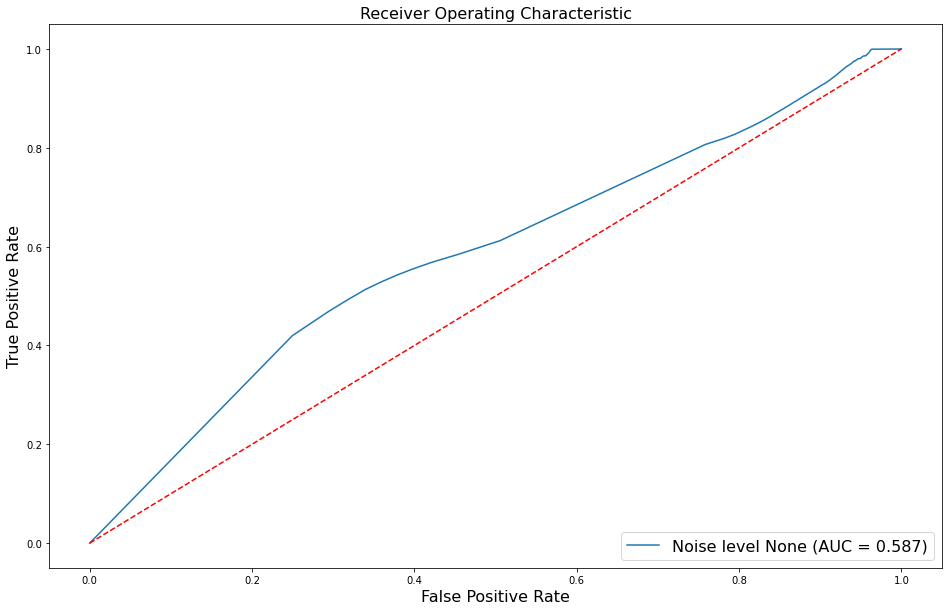

In [106]:
plt.figure(1, figsize=(16, 10))
plt.title('Receiver Operating Characteristic', fontsize = 16)


# Compute ROC metrics and AUC
fpr, tpr, thresholds = metrics.roc_curve(y_true, np.array(y_score)[:, 1])
auc_res = metrics.auc(fpr, tpr)

# Plots the ROC curve and show area.
plt.plot(fpr, tpr, label='Noise level {} (AUC = {:.3f})'.format('None', auc_res))

#plt.xlim([0, 0.2])
#plt.ylim([0.6, 1])
plt.ylabel('True Positive Rate', fontsize = 16)
plt.xlabel('False Positive Rate', fontsize = 16)
plt.plot([0,1],[0,1],'r--')
plt.legend(loc='lower right', prop={'size': 16})
plt.show()